In [1]:
import matplotlib.pyplot as plt
%matplotlib inline
import networkx as nx
import pandas as pd
import numpy as np
import seaborn as sns
from scipy.stats import pearsonr
from random import random as rnd

def buildNetwork(num):
    mat = np.zeros((num,num))
    for x in range(num):
        for y in range(x):
            if x == y: 
                continue
            dist = min((x-y)%num,(y-x)%num)
            if dist%num == 1:
                mat[x,y]=1
            else:
                mat[x,y]=-1
            #elif dist%num <=2:
            #    mat[x,y]=-1
    return nx.from_numpy_matrix(mat)

def buildRandomNetwork(num,pneg = .5):
    mat = np.zeros((num,num))
    for x in range(num):
        for y in range(num):
            if x == y: 
                continue
            if rnd() < pneg:
                mat[x,y]=-1
            else:
                mat[x,y]=1
            #elif dist%num <=2:
            #    mat[x,y]=-1
    return nx.from_numpy_matrix(mat)
                 
def calcEnergySurface(net):
    nodes = len(net.nodes())
    result = []
    for x in range(2**nodes):
        s = [i if i==1 else -1 for i in [int(i) for i in np.binary_repr(x,nodes)]]
        s.reverse()
        weight = -sum([s[u]* s[v]* edata['weight']  for u,v,edata in net.edges(data=True)])
        result.append((x,weight))
    return result

def collectEnergyStates(net):
    result = calcEnergySurface(net)
    hist = {}
    for i in result:
        if i[1] in hist:
            hist[i[1]].append(i[0])
        else: 
            hist[i[1]] = [i[0]]
    return hist

#Inspection

def inspectEnergyStates(net):
    result = collectEnergyStates(net)
    k = [k for k in result.keys()]
    k.sort()   
    for i in k:
        print("{} -> {}".format(i,result[i]))


def plotWeights(net):
    result = calcEnergySurface(g)
    fig = plt.figure()
    ax = fig.add_axes([0,0,1,1])
    states = [i[0] for i in result]
    weights = [i[1] for i in result]
    ax.bar(states,weights)
    plt.show()

def summariseWeights(net):
    result = calcEnergySurface(net)
    hist = {}
    for i in result:
        if i[1] in hist:
            hist[i[1]] = hist[i[1]]+1
        else: 
            hist[i[1]] = 1
    weights = [i for i in hist.keys()]
    counts = [i for i in hist.values()]
    fig = plt.figure()
   
    ax = fig.add_axes([0,0,1,1])
    ax.set_title('Nodes = {}'.format(net.number_of_nodes()))
    ax.bar(weights,counts)
    plt.show()
    
def measureFDC(attractor_matrix):
    # Jones & Forrest 1995
    diag = attractor_matrix.diagonal()
    best_val = min(diag)
    global_attractors = [i for i, v in enumerate(diag) if v == best_val]
    
    f = []
    d = []
    for i,j in enumerate(diag):
        if j == best_val:
            continue
        f.append(j)
        d.append(min([hamming(i,g) for g in global_attractors]))
    
    return f,d,pearsonr(f,d)    


# Interesting to look at, and would be curious to see if 
# there is a fractal attractor here.  What is the set of all energy states?
def inspectAttractorMap(_min,_max):
    levels = []
    values = []   
    for nodes in range(_min,_max):
        
        net = buildNetwork(nodes)
        result = calcEnergySurface(net)
        seen = set()
        for i in result:
            if not (i[1] in seen):
                levels.append(nodes)
                values.append(i[1])
    
    fig = plt.figure()
   
    ax = fig.add_axes([0,0,1,1])
    ax.set_title('Energy levels from {} - {}'.format(_min,_max))
    ax.scatter(levels,values)
    plt.show()
    

def showMatrixHeatmap(mat):
    sns.set(rc={'figure.figsize':(17,15)})
    sns.heatmap(mat,center=.5,cmap="YlGnBu")
    
    
# Deriving the transition matrix
def hamming(a,b):
    return(bin(a^b).count("1"))

def buildAttractorMatrix(net):
    weight = dict(calcEnergySurface(net))
    mx,mn = max(weight.values()),min(weight.values())
    # Remembering here that we're looking for *low* energy states, hence the subtract from 1
    scaled = [1-(weight[w]-mn)/(mx-mn) for w in range(len(weight))]
    mat = [scaled] * len(scaled)
    return(np.array(mat)) 

def buildInertialMatrix(bits,width,weight = 1):
    inertia_matrix = np.zeros((2**bits,2**bits))
    for row_st, row in enumerate(inertia_matrix):
        for col_st, col in enumerate(row):
            bits_difference = hamming(row_st, col_st)
            inertia_matrix[row_st, col_st] = max(0, 1- bits_difference *(1/width))
    return inertia_matrix*weight
    



In [15]:
i_mat.shape

(256, 256)

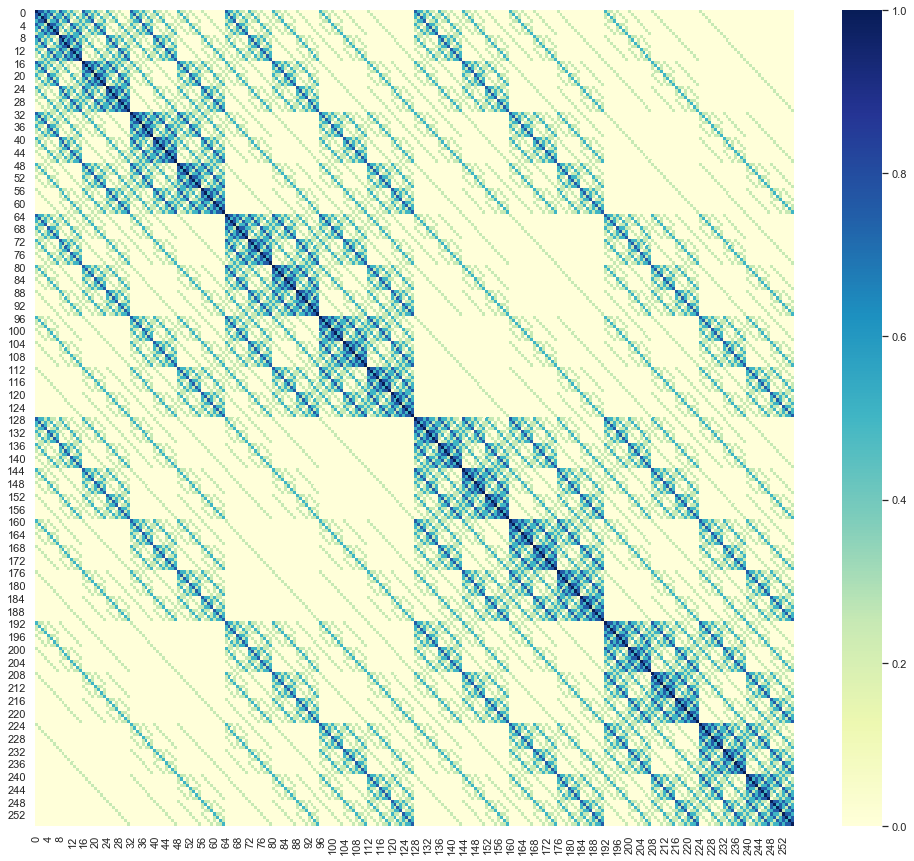

In [21]:
i_mat = buildInertialMatrix(8,4)
showMatrixHeatmap(i_mat)


# Next step: turn row into matrix, and then overlay inertial dampening

In [ ]:
def buildAttractorMatrix(net):
    weight = dict(calcEnergySurface(net))
    mx,mn = max(weight.values()),min(weight.values())
    # Remembering here that we're looking for *low* energy states, hence the subtract from 1
    scaled = [1-(weight[w]-mn)/(mx-mn) for w in range(len(weight))]
    mat = [scaled] * len(scaled)
    return(np.array(mat)) 

def calcEnergySurface(net):
    nodes = len(net.nodes())
    result = []
    for x in range(2**nodes):
        s = [i if i==1 else -1 for i in [int(i) for i in np.binary_repr(x,nodes)]]
        s.reverse()
        weight = -sum([s[u]* s[v]* edata['weight']  for u,v,edata in net.edges(data=True)])
        result.append((x,weight))
    return result

def collectEnergyStates(net):
    result = calcEnergySurface(net)
    hist = {}
    for i in result:
        if i[1] in hist:
            hist[i[1]].append(i[0])
        else: 
            hist[i[1]] = [i[0]]
    return hist

In [62]:
nodes = len(net.nodes())
result = []
for x in range(2**nodes):
    s = [i if i==1 else -1 for i in [int(i) for i in np.binary_repr(x,nodes)]]
    s.reverse()
    weight = -sum([s[u]* s[v]* edata['weight']  for u,v,edata in net.edges(data=True)])
    result.append((x,weight))

In [82]:
weight

33.0

In [72]:
print(net.edges(data = True))

[(0, 1, {'weight': 1.0}), (0, 2, {'weight': -1.0}), (0, 3, {'weight': -1.0}), (0, 4, {'weight': -1.0}), (0, 5, {'weight': -1.0}), (0, 6, {'weight': -1.0}), (0, 7, {'weight': -1.0}), (0, 8, {'weight': -1.0}), (0, 9, {'weight': -1.0}), (1, 2, {'weight': -1.0}), (1, 3, {'weight': -1.0}), (1, 4, {'weight': -1.0}), (1, 5, {'weight': -1.0}), (1, 6, {'weight': -1.0}), (1, 7, {'weight': 1.0}), (1, 8, {'weight': -1.0}), (1, 9, {'weight': -1.0}), (2, 3, {'weight': -1.0}), (2, 4, {'weight': -1.0}), (2, 5, {'weight': -1.0}), (2, 6, {'weight': -1.0}), (2, 7, {'weight': -1.0}), (2, 8, {'weight': -1.0}), (2, 9, {'weight': -1.0}), (3, 4, {'weight': -1.0}), (3, 5, {'weight': -1.0}), (3, 6, {'weight': -1.0}), (3, 7, {'weight': -1.0}), (3, 8, {'weight': -1.0}), (3, 9, {'weight': 1.0}), (4, 5, {'weight': -1.0}), (4, 6, {'weight': -1.0}), (4, 7, {'weight': -1.0}), (4, 8, {'weight': -1.0}), (4, 9, {'weight': -1.0}), (5, 6, {'weight': -1.0}), (5, 7, {'weight': -1.0}), (5, 8, {'weight': 1.0}), (5, 9, {'weight

In [59]:
net = buildRandomNetwork(10,.8)

result = calcEnergySurface(net)

In [61]:
result[-1]

(1023, 33.0)

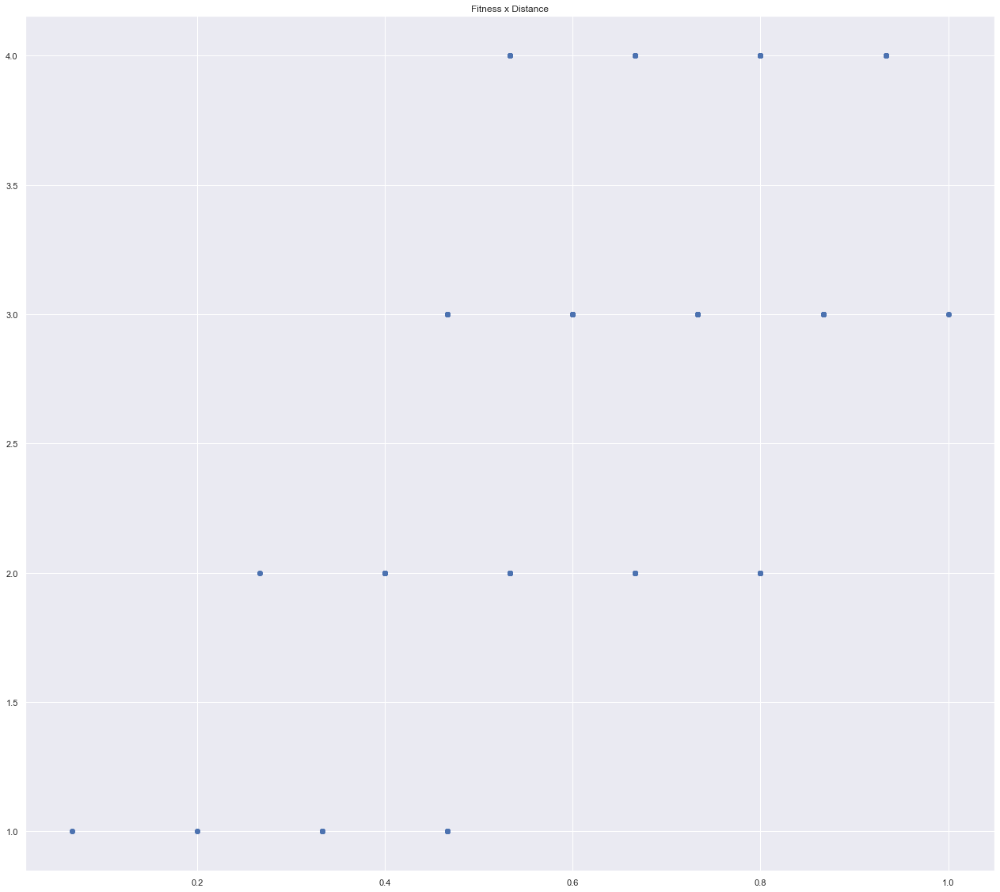

Correlation (0.6231819864885614, 1.0055390850309231e-28)


In [83]:
net = buildRandomNetwork(8,.8)
att_m = buildAttractorMatrix(net)
f,d,r = measureFDC(att_m)
fig = plt.figure()
   
ax = fig.add_axes([0,0,1,1])
ax.set_title('Fitness x Distance')
ax.scatter(f,d)
plt.show()

print("Correlation {}".format(r))

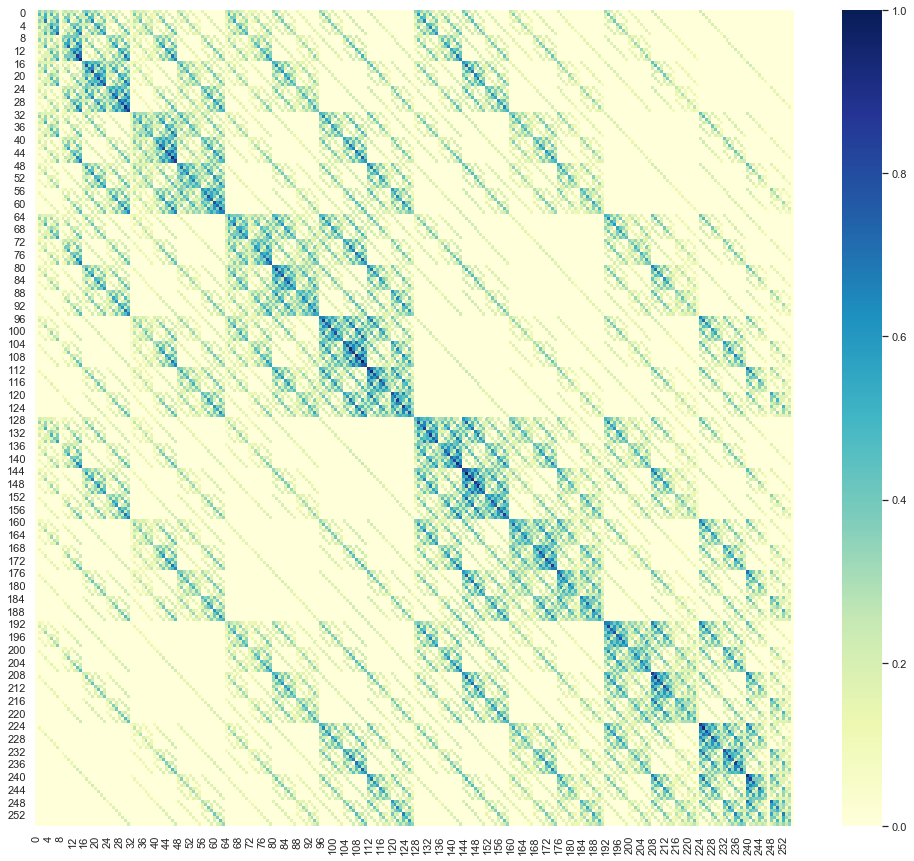

In [84]:
combined = att_m * i_mat
showMatrixHeatmap(combined)

In [10]:
data = []
for x in range(1,20):
    local = []
    for rep in range(50):
        net = buildRandomNetwork(10,x/20)
        att_m = buildAttractorMatrix(net)
        f,d,r = measureFDC(att_m)
        local.append(r[0])
    #print("{}".format(local))
    data.append((x/20,np.mean(local)))

print(data)


[(0.05, 0.678824443898164), (0.1, 0.44444580125586797), (0.15, 0.42391244705409653), (0.2, 0.40943196634643286), (0.25, 0.4200893600191869), (0.3, 0.41675177760736637), (0.35, 0.42194369123219283), (0.4, 0.42217734616830227), (0.45, 0.4417397461415146), (0.5, 0.43275325898952377), (0.55, 0.4347442551600917), (0.6, 0.43767036027748796), (0.65, 0.45583691433715434), (0.7, 0.44432251939015527), (0.75, 0.5048424044074978), (0.8, 0.5459066397609003), (0.85, 0.6288294895675922), (0.9, 0.7237908520706441), (0.95, 0.8077909233762791)]


In [52]:
x = dict([(1,2),(3,4)])
max(x.values())

4

In [12]:
x = [1,2,3,4,5]
np.mean(x)

3.0

In [13]:
from scipy.stats import pearsonr 
x = [1,2,3,4]
y=[5,4,3,2]
pearsonr(x,y)[0]

-1.0

In [93]:
from scipy.special import softmax

In [94]:
np.random.randint(1024)

956

In [108]:
np.random.rand(1)

array([0.42958974])

In [148]:
np.argmax(np.add.accumulate(softmax(combined[100])) > np.random.uniform(low = 0.0, high = 1.0))

228

In [155]:
sample = []
init = np.random.randint(256)
for i in range(100000000):
    if i % 100 == 0:
        print('iteration No.' + str(i))
    sampled = np.argmax(np.add.accumulate(softmax(combined[init])) > np.random.uniform(low = 0.0, high = 1.0))
    sample.append(sampled)
    init = sampled

iteration No.0
iteration No.100
iteration No.200
iteration No.300
iteration No.400
iteration No.500
iteration No.600
iteration No.700
iteration No.800
iteration No.900
iteration No.1000
iteration No.1100
iteration No.1200
iteration No.1300
iteration No.1400
iteration No.1500
iteration No.1600
iteration No.1700
iteration No.1800
iteration No.1900
iteration No.2000
iteration No.2100
iteration No.2200
iteration No.2300
iteration No.2400
iteration No.2500
iteration No.2600
iteration No.2700
iteration No.2800
iteration No.2900
iteration No.3000
iteration No.3100
iteration No.3200
iteration No.3300
iteration No.3400
iteration No.3500
iteration No.3600
iteration No.3700
iteration No.3800
iteration No.3900
iteration No.4000
iteration No.4100
iteration No.4200
iteration No.4300
iteration No.4400
iteration No.4500
iteration No.4600
iteration No.4700
iteration No.4800
iteration No.4900
iteration No.5000
iteration No.5100
iteration No.5200
iteration No.5300
iteration No.5400
iteration No.5500
iter

iteration No.44400
iteration No.44500
iteration No.44600
iteration No.44700
iteration No.44800
iteration No.44900
iteration No.45000
iteration No.45100
iteration No.45200
iteration No.45300
iteration No.45400
iteration No.45500
iteration No.45600
iteration No.45700
iteration No.45800
iteration No.45900
iteration No.46000
iteration No.46100
iteration No.46200
iteration No.46300
iteration No.46400
iteration No.46500
iteration No.46600
iteration No.46700
iteration No.46800
iteration No.46900
iteration No.47000
iteration No.47100
iteration No.47200
iteration No.47300
iteration No.47400
iteration No.47500
iteration No.47600
iteration No.47700
iteration No.47800
iteration No.47900
iteration No.48000
iteration No.48100
iteration No.48200
iteration No.48300
iteration No.48400
iteration No.48500
iteration No.48600
iteration No.48700
iteration No.48800
iteration No.48900
iteration No.49000
iteration No.49100
iteration No.49200
iteration No.49300
iteration No.49400
iteration No.49500
iteration No

iteration No.88800
iteration No.88900
iteration No.89000
iteration No.89100
iteration No.89200
iteration No.89300
iteration No.89400
iteration No.89500
iteration No.89600
iteration No.89700
iteration No.89800
iteration No.89900
iteration No.90000
iteration No.90100
iteration No.90200
iteration No.90300
iteration No.90400
iteration No.90500
iteration No.90600
iteration No.90700
iteration No.90800
iteration No.90900
iteration No.91000
iteration No.91100
iteration No.91200
iteration No.91300
iteration No.91400
iteration No.91500
iteration No.91600
iteration No.91700
iteration No.91800
iteration No.91900
iteration No.92000
iteration No.92100
iteration No.92200
iteration No.92300
iteration No.92400
iteration No.92500
iteration No.92600
iteration No.92700
iteration No.92800
iteration No.92900
iteration No.93000
iteration No.93100
iteration No.93200
iteration No.93300
iteration No.93400
iteration No.93500
iteration No.93600
iteration No.93700
iteration No.93800
iteration No.93900
iteration No

iteration No.130400
iteration No.130500
iteration No.130600
iteration No.130700
iteration No.130800
iteration No.130900
iteration No.131000
iteration No.131100
iteration No.131200
iteration No.131300
iteration No.131400
iteration No.131500
iteration No.131600
iteration No.131700
iteration No.131800
iteration No.131900
iteration No.132000
iteration No.132100
iteration No.132200
iteration No.132300
iteration No.132400
iteration No.132500
iteration No.132600
iteration No.132700
iteration No.132800
iteration No.132900
iteration No.133000
iteration No.133100
iteration No.133200
iteration No.133300
iteration No.133400
iteration No.133500
iteration No.133600
iteration No.133700
iteration No.133800
iteration No.133900
iteration No.134000
iteration No.134100
iteration No.134200
iteration No.134300
iteration No.134400
iteration No.134500
iteration No.134600
iteration No.134700
iteration No.134800
iteration No.134900
iteration No.135000
iteration No.135100
iteration No.135200
iteration No.135300


iteration No.172100
iteration No.172200
iteration No.172300
iteration No.172400
iteration No.172500
iteration No.172600
iteration No.172700
iteration No.172800
iteration No.172900
iteration No.173000
iteration No.173100
iteration No.173200
iteration No.173300
iteration No.173400
iteration No.173500
iteration No.173600
iteration No.173700
iteration No.173800
iteration No.173900
iteration No.174000
iteration No.174100
iteration No.174200
iteration No.174300
iteration No.174400
iteration No.174500
iteration No.174600
iteration No.174700
iteration No.174800
iteration No.174900
iteration No.175000
iteration No.175100
iteration No.175200
iteration No.175300
iteration No.175400
iteration No.175500
iteration No.175600
iteration No.175700
iteration No.175800
iteration No.175900
iteration No.176000
iteration No.176100
iteration No.176200
iteration No.176300
iteration No.176400
iteration No.176500
iteration No.176600
iteration No.176700
iteration No.176800
iteration No.176900
iteration No.177000


iteration No.214400
iteration No.214500
iteration No.214600
iteration No.214700
iteration No.214800
iteration No.214900
iteration No.215000
iteration No.215100
iteration No.215200
iteration No.215300
iteration No.215400
iteration No.215500
iteration No.215600
iteration No.215700
iteration No.215800
iteration No.215900
iteration No.216000
iteration No.216100
iteration No.216200
iteration No.216300
iteration No.216400
iteration No.216500
iteration No.216600
iteration No.216700
iteration No.216800
iteration No.216900
iteration No.217000
iteration No.217100
iteration No.217200
iteration No.217300
iteration No.217400
iteration No.217500
iteration No.217600
iteration No.217700
iteration No.217800
iteration No.217900
iteration No.218000
iteration No.218100
iteration No.218200
iteration No.218300
iteration No.218400
iteration No.218500
iteration No.218600
iteration No.218700
iteration No.218800
iteration No.218900
iteration No.219000
iteration No.219100
iteration No.219200
iteration No.219300


iteration No.255900
iteration No.256000
iteration No.256100
iteration No.256200
iteration No.256300
iteration No.256400
iteration No.256500
iteration No.256600
iteration No.256700
iteration No.256800
iteration No.256900
iteration No.257000
iteration No.257100
iteration No.257200
iteration No.257300
iteration No.257400
iteration No.257500
iteration No.257600
iteration No.257700
iteration No.257800
iteration No.257900
iteration No.258000
iteration No.258100
iteration No.258200
iteration No.258300
iteration No.258400
iteration No.258500
iteration No.258600
iteration No.258700
iteration No.258800
iteration No.258900
iteration No.259000
iteration No.259100
iteration No.259200
iteration No.259300
iteration No.259400
iteration No.259500
iteration No.259600
iteration No.259700
iteration No.259800
iteration No.259900
iteration No.260000
iteration No.260100
iteration No.260200
iteration No.260300
iteration No.260400
iteration No.260500
iteration No.260600
iteration No.260700
iteration No.260800


iteration No.297400
iteration No.297500
iteration No.297600
iteration No.297700
iteration No.297800
iteration No.297900
iteration No.298000
iteration No.298100
iteration No.298200
iteration No.298300
iteration No.298400
iteration No.298500
iteration No.298600
iteration No.298700
iteration No.298800
iteration No.298900
iteration No.299000
iteration No.299100
iteration No.299200
iteration No.299300
iteration No.299400
iteration No.299500
iteration No.299600
iteration No.299700
iteration No.299800
iteration No.299900
iteration No.300000
iteration No.300100
iteration No.300200
iteration No.300300
iteration No.300400
iteration No.300500
iteration No.300600
iteration No.300700
iteration No.300800
iteration No.300900
iteration No.301000
iteration No.301100
iteration No.301200
iteration No.301300
iteration No.301400
iteration No.301500
iteration No.301600
iteration No.301700
iteration No.301800
iteration No.301900
iteration No.302000
iteration No.302100
iteration No.302200
iteration No.302300


iteration No.339000
iteration No.339100
iteration No.339200
iteration No.339300
iteration No.339400
iteration No.339500
iteration No.339600
iteration No.339700
iteration No.339800
iteration No.339900
iteration No.340000
iteration No.340100
iteration No.340200
iteration No.340300
iteration No.340400
iteration No.340500
iteration No.340600
iteration No.340700
iteration No.340800
iteration No.340900
iteration No.341000
iteration No.341100
iteration No.341200
iteration No.341300
iteration No.341400
iteration No.341500
iteration No.341600
iteration No.341700
iteration No.341800
iteration No.341900
iteration No.342000
iteration No.342100
iteration No.342200
iteration No.342300
iteration No.342400
iteration No.342500
iteration No.342600
iteration No.342700
iteration No.342800
iteration No.342900
iteration No.343000
iteration No.343100
iteration No.343200
iteration No.343300
iteration No.343400
iteration No.343500
iteration No.343600
iteration No.343700
iteration No.343800
iteration No.343900


iteration No.382000
iteration No.382100
iteration No.382200
iteration No.382300
iteration No.382400
iteration No.382500
iteration No.382600
iteration No.382700
iteration No.382800
iteration No.382900
iteration No.383000
iteration No.383100
iteration No.383200
iteration No.383300
iteration No.383400
iteration No.383500
iteration No.383600
iteration No.383700
iteration No.383800
iteration No.383900
iteration No.384000
iteration No.384100
iteration No.384200
iteration No.384300
iteration No.384400
iteration No.384500
iteration No.384600
iteration No.384700
iteration No.384800
iteration No.384900
iteration No.385000
iteration No.385100
iteration No.385200
iteration No.385300
iteration No.385400
iteration No.385500
iteration No.385600
iteration No.385700
iteration No.385800
iteration No.385900
iteration No.386000
iteration No.386100
iteration No.386200
iteration No.386300
iteration No.386400
iteration No.386500
iteration No.386600
iteration No.386700
iteration No.386800
iteration No.386900


iteration No.423100
iteration No.423200
iteration No.423300
iteration No.423400
iteration No.423500
iteration No.423600
iteration No.423700
iteration No.423800
iteration No.423900
iteration No.424000
iteration No.424100
iteration No.424200
iteration No.424300
iteration No.424400
iteration No.424500
iteration No.424600
iteration No.424700
iteration No.424800
iteration No.424900
iteration No.425000
iteration No.425100
iteration No.425200
iteration No.425300
iteration No.425400
iteration No.425500
iteration No.425600
iteration No.425700
iteration No.425800
iteration No.425900
iteration No.426000
iteration No.426100
iteration No.426200
iteration No.426300
iteration No.426400
iteration No.426500
iteration No.426600
iteration No.426700
iteration No.426800
iteration No.426900
iteration No.427000
iteration No.427100
iteration No.427200
iteration No.427300
iteration No.427400
iteration No.427500
iteration No.427600
iteration No.427700
iteration No.427800
iteration No.427900
iteration No.428000


iteration No.464900
iteration No.465000
iteration No.465100
iteration No.465200
iteration No.465300
iteration No.465400
iteration No.465500
iteration No.465600
iteration No.465700
iteration No.465800
iteration No.465900
iteration No.466000
iteration No.466100
iteration No.466200
iteration No.466300
iteration No.466400
iteration No.466500
iteration No.466600
iteration No.466700
iteration No.466800
iteration No.466900
iteration No.467000
iteration No.467100
iteration No.467200
iteration No.467300
iteration No.467400
iteration No.467500
iteration No.467600
iteration No.467700
iteration No.467800
iteration No.467900
iteration No.468000
iteration No.468100
iteration No.468200
iteration No.468300
iteration No.468400
iteration No.468500
iteration No.468600
iteration No.468700
iteration No.468800
iteration No.468900
iteration No.469000
iteration No.469100
iteration No.469200
iteration No.469300
iteration No.469400
iteration No.469500
iteration No.469600
iteration No.469700
iteration No.469800


iteration No.507000
iteration No.507100
iteration No.507200
iteration No.507300
iteration No.507400
iteration No.507500
iteration No.507600
iteration No.507700
iteration No.507800
iteration No.507900
iteration No.508000
iteration No.508100
iteration No.508200
iteration No.508300
iteration No.508400
iteration No.508500
iteration No.508600
iteration No.508700
iteration No.508800
iteration No.508900
iteration No.509000
iteration No.509100
iteration No.509200
iteration No.509300
iteration No.509400
iteration No.509500
iteration No.509600
iteration No.509700
iteration No.509800
iteration No.509900
iteration No.510000
iteration No.510100
iteration No.510200
iteration No.510300
iteration No.510400
iteration No.510500
iteration No.510600
iteration No.510700
iteration No.510800
iteration No.510900
iteration No.511000
iteration No.511100
iteration No.511200
iteration No.511300
iteration No.511400
iteration No.511500
iteration No.511600
iteration No.511700
iteration No.511800
iteration No.511900


iteration No.548200
iteration No.548300
iteration No.548400
iteration No.548500
iteration No.548600
iteration No.548700
iteration No.548800
iteration No.548900
iteration No.549000
iteration No.549100
iteration No.549200
iteration No.549300
iteration No.549400
iteration No.549500
iteration No.549600
iteration No.549700
iteration No.549800
iteration No.549900
iteration No.550000
iteration No.550100
iteration No.550200
iteration No.550300
iteration No.550400
iteration No.550500
iteration No.550600
iteration No.550700
iteration No.550800
iteration No.550900
iteration No.551000
iteration No.551100
iteration No.551200
iteration No.551300
iteration No.551400
iteration No.551500
iteration No.551600
iteration No.551700
iteration No.551800
iteration No.551900
iteration No.552000
iteration No.552100
iteration No.552200
iteration No.552300
iteration No.552400
iteration No.552500
iteration No.552600
iteration No.552700
iteration No.552800
iteration No.552900
iteration No.553000
iteration No.553100


iteration No.591100
iteration No.591200
iteration No.591300
iteration No.591400
iteration No.591500
iteration No.591600
iteration No.591700
iteration No.591800
iteration No.591900
iteration No.592000
iteration No.592100
iteration No.592200
iteration No.592300
iteration No.592400
iteration No.592500
iteration No.592600
iteration No.592700
iteration No.592800
iteration No.592900
iteration No.593000
iteration No.593100
iteration No.593200
iteration No.593300
iteration No.593400
iteration No.593500
iteration No.593600
iteration No.593700
iteration No.593800
iteration No.593900
iteration No.594000
iteration No.594100
iteration No.594200
iteration No.594300
iteration No.594400
iteration No.594500
iteration No.594600
iteration No.594700
iteration No.594800
iteration No.594900
iteration No.595000
iteration No.595100
iteration No.595200
iteration No.595300
iteration No.595400
iteration No.595500
iteration No.595600
iteration No.595700
iteration No.595800
iteration No.595900
iteration No.596000


iteration No.632000
iteration No.632100
iteration No.632200
iteration No.632300
iteration No.632400
iteration No.632500
iteration No.632600
iteration No.632700
iteration No.632800
iteration No.632900
iteration No.633000
iteration No.633100
iteration No.633200
iteration No.633300
iteration No.633400
iteration No.633500
iteration No.633600
iteration No.633700
iteration No.633800
iteration No.633900
iteration No.634000
iteration No.634100
iteration No.634200
iteration No.634300
iteration No.634400
iteration No.634500
iteration No.634600
iteration No.634700
iteration No.634800
iteration No.634900
iteration No.635000
iteration No.635100
iteration No.635200
iteration No.635300
iteration No.635400
iteration No.635500
iteration No.635600
iteration No.635700
iteration No.635800
iteration No.635900
iteration No.636000
iteration No.636100
iteration No.636200
iteration No.636300
iteration No.636400
iteration No.636500
iteration No.636600
iteration No.636700
iteration No.636800
iteration No.636900


iteration No.673600
iteration No.673700
iteration No.673800
iteration No.673900
iteration No.674000
iteration No.674100
iteration No.674200
iteration No.674300
iteration No.674400
iteration No.674500
iteration No.674600
iteration No.674700
iteration No.674800
iteration No.674900
iteration No.675000
iteration No.675100
iteration No.675200
iteration No.675300
iteration No.675400
iteration No.675500
iteration No.675600
iteration No.675700
iteration No.675800
iteration No.675900
iteration No.676000
iteration No.676100
iteration No.676200
iteration No.676300
iteration No.676400
iteration No.676500
iteration No.676600
iteration No.676700
iteration No.676800
iteration No.676900
iteration No.677000
iteration No.677100
iteration No.677200
iteration No.677300
iteration No.677400
iteration No.677500
iteration No.677600
iteration No.677700
iteration No.677800
iteration No.677900
iteration No.678000
iteration No.678100
iteration No.678200
iteration No.678300
iteration No.678400
iteration No.678500


iteration No.716400
iteration No.716500
iteration No.716600
iteration No.716700
iteration No.716800
iteration No.716900
iteration No.717000
iteration No.717100
iteration No.717200
iteration No.717300
iteration No.717400
iteration No.717500
iteration No.717600
iteration No.717700
iteration No.717800
iteration No.717900
iteration No.718000
iteration No.718100
iteration No.718200
iteration No.718300
iteration No.718400
iteration No.718500
iteration No.718600
iteration No.718700
iteration No.718800
iteration No.718900
iteration No.719000
iteration No.719100
iteration No.719200
iteration No.719300
iteration No.719400
iteration No.719500
iteration No.719600
iteration No.719700
iteration No.719800
iteration No.719900
iteration No.720000
iteration No.720100
iteration No.720200
iteration No.720300
iteration No.720400
iteration No.720500
iteration No.720600
iteration No.720700
iteration No.720800
iteration No.720900
iteration No.721000
iteration No.721100
iteration No.721200
iteration No.721300


iteration No.757400
iteration No.757500
iteration No.757600
iteration No.757700
iteration No.757800
iteration No.757900
iteration No.758000
iteration No.758100
iteration No.758200
iteration No.758300
iteration No.758400
iteration No.758500
iteration No.758600
iteration No.758700
iteration No.758800
iteration No.758900
iteration No.759000
iteration No.759100
iteration No.759200
iteration No.759300
iteration No.759400
iteration No.759500
iteration No.759600
iteration No.759700
iteration No.759800
iteration No.759900
iteration No.760000
iteration No.760100
iteration No.760200
iteration No.760300
iteration No.760400
iteration No.760500
iteration No.760600
iteration No.760700
iteration No.760800
iteration No.760900
iteration No.761000
iteration No.761100
iteration No.761200
iteration No.761300
iteration No.761400
iteration No.761500
iteration No.761600
iteration No.761700
iteration No.761800
iteration No.761900
iteration No.762000
iteration No.762100
iteration No.762200
iteration No.762300


iteration No.798400
iteration No.798500
iteration No.798600
iteration No.798700
iteration No.798800
iteration No.798900
iteration No.799000
iteration No.799100
iteration No.799200
iteration No.799300
iteration No.799400
iteration No.799500
iteration No.799600
iteration No.799700
iteration No.799800
iteration No.799900
iteration No.800000
iteration No.800100
iteration No.800200
iteration No.800300
iteration No.800400
iteration No.800500
iteration No.800600
iteration No.800700
iteration No.800800
iteration No.800900
iteration No.801000
iteration No.801100
iteration No.801200
iteration No.801300
iteration No.801400
iteration No.801500
iteration No.801600
iteration No.801700
iteration No.801800
iteration No.801900
iteration No.802000
iteration No.802100
iteration No.802200
iteration No.802300
iteration No.802400
iteration No.802500
iteration No.802600
iteration No.802700
iteration No.802800
iteration No.802900
iteration No.803000
iteration No.803100
iteration No.803200
iteration No.803300


iteration No.840600
iteration No.840700
iteration No.840800
iteration No.840900
iteration No.841000
iteration No.841100
iteration No.841200
iteration No.841300
iteration No.841400
iteration No.841500
iteration No.841600
iteration No.841700
iteration No.841800
iteration No.841900
iteration No.842000
iteration No.842100
iteration No.842200
iteration No.842300
iteration No.842400
iteration No.842500
iteration No.842600
iteration No.842700
iteration No.842800
iteration No.842900
iteration No.843000
iteration No.843100
iteration No.843200
iteration No.843300
iteration No.843400
iteration No.843500
iteration No.843600
iteration No.843700
iteration No.843800
iteration No.843900
iteration No.844000
iteration No.844100
iteration No.844200
iteration No.844300
iteration No.844400
iteration No.844500
iteration No.844600
iteration No.844700
iteration No.844800
iteration No.844900
iteration No.845000
iteration No.845100
iteration No.845200
iteration No.845300
iteration No.845400
iteration No.845500


iteration No.882100
iteration No.882200
iteration No.882300
iteration No.882400
iteration No.882500
iteration No.882600
iteration No.882700
iteration No.882800
iteration No.882900
iteration No.883000
iteration No.883100
iteration No.883200
iteration No.883300
iteration No.883400
iteration No.883500
iteration No.883600
iteration No.883700
iteration No.883800
iteration No.883900
iteration No.884000
iteration No.884100
iteration No.884200
iteration No.884300
iteration No.884400
iteration No.884500
iteration No.884600
iteration No.884700
iteration No.884800
iteration No.884900
iteration No.885000
iteration No.885100
iteration No.885200
iteration No.885300
iteration No.885400
iteration No.885500
iteration No.885600
iteration No.885700
iteration No.885800
iteration No.885900
iteration No.886000
iteration No.886100
iteration No.886200
iteration No.886300
iteration No.886400
iteration No.886500
iteration No.886600
iteration No.886700
iteration No.886800
iteration No.886900
iteration No.887000


iteration No.924800
iteration No.924900
iteration No.925000
iteration No.925100
iteration No.925200
iteration No.925300
iteration No.925400
iteration No.925500
iteration No.925600
iteration No.925700
iteration No.925800
iteration No.925900
iteration No.926000
iteration No.926100
iteration No.926200
iteration No.926300
iteration No.926400
iteration No.926500
iteration No.926600
iteration No.926700
iteration No.926800
iteration No.926900
iteration No.927000
iteration No.927100
iteration No.927200
iteration No.927300
iteration No.927400
iteration No.927500
iteration No.927600
iteration No.927700
iteration No.927800
iteration No.927900
iteration No.928000
iteration No.928100
iteration No.928200
iteration No.928300
iteration No.928400
iteration No.928500
iteration No.928600
iteration No.928700
iteration No.928800
iteration No.928900
iteration No.929000
iteration No.929100
iteration No.929200
iteration No.929300
iteration No.929400
iteration No.929500
iteration No.929600
iteration No.929700


iteration No.967000
iteration No.967100
iteration No.967200
iteration No.967300
iteration No.967400
iteration No.967500
iteration No.967600
iteration No.967700
iteration No.967800
iteration No.967900
iteration No.968000
iteration No.968100
iteration No.968200
iteration No.968300
iteration No.968400
iteration No.968500
iteration No.968600
iteration No.968700
iteration No.968800
iteration No.968900
iteration No.969000
iteration No.969100
iteration No.969200
iteration No.969300
iteration No.969400
iteration No.969500
iteration No.969600
iteration No.969700
iteration No.969800
iteration No.969900
iteration No.970000
iteration No.970100
iteration No.970200
iteration No.970300
iteration No.970400
iteration No.970500
iteration No.970600
iteration No.970700
iteration No.970800
iteration No.970900
iteration No.971000
iteration No.971100
iteration No.971200
iteration No.971300
iteration No.971400
iteration No.971500
iteration No.971600
iteration No.971700
iteration No.971800
iteration No.971900


iteration No.1008100
iteration No.1008200
iteration No.1008300
iteration No.1008400
iteration No.1008500
iteration No.1008600
iteration No.1008700
iteration No.1008800
iteration No.1008900
iteration No.1009000
iteration No.1009100
iteration No.1009200
iteration No.1009300
iteration No.1009400
iteration No.1009500
iteration No.1009600
iteration No.1009700
iteration No.1009800
iteration No.1009900
iteration No.1010000
iteration No.1010100
iteration No.1010200
iteration No.1010300
iteration No.1010400
iteration No.1010500
iteration No.1010600
iteration No.1010700
iteration No.1010800
iteration No.1010900
iteration No.1011000
iteration No.1011100
iteration No.1011200
iteration No.1011300
iteration No.1011400
iteration No.1011500
iteration No.1011600
iteration No.1011700
iteration No.1011800
iteration No.1011900
iteration No.1012000
iteration No.1012100
iteration No.1012200
iteration No.1012300
iteration No.1012400
iteration No.1012500
iteration No.1012600
iteration No.1012700
iteration No.

iteration No.1047600
iteration No.1047700
iteration No.1047800
iteration No.1047900
iteration No.1048000
iteration No.1048100
iteration No.1048200
iteration No.1048300
iteration No.1048400
iteration No.1048500
iteration No.1048600
iteration No.1048700
iteration No.1048800
iteration No.1048900
iteration No.1049000
iteration No.1049100
iteration No.1049200
iteration No.1049300
iteration No.1049400
iteration No.1049500
iteration No.1049600
iteration No.1049700
iteration No.1049800
iteration No.1049900
iteration No.1050000
iteration No.1050100
iteration No.1050200
iteration No.1050300
iteration No.1050400
iteration No.1050500
iteration No.1050600
iteration No.1050700
iteration No.1050800
iteration No.1050900
iteration No.1051000
iteration No.1051100
iteration No.1051200
iteration No.1051300
iteration No.1051400
iteration No.1051500
iteration No.1051600
iteration No.1051700
iteration No.1051800
iteration No.1051900
iteration No.1052000
iteration No.1052100
iteration No.1052200
iteration No.

iteration No.1086700
iteration No.1086800
iteration No.1086900
iteration No.1087000
iteration No.1087100
iteration No.1087200
iteration No.1087300
iteration No.1087400
iteration No.1087500
iteration No.1087600
iteration No.1087700
iteration No.1087800
iteration No.1087900
iteration No.1088000
iteration No.1088100
iteration No.1088200
iteration No.1088300
iteration No.1088400
iteration No.1088500
iteration No.1088600
iteration No.1088700
iteration No.1088800
iteration No.1088900
iteration No.1089000
iteration No.1089100
iteration No.1089200
iteration No.1089300
iteration No.1089400
iteration No.1089500
iteration No.1089600
iteration No.1089700
iteration No.1089800
iteration No.1089900
iteration No.1090000
iteration No.1090100
iteration No.1090200
iteration No.1090300
iteration No.1090400
iteration No.1090500
iteration No.1090600
iteration No.1090700
iteration No.1090800
iteration No.1090900
iteration No.1091000
iteration No.1091100
iteration No.1091200
iteration No.1091300
iteration No.

iteration No.1127100
iteration No.1127200
iteration No.1127300
iteration No.1127400
iteration No.1127500
iteration No.1127600
iteration No.1127700
iteration No.1127800
iteration No.1127900
iteration No.1128000
iteration No.1128100
iteration No.1128200
iteration No.1128300
iteration No.1128400
iteration No.1128500
iteration No.1128600
iteration No.1128700
iteration No.1128800
iteration No.1128900
iteration No.1129000
iteration No.1129100
iteration No.1129200
iteration No.1129300
iteration No.1129400
iteration No.1129500
iteration No.1129600
iteration No.1129700
iteration No.1129800
iteration No.1129900
iteration No.1130000
iteration No.1130100
iteration No.1130200
iteration No.1130300
iteration No.1130400
iteration No.1130500
iteration No.1130600
iteration No.1130700
iteration No.1130800
iteration No.1130900
iteration No.1131000
iteration No.1131100
iteration No.1131200
iteration No.1131300
iteration No.1131400
iteration No.1131500
iteration No.1131600
iteration No.1131700
iteration No.

iteration No.1166400
iteration No.1166500
iteration No.1166600
iteration No.1166700
iteration No.1166800
iteration No.1166900
iteration No.1167000
iteration No.1167100
iteration No.1167200
iteration No.1167300
iteration No.1167400
iteration No.1167500
iteration No.1167600
iteration No.1167700
iteration No.1167800
iteration No.1167900
iteration No.1168000
iteration No.1168100
iteration No.1168200
iteration No.1168300
iteration No.1168400
iteration No.1168500
iteration No.1168600
iteration No.1168700
iteration No.1168800
iteration No.1168900
iteration No.1169000
iteration No.1169100
iteration No.1169200
iteration No.1169300
iteration No.1169400
iteration No.1169500
iteration No.1169600
iteration No.1169700
iteration No.1169800
iteration No.1169900
iteration No.1170000
iteration No.1170100
iteration No.1170200
iteration No.1170300
iteration No.1170400
iteration No.1170500
iteration No.1170600
iteration No.1170700
iteration No.1170800
iteration No.1170900
iteration No.1171000
iteration No.

iteration No.1206100
iteration No.1206200
iteration No.1206300
iteration No.1206400
iteration No.1206500
iteration No.1206600
iteration No.1206700
iteration No.1206800
iteration No.1206900
iteration No.1207000
iteration No.1207100
iteration No.1207200
iteration No.1207300
iteration No.1207400
iteration No.1207500
iteration No.1207600
iteration No.1207700
iteration No.1207800
iteration No.1207900
iteration No.1208000
iteration No.1208100
iteration No.1208200
iteration No.1208300
iteration No.1208400
iteration No.1208500
iteration No.1208600
iteration No.1208700
iteration No.1208800
iteration No.1208900
iteration No.1209000
iteration No.1209100
iteration No.1209200
iteration No.1209300
iteration No.1209400
iteration No.1209500
iteration No.1209600
iteration No.1209700
iteration No.1209800
iteration No.1209900
iteration No.1210000
iteration No.1210100
iteration No.1210200
iteration No.1210300
iteration No.1210400
iteration No.1210500
iteration No.1210600
iteration No.1210700
iteration No.

iteration No.1247200
iteration No.1247300
iteration No.1247400
iteration No.1247500
iteration No.1247600
iteration No.1247700
iteration No.1247800
iteration No.1247900
iteration No.1248000
iteration No.1248100
iteration No.1248200
iteration No.1248300
iteration No.1248400
iteration No.1248500
iteration No.1248600
iteration No.1248700
iteration No.1248800
iteration No.1248900
iteration No.1249000
iteration No.1249100
iteration No.1249200
iteration No.1249300
iteration No.1249400
iteration No.1249500
iteration No.1249600
iteration No.1249700
iteration No.1249800
iteration No.1249900
iteration No.1250000
iteration No.1250100
iteration No.1250200
iteration No.1250300
iteration No.1250400
iteration No.1250500
iteration No.1250600
iteration No.1250700
iteration No.1250800
iteration No.1250900
iteration No.1251000
iteration No.1251100
iteration No.1251200
iteration No.1251300
iteration No.1251400
iteration No.1251500
iteration No.1251600
iteration No.1251700
iteration No.1251800
iteration No.

iteration No.1288300
iteration No.1288400
iteration No.1288500
iteration No.1288600
iteration No.1288700
iteration No.1288800
iteration No.1288900
iteration No.1289000
iteration No.1289100
iteration No.1289200
iteration No.1289300
iteration No.1289400
iteration No.1289500
iteration No.1289600
iteration No.1289700
iteration No.1289800
iteration No.1289900
iteration No.1290000
iteration No.1290100
iteration No.1290200
iteration No.1290300
iteration No.1290400
iteration No.1290500
iteration No.1290600
iteration No.1290700
iteration No.1290800
iteration No.1290900
iteration No.1291000
iteration No.1291100
iteration No.1291200
iteration No.1291300
iteration No.1291400
iteration No.1291500
iteration No.1291600
iteration No.1291700
iteration No.1291800
iteration No.1291900
iteration No.1292000
iteration No.1292100
iteration No.1292200
iteration No.1292300
iteration No.1292400
iteration No.1292500
iteration No.1292600
iteration No.1292700
iteration No.1292800
iteration No.1292900
iteration No.

iteration No.1327500
iteration No.1327600
iteration No.1327700
iteration No.1327800
iteration No.1327900
iteration No.1328000
iteration No.1328100
iteration No.1328200
iteration No.1328300
iteration No.1328400
iteration No.1328500
iteration No.1328600
iteration No.1328700
iteration No.1328800
iteration No.1328900
iteration No.1329000
iteration No.1329100
iteration No.1329200
iteration No.1329300
iteration No.1329400
iteration No.1329500
iteration No.1329600
iteration No.1329700
iteration No.1329800
iteration No.1329900
iteration No.1330000
iteration No.1330100
iteration No.1330200
iteration No.1330300
iteration No.1330400
iteration No.1330500
iteration No.1330600
iteration No.1330700
iteration No.1330800
iteration No.1330900
iteration No.1331000
iteration No.1331100
iteration No.1331200
iteration No.1331300
iteration No.1331400
iteration No.1331500
iteration No.1331600
iteration No.1331700
iteration No.1331800
iteration No.1331900
iteration No.1332000
iteration No.1332100
iteration No.

iteration No.1366700
iteration No.1366800
iteration No.1366900
iteration No.1367000
iteration No.1367100
iteration No.1367200
iteration No.1367300
iteration No.1367400
iteration No.1367500
iteration No.1367600
iteration No.1367700
iteration No.1367800
iteration No.1367900
iteration No.1368000
iteration No.1368100
iteration No.1368200
iteration No.1368300
iteration No.1368400
iteration No.1368500
iteration No.1368600
iteration No.1368700
iteration No.1368800
iteration No.1368900
iteration No.1369000
iteration No.1369100
iteration No.1369200
iteration No.1369300
iteration No.1369400
iteration No.1369500
iteration No.1369600
iteration No.1369700
iteration No.1369800
iteration No.1369900
iteration No.1370000
iteration No.1370100
iteration No.1370200
iteration No.1370300
iteration No.1370400
iteration No.1370500
iteration No.1370600
iteration No.1370700
iteration No.1370800
iteration No.1370900
iteration No.1371000
iteration No.1371100
iteration No.1371200
iteration No.1371300
iteration No.

iteration No.1407700
iteration No.1407800
iteration No.1407900
iteration No.1408000
iteration No.1408100
iteration No.1408200
iteration No.1408300
iteration No.1408400
iteration No.1408500
iteration No.1408600
iteration No.1408700
iteration No.1408800
iteration No.1408900
iteration No.1409000
iteration No.1409100
iteration No.1409200
iteration No.1409300
iteration No.1409400
iteration No.1409500
iteration No.1409600
iteration No.1409700
iteration No.1409800
iteration No.1409900
iteration No.1410000
iteration No.1410100
iteration No.1410200
iteration No.1410300
iteration No.1410400
iteration No.1410500
iteration No.1410600
iteration No.1410700
iteration No.1410800
iteration No.1410900
iteration No.1411000
iteration No.1411100
iteration No.1411200
iteration No.1411300
iteration No.1411400
iteration No.1411500
iteration No.1411600
iteration No.1411700
iteration No.1411800
iteration No.1411900
iteration No.1412000
iteration No.1412100
iteration No.1412200
iteration No.1412300
iteration No.

iteration No.1447300
iteration No.1447400
iteration No.1447500
iteration No.1447600
iteration No.1447700
iteration No.1447800
iteration No.1447900
iteration No.1448000
iteration No.1448100
iteration No.1448200
iteration No.1448300
iteration No.1448400
iteration No.1448500
iteration No.1448600
iteration No.1448700
iteration No.1448800
iteration No.1448900
iteration No.1449000
iteration No.1449100
iteration No.1449200
iteration No.1449300
iteration No.1449400
iteration No.1449500
iteration No.1449600
iteration No.1449700
iteration No.1449800
iteration No.1449900
iteration No.1450000
iteration No.1450100
iteration No.1450200
iteration No.1450300
iteration No.1450400
iteration No.1450500
iteration No.1450600
iteration No.1450700
iteration No.1450800
iteration No.1450900
iteration No.1451000
iteration No.1451100
iteration No.1451200
iteration No.1451300
iteration No.1451400
iteration No.1451500
iteration No.1451600
iteration No.1451700
iteration No.1451800
iteration No.1451900
iteration No.

iteration No.1487500
iteration No.1487600
iteration No.1487700
iteration No.1487800
iteration No.1487900
iteration No.1488000
iteration No.1488100
iteration No.1488200
iteration No.1488300
iteration No.1488400
iteration No.1488500
iteration No.1488600
iteration No.1488700
iteration No.1488800
iteration No.1488900
iteration No.1489000
iteration No.1489100
iteration No.1489200
iteration No.1489300
iteration No.1489400
iteration No.1489500
iteration No.1489600
iteration No.1489700
iteration No.1489800
iteration No.1489900
iteration No.1490000
iteration No.1490100
iteration No.1490200
iteration No.1490300
iteration No.1490400
iteration No.1490500
iteration No.1490600
iteration No.1490700
iteration No.1490800
iteration No.1490900
iteration No.1491000
iteration No.1491100
iteration No.1491200
iteration No.1491300
iteration No.1491400
iteration No.1491500
iteration No.1491600
iteration No.1491700
iteration No.1491800
iteration No.1491900
iteration No.1492000
iteration No.1492100
iteration No.

iteration No.1528700
iteration No.1528800
iteration No.1528900
iteration No.1529000
iteration No.1529100
iteration No.1529200
iteration No.1529300
iteration No.1529400
iteration No.1529500
iteration No.1529600
iteration No.1529700
iteration No.1529800
iteration No.1529900
iteration No.1530000
iteration No.1530100
iteration No.1530200
iteration No.1530300
iteration No.1530400
iteration No.1530500
iteration No.1530600
iteration No.1530700
iteration No.1530800
iteration No.1530900
iteration No.1531000
iteration No.1531100
iteration No.1531200
iteration No.1531300
iteration No.1531400
iteration No.1531500
iteration No.1531600
iteration No.1531700
iteration No.1531800
iteration No.1531900
iteration No.1532000
iteration No.1532100
iteration No.1532200
iteration No.1532300
iteration No.1532400
iteration No.1532500
iteration No.1532600
iteration No.1532700
iteration No.1532800
iteration No.1532900
iteration No.1533000
iteration No.1533100
iteration No.1533200
iteration No.1533300
iteration No.

iteration No.1569100
iteration No.1569200
iteration No.1569300
iteration No.1569400
iteration No.1569500
iteration No.1569600
iteration No.1569700
iteration No.1569800
iteration No.1569900
iteration No.1570000
iteration No.1570100
iteration No.1570200
iteration No.1570300
iteration No.1570400
iteration No.1570500
iteration No.1570600
iteration No.1570700
iteration No.1570800
iteration No.1570900
iteration No.1571000
iteration No.1571100
iteration No.1571200
iteration No.1571300
iteration No.1571400
iteration No.1571500
iteration No.1571600
iteration No.1571700
iteration No.1571800
iteration No.1571900
iteration No.1572000
iteration No.1572100
iteration No.1572200
iteration No.1572300
iteration No.1572400
iteration No.1572500
iteration No.1572600
iteration No.1572700
iteration No.1572800
iteration No.1572900
iteration No.1573000
iteration No.1573100
iteration No.1573200
iteration No.1573300
iteration No.1573400
iteration No.1573500
iteration No.1573600
iteration No.1573700
iteration No.

iteration No.1609000
iteration No.1609100
iteration No.1609200
iteration No.1609300
iteration No.1609400
iteration No.1609500
iteration No.1609600
iteration No.1609700
iteration No.1609800
iteration No.1609900
iteration No.1610000
iteration No.1610100
iteration No.1610200
iteration No.1610300
iteration No.1610400
iteration No.1610500
iteration No.1610600
iteration No.1610700
iteration No.1610800
iteration No.1610900
iteration No.1611000
iteration No.1611100
iteration No.1611200
iteration No.1611300
iteration No.1611400
iteration No.1611500
iteration No.1611600
iteration No.1611700
iteration No.1611800
iteration No.1611900
iteration No.1612000
iteration No.1612100
iteration No.1612200
iteration No.1612300
iteration No.1612400
iteration No.1612500
iteration No.1612600
iteration No.1612700
iteration No.1612800
iteration No.1612900
iteration No.1613000
iteration No.1613100
iteration No.1613200
iteration No.1613300
iteration No.1613400
iteration No.1613500
iteration No.1613600
iteration No.

iteration No.1649800
iteration No.1649900
iteration No.1650000
iteration No.1650100
iteration No.1650200
iteration No.1650300
iteration No.1650400
iteration No.1650500
iteration No.1650600
iteration No.1650700
iteration No.1650800
iteration No.1650900
iteration No.1651000
iteration No.1651100
iteration No.1651200
iteration No.1651300
iteration No.1651400
iteration No.1651500
iteration No.1651600
iteration No.1651700
iteration No.1651800
iteration No.1651900
iteration No.1652000
iteration No.1652100
iteration No.1652200
iteration No.1652300
iteration No.1652400
iteration No.1652500
iteration No.1652600
iteration No.1652700
iteration No.1652800
iteration No.1652900
iteration No.1653000
iteration No.1653100
iteration No.1653200
iteration No.1653300
iteration No.1653400
iteration No.1653500
iteration No.1653600
iteration No.1653700
iteration No.1653800
iteration No.1653900
iteration No.1654000
iteration No.1654100
iteration No.1654200
iteration No.1654300
iteration No.1654400
iteration No.

iteration No.1689700
iteration No.1689800
iteration No.1689900
iteration No.1690000
iteration No.1690100
iteration No.1690200
iteration No.1690300
iteration No.1690400
iteration No.1690500
iteration No.1690600
iteration No.1690700
iteration No.1690800
iteration No.1690900
iteration No.1691000
iteration No.1691100
iteration No.1691200
iteration No.1691300
iteration No.1691400
iteration No.1691500
iteration No.1691600
iteration No.1691700
iteration No.1691800
iteration No.1691900
iteration No.1692000
iteration No.1692100
iteration No.1692200
iteration No.1692300
iteration No.1692400
iteration No.1692500
iteration No.1692600
iteration No.1692700
iteration No.1692800
iteration No.1692900
iteration No.1693000
iteration No.1693100
iteration No.1693200
iteration No.1693300
iteration No.1693400
iteration No.1693500
iteration No.1693600
iteration No.1693700
iteration No.1693800
iteration No.1693900
iteration No.1694000
iteration No.1694100
iteration No.1694200
iteration No.1694300
iteration No.

iteration No.1729500
iteration No.1729600
iteration No.1729700
iteration No.1729800
iteration No.1729900
iteration No.1730000
iteration No.1730100
iteration No.1730200
iteration No.1730300
iteration No.1730400
iteration No.1730500
iteration No.1730600
iteration No.1730700
iteration No.1730800
iteration No.1730900
iteration No.1731000
iteration No.1731100
iteration No.1731200
iteration No.1731300
iteration No.1731400
iteration No.1731500
iteration No.1731600
iteration No.1731700
iteration No.1731800
iteration No.1731900
iteration No.1732000
iteration No.1732100
iteration No.1732200
iteration No.1732300
iteration No.1732400
iteration No.1732500
iteration No.1732600
iteration No.1732700
iteration No.1732800
iteration No.1732900
iteration No.1733000
iteration No.1733100
iteration No.1733200
iteration No.1733300
iteration No.1733400
iteration No.1733500
iteration No.1733600
iteration No.1733700
iteration No.1733800
iteration No.1733900
iteration No.1734000
iteration No.1734100
iteration No.

iteration No.1769400
iteration No.1769500
iteration No.1769600
iteration No.1769700
iteration No.1769800
iteration No.1769900
iteration No.1770000
iteration No.1770100
iteration No.1770200
iteration No.1770300
iteration No.1770400
iteration No.1770500
iteration No.1770600
iteration No.1770700
iteration No.1770800
iteration No.1770900
iteration No.1771000
iteration No.1771100
iteration No.1771200
iteration No.1771300
iteration No.1771400
iteration No.1771500
iteration No.1771600
iteration No.1771700
iteration No.1771800
iteration No.1771900
iteration No.1772000
iteration No.1772100
iteration No.1772200
iteration No.1772300
iteration No.1772400
iteration No.1772500
iteration No.1772600
iteration No.1772700
iteration No.1772800
iteration No.1772900
iteration No.1773000
iteration No.1773100
iteration No.1773200
iteration No.1773300
iteration No.1773400
iteration No.1773500
iteration No.1773600
iteration No.1773700
iteration No.1773800
iteration No.1773900
iteration No.1774000
iteration No.

iteration No.1809600
iteration No.1809700
iteration No.1809800
iteration No.1809900
iteration No.1810000
iteration No.1810100
iteration No.1810200
iteration No.1810300
iteration No.1810400
iteration No.1810500
iteration No.1810600
iteration No.1810700
iteration No.1810800
iteration No.1810900
iteration No.1811000
iteration No.1811100
iteration No.1811200
iteration No.1811300
iteration No.1811400
iteration No.1811500
iteration No.1811600
iteration No.1811700
iteration No.1811800
iteration No.1811900
iteration No.1812000
iteration No.1812100
iteration No.1812200
iteration No.1812300
iteration No.1812400
iteration No.1812500
iteration No.1812600
iteration No.1812700
iteration No.1812800
iteration No.1812900
iteration No.1813000
iteration No.1813100
iteration No.1813200
iteration No.1813300
iteration No.1813400
iteration No.1813500
iteration No.1813600
iteration No.1813700
iteration No.1813800
iteration No.1813900
iteration No.1814000
iteration No.1814100
iteration No.1814200
iteration No.

iteration No.1849100
iteration No.1849200
iteration No.1849300
iteration No.1849400
iteration No.1849500
iteration No.1849600
iteration No.1849700
iteration No.1849800
iteration No.1849900
iteration No.1850000
iteration No.1850100
iteration No.1850200
iteration No.1850300
iteration No.1850400
iteration No.1850500
iteration No.1850600
iteration No.1850700
iteration No.1850800
iteration No.1850900
iteration No.1851000
iteration No.1851100
iteration No.1851200
iteration No.1851300
iteration No.1851400
iteration No.1851500
iteration No.1851600
iteration No.1851700
iteration No.1851800
iteration No.1851900
iteration No.1852000
iteration No.1852100
iteration No.1852200
iteration No.1852300
iteration No.1852400
iteration No.1852500
iteration No.1852600
iteration No.1852700
iteration No.1852800
iteration No.1852900
iteration No.1853000
iteration No.1853100
iteration No.1853200
iteration No.1853300
iteration No.1853400
iteration No.1853500
iteration No.1853600
iteration No.1853700
iteration No.

iteration No.1888800
iteration No.1888900
iteration No.1889000
iteration No.1889100
iteration No.1889200
iteration No.1889300
iteration No.1889400
iteration No.1889500
iteration No.1889600
iteration No.1889700
iteration No.1889800
iteration No.1889900
iteration No.1890000
iteration No.1890100
iteration No.1890200
iteration No.1890300
iteration No.1890400
iteration No.1890500
iteration No.1890600
iteration No.1890700
iteration No.1890800
iteration No.1890900
iteration No.1891000
iteration No.1891100
iteration No.1891200
iteration No.1891300
iteration No.1891400
iteration No.1891500
iteration No.1891600
iteration No.1891700
iteration No.1891800
iteration No.1891900
iteration No.1892000
iteration No.1892100
iteration No.1892200
iteration No.1892300
iteration No.1892400
iteration No.1892500
iteration No.1892600
iteration No.1892700
iteration No.1892800
iteration No.1892900
iteration No.1893000
iteration No.1893100
iteration No.1893200
iteration No.1893300
iteration No.1893400
iteration No.

iteration No.1928800
iteration No.1928900
iteration No.1929000
iteration No.1929100
iteration No.1929200
iteration No.1929300
iteration No.1929400
iteration No.1929500
iteration No.1929600
iteration No.1929700
iteration No.1929800
iteration No.1929900
iteration No.1930000
iteration No.1930100
iteration No.1930200
iteration No.1930300
iteration No.1930400
iteration No.1930500
iteration No.1930600
iteration No.1930700
iteration No.1930800
iteration No.1930900
iteration No.1931000
iteration No.1931100
iteration No.1931200
iteration No.1931300
iteration No.1931400
iteration No.1931500
iteration No.1931600
iteration No.1931700
iteration No.1931800
iteration No.1931900
iteration No.1932000
iteration No.1932100
iteration No.1932200
iteration No.1932300
iteration No.1932400
iteration No.1932500
iteration No.1932600
iteration No.1932700
iteration No.1932800
iteration No.1932900
iteration No.1933000
iteration No.1933100
iteration No.1933200
iteration No.1933300
iteration No.1933400
iteration No.

iteration No.1968000
iteration No.1968100
iteration No.1968200
iteration No.1968300
iteration No.1968400
iteration No.1968500
iteration No.1968600
iteration No.1968700
iteration No.1968800
iteration No.1968900
iteration No.1969000
iteration No.1969100
iteration No.1969200
iteration No.1969300
iteration No.1969400
iteration No.1969500
iteration No.1969600
iteration No.1969700
iteration No.1969800
iteration No.1969900
iteration No.1970000
iteration No.1970100
iteration No.1970200
iteration No.1970300
iteration No.1970400
iteration No.1970500
iteration No.1970600
iteration No.1970700
iteration No.1970800
iteration No.1970900
iteration No.1971000
iteration No.1971100
iteration No.1971200
iteration No.1971300
iteration No.1971400
iteration No.1971500
iteration No.1971600
iteration No.1971700
iteration No.1971800
iteration No.1971900
iteration No.1972000
iteration No.1972100
iteration No.1972200
iteration No.1972300
iteration No.1972400
iteration No.1972500
iteration No.1972600
iteration No.

iteration No.2007800
iteration No.2007900
iteration No.2008000
iteration No.2008100
iteration No.2008200
iteration No.2008300
iteration No.2008400
iteration No.2008500
iteration No.2008600
iteration No.2008700
iteration No.2008800
iteration No.2008900
iteration No.2009000
iteration No.2009100
iteration No.2009200
iteration No.2009300
iteration No.2009400
iteration No.2009500
iteration No.2009600
iteration No.2009700
iteration No.2009800
iteration No.2009900
iteration No.2010000
iteration No.2010100
iteration No.2010200
iteration No.2010300
iteration No.2010400
iteration No.2010500
iteration No.2010600
iteration No.2010700
iteration No.2010800
iteration No.2010900
iteration No.2011000
iteration No.2011100
iteration No.2011200
iteration No.2011300
iteration No.2011400
iteration No.2011500
iteration No.2011600
iteration No.2011700
iteration No.2011800
iteration No.2011900
iteration No.2012000
iteration No.2012100
iteration No.2012200
iteration No.2012300
iteration No.2012400
iteration No.

iteration No.2047000
iteration No.2047100
iteration No.2047200
iteration No.2047300
iteration No.2047400
iteration No.2047500
iteration No.2047600
iteration No.2047700
iteration No.2047800
iteration No.2047900
iteration No.2048000
iteration No.2048100
iteration No.2048200
iteration No.2048300
iteration No.2048400
iteration No.2048500
iteration No.2048600
iteration No.2048700
iteration No.2048800
iteration No.2048900
iteration No.2049000
iteration No.2049100
iteration No.2049200
iteration No.2049300
iteration No.2049400
iteration No.2049500
iteration No.2049600
iteration No.2049700
iteration No.2049800
iteration No.2049900
iteration No.2050000
iteration No.2050100
iteration No.2050200
iteration No.2050300
iteration No.2050400
iteration No.2050500
iteration No.2050600
iteration No.2050700
iteration No.2050800
iteration No.2050900
iteration No.2051000
iteration No.2051100
iteration No.2051200
iteration No.2051300
iteration No.2051400
iteration No.2051500
iteration No.2051600
iteration No.

iteration No.2087200
iteration No.2087300
iteration No.2087400
iteration No.2087500
iteration No.2087600
iteration No.2087700
iteration No.2087800
iteration No.2087900
iteration No.2088000
iteration No.2088100
iteration No.2088200
iteration No.2088300
iteration No.2088400
iteration No.2088500
iteration No.2088600
iteration No.2088700
iteration No.2088800
iteration No.2088900
iteration No.2089000
iteration No.2089100
iteration No.2089200
iteration No.2089300
iteration No.2089400
iteration No.2089500
iteration No.2089600
iteration No.2089700
iteration No.2089800
iteration No.2089900
iteration No.2090000
iteration No.2090100
iteration No.2090200
iteration No.2090300
iteration No.2090400
iteration No.2090500
iteration No.2090600
iteration No.2090700
iteration No.2090800
iteration No.2090900
iteration No.2091000
iteration No.2091100
iteration No.2091200
iteration No.2091300
iteration No.2091400
iteration No.2091500
iteration No.2091600
iteration No.2091700
iteration No.2091800
iteration No.

iteration No.2127000
iteration No.2127100
iteration No.2127200
iteration No.2127300
iteration No.2127400
iteration No.2127500
iteration No.2127600
iteration No.2127700
iteration No.2127800
iteration No.2127900
iteration No.2128000
iteration No.2128100
iteration No.2128200
iteration No.2128300
iteration No.2128400
iteration No.2128500
iteration No.2128600
iteration No.2128700
iteration No.2128800
iteration No.2128900
iteration No.2129000
iteration No.2129100
iteration No.2129200
iteration No.2129300
iteration No.2129400
iteration No.2129500
iteration No.2129600
iteration No.2129700
iteration No.2129800
iteration No.2129900
iteration No.2130000
iteration No.2130100
iteration No.2130200
iteration No.2130300
iteration No.2130400
iteration No.2130500
iteration No.2130600
iteration No.2130700
iteration No.2130800
iteration No.2130900
iteration No.2131000
iteration No.2131100
iteration No.2131200
iteration No.2131300
iteration No.2131400
iteration No.2131500
iteration No.2131600
iteration No.

iteration No.2167600
iteration No.2167700
iteration No.2167800
iteration No.2167900
iteration No.2168000
iteration No.2168100
iteration No.2168200
iteration No.2168300
iteration No.2168400
iteration No.2168500
iteration No.2168600
iteration No.2168700
iteration No.2168800
iteration No.2168900
iteration No.2169000
iteration No.2169100
iteration No.2169200
iteration No.2169300
iteration No.2169400
iteration No.2169500
iteration No.2169600
iteration No.2169700
iteration No.2169800
iteration No.2169900
iteration No.2170000
iteration No.2170100
iteration No.2170200
iteration No.2170300
iteration No.2170400
iteration No.2170500
iteration No.2170600
iteration No.2170700
iteration No.2170800
iteration No.2170900
iteration No.2171000
iteration No.2171100
iteration No.2171200
iteration No.2171300
iteration No.2171400
iteration No.2171500
iteration No.2171600
iteration No.2171700
iteration No.2171800
iteration No.2171900
iteration No.2172000
iteration No.2172100
iteration No.2172200
iteration No.

iteration No.2208300
iteration No.2208400
iteration No.2208500
iteration No.2208600
iteration No.2208700
iteration No.2208800
iteration No.2208900
iteration No.2209000
iteration No.2209100
iteration No.2209200
iteration No.2209300
iteration No.2209400
iteration No.2209500
iteration No.2209600
iteration No.2209700
iteration No.2209800
iteration No.2209900
iteration No.2210000
iteration No.2210100
iteration No.2210200
iteration No.2210300
iteration No.2210400
iteration No.2210500
iteration No.2210600
iteration No.2210700
iteration No.2210800
iteration No.2210900
iteration No.2211000
iteration No.2211100
iteration No.2211200
iteration No.2211300
iteration No.2211400
iteration No.2211500
iteration No.2211600
iteration No.2211700
iteration No.2211800
iteration No.2211900
iteration No.2212000
iteration No.2212100
iteration No.2212200
iteration No.2212300
iteration No.2212400
iteration No.2212500
iteration No.2212600
iteration No.2212700
iteration No.2212800
iteration No.2212900
iteration No.

iteration No.2248300
iteration No.2248400
iteration No.2248500
iteration No.2248600
iteration No.2248700
iteration No.2248800
iteration No.2248900
iteration No.2249000
iteration No.2249100
iteration No.2249200
iteration No.2249300
iteration No.2249400
iteration No.2249500
iteration No.2249600
iteration No.2249700
iteration No.2249800
iteration No.2249900
iteration No.2250000
iteration No.2250100
iteration No.2250200
iteration No.2250300
iteration No.2250400
iteration No.2250500
iteration No.2250600
iteration No.2250700
iteration No.2250800
iteration No.2250900
iteration No.2251000
iteration No.2251100
iteration No.2251200
iteration No.2251300
iteration No.2251400
iteration No.2251500
iteration No.2251600
iteration No.2251700
iteration No.2251800
iteration No.2251900
iteration No.2252000
iteration No.2252100
iteration No.2252200
iteration No.2252300
iteration No.2252400
iteration No.2252500
iteration No.2252600
iteration No.2252700
iteration No.2252800
iteration No.2252900
iteration No.

iteration No.2287400
iteration No.2287500
iteration No.2287600
iteration No.2287700
iteration No.2287800
iteration No.2287900
iteration No.2288000
iteration No.2288100
iteration No.2288200
iteration No.2288300
iteration No.2288400
iteration No.2288500
iteration No.2288600
iteration No.2288700
iteration No.2288800
iteration No.2288900
iteration No.2289000
iteration No.2289100
iteration No.2289200
iteration No.2289300
iteration No.2289400
iteration No.2289500
iteration No.2289600
iteration No.2289700
iteration No.2289800
iteration No.2289900
iteration No.2290000
iteration No.2290100
iteration No.2290200
iteration No.2290300
iteration No.2290400
iteration No.2290500
iteration No.2290600
iteration No.2290700
iteration No.2290800
iteration No.2290900
iteration No.2291000
iteration No.2291100
iteration No.2291200
iteration No.2291300
iteration No.2291400
iteration No.2291500
iteration No.2291600
iteration No.2291700
iteration No.2291800
iteration No.2291900
iteration No.2292000
iteration No.

iteration No.2327800
iteration No.2327900
iteration No.2328000
iteration No.2328100
iteration No.2328200
iteration No.2328300
iteration No.2328400
iteration No.2328500
iteration No.2328600
iteration No.2328700
iteration No.2328800
iteration No.2328900
iteration No.2329000
iteration No.2329100
iteration No.2329200
iteration No.2329300
iteration No.2329400
iteration No.2329500
iteration No.2329600
iteration No.2329700
iteration No.2329800
iteration No.2329900
iteration No.2330000
iteration No.2330100
iteration No.2330200
iteration No.2330300
iteration No.2330400
iteration No.2330500
iteration No.2330600
iteration No.2330700
iteration No.2330800
iteration No.2330900
iteration No.2331000
iteration No.2331100
iteration No.2331200
iteration No.2331300
iteration No.2331400
iteration No.2331500
iteration No.2331600
iteration No.2331700
iteration No.2331800
iteration No.2331900
iteration No.2332000
iteration No.2332100
iteration No.2332200
iteration No.2332300
iteration No.2332400
iteration No.

iteration No.2368100
iteration No.2368200
iteration No.2368300
iteration No.2368400
iteration No.2368500
iteration No.2368600
iteration No.2368700
iteration No.2368800
iteration No.2368900
iteration No.2369000
iteration No.2369100
iteration No.2369200
iteration No.2369300
iteration No.2369400
iteration No.2369500
iteration No.2369600
iteration No.2369700
iteration No.2369800
iteration No.2369900
iteration No.2370000
iteration No.2370100
iteration No.2370200
iteration No.2370300
iteration No.2370400
iteration No.2370500
iteration No.2370600
iteration No.2370700
iteration No.2370800
iteration No.2370900
iteration No.2371000
iteration No.2371100
iteration No.2371200
iteration No.2371300
iteration No.2371400
iteration No.2371500
iteration No.2371600
iteration No.2371700
iteration No.2371800
iteration No.2371900
iteration No.2372000
iteration No.2372100
iteration No.2372200
iteration No.2372300
iteration No.2372400
iteration No.2372500
iteration No.2372600
iteration No.2372700
iteration No.

iteration No.2408500
iteration No.2408600
iteration No.2408700
iteration No.2408800
iteration No.2408900
iteration No.2409000
iteration No.2409100
iteration No.2409200
iteration No.2409300
iteration No.2409400
iteration No.2409500
iteration No.2409600
iteration No.2409700
iteration No.2409800
iteration No.2409900
iteration No.2410000
iteration No.2410100
iteration No.2410200
iteration No.2410300
iteration No.2410400
iteration No.2410500
iteration No.2410600
iteration No.2410700
iteration No.2410800
iteration No.2410900
iteration No.2411000
iteration No.2411100
iteration No.2411200
iteration No.2411300
iteration No.2411400
iteration No.2411500
iteration No.2411600
iteration No.2411700
iteration No.2411800
iteration No.2411900
iteration No.2412000
iteration No.2412100
iteration No.2412200
iteration No.2412300
iteration No.2412400
iteration No.2412500
iteration No.2412600
iteration No.2412700
iteration No.2412800
iteration No.2412900
iteration No.2413000
iteration No.2413100
iteration No.

iteration No.2447700
iteration No.2447800
iteration No.2447900
iteration No.2448000
iteration No.2448100
iteration No.2448200
iteration No.2448300
iteration No.2448400
iteration No.2448500
iteration No.2448600
iteration No.2448700
iteration No.2448800
iteration No.2448900
iteration No.2449000
iteration No.2449100
iteration No.2449200
iteration No.2449300
iteration No.2449400
iteration No.2449500
iteration No.2449600
iteration No.2449700
iteration No.2449800
iteration No.2449900
iteration No.2450000
iteration No.2450100
iteration No.2450200
iteration No.2450300
iteration No.2450400
iteration No.2450500
iteration No.2450600
iteration No.2450700
iteration No.2450800
iteration No.2450900
iteration No.2451000
iteration No.2451100
iteration No.2451200
iteration No.2451300
iteration No.2451400
iteration No.2451500
iteration No.2451600
iteration No.2451700
iteration No.2451800
iteration No.2451900
iteration No.2452000
iteration No.2452100
iteration No.2452200
iteration No.2452300
iteration No.

iteration No.2487000
iteration No.2487100
iteration No.2487200
iteration No.2487300
iteration No.2487400
iteration No.2487500
iteration No.2487600
iteration No.2487700
iteration No.2487800
iteration No.2487900
iteration No.2488000
iteration No.2488100
iteration No.2488200
iteration No.2488300
iteration No.2488400
iteration No.2488500
iteration No.2488600
iteration No.2488700
iteration No.2488800
iteration No.2488900
iteration No.2489000
iteration No.2489100
iteration No.2489200
iteration No.2489300
iteration No.2489400
iteration No.2489500
iteration No.2489600
iteration No.2489700
iteration No.2489800
iteration No.2489900
iteration No.2490000
iteration No.2490100
iteration No.2490200
iteration No.2490300
iteration No.2490400
iteration No.2490500
iteration No.2490600
iteration No.2490700
iteration No.2490800
iteration No.2490900
iteration No.2491000
iteration No.2491100
iteration No.2491200
iteration No.2491300
iteration No.2491400
iteration No.2491500
iteration No.2491600
iteration No.

iteration No.2526800
iteration No.2526900
iteration No.2527000
iteration No.2527100
iteration No.2527200
iteration No.2527300
iteration No.2527400
iteration No.2527500
iteration No.2527600
iteration No.2527700
iteration No.2527800
iteration No.2527900
iteration No.2528000
iteration No.2528100
iteration No.2528200
iteration No.2528300
iteration No.2528400
iteration No.2528500
iteration No.2528600
iteration No.2528700
iteration No.2528800
iteration No.2528900
iteration No.2529000
iteration No.2529100
iteration No.2529200
iteration No.2529300
iteration No.2529400
iteration No.2529500
iteration No.2529600
iteration No.2529700
iteration No.2529800
iteration No.2529900
iteration No.2530000
iteration No.2530100
iteration No.2530200
iteration No.2530300
iteration No.2530400
iteration No.2530500
iteration No.2530600
iteration No.2530700
iteration No.2530800
iteration No.2530900
iteration No.2531000
iteration No.2531100
iteration No.2531200
iteration No.2531300
iteration No.2531400
iteration No.

iteration No.2567200
iteration No.2567300
iteration No.2567400
iteration No.2567500
iteration No.2567600
iteration No.2567700
iteration No.2567800
iteration No.2567900
iteration No.2568000
iteration No.2568100
iteration No.2568200
iteration No.2568300
iteration No.2568400
iteration No.2568500
iteration No.2568600
iteration No.2568700
iteration No.2568800
iteration No.2568900
iteration No.2569000
iteration No.2569100
iteration No.2569200
iteration No.2569300
iteration No.2569400
iteration No.2569500
iteration No.2569600
iteration No.2569700
iteration No.2569800
iteration No.2569900
iteration No.2570000
iteration No.2570100
iteration No.2570200
iteration No.2570300
iteration No.2570400
iteration No.2570500
iteration No.2570600
iteration No.2570700
iteration No.2570800
iteration No.2570900
iteration No.2571000
iteration No.2571100
iteration No.2571200
iteration No.2571300
iteration No.2571400
iteration No.2571500
iteration No.2571600
iteration No.2571700
iteration No.2571800
iteration No.

iteration No.2607900
iteration No.2608000
iteration No.2608100
iteration No.2608200
iteration No.2608300
iteration No.2608400
iteration No.2608500
iteration No.2608600
iteration No.2608700
iteration No.2608800
iteration No.2608900
iteration No.2609000
iteration No.2609100
iteration No.2609200
iteration No.2609300
iteration No.2609400
iteration No.2609500
iteration No.2609600
iteration No.2609700
iteration No.2609800
iteration No.2609900
iteration No.2610000
iteration No.2610100
iteration No.2610200
iteration No.2610300
iteration No.2610400
iteration No.2610500
iteration No.2610600
iteration No.2610700
iteration No.2610800
iteration No.2610900
iteration No.2611000
iteration No.2611100
iteration No.2611200
iteration No.2611300
iteration No.2611400
iteration No.2611500
iteration No.2611600
iteration No.2611700
iteration No.2611800
iteration No.2611900
iteration No.2612000
iteration No.2612100
iteration No.2612200
iteration No.2612300
iteration No.2612400
iteration No.2612500
iteration No.

iteration No.2648100
iteration No.2648200
iteration No.2648300
iteration No.2648400
iteration No.2648500
iteration No.2648600
iteration No.2648700
iteration No.2648800
iteration No.2648900
iteration No.2649000
iteration No.2649100
iteration No.2649200
iteration No.2649300
iteration No.2649400
iteration No.2649500
iteration No.2649600
iteration No.2649700
iteration No.2649800
iteration No.2649900
iteration No.2650000
iteration No.2650100
iteration No.2650200
iteration No.2650300
iteration No.2650400
iteration No.2650500
iteration No.2650600
iteration No.2650700
iteration No.2650800
iteration No.2650900
iteration No.2651000
iteration No.2651100
iteration No.2651200
iteration No.2651300
iteration No.2651400
iteration No.2651500
iteration No.2651600
iteration No.2651700
iteration No.2651800
iteration No.2651900
iteration No.2652000
iteration No.2652100
iteration No.2652200
iteration No.2652300
iteration No.2652400
iteration No.2652500
iteration No.2652600
iteration No.2652700
iteration No.

iteration No.2689000
iteration No.2689100
iteration No.2689200
iteration No.2689300
iteration No.2689400
iteration No.2689500
iteration No.2689600
iteration No.2689700
iteration No.2689800
iteration No.2689900
iteration No.2690000
iteration No.2690100
iteration No.2690200
iteration No.2690300
iteration No.2690400
iteration No.2690500
iteration No.2690600
iteration No.2690700
iteration No.2690800
iteration No.2690900
iteration No.2691000
iteration No.2691100
iteration No.2691200
iteration No.2691300
iteration No.2691400
iteration No.2691500
iteration No.2691600
iteration No.2691700
iteration No.2691800
iteration No.2691900
iteration No.2692000
iteration No.2692100
iteration No.2692200
iteration No.2692300
iteration No.2692400
iteration No.2692500
iteration No.2692600
iteration No.2692700
iteration No.2692800
iteration No.2692900
iteration No.2693000
iteration No.2693100
iteration No.2693200
iteration No.2693300
iteration No.2693400
iteration No.2693500
iteration No.2693600
iteration No.

iteration No.2730000
iteration No.2730100
iteration No.2730200
iteration No.2730300
iteration No.2730400
iteration No.2730500
iteration No.2730600
iteration No.2730700
iteration No.2730800
iteration No.2730900
iteration No.2731000
iteration No.2731100
iteration No.2731200
iteration No.2731300
iteration No.2731400
iteration No.2731500
iteration No.2731600
iteration No.2731700
iteration No.2731800
iteration No.2731900
iteration No.2732000
iteration No.2732100
iteration No.2732200
iteration No.2732300
iteration No.2732400
iteration No.2732500
iteration No.2732600
iteration No.2732700
iteration No.2732800
iteration No.2732900
iteration No.2733000
iteration No.2733100
iteration No.2733200
iteration No.2733300
iteration No.2733400
iteration No.2733500
iteration No.2733600
iteration No.2733700
iteration No.2733800
iteration No.2733900
iteration No.2734000
iteration No.2734100
iteration No.2734200
iteration No.2734300
iteration No.2734400
iteration No.2734500
iteration No.2734600
iteration No.

iteration No.2769400
iteration No.2769500
iteration No.2769600
iteration No.2769700
iteration No.2769800
iteration No.2769900
iteration No.2770000
iteration No.2770100
iteration No.2770200
iteration No.2770300
iteration No.2770400
iteration No.2770500
iteration No.2770600
iteration No.2770700
iteration No.2770800
iteration No.2770900
iteration No.2771000
iteration No.2771100
iteration No.2771200
iteration No.2771300
iteration No.2771400
iteration No.2771500
iteration No.2771600
iteration No.2771700
iteration No.2771800
iteration No.2771900
iteration No.2772000
iteration No.2772100
iteration No.2772200
iteration No.2772300
iteration No.2772400
iteration No.2772500
iteration No.2772600
iteration No.2772700
iteration No.2772800
iteration No.2772900
iteration No.2773000
iteration No.2773100
iteration No.2773200
iteration No.2773300
iteration No.2773400
iteration No.2773500
iteration No.2773600
iteration No.2773700
iteration No.2773800
iteration No.2773900
iteration No.2774000
iteration No.

iteration No.2809400
iteration No.2809500
iteration No.2809600
iteration No.2809700
iteration No.2809800
iteration No.2809900
iteration No.2810000
iteration No.2810100
iteration No.2810200
iteration No.2810300
iteration No.2810400
iteration No.2810500
iteration No.2810600
iteration No.2810700
iteration No.2810800
iteration No.2810900
iteration No.2811000
iteration No.2811100
iteration No.2811200
iteration No.2811300
iteration No.2811400
iteration No.2811500
iteration No.2811600
iteration No.2811700
iteration No.2811800
iteration No.2811900
iteration No.2812000
iteration No.2812100
iteration No.2812200
iteration No.2812300
iteration No.2812400
iteration No.2812500
iteration No.2812600
iteration No.2812700
iteration No.2812800
iteration No.2812900
iteration No.2813000
iteration No.2813100
iteration No.2813200
iteration No.2813300
iteration No.2813400
iteration No.2813500
iteration No.2813600
iteration No.2813700
iteration No.2813800
iteration No.2813900
iteration No.2814000
iteration No.

iteration No.2848700
iteration No.2848800
iteration No.2848900
iteration No.2849000
iteration No.2849100
iteration No.2849200
iteration No.2849300
iteration No.2849400
iteration No.2849500
iteration No.2849600
iteration No.2849700
iteration No.2849800
iteration No.2849900
iteration No.2850000
iteration No.2850100
iteration No.2850200
iteration No.2850300
iteration No.2850400
iteration No.2850500
iteration No.2850600
iteration No.2850700
iteration No.2850800
iteration No.2850900
iteration No.2851000
iteration No.2851100
iteration No.2851200
iteration No.2851300
iteration No.2851400
iteration No.2851500
iteration No.2851600
iteration No.2851700
iteration No.2851800
iteration No.2851900
iteration No.2852000
iteration No.2852100
iteration No.2852200
iteration No.2852300
iteration No.2852400
iteration No.2852500
iteration No.2852600
iteration No.2852700
iteration No.2852800
iteration No.2852900
iteration No.2853000
iteration No.2853100
iteration No.2853200
iteration No.2853300
iteration No.

iteration No.2889100
iteration No.2889200
iteration No.2889300
iteration No.2889400
iteration No.2889500
iteration No.2889600
iteration No.2889700
iteration No.2889800
iteration No.2889900
iteration No.2890000
iteration No.2890100
iteration No.2890200
iteration No.2890300
iteration No.2890400
iteration No.2890500
iteration No.2890600
iteration No.2890700
iteration No.2890800
iteration No.2890900
iteration No.2891000
iteration No.2891100
iteration No.2891200
iteration No.2891300
iteration No.2891400
iteration No.2891500
iteration No.2891600
iteration No.2891700
iteration No.2891800
iteration No.2891900
iteration No.2892000
iteration No.2892100
iteration No.2892200
iteration No.2892300
iteration No.2892400
iteration No.2892500
iteration No.2892600
iteration No.2892700
iteration No.2892800
iteration No.2892900
iteration No.2893000
iteration No.2893100
iteration No.2893200
iteration No.2893300
iteration No.2893400
iteration No.2893500
iteration No.2893600
iteration No.2893700
iteration No.

iteration No.2928900
iteration No.2929000
iteration No.2929100
iteration No.2929200
iteration No.2929300
iteration No.2929400
iteration No.2929500
iteration No.2929600
iteration No.2929700
iteration No.2929800
iteration No.2929900
iteration No.2930000
iteration No.2930100
iteration No.2930200
iteration No.2930300
iteration No.2930400
iteration No.2930500
iteration No.2930600
iteration No.2930700
iteration No.2930800
iteration No.2930900
iteration No.2931000
iteration No.2931100
iteration No.2931200
iteration No.2931300
iteration No.2931400
iteration No.2931500
iteration No.2931600
iteration No.2931700
iteration No.2931800
iteration No.2931900
iteration No.2932000
iteration No.2932100
iteration No.2932200
iteration No.2932300
iteration No.2932400
iteration No.2932500
iteration No.2932600
iteration No.2932700
iteration No.2932800
iteration No.2932900
iteration No.2933000
iteration No.2933100
iteration No.2933200
iteration No.2933300
iteration No.2933400
iteration No.2933500
iteration No.

iteration No.2969600
iteration No.2969700
iteration No.2969800
iteration No.2969900
iteration No.2970000
iteration No.2970100
iteration No.2970200
iteration No.2970300
iteration No.2970400
iteration No.2970500
iteration No.2970600
iteration No.2970700
iteration No.2970800
iteration No.2970900
iteration No.2971000
iteration No.2971100
iteration No.2971200
iteration No.2971300
iteration No.2971400
iteration No.2971500
iteration No.2971600
iteration No.2971700
iteration No.2971800
iteration No.2971900
iteration No.2972000
iteration No.2972100
iteration No.2972200
iteration No.2972300
iteration No.2972400
iteration No.2972500
iteration No.2972600
iteration No.2972700
iteration No.2972800
iteration No.2972900
iteration No.2973000
iteration No.2973100
iteration No.2973200
iteration No.2973300
iteration No.2973400
iteration No.2973500
iteration No.2973600
iteration No.2973700
iteration No.2973800
iteration No.2973900
iteration No.2974000
iteration No.2974100
iteration No.2974200
iteration No.

iteration No.3009200
iteration No.3009300
iteration No.3009400
iteration No.3009500
iteration No.3009600
iteration No.3009700
iteration No.3009800
iteration No.3009900
iteration No.3010000
iteration No.3010100
iteration No.3010200
iteration No.3010300
iteration No.3010400
iteration No.3010500
iteration No.3010600
iteration No.3010700
iteration No.3010800
iteration No.3010900
iteration No.3011000
iteration No.3011100
iteration No.3011200
iteration No.3011300
iteration No.3011400
iteration No.3011500
iteration No.3011600
iteration No.3011700
iteration No.3011800
iteration No.3011900
iteration No.3012000
iteration No.3012100
iteration No.3012200
iteration No.3012300
iteration No.3012400
iteration No.3012500
iteration No.3012600
iteration No.3012700
iteration No.3012800
iteration No.3012900
iteration No.3013000
iteration No.3013100
iteration No.3013200
iteration No.3013300
iteration No.3013400
iteration No.3013500
iteration No.3013600
iteration No.3013700
iteration No.3013800
iteration No.

iteration No.3048500
iteration No.3048600
iteration No.3048700
iteration No.3048800
iteration No.3048900
iteration No.3049000
iteration No.3049100
iteration No.3049200
iteration No.3049300
iteration No.3049400
iteration No.3049500
iteration No.3049600
iteration No.3049700
iteration No.3049800
iteration No.3049900
iteration No.3050000
iteration No.3050100
iteration No.3050200
iteration No.3050300
iteration No.3050400
iteration No.3050500
iteration No.3050600
iteration No.3050700
iteration No.3050800
iteration No.3050900
iteration No.3051000
iteration No.3051100
iteration No.3051200
iteration No.3051300
iteration No.3051400
iteration No.3051500
iteration No.3051600
iteration No.3051700
iteration No.3051800
iteration No.3051900
iteration No.3052000
iteration No.3052100
iteration No.3052200
iteration No.3052300
iteration No.3052400
iteration No.3052500
iteration No.3052600
iteration No.3052700
iteration No.3052800
iteration No.3052900
iteration No.3053000
iteration No.3053100
iteration No.

iteration No.3088500
iteration No.3088600
iteration No.3088700
iteration No.3088800
iteration No.3088900
iteration No.3089000
iteration No.3089100
iteration No.3089200
iteration No.3089300
iteration No.3089400
iteration No.3089500
iteration No.3089600
iteration No.3089700
iteration No.3089800
iteration No.3089900
iteration No.3090000
iteration No.3090100
iteration No.3090200
iteration No.3090300
iteration No.3090400
iteration No.3090500
iteration No.3090600
iteration No.3090700
iteration No.3090800
iteration No.3090900
iteration No.3091000
iteration No.3091100
iteration No.3091200
iteration No.3091300
iteration No.3091400
iteration No.3091500
iteration No.3091600
iteration No.3091700
iteration No.3091800
iteration No.3091900
iteration No.3092000
iteration No.3092100
iteration No.3092200
iteration No.3092300
iteration No.3092400
iteration No.3092500
iteration No.3092600
iteration No.3092700
iteration No.3092800
iteration No.3092900
iteration No.3093000
iteration No.3093100
iteration No.

iteration No.3127900
iteration No.3128000
iteration No.3128100
iteration No.3128200
iteration No.3128300
iteration No.3128400
iteration No.3128500
iteration No.3128600
iteration No.3128700
iteration No.3128800
iteration No.3128900
iteration No.3129000
iteration No.3129100
iteration No.3129200
iteration No.3129300
iteration No.3129400
iteration No.3129500
iteration No.3129600
iteration No.3129700
iteration No.3129800
iteration No.3129900
iteration No.3130000
iteration No.3130100
iteration No.3130200
iteration No.3130300
iteration No.3130400
iteration No.3130500
iteration No.3130600
iteration No.3130700
iteration No.3130800
iteration No.3130900
iteration No.3131000
iteration No.3131100
iteration No.3131200
iteration No.3131300
iteration No.3131400
iteration No.3131500
iteration No.3131600
iteration No.3131700
iteration No.3131800
iteration No.3131900
iteration No.3132000
iteration No.3132100
iteration No.3132200
iteration No.3132300
iteration No.3132400
iteration No.3132500
iteration No.

iteration No.3168700
iteration No.3168800
iteration No.3168900
iteration No.3169000
iteration No.3169100
iteration No.3169200
iteration No.3169300
iteration No.3169400
iteration No.3169500
iteration No.3169600
iteration No.3169700
iteration No.3169800
iteration No.3169900
iteration No.3170000
iteration No.3170100
iteration No.3170200
iteration No.3170300
iteration No.3170400
iteration No.3170500
iteration No.3170600
iteration No.3170700
iteration No.3170800
iteration No.3170900
iteration No.3171000
iteration No.3171100
iteration No.3171200
iteration No.3171300
iteration No.3171400
iteration No.3171500
iteration No.3171600
iteration No.3171700
iteration No.3171800
iteration No.3171900
iteration No.3172000
iteration No.3172100
iteration No.3172200
iteration No.3172300
iteration No.3172400
iteration No.3172500
iteration No.3172600
iteration No.3172700
iteration No.3172800
iteration No.3172900
iteration No.3173000
iteration No.3173100
iteration No.3173200
iteration No.3173300
iteration No.

iteration No.3208500
iteration No.3208600
iteration No.3208700
iteration No.3208800
iteration No.3208900
iteration No.3209000
iteration No.3209100
iteration No.3209200
iteration No.3209300
iteration No.3209400
iteration No.3209500
iteration No.3209600
iteration No.3209700
iteration No.3209800
iteration No.3209900
iteration No.3210000
iteration No.3210100
iteration No.3210200
iteration No.3210300
iteration No.3210400
iteration No.3210500
iteration No.3210600
iteration No.3210700
iteration No.3210800
iteration No.3210900
iteration No.3211000
iteration No.3211100
iteration No.3211200
iteration No.3211300
iteration No.3211400
iteration No.3211500
iteration No.3211600
iteration No.3211700
iteration No.3211800
iteration No.3211900
iteration No.3212000
iteration No.3212100
iteration No.3212200
iteration No.3212300
iteration No.3212400
iteration No.3212500
iteration No.3212600
iteration No.3212700
iteration No.3212800
iteration No.3212900
iteration No.3213000
iteration No.3213100
iteration No.

iteration No.3247700
iteration No.3247800
iteration No.3247900
iteration No.3248000
iteration No.3248100
iteration No.3248200
iteration No.3248300
iteration No.3248400
iteration No.3248500
iteration No.3248600
iteration No.3248700
iteration No.3248800
iteration No.3248900
iteration No.3249000
iteration No.3249100
iteration No.3249200
iteration No.3249300
iteration No.3249400
iteration No.3249500
iteration No.3249600
iteration No.3249700
iteration No.3249800
iteration No.3249900
iteration No.3250000
iteration No.3250100
iteration No.3250200
iteration No.3250300
iteration No.3250400
iteration No.3250500
iteration No.3250600
iteration No.3250700
iteration No.3250800
iteration No.3250900
iteration No.3251000
iteration No.3251100
iteration No.3251200
iteration No.3251300
iteration No.3251400
iteration No.3251500
iteration No.3251600
iteration No.3251700
iteration No.3251800
iteration No.3251900
iteration No.3252000
iteration No.3252100
iteration No.3252200
iteration No.3252300
iteration No.

iteration No.3287700
iteration No.3287800
iteration No.3287900
iteration No.3288000
iteration No.3288100
iteration No.3288200
iteration No.3288300
iteration No.3288400
iteration No.3288500
iteration No.3288600
iteration No.3288700
iteration No.3288800
iteration No.3288900
iteration No.3289000
iteration No.3289100
iteration No.3289200
iteration No.3289300
iteration No.3289400
iteration No.3289500
iteration No.3289600
iteration No.3289700
iteration No.3289800
iteration No.3289900
iteration No.3290000
iteration No.3290100
iteration No.3290200
iteration No.3290300
iteration No.3290400
iteration No.3290500
iteration No.3290600
iteration No.3290700
iteration No.3290800
iteration No.3290900
iteration No.3291000
iteration No.3291100
iteration No.3291200
iteration No.3291300
iteration No.3291400
iteration No.3291500
iteration No.3291600
iteration No.3291700
iteration No.3291800
iteration No.3291900
iteration No.3292000
iteration No.3292100
iteration No.3292200
iteration No.3292300
iteration No.

iteration No.3326800
iteration No.3326900
iteration No.3327000
iteration No.3327100
iteration No.3327200
iteration No.3327300
iteration No.3327400
iteration No.3327500
iteration No.3327600
iteration No.3327700
iteration No.3327800
iteration No.3327900
iteration No.3328000
iteration No.3328100
iteration No.3328200
iteration No.3328300
iteration No.3328400
iteration No.3328500
iteration No.3328600
iteration No.3328700
iteration No.3328800
iteration No.3328900
iteration No.3329000
iteration No.3329100
iteration No.3329200
iteration No.3329300
iteration No.3329400
iteration No.3329500
iteration No.3329600
iteration No.3329700
iteration No.3329800
iteration No.3329900
iteration No.3330000
iteration No.3330100
iteration No.3330200
iteration No.3330300
iteration No.3330400
iteration No.3330500
iteration No.3330600
iteration No.3330700
iteration No.3330800
iteration No.3330900
iteration No.3331000
iteration No.3331100
iteration No.3331200
iteration No.3331300
iteration No.3331400
iteration No.

iteration No.3365900
iteration No.3366000
iteration No.3366100
iteration No.3366200
iteration No.3366300
iteration No.3366400
iteration No.3366500
iteration No.3366600
iteration No.3366700
iteration No.3366800
iteration No.3366900
iteration No.3367000
iteration No.3367100
iteration No.3367200
iteration No.3367300
iteration No.3367400
iteration No.3367500
iteration No.3367600
iteration No.3367700
iteration No.3367800
iteration No.3367900
iteration No.3368000
iteration No.3368100
iteration No.3368200
iteration No.3368300
iteration No.3368400
iteration No.3368500
iteration No.3368600
iteration No.3368700
iteration No.3368800
iteration No.3368900
iteration No.3369000
iteration No.3369100
iteration No.3369200
iteration No.3369300
iteration No.3369400
iteration No.3369500
iteration No.3369600
iteration No.3369700
iteration No.3369800
iteration No.3369900
iteration No.3370000
iteration No.3370100
iteration No.3370200
iteration No.3370300
iteration No.3370400
iteration No.3370500
iteration No.

iteration No.3405800
iteration No.3405900
iteration No.3406000
iteration No.3406100
iteration No.3406200
iteration No.3406300
iteration No.3406400
iteration No.3406500
iteration No.3406600
iteration No.3406700
iteration No.3406800
iteration No.3406900
iteration No.3407000
iteration No.3407100
iteration No.3407200
iteration No.3407300
iteration No.3407400
iteration No.3407500
iteration No.3407600
iteration No.3407700
iteration No.3407800
iteration No.3407900
iteration No.3408000
iteration No.3408100
iteration No.3408200
iteration No.3408300
iteration No.3408400
iteration No.3408500
iteration No.3408600
iteration No.3408700
iteration No.3408800
iteration No.3408900
iteration No.3409000
iteration No.3409100
iteration No.3409200
iteration No.3409300
iteration No.3409400
iteration No.3409500
iteration No.3409600
iteration No.3409700
iteration No.3409800
iteration No.3409900
iteration No.3410000
iteration No.3410100
iteration No.3410200
iteration No.3410300
iteration No.3410400
iteration No.

iteration No.3444900
iteration No.3445000
iteration No.3445100
iteration No.3445200
iteration No.3445300
iteration No.3445400
iteration No.3445500
iteration No.3445600
iteration No.3445700
iteration No.3445800
iteration No.3445900
iteration No.3446000
iteration No.3446100
iteration No.3446200
iteration No.3446300
iteration No.3446400
iteration No.3446500
iteration No.3446600
iteration No.3446700
iteration No.3446800
iteration No.3446900
iteration No.3447000
iteration No.3447100
iteration No.3447200
iteration No.3447300
iteration No.3447400
iteration No.3447500
iteration No.3447600
iteration No.3447700
iteration No.3447800
iteration No.3447900
iteration No.3448000
iteration No.3448100
iteration No.3448200
iteration No.3448300
iteration No.3448400
iteration No.3448500
iteration No.3448600
iteration No.3448700
iteration No.3448800
iteration No.3448900
iteration No.3449000
iteration No.3449100
iteration No.3449200
iteration No.3449300
iteration No.3449400
iteration No.3449500
iteration No.

iteration No.3485100
iteration No.3485200
iteration No.3485300
iteration No.3485400
iteration No.3485500
iteration No.3485600
iteration No.3485700
iteration No.3485800
iteration No.3485900
iteration No.3486000
iteration No.3486100
iteration No.3486200
iteration No.3486300
iteration No.3486400
iteration No.3486500
iteration No.3486600
iteration No.3486700
iteration No.3486800
iteration No.3486900
iteration No.3487000
iteration No.3487100
iteration No.3487200
iteration No.3487300
iteration No.3487400
iteration No.3487500
iteration No.3487600
iteration No.3487700
iteration No.3487800
iteration No.3487900
iteration No.3488000
iteration No.3488100
iteration No.3488200
iteration No.3488300
iteration No.3488400
iteration No.3488500
iteration No.3488600
iteration No.3488700
iteration No.3488800
iteration No.3488900
iteration No.3489000
iteration No.3489100
iteration No.3489200
iteration No.3489300
iteration No.3489400
iteration No.3489500
iteration No.3489600
iteration No.3489700
iteration No.

iteration No.3525000
iteration No.3525100
iteration No.3525200
iteration No.3525300
iteration No.3525400
iteration No.3525500
iteration No.3525600
iteration No.3525700
iteration No.3525800
iteration No.3525900
iteration No.3526000
iteration No.3526100
iteration No.3526200
iteration No.3526300
iteration No.3526400
iteration No.3526500
iteration No.3526600
iteration No.3526700
iteration No.3526800
iteration No.3526900
iteration No.3527000
iteration No.3527100
iteration No.3527200
iteration No.3527300
iteration No.3527400
iteration No.3527500
iteration No.3527600
iteration No.3527700
iteration No.3527800
iteration No.3527900
iteration No.3528000
iteration No.3528100
iteration No.3528200
iteration No.3528300
iteration No.3528400
iteration No.3528500
iteration No.3528600
iteration No.3528700
iteration No.3528800
iteration No.3528900
iteration No.3529000
iteration No.3529100
iteration No.3529200
iteration No.3529300
iteration No.3529400
iteration No.3529500
iteration No.3529600
iteration No.

iteration No.3564300
iteration No.3564400
iteration No.3564500
iteration No.3564600
iteration No.3564700
iteration No.3564800
iteration No.3564900
iteration No.3565000
iteration No.3565100
iteration No.3565200
iteration No.3565300
iteration No.3565400
iteration No.3565500
iteration No.3565600
iteration No.3565700
iteration No.3565800
iteration No.3565900
iteration No.3566000
iteration No.3566100
iteration No.3566200
iteration No.3566300
iteration No.3566400
iteration No.3566500
iteration No.3566600
iteration No.3566700
iteration No.3566800
iteration No.3566900
iteration No.3567000
iteration No.3567100
iteration No.3567200
iteration No.3567300
iteration No.3567400
iteration No.3567500
iteration No.3567600
iteration No.3567700
iteration No.3567800
iteration No.3567900
iteration No.3568000
iteration No.3568100
iteration No.3568200
iteration No.3568300
iteration No.3568400
iteration No.3568500
iteration No.3568600
iteration No.3568700
iteration No.3568800
iteration No.3568900
iteration No.

iteration No.3603400
iteration No.3603500
iteration No.3603600
iteration No.3603700
iteration No.3603800
iteration No.3603900
iteration No.3604000
iteration No.3604100
iteration No.3604200
iteration No.3604300
iteration No.3604400
iteration No.3604500
iteration No.3604600
iteration No.3604700
iteration No.3604800
iteration No.3604900
iteration No.3605000
iteration No.3605100
iteration No.3605200
iteration No.3605300
iteration No.3605400
iteration No.3605500
iteration No.3605600
iteration No.3605700
iteration No.3605800
iteration No.3605900
iteration No.3606000
iteration No.3606100
iteration No.3606200
iteration No.3606300
iteration No.3606400
iteration No.3606500
iteration No.3606600
iteration No.3606700
iteration No.3606800
iteration No.3606900
iteration No.3607000
iteration No.3607100
iteration No.3607200
iteration No.3607300
iteration No.3607400
iteration No.3607500
iteration No.3607600
iteration No.3607700
iteration No.3607800
iteration No.3607900
iteration No.3608000
iteration No.

iteration No.3642800
iteration No.3642900
iteration No.3643000
iteration No.3643100
iteration No.3643200
iteration No.3643300
iteration No.3643400
iteration No.3643500
iteration No.3643600
iteration No.3643700
iteration No.3643800
iteration No.3643900
iteration No.3644000
iteration No.3644100
iteration No.3644200
iteration No.3644300
iteration No.3644400
iteration No.3644500
iteration No.3644600
iteration No.3644700
iteration No.3644800
iteration No.3644900
iteration No.3645000
iteration No.3645100
iteration No.3645200
iteration No.3645300
iteration No.3645400
iteration No.3645500
iteration No.3645600
iteration No.3645700
iteration No.3645800
iteration No.3645900
iteration No.3646000
iteration No.3646100
iteration No.3646200
iteration No.3646300
iteration No.3646400
iteration No.3646500
iteration No.3646600
iteration No.3646700
iteration No.3646800
iteration No.3646900
iteration No.3647000
iteration No.3647100
iteration No.3647200
iteration No.3647300
iteration No.3647400
iteration No.

iteration No.3683100
iteration No.3683200
iteration No.3683300
iteration No.3683400
iteration No.3683500
iteration No.3683600
iteration No.3683700
iteration No.3683800
iteration No.3683900
iteration No.3684000
iteration No.3684100
iteration No.3684200
iteration No.3684300
iteration No.3684400
iteration No.3684500
iteration No.3684600
iteration No.3684700
iteration No.3684800
iteration No.3684900
iteration No.3685000
iteration No.3685100
iteration No.3685200
iteration No.3685300
iteration No.3685400
iteration No.3685500
iteration No.3685600
iteration No.3685700
iteration No.3685800
iteration No.3685900
iteration No.3686000
iteration No.3686100
iteration No.3686200
iteration No.3686300
iteration No.3686400
iteration No.3686500
iteration No.3686600
iteration No.3686700
iteration No.3686800
iteration No.3686900
iteration No.3687000
iteration No.3687100
iteration No.3687200
iteration No.3687300
iteration No.3687400
iteration No.3687500
iteration No.3687600
iteration No.3687700
iteration No.

iteration No.3722600
iteration No.3722700
iteration No.3722800
iteration No.3722900
iteration No.3723000
iteration No.3723100
iteration No.3723200
iteration No.3723300
iteration No.3723400
iteration No.3723500
iteration No.3723600
iteration No.3723700
iteration No.3723800
iteration No.3723900
iteration No.3724000
iteration No.3724100
iteration No.3724200
iteration No.3724300
iteration No.3724400
iteration No.3724500
iteration No.3724600
iteration No.3724700
iteration No.3724800
iteration No.3724900
iteration No.3725000
iteration No.3725100
iteration No.3725200
iteration No.3725300
iteration No.3725400
iteration No.3725500
iteration No.3725600
iteration No.3725700
iteration No.3725800
iteration No.3725900
iteration No.3726000
iteration No.3726100
iteration No.3726200
iteration No.3726300
iteration No.3726400
iteration No.3726500
iteration No.3726600
iteration No.3726700
iteration No.3726800
iteration No.3726900
iteration No.3727000
iteration No.3727100
iteration No.3727200
iteration No.

iteration No.3762200
iteration No.3762300
iteration No.3762400
iteration No.3762500
iteration No.3762600
iteration No.3762700
iteration No.3762800
iteration No.3762900
iteration No.3763000
iteration No.3763100
iteration No.3763200
iteration No.3763300
iteration No.3763400
iteration No.3763500
iteration No.3763600
iteration No.3763700
iteration No.3763800
iteration No.3763900
iteration No.3764000
iteration No.3764100
iteration No.3764200
iteration No.3764300
iteration No.3764400
iteration No.3764500
iteration No.3764600
iteration No.3764700
iteration No.3764800
iteration No.3764900
iteration No.3765000
iteration No.3765100
iteration No.3765200
iteration No.3765300
iteration No.3765400
iteration No.3765500
iteration No.3765600
iteration No.3765700
iteration No.3765800
iteration No.3765900
iteration No.3766000
iteration No.3766100
iteration No.3766200
iteration No.3766300
iteration No.3766400
iteration No.3766500
iteration No.3766600
iteration No.3766700
iteration No.3766800
iteration No.

iteration No.3802900
iteration No.3803000
iteration No.3803100
iteration No.3803200
iteration No.3803300
iteration No.3803400
iteration No.3803500
iteration No.3803600
iteration No.3803700
iteration No.3803800
iteration No.3803900
iteration No.3804000
iteration No.3804100
iteration No.3804200
iteration No.3804300
iteration No.3804400
iteration No.3804500
iteration No.3804600
iteration No.3804700
iteration No.3804800
iteration No.3804900
iteration No.3805000
iteration No.3805100
iteration No.3805200
iteration No.3805300
iteration No.3805400
iteration No.3805500
iteration No.3805600
iteration No.3805700
iteration No.3805800
iteration No.3805900
iteration No.3806000
iteration No.3806100
iteration No.3806200
iteration No.3806300
iteration No.3806400
iteration No.3806500
iteration No.3806600
iteration No.3806700
iteration No.3806800
iteration No.3806900
iteration No.3807000
iteration No.3807100
iteration No.3807200
iteration No.3807300
iteration No.3807400
iteration No.3807500
iteration No.

iteration No.3842500
iteration No.3842600
iteration No.3842700
iteration No.3842800
iteration No.3842900
iteration No.3843000
iteration No.3843100
iteration No.3843200
iteration No.3843300
iteration No.3843400
iteration No.3843500
iteration No.3843600
iteration No.3843700
iteration No.3843800
iteration No.3843900
iteration No.3844000
iteration No.3844100
iteration No.3844200
iteration No.3844300
iteration No.3844400
iteration No.3844500
iteration No.3844600
iteration No.3844700
iteration No.3844800
iteration No.3844900
iteration No.3845000
iteration No.3845100
iteration No.3845200
iteration No.3845300
iteration No.3845400
iteration No.3845500
iteration No.3845600
iteration No.3845700
iteration No.3845800
iteration No.3845900
iteration No.3846000
iteration No.3846100
iteration No.3846200
iteration No.3846300
iteration No.3846400
iteration No.3846500
iteration No.3846600
iteration No.3846700
iteration No.3846800
iteration No.3846900
iteration No.3847000
iteration No.3847100
iteration No.

iteration No.3882600
iteration No.3882700
iteration No.3882800
iteration No.3882900
iteration No.3883000
iteration No.3883100
iteration No.3883200
iteration No.3883300
iteration No.3883400
iteration No.3883500
iteration No.3883600
iteration No.3883700
iteration No.3883800
iteration No.3883900
iteration No.3884000
iteration No.3884100
iteration No.3884200
iteration No.3884300
iteration No.3884400
iteration No.3884500
iteration No.3884600
iteration No.3884700
iteration No.3884800
iteration No.3884900
iteration No.3885000
iteration No.3885100
iteration No.3885200
iteration No.3885300
iteration No.3885400
iteration No.3885500
iteration No.3885600
iteration No.3885700
iteration No.3885800
iteration No.3885900
iteration No.3886000
iteration No.3886100
iteration No.3886200
iteration No.3886300
iteration No.3886400
iteration No.3886500
iteration No.3886600
iteration No.3886700
iteration No.3886800
iteration No.3886900
iteration No.3887000
iteration No.3887100
iteration No.3887200
iteration No.

iteration No.3922800
iteration No.3922900
iteration No.3923000
iteration No.3923100
iteration No.3923200
iteration No.3923300
iteration No.3923400
iteration No.3923500
iteration No.3923600
iteration No.3923700
iteration No.3923800
iteration No.3923900
iteration No.3924000
iteration No.3924100
iteration No.3924200
iteration No.3924300
iteration No.3924400
iteration No.3924500
iteration No.3924600
iteration No.3924700
iteration No.3924800
iteration No.3924900
iteration No.3925000
iteration No.3925100
iteration No.3925200
iteration No.3925300
iteration No.3925400
iteration No.3925500
iteration No.3925600
iteration No.3925700
iteration No.3925800
iteration No.3925900
iteration No.3926000
iteration No.3926100
iteration No.3926200
iteration No.3926300
iteration No.3926400
iteration No.3926500
iteration No.3926600
iteration No.3926700
iteration No.3926800
iteration No.3926900
iteration No.3927000
iteration No.3927100
iteration No.3927200
iteration No.3927300
iteration No.3927400
iteration No.

iteration No.3963000
iteration No.3963100
iteration No.3963200
iteration No.3963300
iteration No.3963400
iteration No.3963500
iteration No.3963600
iteration No.3963700
iteration No.3963800
iteration No.3963900
iteration No.3964000
iteration No.3964100
iteration No.3964200
iteration No.3964300
iteration No.3964400
iteration No.3964500
iteration No.3964600
iteration No.3964700
iteration No.3964800
iteration No.3964900
iteration No.3965000
iteration No.3965100
iteration No.3965200
iteration No.3965300
iteration No.3965400
iteration No.3965500
iteration No.3965600
iteration No.3965700
iteration No.3965800
iteration No.3965900
iteration No.3966000
iteration No.3966100
iteration No.3966200
iteration No.3966300
iteration No.3966400
iteration No.3966500
iteration No.3966600
iteration No.3966700
iteration No.3966800
iteration No.3966900
iteration No.3967000
iteration No.3967100
iteration No.3967200
iteration No.3967300
iteration No.3967400
iteration No.3967500
iteration No.3967600
iteration No.

iteration No.4002500
iteration No.4002600
iteration No.4002700
iteration No.4002800
iteration No.4002900
iteration No.4003000
iteration No.4003100
iteration No.4003200
iteration No.4003300
iteration No.4003400
iteration No.4003500
iteration No.4003600
iteration No.4003700
iteration No.4003800
iteration No.4003900
iteration No.4004000
iteration No.4004100
iteration No.4004200
iteration No.4004300
iteration No.4004400
iteration No.4004500
iteration No.4004600
iteration No.4004700
iteration No.4004800
iteration No.4004900
iteration No.4005000
iteration No.4005100
iteration No.4005200
iteration No.4005300
iteration No.4005400
iteration No.4005500
iteration No.4005600
iteration No.4005700
iteration No.4005800
iteration No.4005900
iteration No.4006000
iteration No.4006100
iteration No.4006200
iteration No.4006300
iteration No.4006400
iteration No.4006500
iteration No.4006600
iteration No.4006700
iteration No.4006800
iteration No.4006900
iteration No.4007000
iteration No.4007100
iteration No.

iteration No.4041700
iteration No.4041800
iteration No.4041900
iteration No.4042000
iteration No.4042100
iteration No.4042200
iteration No.4042300
iteration No.4042400
iteration No.4042500
iteration No.4042600
iteration No.4042700
iteration No.4042800
iteration No.4042900
iteration No.4043000
iteration No.4043100
iteration No.4043200
iteration No.4043300
iteration No.4043400
iteration No.4043500
iteration No.4043600
iteration No.4043700
iteration No.4043800
iteration No.4043900
iteration No.4044000
iteration No.4044100
iteration No.4044200
iteration No.4044300
iteration No.4044400
iteration No.4044500
iteration No.4044600
iteration No.4044700
iteration No.4044800
iteration No.4044900
iteration No.4045000
iteration No.4045100
iteration No.4045200
iteration No.4045300
iteration No.4045400
iteration No.4045500
iteration No.4045600
iteration No.4045700
iteration No.4045800
iteration No.4045900
iteration No.4046000
iteration No.4046100
iteration No.4046200
iteration No.4046300
iteration No.

iteration No.4081600
iteration No.4081700
iteration No.4081800
iteration No.4081900
iteration No.4082000
iteration No.4082100
iteration No.4082200
iteration No.4082300
iteration No.4082400
iteration No.4082500
iteration No.4082600
iteration No.4082700
iteration No.4082800
iteration No.4082900
iteration No.4083000
iteration No.4083100
iteration No.4083200
iteration No.4083300
iteration No.4083400
iteration No.4083500
iteration No.4083600
iteration No.4083700
iteration No.4083800
iteration No.4083900
iteration No.4084000
iteration No.4084100
iteration No.4084200
iteration No.4084300
iteration No.4084400
iteration No.4084500
iteration No.4084600
iteration No.4084700
iteration No.4084800
iteration No.4084900
iteration No.4085000
iteration No.4085100
iteration No.4085200
iteration No.4085300
iteration No.4085400
iteration No.4085500
iteration No.4085600
iteration No.4085700
iteration No.4085800
iteration No.4085900
iteration No.4086000
iteration No.4086100
iteration No.4086200
iteration No.

iteration No.4120600
iteration No.4120700
iteration No.4120800
iteration No.4120900
iteration No.4121000
iteration No.4121100
iteration No.4121200
iteration No.4121300
iteration No.4121400
iteration No.4121500
iteration No.4121600
iteration No.4121700
iteration No.4121800
iteration No.4121900
iteration No.4122000
iteration No.4122100
iteration No.4122200
iteration No.4122300
iteration No.4122400
iteration No.4122500
iteration No.4122600
iteration No.4122700
iteration No.4122800
iteration No.4122900
iteration No.4123000
iteration No.4123100
iteration No.4123200
iteration No.4123300
iteration No.4123400
iteration No.4123500
iteration No.4123600
iteration No.4123700
iteration No.4123800
iteration No.4123900
iteration No.4124000
iteration No.4124100
iteration No.4124200
iteration No.4124300
iteration No.4124400
iteration No.4124500
iteration No.4124600
iteration No.4124700
iteration No.4124800
iteration No.4124900
iteration No.4125000
iteration No.4125100
iteration No.4125200
iteration No.

iteration No.4161600
iteration No.4161700
iteration No.4161800
iteration No.4161900
iteration No.4162000
iteration No.4162100
iteration No.4162200
iteration No.4162300
iteration No.4162400
iteration No.4162500
iteration No.4162600
iteration No.4162700
iteration No.4162800
iteration No.4162900
iteration No.4163000
iteration No.4163100
iteration No.4163200
iteration No.4163300
iteration No.4163400
iteration No.4163500
iteration No.4163600
iteration No.4163700
iteration No.4163800
iteration No.4163900
iteration No.4164000
iteration No.4164100
iteration No.4164200
iteration No.4164300
iteration No.4164400
iteration No.4164500
iteration No.4164600
iteration No.4164700
iteration No.4164800
iteration No.4164900
iteration No.4165000
iteration No.4165100
iteration No.4165200
iteration No.4165300
iteration No.4165400
iteration No.4165500
iteration No.4165600
iteration No.4165700
iteration No.4165800
iteration No.4165900
iteration No.4166000
iteration No.4166100
iteration No.4166200
iteration No.

iteration No.4200800
iteration No.4200900
iteration No.4201000
iteration No.4201100
iteration No.4201200
iteration No.4201300
iteration No.4201400
iteration No.4201500
iteration No.4201600
iteration No.4201700
iteration No.4201800
iteration No.4201900
iteration No.4202000
iteration No.4202100
iteration No.4202200
iteration No.4202300
iteration No.4202400
iteration No.4202500
iteration No.4202600
iteration No.4202700
iteration No.4202800
iteration No.4202900
iteration No.4203000
iteration No.4203100
iteration No.4203200
iteration No.4203300
iteration No.4203400
iteration No.4203500
iteration No.4203600
iteration No.4203700
iteration No.4203800
iteration No.4203900
iteration No.4204000
iteration No.4204100
iteration No.4204200
iteration No.4204300
iteration No.4204400
iteration No.4204500
iteration No.4204600
iteration No.4204700
iteration No.4204800
iteration No.4204900
iteration No.4205000
iteration No.4205100
iteration No.4205200
iteration No.4205300
iteration No.4205400
iteration No.

iteration No.4239900
iteration No.4240000
iteration No.4240100
iteration No.4240200
iteration No.4240300
iteration No.4240400
iteration No.4240500
iteration No.4240600
iteration No.4240700
iteration No.4240800
iteration No.4240900
iteration No.4241000
iteration No.4241100
iteration No.4241200
iteration No.4241300
iteration No.4241400
iteration No.4241500
iteration No.4241600
iteration No.4241700
iteration No.4241800
iteration No.4241900
iteration No.4242000
iteration No.4242100
iteration No.4242200
iteration No.4242300
iteration No.4242400
iteration No.4242500
iteration No.4242600
iteration No.4242700
iteration No.4242800
iteration No.4242900
iteration No.4243000
iteration No.4243100
iteration No.4243200
iteration No.4243300
iteration No.4243400
iteration No.4243500
iteration No.4243600
iteration No.4243700
iteration No.4243800
iteration No.4243900
iteration No.4244000
iteration No.4244100
iteration No.4244200
iteration No.4244300
iteration No.4244400
iteration No.4244500
iteration No.

iteration No.4279800
iteration No.4279900
iteration No.4280000
iteration No.4280100
iteration No.4280200
iteration No.4280300
iteration No.4280400
iteration No.4280500
iteration No.4280600
iteration No.4280700
iteration No.4280800
iteration No.4280900
iteration No.4281000
iteration No.4281100
iteration No.4281200
iteration No.4281300
iteration No.4281400
iteration No.4281500
iteration No.4281600
iteration No.4281700
iteration No.4281800
iteration No.4281900
iteration No.4282000
iteration No.4282100
iteration No.4282200
iteration No.4282300
iteration No.4282400
iteration No.4282500
iteration No.4282600
iteration No.4282700
iteration No.4282800
iteration No.4282900
iteration No.4283000
iteration No.4283100
iteration No.4283200
iteration No.4283300
iteration No.4283400
iteration No.4283500
iteration No.4283600
iteration No.4283700
iteration No.4283800
iteration No.4283900
iteration No.4284000
iteration No.4284100
iteration No.4284200
iteration No.4284300
iteration No.4284400
iteration No.

iteration No.4318900
iteration No.4319000
iteration No.4319100
iteration No.4319200
iteration No.4319300
iteration No.4319400
iteration No.4319500
iteration No.4319600
iteration No.4319700
iteration No.4319800
iteration No.4319900
iteration No.4320000
iteration No.4320100
iteration No.4320200
iteration No.4320300
iteration No.4320400
iteration No.4320500
iteration No.4320600
iteration No.4320700
iteration No.4320800
iteration No.4320900
iteration No.4321000
iteration No.4321100
iteration No.4321200
iteration No.4321300
iteration No.4321400
iteration No.4321500
iteration No.4321600
iteration No.4321700
iteration No.4321800
iteration No.4321900
iteration No.4322000
iteration No.4322100
iteration No.4322200
iteration No.4322300
iteration No.4322400
iteration No.4322500
iteration No.4322600
iteration No.4322700
iteration No.4322800
iteration No.4322900
iteration No.4323000
iteration No.4323100
iteration No.4323200
iteration No.4323300
iteration No.4323400
iteration No.4323500
iteration No.

iteration No.4358400
iteration No.4358500
iteration No.4358600
iteration No.4358700
iteration No.4358800
iteration No.4358900
iteration No.4359000
iteration No.4359100
iteration No.4359200
iteration No.4359300
iteration No.4359400
iteration No.4359500
iteration No.4359600
iteration No.4359700
iteration No.4359800
iteration No.4359900
iteration No.4360000
iteration No.4360100
iteration No.4360200
iteration No.4360300
iteration No.4360400
iteration No.4360500
iteration No.4360600
iteration No.4360700
iteration No.4360800
iteration No.4360900
iteration No.4361000
iteration No.4361100
iteration No.4361200
iteration No.4361300
iteration No.4361400
iteration No.4361500
iteration No.4361600
iteration No.4361700
iteration No.4361800
iteration No.4361900
iteration No.4362000
iteration No.4362100
iteration No.4362200
iteration No.4362300
iteration No.4362400
iteration No.4362500
iteration No.4362600
iteration No.4362700
iteration No.4362800
iteration No.4362900
iteration No.4363000
iteration No.

iteration No.4398600
iteration No.4398700
iteration No.4398800
iteration No.4398900
iteration No.4399000
iteration No.4399100
iteration No.4399200
iteration No.4399300
iteration No.4399400
iteration No.4399500
iteration No.4399600
iteration No.4399700
iteration No.4399800
iteration No.4399900
iteration No.4400000
iteration No.4400100
iteration No.4400200
iteration No.4400300
iteration No.4400400
iteration No.4400500
iteration No.4400600
iteration No.4400700
iteration No.4400800
iteration No.4400900
iteration No.4401000
iteration No.4401100
iteration No.4401200
iteration No.4401300
iteration No.4401400
iteration No.4401500
iteration No.4401600
iteration No.4401700
iteration No.4401800
iteration No.4401900
iteration No.4402000
iteration No.4402100
iteration No.4402200
iteration No.4402300
iteration No.4402400
iteration No.4402500
iteration No.4402600
iteration No.4402700
iteration No.4402800
iteration No.4402900
iteration No.4403000
iteration No.4403100
iteration No.4403200
iteration No.

iteration No.4437900
iteration No.4438000
iteration No.4438100
iteration No.4438200
iteration No.4438300
iteration No.4438400
iteration No.4438500
iteration No.4438600
iteration No.4438700
iteration No.4438800
iteration No.4438900
iteration No.4439000
iteration No.4439100
iteration No.4439200
iteration No.4439300
iteration No.4439400
iteration No.4439500
iteration No.4439600
iteration No.4439700
iteration No.4439800
iteration No.4439900
iteration No.4440000
iteration No.4440100
iteration No.4440200
iteration No.4440300
iteration No.4440400
iteration No.4440500
iteration No.4440600
iteration No.4440700
iteration No.4440800
iteration No.4440900
iteration No.4441000
iteration No.4441100
iteration No.4441200
iteration No.4441300
iteration No.4441400
iteration No.4441500
iteration No.4441600
iteration No.4441700
iteration No.4441800
iteration No.4441900
iteration No.4442000
iteration No.4442100
iteration No.4442200
iteration No.4442300
iteration No.4442400
iteration No.4442500
iteration No.

iteration No.4478000
iteration No.4478100
iteration No.4478200
iteration No.4478300
iteration No.4478400
iteration No.4478500
iteration No.4478600
iteration No.4478700
iteration No.4478800
iteration No.4478900
iteration No.4479000
iteration No.4479100
iteration No.4479200
iteration No.4479300
iteration No.4479400
iteration No.4479500
iteration No.4479600
iteration No.4479700
iteration No.4479800
iteration No.4479900
iteration No.4480000
iteration No.4480100
iteration No.4480200
iteration No.4480300
iteration No.4480400
iteration No.4480500
iteration No.4480600
iteration No.4480700
iteration No.4480800
iteration No.4480900
iteration No.4481000
iteration No.4481100
iteration No.4481200
iteration No.4481300
iteration No.4481400
iteration No.4481500
iteration No.4481600
iteration No.4481700
iteration No.4481800
iteration No.4481900
iteration No.4482000
iteration No.4482100
iteration No.4482200
iteration No.4482300
iteration No.4482400
iteration No.4482500
iteration No.4482600
iteration No.

iteration No.4518100
iteration No.4518200
iteration No.4518300
iteration No.4518400
iteration No.4518500
iteration No.4518600
iteration No.4518700
iteration No.4518800
iteration No.4518900
iteration No.4519000
iteration No.4519100
iteration No.4519200
iteration No.4519300
iteration No.4519400
iteration No.4519500
iteration No.4519600
iteration No.4519700
iteration No.4519800
iteration No.4519900
iteration No.4520000
iteration No.4520100
iteration No.4520200
iteration No.4520300
iteration No.4520400
iteration No.4520500
iteration No.4520600
iteration No.4520700
iteration No.4520800
iteration No.4520900
iteration No.4521000
iteration No.4521100
iteration No.4521200
iteration No.4521300
iteration No.4521400
iteration No.4521500
iteration No.4521600
iteration No.4521700
iteration No.4521800
iteration No.4521900
iteration No.4522000
iteration No.4522100
iteration No.4522200
iteration No.4522300
iteration No.4522400
iteration No.4522500
iteration No.4522600
iteration No.4522700
iteration No.

iteration No.4558300
iteration No.4558400
iteration No.4558500
iteration No.4558600
iteration No.4558700
iteration No.4558800
iteration No.4558900
iteration No.4559000
iteration No.4559100
iteration No.4559200
iteration No.4559300
iteration No.4559400
iteration No.4559500
iteration No.4559600
iteration No.4559700
iteration No.4559800
iteration No.4559900
iteration No.4560000
iteration No.4560100
iteration No.4560200
iteration No.4560300
iteration No.4560400
iteration No.4560500
iteration No.4560600
iteration No.4560700
iteration No.4560800
iteration No.4560900
iteration No.4561000
iteration No.4561100
iteration No.4561200
iteration No.4561300
iteration No.4561400
iteration No.4561500
iteration No.4561600
iteration No.4561700
iteration No.4561800
iteration No.4561900
iteration No.4562000
iteration No.4562100
iteration No.4562200
iteration No.4562300
iteration No.4562400
iteration No.4562500
iteration No.4562600
iteration No.4562700
iteration No.4562800
iteration No.4562900
iteration No.

iteration No.4598200
iteration No.4598300
iteration No.4598400
iteration No.4598500
iteration No.4598600
iteration No.4598700
iteration No.4598800
iteration No.4598900
iteration No.4599000
iteration No.4599100
iteration No.4599200
iteration No.4599300
iteration No.4599400
iteration No.4599500
iteration No.4599600
iteration No.4599700
iteration No.4599800
iteration No.4599900
iteration No.4600000
iteration No.4600100
iteration No.4600200
iteration No.4600300
iteration No.4600400
iteration No.4600500
iteration No.4600600
iteration No.4600700
iteration No.4600800
iteration No.4600900
iteration No.4601000
iteration No.4601100
iteration No.4601200
iteration No.4601300
iteration No.4601400
iteration No.4601500
iteration No.4601600
iteration No.4601700
iteration No.4601800
iteration No.4601900
iteration No.4602000
iteration No.4602100
iteration No.4602200
iteration No.4602300
iteration No.4602400
iteration No.4602500
iteration No.4602600
iteration No.4602700
iteration No.4602800
iteration No.

iteration No.4639100
iteration No.4639200
iteration No.4639300
iteration No.4639400
iteration No.4639500
iteration No.4639600
iteration No.4639700
iteration No.4639800
iteration No.4639900
iteration No.4640000
iteration No.4640100
iteration No.4640200
iteration No.4640300
iteration No.4640400
iteration No.4640500
iteration No.4640600
iteration No.4640700
iteration No.4640800
iteration No.4640900
iteration No.4641000
iteration No.4641100
iteration No.4641200
iteration No.4641300
iteration No.4641400
iteration No.4641500
iteration No.4641600
iteration No.4641700
iteration No.4641800
iteration No.4641900
iteration No.4642000
iteration No.4642100
iteration No.4642200
iteration No.4642300
iteration No.4642400
iteration No.4642500
iteration No.4642600
iteration No.4642700
iteration No.4642800
iteration No.4642900
iteration No.4643000
iteration No.4643100
iteration No.4643200
iteration No.4643300
iteration No.4643400
iteration No.4643500
iteration No.4643600
iteration No.4643700
iteration No.

iteration No.4679000
iteration No.4679100
iteration No.4679200
iteration No.4679300
iteration No.4679400
iteration No.4679500
iteration No.4679600
iteration No.4679700
iteration No.4679800
iteration No.4679900
iteration No.4680000
iteration No.4680100
iteration No.4680200
iteration No.4680300
iteration No.4680400
iteration No.4680500
iteration No.4680600
iteration No.4680700
iteration No.4680800
iteration No.4680900
iteration No.4681000
iteration No.4681100
iteration No.4681200
iteration No.4681300
iteration No.4681400
iteration No.4681500
iteration No.4681600
iteration No.4681700
iteration No.4681800
iteration No.4681900
iteration No.4682000
iteration No.4682100
iteration No.4682200
iteration No.4682300
iteration No.4682400
iteration No.4682500
iteration No.4682600
iteration No.4682700
iteration No.4682800
iteration No.4682900
iteration No.4683000
iteration No.4683100
iteration No.4683200
iteration No.4683300
iteration No.4683400
iteration No.4683500
iteration No.4683600
iteration No.

iteration No.4720100
iteration No.4720200
iteration No.4720300
iteration No.4720400
iteration No.4720500
iteration No.4720600
iteration No.4720700
iteration No.4720800
iteration No.4720900
iteration No.4721000
iteration No.4721100
iteration No.4721200
iteration No.4721300
iteration No.4721400
iteration No.4721500
iteration No.4721600
iteration No.4721700
iteration No.4721800
iteration No.4721900
iteration No.4722000
iteration No.4722100
iteration No.4722200
iteration No.4722300
iteration No.4722400
iteration No.4722500
iteration No.4722600
iteration No.4722700
iteration No.4722800
iteration No.4722900
iteration No.4723000
iteration No.4723100
iteration No.4723200
iteration No.4723300
iteration No.4723400
iteration No.4723500
iteration No.4723600
iteration No.4723700
iteration No.4723800
iteration No.4723900
iteration No.4724000
iteration No.4724100
iteration No.4724200
iteration No.4724300
iteration No.4724400
iteration No.4724500
iteration No.4724600
iteration No.4724700
iteration No.

iteration No.4761100
iteration No.4761200
iteration No.4761300
iteration No.4761400
iteration No.4761500
iteration No.4761600
iteration No.4761700
iteration No.4761800
iteration No.4761900
iteration No.4762000
iteration No.4762100
iteration No.4762200
iteration No.4762300
iteration No.4762400
iteration No.4762500
iteration No.4762600
iteration No.4762700
iteration No.4762800
iteration No.4762900
iteration No.4763000
iteration No.4763100
iteration No.4763200
iteration No.4763300
iteration No.4763400
iteration No.4763500
iteration No.4763600
iteration No.4763700
iteration No.4763800
iteration No.4763900
iteration No.4764000
iteration No.4764100
iteration No.4764200
iteration No.4764300
iteration No.4764400
iteration No.4764500
iteration No.4764600
iteration No.4764700
iteration No.4764800
iteration No.4764900
iteration No.4765000
iteration No.4765100
iteration No.4765200
iteration No.4765300
iteration No.4765400
iteration No.4765500
iteration No.4765600
iteration No.4765700
iteration No.

iteration No.4801500
iteration No.4801600
iteration No.4801700
iteration No.4801800
iteration No.4801900
iteration No.4802000
iteration No.4802100
iteration No.4802200
iteration No.4802300
iteration No.4802400
iteration No.4802500
iteration No.4802600
iteration No.4802700
iteration No.4802800
iteration No.4802900
iteration No.4803000
iteration No.4803100
iteration No.4803200
iteration No.4803300
iteration No.4803400
iteration No.4803500
iteration No.4803600
iteration No.4803700
iteration No.4803800
iteration No.4803900
iteration No.4804000
iteration No.4804100
iteration No.4804200
iteration No.4804300
iteration No.4804400
iteration No.4804500
iteration No.4804600
iteration No.4804700
iteration No.4804800
iteration No.4804900
iteration No.4805000
iteration No.4805100
iteration No.4805200
iteration No.4805300
iteration No.4805400
iteration No.4805500
iteration No.4805600
iteration No.4805700
iteration No.4805800
iteration No.4805900
iteration No.4806000
iteration No.4806100
iteration No.

iteration No.4840700
iteration No.4840800
iteration No.4840900
iteration No.4841000
iteration No.4841100
iteration No.4841200
iteration No.4841300
iteration No.4841400
iteration No.4841500
iteration No.4841600
iteration No.4841700
iteration No.4841800
iteration No.4841900
iteration No.4842000
iteration No.4842100
iteration No.4842200
iteration No.4842300
iteration No.4842400
iteration No.4842500
iteration No.4842600
iteration No.4842700
iteration No.4842800
iteration No.4842900
iteration No.4843000
iteration No.4843100
iteration No.4843200
iteration No.4843300
iteration No.4843400
iteration No.4843500
iteration No.4843600
iteration No.4843700
iteration No.4843800
iteration No.4843900
iteration No.4844000
iteration No.4844100
iteration No.4844200
iteration No.4844300
iteration No.4844400
iteration No.4844500
iteration No.4844600
iteration No.4844700
iteration No.4844800
iteration No.4844900
iteration No.4845000
iteration No.4845100
iteration No.4845200
iteration No.4845300
iteration No.

iteration No.4880900
iteration No.4881000
iteration No.4881100
iteration No.4881200
iteration No.4881300
iteration No.4881400
iteration No.4881500
iteration No.4881600
iteration No.4881700
iteration No.4881800
iteration No.4881900
iteration No.4882000
iteration No.4882100
iteration No.4882200
iteration No.4882300
iteration No.4882400
iteration No.4882500
iteration No.4882600
iteration No.4882700
iteration No.4882800
iteration No.4882900
iteration No.4883000
iteration No.4883100
iteration No.4883200
iteration No.4883300
iteration No.4883400
iteration No.4883500
iteration No.4883600
iteration No.4883700
iteration No.4883800
iteration No.4883900
iteration No.4884000
iteration No.4884100
iteration No.4884200
iteration No.4884300
iteration No.4884400
iteration No.4884500
iteration No.4884600
iteration No.4884700
iteration No.4884800
iteration No.4884900
iteration No.4885000
iteration No.4885100
iteration No.4885200
iteration No.4885300
iteration No.4885400
iteration No.4885500
iteration No.

iteration No.4921600
iteration No.4921700
iteration No.4921800
iteration No.4921900
iteration No.4922000
iteration No.4922100
iteration No.4922200
iteration No.4922300
iteration No.4922400
iteration No.4922500
iteration No.4922600
iteration No.4922700
iteration No.4922800
iteration No.4922900
iteration No.4923000
iteration No.4923100
iteration No.4923200
iteration No.4923300
iteration No.4923400
iteration No.4923500
iteration No.4923600
iteration No.4923700
iteration No.4923800
iteration No.4923900
iteration No.4924000
iteration No.4924100
iteration No.4924200
iteration No.4924300
iteration No.4924400
iteration No.4924500
iteration No.4924600
iteration No.4924700
iteration No.4924800
iteration No.4924900
iteration No.4925000
iteration No.4925100
iteration No.4925200
iteration No.4925300
iteration No.4925400
iteration No.4925500
iteration No.4925600
iteration No.4925700
iteration No.4925800
iteration No.4925900
iteration No.4926000
iteration No.4926100
iteration No.4926200
iteration No.

iteration No.4961100
iteration No.4961200
iteration No.4961300
iteration No.4961400
iteration No.4961500
iteration No.4961600
iteration No.4961700
iteration No.4961800
iteration No.4961900
iteration No.4962000
iteration No.4962100
iteration No.4962200
iteration No.4962300
iteration No.4962400
iteration No.4962500
iteration No.4962600
iteration No.4962700
iteration No.4962800
iteration No.4962900
iteration No.4963000
iteration No.4963100
iteration No.4963200
iteration No.4963300
iteration No.4963400
iteration No.4963500
iteration No.4963600
iteration No.4963700
iteration No.4963800
iteration No.4963900
iteration No.4964000
iteration No.4964100
iteration No.4964200
iteration No.4964300
iteration No.4964400
iteration No.4964500
iteration No.4964600
iteration No.4964700
iteration No.4964800
iteration No.4964900
iteration No.4965000
iteration No.4965100
iteration No.4965200
iteration No.4965300
iteration No.4965400
iteration No.4965500
iteration No.4965600
iteration No.4965700
iteration No.

iteration No.5000400
iteration No.5000500
iteration No.5000600
iteration No.5000700
iteration No.5000800
iteration No.5000900
iteration No.5001000
iteration No.5001100
iteration No.5001200
iteration No.5001300
iteration No.5001400
iteration No.5001500
iteration No.5001600
iteration No.5001700
iteration No.5001800
iteration No.5001900
iteration No.5002000
iteration No.5002100
iteration No.5002200
iteration No.5002300
iteration No.5002400
iteration No.5002500
iteration No.5002600
iteration No.5002700
iteration No.5002800
iteration No.5002900
iteration No.5003000
iteration No.5003100
iteration No.5003200
iteration No.5003300
iteration No.5003400
iteration No.5003500
iteration No.5003600
iteration No.5003700
iteration No.5003800
iteration No.5003900
iteration No.5004000
iteration No.5004100
iteration No.5004200
iteration No.5004300
iteration No.5004400
iteration No.5004500
iteration No.5004600
iteration No.5004700
iteration No.5004800
iteration No.5004900
iteration No.5005000
iteration No.

iteration No.5039600
iteration No.5039700
iteration No.5039800
iteration No.5039900
iteration No.5040000
iteration No.5040100
iteration No.5040200
iteration No.5040300
iteration No.5040400
iteration No.5040500
iteration No.5040600
iteration No.5040700
iteration No.5040800
iteration No.5040900
iteration No.5041000
iteration No.5041100
iteration No.5041200
iteration No.5041300
iteration No.5041400
iteration No.5041500
iteration No.5041600
iteration No.5041700
iteration No.5041800
iteration No.5041900
iteration No.5042000
iteration No.5042100
iteration No.5042200
iteration No.5042300
iteration No.5042400
iteration No.5042500
iteration No.5042600
iteration No.5042700
iteration No.5042800
iteration No.5042900
iteration No.5043000
iteration No.5043100
iteration No.5043200
iteration No.5043300
iteration No.5043400
iteration No.5043500
iteration No.5043600
iteration No.5043700
iteration No.5043800
iteration No.5043900
iteration No.5044000
iteration No.5044100
iteration No.5044200
iteration No.

iteration No.5079900
iteration No.5080000
iteration No.5080100
iteration No.5080200
iteration No.5080300
iteration No.5080400
iteration No.5080500
iteration No.5080600
iteration No.5080700
iteration No.5080800
iteration No.5080900
iteration No.5081000
iteration No.5081100
iteration No.5081200
iteration No.5081300
iteration No.5081400
iteration No.5081500
iteration No.5081600
iteration No.5081700
iteration No.5081800
iteration No.5081900
iteration No.5082000
iteration No.5082100
iteration No.5082200
iteration No.5082300
iteration No.5082400
iteration No.5082500
iteration No.5082600
iteration No.5082700
iteration No.5082800
iteration No.5082900
iteration No.5083000
iteration No.5083100
iteration No.5083200
iteration No.5083300
iteration No.5083400
iteration No.5083500
iteration No.5083600
iteration No.5083700
iteration No.5083800
iteration No.5083900
iteration No.5084000
iteration No.5084100
iteration No.5084200
iteration No.5084300
iteration No.5084400
iteration No.5084500
iteration No.

iteration No.5120900
iteration No.5121000
iteration No.5121100
iteration No.5121200
iteration No.5121300
iteration No.5121400
iteration No.5121500
iteration No.5121600
iteration No.5121700
iteration No.5121800
iteration No.5121900
iteration No.5122000
iteration No.5122100
iteration No.5122200
iteration No.5122300
iteration No.5122400
iteration No.5122500
iteration No.5122600
iteration No.5122700
iteration No.5122800
iteration No.5122900
iteration No.5123000
iteration No.5123100
iteration No.5123200
iteration No.5123300
iteration No.5123400
iteration No.5123500
iteration No.5123600
iteration No.5123700
iteration No.5123800
iteration No.5123900
iteration No.5124000
iteration No.5124100
iteration No.5124200
iteration No.5124300
iteration No.5124400
iteration No.5124500
iteration No.5124600
iteration No.5124700
iteration No.5124800
iteration No.5124900
iteration No.5125000
iteration No.5125100
iteration No.5125200
iteration No.5125300
iteration No.5125400
iteration No.5125500
iteration No.

iteration No.5160900
iteration No.5161000
iteration No.5161100
iteration No.5161200
iteration No.5161300
iteration No.5161400
iteration No.5161500
iteration No.5161600
iteration No.5161700
iteration No.5161800
iteration No.5161900
iteration No.5162000
iteration No.5162100
iteration No.5162200
iteration No.5162300
iteration No.5162400
iteration No.5162500
iteration No.5162600
iteration No.5162700
iteration No.5162800
iteration No.5162900
iteration No.5163000
iteration No.5163100
iteration No.5163200
iteration No.5163300
iteration No.5163400
iteration No.5163500
iteration No.5163600
iteration No.5163700
iteration No.5163800
iteration No.5163900
iteration No.5164000
iteration No.5164100
iteration No.5164200
iteration No.5164300
iteration No.5164400
iteration No.5164500
iteration No.5164600
iteration No.5164700
iteration No.5164800
iteration No.5164900
iteration No.5165000
iteration No.5165100
iteration No.5165200
iteration No.5165300
iteration No.5165400
iteration No.5165500
iteration No.

iteration No.5201200
iteration No.5201300
iteration No.5201400
iteration No.5201500
iteration No.5201600
iteration No.5201700
iteration No.5201800
iteration No.5201900
iteration No.5202000
iteration No.5202100
iteration No.5202200
iteration No.5202300
iteration No.5202400
iteration No.5202500
iteration No.5202600
iteration No.5202700
iteration No.5202800
iteration No.5202900
iteration No.5203000
iteration No.5203100
iteration No.5203200
iteration No.5203300
iteration No.5203400
iteration No.5203500
iteration No.5203600
iteration No.5203700
iteration No.5203800
iteration No.5203900
iteration No.5204000
iteration No.5204100
iteration No.5204200
iteration No.5204300
iteration No.5204400
iteration No.5204500
iteration No.5204600
iteration No.5204700
iteration No.5204800
iteration No.5204900
iteration No.5205000
iteration No.5205100
iteration No.5205200
iteration No.5205300
iteration No.5205400
iteration No.5205500
iteration No.5205600
iteration No.5205700
iteration No.5205800
iteration No.

iteration No.5241200
iteration No.5241300
iteration No.5241400
iteration No.5241500
iteration No.5241600
iteration No.5241700
iteration No.5241800
iteration No.5241900
iteration No.5242000
iteration No.5242100
iteration No.5242200
iteration No.5242300
iteration No.5242400
iteration No.5242500
iteration No.5242600
iteration No.5242700
iteration No.5242800
iteration No.5242900
iteration No.5243000
iteration No.5243100
iteration No.5243200
iteration No.5243300
iteration No.5243400
iteration No.5243500
iteration No.5243600
iteration No.5243700
iteration No.5243800
iteration No.5243900
iteration No.5244000
iteration No.5244100
iteration No.5244200
iteration No.5244300
iteration No.5244400
iteration No.5244500
iteration No.5244600
iteration No.5244700
iteration No.5244800
iteration No.5244900
iteration No.5245000
iteration No.5245100
iteration No.5245200
iteration No.5245300
iteration No.5245400
iteration No.5245500
iteration No.5245600
iteration No.5245700
iteration No.5245800
iteration No.

iteration No.5280200
iteration No.5280300
iteration No.5280400
iteration No.5280500
iteration No.5280600
iteration No.5280700
iteration No.5280800
iteration No.5280900
iteration No.5281000
iteration No.5281100
iteration No.5281200
iteration No.5281300
iteration No.5281400
iteration No.5281500
iteration No.5281600
iteration No.5281700
iteration No.5281800
iteration No.5281900
iteration No.5282000
iteration No.5282100
iteration No.5282200
iteration No.5282300
iteration No.5282400
iteration No.5282500
iteration No.5282600
iteration No.5282700
iteration No.5282800
iteration No.5282900
iteration No.5283000
iteration No.5283100
iteration No.5283200
iteration No.5283300
iteration No.5283400
iteration No.5283500
iteration No.5283600
iteration No.5283700
iteration No.5283800
iteration No.5283900
iteration No.5284000
iteration No.5284100
iteration No.5284200
iteration No.5284300
iteration No.5284400
iteration No.5284500
iteration No.5284600
iteration No.5284700
iteration No.5284800
iteration No.

iteration No.5320200
iteration No.5320300
iteration No.5320400
iteration No.5320500
iteration No.5320600
iteration No.5320700
iteration No.5320800
iteration No.5320900
iteration No.5321000
iteration No.5321100
iteration No.5321200
iteration No.5321300
iteration No.5321400
iteration No.5321500
iteration No.5321600
iteration No.5321700
iteration No.5321800
iteration No.5321900
iteration No.5322000
iteration No.5322100
iteration No.5322200
iteration No.5322300
iteration No.5322400
iteration No.5322500
iteration No.5322600
iteration No.5322700
iteration No.5322800
iteration No.5322900
iteration No.5323000
iteration No.5323100
iteration No.5323200
iteration No.5323300
iteration No.5323400
iteration No.5323500
iteration No.5323600
iteration No.5323700
iteration No.5323800
iteration No.5323900
iteration No.5324000
iteration No.5324100
iteration No.5324200
iteration No.5324300
iteration No.5324400
iteration No.5324500
iteration No.5324600
iteration No.5324700
iteration No.5324800
iteration No.

iteration No.5359900
iteration No.5360000
iteration No.5360100
iteration No.5360200
iteration No.5360300
iteration No.5360400
iteration No.5360500
iteration No.5360600
iteration No.5360700
iteration No.5360800
iteration No.5360900
iteration No.5361000
iteration No.5361100
iteration No.5361200
iteration No.5361300
iteration No.5361400
iteration No.5361500
iteration No.5361600
iteration No.5361700
iteration No.5361800
iteration No.5361900
iteration No.5362000
iteration No.5362100
iteration No.5362200
iteration No.5362300
iteration No.5362400
iteration No.5362500
iteration No.5362600
iteration No.5362700
iteration No.5362800
iteration No.5362900
iteration No.5363000
iteration No.5363100
iteration No.5363200
iteration No.5363300
iteration No.5363400
iteration No.5363500
iteration No.5363600
iteration No.5363700
iteration No.5363800
iteration No.5363900
iteration No.5364000
iteration No.5364100
iteration No.5364200
iteration No.5364300
iteration No.5364400
iteration No.5364500
iteration No.

iteration No.5399400
iteration No.5399500
iteration No.5399600
iteration No.5399700
iteration No.5399800
iteration No.5399900
iteration No.5400000
iteration No.5400100
iteration No.5400200
iteration No.5400300
iteration No.5400400
iteration No.5400500
iteration No.5400600
iteration No.5400700
iteration No.5400800
iteration No.5400900
iteration No.5401000
iteration No.5401100
iteration No.5401200
iteration No.5401300
iteration No.5401400
iteration No.5401500
iteration No.5401600
iteration No.5401700
iteration No.5401800
iteration No.5401900
iteration No.5402000
iteration No.5402100
iteration No.5402200
iteration No.5402300
iteration No.5402400
iteration No.5402500
iteration No.5402600
iteration No.5402700
iteration No.5402800
iteration No.5402900
iteration No.5403000
iteration No.5403100
iteration No.5403200
iteration No.5403300
iteration No.5403400
iteration No.5403500
iteration No.5403600
iteration No.5403700
iteration No.5403800
iteration No.5403900
iteration No.5404000
iteration No.

iteration No.5439700
iteration No.5439800
iteration No.5439900
iteration No.5440000
iteration No.5440100
iteration No.5440200
iteration No.5440300
iteration No.5440400
iteration No.5440500
iteration No.5440600
iteration No.5440700
iteration No.5440800
iteration No.5440900
iteration No.5441000
iteration No.5441100
iteration No.5441200
iteration No.5441300
iteration No.5441400
iteration No.5441500
iteration No.5441600
iteration No.5441700
iteration No.5441800
iteration No.5441900
iteration No.5442000
iteration No.5442100
iteration No.5442200
iteration No.5442300
iteration No.5442400
iteration No.5442500
iteration No.5442600
iteration No.5442700
iteration No.5442800
iteration No.5442900
iteration No.5443000
iteration No.5443100
iteration No.5443200
iteration No.5443300
iteration No.5443400
iteration No.5443500
iteration No.5443600
iteration No.5443700
iteration No.5443800
iteration No.5443900
iteration No.5444000
iteration No.5444100
iteration No.5444200
iteration No.5444300
iteration No.

iteration No.5479800
iteration No.5479900
iteration No.5480000
iteration No.5480100
iteration No.5480200
iteration No.5480300
iteration No.5480400
iteration No.5480500
iteration No.5480600
iteration No.5480700
iteration No.5480800
iteration No.5480900
iteration No.5481000
iteration No.5481100
iteration No.5481200
iteration No.5481300
iteration No.5481400
iteration No.5481500
iteration No.5481600
iteration No.5481700
iteration No.5481800
iteration No.5481900
iteration No.5482000
iteration No.5482100
iteration No.5482200
iteration No.5482300
iteration No.5482400
iteration No.5482500
iteration No.5482600
iteration No.5482700
iteration No.5482800
iteration No.5482900
iteration No.5483000
iteration No.5483100
iteration No.5483200
iteration No.5483300
iteration No.5483400
iteration No.5483500
iteration No.5483600
iteration No.5483700
iteration No.5483800
iteration No.5483900
iteration No.5484000
iteration No.5484100
iteration No.5484200
iteration No.5484300
iteration No.5484400
iteration No.

iteration No.5518800
iteration No.5518900
iteration No.5519000
iteration No.5519100
iteration No.5519200
iteration No.5519300
iteration No.5519400
iteration No.5519500
iteration No.5519600
iteration No.5519700
iteration No.5519800
iteration No.5519900
iteration No.5520000
iteration No.5520100
iteration No.5520200
iteration No.5520300
iteration No.5520400
iteration No.5520500
iteration No.5520600
iteration No.5520700
iteration No.5520800
iteration No.5520900
iteration No.5521000
iteration No.5521100
iteration No.5521200
iteration No.5521300
iteration No.5521400
iteration No.5521500
iteration No.5521600
iteration No.5521700
iteration No.5521800
iteration No.5521900
iteration No.5522000
iteration No.5522100
iteration No.5522200
iteration No.5522300
iteration No.5522400
iteration No.5522500
iteration No.5522600
iteration No.5522700
iteration No.5522800
iteration No.5522900
iteration No.5523000
iteration No.5523100
iteration No.5523200
iteration No.5523300
iteration No.5523400
iteration No.

iteration No.5559100
iteration No.5559200
iteration No.5559300
iteration No.5559400
iteration No.5559500
iteration No.5559600
iteration No.5559700
iteration No.5559800
iteration No.5559900
iteration No.5560000
iteration No.5560100
iteration No.5560200
iteration No.5560300
iteration No.5560400
iteration No.5560500
iteration No.5560600
iteration No.5560700
iteration No.5560800
iteration No.5560900
iteration No.5561000
iteration No.5561100
iteration No.5561200
iteration No.5561300
iteration No.5561400
iteration No.5561500
iteration No.5561600
iteration No.5561700
iteration No.5561800
iteration No.5561900
iteration No.5562000
iteration No.5562100
iteration No.5562200
iteration No.5562300
iteration No.5562400
iteration No.5562500
iteration No.5562600
iteration No.5562700
iteration No.5562800
iteration No.5562900
iteration No.5563000
iteration No.5563100
iteration No.5563200
iteration No.5563300
iteration No.5563400
iteration No.5563500
iteration No.5563600
iteration No.5563700
iteration No.

iteration No.5598500
iteration No.5598600
iteration No.5598700
iteration No.5598800
iteration No.5598900
iteration No.5599000
iteration No.5599100
iteration No.5599200
iteration No.5599300
iteration No.5599400
iteration No.5599500
iteration No.5599600
iteration No.5599700
iteration No.5599800
iteration No.5599900
iteration No.5600000
iteration No.5600100
iteration No.5600200
iteration No.5600300
iteration No.5600400
iteration No.5600500
iteration No.5600600
iteration No.5600700
iteration No.5600800
iteration No.5600900
iteration No.5601000
iteration No.5601100
iteration No.5601200
iteration No.5601300
iteration No.5601400
iteration No.5601500
iteration No.5601600
iteration No.5601700
iteration No.5601800
iteration No.5601900
iteration No.5602000
iteration No.5602100
iteration No.5602200
iteration No.5602300
iteration No.5602400
iteration No.5602500
iteration No.5602600
iteration No.5602700
iteration No.5602800
iteration No.5602900
iteration No.5603000
iteration No.5603100
iteration No.

iteration No.5638800
iteration No.5638900
iteration No.5639000
iteration No.5639100
iteration No.5639200
iteration No.5639300
iteration No.5639400
iteration No.5639500
iteration No.5639600
iteration No.5639700
iteration No.5639800
iteration No.5639900
iteration No.5640000
iteration No.5640100
iteration No.5640200
iteration No.5640300
iteration No.5640400
iteration No.5640500
iteration No.5640600
iteration No.5640700
iteration No.5640800
iteration No.5640900
iteration No.5641000
iteration No.5641100
iteration No.5641200
iteration No.5641300
iteration No.5641400
iteration No.5641500
iteration No.5641600
iteration No.5641700
iteration No.5641800
iteration No.5641900
iteration No.5642000
iteration No.5642100
iteration No.5642200
iteration No.5642300
iteration No.5642400
iteration No.5642500
iteration No.5642600
iteration No.5642700
iteration No.5642800
iteration No.5642900
iteration No.5643000
iteration No.5643100
iteration No.5643200
iteration No.5643300
iteration No.5643400
iteration No.

iteration No.5678100
iteration No.5678200
iteration No.5678300
iteration No.5678400
iteration No.5678500
iteration No.5678600
iteration No.5678700
iteration No.5678800
iteration No.5678900
iteration No.5679000
iteration No.5679100
iteration No.5679200
iteration No.5679300
iteration No.5679400
iteration No.5679500
iteration No.5679600
iteration No.5679700
iteration No.5679800
iteration No.5679900
iteration No.5680000
iteration No.5680100
iteration No.5680200
iteration No.5680300
iteration No.5680400
iteration No.5680500
iteration No.5680600
iteration No.5680700
iteration No.5680800
iteration No.5680900
iteration No.5681000
iteration No.5681100
iteration No.5681200
iteration No.5681300
iteration No.5681400
iteration No.5681500
iteration No.5681600
iteration No.5681700
iteration No.5681800
iteration No.5681900
iteration No.5682000
iteration No.5682100
iteration No.5682200
iteration No.5682300
iteration No.5682400
iteration No.5682500
iteration No.5682600
iteration No.5682700
iteration No.

iteration No.5717200
iteration No.5717300
iteration No.5717400
iteration No.5717500
iteration No.5717600
iteration No.5717700
iteration No.5717800
iteration No.5717900
iteration No.5718000
iteration No.5718100
iteration No.5718200
iteration No.5718300
iteration No.5718400
iteration No.5718500
iteration No.5718600
iteration No.5718700
iteration No.5718800
iteration No.5718900
iteration No.5719000
iteration No.5719100
iteration No.5719200
iteration No.5719300
iteration No.5719400
iteration No.5719500
iteration No.5719600
iteration No.5719700
iteration No.5719800
iteration No.5719900
iteration No.5720000
iteration No.5720100
iteration No.5720200
iteration No.5720300
iteration No.5720400
iteration No.5720500
iteration No.5720600
iteration No.5720700
iteration No.5720800
iteration No.5720900
iteration No.5721000
iteration No.5721100
iteration No.5721200
iteration No.5721300
iteration No.5721400
iteration No.5721500
iteration No.5721600
iteration No.5721700
iteration No.5721800
iteration No.

iteration No.5757900
iteration No.5758000
iteration No.5758100
iteration No.5758200
iteration No.5758300
iteration No.5758400
iteration No.5758500
iteration No.5758600
iteration No.5758700
iteration No.5758800
iteration No.5758900
iteration No.5759000
iteration No.5759100
iteration No.5759200
iteration No.5759300
iteration No.5759400
iteration No.5759500
iteration No.5759600
iteration No.5759700
iteration No.5759800
iteration No.5759900
iteration No.5760000
iteration No.5760100
iteration No.5760200
iteration No.5760300
iteration No.5760400
iteration No.5760500
iteration No.5760600
iteration No.5760700
iteration No.5760800
iteration No.5760900
iteration No.5761000
iteration No.5761100
iteration No.5761200
iteration No.5761300
iteration No.5761400
iteration No.5761500
iteration No.5761600
iteration No.5761700
iteration No.5761800
iteration No.5761900
iteration No.5762000
iteration No.5762100
iteration No.5762200
iteration No.5762300
iteration No.5762400
iteration No.5762500
iteration No.

iteration No.5797800
iteration No.5797900
iteration No.5798000
iteration No.5798100
iteration No.5798200
iteration No.5798300
iteration No.5798400
iteration No.5798500
iteration No.5798600
iteration No.5798700
iteration No.5798800
iteration No.5798900
iteration No.5799000
iteration No.5799100
iteration No.5799200
iteration No.5799300
iteration No.5799400
iteration No.5799500
iteration No.5799600
iteration No.5799700
iteration No.5799800
iteration No.5799900
iteration No.5800000
iteration No.5800100
iteration No.5800200
iteration No.5800300
iteration No.5800400
iteration No.5800500
iteration No.5800600
iteration No.5800700
iteration No.5800800
iteration No.5800900
iteration No.5801000
iteration No.5801100
iteration No.5801200
iteration No.5801300
iteration No.5801400
iteration No.5801500
iteration No.5801600
iteration No.5801700
iteration No.5801800
iteration No.5801900
iteration No.5802000
iteration No.5802100
iteration No.5802200
iteration No.5802300
iteration No.5802400
iteration No.

iteration No.5838500
iteration No.5838600
iteration No.5838700
iteration No.5838800
iteration No.5838900
iteration No.5839000
iteration No.5839100
iteration No.5839200
iteration No.5839300
iteration No.5839400
iteration No.5839500
iteration No.5839600
iteration No.5839700
iteration No.5839800
iteration No.5839900
iteration No.5840000
iteration No.5840100
iteration No.5840200
iteration No.5840300
iteration No.5840400
iteration No.5840500
iteration No.5840600
iteration No.5840700
iteration No.5840800
iteration No.5840900
iteration No.5841000
iteration No.5841100
iteration No.5841200
iteration No.5841300
iteration No.5841400
iteration No.5841500
iteration No.5841600
iteration No.5841700
iteration No.5841800
iteration No.5841900
iteration No.5842000
iteration No.5842100
iteration No.5842200
iteration No.5842300
iteration No.5842400
iteration No.5842500
iteration No.5842600
iteration No.5842700
iteration No.5842800
iteration No.5842900
iteration No.5843000
iteration No.5843100
iteration No.

iteration No.5879300
iteration No.5879400
iteration No.5879500
iteration No.5879600
iteration No.5879700
iteration No.5879800
iteration No.5879900
iteration No.5880000
iteration No.5880100
iteration No.5880200
iteration No.5880300
iteration No.5880400
iteration No.5880500
iteration No.5880600
iteration No.5880700
iteration No.5880800
iteration No.5880900
iteration No.5881000
iteration No.5881100
iteration No.5881200
iteration No.5881300
iteration No.5881400
iteration No.5881500
iteration No.5881600
iteration No.5881700
iteration No.5881800
iteration No.5881900
iteration No.5882000
iteration No.5882100
iteration No.5882200
iteration No.5882300
iteration No.5882400
iteration No.5882500
iteration No.5882600
iteration No.5882700
iteration No.5882800
iteration No.5882900
iteration No.5883000
iteration No.5883100
iteration No.5883200
iteration No.5883300
iteration No.5883400
iteration No.5883500
iteration No.5883600
iteration No.5883700
iteration No.5883800
iteration No.5883900
iteration No.

iteration No.5920300
iteration No.5920400
iteration No.5920500
iteration No.5920600
iteration No.5920700
iteration No.5920800
iteration No.5920900
iteration No.5921000
iteration No.5921100
iteration No.5921200
iteration No.5921300
iteration No.5921400
iteration No.5921500
iteration No.5921600
iteration No.5921700
iteration No.5921800
iteration No.5921900
iteration No.5922000
iteration No.5922100
iteration No.5922200
iteration No.5922300
iteration No.5922400
iteration No.5922500
iteration No.5922600
iteration No.5922700
iteration No.5922800
iteration No.5922900
iteration No.5923000
iteration No.5923100
iteration No.5923200
iteration No.5923300
iteration No.5923400
iteration No.5923500
iteration No.5923600
iteration No.5923700
iteration No.5923800
iteration No.5923900
iteration No.5924000
iteration No.5924100
iteration No.5924200
iteration No.5924300
iteration No.5924400
iteration No.5924500
iteration No.5924600
iteration No.5924700
iteration No.5924800
iteration No.5924900
iteration No.

iteration No.5960500
iteration No.5960600
iteration No.5960700
iteration No.5960800
iteration No.5960900
iteration No.5961000
iteration No.5961100
iteration No.5961200
iteration No.5961300
iteration No.5961400
iteration No.5961500
iteration No.5961600
iteration No.5961700
iteration No.5961800
iteration No.5961900
iteration No.5962000
iteration No.5962100
iteration No.5962200
iteration No.5962300
iteration No.5962400
iteration No.5962500
iteration No.5962600
iteration No.5962700
iteration No.5962800
iteration No.5962900
iteration No.5963000
iteration No.5963100
iteration No.5963200
iteration No.5963300
iteration No.5963400
iteration No.5963500
iteration No.5963600
iteration No.5963700
iteration No.5963800
iteration No.5963900
iteration No.5964000
iteration No.5964100
iteration No.5964200
iteration No.5964300
iteration No.5964400
iteration No.5964500
iteration No.5964600
iteration No.5964700
iteration No.5964800
iteration No.5964900
iteration No.5965000
iteration No.5965100
iteration No.

iteration No.6000000
iteration No.6000100
iteration No.6000200
iteration No.6000300
iteration No.6000400
iteration No.6000500
iteration No.6000600
iteration No.6000700
iteration No.6000800
iteration No.6000900
iteration No.6001000
iteration No.6001100
iteration No.6001200
iteration No.6001300
iteration No.6001400
iteration No.6001500
iteration No.6001600
iteration No.6001700
iteration No.6001800
iteration No.6001900
iteration No.6002000
iteration No.6002100
iteration No.6002200
iteration No.6002300
iteration No.6002400
iteration No.6002500
iteration No.6002600
iteration No.6002700
iteration No.6002800
iteration No.6002900
iteration No.6003000
iteration No.6003100
iteration No.6003200
iteration No.6003300
iteration No.6003400
iteration No.6003500
iteration No.6003600
iteration No.6003700
iteration No.6003800
iteration No.6003900
iteration No.6004000
iteration No.6004100
iteration No.6004200
iteration No.6004300
iteration No.6004400
iteration No.6004500
iteration No.6004600
iteration No.

iteration No.6039100
iteration No.6039200
iteration No.6039300
iteration No.6039400
iteration No.6039500
iteration No.6039600
iteration No.6039700
iteration No.6039800
iteration No.6039900
iteration No.6040000
iteration No.6040100
iteration No.6040200
iteration No.6040300
iteration No.6040400
iteration No.6040500
iteration No.6040600
iteration No.6040700
iteration No.6040800
iteration No.6040900
iteration No.6041000
iteration No.6041100
iteration No.6041200
iteration No.6041300
iteration No.6041400
iteration No.6041500
iteration No.6041600
iteration No.6041700
iteration No.6041800
iteration No.6041900
iteration No.6042000
iteration No.6042100
iteration No.6042200
iteration No.6042300
iteration No.6042400
iteration No.6042500
iteration No.6042600
iteration No.6042700
iteration No.6042800
iteration No.6042900
iteration No.6043000
iteration No.6043100
iteration No.6043200
iteration No.6043300
iteration No.6043400
iteration No.6043500
iteration No.6043600
iteration No.6043700
iteration No.

iteration No.6079300
iteration No.6079400
iteration No.6079500
iteration No.6079600
iteration No.6079700
iteration No.6079800
iteration No.6079900
iteration No.6080000
iteration No.6080100
iteration No.6080200
iteration No.6080300
iteration No.6080400
iteration No.6080500
iteration No.6080600
iteration No.6080700
iteration No.6080800
iteration No.6080900
iteration No.6081000
iteration No.6081100
iteration No.6081200
iteration No.6081300
iteration No.6081400
iteration No.6081500
iteration No.6081600
iteration No.6081700
iteration No.6081800
iteration No.6081900
iteration No.6082000
iteration No.6082100
iteration No.6082200
iteration No.6082300
iteration No.6082400
iteration No.6082500
iteration No.6082600
iteration No.6082700
iteration No.6082800
iteration No.6082900
iteration No.6083000
iteration No.6083100
iteration No.6083200
iteration No.6083300
iteration No.6083400
iteration No.6083500
iteration No.6083600
iteration No.6083700
iteration No.6083800
iteration No.6083900
iteration No.

iteration No.6119100
iteration No.6119200
iteration No.6119300
iteration No.6119400
iteration No.6119500
iteration No.6119600
iteration No.6119700
iteration No.6119800
iteration No.6119900
iteration No.6120000
iteration No.6120100
iteration No.6120200
iteration No.6120300
iteration No.6120400
iteration No.6120500
iteration No.6120600
iteration No.6120700
iteration No.6120800
iteration No.6120900
iteration No.6121000
iteration No.6121100
iteration No.6121200
iteration No.6121300
iteration No.6121400
iteration No.6121500
iteration No.6121600
iteration No.6121700
iteration No.6121800
iteration No.6121900
iteration No.6122000
iteration No.6122100
iteration No.6122200
iteration No.6122300
iteration No.6122400
iteration No.6122500
iteration No.6122600
iteration No.6122700
iteration No.6122800
iteration No.6122900
iteration No.6123000
iteration No.6123100
iteration No.6123200
iteration No.6123300
iteration No.6123400
iteration No.6123500
iteration No.6123600
iteration No.6123700
iteration No.

iteration No.6160200
iteration No.6160300
iteration No.6160400
iteration No.6160500
iteration No.6160600
iteration No.6160700
iteration No.6160800
iteration No.6160900
iteration No.6161000
iteration No.6161100
iteration No.6161200
iteration No.6161300
iteration No.6161400
iteration No.6161500
iteration No.6161600
iteration No.6161700
iteration No.6161800
iteration No.6161900
iteration No.6162000
iteration No.6162100
iteration No.6162200
iteration No.6162300
iteration No.6162400
iteration No.6162500
iteration No.6162600
iteration No.6162700
iteration No.6162800
iteration No.6162900
iteration No.6163000
iteration No.6163100
iteration No.6163200
iteration No.6163300
iteration No.6163400
iteration No.6163500
iteration No.6163600
iteration No.6163700
iteration No.6163800
iteration No.6163900
iteration No.6164000
iteration No.6164100
iteration No.6164200
iteration No.6164300
iteration No.6164400
iteration No.6164500
iteration No.6164600
iteration No.6164700
iteration No.6164800
iteration No.

iteration No.6200100
iteration No.6200200
iteration No.6200300
iteration No.6200400
iteration No.6200500
iteration No.6200600
iteration No.6200700
iteration No.6200800
iteration No.6200900
iteration No.6201000
iteration No.6201100
iteration No.6201200
iteration No.6201300
iteration No.6201400
iteration No.6201500
iteration No.6201600
iteration No.6201700
iteration No.6201800
iteration No.6201900
iteration No.6202000
iteration No.6202100
iteration No.6202200
iteration No.6202300
iteration No.6202400
iteration No.6202500
iteration No.6202600
iteration No.6202700
iteration No.6202800
iteration No.6202900
iteration No.6203000
iteration No.6203100
iteration No.6203200
iteration No.6203300
iteration No.6203400
iteration No.6203500
iteration No.6203600
iteration No.6203700
iteration No.6203800
iteration No.6203900
iteration No.6204000
iteration No.6204100
iteration No.6204200
iteration No.6204300
iteration No.6204400
iteration No.6204500
iteration No.6204600
iteration No.6204700
iteration No.

iteration No.6239400
iteration No.6239500
iteration No.6239600
iteration No.6239700
iteration No.6239800
iteration No.6239900
iteration No.6240000
iteration No.6240100
iteration No.6240200
iteration No.6240300
iteration No.6240400
iteration No.6240500
iteration No.6240600
iteration No.6240700
iteration No.6240800
iteration No.6240900
iteration No.6241000
iteration No.6241100
iteration No.6241200
iteration No.6241300
iteration No.6241400
iteration No.6241500
iteration No.6241600
iteration No.6241700
iteration No.6241800
iteration No.6241900
iteration No.6242000
iteration No.6242100
iteration No.6242200
iteration No.6242300
iteration No.6242400
iteration No.6242500
iteration No.6242600
iteration No.6242700
iteration No.6242800
iteration No.6242900
iteration No.6243000
iteration No.6243100
iteration No.6243200
iteration No.6243300
iteration No.6243400
iteration No.6243500
iteration No.6243600
iteration No.6243700
iteration No.6243800
iteration No.6243900
iteration No.6244000
iteration No.

iteration No.6279200
iteration No.6279300
iteration No.6279400
iteration No.6279500
iteration No.6279600
iteration No.6279700
iteration No.6279800
iteration No.6279900
iteration No.6280000
iteration No.6280100
iteration No.6280200
iteration No.6280300
iteration No.6280400
iteration No.6280500
iteration No.6280600
iteration No.6280700
iteration No.6280800
iteration No.6280900
iteration No.6281000
iteration No.6281100
iteration No.6281200
iteration No.6281300
iteration No.6281400
iteration No.6281500
iteration No.6281600
iteration No.6281700
iteration No.6281800
iteration No.6281900
iteration No.6282000
iteration No.6282100
iteration No.6282200
iteration No.6282300
iteration No.6282400
iteration No.6282500
iteration No.6282600
iteration No.6282700
iteration No.6282800
iteration No.6282900
iteration No.6283000
iteration No.6283100
iteration No.6283200
iteration No.6283300
iteration No.6283400
iteration No.6283500
iteration No.6283600
iteration No.6283700
iteration No.6283800
iteration No.

iteration No.6320000
iteration No.6320100
iteration No.6320200
iteration No.6320300
iteration No.6320400
iteration No.6320500
iteration No.6320600
iteration No.6320700
iteration No.6320800
iteration No.6320900
iteration No.6321000
iteration No.6321100
iteration No.6321200
iteration No.6321300
iteration No.6321400
iteration No.6321500
iteration No.6321600
iteration No.6321700
iteration No.6321800
iteration No.6321900
iteration No.6322000
iteration No.6322100
iteration No.6322200
iteration No.6322300
iteration No.6322400
iteration No.6322500
iteration No.6322600
iteration No.6322700
iteration No.6322800
iteration No.6322900
iteration No.6323000
iteration No.6323100
iteration No.6323200
iteration No.6323300
iteration No.6323400
iteration No.6323500
iteration No.6323600
iteration No.6323700
iteration No.6323800
iteration No.6323900
iteration No.6324000
iteration No.6324100
iteration No.6324200
iteration No.6324300
iteration No.6324400
iteration No.6324500
iteration No.6324600
iteration No.

iteration No.6359700
iteration No.6359800
iteration No.6359900
iteration No.6360000
iteration No.6360100
iteration No.6360200
iteration No.6360300
iteration No.6360400
iteration No.6360500
iteration No.6360600
iteration No.6360700
iteration No.6360800
iteration No.6360900
iteration No.6361000
iteration No.6361100
iteration No.6361200
iteration No.6361300
iteration No.6361400
iteration No.6361500
iteration No.6361600
iteration No.6361700
iteration No.6361800
iteration No.6361900
iteration No.6362000
iteration No.6362100
iteration No.6362200
iteration No.6362300
iteration No.6362400
iteration No.6362500
iteration No.6362600
iteration No.6362700
iteration No.6362800
iteration No.6362900
iteration No.6363000
iteration No.6363100
iteration No.6363200
iteration No.6363300
iteration No.6363400
iteration No.6363500
iteration No.6363600
iteration No.6363700
iteration No.6363800
iteration No.6363900
iteration No.6364000
iteration No.6364100
iteration No.6364200
iteration No.6364300
iteration No.

iteration No.6398900
iteration No.6399000
iteration No.6399100
iteration No.6399200
iteration No.6399300
iteration No.6399400
iteration No.6399500
iteration No.6399600
iteration No.6399700
iteration No.6399800
iteration No.6399900
iteration No.6400000
iteration No.6400100
iteration No.6400200
iteration No.6400300
iteration No.6400400
iteration No.6400500
iteration No.6400600
iteration No.6400700
iteration No.6400800
iteration No.6400900
iteration No.6401000
iteration No.6401100
iteration No.6401200
iteration No.6401300
iteration No.6401400
iteration No.6401500
iteration No.6401600
iteration No.6401700
iteration No.6401800
iteration No.6401900
iteration No.6402000
iteration No.6402100
iteration No.6402200
iteration No.6402300
iteration No.6402400
iteration No.6402500
iteration No.6402600
iteration No.6402700
iteration No.6402800
iteration No.6402900
iteration No.6403000
iteration No.6403100
iteration No.6403200
iteration No.6403300
iteration No.6403400
iteration No.6403500
iteration No.

iteration No.6438600
iteration No.6438700
iteration No.6438800
iteration No.6438900
iteration No.6439000
iteration No.6439100
iteration No.6439200
iteration No.6439300
iteration No.6439400
iteration No.6439500
iteration No.6439600
iteration No.6439700
iteration No.6439800
iteration No.6439900
iteration No.6440000
iteration No.6440100
iteration No.6440200
iteration No.6440300
iteration No.6440400
iteration No.6440500
iteration No.6440600
iteration No.6440700
iteration No.6440800
iteration No.6440900
iteration No.6441000
iteration No.6441100
iteration No.6441200
iteration No.6441300
iteration No.6441400
iteration No.6441500
iteration No.6441600
iteration No.6441700
iteration No.6441800
iteration No.6441900
iteration No.6442000
iteration No.6442100
iteration No.6442200
iteration No.6442300
iteration No.6442400
iteration No.6442500
iteration No.6442600
iteration No.6442700
iteration No.6442800
iteration No.6442900
iteration No.6443000
iteration No.6443100
iteration No.6443200
iteration No.

iteration No.6477700
iteration No.6477800
iteration No.6477900
iteration No.6478000
iteration No.6478100
iteration No.6478200
iteration No.6478300
iteration No.6478400
iteration No.6478500
iteration No.6478600
iteration No.6478700
iteration No.6478800
iteration No.6478900
iteration No.6479000
iteration No.6479100
iteration No.6479200
iteration No.6479300
iteration No.6479400
iteration No.6479500
iteration No.6479600
iteration No.6479700
iteration No.6479800
iteration No.6479900
iteration No.6480000
iteration No.6480100
iteration No.6480200
iteration No.6480300
iteration No.6480400
iteration No.6480500
iteration No.6480600
iteration No.6480700
iteration No.6480800
iteration No.6480900
iteration No.6481000
iteration No.6481100
iteration No.6481200
iteration No.6481300
iteration No.6481400
iteration No.6481500
iteration No.6481600
iteration No.6481700
iteration No.6481800
iteration No.6481900
iteration No.6482000
iteration No.6482100
iteration No.6482200
iteration No.6482300
iteration No.

iteration No.6517300
iteration No.6517400
iteration No.6517500
iteration No.6517600
iteration No.6517700
iteration No.6517800
iteration No.6517900
iteration No.6518000
iteration No.6518100
iteration No.6518200
iteration No.6518300
iteration No.6518400
iteration No.6518500
iteration No.6518600
iteration No.6518700
iteration No.6518800
iteration No.6518900
iteration No.6519000
iteration No.6519100
iteration No.6519200
iteration No.6519300
iteration No.6519400
iteration No.6519500
iteration No.6519600
iteration No.6519700
iteration No.6519800
iteration No.6519900
iteration No.6520000
iteration No.6520100
iteration No.6520200
iteration No.6520300
iteration No.6520400
iteration No.6520500
iteration No.6520600
iteration No.6520700
iteration No.6520800
iteration No.6520900
iteration No.6521000
iteration No.6521100
iteration No.6521200
iteration No.6521300
iteration No.6521400
iteration No.6521500
iteration No.6521600
iteration No.6521700
iteration No.6521800
iteration No.6521900
iteration No.

iteration No.6558200
iteration No.6558300
iteration No.6558400
iteration No.6558500
iteration No.6558600
iteration No.6558700
iteration No.6558800
iteration No.6558900
iteration No.6559000
iteration No.6559100
iteration No.6559200
iteration No.6559300
iteration No.6559400
iteration No.6559500
iteration No.6559600
iteration No.6559700
iteration No.6559800
iteration No.6559900
iteration No.6560000
iteration No.6560100
iteration No.6560200
iteration No.6560300
iteration No.6560400
iteration No.6560500
iteration No.6560600
iteration No.6560700
iteration No.6560800
iteration No.6560900
iteration No.6561000
iteration No.6561100
iteration No.6561200
iteration No.6561300
iteration No.6561400
iteration No.6561500
iteration No.6561600
iteration No.6561700
iteration No.6561800
iteration No.6561900
iteration No.6562000
iteration No.6562100
iteration No.6562200
iteration No.6562300
iteration No.6562400
iteration No.6562500
iteration No.6562600
iteration No.6562700
iteration No.6562800
iteration No.

iteration No.6597800
iteration No.6597900
iteration No.6598000
iteration No.6598100
iteration No.6598200
iteration No.6598300
iteration No.6598400
iteration No.6598500
iteration No.6598600
iteration No.6598700
iteration No.6598800
iteration No.6598900
iteration No.6599000
iteration No.6599100
iteration No.6599200
iteration No.6599300
iteration No.6599400
iteration No.6599500
iteration No.6599600
iteration No.6599700
iteration No.6599800
iteration No.6599900
iteration No.6600000
iteration No.6600100
iteration No.6600200
iteration No.6600300
iteration No.6600400
iteration No.6600500
iteration No.6600600
iteration No.6600700
iteration No.6600800
iteration No.6600900
iteration No.6601000
iteration No.6601100
iteration No.6601200
iteration No.6601300
iteration No.6601400
iteration No.6601500
iteration No.6601600
iteration No.6601700
iteration No.6601800
iteration No.6601900
iteration No.6602000
iteration No.6602100
iteration No.6602200
iteration No.6602300
iteration No.6602400
iteration No.

iteration No.6637300
iteration No.6637400
iteration No.6637500
iteration No.6637600
iteration No.6637700
iteration No.6637800
iteration No.6637900
iteration No.6638000
iteration No.6638100
iteration No.6638200
iteration No.6638300
iteration No.6638400
iteration No.6638500
iteration No.6638600
iteration No.6638700
iteration No.6638800
iteration No.6638900
iteration No.6639000
iteration No.6639100
iteration No.6639200
iteration No.6639300
iteration No.6639400
iteration No.6639500
iteration No.6639600
iteration No.6639700
iteration No.6639800
iteration No.6639900
iteration No.6640000
iteration No.6640100
iteration No.6640200
iteration No.6640300
iteration No.6640400
iteration No.6640500
iteration No.6640600
iteration No.6640700
iteration No.6640800
iteration No.6640900
iteration No.6641000
iteration No.6641100
iteration No.6641200
iteration No.6641300
iteration No.6641400
iteration No.6641500
iteration No.6641600
iteration No.6641700
iteration No.6641800
iteration No.6641900
iteration No.

iteration No.6678800
iteration No.6678900
iteration No.6679000
iteration No.6679100
iteration No.6679200
iteration No.6679300
iteration No.6679400
iteration No.6679500
iteration No.6679600
iteration No.6679700
iteration No.6679800
iteration No.6679900
iteration No.6680000
iteration No.6680100
iteration No.6680200
iteration No.6680300
iteration No.6680400
iteration No.6680500
iteration No.6680600
iteration No.6680700
iteration No.6680800
iteration No.6680900
iteration No.6681000
iteration No.6681100
iteration No.6681200
iteration No.6681300
iteration No.6681400
iteration No.6681500
iteration No.6681600
iteration No.6681700
iteration No.6681800
iteration No.6681900
iteration No.6682000
iteration No.6682100
iteration No.6682200
iteration No.6682300
iteration No.6682400
iteration No.6682500
iteration No.6682600
iteration No.6682700
iteration No.6682800
iteration No.6682900
iteration No.6683000
iteration No.6683100
iteration No.6683200
iteration No.6683300
iteration No.6683400
iteration No.

iteration No.6718100
iteration No.6718200
iteration No.6718300
iteration No.6718400
iteration No.6718500
iteration No.6718600
iteration No.6718700
iteration No.6718800
iteration No.6718900
iteration No.6719000
iteration No.6719100
iteration No.6719200
iteration No.6719300
iteration No.6719400
iteration No.6719500
iteration No.6719600
iteration No.6719700
iteration No.6719800
iteration No.6719900
iteration No.6720000
iteration No.6720100
iteration No.6720200
iteration No.6720300
iteration No.6720400
iteration No.6720500
iteration No.6720600
iteration No.6720700
iteration No.6720800
iteration No.6720900
iteration No.6721000
iteration No.6721100
iteration No.6721200
iteration No.6721300
iteration No.6721400
iteration No.6721500
iteration No.6721600
iteration No.6721700
iteration No.6721800
iteration No.6721900
iteration No.6722000
iteration No.6722100
iteration No.6722200
iteration No.6722300
iteration No.6722400
iteration No.6722500
iteration No.6722600
iteration No.6722700
iteration No.

iteration No.6757400
iteration No.6757500
iteration No.6757600
iteration No.6757700
iteration No.6757800
iteration No.6757900
iteration No.6758000
iteration No.6758100
iteration No.6758200
iteration No.6758300
iteration No.6758400
iteration No.6758500
iteration No.6758600
iteration No.6758700
iteration No.6758800
iteration No.6758900
iteration No.6759000
iteration No.6759100
iteration No.6759200
iteration No.6759300
iteration No.6759400
iteration No.6759500
iteration No.6759600
iteration No.6759700
iteration No.6759800
iteration No.6759900
iteration No.6760000
iteration No.6760100
iteration No.6760200
iteration No.6760300
iteration No.6760400
iteration No.6760500
iteration No.6760600
iteration No.6760700
iteration No.6760800
iteration No.6760900
iteration No.6761000
iteration No.6761100
iteration No.6761200
iteration No.6761300
iteration No.6761400
iteration No.6761500
iteration No.6761600
iteration No.6761700
iteration No.6761800
iteration No.6761900
iteration No.6762000
iteration No.

iteration No.6797900
iteration No.6798000
iteration No.6798100
iteration No.6798200
iteration No.6798300
iteration No.6798400
iteration No.6798500
iteration No.6798600
iteration No.6798700
iteration No.6798800
iteration No.6798900
iteration No.6799000
iteration No.6799100
iteration No.6799200
iteration No.6799300
iteration No.6799400
iteration No.6799500
iteration No.6799600
iteration No.6799700
iteration No.6799800
iteration No.6799900
iteration No.6800000
iteration No.6800100
iteration No.6800200
iteration No.6800300
iteration No.6800400
iteration No.6800500
iteration No.6800600
iteration No.6800700
iteration No.6800800
iteration No.6800900
iteration No.6801000
iteration No.6801100
iteration No.6801200
iteration No.6801300
iteration No.6801400
iteration No.6801500
iteration No.6801600
iteration No.6801700
iteration No.6801800
iteration No.6801900
iteration No.6802000
iteration No.6802100
iteration No.6802200
iteration No.6802300
iteration No.6802400
iteration No.6802500
iteration No.

iteration No.6837800
iteration No.6837900
iteration No.6838000
iteration No.6838100
iteration No.6838200
iteration No.6838300
iteration No.6838400
iteration No.6838500
iteration No.6838600
iteration No.6838700
iteration No.6838800
iteration No.6838900
iteration No.6839000
iteration No.6839100
iteration No.6839200
iteration No.6839300
iteration No.6839400
iteration No.6839500
iteration No.6839600
iteration No.6839700
iteration No.6839800
iteration No.6839900
iteration No.6840000
iteration No.6840100
iteration No.6840200
iteration No.6840300
iteration No.6840400
iteration No.6840500
iteration No.6840600
iteration No.6840700
iteration No.6840800
iteration No.6840900
iteration No.6841000
iteration No.6841100
iteration No.6841200
iteration No.6841300
iteration No.6841400
iteration No.6841500
iteration No.6841600
iteration No.6841700
iteration No.6841800
iteration No.6841900
iteration No.6842000
iteration No.6842100
iteration No.6842200
iteration No.6842300
iteration No.6842400
iteration No.

iteration No.6877600
iteration No.6877700
iteration No.6877800
iteration No.6877900
iteration No.6878000
iteration No.6878100
iteration No.6878200
iteration No.6878300
iteration No.6878400
iteration No.6878500
iteration No.6878600
iteration No.6878700
iteration No.6878800
iteration No.6878900
iteration No.6879000
iteration No.6879100
iteration No.6879200
iteration No.6879300
iteration No.6879400
iteration No.6879500
iteration No.6879600
iteration No.6879700
iteration No.6879800
iteration No.6879900
iteration No.6880000
iteration No.6880100
iteration No.6880200
iteration No.6880300
iteration No.6880400
iteration No.6880500
iteration No.6880600
iteration No.6880700
iteration No.6880800
iteration No.6880900
iteration No.6881000
iteration No.6881100
iteration No.6881200
iteration No.6881300
iteration No.6881400
iteration No.6881500
iteration No.6881600
iteration No.6881700
iteration No.6881800
iteration No.6881900
iteration No.6882000
iteration No.6882100
iteration No.6882200
iteration No.

iteration No.6917100
iteration No.6917200
iteration No.6917300
iteration No.6917400
iteration No.6917500
iteration No.6917600
iteration No.6917700
iteration No.6917800
iteration No.6917900
iteration No.6918000
iteration No.6918100
iteration No.6918200
iteration No.6918300
iteration No.6918400
iteration No.6918500
iteration No.6918600
iteration No.6918700
iteration No.6918800
iteration No.6918900
iteration No.6919000
iteration No.6919100
iteration No.6919200
iteration No.6919300
iteration No.6919400
iteration No.6919500
iteration No.6919600
iteration No.6919700
iteration No.6919800
iteration No.6919900
iteration No.6920000
iteration No.6920100
iteration No.6920200
iteration No.6920300
iteration No.6920400
iteration No.6920500
iteration No.6920600
iteration No.6920700
iteration No.6920800
iteration No.6920900
iteration No.6921000
iteration No.6921100
iteration No.6921200
iteration No.6921300
iteration No.6921400
iteration No.6921500
iteration No.6921600
iteration No.6921700
iteration No.

iteration No.6957200
iteration No.6957300
iteration No.6957400
iteration No.6957500
iteration No.6957600
iteration No.6957700
iteration No.6957800
iteration No.6957900
iteration No.6958000
iteration No.6958100
iteration No.6958200
iteration No.6958300
iteration No.6958400
iteration No.6958500
iteration No.6958600
iteration No.6958700
iteration No.6958800
iteration No.6958900
iteration No.6959000
iteration No.6959100
iteration No.6959200
iteration No.6959300
iteration No.6959400
iteration No.6959500
iteration No.6959600
iteration No.6959700
iteration No.6959800
iteration No.6959900
iteration No.6960000
iteration No.6960100
iteration No.6960200
iteration No.6960300
iteration No.6960400
iteration No.6960500
iteration No.6960600
iteration No.6960700
iteration No.6960800
iteration No.6960900
iteration No.6961000
iteration No.6961100
iteration No.6961200
iteration No.6961300
iteration No.6961400
iteration No.6961500
iteration No.6961600
iteration No.6961700
iteration No.6961800
iteration No.

iteration No.6997200
iteration No.6997300
iteration No.6997400
iteration No.6997500
iteration No.6997600
iteration No.6997700
iteration No.6997800
iteration No.6997900
iteration No.6998000
iteration No.6998100
iteration No.6998200
iteration No.6998300
iteration No.6998400
iteration No.6998500
iteration No.6998600
iteration No.6998700
iteration No.6998800
iteration No.6998900
iteration No.6999000
iteration No.6999100
iteration No.6999200
iteration No.6999300
iteration No.6999400
iteration No.6999500
iteration No.6999600
iteration No.6999700
iteration No.6999800
iteration No.6999900
iteration No.7000000
iteration No.7000100
iteration No.7000200
iteration No.7000300
iteration No.7000400
iteration No.7000500
iteration No.7000600
iteration No.7000700
iteration No.7000800
iteration No.7000900
iteration No.7001000
iteration No.7001100
iteration No.7001200
iteration No.7001300
iteration No.7001400
iteration No.7001500
iteration No.7001600
iteration No.7001700
iteration No.7001800
iteration No.

iteration No.7037300
iteration No.7037400
iteration No.7037500
iteration No.7037600
iteration No.7037700
iteration No.7037800
iteration No.7037900
iteration No.7038000
iteration No.7038100
iteration No.7038200
iteration No.7038300
iteration No.7038400
iteration No.7038500
iteration No.7038600
iteration No.7038700
iteration No.7038800
iteration No.7038900
iteration No.7039000
iteration No.7039100
iteration No.7039200
iteration No.7039300
iteration No.7039400
iteration No.7039500
iteration No.7039600
iteration No.7039700
iteration No.7039800
iteration No.7039900
iteration No.7040000
iteration No.7040100
iteration No.7040200
iteration No.7040300
iteration No.7040400
iteration No.7040500
iteration No.7040600
iteration No.7040700
iteration No.7040800
iteration No.7040900
iteration No.7041000
iteration No.7041100
iteration No.7041200
iteration No.7041300
iteration No.7041400
iteration No.7041500
iteration No.7041600
iteration No.7041700
iteration No.7041800
iteration No.7041900
iteration No.

iteration No.7076500
iteration No.7076600
iteration No.7076700
iteration No.7076800
iteration No.7076900
iteration No.7077000
iteration No.7077100
iteration No.7077200
iteration No.7077300
iteration No.7077400
iteration No.7077500
iteration No.7077600
iteration No.7077700
iteration No.7077800
iteration No.7077900
iteration No.7078000
iteration No.7078100
iteration No.7078200
iteration No.7078300
iteration No.7078400
iteration No.7078500
iteration No.7078600
iteration No.7078700
iteration No.7078800
iteration No.7078900
iteration No.7079000
iteration No.7079100
iteration No.7079200
iteration No.7079300
iteration No.7079400
iteration No.7079500
iteration No.7079600
iteration No.7079700
iteration No.7079800
iteration No.7079900
iteration No.7080000
iteration No.7080100
iteration No.7080200
iteration No.7080300
iteration No.7080400
iteration No.7080500
iteration No.7080600
iteration No.7080700
iteration No.7080800
iteration No.7080900
iteration No.7081000
iteration No.7081100
iteration No.

iteration No.7116800
iteration No.7116900
iteration No.7117000
iteration No.7117100
iteration No.7117200
iteration No.7117300
iteration No.7117400
iteration No.7117500
iteration No.7117600
iteration No.7117700
iteration No.7117800
iteration No.7117900
iteration No.7118000
iteration No.7118100
iteration No.7118200
iteration No.7118300
iteration No.7118400
iteration No.7118500
iteration No.7118600
iteration No.7118700
iteration No.7118800
iteration No.7118900
iteration No.7119000
iteration No.7119100
iteration No.7119200
iteration No.7119300
iteration No.7119400
iteration No.7119500
iteration No.7119600
iteration No.7119700
iteration No.7119800
iteration No.7119900
iteration No.7120000
iteration No.7120100
iteration No.7120200
iteration No.7120300
iteration No.7120400
iteration No.7120500
iteration No.7120600
iteration No.7120700
iteration No.7120800
iteration No.7120900
iteration No.7121000
iteration No.7121100
iteration No.7121200
iteration No.7121300
iteration No.7121400
iteration No.

iteration No.7156700
iteration No.7156800
iteration No.7156900
iteration No.7157000
iteration No.7157100
iteration No.7157200
iteration No.7157300
iteration No.7157400
iteration No.7157500
iteration No.7157600
iteration No.7157700
iteration No.7157800
iteration No.7157900
iteration No.7158000
iteration No.7158100
iteration No.7158200
iteration No.7158300
iteration No.7158400
iteration No.7158500
iteration No.7158600
iteration No.7158700
iteration No.7158800
iteration No.7158900
iteration No.7159000
iteration No.7159100
iteration No.7159200
iteration No.7159300
iteration No.7159400
iteration No.7159500
iteration No.7159600
iteration No.7159700
iteration No.7159800
iteration No.7159900
iteration No.7160000
iteration No.7160100
iteration No.7160200
iteration No.7160300
iteration No.7160400
iteration No.7160500
iteration No.7160600
iteration No.7160700
iteration No.7160800
iteration No.7160900
iteration No.7161000
iteration No.7161100
iteration No.7161200
iteration No.7161300
iteration No.

iteration No.7196600
iteration No.7196700
iteration No.7196800
iteration No.7196900
iteration No.7197000
iteration No.7197100
iteration No.7197200
iteration No.7197300
iteration No.7197400
iteration No.7197500
iteration No.7197600
iteration No.7197700
iteration No.7197800
iteration No.7197900
iteration No.7198000
iteration No.7198100
iteration No.7198200
iteration No.7198300
iteration No.7198400
iteration No.7198500
iteration No.7198600
iteration No.7198700
iteration No.7198800
iteration No.7198900
iteration No.7199000
iteration No.7199100
iteration No.7199200
iteration No.7199300
iteration No.7199400
iteration No.7199500
iteration No.7199600
iteration No.7199700
iteration No.7199800
iteration No.7199900
iteration No.7200000
iteration No.7200100
iteration No.7200200
iteration No.7200300
iteration No.7200400
iteration No.7200500
iteration No.7200600
iteration No.7200700
iteration No.7200800
iteration No.7200900
iteration No.7201000
iteration No.7201100
iteration No.7201200
iteration No.

iteration No.7236000
iteration No.7236100
iteration No.7236200
iteration No.7236300
iteration No.7236400
iteration No.7236500
iteration No.7236600
iteration No.7236700
iteration No.7236800
iteration No.7236900
iteration No.7237000
iteration No.7237100
iteration No.7237200
iteration No.7237300
iteration No.7237400
iteration No.7237500
iteration No.7237600
iteration No.7237700
iteration No.7237800
iteration No.7237900
iteration No.7238000
iteration No.7238100
iteration No.7238200
iteration No.7238300
iteration No.7238400
iteration No.7238500
iteration No.7238600
iteration No.7238700
iteration No.7238800
iteration No.7238900
iteration No.7239000
iteration No.7239100
iteration No.7239200
iteration No.7239300
iteration No.7239400
iteration No.7239500
iteration No.7239600
iteration No.7239700
iteration No.7239800
iteration No.7239900
iteration No.7240000
iteration No.7240100
iteration No.7240200
iteration No.7240300
iteration No.7240400
iteration No.7240500
iteration No.7240600
iteration No.

iteration No.7275400
iteration No.7275500
iteration No.7275600
iteration No.7275700
iteration No.7275800
iteration No.7275900
iteration No.7276000
iteration No.7276100
iteration No.7276200
iteration No.7276300
iteration No.7276400
iteration No.7276500
iteration No.7276600
iteration No.7276700
iteration No.7276800
iteration No.7276900
iteration No.7277000
iteration No.7277100
iteration No.7277200
iteration No.7277300
iteration No.7277400
iteration No.7277500
iteration No.7277600
iteration No.7277700
iteration No.7277800
iteration No.7277900
iteration No.7278000
iteration No.7278100
iteration No.7278200
iteration No.7278300
iteration No.7278400
iteration No.7278500
iteration No.7278600
iteration No.7278700
iteration No.7278800
iteration No.7278900
iteration No.7279000
iteration No.7279100
iteration No.7279200
iteration No.7279300
iteration No.7279400
iteration No.7279500
iteration No.7279600
iteration No.7279700
iteration No.7279800
iteration No.7279900
iteration No.7280000
iteration No.

iteration No.7315100
iteration No.7315200
iteration No.7315300
iteration No.7315400
iteration No.7315500
iteration No.7315600
iteration No.7315700
iteration No.7315800
iteration No.7315900
iteration No.7316000
iteration No.7316100
iteration No.7316200
iteration No.7316300
iteration No.7316400
iteration No.7316500
iteration No.7316600
iteration No.7316700
iteration No.7316800
iteration No.7316900
iteration No.7317000
iteration No.7317100
iteration No.7317200
iteration No.7317300
iteration No.7317400
iteration No.7317500
iteration No.7317600
iteration No.7317700
iteration No.7317800
iteration No.7317900
iteration No.7318000
iteration No.7318100
iteration No.7318200
iteration No.7318300
iteration No.7318400
iteration No.7318500
iteration No.7318600
iteration No.7318700
iteration No.7318800
iteration No.7318900
iteration No.7319000
iteration No.7319100
iteration No.7319200
iteration No.7319300
iteration No.7319400
iteration No.7319500
iteration No.7319600
iteration No.7319700
iteration No.

iteration No.7354800
iteration No.7354900
iteration No.7355000
iteration No.7355100
iteration No.7355200
iteration No.7355300
iteration No.7355400
iteration No.7355500
iteration No.7355600
iteration No.7355700
iteration No.7355800
iteration No.7355900
iteration No.7356000
iteration No.7356100
iteration No.7356200
iteration No.7356300
iteration No.7356400
iteration No.7356500
iteration No.7356600
iteration No.7356700
iteration No.7356800
iteration No.7356900
iteration No.7357000
iteration No.7357100
iteration No.7357200
iteration No.7357300
iteration No.7357400
iteration No.7357500
iteration No.7357600
iteration No.7357700
iteration No.7357800
iteration No.7357900
iteration No.7358000
iteration No.7358100
iteration No.7358200
iteration No.7358300
iteration No.7358400
iteration No.7358500
iteration No.7358600
iteration No.7358700
iteration No.7358800
iteration No.7358900
iteration No.7359000
iteration No.7359100
iteration No.7359200
iteration No.7359300
iteration No.7359400
iteration No.

iteration No.7395200
iteration No.7395300
iteration No.7395400
iteration No.7395500
iteration No.7395600
iteration No.7395700
iteration No.7395800
iteration No.7395900
iteration No.7396000
iteration No.7396100
iteration No.7396200
iteration No.7396300
iteration No.7396400
iteration No.7396500
iteration No.7396600
iteration No.7396700
iteration No.7396800
iteration No.7396900
iteration No.7397000
iteration No.7397100
iteration No.7397200
iteration No.7397300
iteration No.7397400
iteration No.7397500
iteration No.7397600
iteration No.7397700
iteration No.7397800
iteration No.7397900
iteration No.7398000
iteration No.7398100
iteration No.7398200
iteration No.7398300
iteration No.7398400
iteration No.7398500
iteration No.7398600
iteration No.7398700
iteration No.7398800
iteration No.7398900
iteration No.7399000
iteration No.7399100
iteration No.7399200
iteration No.7399300
iteration No.7399400
iteration No.7399500
iteration No.7399600
iteration No.7399700
iteration No.7399800
iteration No.

iteration No.7435900
iteration No.7436000
iteration No.7436100
iteration No.7436200
iteration No.7436300
iteration No.7436400
iteration No.7436500
iteration No.7436600
iteration No.7436700
iteration No.7436800
iteration No.7436900
iteration No.7437000
iteration No.7437100
iteration No.7437200
iteration No.7437300
iteration No.7437400
iteration No.7437500
iteration No.7437600
iteration No.7437700
iteration No.7437800
iteration No.7437900
iteration No.7438000
iteration No.7438100
iteration No.7438200
iteration No.7438300
iteration No.7438400
iteration No.7438500
iteration No.7438600
iteration No.7438700
iteration No.7438800
iteration No.7438900
iteration No.7439000
iteration No.7439100
iteration No.7439200
iteration No.7439300
iteration No.7439400
iteration No.7439500
iteration No.7439600
iteration No.7439700
iteration No.7439800
iteration No.7439900
iteration No.7440000
iteration No.7440100
iteration No.7440200
iteration No.7440300
iteration No.7440400
iteration No.7440500
iteration No.

iteration No.7476300
iteration No.7476400
iteration No.7476500
iteration No.7476600
iteration No.7476700
iteration No.7476800
iteration No.7476900
iteration No.7477000
iteration No.7477100
iteration No.7477200
iteration No.7477300
iteration No.7477400
iteration No.7477500
iteration No.7477600
iteration No.7477700
iteration No.7477800
iteration No.7477900
iteration No.7478000
iteration No.7478100
iteration No.7478200
iteration No.7478300
iteration No.7478400
iteration No.7478500
iteration No.7478600
iteration No.7478700
iteration No.7478800
iteration No.7478900
iteration No.7479000
iteration No.7479100
iteration No.7479200
iteration No.7479300
iteration No.7479400
iteration No.7479500
iteration No.7479600
iteration No.7479700
iteration No.7479800
iteration No.7479900
iteration No.7480000
iteration No.7480100
iteration No.7480200
iteration No.7480300
iteration No.7480400
iteration No.7480500
iteration No.7480600
iteration No.7480700
iteration No.7480800
iteration No.7480900
iteration No.

iteration No.7516500
iteration No.7516600
iteration No.7516700
iteration No.7516800
iteration No.7516900
iteration No.7517000
iteration No.7517100
iteration No.7517200
iteration No.7517300
iteration No.7517400
iteration No.7517500
iteration No.7517600
iteration No.7517700
iteration No.7517800
iteration No.7517900
iteration No.7518000
iteration No.7518100
iteration No.7518200
iteration No.7518300
iteration No.7518400
iteration No.7518500
iteration No.7518600
iteration No.7518700
iteration No.7518800
iteration No.7518900
iteration No.7519000
iteration No.7519100
iteration No.7519200
iteration No.7519300
iteration No.7519400
iteration No.7519500
iteration No.7519600
iteration No.7519700
iteration No.7519800
iteration No.7519900
iteration No.7520000
iteration No.7520100
iteration No.7520200
iteration No.7520300
iteration No.7520400
iteration No.7520500
iteration No.7520600
iteration No.7520700
iteration No.7520800
iteration No.7520900
iteration No.7521000
iteration No.7521100
iteration No.

iteration No.7555900
iteration No.7556000
iteration No.7556100
iteration No.7556200
iteration No.7556300
iteration No.7556400
iteration No.7556500
iteration No.7556600
iteration No.7556700
iteration No.7556800
iteration No.7556900
iteration No.7557000
iteration No.7557100
iteration No.7557200
iteration No.7557300
iteration No.7557400
iteration No.7557500
iteration No.7557600
iteration No.7557700
iteration No.7557800
iteration No.7557900
iteration No.7558000
iteration No.7558100
iteration No.7558200
iteration No.7558300
iteration No.7558400
iteration No.7558500
iteration No.7558600
iteration No.7558700
iteration No.7558800
iteration No.7558900
iteration No.7559000
iteration No.7559100
iteration No.7559200
iteration No.7559300
iteration No.7559400
iteration No.7559500
iteration No.7559600
iteration No.7559700
iteration No.7559800
iteration No.7559900
iteration No.7560000
iteration No.7560100
iteration No.7560200
iteration No.7560300
iteration No.7560400
iteration No.7560500
iteration No.

iteration No.7595700
iteration No.7595800
iteration No.7595900
iteration No.7596000
iteration No.7596100
iteration No.7596200
iteration No.7596300
iteration No.7596400
iteration No.7596500
iteration No.7596600
iteration No.7596700
iteration No.7596800
iteration No.7596900
iteration No.7597000
iteration No.7597100
iteration No.7597200
iteration No.7597300
iteration No.7597400
iteration No.7597500
iteration No.7597600
iteration No.7597700
iteration No.7597800
iteration No.7597900
iteration No.7598000
iteration No.7598100
iteration No.7598200
iteration No.7598300
iteration No.7598400
iteration No.7598500
iteration No.7598600
iteration No.7598700
iteration No.7598800
iteration No.7598900
iteration No.7599000
iteration No.7599100
iteration No.7599200
iteration No.7599300
iteration No.7599400
iteration No.7599500
iteration No.7599600
iteration No.7599700
iteration No.7599800
iteration No.7599900
iteration No.7600000
iteration No.7600100
iteration No.7600200
iteration No.7600300
iteration No.

iteration No.7636900
iteration No.7637000
iteration No.7637100
iteration No.7637200
iteration No.7637300
iteration No.7637400
iteration No.7637500
iteration No.7637600
iteration No.7637700
iteration No.7637800
iteration No.7637900
iteration No.7638000
iteration No.7638100
iteration No.7638200
iteration No.7638300
iteration No.7638400
iteration No.7638500
iteration No.7638600
iteration No.7638700
iteration No.7638800
iteration No.7638900
iteration No.7639000
iteration No.7639100
iteration No.7639200
iteration No.7639300
iteration No.7639400
iteration No.7639500
iteration No.7639600
iteration No.7639700
iteration No.7639800
iteration No.7639900
iteration No.7640000
iteration No.7640100
iteration No.7640200
iteration No.7640300
iteration No.7640400
iteration No.7640500
iteration No.7640600
iteration No.7640700
iteration No.7640800
iteration No.7640900
iteration No.7641000
iteration No.7641100
iteration No.7641200
iteration No.7641300
iteration No.7641400
iteration No.7641500
iteration No.

iteration No.7678000
iteration No.7678100
iteration No.7678200
iteration No.7678300
iteration No.7678400
iteration No.7678500
iteration No.7678600
iteration No.7678700
iteration No.7678800
iteration No.7678900
iteration No.7679000
iteration No.7679100
iteration No.7679200
iteration No.7679300
iteration No.7679400
iteration No.7679500
iteration No.7679600
iteration No.7679700
iteration No.7679800
iteration No.7679900
iteration No.7680000
iteration No.7680100
iteration No.7680200
iteration No.7680300
iteration No.7680400
iteration No.7680500
iteration No.7680600
iteration No.7680700
iteration No.7680800
iteration No.7680900
iteration No.7681000
iteration No.7681100
iteration No.7681200
iteration No.7681300
iteration No.7681400
iteration No.7681500
iteration No.7681600
iteration No.7681700
iteration No.7681800
iteration No.7681900
iteration No.7682000
iteration No.7682100
iteration No.7682200
iteration No.7682300
iteration No.7682400
iteration No.7682500
iteration No.7682600
iteration No.

iteration No.7718900
iteration No.7719000
iteration No.7719100
iteration No.7719200
iteration No.7719300
iteration No.7719400
iteration No.7719500
iteration No.7719600
iteration No.7719700
iteration No.7719800
iteration No.7719900
iteration No.7720000
iteration No.7720100
iteration No.7720200
iteration No.7720300
iteration No.7720400
iteration No.7720500
iteration No.7720600
iteration No.7720700
iteration No.7720800
iteration No.7720900
iteration No.7721000
iteration No.7721100
iteration No.7721200
iteration No.7721300
iteration No.7721400
iteration No.7721500
iteration No.7721600
iteration No.7721700
iteration No.7721800
iteration No.7721900
iteration No.7722000
iteration No.7722100
iteration No.7722200
iteration No.7722300
iteration No.7722400
iteration No.7722500
iteration No.7722600
iteration No.7722700
iteration No.7722800
iteration No.7722900
iteration No.7723000
iteration No.7723100
iteration No.7723200
iteration No.7723300
iteration No.7723400
iteration No.7723500
iteration No.

iteration No.7758700
iteration No.7758800
iteration No.7758900
iteration No.7759000
iteration No.7759100
iteration No.7759200
iteration No.7759300
iteration No.7759400
iteration No.7759500
iteration No.7759600
iteration No.7759700
iteration No.7759800
iteration No.7759900
iteration No.7760000
iteration No.7760100
iteration No.7760200
iteration No.7760300
iteration No.7760400
iteration No.7760500
iteration No.7760600
iteration No.7760700
iteration No.7760800
iteration No.7760900
iteration No.7761000
iteration No.7761100
iteration No.7761200
iteration No.7761300
iteration No.7761400
iteration No.7761500
iteration No.7761600
iteration No.7761700
iteration No.7761800
iteration No.7761900
iteration No.7762000
iteration No.7762100
iteration No.7762200
iteration No.7762300
iteration No.7762400
iteration No.7762500
iteration No.7762600
iteration No.7762700
iteration No.7762800
iteration No.7762900
iteration No.7763000
iteration No.7763100
iteration No.7763200
iteration No.7763300
iteration No.

iteration No.7798600
iteration No.7798700
iteration No.7798800
iteration No.7798900
iteration No.7799000
iteration No.7799100
iteration No.7799200
iteration No.7799300
iteration No.7799400
iteration No.7799500
iteration No.7799600
iteration No.7799700
iteration No.7799800
iteration No.7799900
iteration No.7800000
iteration No.7800100
iteration No.7800200
iteration No.7800300
iteration No.7800400
iteration No.7800500
iteration No.7800600
iteration No.7800700
iteration No.7800800
iteration No.7800900
iteration No.7801000
iteration No.7801100
iteration No.7801200
iteration No.7801300
iteration No.7801400
iteration No.7801500
iteration No.7801600
iteration No.7801700
iteration No.7801800
iteration No.7801900
iteration No.7802000
iteration No.7802100
iteration No.7802200
iteration No.7802300
iteration No.7802400
iteration No.7802500
iteration No.7802600
iteration No.7802700
iteration No.7802800
iteration No.7802900
iteration No.7803000
iteration No.7803100
iteration No.7803200
iteration No.

iteration No.7837600
iteration No.7837700
iteration No.7837800
iteration No.7837900
iteration No.7838000
iteration No.7838100
iteration No.7838200
iteration No.7838300
iteration No.7838400
iteration No.7838500
iteration No.7838600
iteration No.7838700
iteration No.7838800
iteration No.7838900
iteration No.7839000
iteration No.7839100
iteration No.7839200
iteration No.7839300
iteration No.7839400
iteration No.7839500
iteration No.7839600
iteration No.7839700
iteration No.7839800
iteration No.7839900
iteration No.7840000
iteration No.7840100
iteration No.7840200
iteration No.7840300
iteration No.7840400
iteration No.7840500
iteration No.7840600
iteration No.7840700
iteration No.7840800
iteration No.7840900
iteration No.7841000
iteration No.7841100
iteration No.7841200
iteration No.7841300
iteration No.7841400
iteration No.7841500
iteration No.7841600
iteration No.7841700
iteration No.7841800
iteration No.7841900
iteration No.7842000
iteration No.7842100
iteration No.7842200
iteration No.

iteration No.7877600
iteration No.7877700
iteration No.7877800
iteration No.7877900
iteration No.7878000
iteration No.7878100
iteration No.7878200
iteration No.7878300
iteration No.7878400
iteration No.7878500
iteration No.7878600
iteration No.7878700
iteration No.7878800
iteration No.7878900
iteration No.7879000
iteration No.7879100
iteration No.7879200
iteration No.7879300
iteration No.7879400
iteration No.7879500
iteration No.7879600
iteration No.7879700
iteration No.7879800
iteration No.7879900
iteration No.7880000
iteration No.7880100
iteration No.7880200
iteration No.7880300
iteration No.7880400
iteration No.7880500
iteration No.7880600
iteration No.7880700
iteration No.7880800
iteration No.7880900
iteration No.7881000
iteration No.7881100
iteration No.7881200
iteration No.7881300
iteration No.7881400
iteration No.7881500
iteration No.7881600
iteration No.7881700
iteration No.7881800
iteration No.7881900
iteration No.7882000
iteration No.7882100
iteration No.7882200
iteration No.

iteration No.7917900
iteration No.7918000
iteration No.7918100
iteration No.7918200
iteration No.7918300
iteration No.7918400
iteration No.7918500
iteration No.7918600
iteration No.7918700
iteration No.7918800
iteration No.7918900
iteration No.7919000
iteration No.7919100
iteration No.7919200
iteration No.7919300
iteration No.7919400
iteration No.7919500
iteration No.7919600
iteration No.7919700
iteration No.7919800
iteration No.7919900
iteration No.7920000
iteration No.7920100
iteration No.7920200
iteration No.7920300
iteration No.7920400
iteration No.7920500
iteration No.7920600
iteration No.7920700
iteration No.7920800
iteration No.7920900
iteration No.7921000
iteration No.7921100
iteration No.7921200
iteration No.7921300
iteration No.7921400
iteration No.7921500
iteration No.7921600
iteration No.7921700
iteration No.7921800
iteration No.7921900
iteration No.7922000
iteration No.7922100
iteration No.7922200
iteration No.7922300
iteration No.7922400
iteration No.7922500
iteration No.

iteration No.7958300
iteration No.7958400
iteration No.7958500
iteration No.7958600
iteration No.7958700
iteration No.7958800
iteration No.7958900
iteration No.7959000
iteration No.7959100
iteration No.7959200
iteration No.7959300
iteration No.7959400
iteration No.7959500
iteration No.7959600
iteration No.7959700
iteration No.7959800
iteration No.7959900
iteration No.7960000
iteration No.7960100
iteration No.7960200
iteration No.7960300
iteration No.7960400
iteration No.7960500
iteration No.7960600
iteration No.7960700
iteration No.7960800
iteration No.7960900
iteration No.7961000
iteration No.7961100
iteration No.7961200
iteration No.7961300
iteration No.7961400
iteration No.7961500
iteration No.7961600
iteration No.7961700
iteration No.7961800
iteration No.7961900
iteration No.7962000
iteration No.7962100
iteration No.7962200
iteration No.7962300
iteration No.7962400
iteration No.7962500
iteration No.7962600
iteration No.7962700
iteration No.7962800
iteration No.7962900
iteration No.

iteration No.7997500
iteration No.7997600
iteration No.7997700
iteration No.7997800
iteration No.7997900
iteration No.7998000
iteration No.7998100
iteration No.7998200
iteration No.7998300
iteration No.7998400
iteration No.7998500
iteration No.7998600
iteration No.7998700
iteration No.7998800
iteration No.7998900
iteration No.7999000
iteration No.7999100
iteration No.7999200
iteration No.7999300
iteration No.7999400
iteration No.7999500
iteration No.7999600
iteration No.7999700
iteration No.7999800
iteration No.7999900
iteration No.8000000
iteration No.8000100
iteration No.8000200
iteration No.8000300
iteration No.8000400
iteration No.8000500
iteration No.8000600
iteration No.8000700
iteration No.8000800
iteration No.8000900
iteration No.8001000
iteration No.8001100
iteration No.8001200
iteration No.8001300
iteration No.8001400
iteration No.8001500
iteration No.8001600
iteration No.8001700
iteration No.8001800
iteration No.8001900
iteration No.8002000
iteration No.8002100
iteration No.

iteration No.8037100
iteration No.8037200
iteration No.8037300
iteration No.8037400
iteration No.8037500
iteration No.8037600
iteration No.8037700
iteration No.8037800
iteration No.8037900
iteration No.8038000
iteration No.8038100
iteration No.8038200
iteration No.8038300
iteration No.8038400
iteration No.8038500
iteration No.8038600
iteration No.8038700
iteration No.8038800
iteration No.8038900
iteration No.8039000
iteration No.8039100
iteration No.8039200
iteration No.8039300
iteration No.8039400
iteration No.8039500
iteration No.8039600
iteration No.8039700
iteration No.8039800
iteration No.8039900
iteration No.8040000
iteration No.8040100
iteration No.8040200
iteration No.8040300
iteration No.8040400
iteration No.8040500
iteration No.8040600
iteration No.8040700
iteration No.8040800
iteration No.8040900
iteration No.8041000
iteration No.8041100
iteration No.8041200
iteration No.8041300
iteration No.8041400
iteration No.8041500
iteration No.8041600
iteration No.8041700
iteration No.

iteration No.8077300
iteration No.8077400
iteration No.8077500
iteration No.8077600
iteration No.8077700
iteration No.8077800
iteration No.8077900
iteration No.8078000
iteration No.8078100
iteration No.8078200
iteration No.8078300
iteration No.8078400
iteration No.8078500
iteration No.8078600
iteration No.8078700
iteration No.8078800
iteration No.8078900
iteration No.8079000
iteration No.8079100
iteration No.8079200
iteration No.8079300
iteration No.8079400
iteration No.8079500
iteration No.8079600
iteration No.8079700
iteration No.8079800
iteration No.8079900
iteration No.8080000
iteration No.8080100
iteration No.8080200
iteration No.8080300
iteration No.8080400
iteration No.8080500
iteration No.8080600
iteration No.8080700
iteration No.8080800
iteration No.8080900
iteration No.8081000
iteration No.8081100
iteration No.8081200
iteration No.8081300
iteration No.8081400
iteration No.8081500
iteration No.8081600
iteration No.8081700
iteration No.8081800
iteration No.8081900
iteration No.

iteration No.8117100
iteration No.8117200
iteration No.8117300
iteration No.8117400
iteration No.8117500
iteration No.8117600
iteration No.8117700
iteration No.8117800
iteration No.8117900
iteration No.8118000
iteration No.8118100
iteration No.8118200
iteration No.8118300
iteration No.8118400
iteration No.8118500
iteration No.8118600
iteration No.8118700
iteration No.8118800
iteration No.8118900
iteration No.8119000
iteration No.8119100
iteration No.8119200
iteration No.8119300
iteration No.8119400
iteration No.8119500
iteration No.8119600
iteration No.8119700
iteration No.8119800
iteration No.8119900
iteration No.8120000
iteration No.8120100
iteration No.8120200
iteration No.8120300
iteration No.8120400
iteration No.8120500
iteration No.8120600
iteration No.8120700
iteration No.8120800
iteration No.8120900
iteration No.8121000
iteration No.8121100
iteration No.8121200
iteration No.8121300
iteration No.8121400
iteration No.8121500
iteration No.8121600
iteration No.8121700
iteration No.

iteration No.8157500
iteration No.8157600
iteration No.8157700
iteration No.8157800
iteration No.8157900
iteration No.8158000
iteration No.8158100
iteration No.8158200
iteration No.8158300
iteration No.8158400
iteration No.8158500
iteration No.8158600
iteration No.8158700
iteration No.8158800
iteration No.8158900
iteration No.8159000
iteration No.8159100
iteration No.8159200
iteration No.8159300
iteration No.8159400
iteration No.8159500
iteration No.8159600
iteration No.8159700
iteration No.8159800
iteration No.8159900
iteration No.8160000
iteration No.8160100
iteration No.8160200
iteration No.8160300
iteration No.8160400
iteration No.8160500
iteration No.8160600
iteration No.8160700
iteration No.8160800
iteration No.8160900
iteration No.8161000
iteration No.8161100
iteration No.8161200
iteration No.8161300
iteration No.8161400
iteration No.8161500
iteration No.8161600
iteration No.8161700
iteration No.8161800
iteration No.8161900
iteration No.8162000
iteration No.8162100
iteration No.

iteration No.8198300
iteration No.8198400
iteration No.8198500
iteration No.8198600
iteration No.8198700
iteration No.8198800
iteration No.8198900
iteration No.8199000
iteration No.8199100
iteration No.8199200
iteration No.8199300
iteration No.8199400
iteration No.8199500
iteration No.8199600
iteration No.8199700
iteration No.8199800
iteration No.8199900
iteration No.8200000
iteration No.8200100
iteration No.8200200
iteration No.8200300
iteration No.8200400
iteration No.8200500
iteration No.8200600
iteration No.8200700
iteration No.8200800
iteration No.8200900
iteration No.8201000
iteration No.8201100
iteration No.8201200
iteration No.8201300
iteration No.8201400
iteration No.8201500
iteration No.8201600
iteration No.8201700
iteration No.8201800
iteration No.8201900
iteration No.8202000
iteration No.8202100
iteration No.8202200
iteration No.8202300
iteration No.8202400
iteration No.8202500
iteration No.8202600
iteration No.8202700
iteration No.8202800
iteration No.8202900
iteration No.

iteration No.8237900
iteration No.8238000
iteration No.8238100
iteration No.8238200
iteration No.8238300
iteration No.8238400
iteration No.8238500
iteration No.8238600
iteration No.8238700
iteration No.8238800
iteration No.8238900
iteration No.8239000
iteration No.8239100
iteration No.8239200
iteration No.8239300
iteration No.8239400
iteration No.8239500
iteration No.8239600
iteration No.8239700
iteration No.8239800
iteration No.8239900
iteration No.8240000
iteration No.8240100
iteration No.8240200
iteration No.8240300
iteration No.8240400
iteration No.8240500
iteration No.8240600
iteration No.8240700
iteration No.8240800
iteration No.8240900
iteration No.8241000
iteration No.8241100
iteration No.8241200
iteration No.8241300
iteration No.8241400
iteration No.8241500
iteration No.8241600
iteration No.8241700
iteration No.8241800
iteration No.8241900
iteration No.8242000
iteration No.8242100
iteration No.8242200
iteration No.8242300
iteration No.8242400
iteration No.8242500
iteration No.

iteration No.8277700
iteration No.8277800
iteration No.8277900
iteration No.8278000
iteration No.8278100
iteration No.8278200
iteration No.8278300
iteration No.8278400
iteration No.8278500
iteration No.8278600
iteration No.8278700
iteration No.8278800
iteration No.8278900
iteration No.8279000
iteration No.8279100
iteration No.8279200
iteration No.8279300
iteration No.8279400
iteration No.8279500
iteration No.8279600
iteration No.8279700
iteration No.8279800
iteration No.8279900
iteration No.8280000
iteration No.8280100
iteration No.8280200
iteration No.8280300
iteration No.8280400
iteration No.8280500
iteration No.8280600
iteration No.8280700
iteration No.8280800
iteration No.8280900
iteration No.8281000
iteration No.8281100
iteration No.8281200
iteration No.8281300
iteration No.8281400
iteration No.8281500
iteration No.8281600
iteration No.8281700
iteration No.8281800
iteration No.8281900
iteration No.8282000
iteration No.8282100
iteration No.8282200
iteration No.8282300
iteration No.

iteration No.8318000
iteration No.8318100
iteration No.8318200
iteration No.8318300
iteration No.8318400
iteration No.8318500
iteration No.8318600
iteration No.8318700
iteration No.8318800
iteration No.8318900
iteration No.8319000
iteration No.8319100
iteration No.8319200
iteration No.8319300
iteration No.8319400
iteration No.8319500
iteration No.8319600
iteration No.8319700
iteration No.8319800
iteration No.8319900
iteration No.8320000
iteration No.8320100
iteration No.8320200
iteration No.8320300
iteration No.8320400
iteration No.8320500
iteration No.8320600
iteration No.8320700
iteration No.8320800
iteration No.8320900
iteration No.8321000
iteration No.8321100
iteration No.8321200
iteration No.8321300
iteration No.8321400
iteration No.8321500
iteration No.8321600
iteration No.8321700
iteration No.8321800
iteration No.8321900
iteration No.8322000
iteration No.8322100
iteration No.8322200
iteration No.8322300
iteration No.8322400
iteration No.8322500
iteration No.8322600
iteration No.

iteration No.8357800
iteration No.8357900
iteration No.8358000
iteration No.8358100
iteration No.8358200
iteration No.8358300
iteration No.8358400
iteration No.8358500
iteration No.8358600
iteration No.8358700
iteration No.8358800
iteration No.8358900
iteration No.8359000
iteration No.8359100
iteration No.8359200
iteration No.8359300
iteration No.8359400
iteration No.8359500
iteration No.8359600
iteration No.8359700
iteration No.8359800
iteration No.8359900
iteration No.8360000
iteration No.8360100
iteration No.8360200
iteration No.8360300
iteration No.8360400
iteration No.8360500
iteration No.8360600
iteration No.8360700
iteration No.8360800
iteration No.8360900
iteration No.8361000
iteration No.8361100
iteration No.8361200
iteration No.8361300
iteration No.8361400
iteration No.8361500
iteration No.8361600
iteration No.8361700
iteration No.8361800
iteration No.8361900
iteration No.8362000
iteration No.8362100
iteration No.8362200
iteration No.8362300
iteration No.8362400
iteration No.

iteration No.8397600
iteration No.8397700
iteration No.8397800
iteration No.8397900
iteration No.8398000
iteration No.8398100
iteration No.8398200
iteration No.8398300
iteration No.8398400
iteration No.8398500
iteration No.8398600
iteration No.8398700
iteration No.8398800
iteration No.8398900
iteration No.8399000
iteration No.8399100
iteration No.8399200
iteration No.8399300
iteration No.8399400
iteration No.8399500
iteration No.8399600
iteration No.8399700
iteration No.8399800
iteration No.8399900
iteration No.8400000
iteration No.8400100
iteration No.8400200
iteration No.8400300
iteration No.8400400
iteration No.8400500
iteration No.8400600
iteration No.8400700
iteration No.8400800
iteration No.8400900
iteration No.8401000
iteration No.8401100
iteration No.8401200
iteration No.8401300
iteration No.8401400
iteration No.8401500
iteration No.8401600
iteration No.8401700
iteration No.8401800
iteration No.8401900
iteration No.8402000
iteration No.8402100
iteration No.8402200
iteration No.

iteration No.8436900
iteration No.8437000
iteration No.8437100
iteration No.8437200
iteration No.8437300
iteration No.8437400
iteration No.8437500
iteration No.8437600
iteration No.8437700
iteration No.8437800
iteration No.8437900
iteration No.8438000
iteration No.8438100
iteration No.8438200
iteration No.8438300
iteration No.8438400
iteration No.8438500
iteration No.8438600
iteration No.8438700
iteration No.8438800
iteration No.8438900
iteration No.8439000
iteration No.8439100
iteration No.8439200
iteration No.8439300
iteration No.8439400
iteration No.8439500
iteration No.8439600
iteration No.8439700
iteration No.8439800
iteration No.8439900
iteration No.8440000
iteration No.8440100
iteration No.8440200
iteration No.8440300
iteration No.8440400
iteration No.8440500
iteration No.8440600
iteration No.8440700
iteration No.8440800
iteration No.8440900
iteration No.8441000
iteration No.8441100
iteration No.8441200
iteration No.8441300
iteration No.8441400
iteration No.8441500
iteration No.

iteration No.8476100
iteration No.8476200
iteration No.8476300
iteration No.8476400
iteration No.8476500
iteration No.8476600
iteration No.8476700
iteration No.8476800
iteration No.8476900
iteration No.8477000
iteration No.8477100
iteration No.8477200
iteration No.8477300
iteration No.8477400
iteration No.8477500
iteration No.8477600
iteration No.8477700
iteration No.8477800
iteration No.8477900
iteration No.8478000
iteration No.8478100
iteration No.8478200
iteration No.8478300
iteration No.8478400
iteration No.8478500
iteration No.8478600
iteration No.8478700
iteration No.8478800
iteration No.8478900
iteration No.8479000
iteration No.8479100
iteration No.8479200
iteration No.8479300
iteration No.8479400
iteration No.8479500
iteration No.8479600
iteration No.8479700
iteration No.8479800
iteration No.8479900
iteration No.8480000
iteration No.8480100
iteration No.8480200
iteration No.8480300
iteration No.8480400
iteration No.8480500
iteration No.8480600
iteration No.8480700
iteration No.

iteration No.8515600
iteration No.8515700
iteration No.8515800
iteration No.8515900
iteration No.8516000
iteration No.8516100
iteration No.8516200
iteration No.8516300
iteration No.8516400
iteration No.8516500
iteration No.8516600
iteration No.8516700
iteration No.8516800
iteration No.8516900
iteration No.8517000
iteration No.8517100
iteration No.8517200
iteration No.8517300
iteration No.8517400
iteration No.8517500
iteration No.8517600
iteration No.8517700
iteration No.8517800
iteration No.8517900
iteration No.8518000
iteration No.8518100
iteration No.8518200
iteration No.8518300
iteration No.8518400
iteration No.8518500
iteration No.8518600
iteration No.8518700
iteration No.8518800
iteration No.8518900
iteration No.8519000
iteration No.8519100
iteration No.8519200
iteration No.8519300
iteration No.8519400
iteration No.8519500
iteration No.8519600
iteration No.8519700
iteration No.8519800
iteration No.8519900
iteration No.8520000
iteration No.8520100
iteration No.8520200
iteration No.

iteration No.8555000
iteration No.8555100
iteration No.8555200
iteration No.8555300
iteration No.8555400
iteration No.8555500
iteration No.8555600
iteration No.8555700
iteration No.8555800
iteration No.8555900
iteration No.8556000
iteration No.8556100
iteration No.8556200
iteration No.8556300
iteration No.8556400
iteration No.8556500
iteration No.8556600
iteration No.8556700
iteration No.8556800
iteration No.8556900
iteration No.8557000
iteration No.8557100
iteration No.8557200
iteration No.8557300
iteration No.8557400
iteration No.8557500
iteration No.8557600
iteration No.8557700
iteration No.8557800
iteration No.8557900
iteration No.8558000
iteration No.8558100
iteration No.8558200
iteration No.8558300
iteration No.8558400
iteration No.8558500
iteration No.8558600
iteration No.8558700
iteration No.8558800
iteration No.8558900
iteration No.8559000
iteration No.8559100
iteration No.8559200
iteration No.8559300
iteration No.8559400
iteration No.8559500
iteration No.8559600
iteration No.

iteration No.8594100
iteration No.8594200
iteration No.8594300
iteration No.8594400
iteration No.8594500
iteration No.8594600
iteration No.8594700
iteration No.8594800
iteration No.8594900
iteration No.8595000
iteration No.8595100
iteration No.8595200
iteration No.8595300
iteration No.8595400
iteration No.8595500
iteration No.8595600
iteration No.8595700
iteration No.8595800
iteration No.8595900
iteration No.8596000
iteration No.8596100
iteration No.8596200
iteration No.8596300
iteration No.8596400
iteration No.8596500
iteration No.8596600
iteration No.8596700
iteration No.8596800
iteration No.8596900
iteration No.8597000
iteration No.8597100
iteration No.8597200
iteration No.8597300
iteration No.8597400
iteration No.8597500
iteration No.8597600
iteration No.8597700
iteration No.8597800
iteration No.8597900
iteration No.8598000
iteration No.8598100
iteration No.8598200
iteration No.8598300
iteration No.8598400
iteration No.8598500
iteration No.8598600
iteration No.8598700
iteration No.

iteration No.8634100
iteration No.8634200
iteration No.8634300
iteration No.8634400
iteration No.8634500
iteration No.8634600
iteration No.8634700
iteration No.8634800
iteration No.8634900
iteration No.8635000
iteration No.8635100
iteration No.8635200
iteration No.8635300
iteration No.8635400
iteration No.8635500
iteration No.8635600
iteration No.8635700
iteration No.8635800
iteration No.8635900
iteration No.8636000
iteration No.8636100
iteration No.8636200
iteration No.8636300
iteration No.8636400
iteration No.8636500
iteration No.8636600
iteration No.8636700
iteration No.8636800
iteration No.8636900
iteration No.8637000
iteration No.8637100
iteration No.8637200
iteration No.8637300
iteration No.8637400
iteration No.8637500
iteration No.8637600
iteration No.8637700
iteration No.8637800
iteration No.8637900
iteration No.8638000
iteration No.8638100
iteration No.8638200
iteration No.8638300
iteration No.8638400
iteration No.8638500
iteration No.8638600
iteration No.8638700
iteration No.

iteration No.8673200
iteration No.8673300
iteration No.8673400
iteration No.8673500
iteration No.8673600
iteration No.8673700
iteration No.8673800
iteration No.8673900
iteration No.8674000
iteration No.8674100
iteration No.8674200
iteration No.8674300
iteration No.8674400
iteration No.8674500
iteration No.8674600
iteration No.8674700
iteration No.8674800
iteration No.8674900
iteration No.8675000
iteration No.8675100
iteration No.8675200
iteration No.8675300
iteration No.8675400
iteration No.8675500
iteration No.8675600
iteration No.8675700
iteration No.8675800
iteration No.8675900
iteration No.8676000
iteration No.8676100
iteration No.8676200
iteration No.8676300
iteration No.8676400
iteration No.8676500
iteration No.8676600
iteration No.8676700
iteration No.8676800
iteration No.8676900
iteration No.8677000
iteration No.8677100
iteration No.8677200
iteration No.8677300
iteration No.8677400
iteration No.8677500
iteration No.8677600
iteration No.8677700
iteration No.8677800
iteration No.

iteration No.8713200
iteration No.8713300
iteration No.8713400
iteration No.8713500
iteration No.8713600
iteration No.8713700
iteration No.8713800
iteration No.8713900
iteration No.8714000
iteration No.8714100
iteration No.8714200
iteration No.8714300
iteration No.8714400
iteration No.8714500
iteration No.8714600
iteration No.8714700
iteration No.8714800
iteration No.8714900
iteration No.8715000
iteration No.8715100
iteration No.8715200
iteration No.8715300
iteration No.8715400
iteration No.8715500
iteration No.8715600
iteration No.8715700
iteration No.8715800
iteration No.8715900
iteration No.8716000
iteration No.8716100
iteration No.8716200
iteration No.8716300
iteration No.8716400
iteration No.8716500
iteration No.8716600
iteration No.8716700
iteration No.8716800
iteration No.8716900
iteration No.8717000
iteration No.8717100
iteration No.8717200
iteration No.8717300
iteration No.8717400
iteration No.8717500
iteration No.8717600
iteration No.8717700
iteration No.8717800
iteration No.

iteration No.8753500
iteration No.8753600
iteration No.8753700
iteration No.8753800
iteration No.8753900
iteration No.8754000
iteration No.8754100
iteration No.8754200
iteration No.8754300
iteration No.8754400
iteration No.8754500
iteration No.8754600
iteration No.8754700
iteration No.8754800
iteration No.8754900
iteration No.8755000
iteration No.8755100
iteration No.8755200
iteration No.8755300
iteration No.8755400
iteration No.8755500
iteration No.8755600
iteration No.8755700
iteration No.8755800
iteration No.8755900
iteration No.8756000
iteration No.8756100
iteration No.8756200
iteration No.8756300
iteration No.8756400
iteration No.8756500
iteration No.8756600
iteration No.8756700
iteration No.8756800
iteration No.8756900
iteration No.8757000
iteration No.8757100
iteration No.8757200
iteration No.8757300
iteration No.8757400
iteration No.8757500
iteration No.8757600
iteration No.8757700
iteration No.8757800
iteration No.8757900
iteration No.8758000
iteration No.8758100
iteration No.

iteration No.8793300
iteration No.8793400
iteration No.8793500
iteration No.8793600
iteration No.8793700
iteration No.8793800
iteration No.8793900
iteration No.8794000
iteration No.8794100
iteration No.8794200
iteration No.8794300
iteration No.8794400
iteration No.8794500
iteration No.8794600
iteration No.8794700
iteration No.8794800
iteration No.8794900
iteration No.8795000
iteration No.8795100
iteration No.8795200
iteration No.8795300
iteration No.8795400
iteration No.8795500
iteration No.8795600
iteration No.8795700
iteration No.8795800
iteration No.8795900
iteration No.8796000
iteration No.8796100
iteration No.8796200
iteration No.8796300
iteration No.8796400
iteration No.8796500
iteration No.8796600
iteration No.8796700
iteration No.8796800
iteration No.8796900
iteration No.8797000
iteration No.8797100
iteration No.8797200
iteration No.8797300
iteration No.8797400
iteration No.8797500
iteration No.8797600
iteration No.8797700
iteration No.8797800
iteration No.8797900
iteration No.

iteration No.8832500
iteration No.8832600
iteration No.8832700
iteration No.8832800
iteration No.8832900
iteration No.8833000
iteration No.8833100
iteration No.8833200
iteration No.8833300
iteration No.8833400
iteration No.8833500
iteration No.8833600
iteration No.8833700
iteration No.8833800
iteration No.8833900
iteration No.8834000
iteration No.8834100
iteration No.8834200
iteration No.8834300
iteration No.8834400
iteration No.8834500
iteration No.8834600
iteration No.8834700
iteration No.8834800
iteration No.8834900
iteration No.8835000
iteration No.8835100
iteration No.8835200
iteration No.8835300
iteration No.8835400
iteration No.8835500
iteration No.8835600
iteration No.8835700
iteration No.8835800
iteration No.8835900
iteration No.8836000
iteration No.8836100
iteration No.8836200
iteration No.8836300
iteration No.8836400
iteration No.8836500
iteration No.8836600
iteration No.8836700
iteration No.8836800
iteration No.8836900
iteration No.8837000
iteration No.8837100
iteration No.

iteration No.8873400
iteration No.8873500
iteration No.8873600
iteration No.8873700
iteration No.8873800
iteration No.8873900
iteration No.8874000
iteration No.8874100
iteration No.8874200
iteration No.8874300
iteration No.8874400
iteration No.8874500
iteration No.8874600
iteration No.8874700
iteration No.8874800
iteration No.8874900
iteration No.8875000
iteration No.8875100
iteration No.8875200
iteration No.8875300
iteration No.8875400
iteration No.8875500
iteration No.8875600
iteration No.8875700
iteration No.8875800
iteration No.8875900
iteration No.8876000
iteration No.8876100
iteration No.8876200
iteration No.8876300
iteration No.8876400
iteration No.8876500
iteration No.8876600
iteration No.8876700
iteration No.8876800
iteration No.8876900
iteration No.8877000
iteration No.8877100
iteration No.8877200
iteration No.8877300
iteration No.8877400
iteration No.8877500
iteration No.8877600
iteration No.8877700
iteration No.8877800
iteration No.8877900
iteration No.8878000
iteration No.

iteration No.8914300
iteration No.8914400
iteration No.8914500
iteration No.8914600
iteration No.8914700
iteration No.8914800
iteration No.8914900
iteration No.8915000
iteration No.8915100
iteration No.8915200
iteration No.8915300
iteration No.8915400
iteration No.8915500
iteration No.8915600
iteration No.8915700
iteration No.8915800
iteration No.8915900
iteration No.8916000
iteration No.8916100
iteration No.8916200
iteration No.8916300
iteration No.8916400
iteration No.8916500
iteration No.8916600
iteration No.8916700
iteration No.8916800
iteration No.8916900
iteration No.8917000
iteration No.8917100
iteration No.8917200
iteration No.8917300
iteration No.8917400
iteration No.8917500
iteration No.8917600
iteration No.8917700
iteration No.8917800
iteration No.8917900
iteration No.8918000
iteration No.8918100
iteration No.8918200
iteration No.8918300
iteration No.8918400
iteration No.8918500
iteration No.8918600
iteration No.8918700
iteration No.8918800
iteration No.8918900
iteration No.

iteration No.8953700
iteration No.8953800
iteration No.8953900
iteration No.8954000
iteration No.8954100
iteration No.8954200
iteration No.8954300
iteration No.8954400
iteration No.8954500
iteration No.8954600
iteration No.8954700
iteration No.8954800
iteration No.8954900
iteration No.8955000
iteration No.8955100
iteration No.8955200
iteration No.8955300
iteration No.8955400
iteration No.8955500
iteration No.8955600
iteration No.8955700
iteration No.8955800
iteration No.8955900
iteration No.8956000
iteration No.8956100
iteration No.8956200
iteration No.8956300
iteration No.8956400
iteration No.8956500
iteration No.8956600
iteration No.8956700
iteration No.8956800
iteration No.8956900
iteration No.8957000
iteration No.8957100
iteration No.8957200
iteration No.8957300
iteration No.8957400
iteration No.8957500
iteration No.8957600
iteration No.8957700
iteration No.8957800
iteration No.8957900
iteration No.8958000
iteration No.8958100
iteration No.8958200
iteration No.8958300
iteration No.

iteration No.8993900
iteration No.8994000
iteration No.8994100
iteration No.8994200
iteration No.8994300
iteration No.8994400
iteration No.8994500
iteration No.8994600
iteration No.8994700
iteration No.8994800
iteration No.8994900
iteration No.8995000
iteration No.8995100
iteration No.8995200
iteration No.8995300
iteration No.8995400
iteration No.8995500
iteration No.8995600
iteration No.8995700
iteration No.8995800
iteration No.8995900
iteration No.8996000
iteration No.8996100
iteration No.8996200
iteration No.8996300
iteration No.8996400
iteration No.8996500
iteration No.8996600
iteration No.8996700
iteration No.8996800
iteration No.8996900
iteration No.8997000
iteration No.8997100
iteration No.8997200
iteration No.8997300
iteration No.8997400
iteration No.8997500
iteration No.8997600
iteration No.8997700
iteration No.8997800
iteration No.8997900
iteration No.8998000
iteration No.8998100
iteration No.8998200
iteration No.8998300
iteration No.8998400
iteration No.8998500
iteration No.

iteration No.9032900
iteration No.9033000
iteration No.9033100
iteration No.9033200
iteration No.9033300
iteration No.9033400
iteration No.9033500
iteration No.9033600
iteration No.9033700
iteration No.9033800
iteration No.9033900
iteration No.9034000
iteration No.9034100
iteration No.9034200
iteration No.9034300
iteration No.9034400
iteration No.9034500
iteration No.9034600
iteration No.9034700
iteration No.9034800
iteration No.9034900
iteration No.9035000
iteration No.9035100
iteration No.9035200
iteration No.9035300
iteration No.9035400
iteration No.9035500
iteration No.9035600
iteration No.9035700
iteration No.9035800
iteration No.9035900
iteration No.9036000
iteration No.9036100
iteration No.9036200
iteration No.9036300
iteration No.9036400
iteration No.9036500
iteration No.9036600
iteration No.9036700
iteration No.9036800
iteration No.9036900
iteration No.9037000
iteration No.9037100
iteration No.9037200
iteration No.9037300
iteration No.9037400
iteration No.9037500
iteration No.

iteration No.9072200
iteration No.9072300
iteration No.9072400
iteration No.9072500
iteration No.9072600
iteration No.9072700
iteration No.9072800
iteration No.9072900
iteration No.9073000
iteration No.9073100
iteration No.9073200
iteration No.9073300
iteration No.9073400
iteration No.9073500
iteration No.9073600
iteration No.9073700
iteration No.9073800
iteration No.9073900
iteration No.9074000
iteration No.9074100
iteration No.9074200
iteration No.9074300
iteration No.9074400
iteration No.9074500
iteration No.9074600
iteration No.9074700
iteration No.9074800
iteration No.9074900
iteration No.9075000
iteration No.9075100
iteration No.9075200
iteration No.9075300
iteration No.9075400
iteration No.9075500
iteration No.9075600
iteration No.9075700
iteration No.9075800
iteration No.9075900
iteration No.9076000
iteration No.9076100
iteration No.9076200
iteration No.9076300
iteration No.9076400
iteration No.9076500
iteration No.9076600
iteration No.9076700
iteration No.9076800
iteration No.

iteration No.9112000
iteration No.9112100
iteration No.9112200
iteration No.9112300
iteration No.9112400
iteration No.9112500
iteration No.9112600
iteration No.9112700
iteration No.9112800
iteration No.9112900
iteration No.9113000
iteration No.9113100
iteration No.9113200
iteration No.9113300
iteration No.9113400
iteration No.9113500
iteration No.9113600
iteration No.9113700
iteration No.9113800
iteration No.9113900
iteration No.9114000
iteration No.9114100
iteration No.9114200
iteration No.9114300
iteration No.9114400
iteration No.9114500
iteration No.9114600
iteration No.9114700
iteration No.9114800
iteration No.9114900
iteration No.9115000
iteration No.9115100
iteration No.9115200
iteration No.9115300
iteration No.9115400
iteration No.9115500
iteration No.9115600
iteration No.9115700
iteration No.9115800
iteration No.9115900
iteration No.9116000
iteration No.9116100
iteration No.9116200
iteration No.9116300
iteration No.9116400
iteration No.9116500
iteration No.9116600
iteration No.

iteration No.9151800
iteration No.9151900
iteration No.9152000
iteration No.9152100
iteration No.9152200
iteration No.9152300
iteration No.9152400
iteration No.9152500
iteration No.9152600
iteration No.9152700
iteration No.9152800
iteration No.9152900
iteration No.9153000
iteration No.9153100
iteration No.9153200
iteration No.9153300
iteration No.9153400
iteration No.9153500
iteration No.9153600
iteration No.9153700
iteration No.9153800
iteration No.9153900
iteration No.9154000
iteration No.9154100
iteration No.9154200
iteration No.9154300
iteration No.9154400
iteration No.9154500
iteration No.9154600
iteration No.9154700
iteration No.9154800
iteration No.9154900
iteration No.9155000
iteration No.9155100
iteration No.9155200
iteration No.9155300
iteration No.9155400
iteration No.9155500
iteration No.9155600
iteration No.9155700
iteration No.9155800
iteration No.9155900
iteration No.9156000
iteration No.9156100
iteration No.9156200
iteration No.9156300
iteration No.9156400
iteration No.

iteration No.9192800
iteration No.9192900
iteration No.9193000
iteration No.9193100
iteration No.9193200
iteration No.9193300
iteration No.9193400
iteration No.9193500
iteration No.9193600
iteration No.9193700
iteration No.9193800
iteration No.9193900
iteration No.9194000
iteration No.9194100
iteration No.9194200
iteration No.9194300
iteration No.9194400
iteration No.9194500
iteration No.9194600
iteration No.9194700
iteration No.9194800
iteration No.9194900
iteration No.9195000
iteration No.9195100
iteration No.9195200
iteration No.9195300
iteration No.9195400
iteration No.9195500
iteration No.9195600
iteration No.9195700
iteration No.9195800
iteration No.9195900
iteration No.9196000
iteration No.9196100
iteration No.9196200
iteration No.9196300
iteration No.9196400
iteration No.9196500
iteration No.9196600
iteration No.9196700
iteration No.9196800
iteration No.9196900
iteration No.9197000
iteration No.9197100
iteration No.9197200
iteration No.9197300
iteration No.9197400
iteration No.

iteration No.9232300
iteration No.9232400
iteration No.9232500
iteration No.9232600
iteration No.9232700
iteration No.9232800
iteration No.9232900
iteration No.9233000
iteration No.9233100
iteration No.9233200
iteration No.9233300
iteration No.9233400
iteration No.9233500
iteration No.9233600
iteration No.9233700
iteration No.9233800
iteration No.9233900
iteration No.9234000
iteration No.9234100
iteration No.9234200
iteration No.9234300
iteration No.9234400
iteration No.9234500
iteration No.9234600
iteration No.9234700
iteration No.9234800
iteration No.9234900
iteration No.9235000
iteration No.9235100
iteration No.9235200
iteration No.9235300
iteration No.9235400
iteration No.9235500
iteration No.9235600
iteration No.9235700
iteration No.9235800
iteration No.9235900
iteration No.9236000
iteration No.9236100
iteration No.9236200
iteration No.9236300
iteration No.9236400
iteration No.9236500
iteration No.9236600
iteration No.9236700
iteration No.9236800
iteration No.9236900
iteration No.

iteration No.9272400
iteration No.9272500
iteration No.9272600
iteration No.9272700
iteration No.9272800
iteration No.9272900
iteration No.9273000
iteration No.9273100
iteration No.9273200
iteration No.9273300
iteration No.9273400
iteration No.9273500
iteration No.9273600
iteration No.9273700
iteration No.9273800
iteration No.9273900
iteration No.9274000
iteration No.9274100
iteration No.9274200
iteration No.9274300
iteration No.9274400
iteration No.9274500
iteration No.9274600
iteration No.9274700
iteration No.9274800
iteration No.9274900
iteration No.9275000
iteration No.9275100
iteration No.9275200
iteration No.9275300
iteration No.9275400
iteration No.9275500
iteration No.9275600
iteration No.9275700
iteration No.9275800
iteration No.9275900
iteration No.9276000
iteration No.9276100
iteration No.9276200
iteration No.9276300
iteration No.9276400
iteration No.9276500
iteration No.9276600
iteration No.9276700
iteration No.9276800
iteration No.9276900
iteration No.9277000
iteration No.

iteration No.9313600
iteration No.9313700
iteration No.9313800
iteration No.9313900
iteration No.9314000
iteration No.9314100
iteration No.9314200
iteration No.9314300
iteration No.9314400
iteration No.9314500
iteration No.9314600
iteration No.9314700
iteration No.9314800
iteration No.9314900
iteration No.9315000
iteration No.9315100
iteration No.9315200
iteration No.9315300
iteration No.9315400
iteration No.9315500
iteration No.9315600
iteration No.9315700
iteration No.9315800
iteration No.9315900
iteration No.9316000
iteration No.9316100
iteration No.9316200
iteration No.9316300
iteration No.9316400
iteration No.9316500
iteration No.9316600
iteration No.9316700
iteration No.9316800
iteration No.9316900
iteration No.9317000
iteration No.9317100
iteration No.9317200
iteration No.9317300
iteration No.9317400
iteration No.9317500
iteration No.9317600
iteration No.9317700
iteration No.9317800
iteration No.9317900
iteration No.9318000
iteration No.9318100
iteration No.9318200
iteration No.

iteration No.9354800
iteration No.9354900
iteration No.9355000
iteration No.9355100
iteration No.9355200
iteration No.9355300
iteration No.9355400
iteration No.9355500
iteration No.9355600
iteration No.9355700
iteration No.9355800
iteration No.9355900
iteration No.9356000
iteration No.9356100
iteration No.9356200
iteration No.9356300
iteration No.9356400
iteration No.9356500
iteration No.9356600
iteration No.9356700
iteration No.9356800
iteration No.9356900
iteration No.9357000
iteration No.9357100
iteration No.9357200
iteration No.9357300
iteration No.9357400
iteration No.9357500
iteration No.9357600
iteration No.9357700
iteration No.9357800
iteration No.9357900
iteration No.9358000
iteration No.9358100
iteration No.9358200
iteration No.9358300
iteration No.9358400
iteration No.9358500
iteration No.9358600
iteration No.9358700
iteration No.9358800
iteration No.9358900
iteration No.9359000
iteration No.9359100
iteration No.9359200
iteration No.9359300
iteration No.9359400
iteration No.

iteration No.9393800
iteration No.9393900
iteration No.9394000
iteration No.9394100
iteration No.9394200
iteration No.9394300
iteration No.9394400
iteration No.9394500
iteration No.9394600
iteration No.9394700
iteration No.9394800
iteration No.9394900
iteration No.9395000
iteration No.9395100
iteration No.9395200
iteration No.9395300
iteration No.9395400
iteration No.9395500
iteration No.9395600
iteration No.9395700
iteration No.9395800
iteration No.9395900
iteration No.9396000
iteration No.9396100
iteration No.9396200
iteration No.9396300
iteration No.9396400
iteration No.9396500
iteration No.9396600
iteration No.9396700
iteration No.9396800
iteration No.9396900
iteration No.9397000
iteration No.9397100
iteration No.9397200
iteration No.9397300
iteration No.9397400
iteration No.9397500
iteration No.9397600
iteration No.9397700
iteration No.9397800
iteration No.9397900
iteration No.9398000
iteration No.9398100
iteration No.9398200
iteration No.9398300
iteration No.9398400
iteration No.

iteration No.9433300
iteration No.9433400
iteration No.9433500
iteration No.9433600
iteration No.9433700
iteration No.9433800
iteration No.9433900
iteration No.9434000
iteration No.9434100
iteration No.9434200
iteration No.9434300
iteration No.9434400
iteration No.9434500
iteration No.9434600
iteration No.9434700
iteration No.9434800
iteration No.9434900
iteration No.9435000
iteration No.9435100
iteration No.9435200
iteration No.9435300
iteration No.9435400
iteration No.9435500
iteration No.9435600
iteration No.9435700
iteration No.9435800
iteration No.9435900
iteration No.9436000
iteration No.9436100
iteration No.9436200
iteration No.9436300
iteration No.9436400
iteration No.9436500
iteration No.9436600
iteration No.9436700
iteration No.9436800
iteration No.9436900
iteration No.9437000
iteration No.9437100
iteration No.9437200
iteration No.9437300
iteration No.9437400
iteration No.9437500
iteration No.9437600
iteration No.9437700
iteration No.9437800
iteration No.9437900
iteration No.

iteration No.9473300
iteration No.9473400
iteration No.9473500
iteration No.9473600
iteration No.9473700
iteration No.9473800
iteration No.9473900
iteration No.9474000
iteration No.9474100
iteration No.9474200
iteration No.9474300
iteration No.9474400
iteration No.9474500
iteration No.9474600
iteration No.9474700
iteration No.9474800
iteration No.9474900
iteration No.9475000
iteration No.9475100
iteration No.9475200
iteration No.9475300
iteration No.9475400
iteration No.9475500
iteration No.9475600
iteration No.9475700
iteration No.9475800
iteration No.9475900
iteration No.9476000
iteration No.9476100
iteration No.9476200
iteration No.9476300
iteration No.9476400
iteration No.9476500
iteration No.9476600
iteration No.9476700
iteration No.9476800
iteration No.9476900
iteration No.9477000
iteration No.9477100
iteration No.9477200
iteration No.9477300
iteration No.9477400
iteration No.9477500
iteration No.9477600
iteration No.9477700
iteration No.9477800
iteration No.9477900
iteration No.

iteration No.9513900
iteration No.9514000
iteration No.9514100
iteration No.9514200
iteration No.9514300
iteration No.9514400
iteration No.9514500
iteration No.9514600
iteration No.9514700
iteration No.9514800
iteration No.9514900
iteration No.9515000
iteration No.9515100
iteration No.9515200
iteration No.9515300
iteration No.9515400
iteration No.9515500
iteration No.9515600
iteration No.9515700
iteration No.9515800
iteration No.9515900
iteration No.9516000
iteration No.9516100
iteration No.9516200
iteration No.9516300
iteration No.9516400
iteration No.9516500
iteration No.9516600
iteration No.9516700
iteration No.9516800
iteration No.9516900
iteration No.9517000
iteration No.9517100
iteration No.9517200
iteration No.9517300
iteration No.9517400
iteration No.9517500
iteration No.9517600
iteration No.9517700
iteration No.9517800
iteration No.9517900
iteration No.9518000
iteration No.9518100
iteration No.9518200
iteration No.9518300
iteration No.9518400
iteration No.9518500
iteration No.

iteration No.9553900
iteration No.9554000
iteration No.9554100
iteration No.9554200
iteration No.9554300
iteration No.9554400
iteration No.9554500
iteration No.9554600
iteration No.9554700
iteration No.9554800
iteration No.9554900
iteration No.9555000
iteration No.9555100
iteration No.9555200
iteration No.9555300
iteration No.9555400
iteration No.9555500
iteration No.9555600
iteration No.9555700
iteration No.9555800
iteration No.9555900
iteration No.9556000
iteration No.9556100
iteration No.9556200
iteration No.9556300
iteration No.9556400
iteration No.9556500
iteration No.9556600
iteration No.9556700
iteration No.9556800
iteration No.9556900
iteration No.9557000
iteration No.9557100
iteration No.9557200
iteration No.9557300
iteration No.9557400
iteration No.9557500
iteration No.9557600
iteration No.9557700
iteration No.9557800
iteration No.9557900
iteration No.9558000
iteration No.9558100
iteration No.9558200
iteration No.9558300
iteration No.9558400
iteration No.9558500
iteration No.

iteration No.9595000
iteration No.9595100
iteration No.9595200
iteration No.9595300
iteration No.9595400
iteration No.9595500
iteration No.9595600
iteration No.9595700
iteration No.9595800
iteration No.9595900
iteration No.9596000
iteration No.9596100
iteration No.9596200
iteration No.9596300
iteration No.9596400
iteration No.9596500
iteration No.9596600
iteration No.9596700
iteration No.9596800
iteration No.9596900
iteration No.9597000
iteration No.9597100
iteration No.9597200
iteration No.9597300
iteration No.9597400
iteration No.9597500
iteration No.9597600
iteration No.9597700
iteration No.9597800
iteration No.9597900
iteration No.9598000
iteration No.9598100
iteration No.9598200
iteration No.9598300
iteration No.9598400
iteration No.9598500
iteration No.9598600
iteration No.9598700
iteration No.9598800
iteration No.9598900
iteration No.9599000
iteration No.9599100
iteration No.9599200
iteration No.9599300
iteration No.9599400
iteration No.9599500
iteration No.9599600
iteration No.

iteration No.9634800
iteration No.9634900
iteration No.9635000
iteration No.9635100
iteration No.9635200
iteration No.9635300
iteration No.9635400
iteration No.9635500
iteration No.9635600
iteration No.9635700
iteration No.9635800
iteration No.9635900
iteration No.9636000
iteration No.9636100
iteration No.9636200
iteration No.9636300
iteration No.9636400
iteration No.9636500
iteration No.9636600
iteration No.9636700
iteration No.9636800
iteration No.9636900
iteration No.9637000
iteration No.9637100
iteration No.9637200
iteration No.9637300
iteration No.9637400
iteration No.9637500
iteration No.9637600
iteration No.9637700
iteration No.9637800
iteration No.9637900
iteration No.9638000
iteration No.9638100
iteration No.9638200
iteration No.9638300
iteration No.9638400
iteration No.9638500
iteration No.9638600
iteration No.9638700
iteration No.9638800
iteration No.9638900
iteration No.9639000
iteration No.9639100
iteration No.9639200
iteration No.9639300
iteration No.9639400
iteration No.

iteration No.9674700
iteration No.9674800
iteration No.9674900
iteration No.9675000
iteration No.9675100
iteration No.9675200
iteration No.9675300
iteration No.9675400
iteration No.9675500
iteration No.9675600
iteration No.9675700
iteration No.9675800
iteration No.9675900
iteration No.9676000
iteration No.9676100
iteration No.9676200
iteration No.9676300
iteration No.9676400
iteration No.9676500
iteration No.9676600
iteration No.9676700
iteration No.9676800
iteration No.9676900
iteration No.9677000
iteration No.9677100
iteration No.9677200
iteration No.9677300
iteration No.9677400
iteration No.9677500
iteration No.9677600
iteration No.9677700
iteration No.9677800
iteration No.9677900
iteration No.9678000
iteration No.9678100
iteration No.9678200
iteration No.9678300
iteration No.9678400
iteration No.9678500
iteration No.9678600
iteration No.9678700
iteration No.9678800
iteration No.9678900
iteration No.9679000
iteration No.9679100
iteration No.9679200
iteration No.9679300
iteration No.

iteration No.9714700
iteration No.9714800
iteration No.9714900
iteration No.9715000
iteration No.9715100
iteration No.9715200
iteration No.9715300
iteration No.9715400
iteration No.9715500
iteration No.9715600
iteration No.9715700
iteration No.9715800
iteration No.9715900
iteration No.9716000
iteration No.9716100
iteration No.9716200
iteration No.9716300
iteration No.9716400
iteration No.9716500
iteration No.9716600
iteration No.9716700
iteration No.9716800
iteration No.9716900
iteration No.9717000
iteration No.9717100
iteration No.9717200
iteration No.9717300
iteration No.9717400
iteration No.9717500
iteration No.9717600
iteration No.9717700
iteration No.9717800
iteration No.9717900
iteration No.9718000
iteration No.9718100
iteration No.9718200
iteration No.9718300
iteration No.9718400
iteration No.9718500
iteration No.9718600
iteration No.9718700
iteration No.9718800
iteration No.9718900
iteration No.9719000
iteration No.9719100
iteration No.9719200
iteration No.9719300
iteration No.

iteration No.9754300
iteration No.9754400
iteration No.9754500
iteration No.9754600
iteration No.9754700
iteration No.9754800
iteration No.9754900
iteration No.9755000
iteration No.9755100
iteration No.9755200
iteration No.9755300
iteration No.9755400
iteration No.9755500
iteration No.9755600
iteration No.9755700
iteration No.9755800
iteration No.9755900
iteration No.9756000
iteration No.9756100
iteration No.9756200
iteration No.9756300
iteration No.9756400
iteration No.9756500
iteration No.9756600
iteration No.9756700
iteration No.9756800
iteration No.9756900
iteration No.9757000
iteration No.9757100
iteration No.9757200
iteration No.9757300
iteration No.9757400
iteration No.9757500
iteration No.9757600
iteration No.9757700
iteration No.9757800
iteration No.9757900
iteration No.9758000
iteration No.9758100
iteration No.9758200
iteration No.9758300
iteration No.9758400
iteration No.9758500
iteration No.9758600
iteration No.9758700
iteration No.9758800
iteration No.9758900
iteration No.

iteration No.9793600
iteration No.9793700
iteration No.9793800
iteration No.9793900
iteration No.9794000
iteration No.9794100
iteration No.9794200
iteration No.9794300
iteration No.9794400
iteration No.9794500
iteration No.9794600
iteration No.9794700
iteration No.9794800
iteration No.9794900
iteration No.9795000
iteration No.9795100
iteration No.9795200
iteration No.9795300
iteration No.9795400
iteration No.9795500
iteration No.9795600
iteration No.9795700
iteration No.9795800
iteration No.9795900
iteration No.9796000
iteration No.9796100
iteration No.9796200
iteration No.9796300
iteration No.9796400
iteration No.9796500
iteration No.9796600
iteration No.9796700
iteration No.9796800
iteration No.9796900
iteration No.9797000
iteration No.9797100
iteration No.9797200
iteration No.9797300
iteration No.9797400
iteration No.9797500
iteration No.9797600
iteration No.9797700
iteration No.9797800
iteration No.9797900
iteration No.9798000
iteration No.9798100
iteration No.9798200
iteration No.

iteration No.9832800
iteration No.9832900
iteration No.9833000
iteration No.9833100
iteration No.9833200
iteration No.9833300
iteration No.9833400
iteration No.9833500
iteration No.9833600
iteration No.9833700
iteration No.9833800
iteration No.9833900
iteration No.9834000
iteration No.9834100
iteration No.9834200
iteration No.9834300
iteration No.9834400
iteration No.9834500
iteration No.9834600
iteration No.9834700
iteration No.9834800
iteration No.9834900
iteration No.9835000
iteration No.9835100
iteration No.9835200
iteration No.9835300
iteration No.9835400
iteration No.9835500
iteration No.9835600
iteration No.9835700
iteration No.9835800
iteration No.9835900
iteration No.9836000
iteration No.9836100
iteration No.9836200
iteration No.9836300
iteration No.9836400
iteration No.9836500
iteration No.9836600
iteration No.9836700
iteration No.9836800
iteration No.9836900
iteration No.9837000
iteration No.9837100
iteration No.9837200
iteration No.9837300
iteration No.9837400
iteration No.

iteration No.9872300
iteration No.9872400
iteration No.9872500
iteration No.9872600
iteration No.9872700
iteration No.9872800
iteration No.9872900
iteration No.9873000
iteration No.9873100
iteration No.9873200
iteration No.9873300
iteration No.9873400
iteration No.9873500
iteration No.9873600
iteration No.9873700
iteration No.9873800
iteration No.9873900
iteration No.9874000
iteration No.9874100
iteration No.9874200
iteration No.9874300
iteration No.9874400
iteration No.9874500
iteration No.9874600
iteration No.9874700
iteration No.9874800
iteration No.9874900
iteration No.9875000
iteration No.9875100
iteration No.9875200
iteration No.9875300
iteration No.9875400
iteration No.9875500
iteration No.9875600
iteration No.9875700
iteration No.9875800
iteration No.9875900
iteration No.9876000
iteration No.9876100
iteration No.9876200
iteration No.9876300
iteration No.9876400
iteration No.9876500
iteration No.9876600
iteration No.9876700
iteration No.9876800
iteration No.9876900
iteration No.

iteration No.9913100
iteration No.9913200
iteration No.9913300
iteration No.9913400
iteration No.9913500
iteration No.9913600
iteration No.9913700
iteration No.9913800
iteration No.9913900
iteration No.9914000
iteration No.9914100
iteration No.9914200
iteration No.9914300
iteration No.9914400
iteration No.9914500
iteration No.9914600
iteration No.9914700
iteration No.9914800
iteration No.9914900
iteration No.9915000
iteration No.9915100
iteration No.9915200
iteration No.9915300
iteration No.9915400
iteration No.9915500
iteration No.9915600
iteration No.9915700
iteration No.9915800
iteration No.9915900
iteration No.9916000
iteration No.9916100
iteration No.9916200
iteration No.9916300
iteration No.9916400
iteration No.9916500
iteration No.9916600
iteration No.9916700
iteration No.9916800
iteration No.9916900
iteration No.9917000
iteration No.9917100
iteration No.9917200
iteration No.9917300
iteration No.9917400
iteration No.9917500
iteration No.9917600
iteration No.9917700
iteration No.

iteration No.9952400
iteration No.9952500
iteration No.9952600
iteration No.9952700
iteration No.9952800
iteration No.9952900
iteration No.9953000
iteration No.9953100
iteration No.9953200
iteration No.9953300
iteration No.9953400
iteration No.9953500
iteration No.9953600
iteration No.9953700
iteration No.9953800
iteration No.9953900
iteration No.9954000
iteration No.9954100
iteration No.9954200
iteration No.9954300
iteration No.9954400
iteration No.9954500
iteration No.9954600
iteration No.9954700
iteration No.9954800
iteration No.9954900
iteration No.9955000
iteration No.9955100
iteration No.9955200
iteration No.9955300
iteration No.9955400
iteration No.9955500
iteration No.9955600
iteration No.9955700
iteration No.9955800
iteration No.9955900
iteration No.9956000
iteration No.9956100
iteration No.9956200
iteration No.9956300
iteration No.9956400
iteration No.9956500
iteration No.9956600
iteration No.9956700
iteration No.9956800
iteration No.9956900
iteration No.9957000
iteration No.

iteration No.9992500
iteration No.9992600
iteration No.9992700
iteration No.9992800
iteration No.9992900
iteration No.9993000
iteration No.9993100
iteration No.9993200
iteration No.9993300
iteration No.9993400
iteration No.9993500
iteration No.9993600
iteration No.9993700
iteration No.9993800
iteration No.9993900
iteration No.9994000
iteration No.9994100
iteration No.9994200
iteration No.9994300
iteration No.9994400
iteration No.9994500
iteration No.9994600
iteration No.9994700
iteration No.9994800
iteration No.9994900
iteration No.9995000
iteration No.9995100
iteration No.9995200
iteration No.9995300
iteration No.9995400
iteration No.9995500
iteration No.9995600
iteration No.9995700
iteration No.9995800
iteration No.9995900
iteration No.9996000
iteration No.9996100
iteration No.9996200
iteration No.9996300
iteration No.9996400
iteration No.9996500
iteration No.9996600
iteration No.9996700
iteration No.9996800
iteration No.9996900
iteration No.9997000
iteration No.9997100
iteration No.

iteration No.10030100
iteration No.10030200
iteration No.10030300
iteration No.10030400
iteration No.10030500
iteration No.10030600
iteration No.10030700
iteration No.10030800
iteration No.10030900
iteration No.10031000
iteration No.10031100
iteration No.10031200
iteration No.10031300
iteration No.10031400
iteration No.10031500
iteration No.10031600
iteration No.10031700
iteration No.10031800
iteration No.10031900
iteration No.10032000
iteration No.10032100
iteration No.10032200
iteration No.10032300
iteration No.10032400
iteration No.10032500
iteration No.10032600
iteration No.10032700
iteration No.10032800
iteration No.10032900
iteration No.10033000
iteration No.10033100
iteration No.10033200
iteration No.10033300
iteration No.10033400
iteration No.10033500
iteration No.10033600
iteration No.10033700
iteration No.10033800
iteration No.10033900
iteration No.10034000
iteration No.10034100
iteration No.10034200
iteration No.10034300
iteration No.10034400
iteration No.10034500
iteration 

iteration No.10067600
iteration No.10067700
iteration No.10067800
iteration No.10067900
iteration No.10068000
iteration No.10068100
iteration No.10068200
iteration No.10068300
iteration No.10068400
iteration No.10068500
iteration No.10068600
iteration No.10068700
iteration No.10068800
iteration No.10068900
iteration No.10069000
iteration No.10069100
iteration No.10069200
iteration No.10069300
iteration No.10069400
iteration No.10069500
iteration No.10069600
iteration No.10069700
iteration No.10069800
iteration No.10069900
iteration No.10070000
iteration No.10070100
iteration No.10070200
iteration No.10070300
iteration No.10070400
iteration No.10070500
iteration No.10070600
iteration No.10070700
iteration No.10070800
iteration No.10070900
iteration No.10071000
iteration No.10071100
iteration No.10071200
iteration No.10071300
iteration No.10071400
iteration No.10071500
iteration No.10071600
iteration No.10071700
iteration No.10071800
iteration No.10071900
iteration No.10072000
iteration 

iteration No.10105600
iteration No.10105700
iteration No.10105800
iteration No.10105900
iteration No.10106000
iteration No.10106100
iteration No.10106200
iteration No.10106300
iteration No.10106400
iteration No.10106500
iteration No.10106600
iteration No.10106700
iteration No.10106800
iteration No.10106900
iteration No.10107000
iteration No.10107100
iteration No.10107200
iteration No.10107300
iteration No.10107400
iteration No.10107500
iteration No.10107600
iteration No.10107700
iteration No.10107800
iteration No.10107900
iteration No.10108000
iteration No.10108100
iteration No.10108200
iteration No.10108300
iteration No.10108400
iteration No.10108500
iteration No.10108600
iteration No.10108700
iteration No.10108800
iteration No.10108900
iteration No.10109000
iteration No.10109100
iteration No.10109200
iteration No.10109300
iteration No.10109400
iteration No.10109500
iteration No.10109600
iteration No.10109700
iteration No.10109800
iteration No.10109900
iteration No.10110000
iteration 

iteration No.10143900
iteration No.10144000
iteration No.10144100
iteration No.10144200
iteration No.10144300
iteration No.10144400
iteration No.10144500
iteration No.10144600
iteration No.10144700
iteration No.10144800
iteration No.10144900
iteration No.10145000
iteration No.10145100
iteration No.10145200
iteration No.10145300
iteration No.10145400
iteration No.10145500
iteration No.10145600
iteration No.10145700
iteration No.10145800
iteration No.10145900
iteration No.10146000
iteration No.10146100
iteration No.10146200
iteration No.10146300
iteration No.10146400
iteration No.10146500
iteration No.10146600
iteration No.10146700
iteration No.10146800
iteration No.10146900
iteration No.10147000
iteration No.10147100
iteration No.10147200
iteration No.10147300
iteration No.10147400
iteration No.10147500
iteration No.10147600
iteration No.10147700
iteration No.10147800
iteration No.10147900
iteration No.10148000
iteration No.10148100
iteration No.10148200
iteration No.10148300
iteration 

iteration No.10181300
iteration No.10181400
iteration No.10181500
iteration No.10181600
iteration No.10181700
iteration No.10181800
iteration No.10181900
iteration No.10182000
iteration No.10182100
iteration No.10182200
iteration No.10182300
iteration No.10182400
iteration No.10182500
iteration No.10182600
iteration No.10182700
iteration No.10182800
iteration No.10182900
iteration No.10183000
iteration No.10183100
iteration No.10183200
iteration No.10183300
iteration No.10183400
iteration No.10183500
iteration No.10183600
iteration No.10183700
iteration No.10183800
iteration No.10183900
iteration No.10184000
iteration No.10184100
iteration No.10184200
iteration No.10184300
iteration No.10184400
iteration No.10184500
iteration No.10184600
iteration No.10184700
iteration No.10184800
iteration No.10184900
iteration No.10185000
iteration No.10185100
iteration No.10185200
iteration No.10185300
iteration No.10185400
iteration No.10185500
iteration No.10185600
iteration No.10185700
iteration 

iteration No.10219700
iteration No.10219800
iteration No.10219900
iteration No.10220000
iteration No.10220100
iteration No.10220200
iteration No.10220300
iteration No.10220400
iteration No.10220500
iteration No.10220600
iteration No.10220700
iteration No.10220800
iteration No.10220900
iteration No.10221000
iteration No.10221100
iteration No.10221200
iteration No.10221300
iteration No.10221400
iteration No.10221500
iteration No.10221600
iteration No.10221700
iteration No.10221800
iteration No.10221900
iteration No.10222000
iteration No.10222100
iteration No.10222200
iteration No.10222300
iteration No.10222400
iteration No.10222500
iteration No.10222600
iteration No.10222700
iteration No.10222800
iteration No.10222900
iteration No.10223000
iteration No.10223100
iteration No.10223200
iteration No.10223300
iteration No.10223400
iteration No.10223500
iteration No.10223600
iteration No.10223700
iteration No.10223800
iteration No.10223900
iteration No.10224000
iteration No.10224100
iteration 

iteration No.10257700
iteration No.10257800
iteration No.10257900
iteration No.10258000
iteration No.10258100
iteration No.10258200
iteration No.10258300
iteration No.10258400
iteration No.10258500
iteration No.10258600
iteration No.10258700
iteration No.10258800
iteration No.10258900
iteration No.10259000
iteration No.10259100
iteration No.10259200
iteration No.10259300
iteration No.10259400
iteration No.10259500
iteration No.10259600
iteration No.10259700
iteration No.10259800
iteration No.10259900
iteration No.10260000
iteration No.10260100
iteration No.10260200
iteration No.10260300
iteration No.10260400
iteration No.10260500
iteration No.10260600
iteration No.10260700
iteration No.10260800
iteration No.10260900
iteration No.10261000
iteration No.10261100
iteration No.10261200
iteration No.10261300
iteration No.10261400
iteration No.10261500
iteration No.10261600
iteration No.10261700
iteration No.10261800
iteration No.10261900
iteration No.10262000
iteration No.10262100
iteration 

iteration No.10295600
iteration No.10295700
iteration No.10295800
iteration No.10295900
iteration No.10296000
iteration No.10296100
iteration No.10296200
iteration No.10296300
iteration No.10296400
iteration No.10296500
iteration No.10296600
iteration No.10296700
iteration No.10296800
iteration No.10296900
iteration No.10297000
iteration No.10297100
iteration No.10297200
iteration No.10297300
iteration No.10297400
iteration No.10297500
iteration No.10297600
iteration No.10297700
iteration No.10297800
iteration No.10297900
iteration No.10298000
iteration No.10298100
iteration No.10298200
iteration No.10298300
iteration No.10298400
iteration No.10298500
iteration No.10298600
iteration No.10298700
iteration No.10298800
iteration No.10298900
iteration No.10299000
iteration No.10299100
iteration No.10299200
iteration No.10299300
iteration No.10299400
iteration No.10299500
iteration No.10299600
iteration No.10299700
iteration No.10299800
iteration No.10299900
iteration No.10300000
iteration 

iteration No.10333600
iteration No.10333700
iteration No.10333800
iteration No.10333900
iteration No.10334000
iteration No.10334100
iteration No.10334200
iteration No.10334300
iteration No.10334400
iteration No.10334500
iteration No.10334600
iteration No.10334700
iteration No.10334800
iteration No.10334900
iteration No.10335000
iteration No.10335100
iteration No.10335200
iteration No.10335300
iteration No.10335400
iteration No.10335500
iteration No.10335600
iteration No.10335700
iteration No.10335800
iteration No.10335900
iteration No.10336000
iteration No.10336100
iteration No.10336200
iteration No.10336300
iteration No.10336400
iteration No.10336500
iteration No.10336600
iteration No.10336700
iteration No.10336800
iteration No.10336900
iteration No.10337000
iteration No.10337100
iteration No.10337200
iteration No.10337300
iteration No.10337400
iteration No.10337500
iteration No.10337600
iteration No.10337700
iteration No.10337800
iteration No.10337900
iteration No.10338000
iteration 

iteration No.10371200
iteration No.10371300
iteration No.10371400
iteration No.10371500
iteration No.10371600
iteration No.10371700
iteration No.10371800
iteration No.10371900
iteration No.10372000
iteration No.10372100
iteration No.10372200
iteration No.10372300
iteration No.10372400
iteration No.10372500
iteration No.10372600
iteration No.10372700
iteration No.10372800
iteration No.10372900
iteration No.10373000
iteration No.10373100
iteration No.10373200
iteration No.10373300
iteration No.10373400
iteration No.10373500
iteration No.10373600
iteration No.10373700
iteration No.10373800
iteration No.10373900
iteration No.10374000
iteration No.10374100
iteration No.10374200
iteration No.10374300
iteration No.10374400
iteration No.10374500
iteration No.10374600
iteration No.10374700
iteration No.10374800
iteration No.10374900
iteration No.10375000
iteration No.10375100
iteration No.10375200
iteration No.10375300
iteration No.10375400
iteration No.10375500
iteration No.10375600
iteration 

iteration No.10409300
iteration No.10409400
iteration No.10409500
iteration No.10409600
iteration No.10409700
iteration No.10409800
iteration No.10409900
iteration No.10410000
iteration No.10410100
iteration No.10410200
iteration No.10410300
iteration No.10410400
iteration No.10410500
iteration No.10410600
iteration No.10410700
iteration No.10410800
iteration No.10410900
iteration No.10411000
iteration No.10411100
iteration No.10411200
iteration No.10411300
iteration No.10411400
iteration No.10411500
iteration No.10411600
iteration No.10411700
iteration No.10411800
iteration No.10411900
iteration No.10412000
iteration No.10412100
iteration No.10412200
iteration No.10412300
iteration No.10412400
iteration No.10412500
iteration No.10412600
iteration No.10412700
iteration No.10412800
iteration No.10412900
iteration No.10413000
iteration No.10413100
iteration No.10413200
iteration No.10413300
iteration No.10413400
iteration No.10413500
iteration No.10413600
iteration No.10413700
iteration 

iteration No.10448300
iteration No.10448400
iteration No.10448500
iteration No.10448600
iteration No.10448700
iteration No.10448800
iteration No.10448900
iteration No.10449000
iteration No.10449100
iteration No.10449200
iteration No.10449300
iteration No.10449400
iteration No.10449500
iteration No.10449600
iteration No.10449700
iteration No.10449800
iteration No.10449900
iteration No.10450000
iteration No.10450100
iteration No.10450200
iteration No.10450300
iteration No.10450400
iteration No.10450500
iteration No.10450600
iteration No.10450700
iteration No.10450800
iteration No.10450900
iteration No.10451000
iteration No.10451100
iteration No.10451200
iteration No.10451300
iteration No.10451400
iteration No.10451500
iteration No.10451600
iteration No.10451700
iteration No.10451800
iteration No.10451900
iteration No.10452000
iteration No.10452100
iteration No.10452200
iteration No.10452300
iteration No.10452400
iteration No.10452500
iteration No.10452600
iteration No.10452700
iteration 

iteration No.10487400
iteration No.10487500
iteration No.10487600
iteration No.10487700
iteration No.10487800
iteration No.10487900
iteration No.10488000
iteration No.10488100
iteration No.10488200
iteration No.10488300
iteration No.10488400
iteration No.10488500
iteration No.10488600
iteration No.10488700
iteration No.10488800
iteration No.10488900
iteration No.10489000
iteration No.10489100
iteration No.10489200
iteration No.10489300
iteration No.10489400
iteration No.10489500
iteration No.10489600
iteration No.10489700
iteration No.10489800
iteration No.10489900
iteration No.10490000
iteration No.10490100
iteration No.10490200
iteration No.10490300
iteration No.10490400
iteration No.10490500
iteration No.10490600
iteration No.10490700
iteration No.10490800
iteration No.10490900
iteration No.10491000
iteration No.10491100
iteration No.10491200
iteration No.10491300
iteration No.10491400
iteration No.10491500
iteration No.10491600
iteration No.10491700
iteration No.10491800
iteration 

iteration No.10525800
iteration No.10525900
iteration No.10526000
iteration No.10526100
iteration No.10526200
iteration No.10526300
iteration No.10526400
iteration No.10526500
iteration No.10526600
iteration No.10526700
iteration No.10526800
iteration No.10526900
iteration No.10527000
iteration No.10527100
iteration No.10527200
iteration No.10527300
iteration No.10527400
iteration No.10527500
iteration No.10527600
iteration No.10527700
iteration No.10527800
iteration No.10527900
iteration No.10528000
iteration No.10528100
iteration No.10528200
iteration No.10528300
iteration No.10528400
iteration No.10528500
iteration No.10528600
iteration No.10528700
iteration No.10528800
iteration No.10528900
iteration No.10529000
iteration No.10529100
iteration No.10529200
iteration No.10529300
iteration No.10529400
iteration No.10529500
iteration No.10529600
iteration No.10529700
iteration No.10529800
iteration No.10529900
iteration No.10530000
iteration No.10530100
iteration No.10530200
iteration 

iteration No.10563800
iteration No.10563900
iteration No.10564000
iteration No.10564100
iteration No.10564200
iteration No.10564300
iteration No.10564400
iteration No.10564500
iteration No.10564600
iteration No.10564700
iteration No.10564800
iteration No.10564900
iteration No.10565000
iteration No.10565100
iteration No.10565200
iteration No.10565300
iteration No.10565400
iteration No.10565500
iteration No.10565600
iteration No.10565700
iteration No.10565800
iteration No.10565900
iteration No.10566000
iteration No.10566100
iteration No.10566200
iteration No.10566300
iteration No.10566400
iteration No.10566500
iteration No.10566600
iteration No.10566700
iteration No.10566800
iteration No.10566900
iteration No.10567000
iteration No.10567100
iteration No.10567200
iteration No.10567300
iteration No.10567400
iteration No.10567500
iteration No.10567600
iteration No.10567700
iteration No.10567800
iteration No.10567900
iteration No.10568000
iteration No.10568100
iteration No.10568200
iteration 

iteration No.10601200
iteration No.10601300
iteration No.10601400
iteration No.10601500
iteration No.10601600
iteration No.10601700
iteration No.10601800
iteration No.10601900
iteration No.10602000
iteration No.10602100
iteration No.10602200
iteration No.10602300
iteration No.10602400
iteration No.10602500
iteration No.10602600
iteration No.10602700
iteration No.10602800
iteration No.10602900
iteration No.10603000
iteration No.10603100
iteration No.10603200
iteration No.10603300
iteration No.10603400
iteration No.10603500
iteration No.10603600
iteration No.10603700
iteration No.10603800
iteration No.10603900
iteration No.10604000
iteration No.10604100
iteration No.10604200
iteration No.10604300
iteration No.10604400
iteration No.10604500
iteration No.10604600
iteration No.10604700
iteration No.10604800
iteration No.10604900
iteration No.10605000
iteration No.10605100
iteration No.10605200
iteration No.10605300
iteration No.10605400
iteration No.10605500
iteration No.10605600
iteration 

iteration No.10640100
iteration No.10640200
iteration No.10640300
iteration No.10640400
iteration No.10640500
iteration No.10640600
iteration No.10640700
iteration No.10640800
iteration No.10640900
iteration No.10641000
iteration No.10641100
iteration No.10641200
iteration No.10641300
iteration No.10641400
iteration No.10641500
iteration No.10641600
iteration No.10641700
iteration No.10641800
iteration No.10641900
iteration No.10642000
iteration No.10642100
iteration No.10642200
iteration No.10642300
iteration No.10642400
iteration No.10642500
iteration No.10642600
iteration No.10642700
iteration No.10642800
iteration No.10642900
iteration No.10643000
iteration No.10643100
iteration No.10643200
iteration No.10643300
iteration No.10643400
iteration No.10643500
iteration No.10643600
iteration No.10643700
iteration No.10643800
iteration No.10643900
iteration No.10644000
iteration No.10644100
iteration No.10644200
iteration No.10644300
iteration No.10644400
iteration No.10644500
iteration 

iteration No.10678100
iteration No.10678200
iteration No.10678300
iteration No.10678400
iteration No.10678500
iteration No.10678600
iteration No.10678700
iteration No.10678800
iteration No.10678900
iteration No.10679000
iteration No.10679100
iteration No.10679200
iteration No.10679300
iteration No.10679400
iteration No.10679500
iteration No.10679600
iteration No.10679700
iteration No.10679800
iteration No.10679900
iteration No.10680000
iteration No.10680100
iteration No.10680200
iteration No.10680300
iteration No.10680400
iteration No.10680500
iteration No.10680600
iteration No.10680700
iteration No.10680800
iteration No.10680900
iteration No.10681000
iteration No.10681100
iteration No.10681200
iteration No.10681300
iteration No.10681400
iteration No.10681500
iteration No.10681600
iteration No.10681700
iteration No.10681800
iteration No.10681900
iteration No.10682000
iteration No.10682100
iteration No.10682200
iteration No.10682300
iteration No.10682400
iteration No.10682500
iteration 

iteration No.10715500
iteration No.10715600
iteration No.10715700
iteration No.10715800
iteration No.10715900
iteration No.10716000
iteration No.10716100
iteration No.10716200
iteration No.10716300
iteration No.10716400
iteration No.10716500
iteration No.10716600
iteration No.10716700
iteration No.10716800
iteration No.10716900
iteration No.10717000
iteration No.10717100
iteration No.10717200
iteration No.10717300
iteration No.10717400
iteration No.10717500
iteration No.10717600
iteration No.10717700
iteration No.10717800
iteration No.10717900
iteration No.10718000
iteration No.10718100
iteration No.10718200
iteration No.10718300
iteration No.10718400
iteration No.10718500
iteration No.10718600
iteration No.10718700
iteration No.10718800
iteration No.10718900
iteration No.10719000
iteration No.10719100
iteration No.10719200
iteration No.10719300
iteration No.10719400
iteration No.10719500
iteration No.10719600
iteration No.10719700
iteration No.10719800
iteration No.10719900
iteration 

iteration No.10753000
iteration No.10753100
iteration No.10753200
iteration No.10753300
iteration No.10753400
iteration No.10753500
iteration No.10753600
iteration No.10753700
iteration No.10753800
iteration No.10753900
iteration No.10754000
iteration No.10754100
iteration No.10754200
iteration No.10754300
iteration No.10754400
iteration No.10754500
iteration No.10754600
iteration No.10754700
iteration No.10754800
iteration No.10754900
iteration No.10755000
iteration No.10755100
iteration No.10755200
iteration No.10755300
iteration No.10755400
iteration No.10755500
iteration No.10755600
iteration No.10755700
iteration No.10755800
iteration No.10755900
iteration No.10756000
iteration No.10756100
iteration No.10756200
iteration No.10756300
iteration No.10756400
iteration No.10756500
iteration No.10756600
iteration No.10756700
iteration No.10756800
iteration No.10756900
iteration No.10757000
iteration No.10757100
iteration No.10757200
iteration No.10757300
iteration No.10757400
iteration 

iteration No.10790400
iteration No.10790500
iteration No.10790600
iteration No.10790700
iteration No.10790800
iteration No.10790900
iteration No.10791000
iteration No.10791100
iteration No.10791200
iteration No.10791300
iteration No.10791400
iteration No.10791500
iteration No.10791600
iteration No.10791700
iteration No.10791800
iteration No.10791900
iteration No.10792000
iteration No.10792100
iteration No.10792200
iteration No.10792300
iteration No.10792400
iteration No.10792500
iteration No.10792600
iteration No.10792700
iteration No.10792800
iteration No.10792900
iteration No.10793000
iteration No.10793100
iteration No.10793200
iteration No.10793300
iteration No.10793400
iteration No.10793500
iteration No.10793600
iteration No.10793700
iteration No.10793800
iteration No.10793900
iteration No.10794000
iteration No.10794100
iteration No.10794200
iteration No.10794300
iteration No.10794400
iteration No.10794500
iteration No.10794600
iteration No.10794700
iteration No.10794800
iteration 

iteration No.10827700
iteration No.10827800
iteration No.10827900
iteration No.10828000
iteration No.10828100
iteration No.10828200
iteration No.10828300
iteration No.10828400
iteration No.10828500
iteration No.10828600
iteration No.10828700
iteration No.10828800
iteration No.10828900
iteration No.10829000
iteration No.10829100
iteration No.10829200
iteration No.10829300
iteration No.10829400
iteration No.10829500
iteration No.10829600
iteration No.10829700
iteration No.10829800
iteration No.10829900
iteration No.10830000
iteration No.10830100
iteration No.10830200
iteration No.10830300
iteration No.10830400
iteration No.10830500
iteration No.10830600
iteration No.10830700
iteration No.10830800
iteration No.10830900
iteration No.10831000
iteration No.10831100
iteration No.10831200
iteration No.10831300
iteration No.10831400
iteration No.10831500
iteration No.10831600
iteration No.10831700
iteration No.10831800
iteration No.10831900
iteration No.10832000
iteration No.10832100
iteration 

iteration No.10865600
iteration No.10865700
iteration No.10865800
iteration No.10865900
iteration No.10866000
iteration No.10866100
iteration No.10866200
iteration No.10866300
iteration No.10866400
iteration No.10866500
iteration No.10866600
iteration No.10866700
iteration No.10866800
iteration No.10866900
iteration No.10867000
iteration No.10867100
iteration No.10867200
iteration No.10867300
iteration No.10867400
iteration No.10867500
iteration No.10867600
iteration No.10867700
iteration No.10867800
iteration No.10867900
iteration No.10868000
iteration No.10868100
iteration No.10868200
iteration No.10868300
iteration No.10868400
iteration No.10868500
iteration No.10868600
iteration No.10868700
iteration No.10868800
iteration No.10868900
iteration No.10869000
iteration No.10869100
iteration No.10869200
iteration No.10869300
iteration No.10869400
iteration No.10869500
iteration No.10869600
iteration No.10869700
iteration No.10869800
iteration No.10869900
iteration No.10870000
iteration 

iteration No.10904700
iteration No.10904800
iteration No.10904900
iteration No.10905000
iteration No.10905100
iteration No.10905200
iteration No.10905300
iteration No.10905400
iteration No.10905500
iteration No.10905600
iteration No.10905700
iteration No.10905800
iteration No.10905900
iteration No.10906000
iteration No.10906100
iteration No.10906200
iteration No.10906300
iteration No.10906400
iteration No.10906500
iteration No.10906600
iteration No.10906700
iteration No.10906800
iteration No.10906900
iteration No.10907000
iteration No.10907100
iteration No.10907200
iteration No.10907300
iteration No.10907400
iteration No.10907500
iteration No.10907600
iteration No.10907700
iteration No.10907800
iteration No.10907900
iteration No.10908000
iteration No.10908100
iteration No.10908200
iteration No.10908300
iteration No.10908400
iteration No.10908500
iteration No.10908600
iteration No.10908700
iteration No.10908800
iteration No.10908900
iteration No.10909000
iteration No.10909100
iteration 

iteration No.10942200
iteration No.10942300
iteration No.10942400
iteration No.10942500
iteration No.10942600
iteration No.10942700
iteration No.10942800
iteration No.10942900
iteration No.10943000
iteration No.10943100
iteration No.10943200
iteration No.10943300
iteration No.10943400
iteration No.10943500
iteration No.10943600
iteration No.10943700
iteration No.10943800
iteration No.10943900
iteration No.10944000
iteration No.10944100
iteration No.10944200
iteration No.10944300
iteration No.10944400
iteration No.10944500
iteration No.10944600
iteration No.10944700
iteration No.10944800
iteration No.10944900
iteration No.10945000
iteration No.10945100
iteration No.10945200
iteration No.10945300
iteration No.10945400
iteration No.10945500
iteration No.10945600
iteration No.10945700
iteration No.10945800
iteration No.10945900
iteration No.10946000
iteration No.10946100
iteration No.10946200
iteration No.10946300
iteration No.10946400
iteration No.10946500
iteration No.10946600
iteration 

iteration No.10980600
iteration No.10980700
iteration No.10980800
iteration No.10980900
iteration No.10981000
iteration No.10981100
iteration No.10981200
iteration No.10981300
iteration No.10981400
iteration No.10981500
iteration No.10981600
iteration No.10981700
iteration No.10981800
iteration No.10981900
iteration No.10982000
iteration No.10982100
iteration No.10982200
iteration No.10982300
iteration No.10982400
iteration No.10982500
iteration No.10982600
iteration No.10982700
iteration No.10982800
iteration No.10982900
iteration No.10983000
iteration No.10983100
iteration No.10983200
iteration No.10983300
iteration No.10983400
iteration No.10983500
iteration No.10983600
iteration No.10983700
iteration No.10983800
iteration No.10983900
iteration No.10984000
iteration No.10984100
iteration No.10984200
iteration No.10984300
iteration No.10984400
iteration No.10984500
iteration No.10984600
iteration No.10984700
iteration No.10984800
iteration No.10984900
iteration No.10985000
iteration 

iteration No.11018400
iteration No.11018500
iteration No.11018600
iteration No.11018700
iteration No.11018800
iteration No.11018900
iteration No.11019000
iteration No.11019100
iteration No.11019200
iteration No.11019300
iteration No.11019400
iteration No.11019500
iteration No.11019600
iteration No.11019700
iteration No.11019800
iteration No.11019900
iteration No.11020000
iteration No.11020100
iteration No.11020200
iteration No.11020300
iteration No.11020400
iteration No.11020500
iteration No.11020600
iteration No.11020700
iteration No.11020800
iteration No.11020900
iteration No.11021000
iteration No.11021100
iteration No.11021200
iteration No.11021300
iteration No.11021400
iteration No.11021500
iteration No.11021600
iteration No.11021700
iteration No.11021800
iteration No.11021900
iteration No.11022000
iteration No.11022100
iteration No.11022200
iteration No.11022300
iteration No.11022400
iteration No.11022500
iteration No.11022600
iteration No.11022700
iteration No.11022800
iteration 

iteration No.11056700
iteration No.11056800
iteration No.11056900
iteration No.11057000
iteration No.11057100
iteration No.11057200
iteration No.11057300
iteration No.11057400
iteration No.11057500
iteration No.11057600
iteration No.11057700
iteration No.11057800
iteration No.11057900
iteration No.11058000
iteration No.11058100
iteration No.11058200
iteration No.11058300
iteration No.11058400
iteration No.11058500
iteration No.11058600
iteration No.11058700
iteration No.11058800
iteration No.11058900
iteration No.11059000
iteration No.11059100
iteration No.11059200
iteration No.11059300
iteration No.11059400
iteration No.11059500
iteration No.11059600
iteration No.11059700
iteration No.11059800
iteration No.11059900
iteration No.11060000
iteration No.11060100
iteration No.11060200
iteration No.11060300
iteration No.11060400
iteration No.11060500
iteration No.11060600
iteration No.11060700
iteration No.11060800
iteration No.11060900
iteration No.11061000
iteration No.11061100
iteration 

iteration No.11094800
iteration No.11094900
iteration No.11095000
iteration No.11095100
iteration No.11095200
iteration No.11095300
iteration No.11095400
iteration No.11095500
iteration No.11095600
iteration No.11095700
iteration No.11095800
iteration No.11095900
iteration No.11096000
iteration No.11096100
iteration No.11096200
iteration No.11096300
iteration No.11096400
iteration No.11096500
iteration No.11096600
iteration No.11096700
iteration No.11096800
iteration No.11096900
iteration No.11097000
iteration No.11097100
iteration No.11097200
iteration No.11097300
iteration No.11097400
iteration No.11097500
iteration No.11097600
iteration No.11097700
iteration No.11097800
iteration No.11097900
iteration No.11098000
iteration No.11098100
iteration No.11098200
iteration No.11098300
iteration No.11098400
iteration No.11098500
iteration No.11098600
iteration No.11098700
iteration No.11098800
iteration No.11098900
iteration No.11099000
iteration No.11099100
iteration No.11099200
iteration 

iteration No.11133400
iteration No.11133500
iteration No.11133600
iteration No.11133700
iteration No.11133800
iteration No.11133900
iteration No.11134000
iteration No.11134100
iteration No.11134200
iteration No.11134300
iteration No.11134400
iteration No.11134500
iteration No.11134600
iteration No.11134700
iteration No.11134800
iteration No.11134900
iteration No.11135000
iteration No.11135100
iteration No.11135200
iteration No.11135300
iteration No.11135400
iteration No.11135500
iteration No.11135600
iteration No.11135700
iteration No.11135800
iteration No.11135900
iteration No.11136000
iteration No.11136100
iteration No.11136200
iteration No.11136300
iteration No.11136400
iteration No.11136500
iteration No.11136600
iteration No.11136700
iteration No.11136800
iteration No.11136900
iteration No.11137000
iteration No.11137100
iteration No.11137200
iteration No.11137300
iteration No.11137400
iteration No.11137500
iteration No.11137600
iteration No.11137700
iteration No.11137800
iteration 

iteration No.11172600
iteration No.11172700
iteration No.11172800
iteration No.11172900
iteration No.11173000
iteration No.11173100
iteration No.11173200
iteration No.11173300
iteration No.11173400
iteration No.11173500
iteration No.11173600
iteration No.11173700
iteration No.11173800
iteration No.11173900
iteration No.11174000
iteration No.11174100
iteration No.11174200
iteration No.11174300
iteration No.11174400
iteration No.11174500
iteration No.11174600
iteration No.11174700
iteration No.11174800
iteration No.11174900
iteration No.11175000
iteration No.11175100
iteration No.11175200
iteration No.11175300
iteration No.11175400
iteration No.11175500
iteration No.11175600
iteration No.11175700
iteration No.11175800
iteration No.11175900
iteration No.11176000
iteration No.11176100
iteration No.11176200
iteration No.11176300
iteration No.11176400
iteration No.11176500
iteration No.11176600
iteration No.11176700
iteration No.11176800
iteration No.11176900
iteration No.11177000
iteration 

iteration No.11210200
iteration No.11210300
iteration No.11210400
iteration No.11210500
iteration No.11210600
iteration No.11210700
iteration No.11210800
iteration No.11210900
iteration No.11211000
iteration No.11211100
iteration No.11211200
iteration No.11211300
iteration No.11211400
iteration No.11211500
iteration No.11211600
iteration No.11211700
iteration No.11211800
iteration No.11211900
iteration No.11212000
iteration No.11212100
iteration No.11212200
iteration No.11212300
iteration No.11212400
iteration No.11212500
iteration No.11212600
iteration No.11212700
iteration No.11212800
iteration No.11212900
iteration No.11213000
iteration No.11213100
iteration No.11213200
iteration No.11213300
iteration No.11213400
iteration No.11213500
iteration No.11213600
iteration No.11213700
iteration No.11213800
iteration No.11213900
iteration No.11214000
iteration No.11214100
iteration No.11214200
iteration No.11214300
iteration No.11214400
iteration No.11214500
iteration No.11214600
iteration 

iteration No.11248600
iteration No.11248700
iteration No.11248800
iteration No.11248900
iteration No.11249000
iteration No.11249100
iteration No.11249200
iteration No.11249300
iteration No.11249400
iteration No.11249500
iteration No.11249600
iteration No.11249700
iteration No.11249800
iteration No.11249900
iteration No.11250000
iteration No.11250100
iteration No.11250200
iteration No.11250300
iteration No.11250400
iteration No.11250500
iteration No.11250600
iteration No.11250700
iteration No.11250800
iteration No.11250900
iteration No.11251000
iteration No.11251100
iteration No.11251200
iteration No.11251300
iteration No.11251400
iteration No.11251500
iteration No.11251600
iteration No.11251700
iteration No.11251800
iteration No.11251900
iteration No.11252000
iteration No.11252100
iteration No.11252200
iteration No.11252300
iteration No.11252400
iteration No.11252500
iteration No.11252600
iteration No.11252700
iteration No.11252800
iteration No.11252900
iteration No.11253000
iteration 

iteration No.11287100
iteration No.11287200
iteration No.11287300
iteration No.11287400
iteration No.11287500
iteration No.11287600
iteration No.11287700
iteration No.11287800
iteration No.11287900
iteration No.11288000
iteration No.11288100
iteration No.11288200
iteration No.11288300
iteration No.11288400
iteration No.11288500
iteration No.11288600
iteration No.11288700
iteration No.11288800
iteration No.11288900
iteration No.11289000
iteration No.11289100
iteration No.11289200
iteration No.11289300
iteration No.11289400
iteration No.11289500
iteration No.11289600
iteration No.11289700
iteration No.11289800
iteration No.11289900
iteration No.11290000
iteration No.11290100
iteration No.11290200
iteration No.11290300
iteration No.11290400
iteration No.11290500
iteration No.11290600
iteration No.11290700
iteration No.11290800
iteration No.11290900
iteration No.11291000
iteration No.11291100
iteration No.11291200
iteration No.11291300
iteration No.11291400
iteration No.11291500
iteration 

iteration No.11326400
iteration No.11326500
iteration No.11326600
iteration No.11326700
iteration No.11326800
iteration No.11326900
iteration No.11327000
iteration No.11327100
iteration No.11327200
iteration No.11327300
iteration No.11327400
iteration No.11327500
iteration No.11327600
iteration No.11327700
iteration No.11327800
iteration No.11327900
iteration No.11328000
iteration No.11328100
iteration No.11328200
iteration No.11328300
iteration No.11328400
iteration No.11328500
iteration No.11328600
iteration No.11328700
iteration No.11328800
iteration No.11328900
iteration No.11329000
iteration No.11329100
iteration No.11329200
iteration No.11329300
iteration No.11329400
iteration No.11329500
iteration No.11329600
iteration No.11329700
iteration No.11329800
iteration No.11329900
iteration No.11330000
iteration No.11330100
iteration No.11330200
iteration No.11330300
iteration No.11330400
iteration No.11330500
iteration No.11330600
iteration No.11330700
iteration No.11330800
iteration 

iteration No.11363900
iteration No.11364000
iteration No.11364100
iteration No.11364200
iteration No.11364300
iteration No.11364400
iteration No.11364500
iteration No.11364600
iteration No.11364700
iteration No.11364800
iteration No.11364900
iteration No.11365000
iteration No.11365100
iteration No.11365200
iteration No.11365300
iteration No.11365400
iteration No.11365500
iteration No.11365600
iteration No.11365700
iteration No.11365800
iteration No.11365900
iteration No.11366000
iteration No.11366100
iteration No.11366200
iteration No.11366300
iteration No.11366400
iteration No.11366500
iteration No.11366600
iteration No.11366700
iteration No.11366800
iteration No.11366900
iteration No.11367000
iteration No.11367100
iteration No.11367200
iteration No.11367300
iteration No.11367400
iteration No.11367500
iteration No.11367600
iteration No.11367700
iteration No.11367800
iteration No.11367900
iteration No.11368000
iteration No.11368100
iteration No.11368200
iteration No.11368300
iteration 

iteration No.11401800
iteration No.11401900
iteration No.11402000
iteration No.11402100
iteration No.11402200
iteration No.11402300
iteration No.11402400
iteration No.11402500
iteration No.11402600
iteration No.11402700
iteration No.11402800
iteration No.11402900
iteration No.11403000
iteration No.11403100
iteration No.11403200
iteration No.11403300
iteration No.11403400
iteration No.11403500
iteration No.11403600
iteration No.11403700
iteration No.11403800
iteration No.11403900
iteration No.11404000
iteration No.11404100
iteration No.11404200
iteration No.11404300
iteration No.11404400
iteration No.11404500
iteration No.11404600
iteration No.11404700
iteration No.11404800
iteration No.11404900
iteration No.11405000
iteration No.11405100
iteration No.11405200
iteration No.11405300
iteration No.11405400
iteration No.11405500
iteration No.11405600
iteration No.11405700
iteration No.11405800
iteration No.11405900
iteration No.11406000
iteration No.11406100
iteration No.11406200
iteration 

iteration No.11439700
iteration No.11439800
iteration No.11439900
iteration No.11440000
iteration No.11440100
iteration No.11440200
iteration No.11440300
iteration No.11440400
iteration No.11440500
iteration No.11440600
iteration No.11440700
iteration No.11440800
iteration No.11440900
iteration No.11441000
iteration No.11441100
iteration No.11441200
iteration No.11441300
iteration No.11441400
iteration No.11441500
iteration No.11441600
iteration No.11441700
iteration No.11441800
iteration No.11441900
iteration No.11442000
iteration No.11442100
iteration No.11442200
iteration No.11442300
iteration No.11442400
iteration No.11442500
iteration No.11442600
iteration No.11442700
iteration No.11442800
iteration No.11442900
iteration No.11443000
iteration No.11443100
iteration No.11443200
iteration No.11443300
iteration No.11443400
iteration No.11443500
iteration No.11443600
iteration No.11443700
iteration No.11443800
iteration No.11443900
iteration No.11444000
iteration No.11444100
iteration 

iteration No.11477600
iteration No.11477700
iteration No.11477800
iteration No.11477900
iteration No.11478000
iteration No.11478100
iteration No.11478200
iteration No.11478300
iteration No.11478400
iteration No.11478500
iteration No.11478600
iteration No.11478700
iteration No.11478800
iteration No.11478900
iteration No.11479000
iteration No.11479100
iteration No.11479200
iteration No.11479300
iteration No.11479400
iteration No.11479500
iteration No.11479600
iteration No.11479700
iteration No.11479800
iteration No.11479900
iteration No.11480000
iteration No.11480100
iteration No.11480200
iteration No.11480300
iteration No.11480400
iteration No.11480500
iteration No.11480600
iteration No.11480700
iteration No.11480800
iteration No.11480900
iteration No.11481000
iteration No.11481100
iteration No.11481200
iteration No.11481300
iteration No.11481400
iteration No.11481500
iteration No.11481600
iteration No.11481700
iteration No.11481800
iteration No.11481900
iteration No.11482000
iteration 

iteration No.11515000
iteration No.11515100
iteration No.11515200
iteration No.11515300
iteration No.11515400
iteration No.11515500
iteration No.11515600
iteration No.11515700
iteration No.11515800
iteration No.11515900
iteration No.11516000
iteration No.11516100
iteration No.11516200
iteration No.11516300
iteration No.11516400
iteration No.11516500
iteration No.11516600
iteration No.11516700
iteration No.11516800
iteration No.11516900
iteration No.11517000
iteration No.11517100
iteration No.11517200
iteration No.11517300
iteration No.11517400
iteration No.11517500
iteration No.11517600
iteration No.11517700
iteration No.11517800
iteration No.11517900
iteration No.11518000
iteration No.11518100
iteration No.11518200
iteration No.11518300
iteration No.11518400
iteration No.11518500
iteration No.11518600
iteration No.11518700
iteration No.11518800
iteration No.11518900
iteration No.11519000
iteration No.11519100
iteration No.11519200
iteration No.11519300
iteration No.11519400
iteration 

iteration No.11553100
iteration No.11553200
iteration No.11553300
iteration No.11553400
iteration No.11553500
iteration No.11553600
iteration No.11553700
iteration No.11553800
iteration No.11553900
iteration No.11554000
iteration No.11554100
iteration No.11554200
iteration No.11554300
iteration No.11554400
iteration No.11554500
iteration No.11554600
iteration No.11554700
iteration No.11554800
iteration No.11554900
iteration No.11555000
iteration No.11555100
iteration No.11555200
iteration No.11555300
iteration No.11555400
iteration No.11555500
iteration No.11555600
iteration No.11555700
iteration No.11555800
iteration No.11555900
iteration No.11556000
iteration No.11556100
iteration No.11556200
iteration No.11556300
iteration No.11556400
iteration No.11556500
iteration No.11556600
iteration No.11556700
iteration No.11556800
iteration No.11556900
iteration No.11557000
iteration No.11557100
iteration No.11557200
iteration No.11557300
iteration No.11557400
iteration No.11557500
iteration 

iteration No.11591500
iteration No.11591600
iteration No.11591700
iteration No.11591800
iteration No.11591900
iteration No.11592000
iteration No.11592100
iteration No.11592200
iteration No.11592300
iteration No.11592400
iteration No.11592500
iteration No.11592600
iteration No.11592700
iteration No.11592800
iteration No.11592900
iteration No.11593000
iteration No.11593100
iteration No.11593200
iteration No.11593300
iteration No.11593400
iteration No.11593500
iteration No.11593600
iteration No.11593700
iteration No.11593800
iteration No.11593900
iteration No.11594000
iteration No.11594100
iteration No.11594200
iteration No.11594300
iteration No.11594400
iteration No.11594500
iteration No.11594600
iteration No.11594700
iteration No.11594800
iteration No.11594900
iteration No.11595000
iteration No.11595100
iteration No.11595200
iteration No.11595300
iteration No.11595400
iteration No.11595500
iteration No.11595600
iteration No.11595700
iteration No.11595800
iteration No.11595900
iteration 

iteration No.11629700
iteration No.11629800
iteration No.11629900
iteration No.11630000
iteration No.11630100
iteration No.11630200
iteration No.11630300
iteration No.11630400
iteration No.11630500
iteration No.11630600
iteration No.11630700
iteration No.11630800
iteration No.11630900
iteration No.11631000
iteration No.11631100
iteration No.11631200
iteration No.11631300
iteration No.11631400
iteration No.11631500
iteration No.11631600
iteration No.11631700
iteration No.11631800
iteration No.11631900
iteration No.11632000
iteration No.11632100
iteration No.11632200
iteration No.11632300
iteration No.11632400
iteration No.11632500
iteration No.11632600
iteration No.11632700
iteration No.11632800
iteration No.11632900
iteration No.11633000
iteration No.11633100
iteration No.11633200
iteration No.11633300
iteration No.11633400
iteration No.11633500
iteration No.11633600
iteration No.11633700
iteration No.11633800
iteration No.11633900
iteration No.11634000
iteration No.11634100
iteration 

iteration No.11669200
iteration No.11669300
iteration No.11669400
iteration No.11669500
iteration No.11669600
iteration No.11669700
iteration No.11669800
iteration No.11669900
iteration No.11670000
iteration No.11670100
iteration No.11670200
iteration No.11670300
iteration No.11670400
iteration No.11670500
iteration No.11670600
iteration No.11670700
iteration No.11670800
iteration No.11670900
iteration No.11671000
iteration No.11671100
iteration No.11671200
iteration No.11671300
iteration No.11671400
iteration No.11671500
iteration No.11671600
iteration No.11671700
iteration No.11671800
iteration No.11671900
iteration No.11672000
iteration No.11672100
iteration No.11672200
iteration No.11672300
iteration No.11672400
iteration No.11672500
iteration No.11672600
iteration No.11672700
iteration No.11672800
iteration No.11672900
iteration No.11673000
iteration No.11673100
iteration No.11673200
iteration No.11673300
iteration No.11673400
iteration No.11673500
iteration No.11673600
iteration 

iteration No.11708400
iteration No.11708500
iteration No.11708600
iteration No.11708700
iteration No.11708800
iteration No.11708900
iteration No.11709000
iteration No.11709100
iteration No.11709200
iteration No.11709300
iteration No.11709400
iteration No.11709500
iteration No.11709600
iteration No.11709700
iteration No.11709800
iteration No.11709900
iteration No.11710000
iteration No.11710100
iteration No.11710200
iteration No.11710300
iteration No.11710400
iteration No.11710500
iteration No.11710600
iteration No.11710700
iteration No.11710800
iteration No.11710900
iteration No.11711000
iteration No.11711100
iteration No.11711200
iteration No.11711300
iteration No.11711400
iteration No.11711500
iteration No.11711600
iteration No.11711700
iteration No.11711800
iteration No.11711900
iteration No.11712000
iteration No.11712100
iteration No.11712200
iteration No.11712300
iteration No.11712400
iteration No.11712500
iteration No.11712600
iteration No.11712700
iteration No.11712800
iteration 

iteration No.11746100
iteration No.11746200
iteration No.11746300
iteration No.11746400
iteration No.11746500
iteration No.11746600
iteration No.11746700
iteration No.11746800
iteration No.11746900
iteration No.11747000
iteration No.11747100
iteration No.11747200
iteration No.11747300
iteration No.11747400
iteration No.11747500
iteration No.11747600
iteration No.11747700
iteration No.11747800
iteration No.11747900
iteration No.11748000
iteration No.11748100
iteration No.11748200
iteration No.11748300
iteration No.11748400
iteration No.11748500
iteration No.11748600
iteration No.11748700
iteration No.11748800
iteration No.11748900
iteration No.11749000
iteration No.11749100
iteration No.11749200
iteration No.11749300
iteration No.11749400
iteration No.11749500
iteration No.11749600
iteration No.11749700
iteration No.11749800
iteration No.11749900
iteration No.11750000
iteration No.11750100
iteration No.11750200
iteration No.11750300
iteration No.11750400
iteration No.11750500
iteration 

iteration No.11783600
iteration No.11783700
iteration No.11783800
iteration No.11783900
iteration No.11784000
iteration No.11784100
iteration No.11784200
iteration No.11784300
iteration No.11784400
iteration No.11784500
iteration No.11784600
iteration No.11784700
iteration No.11784800
iteration No.11784900
iteration No.11785000
iteration No.11785100
iteration No.11785200
iteration No.11785300
iteration No.11785400
iteration No.11785500
iteration No.11785600
iteration No.11785700
iteration No.11785800
iteration No.11785900
iteration No.11786000
iteration No.11786100
iteration No.11786200
iteration No.11786300
iteration No.11786400
iteration No.11786500
iteration No.11786600
iteration No.11786700
iteration No.11786800
iteration No.11786900
iteration No.11787000
iteration No.11787100
iteration No.11787200
iteration No.11787300
iteration No.11787400
iteration No.11787500
iteration No.11787600
iteration No.11787700
iteration No.11787800
iteration No.11787900
iteration No.11788000
iteration 

iteration No.11822000
iteration No.11822100
iteration No.11822200
iteration No.11822300
iteration No.11822400
iteration No.11822500
iteration No.11822600
iteration No.11822700
iteration No.11822800
iteration No.11822900
iteration No.11823000
iteration No.11823100
iteration No.11823200
iteration No.11823300
iteration No.11823400
iteration No.11823500
iteration No.11823600
iteration No.11823700
iteration No.11823800
iteration No.11823900
iteration No.11824000
iteration No.11824100
iteration No.11824200
iteration No.11824300
iteration No.11824400
iteration No.11824500
iteration No.11824600
iteration No.11824700
iteration No.11824800
iteration No.11824900
iteration No.11825000
iteration No.11825100
iteration No.11825200
iteration No.11825300
iteration No.11825400
iteration No.11825500
iteration No.11825600
iteration No.11825700
iteration No.11825800
iteration No.11825900
iteration No.11826000
iteration No.11826100
iteration No.11826200
iteration No.11826300
iteration No.11826400
iteration 

iteration No.11861100
iteration No.11861200
iteration No.11861300
iteration No.11861400
iteration No.11861500
iteration No.11861600
iteration No.11861700
iteration No.11861800
iteration No.11861900
iteration No.11862000
iteration No.11862100
iteration No.11862200
iteration No.11862300
iteration No.11862400
iteration No.11862500
iteration No.11862600
iteration No.11862700
iteration No.11862800
iteration No.11862900
iteration No.11863000
iteration No.11863100
iteration No.11863200
iteration No.11863300
iteration No.11863400
iteration No.11863500
iteration No.11863600
iteration No.11863700
iteration No.11863800
iteration No.11863900
iteration No.11864000
iteration No.11864100
iteration No.11864200
iteration No.11864300
iteration No.11864400
iteration No.11864500
iteration No.11864600
iteration No.11864700
iteration No.11864800
iteration No.11864900
iteration No.11865000
iteration No.11865100
iteration No.11865200
iteration No.11865300
iteration No.11865400
iteration No.11865500
iteration 

iteration No.11899300
iteration No.11899400
iteration No.11899500
iteration No.11899600
iteration No.11899700
iteration No.11899800
iteration No.11899900
iteration No.11900000
iteration No.11900100
iteration No.11900200
iteration No.11900300
iteration No.11900400
iteration No.11900500
iteration No.11900600
iteration No.11900700
iteration No.11900800
iteration No.11900900
iteration No.11901000
iteration No.11901100
iteration No.11901200
iteration No.11901300
iteration No.11901400
iteration No.11901500
iteration No.11901600
iteration No.11901700
iteration No.11901800
iteration No.11901900
iteration No.11902000
iteration No.11902100
iteration No.11902200
iteration No.11902300
iteration No.11902400
iteration No.11902500
iteration No.11902600
iteration No.11902700
iteration No.11902800
iteration No.11902900
iteration No.11903000
iteration No.11903100
iteration No.11903200
iteration No.11903300
iteration No.11903400
iteration No.11903500
iteration No.11903600
iteration No.11903700
iteration 

iteration No.11937000
iteration No.11937100
iteration No.11937200
iteration No.11937300
iteration No.11937400
iteration No.11937500
iteration No.11937600
iteration No.11937700
iteration No.11937800
iteration No.11937900
iteration No.11938000
iteration No.11938100
iteration No.11938200
iteration No.11938300
iteration No.11938400
iteration No.11938500
iteration No.11938600
iteration No.11938700
iteration No.11938800
iteration No.11938900
iteration No.11939000
iteration No.11939100
iteration No.11939200
iteration No.11939300
iteration No.11939400
iteration No.11939500
iteration No.11939600
iteration No.11939700
iteration No.11939800
iteration No.11939900
iteration No.11940000
iteration No.11940100
iteration No.11940200
iteration No.11940300
iteration No.11940400
iteration No.11940500
iteration No.11940600
iteration No.11940700
iteration No.11940800
iteration No.11940900
iteration No.11941000
iteration No.11941100
iteration No.11941200
iteration No.11941300
iteration No.11941400
iteration 

iteration No.11975700
iteration No.11975800
iteration No.11975900
iteration No.11976000
iteration No.11976100
iteration No.11976200
iteration No.11976300
iteration No.11976400
iteration No.11976500
iteration No.11976600
iteration No.11976700
iteration No.11976800
iteration No.11976900
iteration No.11977000
iteration No.11977100
iteration No.11977200
iteration No.11977300
iteration No.11977400
iteration No.11977500
iteration No.11977600
iteration No.11977700
iteration No.11977800
iteration No.11977900
iteration No.11978000
iteration No.11978100
iteration No.11978200
iteration No.11978300
iteration No.11978400
iteration No.11978500
iteration No.11978600
iteration No.11978700
iteration No.11978800
iteration No.11978900
iteration No.11979000
iteration No.11979100
iteration No.11979200
iteration No.11979300
iteration No.11979400
iteration No.11979500
iteration No.11979600
iteration No.11979700
iteration No.11979800
iteration No.11979900
iteration No.11980000
iteration No.11980100
iteration 

iteration No.12013400
iteration No.12013500
iteration No.12013600
iteration No.12013700
iteration No.12013800
iteration No.12013900
iteration No.12014000
iteration No.12014100
iteration No.12014200
iteration No.12014300
iteration No.12014400
iteration No.12014500
iteration No.12014600
iteration No.12014700
iteration No.12014800
iteration No.12014900
iteration No.12015000
iteration No.12015100
iteration No.12015200
iteration No.12015300
iteration No.12015400
iteration No.12015500
iteration No.12015600
iteration No.12015700
iteration No.12015800
iteration No.12015900
iteration No.12016000
iteration No.12016100
iteration No.12016200
iteration No.12016300
iteration No.12016400
iteration No.12016500
iteration No.12016600
iteration No.12016700
iteration No.12016800
iteration No.12016900
iteration No.12017000
iteration No.12017100
iteration No.12017200
iteration No.12017300
iteration No.12017400
iteration No.12017500
iteration No.12017600
iteration No.12017700
iteration No.12017800
iteration 

iteration No.12052300
iteration No.12052400
iteration No.12052500
iteration No.12052600
iteration No.12052700
iteration No.12052800
iteration No.12052900
iteration No.12053000
iteration No.12053100
iteration No.12053200
iteration No.12053300
iteration No.12053400
iteration No.12053500
iteration No.12053600
iteration No.12053700
iteration No.12053800
iteration No.12053900
iteration No.12054000
iteration No.12054100
iteration No.12054200
iteration No.12054300
iteration No.12054400
iteration No.12054500
iteration No.12054600
iteration No.12054700
iteration No.12054800
iteration No.12054900
iteration No.12055000
iteration No.12055100
iteration No.12055200
iteration No.12055300
iteration No.12055400
iteration No.12055500
iteration No.12055600
iteration No.12055700
iteration No.12055800
iteration No.12055900
iteration No.12056000
iteration No.12056100
iteration No.12056200
iteration No.12056300
iteration No.12056400
iteration No.12056500
iteration No.12056600
iteration No.12056700
iteration 

iteration No.12090500
iteration No.12090600
iteration No.12090700
iteration No.12090800
iteration No.12090900
iteration No.12091000
iteration No.12091100
iteration No.12091200
iteration No.12091300
iteration No.12091400
iteration No.12091500
iteration No.12091600
iteration No.12091700
iteration No.12091800
iteration No.12091900
iteration No.12092000
iteration No.12092100
iteration No.12092200
iteration No.12092300
iteration No.12092400
iteration No.12092500
iteration No.12092600
iteration No.12092700
iteration No.12092800
iteration No.12092900
iteration No.12093000
iteration No.12093100
iteration No.12093200
iteration No.12093300
iteration No.12093400
iteration No.12093500
iteration No.12093600
iteration No.12093700
iteration No.12093800
iteration No.12093900
iteration No.12094000
iteration No.12094100
iteration No.12094200
iteration No.12094300
iteration No.12094400
iteration No.12094500
iteration No.12094600
iteration No.12094700
iteration No.12094800
iteration No.12094900
iteration 

iteration No.12128600
iteration No.12128700
iteration No.12128800
iteration No.12128900
iteration No.12129000
iteration No.12129100
iteration No.12129200
iteration No.12129300
iteration No.12129400
iteration No.12129500
iteration No.12129600
iteration No.12129700
iteration No.12129800
iteration No.12129900
iteration No.12130000
iteration No.12130100
iteration No.12130200
iteration No.12130300
iteration No.12130400
iteration No.12130500
iteration No.12130600
iteration No.12130700
iteration No.12130800
iteration No.12130900
iteration No.12131000
iteration No.12131100
iteration No.12131200
iteration No.12131300
iteration No.12131400
iteration No.12131500
iteration No.12131600
iteration No.12131700
iteration No.12131800
iteration No.12131900
iteration No.12132000
iteration No.12132100
iteration No.12132200
iteration No.12132300
iteration No.12132400
iteration No.12132500
iteration No.12132600
iteration No.12132700
iteration No.12132800
iteration No.12132900
iteration No.12133000
iteration 

iteration No.12166400
iteration No.12166500
iteration No.12166600
iteration No.12166700
iteration No.12166800
iteration No.12166900
iteration No.12167000
iteration No.12167100
iteration No.12167200
iteration No.12167300
iteration No.12167400
iteration No.12167500
iteration No.12167600
iteration No.12167700
iteration No.12167800
iteration No.12167900
iteration No.12168000
iteration No.12168100
iteration No.12168200
iteration No.12168300
iteration No.12168400
iteration No.12168500
iteration No.12168600
iteration No.12168700
iteration No.12168800
iteration No.12168900
iteration No.12169000
iteration No.12169100
iteration No.12169200
iteration No.12169300
iteration No.12169400
iteration No.12169500
iteration No.12169600
iteration No.12169700
iteration No.12169800
iteration No.12169900
iteration No.12170000
iteration No.12170100
iteration No.12170200
iteration No.12170300
iteration No.12170400
iteration No.12170500
iteration No.12170600
iteration No.12170700
iteration No.12170800
iteration 

iteration No.12205000
iteration No.12205100
iteration No.12205200
iteration No.12205300
iteration No.12205400
iteration No.12205500
iteration No.12205600
iteration No.12205700
iteration No.12205800
iteration No.12205900
iteration No.12206000
iteration No.12206100
iteration No.12206200
iteration No.12206300
iteration No.12206400
iteration No.12206500
iteration No.12206600
iteration No.12206700
iteration No.12206800
iteration No.12206900
iteration No.12207000
iteration No.12207100
iteration No.12207200
iteration No.12207300
iteration No.12207400
iteration No.12207500
iteration No.12207600
iteration No.12207700
iteration No.12207800
iteration No.12207900
iteration No.12208000
iteration No.12208100
iteration No.12208200
iteration No.12208300
iteration No.12208400
iteration No.12208500
iteration No.12208600
iteration No.12208700
iteration No.12208800
iteration No.12208900
iteration No.12209000
iteration No.12209100
iteration No.12209200
iteration No.12209300
iteration No.12209400
iteration 

iteration No.12243300
iteration No.12243400
iteration No.12243500
iteration No.12243600
iteration No.12243700
iteration No.12243800
iteration No.12243900
iteration No.12244000
iteration No.12244100
iteration No.12244200
iteration No.12244300
iteration No.12244400
iteration No.12244500
iteration No.12244600
iteration No.12244700
iteration No.12244800
iteration No.12244900
iteration No.12245000
iteration No.12245100
iteration No.12245200
iteration No.12245300
iteration No.12245400
iteration No.12245500
iteration No.12245600
iteration No.12245700
iteration No.12245800
iteration No.12245900
iteration No.12246000
iteration No.12246100
iteration No.12246200
iteration No.12246300
iteration No.12246400
iteration No.12246500
iteration No.12246600
iteration No.12246700
iteration No.12246800
iteration No.12246900
iteration No.12247000
iteration No.12247100
iteration No.12247200
iteration No.12247300
iteration No.12247400
iteration No.12247500
iteration No.12247600
iteration No.12247700
iteration 

iteration No.12280600
iteration No.12280700
iteration No.12280800
iteration No.12280900
iteration No.12281000
iteration No.12281100
iteration No.12281200
iteration No.12281300
iteration No.12281400
iteration No.12281500
iteration No.12281600
iteration No.12281700
iteration No.12281800
iteration No.12281900
iteration No.12282000
iteration No.12282100
iteration No.12282200
iteration No.12282300
iteration No.12282400
iteration No.12282500
iteration No.12282600
iteration No.12282700
iteration No.12282800
iteration No.12282900
iteration No.12283000
iteration No.12283100
iteration No.12283200
iteration No.12283300
iteration No.12283400
iteration No.12283500
iteration No.12283600
iteration No.12283700
iteration No.12283800
iteration No.12283900
iteration No.12284000
iteration No.12284100
iteration No.12284200
iteration No.12284300
iteration No.12284400
iteration No.12284500
iteration No.12284600
iteration No.12284700
iteration No.12284800
iteration No.12284900
iteration No.12285000
iteration 

iteration No.12318500
iteration No.12318600
iteration No.12318700
iteration No.12318800
iteration No.12318900
iteration No.12319000
iteration No.12319100
iteration No.12319200
iteration No.12319300
iteration No.12319400
iteration No.12319500
iteration No.12319600
iteration No.12319700
iteration No.12319800
iteration No.12319900
iteration No.12320000
iteration No.12320100
iteration No.12320200
iteration No.12320300
iteration No.12320400
iteration No.12320500
iteration No.12320600
iteration No.12320700
iteration No.12320800
iteration No.12320900
iteration No.12321000
iteration No.12321100
iteration No.12321200
iteration No.12321300
iteration No.12321400
iteration No.12321500
iteration No.12321600
iteration No.12321700
iteration No.12321800
iteration No.12321900
iteration No.12322000
iteration No.12322100
iteration No.12322200
iteration No.12322300
iteration No.12322400
iteration No.12322500
iteration No.12322600
iteration No.12322700
iteration No.12322800
iteration No.12322900
iteration 

iteration No.12357500
iteration No.12357600
iteration No.12357700
iteration No.12357800
iteration No.12357900
iteration No.12358000
iteration No.12358100
iteration No.12358200
iteration No.12358300
iteration No.12358400
iteration No.12358500
iteration No.12358600
iteration No.12358700
iteration No.12358800
iteration No.12358900
iteration No.12359000
iteration No.12359100
iteration No.12359200
iteration No.12359300
iteration No.12359400
iteration No.12359500
iteration No.12359600
iteration No.12359700
iteration No.12359800
iteration No.12359900
iteration No.12360000
iteration No.12360100
iteration No.12360200
iteration No.12360300
iteration No.12360400
iteration No.12360500
iteration No.12360600
iteration No.12360700
iteration No.12360800
iteration No.12360900
iteration No.12361000
iteration No.12361100
iteration No.12361200
iteration No.12361300
iteration No.12361400
iteration No.12361500
iteration No.12361600
iteration No.12361700
iteration No.12361800
iteration No.12361900
iteration 

iteration No.12396000
iteration No.12396100
iteration No.12396200
iteration No.12396300
iteration No.12396400
iteration No.12396500
iteration No.12396600
iteration No.12396700
iteration No.12396800
iteration No.12396900
iteration No.12397000
iteration No.12397100
iteration No.12397200
iteration No.12397300
iteration No.12397400
iteration No.12397500
iteration No.12397600
iteration No.12397700
iteration No.12397800
iteration No.12397900
iteration No.12398000
iteration No.12398100
iteration No.12398200
iteration No.12398300
iteration No.12398400
iteration No.12398500
iteration No.12398600
iteration No.12398700
iteration No.12398800
iteration No.12398900
iteration No.12399000
iteration No.12399100
iteration No.12399200
iteration No.12399300
iteration No.12399400
iteration No.12399500
iteration No.12399600
iteration No.12399700
iteration No.12399800
iteration No.12399900
iteration No.12400000
iteration No.12400100
iteration No.12400200
iteration No.12400300
iteration No.12400400
iteration 

iteration No.12434600
iteration No.12434700
iteration No.12434800
iteration No.12434900
iteration No.12435000
iteration No.12435100
iteration No.12435200
iteration No.12435300
iteration No.12435400
iteration No.12435500
iteration No.12435600
iteration No.12435700
iteration No.12435800
iteration No.12435900
iteration No.12436000
iteration No.12436100
iteration No.12436200
iteration No.12436300
iteration No.12436400
iteration No.12436500
iteration No.12436600
iteration No.12436700
iteration No.12436800
iteration No.12436900
iteration No.12437000
iteration No.12437100
iteration No.12437200
iteration No.12437300
iteration No.12437400
iteration No.12437500
iteration No.12437600
iteration No.12437700
iteration No.12437800
iteration No.12437900
iteration No.12438000
iteration No.12438100
iteration No.12438200
iteration No.12438300
iteration No.12438400
iteration No.12438500
iteration No.12438600
iteration No.12438700
iteration No.12438800
iteration No.12438900
iteration No.12439000
iteration 

iteration No.12471800
iteration No.12471900
iteration No.12472000
iteration No.12472100
iteration No.12472200
iteration No.12472300
iteration No.12472400
iteration No.12472500
iteration No.12472600
iteration No.12472700
iteration No.12472800
iteration No.12472900
iteration No.12473000
iteration No.12473100
iteration No.12473200
iteration No.12473300
iteration No.12473400
iteration No.12473500
iteration No.12473600
iteration No.12473700
iteration No.12473800
iteration No.12473900
iteration No.12474000
iteration No.12474100
iteration No.12474200
iteration No.12474300
iteration No.12474400
iteration No.12474500
iteration No.12474600
iteration No.12474700
iteration No.12474800
iteration No.12474900
iteration No.12475000
iteration No.12475100
iteration No.12475200
iteration No.12475300
iteration No.12475400
iteration No.12475500
iteration No.12475600
iteration No.12475700
iteration No.12475800
iteration No.12475900
iteration No.12476000
iteration No.12476100
iteration No.12476200
iteration 

iteration No.12509800
iteration No.12509900
iteration No.12510000
iteration No.12510100
iteration No.12510200
iteration No.12510300
iteration No.12510400
iteration No.12510500
iteration No.12510600
iteration No.12510700
iteration No.12510800
iteration No.12510900
iteration No.12511000
iteration No.12511100
iteration No.12511200
iteration No.12511300
iteration No.12511400
iteration No.12511500
iteration No.12511600
iteration No.12511700
iteration No.12511800
iteration No.12511900
iteration No.12512000
iteration No.12512100
iteration No.12512200
iteration No.12512300
iteration No.12512400
iteration No.12512500
iteration No.12512600
iteration No.12512700
iteration No.12512800
iteration No.12512900
iteration No.12513000
iteration No.12513100
iteration No.12513200
iteration No.12513300
iteration No.12513400
iteration No.12513500
iteration No.12513600
iteration No.12513700
iteration No.12513800
iteration No.12513900
iteration No.12514000
iteration No.12514100
iteration No.12514200
iteration 

iteration No.12548000
iteration No.12548100
iteration No.12548200
iteration No.12548300
iteration No.12548400
iteration No.12548500
iteration No.12548600
iteration No.12548700
iteration No.12548800
iteration No.12548900
iteration No.12549000
iteration No.12549100
iteration No.12549200
iteration No.12549300
iteration No.12549400
iteration No.12549500
iteration No.12549600
iteration No.12549700
iteration No.12549800
iteration No.12549900
iteration No.12550000
iteration No.12550100
iteration No.12550200
iteration No.12550300
iteration No.12550400
iteration No.12550500
iteration No.12550600
iteration No.12550700
iteration No.12550800
iteration No.12550900
iteration No.12551000
iteration No.12551100
iteration No.12551200
iteration No.12551300
iteration No.12551400
iteration No.12551500
iteration No.12551600
iteration No.12551700
iteration No.12551800
iteration No.12551900
iteration No.12552000
iteration No.12552100
iteration No.12552200
iteration No.12552300
iteration No.12552400
iteration 

iteration No.12586500
iteration No.12586600
iteration No.12586700
iteration No.12586800
iteration No.12586900
iteration No.12587000
iteration No.12587100
iteration No.12587200
iteration No.12587300
iteration No.12587400
iteration No.12587500
iteration No.12587600
iteration No.12587700
iteration No.12587800
iteration No.12587900
iteration No.12588000
iteration No.12588100
iteration No.12588200
iteration No.12588300
iteration No.12588400
iteration No.12588500
iteration No.12588600
iteration No.12588700
iteration No.12588800
iteration No.12588900
iteration No.12589000
iteration No.12589100
iteration No.12589200
iteration No.12589300
iteration No.12589400
iteration No.12589500
iteration No.12589600
iteration No.12589700
iteration No.12589800
iteration No.12589900
iteration No.12590000
iteration No.12590100
iteration No.12590200
iteration No.12590300
iteration No.12590400
iteration No.12590500
iteration No.12590600
iteration No.12590700
iteration No.12590800
iteration No.12590900
iteration 

iteration No.12624000
iteration No.12624100
iteration No.12624200
iteration No.12624300
iteration No.12624400
iteration No.12624500
iteration No.12624600
iteration No.12624700
iteration No.12624800
iteration No.12624900
iteration No.12625000
iteration No.12625100
iteration No.12625200
iteration No.12625300
iteration No.12625400
iteration No.12625500
iteration No.12625600
iteration No.12625700
iteration No.12625800
iteration No.12625900
iteration No.12626000
iteration No.12626100
iteration No.12626200
iteration No.12626300
iteration No.12626400
iteration No.12626500
iteration No.12626600
iteration No.12626700
iteration No.12626800
iteration No.12626900
iteration No.12627000
iteration No.12627100
iteration No.12627200
iteration No.12627300
iteration No.12627400
iteration No.12627500
iteration No.12627600
iteration No.12627700
iteration No.12627800
iteration No.12627900
iteration No.12628000
iteration No.12628100
iteration No.12628200
iteration No.12628300
iteration No.12628400
iteration 

iteration No.12662100
iteration No.12662200
iteration No.12662300
iteration No.12662400
iteration No.12662500
iteration No.12662600
iteration No.12662700
iteration No.12662800
iteration No.12662900
iteration No.12663000
iteration No.12663100
iteration No.12663200
iteration No.12663300
iteration No.12663400
iteration No.12663500
iteration No.12663600
iteration No.12663700
iteration No.12663800
iteration No.12663900
iteration No.12664000
iteration No.12664100
iteration No.12664200
iteration No.12664300
iteration No.12664400
iteration No.12664500
iteration No.12664600
iteration No.12664700
iteration No.12664800
iteration No.12664900
iteration No.12665000
iteration No.12665100
iteration No.12665200
iteration No.12665300
iteration No.12665400
iteration No.12665500
iteration No.12665600
iteration No.12665700
iteration No.12665800
iteration No.12665900
iteration No.12666000
iteration No.12666100
iteration No.12666200
iteration No.12666300
iteration No.12666400
iteration No.12666500
iteration 

iteration No.12700500
iteration No.12700600
iteration No.12700700
iteration No.12700800
iteration No.12700900
iteration No.12701000
iteration No.12701100
iteration No.12701200
iteration No.12701300
iteration No.12701400
iteration No.12701500
iteration No.12701600
iteration No.12701700
iteration No.12701800
iteration No.12701900
iteration No.12702000
iteration No.12702100
iteration No.12702200
iteration No.12702300
iteration No.12702400
iteration No.12702500
iteration No.12702600
iteration No.12702700
iteration No.12702800
iteration No.12702900
iteration No.12703000
iteration No.12703100
iteration No.12703200
iteration No.12703300
iteration No.12703400
iteration No.12703500
iteration No.12703600
iteration No.12703700
iteration No.12703800
iteration No.12703900
iteration No.12704000
iteration No.12704100
iteration No.12704200
iteration No.12704300
iteration No.12704400
iteration No.12704500
iteration No.12704600
iteration No.12704700
iteration No.12704800
iteration No.12704900
iteration 

iteration No.12738900
iteration No.12739000
iteration No.12739100
iteration No.12739200
iteration No.12739300
iteration No.12739400
iteration No.12739500
iteration No.12739600
iteration No.12739700
iteration No.12739800
iteration No.12739900
iteration No.12740000
iteration No.12740100
iteration No.12740200
iteration No.12740300
iteration No.12740400
iteration No.12740500
iteration No.12740600
iteration No.12740700
iteration No.12740800
iteration No.12740900
iteration No.12741000
iteration No.12741100
iteration No.12741200
iteration No.12741300
iteration No.12741400
iteration No.12741500
iteration No.12741600
iteration No.12741700
iteration No.12741800
iteration No.12741900
iteration No.12742000
iteration No.12742100
iteration No.12742200
iteration No.12742300
iteration No.12742400
iteration No.12742500
iteration No.12742600
iteration No.12742700
iteration No.12742800
iteration No.12742900
iteration No.12743000
iteration No.12743100
iteration No.12743200
iteration No.12743300
iteration 

iteration No.12777200
iteration No.12777300
iteration No.12777400
iteration No.12777500
iteration No.12777600
iteration No.12777700
iteration No.12777800
iteration No.12777900
iteration No.12778000
iteration No.12778100
iteration No.12778200
iteration No.12778300
iteration No.12778400
iteration No.12778500
iteration No.12778600
iteration No.12778700
iteration No.12778800
iteration No.12778900
iteration No.12779000
iteration No.12779100
iteration No.12779200
iteration No.12779300
iteration No.12779400
iteration No.12779500
iteration No.12779600
iteration No.12779700
iteration No.12779800
iteration No.12779900
iteration No.12780000
iteration No.12780100
iteration No.12780200
iteration No.12780300
iteration No.12780400
iteration No.12780500
iteration No.12780600
iteration No.12780700
iteration No.12780800
iteration No.12780900
iteration No.12781000
iteration No.12781100
iteration No.12781200
iteration No.12781300
iteration No.12781400
iteration No.12781500
iteration No.12781600
iteration 

iteration No.12815500
iteration No.12815600
iteration No.12815700
iteration No.12815800
iteration No.12815900
iteration No.12816000
iteration No.12816100
iteration No.12816200
iteration No.12816300
iteration No.12816400
iteration No.12816500
iteration No.12816600
iteration No.12816700
iteration No.12816800
iteration No.12816900
iteration No.12817000
iteration No.12817100
iteration No.12817200
iteration No.12817300
iteration No.12817400
iteration No.12817500
iteration No.12817600
iteration No.12817700
iteration No.12817800
iteration No.12817900
iteration No.12818000
iteration No.12818100
iteration No.12818200
iteration No.12818300
iteration No.12818400
iteration No.12818500
iteration No.12818600
iteration No.12818700
iteration No.12818800
iteration No.12818900
iteration No.12819000
iteration No.12819100
iteration No.12819200
iteration No.12819300
iteration No.12819400
iteration No.12819500
iteration No.12819600
iteration No.12819700
iteration No.12819800
iteration No.12819900
iteration 

iteration No.12853800
iteration No.12853900
iteration No.12854000
iteration No.12854100
iteration No.12854200
iteration No.12854300
iteration No.12854400
iteration No.12854500
iteration No.12854600
iteration No.12854700
iteration No.12854800
iteration No.12854900
iteration No.12855000
iteration No.12855100
iteration No.12855200
iteration No.12855300
iteration No.12855400
iteration No.12855500
iteration No.12855600
iteration No.12855700
iteration No.12855800
iteration No.12855900
iteration No.12856000
iteration No.12856100
iteration No.12856200
iteration No.12856300
iteration No.12856400
iteration No.12856500
iteration No.12856600
iteration No.12856700
iteration No.12856800
iteration No.12856900
iteration No.12857000
iteration No.12857100
iteration No.12857200
iteration No.12857300
iteration No.12857400
iteration No.12857500
iteration No.12857600
iteration No.12857700
iteration No.12857800
iteration No.12857900
iteration No.12858000
iteration No.12858100
iteration No.12858200
iteration 

iteration No.12891700
iteration No.12891800
iteration No.12891900
iteration No.12892000
iteration No.12892100
iteration No.12892200
iteration No.12892300
iteration No.12892400
iteration No.12892500
iteration No.12892600
iteration No.12892700
iteration No.12892800
iteration No.12892900
iteration No.12893000
iteration No.12893100
iteration No.12893200
iteration No.12893300
iteration No.12893400
iteration No.12893500
iteration No.12893600
iteration No.12893700
iteration No.12893800
iteration No.12893900
iteration No.12894000
iteration No.12894100
iteration No.12894200
iteration No.12894300
iteration No.12894400
iteration No.12894500
iteration No.12894600
iteration No.12894700
iteration No.12894800
iteration No.12894900
iteration No.12895000
iteration No.12895100
iteration No.12895200
iteration No.12895300
iteration No.12895400
iteration No.12895500
iteration No.12895600
iteration No.12895700
iteration No.12895800
iteration No.12895900
iteration No.12896000
iteration No.12896100
iteration 

iteration No.12929400
iteration No.12929500
iteration No.12929600
iteration No.12929700
iteration No.12929800
iteration No.12929900
iteration No.12930000
iteration No.12930100
iteration No.12930200
iteration No.12930300
iteration No.12930400
iteration No.12930500
iteration No.12930600
iteration No.12930700
iteration No.12930800
iteration No.12930900
iteration No.12931000
iteration No.12931100
iteration No.12931200
iteration No.12931300
iteration No.12931400
iteration No.12931500
iteration No.12931600
iteration No.12931700
iteration No.12931800
iteration No.12931900
iteration No.12932000
iteration No.12932100
iteration No.12932200
iteration No.12932300
iteration No.12932400
iteration No.12932500
iteration No.12932600
iteration No.12932700
iteration No.12932800
iteration No.12932900
iteration No.12933000
iteration No.12933100
iteration No.12933200
iteration No.12933300
iteration No.12933400
iteration No.12933500
iteration No.12933600
iteration No.12933700
iteration No.12933800
iteration 

iteration No.12968700
iteration No.12968800
iteration No.12968900
iteration No.12969000
iteration No.12969100
iteration No.12969200
iteration No.12969300
iteration No.12969400
iteration No.12969500
iteration No.12969600
iteration No.12969700
iteration No.12969800
iteration No.12969900
iteration No.12970000
iteration No.12970100
iteration No.12970200
iteration No.12970300
iteration No.12970400
iteration No.12970500
iteration No.12970600
iteration No.12970700
iteration No.12970800
iteration No.12970900
iteration No.12971000
iteration No.12971100
iteration No.12971200
iteration No.12971300
iteration No.12971400
iteration No.12971500
iteration No.12971600
iteration No.12971700
iteration No.12971800
iteration No.12971900
iteration No.12972000
iteration No.12972100
iteration No.12972200
iteration No.12972300
iteration No.12972400
iteration No.12972500
iteration No.12972600
iteration No.12972700
iteration No.12972800
iteration No.12972900
iteration No.12973000
iteration No.12973100
iteration 

iteration No.13007100
iteration No.13007200
iteration No.13007300
iteration No.13007400
iteration No.13007500
iteration No.13007600
iteration No.13007700
iteration No.13007800
iteration No.13007900
iteration No.13008000
iteration No.13008100
iteration No.13008200
iteration No.13008300
iteration No.13008400
iteration No.13008500
iteration No.13008600
iteration No.13008700
iteration No.13008800
iteration No.13008900
iteration No.13009000
iteration No.13009100
iteration No.13009200
iteration No.13009300
iteration No.13009400
iteration No.13009500
iteration No.13009600
iteration No.13009700
iteration No.13009800
iteration No.13009900
iteration No.13010000
iteration No.13010100
iteration No.13010200
iteration No.13010300
iteration No.13010400
iteration No.13010500
iteration No.13010600
iteration No.13010700
iteration No.13010800
iteration No.13010900
iteration No.13011000
iteration No.13011100
iteration No.13011200
iteration No.13011300
iteration No.13011400
iteration No.13011500
iteration 

iteration No.13045100
iteration No.13045200
iteration No.13045300
iteration No.13045400
iteration No.13045500
iteration No.13045600
iteration No.13045700
iteration No.13045800
iteration No.13045900
iteration No.13046000
iteration No.13046100
iteration No.13046200
iteration No.13046300
iteration No.13046400
iteration No.13046500
iteration No.13046600
iteration No.13046700
iteration No.13046800
iteration No.13046900
iteration No.13047000
iteration No.13047100
iteration No.13047200
iteration No.13047300
iteration No.13047400
iteration No.13047500
iteration No.13047600
iteration No.13047700
iteration No.13047800
iteration No.13047900
iteration No.13048000
iteration No.13048100
iteration No.13048200
iteration No.13048300
iteration No.13048400
iteration No.13048500
iteration No.13048600
iteration No.13048700
iteration No.13048800
iteration No.13048900
iteration No.13049000
iteration No.13049100
iteration No.13049200
iteration No.13049300
iteration No.13049400
iteration No.13049500
iteration 

iteration No.13083500
iteration No.13083600
iteration No.13083700
iteration No.13083800
iteration No.13083900
iteration No.13084000
iteration No.13084100
iteration No.13084200
iteration No.13084300
iteration No.13084400
iteration No.13084500
iteration No.13084600
iteration No.13084700
iteration No.13084800
iteration No.13084900
iteration No.13085000
iteration No.13085100
iteration No.13085200
iteration No.13085300
iteration No.13085400
iteration No.13085500
iteration No.13085600
iteration No.13085700
iteration No.13085800
iteration No.13085900
iteration No.13086000
iteration No.13086100
iteration No.13086200
iteration No.13086300
iteration No.13086400
iteration No.13086500
iteration No.13086600
iteration No.13086700
iteration No.13086800
iteration No.13086900
iteration No.13087000
iteration No.13087100
iteration No.13087200
iteration No.13087300
iteration No.13087400
iteration No.13087500
iteration No.13087600
iteration No.13087700
iteration No.13087800
iteration No.13087900
iteration 

iteration No.13121200
iteration No.13121300
iteration No.13121400
iteration No.13121500
iteration No.13121600
iteration No.13121700
iteration No.13121800
iteration No.13121900
iteration No.13122000
iteration No.13122100
iteration No.13122200
iteration No.13122300
iteration No.13122400
iteration No.13122500
iteration No.13122600
iteration No.13122700
iteration No.13122800
iteration No.13122900
iteration No.13123000
iteration No.13123100
iteration No.13123200
iteration No.13123300
iteration No.13123400
iteration No.13123500
iteration No.13123600
iteration No.13123700
iteration No.13123800
iteration No.13123900
iteration No.13124000
iteration No.13124100
iteration No.13124200
iteration No.13124300
iteration No.13124400
iteration No.13124500
iteration No.13124600
iteration No.13124700
iteration No.13124800
iteration No.13124900
iteration No.13125000
iteration No.13125100
iteration No.13125200
iteration No.13125300
iteration No.13125400
iteration No.13125500
iteration No.13125600
iteration 

iteration No.13159500
iteration No.13159600
iteration No.13159700
iteration No.13159800
iteration No.13159900
iteration No.13160000
iteration No.13160100
iteration No.13160200
iteration No.13160300
iteration No.13160400
iteration No.13160500
iteration No.13160600
iteration No.13160700
iteration No.13160800
iteration No.13160900
iteration No.13161000
iteration No.13161100
iteration No.13161200
iteration No.13161300
iteration No.13161400
iteration No.13161500
iteration No.13161600
iteration No.13161700
iteration No.13161800
iteration No.13161900
iteration No.13162000
iteration No.13162100
iteration No.13162200
iteration No.13162300
iteration No.13162400
iteration No.13162500
iteration No.13162600
iteration No.13162700
iteration No.13162800
iteration No.13162900
iteration No.13163000
iteration No.13163100
iteration No.13163200
iteration No.13163300
iteration No.13163400
iteration No.13163500
iteration No.13163600
iteration No.13163700
iteration No.13163800
iteration No.13163900
iteration 

iteration No.13198100
iteration No.13198200
iteration No.13198300
iteration No.13198400
iteration No.13198500
iteration No.13198600
iteration No.13198700
iteration No.13198800
iteration No.13198900
iteration No.13199000
iteration No.13199100
iteration No.13199200
iteration No.13199300
iteration No.13199400
iteration No.13199500
iteration No.13199600
iteration No.13199700
iteration No.13199800
iteration No.13199900
iteration No.13200000
iteration No.13200100
iteration No.13200200
iteration No.13200300
iteration No.13200400
iteration No.13200500
iteration No.13200600
iteration No.13200700
iteration No.13200800
iteration No.13200900
iteration No.13201000
iteration No.13201100
iteration No.13201200
iteration No.13201300
iteration No.13201400
iteration No.13201500
iteration No.13201600
iteration No.13201700
iteration No.13201800
iteration No.13201900
iteration No.13202000
iteration No.13202100
iteration No.13202200
iteration No.13202300
iteration No.13202400
iteration No.13202500
iteration 

iteration No.13236100
iteration No.13236200
iteration No.13236300
iteration No.13236400
iteration No.13236500
iteration No.13236600
iteration No.13236700
iteration No.13236800
iteration No.13236900
iteration No.13237000
iteration No.13237100
iteration No.13237200
iteration No.13237300
iteration No.13237400
iteration No.13237500
iteration No.13237600
iteration No.13237700
iteration No.13237800
iteration No.13237900
iteration No.13238000
iteration No.13238100
iteration No.13238200
iteration No.13238300
iteration No.13238400
iteration No.13238500
iteration No.13238600
iteration No.13238700
iteration No.13238800
iteration No.13238900
iteration No.13239000
iteration No.13239100
iteration No.13239200
iteration No.13239300
iteration No.13239400
iteration No.13239500
iteration No.13239600
iteration No.13239700
iteration No.13239800
iteration No.13239900
iteration No.13240000
iteration No.13240100
iteration No.13240200
iteration No.13240300
iteration No.13240400
iteration No.13240500
iteration 

iteration No.13273700
iteration No.13273800
iteration No.13273900
iteration No.13274000
iteration No.13274100
iteration No.13274200
iteration No.13274300
iteration No.13274400
iteration No.13274500
iteration No.13274600
iteration No.13274700
iteration No.13274800
iteration No.13274900
iteration No.13275000
iteration No.13275100
iteration No.13275200
iteration No.13275300
iteration No.13275400
iteration No.13275500
iteration No.13275600
iteration No.13275700
iteration No.13275800
iteration No.13275900
iteration No.13276000
iteration No.13276100
iteration No.13276200
iteration No.13276300
iteration No.13276400
iteration No.13276500
iteration No.13276600
iteration No.13276700
iteration No.13276800
iteration No.13276900
iteration No.13277000
iteration No.13277100
iteration No.13277200
iteration No.13277300
iteration No.13277400
iteration No.13277500
iteration No.13277600
iteration No.13277700
iteration No.13277800
iteration No.13277900
iteration No.13278000
iteration No.13278100
iteration 

iteration No.13312900
iteration No.13313000
iteration No.13313100
iteration No.13313200
iteration No.13313300
iteration No.13313400
iteration No.13313500
iteration No.13313600
iteration No.13313700
iteration No.13313800
iteration No.13313900
iteration No.13314000
iteration No.13314100
iteration No.13314200
iteration No.13314300
iteration No.13314400
iteration No.13314500
iteration No.13314600
iteration No.13314700
iteration No.13314800
iteration No.13314900
iteration No.13315000
iteration No.13315100
iteration No.13315200
iteration No.13315300
iteration No.13315400
iteration No.13315500
iteration No.13315600
iteration No.13315700
iteration No.13315800
iteration No.13315900
iteration No.13316000
iteration No.13316100
iteration No.13316200
iteration No.13316300
iteration No.13316400
iteration No.13316500
iteration No.13316600
iteration No.13316700
iteration No.13316800
iteration No.13316900
iteration No.13317000
iteration No.13317100
iteration No.13317200
iteration No.13317300
iteration 

iteration No.13351300
iteration No.13351400
iteration No.13351500
iteration No.13351600
iteration No.13351700
iteration No.13351800
iteration No.13351900
iteration No.13352000
iteration No.13352100
iteration No.13352200
iteration No.13352300
iteration No.13352400
iteration No.13352500
iteration No.13352600
iteration No.13352700
iteration No.13352800
iteration No.13352900
iteration No.13353000
iteration No.13353100
iteration No.13353200
iteration No.13353300
iteration No.13353400
iteration No.13353500
iteration No.13353600
iteration No.13353700
iteration No.13353800
iteration No.13353900
iteration No.13354000
iteration No.13354100
iteration No.13354200
iteration No.13354300
iteration No.13354400
iteration No.13354500
iteration No.13354600
iteration No.13354700
iteration No.13354800
iteration No.13354900
iteration No.13355000
iteration No.13355100
iteration No.13355200
iteration No.13355300
iteration No.13355400
iteration No.13355500
iteration No.13355600
iteration No.13355700
iteration 

iteration No.13390800
iteration No.13390900
iteration No.13391000
iteration No.13391100
iteration No.13391200
iteration No.13391300
iteration No.13391400
iteration No.13391500
iteration No.13391600
iteration No.13391700
iteration No.13391800
iteration No.13391900
iteration No.13392000
iteration No.13392100
iteration No.13392200
iteration No.13392300
iteration No.13392400
iteration No.13392500
iteration No.13392600
iteration No.13392700
iteration No.13392800
iteration No.13392900
iteration No.13393000
iteration No.13393100
iteration No.13393200
iteration No.13393300
iteration No.13393400
iteration No.13393500
iteration No.13393600
iteration No.13393700
iteration No.13393800
iteration No.13393900
iteration No.13394000
iteration No.13394100
iteration No.13394200
iteration No.13394300
iteration No.13394400
iteration No.13394500
iteration No.13394600
iteration No.13394700
iteration No.13394800
iteration No.13394900
iteration No.13395000
iteration No.13395100
iteration No.13395200
iteration 

iteration No.13428900
iteration No.13429000
iteration No.13429100
iteration No.13429200
iteration No.13429300
iteration No.13429400
iteration No.13429500
iteration No.13429600
iteration No.13429700
iteration No.13429800
iteration No.13429900
iteration No.13430000
iteration No.13430100
iteration No.13430200
iteration No.13430300
iteration No.13430400
iteration No.13430500
iteration No.13430600
iteration No.13430700
iteration No.13430800
iteration No.13430900
iteration No.13431000
iteration No.13431100
iteration No.13431200
iteration No.13431300
iteration No.13431400
iteration No.13431500
iteration No.13431600
iteration No.13431700
iteration No.13431800
iteration No.13431900
iteration No.13432000
iteration No.13432100
iteration No.13432200
iteration No.13432300
iteration No.13432400
iteration No.13432500
iteration No.13432600
iteration No.13432700
iteration No.13432800
iteration No.13432900
iteration No.13433000
iteration No.13433100
iteration No.13433200
iteration No.13433300
iteration 

iteration No.13466200
iteration No.13466300
iteration No.13466400
iteration No.13466500
iteration No.13466600
iteration No.13466700
iteration No.13466800
iteration No.13466900
iteration No.13467000
iteration No.13467100
iteration No.13467200
iteration No.13467300
iteration No.13467400
iteration No.13467500
iteration No.13467600
iteration No.13467700
iteration No.13467800
iteration No.13467900
iteration No.13468000
iteration No.13468100
iteration No.13468200
iteration No.13468300
iteration No.13468400
iteration No.13468500
iteration No.13468600
iteration No.13468700
iteration No.13468800
iteration No.13468900
iteration No.13469000
iteration No.13469100
iteration No.13469200
iteration No.13469300
iteration No.13469400
iteration No.13469500
iteration No.13469600
iteration No.13469700
iteration No.13469800
iteration No.13469900
iteration No.13470000
iteration No.13470100
iteration No.13470200
iteration No.13470300
iteration No.13470400
iteration No.13470500
iteration No.13470600
iteration 

iteration No.13504700
iteration No.13504800
iteration No.13504900
iteration No.13505000
iteration No.13505100
iteration No.13505200
iteration No.13505300
iteration No.13505400
iteration No.13505500
iteration No.13505600
iteration No.13505700
iteration No.13505800
iteration No.13505900
iteration No.13506000
iteration No.13506100
iteration No.13506200
iteration No.13506300
iteration No.13506400
iteration No.13506500
iteration No.13506600
iteration No.13506700
iteration No.13506800
iteration No.13506900
iteration No.13507000
iteration No.13507100
iteration No.13507200
iteration No.13507300
iteration No.13507400
iteration No.13507500
iteration No.13507600
iteration No.13507700
iteration No.13507800
iteration No.13507900
iteration No.13508000
iteration No.13508100
iteration No.13508200
iteration No.13508300
iteration No.13508400
iteration No.13508500
iteration No.13508600
iteration No.13508700
iteration No.13508800
iteration No.13508900
iteration No.13509000
iteration No.13509100
iteration 

iteration No.13543500
iteration No.13543600
iteration No.13543700
iteration No.13543800
iteration No.13543900
iteration No.13544000
iteration No.13544100
iteration No.13544200
iteration No.13544300
iteration No.13544400
iteration No.13544500
iteration No.13544600
iteration No.13544700
iteration No.13544800
iteration No.13544900
iteration No.13545000
iteration No.13545100
iteration No.13545200
iteration No.13545300
iteration No.13545400
iteration No.13545500
iteration No.13545600
iteration No.13545700
iteration No.13545800
iteration No.13545900
iteration No.13546000
iteration No.13546100
iteration No.13546200
iteration No.13546300
iteration No.13546400
iteration No.13546500
iteration No.13546600
iteration No.13546700
iteration No.13546800
iteration No.13546900
iteration No.13547000
iteration No.13547100
iteration No.13547200
iteration No.13547300
iteration No.13547400
iteration No.13547500
iteration No.13547600
iteration No.13547700
iteration No.13547800
iteration No.13547900
iteration 

iteration No.13581500
iteration No.13581600
iteration No.13581700
iteration No.13581800
iteration No.13581900
iteration No.13582000
iteration No.13582100
iteration No.13582200
iteration No.13582300
iteration No.13582400
iteration No.13582500
iteration No.13582600
iteration No.13582700
iteration No.13582800
iteration No.13582900
iteration No.13583000
iteration No.13583100
iteration No.13583200
iteration No.13583300
iteration No.13583400
iteration No.13583500
iteration No.13583600
iteration No.13583700
iteration No.13583800
iteration No.13583900
iteration No.13584000
iteration No.13584100
iteration No.13584200
iteration No.13584300
iteration No.13584400
iteration No.13584500
iteration No.13584600
iteration No.13584700
iteration No.13584800
iteration No.13584900
iteration No.13585000
iteration No.13585100
iteration No.13585200
iteration No.13585300
iteration No.13585400
iteration No.13585500
iteration No.13585600
iteration No.13585700
iteration No.13585800
iteration No.13585900
iteration 

iteration No.13618800
iteration No.13618900
iteration No.13619000
iteration No.13619100
iteration No.13619200
iteration No.13619300
iteration No.13619400
iteration No.13619500
iteration No.13619600
iteration No.13619700
iteration No.13619800
iteration No.13619900
iteration No.13620000
iteration No.13620100
iteration No.13620200
iteration No.13620300
iteration No.13620400
iteration No.13620500
iteration No.13620600
iteration No.13620700
iteration No.13620800
iteration No.13620900
iteration No.13621000
iteration No.13621100
iteration No.13621200
iteration No.13621300
iteration No.13621400
iteration No.13621500
iteration No.13621600
iteration No.13621700
iteration No.13621800
iteration No.13621900
iteration No.13622000
iteration No.13622100
iteration No.13622200
iteration No.13622300
iteration No.13622400
iteration No.13622500
iteration No.13622600
iteration No.13622700
iteration No.13622800
iteration No.13622900
iteration No.13623000
iteration No.13623100
iteration No.13623200
iteration 

iteration No.13656600
iteration No.13656700
iteration No.13656800
iteration No.13656900
iteration No.13657000
iteration No.13657100
iteration No.13657200
iteration No.13657300
iteration No.13657400
iteration No.13657500
iteration No.13657600
iteration No.13657700
iteration No.13657800
iteration No.13657900
iteration No.13658000
iteration No.13658100
iteration No.13658200
iteration No.13658300
iteration No.13658400
iteration No.13658500
iteration No.13658600
iteration No.13658700
iteration No.13658800
iteration No.13658900
iteration No.13659000
iteration No.13659100
iteration No.13659200
iteration No.13659300
iteration No.13659400
iteration No.13659500
iteration No.13659600
iteration No.13659700
iteration No.13659800
iteration No.13659900
iteration No.13660000
iteration No.13660100
iteration No.13660200
iteration No.13660300
iteration No.13660400
iteration No.13660500
iteration No.13660600
iteration No.13660700
iteration No.13660800
iteration No.13660900
iteration No.13661000
iteration 

iteration No.13695200
iteration No.13695300
iteration No.13695400
iteration No.13695500
iteration No.13695600
iteration No.13695700
iteration No.13695800
iteration No.13695900
iteration No.13696000
iteration No.13696100
iteration No.13696200
iteration No.13696300
iteration No.13696400
iteration No.13696500
iteration No.13696600
iteration No.13696700
iteration No.13696800
iteration No.13696900
iteration No.13697000
iteration No.13697100
iteration No.13697200
iteration No.13697300
iteration No.13697400
iteration No.13697500
iteration No.13697600
iteration No.13697700
iteration No.13697800
iteration No.13697900
iteration No.13698000
iteration No.13698100
iteration No.13698200
iteration No.13698300
iteration No.13698400
iteration No.13698500
iteration No.13698600
iteration No.13698700
iteration No.13698800
iteration No.13698900
iteration No.13699000
iteration No.13699100
iteration No.13699200
iteration No.13699300
iteration No.13699400
iteration No.13699500
iteration No.13699600
iteration 

iteration No.13733900
iteration No.13734000
iteration No.13734100
iteration No.13734200
iteration No.13734300
iteration No.13734400
iteration No.13734500
iteration No.13734600
iteration No.13734700
iteration No.13734800
iteration No.13734900
iteration No.13735000
iteration No.13735100
iteration No.13735200
iteration No.13735300
iteration No.13735400
iteration No.13735500
iteration No.13735600
iteration No.13735700
iteration No.13735800
iteration No.13735900
iteration No.13736000
iteration No.13736100
iteration No.13736200
iteration No.13736300
iteration No.13736400
iteration No.13736500
iteration No.13736600
iteration No.13736700
iteration No.13736800
iteration No.13736900
iteration No.13737000
iteration No.13737100
iteration No.13737200
iteration No.13737300
iteration No.13737400
iteration No.13737500
iteration No.13737600
iteration No.13737700
iteration No.13737800
iteration No.13737900
iteration No.13738000
iteration No.13738100
iteration No.13738200
iteration No.13738300
iteration 

iteration No.13771300
iteration No.13771400
iteration No.13771500
iteration No.13771600
iteration No.13771700
iteration No.13771800
iteration No.13771900
iteration No.13772000
iteration No.13772100
iteration No.13772200
iteration No.13772300
iteration No.13772400
iteration No.13772500
iteration No.13772600
iteration No.13772700
iteration No.13772800
iteration No.13772900
iteration No.13773000
iteration No.13773100
iteration No.13773200
iteration No.13773300
iteration No.13773400
iteration No.13773500
iteration No.13773600
iteration No.13773700
iteration No.13773800
iteration No.13773900
iteration No.13774000
iteration No.13774100
iteration No.13774200
iteration No.13774300
iteration No.13774400
iteration No.13774500
iteration No.13774600
iteration No.13774700
iteration No.13774800
iteration No.13774900
iteration No.13775000
iteration No.13775100
iteration No.13775200
iteration No.13775300
iteration No.13775400
iteration No.13775500
iteration No.13775600
iteration No.13775700
iteration 

iteration No.13809200
iteration No.13809300
iteration No.13809400
iteration No.13809500
iteration No.13809600
iteration No.13809700
iteration No.13809800
iteration No.13809900
iteration No.13810000
iteration No.13810100
iteration No.13810200
iteration No.13810300
iteration No.13810400
iteration No.13810500
iteration No.13810600
iteration No.13810700
iteration No.13810800
iteration No.13810900
iteration No.13811000
iteration No.13811100
iteration No.13811200
iteration No.13811300
iteration No.13811400
iteration No.13811500
iteration No.13811600
iteration No.13811700
iteration No.13811800
iteration No.13811900
iteration No.13812000
iteration No.13812100
iteration No.13812200
iteration No.13812300
iteration No.13812400
iteration No.13812500
iteration No.13812600
iteration No.13812700
iteration No.13812800
iteration No.13812900
iteration No.13813000
iteration No.13813100
iteration No.13813200
iteration No.13813300
iteration No.13813400
iteration No.13813500
iteration No.13813600
iteration 

iteration No.13847400
iteration No.13847500
iteration No.13847600
iteration No.13847700
iteration No.13847800
iteration No.13847900
iteration No.13848000
iteration No.13848100
iteration No.13848200
iteration No.13848300
iteration No.13848400
iteration No.13848500
iteration No.13848600
iteration No.13848700
iteration No.13848800
iteration No.13848900
iteration No.13849000
iteration No.13849100
iteration No.13849200
iteration No.13849300
iteration No.13849400
iteration No.13849500
iteration No.13849600
iteration No.13849700
iteration No.13849800
iteration No.13849900
iteration No.13850000
iteration No.13850100
iteration No.13850200
iteration No.13850300
iteration No.13850400
iteration No.13850500
iteration No.13850600
iteration No.13850700
iteration No.13850800
iteration No.13850900
iteration No.13851000
iteration No.13851100
iteration No.13851200
iteration No.13851300
iteration No.13851400
iteration No.13851500
iteration No.13851600
iteration No.13851700
iteration No.13851800
iteration 

iteration No.13886200
iteration No.13886300
iteration No.13886400
iteration No.13886500
iteration No.13886600
iteration No.13886700
iteration No.13886800
iteration No.13886900
iteration No.13887000
iteration No.13887100
iteration No.13887200
iteration No.13887300
iteration No.13887400
iteration No.13887500
iteration No.13887600
iteration No.13887700
iteration No.13887800
iteration No.13887900
iteration No.13888000
iteration No.13888100
iteration No.13888200
iteration No.13888300
iteration No.13888400
iteration No.13888500
iteration No.13888600
iteration No.13888700
iteration No.13888800
iteration No.13888900
iteration No.13889000
iteration No.13889100
iteration No.13889200
iteration No.13889300
iteration No.13889400
iteration No.13889500
iteration No.13889600
iteration No.13889700
iteration No.13889800
iteration No.13889900
iteration No.13890000
iteration No.13890100
iteration No.13890200
iteration No.13890300
iteration No.13890400
iteration No.13890500
iteration No.13890600
iteration 

iteration No.13923800
iteration No.13923900
iteration No.13924000
iteration No.13924100
iteration No.13924200
iteration No.13924300
iteration No.13924400
iteration No.13924500
iteration No.13924600
iteration No.13924700
iteration No.13924800
iteration No.13924900
iteration No.13925000
iteration No.13925100
iteration No.13925200
iteration No.13925300
iteration No.13925400
iteration No.13925500
iteration No.13925600
iteration No.13925700
iteration No.13925800
iteration No.13925900
iteration No.13926000
iteration No.13926100
iteration No.13926200
iteration No.13926300
iteration No.13926400
iteration No.13926500
iteration No.13926600
iteration No.13926700
iteration No.13926800
iteration No.13926900
iteration No.13927000
iteration No.13927100
iteration No.13927200
iteration No.13927300
iteration No.13927400
iteration No.13927500
iteration No.13927600
iteration No.13927700
iteration No.13927800
iteration No.13927900
iteration No.13928000
iteration No.13928100
iteration No.13928200
iteration 

iteration No.13962600
iteration No.13962700
iteration No.13962800
iteration No.13962900
iteration No.13963000
iteration No.13963100
iteration No.13963200
iteration No.13963300
iteration No.13963400
iteration No.13963500
iteration No.13963600
iteration No.13963700
iteration No.13963800
iteration No.13963900
iteration No.13964000
iteration No.13964100
iteration No.13964200
iteration No.13964300
iteration No.13964400
iteration No.13964500
iteration No.13964600
iteration No.13964700
iteration No.13964800
iteration No.13964900
iteration No.13965000
iteration No.13965100
iteration No.13965200
iteration No.13965300
iteration No.13965400
iteration No.13965500
iteration No.13965600
iteration No.13965700
iteration No.13965800
iteration No.13965900
iteration No.13966000
iteration No.13966100
iteration No.13966200
iteration No.13966300
iteration No.13966400
iteration No.13966500
iteration No.13966600
iteration No.13966700
iteration No.13966800
iteration No.13966900
iteration No.13967000
iteration 

iteration No.14001700
iteration No.14001800
iteration No.14001900
iteration No.14002000
iteration No.14002100
iteration No.14002200
iteration No.14002300
iteration No.14002400
iteration No.14002500
iteration No.14002600
iteration No.14002700
iteration No.14002800
iteration No.14002900
iteration No.14003000
iteration No.14003100
iteration No.14003200
iteration No.14003300
iteration No.14003400
iteration No.14003500
iteration No.14003600
iteration No.14003700
iteration No.14003800
iteration No.14003900
iteration No.14004000
iteration No.14004100
iteration No.14004200
iteration No.14004300
iteration No.14004400
iteration No.14004500
iteration No.14004600
iteration No.14004700
iteration No.14004800
iteration No.14004900
iteration No.14005000
iteration No.14005100
iteration No.14005200
iteration No.14005300
iteration No.14005400
iteration No.14005500
iteration No.14005600
iteration No.14005700
iteration No.14005800
iteration No.14005900
iteration No.14006000
iteration No.14006100
iteration 

iteration No.14040300
iteration No.14040400
iteration No.14040500
iteration No.14040600
iteration No.14040700
iteration No.14040800
iteration No.14040900
iteration No.14041000
iteration No.14041100
iteration No.14041200
iteration No.14041300
iteration No.14041400
iteration No.14041500
iteration No.14041600
iteration No.14041700
iteration No.14041800
iteration No.14041900
iteration No.14042000
iteration No.14042100
iteration No.14042200
iteration No.14042300
iteration No.14042400
iteration No.14042500
iteration No.14042600
iteration No.14042700
iteration No.14042800
iteration No.14042900
iteration No.14043000
iteration No.14043100
iteration No.14043200
iteration No.14043300
iteration No.14043400
iteration No.14043500
iteration No.14043600
iteration No.14043700
iteration No.14043800
iteration No.14043900
iteration No.14044000
iteration No.14044100
iteration No.14044200
iteration No.14044300
iteration No.14044400
iteration No.14044500
iteration No.14044600
iteration No.14044700
iteration 

iteration No.14079000
iteration No.14079100
iteration No.14079200
iteration No.14079300
iteration No.14079400
iteration No.14079500
iteration No.14079600
iteration No.14079700
iteration No.14079800
iteration No.14079900
iteration No.14080000
iteration No.14080100
iteration No.14080200
iteration No.14080300
iteration No.14080400
iteration No.14080500
iteration No.14080600
iteration No.14080700
iteration No.14080800
iteration No.14080900
iteration No.14081000
iteration No.14081100
iteration No.14081200
iteration No.14081300
iteration No.14081400
iteration No.14081500
iteration No.14081600
iteration No.14081700
iteration No.14081800
iteration No.14081900
iteration No.14082000
iteration No.14082100
iteration No.14082200
iteration No.14082300
iteration No.14082400
iteration No.14082500
iteration No.14082600
iteration No.14082700
iteration No.14082800
iteration No.14082900
iteration No.14083000
iteration No.14083100
iteration No.14083200
iteration No.14083300
iteration No.14083400
iteration 

iteration No.14117900
iteration No.14118000
iteration No.14118100
iteration No.14118200
iteration No.14118300
iteration No.14118400
iteration No.14118500
iteration No.14118600
iteration No.14118700
iteration No.14118800
iteration No.14118900
iteration No.14119000
iteration No.14119100
iteration No.14119200
iteration No.14119300
iteration No.14119400
iteration No.14119500
iteration No.14119600
iteration No.14119700
iteration No.14119800
iteration No.14119900
iteration No.14120000
iteration No.14120100
iteration No.14120200
iteration No.14120300
iteration No.14120400
iteration No.14120500
iteration No.14120600
iteration No.14120700
iteration No.14120800
iteration No.14120900
iteration No.14121000
iteration No.14121100
iteration No.14121200
iteration No.14121300
iteration No.14121400
iteration No.14121500
iteration No.14121600
iteration No.14121700
iteration No.14121800
iteration No.14121900
iteration No.14122000
iteration No.14122100
iteration No.14122200
iteration No.14122300
iteration 

iteration No.14156800
iteration No.14156900
iteration No.14157000
iteration No.14157100
iteration No.14157200
iteration No.14157300
iteration No.14157400
iteration No.14157500
iteration No.14157600
iteration No.14157700
iteration No.14157800
iteration No.14157900
iteration No.14158000
iteration No.14158100
iteration No.14158200
iteration No.14158300
iteration No.14158400
iteration No.14158500
iteration No.14158600
iteration No.14158700
iteration No.14158800
iteration No.14158900
iteration No.14159000
iteration No.14159100
iteration No.14159200
iteration No.14159300
iteration No.14159400
iteration No.14159500
iteration No.14159600
iteration No.14159700
iteration No.14159800
iteration No.14159900
iteration No.14160000
iteration No.14160100
iteration No.14160200
iteration No.14160300
iteration No.14160400
iteration No.14160500
iteration No.14160600
iteration No.14160700
iteration No.14160800
iteration No.14160900
iteration No.14161000
iteration No.14161100
iteration No.14161200
iteration 

iteration No.14195300
iteration No.14195400
iteration No.14195500
iteration No.14195600
iteration No.14195700
iteration No.14195800
iteration No.14195900
iteration No.14196000
iteration No.14196100
iteration No.14196200
iteration No.14196300
iteration No.14196400
iteration No.14196500
iteration No.14196600
iteration No.14196700
iteration No.14196800
iteration No.14196900
iteration No.14197000
iteration No.14197100
iteration No.14197200
iteration No.14197300
iteration No.14197400
iteration No.14197500
iteration No.14197600
iteration No.14197700
iteration No.14197800
iteration No.14197900
iteration No.14198000
iteration No.14198100
iteration No.14198200
iteration No.14198300
iteration No.14198400
iteration No.14198500
iteration No.14198600
iteration No.14198700
iteration No.14198800
iteration No.14198900
iteration No.14199000
iteration No.14199100
iteration No.14199200
iteration No.14199300
iteration No.14199400
iteration No.14199500
iteration No.14199600
iteration No.14199700
iteration 

iteration No.14233700
iteration No.14233800
iteration No.14233900
iteration No.14234000
iteration No.14234100
iteration No.14234200
iteration No.14234300
iteration No.14234400
iteration No.14234500
iteration No.14234600
iteration No.14234700
iteration No.14234800
iteration No.14234900
iteration No.14235000
iteration No.14235100
iteration No.14235200
iteration No.14235300
iteration No.14235400
iteration No.14235500
iteration No.14235600
iteration No.14235700
iteration No.14235800
iteration No.14235900
iteration No.14236000
iteration No.14236100
iteration No.14236200
iteration No.14236300
iteration No.14236400
iteration No.14236500
iteration No.14236600
iteration No.14236700
iteration No.14236800
iteration No.14236900
iteration No.14237000
iteration No.14237100
iteration No.14237200
iteration No.14237300
iteration No.14237400
iteration No.14237500
iteration No.14237600
iteration No.14237700
iteration No.14237800
iteration No.14237900
iteration No.14238000
iteration No.14238100
iteration 

iteration No.14272100
iteration No.14272200
iteration No.14272300
iteration No.14272400
iteration No.14272500
iteration No.14272600
iteration No.14272700
iteration No.14272800
iteration No.14272900
iteration No.14273000
iteration No.14273100
iteration No.14273200
iteration No.14273300
iteration No.14273400
iteration No.14273500
iteration No.14273600
iteration No.14273700
iteration No.14273800
iteration No.14273900
iteration No.14274000
iteration No.14274100
iteration No.14274200
iteration No.14274300
iteration No.14274400
iteration No.14274500
iteration No.14274600
iteration No.14274700
iteration No.14274800
iteration No.14274900
iteration No.14275000
iteration No.14275100
iteration No.14275200
iteration No.14275300
iteration No.14275400
iteration No.14275500
iteration No.14275600
iteration No.14275700
iteration No.14275800
iteration No.14275900
iteration No.14276000
iteration No.14276100
iteration No.14276200
iteration No.14276300
iteration No.14276400
iteration No.14276500
iteration 

iteration No.14310000
iteration No.14310100
iteration No.14310200
iteration No.14310300
iteration No.14310400
iteration No.14310500
iteration No.14310600
iteration No.14310700
iteration No.14310800
iteration No.14310900
iteration No.14311000
iteration No.14311100
iteration No.14311200
iteration No.14311300
iteration No.14311400
iteration No.14311500
iteration No.14311600
iteration No.14311700
iteration No.14311800
iteration No.14311900
iteration No.14312000
iteration No.14312100
iteration No.14312200
iteration No.14312300
iteration No.14312400
iteration No.14312500
iteration No.14312600
iteration No.14312700
iteration No.14312800
iteration No.14312900
iteration No.14313000
iteration No.14313100
iteration No.14313200
iteration No.14313300
iteration No.14313400
iteration No.14313500
iteration No.14313600
iteration No.14313700
iteration No.14313800
iteration No.14313900
iteration No.14314000
iteration No.14314100
iteration No.14314200
iteration No.14314300
iteration No.14314400
iteration 

iteration No.14349200
iteration No.14349300
iteration No.14349400
iteration No.14349500
iteration No.14349600
iteration No.14349700
iteration No.14349800
iteration No.14349900
iteration No.14350000
iteration No.14350100
iteration No.14350200
iteration No.14350300
iteration No.14350400
iteration No.14350500
iteration No.14350600
iteration No.14350700
iteration No.14350800
iteration No.14350900
iteration No.14351000
iteration No.14351100
iteration No.14351200
iteration No.14351300
iteration No.14351400
iteration No.14351500
iteration No.14351600
iteration No.14351700
iteration No.14351800
iteration No.14351900
iteration No.14352000
iteration No.14352100
iteration No.14352200
iteration No.14352300
iteration No.14352400
iteration No.14352500
iteration No.14352600
iteration No.14352700
iteration No.14352800
iteration No.14352900
iteration No.14353000
iteration No.14353100
iteration No.14353200
iteration No.14353300
iteration No.14353400
iteration No.14353500
iteration No.14353600
iteration 

iteration No.14388100
iteration No.14388200
iteration No.14388300
iteration No.14388400
iteration No.14388500
iteration No.14388600
iteration No.14388700
iteration No.14388800
iteration No.14388900
iteration No.14389000
iteration No.14389100
iteration No.14389200
iteration No.14389300
iteration No.14389400
iteration No.14389500
iteration No.14389600
iteration No.14389700
iteration No.14389800
iteration No.14389900
iteration No.14390000
iteration No.14390100
iteration No.14390200
iteration No.14390300
iteration No.14390400
iteration No.14390500
iteration No.14390600
iteration No.14390700
iteration No.14390800
iteration No.14390900
iteration No.14391000
iteration No.14391100
iteration No.14391200
iteration No.14391300
iteration No.14391400
iteration No.14391500
iteration No.14391600
iteration No.14391700
iteration No.14391800
iteration No.14391900
iteration No.14392000
iteration No.14392100
iteration No.14392200
iteration No.14392300
iteration No.14392400
iteration No.14392500
iteration 

iteration No.14426300
iteration No.14426400
iteration No.14426500
iteration No.14426600
iteration No.14426700
iteration No.14426800
iteration No.14426900
iteration No.14427000
iteration No.14427100
iteration No.14427200
iteration No.14427300
iteration No.14427400
iteration No.14427500
iteration No.14427600
iteration No.14427700
iteration No.14427800
iteration No.14427900
iteration No.14428000
iteration No.14428100
iteration No.14428200
iteration No.14428300
iteration No.14428400
iteration No.14428500
iteration No.14428600
iteration No.14428700
iteration No.14428800
iteration No.14428900
iteration No.14429000
iteration No.14429100
iteration No.14429200
iteration No.14429300
iteration No.14429400
iteration No.14429500
iteration No.14429600
iteration No.14429700
iteration No.14429800
iteration No.14429900
iteration No.14430000
iteration No.14430100
iteration No.14430200
iteration No.14430300
iteration No.14430400
iteration No.14430500
iteration No.14430600
iteration No.14430700
iteration 

iteration No.14463900
iteration No.14464000
iteration No.14464100
iteration No.14464200
iteration No.14464300
iteration No.14464400
iteration No.14464500
iteration No.14464600
iteration No.14464700
iteration No.14464800
iteration No.14464900
iteration No.14465000
iteration No.14465100
iteration No.14465200
iteration No.14465300
iteration No.14465400
iteration No.14465500
iteration No.14465600
iteration No.14465700
iteration No.14465800
iteration No.14465900
iteration No.14466000
iteration No.14466100
iteration No.14466200
iteration No.14466300
iteration No.14466400
iteration No.14466500
iteration No.14466600
iteration No.14466700
iteration No.14466800
iteration No.14466900
iteration No.14467000
iteration No.14467100
iteration No.14467200
iteration No.14467300
iteration No.14467400
iteration No.14467500
iteration No.14467600
iteration No.14467700
iteration No.14467800
iteration No.14467900
iteration No.14468000
iteration No.14468100
iteration No.14468200
iteration No.14468300
iteration 

iteration No.14501400
iteration No.14501500
iteration No.14501600
iteration No.14501700
iteration No.14501800
iteration No.14501900
iteration No.14502000
iteration No.14502100
iteration No.14502200
iteration No.14502300
iteration No.14502400
iteration No.14502500
iteration No.14502600
iteration No.14502700
iteration No.14502800
iteration No.14502900
iteration No.14503000
iteration No.14503100
iteration No.14503200
iteration No.14503300
iteration No.14503400
iteration No.14503500
iteration No.14503600
iteration No.14503700
iteration No.14503800
iteration No.14503900
iteration No.14504000
iteration No.14504100
iteration No.14504200
iteration No.14504300
iteration No.14504400
iteration No.14504500
iteration No.14504600
iteration No.14504700
iteration No.14504800
iteration No.14504900
iteration No.14505000
iteration No.14505100
iteration No.14505200
iteration No.14505300
iteration No.14505400
iteration No.14505500
iteration No.14505600
iteration No.14505700
iteration No.14505800
iteration 

iteration No.14540300
iteration No.14540400
iteration No.14540500
iteration No.14540600
iteration No.14540700
iteration No.14540800
iteration No.14540900
iteration No.14541000
iteration No.14541100
iteration No.14541200
iteration No.14541300
iteration No.14541400
iteration No.14541500
iteration No.14541600
iteration No.14541700
iteration No.14541800
iteration No.14541900
iteration No.14542000
iteration No.14542100
iteration No.14542200
iteration No.14542300
iteration No.14542400
iteration No.14542500
iteration No.14542600
iteration No.14542700
iteration No.14542800
iteration No.14542900
iteration No.14543000
iteration No.14543100
iteration No.14543200
iteration No.14543300
iteration No.14543400
iteration No.14543500
iteration No.14543600
iteration No.14543700
iteration No.14543800
iteration No.14543900
iteration No.14544000
iteration No.14544100
iteration No.14544200
iteration No.14544300
iteration No.14544400
iteration No.14544500
iteration No.14544600
iteration No.14544700
iteration 

iteration No.14578200
iteration No.14578300
iteration No.14578400
iteration No.14578500
iteration No.14578600
iteration No.14578700
iteration No.14578800
iteration No.14578900
iteration No.14579000
iteration No.14579100
iteration No.14579200
iteration No.14579300
iteration No.14579400
iteration No.14579500
iteration No.14579600
iteration No.14579700
iteration No.14579800
iteration No.14579900
iteration No.14580000
iteration No.14580100
iteration No.14580200
iteration No.14580300
iteration No.14580400
iteration No.14580500
iteration No.14580600
iteration No.14580700
iteration No.14580800
iteration No.14580900
iteration No.14581000
iteration No.14581100
iteration No.14581200
iteration No.14581300
iteration No.14581400
iteration No.14581500
iteration No.14581600
iteration No.14581700
iteration No.14581800
iteration No.14581900
iteration No.14582000
iteration No.14582100
iteration No.14582200
iteration No.14582300
iteration No.14582400
iteration No.14582500
iteration No.14582600
iteration 

iteration No.14616300
iteration No.14616400
iteration No.14616500
iteration No.14616600
iteration No.14616700
iteration No.14616800
iteration No.14616900
iteration No.14617000
iteration No.14617100
iteration No.14617200
iteration No.14617300
iteration No.14617400
iteration No.14617500
iteration No.14617600
iteration No.14617700
iteration No.14617800
iteration No.14617900
iteration No.14618000
iteration No.14618100
iteration No.14618200
iteration No.14618300
iteration No.14618400
iteration No.14618500
iteration No.14618600
iteration No.14618700
iteration No.14618800
iteration No.14618900
iteration No.14619000
iteration No.14619100
iteration No.14619200
iteration No.14619300
iteration No.14619400
iteration No.14619500
iteration No.14619600
iteration No.14619700
iteration No.14619800
iteration No.14619900
iteration No.14620000
iteration No.14620100
iteration No.14620200
iteration No.14620300
iteration No.14620400
iteration No.14620500
iteration No.14620600
iteration No.14620700
iteration 

iteration No.14654100
iteration No.14654200
iteration No.14654300
iteration No.14654400
iteration No.14654500
iteration No.14654600
iteration No.14654700
iteration No.14654800
iteration No.14654900
iteration No.14655000
iteration No.14655100
iteration No.14655200
iteration No.14655300
iteration No.14655400
iteration No.14655500
iteration No.14655600
iteration No.14655700
iteration No.14655800
iteration No.14655900
iteration No.14656000
iteration No.14656100
iteration No.14656200
iteration No.14656300
iteration No.14656400
iteration No.14656500
iteration No.14656600
iteration No.14656700
iteration No.14656800
iteration No.14656900
iteration No.14657000
iteration No.14657100
iteration No.14657200
iteration No.14657300
iteration No.14657400
iteration No.14657500
iteration No.14657600
iteration No.14657700
iteration No.14657800
iteration No.14657900
iteration No.14658000
iteration No.14658100
iteration No.14658200
iteration No.14658300
iteration No.14658400
iteration No.14658500
iteration 

iteration No.14693700
iteration No.14693800
iteration No.14693900
iteration No.14694000
iteration No.14694100
iteration No.14694200
iteration No.14694300
iteration No.14694400
iteration No.14694500
iteration No.14694600
iteration No.14694700
iteration No.14694800
iteration No.14694900
iteration No.14695000
iteration No.14695100
iteration No.14695200
iteration No.14695300
iteration No.14695400
iteration No.14695500
iteration No.14695600
iteration No.14695700
iteration No.14695800
iteration No.14695900
iteration No.14696000
iteration No.14696100
iteration No.14696200
iteration No.14696300
iteration No.14696400
iteration No.14696500
iteration No.14696600
iteration No.14696700
iteration No.14696800
iteration No.14696900
iteration No.14697000
iteration No.14697100
iteration No.14697200
iteration No.14697300
iteration No.14697400
iteration No.14697500
iteration No.14697600
iteration No.14697700
iteration No.14697800
iteration No.14697900
iteration No.14698000
iteration No.14698100
iteration 

iteration No.14731400
iteration No.14731500
iteration No.14731600
iteration No.14731700
iteration No.14731800
iteration No.14731900
iteration No.14732000
iteration No.14732100
iteration No.14732200
iteration No.14732300
iteration No.14732400
iteration No.14732500
iteration No.14732600
iteration No.14732700
iteration No.14732800
iteration No.14732900
iteration No.14733000
iteration No.14733100
iteration No.14733200
iteration No.14733300
iteration No.14733400
iteration No.14733500
iteration No.14733600
iteration No.14733700
iteration No.14733800
iteration No.14733900
iteration No.14734000
iteration No.14734100
iteration No.14734200
iteration No.14734300
iteration No.14734400
iteration No.14734500
iteration No.14734600
iteration No.14734700
iteration No.14734800
iteration No.14734900
iteration No.14735000
iteration No.14735100
iteration No.14735200
iteration No.14735300
iteration No.14735400
iteration No.14735500
iteration No.14735600
iteration No.14735700
iteration No.14735800
iteration 

iteration No.14768900
iteration No.14769000
iteration No.14769100
iteration No.14769200
iteration No.14769300
iteration No.14769400
iteration No.14769500
iteration No.14769600
iteration No.14769700
iteration No.14769800
iteration No.14769900
iteration No.14770000
iteration No.14770100
iteration No.14770200
iteration No.14770300
iteration No.14770400
iteration No.14770500
iteration No.14770600
iteration No.14770700
iteration No.14770800
iteration No.14770900
iteration No.14771000
iteration No.14771100
iteration No.14771200
iteration No.14771300
iteration No.14771400
iteration No.14771500
iteration No.14771600
iteration No.14771700
iteration No.14771800
iteration No.14771900
iteration No.14772000
iteration No.14772100
iteration No.14772200
iteration No.14772300
iteration No.14772400
iteration No.14772500
iteration No.14772600
iteration No.14772700
iteration No.14772800
iteration No.14772900
iteration No.14773000
iteration No.14773100
iteration No.14773200
iteration No.14773300
iteration 

iteration No.14808100
iteration No.14808200
iteration No.14808300
iteration No.14808400
iteration No.14808500
iteration No.14808600
iteration No.14808700
iteration No.14808800
iteration No.14808900
iteration No.14809000
iteration No.14809100
iteration No.14809200
iteration No.14809300
iteration No.14809400
iteration No.14809500
iteration No.14809600
iteration No.14809700
iteration No.14809800
iteration No.14809900
iteration No.14810000
iteration No.14810100
iteration No.14810200
iteration No.14810300
iteration No.14810400
iteration No.14810500
iteration No.14810600
iteration No.14810700
iteration No.14810800
iteration No.14810900
iteration No.14811000
iteration No.14811100
iteration No.14811200
iteration No.14811300
iteration No.14811400
iteration No.14811500
iteration No.14811600
iteration No.14811700
iteration No.14811800
iteration No.14811900
iteration No.14812000
iteration No.14812100
iteration No.14812200
iteration No.14812300
iteration No.14812400
iteration No.14812500
iteration 

iteration No.14846200
iteration No.14846300
iteration No.14846400
iteration No.14846500
iteration No.14846600
iteration No.14846700
iteration No.14846800
iteration No.14846900
iteration No.14847000
iteration No.14847100
iteration No.14847200
iteration No.14847300
iteration No.14847400
iteration No.14847500
iteration No.14847600
iteration No.14847700
iteration No.14847800
iteration No.14847900
iteration No.14848000
iteration No.14848100
iteration No.14848200
iteration No.14848300
iteration No.14848400
iteration No.14848500
iteration No.14848600
iteration No.14848700
iteration No.14848800
iteration No.14848900
iteration No.14849000
iteration No.14849100
iteration No.14849200
iteration No.14849300
iteration No.14849400
iteration No.14849500
iteration No.14849600
iteration No.14849700
iteration No.14849800
iteration No.14849900
iteration No.14850000
iteration No.14850100
iteration No.14850200
iteration No.14850300
iteration No.14850400
iteration No.14850500
iteration No.14850600
iteration 

iteration No.14883800
iteration No.14883900
iteration No.14884000
iteration No.14884100
iteration No.14884200
iteration No.14884300
iteration No.14884400
iteration No.14884500
iteration No.14884600
iteration No.14884700
iteration No.14884800
iteration No.14884900
iteration No.14885000
iteration No.14885100
iteration No.14885200
iteration No.14885300
iteration No.14885400
iteration No.14885500
iteration No.14885600
iteration No.14885700
iteration No.14885800
iteration No.14885900
iteration No.14886000
iteration No.14886100
iteration No.14886200
iteration No.14886300
iteration No.14886400
iteration No.14886500
iteration No.14886600
iteration No.14886700
iteration No.14886800
iteration No.14886900
iteration No.14887000
iteration No.14887100
iteration No.14887200
iteration No.14887300
iteration No.14887400
iteration No.14887500
iteration No.14887600
iteration No.14887700
iteration No.14887800
iteration No.14887900
iteration No.14888000
iteration No.14888100
iteration No.14888200
iteration 

iteration No.14921300
iteration No.14921400
iteration No.14921500
iteration No.14921600
iteration No.14921700
iteration No.14921800
iteration No.14921900
iteration No.14922000
iteration No.14922100
iteration No.14922200
iteration No.14922300
iteration No.14922400
iteration No.14922500
iteration No.14922600
iteration No.14922700
iteration No.14922800
iteration No.14922900
iteration No.14923000
iteration No.14923100
iteration No.14923200
iteration No.14923300
iteration No.14923400
iteration No.14923500
iteration No.14923600
iteration No.14923700
iteration No.14923800
iteration No.14923900
iteration No.14924000
iteration No.14924100
iteration No.14924200
iteration No.14924300
iteration No.14924400
iteration No.14924500
iteration No.14924600
iteration No.14924700
iteration No.14924800
iteration No.14924900
iteration No.14925000
iteration No.14925100
iteration No.14925200
iteration No.14925300
iteration No.14925400
iteration No.14925500
iteration No.14925600
iteration No.14925700
iteration 

iteration No.14958500
iteration No.14958600
iteration No.14958700
iteration No.14958800
iteration No.14958900
iteration No.14959000
iteration No.14959100
iteration No.14959200
iteration No.14959300
iteration No.14959400
iteration No.14959500
iteration No.14959600
iteration No.14959700
iteration No.14959800
iteration No.14959900
iteration No.14960000
iteration No.14960100
iteration No.14960200
iteration No.14960300
iteration No.14960400
iteration No.14960500
iteration No.14960600
iteration No.14960700
iteration No.14960800
iteration No.14960900
iteration No.14961000
iteration No.14961100
iteration No.14961200
iteration No.14961300
iteration No.14961400
iteration No.14961500
iteration No.14961600
iteration No.14961700
iteration No.14961800
iteration No.14961900
iteration No.14962000
iteration No.14962100
iteration No.14962200
iteration No.14962300
iteration No.14962400
iteration No.14962500
iteration No.14962600
iteration No.14962700
iteration No.14962800
iteration No.14962900
iteration 

iteration No.14997100
iteration No.14997200
iteration No.14997300
iteration No.14997400
iteration No.14997500
iteration No.14997600
iteration No.14997700
iteration No.14997800
iteration No.14997900
iteration No.14998000
iteration No.14998100
iteration No.14998200
iteration No.14998300
iteration No.14998400
iteration No.14998500
iteration No.14998600
iteration No.14998700
iteration No.14998800
iteration No.14998900
iteration No.14999000
iteration No.14999100
iteration No.14999200
iteration No.14999300
iteration No.14999400
iteration No.14999500
iteration No.14999600
iteration No.14999700
iteration No.14999800
iteration No.14999900
iteration No.15000000
iteration No.15000100
iteration No.15000200
iteration No.15000300
iteration No.15000400
iteration No.15000500
iteration No.15000600
iteration No.15000700
iteration No.15000800
iteration No.15000900
iteration No.15001000
iteration No.15001100
iteration No.15001200
iteration No.15001300
iteration No.15001400
iteration No.15001500
iteration 

iteration No.15035200
iteration No.15035300
iteration No.15035400
iteration No.15035500
iteration No.15035600
iteration No.15035700
iteration No.15035800
iteration No.15035900
iteration No.15036000
iteration No.15036100
iteration No.15036200
iteration No.15036300
iteration No.15036400
iteration No.15036500
iteration No.15036600
iteration No.15036700
iteration No.15036800
iteration No.15036900
iteration No.15037000
iteration No.15037100
iteration No.15037200
iteration No.15037300
iteration No.15037400
iteration No.15037500
iteration No.15037600
iteration No.15037700
iteration No.15037800
iteration No.15037900
iteration No.15038000
iteration No.15038100
iteration No.15038200
iteration No.15038300
iteration No.15038400
iteration No.15038500
iteration No.15038600
iteration No.15038700
iteration No.15038800
iteration No.15038900
iteration No.15039000
iteration No.15039100
iteration No.15039200
iteration No.15039300
iteration No.15039400
iteration No.15039500
iteration No.15039600
iteration 

iteration No.15073700
iteration No.15073800
iteration No.15073900
iteration No.15074000
iteration No.15074100
iteration No.15074200
iteration No.15074300
iteration No.15074400
iteration No.15074500
iteration No.15074600
iteration No.15074700
iteration No.15074800
iteration No.15074900
iteration No.15075000
iteration No.15075100
iteration No.15075200
iteration No.15075300
iteration No.15075400
iteration No.15075500
iteration No.15075600
iteration No.15075700
iteration No.15075800
iteration No.15075900
iteration No.15076000
iteration No.15076100
iteration No.15076200
iteration No.15076300
iteration No.15076400
iteration No.15076500
iteration No.15076600
iteration No.15076700
iteration No.15076800
iteration No.15076900
iteration No.15077000
iteration No.15077100
iteration No.15077200
iteration No.15077300
iteration No.15077400
iteration No.15077500
iteration No.15077600
iteration No.15077700
iteration No.15077800
iteration No.15077900
iteration No.15078000
iteration No.15078100
iteration 

iteration No.15113000
iteration No.15113100
iteration No.15113200
iteration No.15113300
iteration No.15113400
iteration No.15113500
iteration No.15113600
iteration No.15113700
iteration No.15113800
iteration No.15113900
iteration No.15114000
iteration No.15114100
iteration No.15114200
iteration No.15114300
iteration No.15114400
iteration No.15114500
iteration No.15114600
iteration No.15114700
iteration No.15114800
iteration No.15114900
iteration No.15115000
iteration No.15115100
iteration No.15115200
iteration No.15115300
iteration No.15115400
iteration No.15115500
iteration No.15115600
iteration No.15115700
iteration No.15115800
iteration No.15115900
iteration No.15116000
iteration No.15116100
iteration No.15116200
iteration No.15116300
iteration No.15116400
iteration No.15116500
iteration No.15116600
iteration No.15116700
iteration No.15116800
iteration No.15116900
iteration No.15117000
iteration No.15117100
iteration No.15117200
iteration No.15117300
iteration No.15117400
iteration 

iteration No.15152200
iteration No.15152300
iteration No.15152400
iteration No.15152500
iteration No.15152600
iteration No.15152700
iteration No.15152800
iteration No.15152900
iteration No.15153000
iteration No.15153100
iteration No.15153200
iteration No.15153300
iteration No.15153400
iteration No.15153500
iteration No.15153600
iteration No.15153700
iteration No.15153800
iteration No.15153900
iteration No.15154000
iteration No.15154100
iteration No.15154200
iteration No.15154300
iteration No.15154400
iteration No.15154500
iteration No.15154600
iteration No.15154700
iteration No.15154800
iteration No.15154900
iteration No.15155000
iteration No.15155100
iteration No.15155200
iteration No.15155300
iteration No.15155400
iteration No.15155500
iteration No.15155600
iteration No.15155700
iteration No.15155800
iteration No.15155900
iteration No.15156000
iteration No.15156100
iteration No.15156200
iteration No.15156300
iteration No.15156400
iteration No.15156500
iteration No.15156600
iteration 

iteration No.15190900
iteration No.15191000
iteration No.15191100
iteration No.15191200
iteration No.15191300
iteration No.15191400
iteration No.15191500
iteration No.15191600
iteration No.15191700
iteration No.15191800
iteration No.15191900
iteration No.15192000
iteration No.15192100
iteration No.15192200
iteration No.15192300
iteration No.15192400
iteration No.15192500
iteration No.15192600
iteration No.15192700
iteration No.15192800
iteration No.15192900
iteration No.15193000
iteration No.15193100
iteration No.15193200
iteration No.15193300
iteration No.15193400
iteration No.15193500
iteration No.15193600
iteration No.15193700
iteration No.15193800
iteration No.15193900
iteration No.15194000
iteration No.15194100
iteration No.15194200
iteration No.15194300
iteration No.15194400
iteration No.15194500
iteration No.15194600
iteration No.15194700
iteration No.15194800
iteration No.15194900
iteration No.15195000
iteration No.15195100
iteration No.15195200
iteration No.15195300
iteration 

iteration No.15229900
iteration No.15230000
iteration No.15230100
iteration No.15230200
iteration No.15230300
iteration No.15230400
iteration No.15230500
iteration No.15230600
iteration No.15230700
iteration No.15230800
iteration No.15230900
iteration No.15231000
iteration No.15231100
iteration No.15231200
iteration No.15231300
iteration No.15231400
iteration No.15231500
iteration No.15231600
iteration No.15231700
iteration No.15231800
iteration No.15231900
iteration No.15232000
iteration No.15232100
iteration No.15232200
iteration No.15232300
iteration No.15232400
iteration No.15232500
iteration No.15232600
iteration No.15232700
iteration No.15232800
iteration No.15232900
iteration No.15233000
iteration No.15233100
iteration No.15233200
iteration No.15233300
iteration No.15233400
iteration No.15233500
iteration No.15233600
iteration No.15233700
iteration No.15233800
iteration No.15233900
iteration No.15234000
iteration No.15234100
iteration No.15234200
iteration No.15234300
iteration 

iteration No.15268000
iteration No.15268100
iteration No.15268200
iteration No.15268300
iteration No.15268400
iteration No.15268500
iteration No.15268600
iteration No.15268700
iteration No.15268800
iteration No.15268900
iteration No.15269000
iteration No.15269100
iteration No.15269200
iteration No.15269300
iteration No.15269400
iteration No.15269500
iteration No.15269600
iteration No.15269700
iteration No.15269800
iteration No.15269900
iteration No.15270000
iteration No.15270100
iteration No.15270200
iteration No.15270300
iteration No.15270400
iteration No.15270500
iteration No.15270600
iteration No.15270700
iteration No.15270800
iteration No.15270900
iteration No.15271000
iteration No.15271100
iteration No.15271200
iteration No.15271300
iteration No.15271400
iteration No.15271500
iteration No.15271600
iteration No.15271700
iteration No.15271800
iteration No.15271900
iteration No.15272000
iteration No.15272100
iteration No.15272200
iteration No.15272300
iteration No.15272400
iteration 

iteration No.15306100
iteration No.15306200
iteration No.15306300
iteration No.15306400
iteration No.15306500
iteration No.15306600
iteration No.15306700
iteration No.15306800
iteration No.15306900
iteration No.15307000
iteration No.15307100
iteration No.15307200
iteration No.15307300
iteration No.15307400
iteration No.15307500
iteration No.15307600
iteration No.15307700
iteration No.15307800
iteration No.15307900
iteration No.15308000
iteration No.15308100
iteration No.15308200
iteration No.15308300
iteration No.15308400
iteration No.15308500
iteration No.15308600
iteration No.15308700
iteration No.15308800
iteration No.15308900
iteration No.15309000
iteration No.15309100
iteration No.15309200
iteration No.15309300
iteration No.15309400
iteration No.15309500
iteration No.15309600
iteration No.15309700
iteration No.15309800
iteration No.15309900
iteration No.15310000
iteration No.15310100
iteration No.15310200
iteration No.15310300
iteration No.15310400
iteration No.15310500
iteration 

iteration No.15343300
iteration No.15343400
iteration No.15343500
iteration No.15343600
iteration No.15343700
iteration No.15343800
iteration No.15343900
iteration No.15344000
iteration No.15344100
iteration No.15344200
iteration No.15344300
iteration No.15344400
iteration No.15344500
iteration No.15344600
iteration No.15344700
iteration No.15344800
iteration No.15344900
iteration No.15345000
iteration No.15345100
iteration No.15345200
iteration No.15345300
iteration No.15345400
iteration No.15345500
iteration No.15345600
iteration No.15345700
iteration No.15345800
iteration No.15345900
iteration No.15346000
iteration No.15346100
iteration No.15346200
iteration No.15346300
iteration No.15346400
iteration No.15346500
iteration No.15346600
iteration No.15346700
iteration No.15346800
iteration No.15346900
iteration No.15347000
iteration No.15347100
iteration No.15347200
iteration No.15347300
iteration No.15347400
iteration No.15347500
iteration No.15347600
iteration No.15347700
iteration 

iteration No.15381700
iteration No.15381800
iteration No.15381900
iteration No.15382000
iteration No.15382100
iteration No.15382200
iteration No.15382300
iteration No.15382400
iteration No.15382500
iteration No.15382600
iteration No.15382700
iteration No.15382800
iteration No.15382900
iteration No.15383000
iteration No.15383100
iteration No.15383200
iteration No.15383300
iteration No.15383400
iteration No.15383500
iteration No.15383600
iteration No.15383700
iteration No.15383800
iteration No.15383900
iteration No.15384000
iteration No.15384100
iteration No.15384200
iteration No.15384300
iteration No.15384400
iteration No.15384500
iteration No.15384600
iteration No.15384700
iteration No.15384800
iteration No.15384900
iteration No.15385000
iteration No.15385100
iteration No.15385200
iteration No.15385300
iteration No.15385400
iteration No.15385500
iteration No.15385600
iteration No.15385700
iteration No.15385800
iteration No.15385900
iteration No.15386000
iteration No.15386100
iteration 

iteration No.15420800
iteration No.15420900
iteration No.15421000
iteration No.15421100
iteration No.15421200
iteration No.15421300
iteration No.15421400
iteration No.15421500
iteration No.15421600
iteration No.15421700
iteration No.15421800
iteration No.15421900
iteration No.15422000
iteration No.15422100
iteration No.15422200
iteration No.15422300
iteration No.15422400
iteration No.15422500
iteration No.15422600
iteration No.15422700
iteration No.15422800
iteration No.15422900
iteration No.15423000
iteration No.15423100
iteration No.15423200
iteration No.15423300
iteration No.15423400
iteration No.15423500
iteration No.15423600
iteration No.15423700
iteration No.15423800
iteration No.15423900
iteration No.15424000
iteration No.15424100
iteration No.15424200
iteration No.15424300
iteration No.15424400
iteration No.15424500
iteration No.15424600
iteration No.15424700
iteration No.15424800
iteration No.15424900
iteration No.15425000
iteration No.15425100
iteration No.15425200
iteration 

iteration No.15460200
iteration No.15460300
iteration No.15460400
iteration No.15460500
iteration No.15460600
iteration No.15460700
iteration No.15460800
iteration No.15460900
iteration No.15461000
iteration No.15461100
iteration No.15461200
iteration No.15461300
iteration No.15461400
iteration No.15461500
iteration No.15461600
iteration No.15461700
iteration No.15461800
iteration No.15461900
iteration No.15462000
iteration No.15462100
iteration No.15462200
iteration No.15462300
iteration No.15462400
iteration No.15462500
iteration No.15462600
iteration No.15462700
iteration No.15462800
iteration No.15462900
iteration No.15463000
iteration No.15463100
iteration No.15463200
iteration No.15463300
iteration No.15463400
iteration No.15463500
iteration No.15463600
iteration No.15463700
iteration No.15463800
iteration No.15463900
iteration No.15464000
iteration No.15464100
iteration No.15464200
iteration No.15464300
iteration No.15464400
iteration No.15464500
iteration No.15464600
iteration 

iteration No.15497500
iteration No.15497600
iteration No.15497700
iteration No.15497800
iteration No.15497900
iteration No.15498000
iteration No.15498100
iteration No.15498200
iteration No.15498300
iteration No.15498400
iteration No.15498500
iteration No.15498600
iteration No.15498700
iteration No.15498800
iteration No.15498900
iteration No.15499000
iteration No.15499100
iteration No.15499200
iteration No.15499300
iteration No.15499400
iteration No.15499500
iteration No.15499600
iteration No.15499700
iteration No.15499800
iteration No.15499900
iteration No.15500000
iteration No.15500100
iteration No.15500200
iteration No.15500300
iteration No.15500400
iteration No.15500500
iteration No.15500600
iteration No.15500700
iteration No.15500800
iteration No.15500900
iteration No.15501000
iteration No.15501100
iteration No.15501200
iteration No.15501300
iteration No.15501400
iteration No.15501500
iteration No.15501600
iteration No.15501700
iteration No.15501800
iteration No.15501900
iteration 

iteration No.15536400
iteration No.15536500
iteration No.15536600
iteration No.15536700
iteration No.15536800
iteration No.15536900
iteration No.15537000
iteration No.15537100
iteration No.15537200
iteration No.15537300
iteration No.15537400
iteration No.15537500
iteration No.15537600
iteration No.15537700
iteration No.15537800
iteration No.15537900
iteration No.15538000
iteration No.15538100
iteration No.15538200
iteration No.15538300
iteration No.15538400
iteration No.15538500
iteration No.15538600
iteration No.15538700
iteration No.15538800
iteration No.15538900
iteration No.15539000
iteration No.15539100
iteration No.15539200
iteration No.15539300
iteration No.15539400
iteration No.15539500
iteration No.15539600
iteration No.15539700
iteration No.15539800
iteration No.15539900
iteration No.15540000
iteration No.15540100
iteration No.15540200
iteration No.15540300
iteration No.15540400
iteration No.15540500
iteration No.15540600
iteration No.15540700
iteration No.15540800
iteration 

iteration No.15574900
iteration No.15575000
iteration No.15575100
iteration No.15575200
iteration No.15575300
iteration No.15575400
iteration No.15575500
iteration No.15575600
iteration No.15575700
iteration No.15575800
iteration No.15575900
iteration No.15576000
iteration No.15576100
iteration No.15576200
iteration No.15576300
iteration No.15576400
iteration No.15576500
iteration No.15576600
iteration No.15576700
iteration No.15576800
iteration No.15576900
iteration No.15577000
iteration No.15577100
iteration No.15577200
iteration No.15577300
iteration No.15577400
iteration No.15577500
iteration No.15577600
iteration No.15577700
iteration No.15577800
iteration No.15577900
iteration No.15578000
iteration No.15578100
iteration No.15578200
iteration No.15578300
iteration No.15578400
iteration No.15578500
iteration No.15578600
iteration No.15578700
iteration No.15578800
iteration No.15578900
iteration No.15579000
iteration No.15579100
iteration No.15579200
iteration No.15579300
iteration 

iteration No.15613800
iteration No.15613900
iteration No.15614000
iteration No.15614100
iteration No.15614200
iteration No.15614300
iteration No.15614400
iteration No.15614500
iteration No.15614600
iteration No.15614700
iteration No.15614800
iteration No.15614900
iteration No.15615000
iteration No.15615100
iteration No.15615200
iteration No.15615300
iteration No.15615400
iteration No.15615500
iteration No.15615600
iteration No.15615700
iteration No.15615800
iteration No.15615900
iteration No.15616000
iteration No.15616100
iteration No.15616200
iteration No.15616300
iteration No.15616400
iteration No.15616500
iteration No.15616600
iteration No.15616700
iteration No.15616800
iteration No.15616900
iteration No.15617000
iteration No.15617100
iteration No.15617200
iteration No.15617300
iteration No.15617400
iteration No.15617500
iteration No.15617600
iteration No.15617700
iteration No.15617800
iteration No.15617900
iteration No.15618000
iteration No.15618100
iteration No.15618200
iteration 

iteration No.15651700
iteration No.15651800
iteration No.15651900
iteration No.15652000
iteration No.15652100
iteration No.15652200
iteration No.15652300
iteration No.15652400
iteration No.15652500
iteration No.15652600
iteration No.15652700
iteration No.15652800
iteration No.15652900
iteration No.15653000
iteration No.15653100
iteration No.15653200
iteration No.15653300
iteration No.15653400
iteration No.15653500
iteration No.15653600
iteration No.15653700
iteration No.15653800
iteration No.15653900
iteration No.15654000
iteration No.15654100
iteration No.15654200
iteration No.15654300
iteration No.15654400
iteration No.15654500
iteration No.15654600
iteration No.15654700
iteration No.15654800
iteration No.15654900
iteration No.15655000
iteration No.15655100
iteration No.15655200
iteration No.15655300
iteration No.15655400
iteration No.15655500
iteration No.15655600
iteration No.15655700
iteration No.15655800
iteration No.15655900
iteration No.15656000
iteration No.15656100
iteration 

iteration No.15690100
iteration No.15690200
iteration No.15690300
iteration No.15690400
iteration No.15690500
iteration No.15690600
iteration No.15690700
iteration No.15690800
iteration No.15690900
iteration No.15691000
iteration No.15691100
iteration No.15691200
iteration No.15691300
iteration No.15691400
iteration No.15691500
iteration No.15691600
iteration No.15691700
iteration No.15691800
iteration No.15691900
iteration No.15692000
iteration No.15692100
iteration No.15692200
iteration No.15692300
iteration No.15692400
iteration No.15692500
iteration No.15692600
iteration No.15692700
iteration No.15692800
iteration No.15692900
iteration No.15693000
iteration No.15693100
iteration No.15693200
iteration No.15693300
iteration No.15693400
iteration No.15693500
iteration No.15693600
iteration No.15693700
iteration No.15693800
iteration No.15693900
iteration No.15694000
iteration No.15694100
iteration No.15694200
iteration No.15694300
iteration No.15694400
iteration No.15694500
iteration 

iteration No.15727300
iteration No.15727400
iteration No.15727500
iteration No.15727600
iteration No.15727700
iteration No.15727800
iteration No.15727900
iteration No.15728000
iteration No.15728100
iteration No.15728200
iteration No.15728300
iteration No.15728400
iteration No.15728500
iteration No.15728600
iteration No.15728700
iteration No.15728800
iteration No.15728900
iteration No.15729000
iteration No.15729100
iteration No.15729200
iteration No.15729300
iteration No.15729400
iteration No.15729500
iteration No.15729600
iteration No.15729700
iteration No.15729800
iteration No.15729900
iteration No.15730000
iteration No.15730100
iteration No.15730200
iteration No.15730300
iteration No.15730400
iteration No.15730500
iteration No.15730600
iteration No.15730700
iteration No.15730800
iteration No.15730900
iteration No.15731000
iteration No.15731100
iteration No.15731200
iteration No.15731300
iteration No.15731400
iteration No.15731500
iteration No.15731600
iteration No.15731700
iteration 

iteration No.15764500
iteration No.15764600
iteration No.15764700
iteration No.15764800
iteration No.15764900
iteration No.15765000
iteration No.15765100
iteration No.15765200
iteration No.15765300
iteration No.15765400
iteration No.15765500
iteration No.15765600
iteration No.15765700
iteration No.15765800
iteration No.15765900
iteration No.15766000
iteration No.15766100
iteration No.15766200
iteration No.15766300
iteration No.15766400
iteration No.15766500
iteration No.15766600
iteration No.15766700
iteration No.15766800
iteration No.15766900
iteration No.15767000
iteration No.15767100
iteration No.15767200
iteration No.15767300
iteration No.15767400
iteration No.15767500
iteration No.15767600
iteration No.15767700
iteration No.15767800
iteration No.15767900
iteration No.15768000
iteration No.15768100
iteration No.15768200
iteration No.15768300
iteration No.15768400
iteration No.15768500
iteration No.15768600
iteration No.15768700
iteration No.15768800
iteration No.15768900
iteration 

iteration No.15802100
iteration No.15802200
iteration No.15802300
iteration No.15802400
iteration No.15802500
iteration No.15802600
iteration No.15802700
iteration No.15802800
iteration No.15802900
iteration No.15803000
iteration No.15803100
iteration No.15803200
iteration No.15803300
iteration No.15803400
iteration No.15803500
iteration No.15803600
iteration No.15803700
iteration No.15803800
iteration No.15803900
iteration No.15804000
iteration No.15804100
iteration No.15804200
iteration No.15804300
iteration No.15804400
iteration No.15804500
iteration No.15804600
iteration No.15804700
iteration No.15804800
iteration No.15804900
iteration No.15805000
iteration No.15805100
iteration No.15805200
iteration No.15805300
iteration No.15805400
iteration No.15805500
iteration No.15805600
iteration No.15805700
iteration No.15805800
iteration No.15805900
iteration No.15806000
iteration No.15806100
iteration No.15806200
iteration No.15806300
iteration No.15806400
iteration No.15806500
iteration 

iteration No.15839300
iteration No.15839400
iteration No.15839500
iteration No.15839600
iteration No.15839700
iteration No.15839800
iteration No.15839900
iteration No.15840000
iteration No.15840100
iteration No.15840200
iteration No.15840300
iteration No.15840400
iteration No.15840500
iteration No.15840600
iteration No.15840700
iteration No.15840800
iteration No.15840900
iteration No.15841000
iteration No.15841100
iteration No.15841200
iteration No.15841300
iteration No.15841400
iteration No.15841500
iteration No.15841600
iteration No.15841700
iteration No.15841800
iteration No.15841900
iteration No.15842000
iteration No.15842100
iteration No.15842200
iteration No.15842300
iteration No.15842400
iteration No.15842500
iteration No.15842600
iteration No.15842700
iteration No.15842800
iteration No.15842900
iteration No.15843000
iteration No.15843100
iteration No.15843200
iteration No.15843300
iteration No.15843400
iteration No.15843500
iteration No.15843600
iteration No.15843700
iteration 

iteration No.15876700
iteration No.15876800
iteration No.15876900
iteration No.15877000
iteration No.15877100
iteration No.15877200
iteration No.15877300
iteration No.15877400
iteration No.15877500
iteration No.15877600
iteration No.15877700
iteration No.15877800
iteration No.15877900
iteration No.15878000
iteration No.15878100
iteration No.15878200
iteration No.15878300
iteration No.15878400
iteration No.15878500
iteration No.15878600
iteration No.15878700
iteration No.15878800
iteration No.15878900
iteration No.15879000
iteration No.15879100
iteration No.15879200
iteration No.15879300
iteration No.15879400
iteration No.15879500
iteration No.15879600
iteration No.15879700
iteration No.15879800
iteration No.15879900
iteration No.15880000
iteration No.15880100
iteration No.15880200
iteration No.15880300
iteration No.15880400
iteration No.15880500
iteration No.15880600
iteration No.15880700
iteration No.15880800
iteration No.15880900
iteration No.15881000
iteration No.15881100
iteration 

iteration No.15916100
iteration No.15916200
iteration No.15916300
iteration No.15916400
iteration No.15916500
iteration No.15916600
iteration No.15916700
iteration No.15916800
iteration No.15916900
iteration No.15917000
iteration No.15917100
iteration No.15917200
iteration No.15917300
iteration No.15917400
iteration No.15917500
iteration No.15917600
iteration No.15917700
iteration No.15917800
iteration No.15917900
iteration No.15918000
iteration No.15918100
iteration No.15918200
iteration No.15918300
iteration No.15918400
iteration No.15918500
iteration No.15918600
iteration No.15918700
iteration No.15918800
iteration No.15918900
iteration No.15919000
iteration No.15919100
iteration No.15919200
iteration No.15919300
iteration No.15919400
iteration No.15919500
iteration No.15919600
iteration No.15919700
iteration No.15919800
iteration No.15919900
iteration No.15920000
iteration No.15920100
iteration No.15920200
iteration No.15920300
iteration No.15920400
iteration No.15920500
iteration 

iteration No.15953300
iteration No.15953400
iteration No.15953500
iteration No.15953600
iteration No.15953700
iteration No.15953800
iteration No.15953900
iteration No.15954000
iteration No.15954100
iteration No.15954200
iteration No.15954300
iteration No.15954400
iteration No.15954500
iteration No.15954600
iteration No.15954700
iteration No.15954800
iteration No.15954900
iteration No.15955000
iteration No.15955100
iteration No.15955200
iteration No.15955300
iteration No.15955400
iteration No.15955500
iteration No.15955600
iteration No.15955700
iteration No.15955800
iteration No.15955900
iteration No.15956000
iteration No.15956100
iteration No.15956200
iteration No.15956300
iteration No.15956400
iteration No.15956500
iteration No.15956600
iteration No.15956700
iteration No.15956800
iteration No.15956900
iteration No.15957000
iteration No.15957100
iteration No.15957200
iteration No.15957300
iteration No.15957400
iteration No.15957500
iteration No.15957600
iteration No.15957700
iteration 

iteration No.15992500
iteration No.15992600
iteration No.15992700
iteration No.15992800
iteration No.15992900
iteration No.15993000
iteration No.15993100
iteration No.15993200
iteration No.15993300
iteration No.15993400
iteration No.15993500
iteration No.15993600
iteration No.15993700
iteration No.15993800
iteration No.15993900
iteration No.15994000
iteration No.15994100
iteration No.15994200
iteration No.15994300
iteration No.15994400
iteration No.15994500
iteration No.15994600
iteration No.15994700
iteration No.15994800
iteration No.15994900
iteration No.15995000
iteration No.15995100
iteration No.15995200
iteration No.15995300
iteration No.15995400
iteration No.15995500
iteration No.15995600
iteration No.15995700
iteration No.15995800
iteration No.15995900
iteration No.15996000
iteration No.15996100
iteration No.15996200
iteration No.15996300
iteration No.15996400
iteration No.15996500
iteration No.15996600
iteration No.15996700
iteration No.15996800
iteration No.15996900
iteration 

iteration No.16030000
iteration No.16030100
iteration No.16030200
iteration No.16030300
iteration No.16030400
iteration No.16030500
iteration No.16030600
iteration No.16030700
iteration No.16030800
iteration No.16030900
iteration No.16031000
iteration No.16031100
iteration No.16031200
iteration No.16031300
iteration No.16031400
iteration No.16031500
iteration No.16031600
iteration No.16031700
iteration No.16031800
iteration No.16031900
iteration No.16032000
iteration No.16032100
iteration No.16032200
iteration No.16032300
iteration No.16032400
iteration No.16032500
iteration No.16032600
iteration No.16032700
iteration No.16032800
iteration No.16032900
iteration No.16033000
iteration No.16033100
iteration No.16033200
iteration No.16033300
iteration No.16033400
iteration No.16033500
iteration No.16033600
iteration No.16033700
iteration No.16033800
iteration No.16033900
iteration No.16034000
iteration No.16034100
iteration No.16034200
iteration No.16034300
iteration No.16034400
iteration 

iteration No.16067500
iteration No.16067600
iteration No.16067700
iteration No.16067800
iteration No.16067900
iteration No.16068000
iteration No.16068100
iteration No.16068200
iteration No.16068300
iteration No.16068400
iteration No.16068500
iteration No.16068600
iteration No.16068700
iteration No.16068800
iteration No.16068900
iteration No.16069000
iteration No.16069100
iteration No.16069200
iteration No.16069300
iteration No.16069400
iteration No.16069500
iteration No.16069600
iteration No.16069700
iteration No.16069800
iteration No.16069900
iteration No.16070000
iteration No.16070100
iteration No.16070200
iteration No.16070300
iteration No.16070400
iteration No.16070500
iteration No.16070600
iteration No.16070700
iteration No.16070800
iteration No.16070900
iteration No.16071000
iteration No.16071100
iteration No.16071200
iteration No.16071300
iteration No.16071400
iteration No.16071500
iteration No.16071600
iteration No.16071700
iteration No.16071800
iteration No.16071900
iteration 

iteration No.16105600
iteration No.16105700
iteration No.16105800
iteration No.16105900
iteration No.16106000
iteration No.16106100
iteration No.16106200
iteration No.16106300
iteration No.16106400
iteration No.16106500
iteration No.16106600
iteration No.16106700
iteration No.16106800
iteration No.16106900
iteration No.16107000
iteration No.16107100
iteration No.16107200
iteration No.16107300
iteration No.16107400
iteration No.16107500
iteration No.16107600
iteration No.16107700
iteration No.16107800
iteration No.16107900
iteration No.16108000
iteration No.16108100
iteration No.16108200
iteration No.16108300
iteration No.16108400
iteration No.16108500
iteration No.16108600
iteration No.16108700
iteration No.16108800
iteration No.16108900
iteration No.16109000
iteration No.16109100
iteration No.16109200
iteration No.16109300
iteration No.16109400
iteration No.16109500
iteration No.16109600
iteration No.16109700
iteration No.16109800
iteration No.16109900
iteration No.16110000
iteration 

iteration No.16143800
iteration No.16143900
iteration No.16144000
iteration No.16144100
iteration No.16144200
iteration No.16144300
iteration No.16144400
iteration No.16144500
iteration No.16144600
iteration No.16144700
iteration No.16144800
iteration No.16144900
iteration No.16145000
iteration No.16145100
iteration No.16145200
iteration No.16145300
iteration No.16145400
iteration No.16145500
iteration No.16145600
iteration No.16145700
iteration No.16145800
iteration No.16145900
iteration No.16146000
iteration No.16146100
iteration No.16146200
iteration No.16146300
iteration No.16146400
iteration No.16146500
iteration No.16146600
iteration No.16146700
iteration No.16146800
iteration No.16146900
iteration No.16147000
iteration No.16147100
iteration No.16147200
iteration No.16147300
iteration No.16147400
iteration No.16147500
iteration No.16147600
iteration No.16147700
iteration No.16147800
iteration No.16147900
iteration No.16148000
iteration No.16148100
iteration No.16148200
iteration 

iteration No.16181100
iteration No.16181200
iteration No.16181300
iteration No.16181400
iteration No.16181500
iteration No.16181600
iteration No.16181700
iteration No.16181800
iteration No.16181900
iteration No.16182000
iteration No.16182100
iteration No.16182200
iteration No.16182300
iteration No.16182400
iteration No.16182500
iteration No.16182600
iteration No.16182700
iteration No.16182800
iteration No.16182900
iteration No.16183000
iteration No.16183100
iteration No.16183200
iteration No.16183300
iteration No.16183400
iteration No.16183500
iteration No.16183600
iteration No.16183700
iteration No.16183800
iteration No.16183900
iteration No.16184000
iteration No.16184100
iteration No.16184200
iteration No.16184300
iteration No.16184400
iteration No.16184500
iteration No.16184600
iteration No.16184700
iteration No.16184800
iteration No.16184900
iteration No.16185000
iteration No.16185100
iteration No.16185200
iteration No.16185300
iteration No.16185400
iteration No.16185500
iteration 

iteration No.16219200
iteration No.16219300
iteration No.16219400
iteration No.16219500
iteration No.16219600
iteration No.16219700
iteration No.16219800
iteration No.16219900
iteration No.16220000
iteration No.16220100
iteration No.16220200
iteration No.16220300
iteration No.16220400
iteration No.16220500
iteration No.16220600
iteration No.16220700
iteration No.16220800
iteration No.16220900
iteration No.16221000
iteration No.16221100
iteration No.16221200
iteration No.16221300
iteration No.16221400
iteration No.16221500
iteration No.16221600
iteration No.16221700
iteration No.16221800
iteration No.16221900
iteration No.16222000
iteration No.16222100
iteration No.16222200
iteration No.16222300
iteration No.16222400
iteration No.16222500
iteration No.16222600
iteration No.16222700
iteration No.16222800
iteration No.16222900
iteration No.16223000
iteration No.16223100
iteration No.16223200
iteration No.16223300
iteration No.16223400
iteration No.16223500
iteration No.16223600
iteration 

iteration No.16257600
iteration No.16257700
iteration No.16257800
iteration No.16257900
iteration No.16258000
iteration No.16258100
iteration No.16258200
iteration No.16258300
iteration No.16258400
iteration No.16258500
iteration No.16258600
iteration No.16258700
iteration No.16258800
iteration No.16258900
iteration No.16259000
iteration No.16259100
iteration No.16259200
iteration No.16259300
iteration No.16259400
iteration No.16259500
iteration No.16259600
iteration No.16259700
iteration No.16259800
iteration No.16259900
iteration No.16260000
iteration No.16260100
iteration No.16260200
iteration No.16260300
iteration No.16260400
iteration No.16260500
iteration No.16260600
iteration No.16260700
iteration No.16260800
iteration No.16260900
iteration No.16261000
iteration No.16261100
iteration No.16261200
iteration No.16261300
iteration No.16261400
iteration No.16261500
iteration No.16261600
iteration No.16261700
iteration No.16261800
iteration No.16261900
iteration No.16262000
iteration 

iteration No.16294900
iteration No.16295000
iteration No.16295100
iteration No.16295200
iteration No.16295300
iteration No.16295400
iteration No.16295500
iteration No.16295600
iteration No.16295700
iteration No.16295800
iteration No.16295900
iteration No.16296000
iteration No.16296100
iteration No.16296200
iteration No.16296300
iteration No.16296400
iteration No.16296500
iteration No.16296600
iteration No.16296700
iteration No.16296800
iteration No.16296900
iteration No.16297000
iteration No.16297100
iteration No.16297200
iteration No.16297300
iteration No.16297400
iteration No.16297500
iteration No.16297600
iteration No.16297700
iteration No.16297800
iteration No.16297900
iteration No.16298000
iteration No.16298100
iteration No.16298200
iteration No.16298300
iteration No.16298400
iteration No.16298500
iteration No.16298600
iteration No.16298700
iteration No.16298800
iteration No.16298900
iteration No.16299000
iteration No.16299100
iteration No.16299200
iteration No.16299300
iteration 

iteration No.16332100
iteration No.16332200
iteration No.16332300
iteration No.16332400
iteration No.16332500
iteration No.16332600
iteration No.16332700
iteration No.16332800
iteration No.16332900
iteration No.16333000
iteration No.16333100
iteration No.16333200
iteration No.16333300
iteration No.16333400
iteration No.16333500
iteration No.16333600
iteration No.16333700
iteration No.16333800
iteration No.16333900
iteration No.16334000
iteration No.16334100
iteration No.16334200
iteration No.16334300
iteration No.16334400
iteration No.16334500
iteration No.16334600
iteration No.16334700
iteration No.16334800
iteration No.16334900
iteration No.16335000
iteration No.16335100
iteration No.16335200
iteration No.16335300
iteration No.16335400
iteration No.16335500
iteration No.16335600
iteration No.16335700
iteration No.16335800
iteration No.16335900
iteration No.16336000
iteration No.16336100
iteration No.16336200
iteration No.16336300
iteration No.16336400
iteration No.16336500
iteration 

iteration No.16371600
iteration No.16371700
iteration No.16371800
iteration No.16371900
iteration No.16372000
iteration No.16372100
iteration No.16372200
iteration No.16372300
iteration No.16372400
iteration No.16372500
iteration No.16372600
iteration No.16372700
iteration No.16372800
iteration No.16372900
iteration No.16373000
iteration No.16373100
iteration No.16373200
iteration No.16373300
iteration No.16373400
iteration No.16373500
iteration No.16373600
iteration No.16373700
iteration No.16373800
iteration No.16373900
iteration No.16374000
iteration No.16374100
iteration No.16374200
iteration No.16374300
iteration No.16374400
iteration No.16374500
iteration No.16374600
iteration No.16374700
iteration No.16374800
iteration No.16374900
iteration No.16375000
iteration No.16375100
iteration No.16375200
iteration No.16375300
iteration No.16375400
iteration No.16375500
iteration No.16375600
iteration No.16375700
iteration No.16375800
iteration No.16375900
iteration No.16376000
iteration 

iteration No.16409500
iteration No.16409600
iteration No.16409700
iteration No.16409800
iteration No.16409900
iteration No.16410000
iteration No.16410100
iteration No.16410200
iteration No.16410300
iteration No.16410400
iteration No.16410500
iteration No.16410600
iteration No.16410700
iteration No.16410800
iteration No.16410900
iteration No.16411000
iteration No.16411100
iteration No.16411200
iteration No.16411300
iteration No.16411400
iteration No.16411500
iteration No.16411600
iteration No.16411700
iteration No.16411800
iteration No.16411900
iteration No.16412000
iteration No.16412100
iteration No.16412200
iteration No.16412300
iteration No.16412400
iteration No.16412500
iteration No.16412600
iteration No.16412700
iteration No.16412800
iteration No.16412900
iteration No.16413000
iteration No.16413100
iteration No.16413200
iteration No.16413300
iteration No.16413400
iteration No.16413500
iteration No.16413600
iteration No.16413700
iteration No.16413800
iteration No.16413900
iteration 

iteration No.16446800
iteration No.16446900
iteration No.16447000
iteration No.16447100
iteration No.16447200
iteration No.16447300
iteration No.16447400
iteration No.16447500
iteration No.16447600
iteration No.16447700
iteration No.16447800
iteration No.16447900
iteration No.16448000
iteration No.16448100
iteration No.16448200
iteration No.16448300
iteration No.16448400
iteration No.16448500
iteration No.16448600
iteration No.16448700
iteration No.16448800
iteration No.16448900
iteration No.16449000
iteration No.16449100
iteration No.16449200
iteration No.16449300
iteration No.16449400
iteration No.16449500
iteration No.16449600
iteration No.16449700
iteration No.16449800
iteration No.16449900
iteration No.16450000
iteration No.16450100
iteration No.16450200
iteration No.16450300
iteration No.16450400
iteration No.16450500
iteration No.16450600
iteration No.16450700
iteration No.16450800
iteration No.16450900
iteration No.16451000
iteration No.16451100
iteration No.16451200
iteration 

iteration No.16485600
iteration No.16485700
iteration No.16485800
iteration No.16485900
iteration No.16486000
iteration No.16486100
iteration No.16486200
iteration No.16486300
iteration No.16486400
iteration No.16486500
iteration No.16486600
iteration No.16486700
iteration No.16486800
iteration No.16486900
iteration No.16487000
iteration No.16487100
iteration No.16487200
iteration No.16487300
iteration No.16487400
iteration No.16487500
iteration No.16487600
iteration No.16487700
iteration No.16487800
iteration No.16487900
iteration No.16488000
iteration No.16488100
iteration No.16488200
iteration No.16488300
iteration No.16488400
iteration No.16488500
iteration No.16488600
iteration No.16488700
iteration No.16488800
iteration No.16488900
iteration No.16489000
iteration No.16489100
iteration No.16489200
iteration No.16489300
iteration No.16489400
iteration No.16489500
iteration No.16489600
iteration No.16489700
iteration No.16489800
iteration No.16489900
iteration No.16490000
iteration 

iteration No.16523400
iteration No.16523500
iteration No.16523600
iteration No.16523700
iteration No.16523800
iteration No.16523900
iteration No.16524000
iteration No.16524100
iteration No.16524200
iteration No.16524300
iteration No.16524400
iteration No.16524500
iteration No.16524600
iteration No.16524700
iteration No.16524800
iteration No.16524900
iteration No.16525000
iteration No.16525100
iteration No.16525200
iteration No.16525300
iteration No.16525400
iteration No.16525500
iteration No.16525600
iteration No.16525700
iteration No.16525800
iteration No.16525900
iteration No.16526000
iteration No.16526100
iteration No.16526200
iteration No.16526300
iteration No.16526400
iteration No.16526500
iteration No.16526600
iteration No.16526700
iteration No.16526800
iteration No.16526900
iteration No.16527000
iteration No.16527100
iteration No.16527200
iteration No.16527300
iteration No.16527400
iteration No.16527500
iteration No.16527600
iteration No.16527700
iteration No.16527800
iteration 

iteration No.16562200
iteration No.16562300
iteration No.16562400
iteration No.16562500
iteration No.16562600
iteration No.16562700
iteration No.16562800
iteration No.16562900
iteration No.16563000
iteration No.16563100
iteration No.16563200
iteration No.16563300
iteration No.16563400
iteration No.16563500
iteration No.16563600
iteration No.16563700
iteration No.16563800
iteration No.16563900
iteration No.16564000
iteration No.16564100
iteration No.16564200
iteration No.16564300
iteration No.16564400
iteration No.16564500
iteration No.16564600
iteration No.16564700
iteration No.16564800
iteration No.16564900
iteration No.16565000
iteration No.16565100
iteration No.16565200
iteration No.16565300
iteration No.16565400
iteration No.16565500
iteration No.16565600
iteration No.16565700
iteration No.16565800
iteration No.16565900
iteration No.16566000
iteration No.16566100
iteration No.16566200
iteration No.16566300
iteration No.16566400
iteration No.16566500
iteration No.16566600
iteration 

iteration No.16600800
iteration No.16600900
iteration No.16601000
iteration No.16601100
iteration No.16601200
iteration No.16601300
iteration No.16601400
iteration No.16601500
iteration No.16601600
iteration No.16601700
iteration No.16601800
iteration No.16601900
iteration No.16602000
iteration No.16602100
iteration No.16602200
iteration No.16602300
iteration No.16602400
iteration No.16602500
iteration No.16602600
iteration No.16602700
iteration No.16602800
iteration No.16602900
iteration No.16603000
iteration No.16603100
iteration No.16603200
iteration No.16603300
iteration No.16603400
iteration No.16603500
iteration No.16603600
iteration No.16603700
iteration No.16603800
iteration No.16603900
iteration No.16604000
iteration No.16604100
iteration No.16604200
iteration No.16604300
iteration No.16604400
iteration No.16604500
iteration No.16604600
iteration No.16604700
iteration No.16604800
iteration No.16604900
iteration No.16605000
iteration No.16605100
iteration No.16605200
iteration 

iteration No.16639200
iteration No.16639300
iteration No.16639400
iteration No.16639500
iteration No.16639600
iteration No.16639700
iteration No.16639800
iteration No.16639900
iteration No.16640000
iteration No.16640100
iteration No.16640200
iteration No.16640300
iteration No.16640400
iteration No.16640500
iteration No.16640600
iteration No.16640700
iteration No.16640800
iteration No.16640900
iteration No.16641000
iteration No.16641100
iteration No.16641200
iteration No.16641300
iteration No.16641400
iteration No.16641500
iteration No.16641600
iteration No.16641700
iteration No.16641800
iteration No.16641900
iteration No.16642000
iteration No.16642100
iteration No.16642200
iteration No.16642300
iteration No.16642400
iteration No.16642500
iteration No.16642600
iteration No.16642700
iteration No.16642800
iteration No.16642900
iteration No.16643000
iteration No.16643100
iteration No.16643200
iteration No.16643300
iteration No.16643400
iteration No.16643500
iteration No.16643600
iteration 

iteration No.16677500
iteration No.16677600
iteration No.16677700
iteration No.16677800
iteration No.16677900
iteration No.16678000
iteration No.16678100
iteration No.16678200
iteration No.16678300
iteration No.16678400
iteration No.16678500
iteration No.16678600
iteration No.16678700
iteration No.16678800
iteration No.16678900
iteration No.16679000
iteration No.16679100
iteration No.16679200
iteration No.16679300
iteration No.16679400
iteration No.16679500
iteration No.16679600
iteration No.16679700
iteration No.16679800
iteration No.16679900
iteration No.16680000
iteration No.16680100
iteration No.16680200
iteration No.16680300
iteration No.16680400
iteration No.16680500
iteration No.16680600
iteration No.16680700
iteration No.16680800
iteration No.16680900
iteration No.16681000
iteration No.16681100
iteration No.16681200
iteration No.16681300
iteration No.16681400
iteration No.16681500
iteration No.16681600
iteration No.16681700
iteration No.16681800
iteration No.16681900
iteration 

iteration No.16714900
iteration No.16715000
iteration No.16715100
iteration No.16715200
iteration No.16715300
iteration No.16715400
iteration No.16715500
iteration No.16715600
iteration No.16715700
iteration No.16715800
iteration No.16715900
iteration No.16716000
iteration No.16716100
iteration No.16716200
iteration No.16716300
iteration No.16716400
iteration No.16716500
iteration No.16716600
iteration No.16716700
iteration No.16716800
iteration No.16716900
iteration No.16717000
iteration No.16717100
iteration No.16717200
iteration No.16717300
iteration No.16717400
iteration No.16717500
iteration No.16717600
iteration No.16717700
iteration No.16717800
iteration No.16717900
iteration No.16718000
iteration No.16718100
iteration No.16718200
iteration No.16718300
iteration No.16718400
iteration No.16718500
iteration No.16718600
iteration No.16718700
iteration No.16718800
iteration No.16718900
iteration No.16719000
iteration No.16719100
iteration No.16719200
iteration No.16719300
iteration 

iteration No.16752100
iteration No.16752200
iteration No.16752300
iteration No.16752400
iteration No.16752500
iteration No.16752600
iteration No.16752700
iteration No.16752800
iteration No.16752900
iteration No.16753000
iteration No.16753100
iteration No.16753200
iteration No.16753300
iteration No.16753400
iteration No.16753500
iteration No.16753600
iteration No.16753700
iteration No.16753800
iteration No.16753900
iteration No.16754000
iteration No.16754100
iteration No.16754200
iteration No.16754300
iteration No.16754400
iteration No.16754500
iteration No.16754600
iteration No.16754700
iteration No.16754800
iteration No.16754900
iteration No.16755000
iteration No.16755100
iteration No.16755200
iteration No.16755300
iteration No.16755400
iteration No.16755500
iteration No.16755600
iteration No.16755700
iteration No.16755800
iteration No.16755900
iteration No.16756000
iteration No.16756100
iteration No.16756200
iteration No.16756300
iteration No.16756400
iteration No.16756500
iteration 

iteration No.16790900
iteration No.16791000
iteration No.16791100
iteration No.16791200
iteration No.16791300
iteration No.16791400
iteration No.16791500
iteration No.16791600
iteration No.16791700
iteration No.16791800
iteration No.16791900
iteration No.16792000
iteration No.16792100
iteration No.16792200
iteration No.16792300
iteration No.16792400
iteration No.16792500
iteration No.16792600
iteration No.16792700
iteration No.16792800
iteration No.16792900
iteration No.16793000
iteration No.16793100
iteration No.16793200
iteration No.16793300
iteration No.16793400
iteration No.16793500
iteration No.16793600
iteration No.16793700
iteration No.16793800
iteration No.16793900
iteration No.16794000
iteration No.16794100
iteration No.16794200
iteration No.16794300
iteration No.16794400
iteration No.16794500
iteration No.16794600
iteration No.16794700
iteration No.16794800
iteration No.16794900
iteration No.16795000
iteration No.16795100
iteration No.16795200
iteration No.16795300
iteration 

iteration No.16828300
iteration No.16828400
iteration No.16828500
iteration No.16828600
iteration No.16828700
iteration No.16828800
iteration No.16828900
iteration No.16829000
iteration No.16829100
iteration No.16829200
iteration No.16829300
iteration No.16829400
iteration No.16829500
iteration No.16829600
iteration No.16829700
iteration No.16829800
iteration No.16829900
iteration No.16830000
iteration No.16830100
iteration No.16830200
iteration No.16830300
iteration No.16830400
iteration No.16830500
iteration No.16830600
iteration No.16830700
iteration No.16830800
iteration No.16830900
iteration No.16831000
iteration No.16831100
iteration No.16831200
iteration No.16831300
iteration No.16831400
iteration No.16831500
iteration No.16831600
iteration No.16831700
iteration No.16831800
iteration No.16831900
iteration No.16832000
iteration No.16832100
iteration No.16832200
iteration No.16832300
iteration No.16832400
iteration No.16832500
iteration No.16832600
iteration No.16832700
iteration 

iteration No.16866400
iteration No.16866500
iteration No.16866600
iteration No.16866700
iteration No.16866800
iteration No.16866900
iteration No.16867000
iteration No.16867100
iteration No.16867200
iteration No.16867300
iteration No.16867400
iteration No.16867500
iteration No.16867600
iteration No.16867700
iteration No.16867800
iteration No.16867900
iteration No.16868000
iteration No.16868100
iteration No.16868200
iteration No.16868300
iteration No.16868400
iteration No.16868500
iteration No.16868600
iteration No.16868700
iteration No.16868800
iteration No.16868900
iteration No.16869000
iteration No.16869100
iteration No.16869200
iteration No.16869300
iteration No.16869400
iteration No.16869500
iteration No.16869600
iteration No.16869700
iteration No.16869800
iteration No.16869900
iteration No.16870000
iteration No.16870100
iteration No.16870200
iteration No.16870300
iteration No.16870400
iteration No.16870500
iteration No.16870600
iteration No.16870700
iteration No.16870800
iteration 

iteration No.16905200
iteration No.16905300
iteration No.16905400
iteration No.16905500
iteration No.16905600
iteration No.16905700
iteration No.16905800
iteration No.16905900
iteration No.16906000
iteration No.16906100
iteration No.16906200
iteration No.16906300
iteration No.16906400
iteration No.16906500
iteration No.16906600
iteration No.16906700
iteration No.16906800
iteration No.16906900
iteration No.16907000
iteration No.16907100
iteration No.16907200
iteration No.16907300
iteration No.16907400
iteration No.16907500
iteration No.16907600
iteration No.16907700
iteration No.16907800
iteration No.16907900
iteration No.16908000
iteration No.16908100
iteration No.16908200
iteration No.16908300
iteration No.16908400
iteration No.16908500
iteration No.16908600
iteration No.16908700
iteration No.16908800
iteration No.16908900
iteration No.16909000
iteration No.16909100
iteration No.16909200
iteration No.16909300
iteration No.16909400
iteration No.16909500
iteration No.16909600
iteration 

iteration No.16943200
iteration No.16943300
iteration No.16943400
iteration No.16943500
iteration No.16943600
iteration No.16943700
iteration No.16943800
iteration No.16943900
iteration No.16944000
iteration No.16944100
iteration No.16944200
iteration No.16944300
iteration No.16944400
iteration No.16944500
iteration No.16944600
iteration No.16944700
iteration No.16944800
iteration No.16944900
iteration No.16945000
iteration No.16945100
iteration No.16945200
iteration No.16945300
iteration No.16945400
iteration No.16945500
iteration No.16945600
iteration No.16945700
iteration No.16945800
iteration No.16945900
iteration No.16946000
iteration No.16946100
iteration No.16946200
iteration No.16946300
iteration No.16946400
iteration No.16946500
iteration No.16946600
iteration No.16946700
iteration No.16946800
iteration No.16946900
iteration No.16947000
iteration No.16947100
iteration No.16947200
iteration No.16947300
iteration No.16947400
iteration No.16947500
iteration No.16947600
iteration 

iteration No.16981100
iteration No.16981200
iteration No.16981300
iteration No.16981400
iteration No.16981500
iteration No.16981600
iteration No.16981700
iteration No.16981800
iteration No.16981900
iteration No.16982000
iteration No.16982100
iteration No.16982200
iteration No.16982300
iteration No.16982400
iteration No.16982500
iteration No.16982600
iteration No.16982700
iteration No.16982800
iteration No.16982900
iteration No.16983000
iteration No.16983100
iteration No.16983200
iteration No.16983300
iteration No.16983400
iteration No.16983500
iteration No.16983600
iteration No.16983700
iteration No.16983800
iteration No.16983900
iteration No.16984000
iteration No.16984100
iteration No.16984200
iteration No.16984300
iteration No.16984400
iteration No.16984500
iteration No.16984600
iteration No.16984700
iteration No.16984800
iteration No.16984900
iteration No.16985000
iteration No.16985100
iteration No.16985200
iteration No.16985300
iteration No.16985400
iteration No.16985500
iteration 

iteration No.17019600
iteration No.17019700
iteration No.17019800
iteration No.17019900
iteration No.17020000
iteration No.17020100
iteration No.17020200
iteration No.17020300
iteration No.17020400
iteration No.17020500
iteration No.17020600
iteration No.17020700
iteration No.17020800
iteration No.17020900
iteration No.17021000
iteration No.17021100
iteration No.17021200
iteration No.17021300
iteration No.17021400
iteration No.17021500
iteration No.17021600
iteration No.17021700
iteration No.17021800
iteration No.17021900
iteration No.17022000
iteration No.17022100
iteration No.17022200
iteration No.17022300
iteration No.17022400
iteration No.17022500
iteration No.17022600
iteration No.17022700
iteration No.17022800
iteration No.17022900
iteration No.17023000
iteration No.17023100
iteration No.17023200
iteration No.17023300
iteration No.17023400
iteration No.17023500
iteration No.17023600
iteration No.17023700
iteration No.17023800
iteration No.17023900
iteration No.17024000
iteration 

iteration No.17057700
iteration No.17057800
iteration No.17057900
iteration No.17058000
iteration No.17058100
iteration No.17058200
iteration No.17058300
iteration No.17058400
iteration No.17058500
iteration No.17058600
iteration No.17058700
iteration No.17058800
iteration No.17058900
iteration No.17059000
iteration No.17059100
iteration No.17059200
iteration No.17059300
iteration No.17059400
iteration No.17059500
iteration No.17059600
iteration No.17059700
iteration No.17059800
iteration No.17059900
iteration No.17060000
iteration No.17060100
iteration No.17060200
iteration No.17060300
iteration No.17060400
iteration No.17060500
iteration No.17060600
iteration No.17060700
iteration No.17060800
iteration No.17060900
iteration No.17061000
iteration No.17061100
iteration No.17061200
iteration No.17061300
iteration No.17061400
iteration No.17061500
iteration No.17061600
iteration No.17061700
iteration No.17061800
iteration No.17061900
iteration No.17062000
iteration No.17062100
iteration 

iteration No.17095700
iteration No.17095800
iteration No.17095900
iteration No.17096000
iteration No.17096100
iteration No.17096200
iteration No.17096300
iteration No.17096400
iteration No.17096500
iteration No.17096600
iteration No.17096700
iteration No.17096800
iteration No.17096900
iteration No.17097000
iteration No.17097100
iteration No.17097200
iteration No.17097300
iteration No.17097400
iteration No.17097500
iteration No.17097600
iteration No.17097700
iteration No.17097800
iteration No.17097900
iteration No.17098000
iteration No.17098100
iteration No.17098200
iteration No.17098300
iteration No.17098400
iteration No.17098500
iteration No.17098600
iteration No.17098700
iteration No.17098800
iteration No.17098900
iteration No.17099000
iteration No.17099100
iteration No.17099200
iteration No.17099300
iteration No.17099400
iteration No.17099500
iteration No.17099600
iteration No.17099700
iteration No.17099800
iteration No.17099900
iteration No.17100000
iteration No.17100100
iteration 

iteration No.17135100
iteration No.17135200
iteration No.17135300
iteration No.17135400
iteration No.17135500
iteration No.17135600
iteration No.17135700
iteration No.17135800
iteration No.17135900
iteration No.17136000
iteration No.17136100
iteration No.17136200
iteration No.17136300
iteration No.17136400
iteration No.17136500
iteration No.17136600
iteration No.17136700
iteration No.17136800
iteration No.17136900
iteration No.17137000
iteration No.17137100
iteration No.17137200
iteration No.17137300
iteration No.17137400
iteration No.17137500
iteration No.17137600
iteration No.17137700
iteration No.17137800
iteration No.17137900
iteration No.17138000
iteration No.17138100
iteration No.17138200
iteration No.17138300
iteration No.17138400
iteration No.17138500
iteration No.17138600
iteration No.17138700
iteration No.17138800
iteration No.17138900
iteration No.17139000
iteration No.17139100
iteration No.17139200
iteration No.17139300
iteration No.17139400
iteration No.17139500
iteration 

iteration No.17172900
iteration No.17173000
iteration No.17173100
iteration No.17173200
iteration No.17173300
iteration No.17173400
iteration No.17173500
iteration No.17173600
iteration No.17173700
iteration No.17173800
iteration No.17173900
iteration No.17174000
iteration No.17174100
iteration No.17174200
iteration No.17174300
iteration No.17174400
iteration No.17174500
iteration No.17174600
iteration No.17174700
iteration No.17174800
iteration No.17174900
iteration No.17175000
iteration No.17175100
iteration No.17175200
iteration No.17175300
iteration No.17175400
iteration No.17175500
iteration No.17175600
iteration No.17175700
iteration No.17175800
iteration No.17175900
iteration No.17176000
iteration No.17176100
iteration No.17176200
iteration No.17176300
iteration No.17176400
iteration No.17176500
iteration No.17176600
iteration No.17176700
iteration No.17176800
iteration No.17176900
iteration No.17177000
iteration No.17177100
iteration No.17177200
iteration No.17177300
iteration 

iteration No.17211600
iteration No.17211700
iteration No.17211800
iteration No.17211900
iteration No.17212000
iteration No.17212100
iteration No.17212200
iteration No.17212300
iteration No.17212400
iteration No.17212500
iteration No.17212600
iteration No.17212700
iteration No.17212800
iteration No.17212900
iteration No.17213000
iteration No.17213100
iteration No.17213200
iteration No.17213300
iteration No.17213400
iteration No.17213500
iteration No.17213600
iteration No.17213700
iteration No.17213800
iteration No.17213900
iteration No.17214000
iteration No.17214100
iteration No.17214200
iteration No.17214300
iteration No.17214400
iteration No.17214500
iteration No.17214600
iteration No.17214700
iteration No.17214800
iteration No.17214900
iteration No.17215000
iteration No.17215100
iteration No.17215200
iteration No.17215300
iteration No.17215400
iteration No.17215500
iteration No.17215600
iteration No.17215700
iteration No.17215800
iteration No.17215900
iteration No.17216000
iteration 

iteration No.17249300
iteration No.17249400
iteration No.17249500
iteration No.17249600
iteration No.17249700
iteration No.17249800
iteration No.17249900
iteration No.17250000
iteration No.17250100
iteration No.17250200
iteration No.17250300
iteration No.17250400
iteration No.17250500
iteration No.17250600
iteration No.17250700
iteration No.17250800
iteration No.17250900
iteration No.17251000
iteration No.17251100
iteration No.17251200
iteration No.17251300
iteration No.17251400
iteration No.17251500
iteration No.17251600
iteration No.17251700
iteration No.17251800
iteration No.17251900
iteration No.17252000
iteration No.17252100
iteration No.17252200
iteration No.17252300
iteration No.17252400
iteration No.17252500
iteration No.17252600
iteration No.17252700
iteration No.17252800
iteration No.17252900
iteration No.17253000
iteration No.17253100
iteration No.17253200
iteration No.17253300
iteration No.17253400
iteration No.17253500
iteration No.17253600
iteration No.17253700
iteration 

iteration No.17288000
iteration No.17288100
iteration No.17288200
iteration No.17288300
iteration No.17288400
iteration No.17288500
iteration No.17288600
iteration No.17288700
iteration No.17288800
iteration No.17288900
iteration No.17289000
iteration No.17289100
iteration No.17289200
iteration No.17289300
iteration No.17289400
iteration No.17289500
iteration No.17289600
iteration No.17289700
iteration No.17289800
iteration No.17289900
iteration No.17290000
iteration No.17290100
iteration No.17290200
iteration No.17290300
iteration No.17290400
iteration No.17290500
iteration No.17290600
iteration No.17290700
iteration No.17290800
iteration No.17290900
iteration No.17291000
iteration No.17291100
iteration No.17291200
iteration No.17291300
iteration No.17291400
iteration No.17291500
iteration No.17291600
iteration No.17291700
iteration No.17291800
iteration No.17291900
iteration No.17292000
iteration No.17292100
iteration No.17292200
iteration No.17292300
iteration No.17292400
iteration 

iteration No.17326200
iteration No.17326300
iteration No.17326400
iteration No.17326500
iteration No.17326600
iteration No.17326700
iteration No.17326800
iteration No.17326900
iteration No.17327000
iteration No.17327100
iteration No.17327200
iteration No.17327300
iteration No.17327400
iteration No.17327500
iteration No.17327600
iteration No.17327700
iteration No.17327800
iteration No.17327900
iteration No.17328000
iteration No.17328100
iteration No.17328200
iteration No.17328300
iteration No.17328400
iteration No.17328500
iteration No.17328600
iteration No.17328700
iteration No.17328800
iteration No.17328900
iteration No.17329000
iteration No.17329100
iteration No.17329200
iteration No.17329300
iteration No.17329400
iteration No.17329500
iteration No.17329600
iteration No.17329700
iteration No.17329800
iteration No.17329900
iteration No.17330000
iteration No.17330100
iteration No.17330200
iteration No.17330300
iteration No.17330400
iteration No.17330500
iteration No.17330600
iteration 

iteration No.17363600
iteration No.17363700
iteration No.17363800
iteration No.17363900
iteration No.17364000
iteration No.17364100
iteration No.17364200
iteration No.17364300
iteration No.17364400
iteration No.17364500
iteration No.17364600
iteration No.17364700
iteration No.17364800
iteration No.17364900
iteration No.17365000
iteration No.17365100
iteration No.17365200
iteration No.17365300
iteration No.17365400
iteration No.17365500
iteration No.17365600
iteration No.17365700
iteration No.17365800
iteration No.17365900
iteration No.17366000
iteration No.17366100
iteration No.17366200
iteration No.17366300
iteration No.17366400
iteration No.17366500
iteration No.17366600
iteration No.17366700
iteration No.17366800
iteration No.17366900
iteration No.17367000
iteration No.17367100
iteration No.17367200
iteration No.17367300
iteration No.17367400
iteration No.17367500
iteration No.17367600
iteration No.17367700
iteration No.17367800
iteration No.17367900
iteration No.17368000
iteration 

iteration No.17402400
iteration No.17402500
iteration No.17402600
iteration No.17402700
iteration No.17402800
iteration No.17402900
iteration No.17403000
iteration No.17403100
iteration No.17403200
iteration No.17403300
iteration No.17403400
iteration No.17403500
iteration No.17403600
iteration No.17403700
iteration No.17403800
iteration No.17403900
iteration No.17404000
iteration No.17404100
iteration No.17404200
iteration No.17404300
iteration No.17404400
iteration No.17404500
iteration No.17404600
iteration No.17404700
iteration No.17404800
iteration No.17404900
iteration No.17405000
iteration No.17405100
iteration No.17405200
iteration No.17405300
iteration No.17405400
iteration No.17405500
iteration No.17405600
iteration No.17405700
iteration No.17405800
iteration No.17405900
iteration No.17406000
iteration No.17406100
iteration No.17406200
iteration No.17406300
iteration No.17406400
iteration No.17406500
iteration No.17406600
iteration No.17406700
iteration No.17406800
iteration 

iteration No.17439900
iteration No.17440000
iteration No.17440100
iteration No.17440200
iteration No.17440300
iteration No.17440400
iteration No.17440500
iteration No.17440600
iteration No.17440700
iteration No.17440800
iteration No.17440900
iteration No.17441000
iteration No.17441100
iteration No.17441200
iteration No.17441300
iteration No.17441400
iteration No.17441500
iteration No.17441600
iteration No.17441700
iteration No.17441800
iteration No.17441900
iteration No.17442000
iteration No.17442100
iteration No.17442200
iteration No.17442300
iteration No.17442400
iteration No.17442500
iteration No.17442600
iteration No.17442700
iteration No.17442800
iteration No.17442900
iteration No.17443000
iteration No.17443100
iteration No.17443200
iteration No.17443300
iteration No.17443400
iteration No.17443500
iteration No.17443600
iteration No.17443700
iteration No.17443800
iteration No.17443900
iteration No.17444000
iteration No.17444100
iteration No.17444200
iteration No.17444300
iteration 

iteration No.17477500
iteration No.17477600
iteration No.17477700
iteration No.17477800
iteration No.17477900
iteration No.17478000
iteration No.17478100
iteration No.17478200
iteration No.17478300
iteration No.17478400
iteration No.17478500
iteration No.17478600
iteration No.17478700
iteration No.17478800
iteration No.17478900
iteration No.17479000
iteration No.17479100
iteration No.17479200
iteration No.17479300
iteration No.17479400
iteration No.17479500
iteration No.17479600
iteration No.17479700
iteration No.17479800
iteration No.17479900
iteration No.17480000
iteration No.17480100
iteration No.17480200
iteration No.17480300
iteration No.17480400
iteration No.17480500
iteration No.17480600
iteration No.17480700
iteration No.17480800
iteration No.17480900
iteration No.17481000
iteration No.17481100
iteration No.17481200
iteration No.17481300
iteration No.17481400
iteration No.17481500
iteration No.17481600
iteration No.17481700
iteration No.17481800
iteration No.17481900
iteration 

iteration No.17514900
iteration No.17515000
iteration No.17515100
iteration No.17515200
iteration No.17515300
iteration No.17515400
iteration No.17515500
iteration No.17515600
iteration No.17515700
iteration No.17515800
iteration No.17515900
iteration No.17516000
iteration No.17516100
iteration No.17516200
iteration No.17516300
iteration No.17516400
iteration No.17516500
iteration No.17516600
iteration No.17516700
iteration No.17516800
iteration No.17516900
iteration No.17517000
iteration No.17517100
iteration No.17517200
iteration No.17517300
iteration No.17517400
iteration No.17517500
iteration No.17517600
iteration No.17517700
iteration No.17517800
iteration No.17517900
iteration No.17518000
iteration No.17518100
iteration No.17518200
iteration No.17518300
iteration No.17518400
iteration No.17518500
iteration No.17518600
iteration No.17518700
iteration No.17518800
iteration No.17518900
iteration No.17519000
iteration No.17519100
iteration No.17519200
iteration No.17519300
iteration 

iteration No.17554000
iteration No.17554100
iteration No.17554200
iteration No.17554300
iteration No.17554400
iteration No.17554500
iteration No.17554600
iteration No.17554700
iteration No.17554800
iteration No.17554900
iteration No.17555000
iteration No.17555100
iteration No.17555200
iteration No.17555300
iteration No.17555400
iteration No.17555500
iteration No.17555600
iteration No.17555700
iteration No.17555800
iteration No.17555900
iteration No.17556000
iteration No.17556100
iteration No.17556200
iteration No.17556300
iteration No.17556400
iteration No.17556500
iteration No.17556600
iteration No.17556700
iteration No.17556800
iteration No.17556900
iteration No.17557000
iteration No.17557100
iteration No.17557200
iteration No.17557300
iteration No.17557400
iteration No.17557500
iteration No.17557600
iteration No.17557700
iteration No.17557800
iteration No.17557900
iteration No.17558000
iteration No.17558100
iteration No.17558200
iteration No.17558300
iteration No.17558400
iteration 

iteration No.17592600
iteration No.17592700
iteration No.17592800
iteration No.17592900
iteration No.17593000
iteration No.17593100
iteration No.17593200
iteration No.17593300
iteration No.17593400
iteration No.17593500
iteration No.17593600
iteration No.17593700
iteration No.17593800
iteration No.17593900
iteration No.17594000
iteration No.17594100
iteration No.17594200
iteration No.17594300
iteration No.17594400
iteration No.17594500
iteration No.17594600
iteration No.17594700
iteration No.17594800
iteration No.17594900
iteration No.17595000
iteration No.17595100
iteration No.17595200
iteration No.17595300
iteration No.17595400
iteration No.17595500
iteration No.17595600
iteration No.17595700
iteration No.17595800
iteration No.17595900
iteration No.17596000
iteration No.17596100
iteration No.17596200
iteration No.17596300
iteration No.17596400
iteration No.17596500
iteration No.17596600
iteration No.17596700
iteration No.17596800
iteration No.17596900
iteration No.17597000
iteration 

iteration No.17630100
iteration No.17630200
iteration No.17630300
iteration No.17630400
iteration No.17630500
iteration No.17630600
iteration No.17630700
iteration No.17630800
iteration No.17630900
iteration No.17631000
iteration No.17631100
iteration No.17631200
iteration No.17631300
iteration No.17631400
iteration No.17631500
iteration No.17631600
iteration No.17631700
iteration No.17631800
iteration No.17631900
iteration No.17632000
iteration No.17632100
iteration No.17632200
iteration No.17632300
iteration No.17632400
iteration No.17632500
iteration No.17632600
iteration No.17632700
iteration No.17632800
iteration No.17632900
iteration No.17633000
iteration No.17633100
iteration No.17633200
iteration No.17633300
iteration No.17633400
iteration No.17633500
iteration No.17633600
iteration No.17633700
iteration No.17633800
iteration No.17633900
iteration No.17634000
iteration No.17634100
iteration No.17634200
iteration No.17634300
iteration No.17634400
iteration No.17634500
iteration 

iteration No.17667900
iteration No.17668000
iteration No.17668100
iteration No.17668200
iteration No.17668300
iteration No.17668400
iteration No.17668500
iteration No.17668600
iteration No.17668700
iteration No.17668800
iteration No.17668900
iteration No.17669000
iteration No.17669100
iteration No.17669200
iteration No.17669300
iteration No.17669400
iteration No.17669500
iteration No.17669600
iteration No.17669700
iteration No.17669800
iteration No.17669900
iteration No.17670000
iteration No.17670100
iteration No.17670200
iteration No.17670300
iteration No.17670400
iteration No.17670500
iteration No.17670600
iteration No.17670700
iteration No.17670800
iteration No.17670900
iteration No.17671000
iteration No.17671100
iteration No.17671200
iteration No.17671300
iteration No.17671400
iteration No.17671500
iteration No.17671600
iteration No.17671700
iteration No.17671800
iteration No.17671900
iteration No.17672000
iteration No.17672100
iteration No.17672200
iteration No.17672300
iteration 

iteration No.17706300
iteration No.17706400
iteration No.17706500
iteration No.17706600
iteration No.17706700
iteration No.17706800
iteration No.17706900
iteration No.17707000
iteration No.17707100
iteration No.17707200
iteration No.17707300
iteration No.17707400
iteration No.17707500
iteration No.17707600
iteration No.17707700
iteration No.17707800
iteration No.17707900
iteration No.17708000
iteration No.17708100
iteration No.17708200
iteration No.17708300
iteration No.17708400
iteration No.17708500
iteration No.17708600
iteration No.17708700
iteration No.17708800
iteration No.17708900
iteration No.17709000
iteration No.17709100
iteration No.17709200
iteration No.17709300
iteration No.17709400
iteration No.17709500
iteration No.17709600
iteration No.17709700
iteration No.17709800
iteration No.17709900
iteration No.17710000
iteration No.17710100
iteration No.17710200
iteration No.17710300
iteration No.17710400
iteration No.17710500
iteration No.17710600
iteration No.17710700
iteration 

iteration No.17744500
iteration No.17744600
iteration No.17744700
iteration No.17744800
iteration No.17744900
iteration No.17745000
iteration No.17745100
iteration No.17745200
iteration No.17745300
iteration No.17745400
iteration No.17745500
iteration No.17745600
iteration No.17745700
iteration No.17745800
iteration No.17745900
iteration No.17746000
iteration No.17746100
iteration No.17746200
iteration No.17746300
iteration No.17746400
iteration No.17746500
iteration No.17746600
iteration No.17746700
iteration No.17746800
iteration No.17746900
iteration No.17747000
iteration No.17747100
iteration No.17747200
iteration No.17747300
iteration No.17747400
iteration No.17747500
iteration No.17747600
iteration No.17747700
iteration No.17747800
iteration No.17747900
iteration No.17748000
iteration No.17748100
iteration No.17748200
iteration No.17748300
iteration No.17748400
iteration No.17748500
iteration No.17748600
iteration No.17748700
iteration No.17748800
iteration No.17748900
iteration 

iteration No.17781800
iteration No.17781900
iteration No.17782000
iteration No.17782100
iteration No.17782200
iteration No.17782300
iteration No.17782400
iteration No.17782500
iteration No.17782600
iteration No.17782700
iteration No.17782800
iteration No.17782900
iteration No.17783000
iteration No.17783100
iteration No.17783200
iteration No.17783300
iteration No.17783400
iteration No.17783500
iteration No.17783600
iteration No.17783700
iteration No.17783800
iteration No.17783900
iteration No.17784000
iteration No.17784100
iteration No.17784200
iteration No.17784300
iteration No.17784400
iteration No.17784500
iteration No.17784600
iteration No.17784700
iteration No.17784800
iteration No.17784900
iteration No.17785000
iteration No.17785100
iteration No.17785200
iteration No.17785300
iteration No.17785400
iteration No.17785500
iteration No.17785600
iteration No.17785700
iteration No.17785800
iteration No.17785900
iteration No.17786000
iteration No.17786100
iteration No.17786200
iteration 

iteration No.17819900
iteration No.17820000
iteration No.17820100
iteration No.17820200
iteration No.17820300
iteration No.17820400
iteration No.17820500
iteration No.17820600
iteration No.17820700
iteration No.17820800
iteration No.17820900
iteration No.17821000
iteration No.17821100
iteration No.17821200
iteration No.17821300
iteration No.17821400
iteration No.17821500
iteration No.17821600
iteration No.17821700
iteration No.17821800
iteration No.17821900
iteration No.17822000
iteration No.17822100
iteration No.17822200
iteration No.17822300
iteration No.17822400
iteration No.17822500
iteration No.17822600
iteration No.17822700
iteration No.17822800
iteration No.17822900
iteration No.17823000
iteration No.17823100
iteration No.17823200
iteration No.17823300
iteration No.17823400
iteration No.17823500
iteration No.17823600
iteration No.17823700
iteration No.17823800
iteration No.17823900
iteration No.17824000
iteration No.17824100
iteration No.17824200
iteration No.17824300
iteration 

iteration No.17857200
iteration No.17857300
iteration No.17857400
iteration No.17857500
iteration No.17857600
iteration No.17857700
iteration No.17857800
iteration No.17857900
iteration No.17858000
iteration No.17858100
iteration No.17858200
iteration No.17858300
iteration No.17858400
iteration No.17858500
iteration No.17858600
iteration No.17858700
iteration No.17858800
iteration No.17858900
iteration No.17859000
iteration No.17859100
iteration No.17859200
iteration No.17859300
iteration No.17859400
iteration No.17859500
iteration No.17859600
iteration No.17859700
iteration No.17859800
iteration No.17859900
iteration No.17860000
iteration No.17860100
iteration No.17860200
iteration No.17860300
iteration No.17860400
iteration No.17860500
iteration No.17860600
iteration No.17860700
iteration No.17860800
iteration No.17860900
iteration No.17861000
iteration No.17861100
iteration No.17861200
iteration No.17861300
iteration No.17861400
iteration No.17861500
iteration No.17861600
iteration 

iteration No.17894500
iteration No.17894600
iteration No.17894700
iteration No.17894800
iteration No.17894900
iteration No.17895000
iteration No.17895100
iteration No.17895200
iteration No.17895300
iteration No.17895400
iteration No.17895500
iteration No.17895600
iteration No.17895700
iteration No.17895800
iteration No.17895900
iteration No.17896000
iteration No.17896100
iteration No.17896200
iteration No.17896300
iteration No.17896400
iteration No.17896500
iteration No.17896600
iteration No.17896700
iteration No.17896800
iteration No.17896900
iteration No.17897000
iteration No.17897100
iteration No.17897200
iteration No.17897300
iteration No.17897400
iteration No.17897500
iteration No.17897600
iteration No.17897700
iteration No.17897800
iteration No.17897900
iteration No.17898000
iteration No.17898100
iteration No.17898200
iteration No.17898300
iteration No.17898400
iteration No.17898500
iteration No.17898600
iteration No.17898700
iteration No.17898800
iteration No.17898900
iteration 

iteration No.17932400
iteration No.17932500
iteration No.17932600
iteration No.17932700
iteration No.17932800
iteration No.17932900
iteration No.17933000
iteration No.17933100
iteration No.17933200
iteration No.17933300
iteration No.17933400
iteration No.17933500
iteration No.17933600
iteration No.17933700
iteration No.17933800
iteration No.17933900
iteration No.17934000
iteration No.17934100
iteration No.17934200
iteration No.17934300
iteration No.17934400
iteration No.17934500
iteration No.17934600
iteration No.17934700
iteration No.17934800
iteration No.17934900
iteration No.17935000
iteration No.17935100
iteration No.17935200
iteration No.17935300
iteration No.17935400
iteration No.17935500
iteration No.17935600
iteration No.17935700
iteration No.17935800
iteration No.17935900
iteration No.17936000
iteration No.17936100
iteration No.17936200
iteration No.17936300
iteration No.17936400
iteration No.17936500
iteration No.17936600
iteration No.17936700
iteration No.17936800
iteration 

iteration No.17971000
iteration No.17971100
iteration No.17971200
iteration No.17971300
iteration No.17971400
iteration No.17971500
iteration No.17971600
iteration No.17971700
iteration No.17971800
iteration No.17971900
iteration No.17972000
iteration No.17972100
iteration No.17972200
iteration No.17972300
iteration No.17972400
iteration No.17972500
iteration No.17972600
iteration No.17972700
iteration No.17972800
iteration No.17972900
iteration No.17973000
iteration No.17973100
iteration No.17973200
iteration No.17973300
iteration No.17973400
iteration No.17973500
iteration No.17973600
iteration No.17973700
iteration No.17973800
iteration No.17973900
iteration No.17974000
iteration No.17974100
iteration No.17974200
iteration No.17974300
iteration No.17974400
iteration No.17974500
iteration No.17974600
iteration No.17974700
iteration No.17974800
iteration No.17974900
iteration No.17975000
iteration No.17975100
iteration No.17975200
iteration No.17975300
iteration No.17975400
iteration 

iteration No.18010300
iteration No.18010400
iteration No.18010500
iteration No.18010600
iteration No.18010700
iteration No.18010800
iteration No.18010900
iteration No.18011000
iteration No.18011100
iteration No.18011200
iteration No.18011300
iteration No.18011400
iteration No.18011500
iteration No.18011600
iteration No.18011700
iteration No.18011800
iteration No.18011900
iteration No.18012000
iteration No.18012100
iteration No.18012200
iteration No.18012300
iteration No.18012400
iteration No.18012500
iteration No.18012600
iteration No.18012700
iteration No.18012800
iteration No.18012900
iteration No.18013000
iteration No.18013100
iteration No.18013200
iteration No.18013300
iteration No.18013400
iteration No.18013500
iteration No.18013600
iteration No.18013700
iteration No.18013800
iteration No.18013900
iteration No.18014000
iteration No.18014100
iteration No.18014200
iteration No.18014300
iteration No.18014400
iteration No.18014500
iteration No.18014600
iteration No.18014700
iteration 

iteration No.18049000
iteration No.18049100
iteration No.18049200
iteration No.18049300
iteration No.18049400
iteration No.18049500
iteration No.18049600
iteration No.18049700
iteration No.18049800
iteration No.18049900
iteration No.18050000
iteration No.18050100
iteration No.18050200
iteration No.18050300
iteration No.18050400
iteration No.18050500
iteration No.18050600
iteration No.18050700
iteration No.18050800
iteration No.18050900
iteration No.18051000
iteration No.18051100
iteration No.18051200
iteration No.18051300
iteration No.18051400
iteration No.18051500
iteration No.18051600
iteration No.18051700
iteration No.18051800
iteration No.18051900
iteration No.18052000
iteration No.18052100
iteration No.18052200
iteration No.18052300
iteration No.18052400
iteration No.18052500
iteration No.18052600
iteration No.18052700
iteration No.18052800
iteration No.18052900
iteration No.18053000
iteration No.18053100
iteration No.18053200
iteration No.18053300
iteration No.18053400
iteration 

iteration No.18086900
iteration No.18087000
iteration No.18087100
iteration No.18087200
iteration No.18087300
iteration No.18087400
iteration No.18087500
iteration No.18087600
iteration No.18087700
iteration No.18087800
iteration No.18087900
iteration No.18088000
iteration No.18088100
iteration No.18088200
iteration No.18088300
iteration No.18088400
iteration No.18088500
iteration No.18088600
iteration No.18088700
iteration No.18088800
iteration No.18088900
iteration No.18089000
iteration No.18089100
iteration No.18089200
iteration No.18089300
iteration No.18089400
iteration No.18089500
iteration No.18089600
iteration No.18089700
iteration No.18089800
iteration No.18089900
iteration No.18090000
iteration No.18090100
iteration No.18090200
iteration No.18090300
iteration No.18090400
iteration No.18090500
iteration No.18090600
iteration No.18090700
iteration No.18090800
iteration No.18090900
iteration No.18091000
iteration No.18091100
iteration No.18091200
iteration No.18091300
iteration 

iteration No.18125900
iteration No.18126000
iteration No.18126100
iteration No.18126200
iteration No.18126300
iteration No.18126400
iteration No.18126500
iteration No.18126600
iteration No.18126700
iteration No.18126800
iteration No.18126900
iteration No.18127000
iteration No.18127100
iteration No.18127200
iteration No.18127300
iteration No.18127400
iteration No.18127500
iteration No.18127600
iteration No.18127700
iteration No.18127800
iteration No.18127900
iteration No.18128000
iteration No.18128100
iteration No.18128200
iteration No.18128300
iteration No.18128400
iteration No.18128500
iteration No.18128600
iteration No.18128700
iteration No.18128800
iteration No.18128900
iteration No.18129000
iteration No.18129100
iteration No.18129200
iteration No.18129300
iteration No.18129400
iteration No.18129500
iteration No.18129600
iteration No.18129700
iteration No.18129800
iteration No.18129900
iteration No.18130000
iteration No.18130100
iteration No.18130200
iteration No.18130300
iteration 

iteration No.18164400
iteration No.18164500
iteration No.18164600
iteration No.18164700
iteration No.18164800
iteration No.18164900
iteration No.18165000
iteration No.18165100
iteration No.18165200
iteration No.18165300
iteration No.18165400
iteration No.18165500
iteration No.18165600
iteration No.18165700
iteration No.18165800
iteration No.18165900
iteration No.18166000
iteration No.18166100
iteration No.18166200
iteration No.18166300
iteration No.18166400
iteration No.18166500
iteration No.18166600
iteration No.18166700
iteration No.18166800
iteration No.18166900
iteration No.18167000
iteration No.18167100
iteration No.18167200
iteration No.18167300
iteration No.18167400
iteration No.18167500
iteration No.18167600
iteration No.18167700
iteration No.18167800
iteration No.18167900
iteration No.18168000
iteration No.18168100
iteration No.18168200
iteration No.18168300
iteration No.18168400
iteration No.18168500
iteration No.18168600
iteration No.18168700
iteration No.18168800
iteration 

iteration No.18203500
iteration No.18203600
iteration No.18203700
iteration No.18203800
iteration No.18203900
iteration No.18204000
iteration No.18204100
iteration No.18204200
iteration No.18204300
iteration No.18204400
iteration No.18204500
iteration No.18204600
iteration No.18204700
iteration No.18204800
iteration No.18204900
iteration No.18205000
iteration No.18205100
iteration No.18205200
iteration No.18205300
iteration No.18205400
iteration No.18205500
iteration No.18205600
iteration No.18205700
iteration No.18205800
iteration No.18205900
iteration No.18206000
iteration No.18206100
iteration No.18206200
iteration No.18206300
iteration No.18206400
iteration No.18206500
iteration No.18206600
iteration No.18206700
iteration No.18206800
iteration No.18206900
iteration No.18207000
iteration No.18207100
iteration No.18207200
iteration No.18207300
iteration No.18207400
iteration No.18207500
iteration No.18207600
iteration No.18207700
iteration No.18207800
iteration No.18207900
iteration 

iteration No.18241800
iteration No.18241900
iteration No.18242000
iteration No.18242100
iteration No.18242200
iteration No.18242300
iteration No.18242400
iteration No.18242500
iteration No.18242600
iteration No.18242700
iteration No.18242800
iteration No.18242900
iteration No.18243000
iteration No.18243100
iteration No.18243200
iteration No.18243300
iteration No.18243400
iteration No.18243500
iteration No.18243600
iteration No.18243700
iteration No.18243800
iteration No.18243900
iteration No.18244000
iteration No.18244100
iteration No.18244200
iteration No.18244300
iteration No.18244400
iteration No.18244500
iteration No.18244600
iteration No.18244700
iteration No.18244800
iteration No.18244900
iteration No.18245000
iteration No.18245100
iteration No.18245200
iteration No.18245300
iteration No.18245400
iteration No.18245500
iteration No.18245600
iteration No.18245700
iteration No.18245800
iteration No.18245900
iteration No.18246000
iteration No.18246100
iteration No.18246200
iteration 

iteration No.18281200
iteration No.18281300
iteration No.18281400
iteration No.18281500
iteration No.18281600
iteration No.18281700
iteration No.18281800
iteration No.18281900
iteration No.18282000
iteration No.18282100
iteration No.18282200
iteration No.18282300
iteration No.18282400
iteration No.18282500
iteration No.18282600
iteration No.18282700
iteration No.18282800
iteration No.18282900
iteration No.18283000
iteration No.18283100
iteration No.18283200
iteration No.18283300
iteration No.18283400
iteration No.18283500
iteration No.18283600
iteration No.18283700
iteration No.18283800
iteration No.18283900
iteration No.18284000
iteration No.18284100
iteration No.18284200
iteration No.18284300
iteration No.18284400
iteration No.18284500
iteration No.18284600
iteration No.18284700
iteration No.18284800
iteration No.18284900
iteration No.18285000
iteration No.18285100
iteration No.18285200
iteration No.18285300
iteration No.18285400
iteration No.18285500
iteration No.18285600
iteration 

iteration No.18319400
iteration No.18319500
iteration No.18319600
iteration No.18319700
iteration No.18319800
iteration No.18319900
iteration No.18320000
iteration No.18320100
iteration No.18320200
iteration No.18320300
iteration No.18320400
iteration No.18320500
iteration No.18320600
iteration No.18320700
iteration No.18320800
iteration No.18320900
iteration No.18321000
iteration No.18321100
iteration No.18321200
iteration No.18321300
iteration No.18321400
iteration No.18321500
iteration No.18321600
iteration No.18321700
iteration No.18321800
iteration No.18321900
iteration No.18322000
iteration No.18322100
iteration No.18322200
iteration No.18322300
iteration No.18322400
iteration No.18322500
iteration No.18322600
iteration No.18322700
iteration No.18322800
iteration No.18322900
iteration No.18323000
iteration No.18323100
iteration No.18323200
iteration No.18323300
iteration No.18323400
iteration No.18323500
iteration No.18323600
iteration No.18323700
iteration No.18323800
iteration 

iteration No.18357200
iteration No.18357300
iteration No.18357400
iteration No.18357500
iteration No.18357600
iteration No.18357700
iteration No.18357800
iteration No.18357900
iteration No.18358000
iteration No.18358100
iteration No.18358200
iteration No.18358300
iteration No.18358400
iteration No.18358500
iteration No.18358600
iteration No.18358700
iteration No.18358800
iteration No.18358900
iteration No.18359000
iteration No.18359100
iteration No.18359200
iteration No.18359300
iteration No.18359400
iteration No.18359500
iteration No.18359600
iteration No.18359700
iteration No.18359800
iteration No.18359900
iteration No.18360000
iteration No.18360100
iteration No.18360200
iteration No.18360300
iteration No.18360400
iteration No.18360500
iteration No.18360600
iteration No.18360700
iteration No.18360800
iteration No.18360900
iteration No.18361000
iteration No.18361100
iteration No.18361200
iteration No.18361300
iteration No.18361400
iteration No.18361500
iteration No.18361600
iteration 

iteration No.18394400
iteration No.18394500
iteration No.18394600
iteration No.18394700
iteration No.18394800
iteration No.18394900
iteration No.18395000
iteration No.18395100
iteration No.18395200
iteration No.18395300
iteration No.18395400
iteration No.18395500
iteration No.18395600
iteration No.18395700
iteration No.18395800
iteration No.18395900
iteration No.18396000
iteration No.18396100
iteration No.18396200
iteration No.18396300
iteration No.18396400
iteration No.18396500
iteration No.18396600
iteration No.18396700
iteration No.18396800
iteration No.18396900
iteration No.18397000
iteration No.18397100
iteration No.18397200
iteration No.18397300
iteration No.18397400
iteration No.18397500
iteration No.18397600
iteration No.18397700
iteration No.18397800
iteration No.18397900
iteration No.18398000
iteration No.18398100
iteration No.18398200
iteration No.18398300
iteration No.18398400
iteration No.18398500
iteration No.18398600
iteration No.18398700
iteration No.18398800
iteration 

iteration No.18433100
iteration No.18433200
iteration No.18433300
iteration No.18433400
iteration No.18433500
iteration No.18433600
iteration No.18433700
iteration No.18433800
iteration No.18433900
iteration No.18434000
iteration No.18434100
iteration No.18434200
iteration No.18434300
iteration No.18434400
iteration No.18434500
iteration No.18434600
iteration No.18434700
iteration No.18434800
iteration No.18434900
iteration No.18435000
iteration No.18435100
iteration No.18435200
iteration No.18435300
iteration No.18435400
iteration No.18435500
iteration No.18435600
iteration No.18435700
iteration No.18435800
iteration No.18435900
iteration No.18436000
iteration No.18436100
iteration No.18436200
iteration No.18436300
iteration No.18436400
iteration No.18436500
iteration No.18436600
iteration No.18436700
iteration No.18436800
iteration No.18436900
iteration No.18437000
iteration No.18437100
iteration No.18437200
iteration No.18437300
iteration No.18437400
iteration No.18437500
iteration 

iteration No.18470300
iteration No.18470400
iteration No.18470500
iteration No.18470600
iteration No.18470700
iteration No.18470800
iteration No.18470900
iteration No.18471000
iteration No.18471100
iteration No.18471200
iteration No.18471300
iteration No.18471400
iteration No.18471500
iteration No.18471600
iteration No.18471700
iteration No.18471800
iteration No.18471900
iteration No.18472000
iteration No.18472100
iteration No.18472200
iteration No.18472300
iteration No.18472400
iteration No.18472500
iteration No.18472600
iteration No.18472700
iteration No.18472800
iteration No.18472900
iteration No.18473000
iteration No.18473100
iteration No.18473200
iteration No.18473300
iteration No.18473400
iteration No.18473500
iteration No.18473600
iteration No.18473700
iteration No.18473800
iteration No.18473900
iteration No.18474000
iteration No.18474100
iteration No.18474200
iteration No.18474300
iteration No.18474400
iteration No.18474500
iteration No.18474600
iteration No.18474700
iteration 

iteration No.18507500
iteration No.18507600
iteration No.18507700
iteration No.18507800
iteration No.18507900
iteration No.18508000
iteration No.18508100
iteration No.18508200
iteration No.18508300
iteration No.18508400
iteration No.18508500
iteration No.18508600
iteration No.18508700
iteration No.18508800
iteration No.18508900
iteration No.18509000
iteration No.18509100
iteration No.18509200
iteration No.18509300
iteration No.18509400
iteration No.18509500
iteration No.18509600
iteration No.18509700
iteration No.18509800
iteration No.18509900
iteration No.18510000
iteration No.18510100
iteration No.18510200
iteration No.18510300
iteration No.18510400
iteration No.18510500
iteration No.18510600
iteration No.18510700
iteration No.18510800
iteration No.18510900
iteration No.18511000
iteration No.18511100
iteration No.18511200
iteration No.18511300
iteration No.18511400
iteration No.18511500
iteration No.18511600
iteration No.18511700
iteration No.18511800
iteration No.18511900
iteration 

iteration No.18545300
iteration No.18545400
iteration No.18545500
iteration No.18545600
iteration No.18545700
iteration No.18545800
iteration No.18545900
iteration No.18546000
iteration No.18546100
iteration No.18546200
iteration No.18546300
iteration No.18546400
iteration No.18546500
iteration No.18546600
iteration No.18546700
iteration No.18546800
iteration No.18546900
iteration No.18547000
iteration No.18547100
iteration No.18547200
iteration No.18547300
iteration No.18547400
iteration No.18547500
iteration No.18547600
iteration No.18547700
iteration No.18547800
iteration No.18547900
iteration No.18548000
iteration No.18548100
iteration No.18548200
iteration No.18548300
iteration No.18548400
iteration No.18548500
iteration No.18548600
iteration No.18548700
iteration No.18548800
iteration No.18548900
iteration No.18549000
iteration No.18549100
iteration No.18549200
iteration No.18549300
iteration No.18549400
iteration No.18549500
iteration No.18549600
iteration No.18549700
iteration 

iteration No.18582800
iteration No.18582900
iteration No.18583000
iteration No.18583100
iteration No.18583200
iteration No.18583300
iteration No.18583400
iteration No.18583500
iteration No.18583600
iteration No.18583700
iteration No.18583800
iteration No.18583900
iteration No.18584000
iteration No.18584100
iteration No.18584200
iteration No.18584300
iteration No.18584400
iteration No.18584500
iteration No.18584600
iteration No.18584700
iteration No.18584800
iteration No.18584900
iteration No.18585000
iteration No.18585100
iteration No.18585200
iteration No.18585300
iteration No.18585400
iteration No.18585500
iteration No.18585600
iteration No.18585700
iteration No.18585800
iteration No.18585900
iteration No.18586000
iteration No.18586100
iteration No.18586200
iteration No.18586300
iteration No.18586400
iteration No.18586500
iteration No.18586600
iteration No.18586700
iteration No.18586800
iteration No.18586900
iteration No.18587000
iteration No.18587100
iteration No.18587200
iteration 

iteration No.18620600
iteration No.18620700
iteration No.18620800
iteration No.18620900
iteration No.18621000
iteration No.18621100
iteration No.18621200
iteration No.18621300
iteration No.18621400
iteration No.18621500
iteration No.18621600
iteration No.18621700
iteration No.18621800
iteration No.18621900
iteration No.18622000
iteration No.18622100
iteration No.18622200
iteration No.18622300
iteration No.18622400
iteration No.18622500
iteration No.18622600
iteration No.18622700
iteration No.18622800
iteration No.18622900
iteration No.18623000
iteration No.18623100
iteration No.18623200
iteration No.18623300
iteration No.18623400
iteration No.18623500
iteration No.18623600
iteration No.18623700
iteration No.18623800
iteration No.18623900
iteration No.18624000
iteration No.18624100
iteration No.18624200
iteration No.18624300
iteration No.18624400
iteration No.18624500
iteration No.18624600
iteration No.18624700
iteration No.18624800
iteration No.18624900
iteration No.18625000
iteration 

iteration No.18658200
iteration No.18658300
iteration No.18658400
iteration No.18658500
iteration No.18658600
iteration No.18658700
iteration No.18658800
iteration No.18658900
iteration No.18659000
iteration No.18659100
iteration No.18659200
iteration No.18659300
iteration No.18659400
iteration No.18659500
iteration No.18659600
iteration No.18659700
iteration No.18659800
iteration No.18659900
iteration No.18660000
iteration No.18660100
iteration No.18660200
iteration No.18660300
iteration No.18660400
iteration No.18660500
iteration No.18660600
iteration No.18660700
iteration No.18660800
iteration No.18660900
iteration No.18661000
iteration No.18661100
iteration No.18661200
iteration No.18661300
iteration No.18661400
iteration No.18661500
iteration No.18661600
iteration No.18661700
iteration No.18661800
iteration No.18661900
iteration No.18662000
iteration No.18662100
iteration No.18662200
iteration No.18662300
iteration No.18662400
iteration No.18662500
iteration No.18662600
iteration 

iteration No.18696500
iteration No.18696600
iteration No.18696700
iteration No.18696800
iteration No.18696900
iteration No.18697000
iteration No.18697100
iteration No.18697200
iteration No.18697300
iteration No.18697400
iteration No.18697500
iteration No.18697600
iteration No.18697700
iteration No.18697800
iteration No.18697900
iteration No.18698000
iteration No.18698100
iteration No.18698200
iteration No.18698300
iteration No.18698400
iteration No.18698500
iteration No.18698600
iteration No.18698700
iteration No.18698800
iteration No.18698900
iteration No.18699000
iteration No.18699100
iteration No.18699200
iteration No.18699300
iteration No.18699400
iteration No.18699500
iteration No.18699600
iteration No.18699700
iteration No.18699800
iteration No.18699900
iteration No.18700000
iteration No.18700100
iteration No.18700200
iteration No.18700300
iteration No.18700400
iteration No.18700500
iteration No.18700600
iteration No.18700700
iteration No.18700800
iteration No.18700900
iteration 

iteration No.18733900
iteration No.18734000
iteration No.18734100
iteration No.18734200
iteration No.18734300
iteration No.18734400
iteration No.18734500
iteration No.18734600
iteration No.18734700
iteration No.18734800
iteration No.18734900
iteration No.18735000
iteration No.18735100
iteration No.18735200
iteration No.18735300
iteration No.18735400
iteration No.18735500
iteration No.18735600
iteration No.18735700
iteration No.18735800
iteration No.18735900
iteration No.18736000
iteration No.18736100
iteration No.18736200
iteration No.18736300
iteration No.18736400
iteration No.18736500
iteration No.18736600
iteration No.18736700
iteration No.18736800
iteration No.18736900
iteration No.18737000
iteration No.18737100
iteration No.18737200
iteration No.18737300
iteration No.18737400
iteration No.18737500
iteration No.18737600
iteration No.18737700
iteration No.18737800
iteration No.18737900
iteration No.18738000
iteration No.18738100
iteration No.18738200
iteration No.18738300
iteration 

iteration No.18771600
iteration No.18771700
iteration No.18771800
iteration No.18771900
iteration No.18772000
iteration No.18772100
iteration No.18772200
iteration No.18772300
iteration No.18772400
iteration No.18772500
iteration No.18772600
iteration No.18772700
iteration No.18772800
iteration No.18772900
iteration No.18773000
iteration No.18773100
iteration No.18773200
iteration No.18773300
iteration No.18773400
iteration No.18773500
iteration No.18773600
iteration No.18773700
iteration No.18773800
iteration No.18773900
iteration No.18774000
iteration No.18774100
iteration No.18774200
iteration No.18774300
iteration No.18774400
iteration No.18774500
iteration No.18774600
iteration No.18774700
iteration No.18774800
iteration No.18774900
iteration No.18775000
iteration No.18775100
iteration No.18775200
iteration No.18775300
iteration No.18775400
iteration No.18775500
iteration No.18775600
iteration No.18775700
iteration No.18775800
iteration No.18775900
iteration No.18776000
iteration 

iteration No.18809800
iteration No.18809900
iteration No.18810000
iteration No.18810100
iteration No.18810200
iteration No.18810300
iteration No.18810400
iteration No.18810500
iteration No.18810600
iteration No.18810700
iteration No.18810800
iteration No.18810900
iteration No.18811000
iteration No.18811100
iteration No.18811200
iteration No.18811300
iteration No.18811400
iteration No.18811500
iteration No.18811600
iteration No.18811700
iteration No.18811800
iteration No.18811900
iteration No.18812000
iteration No.18812100
iteration No.18812200
iteration No.18812300
iteration No.18812400
iteration No.18812500
iteration No.18812600
iteration No.18812700
iteration No.18812800
iteration No.18812900
iteration No.18813000
iteration No.18813100
iteration No.18813200
iteration No.18813300
iteration No.18813400
iteration No.18813500
iteration No.18813600
iteration No.18813700
iteration No.18813800
iteration No.18813900
iteration No.18814000
iteration No.18814100
iteration No.18814200
iteration 

iteration No.18848600
iteration No.18848700
iteration No.18848800
iteration No.18848900
iteration No.18849000
iteration No.18849100
iteration No.18849200
iteration No.18849300
iteration No.18849400
iteration No.18849500
iteration No.18849600
iteration No.18849700
iteration No.18849800
iteration No.18849900
iteration No.18850000
iteration No.18850100
iteration No.18850200
iteration No.18850300
iteration No.18850400
iteration No.18850500
iteration No.18850600
iteration No.18850700
iteration No.18850800
iteration No.18850900
iteration No.18851000
iteration No.18851100
iteration No.18851200
iteration No.18851300
iteration No.18851400
iteration No.18851500
iteration No.18851600
iteration No.18851700
iteration No.18851800
iteration No.18851900
iteration No.18852000
iteration No.18852100
iteration No.18852200
iteration No.18852300
iteration No.18852400
iteration No.18852500
iteration No.18852600
iteration No.18852700
iteration No.18852800
iteration No.18852900
iteration No.18853000
iteration 

iteration No.18886000
iteration No.18886100
iteration No.18886200
iteration No.18886300
iteration No.18886400
iteration No.18886500
iteration No.18886600
iteration No.18886700
iteration No.18886800
iteration No.18886900
iteration No.18887000
iteration No.18887100
iteration No.18887200
iteration No.18887300
iteration No.18887400
iteration No.18887500
iteration No.18887600
iteration No.18887700
iteration No.18887800
iteration No.18887900
iteration No.18888000
iteration No.18888100
iteration No.18888200
iteration No.18888300
iteration No.18888400
iteration No.18888500
iteration No.18888600
iteration No.18888700
iteration No.18888800
iteration No.18888900
iteration No.18889000
iteration No.18889100
iteration No.18889200
iteration No.18889300
iteration No.18889400
iteration No.18889500
iteration No.18889600
iteration No.18889700
iteration No.18889800
iteration No.18889900
iteration No.18890000
iteration No.18890100
iteration No.18890200
iteration No.18890300
iteration No.18890400
iteration 

iteration No.18925000
iteration No.18925100
iteration No.18925200
iteration No.18925300
iteration No.18925400
iteration No.18925500
iteration No.18925600
iteration No.18925700
iteration No.18925800
iteration No.18925900
iteration No.18926000
iteration No.18926100
iteration No.18926200
iteration No.18926300
iteration No.18926400
iteration No.18926500
iteration No.18926600
iteration No.18926700
iteration No.18926800
iteration No.18926900
iteration No.18927000
iteration No.18927100
iteration No.18927200
iteration No.18927300
iteration No.18927400
iteration No.18927500
iteration No.18927600
iteration No.18927700
iteration No.18927800
iteration No.18927900
iteration No.18928000
iteration No.18928100
iteration No.18928200
iteration No.18928300
iteration No.18928400
iteration No.18928500
iteration No.18928600
iteration No.18928700
iteration No.18928800
iteration No.18928900
iteration No.18929000
iteration No.18929100
iteration No.18929200
iteration No.18929300
iteration No.18929400
iteration 

iteration No.18963500
iteration No.18963600
iteration No.18963700
iteration No.18963800
iteration No.18963900
iteration No.18964000
iteration No.18964100
iteration No.18964200
iteration No.18964300
iteration No.18964400
iteration No.18964500
iteration No.18964600
iteration No.18964700
iteration No.18964800
iteration No.18964900
iteration No.18965000
iteration No.18965100
iteration No.18965200
iteration No.18965300
iteration No.18965400
iteration No.18965500
iteration No.18965600
iteration No.18965700
iteration No.18965800
iteration No.18965900
iteration No.18966000
iteration No.18966100
iteration No.18966200
iteration No.18966300
iteration No.18966400
iteration No.18966500
iteration No.18966600
iteration No.18966700
iteration No.18966800
iteration No.18966900
iteration No.18967000
iteration No.18967100
iteration No.18967200
iteration No.18967300
iteration No.18967400
iteration No.18967500
iteration No.18967600
iteration No.18967700
iteration No.18967800
iteration No.18967900
iteration 

iteration No.19000900
iteration No.19001000
iteration No.19001100
iteration No.19001200
iteration No.19001300
iteration No.19001400
iteration No.19001500
iteration No.19001600
iteration No.19001700
iteration No.19001800
iteration No.19001900
iteration No.19002000
iteration No.19002100
iteration No.19002200
iteration No.19002300
iteration No.19002400
iteration No.19002500
iteration No.19002600
iteration No.19002700
iteration No.19002800
iteration No.19002900
iteration No.19003000
iteration No.19003100
iteration No.19003200
iteration No.19003300
iteration No.19003400
iteration No.19003500
iteration No.19003600
iteration No.19003700
iteration No.19003800
iteration No.19003900
iteration No.19004000
iteration No.19004100
iteration No.19004200
iteration No.19004300
iteration No.19004400
iteration No.19004500
iteration No.19004600
iteration No.19004700
iteration No.19004800
iteration No.19004900
iteration No.19005000
iteration No.19005100
iteration No.19005200
iteration No.19005300
iteration 

iteration No.19038900
iteration No.19039000
iteration No.19039100
iteration No.19039200
iteration No.19039300
iteration No.19039400
iteration No.19039500
iteration No.19039600
iteration No.19039700
iteration No.19039800
iteration No.19039900
iteration No.19040000
iteration No.19040100
iteration No.19040200
iteration No.19040300
iteration No.19040400
iteration No.19040500
iteration No.19040600
iteration No.19040700
iteration No.19040800
iteration No.19040900
iteration No.19041000
iteration No.19041100
iteration No.19041200
iteration No.19041300
iteration No.19041400
iteration No.19041500
iteration No.19041600
iteration No.19041700
iteration No.19041800
iteration No.19041900
iteration No.19042000
iteration No.19042100
iteration No.19042200
iteration No.19042300
iteration No.19042400
iteration No.19042500
iteration No.19042600
iteration No.19042700
iteration No.19042800
iteration No.19042900
iteration No.19043000
iteration No.19043100
iteration No.19043200
iteration No.19043300
iteration 

iteration No.19076400
iteration No.19076500
iteration No.19076600
iteration No.19076700
iteration No.19076800
iteration No.19076900
iteration No.19077000
iteration No.19077100
iteration No.19077200
iteration No.19077300
iteration No.19077400
iteration No.19077500
iteration No.19077600
iteration No.19077700
iteration No.19077800
iteration No.19077900
iteration No.19078000
iteration No.19078100
iteration No.19078200
iteration No.19078300
iteration No.19078400
iteration No.19078500
iteration No.19078600
iteration No.19078700
iteration No.19078800
iteration No.19078900
iteration No.19079000
iteration No.19079100
iteration No.19079200
iteration No.19079300
iteration No.19079400
iteration No.19079500
iteration No.19079600
iteration No.19079700
iteration No.19079800
iteration No.19079900
iteration No.19080000
iteration No.19080100
iteration No.19080200
iteration No.19080300
iteration No.19080400
iteration No.19080500
iteration No.19080600
iteration No.19080700
iteration No.19080800
iteration 

iteration No.19114500
iteration No.19114600
iteration No.19114700
iteration No.19114800
iteration No.19114900
iteration No.19115000
iteration No.19115100
iteration No.19115200
iteration No.19115300
iteration No.19115400
iteration No.19115500
iteration No.19115600
iteration No.19115700
iteration No.19115800
iteration No.19115900
iteration No.19116000
iteration No.19116100
iteration No.19116200
iteration No.19116300
iteration No.19116400
iteration No.19116500
iteration No.19116600
iteration No.19116700
iteration No.19116800
iteration No.19116900
iteration No.19117000
iteration No.19117100
iteration No.19117200
iteration No.19117300
iteration No.19117400
iteration No.19117500
iteration No.19117600
iteration No.19117700
iteration No.19117800
iteration No.19117900
iteration No.19118000
iteration No.19118100
iteration No.19118200
iteration No.19118300
iteration No.19118400
iteration No.19118500
iteration No.19118600
iteration No.19118700
iteration No.19118800
iteration No.19118900
iteration 

iteration No.19152800
iteration No.19152900
iteration No.19153000
iteration No.19153100
iteration No.19153200
iteration No.19153300
iteration No.19153400
iteration No.19153500
iteration No.19153600
iteration No.19153700
iteration No.19153800
iteration No.19153900
iteration No.19154000
iteration No.19154100
iteration No.19154200
iteration No.19154300
iteration No.19154400
iteration No.19154500
iteration No.19154600
iteration No.19154700
iteration No.19154800
iteration No.19154900
iteration No.19155000
iteration No.19155100
iteration No.19155200
iteration No.19155300
iteration No.19155400
iteration No.19155500
iteration No.19155600
iteration No.19155700
iteration No.19155800
iteration No.19155900
iteration No.19156000
iteration No.19156100
iteration No.19156200
iteration No.19156300
iteration No.19156400
iteration No.19156500
iteration No.19156600
iteration No.19156700
iteration No.19156800
iteration No.19156900
iteration No.19157000
iteration No.19157100
iteration No.19157200
iteration 

iteration No.19191200
iteration No.19191300
iteration No.19191400
iteration No.19191500
iteration No.19191600
iteration No.19191700
iteration No.19191800
iteration No.19191900
iteration No.19192000
iteration No.19192100
iteration No.19192200
iteration No.19192300
iteration No.19192400
iteration No.19192500
iteration No.19192600
iteration No.19192700
iteration No.19192800
iteration No.19192900
iteration No.19193000
iteration No.19193100
iteration No.19193200
iteration No.19193300
iteration No.19193400
iteration No.19193500
iteration No.19193600
iteration No.19193700
iteration No.19193800
iteration No.19193900
iteration No.19194000
iteration No.19194100
iteration No.19194200
iteration No.19194300
iteration No.19194400
iteration No.19194500
iteration No.19194600
iteration No.19194700
iteration No.19194800
iteration No.19194900
iteration No.19195000
iteration No.19195100
iteration No.19195200
iteration No.19195300
iteration No.19195400
iteration No.19195500
iteration No.19195600
iteration 

iteration No.19229900
iteration No.19230000
iteration No.19230100
iteration No.19230200
iteration No.19230300
iteration No.19230400
iteration No.19230500
iteration No.19230600
iteration No.19230700
iteration No.19230800
iteration No.19230900
iteration No.19231000
iteration No.19231100
iteration No.19231200
iteration No.19231300
iteration No.19231400
iteration No.19231500
iteration No.19231600
iteration No.19231700
iteration No.19231800
iteration No.19231900
iteration No.19232000
iteration No.19232100
iteration No.19232200
iteration No.19232300
iteration No.19232400
iteration No.19232500
iteration No.19232600
iteration No.19232700
iteration No.19232800
iteration No.19232900
iteration No.19233000
iteration No.19233100
iteration No.19233200
iteration No.19233300
iteration No.19233400
iteration No.19233500
iteration No.19233600
iteration No.19233700
iteration No.19233800
iteration No.19233900
iteration No.19234000
iteration No.19234100
iteration No.19234200
iteration No.19234300
iteration 

iteration No.19267500
iteration No.19267600
iteration No.19267700
iteration No.19267800
iteration No.19267900
iteration No.19268000
iteration No.19268100
iteration No.19268200
iteration No.19268300
iteration No.19268400
iteration No.19268500
iteration No.19268600
iteration No.19268700
iteration No.19268800
iteration No.19268900
iteration No.19269000
iteration No.19269100
iteration No.19269200
iteration No.19269300
iteration No.19269400
iteration No.19269500
iteration No.19269600
iteration No.19269700
iteration No.19269800
iteration No.19269900
iteration No.19270000
iteration No.19270100
iteration No.19270200
iteration No.19270300
iteration No.19270400
iteration No.19270500
iteration No.19270600
iteration No.19270700
iteration No.19270800
iteration No.19270900
iteration No.19271000
iteration No.19271100
iteration No.19271200
iteration No.19271300
iteration No.19271400
iteration No.19271500
iteration No.19271600
iteration No.19271700
iteration No.19271800
iteration No.19271900
iteration 

iteration No.19304800
iteration No.19304900
iteration No.19305000
iteration No.19305100
iteration No.19305200
iteration No.19305300
iteration No.19305400
iteration No.19305500
iteration No.19305600
iteration No.19305700
iteration No.19305800
iteration No.19305900
iteration No.19306000
iteration No.19306100
iteration No.19306200
iteration No.19306300
iteration No.19306400
iteration No.19306500
iteration No.19306600
iteration No.19306700
iteration No.19306800
iteration No.19306900
iteration No.19307000
iteration No.19307100
iteration No.19307200
iteration No.19307300
iteration No.19307400
iteration No.19307500
iteration No.19307600
iteration No.19307700
iteration No.19307800
iteration No.19307900
iteration No.19308000
iteration No.19308100
iteration No.19308200
iteration No.19308300
iteration No.19308400
iteration No.19308500
iteration No.19308600
iteration No.19308700
iteration No.19308800
iteration No.19308900
iteration No.19309000
iteration No.19309100
iteration No.19309200
iteration 

iteration No.19342000
iteration No.19342100
iteration No.19342200
iteration No.19342300
iteration No.19342400
iteration No.19342500
iteration No.19342600
iteration No.19342700
iteration No.19342800
iteration No.19342900
iteration No.19343000
iteration No.19343100
iteration No.19343200
iteration No.19343300
iteration No.19343400
iteration No.19343500
iteration No.19343600
iteration No.19343700
iteration No.19343800
iteration No.19343900
iteration No.19344000
iteration No.19344100
iteration No.19344200
iteration No.19344300
iteration No.19344400
iteration No.19344500
iteration No.19344600
iteration No.19344700
iteration No.19344800
iteration No.19344900
iteration No.19345000
iteration No.19345100
iteration No.19345200
iteration No.19345300
iteration No.19345400
iteration No.19345500
iteration No.19345600
iteration No.19345700
iteration No.19345800
iteration No.19345900
iteration No.19346000
iteration No.19346100
iteration No.19346200
iteration No.19346300
iteration No.19346400
iteration 

iteration No.19381200
iteration No.19381300
iteration No.19381400
iteration No.19381500
iteration No.19381600
iteration No.19381700
iteration No.19381800
iteration No.19381900
iteration No.19382000
iteration No.19382100
iteration No.19382200
iteration No.19382300
iteration No.19382400
iteration No.19382500
iteration No.19382600
iteration No.19382700
iteration No.19382800
iteration No.19382900
iteration No.19383000
iteration No.19383100
iteration No.19383200
iteration No.19383300
iteration No.19383400
iteration No.19383500
iteration No.19383600
iteration No.19383700
iteration No.19383800
iteration No.19383900
iteration No.19384000
iteration No.19384100
iteration No.19384200
iteration No.19384300
iteration No.19384400
iteration No.19384500
iteration No.19384600
iteration No.19384700
iteration No.19384800
iteration No.19384900
iteration No.19385000
iteration No.19385100
iteration No.19385200
iteration No.19385300
iteration No.19385400
iteration No.19385500
iteration No.19385600
iteration 

iteration No.19420200
iteration No.19420300
iteration No.19420400
iteration No.19420500
iteration No.19420600
iteration No.19420700
iteration No.19420800
iteration No.19420900
iteration No.19421000
iteration No.19421100
iteration No.19421200
iteration No.19421300
iteration No.19421400
iteration No.19421500
iteration No.19421600
iteration No.19421700
iteration No.19421800
iteration No.19421900
iteration No.19422000
iteration No.19422100
iteration No.19422200
iteration No.19422300
iteration No.19422400
iteration No.19422500
iteration No.19422600
iteration No.19422700
iteration No.19422800
iteration No.19422900
iteration No.19423000
iteration No.19423100
iteration No.19423200
iteration No.19423300
iteration No.19423400
iteration No.19423500
iteration No.19423600
iteration No.19423700
iteration No.19423800
iteration No.19423900
iteration No.19424000
iteration No.19424100
iteration No.19424200
iteration No.19424300
iteration No.19424400
iteration No.19424500
iteration No.19424600
iteration 

iteration No.19458900
iteration No.19459000
iteration No.19459100
iteration No.19459200
iteration No.19459300
iteration No.19459400
iteration No.19459500
iteration No.19459600
iteration No.19459700
iteration No.19459800
iteration No.19459900
iteration No.19460000
iteration No.19460100
iteration No.19460200
iteration No.19460300
iteration No.19460400
iteration No.19460500
iteration No.19460600
iteration No.19460700
iteration No.19460800
iteration No.19460900
iteration No.19461000
iteration No.19461100
iteration No.19461200
iteration No.19461300
iteration No.19461400
iteration No.19461500
iteration No.19461600
iteration No.19461700
iteration No.19461800
iteration No.19461900
iteration No.19462000
iteration No.19462100
iteration No.19462200
iteration No.19462300
iteration No.19462400
iteration No.19462500
iteration No.19462600
iteration No.19462700
iteration No.19462800
iteration No.19462900
iteration No.19463000
iteration No.19463100
iteration No.19463200
iteration No.19463300
iteration 

iteration No.19497200
iteration No.19497300
iteration No.19497400
iteration No.19497500
iteration No.19497600
iteration No.19497700
iteration No.19497800
iteration No.19497900
iteration No.19498000
iteration No.19498100
iteration No.19498200
iteration No.19498300
iteration No.19498400
iteration No.19498500
iteration No.19498600
iteration No.19498700
iteration No.19498800
iteration No.19498900
iteration No.19499000
iteration No.19499100
iteration No.19499200
iteration No.19499300
iteration No.19499400
iteration No.19499500
iteration No.19499600
iteration No.19499700
iteration No.19499800
iteration No.19499900
iteration No.19500000
iteration No.19500100
iteration No.19500200
iteration No.19500300
iteration No.19500400
iteration No.19500500
iteration No.19500600
iteration No.19500700
iteration No.19500800
iteration No.19500900
iteration No.19501000
iteration No.19501100
iteration No.19501200
iteration No.19501300
iteration No.19501400
iteration No.19501500
iteration No.19501600
iteration 

iteration No.19535800
iteration No.19535900
iteration No.19536000
iteration No.19536100
iteration No.19536200
iteration No.19536300
iteration No.19536400
iteration No.19536500
iteration No.19536600
iteration No.19536700
iteration No.19536800
iteration No.19536900
iteration No.19537000
iteration No.19537100
iteration No.19537200
iteration No.19537300
iteration No.19537400
iteration No.19537500
iteration No.19537600
iteration No.19537700
iteration No.19537800
iteration No.19537900
iteration No.19538000
iteration No.19538100
iteration No.19538200
iteration No.19538300
iteration No.19538400
iteration No.19538500
iteration No.19538600
iteration No.19538700
iteration No.19538800
iteration No.19538900
iteration No.19539000
iteration No.19539100
iteration No.19539200
iteration No.19539300
iteration No.19539400
iteration No.19539500
iteration No.19539600
iteration No.19539700
iteration No.19539800
iteration No.19539900
iteration No.19540000
iteration No.19540100
iteration No.19540200
iteration 

iteration No.19574900
iteration No.19575000
iteration No.19575100
iteration No.19575200
iteration No.19575300
iteration No.19575400
iteration No.19575500
iteration No.19575600
iteration No.19575700
iteration No.19575800
iteration No.19575900
iteration No.19576000
iteration No.19576100
iteration No.19576200
iteration No.19576300
iteration No.19576400
iteration No.19576500
iteration No.19576600
iteration No.19576700
iteration No.19576800
iteration No.19576900
iteration No.19577000
iteration No.19577100
iteration No.19577200
iteration No.19577300
iteration No.19577400
iteration No.19577500
iteration No.19577600
iteration No.19577700
iteration No.19577800
iteration No.19577900
iteration No.19578000
iteration No.19578100
iteration No.19578200
iteration No.19578300
iteration No.19578400
iteration No.19578500
iteration No.19578600
iteration No.19578700
iteration No.19578800
iteration No.19578900
iteration No.19579000
iteration No.19579100
iteration No.19579200
iteration No.19579300
iteration 

iteration No.19613700
iteration No.19613800
iteration No.19613900
iteration No.19614000
iteration No.19614100
iteration No.19614200
iteration No.19614300
iteration No.19614400
iteration No.19614500
iteration No.19614600
iteration No.19614700
iteration No.19614800
iteration No.19614900
iteration No.19615000
iteration No.19615100
iteration No.19615200
iteration No.19615300
iteration No.19615400
iteration No.19615500
iteration No.19615600
iteration No.19615700
iteration No.19615800
iteration No.19615900
iteration No.19616000
iteration No.19616100
iteration No.19616200
iteration No.19616300
iteration No.19616400
iteration No.19616500
iteration No.19616600
iteration No.19616700
iteration No.19616800
iteration No.19616900
iteration No.19617000
iteration No.19617100
iteration No.19617200
iteration No.19617300
iteration No.19617400
iteration No.19617500
iteration No.19617600
iteration No.19617700
iteration No.19617800
iteration No.19617900
iteration No.19618000
iteration No.19618100
iteration 

iteration No.19652300
iteration No.19652400
iteration No.19652500
iteration No.19652600
iteration No.19652700
iteration No.19652800
iteration No.19652900
iteration No.19653000
iteration No.19653100
iteration No.19653200
iteration No.19653300
iteration No.19653400
iteration No.19653500
iteration No.19653600
iteration No.19653700
iteration No.19653800
iteration No.19653900
iteration No.19654000
iteration No.19654100
iteration No.19654200
iteration No.19654300
iteration No.19654400
iteration No.19654500
iteration No.19654600
iteration No.19654700
iteration No.19654800
iteration No.19654900
iteration No.19655000
iteration No.19655100
iteration No.19655200
iteration No.19655300
iteration No.19655400
iteration No.19655500
iteration No.19655600
iteration No.19655700
iteration No.19655800
iteration No.19655900
iteration No.19656000
iteration No.19656100
iteration No.19656200
iteration No.19656300
iteration No.19656400
iteration No.19656500
iteration No.19656600
iteration No.19656700
iteration 

iteration No.19690700
iteration No.19690800
iteration No.19690900
iteration No.19691000
iteration No.19691100
iteration No.19691200
iteration No.19691300
iteration No.19691400
iteration No.19691500
iteration No.19691600
iteration No.19691700
iteration No.19691800
iteration No.19691900
iteration No.19692000
iteration No.19692100
iteration No.19692200
iteration No.19692300
iteration No.19692400
iteration No.19692500
iteration No.19692600
iteration No.19692700
iteration No.19692800
iteration No.19692900
iteration No.19693000
iteration No.19693100
iteration No.19693200
iteration No.19693300
iteration No.19693400
iteration No.19693500
iteration No.19693600
iteration No.19693700
iteration No.19693800
iteration No.19693900
iteration No.19694000
iteration No.19694100
iteration No.19694200
iteration No.19694300
iteration No.19694400
iteration No.19694500
iteration No.19694600
iteration No.19694700
iteration No.19694800
iteration No.19694900
iteration No.19695000
iteration No.19695100
iteration 

iteration No.19728200
iteration No.19728300
iteration No.19728400
iteration No.19728500
iteration No.19728600
iteration No.19728700
iteration No.19728800
iteration No.19728900
iteration No.19729000
iteration No.19729100
iteration No.19729200
iteration No.19729300
iteration No.19729400
iteration No.19729500
iteration No.19729600
iteration No.19729700
iteration No.19729800
iteration No.19729900
iteration No.19730000
iteration No.19730100
iteration No.19730200
iteration No.19730300
iteration No.19730400
iteration No.19730500
iteration No.19730600
iteration No.19730700
iteration No.19730800
iteration No.19730900
iteration No.19731000
iteration No.19731100
iteration No.19731200
iteration No.19731300
iteration No.19731400
iteration No.19731500
iteration No.19731600
iteration No.19731700
iteration No.19731800
iteration No.19731900
iteration No.19732000
iteration No.19732100
iteration No.19732200
iteration No.19732300
iteration No.19732400
iteration No.19732500
iteration No.19732600
iteration 

iteration No.19767300
iteration No.19767400
iteration No.19767500
iteration No.19767600
iteration No.19767700
iteration No.19767800
iteration No.19767900
iteration No.19768000
iteration No.19768100
iteration No.19768200
iteration No.19768300
iteration No.19768400
iteration No.19768500
iteration No.19768600
iteration No.19768700
iteration No.19768800
iteration No.19768900
iteration No.19769000
iteration No.19769100
iteration No.19769200
iteration No.19769300
iteration No.19769400
iteration No.19769500
iteration No.19769600
iteration No.19769700
iteration No.19769800
iteration No.19769900
iteration No.19770000
iteration No.19770100
iteration No.19770200
iteration No.19770300
iteration No.19770400
iteration No.19770500
iteration No.19770600
iteration No.19770700
iteration No.19770800
iteration No.19770900
iteration No.19771000
iteration No.19771100
iteration No.19771200
iteration No.19771300
iteration No.19771400
iteration No.19771500
iteration No.19771600
iteration No.19771700
iteration 

iteration No.19805200
iteration No.19805300
iteration No.19805400
iteration No.19805500
iteration No.19805600
iteration No.19805700
iteration No.19805800
iteration No.19805900
iteration No.19806000
iteration No.19806100
iteration No.19806200
iteration No.19806300
iteration No.19806400
iteration No.19806500
iteration No.19806600
iteration No.19806700
iteration No.19806800
iteration No.19806900
iteration No.19807000
iteration No.19807100
iteration No.19807200
iteration No.19807300
iteration No.19807400
iteration No.19807500
iteration No.19807600
iteration No.19807700
iteration No.19807800
iteration No.19807900
iteration No.19808000
iteration No.19808100
iteration No.19808200
iteration No.19808300
iteration No.19808400
iteration No.19808500
iteration No.19808600
iteration No.19808700
iteration No.19808800
iteration No.19808900
iteration No.19809000
iteration No.19809100
iteration No.19809200
iteration No.19809300
iteration No.19809400
iteration No.19809500
iteration No.19809600
iteration 

iteration No.19843300
iteration No.19843400
iteration No.19843500
iteration No.19843600
iteration No.19843700
iteration No.19843800
iteration No.19843900
iteration No.19844000
iteration No.19844100
iteration No.19844200
iteration No.19844300
iteration No.19844400
iteration No.19844500
iteration No.19844600
iteration No.19844700
iteration No.19844800
iteration No.19844900
iteration No.19845000
iteration No.19845100
iteration No.19845200
iteration No.19845300
iteration No.19845400
iteration No.19845500
iteration No.19845600
iteration No.19845700
iteration No.19845800
iteration No.19845900
iteration No.19846000
iteration No.19846100
iteration No.19846200
iteration No.19846300
iteration No.19846400
iteration No.19846500
iteration No.19846600
iteration No.19846700
iteration No.19846800
iteration No.19846900
iteration No.19847000
iteration No.19847100
iteration No.19847200
iteration No.19847300
iteration No.19847400
iteration No.19847500
iteration No.19847600
iteration No.19847700
iteration 

iteration No.19880600
iteration No.19880700
iteration No.19880800
iteration No.19880900
iteration No.19881000
iteration No.19881100
iteration No.19881200
iteration No.19881300
iteration No.19881400
iteration No.19881500
iteration No.19881600
iteration No.19881700
iteration No.19881800
iteration No.19881900
iteration No.19882000
iteration No.19882100
iteration No.19882200
iteration No.19882300
iteration No.19882400
iteration No.19882500
iteration No.19882600
iteration No.19882700
iteration No.19882800
iteration No.19882900
iteration No.19883000
iteration No.19883100
iteration No.19883200
iteration No.19883300
iteration No.19883400
iteration No.19883500
iteration No.19883600
iteration No.19883700
iteration No.19883800
iteration No.19883900
iteration No.19884000
iteration No.19884100
iteration No.19884200
iteration No.19884300
iteration No.19884400
iteration No.19884500
iteration No.19884600
iteration No.19884700
iteration No.19884800
iteration No.19884900
iteration No.19885000
iteration 

iteration No.19918100
iteration No.19918200
iteration No.19918300
iteration No.19918400
iteration No.19918500
iteration No.19918600
iteration No.19918700
iteration No.19918800
iteration No.19918900
iteration No.19919000
iteration No.19919100
iteration No.19919200
iteration No.19919300
iteration No.19919400
iteration No.19919500
iteration No.19919600
iteration No.19919700
iteration No.19919800
iteration No.19919900
iteration No.19920000
iteration No.19920100
iteration No.19920200
iteration No.19920300
iteration No.19920400
iteration No.19920500
iteration No.19920600
iteration No.19920700
iteration No.19920800
iteration No.19920900
iteration No.19921000
iteration No.19921100
iteration No.19921200
iteration No.19921300
iteration No.19921400
iteration No.19921500
iteration No.19921600
iteration No.19921700
iteration No.19921800
iteration No.19921900
iteration No.19922000
iteration No.19922100
iteration No.19922200
iteration No.19922300
iteration No.19922400
iteration No.19922500
iteration 

iteration No.19956700
iteration No.19956800
iteration No.19956900
iteration No.19957000
iteration No.19957100
iteration No.19957200
iteration No.19957300
iteration No.19957400
iteration No.19957500
iteration No.19957600
iteration No.19957700
iteration No.19957800
iteration No.19957900
iteration No.19958000
iteration No.19958100
iteration No.19958200
iteration No.19958300
iteration No.19958400
iteration No.19958500
iteration No.19958600
iteration No.19958700
iteration No.19958800
iteration No.19958900
iteration No.19959000
iteration No.19959100
iteration No.19959200
iteration No.19959300
iteration No.19959400
iteration No.19959500
iteration No.19959600
iteration No.19959700
iteration No.19959800
iteration No.19959900
iteration No.19960000
iteration No.19960100
iteration No.19960200
iteration No.19960300
iteration No.19960400
iteration No.19960500
iteration No.19960600
iteration No.19960700
iteration No.19960800
iteration No.19960900
iteration No.19961000
iteration No.19961100
iteration 

iteration No.19994300
iteration No.19994400
iteration No.19994500
iteration No.19994600
iteration No.19994700
iteration No.19994800
iteration No.19994900
iteration No.19995000
iteration No.19995100
iteration No.19995200
iteration No.19995300
iteration No.19995400
iteration No.19995500
iteration No.19995600
iteration No.19995700
iteration No.19995800
iteration No.19995900
iteration No.19996000
iteration No.19996100
iteration No.19996200
iteration No.19996300
iteration No.19996400
iteration No.19996500
iteration No.19996600
iteration No.19996700
iteration No.19996800
iteration No.19996900
iteration No.19997000
iteration No.19997100
iteration No.19997200
iteration No.19997300
iteration No.19997400
iteration No.19997500
iteration No.19997600
iteration No.19997700
iteration No.19997800
iteration No.19997900
iteration No.19998000
iteration No.19998100
iteration No.19998200
iteration No.19998300
iteration No.19998400
iteration No.19998500
iteration No.19998600
iteration No.19998700
iteration 

iteration No.20031700
iteration No.20031800
iteration No.20031900
iteration No.20032000
iteration No.20032100
iteration No.20032200
iteration No.20032300
iteration No.20032400
iteration No.20032500
iteration No.20032600
iteration No.20032700
iteration No.20032800
iteration No.20032900
iteration No.20033000
iteration No.20033100
iteration No.20033200
iteration No.20033300
iteration No.20033400
iteration No.20033500
iteration No.20033600
iteration No.20033700
iteration No.20033800
iteration No.20033900
iteration No.20034000
iteration No.20034100
iteration No.20034200
iteration No.20034300
iteration No.20034400
iteration No.20034500
iteration No.20034600
iteration No.20034700
iteration No.20034800
iteration No.20034900
iteration No.20035000
iteration No.20035100
iteration No.20035200
iteration No.20035300
iteration No.20035400
iteration No.20035500
iteration No.20035600
iteration No.20035700
iteration No.20035800
iteration No.20035900
iteration No.20036000
iteration No.20036100
iteration 

iteration No.20069800
iteration No.20069900
iteration No.20070000
iteration No.20070100
iteration No.20070200
iteration No.20070300
iteration No.20070400
iteration No.20070500
iteration No.20070600
iteration No.20070700
iteration No.20070800
iteration No.20070900
iteration No.20071000
iteration No.20071100
iteration No.20071200
iteration No.20071300
iteration No.20071400
iteration No.20071500
iteration No.20071600
iteration No.20071700
iteration No.20071800
iteration No.20071900
iteration No.20072000
iteration No.20072100
iteration No.20072200
iteration No.20072300
iteration No.20072400
iteration No.20072500
iteration No.20072600
iteration No.20072700
iteration No.20072800
iteration No.20072900
iteration No.20073000
iteration No.20073100
iteration No.20073200
iteration No.20073300
iteration No.20073400
iteration No.20073500
iteration No.20073600
iteration No.20073700
iteration No.20073800
iteration No.20073900
iteration No.20074000
iteration No.20074100
iteration No.20074200
iteration 

iteration No.20107900
iteration No.20108000
iteration No.20108100
iteration No.20108200
iteration No.20108300
iteration No.20108400
iteration No.20108500
iteration No.20108600
iteration No.20108700
iteration No.20108800
iteration No.20108900
iteration No.20109000
iteration No.20109100
iteration No.20109200
iteration No.20109300
iteration No.20109400
iteration No.20109500
iteration No.20109600
iteration No.20109700
iteration No.20109800
iteration No.20109900
iteration No.20110000
iteration No.20110100
iteration No.20110200
iteration No.20110300
iteration No.20110400
iteration No.20110500
iteration No.20110600
iteration No.20110700
iteration No.20110800
iteration No.20110900
iteration No.20111000
iteration No.20111100
iteration No.20111200
iteration No.20111300
iteration No.20111400
iteration No.20111500
iteration No.20111600
iteration No.20111700
iteration No.20111800
iteration No.20111900
iteration No.20112000
iteration No.20112100
iteration No.20112200
iteration No.20112300
iteration 

iteration No.20145100
iteration No.20145200
iteration No.20145300
iteration No.20145400
iteration No.20145500
iteration No.20145600
iteration No.20145700
iteration No.20145800
iteration No.20145900
iteration No.20146000
iteration No.20146100
iteration No.20146200
iteration No.20146300
iteration No.20146400
iteration No.20146500
iteration No.20146600
iteration No.20146700
iteration No.20146800
iteration No.20146900
iteration No.20147000
iteration No.20147100
iteration No.20147200
iteration No.20147300
iteration No.20147400
iteration No.20147500
iteration No.20147600
iteration No.20147700
iteration No.20147800
iteration No.20147900
iteration No.20148000
iteration No.20148100
iteration No.20148200
iteration No.20148300
iteration No.20148400
iteration No.20148500
iteration No.20148600
iteration No.20148700
iteration No.20148800
iteration No.20148900
iteration No.20149000
iteration No.20149100
iteration No.20149200
iteration No.20149300
iteration No.20149400
iteration No.20149500
iteration 

iteration No.20183300
iteration No.20183400
iteration No.20183500
iteration No.20183600
iteration No.20183700
iteration No.20183800
iteration No.20183900
iteration No.20184000
iteration No.20184100
iteration No.20184200
iteration No.20184300
iteration No.20184400
iteration No.20184500
iteration No.20184600
iteration No.20184700
iteration No.20184800
iteration No.20184900
iteration No.20185000
iteration No.20185100
iteration No.20185200
iteration No.20185300
iteration No.20185400
iteration No.20185500
iteration No.20185600
iteration No.20185700
iteration No.20185800
iteration No.20185900
iteration No.20186000
iteration No.20186100
iteration No.20186200
iteration No.20186300
iteration No.20186400
iteration No.20186500
iteration No.20186600
iteration No.20186700
iteration No.20186800
iteration No.20186900
iteration No.20187000
iteration No.20187100
iteration No.20187200
iteration No.20187300
iteration No.20187400
iteration No.20187500
iteration No.20187600
iteration No.20187700
iteration 

iteration No.20220500
iteration No.20220600
iteration No.20220700
iteration No.20220800
iteration No.20220900
iteration No.20221000
iteration No.20221100
iteration No.20221200
iteration No.20221300
iteration No.20221400
iteration No.20221500
iteration No.20221600
iteration No.20221700
iteration No.20221800
iteration No.20221900
iteration No.20222000
iteration No.20222100
iteration No.20222200
iteration No.20222300
iteration No.20222400
iteration No.20222500
iteration No.20222600
iteration No.20222700
iteration No.20222800
iteration No.20222900
iteration No.20223000
iteration No.20223100
iteration No.20223200
iteration No.20223300
iteration No.20223400
iteration No.20223500
iteration No.20223600
iteration No.20223700
iteration No.20223800
iteration No.20223900
iteration No.20224000
iteration No.20224100
iteration No.20224200
iteration No.20224300
iteration No.20224400
iteration No.20224500
iteration No.20224600
iteration No.20224700
iteration No.20224800
iteration No.20224900
iteration 

iteration No.20259100
iteration No.20259200
iteration No.20259300
iteration No.20259400
iteration No.20259500
iteration No.20259600
iteration No.20259700
iteration No.20259800
iteration No.20259900
iteration No.20260000
iteration No.20260100
iteration No.20260200
iteration No.20260300
iteration No.20260400
iteration No.20260500
iteration No.20260600
iteration No.20260700
iteration No.20260800
iteration No.20260900
iteration No.20261000
iteration No.20261100
iteration No.20261200
iteration No.20261300
iteration No.20261400
iteration No.20261500
iteration No.20261600
iteration No.20261700
iteration No.20261800
iteration No.20261900
iteration No.20262000
iteration No.20262100
iteration No.20262200
iteration No.20262300
iteration No.20262400
iteration No.20262500
iteration No.20262600
iteration No.20262700
iteration No.20262800
iteration No.20262900
iteration No.20263000
iteration No.20263100
iteration No.20263200
iteration No.20263300
iteration No.20263400
iteration No.20263500
iteration 

iteration No.20296900
iteration No.20297000
iteration No.20297100
iteration No.20297200
iteration No.20297300
iteration No.20297400
iteration No.20297500
iteration No.20297600
iteration No.20297700
iteration No.20297800
iteration No.20297900
iteration No.20298000
iteration No.20298100
iteration No.20298200
iteration No.20298300
iteration No.20298400
iteration No.20298500
iteration No.20298600
iteration No.20298700
iteration No.20298800
iteration No.20298900
iteration No.20299000
iteration No.20299100
iteration No.20299200
iteration No.20299300
iteration No.20299400
iteration No.20299500
iteration No.20299600
iteration No.20299700
iteration No.20299800
iteration No.20299900
iteration No.20300000
iteration No.20300100
iteration No.20300200
iteration No.20300300
iteration No.20300400
iteration No.20300500
iteration No.20300600
iteration No.20300700
iteration No.20300800
iteration No.20300900
iteration No.20301000
iteration No.20301100
iteration No.20301200
iteration No.20301300
iteration 

iteration No.20335400
iteration No.20335500
iteration No.20335600
iteration No.20335700
iteration No.20335800
iteration No.20335900
iteration No.20336000
iteration No.20336100
iteration No.20336200
iteration No.20336300
iteration No.20336400
iteration No.20336500
iteration No.20336600
iteration No.20336700
iteration No.20336800
iteration No.20336900
iteration No.20337000
iteration No.20337100
iteration No.20337200
iteration No.20337300
iteration No.20337400
iteration No.20337500
iteration No.20337600
iteration No.20337700
iteration No.20337800
iteration No.20337900
iteration No.20338000
iteration No.20338100
iteration No.20338200
iteration No.20338300
iteration No.20338400
iteration No.20338500
iteration No.20338600
iteration No.20338700
iteration No.20338800
iteration No.20338900
iteration No.20339000
iteration No.20339100
iteration No.20339200
iteration No.20339300
iteration No.20339400
iteration No.20339500
iteration No.20339600
iteration No.20339700
iteration No.20339800
iteration 

iteration No.20374200
iteration No.20374300
iteration No.20374400
iteration No.20374500
iteration No.20374600
iteration No.20374700
iteration No.20374800
iteration No.20374900
iteration No.20375000
iteration No.20375100
iteration No.20375200
iteration No.20375300
iteration No.20375400
iteration No.20375500
iteration No.20375600
iteration No.20375700
iteration No.20375800
iteration No.20375900
iteration No.20376000
iteration No.20376100
iteration No.20376200
iteration No.20376300
iteration No.20376400
iteration No.20376500
iteration No.20376600
iteration No.20376700
iteration No.20376800
iteration No.20376900
iteration No.20377000
iteration No.20377100
iteration No.20377200
iteration No.20377300
iteration No.20377400
iteration No.20377500
iteration No.20377600
iteration No.20377700
iteration No.20377800
iteration No.20377900
iteration No.20378000
iteration No.20378100
iteration No.20378200
iteration No.20378300
iteration No.20378400
iteration No.20378500
iteration No.20378600
iteration 

iteration No.20412100
iteration No.20412200
iteration No.20412300
iteration No.20412400
iteration No.20412500
iteration No.20412600
iteration No.20412700
iteration No.20412800
iteration No.20412900
iteration No.20413000
iteration No.20413100
iteration No.20413200
iteration No.20413300
iteration No.20413400
iteration No.20413500
iteration No.20413600
iteration No.20413700
iteration No.20413800
iteration No.20413900
iteration No.20414000
iteration No.20414100
iteration No.20414200
iteration No.20414300
iteration No.20414400
iteration No.20414500
iteration No.20414600
iteration No.20414700
iteration No.20414800
iteration No.20414900
iteration No.20415000
iteration No.20415100
iteration No.20415200
iteration No.20415300
iteration No.20415400
iteration No.20415500
iteration No.20415600
iteration No.20415700
iteration No.20415800
iteration No.20415900
iteration No.20416000
iteration No.20416100
iteration No.20416200
iteration No.20416300
iteration No.20416400
iteration No.20416500
iteration 

iteration No.20449300
iteration No.20449400
iteration No.20449500
iteration No.20449600
iteration No.20449700
iteration No.20449800
iteration No.20449900
iteration No.20450000
iteration No.20450100
iteration No.20450200
iteration No.20450300
iteration No.20450400
iteration No.20450500
iteration No.20450600
iteration No.20450700
iteration No.20450800
iteration No.20450900
iteration No.20451000
iteration No.20451100
iteration No.20451200
iteration No.20451300
iteration No.20451400
iteration No.20451500
iteration No.20451600
iteration No.20451700
iteration No.20451800
iteration No.20451900
iteration No.20452000
iteration No.20452100
iteration No.20452200
iteration No.20452300
iteration No.20452400
iteration No.20452500
iteration No.20452600
iteration No.20452700
iteration No.20452800
iteration No.20452900
iteration No.20453000
iteration No.20453100
iteration No.20453200
iteration No.20453300
iteration No.20453400
iteration No.20453500
iteration No.20453600
iteration No.20453700
iteration 

iteration No.20487900
iteration No.20488000
iteration No.20488100
iteration No.20488200
iteration No.20488300
iteration No.20488400
iteration No.20488500
iteration No.20488600
iteration No.20488700
iteration No.20488800
iteration No.20488900
iteration No.20489000
iteration No.20489100
iteration No.20489200
iteration No.20489300
iteration No.20489400
iteration No.20489500
iteration No.20489600
iteration No.20489700
iteration No.20489800
iteration No.20489900
iteration No.20490000
iteration No.20490100
iteration No.20490200
iteration No.20490300
iteration No.20490400
iteration No.20490500
iteration No.20490600
iteration No.20490700
iteration No.20490800
iteration No.20490900
iteration No.20491000
iteration No.20491100
iteration No.20491200
iteration No.20491300
iteration No.20491400
iteration No.20491500
iteration No.20491600
iteration No.20491700
iteration No.20491800
iteration No.20491900
iteration No.20492000
iteration No.20492100
iteration No.20492200
iteration No.20492300
iteration 

iteration No.20526000
iteration No.20526100
iteration No.20526200
iteration No.20526300
iteration No.20526400
iteration No.20526500
iteration No.20526600
iteration No.20526700
iteration No.20526800
iteration No.20526900
iteration No.20527000
iteration No.20527100
iteration No.20527200
iteration No.20527300
iteration No.20527400
iteration No.20527500
iteration No.20527600
iteration No.20527700
iteration No.20527800
iteration No.20527900
iteration No.20528000
iteration No.20528100
iteration No.20528200
iteration No.20528300
iteration No.20528400
iteration No.20528500
iteration No.20528600
iteration No.20528700
iteration No.20528800
iteration No.20528900
iteration No.20529000
iteration No.20529100
iteration No.20529200
iteration No.20529300
iteration No.20529400
iteration No.20529500
iteration No.20529600
iteration No.20529700
iteration No.20529800
iteration No.20529900
iteration No.20530000
iteration No.20530100
iteration No.20530200
iteration No.20530300
iteration No.20530400
iteration 

iteration No.20563600
iteration No.20563700
iteration No.20563800
iteration No.20563900
iteration No.20564000
iteration No.20564100
iteration No.20564200
iteration No.20564300
iteration No.20564400
iteration No.20564500
iteration No.20564600
iteration No.20564700
iteration No.20564800
iteration No.20564900
iteration No.20565000
iteration No.20565100
iteration No.20565200
iteration No.20565300
iteration No.20565400
iteration No.20565500
iteration No.20565600
iteration No.20565700
iteration No.20565800
iteration No.20565900
iteration No.20566000
iteration No.20566100
iteration No.20566200
iteration No.20566300
iteration No.20566400
iteration No.20566500
iteration No.20566600
iteration No.20566700
iteration No.20566800
iteration No.20566900
iteration No.20567000
iteration No.20567100
iteration No.20567200
iteration No.20567300
iteration No.20567400
iteration No.20567500
iteration No.20567600
iteration No.20567700
iteration No.20567800
iteration No.20567900
iteration No.20568000
iteration 

iteration No.20602300
iteration No.20602400
iteration No.20602500
iteration No.20602600
iteration No.20602700
iteration No.20602800
iteration No.20602900
iteration No.20603000
iteration No.20603100
iteration No.20603200
iteration No.20603300
iteration No.20603400
iteration No.20603500
iteration No.20603600
iteration No.20603700
iteration No.20603800
iteration No.20603900
iteration No.20604000
iteration No.20604100
iteration No.20604200
iteration No.20604300
iteration No.20604400
iteration No.20604500
iteration No.20604600
iteration No.20604700
iteration No.20604800
iteration No.20604900
iteration No.20605000
iteration No.20605100
iteration No.20605200
iteration No.20605300
iteration No.20605400
iteration No.20605500
iteration No.20605600
iteration No.20605700
iteration No.20605800
iteration No.20605900
iteration No.20606000
iteration No.20606100
iteration No.20606200
iteration No.20606300
iteration No.20606400
iteration No.20606500
iteration No.20606600
iteration No.20606700
iteration 

iteration No.20640100
iteration No.20640200
iteration No.20640300
iteration No.20640400
iteration No.20640500
iteration No.20640600
iteration No.20640700
iteration No.20640800
iteration No.20640900
iteration No.20641000
iteration No.20641100
iteration No.20641200
iteration No.20641300
iteration No.20641400
iteration No.20641500
iteration No.20641600
iteration No.20641700
iteration No.20641800
iteration No.20641900
iteration No.20642000
iteration No.20642100
iteration No.20642200
iteration No.20642300
iteration No.20642400
iteration No.20642500
iteration No.20642600
iteration No.20642700
iteration No.20642800
iteration No.20642900
iteration No.20643000
iteration No.20643100
iteration No.20643200
iteration No.20643300
iteration No.20643400
iteration No.20643500
iteration No.20643600
iteration No.20643700
iteration No.20643800
iteration No.20643900
iteration No.20644000
iteration No.20644100
iteration No.20644200
iteration No.20644300
iteration No.20644400
iteration No.20644500
iteration 

iteration No.20677900
iteration No.20678000
iteration No.20678100
iteration No.20678200
iteration No.20678300
iteration No.20678400
iteration No.20678500
iteration No.20678600
iteration No.20678700
iteration No.20678800
iteration No.20678900
iteration No.20679000
iteration No.20679100
iteration No.20679200
iteration No.20679300
iteration No.20679400
iteration No.20679500
iteration No.20679600
iteration No.20679700
iteration No.20679800
iteration No.20679900
iteration No.20680000
iteration No.20680100
iteration No.20680200
iteration No.20680300
iteration No.20680400
iteration No.20680500
iteration No.20680600
iteration No.20680700
iteration No.20680800
iteration No.20680900
iteration No.20681000
iteration No.20681100
iteration No.20681200
iteration No.20681300
iteration No.20681400
iteration No.20681500
iteration No.20681600
iteration No.20681700
iteration No.20681800
iteration No.20681900
iteration No.20682000
iteration No.20682100
iteration No.20682200
iteration No.20682300
iteration 

iteration No.20716600
iteration No.20716700
iteration No.20716800
iteration No.20716900
iteration No.20717000
iteration No.20717100
iteration No.20717200
iteration No.20717300
iteration No.20717400
iteration No.20717500
iteration No.20717600
iteration No.20717700
iteration No.20717800
iteration No.20717900
iteration No.20718000
iteration No.20718100
iteration No.20718200
iteration No.20718300
iteration No.20718400
iteration No.20718500
iteration No.20718600
iteration No.20718700
iteration No.20718800
iteration No.20718900
iteration No.20719000
iteration No.20719100
iteration No.20719200
iteration No.20719300
iteration No.20719400
iteration No.20719500
iteration No.20719600
iteration No.20719700
iteration No.20719800
iteration No.20719900
iteration No.20720000
iteration No.20720100
iteration No.20720200
iteration No.20720300
iteration No.20720400
iteration No.20720500
iteration No.20720600
iteration No.20720700
iteration No.20720800
iteration No.20720900
iteration No.20721000
iteration 

iteration No.20754200
iteration No.20754300
iteration No.20754400
iteration No.20754500
iteration No.20754600
iteration No.20754700
iteration No.20754800
iteration No.20754900
iteration No.20755000
iteration No.20755100
iteration No.20755200
iteration No.20755300
iteration No.20755400
iteration No.20755500
iteration No.20755600
iteration No.20755700
iteration No.20755800
iteration No.20755900
iteration No.20756000
iteration No.20756100
iteration No.20756200
iteration No.20756300
iteration No.20756400
iteration No.20756500
iteration No.20756600
iteration No.20756700
iteration No.20756800
iteration No.20756900
iteration No.20757000
iteration No.20757100
iteration No.20757200
iteration No.20757300
iteration No.20757400
iteration No.20757500
iteration No.20757600
iteration No.20757700
iteration No.20757800
iteration No.20757900
iteration No.20758000
iteration No.20758100
iteration No.20758200
iteration No.20758300
iteration No.20758400
iteration No.20758500
iteration No.20758600
iteration 

iteration No.20791900
iteration No.20792000
iteration No.20792100
iteration No.20792200
iteration No.20792300
iteration No.20792400
iteration No.20792500
iteration No.20792600
iteration No.20792700
iteration No.20792800
iteration No.20792900
iteration No.20793000
iteration No.20793100
iteration No.20793200
iteration No.20793300
iteration No.20793400
iteration No.20793500
iteration No.20793600
iteration No.20793700
iteration No.20793800
iteration No.20793900
iteration No.20794000
iteration No.20794100
iteration No.20794200
iteration No.20794300
iteration No.20794400
iteration No.20794500
iteration No.20794600
iteration No.20794700
iteration No.20794800
iteration No.20794900
iteration No.20795000
iteration No.20795100
iteration No.20795200
iteration No.20795300
iteration No.20795400
iteration No.20795500
iteration No.20795600
iteration No.20795700
iteration No.20795800
iteration No.20795900
iteration No.20796000
iteration No.20796100
iteration No.20796200
iteration No.20796300
iteration 

iteration No.20830300
iteration No.20830400
iteration No.20830500
iteration No.20830600
iteration No.20830700
iteration No.20830800
iteration No.20830900
iteration No.20831000
iteration No.20831100
iteration No.20831200
iteration No.20831300
iteration No.20831400
iteration No.20831500
iteration No.20831600
iteration No.20831700
iteration No.20831800
iteration No.20831900
iteration No.20832000
iteration No.20832100
iteration No.20832200
iteration No.20832300
iteration No.20832400
iteration No.20832500
iteration No.20832600
iteration No.20832700
iteration No.20832800
iteration No.20832900
iteration No.20833000
iteration No.20833100
iteration No.20833200
iteration No.20833300
iteration No.20833400
iteration No.20833500
iteration No.20833600
iteration No.20833700
iteration No.20833800
iteration No.20833900
iteration No.20834000
iteration No.20834100
iteration No.20834200
iteration No.20834300
iteration No.20834400
iteration No.20834500
iteration No.20834600
iteration No.20834700
iteration 

iteration No.20867700
iteration No.20867800
iteration No.20867900
iteration No.20868000
iteration No.20868100
iteration No.20868200
iteration No.20868300
iteration No.20868400
iteration No.20868500
iteration No.20868600
iteration No.20868700
iteration No.20868800
iteration No.20868900
iteration No.20869000
iteration No.20869100
iteration No.20869200
iteration No.20869300
iteration No.20869400
iteration No.20869500
iteration No.20869600
iteration No.20869700
iteration No.20869800
iteration No.20869900
iteration No.20870000
iteration No.20870100
iteration No.20870200
iteration No.20870300
iteration No.20870400
iteration No.20870500
iteration No.20870600
iteration No.20870700
iteration No.20870800
iteration No.20870900
iteration No.20871000
iteration No.20871100
iteration No.20871200
iteration No.20871300
iteration No.20871400
iteration No.20871500
iteration No.20871600
iteration No.20871700
iteration No.20871800
iteration No.20871900
iteration No.20872000
iteration No.20872100
iteration 

iteration No.20906900
iteration No.20907000
iteration No.20907100
iteration No.20907200
iteration No.20907300
iteration No.20907400
iteration No.20907500
iteration No.20907600
iteration No.20907700
iteration No.20907800
iteration No.20907900
iteration No.20908000
iteration No.20908100
iteration No.20908200
iteration No.20908300
iteration No.20908400
iteration No.20908500
iteration No.20908600
iteration No.20908700
iteration No.20908800
iteration No.20908900
iteration No.20909000
iteration No.20909100
iteration No.20909200
iteration No.20909300
iteration No.20909400
iteration No.20909500
iteration No.20909600
iteration No.20909700
iteration No.20909800
iteration No.20909900
iteration No.20910000
iteration No.20910100
iteration No.20910200
iteration No.20910300
iteration No.20910400
iteration No.20910500
iteration No.20910600
iteration No.20910700
iteration No.20910800
iteration No.20910900
iteration No.20911000
iteration No.20911100
iteration No.20911200
iteration No.20911300
iteration 

iteration No.20945400
iteration No.20945500
iteration No.20945600
iteration No.20945700
iteration No.20945800
iteration No.20945900
iteration No.20946000
iteration No.20946100
iteration No.20946200
iteration No.20946300
iteration No.20946400
iteration No.20946500
iteration No.20946600
iteration No.20946700
iteration No.20946800
iteration No.20946900
iteration No.20947000
iteration No.20947100
iteration No.20947200
iteration No.20947300
iteration No.20947400
iteration No.20947500
iteration No.20947600
iteration No.20947700
iteration No.20947800
iteration No.20947900
iteration No.20948000
iteration No.20948100
iteration No.20948200
iteration No.20948300
iteration No.20948400
iteration No.20948500
iteration No.20948600
iteration No.20948700
iteration No.20948800
iteration No.20948900
iteration No.20949000
iteration No.20949100
iteration No.20949200
iteration No.20949300
iteration No.20949400
iteration No.20949500
iteration No.20949600
iteration No.20949700
iteration No.20949800
iteration 

iteration No.20983800
iteration No.20983900
iteration No.20984000
iteration No.20984100
iteration No.20984200
iteration No.20984300
iteration No.20984400
iteration No.20984500
iteration No.20984600
iteration No.20984700
iteration No.20984800
iteration No.20984900
iteration No.20985000
iteration No.20985100
iteration No.20985200
iteration No.20985300
iteration No.20985400
iteration No.20985500
iteration No.20985600
iteration No.20985700
iteration No.20985800
iteration No.20985900
iteration No.20986000
iteration No.20986100
iteration No.20986200
iteration No.20986300
iteration No.20986400
iteration No.20986500
iteration No.20986600
iteration No.20986700
iteration No.20986800
iteration No.20986900
iteration No.20987000
iteration No.20987100
iteration No.20987200
iteration No.20987300
iteration No.20987400
iteration No.20987500
iteration No.20987600
iteration No.20987700
iteration No.20987800
iteration No.20987900
iteration No.20988000
iteration No.20988100
iteration No.20988200
iteration 

iteration No.21022000
iteration No.21022100
iteration No.21022200
iteration No.21022300
iteration No.21022400
iteration No.21022500
iteration No.21022600
iteration No.21022700
iteration No.21022800
iteration No.21022900
iteration No.21023000
iteration No.21023100
iteration No.21023200
iteration No.21023300
iteration No.21023400
iteration No.21023500
iteration No.21023600
iteration No.21023700
iteration No.21023800
iteration No.21023900
iteration No.21024000
iteration No.21024100
iteration No.21024200
iteration No.21024300
iteration No.21024400
iteration No.21024500
iteration No.21024600
iteration No.21024700
iteration No.21024800
iteration No.21024900
iteration No.21025000
iteration No.21025100
iteration No.21025200
iteration No.21025300
iteration No.21025400
iteration No.21025500
iteration No.21025600
iteration No.21025700
iteration No.21025800
iteration No.21025900
iteration No.21026000
iteration No.21026100
iteration No.21026200
iteration No.21026300
iteration No.21026400
iteration 

iteration No.21059300
iteration No.21059400
iteration No.21059500
iteration No.21059600
iteration No.21059700
iteration No.21059800
iteration No.21059900
iteration No.21060000
iteration No.21060100
iteration No.21060200
iteration No.21060300
iteration No.21060400
iteration No.21060500
iteration No.21060600
iteration No.21060700
iteration No.21060800
iteration No.21060900
iteration No.21061000
iteration No.21061100
iteration No.21061200
iteration No.21061300
iteration No.21061400
iteration No.21061500
iteration No.21061600
iteration No.21061700
iteration No.21061800
iteration No.21061900
iteration No.21062000
iteration No.21062100
iteration No.21062200
iteration No.21062300
iteration No.21062400
iteration No.21062500
iteration No.21062600
iteration No.21062700
iteration No.21062800
iteration No.21062900
iteration No.21063000
iteration No.21063100
iteration No.21063200
iteration No.21063300
iteration No.21063400
iteration No.21063500
iteration No.21063600
iteration No.21063700
iteration 

iteration No.21096500
iteration No.21096600
iteration No.21096700
iteration No.21096800
iteration No.21096900
iteration No.21097000
iteration No.21097100
iteration No.21097200
iteration No.21097300
iteration No.21097400
iteration No.21097500
iteration No.21097600
iteration No.21097700
iteration No.21097800
iteration No.21097900
iteration No.21098000
iteration No.21098100
iteration No.21098200
iteration No.21098300
iteration No.21098400
iteration No.21098500
iteration No.21098600
iteration No.21098700
iteration No.21098800
iteration No.21098900
iteration No.21099000
iteration No.21099100
iteration No.21099200
iteration No.21099300
iteration No.21099400
iteration No.21099500
iteration No.21099600
iteration No.21099700
iteration No.21099800
iteration No.21099900
iteration No.21100000
iteration No.21100100
iteration No.21100200
iteration No.21100300
iteration No.21100400
iteration No.21100500
iteration No.21100600
iteration No.21100700
iteration No.21100800
iteration No.21100900
iteration 

iteration No.21134200
iteration No.21134300
iteration No.21134400
iteration No.21134500
iteration No.21134600
iteration No.21134700
iteration No.21134800
iteration No.21134900
iteration No.21135000
iteration No.21135100
iteration No.21135200
iteration No.21135300
iteration No.21135400
iteration No.21135500
iteration No.21135600
iteration No.21135700
iteration No.21135800
iteration No.21135900
iteration No.21136000
iteration No.21136100
iteration No.21136200
iteration No.21136300
iteration No.21136400
iteration No.21136500
iteration No.21136600
iteration No.21136700
iteration No.21136800
iteration No.21136900
iteration No.21137000
iteration No.21137100
iteration No.21137200
iteration No.21137300
iteration No.21137400
iteration No.21137500
iteration No.21137600
iteration No.21137700
iteration No.21137800
iteration No.21137900
iteration No.21138000
iteration No.21138100
iteration No.21138200
iteration No.21138300
iteration No.21138400
iteration No.21138500
iteration No.21138600
iteration 

iteration No.21172300
iteration No.21172400
iteration No.21172500
iteration No.21172600
iteration No.21172700
iteration No.21172800
iteration No.21172900
iteration No.21173000
iteration No.21173100
iteration No.21173200
iteration No.21173300
iteration No.21173400
iteration No.21173500
iteration No.21173600
iteration No.21173700
iteration No.21173800
iteration No.21173900
iteration No.21174000
iteration No.21174100
iteration No.21174200
iteration No.21174300
iteration No.21174400
iteration No.21174500
iteration No.21174600
iteration No.21174700
iteration No.21174800
iteration No.21174900
iteration No.21175000
iteration No.21175100
iteration No.21175200
iteration No.21175300
iteration No.21175400
iteration No.21175500
iteration No.21175600
iteration No.21175700
iteration No.21175800
iteration No.21175900
iteration No.21176000
iteration No.21176100
iteration No.21176200
iteration No.21176300
iteration No.21176400
iteration No.21176500
iteration No.21176600
iteration No.21176700
iteration 

iteration No.21209800
iteration No.21209900
iteration No.21210000
iteration No.21210100
iteration No.21210200
iteration No.21210300
iteration No.21210400
iteration No.21210500
iteration No.21210600
iteration No.21210700
iteration No.21210800
iteration No.21210900
iteration No.21211000
iteration No.21211100
iteration No.21211200
iteration No.21211300
iteration No.21211400
iteration No.21211500
iteration No.21211600
iteration No.21211700
iteration No.21211800
iteration No.21211900
iteration No.21212000
iteration No.21212100
iteration No.21212200
iteration No.21212300
iteration No.21212400
iteration No.21212500
iteration No.21212600
iteration No.21212700
iteration No.21212800
iteration No.21212900
iteration No.21213000
iteration No.21213100
iteration No.21213200
iteration No.21213300
iteration No.21213400
iteration No.21213500
iteration No.21213600
iteration No.21213700
iteration No.21213800
iteration No.21213900
iteration No.21214000
iteration No.21214100
iteration No.21214200
iteration 

iteration No.21248200
iteration No.21248300
iteration No.21248400
iteration No.21248500
iteration No.21248600
iteration No.21248700
iteration No.21248800
iteration No.21248900
iteration No.21249000
iteration No.21249100
iteration No.21249200
iteration No.21249300
iteration No.21249400
iteration No.21249500
iteration No.21249600
iteration No.21249700
iteration No.21249800
iteration No.21249900
iteration No.21250000
iteration No.21250100
iteration No.21250200
iteration No.21250300
iteration No.21250400
iteration No.21250500
iteration No.21250600
iteration No.21250700
iteration No.21250800
iteration No.21250900
iteration No.21251000
iteration No.21251100
iteration No.21251200
iteration No.21251300
iteration No.21251400
iteration No.21251500
iteration No.21251600
iteration No.21251700
iteration No.21251800
iteration No.21251900
iteration No.21252000
iteration No.21252100
iteration No.21252200
iteration No.21252300
iteration No.21252400
iteration No.21252500
iteration No.21252600
iteration 

iteration No.21286500
iteration No.21286600
iteration No.21286700
iteration No.21286800
iteration No.21286900
iteration No.21287000
iteration No.21287100
iteration No.21287200
iteration No.21287300
iteration No.21287400
iteration No.21287500
iteration No.21287600
iteration No.21287700
iteration No.21287800
iteration No.21287900
iteration No.21288000
iteration No.21288100
iteration No.21288200
iteration No.21288300
iteration No.21288400
iteration No.21288500
iteration No.21288600
iteration No.21288700
iteration No.21288800
iteration No.21288900
iteration No.21289000
iteration No.21289100
iteration No.21289200
iteration No.21289300
iteration No.21289400
iteration No.21289500
iteration No.21289600
iteration No.21289700
iteration No.21289800
iteration No.21289900
iteration No.21290000
iteration No.21290100
iteration No.21290200
iteration No.21290300
iteration No.21290400
iteration No.21290500
iteration No.21290600
iteration No.21290700
iteration No.21290800
iteration No.21290900
iteration 

iteration No.21323900
iteration No.21324000
iteration No.21324100
iteration No.21324200
iteration No.21324300
iteration No.21324400
iteration No.21324500
iteration No.21324600
iteration No.21324700
iteration No.21324800
iteration No.21324900
iteration No.21325000
iteration No.21325100
iteration No.21325200
iteration No.21325300
iteration No.21325400
iteration No.21325500
iteration No.21325600
iteration No.21325700
iteration No.21325800
iteration No.21325900
iteration No.21326000
iteration No.21326100
iteration No.21326200
iteration No.21326300
iteration No.21326400
iteration No.21326500
iteration No.21326600
iteration No.21326700
iteration No.21326800
iteration No.21326900
iteration No.21327000
iteration No.21327100
iteration No.21327200
iteration No.21327300
iteration No.21327400
iteration No.21327500
iteration No.21327600
iteration No.21327700
iteration No.21327800
iteration No.21327900
iteration No.21328000
iteration No.21328100
iteration No.21328200
iteration No.21328300
iteration 

iteration No.21362700
iteration No.21362800
iteration No.21362900
iteration No.21363000
iteration No.21363100
iteration No.21363200
iteration No.21363300
iteration No.21363400
iteration No.21363500
iteration No.21363600
iteration No.21363700
iteration No.21363800
iteration No.21363900
iteration No.21364000
iteration No.21364100
iteration No.21364200
iteration No.21364300
iteration No.21364400
iteration No.21364500
iteration No.21364600
iteration No.21364700
iteration No.21364800
iteration No.21364900
iteration No.21365000
iteration No.21365100
iteration No.21365200
iteration No.21365300
iteration No.21365400
iteration No.21365500
iteration No.21365600
iteration No.21365700
iteration No.21365800
iteration No.21365900
iteration No.21366000
iteration No.21366100
iteration No.21366200
iteration No.21366300
iteration No.21366400
iteration No.21366500
iteration No.21366600
iteration No.21366700
iteration No.21366800
iteration No.21366900
iteration No.21367000
iteration No.21367100
iteration 

iteration No.21401800
iteration No.21401900
iteration No.21402000
iteration No.21402100
iteration No.21402200
iteration No.21402300
iteration No.21402400
iteration No.21402500
iteration No.21402600
iteration No.21402700
iteration No.21402800
iteration No.21402900
iteration No.21403000
iteration No.21403100
iteration No.21403200
iteration No.21403300
iteration No.21403400
iteration No.21403500
iteration No.21403600
iteration No.21403700
iteration No.21403800
iteration No.21403900
iteration No.21404000
iteration No.21404100
iteration No.21404200
iteration No.21404300
iteration No.21404400
iteration No.21404500
iteration No.21404600
iteration No.21404700
iteration No.21404800
iteration No.21404900
iteration No.21405000
iteration No.21405100
iteration No.21405200
iteration No.21405300
iteration No.21405400
iteration No.21405500
iteration No.21405600
iteration No.21405700
iteration No.21405800
iteration No.21405900
iteration No.21406000
iteration No.21406100
iteration No.21406200
iteration 

iteration No.21440100
iteration No.21440200
iteration No.21440300
iteration No.21440400
iteration No.21440500
iteration No.21440600
iteration No.21440700
iteration No.21440800
iteration No.21440900
iteration No.21441000
iteration No.21441100
iteration No.21441200
iteration No.21441300
iteration No.21441400
iteration No.21441500
iteration No.21441600
iteration No.21441700
iteration No.21441800
iteration No.21441900
iteration No.21442000
iteration No.21442100
iteration No.21442200
iteration No.21442300
iteration No.21442400
iteration No.21442500
iteration No.21442600
iteration No.21442700
iteration No.21442800
iteration No.21442900
iteration No.21443000
iteration No.21443100
iteration No.21443200
iteration No.21443300
iteration No.21443400
iteration No.21443500
iteration No.21443600
iteration No.21443700
iteration No.21443800
iteration No.21443900
iteration No.21444000
iteration No.21444100
iteration No.21444200
iteration No.21444300
iteration No.21444400
iteration No.21444500
iteration 

iteration No.21479200
iteration No.21479300
iteration No.21479400
iteration No.21479500
iteration No.21479600
iteration No.21479700
iteration No.21479800
iteration No.21479900
iteration No.21480000
iteration No.21480100
iteration No.21480200
iteration No.21480300
iteration No.21480400
iteration No.21480500
iteration No.21480600
iteration No.21480700
iteration No.21480800
iteration No.21480900
iteration No.21481000
iteration No.21481100
iteration No.21481200
iteration No.21481300
iteration No.21481400
iteration No.21481500
iteration No.21481600
iteration No.21481700
iteration No.21481800
iteration No.21481900
iteration No.21482000
iteration No.21482100
iteration No.21482200
iteration No.21482300
iteration No.21482400
iteration No.21482500
iteration No.21482600
iteration No.21482700
iteration No.21482800
iteration No.21482900
iteration No.21483000
iteration No.21483100
iteration No.21483200
iteration No.21483300
iteration No.21483400
iteration No.21483500
iteration No.21483600
iteration 

iteration No.21518400
iteration No.21518500
iteration No.21518600
iteration No.21518700
iteration No.21518800
iteration No.21518900
iteration No.21519000
iteration No.21519100
iteration No.21519200
iteration No.21519300
iteration No.21519400
iteration No.21519500
iteration No.21519600
iteration No.21519700
iteration No.21519800
iteration No.21519900
iteration No.21520000
iteration No.21520100
iteration No.21520200
iteration No.21520300
iteration No.21520400
iteration No.21520500
iteration No.21520600
iteration No.21520700
iteration No.21520800
iteration No.21520900
iteration No.21521000
iteration No.21521100
iteration No.21521200
iteration No.21521300
iteration No.21521400
iteration No.21521500
iteration No.21521600
iteration No.21521700
iteration No.21521800
iteration No.21521900
iteration No.21522000
iteration No.21522100
iteration No.21522200
iteration No.21522300
iteration No.21522400
iteration No.21522500
iteration No.21522600
iteration No.21522700
iteration No.21522800
iteration 

iteration No.21557100
iteration No.21557200
iteration No.21557300
iteration No.21557400
iteration No.21557500
iteration No.21557600
iteration No.21557700
iteration No.21557800
iteration No.21557900
iteration No.21558000
iteration No.21558100
iteration No.21558200
iteration No.21558300
iteration No.21558400
iteration No.21558500
iteration No.21558600
iteration No.21558700
iteration No.21558800
iteration No.21558900
iteration No.21559000
iteration No.21559100
iteration No.21559200
iteration No.21559300
iteration No.21559400
iteration No.21559500
iteration No.21559600
iteration No.21559700
iteration No.21559800
iteration No.21559900
iteration No.21560000
iteration No.21560100
iteration No.21560200
iteration No.21560300
iteration No.21560400
iteration No.21560500
iteration No.21560600
iteration No.21560700
iteration No.21560800
iteration No.21560900
iteration No.21561000
iteration No.21561100
iteration No.21561200
iteration No.21561300
iteration No.21561400
iteration No.21561500
iteration 

iteration No.21594400
iteration No.21594500
iteration No.21594600
iteration No.21594700
iteration No.21594800
iteration No.21594900
iteration No.21595000
iteration No.21595100
iteration No.21595200
iteration No.21595300
iteration No.21595400
iteration No.21595500
iteration No.21595600
iteration No.21595700
iteration No.21595800
iteration No.21595900
iteration No.21596000
iteration No.21596100
iteration No.21596200
iteration No.21596300
iteration No.21596400
iteration No.21596500
iteration No.21596600
iteration No.21596700
iteration No.21596800
iteration No.21596900
iteration No.21597000
iteration No.21597100
iteration No.21597200
iteration No.21597300
iteration No.21597400
iteration No.21597500
iteration No.21597600
iteration No.21597700
iteration No.21597800
iteration No.21597900
iteration No.21598000
iteration No.21598100
iteration No.21598200
iteration No.21598300
iteration No.21598400
iteration No.21598500
iteration No.21598600
iteration No.21598700
iteration No.21598800
iteration 

iteration No.21633400
iteration No.21633500
iteration No.21633600
iteration No.21633700
iteration No.21633800
iteration No.21633900
iteration No.21634000
iteration No.21634100
iteration No.21634200
iteration No.21634300
iteration No.21634400
iteration No.21634500
iteration No.21634600
iteration No.21634700
iteration No.21634800
iteration No.21634900
iteration No.21635000
iteration No.21635100
iteration No.21635200
iteration No.21635300
iteration No.21635400
iteration No.21635500
iteration No.21635600
iteration No.21635700
iteration No.21635800
iteration No.21635900
iteration No.21636000
iteration No.21636100
iteration No.21636200
iteration No.21636300
iteration No.21636400
iteration No.21636500
iteration No.21636600
iteration No.21636700
iteration No.21636800
iteration No.21636900
iteration No.21637000
iteration No.21637100
iteration No.21637200
iteration No.21637300
iteration No.21637400
iteration No.21637500
iteration No.21637600
iteration No.21637700
iteration No.21637800
iteration 

iteration No.21671000
iteration No.21671100
iteration No.21671200
iteration No.21671300
iteration No.21671400
iteration No.21671500
iteration No.21671600
iteration No.21671700
iteration No.21671800
iteration No.21671900
iteration No.21672000
iteration No.21672100
iteration No.21672200
iteration No.21672300
iteration No.21672400
iteration No.21672500
iteration No.21672600
iteration No.21672700
iteration No.21672800
iteration No.21672900
iteration No.21673000
iteration No.21673100
iteration No.21673200
iteration No.21673300
iteration No.21673400
iteration No.21673500
iteration No.21673600
iteration No.21673700
iteration No.21673800
iteration No.21673900
iteration No.21674000
iteration No.21674100
iteration No.21674200
iteration No.21674300
iteration No.21674400
iteration No.21674500
iteration No.21674600
iteration No.21674700
iteration No.21674800
iteration No.21674900
iteration No.21675000
iteration No.21675100
iteration No.21675200
iteration No.21675300
iteration No.21675400
iteration 

iteration No.21708400
iteration No.21708500
iteration No.21708600
iteration No.21708700
iteration No.21708800
iteration No.21708900
iteration No.21709000
iteration No.21709100
iteration No.21709200
iteration No.21709300
iteration No.21709400
iteration No.21709500
iteration No.21709600
iteration No.21709700
iteration No.21709800
iteration No.21709900
iteration No.21710000
iteration No.21710100
iteration No.21710200
iteration No.21710300
iteration No.21710400
iteration No.21710500
iteration No.21710600
iteration No.21710700
iteration No.21710800
iteration No.21710900
iteration No.21711000
iteration No.21711100
iteration No.21711200
iteration No.21711300
iteration No.21711400
iteration No.21711500
iteration No.21711600
iteration No.21711700
iteration No.21711800
iteration No.21711900
iteration No.21712000
iteration No.21712100
iteration No.21712200
iteration No.21712300
iteration No.21712400
iteration No.21712500
iteration No.21712600
iteration No.21712700
iteration No.21712800
iteration 

iteration No.21746800
iteration No.21746900
iteration No.21747000
iteration No.21747100
iteration No.21747200
iteration No.21747300
iteration No.21747400
iteration No.21747500
iteration No.21747600
iteration No.21747700
iteration No.21747800
iteration No.21747900
iteration No.21748000
iteration No.21748100
iteration No.21748200
iteration No.21748300
iteration No.21748400
iteration No.21748500
iteration No.21748600
iteration No.21748700
iteration No.21748800
iteration No.21748900
iteration No.21749000
iteration No.21749100
iteration No.21749200
iteration No.21749300
iteration No.21749400
iteration No.21749500
iteration No.21749600
iteration No.21749700
iteration No.21749800
iteration No.21749900
iteration No.21750000
iteration No.21750100
iteration No.21750200
iteration No.21750300
iteration No.21750400
iteration No.21750500
iteration No.21750600
iteration No.21750700
iteration No.21750800
iteration No.21750900
iteration No.21751000
iteration No.21751100
iteration No.21751200
iteration 

iteration No.21784700
iteration No.21784800
iteration No.21784900
iteration No.21785000
iteration No.21785100
iteration No.21785200
iteration No.21785300
iteration No.21785400
iteration No.21785500
iteration No.21785600
iteration No.21785700
iteration No.21785800
iteration No.21785900
iteration No.21786000
iteration No.21786100
iteration No.21786200
iteration No.21786300
iteration No.21786400
iteration No.21786500
iteration No.21786600
iteration No.21786700
iteration No.21786800
iteration No.21786900
iteration No.21787000
iteration No.21787100
iteration No.21787200
iteration No.21787300
iteration No.21787400
iteration No.21787500
iteration No.21787600
iteration No.21787700
iteration No.21787800
iteration No.21787900
iteration No.21788000
iteration No.21788100
iteration No.21788200
iteration No.21788300
iteration No.21788400
iteration No.21788500
iteration No.21788600
iteration No.21788700
iteration No.21788800
iteration No.21788900
iteration No.21789000
iteration No.21789100
iteration 

iteration No.21822600
iteration No.21822700
iteration No.21822800
iteration No.21822900
iteration No.21823000
iteration No.21823100
iteration No.21823200
iteration No.21823300
iteration No.21823400
iteration No.21823500
iteration No.21823600
iteration No.21823700
iteration No.21823800
iteration No.21823900
iteration No.21824000
iteration No.21824100
iteration No.21824200
iteration No.21824300
iteration No.21824400
iteration No.21824500
iteration No.21824600
iteration No.21824700
iteration No.21824800
iteration No.21824900
iteration No.21825000
iteration No.21825100
iteration No.21825200
iteration No.21825300
iteration No.21825400
iteration No.21825500
iteration No.21825600
iteration No.21825700
iteration No.21825800
iteration No.21825900
iteration No.21826000
iteration No.21826100
iteration No.21826200
iteration No.21826300
iteration No.21826400
iteration No.21826500
iteration No.21826600
iteration No.21826700
iteration No.21826800
iteration No.21826900
iteration No.21827000
iteration 

iteration No.21860000
iteration No.21860100
iteration No.21860200
iteration No.21860300
iteration No.21860400
iteration No.21860500
iteration No.21860600
iteration No.21860700
iteration No.21860800
iteration No.21860900
iteration No.21861000
iteration No.21861100
iteration No.21861200
iteration No.21861300
iteration No.21861400
iteration No.21861500
iteration No.21861600
iteration No.21861700
iteration No.21861800
iteration No.21861900
iteration No.21862000
iteration No.21862100
iteration No.21862200
iteration No.21862300
iteration No.21862400
iteration No.21862500
iteration No.21862600
iteration No.21862700
iteration No.21862800
iteration No.21862900
iteration No.21863000
iteration No.21863100
iteration No.21863200
iteration No.21863300
iteration No.21863400
iteration No.21863500
iteration No.21863600
iteration No.21863700
iteration No.21863800
iteration No.21863900
iteration No.21864000
iteration No.21864100
iteration No.21864200
iteration No.21864300
iteration No.21864400
iteration 

iteration No.21897500
iteration No.21897600
iteration No.21897700
iteration No.21897800
iteration No.21897900
iteration No.21898000
iteration No.21898100
iteration No.21898200
iteration No.21898300
iteration No.21898400
iteration No.21898500
iteration No.21898600
iteration No.21898700
iteration No.21898800
iteration No.21898900
iteration No.21899000
iteration No.21899100
iteration No.21899200
iteration No.21899300
iteration No.21899400
iteration No.21899500
iteration No.21899600
iteration No.21899700
iteration No.21899800
iteration No.21899900
iteration No.21900000
iteration No.21900100
iteration No.21900200
iteration No.21900300
iteration No.21900400
iteration No.21900500
iteration No.21900600
iteration No.21900700
iteration No.21900800
iteration No.21900900
iteration No.21901000
iteration No.21901100
iteration No.21901200
iteration No.21901300
iteration No.21901400
iteration No.21901500
iteration No.21901600
iteration No.21901700
iteration No.21901800
iteration No.21901900
iteration 

iteration No.21936100
iteration No.21936200
iteration No.21936300
iteration No.21936400
iteration No.21936500
iteration No.21936600
iteration No.21936700
iteration No.21936800
iteration No.21936900
iteration No.21937000
iteration No.21937100
iteration No.21937200
iteration No.21937300
iteration No.21937400
iteration No.21937500
iteration No.21937600
iteration No.21937700
iteration No.21937800
iteration No.21937900
iteration No.21938000
iteration No.21938100
iteration No.21938200
iteration No.21938300
iteration No.21938400
iteration No.21938500
iteration No.21938600
iteration No.21938700
iteration No.21938800
iteration No.21938900
iteration No.21939000
iteration No.21939100
iteration No.21939200
iteration No.21939300
iteration No.21939400
iteration No.21939500
iteration No.21939600
iteration No.21939700
iteration No.21939800
iteration No.21939900
iteration No.21940000
iteration No.21940100
iteration No.21940200
iteration No.21940300
iteration No.21940400
iteration No.21940500
iteration 

iteration No.21973700
iteration No.21973800
iteration No.21973900
iteration No.21974000
iteration No.21974100
iteration No.21974200
iteration No.21974300
iteration No.21974400
iteration No.21974500
iteration No.21974600
iteration No.21974700
iteration No.21974800
iteration No.21974900
iteration No.21975000
iteration No.21975100
iteration No.21975200
iteration No.21975300
iteration No.21975400
iteration No.21975500
iteration No.21975600
iteration No.21975700
iteration No.21975800
iteration No.21975900
iteration No.21976000
iteration No.21976100
iteration No.21976200
iteration No.21976300
iteration No.21976400
iteration No.21976500
iteration No.21976600
iteration No.21976700
iteration No.21976800
iteration No.21976900
iteration No.21977000
iteration No.21977100
iteration No.21977200
iteration No.21977300
iteration No.21977400
iteration No.21977500
iteration No.21977600
iteration No.21977700
iteration No.21977800
iteration No.21977900
iteration No.21978000
iteration No.21978100
iteration 

iteration No.22011300
iteration No.22011400
iteration No.22011500
iteration No.22011600
iteration No.22011700
iteration No.22011800
iteration No.22011900
iteration No.22012000
iteration No.22012100
iteration No.22012200
iteration No.22012300
iteration No.22012400
iteration No.22012500
iteration No.22012600
iteration No.22012700
iteration No.22012800
iteration No.22012900
iteration No.22013000
iteration No.22013100
iteration No.22013200
iteration No.22013300
iteration No.22013400
iteration No.22013500
iteration No.22013600
iteration No.22013700
iteration No.22013800
iteration No.22013900
iteration No.22014000
iteration No.22014100
iteration No.22014200
iteration No.22014300
iteration No.22014400
iteration No.22014500
iteration No.22014600
iteration No.22014700
iteration No.22014800
iteration No.22014900
iteration No.22015000
iteration No.22015100
iteration No.22015200
iteration No.22015300
iteration No.22015400
iteration No.22015500
iteration No.22015600
iteration No.22015700
iteration 

iteration No.22049500
iteration No.22049600
iteration No.22049700
iteration No.22049800
iteration No.22049900
iteration No.22050000
iteration No.22050100
iteration No.22050200
iteration No.22050300
iteration No.22050400
iteration No.22050500
iteration No.22050600
iteration No.22050700
iteration No.22050800
iteration No.22050900
iteration No.22051000
iteration No.22051100
iteration No.22051200
iteration No.22051300
iteration No.22051400
iteration No.22051500
iteration No.22051600
iteration No.22051700
iteration No.22051800
iteration No.22051900
iteration No.22052000
iteration No.22052100
iteration No.22052200
iteration No.22052300
iteration No.22052400
iteration No.22052500
iteration No.22052600
iteration No.22052700
iteration No.22052800
iteration No.22052900
iteration No.22053000
iteration No.22053100
iteration No.22053200
iteration No.22053300
iteration No.22053400
iteration No.22053500
iteration No.22053600
iteration No.22053700
iteration No.22053800
iteration No.22053900
iteration 

iteration No.22088500
iteration No.22088600
iteration No.22088700
iteration No.22088800
iteration No.22088900
iteration No.22089000
iteration No.22089100
iteration No.22089200
iteration No.22089300
iteration No.22089400
iteration No.22089500
iteration No.22089600
iteration No.22089700
iteration No.22089800
iteration No.22089900
iteration No.22090000
iteration No.22090100
iteration No.22090200
iteration No.22090300
iteration No.22090400
iteration No.22090500
iteration No.22090600
iteration No.22090700
iteration No.22090800
iteration No.22090900
iteration No.22091000
iteration No.22091100
iteration No.22091200
iteration No.22091300
iteration No.22091400
iteration No.22091500
iteration No.22091600
iteration No.22091700
iteration No.22091800
iteration No.22091900
iteration No.22092000
iteration No.22092100
iteration No.22092200
iteration No.22092300
iteration No.22092400
iteration No.22092500
iteration No.22092600
iteration No.22092700
iteration No.22092800
iteration No.22092900
iteration 

iteration No.22125900
iteration No.22126000
iteration No.22126100
iteration No.22126200
iteration No.22126300
iteration No.22126400
iteration No.22126500
iteration No.22126600
iteration No.22126700
iteration No.22126800
iteration No.22126900
iteration No.22127000
iteration No.22127100
iteration No.22127200
iteration No.22127300
iteration No.22127400
iteration No.22127500
iteration No.22127600
iteration No.22127700
iteration No.22127800
iteration No.22127900
iteration No.22128000
iteration No.22128100
iteration No.22128200
iteration No.22128300
iteration No.22128400
iteration No.22128500
iteration No.22128600
iteration No.22128700
iteration No.22128800
iteration No.22128900
iteration No.22129000
iteration No.22129100
iteration No.22129200
iteration No.22129300
iteration No.22129400
iteration No.22129500
iteration No.22129600
iteration No.22129700
iteration No.22129800
iteration No.22129900
iteration No.22130000
iteration No.22130100
iteration No.22130200
iteration No.22130300
iteration 

iteration No.22164100
iteration No.22164200
iteration No.22164300
iteration No.22164400
iteration No.22164500
iteration No.22164600
iteration No.22164700
iteration No.22164800
iteration No.22164900
iteration No.22165000
iteration No.22165100
iteration No.22165200
iteration No.22165300
iteration No.22165400
iteration No.22165500
iteration No.22165600
iteration No.22165700
iteration No.22165800
iteration No.22165900
iteration No.22166000
iteration No.22166100
iteration No.22166200
iteration No.22166300
iteration No.22166400
iteration No.22166500
iteration No.22166600
iteration No.22166700
iteration No.22166800
iteration No.22166900
iteration No.22167000
iteration No.22167100
iteration No.22167200
iteration No.22167300
iteration No.22167400
iteration No.22167500
iteration No.22167600
iteration No.22167700
iteration No.22167800
iteration No.22167900
iteration No.22168000
iteration No.22168100
iteration No.22168200
iteration No.22168300
iteration No.22168400
iteration No.22168500
iteration 

iteration No.22201500
iteration No.22201600
iteration No.22201700
iteration No.22201800
iteration No.22201900
iteration No.22202000
iteration No.22202100
iteration No.22202200
iteration No.22202300
iteration No.22202400
iteration No.22202500
iteration No.22202600
iteration No.22202700
iteration No.22202800
iteration No.22202900
iteration No.22203000
iteration No.22203100
iteration No.22203200
iteration No.22203300
iteration No.22203400
iteration No.22203500
iteration No.22203600
iteration No.22203700
iteration No.22203800
iteration No.22203900
iteration No.22204000
iteration No.22204100
iteration No.22204200
iteration No.22204300
iteration No.22204400
iteration No.22204500
iteration No.22204600
iteration No.22204700
iteration No.22204800
iteration No.22204900
iteration No.22205000
iteration No.22205100
iteration No.22205200
iteration No.22205300
iteration No.22205400
iteration No.22205500
iteration No.22205600
iteration No.22205700
iteration No.22205800
iteration No.22205900
iteration 

iteration No.22239800
iteration No.22239900
iteration No.22240000
iteration No.22240100
iteration No.22240200
iteration No.22240300
iteration No.22240400
iteration No.22240500
iteration No.22240600
iteration No.22240700
iteration No.22240800
iteration No.22240900
iteration No.22241000
iteration No.22241100
iteration No.22241200
iteration No.22241300
iteration No.22241400
iteration No.22241500
iteration No.22241600
iteration No.22241700
iteration No.22241800
iteration No.22241900
iteration No.22242000
iteration No.22242100
iteration No.22242200
iteration No.22242300
iteration No.22242400
iteration No.22242500
iteration No.22242600
iteration No.22242700
iteration No.22242800
iteration No.22242900
iteration No.22243000
iteration No.22243100
iteration No.22243200
iteration No.22243300
iteration No.22243400
iteration No.22243500
iteration No.22243600
iteration No.22243700
iteration No.22243800
iteration No.22243900
iteration No.22244000
iteration No.22244100
iteration No.22244200
iteration 

iteration No.22277400
iteration No.22277500
iteration No.22277600
iteration No.22277700
iteration No.22277800
iteration No.22277900
iteration No.22278000
iteration No.22278100
iteration No.22278200
iteration No.22278300
iteration No.22278400
iteration No.22278500
iteration No.22278600
iteration No.22278700
iteration No.22278800
iteration No.22278900
iteration No.22279000
iteration No.22279100
iteration No.22279200
iteration No.22279300
iteration No.22279400
iteration No.22279500
iteration No.22279600
iteration No.22279700
iteration No.22279800
iteration No.22279900
iteration No.22280000
iteration No.22280100
iteration No.22280200
iteration No.22280300
iteration No.22280400
iteration No.22280500
iteration No.22280600
iteration No.22280700
iteration No.22280800
iteration No.22280900
iteration No.22281000
iteration No.22281100
iteration No.22281200
iteration No.22281300
iteration No.22281400
iteration No.22281500
iteration No.22281600
iteration No.22281700
iteration No.22281800
iteration 

iteration No.22315600
iteration No.22315700
iteration No.22315800
iteration No.22315900
iteration No.22316000
iteration No.22316100
iteration No.22316200
iteration No.22316300
iteration No.22316400
iteration No.22316500
iteration No.22316600
iteration No.22316700
iteration No.22316800
iteration No.22316900
iteration No.22317000
iteration No.22317100
iteration No.22317200
iteration No.22317300
iteration No.22317400
iteration No.22317500
iteration No.22317600
iteration No.22317700
iteration No.22317800
iteration No.22317900
iteration No.22318000
iteration No.22318100
iteration No.22318200
iteration No.22318300
iteration No.22318400
iteration No.22318500
iteration No.22318600
iteration No.22318700
iteration No.22318800
iteration No.22318900
iteration No.22319000
iteration No.22319100
iteration No.22319200
iteration No.22319300
iteration No.22319400
iteration No.22319500
iteration No.22319600
iteration No.22319700
iteration No.22319800
iteration No.22319900
iteration No.22320000
iteration 

iteration No.22353600
iteration No.22353700
iteration No.22353800
iteration No.22353900
iteration No.22354000
iteration No.22354100
iteration No.22354200
iteration No.22354300
iteration No.22354400
iteration No.22354500
iteration No.22354600
iteration No.22354700
iteration No.22354800
iteration No.22354900
iteration No.22355000
iteration No.22355100
iteration No.22355200
iteration No.22355300
iteration No.22355400
iteration No.22355500
iteration No.22355600
iteration No.22355700
iteration No.22355800
iteration No.22355900
iteration No.22356000
iteration No.22356100
iteration No.22356200
iteration No.22356300
iteration No.22356400
iteration No.22356500
iteration No.22356600
iteration No.22356700
iteration No.22356800
iteration No.22356900
iteration No.22357000
iteration No.22357100
iteration No.22357200
iteration No.22357300
iteration No.22357400
iteration No.22357500
iteration No.22357600
iteration No.22357700
iteration No.22357800
iteration No.22357900
iteration No.22358000
iteration 

iteration No.22391800
iteration No.22391900
iteration No.22392000
iteration No.22392100
iteration No.22392200
iteration No.22392300
iteration No.22392400
iteration No.22392500
iteration No.22392600
iteration No.22392700
iteration No.22392800
iteration No.22392900
iteration No.22393000
iteration No.22393100
iteration No.22393200
iteration No.22393300
iteration No.22393400
iteration No.22393500
iteration No.22393600
iteration No.22393700
iteration No.22393800
iteration No.22393900
iteration No.22394000
iteration No.22394100
iteration No.22394200
iteration No.22394300
iteration No.22394400
iteration No.22394500
iteration No.22394600
iteration No.22394700
iteration No.22394800
iteration No.22394900
iteration No.22395000
iteration No.22395100
iteration No.22395200
iteration No.22395300
iteration No.22395400
iteration No.22395500
iteration No.22395600
iteration No.22395700
iteration No.22395800
iteration No.22395900
iteration No.22396000
iteration No.22396100
iteration No.22396200
iteration 

iteration No.22431100
iteration No.22431200
iteration No.22431300
iteration No.22431400
iteration No.22431500
iteration No.22431600
iteration No.22431700
iteration No.22431800
iteration No.22431900
iteration No.22432000
iteration No.22432100
iteration No.22432200
iteration No.22432300
iteration No.22432400
iteration No.22432500
iteration No.22432600
iteration No.22432700
iteration No.22432800
iteration No.22432900
iteration No.22433000
iteration No.22433100
iteration No.22433200
iteration No.22433300
iteration No.22433400
iteration No.22433500
iteration No.22433600
iteration No.22433700
iteration No.22433800
iteration No.22433900
iteration No.22434000
iteration No.22434100
iteration No.22434200
iteration No.22434300
iteration No.22434400
iteration No.22434500
iteration No.22434600
iteration No.22434700
iteration No.22434800
iteration No.22434900
iteration No.22435000
iteration No.22435100
iteration No.22435200
iteration No.22435300
iteration No.22435400
iteration No.22435500
iteration 

iteration No.22468700
iteration No.22468800
iteration No.22468900
iteration No.22469000
iteration No.22469100
iteration No.22469200
iteration No.22469300
iteration No.22469400
iteration No.22469500
iteration No.22469600
iteration No.22469700
iteration No.22469800
iteration No.22469900
iteration No.22470000
iteration No.22470100
iteration No.22470200
iteration No.22470300
iteration No.22470400
iteration No.22470500
iteration No.22470600
iteration No.22470700
iteration No.22470800
iteration No.22470900
iteration No.22471000
iteration No.22471100
iteration No.22471200
iteration No.22471300
iteration No.22471400
iteration No.22471500
iteration No.22471600
iteration No.22471700
iteration No.22471800
iteration No.22471900
iteration No.22472000
iteration No.22472100
iteration No.22472200
iteration No.22472300
iteration No.22472400
iteration No.22472500
iteration No.22472600
iteration No.22472700
iteration No.22472800
iteration No.22472900
iteration No.22473000
iteration No.22473100
iteration 

iteration No.22507000
iteration No.22507100
iteration No.22507200
iteration No.22507300
iteration No.22507400
iteration No.22507500
iteration No.22507600
iteration No.22507700
iteration No.22507800
iteration No.22507900
iteration No.22508000
iteration No.22508100
iteration No.22508200
iteration No.22508300
iteration No.22508400
iteration No.22508500
iteration No.22508600
iteration No.22508700
iteration No.22508800
iteration No.22508900
iteration No.22509000
iteration No.22509100
iteration No.22509200
iteration No.22509300
iteration No.22509400
iteration No.22509500
iteration No.22509600
iteration No.22509700
iteration No.22509800
iteration No.22509900
iteration No.22510000
iteration No.22510100
iteration No.22510200
iteration No.22510300
iteration No.22510400
iteration No.22510500
iteration No.22510600
iteration No.22510700
iteration No.22510800
iteration No.22510900
iteration No.22511000
iteration No.22511100
iteration No.22511200
iteration No.22511300
iteration No.22511400
iteration 

iteration No.22544500
iteration No.22544600
iteration No.22544700
iteration No.22544800
iteration No.22544900
iteration No.22545000
iteration No.22545100
iteration No.22545200
iteration No.22545300
iteration No.22545400
iteration No.22545500
iteration No.22545600
iteration No.22545700
iteration No.22545800
iteration No.22545900
iteration No.22546000
iteration No.22546100
iteration No.22546200
iteration No.22546300
iteration No.22546400
iteration No.22546500
iteration No.22546600
iteration No.22546700
iteration No.22546800
iteration No.22546900
iteration No.22547000
iteration No.22547100
iteration No.22547200
iteration No.22547300
iteration No.22547400
iteration No.22547500
iteration No.22547600
iteration No.22547700
iteration No.22547800
iteration No.22547900
iteration No.22548000
iteration No.22548100
iteration No.22548200
iteration No.22548300
iteration No.22548400
iteration No.22548500
iteration No.22548600
iteration No.22548700
iteration No.22548800
iteration No.22548900
iteration 

iteration No.22582700
iteration No.22582800
iteration No.22582900
iteration No.22583000
iteration No.22583100
iteration No.22583200
iteration No.22583300
iteration No.22583400
iteration No.22583500
iteration No.22583600
iteration No.22583700
iteration No.22583800
iteration No.22583900
iteration No.22584000
iteration No.22584100
iteration No.22584200
iteration No.22584300
iteration No.22584400
iteration No.22584500
iteration No.22584600
iteration No.22584700
iteration No.22584800
iteration No.22584900
iteration No.22585000
iteration No.22585100
iteration No.22585200
iteration No.22585300
iteration No.22585400
iteration No.22585500
iteration No.22585600
iteration No.22585700
iteration No.22585800
iteration No.22585900
iteration No.22586000
iteration No.22586100
iteration No.22586200
iteration No.22586300
iteration No.22586400
iteration No.22586500
iteration No.22586600
iteration No.22586700
iteration No.22586800
iteration No.22586900
iteration No.22587000
iteration No.22587100
iteration 

iteration No.22620000
iteration No.22620100
iteration No.22620200
iteration No.22620300
iteration No.22620400
iteration No.22620500
iteration No.22620600
iteration No.22620700
iteration No.22620800
iteration No.22620900
iteration No.22621000
iteration No.22621100
iteration No.22621200
iteration No.22621300
iteration No.22621400
iteration No.22621500
iteration No.22621600
iteration No.22621700
iteration No.22621800
iteration No.22621900
iteration No.22622000
iteration No.22622100
iteration No.22622200
iteration No.22622300
iteration No.22622400
iteration No.22622500
iteration No.22622600
iteration No.22622700
iteration No.22622800
iteration No.22622900
iteration No.22623000
iteration No.22623100
iteration No.22623200
iteration No.22623300
iteration No.22623400
iteration No.22623500
iteration No.22623600
iteration No.22623700
iteration No.22623800
iteration No.22623900
iteration No.22624000
iteration No.22624100
iteration No.22624200
iteration No.22624300
iteration No.22624400
iteration 

iteration No.22657300
iteration No.22657400
iteration No.22657500
iteration No.22657600
iteration No.22657700
iteration No.22657800
iteration No.22657900
iteration No.22658000
iteration No.22658100
iteration No.22658200
iteration No.22658300
iteration No.22658400
iteration No.22658500
iteration No.22658600
iteration No.22658700
iteration No.22658800
iteration No.22658900
iteration No.22659000
iteration No.22659100
iteration No.22659200
iteration No.22659300
iteration No.22659400
iteration No.22659500
iteration No.22659600
iteration No.22659700
iteration No.22659800
iteration No.22659900
iteration No.22660000
iteration No.22660100
iteration No.22660200
iteration No.22660300
iteration No.22660400
iteration No.22660500
iteration No.22660600
iteration No.22660700
iteration No.22660800
iteration No.22660900
iteration No.22661000
iteration No.22661100
iteration No.22661200
iteration No.22661300
iteration No.22661400
iteration No.22661500
iteration No.22661600
iteration No.22661700
iteration 

iteration No.22695900
iteration No.22696000
iteration No.22696100
iteration No.22696200
iteration No.22696300
iteration No.22696400
iteration No.22696500
iteration No.22696600
iteration No.22696700
iteration No.22696800
iteration No.22696900
iteration No.22697000
iteration No.22697100
iteration No.22697200
iteration No.22697300
iteration No.22697400
iteration No.22697500
iteration No.22697600
iteration No.22697700
iteration No.22697800
iteration No.22697900
iteration No.22698000
iteration No.22698100
iteration No.22698200
iteration No.22698300
iteration No.22698400
iteration No.22698500
iteration No.22698600
iteration No.22698700
iteration No.22698800
iteration No.22698900
iteration No.22699000
iteration No.22699100
iteration No.22699200
iteration No.22699300
iteration No.22699400
iteration No.22699500
iteration No.22699600
iteration No.22699700
iteration No.22699800
iteration No.22699900
iteration No.22700000
iteration No.22700100
iteration No.22700200
iteration No.22700300
iteration 

iteration No.22734200
iteration No.22734300
iteration No.22734400
iteration No.22734500
iteration No.22734600
iteration No.22734700
iteration No.22734800
iteration No.22734900
iteration No.22735000
iteration No.22735100
iteration No.22735200
iteration No.22735300
iteration No.22735400
iteration No.22735500
iteration No.22735600
iteration No.22735700
iteration No.22735800
iteration No.22735900
iteration No.22736000
iteration No.22736100
iteration No.22736200
iteration No.22736300
iteration No.22736400
iteration No.22736500
iteration No.22736600
iteration No.22736700
iteration No.22736800
iteration No.22736900
iteration No.22737000
iteration No.22737100
iteration No.22737200
iteration No.22737300
iteration No.22737400
iteration No.22737500
iteration No.22737600
iteration No.22737700
iteration No.22737800
iteration No.22737900
iteration No.22738000
iteration No.22738100
iteration No.22738200
iteration No.22738300
iteration No.22738400
iteration No.22738500
iteration No.22738600
iteration 

iteration No.22772500
iteration No.22772600
iteration No.22772700
iteration No.22772800
iteration No.22772900
iteration No.22773000
iteration No.22773100
iteration No.22773200
iteration No.22773300
iteration No.22773400
iteration No.22773500
iteration No.22773600
iteration No.22773700
iteration No.22773800
iteration No.22773900
iteration No.22774000
iteration No.22774100
iteration No.22774200
iteration No.22774300
iteration No.22774400
iteration No.22774500
iteration No.22774600
iteration No.22774700
iteration No.22774800
iteration No.22774900
iteration No.22775000
iteration No.22775100
iteration No.22775200
iteration No.22775300
iteration No.22775400
iteration No.22775500
iteration No.22775600
iteration No.22775700
iteration No.22775800
iteration No.22775900
iteration No.22776000
iteration No.22776100
iteration No.22776200
iteration No.22776300
iteration No.22776400
iteration No.22776500
iteration No.22776600
iteration No.22776700
iteration No.22776800
iteration No.22776900
iteration 

iteration No.22810000
iteration No.22810100
iteration No.22810200
iteration No.22810300
iteration No.22810400
iteration No.22810500
iteration No.22810600
iteration No.22810700
iteration No.22810800
iteration No.22810900
iteration No.22811000
iteration No.22811100
iteration No.22811200
iteration No.22811300
iteration No.22811400
iteration No.22811500
iteration No.22811600
iteration No.22811700
iteration No.22811800
iteration No.22811900
iteration No.22812000
iteration No.22812100
iteration No.22812200
iteration No.22812300
iteration No.22812400
iteration No.22812500
iteration No.22812600
iteration No.22812700
iteration No.22812800
iteration No.22812900
iteration No.22813000
iteration No.22813100
iteration No.22813200
iteration No.22813300
iteration No.22813400
iteration No.22813500
iteration No.22813600
iteration No.22813700
iteration No.22813800
iteration No.22813900
iteration No.22814000
iteration No.22814100
iteration No.22814200
iteration No.22814300
iteration No.22814400
iteration 

iteration No.22849500
iteration No.22849600
iteration No.22849700
iteration No.22849800
iteration No.22849900
iteration No.22850000
iteration No.22850100
iteration No.22850200
iteration No.22850300
iteration No.22850400
iteration No.22850500
iteration No.22850600
iteration No.22850700
iteration No.22850800
iteration No.22850900
iteration No.22851000
iteration No.22851100
iteration No.22851200
iteration No.22851300
iteration No.22851400
iteration No.22851500
iteration No.22851600
iteration No.22851700
iteration No.22851800
iteration No.22851900
iteration No.22852000
iteration No.22852100
iteration No.22852200
iteration No.22852300
iteration No.22852400
iteration No.22852500
iteration No.22852600
iteration No.22852700
iteration No.22852800
iteration No.22852900
iteration No.22853000
iteration No.22853100
iteration No.22853200
iteration No.22853300
iteration No.22853400
iteration No.22853500
iteration No.22853600
iteration No.22853700
iteration No.22853800
iteration No.22853900
iteration 

iteration No.22887600
iteration No.22887700
iteration No.22887800
iteration No.22887900
iteration No.22888000
iteration No.22888100
iteration No.22888200
iteration No.22888300
iteration No.22888400
iteration No.22888500
iteration No.22888600
iteration No.22888700
iteration No.22888800
iteration No.22888900
iteration No.22889000
iteration No.22889100
iteration No.22889200
iteration No.22889300
iteration No.22889400
iteration No.22889500
iteration No.22889600
iteration No.22889700
iteration No.22889800
iteration No.22889900
iteration No.22890000
iteration No.22890100
iteration No.22890200
iteration No.22890300
iteration No.22890400
iteration No.22890500
iteration No.22890600
iteration No.22890700
iteration No.22890800
iteration No.22890900
iteration No.22891000
iteration No.22891100
iteration No.22891200
iteration No.22891300
iteration No.22891400
iteration No.22891500
iteration No.22891600
iteration No.22891700
iteration No.22891800
iteration No.22891900
iteration No.22892000
iteration 

iteration No.22925000
iteration No.22925100
iteration No.22925200
iteration No.22925300
iteration No.22925400
iteration No.22925500
iteration No.22925600
iteration No.22925700
iteration No.22925800
iteration No.22925900
iteration No.22926000
iteration No.22926100
iteration No.22926200
iteration No.22926300
iteration No.22926400
iteration No.22926500
iteration No.22926600
iteration No.22926700
iteration No.22926800
iteration No.22926900
iteration No.22927000
iteration No.22927100
iteration No.22927200
iteration No.22927300
iteration No.22927400
iteration No.22927500
iteration No.22927600
iteration No.22927700
iteration No.22927800
iteration No.22927900
iteration No.22928000
iteration No.22928100
iteration No.22928200
iteration No.22928300
iteration No.22928400
iteration No.22928500
iteration No.22928600
iteration No.22928700
iteration No.22928800
iteration No.22928900
iteration No.22929000
iteration No.22929100
iteration No.22929200
iteration No.22929300
iteration No.22929400
iteration 

iteration No.22962600
iteration No.22962700
iteration No.22962800
iteration No.22962900
iteration No.22963000
iteration No.22963100
iteration No.22963200
iteration No.22963300
iteration No.22963400
iteration No.22963500
iteration No.22963600
iteration No.22963700
iteration No.22963800
iteration No.22963900
iteration No.22964000
iteration No.22964100
iteration No.22964200
iteration No.22964300
iteration No.22964400
iteration No.22964500
iteration No.22964600
iteration No.22964700
iteration No.22964800
iteration No.22964900
iteration No.22965000
iteration No.22965100
iteration No.22965200
iteration No.22965300
iteration No.22965400
iteration No.22965500
iteration No.22965600
iteration No.22965700
iteration No.22965800
iteration No.22965900
iteration No.22966000
iteration No.22966100
iteration No.22966200
iteration No.22966300
iteration No.22966400
iteration No.22966500
iteration No.22966600
iteration No.22966700
iteration No.22966800
iteration No.22966900
iteration No.22967000
iteration 

iteration No.23000700
iteration No.23000800
iteration No.23000900
iteration No.23001000
iteration No.23001100
iteration No.23001200
iteration No.23001300
iteration No.23001400
iteration No.23001500
iteration No.23001600
iteration No.23001700
iteration No.23001800
iteration No.23001900
iteration No.23002000
iteration No.23002100
iteration No.23002200
iteration No.23002300
iteration No.23002400
iteration No.23002500
iteration No.23002600
iteration No.23002700
iteration No.23002800
iteration No.23002900
iteration No.23003000
iteration No.23003100
iteration No.23003200
iteration No.23003300
iteration No.23003400
iteration No.23003500
iteration No.23003600
iteration No.23003700
iteration No.23003800
iteration No.23003900
iteration No.23004000
iteration No.23004100
iteration No.23004200
iteration No.23004300
iteration No.23004400
iteration No.23004500
iteration No.23004600
iteration No.23004700
iteration No.23004800
iteration No.23004900
iteration No.23005000
iteration No.23005100
iteration 

iteration No.23038300
iteration No.23038400
iteration No.23038500
iteration No.23038600
iteration No.23038700
iteration No.23038800
iteration No.23038900
iteration No.23039000
iteration No.23039100
iteration No.23039200
iteration No.23039300
iteration No.23039400
iteration No.23039500
iteration No.23039600
iteration No.23039700
iteration No.23039800
iteration No.23039900
iteration No.23040000
iteration No.23040100
iteration No.23040200
iteration No.23040300
iteration No.23040400
iteration No.23040500
iteration No.23040600
iteration No.23040700
iteration No.23040800
iteration No.23040900
iteration No.23041000
iteration No.23041100
iteration No.23041200
iteration No.23041300
iteration No.23041400
iteration No.23041500
iteration No.23041600
iteration No.23041700
iteration No.23041800
iteration No.23041900
iteration No.23042000
iteration No.23042100
iteration No.23042200
iteration No.23042300
iteration No.23042400
iteration No.23042500
iteration No.23042600
iteration No.23042700
iteration 

iteration No.23075900
iteration No.23076000
iteration No.23076100
iteration No.23076200
iteration No.23076300
iteration No.23076400
iteration No.23076500
iteration No.23076600
iteration No.23076700
iteration No.23076800
iteration No.23076900
iteration No.23077000
iteration No.23077100
iteration No.23077200
iteration No.23077300
iteration No.23077400
iteration No.23077500
iteration No.23077600
iteration No.23077700
iteration No.23077800
iteration No.23077900
iteration No.23078000
iteration No.23078100
iteration No.23078200
iteration No.23078300
iteration No.23078400
iteration No.23078500
iteration No.23078600
iteration No.23078700
iteration No.23078800
iteration No.23078900
iteration No.23079000
iteration No.23079100
iteration No.23079200
iteration No.23079300
iteration No.23079400
iteration No.23079500
iteration No.23079600
iteration No.23079700
iteration No.23079800
iteration No.23079900
iteration No.23080000
iteration No.23080100
iteration No.23080200
iteration No.23080300
iteration 

iteration No.23114500
iteration No.23114600
iteration No.23114700
iteration No.23114800
iteration No.23114900
iteration No.23115000
iteration No.23115100
iteration No.23115200
iteration No.23115300
iteration No.23115400
iteration No.23115500
iteration No.23115600
iteration No.23115700
iteration No.23115800
iteration No.23115900
iteration No.23116000
iteration No.23116100
iteration No.23116200
iteration No.23116300
iteration No.23116400
iteration No.23116500
iteration No.23116600
iteration No.23116700
iteration No.23116800
iteration No.23116900
iteration No.23117000
iteration No.23117100
iteration No.23117200
iteration No.23117300
iteration No.23117400
iteration No.23117500
iteration No.23117600
iteration No.23117700
iteration No.23117800
iteration No.23117900
iteration No.23118000
iteration No.23118100
iteration No.23118200
iteration No.23118300
iteration No.23118400
iteration No.23118500
iteration No.23118600
iteration No.23118700
iteration No.23118800
iteration No.23118900
iteration 

iteration No.23152000
iteration No.23152100
iteration No.23152200
iteration No.23152300
iteration No.23152400
iteration No.23152500
iteration No.23152600
iteration No.23152700
iteration No.23152800
iteration No.23152900
iteration No.23153000
iteration No.23153100
iteration No.23153200
iteration No.23153300
iteration No.23153400
iteration No.23153500
iteration No.23153600
iteration No.23153700
iteration No.23153800
iteration No.23153900
iteration No.23154000
iteration No.23154100
iteration No.23154200
iteration No.23154300
iteration No.23154400
iteration No.23154500
iteration No.23154600
iteration No.23154700
iteration No.23154800
iteration No.23154900
iteration No.23155000
iteration No.23155100
iteration No.23155200
iteration No.23155300
iteration No.23155400
iteration No.23155500
iteration No.23155600
iteration No.23155700
iteration No.23155800
iteration No.23155900
iteration No.23156000
iteration No.23156100
iteration No.23156200
iteration No.23156300
iteration No.23156400
iteration 

iteration No.23190000
iteration No.23190100
iteration No.23190200
iteration No.23190300
iteration No.23190400
iteration No.23190500
iteration No.23190600
iteration No.23190700
iteration No.23190800
iteration No.23190900
iteration No.23191000
iteration No.23191100
iteration No.23191200
iteration No.23191300
iteration No.23191400
iteration No.23191500
iteration No.23191600
iteration No.23191700
iteration No.23191800
iteration No.23191900
iteration No.23192000
iteration No.23192100
iteration No.23192200
iteration No.23192300
iteration No.23192400
iteration No.23192500
iteration No.23192600
iteration No.23192700
iteration No.23192800
iteration No.23192900
iteration No.23193000
iteration No.23193100
iteration No.23193200
iteration No.23193300
iteration No.23193400
iteration No.23193500
iteration No.23193600
iteration No.23193700
iteration No.23193800
iteration No.23193900
iteration No.23194000
iteration No.23194100
iteration No.23194200
iteration No.23194300
iteration No.23194400
iteration 

iteration No.23228200
iteration No.23228300
iteration No.23228400
iteration No.23228500
iteration No.23228600
iteration No.23228700
iteration No.23228800
iteration No.23228900
iteration No.23229000
iteration No.23229100
iteration No.23229200
iteration No.23229300
iteration No.23229400
iteration No.23229500
iteration No.23229600
iteration No.23229700
iteration No.23229800
iteration No.23229900
iteration No.23230000
iteration No.23230100
iteration No.23230200
iteration No.23230300
iteration No.23230400
iteration No.23230500
iteration No.23230600
iteration No.23230700
iteration No.23230800
iteration No.23230900
iteration No.23231000
iteration No.23231100
iteration No.23231200
iteration No.23231300
iteration No.23231400
iteration No.23231500
iteration No.23231600
iteration No.23231700
iteration No.23231800
iteration No.23231900
iteration No.23232000
iteration No.23232100
iteration No.23232200
iteration No.23232300
iteration No.23232400
iteration No.23232500
iteration No.23232600
iteration 

iteration No.23266800
iteration No.23266900
iteration No.23267000
iteration No.23267100
iteration No.23267200
iteration No.23267300
iteration No.23267400
iteration No.23267500
iteration No.23267600
iteration No.23267700
iteration No.23267800
iteration No.23267900
iteration No.23268000
iteration No.23268100
iteration No.23268200
iteration No.23268300
iteration No.23268400
iteration No.23268500
iteration No.23268600
iteration No.23268700
iteration No.23268800
iteration No.23268900
iteration No.23269000
iteration No.23269100
iteration No.23269200
iteration No.23269300
iteration No.23269400
iteration No.23269500
iteration No.23269600
iteration No.23269700
iteration No.23269800
iteration No.23269900
iteration No.23270000
iteration No.23270100
iteration No.23270200
iteration No.23270300
iteration No.23270400
iteration No.23270500
iteration No.23270600
iteration No.23270700
iteration No.23270800
iteration No.23270900
iteration No.23271000
iteration No.23271100
iteration No.23271200
iteration 

iteration No.23305100
iteration No.23305200
iteration No.23305300
iteration No.23305400
iteration No.23305500
iteration No.23305600
iteration No.23305700
iteration No.23305800
iteration No.23305900
iteration No.23306000
iteration No.23306100
iteration No.23306200
iteration No.23306300
iteration No.23306400
iteration No.23306500
iteration No.23306600
iteration No.23306700
iteration No.23306800
iteration No.23306900
iteration No.23307000
iteration No.23307100
iteration No.23307200
iteration No.23307300
iteration No.23307400
iteration No.23307500
iteration No.23307600
iteration No.23307700
iteration No.23307800
iteration No.23307900
iteration No.23308000
iteration No.23308100
iteration No.23308200
iteration No.23308300
iteration No.23308400
iteration No.23308500
iteration No.23308600
iteration No.23308700
iteration No.23308800
iteration No.23308900
iteration No.23309000
iteration No.23309100
iteration No.23309200
iteration No.23309300
iteration No.23309400
iteration No.23309500
iteration 

iteration No.23342400
iteration No.23342500
iteration No.23342600
iteration No.23342700
iteration No.23342800
iteration No.23342900
iteration No.23343000
iteration No.23343100
iteration No.23343200
iteration No.23343300
iteration No.23343400
iteration No.23343500
iteration No.23343600
iteration No.23343700
iteration No.23343800
iteration No.23343900
iteration No.23344000
iteration No.23344100
iteration No.23344200
iteration No.23344300
iteration No.23344400
iteration No.23344500
iteration No.23344600
iteration No.23344700
iteration No.23344800
iteration No.23344900
iteration No.23345000
iteration No.23345100
iteration No.23345200
iteration No.23345300
iteration No.23345400
iteration No.23345500
iteration No.23345600
iteration No.23345700
iteration No.23345800
iteration No.23345900
iteration No.23346000
iteration No.23346100
iteration No.23346200
iteration No.23346300
iteration No.23346400
iteration No.23346500
iteration No.23346600
iteration No.23346700
iteration No.23346800
iteration 

iteration No.23380700
iteration No.23380800
iteration No.23380900
iteration No.23381000
iteration No.23381100
iteration No.23381200
iteration No.23381300
iteration No.23381400
iteration No.23381500
iteration No.23381600
iteration No.23381700
iteration No.23381800
iteration No.23381900
iteration No.23382000
iteration No.23382100
iteration No.23382200
iteration No.23382300
iteration No.23382400
iteration No.23382500
iteration No.23382600
iteration No.23382700
iteration No.23382800
iteration No.23382900
iteration No.23383000
iteration No.23383100
iteration No.23383200
iteration No.23383300
iteration No.23383400
iteration No.23383500
iteration No.23383600
iteration No.23383700
iteration No.23383800
iteration No.23383900
iteration No.23384000
iteration No.23384100
iteration No.23384200
iteration No.23384300
iteration No.23384400
iteration No.23384500
iteration No.23384600
iteration No.23384700
iteration No.23384800
iteration No.23384900
iteration No.23385000
iteration No.23385100
iteration 

iteration No.23418100
iteration No.23418200
iteration No.23418300
iteration No.23418400
iteration No.23418500
iteration No.23418600
iteration No.23418700
iteration No.23418800
iteration No.23418900
iteration No.23419000
iteration No.23419100
iteration No.23419200
iteration No.23419300
iteration No.23419400
iteration No.23419500
iteration No.23419600
iteration No.23419700
iteration No.23419800
iteration No.23419900
iteration No.23420000
iteration No.23420100
iteration No.23420200
iteration No.23420300
iteration No.23420400
iteration No.23420500
iteration No.23420600
iteration No.23420700
iteration No.23420800
iteration No.23420900
iteration No.23421000
iteration No.23421100
iteration No.23421200
iteration No.23421300
iteration No.23421400
iteration No.23421500
iteration No.23421600
iteration No.23421700
iteration No.23421800
iteration No.23421900
iteration No.23422000
iteration No.23422100
iteration No.23422200
iteration No.23422300
iteration No.23422400
iteration No.23422500
iteration 

iteration No.23456500
iteration No.23456600
iteration No.23456700
iteration No.23456800
iteration No.23456900
iteration No.23457000
iteration No.23457100
iteration No.23457200
iteration No.23457300
iteration No.23457400
iteration No.23457500
iteration No.23457600
iteration No.23457700
iteration No.23457800
iteration No.23457900
iteration No.23458000
iteration No.23458100
iteration No.23458200
iteration No.23458300
iteration No.23458400
iteration No.23458500
iteration No.23458600
iteration No.23458700
iteration No.23458800
iteration No.23458900
iteration No.23459000
iteration No.23459100
iteration No.23459200
iteration No.23459300
iteration No.23459400
iteration No.23459500
iteration No.23459600
iteration No.23459700
iteration No.23459800
iteration No.23459900
iteration No.23460000
iteration No.23460100
iteration No.23460200
iteration No.23460300
iteration No.23460400
iteration No.23460500
iteration No.23460600
iteration No.23460700
iteration No.23460800
iteration No.23460900
iteration 

iteration No.23494800
iteration No.23494900
iteration No.23495000
iteration No.23495100
iteration No.23495200
iteration No.23495300
iteration No.23495400
iteration No.23495500
iteration No.23495600
iteration No.23495700
iteration No.23495800
iteration No.23495900
iteration No.23496000
iteration No.23496100
iteration No.23496200
iteration No.23496300
iteration No.23496400
iteration No.23496500
iteration No.23496600
iteration No.23496700
iteration No.23496800
iteration No.23496900
iteration No.23497000
iteration No.23497100
iteration No.23497200
iteration No.23497300
iteration No.23497400
iteration No.23497500
iteration No.23497600
iteration No.23497700
iteration No.23497800
iteration No.23497900
iteration No.23498000
iteration No.23498100
iteration No.23498200
iteration No.23498300
iteration No.23498400
iteration No.23498500
iteration No.23498600
iteration No.23498700
iteration No.23498800
iteration No.23498900
iteration No.23499000
iteration No.23499100
iteration No.23499200
iteration 

iteration No.23533800
iteration No.23533900
iteration No.23534000
iteration No.23534100
iteration No.23534200
iteration No.23534300
iteration No.23534400
iteration No.23534500
iteration No.23534600
iteration No.23534700
iteration No.23534800
iteration No.23534900
iteration No.23535000
iteration No.23535100
iteration No.23535200
iteration No.23535300
iteration No.23535400
iteration No.23535500
iteration No.23535600
iteration No.23535700
iteration No.23535800
iteration No.23535900
iteration No.23536000
iteration No.23536100
iteration No.23536200
iteration No.23536300
iteration No.23536400
iteration No.23536500
iteration No.23536600
iteration No.23536700
iteration No.23536800
iteration No.23536900
iteration No.23537000
iteration No.23537100
iteration No.23537200
iteration No.23537300
iteration No.23537400
iteration No.23537500
iteration No.23537600
iteration No.23537700
iteration No.23537800
iteration No.23537900
iteration No.23538000
iteration No.23538100
iteration No.23538200
iteration 

iteration No.23571800
iteration No.23571900
iteration No.23572000
iteration No.23572100
iteration No.23572200
iteration No.23572300
iteration No.23572400
iteration No.23572500
iteration No.23572600
iteration No.23572700
iteration No.23572800
iteration No.23572900
iteration No.23573000
iteration No.23573100
iteration No.23573200
iteration No.23573300
iteration No.23573400
iteration No.23573500
iteration No.23573600
iteration No.23573700
iteration No.23573800
iteration No.23573900
iteration No.23574000
iteration No.23574100
iteration No.23574200
iteration No.23574300
iteration No.23574400
iteration No.23574500
iteration No.23574600
iteration No.23574700
iteration No.23574800
iteration No.23574900
iteration No.23575000
iteration No.23575100
iteration No.23575200
iteration No.23575300
iteration No.23575400
iteration No.23575500
iteration No.23575600
iteration No.23575700
iteration No.23575800
iteration No.23575900
iteration No.23576000
iteration No.23576100
iteration No.23576200
iteration 

iteration No.23611100
iteration No.23611200
iteration No.23611300
iteration No.23611400
iteration No.23611500
iteration No.23611600
iteration No.23611700
iteration No.23611800
iteration No.23611900
iteration No.23612000
iteration No.23612100
iteration No.23612200
iteration No.23612300
iteration No.23612400
iteration No.23612500
iteration No.23612600
iteration No.23612700
iteration No.23612800
iteration No.23612900
iteration No.23613000
iteration No.23613100
iteration No.23613200
iteration No.23613300
iteration No.23613400
iteration No.23613500
iteration No.23613600
iteration No.23613700
iteration No.23613800
iteration No.23613900
iteration No.23614000
iteration No.23614100
iteration No.23614200
iteration No.23614300
iteration No.23614400
iteration No.23614500
iteration No.23614600
iteration No.23614700
iteration No.23614800
iteration No.23614900
iteration No.23615000
iteration No.23615100
iteration No.23615200
iteration No.23615300
iteration No.23615400
iteration No.23615500
iteration 

iteration No.23648700
iteration No.23648800
iteration No.23648900
iteration No.23649000
iteration No.23649100
iteration No.23649200
iteration No.23649300
iteration No.23649400
iteration No.23649500
iteration No.23649600
iteration No.23649700
iteration No.23649800
iteration No.23649900
iteration No.23650000
iteration No.23650100
iteration No.23650200
iteration No.23650300
iteration No.23650400
iteration No.23650500
iteration No.23650600
iteration No.23650700
iteration No.23650800
iteration No.23650900
iteration No.23651000
iteration No.23651100
iteration No.23651200
iteration No.23651300
iteration No.23651400
iteration No.23651500
iteration No.23651600
iteration No.23651700
iteration No.23651800
iteration No.23651900
iteration No.23652000
iteration No.23652100
iteration No.23652200
iteration No.23652300
iteration No.23652400
iteration No.23652500
iteration No.23652600
iteration No.23652700
iteration No.23652800
iteration No.23652900
iteration No.23653000
iteration No.23653100
iteration 

iteration No.23686900
iteration No.23687000
iteration No.23687100
iteration No.23687200
iteration No.23687300
iteration No.23687400
iteration No.23687500
iteration No.23687600
iteration No.23687700
iteration No.23687800
iteration No.23687900
iteration No.23688000
iteration No.23688100
iteration No.23688200
iteration No.23688300
iteration No.23688400
iteration No.23688500
iteration No.23688600
iteration No.23688700
iteration No.23688800
iteration No.23688900
iteration No.23689000
iteration No.23689100
iteration No.23689200
iteration No.23689300
iteration No.23689400
iteration No.23689500
iteration No.23689600
iteration No.23689700
iteration No.23689800
iteration No.23689900
iteration No.23690000
iteration No.23690100
iteration No.23690200
iteration No.23690300
iteration No.23690400
iteration No.23690500
iteration No.23690600
iteration No.23690700
iteration No.23690800
iteration No.23690900
iteration No.23691000
iteration No.23691100
iteration No.23691200
iteration No.23691300
iteration 

iteration No.23724500
iteration No.23724600
iteration No.23724700
iteration No.23724800
iteration No.23724900
iteration No.23725000
iteration No.23725100
iteration No.23725200
iteration No.23725300
iteration No.23725400
iteration No.23725500
iteration No.23725600
iteration No.23725700
iteration No.23725800
iteration No.23725900
iteration No.23726000
iteration No.23726100
iteration No.23726200
iteration No.23726300
iteration No.23726400
iteration No.23726500
iteration No.23726600
iteration No.23726700
iteration No.23726800
iteration No.23726900
iteration No.23727000
iteration No.23727100
iteration No.23727200
iteration No.23727300
iteration No.23727400
iteration No.23727500
iteration No.23727600
iteration No.23727700
iteration No.23727800
iteration No.23727900
iteration No.23728000
iteration No.23728100
iteration No.23728200
iteration No.23728300
iteration No.23728400
iteration No.23728500
iteration No.23728600
iteration No.23728700
iteration No.23728800
iteration No.23728900
iteration 

iteration No.23762500
iteration No.23762600
iteration No.23762700
iteration No.23762800
iteration No.23762900
iteration No.23763000
iteration No.23763100
iteration No.23763200
iteration No.23763300
iteration No.23763400
iteration No.23763500
iteration No.23763600
iteration No.23763700
iteration No.23763800
iteration No.23763900
iteration No.23764000
iteration No.23764100
iteration No.23764200
iteration No.23764300
iteration No.23764400
iteration No.23764500
iteration No.23764600
iteration No.23764700
iteration No.23764800
iteration No.23764900
iteration No.23765000
iteration No.23765100
iteration No.23765200
iteration No.23765300
iteration No.23765400
iteration No.23765500
iteration No.23765600
iteration No.23765700
iteration No.23765800
iteration No.23765900
iteration No.23766000
iteration No.23766100
iteration No.23766200
iteration No.23766300
iteration No.23766400
iteration No.23766500
iteration No.23766600
iteration No.23766700
iteration No.23766800
iteration No.23766900
iteration 

iteration No.23799900
iteration No.23800000
iteration No.23800100
iteration No.23800200
iteration No.23800300
iteration No.23800400
iteration No.23800500
iteration No.23800600
iteration No.23800700
iteration No.23800800
iteration No.23800900
iteration No.23801000
iteration No.23801100
iteration No.23801200
iteration No.23801300
iteration No.23801400
iteration No.23801500
iteration No.23801600
iteration No.23801700
iteration No.23801800
iteration No.23801900
iteration No.23802000
iteration No.23802100
iteration No.23802200
iteration No.23802300
iteration No.23802400
iteration No.23802500
iteration No.23802600
iteration No.23802700
iteration No.23802800
iteration No.23802900
iteration No.23803000
iteration No.23803100
iteration No.23803200
iteration No.23803300
iteration No.23803400
iteration No.23803500
iteration No.23803600
iteration No.23803700
iteration No.23803800
iteration No.23803900
iteration No.23804000
iteration No.23804100
iteration No.23804200
iteration No.23804300
iteration 

iteration No.23838000
iteration No.23838100
iteration No.23838200
iteration No.23838300
iteration No.23838400
iteration No.23838500
iteration No.23838600
iteration No.23838700
iteration No.23838800
iteration No.23838900
iteration No.23839000
iteration No.23839100
iteration No.23839200
iteration No.23839300
iteration No.23839400
iteration No.23839500
iteration No.23839600
iteration No.23839700
iteration No.23839800
iteration No.23839900
iteration No.23840000
iteration No.23840100
iteration No.23840200
iteration No.23840300
iteration No.23840400
iteration No.23840500
iteration No.23840600
iteration No.23840700
iteration No.23840800
iteration No.23840900
iteration No.23841000
iteration No.23841100
iteration No.23841200
iteration No.23841300
iteration No.23841400
iteration No.23841500
iteration No.23841600
iteration No.23841700
iteration No.23841800
iteration No.23841900
iteration No.23842000
iteration No.23842100
iteration No.23842200
iteration No.23842300
iteration No.23842400
iteration 

iteration No.23875300
iteration No.23875400
iteration No.23875500
iteration No.23875600
iteration No.23875700
iteration No.23875800
iteration No.23875900
iteration No.23876000
iteration No.23876100
iteration No.23876200
iteration No.23876300
iteration No.23876400
iteration No.23876500
iteration No.23876600
iteration No.23876700
iteration No.23876800
iteration No.23876900
iteration No.23877000
iteration No.23877100
iteration No.23877200
iteration No.23877300
iteration No.23877400
iteration No.23877500
iteration No.23877600
iteration No.23877700
iteration No.23877800
iteration No.23877900
iteration No.23878000
iteration No.23878100
iteration No.23878200
iteration No.23878300
iteration No.23878400
iteration No.23878500
iteration No.23878600
iteration No.23878700
iteration No.23878800
iteration No.23878900
iteration No.23879000
iteration No.23879100
iteration No.23879200
iteration No.23879300
iteration No.23879400
iteration No.23879500
iteration No.23879600
iteration No.23879700
iteration 

iteration No.23913000
iteration No.23913100
iteration No.23913200
iteration No.23913300
iteration No.23913400
iteration No.23913500
iteration No.23913600
iteration No.23913700
iteration No.23913800
iteration No.23913900
iteration No.23914000
iteration No.23914100
iteration No.23914200
iteration No.23914300
iteration No.23914400
iteration No.23914500
iteration No.23914600
iteration No.23914700
iteration No.23914800
iteration No.23914900
iteration No.23915000
iteration No.23915100
iteration No.23915200
iteration No.23915300
iteration No.23915400
iteration No.23915500
iteration No.23915600
iteration No.23915700
iteration No.23915800
iteration No.23915900
iteration No.23916000
iteration No.23916100
iteration No.23916200
iteration No.23916300
iteration No.23916400
iteration No.23916500
iteration No.23916600
iteration No.23916700
iteration No.23916800
iteration No.23916900
iteration No.23917000
iteration No.23917100
iteration No.23917200
iteration No.23917300
iteration No.23917400
iteration 

iteration No.23950200
iteration No.23950300
iteration No.23950400
iteration No.23950500
iteration No.23950600
iteration No.23950700
iteration No.23950800
iteration No.23950900
iteration No.23951000
iteration No.23951100
iteration No.23951200
iteration No.23951300
iteration No.23951400
iteration No.23951500
iteration No.23951600
iteration No.23951700
iteration No.23951800
iteration No.23951900
iteration No.23952000
iteration No.23952100
iteration No.23952200
iteration No.23952300
iteration No.23952400
iteration No.23952500
iteration No.23952600
iteration No.23952700
iteration No.23952800
iteration No.23952900
iteration No.23953000
iteration No.23953100
iteration No.23953200
iteration No.23953300
iteration No.23953400
iteration No.23953500
iteration No.23953600
iteration No.23953700
iteration No.23953800
iteration No.23953900
iteration No.23954000
iteration No.23954100
iteration No.23954200
iteration No.23954300
iteration No.23954400
iteration No.23954500
iteration No.23954600
iteration 

iteration No.23987400
iteration No.23987500
iteration No.23987600
iteration No.23987700
iteration No.23987800
iteration No.23987900
iteration No.23988000
iteration No.23988100
iteration No.23988200
iteration No.23988300
iteration No.23988400
iteration No.23988500
iteration No.23988600
iteration No.23988700
iteration No.23988800
iteration No.23988900
iteration No.23989000
iteration No.23989100
iteration No.23989200
iteration No.23989300
iteration No.23989400
iteration No.23989500
iteration No.23989600
iteration No.23989700
iteration No.23989800
iteration No.23989900
iteration No.23990000
iteration No.23990100
iteration No.23990200
iteration No.23990300
iteration No.23990400
iteration No.23990500
iteration No.23990600
iteration No.23990700
iteration No.23990800
iteration No.23990900
iteration No.23991000
iteration No.23991100
iteration No.23991200
iteration No.23991300
iteration No.23991400
iteration No.23991500
iteration No.23991600
iteration No.23991700
iteration No.23991800
iteration 

iteration No.24025400
iteration No.24025500
iteration No.24025600
iteration No.24025700
iteration No.24025800
iteration No.24025900
iteration No.24026000
iteration No.24026100
iteration No.24026200
iteration No.24026300
iteration No.24026400
iteration No.24026500
iteration No.24026600
iteration No.24026700
iteration No.24026800
iteration No.24026900
iteration No.24027000
iteration No.24027100
iteration No.24027200
iteration No.24027300
iteration No.24027400
iteration No.24027500
iteration No.24027600
iteration No.24027700
iteration No.24027800
iteration No.24027900
iteration No.24028000
iteration No.24028100
iteration No.24028200
iteration No.24028300
iteration No.24028400
iteration No.24028500
iteration No.24028600
iteration No.24028700
iteration No.24028800
iteration No.24028900
iteration No.24029000
iteration No.24029100
iteration No.24029200
iteration No.24029300
iteration No.24029400
iteration No.24029500
iteration No.24029600
iteration No.24029700
iteration No.24029800
iteration 

iteration No.24063400
iteration No.24063500
iteration No.24063600
iteration No.24063700
iteration No.24063800
iteration No.24063900
iteration No.24064000
iteration No.24064100
iteration No.24064200
iteration No.24064300
iteration No.24064400
iteration No.24064500
iteration No.24064600
iteration No.24064700
iteration No.24064800
iteration No.24064900
iteration No.24065000
iteration No.24065100
iteration No.24065200
iteration No.24065300
iteration No.24065400
iteration No.24065500
iteration No.24065600
iteration No.24065700
iteration No.24065800
iteration No.24065900
iteration No.24066000
iteration No.24066100
iteration No.24066200
iteration No.24066300
iteration No.24066400
iteration No.24066500
iteration No.24066600
iteration No.24066700
iteration No.24066800
iteration No.24066900
iteration No.24067000
iteration No.24067100
iteration No.24067200
iteration No.24067300
iteration No.24067400
iteration No.24067500
iteration No.24067600
iteration No.24067700
iteration No.24067800
iteration 

iteration No.24101500
iteration No.24101600
iteration No.24101700
iteration No.24101800
iteration No.24101900
iteration No.24102000
iteration No.24102100
iteration No.24102200
iteration No.24102300
iteration No.24102400
iteration No.24102500
iteration No.24102600
iteration No.24102700
iteration No.24102800
iteration No.24102900
iteration No.24103000
iteration No.24103100
iteration No.24103200
iteration No.24103300
iteration No.24103400
iteration No.24103500
iteration No.24103600
iteration No.24103700
iteration No.24103800
iteration No.24103900
iteration No.24104000
iteration No.24104100
iteration No.24104200
iteration No.24104300
iteration No.24104400
iteration No.24104500
iteration No.24104600
iteration No.24104700
iteration No.24104800
iteration No.24104900
iteration No.24105000
iteration No.24105100
iteration No.24105200
iteration No.24105300
iteration No.24105400
iteration No.24105500
iteration No.24105600
iteration No.24105700
iteration No.24105800
iteration No.24105900
iteration 

iteration No.24138700
iteration No.24138800
iteration No.24138900
iteration No.24139000
iteration No.24139100
iteration No.24139200
iteration No.24139300
iteration No.24139400
iteration No.24139500
iteration No.24139600
iteration No.24139700
iteration No.24139800
iteration No.24139900
iteration No.24140000
iteration No.24140100
iteration No.24140200
iteration No.24140300
iteration No.24140400
iteration No.24140500
iteration No.24140600
iteration No.24140700
iteration No.24140800
iteration No.24140900
iteration No.24141000
iteration No.24141100
iteration No.24141200
iteration No.24141300
iteration No.24141400
iteration No.24141500
iteration No.24141600
iteration No.24141700
iteration No.24141800
iteration No.24141900
iteration No.24142000
iteration No.24142100
iteration No.24142200
iteration No.24142300
iteration No.24142400
iteration No.24142500
iteration No.24142600
iteration No.24142700
iteration No.24142800
iteration No.24142900
iteration No.24143000
iteration No.24143100
iteration 

iteration No.24176600
iteration No.24176700
iteration No.24176800
iteration No.24176900
iteration No.24177000
iteration No.24177100
iteration No.24177200
iteration No.24177300
iteration No.24177400
iteration No.24177500
iteration No.24177600
iteration No.24177700
iteration No.24177800
iteration No.24177900
iteration No.24178000
iteration No.24178100
iteration No.24178200
iteration No.24178300
iteration No.24178400
iteration No.24178500
iteration No.24178600
iteration No.24178700
iteration No.24178800
iteration No.24178900
iteration No.24179000
iteration No.24179100
iteration No.24179200
iteration No.24179300
iteration No.24179400
iteration No.24179500
iteration No.24179600
iteration No.24179700
iteration No.24179800
iteration No.24179900
iteration No.24180000
iteration No.24180100
iteration No.24180200
iteration No.24180300
iteration No.24180400
iteration No.24180500
iteration No.24180600
iteration No.24180700
iteration No.24180800
iteration No.24180900
iteration No.24181000
iteration 

iteration No.24215700
iteration No.24215800
iteration No.24215900
iteration No.24216000
iteration No.24216100
iteration No.24216200
iteration No.24216300
iteration No.24216400
iteration No.24216500
iteration No.24216600
iteration No.24216700
iteration No.24216800
iteration No.24216900
iteration No.24217000
iteration No.24217100
iteration No.24217200
iteration No.24217300
iteration No.24217400
iteration No.24217500
iteration No.24217600
iteration No.24217700
iteration No.24217800
iteration No.24217900
iteration No.24218000
iteration No.24218100
iteration No.24218200
iteration No.24218300
iteration No.24218400
iteration No.24218500
iteration No.24218600
iteration No.24218700
iteration No.24218800
iteration No.24218900
iteration No.24219000
iteration No.24219100
iteration No.24219200
iteration No.24219300
iteration No.24219400
iteration No.24219500
iteration No.24219600
iteration No.24219700
iteration No.24219800
iteration No.24219900
iteration No.24220000
iteration No.24220100
iteration 

iteration No.24253800
iteration No.24253900
iteration No.24254000
iteration No.24254100
iteration No.24254200
iteration No.24254300
iteration No.24254400
iteration No.24254500
iteration No.24254600
iteration No.24254700
iteration No.24254800
iteration No.24254900
iteration No.24255000
iteration No.24255100
iteration No.24255200
iteration No.24255300
iteration No.24255400
iteration No.24255500
iteration No.24255600
iteration No.24255700
iteration No.24255800
iteration No.24255900
iteration No.24256000
iteration No.24256100
iteration No.24256200
iteration No.24256300
iteration No.24256400
iteration No.24256500
iteration No.24256600
iteration No.24256700
iteration No.24256800
iteration No.24256900
iteration No.24257000
iteration No.24257100
iteration No.24257200
iteration No.24257300
iteration No.24257400
iteration No.24257500
iteration No.24257600
iteration No.24257700
iteration No.24257800
iteration No.24257900
iteration No.24258000
iteration No.24258100
iteration No.24258200
iteration 

iteration No.24292500
iteration No.24292600
iteration No.24292700
iteration No.24292800
iteration No.24292900
iteration No.24293000
iteration No.24293100
iteration No.24293200
iteration No.24293300
iteration No.24293400
iteration No.24293500
iteration No.24293600
iteration No.24293700
iteration No.24293800
iteration No.24293900
iteration No.24294000
iteration No.24294100
iteration No.24294200
iteration No.24294300
iteration No.24294400
iteration No.24294500
iteration No.24294600
iteration No.24294700
iteration No.24294800
iteration No.24294900
iteration No.24295000
iteration No.24295100
iteration No.24295200
iteration No.24295300
iteration No.24295400
iteration No.24295500
iteration No.24295600
iteration No.24295700
iteration No.24295800
iteration No.24295900
iteration No.24296000
iteration No.24296100
iteration No.24296200
iteration No.24296300
iteration No.24296400
iteration No.24296500
iteration No.24296600
iteration No.24296700
iteration No.24296800
iteration No.24296900
iteration 

iteration No.24330000
iteration No.24330100
iteration No.24330200
iteration No.24330300
iteration No.24330400
iteration No.24330500
iteration No.24330600
iteration No.24330700
iteration No.24330800
iteration No.24330900
iteration No.24331000
iteration No.24331100
iteration No.24331200
iteration No.24331300
iteration No.24331400
iteration No.24331500
iteration No.24331600
iteration No.24331700
iteration No.24331800
iteration No.24331900
iteration No.24332000
iteration No.24332100
iteration No.24332200
iteration No.24332300
iteration No.24332400
iteration No.24332500
iteration No.24332600
iteration No.24332700
iteration No.24332800
iteration No.24332900
iteration No.24333000
iteration No.24333100
iteration No.24333200
iteration No.24333300
iteration No.24333400
iteration No.24333500
iteration No.24333600
iteration No.24333700
iteration No.24333800
iteration No.24333900
iteration No.24334000
iteration No.24334100
iteration No.24334200
iteration No.24334300
iteration No.24334400
iteration 

iteration No.24369400
iteration No.24369500
iteration No.24369600
iteration No.24369700
iteration No.24369800
iteration No.24369900
iteration No.24370000
iteration No.24370100
iteration No.24370200
iteration No.24370300
iteration No.24370400
iteration No.24370500
iteration No.24370600
iteration No.24370700
iteration No.24370800
iteration No.24370900
iteration No.24371000
iteration No.24371100
iteration No.24371200
iteration No.24371300
iteration No.24371400
iteration No.24371500
iteration No.24371600
iteration No.24371700
iteration No.24371800
iteration No.24371900
iteration No.24372000
iteration No.24372100
iteration No.24372200
iteration No.24372300
iteration No.24372400
iteration No.24372500
iteration No.24372600
iteration No.24372700
iteration No.24372800
iteration No.24372900
iteration No.24373000
iteration No.24373100
iteration No.24373200
iteration No.24373300
iteration No.24373400
iteration No.24373500
iteration No.24373600
iteration No.24373700
iteration No.24373800
iteration 

iteration No.24407500
iteration No.24407600
iteration No.24407700
iteration No.24407800
iteration No.24407900
iteration No.24408000
iteration No.24408100
iteration No.24408200
iteration No.24408300
iteration No.24408400
iteration No.24408500
iteration No.24408600
iteration No.24408700
iteration No.24408800
iteration No.24408900
iteration No.24409000
iteration No.24409100
iteration No.24409200
iteration No.24409300
iteration No.24409400
iteration No.24409500
iteration No.24409600
iteration No.24409700
iteration No.24409800
iteration No.24409900
iteration No.24410000
iteration No.24410100
iteration No.24410200
iteration No.24410300
iteration No.24410400
iteration No.24410500
iteration No.24410600
iteration No.24410700
iteration No.24410800
iteration No.24410900
iteration No.24411000
iteration No.24411100
iteration No.24411200
iteration No.24411300
iteration No.24411400
iteration No.24411500
iteration No.24411600
iteration No.24411700
iteration No.24411800
iteration No.24411900
iteration 

iteration No.24445000
iteration No.24445100
iteration No.24445200
iteration No.24445300
iteration No.24445400
iteration No.24445500
iteration No.24445600
iteration No.24445700
iteration No.24445800
iteration No.24445900
iteration No.24446000
iteration No.24446100
iteration No.24446200
iteration No.24446300
iteration No.24446400
iteration No.24446500
iteration No.24446600
iteration No.24446700
iteration No.24446800
iteration No.24446900
iteration No.24447000
iteration No.24447100
iteration No.24447200
iteration No.24447300
iteration No.24447400
iteration No.24447500
iteration No.24447600
iteration No.24447700
iteration No.24447800
iteration No.24447900
iteration No.24448000
iteration No.24448100
iteration No.24448200
iteration No.24448300
iteration No.24448400
iteration No.24448500
iteration No.24448600
iteration No.24448700
iteration No.24448800
iteration No.24448900
iteration No.24449000
iteration No.24449100
iteration No.24449200
iteration No.24449300
iteration No.24449400
iteration 

iteration No.24482400
iteration No.24482500
iteration No.24482600
iteration No.24482700
iteration No.24482800
iteration No.24482900
iteration No.24483000
iteration No.24483100
iteration No.24483200
iteration No.24483300
iteration No.24483400
iteration No.24483500
iteration No.24483600
iteration No.24483700
iteration No.24483800
iteration No.24483900
iteration No.24484000
iteration No.24484100
iteration No.24484200
iteration No.24484300
iteration No.24484400
iteration No.24484500
iteration No.24484600
iteration No.24484700
iteration No.24484800
iteration No.24484900
iteration No.24485000
iteration No.24485100
iteration No.24485200
iteration No.24485300
iteration No.24485400
iteration No.24485500
iteration No.24485600
iteration No.24485700
iteration No.24485800
iteration No.24485900
iteration No.24486000
iteration No.24486100
iteration No.24486200
iteration No.24486300
iteration No.24486400
iteration No.24486500
iteration No.24486600
iteration No.24486700
iteration No.24486800
iteration 

iteration No.24520500
iteration No.24520600
iteration No.24520700
iteration No.24520800
iteration No.24520900
iteration No.24521000
iteration No.24521100
iteration No.24521200
iteration No.24521300
iteration No.24521400
iteration No.24521500
iteration No.24521600
iteration No.24521700
iteration No.24521800
iteration No.24521900
iteration No.24522000
iteration No.24522100
iteration No.24522200
iteration No.24522300
iteration No.24522400
iteration No.24522500
iteration No.24522600
iteration No.24522700
iteration No.24522800
iteration No.24522900
iteration No.24523000
iteration No.24523100
iteration No.24523200
iteration No.24523300
iteration No.24523400
iteration No.24523500
iteration No.24523600
iteration No.24523700
iteration No.24523800
iteration No.24523900
iteration No.24524000
iteration No.24524100
iteration No.24524200
iteration No.24524300
iteration No.24524400
iteration No.24524500
iteration No.24524600
iteration No.24524700
iteration No.24524800
iteration No.24524900
iteration 

iteration No.24557800
iteration No.24557900
iteration No.24558000
iteration No.24558100
iteration No.24558200
iteration No.24558300
iteration No.24558400
iteration No.24558500
iteration No.24558600
iteration No.24558700
iteration No.24558800
iteration No.24558900
iteration No.24559000
iteration No.24559100
iteration No.24559200
iteration No.24559300
iteration No.24559400
iteration No.24559500
iteration No.24559600
iteration No.24559700
iteration No.24559800
iteration No.24559900
iteration No.24560000
iteration No.24560100
iteration No.24560200
iteration No.24560300
iteration No.24560400
iteration No.24560500
iteration No.24560600
iteration No.24560700
iteration No.24560800
iteration No.24560900
iteration No.24561000
iteration No.24561100
iteration No.24561200
iteration No.24561300
iteration No.24561400
iteration No.24561500
iteration No.24561600
iteration No.24561700
iteration No.24561800
iteration No.24561900
iteration No.24562000
iteration No.24562100
iteration No.24562200
iteration 

iteration No.24595100
iteration No.24595200
iteration No.24595300
iteration No.24595400
iteration No.24595500
iteration No.24595600
iteration No.24595700
iteration No.24595800
iteration No.24595900
iteration No.24596000
iteration No.24596100
iteration No.24596200
iteration No.24596300
iteration No.24596400
iteration No.24596500
iteration No.24596600
iteration No.24596700
iteration No.24596800
iteration No.24596900
iteration No.24597000
iteration No.24597100
iteration No.24597200
iteration No.24597300
iteration No.24597400
iteration No.24597500
iteration No.24597600
iteration No.24597700
iteration No.24597800
iteration No.24597900
iteration No.24598000
iteration No.24598100
iteration No.24598200
iteration No.24598300
iteration No.24598400
iteration No.24598500
iteration No.24598600
iteration No.24598700
iteration No.24598800
iteration No.24598900
iteration No.24599000
iteration No.24599100
iteration No.24599200
iteration No.24599300
iteration No.24599400
iteration No.24599500
iteration 

iteration No.24633200
iteration No.24633300
iteration No.24633400
iteration No.24633500
iteration No.24633600
iteration No.24633700
iteration No.24633800
iteration No.24633900
iteration No.24634000
iteration No.24634100
iteration No.24634200
iteration No.24634300
iteration No.24634400
iteration No.24634500
iteration No.24634600
iteration No.24634700
iteration No.24634800
iteration No.24634900
iteration No.24635000
iteration No.24635100
iteration No.24635200
iteration No.24635300
iteration No.24635400
iteration No.24635500
iteration No.24635600
iteration No.24635700
iteration No.24635800
iteration No.24635900
iteration No.24636000
iteration No.24636100
iteration No.24636200
iteration No.24636300
iteration No.24636400
iteration No.24636500
iteration No.24636600
iteration No.24636700
iteration No.24636800
iteration No.24636900
iteration No.24637000
iteration No.24637100
iteration No.24637200
iteration No.24637300
iteration No.24637400
iteration No.24637500
iteration No.24637600
iteration 

iteration No.24671200
iteration No.24671300
iteration No.24671400
iteration No.24671500
iteration No.24671600
iteration No.24671700
iteration No.24671800
iteration No.24671900
iteration No.24672000
iteration No.24672100
iteration No.24672200
iteration No.24672300
iteration No.24672400
iteration No.24672500
iteration No.24672600
iteration No.24672700
iteration No.24672800
iteration No.24672900
iteration No.24673000
iteration No.24673100
iteration No.24673200
iteration No.24673300
iteration No.24673400
iteration No.24673500
iteration No.24673600
iteration No.24673700
iteration No.24673800
iteration No.24673900
iteration No.24674000
iteration No.24674100
iteration No.24674200
iteration No.24674300
iteration No.24674400
iteration No.24674500
iteration No.24674600
iteration No.24674700
iteration No.24674800
iteration No.24674900
iteration No.24675000
iteration No.24675100
iteration No.24675200
iteration No.24675300
iteration No.24675400
iteration No.24675500
iteration No.24675600
iteration 

iteration No.24709900
iteration No.24710000
iteration No.24710100
iteration No.24710200
iteration No.24710300
iteration No.24710400
iteration No.24710500
iteration No.24710600
iteration No.24710700
iteration No.24710800
iteration No.24710900
iteration No.24711000
iteration No.24711100
iteration No.24711200
iteration No.24711300
iteration No.24711400
iteration No.24711500
iteration No.24711600
iteration No.24711700
iteration No.24711800
iteration No.24711900
iteration No.24712000
iteration No.24712100
iteration No.24712200
iteration No.24712300
iteration No.24712400
iteration No.24712500
iteration No.24712600
iteration No.24712700
iteration No.24712800
iteration No.24712900
iteration No.24713000
iteration No.24713100
iteration No.24713200
iteration No.24713300
iteration No.24713400
iteration No.24713500
iteration No.24713600
iteration No.24713700
iteration No.24713800
iteration No.24713900
iteration No.24714000
iteration No.24714100
iteration No.24714200
iteration No.24714300
iteration 

iteration No.24748000
iteration No.24748100
iteration No.24748200
iteration No.24748300
iteration No.24748400
iteration No.24748500
iteration No.24748600
iteration No.24748700
iteration No.24748800
iteration No.24748900
iteration No.24749000
iteration No.24749100
iteration No.24749200
iteration No.24749300
iteration No.24749400
iteration No.24749500
iteration No.24749600
iteration No.24749700
iteration No.24749800
iteration No.24749900
iteration No.24750000
iteration No.24750100
iteration No.24750200
iteration No.24750300
iteration No.24750400
iteration No.24750500
iteration No.24750600
iteration No.24750700
iteration No.24750800
iteration No.24750900
iteration No.24751000
iteration No.24751100
iteration No.24751200
iteration No.24751300
iteration No.24751400
iteration No.24751500
iteration No.24751600
iteration No.24751700
iteration No.24751800
iteration No.24751900
iteration No.24752000
iteration No.24752100
iteration No.24752200
iteration No.24752300
iteration No.24752400
iteration 

iteration No.24787400
iteration No.24787500
iteration No.24787600
iteration No.24787700
iteration No.24787800
iteration No.24787900
iteration No.24788000
iteration No.24788100
iteration No.24788200
iteration No.24788300
iteration No.24788400
iteration No.24788500
iteration No.24788600
iteration No.24788700
iteration No.24788800
iteration No.24788900
iteration No.24789000
iteration No.24789100
iteration No.24789200
iteration No.24789300
iteration No.24789400
iteration No.24789500
iteration No.24789600
iteration No.24789700
iteration No.24789800
iteration No.24789900
iteration No.24790000
iteration No.24790100
iteration No.24790200
iteration No.24790300
iteration No.24790400
iteration No.24790500
iteration No.24790600
iteration No.24790700
iteration No.24790800
iteration No.24790900
iteration No.24791000
iteration No.24791100
iteration No.24791200
iteration No.24791300
iteration No.24791400
iteration No.24791500
iteration No.24791600
iteration No.24791700
iteration No.24791800
iteration 

iteration No.24824600
iteration No.24824700
iteration No.24824800
iteration No.24824900
iteration No.24825000
iteration No.24825100
iteration No.24825200
iteration No.24825300
iteration No.24825400
iteration No.24825500
iteration No.24825600
iteration No.24825700
iteration No.24825800
iteration No.24825900
iteration No.24826000
iteration No.24826100
iteration No.24826200
iteration No.24826300
iteration No.24826400
iteration No.24826500
iteration No.24826600
iteration No.24826700
iteration No.24826800
iteration No.24826900
iteration No.24827000
iteration No.24827100
iteration No.24827200
iteration No.24827300
iteration No.24827400
iteration No.24827500
iteration No.24827600
iteration No.24827700
iteration No.24827800
iteration No.24827900
iteration No.24828000
iteration No.24828100
iteration No.24828200
iteration No.24828300
iteration No.24828400
iteration No.24828500
iteration No.24828600
iteration No.24828700
iteration No.24828800
iteration No.24828900
iteration No.24829000
iteration 

iteration No.24862200
iteration No.24862300
iteration No.24862400
iteration No.24862500
iteration No.24862600
iteration No.24862700
iteration No.24862800
iteration No.24862900
iteration No.24863000
iteration No.24863100
iteration No.24863200
iteration No.24863300
iteration No.24863400
iteration No.24863500
iteration No.24863600
iteration No.24863700
iteration No.24863800
iteration No.24863900
iteration No.24864000
iteration No.24864100
iteration No.24864200
iteration No.24864300
iteration No.24864400
iteration No.24864500
iteration No.24864600
iteration No.24864700
iteration No.24864800
iteration No.24864900
iteration No.24865000
iteration No.24865100
iteration No.24865200
iteration No.24865300
iteration No.24865400
iteration No.24865500
iteration No.24865600
iteration No.24865700
iteration No.24865800
iteration No.24865900
iteration No.24866000
iteration No.24866100
iteration No.24866200
iteration No.24866300
iteration No.24866400
iteration No.24866500
iteration No.24866600
iteration 

iteration No.24899900
iteration No.24900000
iteration No.24900100
iteration No.24900200
iteration No.24900300
iteration No.24900400
iteration No.24900500
iteration No.24900600
iteration No.24900700
iteration No.24900800
iteration No.24900900
iteration No.24901000
iteration No.24901100
iteration No.24901200
iteration No.24901300
iteration No.24901400
iteration No.24901500
iteration No.24901600
iteration No.24901700
iteration No.24901800
iteration No.24901900
iteration No.24902000
iteration No.24902100
iteration No.24902200
iteration No.24902300
iteration No.24902400
iteration No.24902500
iteration No.24902600
iteration No.24902700
iteration No.24902800
iteration No.24902900
iteration No.24903000
iteration No.24903100
iteration No.24903200
iteration No.24903300
iteration No.24903400
iteration No.24903500
iteration No.24903600
iteration No.24903700
iteration No.24903800
iteration No.24903900
iteration No.24904000
iteration No.24904100
iteration No.24904200
iteration No.24904300
iteration 

iteration No.24937100
iteration No.24937200
iteration No.24937300
iteration No.24937400
iteration No.24937500
iteration No.24937600
iteration No.24937700
iteration No.24937800
iteration No.24937900
iteration No.24938000
iteration No.24938100
iteration No.24938200
iteration No.24938300
iteration No.24938400
iteration No.24938500
iteration No.24938600
iteration No.24938700
iteration No.24938800
iteration No.24938900
iteration No.24939000
iteration No.24939100
iteration No.24939200
iteration No.24939300
iteration No.24939400
iteration No.24939500
iteration No.24939600
iteration No.24939700
iteration No.24939800
iteration No.24939900
iteration No.24940000
iteration No.24940100
iteration No.24940200
iteration No.24940300
iteration No.24940400
iteration No.24940500
iteration No.24940600
iteration No.24940700
iteration No.24940800
iteration No.24940900
iteration No.24941000
iteration No.24941100
iteration No.24941200
iteration No.24941300
iteration No.24941400
iteration No.24941500
iteration 

iteration No.24975200
iteration No.24975300
iteration No.24975400
iteration No.24975500
iteration No.24975600
iteration No.24975700
iteration No.24975800
iteration No.24975900
iteration No.24976000
iteration No.24976100
iteration No.24976200
iteration No.24976300
iteration No.24976400
iteration No.24976500
iteration No.24976600
iteration No.24976700
iteration No.24976800
iteration No.24976900
iteration No.24977000
iteration No.24977100
iteration No.24977200
iteration No.24977300
iteration No.24977400
iteration No.24977500
iteration No.24977600
iteration No.24977700
iteration No.24977800
iteration No.24977900
iteration No.24978000
iteration No.24978100
iteration No.24978200
iteration No.24978300
iteration No.24978400
iteration No.24978500
iteration No.24978600
iteration No.24978700
iteration No.24978800
iteration No.24978900
iteration No.24979000
iteration No.24979100
iteration No.24979200
iteration No.24979300
iteration No.24979400
iteration No.24979500
iteration No.24979600
iteration 

iteration No.25013600
iteration No.25013700
iteration No.25013800
iteration No.25013900
iteration No.25014000
iteration No.25014100
iteration No.25014200
iteration No.25014300
iteration No.25014400
iteration No.25014500
iteration No.25014600
iteration No.25014700
iteration No.25014800
iteration No.25014900
iteration No.25015000
iteration No.25015100
iteration No.25015200
iteration No.25015300
iteration No.25015400
iteration No.25015500
iteration No.25015600
iteration No.25015700
iteration No.25015800
iteration No.25015900
iteration No.25016000
iteration No.25016100
iteration No.25016200
iteration No.25016300
iteration No.25016400
iteration No.25016500
iteration No.25016600
iteration No.25016700
iteration No.25016800
iteration No.25016900
iteration No.25017000
iteration No.25017100
iteration No.25017200
iteration No.25017300
iteration No.25017400
iteration No.25017500
iteration No.25017600
iteration No.25017700
iteration No.25017800
iteration No.25017900
iteration No.25018000
iteration 

iteration No.25051400
iteration No.25051500
iteration No.25051600
iteration No.25051700
iteration No.25051800
iteration No.25051900
iteration No.25052000
iteration No.25052100
iteration No.25052200
iteration No.25052300
iteration No.25052400
iteration No.25052500
iteration No.25052600
iteration No.25052700
iteration No.25052800
iteration No.25052900
iteration No.25053000
iteration No.25053100
iteration No.25053200
iteration No.25053300
iteration No.25053400
iteration No.25053500
iteration No.25053600
iteration No.25053700
iteration No.25053800
iteration No.25053900
iteration No.25054000
iteration No.25054100
iteration No.25054200
iteration No.25054300
iteration No.25054400
iteration No.25054500
iteration No.25054600
iteration No.25054700
iteration No.25054800
iteration No.25054900
iteration No.25055000
iteration No.25055100
iteration No.25055200
iteration No.25055300
iteration No.25055400
iteration No.25055500
iteration No.25055600
iteration No.25055700
iteration No.25055800
iteration 

iteration No.25088900
iteration No.25089000
iteration No.25089100
iteration No.25089200
iteration No.25089300
iteration No.25089400
iteration No.25089500
iteration No.25089600
iteration No.25089700
iteration No.25089800
iteration No.25089900
iteration No.25090000
iteration No.25090100
iteration No.25090200
iteration No.25090300
iteration No.25090400
iteration No.25090500
iteration No.25090600
iteration No.25090700
iteration No.25090800
iteration No.25090900
iteration No.25091000
iteration No.25091100
iteration No.25091200
iteration No.25091300
iteration No.25091400
iteration No.25091500
iteration No.25091600
iteration No.25091700
iteration No.25091800
iteration No.25091900
iteration No.25092000
iteration No.25092100
iteration No.25092200
iteration No.25092300
iteration No.25092400
iteration No.25092500
iteration No.25092600
iteration No.25092700
iteration No.25092800
iteration No.25092900
iteration No.25093000
iteration No.25093100
iteration No.25093200
iteration No.25093300
iteration 

iteration No.25127400
iteration No.25127500
iteration No.25127600
iteration No.25127700
iteration No.25127800
iteration No.25127900
iteration No.25128000
iteration No.25128100
iteration No.25128200
iteration No.25128300
iteration No.25128400
iteration No.25128500
iteration No.25128600
iteration No.25128700
iteration No.25128800
iteration No.25128900
iteration No.25129000
iteration No.25129100
iteration No.25129200
iteration No.25129300
iteration No.25129400
iteration No.25129500
iteration No.25129600
iteration No.25129700
iteration No.25129800
iteration No.25129900
iteration No.25130000
iteration No.25130100
iteration No.25130200
iteration No.25130300
iteration No.25130400
iteration No.25130500
iteration No.25130600
iteration No.25130700
iteration No.25130800
iteration No.25130900
iteration No.25131000
iteration No.25131100
iteration No.25131200
iteration No.25131300
iteration No.25131400
iteration No.25131500
iteration No.25131600
iteration No.25131700
iteration No.25131800
iteration 

iteration No.25164900
iteration No.25165000
iteration No.25165100
iteration No.25165200
iteration No.25165300
iteration No.25165400
iteration No.25165500
iteration No.25165600
iteration No.25165700
iteration No.25165800
iteration No.25165900
iteration No.25166000
iteration No.25166100
iteration No.25166200
iteration No.25166300
iteration No.25166400
iteration No.25166500
iteration No.25166600
iteration No.25166700
iteration No.25166800
iteration No.25166900
iteration No.25167000
iteration No.25167100
iteration No.25167200
iteration No.25167300
iteration No.25167400
iteration No.25167500
iteration No.25167600
iteration No.25167700
iteration No.25167800
iteration No.25167900
iteration No.25168000
iteration No.25168100
iteration No.25168200
iteration No.25168300
iteration No.25168400
iteration No.25168500
iteration No.25168600
iteration No.25168700
iteration No.25168800
iteration No.25168900
iteration No.25169000
iteration No.25169100
iteration No.25169200
iteration No.25169300
iteration 

iteration No.25203800
iteration No.25203900
iteration No.25204000
iteration No.25204100
iteration No.25204200
iteration No.25204300
iteration No.25204400
iteration No.25204500
iteration No.25204600
iteration No.25204700
iteration No.25204800
iteration No.25204900
iteration No.25205000
iteration No.25205100
iteration No.25205200
iteration No.25205300
iteration No.25205400
iteration No.25205500
iteration No.25205600
iteration No.25205700
iteration No.25205800
iteration No.25205900
iteration No.25206000
iteration No.25206100
iteration No.25206200
iteration No.25206300
iteration No.25206400
iteration No.25206500
iteration No.25206600
iteration No.25206700
iteration No.25206800
iteration No.25206900
iteration No.25207000
iteration No.25207100
iteration No.25207200
iteration No.25207300
iteration No.25207400
iteration No.25207500
iteration No.25207600
iteration No.25207700
iteration No.25207800
iteration No.25207900
iteration No.25208000
iteration No.25208100
iteration No.25208200
iteration 

iteration No.25241600
iteration No.25241700
iteration No.25241800
iteration No.25241900
iteration No.25242000
iteration No.25242100
iteration No.25242200
iteration No.25242300
iteration No.25242400
iteration No.25242500
iteration No.25242600
iteration No.25242700
iteration No.25242800
iteration No.25242900
iteration No.25243000
iteration No.25243100
iteration No.25243200
iteration No.25243300
iteration No.25243400
iteration No.25243500
iteration No.25243600
iteration No.25243700
iteration No.25243800
iteration No.25243900
iteration No.25244000
iteration No.25244100
iteration No.25244200
iteration No.25244300
iteration No.25244400
iteration No.25244500
iteration No.25244600
iteration No.25244700
iteration No.25244800
iteration No.25244900
iteration No.25245000
iteration No.25245100
iteration No.25245200
iteration No.25245300
iteration No.25245400
iteration No.25245500
iteration No.25245600
iteration No.25245700
iteration No.25245800
iteration No.25245900
iteration No.25246000
iteration 

iteration No.25279900
iteration No.25280000
iteration No.25280100
iteration No.25280200
iteration No.25280300
iteration No.25280400
iteration No.25280500
iteration No.25280600
iteration No.25280700
iteration No.25280800
iteration No.25280900
iteration No.25281000
iteration No.25281100
iteration No.25281200
iteration No.25281300
iteration No.25281400
iteration No.25281500
iteration No.25281600
iteration No.25281700
iteration No.25281800
iteration No.25281900
iteration No.25282000
iteration No.25282100
iteration No.25282200
iteration No.25282300
iteration No.25282400
iteration No.25282500
iteration No.25282600
iteration No.25282700
iteration No.25282800
iteration No.25282900
iteration No.25283000
iteration No.25283100
iteration No.25283200
iteration No.25283300
iteration No.25283400
iteration No.25283500
iteration No.25283600
iteration No.25283700
iteration No.25283800
iteration No.25283900
iteration No.25284000
iteration No.25284100
iteration No.25284200
iteration No.25284300
iteration 

iteration No.25318300
iteration No.25318400
iteration No.25318500
iteration No.25318600
iteration No.25318700
iteration No.25318800
iteration No.25318900
iteration No.25319000
iteration No.25319100
iteration No.25319200
iteration No.25319300
iteration No.25319400
iteration No.25319500
iteration No.25319600
iteration No.25319700
iteration No.25319800
iteration No.25319900
iteration No.25320000
iteration No.25320100
iteration No.25320200
iteration No.25320300
iteration No.25320400
iteration No.25320500
iteration No.25320600
iteration No.25320700
iteration No.25320800
iteration No.25320900
iteration No.25321000
iteration No.25321100
iteration No.25321200
iteration No.25321300
iteration No.25321400
iteration No.25321500
iteration No.25321600
iteration No.25321700
iteration No.25321800
iteration No.25321900
iteration No.25322000
iteration No.25322100
iteration No.25322200
iteration No.25322300
iteration No.25322400
iteration No.25322500
iteration No.25322600
iteration No.25322700
iteration 

iteration No.25356800
iteration No.25356900
iteration No.25357000
iteration No.25357100
iteration No.25357200
iteration No.25357300
iteration No.25357400
iteration No.25357500
iteration No.25357600
iteration No.25357700
iteration No.25357800
iteration No.25357900
iteration No.25358000
iteration No.25358100
iteration No.25358200
iteration No.25358300
iteration No.25358400
iteration No.25358500
iteration No.25358600
iteration No.25358700
iteration No.25358800
iteration No.25358900
iteration No.25359000
iteration No.25359100
iteration No.25359200
iteration No.25359300
iteration No.25359400
iteration No.25359500
iteration No.25359600
iteration No.25359700
iteration No.25359800
iteration No.25359900
iteration No.25360000
iteration No.25360100
iteration No.25360200
iteration No.25360300
iteration No.25360400
iteration No.25360500
iteration No.25360600
iteration No.25360700
iteration No.25360800
iteration No.25360900
iteration No.25361000
iteration No.25361100
iteration No.25361200
iteration 

iteration No.25395400
iteration No.25395500
iteration No.25395600
iteration No.25395700
iteration No.25395800
iteration No.25395900
iteration No.25396000
iteration No.25396100
iteration No.25396200
iteration No.25396300
iteration No.25396400
iteration No.25396500
iteration No.25396600
iteration No.25396700
iteration No.25396800
iteration No.25396900
iteration No.25397000
iteration No.25397100
iteration No.25397200
iteration No.25397300
iteration No.25397400
iteration No.25397500
iteration No.25397600
iteration No.25397700
iteration No.25397800
iteration No.25397900
iteration No.25398000
iteration No.25398100
iteration No.25398200
iteration No.25398300
iteration No.25398400
iteration No.25398500
iteration No.25398600
iteration No.25398700
iteration No.25398800
iteration No.25398900
iteration No.25399000
iteration No.25399100
iteration No.25399200
iteration No.25399300
iteration No.25399400
iteration No.25399500
iteration No.25399600
iteration No.25399700
iteration No.25399800
iteration 

iteration No.25433600
iteration No.25433700
iteration No.25433800
iteration No.25433900
iteration No.25434000
iteration No.25434100
iteration No.25434200
iteration No.25434300
iteration No.25434400
iteration No.25434500
iteration No.25434600
iteration No.25434700
iteration No.25434800
iteration No.25434900
iteration No.25435000
iteration No.25435100
iteration No.25435200
iteration No.25435300
iteration No.25435400
iteration No.25435500
iteration No.25435600
iteration No.25435700
iteration No.25435800
iteration No.25435900
iteration No.25436000
iteration No.25436100
iteration No.25436200
iteration No.25436300
iteration No.25436400
iteration No.25436500
iteration No.25436600
iteration No.25436700
iteration No.25436800
iteration No.25436900
iteration No.25437000
iteration No.25437100
iteration No.25437200
iteration No.25437300
iteration No.25437400
iteration No.25437500
iteration No.25437600
iteration No.25437700
iteration No.25437800
iteration No.25437900
iteration No.25438000
iteration 

iteration No.25471200
iteration No.25471300
iteration No.25471400
iteration No.25471500
iteration No.25471600
iteration No.25471700
iteration No.25471800
iteration No.25471900
iteration No.25472000
iteration No.25472100
iteration No.25472200
iteration No.25472300
iteration No.25472400
iteration No.25472500
iteration No.25472600
iteration No.25472700
iteration No.25472800
iteration No.25472900
iteration No.25473000
iteration No.25473100
iteration No.25473200
iteration No.25473300
iteration No.25473400
iteration No.25473500
iteration No.25473600
iteration No.25473700
iteration No.25473800
iteration No.25473900
iteration No.25474000
iteration No.25474100
iteration No.25474200
iteration No.25474300
iteration No.25474400
iteration No.25474500
iteration No.25474600
iteration No.25474700
iteration No.25474800
iteration No.25474900
iteration No.25475000
iteration No.25475100
iteration No.25475200
iteration No.25475300
iteration No.25475400
iteration No.25475500
iteration No.25475600
iteration 

iteration No.25509100
iteration No.25509200
iteration No.25509300
iteration No.25509400
iteration No.25509500
iteration No.25509600
iteration No.25509700
iteration No.25509800
iteration No.25509900
iteration No.25510000
iteration No.25510100
iteration No.25510200
iteration No.25510300
iteration No.25510400
iteration No.25510500
iteration No.25510600
iteration No.25510700
iteration No.25510800
iteration No.25510900
iteration No.25511000
iteration No.25511100
iteration No.25511200
iteration No.25511300
iteration No.25511400
iteration No.25511500
iteration No.25511600
iteration No.25511700
iteration No.25511800
iteration No.25511900
iteration No.25512000
iteration No.25512100
iteration No.25512200
iteration No.25512300
iteration No.25512400
iteration No.25512500
iteration No.25512600
iteration No.25512700
iteration No.25512800
iteration No.25512900
iteration No.25513000
iteration No.25513100
iteration No.25513200
iteration No.25513300
iteration No.25513400
iteration No.25513500
iteration 

iteration No.25547100
iteration No.25547200
iteration No.25547300
iteration No.25547400
iteration No.25547500
iteration No.25547600
iteration No.25547700
iteration No.25547800
iteration No.25547900
iteration No.25548000
iteration No.25548100
iteration No.25548200
iteration No.25548300
iteration No.25548400
iteration No.25548500
iteration No.25548600
iteration No.25548700
iteration No.25548800
iteration No.25548900
iteration No.25549000
iteration No.25549100
iteration No.25549200
iteration No.25549300
iteration No.25549400
iteration No.25549500
iteration No.25549600
iteration No.25549700
iteration No.25549800
iteration No.25549900
iteration No.25550000
iteration No.25550100
iteration No.25550200
iteration No.25550300
iteration No.25550400
iteration No.25550500
iteration No.25550600
iteration No.25550700
iteration No.25550800
iteration No.25550900
iteration No.25551000
iteration No.25551100
iteration No.25551200
iteration No.25551300
iteration No.25551400
iteration No.25551500
iteration 

iteration No.25584300
iteration No.25584400
iteration No.25584500
iteration No.25584600
iteration No.25584700
iteration No.25584800
iteration No.25584900
iteration No.25585000
iteration No.25585100
iteration No.25585200
iteration No.25585300
iteration No.25585400
iteration No.25585500
iteration No.25585600
iteration No.25585700
iteration No.25585800
iteration No.25585900
iteration No.25586000
iteration No.25586100
iteration No.25586200
iteration No.25586300
iteration No.25586400
iteration No.25586500
iteration No.25586600
iteration No.25586700
iteration No.25586800
iteration No.25586900
iteration No.25587000
iteration No.25587100
iteration No.25587200
iteration No.25587300
iteration No.25587400
iteration No.25587500
iteration No.25587600
iteration No.25587700
iteration No.25587800
iteration No.25587900
iteration No.25588000
iteration No.25588100
iteration No.25588200
iteration No.25588300
iteration No.25588400
iteration No.25588500
iteration No.25588600
iteration No.25588700
iteration 

iteration No.25623300
iteration No.25623400
iteration No.25623500
iteration No.25623600
iteration No.25623700
iteration No.25623800
iteration No.25623900
iteration No.25624000
iteration No.25624100
iteration No.25624200
iteration No.25624300
iteration No.25624400
iteration No.25624500
iteration No.25624600
iteration No.25624700
iteration No.25624800
iteration No.25624900
iteration No.25625000
iteration No.25625100
iteration No.25625200
iteration No.25625300
iteration No.25625400
iteration No.25625500
iteration No.25625600
iteration No.25625700
iteration No.25625800
iteration No.25625900
iteration No.25626000
iteration No.25626100
iteration No.25626200
iteration No.25626300
iteration No.25626400
iteration No.25626500
iteration No.25626600
iteration No.25626700
iteration No.25626800
iteration No.25626900
iteration No.25627000
iteration No.25627100
iteration No.25627200
iteration No.25627300
iteration No.25627400
iteration No.25627500
iteration No.25627600
iteration No.25627700
iteration 

iteration No.25661700
iteration No.25661800
iteration No.25661900
iteration No.25662000
iteration No.25662100
iteration No.25662200
iteration No.25662300
iteration No.25662400
iteration No.25662500
iteration No.25662600
iteration No.25662700
iteration No.25662800
iteration No.25662900
iteration No.25663000
iteration No.25663100
iteration No.25663200
iteration No.25663300
iteration No.25663400
iteration No.25663500
iteration No.25663600
iteration No.25663700
iteration No.25663800
iteration No.25663900
iteration No.25664000
iteration No.25664100
iteration No.25664200
iteration No.25664300
iteration No.25664400
iteration No.25664500
iteration No.25664600
iteration No.25664700
iteration No.25664800
iteration No.25664900
iteration No.25665000
iteration No.25665100
iteration No.25665200
iteration No.25665300
iteration No.25665400
iteration No.25665500
iteration No.25665600
iteration No.25665700
iteration No.25665800
iteration No.25665900
iteration No.25666000
iteration No.25666100
iteration 

iteration No.25699000
iteration No.25699100
iteration No.25699200
iteration No.25699300
iteration No.25699400
iteration No.25699500
iteration No.25699600
iteration No.25699700
iteration No.25699800
iteration No.25699900
iteration No.25700000
iteration No.25700100
iteration No.25700200
iteration No.25700300
iteration No.25700400
iteration No.25700500
iteration No.25700600
iteration No.25700700
iteration No.25700800
iteration No.25700900
iteration No.25701000
iteration No.25701100
iteration No.25701200
iteration No.25701300
iteration No.25701400
iteration No.25701500
iteration No.25701600
iteration No.25701700
iteration No.25701800
iteration No.25701900
iteration No.25702000
iteration No.25702100
iteration No.25702200
iteration No.25702300
iteration No.25702400
iteration No.25702500
iteration No.25702600
iteration No.25702700
iteration No.25702800
iteration No.25702900
iteration No.25703000
iteration No.25703100
iteration No.25703200
iteration No.25703300
iteration No.25703400
iteration 

iteration No.25737700
iteration No.25737800
iteration No.25737900
iteration No.25738000
iteration No.25738100
iteration No.25738200
iteration No.25738300
iteration No.25738400
iteration No.25738500
iteration No.25738600
iteration No.25738700
iteration No.25738800
iteration No.25738900
iteration No.25739000
iteration No.25739100
iteration No.25739200
iteration No.25739300
iteration No.25739400
iteration No.25739500
iteration No.25739600
iteration No.25739700
iteration No.25739800
iteration No.25739900
iteration No.25740000
iteration No.25740100
iteration No.25740200
iteration No.25740300
iteration No.25740400
iteration No.25740500
iteration No.25740600
iteration No.25740700
iteration No.25740800
iteration No.25740900
iteration No.25741000
iteration No.25741100
iteration No.25741200
iteration No.25741300
iteration No.25741400
iteration No.25741500
iteration No.25741600
iteration No.25741700
iteration No.25741800
iteration No.25741900
iteration No.25742000
iteration No.25742100
iteration 

iteration No.25775900
iteration No.25776000
iteration No.25776100
iteration No.25776200
iteration No.25776300
iteration No.25776400
iteration No.25776500
iteration No.25776600
iteration No.25776700
iteration No.25776800
iteration No.25776900
iteration No.25777000
iteration No.25777100
iteration No.25777200
iteration No.25777300
iteration No.25777400
iteration No.25777500
iteration No.25777600
iteration No.25777700
iteration No.25777800
iteration No.25777900
iteration No.25778000
iteration No.25778100
iteration No.25778200
iteration No.25778300
iteration No.25778400
iteration No.25778500
iteration No.25778600
iteration No.25778700
iteration No.25778800
iteration No.25778900
iteration No.25779000
iteration No.25779100
iteration No.25779200
iteration No.25779300
iteration No.25779400
iteration No.25779500
iteration No.25779600
iteration No.25779700
iteration No.25779800
iteration No.25779900
iteration No.25780000
iteration No.25780100
iteration No.25780200
iteration No.25780300
iteration 

iteration No.25814100
iteration No.25814200
iteration No.25814300
iteration No.25814400
iteration No.25814500
iteration No.25814600
iteration No.25814700
iteration No.25814800
iteration No.25814900
iteration No.25815000
iteration No.25815100
iteration No.25815200
iteration No.25815300
iteration No.25815400
iteration No.25815500
iteration No.25815600
iteration No.25815700
iteration No.25815800
iteration No.25815900
iteration No.25816000
iteration No.25816100
iteration No.25816200
iteration No.25816300
iteration No.25816400
iteration No.25816500
iteration No.25816600
iteration No.25816700
iteration No.25816800
iteration No.25816900
iteration No.25817000
iteration No.25817100
iteration No.25817200
iteration No.25817300
iteration No.25817400
iteration No.25817500
iteration No.25817600
iteration No.25817700
iteration No.25817800
iteration No.25817900
iteration No.25818000
iteration No.25818100
iteration No.25818200
iteration No.25818300
iteration No.25818400
iteration No.25818500
iteration 

iteration No.25853600
iteration No.25853700
iteration No.25853800
iteration No.25853900
iteration No.25854000
iteration No.25854100
iteration No.25854200
iteration No.25854300
iteration No.25854400
iteration No.25854500
iteration No.25854600
iteration No.25854700
iteration No.25854800
iteration No.25854900
iteration No.25855000
iteration No.25855100
iteration No.25855200
iteration No.25855300
iteration No.25855400
iteration No.25855500
iteration No.25855600
iteration No.25855700
iteration No.25855800
iteration No.25855900
iteration No.25856000
iteration No.25856100
iteration No.25856200
iteration No.25856300
iteration No.25856400
iteration No.25856500
iteration No.25856600
iteration No.25856700
iteration No.25856800
iteration No.25856900
iteration No.25857000
iteration No.25857100
iteration No.25857200
iteration No.25857300
iteration No.25857400
iteration No.25857500
iteration No.25857600
iteration No.25857700
iteration No.25857800
iteration No.25857900
iteration No.25858000
iteration 

iteration No.25892500
iteration No.25892600
iteration No.25892700
iteration No.25892800
iteration No.25892900
iteration No.25893000
iteration No.25893100
iteration No.25893200
iteration No.25893300
iteration No.25893400
iteration No.25893500
iteration No.25893600
iteration No.25893700
iteration No.25893800
iteration No.25893900
iteration No.25894000
iteration No.25894100
iteration No.25894200
iteration No.25894300
iteration No.25894400
iteration No.25894500
iteration No.25894600
iteration No.25894700
iteration No.25894800
iteration No.25894900
iteration No.25895000
iteration No.25895100
iteration No.25895200
iteration No.25895300
iteration No.25895400
iteration No.25895500
iteration No.25895600
iteration No.25895700
iteration No.25895800
iteration No.25895900
iteration No.25896000
iteration No.25896100
iteration No.25896200
iteration No.25896300
iteration No.25896400
iteration No.25896500
iteration No.25896600
iteration No.25896700
iteration No.25896800
iteration No.25896900
iteration 

iteration No.25930600
iteration No.25930700
iteration No.25930800
iteration No.25930900
iteration No.25931000
iteration No.25931100
iteration No.25931200
iteration No.25931300
iteration No.25931400
iteration No.25931500
iteration No.25931600
iteration No.25931700
iteration No.25931800
iteration No.25931900
iteration No.25932000
iteration No.25932100
iteration No.25932200
iteration No.25932300
iteration No.25932400
iteration No.25932500
iteration No.25932600
iteration No.25932700
iteration No.25932800
iteration No.25932900
iteration No.25933000
iteration No.25933100
iteration No.25933200
iteration No.25933300
iteration No.25933400
iteration No.25933500
iteration No.25933600
iteration No.25933700
iteration No.25933800
iteration No.25933900
iteration No.25934000
iteration No.25934100
iteration No.25934200
iteration No.25934300
iteration No.25934400
iteration No.25934500
iteration No.25934600
iteration No.25934700
iteration No.25934800
iteration No.25934900
iteration No.25935000
iteration 

iteration No.25969500
iteration No.25969600
iteration No.25969700
iteration No.25969800
iteration No.25969900
iteration No.25970000
iteration No.25970100
iteration No.25970200
iteration No.25970300
iteration No.25970400
iteration No.25970500
iteration No.25970600
iteration No.25970700
iteration No.25970800
iteration No.25970900
iteration No.25971000
iteration No.25971100
iteration No.25971200
iteration No.25971300
iteration No.25971400
iteration No.25971500
iteration No.25971600
iteration No.25971700
iteration No.25971800
iteration No.25971900
iteration No.25972000
iteration No.25972100
iteration No.25972200
iteration No.25972300
iteration No.25972400
iteration No.25972500
iteration No.25972600
iteration No.25972700
iteration No.25972800
iteration No.25972900
iteration No.25973000
iteration No.25973100
iteration No.25973200
iteration No.25973300
iteration No.25973400
iteration No.25973500
iteration No.25973600
iteration No.25973700
iteration No.25973800
iteration No.25973900
iteration 

iteration No.26007600
iteration No.26007700
iteration No.26007800
iteration No.26007900
iteration No.26008000
iteration No.26008100
iteration No.26008200
iteration No.26008300
iteration No.26008400
iteration No.26008500
iteration No.26008600
iteration No.26008700
iteration No.26008800
iteration No.26008900
iteration No.26009000
iteration No.26009100
iteration No.26009200
iteration No.26009300
iteration No.26009400
iteration No.26009500
iteration No.26009600
iteration No.26009700
iteration No.26009800
iteration No.26009900
iteration No.26010000
iteration No.26010100
iteration No.26010200
iteration No.26010300
iteration No.26010400
iteration No.26010500
iteration No.26010600
iteration No.26010700
iteration No.26010800
iteration No.26010900
iteration No.26011000
iteration No.26011100
iteration No.26011200
iteration No.26011300
iteration No.26011400
iteration No.26011500
iteration No.26011600
iteration No.26011700
iteration No.26011800
iteration No.26011900
iteration No.26012000
iteration 

iteration No.26046100
iteration No.26046200
iteration No.26046300
iteration No.26046400
iteration No.26046500
iteration No.26046600
iteration No.26046700
iteration No.26046800
iteration No.26046900
iteration No.26047000
iteration No.26047100
iteration No.26047200
iteration No.26047300
iteration No.26047400
iteration No.26047500
iteration No.26047600
iteration No.26047700
iteration No.26047800
iteration No.26047900
iteration No.26048000
iteration No.26048100
iteration No.26048200
iteration No.26048300
iteration No.26048400
iteration No.26048500
iteration No.26048600
iteration No.26048700
iteration No.26048800
iteration No.26048900
iteration No.26049000
iteration No.26049100
iteration No.26049200
iteration No.26049300
iteration No.26049400
iteration No.26049500
iteration No.26049600
iteration No.26049700
iteration No.26049800
iteration No.26049900
iteration No.26050000
iteration No.26050100
iteration No.26050200
iteration No.26050300
iteration No.26050400
iteration No.26050500
iteration 

iteration No.26083300
iteration No.26083400
iteration No.26083500
iteration No.26083600
iteration No.26083700
iteration No.26083800
iteration No.26083900
iteration No.26084000
iteration No.26084100
iteration No.26084200
iteration No.26084300
iteration No.26084400
iteration No.26084500
iteration No.26084600
iteration No.26084700
iteration No.26084800
iteration No.26084900
iteration No.26085000
iteration No.26085100
iteration No.26085200
iteration No.26085300
iteration No.26085400
iteration No.26085500
iteration No.26085600
iteration No.26085700
iteration No.26085800
iteration No.26085900
iteration No.26086000
iteration No.26086100
iteration No.26086200
iteration No.26086300
iteration No.26086400
iteration No.26086500
iteration No.26086600
iteration No.26086700
iteration No.26086800
iteration No.26086900
iteration No.26087000
iteration No.26087100
iteration No.26087200
iteration No.26087300
iteration No.26087400
iteration No.26087500
iteration No.26087600
iteration No.26087700
iteration 

iteration No.26121500
iteration No.26121600
iteration No.26121700
iteration No.26121800
iteration No.26121900
iteration No.26122000
iteration No.26122100
iteration No.26122200
iteration No.26122300
iteration No.26122400
iteration No.26122500
iteration No.26122600
iteration No.26122700
iteration No.26122800
iteration No.26122900
iteration No.26123000
iteration No.26123100
iteration No.26123200
iteration No.26123300
iteration No.26123400
iteration No.26123500
iteration No.26123600
iteration No.26123700
iteration No.26123800
iteration No.26123900
iteration No.26124000
iteration No.26124100
iteration No.26124200
iteration No.26124300
iteration No.26124400
iteration No.26124500
iteration No.26124600
iteration No.26124700
iteration No.26124800
iteration No.26124900
iteration No.26125000
iteration No.26125100
iteration No.26125200
iteration No.26125300
iteration No.26125400
iteration No.26125500
iteration No.26125600
iteration No.26125700
iteration No.26125800
iteration No.26125900
iteration 

iteration No.26159900
iteration No.26160000
iteration No.26160100
iteration No.26160200
iteration No.26160300
iteration No.26160400
iteration No.26160500
iteration No.26160600
iteration No.26160700
iteration No.26160800
iteration No.26160900
iteration No.26161000
iteration No.26161100
iteration No.26161200
iteration No.26161300
iteration No.26161400
iteration No.26161500
iteration No.26161600
iteration No.26161700
iteration No.26161800
iteration No.26161900
iteration No.26162000
iteration No.26162100
iteration No.26162200
iteration No.26162300
iteration No.26162400
iteration No.26162500
iteration No.26162600
iteration No.26162700
iteration No.26162800
iteration No.26162900
iteration No.26163000
iteration No.26163100
iteration No.26163200
iteration No.26163300
iteration No.26163400
iteration No.26163500
iteration No.26163600
iteration No.26163700
iteration No.26163800
iteration No.26163900
iteration No.26164000
iteration No.26164100
iteration No.26164200
iteration No.26164300
iteration 

iteration No.26197500
iteration No.26197600
iteration No.26197700
iteration No.26197800
iteration No.26197900
iteration No.26198000
iteration No.26198100
iteration No.26198200
iteration No.26198300
iteration No.26198400
iteration No.26198500
iteration No.26198600
iteration No.26198700
iteration No.26198800
iteration No.26198900
iteration No.26199000
iteration No.26199100
iteration No.26199200
iteration No.26199300
iteration No.26199400
iteration No.26199500
iteration No.26199600
iteration No.26199700
iteration No.26199800
iteration No.26199900
iteration No.26200000
iteration No.26200100
iteration No.26200200
iteration No.26200300
iteration No.26200400
iteration No.26200500
iteration No.26200600
iteration No.26200700
iteration No.26200800
iteration No.26200900
iteration No.26201000
iteration No.26201100
iteration No.26201200
iteration No.26201300
iteration No.26201400
iteration No.26201500
iteration No.26201600
iteration No.26201700
iteration No.26201800
iteration No.26201900
iteration 

iteration No.26235500
iteration No.26235600
iteration No.26235700
iteration No.26235800
iteration No.26235900
iteration No.26236000
iteration No.26236100
iteration No.26236200
iteration No.26236300
iteration No.26236400
iteration No.26236500
iteration No.26236600
iteration No.26236700
iteration No.26236800
iteration No.26236900
iteration No.26237000
iteration No.26237100
iteration No.26237200
iteration No.26237300
iteration No.26237400
iteration No.26237500
iteration No.26237600
iteration No.26237700
iteration No.26237800
iteration No.26237900
iteration No.26238000
iteration No.26238100
iteration No.26238200
iteration No.26238300
iteration No.26238400
iteration No.26238500
iteration No.26238600
iteration No.26238700
iteration No.26238800
iteration No.26238900
iteration No.26239000
iteration No.26239100
iteration No.26239200
iteration No.26239300
iteration No.26239400
iteration No.26239500
iteration No.26239600
iteration No.26239700
iteration No.26239800
iteration No.26239900
iteration 

iteration No.26273100
iteration No.26273200
iteration No.26273300
iteration No.26273400
iteration No.26273500
iteration No.26273600
iteration No.26273700
iteration No.26273800
iteration No.26273900
iteration No.26274000
iteration No.26274100
iteration No.26274200
iteration No.26274300
iteration No.26274400
iteration No.26274500
iteration No.26274600
iteration No.26274700
iteration No.26274800
iteration No.26274900
iteration No.26275000
iteration No.26275100
iteration No.26275200
iteration No.26275300
iteration No.26275400
iteration No.26275500
iteration No.26275600
iteration No.26275700
iteration No.26275800
iteration No.26275900
iteration No.26276000
iteration No.26276100
iteration No.26276200
iteration No.26276300
iteration No.26276400
iteration No.26276500
iteration No.26276600
iteration No.26276700
iteration No.26276800
iteration No.26276900
iteration No.26277000
iteration No.26277100
iteration No.26277200
iteration No.26277300
iteration No.26277400
iteration No.26277500
iteration 

iteration No.26312200
iteration No.26312300
iteration No.26312400
iteration No.26312500
iteration No.26312600
iteration No.26312700
iteration No.26312800
iteration No.26312900
iteration No.26313000
iteration No.26313100
iteration No.26313200
iteration No.26313300
iteration No.26313400
iteration No.26313500
iteration No.26313600
iteration No.26313700
iteration No.26313800
iteration No.26313900
iteration No.26314000
iteration No.26314100
iteration No.26314200
iteration No.26314300
iteration No.26314400
iteration No.26314500
iteration No.26314600
iteration No.26314700
iteration No.26314800
iteration No.26314900
iteration No.26315000
iteration No.26315100
iteration No.26315200
iteration No.26315300
iteration No.26315400
iteration No.26315500
iteration No.26315600
iteration No.26315700
iteration No.26315800
iteration No.26315900
iteration No.26316000
iteration No.26316100
iteration No.26316200
iteration No.26316300
iteration No.26316400
iteration No.26316500
iteration No.26316600
iteration 

iteration No.26350600
iteration No.26350700
iteration No.26350800
iteration No.26350900
iteration No.26351000
iteration No.26351100
iteration No.26351200
iteration No.26351300
iteration No.26351400
iteration No.26351500
iteration No.26351600
iteration No.26351700
iteration No.26351800
iteration No.26351900
iteration No.26352000
iteration No.26352100
iteration No.26352200
iteration No.26352300
iteration No.26352400
iteration No.26352500
iteration No.26352600
iteration No.26352700
iteration No.26352800
iteration No.26352900
iteration No.26353000
iteration No.26353100
iteration No.26353200
iteration No.26353300
iteration No.26353400
iteration No.26353500
iteration No.26353600
iteration No.26353700
iteration No.26353800
iteration No.26353900
iteration No.26354000
iteration No.26354100
iteration No.26354200
iteration No.26354300
iteration No.26354400
iteration No.26354500
iteration No.26354600
iteration No.26354700
iteration No.26354800
iteration No.26354900
iteration No.26355000
iteration 

iteration No.26389000
iteration No.26389100
iteration No.26389200
iteration No.26389300
iteration No.26389400
iteration No.26389500
iteration No.26389600
iteration No.26389700
iteration No.26389800
iteration No.26389900
iteration No.26390000
iteration No.26390100
iteration No.26390200
iteration No.26390300
iteration No.26390400
iteration No.26390500
iteration No.26390600
iteration No.26390700
iteration No.26390800
iteration No.26390900
iteration No.26391000
iteration No.26391100
iteration No.26391200
iteration No.26391300
iteration No.26391400
iteration No.26391500
iteration No.26391600
iteration No.26391700
iteration No.26391800
iteration No.26391900
iteration No.26392000
iteration No.26392100
iteration No.26392200
iteration No.26392300
iteration No.26392400
iteration No.26392500
iteration No.26392600
iteration No.26392700
iteration No.26392800
iteration No.26392900
iteration No.26393000
iteration No.26393100
iteration No.26393200
iteration No.26393300
iteration No.26393400
iteration 

iteration No.26427900
iteration No.26428000
iteration No.26428100
iteration No.26428200
iteration No.26428300
iteration No.26428400
iteration No.26428500
iteration No.26428600
iteration No.26428700
iteration No.26428800
iteration No.26428900
iteration No.26429000
iteration No.26429100
iteration No.26429200
iteration No.26429300
iteration No.26429400
iteration No.26429500
iteration No.26429600
iteration No.26429700
iteration No.26429800
iteration No.26429900
iteration No.26430000
iteration No.26430100
iteration No.26430200
iteration No.26430300
iteration No.26430400
iteration No.26430500
iteration No.26430600
iteration No.26430700
iteration No.26430800
iteration No.26430900
iteration No.26431000
iteration No.26431100
iteration No.26431200
iteration No.26431300
iteration No.26431400
iteration No.26431500
iteration No.26431600
iteration No.26431700
iteration No.26431800
iteration No.26431900
iteration No.26432000
iteration No.26432100
iteration No.26432200
iteration No.26432300
iteration 

iteration No.26465800
iteration No.26465900
iteration No.26466000
iteration No.26466100
iteration No.26466200
iteration No.26466300
iteration No.26466400
iteration No.26466500
iteration No.26466600
iteration No.26466700
iteration No.26466800
iteration No.26466900
iteration No.26467000
iteration No.26467100
iteration No.26467200
iteration No.26467300
iteration No.26467400
iteration No.26467500
iteration No.26467600
iteration No.26467700
iteration No.26467800
iteration No.26467900
iteration No.26468000
iteration No.26468100
iteration No.26468200
iteration No.26468300
iteration No.26468400
iteration No.26468500
iteration No.26468600
iteration No.26468700
iteration No.26468800
iteration No.26468900
iteration No.26469000
iteration No.26469100
iteration No.26469200
iteration No.26469300
iteration No.26469400
iteration No.26469500
iteration No.26469600
iteration No.26469700
iteration No.26469800
iteration No.26469900
iteration No.26470000
iteration No.26470100
iteration No.26470200
iteration 

iteration No.26503900
iteration No.26504000
iteration No.26504100
iteration No.26504200
iteration No.26504300
iteration No.26504400
iteration No.26504500
iteration No.26504600
iteration No.26504700
iteration No.26504800
iteration No.26504900
iteration No.26505000
iteration No.26505100
iteration No.26505200
iteration No.26505300
iteration No.26505400
iteration No.26505500
iteration No.26505600
iteration No.26505700
iteration No.26505800
iteration No.26505900
iteration No.26506000
iteration No.26506100
iteration No.26506200
iteration No.26506300
iteration No.26506400
iteration No.26506500
iteration No.26506600
iteration No.26506700
iteration No.26506800
iteration No.26506900
iteration No.26507000
iteration No.26507100
iteration No.26507200
iteration No.26507300
iteration No.26507400
iteration No.26507500
iteration No.26507600
iteration No.26507700
iteration No.26507800
iteration No.26507900
iteration No.26508000
iteration No.26508100
iteration No.26508200
iteration No.26508300
iteration 

iteration No.26542400
iteration No.26542500
iteration No.26542600
iteration No.26542700
iteration No.26542800
iteration No.26542900
iteration No.26543000
iteration No.26543100
iteration No.26543200
iteration No.26543300
iteration No.26543400
iteration No.26543500
iteration No.26543600
iteration No.26543700
iteration No.26543800
iteration No.26543900
iteration No.26544000
iteration No.26544100
iteration No.26544200
iteration No.26544300
iteration No.26544400
iteration No.26544500
iteration No.26544600
iteration No.26544700
iteration No.26544800
iteration No.26544900
iteration No.26545000
iteration No.26545100
iteration No.26545200
iteration No.26545300
iteration No.26545400
iteration No.26545500
iteration No.26545600
iteration No.26545700
iteration No.26545800
iteration No.26545900
iteration No.26546000
iteration No.26546100
iteration No.26546200
iteration No.26546300
iteration No.26546400
iteration No.26546500
iteration No.26546600
iteration No.26546700
iteration No.26546800
iteration 

iteration No.26580400
iteration No.26580500
iteration No.26580600
iteration No.26580700
iteration No.26580800
iteration No.26580900
iteration No.26581000
iteration No.26581100
iteration No.26581200
iteration No.26581300
iteration No.26581400
iteration No.26581500
iteration No.26581600
iteration No.26581700
iteration No.26581800
iteration No.26581900
iteration No.26582000
iteration No.26582100
iteration No.26582200
iteration No.26582300
iteration No.26582400
iteration No.26582500
iteration No.26582600
iteration No.26582700
iteration No.26582800
iteration No.26582900
iteration No.26583000
iteration No.26583100
iteration No.26583200
iteration No.26583300
iteration No.26583400
iteration No.26583500
iteration No.26583600
iteration No.26583700
iteration No.26583800
iteration No.26583900
iteration No.26584000
iteration No.26584100
iteration No.26584200
iteration No.26584300
iteration No.26584400
iteration No.26584500
iteration No.26584600
iteration No.26584700
iteration No.26584800
iteration 

iteration No.26618200
iteration No.26618300
iteration No.26618400
iteration No.26618500
iteration No.26618600
iteration No.26618700
iteration No.26618800
iteration No.26618900
iteration No.26619000
iteration No.26619100
iteration No.26619200
iteration No.26619300
iteration No.26619400
iteration No.26619500
iteration No.26619600
iteration No.26619700
iteration No.26619800
iteration No.26619900
iteration No.26620000
iteration No.26620100
iteration No.26620200
iteration No.26620300
iteration No.26620400
iteration No.26620500
iteration No.26620600
iteration No.26620700
iteration No.26620800
iteration No.26620900
iteration No.26621000
iteration No.26621100
iteration No.26621200
iteration No.26621300
iteration No.26621400
iteration No.26621500
iteration No.26621600
iteration No.26621700
iteration No.26621800
iteration No.26621900
iteration No.26622000
iteration No.26622100
iteration No.26622200
iteration No.26622300
iteration No.26622400
iteration No.26622500
iteration No.26622600
iteration 

iteration No.26656400
iteration No.26656500
iteration No.26656600
iteration No.26656700
iteration No.26656800
iteration No.26656900
iteration No.26657000
iteration No.26657100
iteration No.26657200
iteration No.26657300
iteration No.26657400
iteration No.26657500
iteration No.26657600
iteration No.26657700
iteration No.26657800
iteration No.26657900
iteration No.26658000
iteration No.26658100
iteration No.26658200
iteration No.26658300
iteration No.26658400
iteration No.26658500
iteration No.26658600
iteration No.26658700
iteration No.26658800
iteration No.26658900
iteration No.26659000
iteration No.26659100
iteration No.26659200
iteration No.26659300
iteration No.26659400
iteration No.26659500
iteration No.26659600
iteration No.26659700
iteration No.26659800
iteration No.26659900
iteration No.26660000
iteration No.26660100
iteration No.26660200
iteration No.26660300
iteration No.26660400
iteration No.26660500
iteration No.26660600
iteration No.26660700
iteration No.26660800
iteration 

iteration No.26694500
iteration No.26694600
iteration No.26694700
iteration No.26694800
iteration No.26694900
iteration No.26695000
iteration No.26695100
iteration No.26695200
iteration No.26695300
iteration No.26695400
iteration No.26695500
iteration No.26695600
iteration No.26695700
iteration No.26695800
iteration No.26695900
iteration No.26696000
iteration No.26696100
iteration No.26696200
iteration No.26696300
iteration No.26696400
iteration No.26696500
iteration No.26696600
iteration No.26696700
iteration No.26696800
iteration No.26696900
iteration No.26697000
iteration No.26697100
iteration No.26697200
iteration No.26697300
iteration No.26697400
iteration No.26697500
iteration No.26697600
iteration No.26697700
iteration No.26697800
iteration No.26697900
iteration No.26698000
iteration No.26698100
iteration No.26698200
iteration No.26698300
iteration No.26698400
iteration No.26698500
iteration No.26698600
iteration No.26698700
iteration No.26698800
iteration No.26698900
iteration 

iteration No.26732800
iteration No.26732900
iteration No.26733000
iteration No.26733100
iteration No.26733200
iteration No.26733300
iteration No.26733400
iteration No.26733500
iteration No.26733600
iteration No.26733700
iteration No.26733800
iteration No.26733900
iteration No.26734000
iteration No.26734100
iteration No.26734200
iteration No.26734300
iteration No.26734400
iteration No.26734500
iteration No.26734600
iteration No.26734700
iteration No.26734800
iteration No.26734900
iteration No.26735000
iteration No.26735100
iteration No.26735200
iteration No.26735300
iteration No.26735400
iteration No.26735500
iteration No.26735600
iteration No.26735700
iteration No.26735800
iteration No.26735900
iteration No.26736000
iteration No.26736100
iteration No.26736200
iteration No.26736300
iteration No.26736400
iteration No.26736500
iteration No.26736600
iteration No.26736700
iteration No.26736800
iteration No.26736900
iteration No.26737000
iteration No.26737100
iteration No.26737200
iteration 

iteration No.26770900
iteration No.26771000
iteration No.26771100
iteration No.26771200
iteration No.26771300
iteration No.26771400
iteration No.26771500
iteration No.26771600
iteration No.26771700
iteration No.26771800
iteration No.26771900
iteration No.26772000
iteration No.26772100
iteration No.26772200
iteration No.26772300
iteration No.26772400
iteration No.26772500
iteration No.26772600
iteration No.26772700
iteration No.26772800
iteration No.26772900
iteration No.26773000
iteration No.26773100
iteration No.26773200
iteration No.26773300
iteration No.26773400
iteration No.26773500
iteration No.26773600
iteration No.26773700
iteration No.26773800
iteration No.26773900
iteration No.26774000
iteration No.26774100
iteration No.26774200
iteration No.26774300
iteration No.26774400
iteration No.26774500
iteration No.26774600
iteration No.26774700
iteration No.26774800
iteration No.26774900
iteration No.26775000
iteration No.26775100
iteration No.26775200
iteration No.26775300
iteration 

iteration No.26809700
iteration No.26809800
iteration No.26809900
iteration No.26810000
iteration No.26810100
iteration No.26810200
iteration No.26810300
iteration No.26810400
iteration No.26810500
iteration No.26810600
iteration No.26810700
iteration No.26810800
iteration No.26810900
iteration No.26811000
iteration No.26811100
iteration No.26811200
iteration No.26811300
iteration No.26811400
iteration No.26811500
iteration No.26811600
iteration No.26811700
iteration No.26811800
iteration No.26811900
iteration No.26812000
iteration No.26812100
iteration No.26812200
iteration No.26812300
iteration No.26812400
iteration No.26812500
iteration No.26812600
iteration No.26812700
iteration No.26812800
iteration No.26812900
iteration No.26813000
iteration No.26813100
iteration No.26813200
iteration No.26813300
iteration No.26813400
iteration No.26813500
iteration No.26813600
iteration No.26813700
iteration No.26813800
iteration No.26813900
iteration No.26814000
iteration No.26814100
iteration 

iteration No.26848600
iteration No.26848700
iteration No.26848800
iteration No.26848900
iteration No.26849000
iteration No.26849100
iteration No.26849200
iteration No.26849300
iteration No.26849400
iteration No.26849500
iteration No.26849600
iteration No.26849700
iteration No.26849800
iteration No.26849900
iteration No.26850000
iteration No.26850100
iteration No.26850200
iteration No.26850300
iteration No.26850400
iteration No.26850500
iteration No.26850600
iteration No.26850700
iteration No.26850800
iteration No.26850900
iteration No.26851000
iteration No.26851100
iteration No.26851200
iteration No.26851300
iteration No.26851400
iteration No.26851500
iteration No.26851600
iteration No.26851700
iteration No.26851800
iteration No.26851900
iteration No.26852000
iteration No.26852100
iteration No.26852200
iteration No.26852300
iteration No.26852400
iteration No.26852500
iteration No.26852600
iteration No.26852700
iteration No.26852800
iteration No.26852900
iteration No.26853000
iteration 

iteration No.26886700
iteration No.26886800
iteration No.26886900
iteration No.26887000
iteration No.26887100
iteration No.26887200
iteration No.26887300
iteration No.26887400
iteration No.26887500
iteration No.26887600
iteration No.26887700
iteration No.26887800
iteration No.26887900
iteration No.26888000
iteration No.26888100
iteration No.26888200
iteration No.26888300
iteration No.26888400
iteration No.26888500
iteration No.26888600
iteration No.26888700
iteration No.26888800
iteration No.26888900
iteration No.26889000
iteration No.26889100
iteration No.26889200
iteration No.26889300
iteration No.26889400
iteration No.26889500
iteration No.26889600
iteration No.26889700
iteration No.26889800
iteration No.26889900
iteration No.26890000
iteration No.26890100
iteration No.26890200
iteration No.26890300
iteration No.26890400
iteration No.26890500
iteration No.26890600
iteration No.26890700
iteration No.26890800
iteration No.26890900
iteration No.26891000
iteration No.26891100
iteration 

iteration No.26924500
iteration No.26924600
iteration No.26924700
iteration No.26924800
iteration No.26924900
iteration No.26925000
iteration No.26925100
iteration No.26925200
iteration No.26925300
iteration No.26925400
iteration No.26925500
iteration No.26925600
iteration No.26925700
iteration No.26925800
iteration No.26925900
iteration No.26926000
iteration No.26926100
iteration No.26926200
iteration No.26926300
iteration No.26926400
iteration No.26926500
iteration No.26926600
iteration No.26926700
iteration No.26926800
iteration No.26926900
iteration No.26927000
iteration No.26927100
iteration No.26927200
iteration No.26927300
iteration No.26927400
iteration No.26927500
iteration No.26927600
iteration No.26927700
iteration No.26927800
iteration No.26927900
iteration No.26928000
iteration No.26928100
iteration No.26928200
iteration No.26928300
iteration No.26928400
iteration No.26928500
iteration No.26928600
iteration No.26928700
iteration No.26928800
iteration No.26928900
iteration 

iteration No.26963100
iteration No.26963200
iteration No.26963300
iteration No.26963400
iteration No.26963500
iteration No.26963600
iteration No.26963700
iteration No.26963800
iteration No.26963900
iteration No.26964000
iteration No.26964100
iteration No.26964200
iteration No.26964300
iteration No.26964400
iteration No.26964500
iteration No.26964600
iteration No.26964700
iteration No.26964800
iteration No.26964900
iteration No.26965000
iteration No.26965100
iteration No.26965200
iteration No.26965300
iteration No.26965400
iteration No.26965500
iteration No.26965600
iteration No.26965700
iteration No.26965800
iteration No.26965900
iteration No.26966000
iteration No.26966100
iteration No.26966200
iteration No.26966300
iteration No.26966400
iteration No.26966500
iteration No.26966600
iteration No.26966700
iteration No.26966800
iteration No.26966900
iteration No.26967000
iteration No.26967100
iteration No.26967200
iteration No.26967300
iteration No.26967400
iteration No.26967500
iteration 

iteration No.27002100
iteration No.27002200
iteration No.27002300
iteration No.27002400
iteration No.27002500
iteration No.27002600
iteration No.27002700
iteration No.27002800
iteration No.27002900
iteration No.27003000
iteration No.27003100
iteration No.27003200
iteration No.27003300
iteration No.27003400
iteration No.27003500
iteration No.27003600
iteration No.27003700
iteration No.27003800
iteration No.27003900
iteration No.27004000
iteration No.27004100
iteration No.27004200
iteration No.27004300
iteration No.27004400
iteration No.27004500
iteration No.27004600
iteration No.27004700
iteration No.27004800
iteration No.27004900
iteration No.27005000
iteration No.27005100
iteration No.27005200
iteration No.27005300
iteration No.27005400
iteration No.27005500
iteration No.27005600
iteration No.27005700
iteration No.27005800
iteration No.27005900
iteration No.27006000
iteration No.27006100
iteration No.27006200
iteration No.27006300
iteration No.27006400
iteration No.27006500
iteration 

iteration No.27039500
iteration No.27039600
iteration No.27039700
iteration No.27039800
iteration No.27039900
iteration No.27040000
iteration No.27040100
iteration No.27040200
iteration No.27040300
iteration No.27040400
iteration No.27040500
iteration No.27040600
iteration No.27040700
iteration No.27040800
iteration No.27040900
iteration No.27041000
iteration No.27041100
iteration No.27041200
iteration No.27041300
iteration No.27041400
iteration No.27041500
iteration No.27041600
iteration No.27041700
iteration No.27041800
iteration No.27041900
iteration No.27042000
iteration No.27042100
iteration No.27042200
iteration No.27042300
iteration No.27042400
iteration No.27042500
iteration No.27042600
iteration No.27042700
iteration No.27042800
iteration No.27042900
iteration No.27043000
iteration No.27043100
iteration No.27043200
iteration No.27043300
iteration No.27043400
iteration No.27043500
iteration No.27043600
iteration No.27043700
iteration No.27043800
iteration No.27043900
iteration 

iteration No.27077100
iteration No.27077200
iteration No.27077300
iteration No.27077400
iteration No.27077500
iteration No.27077600
iteration No.27077700
iteration No.27077800
iteration No.27077900
iteration No.27078000
iteration No.27078100
iteration No.27078200
iteration No.27078300
iteration No.27078400
iteration No.27078500
iteration No.27078600
iteration No.27078700
iteration No.27078800
iteration No.27078900
iteration No.27079000
iteration No.27079100
iteration No.27079200
iteration No.27079300
iteration No.27079400
iteration No.27079500
iteration No.27079600
iteration No.27079700
iteration No.27079800
iteration No.27079900
iteration No.27080000
iteration No.27080100
iteration No.27080200
iteration No.27080300
iteration No.27080400
iteration No.27080500
iteration No.27080600
iteration No.27080700
iteration No.27080800
iteration No.27080900
iteration No.27081000
iteration No.27081100
iteration No.27081200
iteration No.27081300
iteration No.27081400
iteration No.27081500
iteration 

iteration No.27115000
iteration No.27115100
iteration No.27115200
iteration No.27115300
iteration No.27115400
iteration No.27115500
iteration No.27115600
iteration No.27115700
iteration No.27115800
iteration No.27115900
iteration No.27116000
iteration No.27116100
iteration No.27116200
iteration No.27116300
iteration No.27116400
iteration No.27116500
iteration No.27116600
iteration No.27116700
iteration No.27116800
iteration No.27116900
iteration No.27117000
iteration No.27117100
iteration No.27117200
iteration No.27117300
iteration No.27117400
iteration No.27117500
iteration No.27117600
iteration No.27117700
iteration No.27117800
iteration No.27117900
iteration No.27118000
iteration No.27118100
iteration No.27118200
iteration No.27118300
iteration No.27118400
iteration No.27118500
iteration No.27118600
iteration No.27118700
iteration No.27118800
iteration No.27118900
iteration No.27119000
iteration No.27119100
iteration No.27119200
iteration No.27119300
iteration No.27119400
iteration 

iteration No.27154500
iteration No.27154600
iteration No.27154700
iteration No.27154800
iteration No.27154900
iteration No.27155000
iteration No.27155100
iteration No.27155200
iteration No.27155300
iteration No.27155400
iteration No.27155500
iteration No.27155600
iteration No.27155700
iteration No.27155800
iteration No.27155900
iteration No.27156000
iteration No.27156100
iteration No.27156200
iteration No.27156300
iteration No.27156400
iteration No.27156500
iteration No.27156600
iteration No.27156700
iteration No.27156800
iteration No.27156900
iteration No.27157000
iteration No.27157100
iteration No.27157200
iteration No.27157300
iteration No.27157400
iteration No.27157500
iteration No.27157600
iteration No.27157700
iteration No.27157800
iteration No.27157900
iteration No.27158000
iteration No.27158100
iteration No.27158200
iteration No.27158300
iteration No.27158400
iteration No.27158500
iteration No.27158600
iteration No.27158700
iteration No.27158800
iteration No.27158900
iteration 

iteration No.27193300
iteration No.27193400
iteration No.27193500
iteration No.27193600
iteration No.27193700
iteration No.27193800
iteration No.27193900
iteration No.27194000
iteration No.27194100
iteration No.27194200
iteration No.27194300
iteration No.27194400
iteration No.27194500
iteration No.27194600
iteration No.27194700
iteration No.27194800
iteration No.27194900
iteration No.27195000
iteration No.27195100
iteration No.27195200
iteration No.27195300
iteration No.27195400
iteration No.27195500
iteration No.27195600
iteration No.27195700
iteration No.27195800
iteration No.27195900
iteration No.27196000
iteration No.27196100
iteration No.27196200
iteration No.27196300
iteration No.27196400
iteration No.27196500
iteration No.27196600
iteration No.27196700
iteration No.27196800
iteration No.27196900
iteration No.27197000
iteration No.27197100
iteration No.27197200
iteration No.27197300
iteration No.27197400
iteration No.27197500
iteration No.27197600
iteration No.27197700
iteration 

iteration No.27230500
iteration No.27230600
iteration No.27230700
iteration No.27230800
iteration No.27230900
iteration No.27231000
iteration No.27231100
iteration No.27231200
iteration No.27231300
iteration No.27231400
iteration No.27231500
iteration No.27231600
iteration No.27231700
iteration No.27231800
iteration No.27231900
iteration No.27232000
iteration No.27232100
iteration No.27232200
iteration No.27232300
iteration No.27232400
iteration No.27232500
iteration No.27232600
iteration No.27232700
iteration No.27232800
iteration No.27232900
iteration No.27233000
iteration No.27233100
iteration No.27233200
iteration No.27233300
iteration No.27233400
iteration No.27233500
iteration No.27233600
iteration No.27233700
iteration No.27233800
iteration No.27233900
iteration No.27234000
iteration No.27234100
iteration No.27234200
iteration No.27234300
iteration No.27234400
iteration No.27234500
iteration No.27234600
iteration No.27234700
iteration No.27234800
iteration No.27234900
iteration 

iteration No.27268900
iteration No.27269000
iteration No.27269100
iteration No.27269200
iteration No.27269300
iteration No.27269400
iteration No.27269500
iteration No.27269600
iteration No.27269700
iteration No.27269800
iteration No.27269900
iteration No.27270000
iteration No.27270100
iteration No.27270200
iteration No.27270300
iteration No.27270400
iteration No.27270500
iteration No.27270600
iteration No.27270700
iteration No.27270800
iteration No.27270900
iteration No.27271000
iteration No.27271100
iteration No.27271200
iteration No.27271300
iteration No.27271400
iteration No.27271500
iteration No.27271600
iteration No.27271700
iteration No.27271800
iteration No.27271900
iteration No.27272000
iteration No.27272100
iteration No.27272200
iteration No.27272300
iteration No.27272400
iteration No.27272500
iteration No.27272600
iteration No.27272700
iteration No.27272800
iteration No.27272900
iteration No.27273000
iteration No.27273100
iteration No.27273200
iteration No.27273300
iteration 

iteration No.27306600
iteration No.27306700
iteration No.27306800
iteration No.27306900
iteration No.27307000
iteration No.27307100
iteration No.27307200
iteration No.27307300
iteration No.27307400
iteration No.27307500
iteration No.27307600
iteration No.27307700
iteration No.27307800
iteration No.27307900
iteration No.27308000
iteration No.27308100
iteration No.27308200
iteration No.27308300
iteration No.27308400
iteration No.27308500
iteration No.27308600
iteration No.27308700
iteration No.27308800
iteration No.27308900
iteration No.27309000
iteration No.27309100
iteration No.27309200
iteration No.27309300
iteration No.27309400
iteration No.27309500
iteration No.27309600
iteration No.27309700
iteration No.27309800
iteration No.27309900
iteration No.27310000
iteration No.27310100
iteration No.27310200
iteration No.27310300
iteration No.27310400
iteration No.27310500
iteration No.27310600
iteration No.27310700
iteration No.27310800
iteration No.27310900
iteration No.27311000
iteration 

iteration No.27346000
iteration No.27346100
iteration No.27346200
iteration No.27346300
iteration No.27346400
iteration No.27346500
iteration No.27346600
iteration No.27346700
iteration No.27346800
iteration No.27346900
iteration No.27347000
iteration No.27347100
iteration No.27347200
iteration No.27347300
iteration No.27347400
iteration No.27347500
iteration No.27347600
iteration No.27347700
iteration No.27347800
iteration No.27347900
iteration No.27348000
iteration No.27348100
iteration No.27348200
iteration No.27348300
iteration No.27348400
iteration No.27348500
iteration No.27348600
iteration No.27348700
iteration No.27348800
iteration No.27348900
iteration No.27349000
iteration No.27349100
iteration No.27349200
iteration No.27349300
iteration No.27349400
iteration No.27349500
iteration No.27349600
iteration No.27349700
iteration No.27349800
iteration No.27349900
iteration No.27350000
iteration No.27350100
iteration No.27350200
iteration No.27350300
iteration No.27350400
iteration 

iteration No.27383300
iteration No.27383400
iteration No.27383500
iteration No.27383600
iteration No.27383700
iteration No.27383800
iteration No.27383900
iteration No.27384000
iteration No.27384100
iteration No.27384200
iteration No.27384300
iteration No.27384400
iteration No.27384500
iteration No.27384600
iteration No.27384700
iteration No.27384800
iteration No.27384900
iteration No.27385000
iteration No.27385100
iteration No.27385200
iteration No.27385300
iteration No.27385400
iteration No.27385500
iteration No.27385600
iteration No.27385700
iteration No.27385800
iteration No.27385900
iteration No.27386000
iteration No.27386100
iteration No.27386200
iteration No.27386300
iteration No.27386400
iteration No.27386500
iteration No.27386600
iteration No.27386700
iteration No.27386800
iteration No.27386900
iteration No.27387000
iteration No.27387100
iteration No.27387200
iteration No.27387300
iteration No.27387400
iteration No.27387500
iteration No.27387600
iteration No.27387700
iteration 

iteration No.27421700
iteration No.27421800
iteration No.27421900
iteration No.27422000
iteration No.27422100
iteration No.27422200
iteration No.27422300
iteration No.27422400
iteration No.27422500
iteration No.27422600
iteration No.27422700
iteration No.27422800
iteration No.27422900
iteration No.27423000
iteration No.27423100
iteration No.27423200
iteration No.27423300
iteration No.27423400
iteration No.27423500
iteration No.27423600
iteration No.27423700
iteration No.27423800
iteration No.27423900
iteration No.27424000
iteration No.27424100
iteration No.27424200
iteration No.27424300
iteration No.27424400
iteration No.27424500
iteration No.27424600
iteration No.27424700
iteration No.27424800
iteration No.27424900
iteration No.27425000
iteration No.27425100
iteration No.27425200
iteration No.27425300
iteration No.27425400
iteration No.27425500
iteration No.27425600
iteration No.27425700
iteration No.27425800
iteration No.27425900
iteration No.27426000
iteration No.27426100
iteration 

iteration No.27460400
iteration No.27460500
iteration No.27460600
iteration No.27460700
iteration No.27460800
iteration No.27460900
iteration No.27461000
iteration No.27461100
iteration No.27461200
iteration No.27461300
iteration No.27461400
iteration No.27461500
iteration No.27461600
iteration No.27461700
iteration No.27461800
iteration No.27461900
iteration No.27462000
iteration No.27462100
iteration No.27462200
iteration No.27462300
iteration No.27462400
iteration No.27462500
iteration No.27462600
iteration No.27462700
iteration No.27462800
iteration No.27462900
iteration No.27463000
iteration No.27463100
iteration No.27463200
iteration No.27463300
iteration No.27463400
iteration No.27463500
iteration No.27463600
iteration No.27463700
iteration No.27463800
iteration No.27463900
iteration No.27464000
iteration No.27464100
iteration No.27464200
iteration No.27464300
iteration No.27464400
iteration No.27464500
iteration No.27464600
iteration No.27464700
iteration No.27464800
iteration 

iteration No.27498600
iteration No.27498700
iteration No.27498800
iteration No.27498900
iteration No.27499000
iteration No.27499100
iteration No.27499200
iteration No.27499300
iteration No.27499400
iteration No.27499500
iteration No.27499600
iteration No.27499700
iteration No.27499800
iteration No.27499900
iteration No.27500000
iteration No.27500100
iteration No.27500200
iteration No.27500300
iteration No.27500400
iteration No.27500500
iteration No.27500600
iteration No.27500700
iteration No.27500800
iteration No.27500900
iteration No.27501000
iteration No.27501100
iteration No.27501200
iteration No.27501300
iteration No.27501400
iteration No.27501500
iteration No.27501600
iteration No.27501700
iteration No.27501800
iteration No.27501900
iteration No.27502000
iteration No.27502100
iteration No.27502200
iteration No.27502300
iteration No.27502400
iteration No.27502500
iteration No.27502600
iteration No.27502700
iteration No.27502800
iteration No.27502900
iteration No.27503000
iteration 

iteration No.27535900
iteration No.27536000
iteration No.27536100
iteration No.27536200
iteration No.27536300
iteration No.27536400
iteration No.27536500
iteration No.27536600
iteration No.27536700
iteration No.27536800
iteration No.27536900
iteration No.27537000
iteration No.27537100
iteration No.27537200
iteration No.27537300
iteration No.27537400
iteration No.27537500
iteration No.27537600
iteration No.27537700
iteration No.27537800
iteration No.27537900
iteration No.27538000
iteration No.27538100
iteration No.27538200
iteration No.27538300
iteration No.27538400
iteration No.27538500
iteration No.27538600
iteration No.27538700
iteration No.27538800
iteration No.27538900
iteration No.27539000
iteration No.27539100
iteration No.27539200
iteration No.27539300
iteration No.27539400
iteration No.27539500
iteration No.27539600
iteration No.27539700
iteration No.27539800
iteration No.27539900
iteration No.27540000
iteration No.27540100
iteration No.27540200
iteration No.27540300
iteration 

iteration No.27573700
iteration No.27573800
iteration No.27573900
iteration No.27574000
iteration No.27574100
iteration No.27574200
iteration No.27574300
iteration No.27574400
iteration No.27574500
iteration No.27574600
iteration No.27574700
iteration No.27574800
iteration No.27574900
iteration No.27575000
iteration No.27575100
iteration No.27575200
iteration No.27575300
iteration No.27575400
iteration No.27575500
iteration No.27575600
iteration No.27575700
iteration No.27575800
iteration No.27575900
iteration No.27576000
iteration No.27576100
iteration No.27576200
iteration No.27576300
iteration No.27576400
iteration No.27576500
iteration No.27576600
iteration No.27576700
iteration No.27576800
iteration No.27576900
iteration No.27577000
iteration No.27577100
iteration No.27577200
iteration No.27577300
iteration No.27577400
iteration No.27577500
iteration No.27577600
iteration No.27577700
iteration No.27577800
iteration No.27577900
iteration No.27578000
iteration No.27578100
iteration 

iteration No.27611300
iteration No.27611400
iteration No.27611500
iteration No.27611600
iteration No.27611700
iteration No.27611800
iteration No.27611900
iteration No.27612000
iteration No.27612100
iteration No.27612200
iteration No.27612300
iteration No.27612400
iteration No.27612500
iteration No.27612600
iteration No.27612700
iteration No.27612800
iteration No.27612900
iteration No.27613000
iteration No.27613100
iteration No.27613200
iteration No.27613300
iteration No.27613400
iteration No.27613500
iteration No.27613600
iteration No.27613700
iteration No.27613800
iteration No.27613900
iteration No.27614000
iteration No.27614100
iteration No.27614200
iteration No.27614300
iteration No.27614400
iteration No.27614500
iteration No.27614600
iteration No.27614700
iteration No.27614800
iteration No.27614900
iteration No.27615000
iteration No.27615100
iteration No.27615200
iteration No.27615300
iteration No.27615400
iteration No.27615500
iteration No.27615600
iteration No.27615700
iteration 

iteration No.27648900
iteration No.27649000
iteration No.27649100
iteration No.27649200
iteration No.27649300
iteration No.27649400
iteration No.27649500
iteration No.27649600
iteration No.27649700
iteration No.27649800
iteration No.27649900
iteration No.27650000
iteration No.27650100
iteration No.27650200
iteration No.27650300
iteration No.27650400
iteration No.27650500
iteration No.27650600
iteration No.27650700
iteration No.27650800
iteration No.27650900
iteration No.27651000
iteration No.27651100
iteration No.27651200
iteration No.27651300
iteration No.27651400
iteration No.27651500
iteration No.27651600
iteration No.27651700
iteration No.27651800
iteration No.27651900
iteration No.27652000
iteration No.27652100
iteration No.27652200
iteration No.27652300
iteration No.27652400
iteration No.27652500
iteration No.27652600
iteration No.27652700
iteration No.27652800
iteration No.27652900
iteration No.27653000
iteration No.27653100
iteration No.27653200
iteration No.27653300
iteration 

iteration No.27687500
iteration No.27687600
iteration No.27687700
iteration No.27687800
iteration No.27687900
iteration No.27688000
iteration No.27688100
iteration No.27688200
iteration No.27688300
iteration No.27688400
iteration No.27688500
iteration No.27688600
iteration No.27688700
iteration No.27688800
iteration No.27688900
iteration No.27689000
iteration No.27689100
iteration No.27689200
iteration No.27689300
iteration No.27689400
iteration No.27689500
iteration No.27689600
iteration No.27689700
iteration No.27689800
iteration No.27689900
iteration No.27690000
iteration No.27690100
iteration No.27690200
iteration No.27690300
iteration No.27690400
iteration No.27690500
iteration No.27690600
iteration No.27690700
iteration No.27690800
iteration No.27690900
iteration No.27691000
iteration No.27691100
iteration No.27691200
iteration No.27691300
iteration No.27691400
iteration No.27691500
iteration No.27691600
iteration No.27691700
iteration No.27691800
iteration No.27691900
iteration 

iteration No.27726200
iteration No.27726300
iteration No.27726400
iteration No.27726500
iteration No.27726600
iteration No.27726700
iteration No.27726800
iteration No.27726900
iteration No.27727000
iteration No.27727100
iteration No.27727200
iteration No.27727300
iteration No.27727400
iteration No.27727500
iteration No.27727600
iteration No.27727700
iteration No.27727800
iteration No.27727900
iteration No.27728000
iteration No.27728100
iteration No.27728200
iteration No.27728300
iteration No.27728400
iteration No.27728500
iteration No.27728600
iteration No.27728700
iteration No.27728800
iteration No.27728900
iteration No.27729000
iteration No.27729100
iteration No.27729200
iteration No.27729300
iteration No.27729400
iteration No.27729500
iteration No.27729600
iteration No.27729700
iteration No.27729800
iteration No.27729900
iteration No.27730000
iteration No.27730100
iteration No.27730200
iteration No.27730300
iteration No.27730400
iteration No.27730500
iteration No.27730600
iteration 

iteration No.27765700
iteration No.27765800
iteration No.27765900
iteration No.27766000
iteration No.27766100
iteration No.27766200
iteration No.27766300
iteration No.27766400
iteration No.27766500
iteration No.27766600
iteration No.27766700
iteration No.27766800
iteration No.27766900
iteration No.27767000
iteration No.27767100
iteration No.27767200
iteration No.27767300
iteration No.27767400
iteration No.27767500
iteration No.27767600
iteration No.27767700
iteration No.27767800
iteration No.27767900
iteration No.27768000
iteration No.27768100
iteration No.27768200
iteration No.27768300
iteration No.27768400
iteration No.27768500
iteration No.27768600
iteration No.27768700
iteration No.27768800
iteration No.27768900
iteration No.27769000
iteration No.27769100
iteration No.27769200
iteration No.27769300
iteration No.27769400
iteration No.27769500
iteration No.27769600
iteration No.27769700
iteration No.27769800
iteration No.27769900
iteration No.27770000
iteration No.27770100
iteration 

iteration No.27803300
iteration No.27803400
iteration No.27803500
iteration No.27803600
iteration No.27803700
iteration No.27803800
iteration No.27803900
iteration No.27804000
iteration No.27804100
iteration No.27804200
iteration No.27804300
iteration No.27804400
iteration No.27804500
iteration No.27804600
iteration No.27804700
iteration No.27804800
iteration No.27804900
iteration No.27805000
iteration No.27805100
iteration No.27805200
iteration No.27805300
iteration No.27805400
iteration No.27805500
iteration No.27805600
iteration No.27805700
iteration No.27805800
iteration No.27805900
iteration No.27806000
iteration No.27806100
iteration No.27806200
iteration No.27806300
iteration No.27806400
iteration No.27806500
iteration No.27806600
iteration No.27806700
iteration No.27806800
iteration No.27806900
iteration No.27807000
iteration No.27807100
iteration No.27807200
iteration No.27807300
iteration No.27807400
iteration No.27807500
iteration No.27807600
iteration No.27807700
iteration 

iteration No.27841300
iteration No.27841400
iteration No.27841500
iteration No.27841600
iteration No.27841700
iteration No.27841800
iteration No.27841900
iteration No.27842000
iteration No.27842100
iteration No.27842200
iteration No.27842300
iteration No.27842400
iteration No.27842500
iteration No.27842600
iteration No.27842700
iteration No.27842800
iteration No.27842900
iteration No.27843000
iteration No.27843100
iteration No.27843200
iteration No.27843300
iteration No.27843400
iteration No.27843500
iteration No.27843600
iteration No.27843700
iteration No.27843800
iteration No.27843900
iteration No.27844000
iteration No.27844100
iteration No.27844200
iteration No.27844300
iteration No.27844400
iteration No.27844500
iteration No.27844600
iteration No.27844700
iteration No.27844800
iteration No.27844900
iteration No.27845000
iteration No.27845100
iteration No.27845200
iteration No.27845300
iteration No.27845400
iteration No.27845500
iteration No.27845600
iteration No.27845700
iteration 

iteration No.27880600
iteration No.27880700
iteration No.27880800
iteration No.27880900
iteration No.27881000
iteration No.27881100
iteration No.27881200
iteration No.27881300
iteration No.27881400
iteration No.27881500
iteration No.27881600
iteration No.27881700
iteration No.27881800
iteration No.27881900
iteration No.27882000
iteration No.27882100
iteration No.27882200
iteration No.27882300
iteration No.27882400
iteration No.27882500
iteration No.27882600
iteration No.27882700
iteration No.27882800
iteration No.27882900
iteration No.27883000
iteration No.27883100
iteration No.27883200
iteration No.27883300
iteration No.27883400
iteration No.27883500
iteration No.27883600
iteration No.27883700
iteration No.27883800
iteration No.27883900
iteration No.27884000
iteration No.27884100
iteration No.27884200
iteration No.27884300
iteration No.27884400
iteration No.27884500
iteration No.27884600
iteration No.27884700
iteration No.27884800
iteration No.27884900
iteration No.27885000
iteration 

iteration No.27919100
iteration No.27919200
iteration No.27919300
iteration No.27919400
iteration No.27919500
iteration No.27919600
iteration No.27919700
iteration No.27919800
iteration No.27919900
iteration No.27920000
iteration No.27920100
iteration No.27920200
iteration No.27920300
iteration No.27920400
iteration No.27920500
iteration No.27920600
iteration No.27920700
iteration No.27920800
iteration No.27920900
iteration No.27921000
iteration No.27921100
iteration No.27921200
iteration No.27921300
iteration No.27921400
iteration No.27921500
iteration No.27921600
iteration No.27921700
iteration No.27921800
iteration No.27921900
iteration No.27922000
iteration No.27922100
iteration No.27922200
iteration No.27922300
iteration No.27922400
iteration No.27922500
iteration No.27922600
iteration No.27922700
iteration No.27922800
iteration No.27922900
iteration No.27923000
iteration No.27923100
iteration No.27923200
iteration No.27923300
iteration No.27923400
iteration No.27923500
iteration 

iteration No.27956600
iteration No.27956700
iteration No.27956800
iteration No.27956900
iteration No.27957000
iteration No.27957100
iteration No.27957200
iteration No.27957300
iteration No.27957400
iteration No.27957500
iteration No.27957600
iteration No.27957700
iteration No.27957800
iteration No.27957900
iteration No.27958000
iteration No.27958100
iteration No.27958200
iteration No.27958300
iteration No.27958400
iteration No.27958500
iteration No.27958600
iteration No.27958700
iteration No.27958800
iteration No.27958900
iteration No.27959000
iteration No.27959100
iteration No.27959200
iteration No.27959300
iteration No.27959400
iteration No.27959500
iteration No.27959600
iteration No.27959700
iteration No.27959800
iteration No.27959900
iteration No.27960000
iteration No.27960100
iteration No.27960200
iteration No.27960300
iteration No.27960400
iteration No.27960500
iteration No.27960600
iteration No.27960700
iteration No.27960800
iteration No.27960900
iteration No.27961000
iteration 

iteration No.27994100
iteration No.27994200
iteration No.27994300
iteration No.27994400
iteration No.27994500
iteration No.27994600
iteration No.27994700
iteration No.27994800
iteration No.27994900
iteration No.27995000
iteration No.27995100
iteration No.27995200
iteration No.27995300
iteration No.27995400
iteration No.27995500
iteration No.27995600
iteration No.27995700
iteration No.27995800
iteration No.27995900
iteration No.27996000
iteration No.27996100
iteration No.27996200
iteration No.27996300
iteration No.27996400
iteration No.27996500
iteration No.27996600
iteration No.27996700
iteration No.27996800
iteration No.27996900
iteration No.27997000
iteration No.27997100
iteration No.27997200
iteration No.27997300
iteration No.27997400
iteration No.27997500
iteration No.27997600
iteration No.27997700
iteration No.27997800
iteration No.27997900
iteration No.27998000
iteration No.27998100
iteration No.27998200
iteration No.27998300
iteration No.27998400
iteration No.27998500
iteration 

iteration No.28033100
iteration No.28033200
iteration No.28033300
iteration No.28033400
iteration No.28033500
iteration No.28033600
iteration No.28033700
iteration No.28033800
iteration No.28033900
iteration No.28034000
iteration No.28034100
iteration No.28034200
iteration No.28034300
iteration No.28034400
iteration No.28034500
iteration No.28034600
iteration No.28034700
iteration No.28034800
iteration No.28034900
iteration No.28035000
iteration No.28035100
iteration No.28035200
iteration No.28035300
iteration No.28035400
iteration No.28035500
iteration No.28035600
iteration No.28035700
iteration No.28035800
iteration No.28035900
iteration No.28036000
iteration No.28036100
iteration No.28036200
iteration No.28036300
iteration No.28036400
iteration No.28036500
iteration No.28036600
iteration No.28036700
iteration No.28036800
iteration No.28036900
iteration No.28037000
iteration No.28037100
iteration No.28037200
iteration No.28037300
iteration No.28037400
iteration No.28037500
iteration 

iteration No.28071300
iteration No.28071400
iteration No.28071500
iteration No.28071600
iteration No.28071700
iteration No.28071800
iteration No.28071900
iteration No.28072000
iteration No.28072100
iteration No.28072200
iteration No.28072300
iteration No.28072400
iteration No.28072500
iteration No.28072600
iteration No.28072700
iteration No.28072800
iteration No.28072900
iteration No.28073000
iteration No.28073100
iteration No.28073200
iteration No.28073300
iteration No.28073400
iteration No.28073500
iteration No.28073600
iteration No.28073700
iteration No.28073800
iteration No.28073900
iteration No.28074000
iteration No.28074100
iteration No.28074200
iteration No.28074300
iteration No.28074400
iteration No.28074500
iteration No.28074600
iteration No.28074700
iteration No.28074800
iteration No.28074900
iteration No.28075000
iteration No.28075100
iteration No.28075200
iteration No.28075300
iteration No.28075400
iteration No.28075500
iteration No.28075600
iteration No.28075700
iteration 

iteration No.28109000
iteration No.28109100
iteration No.28109200
iteration No.28109300
iteration No.28109400
iteration No.28109500
iteration No.28109600
iteration No.28109700
iteration No.28109800
iteration No.28109900
iteration No.28110000
iteration No.28110100
iteration No.28110200
iteration No.28110300
iteration No.28110400
iteration No.28110500
iteration No.28110600
iteration No.28110700
iteration No.28110800
iteration No.28110900
iteration No.28111000
iteration No.28111100
iteration No.28111200
iteration No.28111300
iteration No.28111400
iteration No.28111500
iteration No.28111600
iteration No.28111700
iteration No.28111800
iteration No.28111900
iteration No.28112000
iteration No.28112100
iteration No.28112200
iteration No.28112300
iteration No.28112400
iteration No.28112500
iteration No.28112600
iteration No.28112700
iteration No.28112800
iteration No.28112900
iteration No.28113000
iteration No.28113100
iteration No.28113200
iteration No.28113300
iteration No.28113400
iteration 

iteration No.28146400
iteration No.28146500
iteration No.28146600
iteration No.28146700
iteration No.28146800
iteration No.28146900
iteration No.28147000
iteration No.28147100
iteration No.28147200
iteration No.28147300
iteration No.28147400
iteration No.28147500
iteration No.28147600
iteration No.28147700
iteration No.28147800
iteration No.28147900
iteration No.28148000
iteration No.28148100
iteration No.28148200
iteration No.28148300
iteration No.28148400
iteration No.28148500
iteration No.28148600
iteration No.28148700
iteration No.28148800
iteration No.28148900
iteration No.28149000
iteration No.28149100
iteration No.28149200
iteration No.28149300
iteration No.28149400
iteration No.28149500
iteration No.28149600
iteration No.28149700
iteration No.28149800
iteration No.28149900
iteration No.28150000
iteration No.28150100
iteration No.28150200
iteration No.28150300
iteration No.28150400
iteration No.28150500
iteration No.28150600
iteration No.28150700
iteration No.28150800
iteration 

iteration No.28184900
iteration No.28185000
iteration No.28185100
iteration No.28185200
iteration No.28185300
iteration No.28185400
iteration No.28185500
iteration No.28185600
iteration No.28185700
iteration No.28185800
iteration No.28185900
iteration No.28186000
iteration No.28186100
iteration No.28186200
iteration No.28186300
iteration No.28186400
iteration No.28186500
iteration No.28186600
iteration No.28186700
iteration No.28186800
iteration No.28186900
iteration No.28187000
iteration No.28187100
iteration No.28187200
iteration No.28187300
iteration No.28187400
iteration No.28187500
iteration No.28187600
iteration No.28187700
iteration No.28187800
iteration No.28187900
iteration No.28188000
iteration No.28188100
iteration No.28188200
iteration No.28188300
iteration No.28188400
iteration No.28188500
iteration No.28188600
iteration No.28188700
iteration No.28188800
iteration No.28188900
iteration No.28189000
iteration No.28189100
iteration No.28189200
iteration No.28189300
iteration 

iteration No.28222900
iteration No.28223000
iteration No.28223100
iteration No.28223200
iteration No.28223300
iteration No.28223400
iteration No.28223500
iteration No.28223600
iteration No.28223700
iteration No.28223800
iteration No.28223900
iteration No.28224000
iteration No.28224100
iteration No.28224200
iteration No.28224300
iteration No.28224400
iteration No.28224500
iteration No.28224600
iteration No.28224700
iteration No.28224800
iteration No.28224900
iteration No.28225000
iteration No.28225100
iteration No.28225200
iteration No.28225300
iteration No.28225400
iteration No.28225500
iteration No.28225600
iteration No.28225700
iteration No.28225800
iteration No.28225900
iteration No.28226000
iteration No.28226100
iteration No.28226200
iteration No.28226300
iteration No.28226400
iteration No.28226500
iteration No.28226600
iteration No.28226700
iteration No.28226800
iteration No.28226900
iteration No.28227000
iteration No.28227100
iteration No.28227200
iteration No.28227300
iteration 

iteration No.28260600
iteration No.28260700
iteration No.28260800
iteration No.28260900
iteration No.28261000
iteration No.28261100
iteration No.28261200
iteration No.28261300
iteration No.28261400
iteration No.28261500
iteration No.28261600
iteration No.28261700
iteration No.28261800
iteration No.28261900
iteration No.28262000
iteration No.28262100
iteration No.28262200
iteration No.28262300
iteration No.28262400
iteration No.28262500
iteration No.28262600
iteration No.28262700
iteration No.28262800
iteration No.28262900
iteration No.28263000
iteration No.28263100
iteration No.28263200
iteration No.28263300
iteration No.28263400
iteration No.28263500
iteration No.28263600
iteration No.28263700
iteration No.28263800
iteration No.28263900
iteration No.28264000
iteration No.28264100
iteration No.28264200
iteration No.28264300
iteration No.28264400
iteration No.28264500
iteration No.28264600
iteration No.28264700
iteration No.28264800
iteration No.28264900
iteration No.28265000
iteration 

iteration No.28299600
iteration No.28299700
iteration No.28299800
iteration No.28299900
iteration No.28300000
iteration No.28300100
iteration No.28300200
iteration No.28300300
iteration No.28300400
iteration No.28300500
iteration No.28300600
iteration No.28300700
iteration No.28300800
iteration No.28300900
iteration No.28301000
iteration No.28301100
iteration No.28301200
iteration No.28301300
iteration No.28301400
iteration No.28301500
iteration No.28301600
iteration No.28301700
iteration No.28301800
iteration No.28301900
iteration No.28302000
iteration No.28302100
iteration No.28302200
iteration No.28302300
iteration No.28302400
iteration No.28302500
iteration No.28302600
iteration No.28302700
iteration No.28302800
iteration No.28302900
iteration No.28303000
iteration No.28303100
iteration No.28303200
iteration No.28303300
iteration No.28303400
iteration No.28303500
iteration No.28303600
iteration No.28303700
iteration No.28303800
iteration No.28303900
iteration No.28304000
iteration 

iteration No.28337800
iteration No.28337900
iteration No.28338000
iteration No.28338100
iteration No.28338200
iteration No.28338300
iteration No.28338400
iteration No.28338500
iteration No.28338600
iteration No.28338700
iteration No.28338800
iteration No.28338900
iteration No.28339000
iteration No.28339100
iteration No.28339200
iteration No.28339300
iteration No.28339400
iteration No.28339500
iteration No.28339600
iteration No.28339700
iteration No.28339800
iteration No.28339900
iteration No.28340000
iteration No.28340100
iteration No.28340200
iteration No.28340300
iteration No.28340400
iteration No.28340500
iteration No.28340600
iteration No.28340700
iteration No.28340800
iteration No.28340900
iteration No.28341000
iteration No.28341100
iteration No.28341200
iteration No.28341300
iteration No.28341400
iteration No.28341500
iteration No.28341600
iteration No.28341700
iteration No.28341800
iteration No.28341900
iteration No.28342000
iteration No.28342100
iteration No.28342200
iteration 

iteration No.28375500
iteration No.28375600
iteration No.28375700
iteration No.28375800
iteration No.28375900
iteration No.28376000
iteration No.28376100
iteration No.28376200
iteration No.28376300
iteration No.28376400
iteration No.28376500
iteration No.28376600
iteration No.28376700
iteration No.28376800
iteration No.28376900
iteration No.28377000
iteration No.28377100
iteration No.28377200
iteration No.28377300
iteration No.28377400
iteration No.28377500
iteration No.28377600
iteration No.28377700
iteration No.28377800
iteration No.28377900
iteration No.28378000
iteration No.28378100
iteration No.28378200
iteration No.28378300
iteration No.28378400
iteration No.28378500
iteration No.28378600
iteration No.28378700
iteration No.28378800
iteration No.28378900
iteration No.28379000
iteration No.28379100
iteration No.28379200
iteration No.28379300
iteration No.28379400
iteration No.28379500
iteration No.28379600
iteration No.28379700
iteration No.28379800
iteration No.28379900
iteration 

iteration No.28413900
iteration No.28414000
iteration No.28414100
iteration No.28414200
iteration No.28414300
iteration No.28414400
iteration No.28414500
iteration No.28414600
iteration No.28414700
iteration No.28414800
iteration No.28414900
iteration No.28415000
iteration No.28415100
iteration No.28415200
iteration No.28415300
iteration No.28415400
iteration No.28415500
iteration No.28415600
iteration No.28415700
iteration No.28415800
iteration No.28415900
iteration No.28416000
iteration No.28416100
iteration No.28416200
iteration No.28416300
iteration No.28416400
iteration No.28416500
iteration No.28416600
iteration No.28416700
iteration No.28416800
iteration No.28416900
iteration No.28417000
iteration No.28417100
iteration No.28417200
iteration No.28417300
iteration No.28417400
iteration No.28417500
iteration No.28417600
iteration No.28417700
iteration No.28417800
iteration No.28417900
iteration No.28418000
iteration No.28418100
iteration No.28418200
iteration No.28418300
iteration 

iteration No.28451800
iteration No.28451900
iteration No.28452000
iteration No.28452100
iteration No.28452200
iteration No.28452300
iteration No.28452400
iteration No.28452500
iteration No.28452600
iteration No.28452700
iteration No.28452800
iteration No.28452900
iteration No.28453000
iteration No.28453100
iteration No.28453200
iteration No.28453300
iteration No.28453400
iteration No.28453500
iteration No.28453600
iteration No.28453700
iteration No.28453800
iteration No.28453900
iteration No.28454000
iteration No.28454100
iteration No.28454200
iteration No.28454300
iteration No.28454400
iteration No.28454500
iteration No.28454600
iteration No.28454700
iteration No.28454800
iteration No.28454900
iteration No.28455000
iteration No.28455100
iteration No.28455200
iteration No.28455300
iteration No.28455400
iteration No.28455500
iteration No.28455600
iteration No.28455700
iteration No.28455800
iteration No.28455900
iteration No.28456000
iteration No.28456100
iteration No.28456200
iteration 

iteration No.28489700
iteration No.28489800
iteration No.28489900
iteration No.28490000
iteration No.28490100
iteration No.28490200
iteration No.28490300
iteration No.28490400
iteration No.28490500
iteration No.28490600
iteration No.28490700
iteration No.28490800
iteration No.28490900
iteration No.28491000
iteration No.28491100
iteration No.28491200
iteration No.28491300
iteration No.28491400
iteration No.28491500
iteration No.28491600
iteration No.28491700
iteration No.28491800
iteration No.28491900
iteration No.28492000
iteration No.28492100
iteration No.28492200
iteration No.28492300
iteration No.28492400
iteration No.28492500
iteration No.28492600
iteration No.28492700
iteration No.28492800
iteration No.28492900
iteration No.28493000
iteration No.28493100
iteration No.28493200
iteration No.28493300
iteration No.28493400
iteration No.28493500
iteration No.28493600
iteration No.28493700
iteration No.28493800
iteration No.28493900
iteration No.28494000
iteration No.28494100
iteration 

iteration No.28528000
iteration No.28528100
iteration No.28528200
iteration No.28528300
iteration No.28528400
iteration No.28528500
iteration No.28528600
iteration No.28528700
iteration No.28528800
iteration No.28528900
iteration No.28529000
iteration No.28529100
iteration No.28529200
iteration No.28529300
iteration No.28529400
iteration No.28529500
iteration No.28529600
iteration No.28529700
iteration No.28529800
iteration No.28529900
iteration No.28530000
iteration No.28530100
iteration No.28530200
iteration No.28530300
iteration No.28530400
iteration No.28530500
iteration No.28530600
iteration No.28530700
iteration No.28530800
iteration No.28530900
iteration No.28531000
iteration No.28531100
iteration No.28531200
iteration No.28531300
iteration No.28531400
iteration No.28531500
iteration No.28531600
iteration No.28531700
iteration No.28531800
iteration No.28531900
iteration No.28532000
iteration No.28532100
iteration No.28532200
iteration No.28532300
iteration No.28532400
iteration 

iteration No.28565500
iteration No.28565600
iteration No.28565700
iteration No.28565800
iteration No.28565900
iteration No.28566000
iteration No.28566100
iteration No.28566200
iteration No.28566300
iteration No.28566400
iteration No.28566500
iteration No.28566600
iteration No.28566700
iteration No.28566800
iteration No.28566900
iteration No.28567000
iteration No.28567100
iteration No.28567200
iteration No.28567300
iteration No.28567400
iteration No.28567500
iteration No.28567600
iteration No.28567700
iteration No.28567800
iteration No.28567900
iteration No.28568000
iteration No.28568100
iteration No.28568200
iteration No.28568300
iteration No.28568400
iteration No.28568500
iteration No.28568600
iteration No.28568700
iteration No.28568800
iteration No.28568900
iteration No.28569000
iteration No.28569100
iteration No.28569200
iteration No.28569300
iteration No.28569400
iteration No.28569500
iteration No.28569600
iteration No.28569700
iteration No.28569800
iteration No.28569900
iteration 

iteration No.28603300
iteration No.28603400
iteration No.28603500
iteration No.28603600
iteration No.28603700
iteration No.28603800
iteration No.28603900
iteration No.28604000
iteration No.28604100
iteration No.28604200
iteration No.28604300
iteration No.28604400
iteration No.28604500
iteration No.28604600
iteration No.28604700
iteration No.28604800
iteration No.28604900
iteration No.28605000
iteration No.28605100
iteration No.28605200
iteration No.28605300
iteration No.28605400
iteration No.28605500
iteration No.28605600
iteration No.28605700
iteration No.28605800
iteration No.28605900
iteration No.28606000
iteration No.28606100
iteration No.28606200
iteration No.28606300
iteration No.28606400
iteration No.28606500
iteration No.28606600
iteration No.28606700
iteration No.28606800
iteration No.28606900
iteration No.28607000
iteration No.28607100
iteration No.28607200
iteration No.28607300
iteration No.28607400
iteration No.28607500
iteration No.28607600
iteration No.28607700
iteration 

iteration No.28642000
iteration No.28642100
iteration No.28642200
iteration No.28642300
iteration No.28642400
iteration No.28642500
iteration No.28642600
iteration No.28642700
iteration No.28642800
iteration No.28642900
iteration No.28643000
iteration No.28643100
iteration No.28643200
iteration No.28643300
iteration No.28643400
iteration No.28643500
iteration No.28643600
iteration No.28643700
iteration No.28643800
iteration No.28643900
iteration No.28644000
iteration No.28644100
iteration No.28644200
iteration No.28644300
iteration No.28644400
iteration No.28644500
iteration No.28644600
iteration No.28644700
iteration No.28644800
iteration No.28644900
iteration No.28645000
iteration No.28645100
iteration No.28645200
iteration No.28645300
iteration No.28645400
iteration No.28645500
iteration No.28645600
iteration No.28645700
iteration No.28645800
iteration No.28645900
iteration No.28646000
iteration No.28646100
iteration No.28646200
iteration No.28646300
iteration No.28646400
iteration 

iteration No.28679600
iteration No.28679700
iteration No.28679800
iteration No.28679900
iteration No.28680000
iteration No.28680100
iteration No.28680200
iteration No.28680300
iteration No.28680400
iteration No.28680500
iteration No.28680600
iteration No.28680700
iteration No.28680800
iteration No.28680900
iteration No.28681000
iteration No.28681100
iteration No.28681200
iteration No.28681300
iteration No.28681400
iteration No.28681500
iteration No.28681600
iteration No.28681700
iteration No.28681800
iteration No.28681900
iteration No.28682000
iteration No.28682100
iteration No.28682200
iteration No.28682300
iteration No.28682400
iteration No.28682500
iteration No.28682600
iteration No.28682700
iteration No.28682800
iteration No.28682900
iteration No.28683000
iteration No.28683100
iteration No.28683200
iteration No.28683300
iteration No.28683400
iteration No.28683500
iteration No.28683600
iteration No.28683700
iteration No.28683800
iteration No.28683900
iteration No.28684000
iteration 

iteration No.28717300
iteration No.28717400
iteration No.28717500
iteration No.28717600
iteration No.28717700
iteration No.28717800
iteration No.28717900
iteration No.28718000
iteration No.28718100
iteration No.28718200
iteration No.28718300
iteration No.28718400
iteration No.28718500
iteration No.28718600
iteration No.28718700
iteration No.28718800
iteration No.28718900
iteration No.28719000
iteration No.28719100
iteration No.28719200
iteration No.28719300
iteration No.28719400
iteration No.28719500
iteration No.28719600
iteration No.28719700
iteration No.28719800
iteration No.28719900
iteration No.28720000
iteration No.28720100
iteration No.28720200
iteration No.28720300
iteration No.28720400
iteration No.28720500
iteration No.28720600
iteration No.28720700
iteration No.28720800
iteration No.28720900
iteration No.28721000
iteration No.28721100
iteration No.28721200
iteration No.28721300
iteration No.28721400
iteration No.28721500
iteration No.28721600
iteration No.28721700
iteration 

iteration No.28755800
iteration No.28755900
iteration No.28756000
iteration No.28756100
iteration No.28756200
iteration No.28756300
iteration No.28756400
iteration No.28756500
iteration No.28756600
iteration No.28756700
iteration No.28756800
iteration No.28756900
iteration No.28757000
iteration No.28757100
iteration No.28757200
iteration No.28757300
iteration No.28757400
iteration No.28757500
iteration No.28757600
iteration No.28757700
iteration No.28757800
iteration No.28757900
iteration No.28758000
iteration No.28758100
iteration No.28758200
iteration No.28758300
iteration No.28758400
iteration No.28758500
iteration No.28758600
iteration No.28758700
iteration No.28758800
iteration No.28758900
iteration No.28759000
iteration No.28759100
iteration No.28759200
iteration No.28759300
iteration No.28759400
iteration No.28759500
iteration No.28759600
iteration No.28759700
iteration No.28759800
iteration No.28759900
iteration No.28760000
iteration No.28760100
iteration No.28760200
iteration 

iteration No.28793200
iteration No.28793300
iteration No.28793400
iteration No.28793500
iteration No.28793600
iteration No.28793700
iteration No.28793800
iteration No.28793900
iteration No.28794000
iteration No.28794100
iteration No.28794200
iteration No.28794300
iteration No.28794400
iteration No.28794500
iteration No.28794600
iteration No.28794700
iteration No.28794800
iteration No.28794900
iteration No.28795000
iteration No.28795100
iteration No.28795200
iteration No.28795300
iteration No.28795400
iteration No.28795500
iteration No.28795600
iteration No.28795700
iteration No.28795800
iteration No.28795900
iteration No.28796000
iteration No.28796100
iteration No.28796200
iteration No.28796300
iteration No.28796400
iteration No.28796500
iteration No.28796600
iteration No.28796700
iteration No.28796800
iteration No.28796900
iteration No.28797000
iteration No.28797100
iteration No.28797200
iteration No.28797300
iteration No.28797400
iteration No.28797500
iteration No.28797600
iteration 

iteration No.28830500
iteration No.28830600
iteration No.28830700
iteration No.28830800
iteration No.28830900
iteration No.28831000
iteration No.28831100
iteration No.28831200
iteration No.28831300
iteration No.28831400
iteration No.28831500
iteration No.28831600
iteration No.28831700
iteration No.28831800
iteration No.28831900
iteration No.28832000
iteration No.28832100
iteration No.28832200
iteration No.28832300
iteration No.28832400
iteration No.28832500
iteration No.28832600
iteration No.28832700
iteration No.28832800
iteration No.28832900
iteration No.28833000
iteration No.28833100
iteration No.28833200
iteration No.28833300
iteration No.28833400
iteration No.28833500
iteration No.28833600
iteration No.28833700
iteration No.28833800
iteration No.28833900
iteration No.28834000
iteration No.28834100
iteration No.28834200
iteration No.28834300
iteration No.28834400
iteration No.28834500
iteration No.28834600
iteration No.28834700
iteration No.28834800
iteration No.28834900
iteration 

iteration No.28869300
iteration No.28869400
iteration No.28869500
iteration No.28869600
iteration No.28869700
iteration No.28869800
iteration No.28869900
iteration No.28870000
iteration No.28870100
iteration No.28870200
iteration No.28870300
iteration No.28870400
iteration No.28870500
iteration No.28870600
iteration No.28870700
iteration No.28870800
iteration No.28870900
iteration No.28871000
iteration No.28871100
iteration No.28871200
iteration No.28871300
iteration No.28871400
iteration No.28871500
iteration No.28871600
iteration No.28871700
iteration No.28871800
iteration No.28871900
iteration No.28872000
iteration No.28872100
iteration No.28872200
iteration No.28872300
iteration No.28872400
iteration No.28872500
iteration No.28872600
iteration No.28872700
iteration No.28872800
iteration No.28872900
iteration No.28873000
iteration No.28873100
iteration No.28873200
iteration No.28873300
iteration No.28873400
iteration No.28873500
iteration No.28873600
iteration No.28873700
iteration 

iteration No.28907300
iteration No.28907400
iteration No.28907500
iteration No.28907600
iteration No.28907700
iteration No.28907800
iteration No.28907900
iteration No.28908000
iteration No.28908100
iteration No.28908200
iteration No.28908300
iteration No.28908400
iteration No.28908500
iteration No.28908600
iteration No.28908700
iteration No.28908800
iteration No.28908900
iteration No.28909000
iteration No.28909100
iteration No.28909200
iteration No.28909300
iteration No.28909400
iteration No.28909500
iteration No.28909600
iteration No.28909700
iteration No.28909800
iteration No.28909900
iteration No.28910000
iteration No.28910100
iteration No.28910200
iteration No.28910300
iteration No.28910400
iteration No.28910500
iteration No.28910600
iteration No.28910700
iteration No.28910800
iteration No.28910900
iteration No.28911000
iteration No.28911100
iteration No.28911200
iteration No.28911300
iteration No.28911400
iteration No.28911500
iteration No.28911600
iteration No.28911700
iteration 

iteration No.28944900
iteration No.28945000
iteration No.28945100
iteration No.28945200
iteration No.28945300
iteration No.28945400
iteration No.28945500
iteration No.28945600
iteration No.28945700
iteration No.28945800
iteration No.28945900
iteration No.28946000
iteration No.28946100
iteration No.28946200
iteration No.28946300
iteration No.28946400
iteration No.28946500
iteration No.28946600
iteration No.28946700
iteration No.28946800
iteration No.28946900
iteration No.28947000
iteration No.28947100
iteration No.28947200
iteration No.28947300
iteration No.28947400
iteration No.28947500
iteration No.28947600
iteration No.28947700
iteration No.28947800
iteration No.28947900
iteration No.28948000
iteration No.28948100
iteration No.28948200
iteration No.28948300
iteration No.28948400
iteration No.28948500
iteration No.28948600
iteration No.28948700
iteration No.28948800
iteration No.28948900
iteration No.28949000
iteration No.28949100
iteration No.28949200
iteration No.28949300
iteration 

iteration No.28983200
iteration No.28983300
iteration No.28983400
iteration No.28983500
iteration No.28983600
iteration No.28983700
iteration No.28983800
iteration No.28983900
iteration No.28984000
iteration No.28984100
iteration No.28984200
iteration No.28984300
iteration No.28984400
iteration No.28984500
iteration No.28984600
iteration No.28984700
iteration No.28984800
iteration No.28984900
iteration No.28985000
iteration No.28985100
iteration No.28985200
iteration No.28985300
iteration No.28985400
iteration No.28985500
iteration No.28985600
iteration No.28985700
iteration No.28985800
iteration No.28985900
iteration No.28986000
iteration No.28986100
iteration No.28986200
iteration No.28986300
iteration No.28986400
iteration No.28986500
iteration No.28986600
iteration No.28986700
iteration No.28986800
iteration No.28986900
iteration No.28987000
iteration No.28987100
iteration No.28987200
iteration No.28987300
iteration No.28987400
iteration No.28987500
iteration No.28987600
iteration 

iteration No.29021700
iteration No.29021800
iteration No.29021900
iteration No.29022000
iteration No.29022100
iteration No.29022200
iteration No.29022300
iteration No.29022400
iteration No.29022500
iteration No.29022600
iteration No.29022700
iteration No.29022800
iteration No.29022900
iteration No.29023000
iteration No.29023100
iteration No.29023200
iteration No.29023300
iteration No.29023400
iteration No.29023500
iteration No.29023600
iteration No.29023700
iteration No.29023800
iteration No.29023900
iteration No.29024000
iteration No.29024100
iteration No.29024200
iteration No.29024300
iteration No.29024400
iteration No.29024500
iteration No.29024600
iteration No.29024700
iteration No.29024800
iteration No.29024900
iteration No.29025000
iteration No.29025100
iteration No.29025200
iteration No.29025300
iteration No.29025400
iteration No.29025500
iteration No.29025600
iteration No.29025700
iteration No.29025800
iteration No.29025900
iteration No.29026000
iteration No.29026100
iteration 

iteration No.29059500
iteration No.29059600
iteration No.29059700
iteration No.29059800
iteration No.29059900
iteration No.29060000
iteration No.29060100
iteration No.29060200
iteration No.29060300
iteration No.29060400
iteration No.29060500
iteration No.29060600
iteration No.29060700
iteration No.29060800
iteration No.29060900
iteration No.29061000
iteration No.29061100
iteration No.29061200
iteration No.29061300
iteration No.29061400
iteration No.29061500
iteration No.29061600
iteration No.29061700
iteration No.29061800
iteration No.29061900
iteration No.29062000
iteration No.29062100
iteration No.29062200
iteration No.29062300
iteration No.29062400
iteration No.29062500
iteration No.29062600
iteration No.29062700
iteration No.29062800
iteration No.29062900
iteration No.29063000
iteration No.29063100
iteration No.29063200
iteration No.29063300
iteration No.29063400
iteration No.29063500
iteration No.29063600
iteration No.29063700
iteration No.29063800
iteration No.29063900
iteration 

iteration No.29096900
iteration No.29097000
iteration No.29097100
iteration No.29097200
iteration No.29097300
iteration No.29097400
iteration No.29097500
iteration No.29097600
iteration No.29097700
iteration No.29097800
iteration No.29097900
iteration No.29098000
iteration No.29098100
iteration No.29098200
iteration No.29098300
iteration No.29098400
iteration No.29098500
iteration No.29098600
iteration No.29098700
iteration No.29098800
iteration No.29098900
iteration No.29099000
iteration No.29099100
iteration No.29099200
iteration No.29099300
iteration No.29099400
iteration No.29099500
iteration No.29099600
iteration No.29099700
iteration No.29099800
iteration No.29099900
iteration No.29100000
iteration No.29100100
iteration No.29100200
iteration No.29100300
iteration No.29100400
iteration No.29100500
iteration No.29100600
iteration No.29100700
iteration No.29100800
iteration No.29100900
iteration No.29101000
iteration No.29101100
iteration No.29101200
iteration No.29101300
iteration 

iteration No.29134800
iteration No.29134900
iteration No.29135000
iteration No.29135100
iteration No.29135200
iteration No.29135300
iteration No.29135400
iteration No.29135500
iteration No.29135600
iteration No.29135700
iteration No.29135800
iteration No.29135900
iteration No.29136000
iteration No.29136100
iteration No.29136200
iteration No.29136300
iteration No.29136400
iteration No.29136500
iteration No.29136600
iteration No.29136700
iteration No.29136800
iteration No.29136900
iteration No.29137000
iteration No.29137100
iteration No.29137200
iteration No.29137300
iteration No.29137400
iteration No.29137500
iteration No.29137600
iteration No.29137700
iteration No.29137800
iteration No.29137900
iteration No.29138000
iteration No.29138100
iteration No.29138200
iteration No.29138300
iteration No.29138400
iteration No.29138500
iteration No.29138600
iteration No.29138700
iteration No.29138800
iteration No.29138900
iteration No.29139000
iteration No.29139100
iteration No.29139200
iteration 

iteration No.29172000
iteration No.29172100
iteration No.29172200
iteration No.29172300
iteration No.29172400
iteration No.29172500
iteration No.29172600
iteration No.29172700
iteration No.29172800
iteration No.29172900
iteration No.29173000
iteration No.29173100
iteration No.29173200
iteration No.29173300
iteration No.29173400
iteration No.29173500
iteration No.29173600
iteration No.29173700
iteration No.29173800
iteration No.29173900
iteration No.29174000
iteration No.29174100
iteration No.29174200
iteration No.29174300
iteration No.29174400
iteration No.29174500
iteration No.29174600
iteration No.29174700
iteration No.29174800
iteration No.29174900
iteration No.29175000
iteration No.29175100
iteration No.29175200
iteration No.29175300
iteration No.29175400
iteration No.29175500
iteration No.29175600
iteration No.29175700
iteration No.29175800
iteration No.29175900
iteration No.29176000
iteration No.29176100
iteration No.29176200
iteration No.29176300
iteration No.29176400
iteration 

iteration No.29210600
iteration No.29210700
iteration No.29210800
iteration No.29210900
iteration No.29211000
iteration No.29211100
iteration No.29211200
iteration No.29211300
iteration No.29211400
iteration No.29211500
iteration No.29211600
iteration No.29211700
iteration No.29211800
iteration No.29211900
iteration No.29212000
iteration No.29212100
iteration No.29212200
iteration No.29212300
iteration No.29212400
iteration No.29212500
iteration No.29212600
iteration No.29212700
iteration No.29212800
iteration No.29212900
iteration No.29213000
iteration No.29213100
iteration No.29213200
iteration No.29213300
iteration No.29213400
iteration No.29213500
iteration No.29213600
iteration No.29213700
iteration No.29213800
iteration No.29213900
iteration No.29214000
iteration No.29214100
iteration No.29214200
iteration No.29214300
iteration No.29214400
iteration No.29214500
iteration No.29214600
iteration No.29214700
iteration No.29214800
iteration No.29214900
iteration No.29215000
iteration 

iteration No.29248500
iteration No.29248600
iteration No.29248700
iteration No.29248800
iteration No.29248900
iteration No.29249000
iteration No.29249100
iteration No.29249200
iteration No.29249300
iteration No.29249400
iteration No.29249500
iteration No.29249600
iteration No.29249700
iteration No.29249800
iteration No.29249900
iteration No.29250000
iteration No.29250100
iteration No.29250200
iteration No.29250300
iteration No.29250400
iteration No.29250500
iteration No.29250600
iteration No.29250700
iteration No.29250800
iteration No.29250900
iteration No.29251000
iteration No.29251100
iteration No.29251200
iteration No.29251300
iteration No.29251400
iteration No.29251500
iteration No.29251600
iteration No.29251700
iteration No.29251800
iteration No.29251900
iteration No.29252000
iteration No.29252100
iteration No.29252200
iteration No.29252300
iteration No.29252400
iteration No.29252500
iteration No.29252600
iteration No.29252700
iteration No.29252800
iteration No.29252900
iteration 

iteration No.29286300
iteration No.29286400
iteration No.29286500
iteration No.29286600
iteration No.29286700
iteration No.29286800
iteration No.29286900
iteration No.29287000
iteration No.29287100
iteration No.29287200
iteration No.29287300
iteration No.29287400
iteration No.29287500
iteration No.29287600
iteration No.29287700
iteration No.29287800
iteration No.29287900
iteration No.29288000
iteration No.29288100
iteration No.29288200
iteration No.29288300
iteration No.29288400
iteration No.29288500
iteration No.29288600
iteration No.29288700
iteration No.29288800
iteration No.29288900
iteration No.29289000
iteration No.29289100
iteration No.29289200
iteration No.29289300
iteration No.29289400
iteration No.29289500
iteration No.29289600
iteration No.29289700
iteration No.29289800
iteration No.29289900
iteration No.29290000
iteration No.29290100
iteration No.29290200
iteration No.29290300
iteration No.29290400
iteration No.29290500
iteration No.29290600
iteration No.29290700
iteration 

iteration No.29324200
iteration No.29324300
iteration No.29324400
iteration No.29324500
iteration No.29324600
iteration No.29324700
iteration No.29324800
iteration No.29324900
iteration No.29325000
iteration No.29325100
iteration No.29325200
iteration No.29325300
iteration No.29325400
iteration No.29325500
iteration No.29325600
iteration No.29325700
iteration No.29325800
iteration No.29325900
iteration No.29326000
iteration No.29326100
iteration No.29326200
iteration No.29326300
iteration No.29326400
iteration No.29326500
iteration No.29326600
iteration No.29326700
iteration No.29326800
iteration No.29326900
iteration No.29327000
iteration No.29327100
iteration No.29327200
iteration No.29327300
iteration No.29327400
iteration No.29327500
iteration No.29327600
iteration No.29327700
iteration No.29327800
iteration No.29327900
iteration No.29328000
iteration No.29328100
iteration No.29328200
iteration No.29328300
iteration No.29328400
iteration No.29328500
iteration No.29328600
iteration 

iteration No.29362900
iteration No.29363000
iteration No.29363100
iteration No.29363200
iteration No.29363300
iteration No.29363400
iteration No.29363500
iteration No.29363600
iteration No.29363700
iteration No.29363800
iteration No.29363900
iteration No.29364000
iteration No.29364100
iteration No.29364200
iteration No.29364300
iteration No.29364400
iteration No.29364500
iteration No.29364600
iteration No.29364700
iteration No.29364800
iteration No.29364900
iteration No.29365000
iteration No.29365100
iteration No.29365200
iteration No.29365300
iteration No.29365400
iteration No.29365500
iteration No.29365600
iteration No.29365700
iteration No.29365800
iteration No.29365900
iteration No.29366000
iteration No.29366100
iteration No.29366200
iteration No.29366300
iteration No.29366400
iteration No.29366500
iteration No.29366600
iteration No.29366700
iteration No.29366800
iteration No.29366900
iteration No.29367000
iteration No.29367100
iteration No.29367200
iteration No.29367300
iteration 

iteration No.29401400
iteration No.29401500
iteration No.29401600
iteration No.29401700
iteration No.29401800
iteration No.29401900
iteration No.29402000
iteration No.29402100
iteration No.29402200
iteration No.29402300
iteration No.29402400
iteration No.29402500
iteration No.29402600
iteration No.29402700
iteration No.29402800
iteration No.29402900
iteration No.29403000
iteration No.29403100
iteration No.29403200
iteration No.29403300
iteration No.29403400
iteration No.29403500
iteration No.29403600
iteration No.29403700
iteration No.29403800
iteration No.29403900
iteration No.29404000
iteration No.29404100
iteration No.29404200
iteration No.29404300
iteration No.29404400
iteration No.29404500
iteration No.29404600
iteration No.29404700
iteration No.29404800
iteration No.29404900
iteration No.29405000
iteration No.29405100
iteration No.29405200
iteration No.29405300
iteration No.29405400
iteration No.29405500
iteration No.29405600
iteration No.29405700
iteration No.29405800
iteration 

iteration No.29439900
iteration No.29440000
iteration No.29440100
iteration No.29440200
iteration No.29440300
iteration No.29440400
iteration No.29440500
iteration No.29440600
iteration No.29440700
iteration No.29440800
iteration No.29440900
iteration No.29441000
iteration No.29441100
iteration No.29441200
iteration No.29441300
iteration No.29441400
iteration No.29441500
iteration No.29441600
iteration No.29441700
iteration No.29441800
iteration No.29441900
iteration No.29442000
iteration No.29442100
iteration No.29442200
iteration No.29442300
iteration No.29442400
iteration No.29442500
iteration No.29442600
iteration No.29442700
iteration No.29442800
iteration No.29442900
iteration No.29443000
iteration No.29443100
iteration No.29443200
iteration No.29443300
iteration No.29443400
iteration No.29443500
iteration No.29443600
iteration No.29443700
iteration No.29443800
iteration No.29443900
iteration No.29444000
iteration No.29444100
iteration No.29444200
iteration No.29444300
iteration 

iteration No.29477900
iteration No.29478000
iteration No.29478100
iteration No.29478200
iteration No.29478300
iteration No.29478400
iteration No.29478500
iteration No.29478600
iteration No.29478700
iteration No.29478800
iteration No.29478900
iteration No.29479000
iteration No.29479100
iteration No.29479200
iteration No.29479300
iteration No.29479400
iteration No.29479500
iteration No.29479600
iteration No.29479700
iteration No.29479800
iteration No.29479900
iteration No.29480000
iteration No.29480100
iteration No.29480200
iteration No.29480300
iteration No.29480400
iteration No.29480500
iteration No.29480600
iteration No.29480700
iteration No.29480800
iteration No.29480900
iteration No.29481000
iteration No.29481100
iteration No.29481200
iteration No.29481300
iteration No.29481400
iteration No.29481500
iteration No.29481600
iteration No.29481700
iteration No.29481800
iteration No.29481900
iteration No.29482000
iteration No.29482100
iteration No.29482200
iteration No.29482300
iteration 

iteration No.29516600
iteration No.29516700
iteration No.29516800
iteration No.29516900
iteration No.29517000
iteration No.29517100
iteration No.29517200
iteration No.29517300
iteration No.29517400
iteration No.29517500
iteration No.29517600
iteration No.29517700
iteration No.29517800
iteration No.29517900
iteration No.29518000
iteration No.29518100
iteration No.29518200
iteration No.29518300
iteration No.29518400
iteration No.29518500
iteration No.29518600
iteration No.29518700
iteration No.29518800
iteration No.29518900
iteration No.29519000
iteration No.29519100
iteration No.29519200
iteration No.29519300
iteration No.29519400
iteration No.29519500
iteration No.29519600
iteration No.29519700
iteration No.29519800
iteration No.29519900
iteration No.29520000
iteration No.29520100
iteration No.29520200
iteration No.29520300
iteration No.29520400
iteration No.29520500
iteration No.29520600
iteration No.29520700
iteration No.29520800
iteration No.29520900
iteration No.29521000
iteration 

iteration No.29555000
iteration No.29555100
iteration No.29555200
iteration No.29555300
iteration No.29555400
iteration No.29555500
iteration No.29555600
iteration No.29555700
iteration No.29555800
iteration No.29555900
iteration No.29556000
iteration No.29556100
iteration No.29556200
iteration No.29556300
iteration No.29556400
iteration No.29556500
iteration No.29556600
iteration No.29556700
iteration No.29556800
iteration No.29556900
iteration No.29557000
iteration No.29557100
iteration No.29557200
iteration No.29557300
iteration No.29557400
iteration No.29557500
iteration No.29557600
iteration No.29557700
iteration No.29557800
iteration No.29557900
iteration No.29558000
iteration No.29558100
iteration No.29558200
iteration No.29558300
iteration No.29558400
iteration No.29558500
iteration No.29558600
iteration No.29558700
iteration No.29558800
iteration No.29558900
iteration No.29559000
iteration No.29559100
iteration No.29559200
iteration No.29559300
iteration No.29559400
iteration 

iteration No.29592500
iteration No.29592600
iteration No.29592700
iteration No.29592800
iteration No.29592900
iteration No.29593000
iteration No.29593100
iteration No.29593200
iteration No.29593300
iteration No.29593400
iteration No.29593500
iteration No.29593600
iteration No.29593700
iteration No.29593800
iteration No.29593900
iteration No.29594000
iteration No.29594100
iteration No.29594200
iteration No.29594300
iteration No.29594400
iteration No.29594500
iteration No.29594600
iteration No.29594700
iteration No.29594800
iteration No.29594900
iteration No.29595000
iteration No.29595100
iteration No.29595200
iteration No.29595300
iteration No.29595400
iteration No.29595500
iteration No.29595600
iteration No.29595700
iteration No.29595800
iteration No.29595900
iteration No.29596000
iteration No.29596100
iteration No.29596200
iteration No.29596300
iteration No.29596400
iteration No.29596500
iteration No.29596600
iteration No.29596700
iteration No.29596800
iteration No.29596900
iteration 

iteration No.29630600
iteration No.29630700
iteration No.29630800
iteration No.29630900
iteration No.29631000
iteration No.29631100
iteration No.29631200
iteration No.29631300
iteration No.29631400
iteration No.29631500
iteration No.29631600
iteration No.29631700
iteration No.29631800
iteration No.29631900
iteration No.29632000
iteration No.29632100
iteration No.29632200
iteration No.29632300
iteration No.29632400
iteration No.29632500
iteration No.29632600
iteration No.29632700
iteration No.29632800
iteration No.29632900
iteration No.29633000
iteration No.29633100
iteration No.29633200
iteration No.29633300
iteration No.29633400
iteration No.29633500
iteration No.29633600
iteration No.29633700
iteration No.29633800
iteration No.29633900
iteration No.29634000
iteration No.29634100
iteration No.29634200
iteration No.29634300
iteration No.29634400
iteration No.29634500
iteration No.29634600
iteration No.29634700
iteration No.29634800
iteration No.29634900
iteration No.29635000
iteration 

iteration No.29669100
iteration No.29669200
iteration No.29669300
iteration No.29669400
iteration No.29669500
iteration No.29669600
iteration No.29669700
iteration No.29669800
iteration No.29669900
iteration No.29670000
iteration No.29670100
iteration No.29670200
iteration No.29670300
iteration No.29670400
iteration No.29670500
iteration No.29670600
iteration No.29670700
iteration No.29670800
iteration No.29670900
iteration No.29671000
iteration No.29671100
iteration No.29671200
iteration No.29671300
iteration No.29671400
iteration No.29671500
iteration No.29671600
iteration No.29671700
iteration No.29671800
iteration No.29671900
iteration No.29672000
iteration No.29672100
iteration No.29672200
iteration No.29672300
iteration No.29672400
iteration No.29672500
iteration No.29672600
iteration No.29672700
iteration No.29672800
iteration No.29672900
iteration No.29673000
iteration No.29673100
iteration No.29673200
iteration No.29673300
iteration No.29673400
iteration No.29673500
iteration 

iteration No.29707100
iteration No.29707200
iteration No.29707300
iteration No.29707400
iteration No.29707500
iteration No.29707600
iteration No.29707700
iteration No.29707800
iteration No.29707900
iteration No.29708000
iteration No.29708100
iteration No.29708200
iteration No.29708300
iteration No.29708400
iteration No.29708500
iteration No.29708600
iteration No.29708700
iteration No.29708800
iteration No.29708900
iteration No.29709000
iteration No.29709100
iteration No.29709200
iteration No.29709300
iteration No.29709400
iteration No.29709500
iteration No.29709600
iteration No.29709700
iteration No.29709800
iteration No.29709900
iteration No.29710000
iteration No.29710100
iteration No.29710200
iteration No.29710300
iteration No.29710400
iteration No.29710500
iteration No.29710600
iteration No.29710700
iteration No.29710800
iteration No.29710900
iteration No.29711000
iteration No.29711100
iteration No.29711200
iteration No.29711300
iteration No.29711400
iteration No.29711500
iteration 

iteration No.29746000
iteration No.29746100
iteration No.29746200
iteration No.29746300
iteration No.29746400
iteration No.29746500
iteration No.29746600
iteration No.29746700
iteration No.29746800
iteration No.29746900
iteration No.29747000
iteration No.29747100
iteration No.29747200
iteration No.29747300
iteration No.29747400
iteration No.29747500
iteration No.29747600
iteration No.29747700
iteration No.29747800
iteration No.29747900
iteration No.29748000
iteration No.29748100
iteration No.29748200
iteration No.29748300
iteration No.29748400
iteration No.29748500
iteration No.29748600
iteration No.29748700
iteration No.29748800
iteration No.29748900
iteration No.29749000
iteration No.29749100
iteration No.29749200
iteration No.29749300
iteration No.29749400
iteration No.29749500
iteration No.29749600
iteration No.29749700
iteration No.29749800
iteration No.29749900
iteration No.29750000
iteration No.29750100
iteration No.29750200
iteration No.29750300
iteration No.29750400
iteration 

iteration No.29784500
iteration No.29784600
iteration No.29784700
iteration No.29784800
iteration No.29784900
iteration No.29785000
iteration No.29785100
iteration No.29785200
iteration No.29785300
iteration No.29785400
iteration No.29785500
iteration No.29785600
iteration No.29785700
iteration No.29785800
iteration No.29785900
iteration No.29786000
iteration No.29786100
iteration No.29786200
iteration No.29786300
iteration No.29786400
iteration No.29786500
iteration No.29786600
iteration No.29786700
iteration No.29786800
iteration No.29786900
iteration No.29787000
iteration No.29787100
iteration No.29787200
iteration No.29787300
iteration No.29787400
iteration No.29787500
iteration No.29787600
iteration No.29787700
iteration No.29787800
iteration No.29787900
iteration No.29788000
iteration No.29788100
iteration No.29788200
iteration No.29788300
iteration No.29788400
iteration No.29788500
iteration No.29788600
iteration No.29788700
iteration No.29788800
iteration No.29788900
iteration 

iteration No.29822600
iteration No.29822700
iteration No.29822800
iteration No.29822900
iteration No.29823000
iteration No.29823100
iteration No.29823200
iteration No.29823300
iteration No.29823400
iteration No.29823500
iteration No.29823600
iteration No.29823700
iteration No.29823800
iteration No.29823900
iteration No.29824000
iteration No.29824100
iteration No.29824200
iteration No.29824300
iteration No.29824400
iteration No.29824500
iteration No.29824600
iteration No.29824700
iteration No.29824800
iteration No.29824900
iteration No.29825000
iteration No.29825100
iteration No.29825200
iteration No.29825300
iteration No.29825400
iteration No.29825500
iteration No.29825600
iteration No.29825700
iteration No.29825800
iteration No.29825900
iteration No.29826000
iteration No.29826100
iteration No.29826200
iteration No.29826300
iteration No.29826400
iteration No.29826500
iteration No.29826600
iteration No.29826700
iteration No.29826800
iteration No.29826900
iteration No.29827000
iteration 

iteration No.29861200
iteration No.29861300
iteration No.29861400
iteration No.29861500
iteration No.29861600
iteration No.29861700
iteration No.29861800
iteration No.29861900
iteration No.29862000
iteration No.29862100
iteration No.29862200
iteration No.29862300
iteration No.29862400
iteration No.29862500
iteration No.29862600
iteration No.29862700
iteration No.29862800
iteration No.29862900
iteration No.29863000
iteration No.29863100
iteration No.29863200
iteration No.29863300
iteration No.29863400
iteration No.29863500
iteration No.29863600
iteration No.29863700
iteration No.29863800
iteration No.29863900
iteration No.29864000
iteration No.29864100
iteration No.29864200
iteration No.29864300
iteration No.29864400
iteration No.29864500
iteration No.29864600
iteration No.29864700
iteration No.29864800
iteration No.29864900
iteration No.29865000
iteration No.29865100
iteration No.29865200
iteration No.29865300
iteration No.29865400
iteration No.29865500
iteration No.29865600
iteration 

iteration No.29899300
iteration No.29899400
iteration No.29899500
iteration No.29899600
iteration No.29899700
iteration No.29899800
iteration No.29899900
iteration No.29900000
iteration No.29900100
iteration No.29900200
iteration No.29900300
iteration No.29900400
iteration No.29900500
iteration No.29900600
iteration No.29900700
iteration No.29900800
iteration No.29900900
iteration No.29901000
iteration No.29901100
iteration No.29901200
iteration No.29901300
iteration No.29901400
iteration No.29901500
iteration No.29901600
iteration No.29901700
iteration No.29901800
iteration No.29901900
iteration No.29902000
iteration No.29902100
iteration No.29902200
iteration No.29902300
iteration No.29902400
iteration No.29902500
iteration No.29902600
iteration No.29902700
iteration No.29902800
iteration No.29902900
iteration No.29903000
iteration No.29903100
iteration No.29903200
iteration No.29903300
iteration No.29903400
iteration No.29903500
iteration No.29903600
iteration No.29903700
iteration 

iteration No.29936800
iteration No.29936900
iteration No.29937000
iteration No.29937100
iteration No.29937200
iteration No.29937300
iteration No.29937400
iteration No.29937500
iteration No.29937600
iteration No.29937700
iteration No.29937800
iteration No.29937900
iteration No.29938000
iteration No.29938100
iteration No.29938200
iteration No.29938300
iteration No.29938400
iteration No.29938500
iteration No.29938600
iteration No.29938700
iteration No.29938800
iteration No.29938900
iteration No.29939000
iteration No.29939100
iteration No.29939200
iteration No.29939300
iteration No.29939400
iteration No.29939500
iteration No.29939600
iteration No.29939700
iteration No.29939800
iteration No.29939900
iteration No.29940000
iteration No.29940100
iteration No.29940200
iteration No.29940300
iteration No.29940400
iteration No.29940500
iteration No.29940600
iteration No.29940700
iteration No.29940800
iteration No.29940900
iteration No.29941000
iteration No.29941100
iteration No.29941200
iteration 

iteration No.29975500
iteration No.29975600
iteration No.29975700
iteration No.29975800
iteration No.29975900
iteration No.29976000
iteration No.29976100
iteration No.29976200
iteration No.29976300
iteration No.29976400
iteration No.29976500
iteration No.29976600
iteration No.29976700
iteration No.29976800
iteration No.29976900
iteration No.29977000
iteration No.29977100
iteration No.29977200
iteration No.29977300
iteration No.29977400
iteration No.29977500
iteration No.29977600
iteration No.29977700
iteration No.29977800
iteration No.29977900
iteration No.29978000
iteration No.29978100
iteration No.29978200
iteration No.29978300
iteration No.29978400
iteration No.29978500
iteration No.29978600
iteration No.29978700
iteration No.29978800
iteration No.29978900
iteration No.29979000
iteration No.29979100
iteration No.29979200
iteration No.29979300
iteration No.29979400
iteration No.29979500
iteration No.29979600
iteration No.29979700
iteration No.29979800
iteration No.29979900
iteration 

iteration No.30015000
iteration No.30015100
iteration No.30015200
iteration No.30015300
iteration No.30015400
iteration No.30015500
iteration No.30015600
iteration No.30015700
iteration No.30015800
iteration No.30015900
iteration No.30016000
iteration No.30016100
iteration No.30016200
iteration No.30016300
iteration No.30016400
iteration No.30016500
iteration No.30016600
iteration No.30016700
iteration No.30016800
iteration No.30016900
iteration No.30017000
iteration No.30017100
iteration No.30017200
iteration No.30017300
iteration No.30017400
iteration No.30017500
iteration No.30017600
iteration No.30017700
iteration No.30017800
iteration No.30017900
iteration No.30018000
iteration No.30018100
iteration No.30018200
iteration No.30018300
iteration No.30018400
iteration No.30018500
iteration No.30018600
iteration No.30018700
iteration No.30018800
iteration No.30018900
iteration No.30019000
iteration No.30019100
iteration No.30019200
iteration No.30019300
iteration No.30019400
iteration 

iteration No.30052400
iteration No.30052500
iteration No.30052600
iteration No.30052700
iteration No.30052800
iteration No.30052900
iteration No.30053000
iteration No.30053100
iteration No.30053200
iteration No.30053300
iteration No.30053400
iteration No.30053500
iteration No.30053600
iteration No.30053700
iteration No.30053800
iteration No.30053900
iteration No.30054000
iteration No.30054100
iteration No.30054200
iteration No.30054300
iteration No.30054400
iteration No.30054500
iteration No.30054600
iteration No.30054700
iteration No.30054800
iteration No.30054900
iteration No.30055000
iteration No.30055100
iteration No.30055200
iteration No.30055300
iteration No.30055400
iteration No.30055500
iteration No.30055600
iteration No.30055700
iteration No.30055800
iteration No.30055900
iteration No.30056000
iteration No.30056100
iteration No.30056200
iteration No.30056300
iteration No.30056400
iteration No.30056500
iteration No.30056600
iteration No.30056700
iteration No.30056800
iteration 

iteration No.30090800
iteration No.30090900
iteration No.30091000
iteration No.30091100
iteration No.30091200
iteration No.30091300
iteration No.30091400
iteration No.30091500
iteration No.30091600
iteration No.30091700
iteration No.30091800
iteration No.30091900
iteration No.30092000
iteration No.30092100
iteration No.30092200
iteration No.30092300
iteration No.30092400
iteration No.30092500
iteration No.30092600
iteration No.30092700
iteration No.30092800
iteration No.30092900
iteration No.30093000
iteration No.30093100
iteration No.30093200
iteration No.30093300
iteration No.30093400
iteration No.30093500
iteration No.30093600
iteration No.30093700
iteration No.30093800
iteration No.30093900
iteration No.30094000
iteration No.30094100
iteration No.30094200
iteration No.30094300
iteration No.30094400
iteration No.30094500
iteration No.30094600
iteration No.30094700
iteration No.30094800
iteration No.30094900
iteration No.30095000
iteration No.30095100
iteration No.30095200
iteration 

iteration No.30128000
iteration No.30128100
iteration No.30128200
iteration No.30128300
iteration No.30128400
iteration No.30128500
iteration No.30128600
iteration No.30128700
iteration No.30128800
iteration No.30128900
iteration No.30129000
iteration No.30129100
iteration No.30129200
iteration No.30129300
iteration No.30129400
iteration No.30129500
iteration No.30129600
iteration No.30129700
iteration No.30129800
iteration No.30129900
iteration No.30130000
iteration No.30130100
iteration No.30130200
iteration No.30130300
iteration No.30130400
iteration No.30130500
iteration No.30130600
iteration No.30130700
iteration No.30130800
iteration No.30130900
iteration No.30131000
iteration No.30131100
iteration No.30131200
iteration No.30131300
iteration No.30131400
iteration No.30131500
iteration No.30131600
iteration No.30131700
iteration No.30131800
iteration No.30131900
iteration No.30132000
iteration No.30132100
iteration No.30132200
iteration No.30132300
iteration No.30132400
iteration 

iteration No.30166600
iteration No.30166700
iteration No.30166800
iteration No.30166900
iteration No.30167000
iteration No.30167100
iteration No.30167200
iteration No.30167300
iteration No.30167400
iteration No.30167500
iteration No.30167600
iteration No.30167700
iteration No.30167800
iteration No.30167900
iteration No.30168000
iteration No.30168100
iteration No.30168200
iteration No.30168300
iteration No.30168400
iteration No.30168500
iteration No.30168600
iteration No.30168700
iteration No.30168800
iteration No.30168900
iteration No.30169000
iteration No.30169100
iteration No.30169200
iteration No.30169300
iteration No.30169400
iteration No.30169500
iteration No.30169600
iteration No.30169700
iteration No.30169800
iteration No.30169900
iteration No.30170000
iteration No.30170100
iteration No.30170200
iteration No.30170300
iteration No.30170400
iteration No.30170500
iteration No.30170600
iteration No.30170700
iteration No.30170800
iteration No.30170900
iteration No.30171000
iteration 

iteration No.30205400
iteration No.30205500
iteration No.30205600
iteration No.30205700
iteration No.30205800
iteration No.30205900
iteration No.30206000
iteration No.30206100
iteration No.30206200
iteration No.30206300
iteration No.30206400
iteration No.30206500
iteration No.30206600
iteration No.30206700
iteration No.30206800
iteration No.30206900
iteration No.30207000
iteration No.30207100
iteration No.30207200
iteration No.30207300
iteration No.30207400
iteration No.30207500
iteration No.30207600
iteration No.30207700
iteration No.30207800
iteration No.30207900
iteration No.30208000
iteration No.30208100
iteration No.30208200
iteration No.30208300
iteration No.30208400
iteration No.30208500
iteration No.30208600
iteration No.30208700
iteration No.30208800
iteration No.30208900
iteration No.30209000
iteration No.30209100
iteration No.30209200
iteration No.30209300
iteration No.30209400
iteration No.30209500
iteration No.30209600
iteration No.30209700
iteration No.30209800
iteration 

iteration No.30243300
iteration No.30243400
iteration No.30243500
iteration No.30243600
iteration No.30243700
iteration No.30243800
iteration No.30243900
iteration No.30244000
iteration No.30244100
iteration No.30244200
iteration No.30244300
iteration No.30244400
iteration No.30244500
iteration No.30244600
iteration No.30244700
iteration No.30244800
iteration No.30244900
iteration No.30245000
iteration No.30245100
iteration No.30245200
iteration No.30245300
iteration No.30245400
iteration No.30245500
iteration No.30245600
iteration No.30245700
iteration No.30245800
iteration No.30245900
iteration No.30246000
iteration No.30246100
iteration No.30246200
iteration No.30246300
iteration No.30246400
iteration No.30246500
iteration No.30246600
iteration No.30246700
iteration No.30246800
iteration No.30246900
iteration No.30247000
iteration No.30247100
iteration No.30247200
iteration No.30247300
iteration No.30247400
iteration No.30247500
iteration No.30247600
iteration No.30247700
iteration 

iteration No.30282300
iteration No.30282400
iteration No.30282500
iteration No.30282600
iteration No.30282700
iteration No.30282800
iteration No.30282900
iteration No.30283000
iteration No.30283100
iteration No.30283200
iteration No.30283300
iteration No.30283400
iteration No.30283500
iteration No.30283600
iteration No.30283700
iteration No.30283800
iteration No.30283900
iteration No.30284000
iteration No.30284100
iteration No.30284200
iteration No.30284300
iteration No.30284400
iteration No.30284500
iteration No.30284600
iteration No.30284700
iteration No.30284800
iteration No.30284900
iteration No.30285000
iteration No.30285100
iteration No.30285200
iteration No.30285300
iteration No.30285400
iteration No.30285500
iteration No.30285600
iteration No.30285700
iteration No.30285800
iteration No.30285900
iteration No.30286000
iteration No.30286100
iteration No.30286200
iteration No.30286300
iteration No.30286400
iteration No.30286500
iteration No.30286600
iteration No.30286700
iteration 

iteration No.30320100
iteration No.30320200
iteration No.30320300
iteration No.30320400
iteration No.30320500
iteration No.30320600
iteration No.30320700
iteration No.30320800
iteration No.30320900
iteration No.30321000
iteration No.30321100
iteration No.30321200
iteration No.30321300
iteration No.30321400
iteration No.30321500
iteration No.30321600
iteration No.30321700
iteration No.30321800
iteration No.30321900
iteration No.30322000
iteration No.30322100
iteration No.30322200
iteration No.30322300
iteration No.30322400
iteration No.30322500
iteration No.30322600
iteration No.30322700
iteration No.30322800
iteration No.30322900
iteration No.30323000
iteration No.30323100
iteration No.30323200
iteration No.30323300
iteration No.30323400
iteration No.30323500
iteration No.30323600
iteration No.30323700
iteration No.30323800
iteration No.30323900
iteration No.30324000
iteration No.30324100
iteration No.30324200
iteration No.30324300
iteration No.30324400
iteration No.30324500
iteration 

iteration No.30358100
iteration No.30358200
iteration No.30358300
iteration No.30358400
iteration No.30358500
iteration No.30358600
iteration No.30358700
iteration No.30358800
iteration No.30358900
iteration No.30359000
iteration No.30359100
iteration No.30359200
iteration No.30359300
iteration No.30359400
iteration No.30359500
iteration No.30359600
iteration No.30359700
iteration No.30359800
iteration No.30359900
iteration No.30360000
iteration No.30360100
iteration No.30360200
iteration No.30360300
iteration No.30360400
iteration No.30360500
iteration No.30360600
iteration No.30360700
iteration No.30360800
iteration No.30360900
iteration No.30361000
iteration No.30361100
iteration No.30361200
iteration No.30361300
iteration No.30361400
iteration No.30361500
iteration No.30361600
iteration No.30361700
iteration No.30361800
iteration No.30361900
iteration No.30362000
iteration No.30362100
iteration No.30362200
iteration No.30362300
iteration No.30362400
iteration No.30362500
iteration 

iteration No.30396000
iteration No.30396100
iteration No.30396200
iteration No.30396300
iteration No.30396400
iteration No.30396500
iteration No.30396600
iteration No.30396700
iteration No.30396800
iteration No.30396900
iteration No.30397000
iteration No.30397100
iteration No.30397200
iteration No.30397300
iteration No.30397400
iteration No.30397500
iteration No.30397600
iteration No.30397700
iteration No.30397800
iteration No.30397900
iteration No.30398000
iteration No.30398100
iteration No.30398200
iteration No.30398300
iteration No.30398400
iteration No.30398500
iteration No.30398600
iteration No.30398700
iteration No.30398800
iteration No.30398900
iteration No.30399000
iteration No.30399100
iteration No.30399200
iteration No.30399300
iteration No.30399400
iteration No.30399500
iteration No.30399600
iteration No.30399700
iteration No.30399800
iteration No.30399900
iteration No.30400000
iteration No.30400100
iteration No.30400200
iteration No.30400300
iteration No.30400400
iteration 

iteration No.30433700
iteration No.30433800
iteration No.30433900
iteration No.30434000
iteration No.30434100
iteration No.30434200
iteration No.30434300
iteration No.30434400
iteration No.30434500
iteration No.30434600
iteration No.30434700
iteration No.30434800
iteration No.30434900
iteration No.30435000
iteration No.30435100
iteration No.30435200
iteration No.30435300
iteration No.30435400
iteration No.30435500
iteration No.30435600
iteration No.30435700
iteration No.30435800
iteration No.30435900
iteration No.30436000
iteration No.30436100
iteration No.30436200
iteration No.30436300
iteration No.30436400
iteration No.30436500
iteration No.30436600
iteration No.30436700
iteration No.30436800
iteration No.30436900
iteration No.30437000
iteration No.30437100
iteration No.30437200
iteration No.30437300
iteration No.30437400
iteration No.30437500
iteration No.30437600
iteration No.30437700
iteration No.30437800
iteration No.30437900
iteration No.30438000
iteration No.30438100
iteration 

iteration No.30472100
iteration No.30472200
iteration No.30472300
iteration No.30472400
iteration No.30472500
iteration No.30472600
iteration No.30472700
iteration No.30472800
iteration No.30472900
iteration No.30473000
iteration No.30473100
iteration No.30473200
iteration No.30473300
iteration No.30473400
iteration No.30473500
iteration No.30473600
iteration No.30473700
iteration No.30473800
iteration No.30473900
iteration No.30474000
iteration No.30474100
iteration No.30474200
iteration No.30474300
iteration No.30474400
iteration No.30474500
iteration No.30474600
iteration No.30474700
iteration No.30474800
iteration No.30474900
iteration No.30475000
iteration No.30475100
iteration No.30475200
iteration No.30475300
iteration No.30475400
iteration No.30475500
iteration No.30475600
iteration No.30475700
iteration No.30475800
iteration No.30475900
iteration No.30476000
iteration No.30476100
iteration No.30476200
iteration No.30476300
iteration No.30476400
iteration No.30476500
iteration 

iteration No.30510800
iteration No.30510900
iteration No.30511000
iteration No.30511100
iteration No.30511200
iteration No.30511300
iteration No.30511400
iteration No.30511500
iteration No.30511600
iteration No.30511700
iteration No.30511800
iteration No.30511900
iteration No.30512000
iteration No.30512100
iteration No.30512200
iteration No.30512300
iteration No.30512400
iteration No.30512500
iteration No.30512600
iteration No.30512700
iteration No.30512800
iteration No.30512900
iteration No.30513000
iteration No.30513100
iteration No.30513200
iteration No.30513300
iteration No.30513400
iteration No.30513500
iteration No.30513600
iteration No.30513700
iteration No.30513800
iteration No.30513900
iteration No.30514000
iteration No.30514100
iteration No.30514200
iteration No.30514300
iteration No.30514400
iteration No.30514500
iteration No.30514600
iteration No.30514700
iteration No.30514800
iteration No.30514900
iteration No.30515000
iteration No.30515100
iteration No.30515200
iteration 

iteration No.30548100
iteration No.30548200
iteration No.30548300
iteration No.30548400
iteration No.30548500
iteration No.30548600
iteration No.30548700
iteration No.30548800
iteration No.30548900
iteration No.30549000
iteration No.30549100
iteration No.30549200
iteration No.30549300
iteration No.30549400
iteration No.30549500
iteration No.30549600
iteration No.30549700
iteration No.30549800
iteration No.30549900
iteration No.30550000
iteration No.30550100
iteration No.30550200
iteration No.30550300
iteration No.30550400
iteration No.30550500
iteration No.30550600
iteration No.30550700
iteration No.30550800
iteration No.30550900
iteration No.30551000
iteration No.30551100
iteration No.30551200
iteration No.30551300
iteration No.30551400
iteration No.30551500
iteration No.30551600
iteration No.30551700
iteration No.30551800
iteration No.30551900
iteration No.30552000
iteration No.30552100
iteration No.30552200
iteration No.30552300
iteration No.30552400
iteration No.30552500
iteration 

iteration No.30585800
iteration No.30585900
iteration No.30586000
iteration No.30586100
iteration No.30586200
iteration No.30586300
iteration No.30586400
iteration No.30586500
iteration No.30586600
iteration No.30586700
iteration No.30586800
iteration No.30586900
iteration No.30587000
iteration No.30587100
iteration No.30587200
iteration No.30587300
iteration No.30587400
iteration No.30587500
iteration No.30587600
iteration No.30587700
iteration No.30587800
iteration No.30587900
iteration No.30588000
iteration No.30588100
iteration No.30588200
iteration No.30588300
iteration No.30588400
iteration No.30588500
iteration No.30588600
iteration No.30588700
iteration No.30588800
iteration No.30588900
iteration No.30589000
iteration No.30589100
iteration No.30589200
iteration No.30589300
iteration No.30589400
iteration No.30589500
iteration No.30589600
iteration No.30589700
iteration No.30589800
iteration No.30589900
iteration No.30590000
iteration No.30590100
iteration No.30590200
iteration 

iteration No.30623800
iteration No.30623900
iteration No.30624000
iteration No.30624100
iteration No.30624200
iteration No.30624300
iteration No.30624400
iteration No.30624500
iteration No.30624600
iteration No.30624700
iteration No.30624800
iteration No.30624900
iteration No.30625000
iteration No.30625100
iteration No.30625200
iteration No.30625300
iteration No.30625400
iteration No.30625500
iteration No.30625600
iteration No.30625700
iteration No.30625800
iteration No.30625900
iteration No.30626000
iteration No.30626100
iteration No.30626200
iteration No.30626300
iteration No.30626400
iteration No.30626500
iteration No.30626600
iteration No.30626700
iteration No.30626800
iteration No.30626900
iteration No.30627000
iteration No.30627100
iteration No.30627200
iteration No.30627300
iteration No.30627400
iteration No.30627500
iteration No.30627600
iteration No.30627700
iteration No.30627800
iteration No.30627900
iteration No.30628000
iteration No.30628100
iteration No.30628200
iteration 

iteration No.30662500
iteration No.30662600
iteration No.30662700
iteration No.30662800
iteration No.30662900
iteration No.30663000
iteration No.30663100
iteration No.30663200
iteration No.30663300
iteration No.30663400
iteration No.30663500
iteration No.30663600
iteration No.30663700
iteration No.30663800
iteration No.30663900
iteration No.30664000
iteration No.30664100
iteration No.30664200
iteration No.30664300
iteration No.30664400
iteration No.30664500
iteration No.30664600
iteration No.30664700
iteration No.30664800
iteration No.30664900
iteration No.30665000
iteration No.30665100
iteration No.30665200
iteration No.30665300
iteration No.30665400
iteration No.30665500
iteration No.30665600
iteration No.30665700
iteration No.30665800
iteration No.30665900
iteration No.30666000
iteration No.30666100
iteration No.30666200
iteration No.30666300
iteration No.30666400
iteration No.30666500
iteration No.30666600
iteration No.30666700
iteration No.30666800
iteration No.30666900
iteration 

iteration No.30700900
iteration No.30701000
iteration No.30701100
iteration No.30701200
iteration No.30701300
iteration No.30701400
iteration No.30701500
iteration No.30701600
iteration No.30701700
iteration No.30701800
iteration No.30701900
iteration No.30702000
iteration No.30702100
iteration No.30702200
iteration No.30702300
iteration No.30702400
iteration No.30702500
iteration No.30702600
iteration No.30702700
iteration No.30702800
iteration No.30702900
iteration No.30703000
iteration No.30703100
iteration No.30703200
iteration No.30703300
iteration No.30703400
iteration No.30703500
iteration No.30703600
iteration No.30703700
iteration No.30703800
iteration No.30703900
iteration No.30704000
iteration No.30704100
iteration No.30704200
iteration No.30704300
iteration No.30704400
iteration No.30704500
iteration No.30704600
iteration No.30704700
iteration No.30704800
iteration No.30704900
iteration No.30705000
iteration No.30705100
iteration No.30705200
iteration No.30705300
iteration 

iteration No.30739100
iteration No.30739200
iteration No.30739300
iteration No.30739400
iteration No.30739500
iteration No.30739600
iteration No.30739700
iteration No.30739800
iteration No.30739900
iteration No.30740000
iteration No.30740100
iteration No.30740200
iteration No.30740300
iteration No.30740400
iteration No.30740500
iteration No.30740600
iteration No.30740700
iteration No.30740800
iteration No.30740900
iteration No.30741000
iteration No.30741100
iteration No.30741200
iteration No.30741300
iteration No.30741400
iteration No.30741500
iteration No.30741600
iteration No.30741700
iteration No.30741800
iteration No.30741900
iteration No.30742000
iteration No.30742100
iteration No.30742200
iteration No.30742300
iteration No.30742400
iteration No.30742500
iteration No.30742600
iteration No.30742700
iteration No.30742800
iteration No.30742900
iteration No.30743000
iteration No.30743100
iteration No.30743200
iteration No.30743300
iteration No.30743400
iteration No.30743500
iteration 

iteration No.30776900
iteration No.30777000
iteration No.30777100
iteration No.30777200
iteration No.30777300
iteration No.30777400
iteration No.30777500
iteration No.30777600
iteration No.30777700
iteration No.30777800
iteration No.30777900
iteration No.30778000
iteration No.30778100
iteration No.30778200
iteration No.30778300
iteration No.30778400
iteration No.30778500
iteration No.30778600
iteration No.30778700
iteration No.30778800
iteration No.30778900
iteration No.30779000
iteration No.30779100
iteration No.30779200
iteration No.30779300
iteration No.30779400
iteration No.30779500
iteration No.30779600
iteration No.30779700
iteration No.30779800
iteration No.30779900
iteration No.30780000
iteration No.30780100
iteration No.30780200
iteration No.30780300
iteration No.30780400
iteration No.30780500
iteration No.30780600
iteration No.30780700
iteration No.30780800
iteration No.30780900
iteration No.30781000
iteration No.30781100
iteration No.30781200
iteration No.30781300
iteration 

iteration No.30814500
iteration No.30814600
iteration No.30814700
iteration No.30814800
iteration No.30814900
iteration No.30815000
iteration No.30815100
iteration No.30815200
iteration No.30815300
iteration No.30815400
iteration No.30815500
iteration No.30815600
iteration No.30815700
iteration No.30815800
iteration No.30815900
iteration No.30816000
iteration No.30816100
iteration No.30816200
iteration No.30816300
iteration No.30816400
iteration No.30816500
iteration No.30816600
iteration No.30816700
iteration No.30816800
iteration No.30816900
iteration No.30817000
iteration No.30817100
iteration No.30817200
iteration No.30817300
iteration No.30817400
iteration No.30817500
iteration No.30817600
iteration No.30817700
iteration No.30817800
iteration No.30817900
iteration No.30818000
iteration No.30818100
iteration No.30818200
iteration No.30818300
iteration No.30818400
iteration No.30818500
iteration No.30818600
iteration No.30818700
iteration No.30818800
iteration No.30818900
iteration 

iteration No.30852400
iteration No.30852500
iteration No.30852600
iteration No.30852700
iteration No.30852800
iteration No.30852900
iteration No.30853000
iteration No.30853100
iteration No.30853200
iteration No.30853300
iteration No.30853400
iteration No.30853500
iteration No.30853600
iteration No.30853700
iteration No.30853800
iteration No.30853900
iteration No.30854000
iteration No.30854100
iteration No.30854200
iteration No.30854300
iteration No.30854400
iteration No.30854500
iteration No.30854600
iteration No.30854700
iteration No.30854800
iteration No.30854900
iteration No.30855000
iteration No.30855100
iteration No.30855200
iteration No.30855300
iteration No.30855400
iteration No.30855500
iteration No.30855600
iteration No.30855700
iteration No.30855800
iteration No.30855900
iteration No.30856000
iteration No.30856100
iteration No.30856200
iteration No.30856300
iteration No.30856400
iteration No.30856500
iteration No.30856600
iteration No.30856700
iteration No.30856800
iteration 

iteration No.30890300
iteration No.30890400
iteration No.30890500
iteration No.30890600
iteration No.30890700
iteration No.30890800
iteration No.30890900
iteration No.30891000
iteration No.30891100
iteration No.30891200
iteration No.30891300
iteration No.30891400
iteration No.30891500
iteration No.30891600
iteration No.30891700
iteration No.30891800
iteration No.30891900
iteration No.30892000
iteration No.30892100
iteration No.30892200
iteration No.30892300
iteration No.30892400
iteration No.30892500
iteration No.30892600
iteration No.30892700
iteration No.30892800
iteration No.30892900
iteration No.30893000
iteration No.30893100
iteration No.30893200
iteration No.30893300
iteration No.30893400
iteration No.30893500
iteration No.30893600
iteration No.30893700
iteration No.30893800
iteration No.30893900
iteration No.30894000
iteration No.30894100
iteration No.30894200
iteration No.30894300
iteration No.30894400
iteration No.30894500
iteration No.30894600
iteration No.30894700
iteration 

iteration No.30927700
iteration No.30927800
iteration No.30927900
iteration No.30928000
iteration No.30928100
iteration No.30928200
iteration No.30928300
iteration No.30928400
iteration No.30928500
iteration No.30928600
iteration No.30928700
iteration No.30928800
iteration No.30928900
iteration No.30929000
iteration No.30929100
iteration No.30929200
iteration No.30929300
iteration No.30929400
iteration No.30929500
iteration No.30929600
iteration No.30929700
iteration No.30929800
iteration No.30929900
iteration No.30930000
iteration No.30930100
iteration No.30930200
iteration No.30930300
iteration No.30930400
iteration No.30930500
iteration No.30930600
iteration No.30930700
iteration No.30930800
iteration No.30930900
iteration No.30931000
iteration No.30931100
iteration No.30931200
iteration No.30931300
iteration No.30931400
iteration No.30931500
iteration No.30931600
iteration No.30931700
iteration No.30931800
iteration No.30931900
iteration No.30932000
iteration No.30932100
iteration 

iteration No.30966300
iteration No.30966400
iteration No.30966500
iteration No.30966600
iteration No.30966700
iteration No.30966800
iteration No.30966900
iteration No.30967000
iteration No.30967100
iteration No.30967200
iteration No.30967300
iteration No.30967400
iteration No.30967500
iteration No.30967600
iteration No.30967700
iteration No.30967800
iteration No.30967900
iteration No.30968000
iteration No.30968100
iteration No.30968200
iteration No.30968300
iteration No.30968400
iteration No.30968500
iteration No.30968600
iteration No.30968700
iteration No.30968800
iteration No.30968900
iteration No.30969000
iteration No.30969100
iteration No.30969200
iteration No.30969300
iteration No.30969400
iteration No.30969500
iteration No.30969600
iteration No.30969700
iteration No.30969800
iteration No.30969900
iteration No.30970000
iteration No.30970100
iteration No.30970200
iteration No.30970300
iteration No.30970400
iteration No.30970500
iteration No.30970600
iteration No.30970700
iteration 

iteration No.31005000
iteration No.31005100
iteration No.31005200
iteration No.31005300
iteration No.31005400
iteration No.31005500
iteration No.31005600
iteration No.31005700
iteration No.31005800
iteration No.31005900
iteration No.31006000
iteration No.31006100
iteration No.31006200
iteration No.31006300
iteration No.31006400
iteration No.31006500
iteration No.31006600
iteration No.31006700
iteration No.31006800
iteration No.31006900
iteration No.31007000
iteration No.31007100
iteration No.31007200
iteration No.31007300
iteration No.31007400
iteration No.31007500
iteration No.31007600
iteration No.31007700
iteration No.31007800
iteration No.31007900
iteration No.31008000
iteration No.31008100
iteration No.31008200
iteration No.31008300
iteration No.31008400
iteration No.31008500
iteration No.31008600
iteration No.31008700
iteration No.31008800
iteration No.31008900
iteration No.31009000
iteration No.31009100
iteration No.31009200
iteration No.31009300
iteration No.31009400
iteration 

iteration No.31043400
iteration No.31043500
iteration No.31043600
iteration No.31043700
iteration No.31043800
iteration No.31043900
iteration No.31044000
iteration No.31044100
iteration No.31044200
iteration No.31044300
iteration No.31044400
iteration No.31044500
iteration No.31044600
iteration No.31044700
iteration No.31044800
iteration No.31044900
iteration No.31045000
iteration No.31045100
iteration No.31045200
iteration No.31045300
iteration No.31045400
iteration No.31045500
iteration No.31045600
iteration No.31045700
iteration No.31045800
iteration No.31045900
iteration No.31046000
iteration No.31046100
iteration No.31046200
iteration No.31046300
iteration No.31046400
iteration No.31046500
iteration No.31046600
iteration No.31046700
iteration No.31046800
iteration No.31046900
iteration No.31047000
iteration No.31047100
iteration No.31047200
iteration No.31047300
iteration No.31047400
iteration No.31047500
iteration No.31047600
iteration No.31047700
iteration No.31047800
iteration 

iteration No.31080900
iteration No.31081000
iteration No.31081100
iteration No.31081200
iteration No.31081300
iteration No.31081400
iteration No.31081500
iteration No.31081600
iteration No.31081700
iteration No.31081800
iteration No.31081900
iteration No.31082000
iteration No.31082100
iteration No.31082200
iteration No.31082300
iteration No.31082400
iteration No.31082500
iteration No.31082600
iteration No.31082700
iteration No.31082800
iteration No.31082900
iteration No.31083000
iteration No.31083100
iteration No.31083200
iteration No.31083300
iteration No.31083400
iteration No.31083500
iteration No.31083600
iteration No.31083700
iteration No.31083800
iteration No.31083900
iteration No.31084000
iteration No.31084100
iteration No.31084200
iteration No.31084300
iteration No.31084400
iteration No.31084500
iteration No.31084600
iteration No.31084700
iteration No.31084800
iteration No.31084900
iteration No.31085000
iteration No.31085100
iteration No.31085200
iteration No.31085300
iteration 

iteration No.31118600
iteration No.31118700
iteration No.31118800
iteration No.31118900
iteration No.31119000
iteration No.31119100
iteration No.31119200
iteration No.31119300
iteration No.31119400
iteration No.31119500
iteration No.31119600
iteration No.31119700
iteration No.31119800
iteration No.31119900
iteration No.31120000
iteration No.31120100
iteration No.31120200
iteration No.31120300
iteration No.31120400
iteration No.31120500
iteration No.31120600
iteration No.31120700
iteration No.31120800
iteration No.31120900
iteration No.31121000
iteration No.31121100
iteration No.31121200
iteration No.31121300
iteration No.31121400
iteration No.31121500
iteration No.31121600
iteration No.31121700
iteration No.31121800
iteration No.31121900
iteration No.31122000
iteration No.31122100
iteration No.31122200
iteration No.31122300
iteration No.31122400
iteration No.31122500
iteration No.31122600
iteration No.31122700
iteration No.31122800
iteration No.31122900
iteration No.31123000
iteration 

iteration No.31157500
iteration No.31157600
iteration No.31157700
iteration No.31157800
iteration No.31157900
iteration No.31158000
iteration No.31158100
iteration No.31158200
iteration No.31158300
iteration No.31158400
iteration No.31158500
iteration No.31158600
iteration No.31158700
iteration No.31158800
iteration No.31158900
iteration No.31159000
iteration No.31159100
iteration No.31159200
iteration No.31159300
iteration No.31159400
iteration No.31159500
iteration No.31159600
iteration No.31159700
iteration No.31159800
iteration No.31159900
iteration No.31160000
iteration No.31160100
iteration No.31160200
iteration No.31160300
iteration No.31160400
iteration No.31160500
iteration No.31160600
iteration No.31160700
iteration No.31160800
iteration No.31160900
iteration No.31161000
iteration No.31161100
iteration No.31161200
iteration No.31161300
iteration No.31161400
iteration No.31161500
iteration No.31161600
iteration No.31161700
iteration No.31161800
iteration No.31161900
iteration 

iteration No.31195400
iteration No.31195500
iteration No.31195600
iteration No.31195700
iteration No.31195800
iteration No.31195900
iteration No.31196000
iteration No.31196100
iteration No.31196200
iteration No.31196300
iteration No.31196400
iteration No.31196500
iteration No.31196600
iteration No.31196700
iteration No.31196800
iteration No.31196900
iteration No.31197000
iteration No.31197100
iteration No.31197200
iteration No.31197300
iteration No.31197400
iteration No.31197500
iteration No.31197600
iteration No.31197700
iteration No.31197800
iteration No.31197900
iteration No.31198000
iteration No.31198100
iteration No.31198200
iteration No.31198300
iteration No.31198400
iteration No.31198500
iteration No.31198600
iteration No.31198700
iteration No.31198800
iteration No.31198900
iteration No.31199000
iteration No.31199100
iteration No.31199200
iteration No.31199300
iteration No.31199400
iteration No.31199500
iteration No.31199600
iteration No.31199700
iteration No.31199800
iteration 

iteration No.31233600
iteration No.31233700
iteration No.31233800
iteration No.31233900
iteration No.31234000
iteration No.31234100
iteration No.31234200
iteration No.31234300
iteration No.31234400
iteration No.31234500
iteration No.31234600
iteration No.31234700
iteration No.31234800
iteration No.31234900
iteration No.31235000
iteration No.31235100
iteration No.31235200
iteration No.31235300
iteration No.31235400
iteration No.31235500
iteration No.31235600
iteration No.31235700
iteration No.31235800
iteration No.31235900
iteration No.31236000
iteration No.31236100
iteration No.31236200
iteration No.31236300
iteration No.31236400
iteration No.31236500
iteration No.31236600
iteration No.31236700
iteration No.31236800
iteration No.31236900
iteration No.31237000
iteration No.31237100
iteration No.31237200
iteration No.31237300
iteration No.31237400
iteration No.31237500
iteration No.31237600
iteration No.31237700
iteration No.31237800
iteration No.31237900
iteration No.31238000
iteration 

iteration No.31271000
iteration No.31271100
iteration No.31271200
iteration No.31271300
iteration No.31271400
iteration No.31271500
iteration No.31271600
iteration No.31271700
iteration No.31271800
iteration No.31271900
iteration No.31272000
iteration No.31272100
iteration No.31272200
iteration No.31272300
iteration No.31272400
iteration No.31272500
iteration No.31272600
iteration No.31272700
iteration No.31272800
iteration No.31272900
iteration No.31273000
iteration No.31273100
iteration No.31273200
iteration No.31273300
iteration No.31273400
iteration No.31273500
iteration No.31273600
iteration No.31273700
iteration No.31273800
iteration No.31273900
iteration No.31274000
iteration No.31274100
iteration No.31274200
iteration No.31274300
iteration No.31274400
iteration No.31274500
iteration No.31274600
iteration No.31274700
iteration No.31274800
iteration No.31274900
iteration No.31275000
iteration No.31275100
iteration No.31275200
iteration No.31275300
iteration No.31275400
iteration 

iteration No.31309400
iteration No.31309500
iteration No.31309600
iteration No.31309700
iteration No.31309800
iteration No.31309900
iteration No.31310000
iteration No.31310100
iteration No.31310200
iteration No.31310300
iteration No.31310400
iteration No.31310500
iteration No.31310600
iteration No.31310700
iteration No.31310800
iteration No.31310900
iteration No.31311000
iteration No.31311100
iteration No.31311200
iteration No.31311300
iteration No.31311400
iteration No.31311500
iteration No.31311600
iteration No.31311700
iteration No.31311800
iteration No.31311900
iteration No.31312000
iteration No.31312100
iteration No.31312200
iteration No.31312300
iteration No.31312400
iteration No.31312500
iteration No.31312600
iteration No.31312700
iteration No.31312800
iteration No.31312900
iteration No.31313000
iteration No.31313100
iteration No.31313200
iteration No.31313300
iteration No.31313400
iteration No.31313500
iteration No.31313600
iteration No.31313700
iteration No.31313800
iteration 

iteration No.31347600
iteration No.31347700
iteration No.31347800
iteration No.31347900
iteration No.31348000
iteration No.31348100
iteration No.31348200
iteration No.31348300
iteration No.31348400
iteration No.31348500
iteration No.31348600
iteration No.31348700
iteration No.31348800
iteration No.31348900
iteration No.31349000
iteration No.31349100
iteration No.31349200
iteration No.31349300
iteration No.31349400
iteration No.31349500
iteration No.31349600
iteration No.31349700
iteration No.31349800
iteration No.31349900
iteration No.31350000
iteration No.31350100
iteration No.31350200
iteration No.31350300
iteration No.31350400
iteration No.31350500
iteration No.31350600
iteration No.31350700
iteration No.31350800
iteration No.31350900
iteration No.31351000
iteration No.31351100
iteration No.31351200
iteration No.31351300
iteration No.31351400
iteration No.31351500
iteration No.31351600
iteration No.31351700
iteration No.31351800
iteration No.31351900
iteration No.31352000
iteration 

iteration No.31385500
iteration No.31385600
iteration No.31385700
iteration No.31385800
iteration No.31385900
iteration No.31386000
iteration No.31386100
iteration No.31386200
iteration No.31386300
iteration No.31386400
iteration No.31386500
iteration No.31386600
iteration No.31386700
iteration No.31386800
iteration No.31386900
iteration No.31387000
iteration No.31387100
iteration No.31387200
iteration No.31387300
iteration No.31387400
iteration No.31387500
iteration No.31387600
iteration No.31387700
iteration No.31387800
iteration No.31387900
iteration No.31388000
iteration No.31388100
iteration No.31388200
iteration No.31388300
iteration No.31388400
iteration No.31388500
iteration No.31388600
iteration No.31388700
iteration No.31388800
iteration No.31388900
iteration No.31389000
iteration No.31389100
iteration No.31389200
iteration No.31389300
iteration No.31389400
iteration No.31389500
iteration No.31389600
iteration No.31389700
iteration No.31389800
iteration No.31389900
iteration 

iteration No.31422800
iteration No.31422900
iteration No.31423000
iteration No.31423100
iteration No.31423200
iteration No.31423300
iteration No.31423400
iteration No.31423500
iteration No.31423600
iteration No.31423700
iteration No.31423800
iteration No.31423900
iteration No.31424000
iteration No.31424100
iteration No.31424200
iteration No.31424300
iteration No.31424400
iteration No.31424500
iteration No.31424600
iteration No.31424700
iteration No.31424800
iteration No.31424900
iteration No.31425000
iteration No.31425100
iteration No.31425200
iteration No.31425300
iteration No.31425400
iteration No.31425500
iteration No.31425600
iteration No.31425700
iteration No.31425800
iteration No.31425900
iteration No.31426000
iteration No.31426100
iteration No.31426200
iteration No.31426300
iteration No.31426400
iteration No.31426500
iteration No.31426600
iteration No.31426700
iteration No.31426800
iteration No.31426900
iteration No.31427000
iteration No.31427100
iteration No.31427200
iteration 

iteration No.31460200
iteration No.31460300
iteration No.31460400
iteration No.31460500
iteration No.31460600
iteration No.31460700
iteration No.31460800
iteration No.31460900
iteration No.31461000
iteration No.31461100
iteration No.31461200
iteration No.31461300
iteration No.31461400
iteration No.31461500
iteration No.31461600
iteration No.31461700
iteration No.31461800
iteration No.31461900
iteration No.31462000
iteration No.31462100
iteration No.31462200
iteration No.31462300
iteration No.31462400
iteration No.31462500
iteration No.31462600
iteration No.31462700
iteration No.31462800
iteration No.31462900
iteration No.31463000
iteration No.31463100
iteration No.31463200
iteration No.31463300
iteration No.31463400
iteration No.31463500
iteration No.31463600
iteration No.31463700
iteration No.31463800
iteration No.31463900
iteration No.31464000
iteration No.31464100
iteration No.31464200
iteration No.31464300
iteration No.31464400
iteration No.31464500
iteration No.31464600
iteration 

iteration No.31497500
iteration No.31497600
iteration No.31497700
iteration No.31497800
iteration No.31497900
iteration No.31498000
iteration No.31498100
iteration No.31498200
iteration No.31498300
iteration No.31498400
iteration No.31498500
iteration No.31498600
iteration No.31498700
iteration No.31498800
iteration No.31498900
iteration No.31499000
iteration No.31499100
iteration No.31499200
iteration No.31499300
iteration No.31499400
iteration No.31499500
iteration No.31499600
iteration No.31499700
iteration No.31499800
iteration No.31499900
iteration No.31500000
iteration No.31500100
iteration No.31500200
iteration No.31500300
iteration No.31500400
iteration No.31500500
iteration No.31500600
iteration No.31500700
iteration No.31500800
iteration No.31500900
iteration No.31501000
iteration No.31501100
iteration No.31501200
iteration No.31501300
iteration No.31501400
iteration No.31501500
iteration No.31501600
iteration No.31501700
iteration No.31501800
iteration No.31501900
iteration 

iteration No.31535000
iteration No.31535100
iteration No.31535200
iteration No.31535300
iteration No.31535400
iteration No.31535500
iteration No.31535600
iteration No.31535700
iteration No.31535800
iteration No.31535900
iteration No.31536000
iteration No.31536100
iteration No.31536200
iteration No.31536300
iteration No.31536400
iteration No.31536500
iteration No.31536600
iteration No.31536700
iteration No.31536800
iteration No.31536900
iteration No.31537000
iteration No.31537100
iteration No.31537200
iteration No.31537300
iteration No.31537400
iteration No.31537500
iteration No.31537600
iteration No.31537700
iteration No.31537800
iteration No.31537900
iteration No.31538000
iteration No.31538100
iteration No.31538200
iteration No.31538300
iteration No.31538400
iteration No.31538500
iteration No.31538600
iteration No.31538700
iteration No.31538800
iteration No.31538900
iteration No.31539000
iteration No.31539100
iteration No.31539200
iteration No.31539300
iteration No.31539400
iteration 

iteration No.31573500
iteration No.31573600
iteration No.31573700
iteration No.31573800
iteration No.31573900
iteration No.31574000
iteration No.31574100
iteration No.31574200
iteration No.31574300
iteration No.31574400
iteration No.31574500
iteration No.31574600
iteration No.31574700
iteration No.31574800
iteration No.31574900
iteration No.31575000
iteration No.31575100
iteration No.31575200
iteration No.31575300
iteration No.31575400
iteration No.31575500
iteration No.31575600
iteration No.31575700
iteration No.31575800
iteration No.31575900
iteration No.31576000
iteration No.31576100
iteration No.31576200
iteration No.31576300
iteration No.31576400
iteration No.31576500
iteration No.31576600
iteration No.31576700
iteration No.31576800
iteration No.31576900
iteration No.31577000
iteration No.31577100
iteration No.31577200
iteration No.31577300
iteration No.31577400
iteration No.31577500
iteration No.31577600
iteration No.31577700
iteration No.31577800
iteration No.31577900
iteration 

iteration No.31611700
iteration No.31611800
iteration No.31611900
iteration No.31612000
iteration No.31612100
iteration No.31612200
iteration No.31612300
iteration No.31612400
iteration No.31612500
iteration No.31612600
iteration No.31612700
iteration No.31612800
iteration No.31612900
iteration No.31613000
iteration No.31613100
iteration No.31613200
iteration No.31613300
iteration No.31613400
iteration No.31613500
iteration No.31613600
iteration No.31613700
iteration No.31613800
iteration No.31613900
iteration No.31614000
iteration No.31614100
iteration No.31614200
iteration No.31614300
iteration No.31614400
iteration No.31614500
iteration No.31614600
iteration No.31614700
iteration No.31614800
iteration No.31614900
iteration No.31615000
iteration No.31615100
iteration No.31615200
iteration No.31615300
iteration No.31615400
iteration No.31615500
iteration No.31615600
iteration No.31615700
iteration No.31615800
iteration No.31615900
iteration No.31616000
iteration No.31616100
iteration 

iteration No.31649500
iteration No.31649600
iteration No.31649700
iteration No.31649800
iteration No.31649900
iteration No.31650000
iteration No.31650100
iteration No.31650200
iteration No.31650300
iteration No.31650400
iteration No.31650500
iteration No.31650600
iteration No.31650700
iteration No.31650800
iteration No.31650900
iteration No.31651000
iteration No.31651100
iteration No.31651200
iteration No.31651300
iteration No.31651400
iteration No.31651500
iteration No.31651600
iteration No.31651700
iteration No.31651800
iteration No.31651900
iteration No.31652000
iteration No.31652100
iteration No.31652200
iteration No.31652300
iteration No.31652400
iteration No.31652500
iteration No.31652600
iteration No.31652700
iteration No.31652800
iteration No.31652900
iteration No.31653000
iteration No.31653100
iteration No.31653200
iteration No.31653300
iteration No.31653400
iteration No.31653500
iteration No.31653600
iteration No.31653700
iteration No.31653800
iteration No.31653900
iteration 

iteration No.31688800
iteration No.31688900
iteration No.31689000
iteration No.31689100
iteration No.31689200
iteration No.31689300
iteration No.31689400
iteration No.31689500
iteration No.31689600
iteration No.31689700
iteration No.31689800
iteration No.31689900
iteration No.31690000
iteration No.31690100
iteration No.31690200
iteration No.31690300
iteration No.31690400
iteration No.31690500
iteration No.31690600
iteration No.31690700
iteration No.31690800
iteration No.31690900
iteration No.31691000
iteration No.31691100
iteration No.31691200
iteration No.31691300
iteration No.31691400
iteration No.31691500
iteration No.31691600
iteration No.31691700
iteration No.31691800
iteration No.31691900
iteration No.31692000
iteration No.31692100
iteration No.31692200
iteration No.31692300
iteration No.31692400
iteration No.31692500
iteration No.31692600
iteration No.31692700
iteration No.31692800
iteration No.31692900
iteration No.31693000
iteration No.31693100
iteration No.31693200
iteration 

iteration No.31727300
iteration No.31727400
iteration No.31727500
iteration No.31727600
iteration No.31727700
iteration No.31727800
iteration No.31727900
iteration No.31728000
iteration No.31728100
iteration No.31728200
iteration No.31728300
iteration No.31728400
iteration No.31728500
iteration No.31728600
iteration No.31728700
iteration No.31728800
iteration No.31728900
iteration No.31729000
iteration No.31729100
iteration No.31729200
iteration No.31729300
iteration No.31729400
iteration No.31729500
iteration No.31729600
iteration No.31729700
iteration No.31729800
iteration No.31729900
iteration No.31730000
iteration No.31730100
iteration No.31730200
iteration No.31730300
iteration No.31730400
iteration No.31730500
iteration No.31730600
iteration No.31730700
iteration No.31730800
iteration No.31730900
iteration No.31731000
iteration No.31731100
iteration No.31731200
iteration No.31731300
iteration No.31731400
iteration No.31731500
iteration No.31731600
iteration No.31731700
iteration 

iteration No.31765400
iteration No.31765500
iteration No.31765600
iteration No.31765700
iteration No.31765800
iteration No.31765900
iteration No.31766000
iteration No.31766100
iteration No.31766200
iteration No.31766300
iteration No.31766400
iteration No.31766500
iteration No.31766600
iteration No.31766700
iteration No.31766800
iteration No.31766900
iteration No.31767000
iteration No.31767100
iteration No.31767200
iteration No.31767300
iteration No.31767400
iteration No.31767500
iteration No.31767600
iteration No.31767700
iteration No.31767800
iteration No.31767900
iteration No.31768000
iteration No.31768100
iteration No.31768200
iteration No.31768300
iteration No.31768400
iteration No.31768500
iteration No.31768600
iteration No.31768700
iteration No.31768800
iteration No.31768900
iteration No.31769000
iteration No.31769100
iteration No.31769200
iteration No.31769300
iteration No.31769400
iteration No.31769500
iteration No.31769600
iteration No.31769700
iteration No.31769800
iteration 

iteration No.31803700
iteration No.31803800
iteration No.31803900
iteration No.31804000
iteration No.31804100
iteration No.31804200
iteration No.31804300
iteration No.31804400
iteration No.31804500
iteration No.31804600
iteration No.31804700
iteration No.31804800
iteration No.31804900
iteration No.31805000
iteration No.31805100
iteration No.31805200
iteration No.31805300
iteration No.31805400
iteration No.31805500
iteration No.31805600
iteration No.31805700
iteration No.31805800
iteration No.31805900
iteration No.31806000
iteration No.31806100
iteration No.31806200
iteration No.31806300
iteration No.31806400
iteration No.31806500
iteration No.31806600
iteration No.31806700
iteration No.31806800
iteration No.31806900
iteration No.31807000
iteration No.31807100
iteration No.31807200
iteration No.31807300
iteration No.31807400
iteration No.31807500
iteration No.31807600
iteration No.31807700
iteration No.31807800
iteration No.31807900
iteration No.31808000
iteration No.31808100
iteration 

iteration No.31842000
iteration No.31842100
iteration No.31842200
iteration No.31842300
iteration No.31842400
iteration No.31842500
iteration No.31842600
iteration No.31842700
iteration No.31842800
iteration No.31842900
iteration No.31843000
iteration No.31843100
iteration No.31843200
iteration No.31843300
iteration No.31843400
iteration No.31843500
iteration No.31843600
iteration No.31843700
iteration No.31843800
iteration No.31843900
iteration No.31844000
iteration No.31844100
iteration No.31844200
iteration No.31844300
iteration No.31844400
iteration No.31844500
iteration No.31844600
iteration No.31844700
iteration No.31844800
iteration No.31844900
iteration No.31845000
iteration No.31845100
iteration No.31845200
iteration No.31845300
iteration No.31845400
iteration No.31845500
iteration No.31845600
iteration No.31845700
iteration No.31845800
iteration No.31845900
iteration No.31846000
iteration No.31846100
iteration No.31846200
iteration No.31846300
iteration No.31846400
iteration 

iteration No.31879900
iteration No.31880000
iteration No.31880100
iteration No.31880200
iteration No.31880300
iteration No.31880400
iteration No.31880500
iteration No.31880600
iteration No.31880700
iteration No.31880800
iteration No.31880900
iteration No.31881000
iteration No.31881100
iteration No.31881200
iteration No.31881300
iteration No.31881400
iteration No.31881500
iteration No.31881600
iteration No.31881700
iteration No.31881800
iteration No.31881900
iteration No.31882000
iteration No.31882100
iteration No.31882200
iteration No.31882300
iteration No.31882400
iteration No.31882500
iteration No.31882600
iteration No.31882700
iteration No.31882800
iteration No.31882900
iteration No.31883000
iteration No.31883100
iteration No.31883200
iteration No.31883300
iteration No.31883400
iteration No.31883500
iteration No.31883600
iteration No.31883700
iteration No.31883800
iteration No.31883900
iteration No.31884000
iteration No.31884100
iteration No.31884200
iteration No.31884300
iteration 

iteration No.31918600
iteration No.31918700
iteration No.31918800
iteration No.31918900
iteration No.31919000
iteration No.31919100
iteration No.31919200
iteration No.31919300
iteration No.31919400
iteration No.31919500
iteration No.31919600
iteration No.31919700
iteration No.31919800
iteration No.31919900
iteration No.31920000
iteration No.31920100
iteration No.31920200
iteration No.31920300
iteration No.31920400
iteration No.31920500
iteration No.31920600
iteration No.31920700
iteration No.31920800
iteration No.31920900
iteration No.31921000
iteration No.31921100
iteration No.31921200
iteration No.31921300
iteration No.31921400
iteration No.31921500
iteration No.31921600
iteration No.31921700
iteration No.31921800
iteration No.31921900
iteration No.31922000
iteration No.31922100
iteration No.31922200
iteration No.31922300
iteration No.31922400
iteration No.31922500
iteration No.31922600
iteration No.31922700
iteration No.31922800
iteration No.31922900
iteration No.31923000
iteration 

iteration No.31956500
iteration No.31956600
iteration No.31956700
iteration No.31956800
iteration No.31956900
iteration No.31957000
iteration No.31957100
iteration No.31957200
iteration No.31957300
iteration No.31957400
iteration No.31957500
iteration No.31957600
iteration No.31957700
iteration No.31957800
iteration No.31957900
iteration No.31958000
iteration No.31958100
iteration No.31958200
iteration No.31958300
iteration No.31958400
iteration No.31958500
iteration No.31958600
iteration No.31958700
iteration No.31958800
iteration No.31958900
iteration No.31959000
iteration No.31959100
iteration No.31959200
iteration No.31959300
iteration No.31959400
iteration No.31959500
iteration No.31959600
iteration No.31959700
iteration No.31959800
iteration No.31959900
iteration No.31960000
iteration No.31960100
iteration No.31960200
iteration No.31960300
iteration No.31960400
iteration No.31960500
iteration No.31960600
iteration No.31960700
iteration No.31960800
iteration No.31960900
iteration 

iteration No.31994100
iteration No.31994200
iteration No.31994300
iteration No.31994400
iteration No.31994500
iteration No.31994600
iteration No.31994700
iteration No.31994800
iteration No.31994900
iteration No.31995000
iteration No.31995100
iteration No.31995200
iteration No.31995300
iteration No.31995400
iteration No.31995500
iteration No.31995600
iteration No.31995700
iteration No.31995800
iteration No.31995900
iteration No.31996000
iteration No.31996100
iteration No.31996200
iteration No.31996300
iteration No.31996400
iteration No.31996500
iteration No.31996600
iteration No.31996700
iteration No.31996800
iteration No.31996900
iteration No.31997000
iteration No.31997100
iteration No.31997200
iteration No.31997300
iteration No.31997400
iteration No.31997500
iteration No.31997600
iteration No.31997700
iteration No.31997800
iteration No.31997900
iteration No.31998000
iteration No.31998100
iteration No.31998200
iteration No.31998300
iteration No.31998400
iteration No.31998500
iteration 

iteration No.32032300
iteration No.32032400
iteration No.32032500
iteration No.32032600
iteration No.32032700
iteration No.32032800
iteration No.32032900
iteration No.32033000
iteration No.32033100
iteration No.32033200
iteration No.32033300
iteration No.32033400
iteration No.32033500
iteration No.32033600
iteration No.32033700
iteration No.32033800
iteration No.32033900
iteration No.32034000
iteration No.32034100
iteration No.32034200
iteration No.32034300
iteration No.32034400
iteration No.32034500
iteration No.32034600
iteration No.32034700
iteration No.32034800
iteration No.32034900
iteration No.32035000
iteration No.32035100
iteration No.32035200
iteration No.32035300
iteration No.32035400
iteration No.32035500
iteration No.32035600
iteration No.32035700
iteration No.32035800
iteration No.32035900
iteration No.32036000
iteration No.32036100
iteration No.32036200
iteration No.32036300
iteration No.32036400
iteration No.32036500
iteration No.32036600
iteration No.32036700
iteration 

iteration No.32069900
iteration No.32070000
iteration No.32070100
iteration No.32070200
iteration No.32070300
iteration No.32070400
iteration No.32070500
iteration No.32070600
iteration No.32070700
iteration No.32070800
iteration No.32070900
iteration No.32071000
iteration No.32071100
iteration No.32071200
iteration No.32071300
iteration No.32071400
iteration No.32071500
iteration No.32071600
iteration No.32071700
iteration No.32071800
iteration No.32071900
iteration No.32072000
iteration No.32072100
iteration No.32072200
iteration No.32072300
iteration No.32072400
iteration No.32072500
iteration No.32072600
iteration No.32072700
iteration No.32072800
iteration No.32072900
iteration No.32073000
iteration No.32073100
iteration No.32073200
iteration No.32073300
iteration No.32073400
iteration No.32073500
iteration No.32073600
iteration No.32073700
iteration No.32073800
iteration No.32073900
iteration No.32074000
iteration No.32074100
iteration No.32074200
iteration No.32074300
iteration 

iteration No.32108300
iteration No.32108400
iteration No.32108500
iteration No.32108600
iteration No.32108700
iteration No.32108800
iteration No.32108900
iteration No.32109000
iteration No.32109100
iteration No.32109200
iteration No.32109300
iteration No.32109400
iteration No.32109500
iteration No.32109600
iteration No.32109700
iteration No.32109800
iteration No.32109900
iteration No.32110000
iteration No.32110100
iteration No.32110200
iteration No.32110300
iteration No.32110400
iteration No.32110500
iteration No.32110600
iteration No.32110700
iteration No.32110800
iteration No.32110900
iteration No.32111000
iteration No.32111100
iteration No.32111200
iteration No.32111300
iteration No.32111400
iteration No.32111500
iteration No.32111600
iteration No.32111700
iteration No.32111800
iteration No.32111900
iteration No.32112000
iteration No.32112100
iteration No.32112200
iteration No.32112300
iteration No.32112400
iteration No.32112500
iteration No.32112600
iteration No.32112700
iteration 

iteration No.32147000
iteration No.32147100
iteration No.32147200
iteration No.32147300
iteration No.32147400
iteration No.32147500
iteration No.32147600
iteration No.32147700
iteration No.32147800
iteration No.32147900
iteration No.32148000
iteration No.32148100
iteration No.32148200
iteration No.32148300
iteration No.32148400
iteration No.32148500
iteration No.32148600
iteration No.32148700
iteration No.32148800
iteration No.32148900
iteration No.32149000
iteration No.32149100
iteration No.32149200
iteration No.32149300
iteration No.32149400
iteration No.32149500
iteration No.32149600
iteration No.32149700
iteration No.32149800
iteration No.32149900
iteration No.32150000
iteration No.32150100
iteration No.32150200
iteration No.32150300
iteration No.32150400
iteration No.32150500
iteration No.32150600
iteration No.32150700
iteration No.32150800
iteration No.32150900
iteration No.32151000
iteration No.32151100
iteration No.32151200
iteration No.32151300
iteration No.32151400
iteration 

iteration No.32185300
iteration No.32185400
iteration No.32185500
iteration No.32185600
iteration No.32185700
iteration No.32185800
iteration No.32185900
iteration No.32186000
iteration No.32186100
iteration No.32186200
iteration No.32186300
iteration No.32186400
iteration No.32186500
iteration No.32186600
iteration No.32186700
iteration No.32186800
iteration No.32186900
iteration No.32187000
iteration No.32187100
iteration No.32187200
iteration No.32187300
iteration No.32187400
iteration No.32187500
iteration No.32187600
iteration No.32187700
iteration No.32187800
iteration No.32187900
iteration No.32188000
iteration No.32188100
iteration No.32188200
iteration No.32188300
iteration No.32188400
iteration No.32188500
iteration No.32188600
iteration No.32188700
iteration No.32188800
iteration No.32188900
iteration No.32189000
iteration No.32189100
iteration No.32189200
iteration No.32189300
iteration No.32189400
iteration No.32189500
iteration No.32189600
iteration No.32189700
iteration 

iteration No.32223900
iteration No.32224000
iteration No.32224100
iteration No.32224200
iteration No.32224300
iteration No.32224400
iteration No.32224500
iteration No.32224600
iteration No.32224700
iteration No.32224800
iteration No.32224900
iteration No.32225000
iteration No.32225100
iteration No.32225200
iteration No.32225300
iteration No.32225400
iteration No.32225500
iteration No.32225600
iteration No.32225700
iteration No.32225800
iteration No.32225900
iteration No.32226000
iteration No.32226100
iteration No.32226200
iteration No.32226300
iteration No.32226400
iteration No.32226500
iteration No.32226600
iteration No.32226700
iteration No.32226800
iteration No.32226900
iteration No.32227000
iteration No.32227100
iteration No.32227200
iteration No.32227300
iteration No.32227400
iteration No.32227500
iteration No.32227600
iteration No.32227700
iteration No.32227800
iteration No.32227900
iteration No.32228000
iteration No.32228100
iteration No.32228200
iteration No.32228300
iteration 

iteration No.32262900
iteration No.32263000
iteration No.32263100
iteration No.32263200
iteration No.32263300
iteration No.32263400
iteration No.32263500
iteration No.32263600
iteration No.32263700
iteration No.32263800
iteration No.32263900
iteration No.32264000
iteration No.32264100
iteration No.32264200
iteration No.32264300
iteration No.32264400
iteration No.32264500
iteration No.32264600
iteration No.32264700
iteration No.32264800
iteration No.32264900
iteration No.32265000
iteration No.32265100
iteration No.32265200
iteration No.32265300
iteration No.32265400
iteration No.32265500
iteration No.32265600
iteration No.32265700
iteration No.32265800
iteration No.32265900
iteration No.32266000
iteration No.32266100
iteration No.32266200
iteration No.32266300
iteration No.32266400
iteration No.32266500
iteration No.32266600
iteration No.32266700
iteration No.32266800
iteration No.32266900
iteration No.32267000
iteration No.32267100
iteration No.32267200
iteration No.32267300
iteration 

iteration No.32300500
iteration No.32300600
iteration No.32300700
iteration No.32300800
iteration No.32300900
iteration No.32301000
iteration No.32301100
iteration No.32301200
iteration No.32301300
iteration No.32301400
iteration No.32301500
iteration No.32301600
iteration No.32301700
iteration No.32301800
iteration No.32301900
iteration No.32302000
iteration No.32302100
iteration No.32302200
iteration No.32302300
iteration No.32302400
iteration No.32302500
iteration No.32302600
iteration No.32302700
iteration No.32302800
iteration No.32302900
iteration No.32303000
iteration No.32303100
iteration No.32303200
iteration No.32303300
iteration No.32303400
iteration No.32303500
iteration No.32303600
iteration No.32303700
iteration No.32303800
iteration No.32303900
iteration No.32304000
iteration No.32304100
iteration No.32304200
iteration No.32304300
iteration No.32304400
iteration No.32304500
iteration No.32304600
iteration No.32304700
iteration No.32304800
iteration No.32304900
iteration 

iteration No.32338600
iteration No.32338700
iteration No.32338800
iteration No.32338900
iteration No.32339000
iteration No.32339100
iteration No.32339200
iteration No.32339300
iteration No.32339400
iteration No.32339500
iteration No.32339600
iteration No.32339700
iteration No.32339800
iteration No.32339900
iteration No.32340000
iteration No.32340100
iteration No.32340200
iteration No.32340300
iteration No.32340400
iteration No.32340500
iteration No.32340600
iteration No.32340700
iteration No.32340800
iteration No.32340900
iteration No.32341000
iteration No.32341100
iteration No.32341200
iteration No.32341300
iteration No.32341400
iteration No.32341500
iteration No.32341600
iteration No.32341700
iteration No.32341800
iteration No.32341900
iteration No.32342000
iteration No.32342100
iteration No.32342200
iteration No.32342300
iteration No.32342400
iteration No.32342500
iteration No.32342600
iteration No.32342700
iteration No.32342800
iteration No.32342900
iteration No.32343000
iteration 

iteration No.32376900
iteration No.32377000
iteration No.32377100
iteration No.32377200
iteration No.32377300
iteration No.32377400
iteration No.32377500
iteration No.32377600
iteration No.32377700
iteration No.32377800
iteration No.32377900
iteration No.32378000
iteration No.32378100
iteration No.32378200
iteration No.32378300
iteration No.32378400
iteration No.32378500
iteration No.32378600
iteration No.32378700
iteration No.32378800
iteration No.32378900
iteration No.32379000
iteration No.32379100
iteration No.32379200
iteration No.32379300
iteration No.32379400
iteration No.32379500
iteration No.32379600
iteration No.32379700
iteration No.32379800
iteration No.32379900
iteration No.32380000
iteration No.32380100
iteration No.32380200
iteration No.32380300
iteration No.32380400
iteration No.32380500
iteration No.32380600
iteration No.32380700
iteration No.32380800
iteration No.32380900
iteration No.32381000
iteration No.32381100
iteration No.32381200
iteration No.32381300
iteration 

iteration No.32415200
iteration No.32415300
iteration No.32415400
iteration No.32415500
iteration No.32415600
iteration No.32415700
iteration No.32415800
iteration No.32415900
iteration No.32416000
iteration No.32416100
iteration No.32416200
iteration No.32416300
iteration No.32416400
iteration No.32416500
iteration No.32416600
iteration No.32416700
iteration No.32416800
iteration No.32416900
iteration No.32417000
iteration No.32417100
iteration No.32417200
iteration No.32417300
iteration No.32417400
iteration No.32417500
iteration No.32417600
iteration No.32417700
iteration No.32417800
iteration No.32417900
iteration No.32418000
iteration No.32418100
iteration No.32418200
iteration No.32418300
iteration No.32418400
iteration No.32418500
iteration No.32418600
iteration No.32418700
iteration No.32418800
iteration No.32418900
iteration No.32419000
iteration No.32419100
iteration No.32419200
iteration No.32419300
iteration No.32419400
iteration No.32419500
iteration No.32419600
iteration 

iteration No.32454200
iteration No.32454300
iteration No.32454400
iteration No.32454500
iteration No.32454600
iteration No.32454700
iteration No.32454800
iteration No.32454900
iteration No.32455000
iteration No.32455100
iteration No.32455200
iteration No.32455300
iteration No.32455400
iteration No.32455500
iteration No.32455600
iteration No.32455700
iteration No.32455800
iteration No.32455900
iteration No.32456000
iteration No.32456100
iteration No.32456200
iteration No.32456300
iteration No.32456400
iteration No.32456500
iteration No.32456600
iteration No.32456700
iteration No.32456800
iteration No.32456900
iteration No.32457000
iteration No.32457100
iteration No.32457200
iteration No.32457300
iteration No.32457400
iteration No.32457500
iteration No.32457600
iteration No.32457700
iteration No.32457800
iteration No.32457900
iteration No.32458000
iteration No.32458100
iteration No.32458200
iteration No.32458300
iteration No.32458400
iteration No.32458500
iteration No.32458600
iteration 

iteration No.32492100
iteration No.32492200
iteration No.32492300
iteration No.32492400
iteration No.32492500
iteration No.32492600
iteration No.32492700
iteration No.32492800
iteration No.32492900
iteration No.32493000
iteration No.32493100
iteration No.32493200
iteration No.32493300
iteration No.32493400
iteration No.32493500
iteration No.32493600
iteration No.32493700
iteration No.32493800
iteration No.32493900
iteration No.32494000
iteration No.32494100
iteration No.32494200
iteration No.32494300
iteration No.32494400
iteration No.32494500
iteration No.32494600
iteration No.32494700
iteration No.32494800
iteration No.32494900
iteration No.32495000
iteration No.32495100
iteration No.32495200
iteration No.32495300
iteration No.32495400
iteration No.32495500
iteration No.32495600
iteration No.32495700
iteration No.32495800
iteration No.32495900
iteration No.32496000
iteration No.32496100
iteration No.32496200
iteration No.32496300
iteration No.32496400
iteration No.32496500
iteration 

iteration No.32530000
iteration No.32530100
iteration No.32530200
iteration No.32530300
iteration No.32530400
iteration No.32530500
iteration No.32530600
iteration No.32530700
iteration No.32530800
iteration No.32530900
iteration No.32531000
iteration No.32531100
iteration No.32531200
iteration No.32531300
iteration No.32531400
iteration No.32531500
iteration No.32531600
iteration No.32531700
iteration No.32531800
iteration No.32531900
iteration No.32532000
iteration No.32532100
iteration No.32532200
iteration No.32532300
iteration No.32532400
iteration No.32532500
iteration No.32532600
iteration No.32532700
iteration No.32532800
iteration No.32532900
iteration No.32533000
iteration No.32533100
iteration No.32533200
iteration No.32533300
iteration No.32533400
iteration No.32533500
iteration No.32533600
iteration No.32533700
iteration No.32533800
iteration No.32533900
iteration No.32534000
iteration No.32534100
iteration No.32534200
iteration No.32534300
iteration No.32534400
iteration 

iteration No.32568300
iteration No.32568400
iteration No.32568500
iteration No.32568600
iteration No.32568700
iteration No.32568800
iteration No.32568900
iteration No.32569000
iteration No.32569100
iteration No.32569200
iteration No.32569300
iteration No.32569400
iteration No.32569500
iteration No.32569600
iteration No.32569700
iteration No.32569800
iteration No.32569900
iteration No.32570000
iteration No.32570100
iteration No.32570200
iteration No.32570300
iteration No.32570400
iteration No.32570500
iteration No.32570600
iteration No.32570700
iteration No.32570800
iteration No.32570900
iteration No.32571000
iteration No.32571100
iteration No.32571200
iteration No.32571300
iteration No.32571400
iteration No.32571500
iteration No.32571600
iteration No.32571700
iteration No.32571800
iteration No.32571900
iteration No.32572000
iteration No.32572100
iteration No.32572200
iteration No.32572300
iteration No.32572400
iteration No.32572500
iteration No.32572600
iteration No.32572700
iteration 

iteration No.32606400
iteration No.32606500
iteration No.32606600
iteration No.32606700
iteration No.32606800
iteration No.32606900
iteration No.32607000
iteration No.32607100
iteration No.32607200
iteration No.32607300
iteration No.32607400
iteration No.32607500
iteration No.32607600
iteration No.32607700
iteration No.32607800
iteration No.32607900
iteration No.32608000
iteration No.32608100
iteration No.32608200
iteration No.32608300
iteration No.32608400
iteration No.32608500
iteration No.32608600
iteration No.32608700
iteration No.32608800
iteration No.32608900
iteration No.32609000
iteration No.32609100
iteration No.32609200
iteration No.32609300
iteration No.32609400
iteration No.32609500
iteration No.32609600
iteration No.32609700
iteration No.32609800
iteration No.32609900
iteration No.32610000
iteration No.32610100
iteration No.32610200
iteration No.32610300
iteration No.32610400
iteration No.32610500
iteration No.32610600
iteration No.32610700
iteration No.32610800
iteration 

iteration No.32644800
iteration No.32644900
iteration No.32645000
iteration No.32645100
iteration No.32645200
iteration No.32645300
iteration No.32645400
iteration No.32645500
iteration No.32645600
iteration No.32645700
iteration No.32645800
iteration No.32645900
iteration No.32646000
iteration No.32646100
iteration No.32646200
iteration No.32646300
iteration No.32646400
iteration No.32646500
iteration No.32646600
iteration No.32646700
iteration No.32646800
iteration No.32646900
iteration No.32647000
iteration No.32647100
iteration No.32647200
iteration No.32647300
iteration No.32647400
iteration No.32647500
iteration No.32647600
iteration No.32647700
iteration No.32647800
iteration No.32647900
iteration No.32648000
iteration No.32648100
iteration No.32648200
iteration No.32648300
iteration No.32648400
iteration No.32648500
iteration No.32648600
iteration No.32648700
iteration No.32648800
iteration No.32648900
iteration No.32649000
iteration No.32649100
iteration No.32649200
iteration 

iteration No.32683200
iteration No.32683300
iteration No.32683400
iteration No.32683500
iteration No.32683600
iteration No.32683700
iteration No.32683800
iteration No.32683900
iteration No.32684000
iteration No.32684100
iteration No.32684200
iteration No.32684300
iteration No.32684400
iteration No.32684500
iteration No.32684600
iteration No.32684700
iteration No.32684800
iteration No.32684900
iteration No.32685000
iteration No.32685100
iteration No.32685200
iteration No.32685300
iteration No.32685400
iteration No.32685500
iteration No.32685600
iteration No.32685700
iteration No.32685800
iteration No.32685900
iteration No.32686000
iteration No.32686100
iteration No.32686200
iteration No.32686300
iteration No.32686400
iteration No.32686500
iteration No.32686600
iteration No.32686700
iteration No.32686800
iteration No.32686900
iteration No.32687000
iteration No.32687100
iteration No.32687200
iteration No.32687300
iteration No.32687400
iteration No.32687500
iteration No.32687600
iteration 

iteration No.32720500
iteration No.32720600
iteration No.32720700
iteration No.32720800
iteration No.32720900
iteration No.32721000
iteration No.32721100
iteration No.32721200
iteration No.32721300
iteration No.32721400
iteration No.32721500
iteration No.32721600
iteration No.32721700
iteration No.32721800
iteration No.32721900
iteration No.32722000
iteration No.32722100
iteration No.32722200
iteration No.32722300
iteration No.32722400
iteration No.32722500
iteration No.32722600
iteration No.32722700
iteration No.32722800
iteration No.32722900
iteration No.32723000
iteration No.32723100
iteration No.32723200
iteration No.32723300
iteration No.32723400
iteration No.32723500
iteration No.32723600
iteration No.32723700
iteration No.32723800
iteration No.32723900
iteration No.32724000
iteration No.32724100
iteration No.32724200
iteration No.32724300
iteration No.32724400
iteration No.32724500
iteration No.32724600
iteration No.32724700
iteration No.32724800
iteration No.32724900
iteration 

iteration No.32759000
iteration No.32759100
iteration No.32759200
iteration No.32759300
iteration No.32759400
iteration No.32759500
iteration No.32759600
iteration No.32759700
iteration No.32759800
iteration No.32759900
iteration No.32760000
iteration No.32760100
iteration No.32760200
iteration No.32760300
iteration No.32760400
iteration No.32760500
iteration No.32760600
iteration No.32760700
iteration No.32760800
iteration No.32760900
iteration No.32761000
iteration No.32761100
iteration No.32761200
iteration No.32761300
iteration No.32761400
iteration No.32761500
iteration No.32761600
iteration No.32761700
iteration No.32761800
iteration No.32761900
iteration No.32762000
iteration No.32762100
iteration No.32762200
iteration No.32762300
iteration No.32762400
iteration No.32762500
iteration No.32762600
iteration No.32762700
iteration No.32762800
iteration No.32762900
iteration No.32763000
iteration No.32763100
iteration No.32763200
iteration No.32763300
iteration No.32763400
iteration 

iteration No.32797300
iteration No.32797400
iteration No.32797500
iteration No.32797600
iteration No.32797700
iteration No.32797800
iteration No.32797900
iteration No.32798000
iteration No.32798100
iteration No.32798200
iteration No.32798300
iteration No.32798400
iteration No.32798500
iteration No.32798600
iteration No.32798700
iteration No.32798800
iteration No.32798900
iteration No.32799000
iteration No.32799100
iteration No.32799200
iteration No.32799300
iteration No.32799400
iteration No.32799500
iteration No.32799600
iteration No.32799700
iteration No.32799800
iteration No.32799900
iteration No.32800000
iteration No.32800100
iteration No.32800200
iteration No.32800300
iteration No.32800400
iteration No.32800500
iteration No.32800600
iteration No.32800700
iteration No.32800800
iteration No.32800900
iteration No.32801000
iteration No.32801100
iteration No.32801200
iteration No.32801300
iteration No.32801400
iteration No.32801500
iteration No.32801600
iteration No.32801700
iteration 

iteration No.32834600
iteration No.32834700
iteration No.32834800
iteration No.32834900
iteration No.32835000
iteration No.32835100
iteration No.32835200
iteration No.32835300
iteration No.32835400
iteration No.32835500
iteration No.32835600
iteration No.32835700
iteration No.32835800
iteration No.32835900
iteration No.32836000
iteration No.32836100
iteration No.32836200
iteration No.32836300
iteration No.32836400
iteration No.32836500
iteration No.32836600
iteration No.32836700
iteration No.32836800
iteration No.32836900
iteration No.32837000
iteration No.32837100
iteration No.32837200
iteration No.32837300
iteration No.32837400
iteration No.32837500
iteration No.32837600
iteration No.32837700
iteration No.32837800
iteration No.32837900
iteration No.32838000
iteration No.32838100
iteration No.32838200
iteration No.32838300
iteration No.32838400
iteration No.32838500
iteration No.32838600
iteration No.32838700
iteration No.32838800
iteration No.32838900
iteration No.32839000
iteration 

iteration No.32874000
iteration No.32874100
iteration No.32874200
iteration No.32874300
iteration No.32874400
iteration No.32874500
iteration No.32874600
iteration No.32874700
iteration No.32874800
iteration No.32874900
iteration No.32875000
iteration No.32875100
iteration No.32875200
iteration No.32875300
iteration No.32875400
iteration No.32875500
iteration No.32875600
iteration No.32875700
iteration No.32875800
iteration No.32875900
iteration No.32876000
iteration No.32876100
iteration No.32876200
iteration No.32876300
iteration No.32876400
iteration No.32876500
iteration No.32876600
iteration No.32876700
iteration No.32876800
iteration No.32876900
iteration No.32877000
iteration No.32877100
iteration No.32877200
iteration No.32877300
iteration No.32877400
iteration No.32877500
iteration No.32877600
iteration No.32877700
iteration No.32877800
iteration No.32877900
iteration No.32878000
iteration No.32878100
iteration No.32878200
iteration No.32878300
iteration No.32878400
iteration 

iteration No.32912300
iteration No.32912400
iteration No.32912500
iteration No.32912600
iteration No.32912700
iteration No.32912800
iteration No.32912900
iteration No.32913000
iteration No.32913100
iteration No.32913200
iteration No.32913300
iteration No.32913400
iteration No.32913500
iteration No.32913600
iteration No.32913700
iteration No.32913800
iteration No.32913900
iteration No.32914000
iteration No.32914100
iteration No.32914200
iteration No.32914300
iteration No.32914400
iteration No.32914500
iteration No.32914600
iteration No.32914700
iteration No.32914800
iteration No.32914900
iteration No.32915000
iteration No.32915100
iteration No.32915200
iteration No.32915300
iteration No.32915400
iteration No.32915500
iteration No.32915600
iteration No.32915700
iteration No.32915800
iteration No.32915900
iteration No.32916000
iteration No.32916100
iteration No.32916200
iteration No.32916300
iteration No.32916400
iteration No.32916500
iteration No.32916600
iteration No.32916700
iteration 

iteration No.32950400
iteration No.32950500
iteration No.32950600
iteration No.32950700
iteration No.32950800
iteration No.32950900
iteration No.32951000
iteration No.32951100
iteration No.32951200
iteration No.32951300
iteration No.32951400
iteration No.32951500
iteration No.32951600
iteration No.32951700
iteration No.32951800
iteration No.32951900
iteration No.32952000
iteration No.32952100
iteration No.32952200
iteration No.32952300
iteration No.32952400
iteration No.32952500
iteration No.32952600
iteration No.32952700
iteration No.32952800
iteration No.32952900
iteration No.32953000
iteration No.32953100
iteration No.32953200
iteration No.32953300
iteration No.32953400
iteration No.32953500
iteration No.32953600
iteration No.32953700
iteration No.32953800
iteration No.32953900
iteration No.32954000
iteration No.32954100
iteration No.32954200
iteration No.32954300
iteration No.32954400
iteration No.32954500
iteration No.32954600
iteration No.32954700
iteration No.32954800
iteration 

iteration No.32988900
iteration No.32989000
iteration No.32989100
iteration No.32989200
iteration No.32989300
iteration No.32989400
iteration No.32989500
iteration No.32989600
iteration No.32989700
iteration No.32989800
iteration No.32989900
iteration No.32990000
iteration No.32990100
iteration No.32990200
iteration No.32990300
iteration No.32990400
iteration No.32990500
iteration No.32990600
iteration No.32990700
iteration No.32990800
iteration No.32990900
iteration No.32991000
iteration No.32991100
iteration No.32991200
iteration No.32991300
iteration No.32991400
iteration No.32991500
iteration No.32991600
iteration No.32991700
iteration No.32991800
iteration No.32991900
iteration No.32992000
iteration No.32992100
iteration No.32992200
iteration No.32992300
iteration No.32992400
iteration No.32992500
iteration No.32992600
iteration No.32992700
iteration No.32992800
iteration No.32992900
iteration No.32993000
iteration No.32993100
iteration No.32993200
iteration No.32993300
iteration 

iteration No.33026500
iteration No.33026600
iteration No.33026700
iteration No.33026800
iteration No.33026900
iteration No.33027000
iteration No.33027100
iteration No.33027200
iteration No.33027300
iteration No.33027400
iteration No.33027500
iteration No.33027600
iteration No.33027700
iteration No.33027800
iteration No.33027900
iteration No.33028000
iteration No.33028100
iteration No.33028200
iteration No.33028300
iteration No.33028400
iteration No.33028500
iteration No.33028600
iteration No.33028700
iteration No.33028800
iteration No.33028900
iteration No.33029000
iteration No.33029100
iteration No.33029200
iteration No.33029300
iteration No.33029400
iteration No.33029500
iteration No.33029600
iteration No.33029700
iteration No.33029800
iteration No.33029900
iteration No.33030000
iteration No.33030100
iteration No.33030200
iteration No.33030300
iteration No.33030400
iteration No.33030500
iteration No.33030600
iteration No.33030700
iteration No.33030800
iteration No.33030900
iteration 

iteration No.33064300
iteration No.33064400
iteration No.33064500
iteration No.33064600
iteration No.33064700
iteration No.33064800
iteration No.33064900
iteration No.33065000
iteration No.33065100
iteration No.33065200
iteration No.33065300
iteration No.33065400
iteration No.33065500
iteration No.33065600
iteration No.33065700
iteration No.33065800
iteration No.33065900
iteration No.33066000
iteration No.33066100
iteration No.33066200
iteration No.33066300
iteration No.33066400
iteration No.33066500
iteration No.33066600
iteration No.33066700
iteration No.33066800
iteration No.33066900
iteration No.33067000
iteration No.33067100
iteration No.33067200
iteration No.33067300
iteration No.33067400
iteration No.33067500
iteration No.33067600
iteration No.33067700
iteration No.33067800
iteration No.33067900
iteration No.33068000
iteration No.33068100
iteration No.33068200
iteration No.33068300
iteration No.33068400
iteration No.33068500
iteration No.33068600
iteration No.33068700
iteration 

iteration No.33102200
iteration No.33102300
iteration No.33102400
iteration No.33102500
iteration No.33102600
iteration No.33102700
iteration No.33102800
iteration No.33102900
iteration No.33103000
iteration No.33103100
iteration No.33103200
iteration No.33103300
iteration No.33103400
iteration No.33103500
iteration No.33103600
iteration No.33103700
iteration No.33103800
iteration No.33103900
iteration No.33104000
iteration No.33104100
iteration No.33104200
iteration No.33104300
iteration No.33104400
iteration No.33104500
iteration No.33104600
iteration No.33104700
iteration No.33104800
iteration No.33104900
iteration No.33105000
iteration No.33105100
iteration No.33105200
iteration No.33105300
iteration No.33105400
iteration No.33105500
iteration No.33105600
iteration No.33105700
iteration No.33105800
iteration No.33105900
iteration No.33106000
iteration No.33106100
iteration No.33106200
iteration No.33106300
iteration No.33106400
iteration No.33106500
iteration No.33106600
iteration 

iteration No.33139600
iteration No.33139700
iteration No.33139800
iteration No.33139900
iteration No.33140000
iteration No.33140100
iteration No.33140200
iteration No.33140300
iteration No.33140400
iteration No.33140500
iteration No.33140600
iteration No.33140700
iteration No.33140800
iteration No.33140900
iteration No.33141000
iteration No.33141100
iteration No.33141200
iteration No.33141300
iteration No.33141400
iteration No.33141500
iteration No.33141600
iteration No.33141700
iteration No.33141800
iteration No.33141900
iteration No.33142000
iteration No.33142100
iteration No.33142200
iteration No.33142300
iteration No.33142400
iteration No.33142500
iteration No.33142600
iteration No.33142700
iteration No.33142800
iteration No.33142900
iteration No.33143000
iteration No.33143100
iteration No.33143200
iteration No.33143300
iteration No.33143400
iteration No.33143500
iteration No.33143600
iteration No.33143700
iteration No.33143800
iteration No.33143900
iteration No.33144000
iteration 

iteration No.33178700
iteration No.33178800
iteration No.33178900
iteration No.33179000
iteration No.33179100
iteration No.33179200
iteration No.33179300
iteration No.33179400
iteration No.33179500
iteration No.33179600
iteration No.33179700
iteration No.33179800
iteration No.33179900
iteration No.33180000
iteration No.33180100
iteration No.33180200
iteration No.33180300
iteration No.33180400
iteration No.33180500
iteration No.33180600
iteration No.33180700
iteration No.33180800
iteration No.33180900
iteration No.33181000
iteration No.33181100
iteration No.33181200
iteration No.33181300
iteration No.33181400
iteration No.33181500
iteration No.33181600
iteration No.33181700
iteration No.33181800
iteration No.33181900
iteration No.33182000
iteration No.33182100
iteration No.33182200
iteration No.33182300
iteration No.33182400
iteration No.33182500
iteration No.33182600
iteration No.33182700
iteration No.33182800
iteration No.33182900
iteration No.33183000
iteration No.33183100
iteration 

iteration No.33217200
iteration No.33217300
iteration No.33217400
iteration No.33217500
iteration No.33217600
iteration No.33217700
iteration No.33217800
iteration No.33217900
iteration No.33218000
iteration No.33218100
iteration No.33218200
iteration No.33218300
iteration No.33218400
iteration No.33218500
iteration No.33218600
iteration No.33218700
iteration No.33218800
iteration No.33218900
iteration No.33219000
iteration No.33219100
iteration No.33219200
iteration No.33219300
iteration No.33219400
iteration No.33219500
iteration No.33219600
iteration No.33219700
iteration No.33219800
iteration No.33219900
iteration No.33220000
iteration No.33220100
iteration No.33220200
iteration No.33220300
iteration No.33220400
iteration No.33220500
iteration No.33220600
iteration No.33220700
iteration No.33220800
iteration No.33220900
iteration No.33221000
iteration No.33221100
iteration No.33221200
iteration No.33221300
iteration No.33221400
iteration No.33221500
iteration No.33221600
iteration 

iteration No.33256000
iteration No.33256100
iteration No.33256200
iteration No.33256300
iteration No.33256400
iteration No.33256500
iteration No.33256600
iteration No.33256700
iteration No.33256800
iteration No.33256900
iteration No.33257000
iteration No.33257100
iteration No.33257200
iteration No.33257300
iteration No.33257400
iteration No.33257500
iteration No.33257600
iteration No.33257700
iteration No.33257800
iteration No.33257900
iteration No.33258000
iteration No.33258100
iteration No.33258200
iteration No.33258300
iteration No.33258400
iteration No.33258500
iteration No.33258600
iteration No.33258700
iteration No.33258800
iteration No.33258900
iteration No.33259000
iteration No.33259100
iteration No.33259200
iteration No.33259300
iteration No.33259400
iteration No.33259500
iteration No.33259600
iteration No.33259700
iteration No.33259800
iteration No.33259900
iteration No.33260000
iteration No.33260100
iteration No.33260200
iteration No.33260300
iteration No.33260400
iteration 

iteration No.33293800
iteration No.33293900
iteration No.33294000
iteration No.33294100
iteration No.33294200
iteration No.33294300
iteration No.33294400
iteration No.33294500
iteration No.33294600
iteration No.33294700
iteration No.33294800
iteration No.33294900
iteration No.33295000
iteration No.33295100
iteration No.33295200
iteration No.33295300
iteration No.33295400
iteration No.33295500
iteration No.33295600
iteration No.33295700
iteration No.33295800
iteration No.33295900
iteration No.33296000
iteration No.33296100
iteration No.33296200
iteration No.33296300
iteration No.33296400
iteration No.33296500
iteration No.33296600
iteration No.33296700
iteration No.33296800
iteration No.33296900
iteration No.33297000
iteration No.33297100
iteration No.33297200
iteration No.33297300
iteration No.33297400
iteration No.33297500
iteration No.33297600
iteration No.33297700
iteration No.33297800
iteration No.33297900
iteration No.33298000
iteration No.33298100
iteration No.33298200
iteration 

iteration No.33331900
iteration No.33332000
iteration No.33332100
iteration No.33332200
iteration No.33332300
iteration No.33332400
iteration No.33332500
iteration No.33332600
iteration No.33332700
iteration No.33332800
iteration No.33332900
iteration No.33333000
iteration No.33333100
iteration No.33333200
iteration No.33333300
iteration No.33333400
iteration No.33333500
iteration No.33333600
iteration No.33333700
iteration No.33333800
iteration No.33333900
iteration No.33334000
iteration No.33334100
iteration No.33334200
iteration No.33334300
iteration No.33334400
iteration No.33334500
iteration No.33334600
iteration No.33334700
iteration No.33334800
iteration No.33334900
iteration No.33335000
iteration No.33335100
iteration No.33335200
iteration No.33335300
iteration No.33335400
iteration No.33335500
iteration No.33335600
iteration No.33335700
iteration No.33335800
iteration No.33335900
iteration No.33336000
iteration No.33336100
iteration No.33336200
iteration No.33336300
iteration 

iteration No.33369900
iteration No.33370000
iteration No.33370100
iteration No.33370200
iteration No.33370300
iteration No.33370400
iteration No.33370500
iteration No.33370600
iteration No.33370700
iteration No.33370800
iteration No.33370900
iteration No.33371000
iteration No.33371100
iteration No.33371200
iteration No.33371300
iteration No.33371400
iteration No.33371500
iteration No.33371600
iteration No.33371700
iteration No.33371800
iteration No.33371900
iteration No.33372000
iteration No.33372100
iteration No.33372200
iteration No.33372300
iteration No.33372400
iteration No.33372500
iteration No.33372600
iteration No.33372700
iteration No.33372800
iteration No.33372900
iteration No.33373000
iteration No.33373100
iteration No.33373200
iteration No.33373300
iteration No.33373400
iteration No.33373500
iteration No.33373600
iteration No.33373700
iteration No.33373800
iteration No.33373900
iteration No.33374000
iteration No.33374100
iteration No.33374200
iteration No.33374300
iteration 

iteration No.33407900
iteration No.33408000
iteration No.33408100
iteration No.33408200
iteration No.33408300
iteration No.33408400
iteration No.33408500
iteration No.33408600
iteration No.33408700
iteration No.33408800
iteration No.33408900
iteration No.33409000
iteration No.33409100
iteration No.33409200
iteration No.33409300
iteration No.33409400
iteration No.33409500
iteration No.33409600
iteration No.33409700
iteration No.33409800
iteration No.33409900
iteration No.33410000
iteration No.33410100
iteration No.33410200
iteration No.33410300
iteration No.33410400
iteration No.33410500
iteration No.33410600
iteration No.33410700
iteration No.33410800
iteration No.33410900
iteration No.33411000
iteration No.33411100
iteration No.33411200
iteration No.33411300
iteration No.33411400
iteration No.33411500
iteration No.33411600
iteration No.33411700
iteration No.33411800
iteration No.33411900
iteration No.33412000
iteration No.33412100
iteration No.33412200
iteration No.33412300
iteration 

iteration No.33446800
iteration No.33446900
iteration No.33447000
iteration No.33447100
iteration No.33447200
iteration No.33447300
iteration No.33447400
iteration No.33447500
iteration No.33447600
iteration No.33447700
iteration No.33447800
iteration No.33447900
iteration No.33448000
iteration No.33448100
iteration No.33448200
iteration No.33448300
iteration No.33448400
iteration No.33448500
iteration No.33448600
iteration No.33448700
iteration No.33448800
iteration No.33448900
iteration No.33449000
iteration No.33449100
iteration No.33449200
iteration No.33449300
iteration No.33449400
iteration No.33449500
iteration No.33449600
iteration No.33449700
iteration No.33449800
iteration No.33449900
iteration No.33450000
iteration No.33450100
iteration No.33450200
iteration No.33450300
iteration No.33450400
iteration No.33450500
iteration No.33450600
iteration No.33450700
iteration No.33450800
iteration No.33450900
iteration No.33451000
iteration No.33451100
iteration No.33451200
iteration 

iteration No.33484200
iteration No.33484300
iteration No.33484400
iteration No.33484500
iteration No.33484600
iteration No.33484700
iteration No.33484800
iteration No.33484900
iteration No.33485000
iteration No.33485100
iteration No.33485200
iteration No.33485300
iteration No.33485400
iteration No.33485500
iteration No.33485600
iteration No.33485700
iteration No.33485800
iteration No.33485900
iteration No.33486000
iteration No.33486100
iteration No.33486200
iteration No.33486300
iteration No.33486400
iteration No.33486500
iteration No.33486600
iteration No.33486700
iteration No.33486800
iteration No.33486900
iteration No.33487000
iteration No.33487100
iteration No.33487200
iteration No.33487300
iteration No.33487400
iteration No.33487500
iteration No.33487600
iteration No.33487700
iteration No.33487800
iteration No.33487900
iteration No.33488000
iteration No.33488100
iteration No.33488200
iteration No.33488300
iteration No.33488400
iteration No.33488500
iteration No.33488600
iteration 

iteration No.33522200
iteration No.33522300
iteration No.33522400
iteration No.33522500
iteration No.33522600
iteration No.33522700
iteration No.33522800
iteration No.33522900
iteration No.33523000
iteration No.33523100
iteration No.33523200
iteration No.33523300
iteration No.33523400
iteration No.33523500
iteration No.33523600
iteration No.33523700
iteration No.33523800
iteration No.33523900
iteration No.33524000
iteration No.33524100
iteration No.33524200
iteration No.33524300
iteration No.33524400
iteration No.33524500
iteration No.33524600
iteration No.33524700
iteration No.33524800
iteration No.33524900
iteration No.33525000
iteration No.33525100
iteration No.33525200
iteration No.33525300
iteration No.33525400
iteration No.33525500
iteration No.33525600
iteration No.33525700
iteration No.33525800
iteration No.33525900
iteration No.33526000
iteration No.33526100
iteration No.33526200
iteration No.33526300
iteration No.33526400
iteration No.33526500
iteration No.33526600
iteration 

iteration No.33559500
iteration No.33559600
iteration No.33559700
iteration No.33559800
iteration No.33559900
iteration No.33560000
iteration No.33560100
iteration No.33560200
iteration No.33560300
iteration No.33560400
iteration No.33560500
iteration No.33560600
iteration No.33560700
iteration No.33560800
iteration No.33560900
iteration No.33561000
iteration No.33561100
iteration No.33561200
iteration No.33561300
iteration No.33561400
iteration No.33561500
iteration No.33561600
iteration No.33561700
iteration No.33561800
iteration No.33561900
iteration No.33562000
iteration No.33562100
iteration No.33562200
iteration No.33562300
iteration No.33562400
iteration No.33562500
iteration No.33562600
iteration No.33562700
iteration No.33562800
iteration No.33562900
iteration No.33563000
iteration No.33563100
iteration No.33563200
iteration No.33563300
iteration No.33563400
iteration No.33563500
iteration No.33563600
iteration No.33563700
iteration No.33563800
iteration No.33563900
iteration 

iteration No.33598400
iteration No.33598500
iteration No.33598600
iteration No.33598700
iteration No.33598800
iteration No.33598900
iteration No.33599000
iteration No.33599100
iteration No.33599200
iteration No.33599300
iteration No.33599400
iteration No.33599500
iteration No.33599600
iteration No.33599700
iteration No.33599800
iteration No.33599900
iteration No.33600000
iteration No.33600100
iteration No.33600200
iteration No.33600300
iteration No.33600400
iteration No.33600500
iteration No.33600600
iteration No.33600700
iteration No.33600800
iteration No.33600900
iteration No.33601000
iteration No.33601100
iteration No.33601200
iteration No.33601300
iteration No.33601400
iteration No.33601500
iteration No.33601600
iteration No.33601700
iteration No.33601800
iteration No.33601900
iteration No.33602000
iteration No.33602100
iteration No.33602200
iteration No.33602300
iteration No.33602400
iteration No.33602500
iteration No.33602600
iteration No.33602700
iteration No.33602800
iteration 

iteration No.33637600
iteration No.33637700
iteration No.33637800
iteration No.33637900
iteration No.33638000
iteration No.33638100
iteration No.33638200
iteration No.33638300
iteration No.33638400
iteration No.33638500
iteration No.33638600
iteration No.33638700
iteration No.33638800
iteration No.33638900
iteration No.33639000
iteration No.33639100
iteration No.33639200
iteration No.33639300
iteration No.33639400
iteration No.33639500
iteration No.33639600
iteration No.33639700
iteration No.33639800
iteration No.33639900
iteration No.33640000
iteration No.33640100
iteration No.33640200
iteration No.33640300
iteration No.33640400
iteration No.33640500
iteration No.33640600
iteration No.33640700
iteration No.33640800
iteration No.33640900
iteration No.33641000
iteration No.33641100
iteration No.33641200
iteration No.33641300
iteration No.33641400
iteration No.33641500
iteration No.33641600
iteration No.33641700
iteration No.33641800
iteration No.33641900
iteration No.33642000
iteration 

iteration No.33676000
iteration No.33676100
iteration No.33676200
iteration No.33676300
iteration No.33676400
iteration No.33676500
iteration No.33676600
iteration No.33676700
iteration No.33676800
iteration No.33676900
iteration No.33677000
iteration No.33677100
iteration No.33677200
iteration No.33677300
iteration No.33677400
iteration No.33677500
iteration No.33677600
iteration No.33677700
iteration No.33677800
iteration No.33677900
iteration No.33678000
iteration No.33678100
iteration No.33678200
iteration No.33678300
iteration No.33678400
iteration No.33678500
iteration No.33678600
iteration No.33678700
iteration No.33678800
iteration No.33678900
iteration No.33679000
iteration No.33679100
iteration No.33679200
iteration No.33679300
iteration No.33679400
iteration No.33679500
iteration No.33679600
iteration No.33679700
iteration No.33679800
iteration No.33679900
iteration No.33680000
iteration No.33680100
iteration No.33680200
iteration No.33680300
iteration No.33680400
iteration 

iteration No.33714200
iteration No.33714300
iteration No.33714400
iteration No.33714500
iteration No.33714600
iteration No.33714700
iteration No.33714800
iteration No.33714900
iteration No.33715000
iteration No.33715100
iteration No.33715200
iteration No.33715300
iteration No.33715400
iteration No.33715500
iteration No.33715600
iteration No.33715700
iteration No.33715800
iteration No.33715900
iteration No.33716000
iteration No.33716100
iteration No.33716200
iteration No.33716300
iteration No.33716400
iteration No.33716500
iteration No.33716600
iteration No.33716700
iteration No.33716800
iteration No.33716900
iteration No.33717000
iteration No.33717100
iteration No.33717200
iteration No.33717300
iteration No.33717400
iteration No.33717500
iteration No.33717600
iteration No.33717700
iteration No.33717800
iteration No.33717900
iteration No.33718000
iteration No.33718100
iteration No.33718200
iteration No.33718300
iteration No.33718400
iteration No.33718500
iteration No.33718600
iteration 

iteration No.33752600
iteration No.33752700
iteration No.33752800
iteration No.33752900
iteration No.33753000
iteration No.33753100
iteration No.33753200
iteration No.33753300
iteration No.33753400
iteration No.33753500
iteration No.33753600
iteration No.33753700
iteration No.33753800
iteration No.33753900
iteration No.33754000
iteration No.33754100
iteration No.33754200
iteration No.33754300
iteration No.33754400
iteration No.33754500
iteration No.33754600
iteration No.33754700
iteration No.33754800
iteration No.33754900
iteration No.33755000
iteration No.33755100
iteration No.33755200
iteration No.33755300
iteration No.33755400
iteration No.33755500
iteration No.33755600
iteration No.33755700
iteration No.33755800
iteration No.33755900
iteration No.33756000
iteration No.33756100
iteration No.33756200
iteration No.33756300
iteration No.33756400
iteration No.33756500
iteration No.33756600
iteration No.33756700
iteration No.33756800
iteration No.33756900
iteration No.33757000
iteration 

iteration No.33791600
iteration No.33791700
iteration No.33791800
iteration No.33791900
iteration No.33792000
iteration No.33792100
iteration No.33792200
iteration No.33792300
iteration No.33792400
iteration No.33792500
iteration No.33792600
iteration No.33792700
iteration No.33792800
iteration No.33792900
iteration No.33793000
iteration No.33793100
iteration No.33793200
iteration No.33793300
iteration No.33793400
iteration No.33793500
iteration No.33793600
iteration No.33793700
iteration No.33793800
iteration No.33793900
iteration No.33794000
iteration No.33794100
iteration No.33794200
iteration No.33794300
iteration No.33794400
iteration No.33794500
iteration No.33794600
iteration No.33794700
iteration No.33794800
iteration No.33794900
iteration No.33795000
iteration No.33795100
iteration No.33795200
iteration No.33795300
iteration No.33795400
iteration No.33795500
iteration No.33795600
iteration No.33795700
iteration No.33795800
iteration No.33795900
iteration No.33796000
iteration 

iteration No.33830400
iteration No.33830500
iteration No.33830600
iteration No.33830700
iteration No.33830800
iteration No.33830900
iteration No.33831000
iteration No.33831100
iteration No.33831200
iteration No.33831300
iteration No.33831400
iteration No.33831500
iteration No.33831600
iteration No.33831700
iteration No.33831800
iteration No.33831900
iteration No.33832000
iteration No.33832100
iteration No.33832200
iteration No.33832300
iteration No.33832400
iteration No.33832500
iteration No.33832600
iteration No.33832700
iteration No.33832800
iteration No.33832900
iteration No.33833000
iteration No.33833100
iteration No.33833200
iteration No.33833300
iteration No.33833400
iteration No.33833500
iteration No.33833600
iteration No.33833700
iteration No.33833800
iteration No.33833900
iteration No.33834000
iteration No.33834100
iteration No.33834200
iteration No.33834300
iteration No.33834400
iteration No.33834500
iteration No.33834600
iteration No.33834700
iteration No.33834800
iteration 

iteration No.33869000
iteration No.33869100
iteration No.33869200
iteration No.33869300
iteration No.33869400
iteration No.33869500
iteration No.33869600
iteration No.33869700
iteration No.33869800
iteration No.33869900
iteration No.33870000
iteration No.33870100
iteration No.33870200
iteration No.33870300
iteration No.33870400
iteration No.33870500
iteration No.33870600
iteration No.33870700
iteration No.33870800
iteration No.33870900
iteration No.33871000
iteration No.33871100
iteration No.33871200
iteration No.33871300
iteration No.33871400
iteration No.33871500
iteration No.33871600
iteration No.33871700
iteration No.33871800
iteration No.33871900
iteration No.33872000
iteration No.33872100
iteration No.33872200
iteration No.33872300
iteration No.33872400
iteration No.33872500
iteration No.33872600
iteration No.33872700
iteration No.33872800
iteration No.33872900
iteration No.33873000
iteration No.33873100
iteration No.33873200
iteration No.33873300
iteration No.33873400
iteration 

iteration No.33907400
iteration No.33907500
iteration No.33907600
iteration No.33907700
iteration No.33907800
iteration No.33907900
iteration No.33908000
iteration No.33908100
iteration No.33908200
iteration No.33908300
iteration No.33908400
iteration No.33908500
iteration No.33908600
iteration No.33908700
iteration No.33908800
iteration No.33908900
iteration No.33909000
iteration No.33909100
iteration No.33909200
iteration No.33909300
iteration No.33909400
iteration No.33909500
iteration No.33909600
iteration No.33909700
iteration No.33909800
iteration No.33909900
iteration No.33910000
iteration No.33910100
iteration No.33910200
iteration No.33910300
iteration No.33910400
iteration No.33910500
iteration No.33910600
iteration No.33910700
iteration No.33910800
iteration No.33910900
iteration No.33911000
iteration No.33911100
iteration No.33911200
iteration No.33911300
iteration No.33911400
iteration No.33911500
iteration No.33911600
iteration No.33911700
iteration No.33911800
iteration 

iteration No.33945600
iteration No.33945700
iteration No.33945800
iteration No.33945900
iteration No.33946000
iteration No.33946100
iteration No.33946200
iteration No.33946300
iteration No.33946400
iteration No.33946500
iteration No.33946600
iteration No.33946700
iteration No.33946800
iteration No.33946900
iteration No.33947000
iteration No.33947100
iteration No.33947200
iteration No.33947300
iteration No.33947400
iteration No.33947500
iteration No.33947600
iteration No.33947700
iteration No.33947800
iteration No.33947900
iteration No.33948000
iteration No.33948100
iteration No.33948200
iteration No.33948300
iteration No.33948400
iteration No.33948500
iteration No.33948600
iteration No.33948700
iteration No.33948800
iteration No.33948900
iteration No.33949000
iteration No.33949100
iteration No.33949200
iteration No.33949300
iteration No.33949400
iteration No.33949500
iteration No.33949600
iteration No.33949700
iteration No.33949800
iteration No.33949900
iteration No.33950000
iteration 

iteration No.33983400
iteration No.33983500
iteration No.33983600
iteration No.33983700
iteration No.33983800
iteration No.33983900
iteration No.33984000
iteration No.33984100
iteration No.33984200
iteration No.33984300
iteration No.33984400
iteration No.33984500
iteration No.33984600
iteration No.33984700
iteration No.33984800
iteration No.33984900
iteration No.33985000
iteration No.33985100
iteration No.33985200
iteration No.33985300
iteration No.33985400
iteration No.33985500
iteration No.33985600
iteration No.33985700
iteration No.33985800
iteration No.33985900
iteration No.33986000
iteration No.33986100
iteration No.33986200
iteration No.33986300
iteration No.33986400
iteration No.33986500
iteration No.33986600
iteration No.33986700
iteration No.33986800
iteration No.33986900
iteration No.33987000
iteration No.33987100
iteration No.33987200
iteration No.33987300
iteration No.33987400
iteration No.33987500
iteration No.33987600
iteration No.33987700
iteration No.33987800
iteration 

iteration No.34020600
iteration No.34020700
iteration No.34020800
iteration No.34020900
iteration No.34021000
iteration No.34021100
iteration No.34021200
iteration No.34021300
iteration No.34021400
iteration No.34021500
iteration No.34021600
iteration No.34021700
iteration No.34021800
iteration No.34021900
iteration No.34022000
iteration No.34022100
iteration No.34022200
iteration No.34022300
iteration No.34022400
iteration No.34022500
iteration No.34022600
iteration No.34022700
iteration No.34022800
iteration No.34022900
iteration No.34023000
iteration No.34023100
iteration No.34023200
iteration No.34023300
iteration No.34023400
iteration No.34023500
iteration No.34023600
iteration No.34023700
iteration No.34023800
iteration No.34023900
iteration No.34024000
iteration No.34024100
iteration No.34024200
iteration No.34024300
iteration No.34024400
iteration No.34024500
iteration No.34024600
iteration No.34024700
iteration No.34024800
iteration No.34024900
iteration No.34025000
iteration 

iteration No.34058100
iteration No.34058200
iteration No.34058300
iteration No.34058400
iteration No.34058500
iteration No.34058600
iteration No.34058700
iteration No.34058800
iteration No.34058900
iteration No.34059000
iteration No.34059100
iteration No.34059200
iteration No.34059300
iteration No.34059400
iteration No.34059500
iteration No.34059600
iteration No.34059700
iteration No.34059800
iteration No.34059900
iteration No.34060000
iteration No.34060100
iteration No.34060200
iteration No.34060300
iteration No.34060400
iteration No.34060500
iteration No.34060600
iteration No.34060700
iteration No.34060800
iteration No.34060900
iteration No.34061000
iteration No.34061100
iteration No.34061200
iteration No.34061300
iteration No.34061400
iteration No.34061500
iteration No.34061600
iteration No.34061700
iteration No.34061800
iteration No.34061900
iteration No.34062000
iteration No.34062100
iteration No.34062200
iteration No.34062300
iteration No.34062400
iteration No.34062500
iteration 

iteration No.34096000
iteration No.34096100
iteration No.34096200
iteration No.34096300
iteration No.34096400
iteration No.34096500
iteration No.34096600
iteration No.34096700
iteration No.34096800
iteration No.34096900
iteration No.34097000
iteration No.34097100
iteration No.34097200
iteration No.34097300
iteration No.34097400
iteration No.34097500
iteration No.34097600
iteration No.34097700
iteration No.34097800
iteration No.34097900
iteration No.34098000
iteration No.34098100
iteration No.34098200
iteration No.34098300
iteration No.34098400
iteration No.34098500
iteration No.34098600
iteration No.34098700
iteration No.34098800
iteration No.34098900
iteration No.34099000
iteration No.34099100
iteration No.34099200
iteration No.34099300
iteration No.34099400
iteration No.34099500
iteration No.34099600
iteration No.34099700
iteration No.34099800
iteration No.34099900
iteration No.34100000
iteration No.34100100
iteration No.34100200
iteration No.34100300
iteration No.34100400
iteration 

iteration No.34135200
iteration No.34135300
iteration No.34135400
iteration No.34135500
iteration No.34135600
iteration No.34135700
iteration No.34135800
iteration No.34135900
iteration No.34136000
iteration No.34136100
iteration No.34136200
iteration No.34136300
iteration No.34136400
iteration No.34136500
iteration No.34136600
iteration No.34136700
iteration No.34136800
iteration No.34136900
iteration No.34137000
iteration No.34137100
iteration No.34137200
iteration No.34137300
iteration No.34137400
iteration No.34137500
iteration No.34137600
iteration No.34137700
iteration No.34137800
iteration No.34137900
iteration No.34138000
iteration No.34138100
iteration No.34138200
iteration No.34138300
iteration No.34138400
iteration No.34138500
iteration No.34138600
iteration No.34138700
iteration No.34138800
iteration No.34138900
iteration No.34139000
iteration No.34139100
iteration No.34139200
iteration No.34139300
iteration No.34139400
iteration No.34139500
iteration No.34139600
iteration 

iteration No.34172500
iteration No.34172600
iteration No.34172700
iteration No.34172800
iteration No.34172900
iteration No.34173000
iteration No.34173100
iteration No.34173200
iteration No.34173300
iteration No.34173400
iteration No.34173500
iteration No.34173600
iteration No.34173700
iteration No.34173800
iteration No.34173900
iteration No.34174000
iteration No.34174100
iteration No.34174200
iteration No.34174300
iteration No.34174400
iteration No.34174500
iteration No.34174600
iteration No.34174700
iteration No.34174800
iteration No.34174900
iteration No.34175000
iteration No.34175100
iteration No.34175200
iteration No.34175300
iteration No.34175400
iteration No.34175500
iteration No.34175600
iteration No.34175700
iteration No.34175800
iteration No.34175900
iteration No.34176000
iteration No.34176100
iteration No.34176200
iteration No.34176300
iteration No.34176400
iteration No.34176500
iteration No.34176600
iteration No.34176700
iteration No.34176800
iteration No.34176900
iteration 

iteration No.34211500
iteration No.34211600
iteration No.34211700
iteration No.34211800
iteration No.34211900
iteration No.34212000
iteration No.34212100
iteration No.34212200
iteration No.34212300
iteration No.34212400
iteration No.34212500
iteration No.34212600
iteration No.34212700
iteration No.34212800
iteration No.34212900
iteration No.34213000
iteration No.34213100
iteration No.34213200
iteration No.34213300
iteration No.34213400
iteration No.34213500
iteration No.34213600
iteration No.34213700
iteration No.34213800
iteration No.34213900
iteration No.34214000
iteration No.34214100
iteration No.34214200
iteration No.34214300
iteration No.34214400
iteration No.34214500
iteration No.34214600
iteration No.34214700
iteration No.34214800
iteration No.34214900
iteration No.34215000
iteration No.34215100
iteration No.34215200
iteration No.34215300
iteration No.34215400
iteration No.34215500
iteration No.34215600
iteration No.34215700
iteration No.34215800
iteration No.34215900
iteration 

iteration No.34250800
iteration No.34250900
iteration No.34251000
iteration No.34251100
iteration No.34251200
iteration No.34251300
iteration No.34251400
iteration No.34251500
iteration No.34251600
iteration No.34251700
iteration No.34251800
iteration No.34251900
iteration No.34252000
iteration No.34252100
iteration No.34252200
iteration No.34252300
iteration No.34252400
iteration No.34252500
iteration No.34252600
iteration No.34252700
iteration No.34252800
iteration No.34252900
iteration No.34253000
iteration No.34253100
iteration No.34253200
iteration No.34253300
iteration No.34253400
iteration No.34253500
iteration No.34253600
iteration No.34253700
iteration No.34253800
iteration No.34253900
iteration No.34254000
iteration No.34254100
iteration No.34254200
iteration No.34254300
iteration No.34254400
iteration No.34254500
iteration No.34254600
iteration No.34254700
iteration No.34254800
iteration No.34254900
iteration No.34255000
iteration No.34255100
iteration No.34255200
iteration 

iteration No.34288300
iteration No.34288400
iteration No.34288500
iteration No.34288600
iteration No.34288700
iteration No.34288800
iteration No.34288900
iteration No.34289000
iteration No.34289100
iteration No.34289200
iteration No.34289300
iteration No.34289400
iteration No.34289500
iteration No.34289600
iteration No.34289700
iteration No.34289800
iteration No.34289900
iteration No.34290000
iteration No.34290100
iteration No.34290200
iteration No.34290300
iteration No.34290400
iteration No.34290500
iteration No.34290600
iteration No.34290700
iteration No.34290800
iteration No.34290900
iteration No.34291000
iteration No.34291100
iteration No.34291200
iteration No.34291300
iteration No.34291400
iteration No.34291500
iteration No.34291600
iteration No.34291700
iteration No.34291800
iteration No.34291900
iteration No.34292000
iteration No.34292100
iteration No.34292200
iteration No.34292300
iteration No.34292400
iteration No.34292500
iteration No.34292600
iteration No.34292700
iteration 

iteration No.34325600
iteration No.34325700
iteration No.34325800
iteration No.34325900
iteration No.34326000
iteration No.34326100
iteration No.34326200
iteration No.34326300
iteration No.34326400
iteration No.34326500
iteration No.34326600
iteration No.34326700
iteration No.34326800
iteration No.34326900
iteration No.34327000
iteration No.34327100
iteration No.34327200
iteration No.34327300
iteration No.34327400
iteration No.34327500
iteration No.34327600
iteration No.34327700
iteration No.34327800
iteration No.34327900
iteration No.34328000
iteration No.34328100
iteration No.34328200
iteration No.34328300
iteration No.34328400
iteration No.34328500
iteration No.34328600
iteration No.34328700
iteration No.34328800
iteration No.34328900
iteration No.34329000
iteration No.34329100
iteration No.34329200
iteration No.34329300
iteration No.34329400
iteration No.34329500
iteration No.34329600
iteration No.34329700
iteration No.34329800
iteration No.34329900
iteration No.34330000
iteration 

iteration No.34363200
iteration No.34363300
iteration No.34363400
iteration No.34363500
iteration No.34363600
iteration No.34363700
iteration No.34363800
iteration No.34363900
iteration No.34364000
iteration No.34364100
iteration No.34364200
iteration No.34364300
iteration No.34364400
iteration No.34364500
iteration No.34364600
iteration No.34364700
iteration No.34364800
iteration No.34364900
iteration No.34365000
iteration No.34365100
iteration No.34365200
iteration No.34365300
iteration No.34365400
iteration No.34365500
iteration No.34365600
iteration No.34365700
iteration No.34365800
iteration No.34365900
iteration No.34366000
iteration No.34366100
iteration No.34366200
iteration No.34366300
iteration No.34366400
iteration No.34366500
iteration No.34366600
iteration No.34366700
iteration No.34366800
iteration No.34366900
iteration No.34367000
iteration No.34367100
iteration No.34367200
iteration No.34367300
iteration No.34367400
iteration No.34367500
iteration No.34367600
iteration 

iteration No.34400900
iteration No.34401000
iteration No.34401100
iteration No.34401200
iteration No.34401300
iteration No.34401400
iteration No.34401500
iteration No.34401600
iteration No.34401700
iteration No.34401800
iteration No.34401900
iteration No.34402000
iteration No.34402100
iteration No.34402200
iteration No.34402300
iteration No.34402400
iteration No.34402500
iteration No.34402600
iteration No.34402700
iteration No.34402800
iteration No.34402900
iteration No.34403000
iteration No.34403100
iteration No.34403200
iteration No.34403300
iteration No.34403400
iteration No.34403500
iteration No.34403600
iteration No.34403700
iteration No.34403800
iteration No.34403900
iteration No.34404000
iteration No.34404100
iteration No.34404200
iteration No.34404300
iteration No.34404400
iteration No.34404500
iteration No.34404600
iteration No.34404700
iteration No.34404800
iteration No.34404900
iteration No.34405000
iteration No.34405100
iteration No.34405200
iteration No.34405300
iteration 

iteration No.34440100
iteration No.34440200
iteration No.34440300
iteration No.34440400
iteration No.34440500
iteration No.34440600
iteration No.34440700
iteration No.34440800
iteration No.34440900
iteration No.34441000
iteration No.34441100
iteration No.34441200
iteration No.34441300
iteration No.34441400
iteration No.34441500
iteration No.34441600
iteration No.34441700
iteration No.34441800
iteration No.34441900
iteration No.34442000
iteration No.34442100
iteration No.34442200
iteration No.34442300
iteration No.34442400
iteration No.34442500
iteration No.34442600
iteration No.34442700
iteration No.34442800
iteration No.34442900
iteration No.34443000
iteration No.34443100
iteration No.34443200
iteration No.34443300
iteration No.34443400
iteration No.34443500
iteration No.34443600
iteration No.34443700
iteration No.34443800
iteration No.34443900
iteration No.34444000
iteration No.34444100
iteration No.34444200
iteration No.34444300
iteration No.34444400
iteration No.34444500
iteration 

iteration No.34478700
iteration No.34478800
iteration No.34478900
iteration No.34479000
iteration No.34479100
iteration No.34479200
iteration No.34479300
iteration No.34479400
iteration No.34479500
iteration No.34479600
iteration No.34479700
iteration No.34479800
iteration No.34479900
iteration No.34480000
iteration No.34480100
iteration No.34480200
iteration No.34480300
iteration No.34480400
iteration No.34480500
iteration No.34480600
iteration No.34480700
iteration No.34480800
iteration No.34480900
iteration No.34481000
iteration No.34481100
iteration No.34481200
iteration No.34481300
iteration No.34481400
iteration No.34481500
iteration No.34481600
iteration No.34481700
iteration No.34481800
iteration No.34481900
iteration No.34482000
iteration No.34482100
iteration No.34482200
iteration No.34482300
iteration No.34482400
iteration No.34482500
iteration No.34482600
iteration No.34482700
iteration No.34482800
iteration No.34482900
iteration No.34483000
iteration No.34483100
iteration 

iteration No.34516200
iteration No.34516300
iteration No.34516400
iteration No.34516500
iteration No.34516600
iteration No.34516700
iteration No.34516800
iteration No.34516900
iteration No.34517000
iteration No.34517100
iteration No.34517200
iteration No.34517300
iteration No.34517400
iteration No.34517500
iteration No.34517600
iteration No.34517700
iteration No.34517800
iteration No.34517900
iteration No.34518000
iteration No.34518100
iteration No.34518200
iteration No.34518300
iteration No.34518400
iteration No.34518500
iteration No.34518600
iteration No.34518700
iteration No.34518800
iteration No.34518900
iteration No.34519000
iteration No.34519100
iteration No.34519200
iteration No.34519300
iteration No.34519400
iteration No.34519500
iteration No.34519600
iteration No.34519700
iteration No.34519800
iteration No.34519900
iteration No.34520000
iteration No.34520100
iteration No.34520200
iteration No.34520300
iteration No.34520400
iteration No.34520500
iteration No.34520600
iteration 

iteration No.34555400
iteration No.34555500
iteration No.34555600
iteration No.34555700
iteration No.34555800
iteration No.34555900
iteration No.34556000
iteration No.34556100
iteration No.34556200
iteration No.34556300
iteration No.34556400
iteration No.34556500
iteration No.34556600
iteration No.34556700
iteration No.34556800
iteration No.34556900
iteration No.34557000
iteration No.34557100
iteration No.34557200
iteration No.34557300
iteration No.34557400
iteration No.34557500
iteration No.34557600
iteration No.34557700
iteration No.34557800
iteration No.34557900
iteration No.34558000
iteration No.34558100
iteration No.34558200
iteration No.34558300
iteration No.34558400
iteration No.34558500
iteration No.34558600
iteration No.34558700
iteration No.34558800
iteration No.34558900
iteration No.34559000
iteration No.34559100
iteration No.34559200
iteration No.34559300
iteration No.34559400
iteration No.34559500
iteration No.34559600
iteration No.34559700
iteration No.34559800
iteration 

iteration No.34592700
iteration No.34592800
iteration No.34592900
iteration No.34593000
iteration No.34593100
iteration No.34593200
iteration No.34593300
iteration No.34593400
iteration No.34593500
iteration No.34593600
iteration No.34593700
iteration No.34593800
iteration No.34593900
iteration No.34594000
iteration No.34594100
iteration No.34594200
iteration No.34594300
iteration No.34594400
iteration No.34594500
iteration No.34594600
iteration No.34594700
iteration No.34594800
iteration No.34594900
iteration No.34595000
iteration No.34595100
iteration No.34595200
iteration No.34595300
iteration No.34595400
iteration No.34595500
iteration No.34595600
iteration No.34595700
iteration No.34595800
iteration No.34595900
iteration No.34596000
iteration No.34596100
iteration No.34596200
iteration No.34596300
iteration No.34596400
iteration No.34596500
iteration No.34596600
iteration No.34596700
iteration No.34596800
iteration No.34596900
iteration No.34597000
iteration No.34597100
iteration 

iteration No.34630500
iteration No.34630600
iteration No.34630700
iteration No.34630800
iteration No.34630900
iteration No.34631000
iteration No.34631100
iteration No.34631200
iteration No.34631300
iteration No.34631400
iteration No.34631500
iteration No.34631600
iteration No.34631700
iteration No.34631800
iteration No.34631900
iteration No.34632000
iteration No.34632100
iteration No.34632200
iteration No.34632300
iteration No.34632400
iteration No.34632500
iteration No.34632600
iteration No.34632700
iteration No.34632800
iteration No.34632900
iteration No.34633000
iteration No.34633100
iteration No.34633200
iteration No.34633300
iteration No.34633400
iteration No.34633500
iteration No.34633600
iteration No.34633700
iteration No.34633800
iteration No.34633900
iteration No.34634000
iteration No.34634100
iteration No.34634200
iteration No.34634300
iteration No.34634400
iteration No.34634500
iteration No.34634600
iteration No.34634700
iteration No.34634800
iteration No.34634900
iteration 

iteration No.34668600
iteration No.34668700
iteration No.34668800
iteration No.34668900
iteration No.34669000
iteration No.34669100
iteration No.34669200
iteration No.34669300
iteration No.34669400
iteration No.34669500
iteration No.34669600
iteration No.34669700
iteration No.34669800
iteration No.34669900
iteration No.34670000
iteration No.34670100
iteration No.34670200
iteration No.34670300
iteration No.34670400
iteration No.34670500
iteration No.34670600
iteration No.34670700
iteration No.34670800
iteration No.34670900
iteration No.34671000
iteration No.34671100
iteration No.34671200
iteration No.34671300
iteration No.34671400
iteration No.34671500
iteration No.34671600
iteration No.34671700
iteration No.34671800
iteration No.34671900
iteration No.34672000
iteration No.34672100
iteration No.34672200
iteration No.34672300
iteration No.34672400
iteration No.34672500
iteration No.34672600
iteration No.34672700
iteration No.34672800
iteration No.34672900
iteration No.34673000
iteration 

iteration No.34706900
iteration No.34707000
iteration No.34707100
iteration No.34707200
iteration No.34707300
iteration No.34707400
iteration No.34707500
iteration No.34707600
iteration No.34707700
iteration No.34707800
iteration No.34707900
iteration No.34708000
iteration No.34708100
iteration No.34708200
iteration No.34708300
iteration No.34708400
iteration No.34708500
iteration No.34708600
iteration No.34708700
iteration No.34708800
iteration No.34708900
iteration No.34709000
iteration No.34709100
iteration No.34709200
iteration No.34709300
iteration No.34709400
iteration No.34709500
iteration No.34709600
iteration No.34709700
iteration No.34709800
iteration No.34709900
iteration No.34710000
iteration No.34710100
iteration No.34710200
iteration No.34710300
iteration No.34710400
iteration No.34710500
iteration No.34710600
iteration No.34710700
iteration No.34710800
iteration No.34710900
iteration No.34711000
iteration No.34711100
iteration No.34711200
iteration No.34711300
iteration 

iteration No.34744100
iteration No.34744200
iteration No.34744300
iteration No.34744400
iteration No.34744500
iteration No.34744600
iteration No.34744700
iteration No.34744800
iteration No.34744900
iteration No.34745000
iteration No.34745100
iteration No.34745200
iteration No.34745300
iteration No.34745400
iteration No.34745500
iteration No.34745600
iteration No.34745700
iteration No.34745800
iteration No.34745900
iteration No.34746000
iteration No.34746100
iteration No.34746200
iteration No.34746300
iteration No.34746400
iteration No.34746500
iteration No.34746600
iteration No.34746700
iteration No.34746800
iteration No.34746900
iteration No.34747000
iteration No.34747100
iteration No.34747200
iteration No.34747300
iteration No.34747400
iteration No.34747500
iteration No.34747600
iteration No.34747700
iteration No.34747800
iteration No.34747900
iteration No.34748000
iteration No.34748100
iteration No.34748200
iteration No.34748300
iteration No.34748400
iteration No.34748500
iteration 

iteration No.34782800
iteration No.34782900
iteration No.34783000
iteration No.34783100
iteration No.34783200
iteration No.34783300
iteration No.34783400
iteration No.34783500
iteration No.34783600
iteration No.34783700
iteration No.34783800
iteration No.34783900
iteration No.34784000
iteration No.34784100
iteration No.34784200
iteration No.34784300
iteration No.34784400
iteration No.34784500
iteration No.34784600
iteration No.34784700
iteration No.34784800
iteration No.34784900
iteration No.34785000
iteration No.34785100
iteration No.34785200
iteration No.34785300
iteration No.34785400
iteration No.34785500
iteration No.34785600
iteration No.34785700
iteration No.34785800
iteration No.34785900
iteration No.34786000
iteration No.34786100
iteration No.34786200
iteration No.34786300
iteration No.34786400
iteration No.34786500
iteration No.34786600
iteration No.34786700
iteration No.34786800
iteration No.34786900
iteration No.34787000
iteration No.34787100
iteration No.34787200
iteration 

iteration No.34821200
iteration No.34821300
iteration No.34821400
iteration No.34821500
iteration No.34821600
iteration No.34821700
iteration No.34821800
iteration No.34821900
iteration No.34822000
iteration No.34822100
iteration No.34822200
iteration No.34822300
iteration No.34822400
iteration No.34822500
iteration No.34822600
iteration No.34822700
iteration No.34822800
iteration No.34822900
iteration No.34823000
iteration No.34823100
iteration No.34823200
iteration No.34823300
iteration No.34823400
iteration No.34823500
iteration No.34823600
iteration No.34823700
iteration No.34823800
iteration No.34823900
iteration No.34824000
iteration No.34824100
iteration No.34824200
iteration No.34824300
iteration No.34824400
iteration No.34824500
iteration No.34824600
iteration No.34824700
iteration No.34824800
iteration No.34824900
iteration No.34825000
iteration No.34825100
iteration No.34825200
iteration No.34825300
iteration No.34825400
iteration No.34825500
iteration No.34825600
iteration 

iteration No.34860000
iteration No.34860100
iteration No.34860200
iteration No.34860300
iteration No.34860400
iteration No.34860500
iteration No.34860600
iteration No.34860700
iteration No.34860800
iteration No.34860900
iteration No.34861000
iteration No.34861100
iteration No.34861200
iteration No.34861300
iteration No.34861400
iteration No.34861500
iteration No.34861600
iteration No.34861700
iteration No.34861800
iteration No.34861900
iteration No.34862000
iteration No.34862100
iteration No.34862200
iteration No.34862300
iteration No.34862400
iteration No.34862500
iteration No.34862600
iteration No.34862700
iteration No.34862800
iteration No.34862900
iteration No.34863000
iteration No.34863100
iteration No.34863200
iteration No.34863300
iteration No.34863400
iteration No.34863500
iteration No.34863600
iteration No.34863700
iteration No.34863800
iteration No.34863900
iteration No.34864000
iteration No.34864100
iteration No.34864200
iteration No.34864300
iteration No.34864400
iteration 

iteration No.34898600
iteration No.34898700
iteration No.34898800
iteration No.34898900
iteration No.34899000
iteration No.34899100
iteration No.34899200
iteration No.34899300
iteration No.34899400
iteration No.34899500
iteration No.34899600
iteration No.34899700
iteration No.34899800
iteration No.34899900
iteration No.34900000
iteration No.34900100
iteration No.34900200
iteration No.34900300
iteration No.34900400
iteration No.34900500
iteration No.34900600
iteration No.34900700
iteration No.34900800
iteration No.34900900
iteration No.34901000
iteration No.34901100
iteration No.34901200
iteration No.34901300
iteration No.34901400
iteration No.34901500
iteration No.34901600
iteration No.34901700
iteration No.34901800
iteration No.34901900
iteration No.34902000
iteration No.34902100
iteration No.34902200
iteration No.34902300
iteration No.34902400
iteration No.34902500
iteration No.34902600
iteration No.34902700
iteration No.34902800
iteration No.34902900
iteration No.34903000
iteration 

iteration No.34937200
iteration No.34937300
iteration No.34937400
iteration No.34937500
iteration No.34937600
iteration No.34937700
iteration No.34937800
iteration No.34937900
iteration No.34938000
iteration No.34938100
iteration No.34938200
iteration No.34938300
iteration No.34938400
iteration No.34938500
iteration No.34938600
iteration No.34938700
iteration No.34938800
iteration No.34938900
iteration No.34939000
iteration No.34939100
iteration No.34939200
iteration No.34939300
iteration No.34939400
iteration No.34939500
iteration No.34939600
iteration No.34939700
iteration No.34939800
iteration No.34939900
iteration No.34940000
iteration No.34940100
iteration No.34940200
iteration No.34940300
iteration No.34940400
iteration No.34940500
iteration No.34940600
iteration No.34940700
iteration No.34940800
iteration No.34940900
iteration No.34941000
iteration No.34941100
iteration No.34941200
iteration No.34941300
iteration No.34941400
iteration No.34941500
iteration No.34941600
iteration 

iteration No.34974900
iteration No.34975000
iteration No.34975100
iteration No.34975200
iteration No.34975300
iteration No.34975400
iteration No.34975500
iteration No.34975600
iteration No.34975700
iteration No.34975800
iteration No.34975900
iteration No.34976000
iteration No.34976100
iteration No.34976200
iteration No.34976300
iteration No.34976400
iteration No.34976500
iteration No.34976600
iteration No.34976700
iteration No.34976800
iteration No.34976900
iteration No.34977000
iteration No.34977100
iteration No.34977200
iteration No.34977300
iteration No.34977400
iteration No.34977500
iteration No.34977600
iteration No.34977700
iteration No.34977800
iteration No.34977900
iteration No.34978000
iteration No.34978100
iteration No.34978200
iteration No.34978300
iteration No.34978400
iteration No.34978500
iteration No.34978600
iteration No.34978700
iteration No.34978800
iteration No.34978900
iteration No.34979000
iteration No.34979100
iteration No.34979200
iteration No.34979300
iteration 

iteration No.35013100
iteration No.35013200
iteration No.35013300
iteration No.35013400
iteration No.35013500
iteration No.35013600
iteration No.35013700
iteration No.35013800
iteration No.35013900
iteration No.35014000
iteration No.35014100
iteration No.35014200
iteration No.35014300
iteration No.35014400
iteration No.35014500
iteration No.35014600
iteration No.35014700
iteration No.35014800
iteration No.35014900
iteration No.35015000
iteration No.35015100
iteration No.35015200
iteration No.35015300
iteration No.35015400
iteration No.35015500
iteration No.35015600
iteration No.35015700
iteration No.35015800
iteration No.35015900
iteration No.35016000
iteration No.35016100
iteration No.35016200
iteration No.35016300
iteration No.35016400
iteration No.35016500
iteration No.35016600
iteration No.35016700
iteration No.35016800
iteration No.35016900
iteration No.35017000
iteration No.35017100
iteration No.35017200
iteration No.35017300
iteration No.35017400
iteration No.35017500
iteration 

iteration No.35051300
iteration No.35051400
iteration No.35051500
iteration No.35051600
iteration No.35051700
iteration No.35051800
iteration No.35051900
iteration No.35052000
iteration No.35052100
iteration No.35052200
iteration No.35052300
iteration No.35052400
iteration No.35052500
iteration No.35052600
iteration No.35052700
iteration No.35052800
iteration No.35052900
iteration No.35053000
iteration No.35053100
iteration No.35053200
iteration No.35053300
iteration No.35053400
iteration No.35053500
iteration No.35053600
iteration No.35053700
iteration No.35053800
iteration No.35053900
iteration No.35054000
iteration No.35054100
iteration No.35054200
iteration No.35054300
iteration No.35054400
iteration No.35054500
iteration No.35054600
iteration No.35054700
iteration No.35054800
iteration No.35054900
iteration No.35055000
iteration No.35055100
iteration No.35055200
iteration No.35055300
iteration No.35055400
iteration No.35055500
iteration No.35055600
iteration No.35055700
iteration 

iteration No.35089000
iteration No.35089100
iteration No.35089200
iteration No.35089300
iteration No.35089400
iteration No.35089500
iteration No.35089600
iteration No.35089700
iteration No.35089800
iteration No.35089900
iteration No.35090000
iteration No.35090100
iteration No.35090200
iteration No.35090300
iteration No.35090400
iteration No.35090500
iteration No.35090600
iteration No.35090700
iteration No.35090800
iteration No.35090900
iteration No.35091000
iteration No.35091100
iteration No.35091200
iteration No.35091300
iteration No.35091400
iteration No.35091500
iteration No.35091600
iteration No.35091700
iteration No.35091800
iteration No.35091900
iteration No.35092000
iteration No.35092100
iteration No.35092200
iteration No.35092300
iteration No.35092400
iteration No.35092500
iteration No.35092600
iteration No.35092700
iteration No.35092800
iteration No.35092900
iteration No.35093000
iteration No.35093100
iteration No.35093200
iteration No.35093300
iteration No.35093400
iteration 

iteration No.35126700
iteration No.35126800
iteration No.35126900
iteration No.35127000
iteration No.35127100
iteration No.35127200
iteration No.35127300
iteration No.35127400
iteration No.35127500
iteration No.35127600
iteration No.35127700
iteration No.35127800
iteration No.35127900
iteration No.35128000
iteration No.35128100
iteration No.35128200
iteration No.35128300
iteration No.35128400
iteration No.35128500
iteration No.35128600
iteration No.35128700
iteration No.35128800
iteration No.35128900
iteration No.35129000
iteration No.35129100
iteration No.35129200
iteration No.35129300
iteration No.35129400
iteration No.35129500
iteration No.35129600
iteration No.35129700
iteration No.35129800
iteration No.35129900
iteration No.35130000
iteration No.35130100
iteration No.35130200
iteration No.35130300
iteration No.35130400
iteration No.35130500
iteration No.35130600
iteration No.35130700
iteration No.35130800
iteration No.35130900
iteration No.35131000
iteration No.35131100
iteration 

iteration No.35165600
iteration No.35165700
iteration No.35165800
iteration No.35165900
iteration No.35166000
iteration No.35166100
iteration No.35166200
iteration No.35166300
iteration No.35166400
iteration No.35166500
iteration No.35166600
iteration No.35166700
iteration No.35166800
iteration No.35166900
iteration No.35167000
iteration No.35167100
iteration No.35167200
iteration No.35167300
iteration No.35167400
iteration No.35167500
iteration No.35167600
iteration No.35167700
iteration No.35167800
iteration No.35167900
iteration No.35168000
iteration No.35168100
iteration No.35168200
iteration No.35168300
iteration No.35168400
iteration No.35168500
iteration No.35168600
iteration No.35168700
iteration No.35168800
iteration No.35168900
iteration No.35169000
iteration No.35169100
iteration No.35169200
iteration No.35169300
iteration No.35169400
iteration No.35169500
iteration No.35169600
iteration No.35169700
iteration No.35169800
iteration No.35169900
iteration No.35170000
iteration 

iteration No.35203000
iteration No.35203100
iteration No.35203200
iteration No.35203300
iteration No.35203400
iteration No.35203500
iteration No.35203600
iteration No.35203700
iteration No.35203800
iteration No.35203900
iteration No.35204000
iteration No.35204100
iteration No.35204200
iteration No.35204300
iteration No.35204400
iteration No.35204500
iteration No.35204600
iteration No.35204700
iteration No.35204800
iteration No.35204900
iteration No.35205000
iteration No.35205100
iteration No.35205200
iteration No.35205300
iteration No.35205400
iteration No.35205500
iteration No.35205600
iteration No.35205700
iteration No.35205800
iteration No.35205900
iteration No.35206000
iteration No.35206100
iteration No.35206200
iteration No.35206300
iteration No.35206400
iteration No.35206500
iteration No.35206600
iteration No.35206700
iteration No.35206800
iteration No.35206900
iteration No.35207000
iteration No.35207100
iteration No.35207200
iteration No.35207300
iteration No.35207400
iteration 

iteration No.35240300
iteration No.35240400
iteration No.35240500
iteration No.35240600
iteration No.35240700
iteration No.35240800
iteration No.35240900
iteration No.35241000
iteration No.35241100
iteration No.35241200
iteration No.35241300
iteration No.35241400
iteration No.35241500
iteration No.35241600
iteration No.35241700
iteration No.35241800
iteration No.35241900
iteration No.35242000
iteration No.35242100
iteration No.35242200
iteration No.35242300
iteration No.35242400
iteration No.35242500
iteration No.35242600
iteration No.35242700
iteration No.35242800
iteration No.35242900
iteration No.35243000
iteration No.35243100
iteration No.35243200
iteration No.35243300
iteration No.35243400
iteration No.35243500
iteration No.35243600
iteration No.35243700
iteration No.35243800
iteration No.35243900
iteration No.35244000
iteration No.35244100
iteration No.35244200
iteration No.35244300
iteration No.35244400
iteration No.35244500
iteration No.35244600
iteration No.35244700
iteration 

iteration No.35277900
iteration No.35278000
iteration No.35278100
iteration No.35278200
iteration No.35278300
iteration No.35278400
iteration No.35278500
iteration No.35278600
iteration No.35278700
iteration No.35278800
iteration No.35278900
iteration No.35279000
iteration No.35279100
iteration No.35279200
iteration No.35279300
iteration No.35279400
iteration No.35279500
iteration No.35279600
iteration No.35279700
iteration No.35279800
iteration No.35279900
iteration No.35280000
iteration No.35280100
iteration No.35280200
iteration No.35280300
iteration No.35280400
iteration No.35280500
iteration No.35280600
iteration No.35280700
iteration No.35280800
iteration No.35280900
iteration No.35281000
iteration No.35281100
iteration No.35281200
iteration No.35281300
iteration No.35281400
iteration No.35281500
iteration No.35281600
iteration No.35281700
iteration No.35281800
iteration No.35281900
iteration No.35282000
iteration No.35282100
iteration No.35282200
iteration No.35282300
iteration 

iteration No.35315800
iteration No.35315900
iteration No.35316000
iteration No.35316100
iteration No.35316200
iteration No.35316300
iteration No.35316400
iteration No.35316500
iteration No.35316600
iteration No.35316700
iteration No.35316800
iteration No.35316900
iteration No.35317000
iteration No.35317100
iteration No.35317200
iteration No.35317300
iteration No.35317400
iteration No.35317500
iteration No.35317600
iteration No.35317700
iteration No.35317800
iteration No.35317900
iteration No.35318000
iteration No.35318100
iteration No.35318200
iteration No.35318300
iteration No.35318400
iteration No.35318500
iteration No.35318600
iteration No.35318700
iteration No.35318800
iteration No.35318900
iteration No.35319000
iteration No.35319100
iteration No.35319200
iteration No.35319300
iteration No.35319400
iteration No.35319500
iteration No.35319600
iteration No.35319700
iteration No.35319800
iteration No.35319900
iteration No.35320000
iteration No.35320100
iteration No.35320200
iteration 

iteration No.35353300
iteration No.35353400
iteration No.35353500
iteration No.35353600
iteration No.35353700
iteration No.35353800
iteration No.35353900
iteration No.35354000
iteration No.35354100
iteration No.35354200
iteration No.35354300
iteration No.35354400
iteration No.35354500
iteration No.35354600
iteration No.35354700
iteration No.35354800
iteration No.35354900
iteration No.35355000
iteration No.35355100
iteration No.35355200
iteration No.35355300
iteration No.35355400
iteration No.35355500
iteration No.35355600
iteration No.35355700
iteration No.35355800
iteration No.35355900
iteration No.35356000
iteration No.35356100
iteration No.35356200
iteration No.35356300
iteration No.35356400
iteration No.35356500
iteration No.35356600
iteration No.35356700
iteration No.35356800
iteration No.35356900
iteration No.35357000
iteration No.35357100
iteration No.35357200
iteration No.35357300
iteration No.35357400
iteration No.35357500
iteration No.35357600
iteration No.35357700
iteration 

iteration No.35391800
iteration No.35391900
iteration No.35392000
iteration No.35392100
iteration No.35392200
iteration No.35392300
iteration No.35392400
iteration No.35392500
iteration No.35392600
iteration No.35392700
iteration No.35392800
iteration No.35392900
iteration No.35393000
iteration No.35393100
iteration No.35393200
iteration No.35393300
iteration No.35393400
iteration No.35393500
iteration No.35393600
iteration No.35393700
iteration No.35393800
iteration No.35393900
iteration No.35394000
iteration No.35394100
iteration No.35394200
iteration No.35394300
iteration No.35394400
iteration No.35394500
iteration No.35394600
iteration No.35394700
iteration No.35394800
iteration No.35394900
iteration No.35395000
iteration No.35395100
iteration No.35395200
iteration No.35395300
iteration No.35395400
iteration No.35395500
iteration No.35395600
iteration No.35395700
iteration No.35395800
iteration No.35395900
iteration No.35396000
iteration No.35396100
iteration No.35396200
iteration 

iteration No.35431100
iteration No.35431200
iteration No.35431300
iteration No.35431400
iteration No.35431500
iteration No.35431600
iteration No.35431700
iteration No.35431800
iteration No.35431900
iteration No.35432000
iteration No.35432100
iteration No.35432200
iteration No.35432300
iteration No.35432400
iteration No.35432500
iteration No.35432600
iteration No.35432700
iteration No.35432800
iteration No.35432900
iteration No.35433000
iteration No.35433100
iteration No.35433200
iteration No.35433300
iteration No.35433400
iteration No.35433500
iteration No.35433600
iteration No.35433700
iteration No.35433800
iteration No.35433900
iteration No.35434000
iteration No.35434100
iteration No.35434200
iteration No.35434300
iteration No.35434400
iteration No.35434500
iteration No.35434600
iteration No.35434700
iteration No.35434800
iteration No.35434900
iteration No.35435000
iteration No.35435100
iteration No.35435200
iteration No.35435300
iteration No.35435400
iteration No.35435500
iteration 

iteration No.35468600
iteration No.35468700
iteration No.35468800
iteration No.35468900
iteration No.35469000
iteration No.35469100
iteration No.35469200
iteration No.35469300
iteration No.35469400
iteration No.35469500
iteration No.35469600
iteration No.35469700
iteration No.35469800
iteration No.35469900
iteration No.35470000
iteration No.35470100
iteration No.35470200
iteration No.35470300
iteration No.35470400
iteration No.35470500
iteration No.35470600
iteration No.35470700
iteration No.35470800
iteration No.35470900
iteration No.35471000
iteration No.35471100
iteration No.35471200
iteration No.35471300
iteration No.35471400
iteration No.35471500
iteration No.35471600
iteration No.35471700
iteration No.35471800
iteration No.35471900
iteration No.35472000
iteration No.35472100
iteration No.35472200
iteration No.35472300
iteration No.35472400
iteration No.35472500
iteration No.35472600
iteration No.35472700
iteration No.35472800
iteration No.35472900
iteration No.35473000
iteration 

iteration No.35505900
iteration No.35506000
iteration No.35506100
iteration No.35506200
iteration No.35506300
iteration No.35506400
iteration No.35506500
iteration No.35506600
iteration No.35506700
iteration No.35506800
iteration No.35506900
iteration No.35507000
iteration No.35507100
iteration No.35507200
iteration No.35507300
iteration No.35507400
iteration No.35507500
iteration No.35507600
iteration No.35507700
iteration No.35507800
iteration No.35507900
iteration No.35508000
iteration No.35508100
iteration No.35508200
iteration No.35508300
iteration No.35508400
iteration No.35508500
iteration No.35508600
iteration No.35508700
iteration No.35508800
iteration No.35508900
iteration No.35509000
iteration No.35509100
iteration No.35509200
iteration No.35509300
iteration No.35509400
iteration No.35509500
iteration No.35509600
iteration No.35509700
iteration No.35509800
iteration No.35509900
iteration No.35510000
iteration No.35510100
iteration No.35510200
iteration No.35510300
iteration 

iteration No.35543800
iteration No.35543900
iteration No.35544000
iteration No.35544100
iteration No.35544200
iteration No.35544300
iteration No.35544400
iteration No.35544500
iteration No.35544600
iteration No.35544700
iteration No.35544800
iteration No.35544900
iteration No.35545000
iteration No.35545100
iteration No.35545200
iteration No.35545300
iteration No.35545400
iteration No.35545500
iteration No.35545600
iteration No.35545700
iteration No.35545800
iteration No.35545900
iteration No.35546000
iteration No.35546100
iteration No.35546200
iteration No.35546300
iteration No.35546400
iteration No.35546500
iteration No.35546600
iteration No.35546700
iteration No.35546800
iteration No.35546900
iteration No.35547000
iteration No.35547100
iteration No.35547200
iteration No.35547300
iteration No.35547400
iteration No.35547500
iteration No.35547600
iteration No.35547700
iteration No.35547800
iteration No.35547900
iteration No.35548000
iteration No.35548100
iteration No.35548200
iteration 

iteration No.35581700
iteration No.35581800
iteration No.35581900
iteration No.35582000
iteration No.35582100
iteration No.35582200
iteration No.35582300
iteration No.35582400
iteration No.35582500
iteration No.35582600
iteration No.35582700
iteration No.35582800
iteration No.35582900
iteration No.35583000
iteration No.35583100
iteration No.35583200
iteration No.35583300
iteration No.35583400
iteration No.35583500
iteration No.35583600
iteration No.35583700
iteration No.35583800
iteration No.35583900
iteration No.35584000
iteration No.35584100
iteration No.35584200
iteration No.35584300
iteration No.35584400
iteration No.35584500
iteration No.35584600
iteration No.35584700
iteration No.35584800
iteration No.35584900
iteration No.35585000
iteration No.35585100
iteration No.35585200
iteration No.35585300
iteration No.35585400
iteration No.35585500
iteration No.35585600
iteration No.35585700
iteration No.35585800
iteration No.35585900
iteration No.35586000
iteration No.35586100
iteration 

iteration No.35619800
iteration No.35619900
iteration No.35620000
iteration No.35620100
iteration No.35620200
iteration No.35620300
iteration No.35620400
iteration No.35620500
iteration No.35620600
iteration No.35620700
iteration No.35620800
iteration No.35620900
iteration No.35621000
iteration No.35621100
iteration No.35621200
iteration No.35621300
iteration No.35621400
iteration No.35621500
iteration No.35621600
iteration No.35621700
iteration No.35621800
iteration No.35621900
iteration No.35622000
iteration No.35622100
iteration No.35622200
iteration No.35622300
iteration No.35622400
iteration No.35622500
iteration No.35622600
iteration No.35622700
iteration No.35622800
iteration No.35622900
iteration No.35623000
iteration No.35623100
iteration No.35623200
iteration No.35623300
iteration No.35623400
iteration No.35623500
iteration No.35623600
iteration No.35623700
iteration No.35623800
iteration No.35623900
iteration No.35624000
iteration No.35624100
iteration No.35624200
iteration 

iteration No.35659000
iteration No.35659100
iteration No.35659200
iteration No.35659300
iteration No.35659400
iteration No.35659500
iteration No.35659600
iteration No.35659700
iteration No.35659800
iteration No.35659900
iteration No.35660000
iteration No.35660100
iteration No.35660200
iteration No.35660300
iteration No.35660400
iteration No.35660500
iteration No.35660600
iteration No.35660700
iteration No.35660800
iteration No.35660900
iteration No.35661000
iteration No.35661100
iteration No.35661200
iteration No.35661300
iteration No.35661400
iteration No.35661500
iteration No.35661600
iteration No.35661700
iteration No.35661800
iteration No.35661900
iteration No.35662000
iteration No.35662100
iteration No.35662200
iteration No.35662300
iteration No.35662400
iteration No.35662500
iteration No.35662600
iteration No.35662700
iteration No.35662800
iteration No.35662900
iteration No.35663000
iteration No.35663100
iteration No.35663200
iteration No.35663300
iteration No.35663400
iteration 

iteration No.35696400
iteration No.35696500
iteration No.35696600
iteration No.35696700
iteration No.35696800
iteration No.35696900
iteration No.35697000
iteration No.35697100
iteration No.35697200
iteration No.35697300
iteration No.35697400
iteration No.35697500
iteration No.35697600
iteration No.35697700
iteration No.35697800
iteration No.35697900
iteration No.35698000
iteration No.35698100
iteration No.35698200
iteration No.35698300
iteration No.35698400
iteration No.35698500
iteration No.35698600
iteration No.35698700
iteration No.35698800
iteration No.35698900
iteration No.35699000
iteration No.35699100
iteration No.35699200
iteration No.35699300
iteration No.35699400
iteration No.35699500
iteration No.35699600
iteration No.35699700
iteration No.35699800
iteration No.35699900
iteration No.35700000
iteration No.35700100
iteration No.35700200
iteration No.35700300
iteration No.35700400
iteration No.35700500
iteration No.35700600
iteration No.35700700
iteration No.35700800
iteration 

iteration No.35735500
iteration No.35735600
iteration No.35735700
iteration No.35735800
iteration No.35735900
iteration No.35736000
iteration No.35736100
iteration No.35736200
iteration No.35736300
iteration No.35736400
iteration No.35736500
iteration No.35736600
iteration No.35736700
iteration No.35736800
iteration No.35736900
iteration No.35737000
iteration No.35737100
iteration No.35737200
iteration No.35737300
iteration No.35737400
iteration No.35737500
iteration No.35737600
iteration No.35737700
iteration No.35737800
iteration No.35737900
iteration No.35738000
iteration No.35738100
iteration No.35738200
iteration No.35738300
iteration No.35738400
iteration No.35738500
iteration No.35738600
iteration No.35738700
iteration No.35738800
iteration No.35738900
iteration No.35739000
iteration No.35739100
iteration No.35739200
iteration No.35739300
iteration No.35739400
iteration No.35739500
iteration No.35739600
iteration No.35739700
iteration No.35739800
iteration No.35739900
iteration 

iteration No.35773500
iteration No.35773600
iteration No.35773700
iteration No.35773800
iteration No.35773900
iteration No.35774000
iteration No.35774100
iteration No.35774200
iteration No.35774300
iteration No.35774400
iteration No.35774500
iteration No.35774600
iteration No.35774700
iteration No.35774800
iteration No.35774900
iteration No.35775000
iteration No.35775100
iteration No.35775200
iteration No.35775300
iteration No.35775400
iteration No.35775500
iteration No.35775600
iteration No.35775700
iteration No.35775800
iteration No.35775900
iteration No.35776000
iteration No.35776100
iteration No.35776200
iteration No.35776300
iteration No.35776400
iteration No.35776500
iteration No.35776600
iteration No.35776700
iteration No.35776800
iteration No.35776900
iteration No.35777000
iteration No.35777100
iteration No.35777200
iteration No.35777300
iteration No.35777400
iteration No.35777500
iteration No.35777600
iteration No.35777700
iteration No.35777800
iteration No.35777900
iteration 

iteration No.35810800
iteration No.35810900
iteration No.35811000
iteration No.35811100
iteration No.35811200
iteration No.35811300
iteration No.35811400
iteration No.35811500
iteration No.35811600
iteration No.35811700
iteration No.35811800
iteration No.35811900
iteration No.35812000
iteration No.35812100
iteration No.35812200
iteration No.35812300
iteration No.35812400
iteration No.35812500
iteration No.35812600
iteration No.35812700
iteration No.35812800
iteration No.35812900
iteration No.35813000
iteration No.35813100
iteration No.35813200
iteration No.35813300
iteration No.35813400
iteration No.35813500
iteration No.35813600
iteration No.35813700
iteration No.35813800
iteration No.35813900
iteration No.35814000
iteration No.35814100
iteration No.35814200
iteration No.35814300
iteration No.35814400
iteration No.35814500
iteration No.35814600
iteration No.35814700
iteration No.35814800
iteration No.35814900
iteration No.35815000
iteration No.35815100
iteration No.35815200
iteration 

iteration No.35848600
iteration No.35848700
iteration No.35848800
iteration No.35848900
iteration No.35849000
iteration No.35849100
iteration No.35849200
iteration No.35849300
iteration No.35849400
iteration No.35849500
iteration No.35849600
iteration No.35849700
iteration No.35849800
iteration No.35849900
iteration No.35850000
iteration No.35850100
iteration No.35850200
iteration No.35850300
iteration No.35850400
iteration No.35850500
iteration No.35850600
iteration No.35850700
iteration No.35850800
iteration No.35850900
iteration No.35851000
iteration No.35851100
iteration No.35851200
iteration No.35851300
iteration No.35851400
iteration No.35851500
iteration No.35851600
iteration No.35851700
iteration No.35851800
iteration No.35851900
iteration No.35852000
iteration No.35852100
iteration No.35852200
iteration No.35852300
iteration No.35852400
iteration No.35852500
iteration No.35852600
iteration No.35852700
iteration No.35852800
iteration No.35852900
iteration No.35853000
iteration 

iteration No.35886600
iteration No.35886700
iteration No.35886800
iteration No.35886900
iteration No.35887000
iteration No.35887100
iteration No.35887200
iteration No.35887300
iteration No.35887400
iteration No.35887500
iteration No.35887600
iteration No.35887700
iteration No.35887800
iteration No.35887900
iteration No.35888000
iteration No.35888100
iteration No.35888200
iteration No.35888300
iteration No.35888400
iteration No.35888500
iteration No.35888600
iteration No.35888700
iteration No.35888800
iteration No.35888900
iteration No.35889000
iteration No.35889100
iteration No.35889200
iteration No.35889300
iteration No.35889400
iteration No.35889500
iteration No.35889600
iteration No.35889700
iteration No.35889800
iteration No.35889900
iteration No.35890000
iteration No.35890100
iteration No.35890200
iteration No.35890300
iteration No.35890400
iteration No.35890500
iteration No.35890600
iteration No.35890700
iteration No.35890800
iteration No.35890900
iteration No.35891000
iteration 

iteration No.35924500
iteration No.35924600
iteration No.35924700
iteration No.35924800
iteration No.35924900
iteration No.35925000
iteration No.35925100
iteration No.35925200
iteration No.35925300
iteration No.35925400
iteration No.35925500
iteration No.35925600
iteration No.35925700
iteration No.35925800
iteration No.35925900
iteration No.35926000
iteration No.35926100
iteration No.35926200
iteration No.35926300
iteration No.35926400
iteration No.35926500
iteration No.35926600
iteration No.35926700
iteration No.35926800
iteration No.35926900
iteration No.35927000
iteration No.35927100
iteration No.35927200
iteration No.35927300
iteration No.35927400
iteration No.35927500
iteration No.35927600
iteration No.35927700
iteration No.35927800
iteration No.35927900
iteration No.35928000
iteration No.35928100
iteration No.35928200
iteration No.35928300
iteration No.35928400
iteration No.35928500
iteration No.35928600
iteration No.35928700
iteration No.35928800
iteration No.35928900
iteration 

iteration No.35961700
iteration No.35961800
iteration No.35961900
iteration No.35962000
iteration No.35962100
iteration No.35962200
iteration No.35962300
iteration No.35962400
iteration No.35962500
iteration No.35962600
iteration No.35962700
iteration No.35962800
iteration No.35962900
iteration No.35963000
iteration No.35963100
iteration No.35963200
iteration No.35963300
iteration No.35963400
iteration No.35963500
iteration No.35963600
iteration No.35963700
iteration No.35963800
iteration No.35963900
iteration No.35964000
iteration No.35964100
iteration No.35964200
iteration No.35964300
iteration No.35964400
iteration No.35964500
iteration No.35964600
iteration No.35964700
iteration No.35964800
iteration No.35964900
iteration No.35965000
iteration No.35965100
iteration No.35965200
iteration No.35965300
iteration No.35965400
iteration No.35965500
iteration No.35965600
iteration No.35965700
iteration No.35965800
iteration No.35965900
iteration No.35966000
iteration No.35966100
iteration 

iteration No.35999200
iteration No.35999300
iteration No.35999400
iteration No.35999500
iteration No.35999600
iteration No.35999700
iteration No.35999800
iteration No.35999900
iteration No.36000000
iteration No.36000100
iteration No.36000200
iteration No.36000300
iteration No.36000400
iteration No.36000500
iteration No.36000600
iteration No.36000700
iteration No.36000800
iteration No.36000900
iteration No.36001000
iteration No.36001100
iteration No.36001200
iteration No.36001300
iteration No.36001400
iteration No.36001500
iteration No.36001600
iteration No.36001700
iteration No.36001800
iteration No.36001900
iteration No.36002000
iteration No.36002100
iteration No.36002200
iteration No.36002300
iteration No.36002400
iteration No.36002500
iteration No.36002600
iteration No.36002700
iteration No.36002800
iteration No.36002900
iteration No.36003000
iteration No.36003100
iteration No.36003200
iteration No.36003300
iteration No.36003400
iteration No.36003500
iteration No.36003600
iteration 

iteration No.36036800
iteration No.36036900
iteration No.36037000
iteration No.36037100
iteration No.36037200
iteration No.36037300
iteration No.36037400
iteration No.36037500
iteration No.36037600
iteration No.36037700
iteration No.36037800
iteration No.36037900
iteration No.36038000
iteration No.36038100
iteration No.36038200
iteration No.36038300
iteration No.36038400
iteration No.36038500
iteration No.36038600
iteration No.36038700
iteration No.36038800
iteration No.36038900
iteration No.36039000
iteration No.36039100
iteration No.36039200
iteration No.36039300
iteration No.36039400
iteration No.36039500
iteration No.36039600
iteration No.36039700
iteration No.36039800
iteration No.36039900
iteration No.36040000
iteration No.36040100
iteration No.36040200
iteration No.36040300
iteration No.36040400
iteration No.36040500
iteration No.36040600
iteration No.36040700
iteration No.36040800
iteration No.36040900
iteration No.36041000
iteration No.36041100
iteration No.36041200
iteration 

iteration No.36075900
iteration No.36076000
iteration No.36076100
iteration No.36076200
iteration No.36076300
iteration No.36076400
iteration No.36076500
iteration No.36076600
iteration No.36076700
iteration No.36076800
iteration No.36076900
iteration No.36077000
iteration No.36077100
iteration No.36077200
iteration No.36077300
iteration No.36077400
iteration No.36077500
iteration No.36077600
iteration No.36077700
iteration No.36077800
iteration No.36077900
iteration No.36078000
iteration No.36078100
iteration No.36078200
iteration No.36078300
iteration No.36078400
iteration No.36078500
iteration No.36078600
iteration No.36078700
iteration No.36078800
iteration No.36078900
iteration No.36079000
iteration No.36079100
iteration No.36079200
iteration No.36079300
iteration No.36079400
iteration No.36079500
iteration No.36079600
iteration No.36079700
iteration No.36079800
iteration No.36079900
iteration No.36080000
iteration No.36080100
iteration No.36080200
iteration No.36080300
iteration 

iteration No.36113500
iteration No.36113600
iteration No.36113700
iteration No.36113800
iteration No.36113900
iteration No.36114000
iteration No.36114100
iteration No.36114200
iteration No.36114300
iteration No.36114400
iteration No.36114500
iteration No.36114600
iteration No.36114700
iteration No.36114800
iteration No.36114900
iteration No.36115000
iteration No.36115100
iteration No.36115200
iteration No.36115300
iteration No.36115400
iteration No.36115500
iteration No.36115600
iteration No.36115700
iteration No.36115800
iteration No.36115900
iteration No.36116000
iteration No.36116100
iteration No.36116200
iteration No.36116300
iteration No.36116400
iteration No.36116500
iteration No.36116600
iteration No.36116700
iteration No.36116800
iteration No.36116900
iteration No.36117000
iteration No.36117100
iteration No.36117200
iteration No.36117300
iteration No.36117400
iteration No.36117500
iteration No.36117600
iteration No.36117700
iteration No.36117800
iteration No.36117900
iteration 

iteration No.36152000
iteration No.36152100
iteration No.36152200
iteration No.36152300
iteration No.36152400
iteration No.36152500
iteration No.36152600
iteration No.36152700
iteration No.36152800
iteration No.36152900
iteration No.36153000
iteration No.36153100
iteration No.36153200
iteration No.36153300
iteration No.36153400
iteration No.36153500
iteration No.36153600
iteration No.36153700
iteration No.36153800
iteration No.36153900
iteration No.36154000
iteration No.36154100
iteration No.36154200
iteration No.36154300
iteration No.36154400
iteration No.36154500
iteration No.36154600
iteration No.36154700
iteration No.36154800
iteration No.36154900
iteration No.36155000
iteration No.36155100
iteration No.36155200
iteration No.36155300
iteration No.36155400
iteration No.36155500
iteration No.36155600
iteration No.36155700
iteration No.36155800
iteration No.36155900
iteration No.36156000
iteration No.36156100
iteration No.36156200
iteration No.36156300
iteration No.36156400
iteration 

iteration No.36190100
iteration No.36190200
iteration No.36190300
iteration No.36190400
iteration No.36190500
iteration No.36190600
iteration No.36190700
iteration No.36190800
iteration No.36190900
iteration No.36191000
iteration No.36191100
iteration No.36191200
iteration No.36191300
iteration No.36191400
iteration No.36191500
iteration No.36191600
iteration No.36191700
iteration No.36191800
iteration No.36191900
iteration No.36192000
iteration No.36192100
iteration No.36192200
iteration No.36192300
iteration No.36192400
iteration No.36192500
iteration No.36192600
iteration No.36192700
iteration No.36192800
iteration No.36192900
iteration No.36193000
iteration No.36193100
iteration No.36193200
iteration No.36193300
iteration No.36193400
iteration No.36193500
iteration No.36193600
iteration No.36193700
iteration No.36193800
iteration No.36193900
iteration No.36194000
iteration No.36194100
iteration No.36194200
iteration No.36194300
iteration No.36194400
iteration No.36194500
iteration 

iteration No.36228400
iteration No.36228500
iteration No.36228600
iteration No.36228700
iteration No.36228800
iteration No.36228900
iteration No.36229000
iteration No.36229100
iteration No.36229200
iteration No.36229300
iteration No.36229400
iteration No.36229500
iteration No.36229600
iteration No.36229700
iteration No.36229800
iteration No.36229900
iteration No.36230000
iteration No.36230100
iteration No.36230200
iteration No.36230300
iteration No.36230400
iteration No.36230500
iteration No.36230600
iteration No.36230700
iteration No.36230800
iteration No.36230900
iteration No.36231000
iteration No.36231100
iteration No.36231200
iteration No.36231300
iteration No.36231400
iteration No.36231500
iteration No.36231600
iteration No.36231700
iteration No.36231800
iteration No.36231900
iteration No.36232000
iteration No.36232100
iteration No.36232200
iteration No.36232300
iteration No.36232400
iteration No.36232500
iteration No.36232600
iteration No.36232700
iteration No.36232800
iteration 

iteration No.36267100
iteration No.36267200
iteration No.36267300
iteration No.36267400
iteration No.36267500
iteration No.36267600
iteration No.36267700
iteration No.36267800
iteration No.36267900
iteration No.36268000
iteration No.36268100
iteration No.36268200
iteration No.36268300
iteration No.36268400
iteration No.36268500
iteration No.36268600
iteration No.36268700
iteration No.36268800
iteration No.36268900
iteration No.36269000
iteration No.36269100
iteration No.36269200
iteration No.36269300
iteration No.36269400
iteration No.36269500
iteration No.36269600
iteration No.36269700
iteration No.36269800
iteration No.36269900
iteration No.36270000
iteration No.36270100
iteration No.36270200
iteration No.36270300
iteration No.36270400
iteration No.36270500
iteration No.36270600
iteration No.36270700
iteration No.36270800
iteration No.36270900
iteration No.36271000
iteration No.36271100
iteration No.36271200
iteration No.36271300
iteration No.36271400
iteration No.36271500
iteration 

iteration No.36305700
iteration No.36305800
iteration No.36305900
iteration No.36306000
iteration No.36306100
iteration No.36306200
iteration No.36306300
iteration No.36306400
iteration No.36306500
iteration No.36306600
iteration No.36306700
iteration No.36306800
iteration No.36306900
iteration No.36307000
iteration No.36307100
iteration No.36307200
iteration No.36307300
iteration No.36307400
iteration No.36307500
iteration No.36307600
iteration No.36307700
iteration No.36307800
iteration No.36307900
iteration No.36308000
iteration No.36308100
iteration No.36308200
iteration No.36308300
iteration No.36308400
iteration No.36308500
iteration No.36308600
iteration No.36308700
iteration No.36308800
iteration No.36308900
iteration No.36309000
iteration No.36309100
iteration No.36309200
iteration No.36309300
iteration No.36309400
iteration No.36309500
iteration No.36309600
iteration No.36309700
iteration No.36309800
iteration No.36309900
iteration No.36310000
iteration No.36310100
iteration 

iteration No.36343800
iteration No.36343900
iteration No.36344000
iteration No.36344100
iteration No.36344200
iteration No.36344300
iteration No.36344400
iteration No.36344500
iteration No.36344600
iteration No.36344700
iteration No.36344800
iteration No.36344900
iteration No.36345000
iteration No.36345100
iteration No.36345200
iteration No.36345300
iteration No.36345400
iteration No.36345500
iteration No.36345600
iteration No.36345700
iteration No.36345800
iteration No.36345900
iteration No.36346000
iteration No.36346100
iteration No.36346200
iteration No.36346300
iteration No.36346400
iteration No.36346500
iteration No.36346600
iteration No.36346700
iteration No.36346800
iteration No.36346900
iteration No.36347000
iteration No.36347100
iteration No.36347200
iteration No.36347300
iteration No.36347400
iteration No.36347500
iteration No.36347600
iteration No.36347700
iteration No.36347800
iteration No.36347900
iteration No.36348000
iteration No.36348100
iteration No.36348200
iteration 

iteration No.36382300
iteration No.36382400
iteration No.36382500
iteration No.36382600
iteration No.36382700
iteration No.36382800
iteration No.36382900
iteration No.36383000
iteration No.36383100
iteration No.36383200
iteration No.36383300
iteration No.36383400
iteration No.36383500
iteration No.36383600
iteration No.36383700
iteration No.36383800
iteration No.36383900
iteration No.36384000
iteration No.36384100
iteration No.36384200
iteration No.36384300
iteration No.36384400
iteration No.36384500
iteration No.36384600
iteration No.36384700
iteration No.36384800
iteration No.36384900
iteration No.36385000
iteration No.36385100
iteration No.36385200
iteration No.36385300
iteration No.36385400
iteration No.36385500
iteration No.36385600
iteration No.36385700
iteration No.36385800
iteration No.36385900
iteration No.36386000
iteration No.36386100
iteration No.36386200
iteration No.36386300
iteration No.36386400
iteration No.36386500
iteration No.36386600
iteration No.36386700
iteration 

iteration No.36419900
iteration No.36420000
iteration No.36420100
iteration No.36420200
iteration No.36420300
iteration No.36420400
iteration No.36420500
iteration No.36420600
iteration No.36420700
iteration No.36420800
iteration No.36420900
iteration No.36421000
iteration No.36421100
iteration No.36421200
iteration No.36421300
iteration No.36421400
iteration No.36421500
iteration No.36421600
iteration No.36421700
iteration No.36421800
iteration No.36421900
iteration No.36422000
iteration No.36422100
iteration No.36422200
iteration No.36422300
iteration No.36422400
iteration No.36422500
iteration No.36422600
iteration No.36422700
iteration No.36422800
iteration No.36422900
iteration No.36423000
iteration No.36423100
iteration No.36423200
iteration No.36423300
iteration No.36423400
iteration No.36423500
iteration No.36423600
iteration No.36423700
iteration No.36423800
iteration No.36423900
iteration No.36424000
iteration No.36424100
iteration No.36424200
iteration No.36424300
iteration 

iteration No.36458000
iteration No.36458100
iteration No.36458200
iteration No.36458300
iteration No.36458400
iteration No.36458500
iteration No.36458600
iteration No.36458700
iteration No.36458800
iteration No.36458900
iteration No.36459000
iteration No.36459100
iteration No.36459200
iteration No.36459300
iteration No.36459400
iteration No.36459500
iteration No.36459600
iteration No.36459700
iteration No.36459800
iteration No.36459900
iteration No.36460000
iteration No.36460100
iteration No.36460200
iteration No.36460300
iteration No.36460400
iteration No.36460500
iteration No.36460600
iteration No.36460700
iteration No.36460800
iteration No.36460900
iteration No.36461000
iteration No.36461100
iteration No.36461200
iteration No.36461300
iteration No.36461400
iteration No.36461500
iteration No.36461600
iteration No.36461700
iteration No.36461800
iteration No.36461900
iteration No.36462000
iteration No.36462100
iteration No.36462200
iteration No.36462300
iteration No.36462400
iteration 

iteration No.36495600
iteration No.36495700
iteration No.36495800
iteration No.36495900
iteration No.36496000
iteration No.36496100
iteration No.36496200
iteration No.36496300
iteration No.36496400
iteration No.36496500
iteration No.36496600
iteration No.36496700
iteration No.36496800
iteration No.36496900
iteration No.36497000
iteration No.36497100
iteration No.36497200
iteration No.36497300
iteration No.36497400
iteration No.36497500
iteration No.36497600
iteration No.36497700
iteration No.36497800
iteration No.36497900
iteration No.36498000
iteration No.36498100
iteration No.36498200
iteration No.36498300
iteration No.36498400
iteration No.36498500
iteration No.36498600
iteration No.36498700
iteration No.36498800
iteration No.36498900
iteration No.36499000
iteration No.36499100
iteration No.36499200
iteration No.36499300
iteration No.36499400
iteration No.36499500
iteration No.36499600
iteration No.36499700
iteration No.36499800
iteration No.36499900
iteration No.36500000
iteration 

iteration No.36533200
iteration No.36533300
iteration No.36533400
iteration No.36533500
iteration No.36533600
iteration No.36533700
iteration No.36533800
iteration No.36533900
iteration No.36534000
iteration No.36534100
iteration No.36534200
iteration No.36534300
iteration No.36534400
iteration No.36534500
iteration No.36534600
iteration No.36534700
iteration No.36534800
iteration No.36534900
iteration No.36535000
iteration No.36535100
iteration No.36535200
iteration No.36535300
iteration No.36535400
iteration No.36535500
iteration No.36535600
iteration No.36535700
iteration No.36535800
iteration No.36535900
iteration No.36536000
iteration No.36536100
iteration No.36536200
iteration No.36536300
iteration No.36536400
iteration No.36536500
iteration No.36536600
iteration No.36536700
iteration No.36536800
iteration No.36536900
iteration No.36537000
iteration No.36537100
iteration No.36537200
iteration No.36537300
iteration No.36537400
iteration No.36537500
iteration No.36537600
iteration 

iteration No.36572100
iteration No.36572200
iteration No.36572300
iteration No.36572400
iteration No.36572500
iteration No.36572600
iteration No.36572700
iteration No.36572800
iteration No.36572900
iteration No.36573000
iteration No.36573100
iteration No.36573200
iteration No.36573300
iteration No.36573400
iteration No.36573500
iteration No.36573600
iteration No.36573700
iteration No.36573800
iteration No.36573900
iteration No.36574000
iteration No.36574100
iteration No.36574200
iteration No.36574300
iteration No.36574400
iteration No.36574500
iteration No.36574600
iteration No.36574700
iteration No.36574800
iteration No.36574900
iteration No.36575000
iteration No.36575100
iteration No.36575200
iteration No.36575300
iteration No.36575400
iteration No.36575500
iteration No.36575600
iteration No.36575700
iteration No.36575800
iteration No.36575900
iteration No.36576000
iteration No.36576100
iteration No.36576200
iteration No.36576300
iteration No.36576400
iteration No.36576500
iteration 

iteration No.36609500
iteration No.36609600
iteration No.36609700
iteration No.36609800
iteration No.36609900
iteration No.36610000
iteration No.36610100
iteration No.36610200
iteration No.36610300
iteration No.36610400
iteration No.36610500
iteration No.36610600
iteration No.36610700
iteration No.36610800
iteration No.36610900
iteration No.36611000
iteration No.36611100
iteration No.36611200
iteration No.36611300
iteration No.36611400
iteration No.36611500
iteration No.36611600
iteration No.36611700
iteration No.36611800
iteration No.36611900
iteration No.36612000
iteration No.36612100
iteration No.36612200
iteration No.36612300
iteration No.36612400
iteration No.36612500
iteration No.36612600
iteration No.36612700
iteration No.36612800
iteration No.36612900
iteration No.36613000
iteration No.36613100
iteration No.36613200
iteration No.36613300
iteration No.36613400
iteration No.36613500
iteration No.36613600
iteration No.36613700
iteration No.36613800
iteration No.36613900
iteration 

iteration No.36646800
iteration No.36646900
iteration No.36647000
iteration No.36647100
iteration No.36647200
iteration No.36647300
iteration No.36647400
iteration No.36647500
iteration No.36647600
iteration No.36647700
iteration No.36647800
iteration No.36647900
iteration No.36648000
iteration No.36648100
iteration No.36648200
iteration No.36648300
iteration No.36648400
iteration No.36648500
iteration No.36648600
iteration No.36648700
iteration No.36648800
iteration No.36648900
iteration No.36649000
iteration No.36649100
iteration No.36649200
iteration No.36649300
iteration No.36649400
iteration No.36649500
iteration No.36649600
iteration No.36649700
iteration No.36649800
iteration No.36649900
iteration No.36650000
iteration No.36650100
iteration No.36650200
iteration No.36650300
iteration No.36650400
iteration No.36650500
iteration No.36650600
iteration No.36650700
iteration No.36650800
iteration No.36650900
iteration No.36651000
iteration No.36651100
iteration No.36651200
iteration 

iteration No.36684800
iteration No.36684900
iteration No.36685000
iteration No.36685100
iteration No.36685200
iteration No.36685300
iteration No.36685400
iteration No.36685500
iteration No.36685600
iteration No.36685700
iteration No.36685800
iteration No.36685900
iteration No.36686000
iteration No.36686100
iteration No.36686200
iteration No.36686300
iteration No.36686400
iteration No.36686500
iteration No.36686600
iteration No.36686700
iteration No.36686800
iteration No.36686900
iteration No.36687000
iteration No.36687100
iteration No.36687200
iteration No.36687300
iteration No.36687400
iteration No.36687500
iteration No.36687600
iteration No.36687700
iteration No.36687800
iteration No.36687900
iteration No.36688000
iteration No.36688100
iteration No.36688200
iteration No.36688300
iteration No.36688400
iteration No.36688500
iteration No.36688600
iteration No.36688700
iteration No.36688800
iteration No.36688900
iteration No.36689000
iteration No.36689100
iteration No.36689200
iteration 

iteration No.36722600
iteration No.36722700
iteration No.36722800
iteration No.36722900
iteration No.36723000
iteration No.36723100
iteration No.36723200
iteration No.36723300
iteration No.36723400
iteration No.36723500
iteration No.36723600
iteration No.36723700
iteration No.36723800
iteration No.36723900
iteration No.36724000
iteration No.36724100
iteration No.36724200
iteration No.36724300
iteration No.36724400
iteration No.36724500
iteration No.36724600
iteration No.36724700
iteration No.36724800
iteration No.36724900
iteration No.36725000
iteration No.36725100
iteration No.36725200
iteration No.36725300
iteration No.36725400
iteration No.36725500
iteration No.36725600
iteration No.36725700
iteration No.36725800
iteration No.36725900
iteration No.36726000
iteration No.36726100
iteration No.36726200
iteration No.36726300
iteration No.36726400
iteration No.36726500
iteration No.36726600
iteration No.36726700
iteration No.36726800
iteration No.36726900
iteration No.36727000
iteration 

iteration No.36760000
iteration No.36760100
iteration No.36760200
iteration No.36760300
iteration No.36760400
iteration No.36760500
iteration No.36760600
iteration No.36760700
iteration No.36760800
iteration No.36760900
iteration No.36761000
iteration No.36761100
iteration No.36761200
iteration No.36761300
iteration No.36761400
iteration No.36761500
iteration No.36761600
iteration No.36761700
iteration No.36761800
iteration No.36761900
iteration No.36762000
iteration No.36762100
iteration No.36762200
iteration No.36762300
iteration No.36762400
iteration No.36762500
iteration No.36762600
iteration No.36762700
iteration No.36762800
iteration No.36762900
iteration No.36763000
iteration No.36763100
iteration No.36763200
iteration No.36763300
iteration No.36763400
iteration No.36763500
iteration No.36763600
iteration No.36763700
iteration No.36763800
iteration No.36763900
iteration No.36764000
iteration No.36764100
iteration No.36764200
iteration No.36764300
iteration No.36764400
iteration 

iteration No.36798600
iteration No.36798700
iteration No.36798800
iteration No.36798900
iteration No.36799000
iteration No.36799100
iteration No.36799200
iteration No.36799300
iteration No.36799400
iteration No.36799500
iteration No.36799600
iteration No.36799700
iteration No.36799800
iteration No.36799900
iteration No.36800000
iteration No.36800100
iteration No.36800200
iteration No.36800300
iteration No.36800400
iteration No.36800500
iteration No.36800600
iteration No.36800700
iteration No.36800800
iteration No.36800900
iteration No.36801000
iteration No.36801100
iteration No.36801200
iteration No.36801300
iteration No.36801400
iteration No.36801500
iteration No.36801600
iteration No.36801700
iteration No.36801800
iteration No.36801900
iteration No.36802000
iteration No.36802100
iteration No.36802200
iteration No.36802300
iteration No.36802400
iteration No.36802500
iteration No.36802600
iteration No.36802700
iteration No.36802800
iteration No.36802900
iteration No.36803000
iteration 

iteration No.36836000
iteration No.36836100
iteration No.36836200
iteration No.36836300
iteration No.36836400
iteration No.36836500
iteration No.36836600
iteration No.36836700
iteration No.36836800
iteration No.36836900
iteration No.36837000
iteration No.36837100
iteration No.36837200
iteration No.36837300
iteration No.36837400
iteration No.36837500
iteration No.36837600
iteration No.36837700
iteration No.36837800
iteration No.36837900
iteration No.36838000
iteration No.36838100
iteration No.36838200
iteration No.36838300
iteration No.36838400
iteration No.36838500
iteration No.36838600
iteration No.36838700
iteration No.36838800
iteration No.36838900
iteration No.36839000
iteration No.36839100
iteration No.36839200
iteration No.36839300
iteration No.36839400
iteration No.36839500
iteration No.36839600
iteration No.36839700
iteration No.36839800
iteration No.36839900
iteration No.36840000
iteration No.36840100
iteration No.36840200
iteration No.36840300
iteration No.36840400
iteration 

iteration No.36873200
iteration No.36873300
iteration No.36873400
iteration No.36873500
iteration No.36873600
iteration No.36873700
iteration No.36873800
iteration No.36873900
iteration No.36874000
iteration No.36874100
iteration No.36874200
iteration No.36874300
iteration No.36874400
iteration No.36874500
iteration No.36874600
iteration No.36874700
iteration No.36874800
iteration No.36874900
iteration No.36875000
iteration No.36875100
iteration No.36875200
iteration No.36875300
iteration No.36875400
iteration No.36875500
iteration No.36875600
iteration No.36875700
iteration No.36875800
iteration No.36875900
iteration No.36876000
iteration No.36876100
iteration No.36876200
iteration No.36876300
iteration No.36876400
iteration No.36876500
iteration No.36876600
iteration No.36876700
iteration No.36876800
iteration No.36876900
iteration No.36877000
iteration No.36877100
iteration No.36877200
iteration No.36877300
iteration No.36877400
iteration No.36877500
iteration No.36877600
iteration 

iteration No.36911200
iteration No.36911300
iteration No.36911400
iteration No.36911500
iteration No.36911600
iteration No.36911700
iteration No.36911800
iteration No.36911900
iteration No.36912000
iteration No.36912100
iteration No.36912200
iteration No.36912300
iteration No.36912400
iteration No.36912500
iteration No.36912600
iteration No.36912700
iteration No.36912800
iteration No.36912900
iteration No.36913000
iteration No.36913100
iteration No.36913200
iteration No.36913300
iteration No.36913400
iteration No.36913500
iteration No.36913600
iteration No.36913700
iteration No.36913800
iteration No.36913900
iteration No.36914000
iteration No.36914100
iteration No.36914200
iteration No.36914300
iteration No.36914400
iteration No.36914500
iteration No.36914600
iteration No.36914700
iteration No.36914800
iteration No.36914900
iteration No.36915000
iteration No.36915100
iteration No.36915200
iteration No.36915300
iteration No.36915400
iteration No.36915500
iteration No.36915600
iteration 

iteration No.36948500
iteration No.36948600
iteration No.36948700
iteration No.36948800
iteration No.36948900
iteration No.36949000
iteration No.36949100
iteration No.36949200
iteration No.36949300
iteration No.36949400
iteration No.36949500
iteration No.36949600
iteration No.36949700
iteration No.36949800
iteration No.36949900
iteration No.36950000
iteration No.36950100
iteration No.36950200
iteration No.36950300
iteration No.36950400
iteration No.36950500
iteration No.36950600
iteration No.36950700
iteration No.36950800
iteration No.36950900
iteration No.36951000
iteration No.36951100
iteration No.36951200
iteration No.36951300
iteration No.36951400
iteration No.36951500
iteration No.36951600
iteration No.36951700
iteration No.36951800
iteration No.36951900
iteration No.36952000
iteration No.36952100
iteration No.36952200
iteration No.36952300
iteration No.36952400
iteration No.36952500
iteration No.36952600
iteration No.36952700
iteration No.36952800
iteration No.36952900
iteration 

iteration No.36985700
iteration No.36985800
iteration No.36985900
iteration No.36986000
iteration No.36986100
iteration No.36986200
iteration No.36986300
iteration No.36986400
iteration No.36986500
iteration No.36986600
iteration No.36986700
iteration No.36986800
iteration No.36986900
iteration No.36987000
iteration No.36987100
iteration No.36987200
iteration No.36987300
iteration No.36987400
iteration No.36987500
iteration No.36987600
iteration No.36987700
iteration No.36987800
iteration No.36987900
iteration No.36988000
iteration No.36988100
iteration No.36988200
iteration No.36988300
iteration No.36988400
iteration No.36988500
iteration No.36988600
iteration No.36988700
iteration No.36988800
iteration No.36988900
iteration No.36989000
iteration No.36989100
iteration No.36989200
iteration No.36989300
iteration No.36989400
iteration No.36989500
iteration No.36989600
iteration No.36989700
iteration No.36989800
iteration No.36989900
iteration No.36990000
iteration No.36990100
iteration 

iteration No.37024100
iteration No.37024200
iteration No.37024300
iteration No.37024400
iteration No.37024500
iteration No.37024600
iteration No.37024700
iteration No.37024800
iteration No.37024900
iteration No.37025000
iteration No.37025100
iteration No.37025200
iteration No.37025300
iteration No.37025400
iteration No.37025500
iteration No.37025600
iteration No.37025700
iteration No.37025800
iteration No.37025900
iteration No.37026000
iteration No.37026100
iteration No.37026200
iteration No.37026300
iteration No.37026400
iteration No.37026500
iteration No.37026600
iteration No.37026700
iteration No.37026800
iteration No.37026900
iteration No.37027000
iteration No.37027100
iteration No.37027200
iteration No.37027300
iteration No.37027400
iteration No.37027500
iteration No.37027600
iteration No.37027700
iteration No.37027800
iteration No.37027900
iteration No.37028000
iteration No.37028100
iteration No.37028200
iteration No.37028300
iteration No.37028400
iteration No.37028500
iteration 

iteration No.37061400
iteration No.37061500
iteration No.37061600
iteration No.37061700
iteration No.37061800
iteration No.37061900
iteration No.37062000
iteration No.37062100
iteration No.37062200
iteration No.37062300
iteration No.37062400
iteration No.37062500
iteration No.37062600
iteration No.37062700
iteration No.37062800
iteration No.37062900
iteration No.37063000
iteration No.37063100
iteration No.37063200
iteration No.37063300
iteration No.37063400
iteration No.37063500
iteration No.37063600
iteration No.37063700
iteration No.37063800
iteration No.37063900
iteration No.37064000
iteration No.37064100
iteration No.37064200
iteration No.37064300
iteration No.37064400
iteration No.37064500
iteration No.37064600
iteration No.37064700
iteration No.37064800
iteration No.37064900
iteration No.37065000
iteration No.37065100
iteration No.37065200
iteration No.37065300
iteration No.37065400
iteration No.37065500
iteration No.37065600
iteration No.37065700
iteration No.37065800
iteration 

iteration No.37099500
iteration No.37099600
iteration No.37099700
iteration No.37099800
iteration No.37099900
iteration No.37100000
iteration No.37100100
iteration No.37100200
iteration No.37100300
iteration No.37100400
iteration No.37100500
iteration No.37100600
iteration No.37100700
iteration No.37100800
iteration No.37100900
iteration No.37101000
iteration No.37101100
iteration No.37101200
iteration No.37101300
iteration No.37101400
iteration No.37101500
iteration No.37101600
iteration No.37101700
iteration No.37101800
iteration No.37101900
iteration No.37102000
iteration No.37102100
iteration No.37102200
iteration No.37102300
iteration No.37102400
iteration No.37102500
iteration No.37102600
iteration No.37102700
iteration No.37102800
iteration No.37102900
iteration No.37103000
iteration No.37103100
iteration No.37103200
iteration No.37103300
iteration No.37103400
iteration No.37103500
iteration No.37103600
iteration No.37103700
iteration No.37103800
iteration No.37103900
iteration 

iteration No.37137300
iteration No.37137400
iteration No.37137500
iteration No.37137600
iteration No.37137700
iteration No.37137800
iteration No.37137900
iteration No.37138000
iteration No.37138100
iteration No.37138200
iteration No.37138300
iteration No.37138400
iteration No.37138500
iteration No.37138600
iteration No.37138700
iteration No.37138800
iteration No.37138900
iteration No.37139000
iteration No.37139100
iteration No.37139200
iteration No.37139300
iteration No.37139400
iteration No.37139500
iteration No.37139600
iteration No.37139700
iteration No.37139800
iteration No.37139900
iteration No.37140000
iteration No.37140100
iteration No.37140200
iteration No.37140300
iteration No.37140400
iteration No.37140500
iteration No.37140600
iteration No.37140700
iteration No.37140800
iteration No.37140900
iteration No.37141000
iteration No.37141100
iteration No.37141200
iteration No.37141300
iteration No.37141400
iteration No.37141500
iteration No.37141600
iteration No.37141700
iteration 

iteration No.37174500
iteration No.37174600
iteration No.37174700
iteration No.37174800
iteration No.37174900
iteration No.37175000
iteration No.37175100
iteration No.37175200
iteration No.37175300
iteration No.37175400
iteration No.37175500
iteration No.37175600
iteration No.37175700
iteration No.37175800
iteration No.37175900
iteration No.37176000
iteration No.37176100
iteration No.37176200
iteration No.37176300
iteration No.37176400
iteration No.37176500
iteration No.37176600
iteration No.37176700
iteration No.37176800
iteration No.37176900
iteration No.37177000
iteration No.37177100
iteration No.37177200
iteration No.37177300
iteration No.37177400
iteration No.37177500
iteration No.37177600
iteration No.37177700
iteration No.37177800
iteration No.37177900
iteration No.37178000
iteration No.37178100
iteration No.37178200
iteration No.37178300
iteration No.37178400
iteration No.37178500
iteration No.37178600
iteration No.37178700
iteration No.37178800
iteration No.37178900
iteration 

iteration No.37213700
iteration No.37213800
iteration No.37213900
iteration No.37214000
iteration No.37214100
iteration No.37214200
iteration No.37214300
iteration No.37214400
iteration No.37214500
iteration No.37214600
iteration No.37214700
iteration No.37214800
iteration No.37214900
iteration No.37215000
iteration No.37215100
iteration No.37215200
iteration No.37215300
iteration No.37215400
iteration No.37215500
iteration No.37215600
iteration No.37215700
iteration No.37215800
iteration No.37215900
iteration No.37216000
iteration No.37216100
iteration No.37216200
iteration No.37216300
iteration No.37216400
iteration No.37216500
iteration No.37216600
iteration No.37216700
iteration No.37216800
iteration No.37216900
iteration No.37217000
iteration No.37217100
iteration No.37217200
iteration No.37217300
iteration No.37217400
iteration No.37217500
iteration No.37217600
iteration No.37217700
iteration No.37217800
iteration No.37217900
iteration No.37218000
iteration No.37218100
iteration 

iteration No.37251700
iteration No.37251800
iteration No.37251900
iteration No.37252000
iteration No.37252100
iteration No.37252200
iteration No.37252300
iteration No.37252400
iteration No.37252500
iteration No.37252600
iteration No.37252700
iteration No.37252800
iteration No.37252900
iteration No.37253000
iteration No.37253100
iteration No.37253200
iteration No.37253300
iteration No.37253400
iteration No.37253500
iteration No.37253600
iteration No.37253700
iteration No.37253800
iteration No.37253900
iteration No.37254000
iteration No.37254100
iteration No.37254200
iteration No.37254300
iteration No.37254400
iteration No.37254500
iteration No.37254600
iteration No.37254700
iteration No.37254800
iteration No.37254900
iteration No.37255000
iteration No.37255100
iteration No.37255200
iteration No.37255300
iteration No.37255400
iteration No.37255500
iteration No.37255600
iteration No.37255700
iteration No.37255800
iteration No.37255900
iteration No.37256000
iteration No.37256100
iteration 

iteration No.37289600
iteration No.37289700
iteration No.37289800
iteration No.37289900
iteration No.37290000
iteration No.37290100
iteration No.37290200
iteration No.37290300
iteration No.37290400
iteration No.37290500
iteration No.37290600
iteration No.37290700
iteration No.37290800
iteration No.37290900
iteration No.37291000
iteration No.37291100
iteration No.37291200
iteration No.37291300
iteration No.37291400
iteration No.37291500
iteration No.37291600
iteration No.37291700
iteration No.37291800
iteration No.37291900
iteration No.37292000
iteration No.37292100
iteration No.37292200
iteration No.37292300
iteration No.37292400
iteration No.37292500
iteration No.37292600
iteration No.37292700
iteration No.37292800
iteration No.37292900
iteration No.37293000
iteration No.37293100
iteration No.37293200
iteration No.37293300
iteration No.37293400
iteration No.37293500
iteration No.37293600
iteration No.37293700
iteration No.37293800
iteration No.37293900
iteration No.37294000
iteration 

iteration No.37327300
iteration No.37327400
iteration No.37327500
iteration No.37327600
iteration No.37327700
iteration No.37327800
iteration No.37327900
iteration No.37328000
iteration No.37328100
iteration No.37328200
iteration No.37328300
iteration No.37328400
iteration No.37328500
iteration No.37328600
iteration No.37328700
iteration No.37328800
iteration No.37328900
iteration No.37329000
iteration No.37329100
iteration No.37329200
iteration No.37329300
iteration No.37329400
iteration No.37329500
iteration No.37329600
iteration No.37329700
iteration No.37329800
iteration No.37329900
iteration No.37330000
iteration No.37330100
iteration No.37330200
iteration No.37330300
iteration No.37330400
iteration No.37330500
iteration No.37330600
iteration No.37330700
iteration No.37330800
iteration No.37330900
iteration No.37331000
iteration No.37331100
iteration No.37331200
iteration No.37331300
iteration No.37331400
iteration No.37331500
iteration No.37331600
iteration No.37331700
iteration 

iteration No.37365000
iteration No.37365100
iteration No.37365200
iteration No.37365300
iteration No.37365400
iteration No.37365500
iteration No.37365600
iteration No.37365700
iteration No.37365800
iteration No.37365900
iteration No.37366000
iteration No.37366100
iteration No.37366200
iteration No.37366300
iteration No.37366400
iteration No.37366500
iteration No.37366600
iteration No.37366700
iteration No.37366800
iteration No.37366900
iteration No.37367000
iteration No.37367100
iteration No.37367200
iteration No.37367300
iteration No.37367400
iteration No.37367500
iteration No.37367600
iteration No.37367700
iteration No.37367800
iteration No.37367900
iteration No.37368000
iteration No.37368100
iteration No.37368200
iteration No.37368300
iteration No.37368400
iteration No.37368500
iteration No.37368600
iteration No.37368700
iteration No.37368800
iteration No.37368900
iteration No.37369000
iteration No.37369100
iteration No.37369200
iteration No.37369300
iteration No.37369400
iteration 

iteration No.37402500
iteration No.37402600
iteration No.37402700
iteration No.37402800
iteration No.37402900
iteration No.37403000
iteration No.37403100
iteration No.37403200
iteration No.37403300
iteration No.37403400
iteration No.37403500
iteration No.37403600
iteration No.37403700
iteration No.37403800
iteration No.37403900
iteration No.37404000
iteration No.37404100
iteration No.37404200
iteration No.37404300
iteration No.37404400
iteration No.37404500
iteration No.37404600
iteration No.37404700
iteration No.37404800
iteration No.37404900
iteration No.37405000
iteration No.37405100
iteration No.37405200
iteration No.37405300
iteration No.37405400
iteration No.37405500
iteration No.37405600
iteration No.37405700
iteration No.37405800
iteration No.37405900
iteration No.37406000
iteration No.37406100
iteration No.37406200
iteration No.37406300
iteration No.37406400
iteration No.37406500
iteration No.37406600
iteration No.37406700
iteration No.37406800
iteration No.37406900
iteration 

iteration No.37440100
iteration No.37440200
iteration No.37440300
iteration No.37440400
iteration No.37440500
iteration No.37440600
iteration No.37440700
iteration No.37440800
iteration No.37440900
iteration No.37441000
iteration No.37441100
iteration No.37441200
iteration No.37441300
iteration No.37441400
iteration No.37441500
iteration No.37441600
iteration No.37441700
iteration No.37441800
iteration No.37441900
iteration No.37442000
iteration No.37442100
iteration No.37442200
iteration No.37442300
iteration No.37442400
iteration No.37442500
iteration No.37442600
iteration No.37442700
iteration No.37442800
iteration No.37442900
iteration No.37443000
iteration No.37443100
iteration No.37443200
iteration No.37443300
iteration No.37443400
iteration No.37443500
iteration No.37443600
iteration No.37443700
iteration No.37443800
iteration No.37443900
iteration No.37444000
iteration No.37444100
iteration No.37444200
iteration No.37444300
iteration No.37444400
iteration No.37444500
iteration 

iteration No.37479400
iteration No.37479500
iteration No.37479600
iteration No.37479700
iteration No.37479800
iteration No.37479900
iteration No.37480000
iteration No.37480100
iteration No.37480200
iteration No.37480300
iteration No.37480400
iteration No.37480500
iteration No.37480600
iteration No.37480700
iteration No.37480800
iteration No.37480900
iteration No.37481000
iteration No.37481100
iteration No.37481200
iteration No.37481300
iteration No.37481400
iteration No.37481500
iteration No.37481600
iteration No.37481700
iteration No.37481800
iteration No.37481900
iteration No.37482000
iteration No.37482100
iteration No.37482200
iteration No.37482300
iteration No.37482400
iteration No.37482500
iteration No.37482600
iteration No.37482700
iteration No.37482800
iteration No.37482900
iteration No.37483000
iteration No.37483100
iteration No.37483200
iteration No.37483300
iteration No.37483400
iteration No.37483500
iteration No.37483600
iteration No.37483700
iteration No.37483800
iteration 

iteration No.37517100
iteration No.37517200
iteration No.37517300
iteration No.37517400
iteration No.37517500
iteration No.37517600
iteration No.37517700
iteration No.37517800
iteration No.37517900
iteration No.37518000
iteration No.37518100
iteration No.37518200
iteration No.37518300
iteration No.37518400
iteration No.37518500
iteration No.37518600
iteration No.37518700
iteration No.37518800
iteration No.37518900
iteration No.37519000
iteration No.37519100
iteration No.37519200
iteration No.37519300
iteration No.37519400
iteration No.37519500
iteration No.37519600
iteration No.37519700
iteration No.37519800
iteration No.37519900
iteration No.37520000
iteration No.37520100
iteration No.37520200
iteration No.37520300
iteration No.37520400
iteration No.37520500
iteration No.37520600
iteration No.37520700
iteration No.37520800
iteration No.37520900
iteration No.37521000
iteration No.37521100
iteration No.37521200
iteration No.37521300
iteration No.37521400
iteration No.37521500
iteration 

iteration No.37554300
iteration No.37554400
iteration No.37554500
iteration No.37554600
iteration No.37554700
iteration No.37554800
iteration No.37554900
iteration No.37555000
iteration No.37555100
iteration No.37555200
iteration No.37555300
iteration No.37555400
iteration No.37555500
iteration No.37555600
iteration No.37555700
iteration No.37555800
iteration No.37555900
iteration No.37556000
iteration No.37556100
iteration No.37556200
iteration No.37556300
iteration No.37556400
iteration No.37556500
iteration No.37556600
iteration No.37556700
iteration No.37556800
iteration No.37556900
iteration No.37557000
iteration No.37557100
iteration No.37557200
iteration No.37557300
iteration No.37557400
iteration No.37557500
iteration No.37557600
iteration No.37557700
iteration No.37557800
iteration No.37557900
iteration No.37558000
iteration No.37558100
iteration No.37558200
iteration No.37558300
iteration No.37558400
iteration No.37558500
iteration No.37558600
iteration No.37558700
iteration 

iteration No.37593400
iteration No.37593500
iteration No.37593600
iteration No.37593700
iteration No.37593800
iteration No.37593900
iteration No.37594000
iteration No.37594100
iteration No.37594200
iteration No.37594300
iteration No.37594400
iteration No.37594500
iteration No.37594600
iteration No.37594700
iteration No.37594800
iteration No.37594900
iteration No.37595000
iteration No.37595100
iteration No.37595200
iteration No.37595300
iteration No.37595400
iteration No.37595500
iteration No.37595600
iteration No.37595700
iteration No.37595800
iteration No.37595900
iteration No.37596000
iteration No.37596100
iteration No.37596200
iteration No.37596300
iteration No.37596400
iteration No.37596500
iteration No.37596600
iteration No.37596700
iteration No.37596800
iteration No.37596900
iteration No.37597000
iteration No.37597100
iteration No.37597200
iteration No.37597300
iteration No.37597400
iteration No.37597500
iteration No.37597600
iteration No.37597700
iteration No.37597800
iteration 

iteration No.37631400
iteration No.37631500
iteration No.37631600
iteration No.37631700
iteration No.37631800
iteration No.37631900
iteration No.37632000
iteration No.37632100
iteration No.37632200
iteration No.37632300
iteration No.37632400
iteration No.37632500
iteration No.37632600
iteration No.37632700
iteration No.37632800
iteration No.37632900
iteration No.37633000
iteration No.37633100
iteration No.37633200
iteration No.37633300
iteration No.37633400
iteration No.37633500
iteration No.37633600
iteration No.37633700
iteration No.37633800
iteration No.37633900
iteration No.37634000
iteration No.37634100
iteration No.37634200
iteration No.37634300
iteration No.37634400
iteration No.37634500
iteration No.37634600
iteration No.37634700
iteration No.37634800
iteration No.37634900
iteration No.37635000
iteration No.37635100
iteration No.37635200
iteration No.37635300
iteration No.37635400
iteration No.37635500
iteration No.37635600
iteration No.37635700
iteration No.37635800
iteration 

iteration No.37668900
iteration No.37669000
iteration No.37669100
iteration No.37669200
iteration No.37669300
iteration No.37669400
iteration No.37669500
iteration No.37669600
iteration No.37669700
iteration No.37669800
iteration No.37669900
iteration No.37670000
iteration No.37670100
iteration No.37670200
iteration No.37670300
iteration No.37670400
iteration No.37670500
iteration No.37670600
iteration No.37670700
iteration No.37670800
iteration No.37670900
iteration No.37671000
iteration No.37671100
iteration No.37671200
iteration No.37671300
iteration No.37671400
iteration No.37671500
iteration No.37671600
iteration No.37671700
iteration No.37671800
iteration No.37671900
iteration No.37672000
iteration No.37672100
iteration No.37672200
iteration No.37672300
iteration No.37672400
iteration No.37672500
iteration No.37672600
iteration No.37672700
iteration No.37672800
iteration No.37672900
iteration No.37673000
iteration No.37673100
iteration No.37673200
iteration No.37673300
iteration 

iteration No.37707100
iteration No.37707200
iteration No.37707300
iteration No.37707400
iteration No.37707500
iteration No.37707600
iteration No.37707700
iteration No.37707800
iteration No.37707900
iteration No.37708000
iteration No.37708100
iteration No.37708200
iteration No.37708300
iteration No.37708400
iteration No.37708500
iteration No.37708600
iteration No.37708700
iteration No.37708800
iteration No.37708900
iteration No.37709000
iteration No.37709100
iteration No.37709200
iteration No.37709300
iteration No.37709400
iteration No.37709500
iteration No.37709600
iteration No.37709700
iteration No.37709800
iteration No.37709900
iteration No.37710000
iteration No.37710100
iteration No.37710200
iteration No.37710300
iteration No.37710400
iteration No.37710500
iteration No.37710600
iteration No.37710700
iteration No.37710800
iteration No.37710900
iteration No.37711000
iteration No.37711100
iteration No.37711200
iteration No.37711300
iteration No.37711400
iteration No.37711500
iteration 

iteration No.37745200
iteration No.37745300
iteration No.37745400
iteration No.37745500
iteration No.37745600
iteration No.37745700
iteration No.37745800
iteration No.37745900
iteration No.37746000
iteration No.37746100
iteration No.37746200
iteration No.37746300
iteration No.37746400
iteration No.37746500
iteration No.37746600
iteration No.37746700
iteration No.37746800
iteration No.37746900
iteration No.37747000
iteration No.37747100
iteration No.37747200
iteration No.37747300
iteration No.37747400
iteration No.37747500
iteration No.37747600
iteration No.37747700
iteration No.37747800
iteration No.37747900
iteration No.37748000
iteration No.37748100
iteration No.37748200
iteration No.37748300
iteration No.37748400
iteration No.37748500
iteration No.37748600
iteration No.37748700
iteration No.37748800
iteration No.37748900
iteration No.37749000
iteration No.37749100
iteration No.37749200
iteration No.37749300
iteration No.37749400
iteration No.37749500
iteration No.37749600
iteration 

iteration No.37783100
iteration No.37783200
iteration No.37783300
iteration No.37783400
iteration No.37783500
iteration No.37783600
iteration No.37783700
iteration No.37783800
iteration No.37783900
iteration No.37784000
iteration No.37784100
iteration No.37784200
iteration No.37784300
iteration No.37784400
iteration No.37784500
iteration No.37784600
iteration No.37784700
iteration No.37784800
iteration No.37784900
iteration No.37785000
iteration No.37785100
iteration No.37785200
iteration No.37785300
iteration No.37785400
iteration No.37785500
iteration No.37785600
iteration No.37785700
iteration No.37785800
iteration No.37785900
iteration No.37786000
iteration No.37786100
iteration No.37786200
iteration No.37786300
iteration No.37786400
iteration No.37786500
iteration No.37786600
iteration No.37786700
iteration No.37786800
iteration No.37786900
iteration No.37787000
iteration No.37787100
iteration No.37787200
iteration No.37787300
iteration No.37787400
iteration No.37787500
iteration 

iteration No.37820700
iteration No.37820800
iteration No.37820900
iteration No.37821000
iteration No.37821100
iteration No.37821200
iteration No.37821300
iteration No.37821400
iteration No.37821500
iteration No.37821600
iteration No.37821700
iteration No.37821800
iteration No.37821900
iteration No.37822000
iteration No.37822100
iteration No.37822200
iteration No.37822300
iteration No.37822400
iteration No.37822500
iteration No.37822600
iteration No.37822700
iteration No.37822800
iteration No.37822900
iteration No.37823000
iteration No.37823100
iteration No.37823200
iteration No.37823300
iteration No.37823400
iteration No.37823500
iteration No.37823600
iteration No.37823700
iteration No.37823800
iteration No.37823900
iteration No.37824000
iteration No.37824100
iteration No.37824200
iteration No.37824300
iteration No.37824400
iteration No.37824500
iteration No.37824600
iteration No.37824700
iteration No.37824800
iteration No.37824900
iteration No.37825000
iteration No.37825100
iteration 

iteration No.37858000
iteration No.37858100
iteration No.37858200
iteration No.37858300
iteration No.37858400
iteration No.37858500
iteration No.37858600
iteration No.37858700
iteration No.37858800
iteration No.37858900
iteration No.37859000
iteration No.37859100
iteration No.37859200
iteration No.37859300
iteration No.37859400
iteration No.37859500
iteration No.37859600
iteration No.37859700
iteration No.37859800
iteration No.37859900
iteration No.37860000
iteration No.37860100
iteration No.37860200
iteration No.37860300
iteration No.37860400
iteration No.37860500
iteration No.37860600
iteration No.37860700
iteration No.37860800
iteration No.37860900
iteration No.37861000
iteration No.37861100
iteration No.37861200
iteration No.37861300
iteration No.37861400
iteration No.37861500
iteration No.37861600
iteration No.37861700
iteration No.37861800
iteration No.37861900
iteration No.37862000
iteration No.37862100
iteration No.37862200
iteration No.37862300
iteration No.37862400
iteration 

iteration No.37895600
iteration No.37895700
iteration No.37895800
iteration No.37895900
iteration No.37896000
iteration No.37896100
iteration No.37896200
iteration No.37896300
iteration No.37896400
iteration No.37896500
iteration No.37896600
iteration No.37896700
iteration No.37896800
iteration No.37896900
iteration No.37897000
iteration No.37897100
iteration No.37897200
iteration No.37897300
iteration No.37897400
iteration No.37897500
iteration No.37897600
iteration No.37897700
iteration No.37897800
iteration No.37897900
iteration No.37898000
iteration No.37898100
iteration No.37898200
iteration No.37898300
iteration No.37898400
iteration No.37898500
iteration No.37898600
iteration No.37898700
iteration No.37898800
iteration No.37898900
iteration No.37899000
iteration No.37899100
iteration No.37899200
iteration No.37899300
iteration No.37899400
iteration No.37899500
iteration No.37899600
iteration No.37899700
iteration No.37899800
iteration No.37899900
iteration No.37900000
iteration 

iteration No.37933400
iteration No.37933500
iteration No.37933600
iteration No.37933700
iteration No.37933800
iteration No.37933900
iteration No.37934000
iteration No.37934100
iteration No.37934200
iteration No.37934300
iteration No.37934400
iteration No.37934500
iteration No.37934600
iteration No.37934700
iteration No.37934800
iteration No.37934900
iteration No.37935000
iteration No.37935100
iteration No.37935200
iteration No.37935300
iteration No.37935400
iteration No.37935500
iteration No.37935600
iteration No.37935700
iteration No.37935800
iteration No.37935900
iteration No.37936000
iteration No.37936100
iteration No.37936200
iteration No.37936300
iteration No.37936400
iteration No.37936500
iteration No.37936600
iteration No.37936700
iteration No.37936800
iteration No.37936900
iteration No.37937000
iteration No.37937100
iteration No.37937200
iteration No.37937300
iteration No.37937400
iteration No.37937500
iteration No.37937600
iteration No.37937700
iteration No.37937800
iteration 

iteration No.37971400
iteration No.37971500
iteration No.37971600
iteration No.37971700
iteration No.37971800
iteration No.37971900
iteration No.37972000
iteration No.37972100
iteration No.37972200
iteration No.37972300
iteration No.37972400
iteration No.37972500
iteration No.37972600
iteration No.37972700
iteration No.37972800
iteration No.37972900
iteration No.37973000
iteration No.37973100
iteration No.37973200
iteration No.37973300
iteration No.37973400
iteration No.37973500
iteration No.37973600
iteration No.37973700
iteration No.37973800
iteration No.37973900
iteration No.37974000
iteration No.37974100
iteration No.37974200
iteration No.37974300
iteration No.37974400
iteration No.37974500
iteration No.37974600
iteration No.37974700
iteration No.37974800
iteration No.37974900
iteration No.37975000
iteration No.37975100
iteration No.37975200
iteration No.37975300
iteration No.37975400
iteration No.37975500
iteration No.37975600
iteration No.37975700
iteration No.37975800
iteration 

iteration No.38010600
iteration No.38010700
iteration No.38010800
iteration No.38010900
iteration No.38011000
iteration No.38011100
iteration No.38011200
iteration No.38011300
iteration No.38011400
iteration No.38011500
iteration No.38011600
iteration No.38011700
iteration No.38011800
iteration No.38011900
iteration No.38012000
iteration No.38012100
iteration No.38012200
iteration No.38012300
iteration No.38012400
iteration No.38012500
iteration No.38012600
iteration No.38012700
iteration No.38012800
iteration No.38012900
iteration No.38013000
iteration No.38013100
iteration No.38013200
iteration No.38013300
iteration No.38013400
iteration No.38013500
iteration No.38013600
iteration No.38013700
iteration No.38013800
iteration No.38013900
iteration No.38014000
iteration No.38014100
iteration No.38014200
iteration No.38014300
iteration No.38014400
iteration No.38014500
iteration No.38014600
iteration No.38014700
iteration No.38014800
iteration No.38014900
iteration No.38015000
iteration 

iteration No.38048000
iteration No.38048100
iteration No.38048200
iteration No.38048300
iteration No.38048400
iteration No.38048500
iteration No.38048600
iteration No.38048700
iteration No.38048800
iteration No.38048900
iteration No.38049000
iteration No.38049100
iteration No.38049200
iteration No.38049300
iteration No.38049400
iteration No.38049500
iteration No.38049600
iteration No.38049700
iteration No.38049800
iteration No.38049900
iteration No.38050000
iteration No.38050100
iteration No.38050200
iteration No.38050300
iteration No.38050400
iteration No.38050500
iteration No.38050600
iteration No.38050700
iteration No.38050800
iteration No.38050900
iteration No.38051000
iteration No.38051100
iteration No.38051200
iteration No.38051300
iteration No.38051400
iteration No.38051500
iteration No.38051600
iteration No.38051700
iteration No.38051800
iteration No.38051900
iteration No.38052000
iteration No.38052100
iteration No.38052200
iteration No.38052300
iteration No.38052400
iteration 

iteration No.38087000
iteration No.38087100
iteration No.38087200
iteration No.38087300
iteration No.38087400
iteration No.38087500
iteration No.38087600
iteration No.38087700
iteration No.38087800
iteration No.38087900
iteration No.38088000
iteration No.38088100
iteration No.38088200
iteration No.38088300
iteration No.38088400
iteration No.38088500
iteration No.38088600
iteration No.38088700
iteration No.38088800
iteration No.38088900
iteration No.38089000
iteration No.38089100
iteration No.38089200
iteration No.38089300
iteration No.38089400
iteration No.38089500
iteration No.38089600
iteration No.38089700
iteration No.38089800
iteration No.38089900
iteration No.38090000
iteration No.38090100
iteration No.38090200
iteration No.38090300
iteration No.38090400
iteration No.38090500
iteration No.38090600
iteration No.38090700
iteration No.38090800
iteration No.38090900
iteration No.38091000
iteration No.38091100
iteration No.38091200
iteration No.38091300
iteration No.38091400
iteration 

iteration No.38125000
iteration No.38125100
iteration No.38125200
iteration No.38125300
iteration No.38125400
iteration No.38125500
iteration No.38125600
iteration No.38125700
iteration No.38125800
iteration No.38125900
iteration No.38126000
iteration No.38126100
iteration No.38126200
iteration No.38126300
iteration No.38126400
iteration No.38126500
iteration No.38126600
iteration No.38126700
iteration No.38126800
iteration No.38126900
iteration No.38127000
iteration No.38127100
iteration No.38127200
iteration No.38127300
iteration No.38127400
iteration No.38127500
iteration No.38127600
iteration No.38127700
iteration No.38127800
iteration No.38127900
iteration No.38128000
iteration No.38128100
iteration No.38128200
iteration No.38128300
iteration No.38128400
iteration No.38128500
iteration No.38128600
iteration No.38128700
iteration No.38128800
iteration No.38128900
iteration No.38129000
iteration No.38129100
iteration No.38129200
iteration No.38129300
iteration No.38129400
iteration 

iteration No.38163000
iteration No.38163100
iteration No.38163200
iteration No.38163300
iteration No.38163400
iteration No.38163500
iteration No.38163600
iteration No.38163700
iteration No.38163800
iteration No.38163900
iteration No.38164000
iteration No.38164100
iteration No.38164200
iteration No.38164300
iteration No.38164400
iteration No.38164500
iteration No.38164600
iteration No.38164700
iteration No.38164800
iteration No.38164900
iteration No.38165000
iteration No.38165100
iteration No.38165200
iteration No.38165300
iteration No.38165400
iteration No.38165500
iteration No.38165600
iteration No.38165700
iteration No.38165800
iteration No.38165900
iteration No.38166000
iteration No.38166100
iteration No.38166200
iteration No.38166300
iteration No.38166400
iteration No.38166500
iteration No.38166600
iteration No.38166700
iteration No.38166800
iteration No.38166900
iteration No.38167000
iteration No.38167100
iteration No.38167200
iteration No.38167300
iteration No.38167400
iteration 

iteration No.38200200
iteration No.38200300
iteration No.38200400
iteration No.38200500
iteration No.38200600
iteration No.38200700
iteration No.38200800
iteration No.38200900
iteration No.38201000
iteration No.38201100
iteration No.38201200
iteration No.38201300
iteration No.38201400
iteration No.38201500
iteration No.38201600
iteration No.38201700
iteration No.38201800
iteration No.38201900
iteration No.38202000
iteration No.38202100
iteration No.38202200
iteration No.38202300
iteration No.38202400
iteration No.38202500
iteration No.38202600
iteration No.38202700
iteration No.38202800
iteration No.38202900
iteration No.38203000
iteration No.38203100
iteration No.38203200
iteration No.38203300
iteration No.38203400
iteration No.38203500
iteration No.38203600
iteration No.38203700
iteration No.38203800
iteration No.38203900
iteration No.38204000
iteration No.38204100
iteration No.38204200
iteration No.38204300
iteration No.38204400
iteration No.38204500
iteration No.38204600
iteration 

iteration No.38237600
iteration No.38237700
iteration No.38237800
iteration No.38237900
iteration No.38238000
iteration No.38238100
iteration No.38238200
iteration No.38238300
iteration No.38238400
iteration No.38238500
iteration No.38238600
iteration No.38238700
iteration No.38238800
iteration No.38238900
iteration No.38239000
iteration No.38239100
iteration No.38239200
iteration No.38239300
iteration No.38239400
iteration No.38239500
iteration No.38239600
iteration No.38239700
iteration No.38239800
iteration No.38239900
iteration No.38240000
iteration No.38240100
iteration No.38240200
iteration No.38240300
iteration No.38240400
iteration No.38240500
iteration No.38240600
iteration No.38240700
iteration No.38240800
iteration No.38240900
iteration No.38241000
iteration No.38241100
iteration No.38241200
iteration No.38241300
iteration No.38241400
iteration No.38241500
iteration No.38241600
iteration No.38241700
iteration No.38241800
iteration No.38241900
iteration No.38242000
iteration 

iteration No.38274900
iteration No.38275000
iteration No.38275100
iteration No.38275200
iteration No.38275300
iteration No.38275400
iteration No.38275500
iteration No.38275600
iteration No.38275700
iteration No.38275800
iteration No.38275900
iteration No.38276000
iteration No.38276100
iteration No.38276200
iteration No.38276300
iteration No.38276400
iteration No.38276500
iteration No.38276600
iteration No.38276700
iteration No.38276800
iteration No.38276900
iteration No.38277000
iteration No.38277100
iteration No.38277200
iteration No.38277300
iteration No.38277400
iteration No.38277500
iteration No.38277600
iteration No.38277700
iteration No.38277800
iteration No.38277900
iteration No.38278000
iteration No.38278100
iteration No.38278200
iteration No.38278300
iteration No.38278400
iteration No.38278500
iteration No.38278600
iteration No.38278700
iteration No.38278800
iteration No.38278900
iteration No.38279000
iteration No.38279100
iteration No.38279200
iteration No.38279300
iteration 

iteration No.38313500
iteration No.38313600
iteration No.38313700
iteration No.38313800
iteration No.38313900
iteration No.38314000
iteration No.38314100
iteration No.38314200
iteration No.38314300
iteration No.38314400
iteration No.38314500
iteration No.38314600
iteration No.38314700
iteration No.38314800
iteration No.38314900
iteration No.38315000
iteration No.38315100
iteration No.38315200
iteration No.38315300
iteration No.38315400
iteration No.38315500
iteration No.38315600
iteration No.38315700
iteration No.38315800
iteration No.38315900
iteration No.38316000
iteration No.38316100
iteration No.38316200
iteration No.38316300
iteration No.38316400
iteration No.38316500
iteration No.38316600
iteration No.38316700
iteration No.38316800
iteration No.38316900
iteration No.38317000
iteration No.38317100
iteration No.38317200
iteration No.38317300
iteration No.38317400
iteration No.38317500
iteration No.38317600
iteration No.38317700
iteration No.38317800
iteration No.38317900
iteration 

iteration No.38352900
iteration No.38353000
iteration No.38353100
iteration No.38353200
iteration No.38353300
iteration No.38353400
iteration No.38353500
iteration No.38353600
iteration No.38353700
iteration No.38353800
iteration No.38353900
iteration No.38354000
iteration No.38354100
iteration No.38354200
iteration No.38354300
iteration No.38354400
iteration No.38354500
iteration No.38354600
iteration No.38354700
iteration No.38354800
iteration No.38354900
iteration No.38355000
iteration No.38355100
iteration No.38355200
iteration No.38355300
iteration No.38355400
iteration No.38355500
iteration No.38355600
iteration No.38355700
iteration No.38355800
iteration No.38355900
iteration No.38356000
iteration No.38356100
iteration No.38356200
iteration No.38356300
iteration No.38356400
iteration No.38356500
iteration No.38356600
iteration No.38356700
iteration No.38356800
iteration No.38356900
iteration No.38357000
iteration No.38357100
iteration No.38357200
iteration No.38357300
iteration 

iteration No.38391200
iteration No.38391300
iteration No.38391400
iteration No.38391500
iteration No.38391600
iteration No.38391700
iteration No.38391800
iteration No.38391900
iteration No.38392000
iteration No.38392100
iteration No.38392200
iteration No.38392300
iteration No.38392400
iteration No.38392500
iteration No.38392600
iteration No.38392700
iteration No.38392800
iteration No.38392900
iteration No.38393000
iteration No.38393100
iteration No.38393200
iteration No.38393300
iteration No.38393400
iteration No.38393500
iteration No.38393600
iteration No.38393700
iteration No.38393800
iteration No.38393900
iteration No.38394000
iteration No.38394100
iteration No.38394200
iteration No.38394300
iteration No.38394400
iteration No.38394500
iteration No.38394600
iteration No.38394700
iteration No.38394800
iteration No.38394900
iteration No.38395000
iteration No.38395100
iteration No.38395200
iteration No.38395300
iteration No.38395400
iteration No.38395500
iteration No.38395600
iteration 

iteration No.38428900
iteration No.38429000
iteration No.38429100
iteration No.38429200
iteration No.38429300
iteration No.38429400
iteration No.38429500
iteration No.38429600
iteration No.38429700
iteration No.38429800
iteration No.38429900
iteration No.38430000
iteration No.38430100
iteration No.38430200
iteration No.38430300
iteration No.38430400
iteration No.38430500
iteration No.38430600
iteration No.38430700
iteration No.38430800
iteration No.38430900
iteration No.38431000
iteration No.38431100
iteration No.38431200
iteration No.38431300
iteration No.38431400
iteration No.38431500
iteration No.38431600
iteration No.38431700
iteration No.38431800
iteration No.38431900
iteration No.38432000
iteration No.38432100
iteration No.38432200
iteration No.38432300
iteration No.38432400
iteration No.38432500
iteration No.38432600
iteration No.38432700
iteration No.38432800
iteration No.38432900
iteration No.38433000
iteration No.38433100
iteration No.38433200
iteration No.38433300
iteration 

iteration No.38466100
iteration No.38466200
iteration No.38466300
iteration No.38466400
iteration No.38466500
iteration No.38466600
iteration No.38466700
iteration No.38466800
iteration No.38466900
iteration No.38467000
iteration No.38467100
iteration No.38467200
iteration No.38467300
iteration No.38467400
iteration No.38467500
iteration No.38467600
iteration No.38467700
iteration No.38467800
iteration No.38467900
iteration No.38468000
iteration No.38468100
iteration No.38468200
iteration No.38468300
iteration No.38468400
iteration No.38468500
iteration No.38468600
iteration No.38468700
iteration No.38468800
iteration No.38468900
iteration No.38469000
iteration No.38469100
iteration No.38469200
iteration No.38469300
iteration No.38469400
iteration No.38469500
iteration No.38469600
iteration No.38469700
iteration No.38469800
iteration No.38469900
iteration No.38470000
iteration No.38470100
iteration No.38470200
iteration No.38470300
iteration No.38470400
iteration No.38470500
iteration 

iteration No.38503400
iteration No.38503500
iteration No.38503600
iteration No.38503700
iteration No.38503800
iteration No.38503900
iteration No.38504000
iteration No.38504100
iteration No.38504200
iteration No.38504300
iteration No.38504400
iteration No.38504500
iteration No.38504600
iteration No.38504700
iteration No.38504800
iteration No.38504900
iteration No.38505000
iteration No.38505100
iteration No.38505200
iteration No.38505300
iteration No.38505400
iteration No.38505500
iteration No.38505600
iteration No.38505700
iteration No.38505800
iteration No.38505900
iteration No.38506000
iteration No.38506100
iteration No.38506200
iteration No.38506300
iteration No.38506400
iteration No.38506500
iteration No.38506600
iteration No.38506700
iteration No.38506800
iteration No.38506900
iteration No.38507000
iteration No.38507100
iteration No.38507200
iteration No.38507300
iteration No.38507400
iteration No.38507500
iteration No.38507600
iteration No.38507700
iteration No.38507800
iteration 

iteration No.38542300
iteration No.38542400
iteration No.38542500
iteration No.38542600
iteration No.38542700
iteration No.38542800
iteration No.38542900
iteration No.38543000
iteration No.38543100
iteration No.38543200
iteration No.38543300
iteration No.38543400
iteration No.38543500
iteration No.38543600
iteration No.38543700
iteration No.38543800
iteration No.38543900
iteration No.38544000
iteration No.38544100
iteration No.38544200
iteration No.38544300
iteration No.38544400
iteration No.38544500
iteration No.38544600
iteration No.38544700
iteration No.38544800
iteration No.38544900
iteration No.38545000
iteration No.38545100
iteration No.38545200
iteration No.38545300
iteration No.38545400
iteration No.38545500
iteration No.38545600
iteration No.38545700
iteration No.38545800
iteration No.38545900
iteration No.38546000
iteration No.38546100
iteration No.38546200
iteration No.38546300
iteration No.38546400
iteration No.38546500
iteration No.38546600
iteration No.38546700
iteration 

iteration No.38580200
iteration No.38580300
iteration No.38580400
iteration No.38580500
iteration No.38580600
iteration No.38580700
iteration No.38580800
iteration No.38580900
iteration No.38581000
iteration No.38581100
iteration No.38581200
iteration No.38581300
iteration No.38581400
iteration No.38581500
iteration No.38581600
iteration No.38581700
iteration No.38581800
iteration No.38581900
iteration No.38582000
iteration No.38582100
iteration No.38582200
iteration No.38582300
iteration No.38582400
iteration No.38582500
iteration No.38582600
iteration No.38582700
iteration No.38582800
iteration No.38582900
iteration No.38583000
iteration No.38583100
iteration No.38583200
iteration No.38583300
iteration No.38583400
iteration No.38583500
iteration No.38583600
iteration No.38583700
iteration No.38583800
iteration No.38583900
iteration No.38584000
iteration No.38584100
iteration No.38584200
iteration No.38584300
iteration No.38584400
iteration No.38584500
iteration No.38584600
iteration 

iteration No.38617800
iteration No.38617900
iteration No.38618000
iteration No.38618100
iteration No.38618200
iteration No.38618300
iteration No.38618400
iteration No.38618500
iteration No.38618600
iteration No.38618700
iteration No.38618800
iteration No.38618900
iteration No.38619000
iteration No.38619100
iteration No.38619200
iteration No.38619300
iteration No.38619400
iteration No.38619500
iteration No.38619600
iteration No.38619700
iteration No.38619800
iteration No.38619900
iteration No.38620000
iteration No.38620100
iteration No.38620200
iteration No.38620300
iteration No.38620400
iteration No.38620500
iteration No.38620600
iteration No.38620700
iteration No.38620800
iteration No.38620900
iteration No.38621000
iteration No.38621100
iteration No.38621200
iteration No.38621300
iteration No.38621400
iteration No.38621500
iteration No.38621600
iteration No.38621700
iteration No.38621800
iteration No.38621900
iteration No.38622000
iteration No.38622100
iteration No.38622200
iteration 

iteration No.38655200
iteration No.38655300
iteration No.38655400
iteration No.38655500
iteration No.38655600
iteration No.38655700
iteration No.38655800
iteration No.38655900
iteration No.38656000
iteration No.38656100
iteration No.38656200
iteration No.38656300
iteration No.38656400
iteration No.38656500
iteration No.38656600
iteration No.38656700
iteration No.38656800
iteration No.38656900
iteration No.38657000
iteration No.38657100
iteration No.38657200
iteration No.38657300
iteration No.38657400
iteration No.38657500
iteration No.38657600
iteration No.38657700
iteration No.38657800
iteration No.38657900
iteration No.38658000
iteration No.38658100
iteration No.38658200
iteration No.38658300
iteration No.38658400
iteration No.38658500
iteration No.38658600
iteration No.38658700
iteration No.38658800
iteration No.38658900
iteration No.38659000
iteration No.38659100
iteration No.38659200
iteration No.38659300
iteration No.38659400
iteration No.38659500
iteration No.38659600
iteration 

iteration No.38693500
iteration No.38693600
iteration No.38693700
iteration No.38693800
iteration No.38693900
iteration No.38694000
iteration No.38694100
iteration No.38694200
iteration No.38694300
iteration No.38694400
iteration No.38694500
iteration No.38694600
iteration No.38694700
iteration No.38694800
iteration No.38694900
iteration No.38695000
iteration No.38695100
iteration No.38695200
iteration No.38695300
iteration No.38695400
iteration No.38695500
iteration No.38695600
iteration No.38695700
iteration No.38695800
iteration No.38695900
iteration No.38696000
iteration No.38696100
iteration No.38696200
iteration No.38696300
iteration No.38696400
iteration No.38696500
iteration No.38696600
iteration No.38696700
iteration No.38696800
iteration No.38696900
iteration No.38697000
iteration No.38697100
iteration No.38697200
iteration No.38697300
iteration No.38697400
iteration No.38697500
iteration No.38697600
iteration No.38697700
iteration No.38697800
iteration No.38697900
iteration 

iteration No.38731500
iteration No.38731600
iteration No.38731700
iteration No.38731800
iteration No.38731900
iteration No.38732000
iteration No.38732100
iteration No.38732200
iteration No.38732300
iteration No.38732400
iteration No.38732500
iteration No.38732600
iteration No.38732700
iteration No.38732800
iteration No.38732900
iteration No.38733000
iteration No.38733100
iteration No.38733200
iteration No.38733300
iteration No.38733400
iteration No.38733500
iteration No.38733600
iteration No.38733700
iteration No.38733800
iteration No.38733900
iteration No.38734000
iteration No.38734100
iteration No.38734200
iteration No.38734300
iteration No.38734400
iteration No.38734500
iteration No.38734600
iteration No.38734700
iteration No.38734800
iteration No.38734900
iteration No.38735000
iteration No.38735100
iteration No.38735200
iteration No.38735300
iteration No.38735400
iteration No.38735500
iteration No.38735600
iteration No.38735700
iteration No.38735800
iteration No.38735900
iteration 

iteration No.38769100
iteration No.38769200
iteration No.38769300
iteration No.38769400
iteration No.38769500
iteration No.38769600
iteration No.38769700
iteration No.38769800
iteration No.38769900
iteration No.38770000
iteration No.38770100
iteration No.38770200
iteration No.38770300
iteration No.38770400
iteration No.38770500
iteration No.38770600
iteration No.38770700
iteration No.38770800
iteration No.38770900
iteration No.38771000
iteration No.38771100
iteration No.38771200
iteration No.38771300
iteration No.38771400
iteration No.38771500
iteration No.38771600
iteration No.38771700
iteration No.38771800
iteration No.38771900
iteration No.38772000
iteration No.38772100
iteration No.38772200
iteration No.38772300
iteration No.38772400
iteration No.38772500
iteration No.38772600
iteration No.38772700
iteration No.38772800
iteration No.38772900
iteration No.38773000
iteration No.38773100
iteration No.38773200
iteration No.38773300
iteration No.38773400
iteration No.38773500
iteration 

iteration No.38806700
iteration No.38806800
iteration No.38806900
iteration No.38807000
iteration No.38807100
iteration No.38807200
iteration No.38807300
iteration No.38807400
iteration No.38807500
iteration No.38807600
iteration No.38807700
iteration No.38807800
iteration No.38807900
iteration No.38808000
iteration No.38808100
iteration No.38808200
iteration No.38808300
iteration No.38808400
iteration No.38808500
iteration No.38808600
iteration No.38808700
iteration No.38808800
iteration No.38808900
iteration No.38809000
iteration No.38809100
iteration No.38809200
iteration No.38809300
iteration No.38809400
iteration No.38809500
iteration No.38809600
iteration No.38809700
iteration No.38809800
iteration No.38809900
iteration No.38810000
iteration No.38810100
iteration No.38810200
iteration No.38810300
iteration No.38810400
iteration No.38810500
iteration No.38810600
iteration No.38810700
iteration No.38810800
iteration No.38810900
iteration No.38811000
iteration No.38811100
iteration 

iteration No.38844100
iteration No.38844200
iteration No.38844300
iteration No.38844400
iteration No.38844500
iteration No.38844600
iteration No.38844700
iteration No.38844800
iteration No.38844900
iteration No.38845000
iteration No.38845100
iteration No.38845200
iteration No.38845300
iteration No.38845400
iteration No.38845500
iteration No.38845600
iteration No.38845700
iteration No.38845800
iteration No.38845900
iteration No.38846000
iteration No.38846100
iteration No.38846200
iteration No.38846300
iteration No.38846400
iteration No.38846500
iteration No.38846600
iteration No.38846700
iteration No.38846800
iteration No.38846900
iteration No.38847000
iteration No.38847100
iteration No.38847200
iteration No.38847300
iteration No.38847400
iteration No.38847500
iteration No.38847600
iteration No.38847700
iteration No.38847800
iteration No.38847900
iteration No.38848000
iteration No.38848100
iteration No.38848200
iteration No.38848300
iteration No.38848400
iteration No.38848500
iteration 

iteration No.38881800
iteration No.38881900
iteration No.38882000
iteration No.38882100
iteration No.38882200
iteration No.38882300
iteration No.38882400
iteration No.38882500
iteration No.38882600
iteration No.38882700
iteration No.38882800
iteration No.38882900
iteration No.38883000
iteration No.38883100
iteration No.38883200
iteration No.38883300
iteration No.38883400
iteration No.38883500
iteration No.38883600
iteration No.38883700
iteration No.38883800
iteration No.38883900
iteration No.38884000
iteration No.38884100
iteration No.38884200
iteration No.38884300
iteration No.38884400
iteration No.38884500
iteration No.38884600
iteration No.38884700
iteration No.38884800
iteration No.38884900
iteration No.38885000
iteration No.38885100
iteration No.38885200
iteration No.38885300
iteration No.38885400
iteration No.38885500
iteration No.38885600
iteration No.38885700
iteration No.38885800
iteration No.38885900
iteration No.38886000
iteration No.38886100
iteration No.38886200
iteration 

iteration No.38919300
iteration No.38919400
iteration No.38919500
iteration No.38919600
iteration No.38919700
iteration No.38919800
iteration No.38919900
iteration No.38920000
iteration No.38920100
iteration No.38920200
iteration No.38920300
iteration No.38920400
iteration No.38920500
iteration No.38920600
iteration No.38920700
iteration No.38920800
iteration No.38920900
iteration No.38921000
iteration No.38921100
iteration No.38921200
iteration No.38921300
iteration No.38921400
iteration No.38921500
iteration No.38921600
iteration No.38921700
iteration No.38921800
iteration No.38921900
iteration No.38922000
iteration No.38922100
iteration No.38922200
iteration No.38922300
iteration No.38922400
iteration No.38922500
iteration No.38922600
iteration No.38922700
iteration No.38922800
iteration No.38922900
iteration No.38923000
iteration No.38923100
iteration No.38923200
iteration No.38923300
iteration No.38923400
iteration No.38923500
iteration No.38923600
iteration No.38923700
iteration 

iteration No.38957700
iteration No.38957800
iteration No.38957900
iteration No.38958000
iteration No.38958100
iteration No.38958200
iteration No.38958300
iteration No.38958400
iteration No.38958500
iteration No.38958600
iteration No.38958700
iteration No.38958800
iteration No.38958900
iteration No.38959000
iteration No.38959100
iteration No.38959200
iteration No.38959300
iteration No.38959400
iteration No.38959500
iteration No.38959600
iteration No.38959700
iteration No.38959800
iteration No.38959900
iteration No.38960000
iteration No.38960100
iteration No.38960200
iteration No.38960300
iteration No.38960400
iteration No.38960500
iteration No.38960600
iteration No.38960700
iteration No.38960800
iteration No.38960900
iteration No.38961000
iteration No.38961100
iteration No.38961200
iteration No.38961300
iteration No.38961400
iteration No.38961500
iteration No.38961600
iteration No.38961700
iteration No.38961800
iteration No.38961900
iteration No.38962000
iteration No.38962100
iteration 

iteration No.38996100
iteration No.38996200
iteration No.38996300
iteration No.38996400
iteration No.38996500
iteration No.38996600
iteration No.38996700
iteration No.38996800
iteration No.38996900
iteration No.38997000
iteration No.38997100
iteration No.38997200
iteration No.38997300
iteration No.38997400
iteration No.38997500
iteration No.38997600
iteration No.38997700
iteration No.38997800
iteration No.38997900
iteration No.38998000
iteration No.38998100
iteration No.38998200
iteration No.38998300
iteration No.38998400
iteration No.38998500
iteration No.38998600
iteration No.38998700
iteration No.38998800
iteration No.38998900
iteration No.38999000
iteration No.38999100
iteration No.38999200
iteration No.38999300
iteration No.38999400
iteration No.38999500
iteration No.38999600
iteration No.38999700
iteration No.38999800
iteration No.38999900
iteration No.39000000
iteration No.39000100
iteration No.39000200
iteration No.39000300
iteration No.39000400
iteration No.39000500
iteration 

iteration No.39033900
iteration No.39034000
iteration No.39034100
iteration No.39034200
iteration No.39034300
iteration No.39034400
iteration No.39034500
iteration No.39034600
iteration No.39034700
iteration No.39034800
iteration No.39034900
iteration No.39035000
iteration No.39035100
iteration No.39035200
iteration No.39035300
iteration No.39035400
iteration No.39035500
iteration No.39035600
iteration No.39035700
iteration No.39035800
iteration No.39035900
iteration No.39036000
iteration No.39036100
iteration No.39036200
iteration No.39036300
iteration No.39036400
iteration No.39036500
iteration No.39036600
iteration No.39036700
iteration No.39036800
iteration No.39036900
iteration No.39037000
iteration No.39037100
iteration No.39037200
iteration No.39037300
iteration No.39037400
iteration No.39037500
iteration No.39037600
iteration No.39037700
iteration No.39037800
iteration No.39037900
iteration No.39038000
iteration No.39038100
iteration No.39038200
iteration No.39038300
iteration 

iteration No.39072400
iteration No.39072500
iteration No.39072600
iteration No.39072700
iteration No.39072800
iteration No.39072900
iteration No.39073000
iteration No.39073100
iteration No.39073200
iteration No.39073300
iteration No.39073400
iteration No.39073500
iteration No.39073600
iteration No.39073700
iteration No.39073800
iteration No.39073900
iteration No.39074000
iteration No.39074100
iteration No.39074200
iteration No.39074300
iteration No.39074400
iteration No.39074500
iteration No.39074600
iteration No.39074700
iteration No.39074800
iteration No.39074900
iteration No.39075000
iteration No.39075100
iteration No.39075200
iteration No.39075300
iteration No.39075400
iteration No.39075500
iteration No.39075600
iteration No.39075700
iteration No.39075800
iteration No.39075900
iteration No.39076000
iteration No.39076100
iteration No.39076200
iteration No.39076300
iteration No.39076400
iteration No.39076500
iteration No.39076600
iteration No.39076700
iteration No.39076800
iteration 

iteration No.39110300
iteration No.39110400
iteration No.39110500
iteration No.39110600
iteration No.39110700
iteration No.39110800
iteration No.39110900
iteration No.39111000
iteration No.39111100
iteration No.39111200
iteration No.39111300
iteration No.39111400
iteration No.39111500
iteration No.39111600
iteration No.39111700
iteration No.39111800
iteration No.39111900
iteration No.39112000
iteration No.39112100
iteration No.39112200
iteration No.39112300
iteration No.39112400
iteration No.39112500
iteration No.39112600
iteration No.39112700
iteration No.39112800
iteration No.39112900
iteration No.39113000
iteration No.39113100
iteration No.39113200
iteration No.39113300
iteration No.39113400
iteration No.39113500
iteration No.39113600
iteration No.39113700
iteration No.39113800
iteration No.39113900
iteration No.39114000
iteration No.39114100
iteration No.39114200
iteration No.39114300
iteration No.39114400
iteration No.39114500
iteration No.39114600
iteration No.39114700
iteration 

iteration No.39148100
iteration No.39148200
iteration No.39148300
iteration No.39148400
iteration No.39148500
iteration No.39148600
iteration No.39148700
iteration No.39148800
iteration No.39148900
iteration No.39149000
iteration No.39149100
iteration No.39149200
iteration No.39149300
iteration No.39149400
iteration No.39149500
iteration No.39149600
iteration No.39149700
iteration No.39149800
iteration No.39149900
iteration No.39150000
iteration No.39150100
iteration No.39150200
iteration No.39150300
iteration No.39150400
iteration No.39150500
iteration No.39150600
iteration No.39150700
iteration No.39150800
iteration No.39150900
iteration No.39151000
iteration No.39151100
iteration No.39151200
iteration No.39151300
iteration No.39151400
iteration No.39151500
iteration No.39151600
iteration No.39151700
iteration No.39151800
iteration No.39151900
iteration No.39152000
iteration No.39152100
iteration No.39152200
iteration No.39152300
iteration No.39152400
iteration No.39152500
iteration 

iteration No.39186100
iteration No.39186200
iteration No.39186300
iteration No.39186400
iteration No.39186500
iteration No.39186600
iteration No.39186700
iteration No.39186800
iteration No.39186900
iteration No.39187000
iteration No.39187100
iteration No.39187200
iteration No.39187300
iteration No.39187400
iteration No.39187500
iteration No.39187600
iteration No.39187700
iteration No.39187800
iteration No.39187900
iteration No.39188000
iteration No.39188100
iteration No.39188200
iteration No.39188300
iteration No.39188400
iteration No.39188500
iteration No.39188600
iteration No.39188700
iteration No.39188800
iteration No.39188900
iteration No.39189000
iteration No.39189100
iteration No.39189200
iteration No.39189300
iteration No.39189400
iteration No.39189500
iteration No.39189600
iteration No.39189700
iteration No.39189800
iteration No.39189900
iteration No.39190000
iteration No.39190100
iteration No.39190200
iteration No.39190300
iteration No.39190400
iteration No.39190500
iteration 

iteration No.39223800
iteration No.39223900
iteration No.39224000
iteration No.39224100
iteration No.39224200
iteration No.39224300
iteration No.39224400
iteration No.39224500
iteration No.39224600
iteration No.39224700
iteration No.39224800
iteration No.39224900
iteration No.39225000
iteration No.39225100
iteration No.39225200
iteration No.39225300
iteration No.39225400
iteration No.39225500
iteration No.39225600
iteration No.39225700
iteration No.39225800
iteration No.39225900
iteration No.39226000
iteration No.39226100
iteration No.39226200
iteration No.39226300
iteration No.39226400
iteration No.39226500
iteration No.39226600
iteration No.39226700
iteration No.39226800
iteration No.39226900
iteration No.39227000
iteration No.39227100
iteration No.39227200
iteration No.39227300
iteration No.39227400
iteration No.39227500
iteration No.39227600
iteration No.39227700
iteration No.39227800
iteration No.39227900
iteration No.39228000
iteration No.39228100
iteration No.39228200
iteration 

iteration No.39261300
iteration No.39261400
iteration No.39261500
iteration No.39261600
iteration No.39261700
iteration No.39261800
iteration No.39261900
iteration No.39262000
iteration No.39262100
iteration No.39262200
iteration No.39262300
iteration No.39262400
iteration No.39262500
iteration No.39262600
iteration No.39262700
iteration No.39262800
iteration No.39262900
iteration No.39263000
iteration No.39263100
iteration No.39263200
iteration No.39263300
iteration No.39263400
iteration No.39263500
iteration No.39263600
iteration No.39263700
iteration No.39263800
iteration No.39263900
iteration No.39264000
iteration No.39264100
iteration No.39264200
iteration No.39264300
iteration No.39264400
iteration No.39264500
iteration No.39264600
iteration No.39264700
iteration No.39264800
iteration No.39264900
iteration No.39265000
iteration No.39265100
iteration No.39265200
iteration No.39265300
iteration No.39265400
iteration No.39265500
iteration No.39265600
iteration No.39265700
iteration 

iteration No.39298900
iteration No.39299000
iteration No.39299100
iteration No.39299200
iteration No.39299300
iteration No.39299400
iteration No.39299500
iteration No.39299600
iteration No.39299700
iteration No.39299800
iteration No.39299900
iteration No.39300000
iteration No.39300100
iteration No.39300200
iteration No.39300300
iteration No.39300400
iteration No.39300500
iteration No.39300600
iteration No.39300700
iteration No.39300800
iteration No.39300900
iteration No.39301000
iteration No.39301100
iteration No.39301200
iteration No.39301300
iteration No.39301400
iteration No.39301500
iteration No.39301600
iteration No.39301700
iteration No.39301800
iteration No.39301900
iteration No.39302000
iteration No.39302100
iteration No.39302200
iteration No.39302300
iteration No.39302400
iteration No.39302500
iteration No.39302600
iteration No.39302700
iteration No.39302800
iteration No.39302900
iteration No.39303000
iteration No.39303100
iteration No.39303200
iteration No.39303300
iteration 

iteration No.39336400
iteration No.39336500
iteration No.39336600
iteration No.39336700
iteration No.39336800
iteration No.39336900
iteration No.39337000
iteration No.39337100
iteration No.39337200
iteration No.39337300
iteration No.39337400
iteration No.39337500
iteration No.39337600
iteration No.39337700
iteration No.39337800
iteration No.39337900
iteration No.39338000
iteration No.39338100
iteration No.39338200
iteration No.39338300
iteration No.39338400
iteration No.39338500
iteration No.39338600
iteration No.39338700
iteration No.39338800
iteration No.39338900
iteration No.39339000
iteration No.39339100
iteration No.39339200
iteration No.39339300
iteration No.39339400
iteration No.39339500
iteration No.39339600
iteration No.39339700
iteration No.39339800
iteration No.39339900
iteration No.39340000
iteration No.39340100
iteration No.39340200
iteration No.39340300
iteration No.39340400
iteration No.39340500
iteration No.39340600
iteration No.39340700
iteration No.39340800
iteration 

iteration No.39374300
iteration No.39374400
iteration No.39374500
iteration No.39374600
iteration No.39374700
iteration No.39374800
iteration No.39374900
iteration No.39375000
iteration No.39375100
iteration No.39375200
iteration No.39375300
iteration No.39375400
iteration No.39375500
iteration No.39375600
iteration No.39375700
iteration No.39375800
iteration No.39375900
iteration No.39376000
iteration No.39376100
iteration No.39376200
iteration No.39376300
iteration No.39376400
iteration No.39376500
iteration No.39376600
iteration No.39376700
iteration No.39376800
iteration No.39376900
iteration No.39377000
iteration No.39377100
iteration No.39377200
iteration No.39377300
iteration No.39377400
iteration No.39377500
iteration No.39377600
iteration No.39377700
iteration No.39377800
iteration No.39377900
iteration No.39378000
iteration No.39378100
iteration No.39378200
iteration No.39378300
iteration No.39378400
iteration No.39378500
iteration No.39378600
iteration No.39378700
iteration 

iteration No.39411800
iteration No.39411900
iteration No.39412000
iteration No.39412100
iteration No.39412200
iteration No.39412300
iteration No.39412400
iteration No.39412500
iteration No.39412600
iteration No.39412700
iteration No.39412800
iteration No.39412900
iteration No.39413000
iteration No.39413100
iteration No.39413200
iteration No.39413300
iteration No.39413400
iteration No.39413500
iteration No.39413600
iteration No.39413700
iteration No.39413800
iteration No.39413900
iteration No.39414000
iteration No.39414100
iteration No.39414200
iteration No.39414300
iteration No.39414400
iteration No.39414500
iteration No.39414600
iteration No.39414700
iteration No.39414800
iteration No.39414900
iteration No.39415000
iteration No.39415100
iteration No.39415200
iteration No.39415300
iteration No.39415400
iteration No.39415500
iteration No.39415600
iteration No.39415700
iteration No.39415800
iteration No.39415900
iteration No.39416000
iteration No.39416100
iteration No.39416200
iteration 

iteration No.39450100
iteration No.39450200
iteration No.39450300
iteration No.39450400
iteration No.39450500
iteration No.39450600
iteration No.39450700
iteration No.39450800
iteration No.39450900
iteration No.39451000
iteration No.39451100
iteration No.39451200
iteration No.39451300
iteration No.39451400
iteration No.39451500
iteration No.39451600
iteration No.39451700
iteration No.39451800
iteration No.39451900
iteration No.39452000
iteration No.39452100
iteration No.39452200
iteration No.39452300
iteration No.39452400
iteration No.39452500
iteration No.39452600
iteration No.39452700
iteration No.39452800
iteration No.39452900
iteration No.39453000
iteration No.39453100
iteration No.39453200
iteration No.39453300
iteration No.39453400
iteration No.39453500
iteration No.39453600
iteration No.39453700
iteration No.39453800
iteration No.39453900
iteration No.39454000
iteration No.39454100
iteration No.39454200
iteration No.39454300
iteration No.39454400
iteration No.39454500
iteration 

iteration No.39488700
iteration No.39488800
iteration No.39488900
iteration No.39489000
iteration No.39489100
iteration No.39489200
iteration No.39489300
iteration No.39489400
iteration No.39489500
iteration No.39489600
iteration No.39489700
iteration No.39489800
iteration No.39489900
iteration No.39490000
iteration No.39490100
iteration No.39490200
iteration No.39490300
iteration No.39490400
iteration No.39490500
iteration No.39490600
iteration No.39490700
iteration No.39490800
iteration No.39490900
iteration No.39491000
iteration No.39491100
iteration No.39491200
iteration No.39491300
iteration No.39491400
iteration No.39491500
iteration No.39491600
iteration No.39491700
iteration No.39491800
iteration No.39491900
iteration No.39492000
iteration No.39492100
iteration No.39492200
iteration No.39492300
iteration No.39492400
iteration No.39492500
iteration No.39492600
iteration No.39492700
iteration No.39492800
iteration No.39492900
iteration No.39493000
iteration No.39493100
iteration 

iteration No.39526500
iteration No.39526600
iteration No.39526700
iteration No.39526800
iteration No.39526900
iteration No.39527000
iteration No.39527100
iteration No.39527200
iteration No.39527300
iteration No.39527400
iteration No.39527500
iteration No.39527600
iteration No.39527700
iteration No.39527800
iteration No.39527900
iteration No.39528000
iteration No.39528100
iteration No.39528200
iteration No.39528300
iteration No.39528400
iteration No.39528500
iteration No.39528600
iteration No.39528700
iteration No.39528800
iteration No.39528900
iteration No.39529000
iteration No.39529100
iteration No.39529200
iteration No.39529300
iteration No.39529400
iteration No.39529500
iteration No.39529600
iteration No.39529700
iteration No.39529800
iteration No.39529900
iteration No.39530000
iteration No.39530100
iteration No.39530200
iteration No.39530300
iteration No.39530400
iteration No.39530500
iteration No.39530600
iteration No.39530700
iteration No.39530800
iteration No.39530900
iteration 

iteration No.39564300
iteration No.39564400
iteration No.39564500
iteration No.39564600
iteration No.39564700
iteration No.39564800
iteration No.39564900
iteration No.39565000
iteration No.39565100
iteration No.39565200
iteration No.39565300
iteration No.39565400
iteration No.39565500
iteration No.39565600
iteration No.39565700
iteration No.39565800
iteration No.39565900
iteration No.39566000
iteration No.39566100
iteration No.39566200
iteration No.39566300
iteration No.39566400
iteration No.39566500
iteration No.39566600
iteration No.39566700
iteration No.39566800
iteration No.39566900
iteration No.39567000
iteration No.39567100
iteration No.39567200
iteration No.39567300
iteration No.39567400
iteration No.39567500
iteration No.39567600
iteration No.39567700
iteration No.39567800
iteration No.39567900
iteration No.39568000
iteration No.39568100
iteration No.39568200
iteration No.39568300
iteration No.39568400
iteration No.39568500
iteration No.39568600
iteration No.39568700
iteration 

iteration No.39601900
iteration No.39602000
iteration No.39602100
iteration No.39602200
iteration No.39602300
iteration No.39602400
iteration No.39602500
iteration No.39602600
iteration No.39602700
iteration No.39602800
iteration No.39602900
iteration No.39603000
iteration No.39603100
iteration No.39603200
iteration No.39603300
iteration No.39603400
iteration No.39603500
iteration No.39603600
iteration No.39603700
iteration No.39603800
iteration No.39603900
iteration No.39604000
iteration No.39604100
iteration No.39604200
iteration No.39604300
iteration No.39604400
iteration No.39604500
iteration No.39604600
iteration No.39604700
iteration No.39604800
iteration No.39604900
iteration No.39605000
iteration No.39605100
iteration No.39605200
iteration No.39605300
iteration No.39605400
iteration No.39605500
iteration No.39605600
iteration No.39605700
iteration No.39605800
iteration No.39605900
iteration No.39606000
iteration No.39606100
iteration No.39606200
iteration No.39606300
iteration 

iteration No.39639600
iteration No.39639700
iteration No.39639800
iteration No.39639900
iteration No.39640000
iteration No.39640100
iteration No.39640200
iteration No.39640300
iteration No.39640400
iteration No.39640500
iteration No.39640600
iteration No.39640700
iteration No.39640800
iteration No.39640900
iteration No.39641000
iteration No.39641100
iteration No.39641200
iteration No.39641300
iteration No.39641400
iteration No.39641500
iteration No.39641600
iteration No.39641700
iteration No.39641800
iteration No.39641900
iteration No.39642000
iteration No.39642100
iteration No.39642200
iteration No.39642300
iteration No.39642400
iteration No.39642500
iteration No.39642600
iteration No.39642700
iteration No.39642800
iteration No.39642900
iteration No.39643000
iteration No.39643100
iteration No.39643200
iteration No.39643300
iteration No.39643400
iteration No.39643500
iteration No.39643600
iteration No.39643700
iteration No.39643800
iteration No.39643900
iteration No.39644000
iteration 

iteration No.39677300
iteration No.39677400
iteration No.39677500
iteration No.39677600
iteration No.39677700
iteration No.39677800
iteration No.39677900
iteration No.39678000
iteration No.39678100
iteration No.39678200
iteration No.39678300
iteration No.39678400
iteration No.39678500
iteration No.39678600
iteration No.39678700
iteration No.39678800
iteration No.39678900
iteration No.39679000
iteration No.39679100
iteration No.39679200
iteration No.39679300
iteration No.39679400
iteration No.39679500
iteration No.39679600
iteration No.39679700
iteration No.39679800
iteration No.39679900
iteration No.39680000
iteration No.39680100
iteration No.39680200
iteration No.39680300
iteration No.39680400
iteration No.39680500
iteration No.39680600
iteration No.39680700
iteration No.39680800
iteration No.39680900
iteration No.39681000
iteration No.39681100
iteration No.39681200
iteration No.39681300
iteration No.39681400
iteration No.39681500
iteration No.39681600
iteration No.39681700
iteration 

iteration No.39715700
iteration No.39715800
iteration No.39715900
iteration No.39716000
iteration No.39716100
iteration No.39716200
iteration No.39716300
iteration No.39716400
iteration No.39716500
iteration No.39716600
iteration No.39716700
iteration No.39716800
iteration No.39716900
iteration No.39717000
iteration No.39717100
iteration No.39717200
iteration No.39717300
iteration No.39717400
iteration No.39717500
iteration No.39717600
iteration No.39717700
iteration No.39717800
iteration No.39717900
iteration No.39718000
iteration No.39718100
iteration No.39718200
iteration No.39718300
iteration No.39718400
iteration No.39718500
iteration No.39718600
iteration No.39718700
iteration No.39718800
iteration No.39718900
iteration No.39719000
iteration No.39719100
iteration No.39719200
iteration No.39719300
iteration No.39719400
iteration No.39719500
iteration No.39719600
iteration No.39719700
iteration No.39719800
iteration No.39719900
iteration No.39720000
iteration No.39720100
iteration 

iteration No.39754300
iteration No.39754400
iteration No.39754500
iteration No.39754600
iteration No.39754700
iteration No.39754800
iteration No.39754900
iteration No.39755000
iteration No.39755100
iteration No.39755200
iteration No.39755300
iteration No.39755400
iteration No.39755500
iteration No.39755600
iteration No.39755700
iteration No.39755800
iteration No.39755900
iteration No.39756000
iteration No.39756100
iteration No.39756200
iteration No.39756300
iteration No.39756400
iteration No.39756500
iteration No.39756600
iteration No.39756700
iteration No.39756800
iteration No.39756900
iteration No.39757000
iteration No.39757100
iteration No.39757200
iteration No.39757300
iteration No.39757400
iteration No.39757500
iteration No.39757600
iteration No.39757700
iteration No.39757800
iteration No.39757900
iteration No.39758000
iteration No.39758100
iteration No.39758200
iteration No.39758300
iteration No.39758400
iteration No.39758500
iteration No.39758600
iteration No.39758700
iteration 

iteration No.39792100
iteration No.39792200
iteration No.39792300
iteration No.39792400
iteration No.39792500
iteration No.39792600
iteration No.39792700
iteration No.39792800
iteration No.39792900
iteration No.39793000
iteration No.39793100
iteration No.39793200
iteration No.39793300
iteration No.39793400
iteration No.39793500
iteration No.39793600
iteration No.39793700
iteration No.39793800
iteration No.39793900
iteration No.39794000
iteration No.39794100
iteration No.39794200
iteration No.39794300
iteration No.39794400
iteration No.39794500
iteration No.39794600
iteration No.39794700
iteration No.39794800
iteration No.39794900
iteration No.39795000
iteration No.39795100
iteration No.39795200
iteration No.39795300
iteration No.39795400
iteration No.39795500
iteration No.39795600
iteration No.39795700
iteration No.39795800
iteration No.39795900
iteration No.39796000
iteration No.39796100
iteration No.39796200
iteration No.39796300
iteration No.39796400
iteration No.39796500
iteration 

iteration No.39830300
iteration No.39830400
iteration No.39830500
iteration No.39830600
iteration No.39830700
iteration No.39830800
iteration No.39830900
iteration No.39831000
iteration No.39831100
iteration No.39831200
iteration No.39831300
iteration No.39831400
iteration No.39831500
iteration No.39831600
iteration No.39831700
iteration No.39831800
iteration No.39831900
iteration No.39832000
iteration No.39832100
iteration No.39832200
iteration No.39832300
iteration No.39832400
iteration No.39832500
iteration No.39832600
iteration No.39832700
iteration No.39832800
iteration No.39832900
iteration No.39833000
iteration No.39833100
iteration No.39833200
iteration No.39833300
iteration No.39833400
iteration No.39833500
iteration No.39833600
iteration No.39833700
iteration No.39833800
iteration No.39833900
iteration No.39834000
iteration No.39834100
iteration No.39834200
iteration No.39834300
iteration No.39834400
iteration No.39834500
iteration No.39834600
iteration No.39834700
iteration 

iteration No.39868600
iteration No.39868700
iteration No.39868800
iteration No.39868900
iteration No.39869000
iteration No.39869100
iteration No.39869200
iteration No.39869300
iteration No.39869400
iteration No.39869500
iteration No.39869600
iteration No.39869700
iteration No.39869800
iteration No.39869900
iteration No.39870000
iteration No.39870100
iteration No.39870200
iteration No.39870300
iteration No.39870400
iteration No.39870500
iteration No.39870600
iteration No.39870700
iteration No.39870800
iteration No.39870900
iteration No.39871000
iteration No.39871100
iteration No.39871200
iteration No.39871300
iteration No.39871400
iteration No.39871500
iteration No.39871600
iteration No.39871700
iteration No.39871800
iteration No.39871900
iteration No.39872000
iteration No.39872100
iteration No.39872200
iteration No.39872300
iteration No.39872400
iteration No.39872500
iteration No.39872600
iteration No.39872700
iteration No.39872800
iteration No.39872900
iteration No.39873000
iteration 

iteration No.39906100
iteration No.39906200
iteration No.39906300
iteration No.39906400
iteration No.39906500
iteration No.39906600
iteration No.39906700
iteration No.39906800
iteration No.39906900
iteration No.39907000
iteration No.39907100
iteration No.39907200
iteration No.39907300
iteration No.39907400
iteration No.39907500
iteration No.39907600
iteration No.39907700
iteration No.39907800
iteration No.39907900
iteration No.39908000
iteration No.39908100
iteration No.39908200
iteration No.39908300
iteration No.39908400
iteration No.39908500
iteration No.39908600
iteration No.39908700
iteration No.39908800
iteration No.39908900
iteration No.39909000
iteration No.39909100
iteration No.39909200
iteration No.39909300
iteration No.39909400
iteration No.39909500
iteration No.39909600
iteration No.39909700
iteration No.39909800
iteration No.39909900
iteration No.39910000
iteration No.39910100
iteration No.39910200
iteration No.39910300
iteration No.39910400
iteration No.39910500
iteration 

iteration No.39944700
iteration No.39944800
iteration No.39944900
iteration No.39945000
iteration No.39945100
iteration No.39945200
iteration No.39945300
iteration No.39945400
iteration No.39945500
iteration No.39945600
iteration No.39945700
iteration No.39945800
iteration No.39945900
iteration No.39946000
iteration No.39946100
iteration No.39946200
iteration No.39946300
iteration No.39946400
iteration No.39946500
iteration No.39946600
iteration No.39946700
iteration No.39946800
iteration No.39946900
iteration No.39947000
iteration No.39947100
iteration No.39947200
iteration No.39947300
iteration No.39947400
iteration No.39947500
iteration No.39947600
iteration No.39947700
iteration No.39947800
iteration No.39947900
iteration No.39948000
iteration No.39948100
iteration No.39948200
iteration No.39948300
iteration No.39948400
iteration No.39948500
iteration No.39948600
iteration No.39948700
iteration No.39948800
iteration No.39948900
iteration No.39949000
iteration No.39949100
iteration 

iteration No.39983100
iteration No.39983200
iteration No.39983300
iteration No.39983400
iteration No.39983500
iteration No.39983600
iteration No.39983700
iteration No.39983800
iteration No.39983900
iteration No.39984000
iteration No.39984100
iteration No.39984200
iteration No.39984300
iteration No.39984400
iteration No.39984500
iteration No.39984600
iteration No.39984700
iteration No.39984800
iteration No.39984900
iteration No.39985000
iteration No.39985100
iteration No.39985200
iteration No.39985300
iteration No.39985400
iteration No.39985500
iteration No.39985600
iteration No.39985700
iteration No.39985800
iteration No.39985900
iteration No.39986000
iteration No.39986100
iteration No.39986200
iteration No.39986300
iteration No.39986400
iteration No.39986500
iteration No.39986600
iteration No.39986700
iteration No.39986800
iteration No.39986900
iteration No.39987000
iteration No.39987100
iteration No.39987200
iteration No.39987300
iteration No.39987400
iteration No.39987500
iteration 

iteration No.40021300
iteration No.40021400
iteration No.40021500
iteration No.40021600
iteration No.40021700
iteration No.40021800
iteration No.40021900
iteration No.40022000
iteration No.40022100
iteration No.40022200
iteration No.40022300
iteration No.40022400
iteration No.40022500
iteration No.40022600
iteration No.40022700
iteration No.40022800
iteration No.40022900
iteration No.40023000
iteration No.40023100
iteration No.40023200
iteration No.40023300
iteration No.40023400
iteration No.40023500
iteration No.40023600
iteration No.40023700
iteration No.40023800
iteration No.40023900
iteration No.40024000
iteration No.40024100
iteration No.40024200
iteration No.40024300
iteration No.40024400
iteration No.40024500
iteration No.40024600
iteration No.40024700
iteration No.40024800
iteration No.40024900
iteration No.40025000
iteration No.40025100
iteration No.40025200
iteration No.40025300
iteration No.40025400
iteration No.40025500
iteration No.40025600
iteration No.40025700
iteration 

iteration No.40059000
iteration No.40059100
iteration No.40059200
iteration No.40059300
iteration No.40059400
iteration No.40059500
iteration No.40059600
iteration No.40059700
iteration No.40059800
iteration No.40059900
iteration No.40060000
iteration No.40060100
iteration No.40060200
iteration No.40060300
iteration No.40060400
iteration No.40060500
iteration No.40060600
iteration No.40060700
iteration No.40060800
iteration No.40060900
iteration No.40061000
iteration No.40061100
iteration No.40061200
iteration No.40061300
iteration No.40061400
iteration No.40061500
iteration No.40061600
iteration No.40061700
iteration No.40061800
iteration No.40061900
iteration No.40062000
iteration No.40062100
iteration No.40062200
iteration No.40062300
iteration No.40062400
iteration No.40062500
iteration No.40062600
iteration No.40062700
iteration No.40062800
iteration No.40062900
iteration No.40063000
iteration No.40063100
iteration No.40063200
iteration No.40063300
iteration No.40063400
iteration 

iteration No.40097100
iteration No.40097200
iteration No.40097300
iteration No.40097400
iteration No.40097500
iteration No.40097600
iteration No.40097700
iteration No.40097800
iteration No.40097900
iteration No.40098000
iteration No.40098100
iteration No.40098200
iteration No.40098300
iteration No.40098400
iteration No.40098500
iteration No.40098600
iteration No.40098700
iteration No.40098800
iteration No.40098900
iteration No.40099000
iteration No.40099100
iteration No.40099200
iteration No.40099300
iteration No.40099400
iteration No.40099500
iteration No.40099600
iteration No.40099700
iteration No.40099800
iteration No.40099900
iteration No.40100000
iteration No.40100100
iteration No.40100200
iteration No.40100300
iteration No.40100400
iteration No.40100500
iteration No.40100600
iteration No.40100700
iteration No.40100800
iteration No.40100900
iteration No.40101000
iteration No.40101100
iteration No.40101200
iteration No.40101300
iteration No.40101400
iteration No.40101500
iteration 

iteration No.40135800
iteration No.40135900
iteration No.40136000
iteration No.40136100
iteration No.40136200
iteration No.40136300
iteration No.40136400
iteration No.40136500
iteration No.40136600
iteration No.40136700
iteration No.40136800
iteration No.40136900
iteration No.40137000
iteration No.40137100
iteration No.40137200
iteration No.40137300
iteration No.40137400
iteration No.40137500
iteration No.40137600
iteration No.40137700
iteration No.40137800
iteration No.40137900
iteration No.40138000
iteration No.40138100
iteration No.40138200
iteration No.40138300
iteration No.40138400
iteration No.40138500
iteration No.40138600
iteration No.40138700
iteration No.40138800
iteration No.40138900
iteration No.40139000
iteration No.40139100
iteration No.40139200
iteration No.40139300
iteration No.40139400
iteration No.40139500
iteration No.40139600
iteration No.40139700
iteration No.40139800
iteration No.40139900
iteration No.40140000
iteration No.40140100
iteration No.40140200
iteration 

iteration No.40174000
iteration No.40174100
iteration No.40174200
iteration No.40174300
iteration No.40174400
iteration No.40174500
iteration No.40174600
iteration No.40174700
iteration No.40174800
iteration No.40174900
iteration No.40175000
iteration No.40175100
iteration No.40175200
iteration No.40175300
iteration No.40175400
iteration No.40175500
iteration No.40175600
iteration No.40175700
iteration No.40175800
iteration No.40175900
iteration No.40176000
iteration No.40176100
iteration No.40176200
iteration No.40176300
iteration No.40176400
iteration No.40176500
iteration No.40176600
iteration No.40176700
iteration No.40176800
iteration No.40176900
iteration No.40177000
iteration No.40177100
iteration No.40177200
iteration No.40177300
iteration No.40177400
iteration No.40177500
iteration No.40177600
iteration No.40177700
iteration No.40177800
iteration No.40177900
iteration No.40178000
iteration No.40178100
iteration No.40178200
iteration No.40178300
iteration No.40178400
iteration 

iteration No.40211200
iteration No.40211300
iteration No.40211400
iteration No.40211500
iteration No.40211600
iteration No.40211700
iteration No.40211800
iteration No.40211900
iteration No.40212000
iteration No.40212100
iteration No.40212200
iteration No.40212300
iteration No.40212400
iteration No.40212500
iteration No.40212600
iteration No.40212700
iteration No.40212800
iteration No.40212900
iteration No.40213000
iteration No.40213100
iteration No.40213200
iteration No.40213300
iteration No.40213400
iteration No.40213500
iteration No.40213600
iteration No.40213700
iteration No.40213800
iteration No.40213900
iteration No.40214000
iteration No.40214100
iteration No.40214200
iteration No.40214300
iteration No.40214400
iteration No.40214500
iteration No.40214600
iteration No.40214700
iteration No.40214800
iteration No.40214900
iteration No.40215000
iteration No.40215100
iteration No.40215200
iteration No.40215300
iteration No.40215400
iteration No.40215500
iteration No.40215600
iteration 

iteration No.40248800
iteration No.40248900
iteration No.40249000
iteration No.40249100
iteration No.40249200
iteration No.40249300
iteration No.40249400
iteration No.40249500
iteration No.40249600
iteration No.40249700
iteration No.40249800
iteration No.40249900
iteration No.40250000
iteration No.40250100
iteration No.40250200
iteration No.40250300
iteration No.40250400
iteration No.40250500
iteration No.40250600
iteration No.40250700
iteration No.40250800
iteration No.40250900
iteration No.40251000
iteration No.40251100
iteration No.40251200
iteration No.40251300
iteration No.40251400
iteration No.40251500
iteration No.40251600
iteration No.40251700
iteration No.40251800
iteration No.40251900
iteration No.40252000
iteration No.40252100
iteration No.40252200
iteration No.40252300
iteration No.40252400
iteration No.40252500
iteration No.40252600
iteration No.40252700
iteration No.40252800
iteration No.40252900
iteration No.40253000
iteration No.40253100
iteration No.40253200
iteration 

iteration No.40288000
iteration No.40288100
iteration No.40288200
iteration No.40288300
iteration No.40288400
iteration No.40288500
iteration No.40288600
iteration No.40288700
iteration No.40288800
iteration No.40288900
iteration No.40289000
iteration No.40289100
iteration No.40289200
iteration No.40289300
iteration No.40289400
iteration No.40289500
iteration No.40289600
iteration No.40289700
iteration No.40289800
iteration No.40289900
iteration No.40290000
iteration No.40290100
iteration No.40290200
iteration No.40290300
iteration No.40290400
iteration No.40290500
iteration No.40290600
iteration No.40290700
iteration No.40290800
iteration No.40290900
iteration No.40291000
iteration No.40291100
iteration No.40291200
iteration No.40291300
iteration No.40291400
iteration No.40291500
iteration No.40291600
iteration No.40291700
iteration No.40291800
iteration No.40291900
iteration No.40292000
iteration No.40292100
iteration No.40292200
iteration No.40292300
iteration No.40292400
iteration 

iteration No.40325900
iteration No.40326000
iteration No.40326100
iteration No.40326200
iteration No.40326300
iteration No.40326400
iteration No.40326500
iteration No.40326600
iteration No.40326700
iteration No.40326800
iteration No.40326900
iteration No.40327000
iteration No.40327100
iteration No.40327200
iteration No.40327300
iteration No.40327400
iteration No.40327500
iteration No.40327600
iteration No.40327700
iteration No.40327800
iteration No.40327900
iteration No.40328000
iteration No.40328100
iteration No.40328200
iteration No.40328300
iteration No.40328400
iteration No.40328500
iteration No.40328600
iteration No.40328700
iteration No.40328800
iteration No.40328900
iteration No.40329000
iteration No.40329100
iteration No.40329200
iteration No.40329300
iteration No.40329400
iteration No.40329500
iteration No.40329600
iteration No.40329700
iteration No.40329800
iteration No.40329900
iteration No.40330000
iteration No.40330100
iteration No.40330200
iteration No.40330300
iteration 

iteration No.40363700
iteration No.40363800
iteration No.40363900
iteration No.40364000
iteration No.40364100
iteration No.40364200
iteration No.40364300
iteration No.40364400
iteration No.40364500
iteration No.40364600
iteration No.40364700
iteration No.40364800
iteration No.40364900
iteration No.40365000
iteration No.40365100
iteration No.40365200
iteration No.40365300
iteration No.40365400
iteration No.40365500
iteration No.40365600
iteration No.40365700
iteration No.40365800
iteration No.40365900
iteration No.40366000
iteration No.40366100
iteration No.40366200
iteration No.40366300
iteration No.40366400
iteration No.40366500
iteration No.40366600
iteration No.40366700
iteration No.40366800
iteration No.40366900
iteration No.40367000
iteration No.40367100
iteration No.40367200
iteration No.40367300
iteration No.40367400
iteration No.40367500
iteration No.40367600
iteration No.40367700
iteration No.40367800
iteration No.40367900
iteration No.40368000
iteration No.40368100
iteration 

iteration No.40401600
iteration No.40401700
iteration No.40401800
iteration No.40401900
iteration No.40402000
iteration No.40402100
iteration No.40402200
iteration No.40402300
iteration No.40402400
iteration No.40402500
iteration No.40402600
iteration No.40402700
iteration No.40402800
iteration No.40402900
iteration No.40403000
iteration No.40403100
iteration No.40403200
iteration No.40403300
iteration No.40403400
iteration No.40403500
iteration No.40403600
iteration No.40403700
iteration No.40403800
iteration No.40403900
iteration No.40404000
iteration No.40404100
iteration No.40404200
iteration No.40404300
iteration No.40404400
iteration No.40404500
iteration No.40404600
iteration No.40404700
iteration No.40404800
iteration No.40404900
iteration No.40405000
iteration No.40405100
iteration No.40405200
iteration No.40405300
iteration No.40405400
iteration No.40405500
iteration No.40405600
iteration No.40405700
iteration No.40405800
iteration No.40405900
iteration No.40406000
iteration 

iteration No.40441200
iteration No.40441300
iteration No.40441400
iteration No.40441500
iteration No.40441600
iteration No.40441700
iteration No.40441800
iteration No.40441900
iteration No.40442000
iteration No.40442100
iteration No.40442200
iteration No.40442300
iteration No.40442400
iteration No.40442500
iteration No.40442600
iteration No.40442700
iteration No.40442800
iteration No.40442900
iteration No.40443000
iteration No.40443100
iteration No.40443200
iteration No.40443300
iteration No.40443400
iteration No.40443500
iteration No.40443600
iteration No.40443700
iteration No.40443800
iteration No.40443900
iteration No.40444000
iteration No.40444100
iteration No.40444200
iteration No.40444300
iteration No.40444400
iteration No.40444500
iteration No.40444600
iteration No.40444700
iteration No.40444800
iteration No.40444900
iteration No.40445000
iteration No.40445100
iteration No.40445200
iteration No.40445300
iteration No.40445400
iteration No.40445500
iteration No.40445600
iteration 

iteration No.40479800
iteration No.40479900
iteration No.40480000
iteration No.40480100
iteration No.40480200
iteration No.40480300
iteration No.40480400
iteration No.40480500
iteration No.40480600
iteration No.40480700
iteration No.40480800
iteration No.40480900
iteration No.40481000
iteration No.40481100
iteration No.40481200
iteration No.40481300
iteration No.40481400
iteration No.40481500
iteration No.40481600
iteration No.40481700
iteration No.40481800
iteration No.40481900
iteration No.40482000
iteration No.40482100
iteration No.40482200
iteration No.40482300
iteration No.40482400
iteration No.40482500
iteration No.40482600
iteration No.40482700
iteration No.40482800
iteration No.40482900
iteration No.40483000
iteration No.40483100
iteration No.40483200
iteration No.40483300
iteration No.40483400
iteration No.40483500
iteration No.40483600
iteration No.40483700
iteration No.40483800
iteration No.40483900
iteration No.40484000
iteration No.40484100
iteration No.40484200
iteration 

iteration No.40517600
iteration No.40517700
iteration No.40517800
iteration No.40517900
iteration No.40518000
iteration No.40518100
iteration No.40518200
iteration No.40518300
iteration No.40518400
iteration No.40518500
iteration No.40518600
iteration No.40518700
iteration No.40518800
iteration No.40518900
iteration No.40519000
iteration No.40519100
iteration No.40519200
iteration No.40519300
iteration No.40519400
iteration No.40519500
iteration No.40519600
iteration No.40519700
iteration No.40519800
iteration No.40519900
iteration No.40520000
iteration No.40520100
iteration No.40520200
iteration No.40520300
iteration No.40520400
iteration No.40520500
iteration No.40520600
iteration No.40520700
iteration No.40520800
iteration No.40520900
iteration No.40521000
iteration No.40521100
iteration No.40521200
iteration No.40521300
iteration No.40521400
iteration No.40521500
iteration No.40521600
iteration No.40521700
iteration No.40521800
iteration No.40521900
iteration No.40522000
iteration 

iteration No.40555700
iteration No.40555800
iteration No.40555900
iteration No.40556000
iteration No.40556100
iteration No.40556200
iteration No.40556300
iteration No.40556400
iteration No.40556500
iteration No.40556600
iteration No.40556700
iteration No.40556800
iteration No.40556900
iteration No.40557000
iteration No.40557100
iteration No.40557200
iteration No.40557300
iteration No.40557400
iteration No.40557500
iteration No.40557600
iteration No.40557700
iteration No.40557800
iteration No.40557900
iteration No.40558000
iteration No.40558100
iteration No.40558200
iteration No.40558300
iteration No.40558400
iteration No.40558500
iteration No.40558600
iteration No.40558700
iteration No.40558800
iteration No.40558900
iteration No.40559000
iteration No.40559100
iteration No.40559200
iteration No.40559300
iteration No.40559400
iteration No.40559500
iteration No.40559600
iteration No.40559700
iteration No.40559800
iteration No.40559900
iteration No.40560000
iteration No.40560100
iteration 

iteration No.40592900
iteration No.40593000
iteration No.40593100
iteration No.40593200
iteration No.40593300
iteration No.40593400
iteration No.40593500
iteration No.40593600
iteration No.40593700
iteration No.40593800
iteration No.40593900
iteration No.40594000
iteration No.40594100
iteration No.40594200
iteration No.40594300
iteration No.40594400
iteration No.40594500
iteration No.40594600
iteration No.40594700
iteration No.40594800
iteration No.40594900
iteration No.40595000
iteration No.40595100
iteration No.40595200
iteration No.40595300
iteration No.40595400
iteration No.40595500
iteration No.40595600
iteration No.40595700
iteration No.40595800
iteration No.40595900
iteration No.40596000
iteration No.40596100
iteration No.40596200
iteration No.40596300
iteration No.40596400
iteration No.40596500
iteration No.40596600
iteration No.40596700
iteration No.40596800
iteration No.40596900
iteration No.40597000
iteration No.40597100
iteration No.40597200
iteration No.40597300
iteration 

iteration No.40631200
iteration No.40631300
iteration No.40631400
iteration No.40631500
iteration No.40631600
iteration No.40631700
iteration No.40631800
iteration No.40631900
iteration No.40632000
iteration No.40632100
iteration No.40632200
iteration No.40632300
iteration No.40632400
iteration No.40632500
iteration No.40632600
iteration No.40632700
iteration No.40632800
iteration No.40632900
iteration No.40633000
iteration No.40633100
iteration No.40633200
iteration No.40633300
iteration No.40633400
iteration No.40633500
iteration No.40633600
iteration No.40633700
iteration No.40633800
iteration No.40633900
iteration No.40634000
iteration No.40634100
iteration No.40634200
iteration No.40634300
iteration No.40634400
iteration No.40634500
iteration No.40634600
iteration No.40634700
iteration No.40634800
iteration No.40634900
iteration No.40635000
iteration No.40635100
iteration No.40635200
iteration No.40635300
iteration No.40635400
iteration No.40635500
iteration No.40635600
iteration 

iteration No.40668500
iteration No.40668600
iteration No.40668700
iteration No.40668800
iteration No.40668900
iteration No.40669000
iteration No.40669100
iteration No.40669200
iteration No.40669300
iteration No.40669400
iteration No.40669500
iteration No.40669600
iteration No.40669700
iteration No.40669800
iteration No.40669900
iteration No.40670000
iteration No.40670100
iteration No.40670200
iteration No.40670300
iteration No.40670400
iteration No.40670500
iteration No.40670600
iteration No.40670700
iteration No.40670800
iteration No.40670900
iteration No.40671000
iteration No.40671100
iteration No.40671200
iteration No.40671300
iteration No.40671400
iteration No.40671500
iteration No.40671600
iteration No.40671700
iteration No.40671800
iteration No.40671900
iteration No.40672000
iteration No.40672100
iteration No.40672200
iteration No.40672300
iteration No.40672400
iteration No.40672500
iteration No.40672600
iteration No.40672700
iteration No.40672800
iteration No.40672900
iteration 

iteration No.40705700
iteration No.40705800
iteration No.40705900
iteration No.40706000
iteration No.40706100
iteration No.40706200
iteration No.40706300
iteration No.40706400
iteration No.40706500
iteration No.40706600
iteration No.40706700
iteration No.40706800
iteration No.40706900
iteration No.40707000
iteration No.40707100
iteration No.40707200
iteration No.40707300
iteration No.40707400
iteration No.40707500
iteration No.40707600
iteration No.40707700
iteration No.40707800
iteration No.40707900
iteration No.40708000
iteration No.40708100
iteration No.40708200
iteration No.40708300
iteration No.40708400
iteration No.40708500
iteration No.40708600
iteration No.40708700
iteration No.40708800
iteration No.40708900
iteration No.40709000
iteration No.40709100
iteration No.40709200
iteration No.40709300
iteration No.40709400
iteration No.40709500
iteration No.40709600
iteration No.40709700
iteration No.40709800
iteration No.40709900
iteration No.40710000
iteration No.40710100
iteration 

iteration No.40743900
iteration No.40744000
iteration No.40744100
iteration No.40744200
iteration No.40744300
iteration No.40744400
iteration No.40744500
iteration No.40744600
iteration No.40744700
iteration No.40744800
iteration No.40744900
iteration No.40745000
iteration No.40745100
iteration No.40745200
iteration No.40745300
iteration No.40745400
iteration No.40745500
iteration No.40745600
iteration No.40745700
iteration No.40745800
iteration No.40745900
iteration No.40746000
iteration No.40746100
iteration No.40746200
iteration No.40746300
iteration No.40746400
iteration No.40746500
iteration No.40746600
iteration No.40746700
iteration No.40746800
iteration No.40746900
iteration No.40747000
iteration No.40747100
iteration No.40747200
iteration No.40747300
iteration No.40747400
iteration No.40747500
iteration No.40747600
iteration No.40747700
iteration No.40747800
iteration No.40747900
iteration No.40748000
iteration No.40748100
iteration No.40748200
iteration No.40748300
iteration 

iteration No.40783000
iteration No.40783100
iteration No.40783200
iteration No.40783300
iteration No.40783400
iteration No.40783500
iteration No.40783600
iteration No.40783700
iteration No.40783800
iteration No.40783900
iteration No.40784000
iteration No.40784100
iteration No.40784200
iteration No.40784300
iteration No.40784400
iteration No.40784500
iteration No.40784600
iteration No.40784700
iteration No.40784800
iteration No.40784900
iteration No.40785000
iteration No.40785100
iteration No.40785200
iteration No.40785300
iteration No.40785400
iteration No.40785500
iteration No.40785600
iteration No.40785700
iteration No.40785800
iteration No.40785900
iteration No.40786000
iteration No.40786100
iteration No.40786200
iteration No.40786300
iteration No.40786400
iteration No.40786500
iteration No.40786600
iteration No.40786700
iteration No.40786800
iteration No.40786900
iteration No.40787000
iteration No.40787100
iteration No.40787200
iteration No.40787300
iteration No.40787400
iteration 

iteration No.40821900
iteration No.40822000
iteration No.40822100
iteration No.40822200
iteration No.40822300
iteration No.40822400
iteration No.40822500
iteration No.40822600
iteration No.40822700
iteration No.40822800
iteration No.40822900
iteration No.40823000
iteration No.40823100
iteration No.40823200
iteration No.40823300
iteration No.40823400
iteration No.40823500
iteration No.40823600
iteration No.40823700
iteration No.40823800
iteration No.40823900
iteration No.40824000
iteration No.40824100
iteration No.40824200
iteration No.40824300
iteration No.40824400
iteration No.40824500
iteration No.40824600
iteration No.40824700
iteration No.40824800
iteration No.40824900
iteration No.40825000
iteration No.40825100
iteration No.40825200
iteration No.40825300
iteration No.40825400
iteration No.40825500
iteration No.40825600
iteration No.40825700
iteration No.40825800
iteration No.40825900
iteration No.40826000
iteration No.40826100
iteration No.40826200
iteration No.40826300
iteration 

iteration No.40859400
iteration No.40859500
iteration No.40859600
iteration No.40859700
iteration No.40859800
iteration No.40859900
iteration No.40860000
iteration No.40860100
iteration No.40860200
iteration No.40860300
iteration No.40860400
iteration No.40860500
iteration No.40860600
iteration No.40860700
iteration No.40860800
iteration No.40860900
iteration No.40861000
iteration No.40861100
iteration No.40861200
iteration No.40861300
iteration No.40861400
iteration No.40861500
iteration No.40861600
iteration No.40861700
iteration No.40861800
iteration No.40861900
iteration No.40862000
iteration No.40862100
iteration No.40862200
iteration No.40862300
iteration No.40862400
iteration No.40862500
iteration No.40862600
iteration No.40862700
iteration No.40862800
iteration No.40862900
iteration No.40863000
iteration No.40863100
iteration No.40863200
iteration No.40863300
iteration No.40863400
iteration No.40863500
iteration No.40863600
iteration No.40863700
iteration No.40863800
iteration 

iteration No.40897100
iteration No.40897200
iteration No.40897300
iteration No.40897400
iteration No.40897500
iteration No.40897600
iteration No.40897700
iteration No.40897800
iteration No.40897900
iteration No.40898000
iteration No.40898100
iteration No.40898200
iteration No.40898300
iteration No.40898400
iteration No.40898500
iteration No.40898600
iteration No.40898700
iteration No.40898800
iteration No.40898900
iteration No.40899000
iteration No.40899100
iteration No.40899200
iteration No.40899300
iteration No.40899400
iteration No.40899500
iteration No.40899600
iteration No.40899700
iteration No.40899800
iteration No.40899900
iteration No.40900000
iteration No.40900100
iteration No.40900200
iteration No.40900300
iteration No.40900400
iteration No.40900500
iteration No.40900600
iteration No.40900700
iteration No.40900800
iteration No.40900900
iteration No.40901000
iteration No.40901100
iteration No.40901200
iteration No.40901300
iteration No.40901400
iteration No.40901500
iteration 

iteration No.40934900
iteration No.40935000
iteration No.40935100
iteration No.40935200
iteration No.40935300
iteration No.40935400
iteration No.40935500
iteration No.40935600
iteration No.40935700
iteration No.40935800
iteration No.40935900
iteration No.40936000
iteration No.40936100
iteration No.40936200
iteration No.40936300
iteration No.40936400
iteration No.40936500
iteration No.40936600
iteration No.40936700
iteration No.40936800
iteration No.40936900
iteration No.40937000
iteration No.40937100
iteration No.40937200
iteration No.40937300
iteration No.40937400
iteration No.40937500
iteration No.40937600
iteration No.40937700
iteration No.40937800
iteration No.40937900
iteration No.40938000
iteration No.40938100
iteration No.40938200
iteration No.40938300
iteration No.40938400
iteration No.40938500
iteration No.40938600
iteration No.40938700
iteration No.40938800
iteration No.40938900
iteration No.40939000
iteration No.40939100
iteration No.40939200
iteration No.40939300
iteration 

iteration No.40973800
iteration No.40973900
iteration No.40974000
iteration No.40974100
iteration No.40974200
iteration No.40974300
iteration No.40974400
iteration No.40974500
iteration No.40974600
iteration No.40974700
iteration No.40974800
iteration No.40974900
iteration No.40975000
iteration No.40975100
iteration No.40975200
iteration No.40975300
iteration No.40975400
iteration No.40975500
iteration No.40975600
iteration No.40975700
iteration No.40975800
iteration No.40975900
iteration No.40976000
iteration No.40976100
iteration No.40976200
iteration No.40976300
iteration No.40976400
iteration No.40976500
iteration No.40976600
iteration No.40976700
iteration No.40976800
iteration No.40976900
iteration No.40977000
iteration No.40977100
iteration No.40977200
iteration No.40977300
iteration No.40977400
iteration No.40977500
iteration No.40977600
iteration No.40977700
iteration No.40977800
iteration No.40977900
iteration No.40978000
iteration No.40978100
iteration No.40978200
iteration 

iteration No.41012800
iteration No.41012900
iteration No.41013000
iteration No.41013100
iteration No.41013200
iteration No.41013300
iteration No.41013400
iteration No.41013500
iteration No.41013600
iteration No.41013700
iteration No.41013800
iteration No.41013900
iteration No.41014000
iteration No.41014100
iteration No.41014200
iteration No.41014300
iteration No.41014400
iteration No.41014500
iteration No.41014600
iteration No.41014700
iteration No.41014800
iteration No.41014900
iteration No.41015000
iteration No.41015100
iteration No.41015200
iteration No.41015300
iteration No.41015400
iteration No.41015500
iteration No.41015600
iteration No.41015700
iteration No.41015800
iteration No.41015900
iteration No.41016000
iteration No.41016100
iteration No.41016200
iteration No.41016300
iteration No.41016400
iteration No.41016500
iteration No.41016600
iteration No.41016700
iteration No.41016800
iteration No.41016900
iteration No.41017000
iteration No.41017100
iteration No.41017200
iteration 

iteration No.41050800
iteration No.41050900
iteration No.41051000
iteration No.41051100
iteration No.41051200
iteration No.41051300
iteration No.41051400
iteration No.41051500
iteration No.41051600
iteration No.41051700
iteration No.41051800
iteration No.41051900
iteration No.41052000
iteration No.41052100
iteration No.41052200
iteration No.41052300
iteration No.41052400
iteration No.41052500
iteration No.41052600
iteration No.41052700
iteration No.41052800
iteration No.41052900
iteration No.41053000
iteration No.41053100
iteration No.41053200
iteration No.41053300
iteration No.41053400
iteration No.41053500
iteration No.41053600
iteration No.41053700
iteration No.41053800
iteration No.41053900
iteration No.41054000
iteration No.41054100
iteration No.41054200
iteration No.41054300
iteration No.41054400
iteration No.41054500
iteration No.41054600
iteration No.41054700
iteration No.41054800
iteration No.41054900
iteration No.41055000
iteration No.41055100
iteration No.41055200
iteration 

iteration No.41088000
iteration No.41088100
iteration No.41088200
iteration No.41088300
iteration No.41088400
iteration No.41088500
iteration No.41088600
iteration No.41088700
iteration No.41088800
iteration No.41088900
iteration No.41089000
iteration No.41089100
iteration No.41089200
iteration No.41089300
iteration No.41089400
iteration No.41089500
iteration No.41089600
iteration No.41089700
iteration No.41089800
iteration No.41089900
iteration No.41090000
iteration No.41090100
iteration No.41090200
iteration No.41090300
iteration No.41090400
iteration No.41090500
iteration No.41090600
iteration No.41090700
iteration No.41090800
iteration No.41090900
iteration No.41091000
iteration No.41091100
iteration No.41091200
iteration No.41091300
iteration No.41091400
iteration No.41091500
iteration No.41091600
iteration No.41091700
iteration No.41091800
iteration No.41091900
iteration No.41092000
iteration No.41092100
iteration No.41092200
iteration No.41092300
iteration No.41092400
iteration 

iteration No.41125400
iteration No.41125500
iteration No.41125600
iteration No.41125700
iteration No.41125800
iteration No.41125900
iteration No.41126000
iteration No.41126100
iteration No.41126200
iteration No.41126300
iteration No.41126400
iteration No.41126500
iteration No.41126600
iteration No.41126700
iteration No.41126800
iteration No.41126900
iteration No.41127000
iteration No.41127100
iteration No.41127200
iteration No.41127300
iteration No.41127400
iteration No.41127500
iteration No.41127600
iteration No.41127700
iteration No.41127800
iteration No.41127900
iteration No.41128000
iteration No.41128100
iteration No.41128200
iteration No.41128300
iteration No.41128400
iteration No.41128500
iteration No.41128600
iteration No.41128700
iteration No.41128800
iteration No.41128900
iteration No.41129000
iteration No.41129100
iteration No.41129200
iteration No.41129300
iteration No.41129400
iteration No.41129500
iteration No.41129600
iteration No.41129700
iteration No.41129800
iteration 

iteration No.41162700
iteration No.41162800
iteration No.41162900
iteration No.41163000
iteration No.41163100
iteration No.41163200
iteration No.41163300
iteration No.41163400
iteration No.41163500
iteration No.41163600
iteration No.41163700
iteration No.41163800
iteration No.41163900
iteration No.41164000
iteration No.41164100
iteration No.41164200
iteration No.41164300
iteration No.41164400
iteration No.41164500
iteration No.41164600
iteration No.41164700
iteration No.41164800
iteration No.41164900
iteration No.41165000
iteration No.41165100
iteration No.41165200
iteration No.41165300
iteration No.41165400
iteration No.41165500
iteration No.41165600
iteration No.41165700
iteration No.41165800
iteration No.41165900
iteration No.41166000
iteration No.41166100
iteration No.41166200
iteration No.41166300
iteration No.41166400
iteration No.41166500
iteration No.41166600
iteration No.41166700
iteration No.41166800
iteration No.41166900
iteration No.41167000
iteration No.41167100
iteration 

iteration No.41201800
iteration No.41201900
iteration No.41202000
iteration No.41202100
iteration No.41202200
iteration No.41202300
iteration No.41202400
iteration No.41202500
iteration No.41202600
iteration No.41202700
iteration No.41202800
iteration No.41202900
iteration No.41203000
iteration No.41203100
iteration No.41203200
iteration No.41203300
iteration No.41203400
iteration No.41203500
iteration No.41203600
iteration No.41203700
iteration No.41203800
iteration No.41203900
iteration No.41204000
iteration No.41204100
iteration No.41204200
iteration No.41204300
iteration No.41204400
iteration No.41204500
iteration No.41204600
iteration No.41204700
iteration No.41204800
iteration No.41204900
iteration No.41205000
iteration No.41205100
iteration No.41205200
iteration No.41205300
iteration No.41205400
iteration No.41205500
iteration No.41205600
iteration No.41205700
iteration No.41205800
iteration No.41205900
iteration No.41206000
iteration No.41206100
iteration No.41206200
iteration 

iteration No.41240500
iteration No.41240600
iteration No.41240700
iteration No.41240800
iteration No.41240900
iteration No.41241000
iteration No.41241100
iteration No.41241200
iteration No.41241300
iteration No.41241400
iteration No.41241500
iteration No.41241600
iteration No.41241700
iteration No.41241800
iteration No.41241900
iteration No.41242000
iteration No.41242100
iteration No.41242200
iteration No.41242300
iteration No.41242400
iteration No.41242500
iteration No.41242600
iteration No.41242700
iteration No.41242800
iteration No.41242900
iteration No.41243000
iteration No.41243100
iteration No.41243200
iteration No.41243300
iteration No.41243400
iteration No.41243500
iteration No.41243600
iteration No.41243700
iteration No.41243800
iteration No.41243900
iteration No.41244000
iteration No.41244100
iteration No.41244200
iteration No.41244300
iteration No.41244400
iteration No.41244500
iteration No.41244600
iteration No.41244700
iteration No.41244800
iteration No.41244900
iteration 

iteration No.41277700
iteration No.41277800
iteration No.41277900
iteration No.41278000
iteration No.41278100
iteration No.41278200
iteration No.41278300
iteration No.41278400
iteration No.41278500
iteration No.41278600
iteration No.41278700
iteration No.41278800
iteration No.41278900
iteration No.41279000
iteration No.41279100
iteration No.41279200
iteration No.41279300
iteration No.41279400
iteration No.41279500
iteration No.41279600
iteration No.41279700
iteration No.41279800
iteration No.41279900
iteration No.41280000
iteration No.41280100
iteration No.41280200
iteration No.41280300
iteration No.41280400
iteration No.41280500
iteration No.41280600
iteration No.41280700
iteration No.41280800
iteration No.41280900
iteration No.41281000
iteration No.41281100
iteration No.41281200
iteration No.41281300
iteration No.41281400
iteration No.41281500
iteration No.41281600
iteration No.41281700
iteration No.41281800
iteration No.41281900
iteration No.41282000
iteration No.41282100
iteration 

iteration No.41316300
iteration No.41316400
iteration No.41316500
iteration No.41316600
iteration No.41316700
iteration No.41316800
iteration No.41316900
iteration No.41317000
iteration No.41317100
iteration No.41317200
iteration No.41317300
iteration No.41317400
iteration No.41317500
iteration No.41317600
iteration No.41317700
iteration No.41317800
iteration No.41317900
iteration No.41318000
iteration No.41318100
iteration No.41318200
iteration No.41318300
iteration No.41318400
iteration No.41318500
iteration No.41318600
iteration No.41318700
iteration No.41318800
iteration No.41318900
iteration No.41319000
iteration No.41319100
iteration No.41319200
iteration No.41319300
iteration No.41319400
iteration No.41319500
iteration No.41319600
iteration No.41319700
iteration No.41319800
iteration No.41319900
iteration No.41320000
iteration No.41320100
iteration No.41320200
iteration No.41320300
iteration No.41320400
iteration No.41320500
iteration No.41320600
iteration No.41320700
iteration 

iteration No.41354100
iteration No.41354200
iteration No.41354300
iteration No.41354400
iteration No.41354500
iteration No.41354600
iteration No.41354700
iteration No.41354800
iteration No.41354900
iteration No.41355000
iteration No.41355100
iteration No.41355200
iteration No.41355300
iteration No.41355400
iteration No.41355500
iteration No.41355600
iteration No.41355700
iteration No.41355800
iteration No.41355900
iteration No.41356000
iteration No.41356100
iteration No.41356200
iteration No.41356300
iteration No.41356400
iteration No.41356500
iteration No.41356600
iteration No.41356700
iteration No.41356800
iteration No.41356900
iteration No.41357000
iteration No.41357100
iteration No.41357200
iteration No.41357300
iteration No.41357400
iteration No.41357500
iteration No.41357600
iteration No.41357700
iteration No.41357800
iteration No.41357900
iteration No.41358000
iteration No.41358100
iteration No.41358200
iteration No.41358300
iteration No.41358400
iteration No.41358500
iteration 

iteration No.41392400
iteration No.41392500
iteration No.41392600
iteration No.41392700
iteration No.41392800
iteration No.41392900
iteration No.41393000
iteration No.41393100
iteration No.41393200
iteration No.41393300
iteration No.41393400
iteration No.41393500
iteration No.41393600
iteration No.41393700
iteration No.41393800
iteration No.41393900
iteration No.41394000
iteration No.41394100
iteration No.41394200
iteration No.41394300
iteration No.41394400
iteration No.41394500
iteration No.41394600
iteration No.41394700
iteration No.41394800
iteration No.41394900
iteration No.41395000
iteration No.41395100
iteration No.41395200
iteration No.41395300
iteration No.41395400
iteration No.41395500
iteration No.41395600
iteration No.41395700
iteration No.41395800
iteration No.41395900
iteration No.41396000
iteration No.41396100
iteration No.41396200
iteration No.41396300
iteration No.41396400
iteration No.41396500
iteration No.41396600
iteration No.41396700
iteration No.41396800
iteration 

iteration No.41430300
iteration No.41430400
iteration No.41430500
iteration No.41430600
iteration No.41430700
iteration No.41430800
iteration No.41430900
iteration No.41431000
iteration No.41431100
iteration No.41431200
iteration No.41431300
iteration No.41431400
iteration No.41431500
iteration No.41431600
iteration No.41431700
iteration No.41431800
iteration No.41431900
iteration No.41432000
iteration No.41432100
iteration No.41432200
iteration No.41432300
iteration No.41432400
iteration No.41432500
iteration No.41432600
iteration No.41432700
iteration No.41432800
iteration No.41432900
iteration No.41433000
iteration No.41433100
iteration No.41433200
iteration No.41433300
iteration No.41433400
iteration No.41433500
iteration No.41433600
iteration No.41433700
iteration No.41433800
iteration No.41433900
iteration No.41434000
iteration No.41434100
iteration No.41434200
iteration No.41434300
iteration No.41434400
iteration No.41434500
iteration No.41434600
iteration No.41434700
iteration 

iteration No.41467900
iteration No.41468000
iteration No.41468100
iteration No.41468200
iteration No.41468300
iteration No.41468400
iteration No.41468500
iteration No.41468600
iteration No.41468700
iteration No.41468800
iteration No.41468900
iteration No.41469000
iteration No.41469100
iteration No.41469200
iteration No.41469300
iteration No.41469400
iteration No.41469500
iteration No.41469600
iteration No.41469700
iteration No.41469800
iteration No.41469900
iteration No.41470000
iteration No.41470100
iteration No.41470200
iteration No.41470300
iteration No.41470400
iteration No.41470500
iteration No.41470600
iteration No.41470700
iteration No.41470800
iteration No.41470900
iteration No.41471000
iteration No.41471100
iteration No.41471200
iteration No.41471300
iteration No.41471400
iteration No.41471500
iteration No.41471600
iteration No.41471700
iteration No.41471800
iteration No.41471900
iteration No.41472000
iteration No.41472100
iteration No.41472200
iteration No.41472300
iteration 

iteration No.41505900
iteration No.41506000
iteration No.41506100
iteration No.41506200
iteration No.41506300
iteration No.41506400
iteration No.41506500
iteration No.41506600
iteration No.41506700
iteration No.41506800
iteration No.41506900
iteration No.41507000
iteration No.41507100
iteration No.41507200
iteration No.41507300
iteration No.41507400
iteration No.41507500
iteration No.41507600
iteration No.41507700
iteration No.41507800
iteration No.41507900
iteration No.41508000
iteration No.41508100
iteration No.41508200
iteration No.41508300
iteration No.41508400
iteration No.41508500
iteration No.41508600
iteration No.41508700
iteration No.41508800
iteration No.41508900
iteration No.41509000
iteration No.41509100
iteration No.41509200
iteration No.41509300
iteration No.41509400
iteration No.41509500
iteration No.41509600
iteration No.41509700
iteration No.41509800
iteration No.41509900
iteration No.41510000
iteration No.41510100
iteration No.41510200
iteration No.41510300
iteration 

iteration No.41543700
iteration No.41543800
iteration No.41543900
iteration No.41544000
iteration No.41544100
iteration No.41544200
iteration No.41544300
iteration No.41544400
iteration No.41544500
iteration No.41544600
iteration No.41544700
iteration No.41544800
iteration No.41544900
iteration No.41545000
iteration No.41545100
iteration No.41545200
iteration No.41545300
iteration No.41545400
iteration No.41545500
iteration No.41545600
iteration No.41545700
iteration No.41545800
iteration No.41545900
iteration No.41546000
iteration No.41546100
iteration No.41546200
iteration No.41546300
iteration No.41546400
iteration No.41546500
iteration No.41546600
iteration No.41546700
iteration No.41546800
iteration No.41546900
iteration No.41547000
iteration No.41547100
iteration No.41547200
iteration No.41547300
iteration No.41547400
iteration No.41547500
iteration No.41547600
iteration No.41547700
iteration No.41547800
iteration No.41547900
iteration No.41548000
iteration No.41548100
iteration 

iteration No.41581500
iteration No.41581600
iteration No.41581700
iteration No.41581800
iteration No.41581900
iteration No.41582000
iteration No.41582100
iteration No.41582200
iteration No.41582300
iteration No.41582400
iteration No.41582500
iteration No.41582600
iteration No.41582700
iteration No.41582800
iteration No.41582900
iteration No.41583000
iteration No.41583100
iteration No.41583200
iteration No.41583300
iteration No.41583400
iteration No.41583500
iteration No.41583600
iteration No.41583700
iteration No.41583800
iteration No.41583900
iteration No.41584000
iteration No.41584100
iteration No.41584200
iteration No.41584300
iteration No.41584400
iteration No.41584500
iteration No.41584600
iteration No.41584700
iteration No.41584800
iteration No.41584900
iteration No.41585000
iteration No.41585100
iteration No.41585200
iteration No.41585300
iteration No.41585400
iteration No.41585500
iteration No.41585600
iteration No.41585700
iteration No.41585800
iteration No.41585900
iteration 

iteration No.41619700
iteration No.41619800
iteration No.41619900
iteration No.41620000
iteration No.41620100
iteration No.41620200
iteration No.41620300
iteration No.41620400
iteration No.41620500
iteration No.41620600
iteration No.41620700
iteration No.41620800
iteration No.41620900
iteration No.41621000
iteration No.41621100
iteration No.41621200
iteration No.41621300
iteration No.41621400
iteration No.41621500
iteration No.41621600
iteration No.41621700
iteration No.41621800
iteration No.41621900
iteration No.41622000
iteration No.41622100
iteration No.41622200
iteration No.41622300
iteration No.41622400
iteration No.41622500
iteration No.41622600
iteration No.41622700
iteration No.41622800
iteration No.41622900
iteration No.41623000
iteration No.41623100
iteration No.41623200
iteration No.41623300
iteration No.41623400
iteration No.41623500
iteration No.41623600
iteration No.41623700
iteration No.41623800
iteration No.41623900
iteration No.41624000
iteration No.41624100
iteration 

iteration No.41657400
iteration No.41657500
iteration No.41657600
iteration No.41657700
iteration No.41657800
iteration No.41657900
iteration No.41658000
iteration No.41658100
iteration No.41658200
iteration No.41658300
iteration No.41658400
iteration No.41658500
iteration No.41658600
iteration No.41658700
iteration No.41658800
iteration No.41658900
iteration No.41659000
iteration No.41659100
iteration No.41659200
iteration No.41659300
iteration No.41659400
iteration No.41659500
iteration No.41659600
iteration No.41659700
iteration No.41659800
iteration No.41659900
iteration No.41660000
iteration No.41660100
iteration No.41660200
iteration No.41660300
iteration No.41660400
iteration No.41660500
iteration No.41660600
iteration No.41660700
iteration No.41660800
iteration No.41660900
iteration No.41661000
iteration No.41661100
iteration No.41661200
iteration No.41661300
iteration No.41661400
iteration No.41661500
iteration No.41661600
iteration No.41661700
iteration No.41661800
iteration 

iteration No.41694700
iteration No.41694800
iteration No.41694900
iteration No.41695000
iteration No.41695100
iteration No.41695200
iteration No.41695300
iteration No.41695400
iteration No.41695500
iteration No.41695600
iteration No.41695700
iteration No.41695800
iteration No.41695900
iteration No.41696000
iteration No.41696100
iteration No.41696200
iteration No.41696300
iteration No.41696400
iteration No.41696500
iteration No.41696600
iteration No.41696700
iteration No.41696800
iteration No.41696900
iteration No.41697000
iteration No.41697100
iteration No.41697200
iteration No.41697300
iteration No.41697400
iteration No.41697500
iteration No.41697600
iteration No.41697700
iteration No.41697800
iteration No.41697900
iteration No.41698000
iteration No.41698100
iteration No.41698200
iteration No.41698300
iteration No.41698400
iteration No.41698500
iteration No.41698600
iteration No.41698700
iteration No.41698800
iteration No.41698900
iteration No.41699000
iteration No.41699100
iteration 

iteration No.41732700
iteration No.41732800
iteration No.41732900
iteration No.41733000
iteration No.41733100
iteration No.41733200
iteration No.41733300
iteration No.41733400
iteration No.41733500
iteration No.41733600
iteration No.41733700
iteration No.41733800
iteration No.41733900
iteration No.41734000
iteration No.41734100
iteration No.41734200
iteration No.41734300
iteration No.41734400
iteration No.41734500
iteration No.41734600
iteration No.41734700
iteration No.41734800
iteration No.41734900
iteration No.41735000
iteration No.41735100
iteration No.41735200
iteration No.41735300
iteration No.41735400
iteration No.41735500
iteration No.41735600
iteration No.41735700
iteration No.41735800
iteration No.41735900
iteration No.41736000
iteration No.41736100
iteration No.41736200
iteration No.41736300
iteration No.41736400
iteration No.41736500
iteration No.41736600
iteration No.41736700
iteration No.41736800
iteration No.41736900
iteration No.41737000
iteration No.41737100
iteration 

iteration No.41771000
iteration No.41771100
iteration No.41771200
iteration No.41771300
iteration No.41771400
iteration No.41771500
iteration No.41771600
iteration No.41771700
iteration No.41771800
iteration No.41771900
iteration No.41772000
iteration No.41772100
iteration No.41772200
iteration No.41772300
iteration No.41772400
iteration No.41772500
iteration No.41772600
iteration No.41772700
iteration No.41772800
iteration No.41772900
iteration No.41773000
iteration No.41773100
iteration No.41773200
iteration No.41773300
iteration No.41773400
iteration No.41773500
iteration No.41773600
iteration No.41773700
iteration No.41773800
iteration No.41773900
iteration No.41774000
iteration No.41774100
iteration No.41774200
iteration No.41774300
iteration No.41774400
iteration No.41774500
iteration No.41774600
iteration No.41774700
iteration No.41774800
iteration No.41774900
iteration No.41775000
iteration No.41775100
iteration No.41775200
iteration No.41775300
iteration No.41775400
iteration 

iteration No.41809600
iteration No.41809700
iteration No.41809800
iteration No.41809900
iteration No.41810000
iteration No.41810100
iteration No.41810200
iteration No.41810300
iteration No.41810400
iteration No.41810500
iteration No.41810600
iteration No.41810700
iteration No.41810800
iteration No.41810900
iteration No.41811000
iteration No.41811100
iteration No.41811200
iteration No.41811300
iteration No.41811400
iteration No.41811500
iteration No.41811600
iteration No.41811700
iteration No.41811800
iteration No.41811900
iteration No.41812000
iteration No.41812100
iteration No.41812200
iteration No.41812300
iteration No.41812400
iteration No.41812500
iteration No.41812600
iteration No.41812700
iteration No.41812800
iteration No.41812900
iteration No.41813000
iteration No.41813100
iteration No.41813200
iteration No.41813300
iteration No.41813400
iteration No.41813500
iteration No.41813600
iteration No.41813700
iteration No.41813800
iteration No.41813900
iteration No.41814000
iteration 

iteration No.41847000
iteration No.41847100
iteration No.41847200
iteration No.41847300
iteration No.41847400
iteration No.41847500
iteration No.41847600
iteration No.41847700
iteration No.41847800
iteration No.41847900
iteration No.41848000
iteration No.41848100
iteration No.41848200
iteration No.41848300
iteration No.41848400
iteration No.41848500
iteration No.41848600
iteration No.41848700
iteration No.41848800
iteration No.41848900
iteration No.41849000
iteration No.41849100
iteration No.41849200
iteration No.41849300
iteration No.41849400
iteration No.41849500
iteration No.41849600
iteration No.41849700
iteration No.41849800
iteration No.41849900
iteration No.41850000
iteration No.41850100
iteration No.41850200
iteration No.41850300
iteration No.41850400
iteration No.41850500
iteration No.41850600
iteration No.41850700
iteration No.41850800
iteration No.41850900
iteration No.41851000
iteration No.41851100
iteration No.41851200
iteration No.41851300
iteration No.41851400
iteration 

iteration No.41884900
iteration No.41885000
iteration No.41885100
iteration No.41885200
iteration No.41885300
iteration No.41885400
iteration No.41885500
iteration No.41885600
iteration No.41885700
iteration No.41885800
iteration No.41885900
iteration No.41886000
iteration No.41886100
iteration No.41886200
iteration No.41886300
iteration No.41886400
iteration No.41886500
iteration No.41886600
iteration No.41886700
iteration No.41886800
iteration No.41886900
iteration No.41887000
iteration No.41887100
iteration No.41887200
iteration No.41887300
iteration No.41887400
iteration No.41887500
iteration No.41887600
iteration No.41887700
iteration No.41887800
iteration No.41887900
iteration No.41888000
iteration No.41888100
iteration No.41888200
iteration No.41888300
iteration No.41888400
iteration No.41888500
iteration No.41888600
iteration No.41888700
iteration No.41888800
iteration No.41888900
iteration No.41889000
iteration No.41889100
iteration No.41889200
iteration No.41889300
iteration 

iteration No.41923800
iteration No.41923900
iteration No.41924000
iteration No.41924100
iteration No.41924200
iteration No.41924300
iteration No.41924400
iteration No.41924500
iteration No.41924600
iteration No.41924700
iteration No.41924800
iteration No.41924900
iteration No.41925000
iteration No.41925100
iteration No.41925200
iteration No.41925300
iteration No.41925400
iteration No.41925500
iteration No.41925600
iteration No.41925700
iteration No.41925800
iteration No.41925900
iteration No.41926000
iteration No.41926100
iteration No.41926200
iteration No.41926300
iteration No.41926400
iteration No.41926500
iteration No.41926600
iteration No.41926700
iteration No.41926800
iteration No.41926900
iteration No.41927000
iteration No.41927100
iteration No.41927200
iteration No.41927300
iteration No.41927400
iteration No.41927500
iteration No.41927600
iteration No.41927700
iteration No.41927800
iteration No.41927900
iteration No.41928000
iteration No.41928100
iteration No.41928200
iteration 

iteration No.41962400
iteration No.41962500
iteration No.41962600
iteration No.41962700
iteration No.41962800
iteration No.41962900
iteration No.41963000
iteration No.41963100
iteration No.41963200
iteration No.41963300
iteration No.41963400
iteration No.41963500
iteration No.41963600
iteration No.41963700
iteration No.41963800
iteration No.41963900
iteration No.41964000
iteration No.41964100
iteration No.41964200
iteration No.41964300
iteration No.41964400
iteration No.41964500
iteration No.41964600
iteration No.41964700
iteration No.41964800
iteration No.41964900
iteration No.41965000
iteration No.41965100
iteration No.41965200
iteration No.41965300
iteration No.41965400
iteration No.41965500
iteration No.41965600
iteration No.41965700
iteration No.41965800
iteration No.41965900
iteration No.41966000
iteration No.41966100
iteration No.41966200
iteration No.41966300
iteration No.41966400
iteration No.41966500
iteration No.41966600
iteration No.41966700
iteration No.41966800
iteration 

iteration No.42000800
iteration No.42000900
iteration No.42001000
iteration No.42001100
iteration No.42001200
iteration No.42001300
iteration No.42001400
iteration No.42001500
iteration No.42001600
iteration No.42001700
iteration No.42001800
iteration No.42001900
iteration No.42002000
iteration No.42002100
iteration No.42002200
iteration No.42002300
iteration No.42002400
iteration No.42002500
iteration No.42002600
iteration No.42002700
iteration No.42002800
iteration No.42002900
iteration No.42003000
iteration No.42003100
iteration No.42003200
iteration No.42003300
iteration No.42003400
iteration No.42003500
iteration No.42003600
iteration No.42003700
iteration No.42003800
iteration No.42003900
iteration No.42004000
iteration No.42004100
iteration No.42004200
iteration No.42004300
iteration No.42004400
iteration No.42004500
iteration No.42004600
iteration No.42004700
iteration No.42004800
iteration No.42004900
iteration No.42005000
iteration No.42005100
iteration No.42005200
iteration 

iteration No.42039400
iteration No.42039500
iteration No.42039600
iteration No.42039700
iteration No.42039800
iteration No.42039900
iteration No.42040000
iteration No.42040100
iteration No.42040200
iteration No.42040300
iteration No.42040400
iteration No.42040500
iteration No.42040600
iteration No.42040700
iteration No.42040800
iteration No.42040900
iteration No.42041000
iteration No.42041100
iteration No.42041200
iteration No.42041300
iteration No.42041400
iteration No.42041500
iteration No.42041600
iteration No.42041700
iteration No.42041800
iteration No.42041900
iteration No.42042000
iteration No.42042100
iteration No.42042200
iteration No.42042300
iteration No.42042400
iteration No.42042500
iteration No.42042600
iteration No.42042700
iteration No.42042800
iteration No.42042900
iteration No.42043000
iteration No.42043100
iteration No.42043200
iteration No.42043300
iteration No.42043400
iteration No.42043500
iteration No.42043600
iteration No.42043700
iteration No.42043800
iteration 

iteration No.42078200
iteration No.42078300
iteration No.42078400
iteration No.42078500
iteration No.42078600
iteration No.42078700
iteration No.42078800
iteration No.42078900
iteration No.42079000
iteration No.42079100
iteration No.42079200
iteration No.42079300
iteration No.42079400
iteration No.42079500
iteration No.42079600
iteration No.42079700
iteration No.42079800
iteration No.42079900
iteration No.42080000
iteration No.42080100
iteration No.42080200
iteration No.42080300
iteration No.42080400
iteration No.42080500
iteration No.42080600
iteration No.42080700
iteration No.42080800
iteration No.42080900
iteration No.42081000
iteration No.42081100
iteration No.42081200
iteration No.42081300
iteration No.42081400
iteration No.42081500
iteration No.42081600
iteration No.42081700
iteration No.42081800
iteration No.42081900
iteration No.42082000
iteration No.42082100
iteration No.42082200
iteration No.42082300
iteration No.42082400
iteration No.42082500
iteration No.42082600
iteration 

iteration No.42115800
iteration No.42115900
iteration No.42116000
iteration No.42116100
iteration No.42116200
iteration No.42116300
iteration No.42116400
iteration No.42116500
iteration No.42116600
iteration No.42116700
iteration No.42116800
iteration No.42116900
iteration No.42117000
iteration No.42117100
iteration No.42117200
iteration No.42117300
iteration No.42117400
iteration No.42117500
iteration No.42117600
iteration No.42117700
iteration No.42117800
iteration No.42117900
iteration No.42118000
iteration No.42118100
iteration No.42118200
iteration No.42118300
iteration No.42118400
iteration No.42118500
iteration No.42118600
iteration No.42118700
iteration No.42118800
iteration No.42118900
iteration No.42119000
iteration No.42119100
iteration No.42119200
iteration No.42119300
iteration No.42119400
iteration No.42119500
iteration No.42119600
iteration No.42119700
iteration No.42119800
iteration No.42119900
iteration No.42120000
iteration No.42120100
iteration No.42120200
iteration 

iteration No.42153500
iteration No.42153600
iteration No.42153700
iteration No.42153800
iteration No.42153900
iteration No.42154000
iteration No.42154100
iteration No.42154200
iteration No.42154300
iteration No.42154400
iteration No.42154500
iteration No.42154600
iteration No.42154700
iteration No.42154800
iteration No.42154900
iteration No.42155000
iteration No.42155100
iteration No.42155200
iteration No.42155300
iteration No.42155400
iteration No.42155500
iteration No.42155600
iteration No.42155700
iteration No.42155800
iteration No.42155900
iteration No.42156000
iteration No.42156100
iteration No.42156200
iteration No.42156300
iteration No.42156400
iteration No.42156500
iteration No.42156600
iteration No.42156700
iteration No.42156800
iteration No.42156900
iteration No.42157000
iteration No.42157100
iteration No.42157200
iteration No.42157300
iteration No.42157400
iteration No.42157500
iteration No.42157600
iteration No.42157700
iteration No.42157800
iteration No.42157900
iteration 

iteration No.42191500
iteration No.42191600
iteration No.42191700
iteration No.42191800
iteration No.42191900
iteration No.42192000
iteration No.42192100
iteration No.42192200
iteration No.42192300
iteration No.42192400
iteration No.42192500
iteration No.42192600
iteration No.42192700
iteration No.42192800
iteration No.42192900
iteration No.42193000
iteration No.42193100
iteration No.42193200
iteration No.42193300
iteration No.42193400
iteration No.42193500
iteration No.42193600
iteration No.42193700
iteration No.42193800
iteration No.42193900
iteration No.42194000
iteration No.42194100
iteration No.42194200
iteration No.42194300
iteration No.42194400
iteration No.42194500
iteration No.42194600
iteration No.42194700
iteration No.42194800
iteration No.42194900
iteration No.42195000
iteration No.42195100
iteration No.42195200
iteration No.42195300
iteration No.42195400
iteration No.42195500
iteration No.42195600
iteration No.42195700
iteration No.42195800
iteration No.42195900
iteration 

iteration No.42230000
iteration No.42230100
iteration No.42230200
iteration No.42230300
iteration No.42230400
iteration No.42230500
iteration No.42230600
iteration No.42230700
iteration No.42230800
iteration No.42230900
iteration No.42231000
iteration No.42231100
iteration No.42231200
iteration No.42231300
iteration No.42231400
iteration No.42231500
iteration No.42231600
iteration No.42231700
iteration No.42231800
iteration No.42231900
iteration No.42232000
iteration No.42232100
iteration No.42232200
iteration No.42232300
iteration No.42232400
iteration No.42232500
iteration No.42232600
iteration No.42232700
iteration No.42232800
iteration No.42232900
iteration No.42233000
iteration No.42233100
iteration No.42233200
iteration No.42233300
iteration No.42233400
iteration No.42233500
iteration No.42233600
iteration No.42233700
iteration No.42233800
iteration No.42233900
iteration No.42234000
iteration No.42234100
iteration No.42234200
iteration No.42234300
iteration No.42234400
iteration 

iteration No.42268400
iteration No.42268500
iteration No.42268600
iteration No.42268700
iteration No.42268800
iteration No.42268900
iteration No.42269000
iteration No.42269100
iteration No.42269200
iteration No.42269300
iteration No.42269400
iteration No.42269500
iteration No.42269600
iteration No.42269700
iteration No.42269800
iteration No.42269900
iteration No.42270000
iteration No.42270100
iteration No.42270200
iteration No.42270300
iteration No.42270400
iteration No.42270500
iteration No.42270600
iteration No.42270700
iteration No.42270800
iteration No.42270900
iteration No.42271000
iteration No.42271100
iteration No.42271200
iteration No.42271300
iteration No.42271400
iteration No.42271500
iteration No.42271600
iteration No.42271700
iteration No.42271800
iteration No.42271900
iteration No.42272000
iteration No.42272100
iteration No.42272200
iteration No.42272300
iteration No.42272400
iteration No.42272500
iteration No.42272600
iteration No.42272700
iteration No.42272800
iteration 

iteration No.42307000
iteration No.42307100
iteration No.42307200
iteration No.42307300
iteration No.42307400
iteration No.42307500
iteration No.42307600
iteration No.42307700
iteration No.42307800
iteration No.42307900
iteration No.42308000
iteration No.42308100
iteration No.42308200
iteration No.42308300
iteration No.42308400
iteration No.42308500
iteration No.42308600
iteration No.42308700
iteration No.42308800
iteration No.42308900
iteration No.42309000
iteration No.42309100
iteration No.42309200
iteration No.42309300
iteration No.42309400
iteration No.42309500
iteration No.42309600
iteration No.42309700
iteration No.42309800
iteration No.42309900
iteration No.42310000
iteration No.42310100
iteration No.42310200
iteration No.42310300
iteration No.42310400
iteration No.42310500
iteration No.42310600
iteration No.42310700
iteration No.42310800
iteration No.42310900
iteration No.42311000
iteration No.42311100
iteration No.42311200
iteration No.42311300
iteration No.42311400
iteration 

iteration No.42344900
iteration No.42345000
iteration No.42345100
iteration No.42345200
iteration No.42345300
iteration No.42345400
iteration No.42345500
iteration No.42345600
iteration No.42345700
iteration No.42345800
iteration No.42345900
iteration No.42346000
iteration No.42346100
iteration No.42346200
iteration No.42346300
iteration No.42346400
iteration No.42346500
iteration No.42346600
iteration No.42346700
iteration No.42346800
iteration No.42346900
iteration No.42347000
iteration No.42347100
iteration No.42347200
iteration No.42347300
iteration No.42347400
iteration No.42347500
iteration No.42347600
iteration No.42347700
iteration No.42347800
iteration No.42347900
iteration No.42348000
iteration No.42348100
iteration No.42348200
iteration No.42348300
iteration No.42348400
iteration No.42348500
iteration No.42348600
iteration No.42348700
iteration No.42348800
iteration No.42348900
iteration No.42349000
iteration No.42349100
iteration No.42349200
iteration No.42349300
iteration 

iteration No.42383900
iteration No.42384000
iteration No.42384100
iteration No.42384200
iteration No.42384300
iteration No.42384400
iteration No.42384500
iteration No.42384600
iteration No.42384700
iteration No.42384800
iteration No.42384900
iteration No.42385000
iteration No.42385100
iteration No.42385200
iteration No.42385300
iteration No.42385400
iteration No.42385500
iteration No.42385600
iteration No.42385700
iteration No.42385800
iteration No.42385900
iteration No.42386000
iteration No.42386100
iteration No.42386200
iteration No.42386300
iteration No.42386400
iteration No.42386500
iteration No.42386600
iteration No.42386700
iteration No.42386800
iteration No.42386900
iteration No.42387000
iteration No.42387100
iteration No.42387200
iteration No.42387300
iteration No.42387400
iteration No.42387500
iteration No.42387600
iteration No.42387700
iteration No.42387800
iteration No.42387900
iteration No.42388000
iteration No.42388100
iteration No.42388200
iteration No.42388300
iteration 

iteration No.42421400
iteration No.42421500
iteration No.42421600
iteration No.42421700
iteration No.42421800
iteration No.42421900
iteration No.42422000
iteration No.42422100
iteration No.42422200
iteration No.42422300
iteration No.42422400
iteration No.42422500
iteration No.42422600
iteration No.42422700
iteration No.42422800
iteration No.42422900
iteration No.42423000
iteration No.42423100
iteration No.42423200
iteration No.42423300
iteration No.42423400
iteration No.42423500
iteration No.42423600
iteration No.42423700
iteration No.42423800
iteration No.42423900
iteration No.42424000
iteration No.42424100
iteration No.42424200
iteration No.42424300
iteration No.42424400
iteration No.42424500
iteration No.42424600
iteration No.42424700
iteration No.42424800
iteration No.42424900
iteration No.42425000
iteration No.42425100
iteration No.42425200
iteration No.42425300
iteration No.42425400
iteration No.42425500
iteration No.42425600
iteration No.42425700
iteration No.42425800
iteration 

iteration No.42460000
iteration No.42460100
iteration No.42460200
iteration No.42460300
iteration No.42460400
iteration No.42460500
iteration No.42460600
iteration No.42460700
iteration No.42460800
iteration No.42460900
iteration No.42461000
iteration No.42461100
iteration No.42461200
iteration No.42461300
iteration No.42461400
iteration No.42461500
iteration No.42461600
iteration No.42461700
iteration No.42461800
iteration No.42461900
iteration No.42462000
iteration No.42462100
iteration No.42462200
iteration No.42462300
iteration No.42462400
iteration No.42462500
iteration No.42462600
iteration No.42462700
iteration No.42462800
iteration No.42462900
iteration No.42463000
iteration No.42463100
iteration No.42463200
iteration No.42463300
iteration No.42463400
iteration No.42463500
iteration No.42463600
iteration No.42463700
iteration No.42463800
iteration No.42463900
iteration No.42464000
iteration No.42464100
iteration No.42464200
iteration No.42464300
iteration No.42464400
iteration 

iteration No.42497400
iteration No.42497500
iteration No.42497600
iteration No.42497700
iteration No.42497800
iteration No.42497900
iteration No.42498000
iteration No.42498100
iteration No.42498200
iteration No.42498300
iteration No.42498400
iteration No.42498500
iteration No.42498600
iteration No.42498700
iteration No.42498800
iteration No.42498900
iteration No.42499000
iteration No.42499100
iteration No.42499200
iteration No.42499300
iteration No.42499400
iteration No.42499500
iteration No.42499600
iteration No.42499700
iteration No.42499800
iteration No.42499900
iteration No.42500000
iteration No.42500100
iteration No.42500200
iteration No.42500300
iteration No.42500400
iteration No.42500500
iteration No.42500600
iteration No.42500700
iteration No.42500800
iteration No.42500900
iteration No.42501000
iteration No.42501100
iteration No.42501200
iteration No.42501300
iteration No.42501400
iteration No.42501500
iteration No.42501600
iteration No.42501700
iteration No.42501800
iteration 

iteration No.42535300
iteration No.42535400
iteration No.42535500
iteration No.42535600
iteration No.42535700
iteration No.42535800
iteration No.42535900
iteration No.42536000
iteration No.42536100
iteration No.42536200
iteration No.42536300
iteration No.42536400
iteration No.42536500
iteration No.42536600
iteration No.42536700
iteration No.42536800
iteration No.42536900
iteration No.42537000
iteration No.42537100
iteration No.42537200
iteration No.42537300
iteration No.42537400
iteration No.42537500
iteration No.42537600
iteration No.42537700
iteration No.42537800
iteration No.42537900
iteration No.42538000
iteration No.42538100
iteration No.42538200
iteration No.42538300
iteration No.42538400
iteration No.42538500
iteration No.42538600
iteration No.42538700
iteration No.42538800
iteration No.42538900
iteration No.42539000
iteration No.42539100
iteration No.42539200
iteration No.42539300
iteration No.42539400
iteration No.42539500
iteration No.42539600
iteration No.42539700
iteration 

iteration No.42574200
iteration No.42574300
iteration No.42574400
iteration No.42574500
iteration No.42574600
iteration No.42574700
iteration No.42574800
iteration No.42574900
iteration No.42575000
iteration No.42575100
iteration No.42575200
iteration No.42575300
iteration No.42575400
iteration No.42575500
iteration No.42575600
iteration No.42575700
iteration No.42575800
iteration No.42575900
iteration No.42576000
iteration No.42576100
iteration No.42576200
iteration No.42576300
iteration No.42576400
iteration No.42576500
iteration No.42576600
iteration No.42576700
iteration No.42576800
iteration No.42576900
iteration No.42577000
iteration No.42577100
iteration No.42577200
iteration No.42577300
iteration No.42577400
iteration No.42577500
iteration No.42577600
iteration No.42577700
iteration No.42577800
iteration No.42577900
iteration No.42578000
iteration No.42578100
iteration No.42578200
iteration No.42578300
iteration No.42578400
iteration No.42578500
iteration No.42578600
iteration 

iteration No.42611800
iteration No.42611900
iteration No.42612000
iteration No.42612100
iteration No.42612200
iteration No.42612300
iteration No.42612400
iteration No.42612500
iteration No.42612600
iteration No.42612700
iteration No.42612800
iteration No.42612900
iteration No.42613000
iteration No.42613100
iteration No.42613200
iteration No.42613300
iteration No.42613400
iteration No.42613500
iteration No.42613600
iteration No.42613700
iteration No.42613800
iteration No.42613900
iteration No.42614000
iteration No.42614100
iteration No.42614200
iteration No.42614300
iteration No.42614400
iteration No.42614500
iteration No.42614600
iteration No.42614700
iteration No.42614800
iteration No.42614900
iteration No.42615000
iteration No.42615100
iteration No.42615200
iteration No.42615300
iteration No.42615400
iteration No.42615500
iteration No.42615600
iteration No.42615700
iteration No.42615800
iteration No.42615900
iteration No.42616000
iteration No.42616100
iteration No.42616200
iteration 

iteration No.42649100
iteration No.42649200
iteration No.42649300
iteration No.42649400
iteration No.42649500
iteration No.42649600
iteration No.42649700
iteration No.42649800
iteration No.42649900
iteration No.42650000
iteration No.42650100
iteration No.42650200
iteration No.42650300
iteration No.42650400
iteration No.42650500
iteration No.42650600
iteration No.42650700
iteration No.42650800
iteration No.42650900
iteration No.42651000
iteration No.42651100
iteration No.42651200
iteration No.42651300
iteration No.42651400
iteration No.42651500
iteration No.42651600
iteration No.42651700
iteration No.42651800
iteration No.42651900
iteration No.42652000
iteration No.42652100
iteration No.42652200
iteration No.42652300
iteration No.42652400
iteration No.42652500
iteration No.42652600
iteration No.42652700
iteration No.42652800
iteration No.42652900
iteration No.42653000
iteration No.42653100
iteration No.42653200
iteration No.42653300
iteration No.42653400
iteration No.42653500
iteration 

iteration No.42686800
iteration No.42686900
iteration No.42687000
iteration No.42687100
iteration No.42687200
iteration No.42687300
iteration No.42687400
iteration No.42687500
iteration No.42687600
iteration No.42687700
iteration No.42687800
iteration No.42687900
iteration No.42688000
iteration No.42688100
iteration No.42688200
iteration No.42688300
iteration No.42688400
iteration No.42688500
iteration No.42688600
iteration No.42688700
iteration No.42688800
iteration No.42688900
iteration No.42689000
iteration No.42689100
iteration No.42689200
iteration No.42689300
iteration No.42689400
iteration No.42689500
iteration No.42689600
iteration No.42689700
iteration No.42689800
iteration No.42689900
iteration No.42690000
iteration No.42690100
iteration No.42690200
iteration No.42690300
iteration No.42690400
iteration No.42690500
iteration No.42690600
iteration No.42690700
iteration No.42690800
iteration No.42690900
iteration No.42691000
iteration No.42691100
iteration No.42691200
iteration 

iteration No.42726200
iteration No.42726300
iteration No.42726400
iteration No.42726500
iteration No.42726600
iteration No.42726700
iteration No.42726800
iteration No.42726900
iteration No.42727000
iteration No.42727100
iteration No.42727200
iteration No.42727300
iteration No.42727400
iteration No.42727500
iteration No.42727600
iteration No.42727700
iteration No.42727800
iteration No.42727900
iteration No.42728000
iteration No.42728100
iteration No.42728200
iteration No.42728300
iteration No.42728400
iteration No.42728500
iteration No.42728600
iteration No.42728700
iteration No.42728800
iteration No.42728900
iteration No.42729000
iteration No.42729100
iteration No.42729200
iteration No.42729300
iteration No.42729400
iteration No.42729500
iteration No.42729600
iteration No.42729700
iteration No.42729800
iteration No.42729900
iteration No.42730000
iteration No.42730100
iteration No.42730200
iteration No.42730300
iteration No.42730400
iteration No.42730500
iteration No.42730600
iteration 

iteration No.42763400
iteration No.42763500
iteration No.42763600
iteration No.42763700
iteration No.42763800
iteration No.42763900
iteration No.42764000
iteration No.42764100
iteration No.42764200
iteration No.42764300
iteration No.42764400
iteration No.42764500
iteration No.42764600
iteration No.42764700
iteration No.42764800
iteration No.42764900
iteration No.42765000
iteration No.42765100
iteration No.42765200
iteration No.42765300
iteration No.42765400
iteration No.42765500
iteration No.42765600
iteration No.42765700
iteration No.42765800
iteration No.42765900
iteration No.42766000
iteration No.42766100
iteration No.42766200
iteration No.42766300
iteration No.42766400
iteration No.42766500
iteration No.42766600
iteration No.42766700
iteration No.42766800
iteration No.42766900
iteration No.42767000
iteration No.42767100
iteration No.42767200
iteration No.42767300
iteration No.42767400
iteration No.42767500
iteration No.42767600
iteration No.42767700
iteration No.42767800
iteration 

iteration No.42800600
iteration No.42800700
iteration No.42800800
iteration No.42800900
iteration No.42801000
iteration No.42801100
iteration No.42801200
iteration No.42801300
iteration No.42801400
iteration No.42801500
iteration No.42801600
iteration No.42801700
iteration No.42801800
iteration No.42801900
iteration No.42802000
iteration No.42802100
iteration No.42802200
iteration No.42802300
iteration No.42802400
iteration No.42802500
iteration No.42802600
iteration No.42802700
iteration No.42802800
iteration No.42802900
iteration No.42803000
iteration No.42803100
iteration No.42803200
iteration No.42803300
iteration No.42803400
iteration No.42803500
iteration No.42803600
iteration No.42803700
iteration No.42803800
iteration No.42803900
iteration No.42804000
iteration No.42804100
iteration No.42804200
iteration No.42804300
iteration No.42804400
iteration No.42804500
iteration No.42804600
iteration No.42804700
iteration No.42804800
iteration No.42804900
iteration No.42805000
iteration 

iteration No.42838000
iteration No.42838100
iteration No.42838200
iteration No.42838300
iteration No.42838400
iteration No.42838500
iteration No.42838600
iteration No.42838700
iteration No.42838800
iteration No.42838900
iteration No.42839000
iteration No.42839100
iteration No.42839200
iteration No.42839300
iteration No.42839400
iteration No.42839500
iteration No.42839600
iteration No.42839700
iteration No.42839800
iteration No.42839900
iteration No.42840000
iteration No.42840100
iteration No.42840200
iteration No.42840300
iteration No.42840400
iteration No.42840500
iteration No.42840600
iteration No.42840700
iteration No.42840800
iteration No.42840900
iteration No.42841000
iteration No.42841100
iteration No.42841200
iteration No.42841300
iteration No.42841400
iteration No.42841500
iteration No.42841600
iteration No.42841700
iteration No.42841800
iteration No.42841900
iteration No.42842000
iteration No.42842100
iteration No.42842200
iteration No.42842300
iteration No.42842400
iteration 

iteration No.42876500
iteration No.42876600
iteration No.42876700
iteration No.42876800
iteration No.42876900
iteration No.42877000
iteration No.42877100
iteration No.42877200
iteration No.42877300
iteration No.42877400
iteration No.42877500
iteration No.42877600
iteration No.42877700
iteration No.42877800
iteration No.42877900
iteration No.42878000
iteration No.42878100
iteration No.42878200
iteration No.42878300
iteration No.42878400
iteration No.42878500
iteration No.42878600
iteration No.42878700
iteration No.42878800
iteration No.42878900
iteration No.42879000
iteration No.42879100
iteration No.42879200
iteration No.42879300
iteration No.42879400
iteration No.42879500
iteration No.42879600
iteration No.42879700
iteration No.42879800
iteration No.42879900
iteration No.42880000
iteration No.42880100
iteration No.42880200
iteration No.42880300
iteration No.42880400
iteration No.42880500
iteration No.42880600
iteration No.42880700
iteration No.42880800
iteration No.42880900
iteration 

iteration No.42913900
iteration No.42914000
iteration No.42914100
iteration No.42914200
iteration No.42914300
iteration No.42914400
iteration No.42914500
iteration No.42914600
iteration No.42914700
iteration No.42914800
iteration No.42914900
iteration No.42915000
iteration No.42915100
iteration No.42915200
iteration No.42915300
iteration No.42915400
iteration No.42915500
iteration No.42915600
iteration No.42915700
iteration No.42915800
iteration No.42915900
iteration No.42916000
iteration No.42916100
iteration No.42916200
iteration No.42916300
iteration No.42916400
iteration No.42916500
iteration No.42916600
iteration No.42916700
iteration No.42916800
iteration No.42916900
iteration No.42917000
iteration No.42917100
iteration No.42917200
iteration No.42917300
iteration No.42917400
iteration No.42917500
iteration No.42917600
iteration No.42917700
iteration No.42917800
iteration No.42917900
iteration No.42918000
iteration No.42918100
iteration No.42918200
iteration No.42918300
iteration 

iteration No.42952100
iteration No.42952200
iteration No.42952300
iteration No.42952400
iteration No.42952500
iteration No.42952600
iteration No.42952700
iteration No.42952800
iteration No.42952900
iteration No.42953000
iteration No.42953100
iteration No.42953200
iteration No.42953300
iteration No.42953400
iteration No.42953500
iteration No.42953600
iteration No.42953700
iteration No.42953800
iteration No.42953900
iteration No.42954000
iteration No.42954100
iteration No.42954200
iteration No.42954300
iteration No.42954400
iteration No.42954500
iteration No.42954600
iteration No.42954700
iteration No.42954800
iteration No.42954900
iteration No.42955000
iteration No.42955100
iteration No.42955200
iteration No.42955300
iteration No.42955400
iteration No.42955500
iteration No.42955600
iteration No.42955700
iteration No.42955800
iteration No.42955900
iteration No.42956000
iteration No.42956100
iteration No.42956200
iteration No.42956300
iteration No.42956400
iteration No.42956500
iteration 

iteration No.42990300
iteration No.42990400
iteration No.42990500
iteration No.42990600
iteration No.42990700
iteration No.42990800
iteration No.42990900
iteration No.42991000
iteration No.42991100
iteration No.42991200
iteration No.42991300
iteration No.42991400
iteration No.42991500
iteration No.42991600
iteration No.42991700
iteration No.42991800
iteration No.42991900
iteration No.42992000
iteration No.42992100
iteration No.42992200
iteration No.42992300
iteration No.42992400
iteration No.42992500
iteration No.42992600
iteration No.42992700
iteration No.42992800
iteration No.42992900
iteration No.42993000
iteration No.42993100
iteration No.42993200
iteration No.42993300
iteration No.42993400
iteration No.42993500
iteration No.42993600
iteration No.42993700
iteration No.42993800
iteration No.42993900
iteration No.42994000
iteration No.42994100
iteration No.42994200
iteration No.42994300
iteration No.42994400
iteration No.42994500
iteration No.42994600
iteration No.42994700
iteration 

iteration No.43027600
iteration No.43027700
iteration No.43027800
iteration No.43027900
iteration No.43028000
iteration No.43028100
iteration No.43028200
iteration No.43028300
iteration No.43028400
iteration No.43028500
iteration No.43028600
iteration No.43028700
iteration No.43028800
iteration No.43028900
iteration No.43029000
iteration No.43029100
iteration No.43029200
iteration No.43029300
iteration No.43029400
iteration No.43029500
iteration No.43029600
iteration No.43029700
iteration No.43029800
iteration No.43029900
iteration No.43030000
iteration No.43030100
iteration No.43030200
iteration No.43030300
iteration No.43030400
iteration No.43030500
iteration No.43030600
iteration No.43030700
iteration No.43030800
iteration No.43030900
iteration No.43031000
iteration No.43031100
iteration No.43031200
iteration No.43031300
iteration No.43031400
iteration No.43031500
iteration No.43031600
iteration No.43031700
iteration No.43031800
iteration No.43031900
iteration No.43032000
iteration 

iteration No.43065500
iteration No.43065600
iteration No.43065700
iteration No.43065800
iteration No.43065900
iteration No.43066000
iteration No.43066100
iteration No.43066200
iteration No.43066300
iteration No.43066400
iteration No.43066500
iteration No.43066600
iteration No.43066700
iteration No.43066800
iteration No.43066900
iteration No.43067000
iteration No.43067100
iteration No.43067200
iteration No.43067300
iteration No.43067400
iteration No.43067500
iteration No.43067600
iteration No.43067700
iteration No.43067800
iteration No.43067900
iteration No.43068000
iteration No.43068100
iteration No.43068200
iteration No.43068300
iteration No.43068400
iteration No.43068500
iteration No.43068600
iteration No.43068700
iteration No.43068800
iteration No.43068900
iteration No.43069000
iteration No.43069100
iteration No.43069200
iteration No.43069300
iteration No.43069400
iteration No.43069500
iteration No.43069600
iteration No.43069700
iteration No.43069800
iteration No.43069900
iteration 

iteration No.43103600
iteration No.43103700
iteration No.43103800
iteration No.43103900
iteration No.43104000
iteration No.43104100
iteration No.43104200
iteration No.43104300
iteration No.43104400
iteration No.43104500
iteration No.43104600
iteration No.43104700
iteration No.43104800
iteration No.43104900
iteration No.43105000
iteration No.43105100
iteration No.43105200
iteration No.43105300
iteration No.43105400
iteration No.43105500
iteration No.43105600
iteration No.43105700
iteration No.43105800
iteration No.43105900
iteration No.43106000
iteration No.43106100
iteration No.43106200
iteration No.43106300
iteration No.43106400
iteration No.43106500
iteration No.43106600
iteration No.43106700
iteration No.43106800
iteration No.43106900
iteration No.43107000
iteration No.43107100
iteration No.43107200
iteration No.43107300
iteration No.43107400
iteration No.43107500
iteration No.43107600
iteration No.43107700
iteration No.43107800
iteration No.43107900
iteration No.43108000
iteration 

iteration No.43141400
iteration No.43141500
iteration No.43141600
iteration No.43141700
iteration No.43141800
iteration No.43141900
iteration No.43142000
iteration No.43142100
iteration No.43142200
iteration No.43142300
iteration No.43142400
iteration No.43142500
iteration No.43142600
iteration No.43142700
iteration No.43142800
iteration No.43142900
iteration No.43143000
iteration No.43143100
iteration No.43143200
iteration No.43143300
iteration No.43143400
iteration No.43143500
iteration No.43143600
iteration No.43143700
iteration No.43143800
iteration No.43143900
iteration No.43144000
iteration No.43144100
iteration No.43144200
iteration No.43144300
iteration No.43144400
iteration No.43144500
iteration No.43144600
iteration No.43144700
iteration No.43144800
iteration No.43144900
iteration No.43145000
iteration No.43145100
iteration No.43145200
iteration No.43145300
iteration No.43145400
iteration No.43145500
iteration No.43145600
iteration No.43145700
iteration No.43145800
iteration 

iteration No.43178900
iteration No.43179000
iteration No.43179100
iteration No.43179200
iteration No.43179300
iteration No.43179400
iteration No.43179500
iteration No.43179600
iteration No.43179700
iteration No.43179800
iteration No.43179900
iteration No.43180000
iteration No.43180100
iteration No.43180200
iteration No.43180300
iteration No.43180400
iteration No.43180500
iteration No.43180600
iteration No.43180700
iteration No.43180800
iteration No.43180900
iteration No.43181000
iteration No.43181100
iteration No.43181200
iteration No.43181300
iteration No.43181400
iteration No.43181500
iteration No.43181600
iteration No.43181700
iteration No.43181800
iteration No.43181900
iteration No.43182000
iteration No.43182100
iteration No.43182200
iteration No.43182300
iteration No.43182400
iteration No.43182500
iteration No.43182600
iteration No.43182700
iteration No.43182800
iteration No.43182900
iteration No.43183000
iteration No.43183100
iteration No.43183200
iteration No.43183300
iteration 

iteration No.43216400
iteration No.43216500
iteration No.43216600
iteration No.43216700
iteration No.43216800
iteration No.43216900
iteration No.43217000
iteration No.43217100
iteration No.43217200
iteration No.43217300
iteration No.43217400
iteration No.43217500
iteration No.43217600
iteration No.43217700
iteration No.43217800
iteration No.43217900
iteration No.43218000
iteration No.43218100
iteration No.43218200
iteration No.43218300
iteration No.43218400
iteration No.43218500
iteration No.43218600
iteration No.43218700
iteration No.43218800
iteration No.43218900
iteration No.43219000
iteration No.43219100
iteration No.43219200
iteration No.43219300
iteration No.43219400
iteration No.43219500
iteration No.43219600
iteration No.43219700
iteration No.43219800
iteration No.43219900
iteration No.43220000
iteration No.43220100
iteration No.43220200
iteration No.43220300
iteration No.43220400
iteration No.43220500
iteration No.43220600
iteration No.43220700
iteration No.43220800
iteration 

iteration No.43254900
iteration No.43255000
iteration No.43255100
iteration No.43255200
iteration No.43255300
iteration No.43255400
iteration No.43255500
iteration No.43255600
iteration No.43255700
iteration No.43255800
iteration No.43255900
iteration No.43256000
iteration No.43256100
iteration No.43256200
iteration No.43256300
iteration No.43256400
iteration No.43256500
iteration No.43256600
iteration No.43256700
iteration No.43256800
iteration No.43256900
iteration No.43257000
iteration No.43257100
iteration No.43257200
iteration No.43257300
iteration No.43257400
iteration No.43257500
iteration No.43257600
iteration No.43257700
iteration No.43257800
iteration No.43257900
iteration No.43258000
iteration No.43258100
iteration No.43258200
iteration No.43258300
iteration No.43258400
iteration No.43258500
iteration No.43258600
iteration No.43258700
iteration No.43258800
iteration No.43258900
iteration No.43259000
iteration No.43259100
iteration No.43259200
iteration No.43259300
iteration 

iteration No.43292500
iteration No.43292600
iteration No.43292700
iteration No.43292800
iteration No.43292900
iteration No.43293000
iteration No.43293100
iteration No.43293200
iteration No.43293300
iteration No.43293400
iteration No.43293500
iteration No.43293600
iteration No.43293700
iteration No.43293800
iteration No.43293900
iteration No.43294000
iteration No.43294100
iteration No.43294200
iteration No.43294300
iteration No.43294400
iteration No.43294500
iteration No.43294600
iteration No.43294700
iteration No.43294800
iteration No.43294900
iteration No.43295000
iteration No.43295100
iteration No.43295200
iteration No.43295300
iteration No.43295400
iteration No.43295500
iteration No.43295600
iteration No.43295700
iteration No.43295800
iteration No.43295900
iteration No.43296000
iteration No.43296100
iteration No.43296200
iteration No.43296300
iteration No.43296400
iteration No.43296500
iteration No.43296600
iteration No.43296700
iteration No.43296800
iteration No.43296900
iteration 

iteration No.43330200
iteration No.43330300
iteration No.43330400
iteration No.43330500
iteration No.43330600
iteration No.43330700
iteration No.43330800
iteration No.43330900
iteration No.43331000
iteration No.43331100
iteration No.43331200
iteration No.43331300
iteration No.43331400
iteration No.43331500
iteration No.43331600
iteration No.43331700
iteration No.43331800
iteration No.43331900
iteration No.43332000
iteration No.43332100
iteration No.43332200
iteration No.43332300
iteration No.43332400
iteration No.43332500
iteration No.43332600
iteration No.43332700
iteration No.43332800
iteration No.43332900
iteration No.43333000
iteration No.43333100
iteration No.43333200
iteration No.43333300
iteration No.43333400
iteration No.43333500
iteration No.43333600
iteration No.43333700
iteration No.43333800
iteration No.43333900
iteration No.43334000
iteration No.43334100
iteration No.43334200
iteration No.43334300
iteration No.43334400
iteration No.43334500
iteration No.43334600
iteration 

iteration No.43367800
iteration No.43367900
iteration No.43368000
iteration No.43368100
iteration No.43368200
iteration No.43368300
iteration No.43368400
iteration No.43368500
iteration No.43368600
iteration No.43368700
iteration No.43368800
iteration No.43368900
iteration No.43369000
iteration No.43369100
iteration No.43369200
iteration No.43369300
iteration No.43369400
iteration No.43369500
iteration No.43369600
iteration No.43369700
iteration No.43369800
iteration No.43369900
iteration No.43370000
iteration No.43370100
iteration No.43370200
iteration No.43370300
iteration No.43370400
iteration No.43370500
iteration No.43370600
iteration No.43370700
iteration No.43370800
iteration No.43370900
iteration No.43371000
iteration No.43371100
iteration No.43371200
iteration No.43371300
iteration No.43371400
iteration No.43371500
iteration No.43371600
iteration No.43371700
iteration No.43371800
iteration No.43371900
iteration No.43372000
iteration No.43372100
iteration No.43372200
iteration 

iteration No.43406900
iteration No.43407000
iteration No.43407100
iteration No.43407200
iteration No.43407300
iteration No.43407400
iteration No.43407500
iteration No.43407600
iteration No.43407700
iteration No.43407800
iteration No.43407900
iteration No.43408000
iteration No.43408100
iteration No.43408200
iteration No.43408300
iteration No.43408400
iteration No.43408500
iteration No.43408600
iteration No.43408700
iteration No.43408800
iteration No.43408900
iteration No.43409000
iteration No.43409100
iteration No.43409200
iteration No.43409300
iteration No.43409400
iteration No.43409500
iteration No.43409600
iteration No.43409700
iteration No.43409800
iteration No.43409900
iteration No.43410000
iteration No.43410100
iteration No.43410200
iteration No.43410300
iteration No.43410400
iteration No.43410500
iteration No.43410600
iteration No.43410700
iteration No.43410800
iteration No.43410900
iteration No.43411000
iteration No.43411100
iteration No.43411200
iteration No.43411300
iteration 

iteration No.43444700
iteration No.43444800
iteration No.43444900
iteration No.43445000
iteration No.43445100
iteration No.43445200
iteration No.43445300
iteration No.43445400
iteration No.43445500
iteration No.43445600
iteration No.43445700
iteration No.43445800
iteration No.43445900
iteration No.43446000
iteration No.43446100
iteration No.43446200
iteration No.43446300
iteration No.43446400
iteration No.43446500
iteration No.43446600
iteration No.43446700
iteration No.43446800
iteration No.43446900
iteration No.43447000
iteration No.43447100
iteration No.43447200
iteration No.43447300
iteration No.43447400
iteration No.43447500
iteration No.43447600
iteration No.43447700
iteration No.43447800
iteration No.43447900
iteration No.43448000
iteration No.43448100
iteration No.43448200
iteration No.43448300
iteration No.43448400
iteration No.43448500
iteration No.43448600
iteration No.43448700
iteration No.43448800
iteration No.43448900
iteration No.43449000
iteration No.43449100
iteration 

iteration No.43483100
iteration No.43483200
iteration No.43483300
iteration No.43483400
iteration No.43483500
iteration No.43483600
iteration No.43483700
iteration No.43483800
iteration No.43483900
iteration No.43484000
iteration No.43484100
iteration No.43484200
iteration No.43484300
iteration No.43484400
iteration No.43484500
iteration No.43484600
iteration No.43484700
iteration No.43484800
iteration No.43484900
iteration No.43485000
iteration No.43485100
iteration No.43485200
iteration No.43485300
iteration No.43485400
iteration No.43485500
iteration No.43485600
iteration No.43485700
iteration No.43485800
iteration No.43485900
iteration No.43486000
iteration No.43486100
iteration No.43486200
iteration No.43486300
iteration No.43486400
iteration No.43486500
iteration No.43486600
iteration No.43486700
iteration No.43486800
iteration No.43486900
iteration No.43487000
iteration No.43487100
iteration No.43487200
iteration No.43487300
iteration No.43487400
iteration No.43487500
iteration 

iteration No.43522400
iteration No.43522500
iteration No.43522600
iteration No.43522700
iteration No.43522800
iteration No.43522900
iteration No.43523000
iteration No.43523100
iteration No.43523200
iteration No.43523300
iteration No.43523400
iteration No.43523500
iteration No.43523600
iteration No.43523700
iteration No.43523800
iteration No.43523900
iteration No.43524000
iteration No.43524100
iteration No.43524200
iteration No.43524300
iteration No.43524400
iteration No.43524500
iteration No.43524600
iteration No.43524700
iteration No.43524800
iteration No.43524900
iteration No.43525000
iteration No.43525100
iteration No.43525200
iteration No.43525300
iteration No.43525400
iteration No.43525500
iteration No.43525600
iteration No.43525700
iteration No.43525800
iteration No.43525900
iteration No.43526000
iteration No.43526100
iteration No.43526200
iteration No.43526300
iteration No.43526400
iteration No.43526500
iteration No.43526600
iteration No.43526700
iteration No.43526800
iteration 

iteration No.43560200
iteration No.43560300
iteration No.43560400
iteration No.43560500
iteration No.43560600
iteration No.43560700
iteration No.43560800
iteration No.43560900
iteration No.43561000
iteration No.43561100
iteration No.43561200
iteration No.43561300
iteration No.43561400
iteration No.43561500
iteration No.43561600
iteration No.43561700
iteration No.43561800
iteration No.43561900
iteration No.43562000
iteration No.43562100
iteration No.43562200
iteration No.43562300
iteration No.43562400
iteration No.43562500
iteration No.43562600
iteration No.43562700
iteration No.43562800
iteration No.43562900
iteration No.43563000
iteration No.43563100
iteration No.43563200
iteration No.43563300
iteration No.43563400
iteration No.43563500
iteration No.43563600
iteration No.43563700
iteration No.43563800
iteration No.43563900
iteration No.43564000
iteration No.43564100
iteration No.43564200
iteration No.43564300
iteration No.43564400
iteration No.43564500
iteration No.43564600
iteration 

iteration No.43598000
iteration No.43598100
iteration No.43598200
iteration No.43598300
iteration No.43598400
iteration No.43598500
iteration No.43598600
iteration No.43598700
iteration No.43598800
iteration No.43598900
iteration No.43599000
iteration No.43599100
iteration No.43599200
iteration No.43599300
iteration No.43599400
iteration No.43599500
iteration No.43599600
iteration No.43599700
iteration No.43599800
iteration No.43599900
iteration No.43600000
iteration No.43600100
iteration No.43600200
iteration No.43600300
iteration No.43600400
iteration No.43600500
iteration No.43600600
iteration No.43600700
iteration No.43600800
iteration No.43600900
iteration No.43601000
iteration No.43601100
iteration No.43601200
iteration No.43601300
iteration No.43601400
iteration No.43601500
iteration No.43601600
iteration No.43601700
iteration No.43601800
iteration No.43601900
iteration No.43602000
iteration No.43602100
iteration No.43602200
iteration No.43602300
iteration No.43602400
iteration 

iteration No.43635800
iteration No.43635900
iteration No.43636000
iteration No.43636100
iteration No.43636200
iteration No.43636300
iteration No.43636400
iteration No.43636500
iteration No.43636600
iteration No.43636700
iteration No.43636800
iteration No.43636900
iteration No.43637000
iteration No.43637100
iteration No.43637200
iteration No.43637300
iteration No.43637400
iteration No.43637500
iteration No.43637600
iteration No.43637700
iteration No.43637800
iteration No.43637900
iteration No.43638000
iteration No.43638100
iteration No.43638200
iteration No.43638300
iteration No.43638400
iteration No.43638500
iteration No.43638600
iteration No.43638700
iteration No.43638800
iteration No.43638900
iteration No.43639000
iteration No.43639100
iteration No.43639200
iteration No.43639300
iteration No.43639400
iteration No.43639500
iteration No.43639600
iteration No.43639700
iteration No.43639800
iteration No.43639900
iteration No.43640000
iteration No.43640100
iteration No.43640200
iteration 

iteration No.43674900
iteration No.43675000
iteration No.43675100
iteration No.43675200
iteration No.43675300
iteration No.43675400
iteration No.43675500
iteration No.43675600
iteration No.43675700
iteration No.43675800
iteration No.43675900
iteration No.43676000
iteration No.43676100
iteration No.43676200
iteration No.43676300
iteration No.43676400
iteration No.43676500
iteration No.43676600
iteration No.43676700
iteration No.43676800
iteration No.43676900
iteration No.43677000
iteration No.43677100
iteration No.43677200
iteration No.43677300
iteration No.43677400
iteration No.43677500
iteration No.43677600
iteration No.43677700
iteration No.43677800
iteration No.43677900
iteration No.43678000
iteration No.43678100
iteration No.43678200
iteration No.43678300
iteration No.43678400
iteration No.43678500
iteration No.43678600
iteration No.43678700
iteration No.43678800
iteration No.43678900
iteration No.43679000
iteration No.43679100
iteration No.43679200
iteration No.43679300
iteration 

iteration No.43712500
iteration No.43712600
iteration No.43712700
iteration No.43712800
iteration No.43712900
iteration No.43713000
iteration No.43713100
iteration No.43713200
iteration No.43713300
iteration No.43713400
iteration No.43713500
iteration No.43713600
iteration No.43713700
iteration No.43713800
iteration No.43713900
iteration No.43714000
iteration No.43714100
iteration No.43714200
iteration No.43714300
iteration No.43714400
iteration No.43714500
iteration No.43714600
iteration No.43714700
iteration No.43714800
iteration No.43714900
iteration No.43715000
iteration No.43715100
iteration No.43715200
iteration No.43715300
iteration No.43715400
iteration No.43715500
iteration No.43715600
iteration No.43715700
iteration No.43715800
iteration No.43715900
iteration No.43716000
iteration No.43716100
iteration No.43716200
iteration No.43716300
iteration No.43716400
iteration No.43716500
iteration No.43716600
iteration No.43716700
iteration No.43716800
iteration No.43716900
iteration 

iteration No.43751400
iteration No.43751500
iteration No.43751600
iteration No.43751700
iteration No.43751800
iteration No.43751900
iteration No.43752000
iteration No.43752100
iteration No.43752200
iteration No.43752300
iteration No.43752400
iteration No.43752500
iteration No.43752600
iteration No.43752700
iteration No.43752800
iteration No.43752900
iteration No.43753000
iteration No.43753100
iteration No.43753200
iteration No.43753300
iteration No.43753400
iteration No.43753500
iteration No.43753600
iteration No.43753700
iteration No.43753800
iteration No.43753900
iteration No.43754000
iteration No.43754100
iteration No.43754200
iteration No.43754300
iteration No.43754400
iteration No.43754500
iteration No.43754600
iteration No.43754700
iteration No.43754800
iteration No.43754900
iteration No.43755000
iteration No.43755100
iteration No.43755200
iteration No.43755300
iteration No.43755400
iteration No.43755500
iteration No.43755600
iteration No.43755700
iteration No.43755800
iteration 

iteration No.43788800
iteration No.43788900
iteration No.43789000
iteration No.43789100
iteration No.43789200
iteration No.43789300
iteration No.43789400
iteration No.43789500
iteration No.43789600
iteration No.43789700
iteration No.43789800
iteration No.43789900
iteration No.43790000
iteration No.43790100
iteration No.43790200
iteration No.43790300
iteration No.43790400
iteration No.43790500
iteration No.43790600
iteration No.43790700
iteration No.43790800
iteration No.43790900
iteration No.43791000
iteration No.43791100
iteration No.43791200
iteration No.43791300
iteration No.43791400
iteration No.43791500
iteration No.43791600
iteration No.43791700
iteration No.43791800
iteration No.43791900
iteration No.43792000
iteration No.43792100
iteration No.43792200
iteration No.43792300
iteration No.43792400
iteration No.43792500
iteration No.43792600
iteration No.43792700
iteration No.43792800
iteration No.43792900
iteration No.43793000
iteration No.43793100
iteration No.43793200
iteration 

iteration No.43826600
iteration No.43826700
iteration No.43826800
iteration No.43826900
iteration No.43827000
iteration No.43827100
iteration No.43827200
iteration No.43827300
iteration No.43827400
iteration No.43827500
iteration No.43827600
iteration No.43827700
iteration No.43827800
iteration No.43827900
iteration No.43828000
iteration No.43828100
iteration No.43828200
iteration No.43828300
iteration No.43828400
iteration No.43828500
iteration No.43828600
iteration No.43828700
iteration No.43828800
iteration No.43828900
iteration No.43829000
iteration No.43829100
iteration No.43829200
iteration No.43829300
iteration No.43829400
iteration No.43829500
iteration No.43829600
iteration No.43829700
iteration No.43829800
iteration No.43829900
iteration No.43830000
iteration No.43830100
iteration No.43830200
iteration No.43830300
iteration No.43830400
iteration No.43830500
iteration No.43830600
iteration No.43830700
iteration No.43830800
iteration No.43830900
iteration No.43831000
iteration 

iteration No.43864500
iteration No.43864600
iteration No.43864700
iteration No.43864800
iteration No.43864900
iteration No.43865000
iteration No.43865100
iteration No.43865200
iteration No.43865300
iteration No.43865400
iteration No.43865500
iteration No.43865600
iteration No.43865700
iteration No.43865800
iteration No.43865900
iteration No.43866000
iteration No.43866100
iteration No.43866200
iteration No.43866300
iteration No.43866400
iteration No.43866500
iteration No.43866600
iteration No.43866700
iteration No.43866800
iteration No.43866900
iteration No.43867000
iteration No.43867100
iteration No.43867200
iteration No.43867300
iteration No.43867400
iteration No.43867500
iteration No.43867600
iteration No.43867700
iteration No.43867800
iteration No.43867900
iteration No.43868000
iteration No.43868100
iteration No.43868200
iteration No.43868300
iteration No.43868400
iteration No.43868500
iteration No.43868600
iteration No.43868700
iteration No.43868800
iteration No.43868900
iteration 

iteration No.43901700
iteration No.43901800
iteration No.43901900
iteration No.43902000
iteration No.43902100
iteration No.43902200
iteration No.43902300
iteration No.43902400
iteration No.43902500
iteration No.43902600
iteration No.43902700
iteration No.43902800
iteration No.43902900
iteration No.43903000
iteration No.43903100
iteration No.43903200
iteration No.43903300
iteration No.43903400
iteration No.43903500
iteration No.43903600
iteration No.43903700
iteration No.43903800
iteration No.43903900
iteration No.43904000
iteration No.43904100
iteration No.43904200
iteration No.43904300
iteration No.43904400
iteration No.43904500
iteration No.43904600
iteration No.43904700
iteration No.43904800
iteration No.43904900
iteration No.43905000
iteration No.43905100
iteration No.43905200
iteration No.43905300
iteration No.43905400
iteration No.43905500
iteration No.43905600
iteration No.43905700
iteration No.43905800
iteration No.43905900
iteration No.43906000
iteration No.43906100
iteration 

iteration No.43939100
iteration No.43939200
iteration No.43939300
iteration No.43939400
iteration No.43939500
iteration No.43939600
iteration No.43939700
iteration No.43939800
iteration No.43939900
iteration No.43940000
iteration No.43940100
iteration No.43940200
iteration No.43940300
iteration No.43940400
iteration No.43940500
iteration No.43940600
iteration No.43940700
iteration No.43940800
iteration No.43940900
iteration No.43941000
iteration No.43941100
iteration No.43941200
iteration No.43941300
iteration No.43941400
iteration No.43941500
iteration No.43941600
iteration No.43941700
iteration No.43941800
iteration No.43941900
iteration No.43942000
iteration No.43942100
iteration No.43942200
iteration No.43942300
iteration No.43942400
iteration No.43942500
iteration No.43942600
iteration No.43942700
iteration No.43942800
iteration No.43942900
iteration No.43943000
iteration No.43943100
iteration No.43943200
iteration No.43943300
iteration No.43943400
iteration No.43943500
iteration 

iteration No.43978300
iteration No.43978400
iteration No.43978500
iteration No.43978600
iteration No.43978700
iteration No.43978800
iteration No.43978900
iteration No.43979000
iteration No.43979100
iteration No.43979200
iteration No.43979300
iteration No.43979400
iteration No.43979500
iteration No.43979600
iteration No.43979700
iteration No.43979800
iteration No.43979900
iteration No.43980000
iteration No.43980100
iteration No.43980200
iteration No.43980300
iteration No.43980400
iteration No.43980500
iteration No.43980600
iteration No.43980700
iteration No.43980800
iteration No.43980900
iteration No.43981000
iteration No.43981100
iteration No.43981200
iteration No.43981300
iteration No.43981400
iteration No.43981500
iteration No.43981600
iteration No.43981700
iteration No.43981800
iteration No.43981900
iteration No.43982000
iteration No.43982100
iteration No.43982200
iteration No.43982300
iteration No.43982400
iteration No.43982500
iteration No.43982600
iteration No.43982700
iteration 

iteration No.44016300
iteration No.44016400
iteration No.44016500
iteration No.44016600
iteration No.44016700
iteration No.44016800
iteration No.44016900
iteration No.44017000
iteration No.44017100
iteration No.44017200
iteration No.44017300
iteration No.44017400
iteration No.44017500
iteration No.44017600
iteration No.44017700
iteration No.44017800
iteration No.44017900
iteration No.44018000
iteration No.44018100
iteration No.44018200
iteration No.44018300
iteration No.44018400
iteration No.44018500
iteration No.44018600
iteration No.44018700
iteration No.44018800
iteration No.44018900
iteration No.44019000
iteration No.44019100
iteration No.44019200
iteration No.44019300
iteration No.44019400
iteration No.44019500
iteration No.44019600
iteration No.44019700
iteration No.44019800
iteration No.44019900
iteration No.44020000
iteration No.44020100
iteration No.44020200
iteration No.44020300
iteration No.44020400
iteration No.44020500
iteration No.44020600
iteration No.44020700
iteration 

iteration No.44055200
iteration No.44055300
iteration No.44055400
iteration No.44055500
iteration No.44055600
iteration No.44055700
iteration No.44055800
iteration No.44055900
iteration No.44056000
iteration No.44056100
iteration No.44056200
iteration No.44056300
iteration No.44056400
iteration No.44056500
iteration No.44056600
iteration No.44056700
iteration No.44056800
iteration No.44056900
iteration No.44057000
iteration No.44057100
iteration No.44057200
iteration No.44057300
iteration No.44057400
iteration No.44057500
iteration No.44057600
iteration No.44057700
iteration No.44057800
iteration No.44057900
iteration No.44058000
iteration No.44058100
iteration No.44058200
iteration No.44058300
iteration No.44058400
iteration No.44058500
iteration No.44058600
iteration No.44058700
iteration No.44058800
iteration No.44058900
iteration No.44059000
iteration No.44059100
iteration No.44059200
iteration No.44059300
iteration No.44059400
iteration No.44059500
iteration No.44059600
iteration 

iteration No.44092500
iteration No.44092600
iteration No.44092700
iteration No.44092800
iteration No.44092900
iteration No.44093000
iteration No.44093100
iteration No.44093200
iteration No.44093300
iteration No.44093400
iteration No.44093500
iteration No.44093600
iteration No.44093700
iteration No.44093800
iteration No.44093900
iteration No.44094000
iteration No.44094100
iteration No.44094200
iteration No.44094300
iteration No.44094400
iteration No.44094500
iteration No.44094600
iteration No.44094700
iteration No.44094800
iteration No.44094900
iteration No.44095000
iteration No.44095100
iteration No.44095200
iteration No.44095300
iteration No.44095400
iteration No.44095500
iteration No.44095600
iteration No.44095700
iteration No.44095800
iteration No.44095900
iteration No.44096000
iteration No.44096100
iteration No.44096200
iteration No.44096300
iteration No.44096400
iteration No.44096500
iteration No.44096600
iteration No.44096700
iteration No.44096800
iteration No.44096900
iteration 

iteration No.44130400
iteration No.44130500
iteration No.44130600
iteration No.44130700
iteration No.44130800
iteration No.44130900
iteration No.44131000
iteration No.44131100
iteration No.44131200
iteration No.44131300
iteration No.44131400
iteration No.44131500
iteration No.44131600
iteration No.44131700
iteration No.44131800
iteration No.44131900
iteration No.44132000
iteration No.44132100
iteration No.44132200
iteration No.44132300
iteration No.44132400
iteration No.44132500
iteration No.44132600
iteration No.44132700
iteration No.44132800
iteration No.44132900
iteration No.44133000
iteration No.44133100
iteration No.44133200
iteration No.44133300
iteration No.44133400
iteration No.44133500
iteration No.44133600
iteration No.44133700
iteration No.44133800
iteration No.44133900
iteration No.44134000
iteration No.44134100
iteration No.44134200
iteration No.44134300
iteration No.44134400
iteration No.44134500
iteration No.44134600
iteration No.44134700
iteration No.44134800
iteration 

iteration No.44168200
iteration No.44168300
iteration No.44168400
iteration No.44168500
iteration No.44168600
iteration No.44168700
iteration No.44168800
iteration No.44168900
iteration No.44169000
iteration No.44169100
iteration No.44169200
iteration No.44169300
iteration No.44169400
iteration No.44169500
iteration No.44169600
iteration No.44169700
iteration No.44169800
iteration No.44169900
iteration No.44170000
iteration No.44170100
iteration No.44170200
iteration No.44170300
iteration No.44170400
iteration No.44170500
iteration No.44170600
iteration No.44170700
iteration No.44170800
iteration No.44170900
iteration No.44171000
iteration No.44171100
iteration No.44171200
iteration No.44171300
iteration No.44171400
iteration No.44171500
iteration No.44171600
iteration No.44171700
iteration No.44171800
iteration No.44171900
iteration No.44172000
iteration No.44172100
iteration No.44172200
iteration No.44172300
iteration No.44172400
iteration No.44172500
iteration No.44172600
iteration 

iteration No.44206200
iteration No.44206300
iteration No.44206400
iteration No.44206500
iteration No.44206600
iteration No.44206700
iteration No.44206800
iteration No.44206900
iteration No.44207000
iteration No.44207100
iteration No.44207200
iteration No.44207300
iteration No.44207400
iteration No.44207500
iteration No.44207600
iteration No.44207700
iteration No.44207800
iteration No.44207900
iteration No.44208000
iteration No.44208100
iteration No.44208200
iteration No.44208300
iteration No.44208400
iteration No.44208500
iteration No.44208600
iteration No.44208700
iteration No.44208800
iteration No.44208900
iteration No.44209000
iteration No.44209100
iteration No.44209200
iteration No.44209300
iteration No.44209400
iteration No.44209500
iteration No.44209600
iteration No.44209700
iteration No.44209800
iteration No.44209900
iteration No.44210000
iteration No.44210100
iteration No.44210200
iteration No.44210300
iteration No.44210400
iteration No.44210500
iteration No.44210600
iteration 

iteration No.44243600
iteration No.44243700
iteration No.44243800
iteration No.44243900
iteration No.44244000
iteration No.44244100
iteration No.44244200
iteration No.44244300
iteration No.44244400
iteration No.44244500
iteration No.44244600
iteration No.44244700
iteration No.44244800
iteration No.44244900
iteration No.44245000
iteration No.44245100
iteration No.44245200
iteration No.44245300
iteration No.44245400
iteration No.44245500
iteration No.44245600
iteration No.44245700
iteration No.44245800
iteration No.44245900
iteration No.44246000
iteration No.44246100
iteration No.44246200
iteration No.44246300
iteration No.44246400
iteration No.44246500
iteration No.44246600
iteration No.44246700
iteration No.44246800
iteration No.44246900
iteration No.44247000
iteration No.44247100
iteration No.44247200
iteration No.44247300
iteration No.44247400
iteration No.44247500
iteration No.44247600
iteration No.44247700
iteration No.44247800
iteration No.44247900
iteration No.44248000
iteration 

iteration No.44281800
iteration No.44281900
iteration No.44282000
iteration No.44282100
iteration No.44282200
iteration No.44282300
iteration No.44282400
iteration No.44282500
iteration No.44282600
iteration No.44282700
iteration No.44282800
iteration No.44282900
iteration No.44283000
iteration No.44283100
iteration No.44283200
iteration No.44283300
iteration No.44283400
iteration No.44283500
iteration No.44283600
iteration No.44283700
iteration No.44283800
iteration No.44283900
iteration No.44284000
iteration No.44284100
iteration No.44284200
iteration No.44284300
iteration No.44284400
iteration No.44284500
iteration No.44284600
iteration No.44284700
iteration No.44284800
iteration No.44284900
iteration No.44285000
iteration No.44285100
iteration No.44285200
iteration No.44285300
iteration No.44285400
iteration No.44285500
iteration No.44285600
iteration No.44285700
iteration No.44285800
iteration No.44285900
iteration No.44286000
iteration No.44286100
iteration No.44286200
iteration 

iteration No.44320900
iteration No.44321000
iteration No.44321100
iteration No.44321200
iteration No.44321300
iteration No.44321400
iteration No.44321500
iteration No.44321600
iteration No.44321700
iteration No.44321800
iteration No.44321900
iteration No.44322000
iteration No.44322100
iteration No.44322200
iteration No.44322300
iteration No.44322400
iteration No.44322500
iteration No.44322600
iteration No.44322700
iteration No.44322800
iteration No.44322900
iteration No.44323000
iteration No.44323100
iteration No.44323200
iteration No.44323300
iteration No.44323400
iteration No.44323500
iteration No.44323600
iteration No.44323700
iteration No.44323800
iteration No.44323900
iteration No.44324000
iteration No.44324100
iteration No.44324200
iteration No.44324300
iteration No.44324400
iteration No.44324500
iteration No.44324600
iteration No.44324700
iteration No.44324800
iteration No.44324900
iteration No.44325000
iteration No.44325100
iteration No.44325200
iteration No.44325300
iteration 

iteration No.44358200
iteration No.44358300
iteration No.44358400
iteration No.44358500
iteration No.44358600
iteration No.44358700
iteration No.44358800
iteration No.44358900
iteration No.44359000
iteration No.44359100
iteration No.44359200
iteration No.44359300
iteration No.44359400
iteration No.44359500
iteration No.44359600
iteration No.44359700
iteration No.44359800
iteration No.44359900
iteration No.44360000
iteration No.44360100
iteration No.44360200
iteration No.44360300
iteration No.44360400
iteration No.44360500
iteration No.44360600
iteration No.44360700
iteration No.44360800
iteration No.44360900
iteration No.44361000
iteration No.44361100
iteration No.44361200
iteration No.44361300
iteration No.44361400
iteration No.44361500
iteration No.44361600
iteration No.44361700
iteration No.44361800
iteration No.44361900
iteration No.44362000
iteration No.44362100
iteration No.44362200
iteration No.44362300
iteration No.44362400
iteration No.44362500
iteration No.44362600
iteration 

iteration No.44396800
iteration No.44396900
iteration No.44397000
iteration No.44397100
iteration No.44397200
iteration No.44397300
iteration No.44397400
iteration No.44397500
iteration No.44397600
iteration No.44397700
iteration No.44397800
iteration No.44397900
iteration No.44398000
iteration No.44398100
iteration No.44398200
iteration No.44398300
iteration No.44398400
iteration No.44398500
iteration No.44398600
iteration No.44398700
iteration No.44398800
iteration No.44398900
iteration No.44399000
iteration No.44399100
iteration No.44399200
iteration No.44399300
iteration No.44399400
iteration No.44399500
iteration No.44399600
iteration No.44399700
iteration No.44399800
iteration No.44399900
iteration No.44400000
iteration No.44400100
iteration No.44400200
iteration No.44400300
iteration No.44400400
iteration No.44400500
iteration No.44400600
iteration No.44400700
iteration No.44400800
iteration No.44400900
iteration No.44401000
iteration No.44401100
iteration No.44401200
iteration 

iteration No.44434800
iteration No.44434900
iteration No.44435000
iteration No.44435100
iteration No.44435200
iteration No.44435300
iteration No.44435400
iteration No.44435500
iteration No.44435600
iteration No.44435700
iteration No.44435800
iteration No.44435900
iteration No.44436000
iteration No.44436100
iteration No.44436200
iteration No.44436300
iteration No.44436400
iteration No.44436500
iteration No.44436600
iteration No.44436700
iteration No.44436800
iteration No.44436900
iteration No.44437000
iteration No.44437100
iteration No.44437200
iteration No.44437300
iteration No.44437400
iteration No.44437500
iteration No.44437600
iteration No.44437700
iteration No.44437800
iteration No.44437900
iteration No.44438000
iteration No.44438100
iteration No.44438200
iteration No.44438300
iteration No.44438400
iteration No.44438500
iteration No.44438600
iteration No.44438700
iteration No.44438800
iteration No.44438900
iteration No.44439000
iteration No.44439100
iteration No.44439200
iteration 

iteration No.44472100
iteration No.44472200
iteration No.44472300
iteration No.44472400
iteration No.44472500
iteration No.44472600
iteration No.44472700
iteration No.44472800
iteration No.44472900
iteration No.44473000
iteration No.44473100
iteration No.44473200
iteration No.44473300
iteration No.44473400
iteration No.44473500
iteration No.44473600
iteration No.44473700
iteration No.44473800
iteration No.44473900
iteration No.44474000
iteration No.44474100
iteration No.44474200
iteration No.44474300
iteration No.44474400
iteration No.44474500
iteration No.44474600
iteration No.44474700
iteration No.44474800
iteration No.44474900
iteration No.44475000
iteration No.44475100
iteration No.44475200
iteration No.44475300
iteration No.44475400
iteration No.44475500
iteration No.44475600
iteration No.44475700
iteration No.44475800
iteration No.44475900
iteration No.44476000
iteration No.44476100
iteration No.44476200
iteration No.44476300
iteration No.44476400
iteration No.44476500
iteration 

iteration No.44509400
iteration No.44509500
iteration No.44509600
iteration No.44509700
iteration No.44509800
iteration No.44509900
iteration No.44510000
iteration No.44510100
iteration No.44510200
iteration No.44510300
iteration No.44510400
iteration No.44510500
iteration No.44510600
iteration No.44510700
iteration No.44510800
iteration No.44510900
iteration No.44511000
iteration No.44511100
iteration No.44511200
iteration No.44511300
iteration No.44511400
iteration No.44511500
iteration No.44511600
iteration No.44511700
iteration No.44511800
iteration No.44511900
iteration No.44512000
iteration No.44512100
iteration No.44512200
iteration No.44512300
iteration No.44512400
iteration No.44512500
iteration No.44512600
iteration No.44512700
iteration No.44512800
iteration No.44512900
iteration No.44513000
iteration No.44513100
iteration No.44513200
iteration No.44513300
iteration No.44513400
iteration No.44513500
iteration No.44513600
iteration No.44513700
iteration No.44513800
iteration 

iteration No.44546700
iteration No.44546800
iteration No.44546900
iteration No.44547000
iteration No.44547100
iteration No.44547200
iteration No.44547300
iteration No.44547400
iteration No.44547500
iteration No.44547600
iteration No.44547700
iteration No.44547800
iteration No.44547900
iteration No.44548000
iteration No.44548100
iteration No.44548200
iteration No.44548300
iteration No.44548400
iteration No.44548500
iteration No.44548600
iteration No.44548700
iteration No.44548800
iteration No.44548900
iteration No.44549000
iteration No.44549100
iteration No.44549200
iteration No.44549300
iteration No.44549400
iteration No.44549500
iteration No.44549600
iteration No.44549700
iteration No.44549800
iteration No.44549900
iteration No.44550000
iteration No.44550100
iteration No.44550200
iteration No.44550300
iteration No.44550400
iteration No.44550500
iteration No.44550600
iteration No.44550700
iteration No.44550800
iteration No.44550900
iteration No.44551000
iteration No.44551100
iteration 

iteration No.44584600
iteration No.44584700
iteration No.44584800
iteration No.44584900
iteration No.44585000
iteration No.44585100
iteration No.44585200
iteration No.44585300
iteration No.44585400
iteration No.44585500
iteration No.44585600
iteration No.44585700
iteration No.44585800
iteration No.44585900
iteration No.44586000
iteration No.44586100
iteration No.44586200
iteration No.44586300
iteration No.44586400
iteration No.44586500
iteration No.44586600
iteration No.44586700
iteration No.44586800
iteration No.44586900
iteration No.44587000
iteration No.44587100
iteration No.44587200
iteration No.44587300
iteration No.44587400
iteration No.44587500
iteration No.44587600
iteration No.44587700
iteration No.44587800
iteration No.44587900
iteration No.44588000
iteration No.44588100
iteration No.44588200
iteration No.44588300
iteration No.44588400
iteration No.44588500
iteration No.44588600
iteration No.44588700
iteration No.44588800
iteration No.44588900
iteration No.44589000
iteration 

iteration No.44623300
iteration No.44623400
iteration No.44623500
iteration No.44623600
iteration No.44623700
iteration No.44623800
iteration No.44623900
iteration No.44624000
iteration No.44624100
iteration No.44624200
iteration No.44624300
iteration No.44624400
iteration No.44624500
iteration No.44624600
iteration No.44624700
iteration No.44624800
iteration No.44624900
iteration No.44625000
iteration No.44625100
iteration No.44625200
iteration No.44625300
iteration No.44625400
iteration No.44625500
iteration No.44625600
iteration No.44625700
iteration No.44625800
iteration No.44625900
iteration No.44626000
iteration No.44626100
iteration No.44626200
iteration No.44626300
iteration No.44626400
iteration No.44626500
iteration No.44626600
iteration No.44626700
iteration No.44626800
iteration No.44626900
iteration No.44627000
iteration No.44627100
iteration No.44627200
iteration No.44627300
iteration No.44627400
iteration No.44627500
iteration No.44627600
iteration No.44627700
iteration 

iteration No.44660500
iteration No.44660600
iteration No.44660700
iteration No.44660800
iteration No.44660900
iteration No.44661000
iteration No.44661100
iteration No.44661200
iteration No.44661300
iteration No.44661400
iteration No.44661500
iteration No.44661600
iteration No.44661700
iteration No.44661800
iteration No.44661900
iteration No.44662000
iteration No.44662100
iteration No.44662200
iteration No.44662300
iteration No.44662400
iteration No.44662500
iteration No.44662600
iteration No.44662700
iteration No.44662800
iteration No.44662900
iteration No.44663000
iteration No.44663100
iteration No.44663200
iteration No.44663300
iteration No.44663400
iteration No.44663500
iteration No.44663600
iteration No.44663700
iteration No.44663800
iteration No.44663900
iteration No.44664000
iteration No.44664100
iteration No.44664200
iteration No.44664300
iteration No.44664400
iteration No.44664500
iteration No.44664600
iteration No.44664700
iteration No.44664800
iteration No.44664900
iteration 

iteration No.44698100
iteration No.44698200
iteration No.44698300
iteration No.44698400
iteration No.44698500
iteration No.44698600
iteration No.44698700
iteration No.44698800
iteration No.44698900
iteration No.44699000
iteration No.44699100
iteration No.44699200
iteration No.44699300
iteration No.44699400
iteration No.44699500
iteration No.44699600
iteration No.44699700
iteration No.44699800
iteration No.44699900
iteration No.44700000
iteration No.44700100
iteration No.44700200
iteration No.44700300
iteration No.44700400
iteration No.44700500
iteration No.44700600
iteration No.44700700
iteration No.44700800
iteration No.44700900
iteration No.44701000
iteration No.44701100
iteration No.44701200
iteration No.44701300
iteration No.44701400
iteration No.44701500
iteration No.44701600
iteration No.44701700
iteration No.44701800
iteration No.44701900
iteration No.44702000
iteration No.44702100
iteration No.44702200
iteration No.44702300
iteration No.44702400
iteration No.44702500
iteration 

iteration No.44735600
iteration No.44735700
iteration No.44735800
iteration No.44735900
iteration No.44736000
iteration No.44736100
iteration No.44736200
iteration No.44736300
iteration No.44736400
iteration No.44736500
iteration No.44736600
iteration No.44736700
iteration No.44736800
iteration No.44736900
iteration No.44737000
iteration No.44737100
iteration No.44737200
iteration No.44737300
iteration No.44737400
iteration No.44737500
iteration No.44737600
iteration No.44737700
iteration No.44737800
iteration No.44737900
iteration No.44738000
iteration No.44738100
iteration No.44738200
iteration No.44738300
iteration No.44738400
iteration No.44738500
iteration No.44738600
iteration No.44738700
iteration No.44738800
iteration No.44738900
iteration No.44739000
iteration No.44739100
iteration No.44739200
iteration No.44739300
iteration No.44739400
iteration No.44739500
iteration No.44739600
iteration No.44739700
iteration No.44739800
iteration No.44739900
iteration No.44740000
iteration 

iteration No.44774100
iteration No.44774200
iteration No.44774300
iteration No.44774400
iteration No.44774500
iteration No.44774600
iteration No.44774700
iteration No.44774800
iteration No.44774900
iteration No.44775000
iteration No.44775100
iteration No.44775200
iteration No.44775300
iteration No.44775400
iteration No.44775500
iteration No.44775600
iteration No.44775700
iteration No.44775800
iteration No.44775900
iteration No.44776000
iteration No.44776100
iteration No.44776200
iteration No.44776300
iteration No.44776400
iteration No.44776500
iteration No.44776600
iteration No.44776700
iteration No.44776800
iteration No.44776900
iteration No.44777000
iteration No.44777100
iteration No.44777200
iteration No.44777300
iteration No.44777400
iteration No.44777500
iteration No.44777600
iteration No.44777700
iteration No.44777800
iteration No.44777900
iteration No.44778000
iteration No.44778100
iteration No.44778200
iteration No.44778300
iteration No.44778400
iteration No.44778500
iteration 

iteration No.44811900
iteration No.44812000
iteration No.44812100
iteration No.44812200
iteration No.44812300
iteration No.44812400
iteration No.44812500
iteration No.44812600
iteration No.44812700
iteration No.44812800
iteration No.44812900
iteration No.44813000
iteration No.44813100
iteration No.44813200
iteration No.44813300
iteration No.44813400
iteration No.44813500
iteration No.44813600
iteration No.44813700
iteration No.44813800
iteration No.44813900
iteration No.44814000
iteration No.44814100
iteration No.44814200
iteration No.44814300
iteration No.44814400
iteration No.44814500
iteration No.44814600
iteration No.44814700
iteration No.44814800
iteration No.44814900
iteration No.44815000
iteration No.44815100
iteration No.44815200
iteration No.44815300
iteration No.44815400
iteration No.44815500
iteration No.44815600
iteration No.44815700
iteration No.44815800
iteration No.44815900
iteration No.44816000
iteration No.44816100
iteration No.44816200
iteration No.44816300
iteration 

iteration No.44851500
iteration No.44851600
iteration No.44851700
iteration No.44851800
iteration No.44851900
iteration No.44852000
iteration No.44852100
iteration No.44852200
iteration No.44852300
iteration No.44852400
iteration No.44852500
iteration No.44852600
iteration No.44852700
iteration No.44852800
iteration No.44852900
iteration No.44853000
iteration No.44853100
iteration No.44853200
iteration No.44853300
iteration No.44853400
iteration No.44853500
iteration No.44853600
iteration No.44853700
iteration No.44853800
iteration No.44853900
iteration No.44854000
iteration No.44854100
iteration No.44854200
iteration No.44854300
iteration No.44854400
iteration No.44854500
iteration No.44854600
iteration No.44854700
iteration No.44854800
iteration No.44854900
iteration No.44855000
iteration No.44855100
iteration No.44855200
iteration No.44855300
iteration No.44855400
iteration No.44855500
iteration No.44855600
iteration No.44855700
iteration No.44855800
iteration No.44855900
iteration 

iteration No.44889000
iteration No.44889100
iteration No.44889200
iteration No.44889300
iteration No.44889400
iteration No.44889500
iteration No.44889600
iteration No.44889700
iteration No.44889800
iteration No.44889900
iteration No.44890000
iteration No.44890100
iteration No.44890200
iteration No.44890300
iteration No.44890400
iteration No.44890500
iteration No.44890600
iteration No.44890700
iteration No.44890800
iteration No.44890900
iteration No.44891000
iteration No.44891100
iteration No.44891200
iteration No.44891300
iteration No.44891400
iteration No.44891500
iteration No.44891600
iteration No.44891700
iteration No.44891800
iteration No.44891900
iteration No.44892000
iteration No.44892100
iteration No.44892200
iteration No.44892300
iteration No.44892400
iteration No.44892500
iteration No.44892600
iteration No.44892700
iteration No.44892800
iteration No.44892900
iteration No.44893000
iteration No.44893100
iteration No.44893200
iteration No.44893300
iteration No.44893400
iteration 

iteration No.44926200
iteration No.44926300
iteration No.44926400
iteration No.44926500
iteration No.44926600
iteration No.44926700
iteration No.44926800
iteration No.44926900
iteration No.44927000
iteration No.44927100
iteration No.44927200
iteration No.44927300
iteration No.44927400
iteration No.44927500
iteration No.44927600
iteration No.44927700
iteration No.44927800
iteration No.44927900
iteration No.44928000
iteration No.44928100
iteration No.44928200
iteration No.44928300
iteration No.44928400
iteration No.44928500
iteration No.44928600
iteration No.44928700
iteration No.44928800
iteration No.44928900
iteration No.44929000
iteration No.44929100
iteration No.44929200
iteration No.44929300
iteration No.44929400
iteration No.44929500
iteration No.44929600
iteration No.44929700
iteration No.44929800
iteration No.44929900
iteration No.44930000
iteration No.44930100
iteration No.44930200
iteration No.44930300
iteration No.44930400
iteration No.44930500
iteration No.44930600
iteration 

iteration No.44963600
iteration No.44963700
iteration No.44963800
iteration No.44963900
iteration No.44964000
iteration No.44964100
iteration No.44964200
iteration No.44964300
iteration No.44964400
iteration No.44964500
iteration No.44964600
iteration No.44964700
iteration No.44964800
iteration No.44964900
iteration No.44965000
iteration No.44965100
iteration No.44965200
iteration No.44965300
iteration No.44965400
iteration No.44965500
iteration No.44965600
iteration No.44965700
iteration No.44965800
iteration No.44965900
iteration No.44966000
iteration No.44966100
iteration No.44966200
iteration No.44966300
iteration No.44966400
iteration No.44966500
iteration No.44966600
iteration No.44966700
iteration No.44966800
iteration No.44966900
iteration No.44967000
iteration No.44967100
iteration No.44967200
iteration No.44967300
iteration No.44967400
iteration No.44967500
iteration No.44967600
iteration No.44967700
iteration No.44967800
iteration No.44967900
iteration No.44968000
iteration 

iteration No.45001400
iteration No.45001500
iteration No.45001600
iteration No.45001700
iteration No.45001800
iteration No.45001900
iteration No.45002000
iteration No.45002100
iteration No.45002200
iteration No.45002300
iteration No.45002400
iteration No.45002500
iteration No.45002600
iteration No.45002700
iteration No.45002800
iteration No.45002900
iteration No.45003000
iteration No.45003100
iteration No.45003200
iteration No.45003300
iteration No.45003400
iteration No.45003500
iteration No.45003600
iteration No.45003700
iteration No.45003800
iteration No.45003900
iteration No.45004000
iteration No.45004100
iteration No.45004200
iteration No.45004300
iteration No.45004400
iteration No.45004500
iteration No.45004600
iteration No.45004700
iteration No.45004800
iteration No.45004900
iteration No.45005000
iteration No.45005100
iteration No.45005200
iteration No.45005300
iteration No.45005400
iteration No.45005500
iteration No.45005600
iteration No.45005700
iteration No.45005800
iteration 

iteration No.45039400
iteration No.45039500
iteration No.45039600
iteration No.45039700
iteration No.45039800
iteration No.45039900
iteration No.45040000
iteration No.45040100
iteration No.45040200
iteration No.45040300
iteration No.45040400
iteration No.45040500
iteration No.45040600
iteration No.45040700
iteration No.45040800
iteration No.45040900
iteration No.45041000
iteration No.45041100
iteration No.45041200
iteration No.45041300
iteration No.45041400
iteration No.45041500
iteration No.45041600
iteration No.45041700
iteration No.45041800
iteration No.45041900
iteration No.45042000
iteration No.45042100
iteration No.45042200
iteration No.45042300
iteration No.45042400
iteration No.45042500
iteration No.45042600
iteration No.45042700
iteration No.45042800
iteration No.45042900
iteration No.45043000
iteration No.45043100
iteration No.45043200
iteration No.45043300
iteration No.45043400
iteration No.45043500
iteration No.45043600
iteration No.45043700
iteration No.45043800
iteration 

iteration No.45077000
iteration No.45077100
iteration No.45077200
iteration No.45077300
iteration No.45077400
iteration No.45077500
iteration No.45077600
iteration No.45077700
iteration No.45077800
iteration No.45077900
iteration No.45078000
iteration No.45078100
iteration No.45078200
iteration No.45078300
iteration No.45078400
iteration No.45078500
iteration No.45078600
iteration No.45078700
iteration No.45078800
iteration No.45078900
iteration No.45079000
iteration No.45079100
iteration No.45079200
iteration No.45079300
iteration No.45079400
iteration No.45079500
iteration No.45079600
iteration No.45079700
iteration No.45079800
iteration No.45079900
iteration No.45080000
iteration No.45080100
iteration No.45080200
iteration No.45080300
iteration No.45080400
iteration No.45080500
iteration No.45080600
iteration No.45080700
iteration No.45080800
iteration No.45080900
iteration No.45081000
iteration No.45081100
iteration No.45081200
iteration No.45081300
iteration No.45081400
iteration 

iteration No.45116400
iteration No.45116500
iteration No.45116600
iteration No.45116700
iteration No.45116800
iteration No.45116900
iteration No.45117000
iteration No.45117100
iteration No.45117200
iteration No.45117300
iteration No.45117400
iteration No.45117500
iteration No.45117600
iteration No.45117700
iteration No.45117800
iteration No.45117900
iteration No.45118000
iteration No.45118100
iteration No.45118200
iteration No.45118300
iteration No.45118400
iteration No.45118500
iteration No.45118600
iteration No.45118700
iteration No.45118800
iteration No.45118900
iteration No.45119000
iteration No.45119100
iteration No.45119200
iteration No.45119300
iteration No.45119400
iteration No.45119500
iteration No.45119600
iteration No.45119700
iteration No.45119800
iteration No.45119900
iteration No.45120000
iteration No.45120100
iteration No.45120200
iteration No.45120300
iteration No.45120400
iteration No.45120500
iteration No.45120600
iteration No.45120700
iteration No.45120800
iteration 

iteration No.45154300
iteration No.45154400
iteration No.45154500
iteration No.45154600
iteration No.45154700
iteration No.45154800
iteration No.45154900
iteration No.45155000
iteration No.45155100
iteration No.45155200
iteration No.45155300
iteration No.45155400
iteration No.45155500
iteration No.45155600
iteration No.45155700
iteration No.45155800
iteration No.45155900
iteration No.45156000
iteration No.45156100
iteration No.45156200
iteration No.45156300
iteration No.45156400
iteration No.45156500
iteration No.45156600
iteration No.45156700
iteration No.45156800
iteration No.45156900
iteration No.45157000
iteration No.45157100
iteration No.45157200
iteration No.45157300
iteration No.45157400
iteration No.45157500
iteration No.45157600
iteration No.45157700
iteration No.45157800
iteration No.45157900
iteration No.45158000
iteration No.45158100
iteration No.45158200
iteration No.45158300
iteration No.45158400
iteration No.45158500
iteration No.45158600
iteration No.45158700
iteration 

iteration No.45191600
iteration No.45191700
iteration No.45191800
iteration No.45191900
iteration No.45192000
iteration No.45192100
iteration No.45192200
iteration No.45192300
iteration No.45192400
iteration No.45192500
iteration No.45192600
iteration No.45192700
iteration No.45192800
iteration No.45192900
iteration No.45193000
iteration No.45193100
iteration No.45193200
iteration No.45193300
iteration No.45193400
iteration No.45193500
iteration No.45193600
iteration No.45193700
iteration No.45193800
iteration No.45193900
iteration No.45194000
iteration No.45194100
iteration No.45194200
iteration No.45194300
iteration No.45194400
iteration No.45194500
iteration No.45194600
iteration No.45194700
iteration No.45194800
iteration No.45194900
iteration No.45195000
iteration No.45195100
iteration No.45195200
iteration No.45195300
iteration No.45195400
iteration No.45195500
iteration No.45195600
iteration No.45195700
iteration No.45195800
iteration No.45195900
iteration No.45196000
iteration 

iteration No.45229800
iteration No.45229900
iteration No.45230000
iteration No.45230100
iteration No.45230200
iteration No.45230300
iteration No.45230400
iteration No.45230500
iteration No.45230600
iteration No.45230700
iteration No.45230800
iteration No.45230900
iteration No.45231000
iteration No.45231100
iteration No.45231200
iteration No.45231300
iteration No.45231400
iteration No.45231500
iteration No.45231600
iteration No.45231700
iteration No.45231800
iteration No.45231900
iteration No.45232000
iteration No.45232100
iteration No.45232200
iteration No.45232300
iteration No.45232400
iteration No.45232500
iteration No.45232600
iteration No.45232700
iteration No.45232800
iteration No.45232900
iteration No.45233000
iteration No.45233100
iteration No.45233200
iteration No.45233300
iteration No.45233400
iteration No.45233500
iteration No.45233600
iteration No.45233700
iteration No.45233800
iteration No.45233900
iteration No.45234000
iteration No.45234100
iteration No.45234200
iteration 

iteration No.45268400
iteration No.45268500
iteration No.45268600
iteration No.45268700
iteration No.45268800
iteration No.45268900
iteration No.45269000
iteration No.45269100
iteration No.45269200
iteration No.45269300
iteration No.45269400
iteration No.45269500
iteration No.45269600
iteration No.45269700
iteration No.45269800
iteration No.45269900
iteration No.45270000
iteration No.45270100
iteration No.45270200
iteration No.45270300
iteration No.45270400
iteration No.45270500
iteration No.45270600
iteration No.45270700
iteration No.45270800
iteration No.45270900
iteration No.45271000
iteration No.45271100
iteration No.45271200
iteration No.45271300
iteration No.45271400
iteration No.45271500
iteration No.45271600
iteration No.45271700
iteration No.45271800
iteration No.45271900
iteration No.45272000
iteration No.45272100
iteration No.45272200
iteration No.45272300
iteration No.45272400
iteration No.45272500
iteration No.45272600
iteration No.45272700
iteration No.45272800
iteration 

iteration No.45305800
iteration No.45305900
iteration No.45306000
iteration No.45306100
iteration No.45306200
iteration No.45306300
iteration No.45306400
iteration No.45306500
iteration No.45306600
iteration No.45306700
iteration No.45306800
iteration No.45306900
iteration No.45307000
iteration No.45307100
iteration No.45307200
iteration No.45307300
iteration No.45307400
iteration No.45307500
iteration No.45307600
iteration No.45307700
iteration No.45307800
iteration No.45307900
iteration No.45308000
iteration No.45308100
iteration No.45308200
iteration No.45308300
iteration No.45308400
iteration No.45308500
iteration No.45308600
iteration No.45308700
iteration No.45308800
iteration No.45308900
iteration No.45309000
iteration No.45309100
iteration No.45309200
iteration No.45309300
iteration No.45309400
iteration No.45309500
iteration No.45309600
iteration No.45309700
iteration No.45309800
iteration No.45309900
iteration No.45310000
iteration No.45310100
iteration No.45310200
iteration 

iteration No.45343100
iteration No.45343200
iteration No.45343300
iteration No.45343400
iteration No.45343500
iteration No.45343600
iteration No.45343700
iteration No.45343800
iteration No.45343900
iteration No.45344000
iteration No.45344100
iteration No.45344200
iteration No.45344300
iteration No.45344400
iteration No.45344500
iteration No.45344600
iteration No.45344700
iteration No.45344800
iteration No.45344900
iteration No.45345000
iteration No.45345100
iteration No.45345200
iteration No.45345300
iteration No.45345400
iteration No.45345500
iteration No.45345600
iteration No.45345700
iteration No.45345800
iteration No.45345900
iteration No.45346000
iteration No.45346100
iteration No.45346200
iteration No.45346300
iteration No.45346400
iteration No.45346500
iteration No.45346600
iteration No.45346700
iteration No.45346800
iteration No.45346900
iteration No.45347000
iteration No.45347100
iteration No.45347200
iteration No.45347300
iteration No.45347400
iteration No.45347500
iteration 

iteration No.45381000
iteration No.45381100
iteration No.45381200
iteration No.45381300
iteration No.45381400
iteration No.45381500
iteration No.45381600
iteration No.45381700
iteration No.45381800
iteration No.45381900
iteration No.45382000
iteration No.45382100
iteration No.45382200
iteration No.45382300
iteration No.45382400
iteration No.45382500
iteration No.45382600
iteration No.45382700
iteration No.45382800
iteration No.45382900
iteration No.45383000
iteration No.45383100
iteration No.45383200
iteration No.45383300
iteration No.45383400
iteration No.45383500
iteration No.45383600
iteration No.45383700
iteration No.45383800
iteration No.45383900
iteration No.45384000
iteration No.45384100
iteration No.45384200
iteration No.45384300
iteration No.45384400
iteration No.45384500
iteration No.45384600
iteration No.45384700
iteration No.45384800
iteration No.45384900
iteration No.45385000
iteration No.45385100
iteration No.45385200
iteration No.45385300
iteration No.45385400
iteration 

iteration No.45418300
iteration No.45418400
iteration No.45418500
iteration No.45418600
iteration No.45418700
iteration No.45418800
iteration No.45418900
iteration No.45419000
iteration No.45419100
iteration No.45419200
iteration No.45419300
iteration No.45419400
iteration No.45419500
iteration No.45419600
iteration No.45419700
iteration No.45419800
iteration No.45419900
iteration No.45420000
iteration No.45420100
iteration No.45420200
iteration No.45420300
iteration No.45420400
iteration No.45420500
iteration No.45420600
iteration No.45420700
iteration No.45420800
iteration No.45420900
iteration No.45421000
iteration No.45421100
iteration No.45421200
iteration No.45421300
iteration No.45421400
iteration No.45421500
iteration No.45421600
iteration No.45421700
iteration No.45421800
iteration No.45421900
iteration No.45422000
iteration No.45422100
iteration No.45422200
iteration No.45422300
iteration No.45422400
iteration No.45422500
iteration No.45422600
iteration No.45422700
iteration 

iteration No.45456900
iteration No.45457000
iteration No.45457100
iteration No.45457200
iteration No.45457300
iteration No.45457400
iteration No.45457500
iteration No.45457600
iteration No.45457700
iteration No.45457800
iteration No.45457900
iteration No.45458000
iteration No.45458100
iteration No.45458200
iteration No.45458300
iteration No.45458400
iteration No.45458500
iteration No.45458600
iteration No.45458700
iteration No.45458800
iteration No.45458900
iteration No.45459000
iteration No.45459100
iteration No.45459200
iteration No.45459300
iteration No.45459400
iteration No.45459500
iteration No.45459600
iteration No.45459700
iteration No.45459800
iteration No.45459900
iteration No.45460000
iteration No.45460100
iteration No.45460200
iteration No.45460300
iteration No.45460400
iteration No.45460500
iteration No.45460600
iteration No.45460700
iteration No.45460800
iteration No.45460900
iteration No.45461000
iteration No.45461100
iteration No.45461200
iteration No.45461300
iteration 

iteration No.45495100
iteration No.45495200
iteration No.45495300
iteration No.45495400
iteration No.45495500
iteration No.45495600
iteration No.45495700
iteration No.45495800
iteration No.45495900
iteration No.45496000
iteration No.45496100
iteration No.45496200
iteration No.45496300
iteration No.45496400
iteration No.45496500
iteration No.45496600
iteration No.45496700
iteration No.45496800
iteration No.45496900
iteration No.45497000
iteration No.45497100
iteration No.45497200
iteration No.45497300
iteration No.45497400
iteration No.45497500
iteration No.45497600
iteration No.45497700
iteration No.45497800
iteration No.45497900
iteration No.45498000
iteration No.45498100
iteration No.45498200
iteration No.45498300
iteration No.45498400
iteration No.45498500
iteration No.45498600
iteration No.45498700
iteration No.45498800
iteration No.45498900
iteration No.45499000
iteration No.45499100
iteration No.45499200
iteration No.45499300
iteration No.45499400
iteration No.45499500
iteration 

iteration No.45533100
iteration No.45533200
iteration No.45533300
iteration No.45533400
iteration No.45533500
iteration No.45533600
iteration No.45533700
iteration No.45533800
iteration No.45533900
iteration No.45534000
iteration No.45534100
iteration No.45534200
iteration No.45534300
iteration No.45534400
iteration No.45534500
iteration No.45534600
iteration No.45534700
iteration No.45534800
iteration No.45534900
iteration No.45535000
iteration No.45535100
iteration No.45535200
iteration No.45535300
iteration No.45535400
iteration No.45535500
iteration No.45535600
iteration No.45535700
iteration No.45535800
iteration No.45535900
iteration No.45536000
iteration No.45536100
iteration No.45536200
iteration No.45536300
iteration No.45536400
iteration No.45536500
iteration No.45536600
iteration No.45536700
iteration No.45536800
iteration No.45536900
iteration No.45537000
iteration No.45537100
iteration No.45537200
iteration No.45537300
iteration No.45537400
iteration No.45537500
iteration 

iteration No.45571900
iteration No.45572000
iteration No.45572100
iteration No.45572200
iteration No.45572300
iteration No.45572400
iteration No.45572500
iteration No.45572600
iteration No.45572700
iteration No.45572800
iteration No.45572900
iteration No.45573000
iteration No.45573100
iteration No.45573200
iteration No.45573300
iteration No.45573400
iteration No.45573500
iteration No.45573600
iteration No.45573700
iteration No.45573800
iteration No.45573900
iteration No.45574000
iteration No.45574100
iteration No.45574200
iteration No.45574300
iteration No.45574400
iteration No.45574500
iteration No.45574600
iteration No.45574700
iteration No.45574800
iteration No.45574900
iteration No.45575000
iteration No.45575100
iteration No.45575200
iteration No.45575300
iteration No.45575400
iteration No.45575500
iteration No.45575600
iteration No.45575700
iteration No.45575800
iteration No.45575900
iteration No.45576000
iteration No.45576100
iteration No.45576200
iteration No.45576300
iteration 

iteration No.45610200
iteration No.45610300
iteration No.45610400
iteration No.45610500
iteration No.45610600
iteration No.45610700
iteration No.45610800
iteration No.45610900
iteration No.45611000
iteration No.45611100
iteration No.45611200
iteration No.45611300
iteration No.45611400
iteration No.45611500
iteration No.45611600
iteration No.45611700
iteration No.45611800
iteration No.45611900
iteration No.45612000
iteration No.45612100
iteration No.45612200
iteration No.45612300
iteration No.45612400
iteration No.45612500
iteration No.45612600
iteration No.45612700
iteration No.45612800
iteration No.45612900
iteration No.45613000
iteration No.45613100
iteration No.45613200
iteration No.45613300
iteration No.45613400
iteration No.45613500
iteration No.45613600
iteration No.45613700
iteration No.45613800
iteration No.45613900
iteration No.45614000
iteration No.45614100
iteration No.45614200
iteration No.45614300
iteration No.45614400
iteration No.45614500
iteration No.45614600
iteration 

iteration No.45647500
iteration No.45647600
iteration No.45647700
iteration No.45647800
iteration No.45647900
iteration No.45648000
iteration No.45648100
iteration No.45648200
iteration No.45648300
iteration No.45648400
iteration No.45648500
iteration No.45648600
iteration No.45648700
iteration No.45648800
iteration No.45648900
iteration No.45649000
iteration No.45649100
iteration No.45649200
iteration No.45649300
iteration No.45649400
iteration No.45649500
iteration No.45649600
iteration No.45649700
iteration No.45649800
iteration No.45649900
iteration No.45650000
iteration No.45650100
iteration No.45650200
iteration No.45650300
iteration No.45650400
iteration No.45650500
iteration No.45650600
iteration No.45650700
iteration No.45650800
iteration No.45650900
iteration No.45651000
iteration No.45651100
iteration No.45651200
iteration No.45651300
iteration No.45651400
iteration No.45651500
iteration No.45651600
iteration No.45651700
iteration No.45651800
iteration No.45651900
iteration 

iteration No.45685200
iteration No.45685300
iteration No.45685400
iteration No.45685500
iteration No.45685600
iteration No.45685700
iteration No.45685800
iteration No.45685900
iteration No.45686000
iteration No.45686100
iteration No.45686200
iteration No.45686300
iteration No.45686400
iteration No.45686500
iteration No.45686600
iteration No.45686700
iteration No.45686800
iteration No.45686900
iteration No.45687000
iteration No.45687100
iteration No.45687200
iteration No.45687300
iteration No.45687400
iteration No.45687500
iteration No.45687600
iteration No.45687700
iteration No.45687800
iteration No.45687900
iteration No.45688000
iteration No.45688100
iteration No.45688200
iteration No.45688300
iteration No.45688400
iteration No.45688500
iteration No.45688600
iteration No.45688700
iteration No.45688800
iteration No.45688900
iteration No.45689000
iteration No.45689100
iteration No.45689200
iteration No.45689300
iteration No.45689400
iteration No.45689500
iteration No.45689600
iteration 

iteration No.45723300
iteration No.45723400
iteration No.45723500
iteration No.45723600
iteration No.45723700
iteration No.45723800
iteration No.45723900
iteration No.45724000
iteration No.45724100
iteration No.45724200
iteration No.45724300
iteration No.45724400
iteration No.45724500
iteration No.45724600
iteration No.45724700
iteration No.45724800
iteration No.45724900
iteration No.45725000
iteration No.45725100
iteration No.45725200
iteration No.45725300
iteration No.45725400
iteration No.45725500
iteration No.45725600
iteration No.45725700
iteration No.45725800
iteration No.45725900
iteration No.45726000
iteration No.45726100
iteration No.45726200
iteration No.45726300
iteration No.45726400
iteration No.45726500
iteration No.45726600
iteration No.45726700
iteration No.45726800
iteration No.45726900
iteration No.45727000
iteration No.45727100
iteration No.45727200
iteration No.45727300
iteration No.45727400
iteration No.45727500
iteration No.45727600
iteration No.45727700
iteration 

iteration No.45761000
iteration No.45761100
iteration No.45761200
iteration No.45761300
iteration No.45761400
iteration No.45761500
iteration No.45761600
iteration No.45761700
iteration No.45761800
iteration No.45761900
iteration No.45762000
iteration No.45762100
iteration No.45762200
iteration No.45762300
iteration No.45762400
iteration No.45762500
iteration No.45762600
iteration No.45762700
iteration No.45762800
iteration No.45762900
iteration No.45763000
iteration No.45763100
iteration No.45763200
iteration No.45763300
iteration No.45763400
iteration No.45763500
iteration No.45763600
iteration No.45763700
iteration No.45763800
iteration No.45763900
iteration No.45764000
iteration No.45764100
iteration No.45764200
iteration No.45764300
iteration No.45764400
iteration No.45764500
iteration No.45764600
iteration No.45764700
iteration No.45764800
iteration No.45764900
iteration No.45765000
iteration No.45765100
iteration No.45765200
iteration No.45765300
iteration No.45765400
iteration 

iteration No.45798600
iteration No.45798700
iteration No.45798800
iteration No.45798900
iteration No.45799000
iteration No.45799100
iteration No.45799200
iteration No.45799300
iteration No.45799400
iteration No.45799500
iteration No.45799600
iteration No.45799700
iteration No.45799800
iteration No.45799900
iteration No.45800000
iteration No.45800100
iteration No.45800200
iteration No.45800300
iteration No.45800400
iteration No.45800500
iteration No.45800600
iteration No.45800700
iteration No.45800800
iteration No.45800900
iteration No.45801000
iteration No.45801100
iteration No.45801200
iteration No.45801300
iteration No.45801400
iteration No.45801500
iteration No.45801600
iteration No.45801700
iteration No.45801800
iteration No.45801900
iteration No.45802000
iteration No.45802100
iteration No.45802200
iteration No.45802300
iteration No.45802400
iteration No.45802500
iteration No.45802600
iteration No.45802700
iteration No.45802800
iteration No.45802900
iteration No.45803000
iteration 

iteration No.45836400
iteration No.45836500
iteration No.45836600
iteration No.45836700
iteration No.45836800
iteration No.45836900
iteration No.45837000
iteration No.45837100
iteration No.45837200
iteration No.45837300
iteration No.45837400
iteration No.45837500
iteration No.45837600
iteration No.45837700
iteration No.45837800
iteration No.45837900
iteration No.45838000
iteration No.45838100
iteration No.45838200
iteration No.45838300
iteration No.45838400
iteration No.45838500
iteration No.45838600
iteration No.45838700
iteration No.45838800
iteration No.45838900
iteration No.45839000
iteration No.45839100
iteration No.45839200
iteration No.45839300
iteration No.45839400
iteration No.45839500
iteration No.45839600
iteration No.45839700
iteration No.45839800
iteration No.45839900
iteration No.45840000
iteration No.45840100
iteration No.45840200
iteration No.45840300
iteration No.45840400
iteration No.45840500
iteration No.45840600
iteration No.45840700
iteration No.45840800
iteration 

iteration No.45874900
iteration No.45875000
iteration No.45875100
iteration No.45875200
iteration No.45875300
iteration No.45875400
iteration No.45875500
iteration No.45875600
iteration No.45875700
iteration No.45875800
iteration No.45875900
iteration No.45876000
iteration No.45876100
iteration No.45876200
iteration No.45876300
iteration No.45876400
iteration No.45876500
iteration No.45876600
iteration No.45876700
iteration No.45876800
iteration No.45876900
iteration No.45877000
iteration No.45877100
iteration No.45877200
iteration No.45877300
iteration No.45877400
iteration No.45877500
iteration No.45877600
iteration No.45877700
iteration No.45877800
iteration No.45877900
iteration No.45878000
iteration No.45878100
iteration No.45878200
iteration No.45878300
iteration No.45878400
iteration No.45878500
iteration No.45878600
iteration No.45878700
iteration No.45878800
iteration No.45878900
iteration No.45879000
iteration No.45879100
iteration No.45879200
iteration No.45879300
iteration 

iteration No.45913100
iteration No.45913200
iteration No.45913300
iteration No.45913400
iteration No.45913500
iteration No.45913600
iteration No.45913700
iteration No.45913800
iteration No.45913900
iteration No.45914000
iteration No.45914100
iteration No.45914200
iteration No.45914300
iteration No.45914400
iteration No.45914500
iteration No.45914600
iteration No.45914700
iteration No.45914800
iteration No.45914900
iteration No.45915000
iteration No.45915100
iteration No.45915200
iteration No.45915300
iteration No.45915400
iteration No.45915500
iteration No.45915600
iteration No.45915700
iteration No.45915800
iteration No.45915900
iteration No.45916000
iteration No.45916100
iteration No.45916200
iteration No.45916300
iteration No.45916400
iteration No.45916500
iteration No.45916600
iteration No.45916700
iteration No.45916800
iteration No.45916900
iteration No.45917000
iteration No.45917100
iteration No.45917200
iteration No.45917300
iteration No.45917400
iteration No.45917500
iteration 

iteration No.45951700
iteration No.45951800
iteration No.45951900
iteration No.45952000
iteration No.45952100
iteration No.45952200
iteration No.45952300
iteration No.45952400
iteration No.45952500
iteration No.45952600
iteration No.45952700
iteration No.45952800
iteration No.45952900
iteration No.45953000
iteration No.45953100
iteration No.45953200
iteration No.45953300
iteration No.45953400
iteration No.45953500
iteration No.45953600
iteration No.45953700
iteration No.45953800
iteration No.45953900
iteration No.45954000
iteration No.45954100
iteration No.45954200
iteration No.45954300
iteration No.45954400
iteration No.45954500
iteration No.45954600
iteration No.45954700
iteration No.45954800
iteration No.45954900
iteration No.45955000
iteration No.45955100
iteration No.45955200
iteration No.45955300
iteration No.45955400
iteration No.45955500
iteration No.45955600
iteration No.45955700
iteration No.45955800
iteration No.45955900
iteration No.45956000
iteration No.45956100
iteration 

iteration No.45989800
iteration No.45989900
iteration No.45990000
iteration No.45990100
iteration No.45990200
iteration No.45990300
iteration No.45990400
iteration No.45990500
iteration No.45990600
iteration No.45990700
iteration No.45990800
iteration No.45990900
iteration No.45991000
iteration No.45991100
iteration No.45991200
iteration No.45991300
iteration No.45991400
iteration No.45991500
iteration No.45991600
iteration No.45991700
iteration No.45991800
iteration No.45991900
iteration No.45992000
iteration No.45992100
iteration No.45992200
iteration No.45992300
iteration No.45992400
iteration No.45992500
iteration No.45992600
iteration No.45992700
iteration No.45992800
iteration No.45992900
iteration No.45993000
iteration No.45993100
iteration No.45993200
iteration No.45993300
iteration No.45993400
iteration No.45993500
iteration No.45993600
iteration No.45993700
iteration No.45993800
iteration No.45993900
iteration No.45994000
iteration No.45994100
iteration No.45994200
iteration 

iteration No.46028600
iteration No.46028700
iteration No.46028800
iteration No.46028900
iteration No.46029000
iteration No.46029100
iteration No.46029200
iteration No.46029300
iteration No.46029400
iteration No.46029500
iteration No.46029600
iteration No.46029700
iteration No.46029800
iteration No.46029900
iteration No.46030000
iteration No.46030100
iteration No.46030200
iteration No.46030300
iteration No.46030400
iteration No.46030500
iteration No.46030600
iteration No.46030700
iteration No.46030800
iteration No.46030900
iteration No.46031000
iteration No.46031100
iteration No.46031200
iteration No.46031300
iteration No.46031400
iteration No.46031500
iteration No.46031600
iteration No.46031700
iteration No.46031800
iteration No.46031900
iteration No.46032000
iteration No.46032100
iteration No.46032200
iteration No.46032300
iteration No.46032400
iteration No.46032500
iteration No.46032600
iteration No.46032700
iteration No.46032800
iteration No.46032900
iteration No.46033000
iteration 

iteration No.46067400
iteration No.46067500
iteration No.46067600
iteration No.46067700
iteration No.46067800
iteration No.46067900
iteration No.46068000
iteration No.46068100
iteration No.46068200
iteration No.46068300
iteration No.46068400
iteration No.46068500
iteration No.46068600
iteration No.46068700
iteration No.46068800
iteration No.46068900
iteration No.46069000
iteration No.46069100
iteration No.46069200
iteration No.46069300
iteration No.46069400
iteration No.46069500
iteration No.46069600
iteration No.46069700
iteration No.46069800
iteration No.46069900
iteration No.46070000
iteration No.46070100
iteration No.46070200
iteration No.46070300
iteration No.46070400
iteration No.46070500
iteration No.46070600
iteration No.46070700
iteration No.46070800
iteration No.46070900
iteration No.46071000
iteration No.46071100
iteration No.46071200
iteration No.46071300
iteration No.46071400
iteration No.46071500
iteration No.46071600
iteration No.46071700
iteration No.46071800
iteration 

iteration No.46105400
iteration No.46105500
iteration No.46105600
iteration No.46105700
iteration No.46105800
iteration No.46105900
iteration No.46106000
iteration No.46106100
iteration No.46106200
iteration No.46106300
iteration No.46106400
iteration No.46106500
iteration No.46106600
iteration No.46106700
iteration No.46106800
iteration No.46106900
iteration No.46107000
iteration No.46107100
iteration No.46107200
iteration No.46107300
iteration No.46107400
iteration No.46107500
iteration No.46107600
iteration No.46107700
iteration No.46107800
iteration No.46107900
iteration No.46108000
iteration No.46108100
iteration No.46108200
iteration No.46108300
iteration No.46108400
iteration No.46108500
iteration No.46108600
iteration No.46108700
iteration No.46108800
iteration No.46108900
iteration No.46109000
iteration No.46109100
iteration No.46109200
iteration No.46109300
iteration No.46109400
iteration No.46109500
iteration No.46109600
iteration No.46109700
iteration No.46109800
iteration 

iteration No.46143100
iteration No.46143200
iteration No.46143300
iteration No.46143400
iteration No.46143500
iteration No.46143600
iteration No.46143700
iteration No.46143800
iteration No.46143900
iteration No.46144000
iteration No.46144100
iteration No.46144200
iteration No.46144300
iteration No.46144400
iteration No.46144500
iteration No.46144600
iteration No.46144700
iteration No.46144800
iteration No.46144900
iteration No.46145000
iteration No.46145100
iteration No.46145200
iteration No.46145300
iteration No.46145400
iteration No.46145500
iteration No.46145600
iteration No.46145700
iteration No.46145800
iteration No.46145900
iteration No.46146000
iteration No.46146100
iteration No.46146200
iteration No.46146300
iteration No.46146400
iteration No.46146500
iteration No.46146600
iteration No.46146700
iteration No.46146800
iteration No.46146900
iteration No.46147000
iteration No.46147100
iteration No.46147200
iteration No.46147300
iteration No.46147400
iteration No.46147500
iteration 

iteration No.46181500
iteration No.46181600
iteration No.46181700
iteration No.46181800
iteration No.46181900
iteration No.46182000
iteration No.46182100
iteration No.46182200
iteration No.46182300
iteration No.46182400
iteration No.46182500
iteration No.46182600
iteration No.46182700
iteration No.46182800
iteration No.46182900
iteration No.46183000
iteration No.46183100
iteration No.46183200
iteration No.46183300
iteration No.46183400
iteration No.46183500
iteration No.46183600
iteration No.46183700
iteration No.46183800
iteration No.46183900
iteration No.46184000
iteration No.46184100
iteration No.46184200
iteration No.46184300
iteration No.46184400
iteration No.46184500
iteration No.46184600
iteration No.46184700
iteration No.46184800
iteration No.46184900
iteration No.46185000
iteration No.46185100
iteration No.46185200
iteration No.46185300
iteration No.46185400
iteration No.46185500
iteration No.46185600
iteration No.46185700
iteration No.46185800
iteration No.46185900
iteration 

iteration No.46219200
iteration No.46219300
iteration No.46219400
iteration No.46219500
iteration No.46219600
iteration No.46219700
iteration No.46219800
iteration No.46219900
iteration No.46220000
iteration No.46220100
iteration No.46220200
iteration No.46220300
iteration No.46220400
iteration No.46220500
iteration No.46220600
iteration No.46220700
iteration No.46220800
iteration No.46220900
iteration No.46221000
iteration No.46221100
iteration No.46221200
iteration No.46221300
iteration No.46221400
iteration No.46221500
iteration No.46221600
iteration No.46221700
iteration No.46221800
iteration No.46221900
iteration No.46222000
iteration No.46222100
iteration No.46222200
iteration No.46222300
iteration No.46222400
iteration No.46222500
iteration No.46222600
iteration No.46222700
iteration No.46222800
iteration No.46222900
iteration No.46223000
iteration No.46223100
iteration No.46223200
iteration No.46223300
iteration No.46223400
iteration No.46223500
iteration No.46223600
iteration 

iteration No.46257000
iteration No.46257100
iteration No.46257200
iteration No.46257300
iteration No.46257400
iteration No.46257500
iteration No.46257600
iteration No.46257700
iteration No.46257800
iteration No.46257900
iteration No.46258000
iteration No.46258100
iteration No.46258200
iteration No.46258300
iteration No.46258400
iteration No.46258500
iteration No.46258600
iteration No.46258700
iteration No.46258800
iteration No.46258900
iteration No.46259000
iteration No.46259100
iteration No.46259200
iteration No.46259300
iteration No.46259400
iteration No.46259500
iteration No.46259600
iteration No.46259700
iteration No.46259800
iteration No.46259900
iteration No.46260000
iteration No.46260100
iteration No.46260200
iteration No.46260300
iteration No.46260400
iteration No.46260500
iteration No.46260600
iteration No.46260700
iteration No.46260800
iteration No.46260900
iteration No.46261000
iteration No.46261100
iteration No.46261200
iteration No.46261300
iteration No.46261400
iteration 

iteration No.46294400
iteration No.46294500
iteration No.46294600
iteration No.46294700
iteration No.46294800
iteration No.46294900
iteration No.46295000
iteration No.46295100
iteration No.46295200
iteration No.46295300
iteration No.46295400
iteration No.46295500
iteration No.46295600
iteration No.46295700
iteration No.46295800
iteration No.46295900
iteration No.46296000
iteration No.46296100
iteration No.46296200
iteration No.46296300
iteration No.46296400
iteration No.46296500
iteration No.46296600
iteration No.46296700
iteration No.46296800
iteration No.46296900
iteration No.46297000
iteration No.46297100
iteration No.46297200
iteration No.46297300
iteration No.46297400
iteration No.46297500
iteration No.46297600
iteration No.46297700
iteration No.46297800
iteration No.46297900
iteration No.46298000
iteration No.46298100
iteration No.46298200
iteration No.46298300
iteration No.46298400
iteration No.46298500
iteration No.46298600
iteration No.46298700
iteration No.46298800
iteration 

iteration No.46333200
iteration No.46333300
iteration No.46333400
iteration No.46333500
iteration No.46333600
iteration No.46333700
iteration No.46333800
iteration No.46333900
iteration No.46334000
iteration No.46334100
iteration No.46334200
iteration No.46334300
iteration No.46334400
iteration No.46334500
iteration No.46334600
iteration No.46334700
iteration No.46334800
iteration No.46334900
iteration No.46335000
iteration No.46335100
iteration No.46335200
iteration No.46335300
iteration No.46335400
iteration No.46335500
iteration No.46335600
iteration No.46335700
iteration No.46335800
iteration No.46335900
iteration No.46336000
iteration No.46336100
iteration No.46336200
iteration No.46336300
iteration No.46336400
iteration No.46336500
iteration No.46336600
iteration No.46336700
iteration No.46336800
iteration No.46336900
iteration No.46337000
iteration No.46337100
iteration No.46337200
iteration No.46337300
iteration No.46337400
iteration No.46337500
iteration No.46337600
iteration 

iteration No.46371800
iteration No.46371900
iteration No.46372000
iteration No.46372100
iteration No.46372200
iteration No.46372300
iteration No.46372400
iteration No.46372500
iteration No.46372600
iteration No.46372700
iteration No.46372800
iteration No.46372900
iteration No.46373000
iteration No.46373100
iteration No.46373200
iteration No.46373300
iteration No.46373400
iteration No.46373500
iteration No.46373600
iteration No.46373700
iteration No.46373800
iteration No.46373900
iteration No.46374000
iteration No.46374100
iteration No.46374200
iteration No.46374300
iteration No.46374400
iteration No.46374500
iteration No.46374600
iteration No.46374700
iteration No.46374800
iteration No.46374900
iteration No.46375000
iteration No.46375100
iteration No.46375200
iteration No.46375300
iteration No.46375400
iteration No.46375500
iteration No.46375600
iteration No.46375700
iteration No.46375800
iteration No.46375900
iteration No.46376000
iteration No.46376100
iteration No.46376200
iteration 

iteration No.46409500
iteration No.46409600
iteration No.46409700
iteration No.46409800
iteration No.46409900
iteration No.46410000
iteration No.46410100
iteration No.46410200
iteration No.46410300
iteration No.46410400
iteration No.46410500
iteration No.46410600
iteration No.46410700
iteration No.46410800
iteration No.46410900
iteration No.46411000
iteration No.46411100
iteration No.46411200
iteration No.46411300
iteration No.46411400
iteration No.46411500
iteration No.46411600
iteration No.46411700
iteration No.46411800
iteration No.46411900
iteration No.46412000
iteration No.46412100
iteration No.46412200
iteration No.46412300
iteration No.46412400
iteration No.46412500
iteration No.46412600
iteration No.46412700
iteration No.46412800
iteration No.46412900
iteration No.46413000
iteration No.46413100
iteration No.46413200
iteration No.46413300
iteration No.46413400
iteration No.46413500
iteration No.46413600
iteration No.46413700
iteration No.46413800
iteration No.46413900
iteration 

iteration No.46448300
iteration No.46448400
iteration No.46448500
iteration No.46448600
iteration No.46448700
iteration No.46448800
iteration No.46448900
iteration No.46449000
iteration No.46449100
iteration No.46449200
iteration No.46449300
iteration No.46449400
iteration No.46449500
iteration No.46449600
iteration No.46449700
iteration No.46449800
iteration No.46449900
iteration No.46450000
iteration No.46450100
iteration No.46450200
iteration No.46450300
iteration No.46450400
iteration No.46450500
iteration No.46450600
iteration No.46450700
iteration No.46450800
iteration No.46450900
iteration No.46451000
iteration No.46451100
iteration No.46451200
iteration No.46451300
iteration No.46451400
iteration No.46451500
iteration No.46451600
iteration No.46451700
iteration No.46451800
iteration No.46451900
iteration No.46452000
iteration No.46452100
iteration No.46452200
iteration No.46452300
iteration No.46452400
iteration No.46452500
iteration No.46452600
iteration No.46452700
iteration 

iteration No.46486000
iteration No.46486100
iteration No.46486200
iteration No.46486300
iteration No.46486400
iteration No.46486500
iteration No.46486600
iteration No.46486700
iteration No.46486800
iteration No.46486900
iteration No.46487000
iteration No.46487100
iteration No.46487200
iteration No.46487300
iteration No.46487400
iteration No.46487500
iteration No.46487600
iteration No.46487700
iteration No.46487800
iteration No.46487900
iteration No.46488000
iteration No.46488100
iteration No.46488200
iteration No.46488300
iteration No.46488400
iteration No.46488500
iteration No.46488600
iteration No.46488700
iteration No.46488800
iteration No.46488900
iteration No.46489000
iteration No.46489100
iteration No.46489200
iteration No.46489300
iteration No.46489400
iteration No.46489500
iteration No.46489600
iteration No.46489700
iteration No.46489800
iteration No.46489900
iteration No.46490000
iteration No.46490100
iteration No.46490200
iteration No.46490300
iteration No.46490400
iteration 

iteration No.46523200
iteration No.46523300
iteration No.46523400
iteration No.46523500
iteration No.46523600
iteration No.46523700
iteration No.46523800
iteration No.46523900
iteration No.46524000
iteration No.46524100
iteration No.46524200
iteration No.46524300
iteration No.46524400
iteration No.46524500
iteration No.46524600
iteration No.46524700
iteration No.46524800
iteration No.46524900
iteration No.46525000
iteration No.46525100
iteration No.46525200
iteration No.46525300
iteration No.46525400
iteration No.46525500
iteration No.46525600
iteration No.46525700
iteration No.46525800
iteration No.46525900
iteration No.46526000
iteration No.46526100
iteration No.46526200
iteration No.46526300
iteration No.46526400
iteration No.46526500
iteration No.46526600
iteration No.46526700
iteration No.46526800
iteration No.46526900
iteration No.46527000
iteration No.46527100
iteration No.46527200
iteration No.46527300
iteration No.46527400
iteration No.46527500
iteration No.46527600
iteration 

iteration No.46561100
iteration No.46561200
iteration No.46561300
iteration No.46561400
iteration No.46561500
iteration No.46561600
iteration No.46561700
iteration No.46561800
iteration No.46561900
iteration No.46562000
iteration No.46562100
iteration No.46562200
iteration No.46562300
iteration No.46562400
iteration No.46562500
iteration No.46562600
iteration No.46562700
iteration No.46562800
iteration No.46562900
iteration No.46563000
iteration No.46563100
iteration No.46563200
iteration No.46563300
iteration No.46563400
iteration No.46563500
iteration No.46563600
iteration No.46563700
iteration No.46563800
iteration No.46563900
iteration No.46564000
iteration No.46564100
iteration No.46564200
iteration No.46564300
iteration No.46564400
iteration No.46564500
iteration No.46564600
iteration No.46564700
iteration No.46564800
iteration No.46564900
iteration No.46565000
iteration No.46565100
iteration No.46565200
iteration No.46565300
iteration No.46565400
iteration No.46565500
iteration 

iteration No.46598700
iteration No.46598800
iteration No.46598900
iteration No.46599000
iteration No.46599100
iteration No.46599200
iteration No.46599300
iteration No.46599400
iteration No.46599500
iteration No.46599600
iteration No.46599700
iteration No.46599800
iteration No.46599900
iteration No.46600000
iteration No.46600100
iteration No.46600200
iteration No.46600300
iteration No.46600400
iteration No.46600500
iteration No.46600600
iteration No.46600700
iteration No.46600800
iteration No.46600900
iteration No.46601000
iteration No.46601100
iteration No.46601200
iteration No.46601300
iteration No.46601400
iteration No.46601500
iteration No.46601600
iteration No.46601700
iteration No.46601800
iteration No.46601900
iteration No.46602000
iteration No.46602100
iteration No.46602200
iteration No.46602300
iteration No.46602400
iteration No.46602500
iteration No.46602600
iteration No.46602700
iteration No.46602800
iteration No.46602900
iteration No.46603000
iteration No.46603100
iteration 

iteration No.46637000
iteration No.46637100
iteration No.46637200
iteration No.46637300
iteration No.46637400
iteration No.46637500
iteration No.46637600
iteration No.46637700
iteration No.46637800
iteration No.46637900
iteration No.46638000
iteration No.46638100
iteration No.46638200
iteration No.46638300
iteration No.46638400
iteration No.46638500
iteration No.46638600
iteration No.46638700
iteration No.46638800
iteration No.46638900
iteration No.46639000
iteration No.46639100
iteration No.46639200
iteration No.46639300
iteration No.46639400
iteration No.46639500
iteration No.46639600
iteration No.46639700
iteration No.46639800
iteration No.46639900
iteration No.46640000
iteration No.46640100
iteration No.46640200
iteration No.46640300
iteration No.46640400
iteration No.46640500
iteration No.46640600
iteration No.46640700
iteration No.46640800
iteration No.46640900
iteration No.46641000
iteration No.46641100
iteration No.46641200
iteration No.46641300
iteration No.46641400
iteration 

iteration No.46675100
iteration No.46675200
iteration No.46675300
iteration No.46675400
iteration No.46675500
iteration No.46675600
iteration No.46675700
iteration No.46675800
iteration No.46675900
iteration No.46676000
iteration No.46676100
iteration No.46676200
iteration No.46676300
iteration No.46676400
iteration No.46676500
iteration No.46676600
iteration No.46676700
iteration No.46676800
iteration No.46676900
iteration No.46677000
iteration No.46677100
iteration No.46677200
iteration No.46677300
iteration No.46677400
iteration No.46677500
iteration No.46677600
iteration No.46677700
iteration No.46677800
iteration No.46677900
iteration No.46678000
iteration No.46678100
iteration No.46678200
iteration No.46678300
iteration No.46678400
iteration No.46678500
iteration No.46678600
iteration No.46678700
iteration No.46678800
iteration No.46678900
iteration No.46679000
iteration No.46679100
iteration No.46679200
iteration No.46679300
iteration No.46679400
iteration No.46679500
iteration 

iteration No.46712300
iteration No.46712400
iteration No.46712500
iteration No.46712600
iteration No.46712700
iteration No.46712800
iteration No.46712900
iteration No.46713000
iteration No.46713100
iteration No.46713200
iteration No.46713300
iteration No.46713400
iteration No.46713500
iteration No.46713600
iteration No.46713700
iteration No.46713800
iteration No.46713900
iteration No.46714000
iteration No.46714100
iteration No.46714200
iteration No.46714300
iteration No.46714400
iteration No.46714500
iteration No.46714600
iteration No.46714700
iteration No.46714800
iteration No.46714900
iteration No.46715000
iteration No.46715100
iteration No.46715200
iteration No.46715300
iteration No.46715400
iteration No.46715500
iteration No.46715600
iteration No.46715700
iteration No.46715800
iteration No.46715900
iteration No.46716000
iteration No.46716100
iteration No.46716200
iteration No.46716300
iteration No.46716400
iteration No.46716500
iteration No.46716600
iteration No.46716700
iteration 

iteration No.46750800
iteration No.46750900
iteration No.46751000
iteration No.46751100
iteration No.46751200
iteration No.46751300
iteration No.46751400
iteration No.46751500
iteration No.46751600
iteration No.46751700
iteration No.46751800
iteration No.46751900
iteration No.46752000
iteration No.46752100
iteration No.46752200
iteration No.46752300
iteration No.46752400
iteration No.46752500
iteration No.46752600
iteration No.46752700
iteration No.46752800
iteration No.46752900
iteration No.46753000
iteration No.46753100
iteration No.46753200
iteration No.46753300
iteration No.46753400
iteration No.46753500
iteration No.46753600
iteration No.46753700
iteration No.46753800
iteration No.46753900
iteration No.46754000
iteration No.46754100
iteration No.46754200
iteration No.46754300
iteration No.46754400
iteration No.46754500
iteration No.46754600
iteration No.46754700
iteration No.46754800
iteration No.46754900
iteration No.46755000
iteration No.46755100
iteration No.46755200
iteration 

iteration No.46788200
iteration No.46788300
iteration No.46788400
iteration No.46788500
iteration No.46788600
iteration No.46788700
iteration No.46788800
iteration No.46788900
iteration No.46789000
iteration No.46789100
iteration No.46789200
iteration No.46789300
iteration No.46789400
iteration No.46789500
iteration No.46789600
iteration No.46789700
iteration No.46789800
iteration No.46789900
iteration No.46790000
iteration No.46790100
iteration No.46790200
iteration No.46790300
iteration No.46790400
iteration No.46790500
iteration No.46790600
iteration No.46790700
iteration No.46790800
iteration No.46790900
iteration No.46791000
iteration No.46791100
iteration No.46791200
iteration No.46791300
iteration No.46791400
iteration No.46791500
iteration No.46791600
iteration No.46791700
iteration No.46791800
iteration No.46791900
iteration No.46792000
iteration No.46792100
iteration No.46792200
iteration No.46792300
iteration No.46792400
iteration No.46792500
iteration No.46792600
iteration 

iteration No.46826400
iteration No.46826500
iteration No.46826600
iteration No.46826700
iteration No.46826800
iteration No.46826900
iteration No.46827000
iteration No.46827100
iteration No.46827200
iteration No.46827300
iteration No.46827400
iteration No.46827500
iteration No.46827600
iteration No.46827700
iteration No.46827800
iteration No.46827900
iteration No.46828000
iteration No.46828100
iteration No.46828200
iteration No.46828300
iteration No.46828400
iteration No.46828500
iteration No.46828600
iteration No.46828700
iteration No.46828800
iteration No.46828900
iteration No.46829000
iteration No.46829100
iteration No.46829200
iteration No.46829300
iteration No.46829400
iteration No.46829500
iteration No.46829600
iteration No.46829700
iteration No.46829800
iteration No.46829900
iteration No.46830000
iteration No.46830100
iteration No.46830200
iteration No.46830300
iteration No.46830400
iteration No.46830500
iteration No.46830600
iteration No.46830700
iteration No.46830800
iteration 

iteration No.46865700
iteration No.46865800
iteration No.46865900
iteration No.46866000
iteration No.46866100
iteration No.46866200
iteration No.46866300
iteration No.46866400
iteration No.46866500
iteration No.46866600
iteration No.46866700
iteration No.46866800
iteration No.46866900
iteration No.46867000
iteration No.46867100
iteration No.46867200
iteration No.46867300
iteration No.46867400
iteration No.46867500
iteration No.46867600
iteration No.46867700
iteration No.46867800
iteration No.46867900
iteration No.46868000
iteration No.46868100
iteration No.46868200
iteration No.46868300
iteration No.46868400
iteration No.46868500
iteration No.46868600
iteration No.46868700
iteration No.46868800
iteration No.46868900
iteration No.46869000
iteration No.46869100
iteration No.46869200
iteration No.46869300
iteration No.46869400
iteration No.46869500
iteration No.46869600
iteration No.46869700
iteration No.46869800
iteration No.46869900
iteration No.46870000
iteration No.46870100
iteration 

iteration No.46904400
iteration No.46904500
iteration No.46904600
iteration No.46904700
iteration No.46904800
iteration No.46904900
iteration No.46905000
iteration No.46905100
iteration No.46905200
iteration No.46905300
iteration No.46905400
iteration No.46905500
iteration No.46905600
iteration No.46905700
iteration No.46905800
iteration No.46905900
iteration No.46906000
iteration No.46906100
iteration No.46906200
iteration No.46906300
iteration No.46906400
iteration No.46906500
iteration No.46906600
iteration No.46906700
iteration No.46906800
iteration No.46906900
iteration No.46907000
iteration No.46907100
iteration No.46907200
iteration No.46907300
iteration No.46907400
iteration No.46907500
iteration No.46907600
iteration No.46907700
iteration No.46907800
iteration No.46907900
iteration No.46908000
iteration No.46908100
iteration No.46908200
iteration No.46908300
iteration No.46908400
iteration No.46908500
iteration No.46908600
iteration No.46908700
iteration No.46908800
iteration 

iteration No.46942900
iteration No.46943000
iteration No.46943100
iteration No.46943200
iteration No.46943300
iteration No.46943400
iteration No.46943500
iteration No.46943600
iteration No.46943700
iteration No.46943800
iteration No.46943900
iteration No.46944000
iteration No.46944100
iteration No.46944200
iteration No.46944300
iteration No.46944400
iteration No.46944500
iteration No.46944600
iteration No.46944700
iteration No.46944800
iteration No.46944900
iteration No.46945000
iteration No.46945100
iteration No.46945200
iteration No.46945300
iteration No.46945400
iteration No.46945500
iteration No.46945600
iteration No.46945700
iteration No.46945800
iteration No.46945900
iteration No.46946000
iteration No.46946100
iteration No.46946200
iteration No.46946300
iteration No.46946400
iteration No.46946500
iteration No.46946600
iteration No.46946700
iteration No.46946800
iteration No.46946900
iteration No.46947000
iteration No.46947100
iteration No.46947200
iteration No.46947300
iteration 

iteration No.46980500
iteration No.46980600
iteration No.46980700
iteration No.46980800
iteration No.46980900
iteration No.46981000
iteration No.46981100
iteration No.46981200
iteration No.46981300
iteration No.46981400
iteration No.46981500
iteration No.46981600
iteration No.46981700
iteration No.46981800
iteration No.46981900
iteration No.46982000
iteration No.46982100
iteration No.46982200
iteration No.46982300
iteration No.46982400
iteration No.46982500
iteration No.46982600
iteration No.46982700
iteration No.46982800
iteration No.46982900
iteration No.46983000
iteration No.46983100
iteration No.46983200
iteration No.46983300
iteration No.46983400
iteration No.46983500
iteration No.46983600
iteration No.46983700
iteration No.46983800
iteration No.46983900
iteration No.46984000
iteration No.46984100
iteration No.46984200
iteration No.46984300
iteration No.46984400
iteration No.46984500
iteration No.46984600
iteration No.46984700
iteration No.46984800
iteration No.46984900
iteration 

iteration No.47017700
iteration No.47017800
iteration No.47017900
iteration No.47018000
iteration No.47018100
iteration No.47018200
iteration No.47018300
iteration No.47018400
iteration No.47018500
iteration No.47018600
iteration No.47018700
iteration No.47018800
iteration No.47018900
iteration No.47019000
iteration No.47019100
iteration No.47019200
iteration No.47019300
iteration No.47019400
iteration No.47019500
iteration No.47019600
iteration No.47019700
iteration No.47019800
iteration No.47019900
iteration No.47020000
iteration No.47020100
iteration No.47020200
iteration No.47020300
iteration No.47020400
iteration No.47020500
iteration No.47020600
iteration No.47020700
iteration No.47020800
iteration No.47020900
iteration No.47021000
iteration No.47021100
iteration No.47021200
iteration No.47021300
iteration No.47021400
iteration No.47021500
iteration No.47021600
iteration No.47021700
iteration No.47021800
iteration No.47021900
iteration No.47022000
iteration No.47022100
iteration 

iteration No.47056900
iteration No.47057000
iteration No.47057100
iteration No.47057200
iteration No.47057300
iteration No.47057400
iteration No.47057500
iteration No.47057600
iteration No.47057700
iteration No.47057800
iteration No.47057900
iteration No.47058000
iteration No.47058100
iteration No.47058200
iteration No.47058300
iteration No.47058400
iteration No.47058500
iteration No.47058600
iteration No.47058700
iteration No.47058800
iteration No.47058900
iteration No.47059000
iteration No.47059100
iteration No.47059200
iteration No.47059300
iteration No.47059400
iteration No.47059500
iteration No.47059600
iteration No.47059700
iteration No.47059800
iteration No.47059900
iteration No.47060000
iteration No.47060100
iteration No.47060200
iteration No.47060300
iteration No.47060400
iteration No.47060500
iteration No.47060600
iteration No.47060700
iteration No.47060800
iteration No.47060900
iteration No.47061000
iteration No.47061100
iteration No.47061200
iteration No.47061300
iteration 

iteration No.47095000
iteration No.47095100
iteration No.47095200
iteration No.47095300
iteration No.47095400
iteration No.47095500
iteration No.47095600
iteration No.47095700
iteration No.47095800
iteration No.47095900
iteration No.47096000
iteration No.47096100
iteration No.47096200
iteration No.47096300
iteration No.47096400
iteration No.47096500
iteration No.47096600
iteration No.47096700
iteration No.47096800
iteration No.47096900
iteration No.47097000
iteration No.47097100
iteration No.47097200
iteration No.47097300
iteration No.47097400
iteration No.47097500
iteration No.47097600
iteration No.47097700
iteration No.47097800
iteration No.47097900
iteration No.47098000
iteration No.47098100
iteration No.47098200
iteration No.47098300
iteration No.47098400
iteration No.47098500
iteration No.47098600
iteration No.47098700
iteration No.47098800
iteration No.47098900
iteration No.47099000
iteration No.47099100
iteration No.47099200
iteration No.47099300
iteration No.47099400
iteration 

iteration No.47132800
iteration No.47132900
iteration No.47133000
iteration No.47133100
iteration No.47133200
iteration No.47133300
iteration No.47133400
iteration No.47133500
iteration No.47133600
iteration No.47133700
iteration No.47133800
iteration No.47133900
iteration No.47134000
iteration No.47134100
iteration No.47134200
iteration No.47134300
iteration No.47134400
iteration No.47134500
iteration No.47134600
iteration No.47134700
iteration No.47134800
iteration No.47134900
iteration No.47135000
iteration No.47135100
iteration No.47135200
iteration No.47135300
iteration No.47135400
iteration No.47135500
iteration No.47135600
iteration No.47135700
iteration No.47135800
iteration No.47135900
iteration No.47136000
iteration No.47136100
iteration No.47136200
iteration No.47136300
iteration No.47136400
iteration No.47136500
iteration No.47136600
iteration No.47136700
iteration No.47136800
iteration No.47136900
iteration No.47137000
iteration No.47137100
iteration No.47137200
iteration 

iteration No.47171600
iteration No.47171700
iteration No.47171800
iteration No.47171900
iteration No.47172000
iteration No.47172100
iteration No.47172200
iteration No.47172300
iteration No.47172400
iteration No.47172500
iteration No.47172600
iteration No.47172700
iteration No.47172800
iteration No.47172900
iteration No.47173000
iteration No.47173100
iteration No.47173200
iteration No.47173300
iteration No.47173400
iteration No.47173500
iteration No.47173600
iteration No.47173700
iteration No.47173800
iteration No.47173900
iteration No.47174000
iteration No.47174100
iteration No.47174200
iteration No.47174300
iteration No.47174400
iteration No.47174500
iteration No.47174600
iteration No.47174700
iteration No.47174800
iteration No.47174900
iteration No.47175000
iteration No.47175100
iteration No.47175200
iteration No.47175300
iteration No.47175400
iteration No.47175500
iteration No.47175600
iteration No.47175700
iteration No.47175800
iteration No.47175900
iteration No.47176000
iteration 

iteration No.47209100
iteration No.47209200
iteration No.47209300
iteration No.47209400
iteration No.47209500
iteration No.47209600
iteration No.47209700
iteration No.47209800
iteration No.47209900
iteration No.47210000
iteration No.47210100
iteration No.47210200
iteration No.47210300
iteration No.47210400
iteration No.47210500
iteration No.47210600
iteration No.47210700
iteration No.47210800
iteration No.47210900
iteration No.47211000
iteration No.47211100
iteration No.47211200
iteration No.47211300
iteration No.47211400
iteration No.47211500
iteration No.47211600
iteration No.47211700
iteration No.47211800
iteration No.47211900
iteration No.47212000
iteration No.47212100
iteration No.47212200
iteration No.47212300
iteration No.47212400
iteration No.47212500
iteration No.47212600
iteration No.47212700
iteration No.47212800
iteration No.47212900
iteration No.47213000
iteration No.47213100
iteration No.47213200
iteration No.47213300
iteration No.47213400
iteration No.47213500
iteration 

iteration No.47246700
iteration No.47246800
iteration No.47246900
iteration No.47247000
iteration No.47247100
iteration No.47247200
iteration No.47247300
iteration No.47247400
iteration No.47247500
iteration No.47247600
iteration No.47247700
iteration No.47247800
iteration No.47247900
iteration No.47248000
iteration No.47248100
iteration No.47248200
iteration No.47248300
iteration No.47248400
iteration No.47248500
iteration No.47248600
iteration No.47248700
iteration No.47248800
iteration No.47248900
iteration No.47249000
iteration No.47249100
iteration No.47249200
iteration No.47249300
iteration No.47249400
iteration No.47249500
iteration No.47249600
iteration No.47249700
iteration No.47249800
iteration No.47249900
iteration No.47250000
iteration No.47250100
iteration No.47250200
iteration No.47250300
iteration No.47250400
iteration No.47250500
iteration No.47250600
iteration No.47250700
iteration No.47250800
iteration No.47250900
iteration No.47251000
iteration No.47251100
iteration 

iteration No.47284200
iteration No.47284300
iteration No.47284400
iteration No.47284500
iteration No.47284600
iteration No.47284700
iteration No.47284800
iteration No.47284900
iteration No.47285000
iteration No.47285100
iteration No.47285200
iteration No.47285300
iteration No.47285400
iteration No.47285500
iteration No.47285600
iteration No.47285700
iteration No.47285800
iteration No.47285900
iteration No.47286000
iteration No.47286100
iteration No.47286200
iteration No.47286300
iteration No.47286400
iteration No.47286500
iteration No.47286600
iteration No.47286700
iteration No.47286800
iteration No.47286900
iteration No.47287000
iteration No.47287100
iteration No.47287200
iteration No.47287300
iteration No.47287400
iteration No.47287500
iteration No.47287600
iteration No.47287700
iteration No.47287800
iteration No.47287900
iteration No.47288000
iteration No.47288100
iteration No.47288200
iteration No.47288300
iteration No.47288400
iteration No.47288500
iteration No.47288600
iteration 

iteration No.47323500
iteration No.47323600
iteration No.47323700
iteration No.47323800
iteration No.47323900
iteration No.47324000
iteration No.47324100
iteration No.47324200
iteration No.47324300
iteration No.47324400
iteration No.47324500
iteration No.47324600
iteration No.47324700
iteration No.47324800
iteration No.47324900
iteration No.47325000
iteration No.47325100
iteration No.47325200
iteration No.47325300
iteration No.47325400
iteration No.47325500
iteration No.47325600
iteration No.47325700
iteration No.47325800
iteration No.47325900
iteration No.47326000
iteration No.47326100
iteration No.47326200
iteration No.47326300
iteration No.47326400
iteration No.47326500
iteration No.47326600
iteration No.47326700
iteration No.47326800
iteration No.47326900
iteration No.47327000
iteration No.47327100
iteration No.47327200
iteration No.47327300
iteration No.47327400
iteration No.47327500
iteration No.47327600
iteration No.47327700
iteration No.47327800
iteration No.47327900
iteration 

iteration No.47362100
iteration No.47362200
iteration No.47362300
iteration No.47362400
iteration No.47362500
iteration No.47362600
iteration No.47362700
iteration No.47362800
iteration No.47362900
iteration No.47363000
iteration No.47363100
iteration No.47363200
iteration No.47363300
iteration No.47363400
iteration No.47363500
iteration No.47363600
iteration No.47363700
iteration No.47363800
iteration No.47363900
iteration No.47364000
iteration No.47364100
iteration No.47364200
iteration No.47364300
iteration No.47364400
iteration No.47364500
iteration No.47364600
iteration No.47364700
iteration No.47364800
iteration No.47364900
iteration No.47365000
iteration No.47365100
iteration No.47365200
iteration No.47365300
iteration No.47365400
iteration No.47365500
iteration No.47365600
iteration No.47365700
iteration No.47365800
iteration No.47365900
iteration No.47366000
iteration No.47366100
iteration No.47366200
iteration No.47366300
iteration No.47366400
iteration No.47366500
iteration 

iteration No.47399900
iteration No.47400000
iteration No.47400100
iteration No.47400200
iteration No.47400300
iteration No.47400400
iteration No.47400500
iteration No.47400600
iteration No.47400700
iteration No.47400800
iteration No.47400900
iteration No.47401000
iteration No.47401100
iteration No.47401200
iteration No.47401300
iteration No.47401400
iteration No.47401500
iteration No.47401600
iteration No.47401700
iteration No.47401800
iteration No.47401900
iteration No.47402000
iteration No.47402100
iteration No.47402200
iteration No.47402300
iteration No.47402400
iteration No.47402500
iteration No.47402600
iteration No.47402700
iteration No.47402800
iteration No.47402900
iteration No.47403000
iteration No.47403100
iteration No.47403200
iteration No.47403300
iteration No.47403400
iteration No.47403500
iteration No.47403600
iteration No.47403700
iteration No.47403800
iteration No.47403900
iteration No.47404000
iteration No.47404100
iteration No.47404200
iteration No.47404300
iteration 

iteration No.47437100
iteration No.47437200
iteration No.47437300
iteration No.47437400
iteration No.47437500
iteration No.47437600
iteration No.47437700
iteration No.47437800
iteration No.47437900
iteration No.47438000
iteration No.47438100
iteration No.47438200
iteration No.47438300
iteration No.47438400
iteration No.47438500
iteration No.47438600
iteration No.47438700
iteration No.47438800
iteration No.47438900
iteration No.47439000
iteration No.47439100
iteration No.47439200
iteration No.47439300
iteration No.47439400
iteration No.47439500
iteration No.47439600
iteration No.47439700
iteration No.47439800
iteration No.47439900
iteration No.47440000
iteration No.47440100
iteration No.47440200
iteration No.47440300
iteration No.47440400
iteration No.47440500
iteration No.47440600
iteration No.47440700
iteration No.47440800
iteration No.47440900
iteration No.47441000
iteration No.47441100
iteration No.47441200
iteration No.47441300
iteration No.47441400
iteration No.47441500
iteration 

iteration No.47474900
iteration No.47475000
iteration No.47475100
iteration No.47475200
iteration No.47475300
iteration No.47475400
iteration No.47475500
iteration No.47475600
iteration No.47475700
iteration No.47475800
iteration No.47475900
iteration No.47476000
iteration No.47476100
iteration No.47476200
iteration No.47476300
iteration No.47476400
iteration No.47476500
iteration No.47476600
iteration No.47476700
iteration No.47476800
iteration No.47476900
iteration No.47477000
iteration No.47477100
iteration No.47477200
iteration No.47477300
iteration No.47477400
iteration No.47477500
iteration No.47477600
iteration No.47477700
iteration No.47477800
iteration No.47477900
iteration No.47478000
iteration No.47478100
iteration No.47478200
iteration No.47478300
iteration No.47478400
iteration No.47478500
iteration No.47478600
iteration No.47478700
iteration No.47478800
iteration No.47478900
iteration No.47479000
iteration No.47479100
iteration No.47479200
iteration No.47479300
iteration 

iteration No.47513900
iteration No.47514000
iteration No.47514100
iteration No.47514200
iteration No.47514300
iteration No.47514400
iteration No.47514500
iteration No.47514600
iteration No.47514700
iteration No.47514800
iteration No.47514900
iteration No.47515000
iteration No.47515100
iteration No.47515200
iteration No.47515300
iteration No.47515400
iteration No.47515500
iteration No.47515600
iteration No.47515700
iteration No.47515800
iteration No.47515900
iteration No.47516000
iteration No.47516100
iteration No.47516200
iteration No.47516300
iteration No.47516400
iteration No.47516500
iteration No.47516600
iteration No.47516700
iteration No.47516800
iteration No.47516900
iteration No.47517000
iteration No.47517100
iteration No.47517200
iteration No.47517300
iteration No.47517400
iteration No.47517500
iteration No.47517600
iteration No.47517700
iteration No.47517800
iteration No.47517900
iteration No.47518000
iteration No.47518100
iteration No.47518200
iteration No.47518300
iteration 

iteration No.47551700
iteration No.47551800
iteration No.47551900
iteration No.47552000
iteration No.47552100
iteration No.47552200
iteration No.47552300
iteration No.47552400
iteration No.47552500
iteration No.47552600
iteration No.47552700
iteration No.47552800
iteration No.47552900
iteration No.47553000
iteration No.47553100
iteration No.47553200
iteration No.47553300
iteration No.47553400
iteration No.47553500
iteration No.47553600
iteration No.47553700
iteration No.47553800
iteration No.47553900
iteration No.47554000
iteration No.47554100
iteration No.47554200
iteration No.47554300
iteration No.47554400
iteration No.47554500
iteration No.47554600
iteration No.47554700
iteration No.47554800
iteration No.47554900
iteration No.47555000
iteration No.47555100
iteration No.47555200
iteration No.47555300
iteration No.47555400
iteration No.47555500
iteration No.47555600
iteration No.47555700
iteration No.47555800
iteration No.47555900
iteration No.47556000
iteration No.47556100
iteration 

iteration No.47588900
iteration No.47589000
iteration No.47589100
iteration No.47589200
iteration No.47589300
iteration No.47589400
iteration No.47589500
iteration No.47589600
iteration No.47589700
iteration No.47589800
iteration No.47589900
iteration No.47590000
iteration No.47590100
iteration No.47590200
iteration No.47590300
iteration No.47590400
iteration No.47590500
iteration No.47590600
iteration No.47590700
iteration No.47590800
iteration No.47590900
iteration No.47591000
iteration No.47591100
iteration No.47591200
iteration No.47591300
iteration No.47591400
iteration No.47591500
iteration No.47591600
iteration No.47591700
iteration No.47591800
iteration No.47591900
iteration No.47592000
iteration No.47592100
iteration No.47592200
iteration No.47592300
iteration No.47592400
iteration No.47592500
iteration No.47592600
iteration No.47592700
iteration No.47592800
iteration No.47592900
iteration No.47593000
iteration No.47593100
iteration No.47593200
iteration No.47593300
iteration 

iteration No.47626200
iteration No.47626300
iteration No.47626400
iteration No.47626500
iteration No.47626600
iteration No.47626700
iteration No.47626800
iteration No.47626900
iteration No.47627000
iteration No.47627100
iteration No.47627200
iteration No.47627300
iteration No.47627400
iteration No.47627500
iteration No.47627600
iteration No.47627700
iteration No.47627800
iteration No.47627900
iteration No.47628000
iteration No.47628100
iteration No.47628200
iteration No.47628300
iteration No.47628400
iteration No.47628500
iteration No.47628600
iteration No.47628700
iteration No.47628800
iteration No.47628900
iteration No.47629000
iteration No.47629100
iteration No.47629200
iteration No.47629300
iteration No.47629400
iteration No.47629500
iteration No.47629600
iteration No.47629700
iteration No.47629800
iteration No.47629900
iteration No.47630000
iteration No.47630100
iteration No.47630200
iteration No.47630300
iteration No.47630400
iteration No.47630500
iteration No.47630600
iteration 

iteration No.47663800
iteration No.47663900
iteration No.47664000
iteration No.47664100
iteration No.47664200
iteration No.47664300
iteration No.47664400
iteration No.47664500
iteration No.47664600
iteration No.47664700
iteration No.47664800
iteration No.47664900
iteration No.47665000
iteration No.47665100
iteration No.47665200
iteration No.47665300
iteration No.47665400
iteration No.47665500
iteration No.47665600
iteration No.47665700
iteration No.47665800
iteration No.47665900
iteration No.47666000
iteration No.47666100
iteration No.47666200
iteration No.47666300
iteration No.47666400
iteration No.47666500
iteration No.47666600
iteration No.47666700
iteration No.47666800
iteration No.47666900
iteration No.47667000
iteration No.47667100
iteration No.47667200
iteration No.47667300
iteration No.47667400
iteration No.47667500
iteration No.47667600
iteration No.47667700
iteration No.47667800
iteration No.47667900
iteration No.47668000
iteration No.47668100
iteration No.47668200
iteration 

iteration No.47701900
iteration No.47702000
iteration No.47702100
iteration No.47702200
iteration No.47702300
iteration No.47702400
iteration No.47702500
iteration No.47702600
iteration No.47702700
iteration No.47702800
iteration No.47702900
iteration No.47703000
iteration No.47703100
iteration No.47703200
iteration No.47703300
iteration No.47703400
iteration No.47703500
iteration No.47703600
iteration No.47703700
iteration No.47703800
iteration No.47703900
iteration No.47704000
iteration No.47704100
iteration No.47704200
iteration No.47704300
iteration No.47704400
iteration No.47704500
iteration No.47704600
iteration No.47704700
iteration No.47704800
iteration No.47704900
iteration No.47705000
iteration No.47705100
iteration No.47705200
iteration No.47705300
iteration No.47705400
iteration No.47705500
iteration No.47705600
iteration No.47705700
iteration No.47705800
iteration No.47705900
iteration No.47706000
iteration No.47706100
iteration No.47706200
iteration No.47706300
iteration 

iteration No.47740500
iteration No.47740600
iteration No.47740700
iteration No.47740800
iteration No.47740900
iteration No.47741000
iteration No.47741100
iteration No.47741200
iteration No.47741300
iteration No.47741400
iteration No.47741500
iteration No.47741600
iteration No.47741700
iteration No.47741800
iteration No.47741900
iteration No.47742000
iteration No.47742100
iteration No.47742200
iteration No.47742300
iteration No.47742400
iteration No.47742500
iteration No.47742600
iteration No.47742700
iteration No.47742800
iteration No.47742900
iteration No.47743000
iteration No.47743100
iteration No.47743200
iteration No.47743300
iteration No.47743400
iteration No.47743500
iteration No.47743600
iteration No.47743700
iteration No.47743800
iteration No.47743900
iteration No.47744000
iteration No.47744100
iteration No.47744200
iteration No.47744300
iteration No.47744400
iteration No.47744500
iteration No.47744600
iteration No.47744700
iteration No.47744800
iteration No.47744900
iteration 

iteration No.47779200
iteration No.47779300
iteration No.47779400
iteration No.47779500
iteration No.47779600
iteration No.47779700
iteration No.47779800
iteration No.47779900
iteration No.47780000
iteration No.47780100
iteration No.47780200
iteration No.47780300
iteration No.47780400
iteration No.47780500
iteration No.47780600
iteration No.47780700
iteration No.47780800
iteration No.47780900
iteration No.47781000
iteration No.47781100
iteration No.47781200
iteration No.47781300
iteration No.47781400
iteration No.47781500
iteration No.47781600
iteration No.47781700
iteration No.47781800
iteration No.47781900
iteration No.47782000
iteration No.47782100
iteration No.47782200
iteration No.47782300
iteration No.47782400
iteration No.47782500
iteration No.47782600
iteration No.47782700
iteration No.47782800
iteration No.47782900
iteration No.47783000
iteration No.47783100
iteration No.47783200
iteration No.47783300
iteration No.47783400
iteration No.47783500
iteration No.47783600
iteration 

iteration No.47816800
iteration No.47816900
iteration No.47817000
iteration No.47817100
iteration No.47817200
iteration No.47817300
iteration No.47817400
iteration No.47817500
iteration No.47817600
iteration No.47817700
iteration No.47817800
iteration No.47817900
iteration No.47818000
iteration No.47818100
iteration No.47818200
iteration No.47818300
iteration No.47818400
iteration No.47818500
iteration No.47818600
iteration No.47818700
iteration No.47818800
iteration No.47818900
iteration No.47819000
iteration No.47819100
iteration No.47819200
iteration No.47819300
iteration No.47819400
iteration No.47819500
iteration No.47819600
iteration No.47819700
iteration No.47819800
iteration No.47819900
iteration No.47820000
iteration No.47820100
iteration No.47820200
iteration No.47820300
iteration No.47820400
iteration No.47820500
iteration No.47820600
iteration No.47820700
iteration No.47820800
iteration No.47820900
iteration No.47821000
iteration No.47821100
iteration No.47821200
iteration 

iteration No.47854600
iteration No.47854700
iteration No.47854800
iteration No.47854900
iteration No.47855000
iteration No.47855100
iteration No.47855200
iteration No.47855300
iteration No.47855400
iteration No.47855500
iteration No.47855600
iteration No.47855700
iteration No.47855800
iteration No.47855900
iteration No.47856000
iteration No.47856100
iteration No.47856200
iteration No.47856300
iteration No.47856400
iteration No.47856500
iteration No.47856600
iteration No.47856700
iteration No.47856800
iteration No.47856900
iteration No.47857000
iteration No.47857100
iteration No.47857200
iteration No.47857300
iteration No.47857400
iteration No.47857500
iteration No.47857600
iteration No.47857700
iteration No.47857800
iteration No.47857900
iteration No.47858000
iteration No.47858100
iteration No.47858200
iteration No.47858300
iteration No.47858400
iteration No.47858500
iteration No.47858600
iteration No.47858700
iteration No.47858800
iteration No.47858900
iteration No.47859000
iteration 

iteration No.47893700
iteration No.47893800
iteration No.47893900
iteration No.47894000
iteration No.47894100
iteration No.47894200
iteration No.47894300
iteration No.47894400
iteration No.47894500
iteration No.47894600
iteration No.47894700
iteration No.47894800
iteration No.47894900
iteration No.47895000
iteration No.47895100
iteration No.47895200
iteration No.47895300
iteration No.47895400
iteration No.47895500
iteration No.47895600
iteration No.47895700
iteration No.47895800
iteration No.47895900
iteration No.47896000
iteration No.47896100
iteration No.47896200
iteration No.47896300
iteration No.47896400
iteration No.47896500
iteration No.47896600
iteration No.47896700
iteration No.47896800
iteration No.47896900
iteration No.47897000
iteration No.47897100
iteration No.47897200
iteration No.47897300
iteration No.47897400
iteration No.47897500
iteration No.47897600
iteration No.47897700
iteration No.47897800
iteration No.47897900
iteration No.47898000
iteration No.47898100
iteration 

iteration No.47931500
iteration No.47931600
iteration No.47931700
iteration No.47931800
iteration No.47931900
iteration No.47932000
iteration No.47932100
iteration No.47932200
iteration No.47932300
iteration No.47932400
iteration No.47932500
iteration No.47932600
iteration No.47932700
iteration No.47932800
iteration No.47932900
iteration No.47933000
iteration No.47933100
iteration No.47933200
iteration No.47933300
iteration No.47933400
iteration No.47933500
iteration No.47933600
iteration No.47933700
iteration No.47933800
iteration No.47933900
iteration No.47934000
iteration No.47934100
iteration No.47934200
iteration No.47934300
iteration No.47934400
iteration No.47934500
iteration No.47934600
iteration No.47934700
iteration No.47934800
iteration No.47934900
iteration No.47935000
iteration No.47935100
iteration No.47935200
iteration No.47935300
iteration No.47935400
iteration No.47935500
iteration No.47935600
iteration No.47935700
iteration No.47935800
iteration No.47935900
iteration 

iteration No.47970100
iteration No.47970200
iteration No.47970300
iteration No.47970400
iteration No.47970500
iteration No.47970600
iteration No.47970700
iteration No.47970800
iteration No.47970900
iteration No.47971000
iteration No.47971100
iteration No.47971200
iteration No.47971300
iteration No.47971400
iteration No.47971500
iteration No.47971600
iteration No.47971700
iteration No.47971800
iteration No.47971900
iteration No.47972000
iteration No.47972100
iteration No.47972200
iteration No.47972300
iteration No.47972400
iteration No.47972500
iteration No.47972600
iteration No.47972700
iteration No.47972800
iteration No.47972900
iteration No.47973000
iteration No.47973100
iteration No.47973200
iteration No.47973300
iteration No.47973400
iteration No.47973500
iteration No.47973600
iteration No.47973700
iteration No.47973800
iteration No.47973900
iteration No.47974000
iteration No.47974100
iteration No.47974200
iteration No.47974300
iteration No.47974400
iteration No.47974500
iteration 

iteration No.48007700
iteration No.48007800
iteration No.48007900
iteration No.48008000
iteration No.48008100
iteration No.48008200
iteration No.48008300
iteration No.48008400
iteration No.48008500
iteration No.48008600
iteration No.48008700
iteration No.48008800
iteration No.48008900
iteration No.48009000
iteration No.48009100
iteration No.48009200
iteration No.48009300
iteration No.48009400
iteration No.48009500
iteration No.48009600
iteration No.48009700
iteration No.48009800
iteration No.48009900
iteration No.48010000
iteration No.48010100
iteration No.48010200
iteration No.48010300
iteration No.48010400
iteration No.48010500
iteration No.48010600
iteration No.48010700
iteration No.48010800
iteration No.48010900
iteration No.48011000
iteration No.48011100
iteration No.48011200
iteration No.48011300
iteration No.48011400
iteration No.48011500
iteration No.48011600
iteration No.48011700
iteration No.48011800
iteration No.48011900
iteration No.48012000
iteration No.48012100
iteration 

iteration No.48045200
iteration No.48045300
iteration No.48045400
iteration No.48045500
iteration No.48045600
iteration No.48045700
iteration No.48045800
iteration No.48045900
iteration No.48046000
iteration No.48046100
iteration No.48046200
iteration No.48046300
iteration No.48046400
iteration No.48046500
iteration No.48046600
iteration No.48046700
iteration No.48046800
iteration No.48046900
iteration No.48047000
iteration No.48047100
iteration No.48047200
iteration No.48047300
iteration No.48047400
iteration No.48047500
iteration No.48047600
iteration No.48047700
iteration No.48047800
iteration No.48047900
iteration No.48048000
iteration No.48048100
iteration No.48048200
iteration No.48048300
iteration No.48048400
iteration No.48048500
iteration No.48048600
iteration No.48048700
iteration No.48048800
iteration No.48048900
iteration No.48049000
iteration No.48049100
iteration No.48049200
iteration No.48049300
iteration No.48049400
iteration No.48049500
iteration No.48049600
iteration 

iteration No.48083600
iteration No.48083700
iteration No.48083800
iteration No.48083900
iteration No.48084000
iteration No.48084100
iteration No.48084200
iteration No.48084300
iteration No.48084400
iteration No.48084500
iteration No.48084600
iteration No.48084700
iteration No.48084800
iteration No.48084900
iteration No.48085000
iteration No.48085100
iteration No.48085200
iteration No.48085300
iteration No.48085400
iteration No.48085500
iteration No.48085600
iteration No.48085700
iteration No.48085800
iteration No.48085900
iteration No.48086000
iteration No.48086100
iteration No.48086200
iteration No.48086300
iteration No.48086400
iteration No.48086500
iteration No.48086600
iteration No.48086700
iteration No.48086800
iteration No.48086900
iteration No.48087000
iteration No.48087100
iteration No.48087200
iteration No.48087300
iteration No.48087400
iteration No.48087500
iteration No.48087600
iteration No.48087700
iteration No.48087800
iteration No.48087900
iteration No.48088000
iteration 

iteration No.48121200
iteration No.48121300
iteration No.48121400
iteration No.48121500
iteration No.48121600
iteration No.48121700
iteration No.48121800
iteration No.48121900
iteration No.48122000
iteration No.48122100
iteration No.48122200
iteration No.48122300
iteration No.48122400
iteration No.48122500
iteration No.48122600
iteration No.48122700
iteration No.48122800
iteration No.48122900
iteration No.48123000
iteration No.48123100
iteration No.48123200
iteration No.48123300
iteration No.48123400
iteration No.48123500
iteration No.48123600
iteration No.48123700
iteration No.48123800
iteration No.48123900
iteration No.48124000
iteration No.48124100
iteration No.48124200
iteration No.48124300
iteration No.48124400
iteration No.48124500
iteration No.48124600
iteration No.48124700
iteration No.48124800
iteration No.48124900
iteration No.48125000
iteration No.48125100
iteration No.48125200
iteration No.48125300
iteration No.48125400
iteration No.48125500
iteration No.48125600
iteration 

iteration No.48160000
iteration No.48160100
iteration No.48160200
iteration No.48160300
iteration No.48160400
iteration No.48160500
iteration No.48160600
iteration No.48160700
iteration No.48160800
iteration No.48160900
iteration No.48161000
iteration No.48161100
iteration No.48161200
iteration No.48161300
iteration No.48161400
iteration No.48161500
iteration No.48161600
iteration No.48161700
iteration No.48161800
iteration No.48161900
iteration No.48162000
iteration No.48162100
iteration No.48162200
iteration No.48162300
iteration No.48162400
iteration No.48162500
iteration No.48162600
iteration No.48162700
iteration No.48162800
iteration No.48162900
iteration No.48163000
iteration No.48163100
iteration No.48163200
iteration No.48163300
iteration No.48163400
iteration No.48163500
iteration No.48163600
iteration No.48163700
iteration No.48163800
iteration No.48163900
iteration No.48164000
iteration No.48164100
iteration No.48164200
iteration No.48164300
iteration No.48164400
iteration 

iteration No.48198000
iteration No.48198100
iteration No.48198200
iteration No.48198300
iteration No.48198400
iteration No.48198500
iteration No.48198600
iteration No.48198700
iteration No.48198800
iteration No.48198900
iteration No.48199000
iteration No.48199100
iteration No.48199200
iteration No.48199300
iteration No.48199400
iteration No.48199500
iteration No.48199600
iteration No.48199700
iteration No.48199800
iteration No.48199900
iteration No.48200000
iteration No.48200100
iteration No.48200200
iteration No.48200300
iteration No.48200400
iteration No.48200500
iteration No.48200600
iteration No.48200700
iteration No.48200800
iteration No.48200900
iteration No.48201000
iteration No.48201100
iteration No.48201200
iteration No.48201300
iteration No.48201400
iteration No.48201500
iteration No.48201600
iteration No.48201700
iteration No.48201800
iteration No.48201900
iteration No.48202000
iteration No.48202100
iteration No.48202200
iteration No.48202300
iteration No.48202400
iteration 

iteration No.48235400
iteration No.48235500
iteration No.48235600
iteration No.48235700
iteration No.48235800
iteration No.48235900
iteration No.48236000
iteration No.48236100
iteration No.48236200
iteration No.48236300
iteration No.48236400
iteration No.48236500
iteration No.48236600
iteration No.48236700
iteration No.48236800
iteration No.48236900
iteration No.48237000
iteration No.48237100
iteration No.48237200
iteration No.48237300
iteration No.48237400
iteration No.48237500
iteration No.48237600
iteration No.48237700
iteration No.48237800
iteration No.48237900
iteration No.48238000
iteration No.48238100
iteration No.48238200
iteration No.48238300
iteration No.48238400
iteration No.48238500
iteration No.48238600
iteration No.48238700
iteration No.48238800
iteration No.48238900
iteration No.48239000
iteration No.48239100
iteration No.48239200
iteration No.48239300
iteration No.48239400
iteration No.48239500
iteration No.48239600
iteration No.48239700
iteration No.48239800
iteration 

iteration No.48273000
iteration No.48273100
iteration No.48273200
iteration No.48273300
iteration No.48273400
iteration No.48273500
iteration No.48273600
iteration No.48273700
iteration No.48273800
iteration No.48273900
iteration No.48274000
iteration No.48274100
iteration No.48274200
iteration No.48274300
iteration No.48274400
iteration No.48274500
iteration No.48274600
iteration No.48274700
iteration No.48274800
iteration No.48274900
iteration No.48275000
iteration No.48275100
iteration No.48275200
iteration No.48275300
iteration No.48275400
iteration No.48275500
iteration No.48275600
iteration No.48275700
iteration No.48275800
iteration No.48275900
iteration No.48276000
iteration No.48276100
iteration No.48276200
iteration No.48276300
iteration No.48276400
iteration No.48276500
iteration No.48276600
iteration No.48276700
iteration No.48276800
iteration No.48276900
iteration No.48277000
iteration No.48277100
iteration No.48277200
iteration No.48277300
iteration No.48277400
iteration 

iteration No.48310400
iteration No.48310500
iteration No.48310600
iteration No.48310700
iteration No.48310800
iteration No.48310900
iteration No.48311000
iteration No.48311100
iteration No.48311200
iteration No.48311300
iteration No.48311400
iteration No.48311500
iteration No.48311600
iteration No.48311700
iteration No.48311800
iteration No.48311900
iteration No.48312000
iteration No.48312100
iteration No.48312200
iteration No.48312300
iteration No.48312400
iteration No.48312500
iteration No.48312600
iteration No.48312700
iteration No.48312800
iteration No.48312900
iteration No.48313000
iteration No.48313100
iteration No.48313200
iteration No.48313300
iteration No.48313400
iteration No.48313500
iteration No.48313600
iteration No.48313700
iteration No.48313800
iteration No.48313900
iteration No.48314000
iteration No.48314100
iteration No.48314200
iteration No.48314300
iteration No.48314400
iteration No.48314500
iteration No.48314600
iteration No.48314700
iteration No.48314800
iteration 

iteration No.48349700
iteration No.48349800
iteration No.48349900
iteration No.48350000
iteration No.48350100
iteration No.48350200
iteration No.48350300
iteration No.48350400
iteration No.48350500
iteration No.48350600
iteration No.48350700
iteration No.48350800
iteration No.48350900
iteration No.48351000
iteration No.48351100
iteration No.48351200
iteration No.48351300
iteration No.48351400
iteration No.48351500
iteration No.48351600
iteration No.48351700
iteration No.48351800
iteration No.48351900
iteration No.48352000
iteration No.48352100
iteration No.48352200
iteration No.48352300
iteration No.48352400
iteration No.48352500
iteration No.48352600
iteration No.48352700
iteration No.48352800
iteration No.48352900
iteration No.48353000
iteration No.48353100
iteration No.48353200
iteration No.48353300
iteration No.48353400
iteration No.48353500
iteration No.48353600
iteration No.48353700
iteration No.48353800
iteration No.48353900
iteration No.48354000
iteration No.48354100
iteration 

iteration No.48388200
iteration No.48388300
iteration No.48388400
iteration No.48388500
iteration No.48388600
iteration No.48388700
iteration No.48388800
iteration No.48388900
iteration No.48389000
iteration No.48389100
iteration No.48389200
iteration No.48389300
iteration No.48389400
iteration No.48389500
iteration No.48389600
iteration No.48389700
iteration No.48389800
iteration No.48389900
iteration No.48390000
iteration No.48390100
iteration No.48390200
iteration No.48390300
iteration No.48390400
iteration No.48390500
iteration No.48390600
iteration No.48390700
iteration No.48390800
iteration No.48390900
iteration No.48391000
iteration No.48391100
iteration No.48391200
iteration No.48391300
iteration No.48391400
iteration No.48391500
iteration No.48391600
iteration No.48391700
iteration No.48391800
iteration No.48391900
iteration No.48392000
iteration No.48392100
iteration No.48392200
iteration No.48392300
iteration No.48392400
iteration No.48392500
iteration No.48392600
iteration 

iteration No.48426600
iteration No.48426700
iteration No.48426800
iteration No.48426900
iteration No.48427000
iteration No.48427100
iteration No.48427200
iteration No.48427300
iteration No.48427400
iteration No.48427500
iteration No.48427600
iteration No.48427700
iteration No.48427800
iteration No.48427900
iteration No.48428000
iteration No.48428100
iteration No.48428200
iteration No.48428300
iteration No.48428400
iteration No.48428500
iteration No.48428600
iteration No.48428700
iteration No.48428800
iteration No.48428900
iteration No.48429000
iteration No.48429100
iteration No.48429200
iteration No.48429300
iteration No.48429400
iteration No.48429500
iteration No.48429600
iteration No.48429700
iteration No.48429800
iteration No.48429900
iteration No.48430000
iteration No.48430100
iteration No.48430200
iteration No.48430300
iteration No.48430400
iteration No.48430500
iteration No.48430600
iteration No.48430700
iteration No.48430800
iteration No.48430900
iteration No.48431000
iteration 

iteration No.48464300
iteration No.48464400
iteration No.48464500
iteration No.48464600
iteration No.48464700
iteration No.48464800
iteration No.48464900
iteration No.48465000
iteration No.48465100
iteration No.48465200
iteration No.48465300
iteration No.48465400
iteration No.48465500
iteration No.48465600
iteration No.48465700
iteration No.48465800
iteration No.48465900
iteration No.48466000
iteration No.48466100
iteration No.48466200
iteration No.48466300
iteration No.48466400
iteration No.48466500
iteration No.48466600
iteration No.48466700
iteration No.48466800
iteration No.48466900
iteration No.48467000
iteration No.48467100
iteration No.48467200
iteration No.48467300
iteration No.48467400
iteration No.48467500
iteration No.48467600
iteration No.48467700
iteration No.48467800
iteration No.48467900
iteration No.48468000
iteration No.48468100
iteration No.48468200
iteration No.48468300
iteration No.48468400
iteration No.48468500
iteration No.48468600
iteration No.48468700
iteration 

iteration No.48503300
iteration No.48503400
iteration No.48503500
iteration No.48503600
iteration No.48503700
iteration No.48503800
iteration No.48503900
iteration No.48504000
iteration No.48504100
iteration No.48504200
iteration No.48504300
iteration No.48504400
iteration No.48504500
iteration No.48504600
iteration No.48504700
iteration No.48504800
iteration No.48504900
iteration No.48505000
iteration No.48505100
iteration No.48505200
iteration No.48505300
iteration No.48505400
iteration No.48505500
iteration No.48505600
iteration No.48505700
iteration No.48505800
iteration No.48505900
iteration No.48506000
iteration No.48506100
iteration No.48506200
iteration No.48506300
iteration No.48506400
iteration No.48506500
iteration No.48506600
iteration No.48506700
iteration No.48506800
iteration No.48506900
iteration No.48507000
iteration No.48507100
iteration No.48507200
iteration No.48507300
iteration No.48507400
iteration No.48507500
iteration No.48507600
iteration No.48507700
iteration 

iteration No.48540900
iteration No.48541000
iteration No.48541100
iteration No.48541200
iteration No.48541300
iteration No.48541400
iteration No.48541500
iteration No.48541600
iteration No.48541700
iteration No.48541800
iteration No.48541900
iteration No.48542000
iteration No.48542100
iteration No.48542200
iteration No.48542300
iteration No.48542400
iteration No.48542500
iteration No.48542600
iteration No.48542700
iteration No.48542800
iteration No.48542900
iteration No.48543000
iteration No.48543100
iteration No.48543200
iteration No.48543300
iteration No.48543400
iteration No.48543500
iteration No.48543600
iteration No.48543700
iteration No.48543800
iteration No.48543900
iteration No.48544000
iteration No.48544100
iteration No.48544200
iteration No.48544300
iteration No.48544400
iteration No.48544500
iteration No.48544600
iteration No.48544700
iteration No.48544800
iteration No.48544900
iteration No.48545000
iteration No.48545100
iteration No.48545200
iteration No.48545300
iteration 

iteration No.48578500
iteration No.48578600
iteration No.48578700
iteration No.48578800
iteration No.48578900
iteration No.48579000
iteration No.48579100
iteration No.48579200
iteration No.48579300
iteration No.48579400
iteration No.48579500
iteration No.48579600
iteration No.48579700
iteration No.48579800
iteration No.48579900
iteration No.48580000
iteration No.48580100
iteration No.48580200
iteration No.48580300
iteration No.48580400
iteration No.48580500
iteration No.48580600
iteration No.48580700
iteration No.48580800
iteration No.48580900
iteration No.48581000
iteration No.48581100
iteration No.48581200
iteration No.48581300
iteration No.48581400
iteration No.48581500
iteration No.48581600
iteration No.48581700
iteration No.48581800
iteration No.48581900
iteration No.48582000
iteration No.48582100
iteration No.48582200
iteration No.48582300
iteration No.48582400
iteration No.48582500
iteration No.48582600
iteration No.48582700
iteration No.48582800
iteration No.48582900
iteration 

iteration No.48616000
iteration No.48616100
iteration No.48616200
iteration No.48616300
iteration No.48616400
iteration No.48616500
iteration No.48616600
iteration No.48616700
iteration No.48616800
iteration No.48616900
iteration No.48617000
iteration No.48617100
iteration No.48617200
iteration No.48617300
iteration No.48617400
iteration No.48617500
iteration No.48617600
iteration No.48617700
iteration No.48617800
iteration No.48617900
iteration No.48618000
iteration No.48618100
iteration No.48618200
iteration No.48618300
iteration No.48618400
iteration No.48618500
iteration No.48618600
iteration No.48618700
iteration No.48618800
iteration No.48618900
iteration No.48619000
iteration No.48619100
iteration No.48619200
iteration No.48619300
iteration No.48619400
iteration No.48619500
iteration No.48619600
iteration No.48619700
iteration No.48619800
iteration No.48619900
iteration No.48620000
iteration No.48620100
iteration No.48620200
iteration No.48620300
iteration No.48620400
iteration 

iteration No.48654800
iteration No.48654900
iteration No.48655000
iteration No.48655100
iteration No.48655200
iteration No.48655300
iteration No.48655400
iteration No.48655500
iteration No.48655600
iteration No.48655700
iteration No.48655800
iteration No.48655900
iteration No.48656000
iteration No.48656100
iteration No.48656200
iteration No.48656300
iteration No.48656400
iteration No.48656500
iteration No.48656600
iteration No.48656700
iteration No.48656800
iteration No.48656900
iteration No.48657000
iteration No.48657100
iteration No.48657200
iteration No.48657300
iteration No.48657400
iteration No.48657500
iteration No.48657600
iteration No.48657700
iteration No.48657800
iteration No.48657900
iteration No.48658000
iteration No.48658100
iteration No.48658200
iteration No.48658300
iteration No.48658400
iteration No.48658500
iteration No.48658600
iteration No.48658700
iteration No.48658800
iteration No.48658900
iteration No.48659000
iteration No.48659100
iteration No.48659200
iteration 

iteration No.48692400
iteration No.48692500
iteration No.48692600
iteration No.48692700
iteration No.48692800
iteration No.48692900
iteration No.48693000
iteration No.48693100
iteration No.48693200
iteration No.48693300
iteration No.48693400
iteration No.48693500
iteration No.48693600
iteration No.48693700
iteration No.48693800
iteration No.48693900
iteration No.48694000
iteration No.48694100
iteration No.48694200
iteration No.48694300
iteration No.48694400
iteration No.48694500
iteration No.48694600
iteration No.48694700
iteration No.48694800
iteration No.48694900
iteration No.48695000
iteration No.48695100
iteration No.48695200
iteration No.48695300
iteration No.48695400
iteration No.48695500
iteration No.48695600
iteration No.48695700
iteration No.48695800
iteration No.48695900
iteration No.48696000
iteration No.48696100
iteration No.48696200
iteration No.48696300
iteration No.48696400
iteration No.48696500
iteration No.48696600
iteration No.48696700
iteration No.48696800
iteration 

iteration No.48729900
iteration No.48730000
iteration No.48730100
iteration No.48730200
iteration No.48730300
iteration No.48730400
iteration No.48730500
iteration No.48730600
iteration No.48730700
iteration No.48730800
iteration No.48730900
iteration No.48731000
iteration No.48731100
iteration No.48731200
iteration No.48731300
iteration No.48731400
iteration No.48731500
iteration No.48731600
iteration No.48731700
iteration No.48731800
iteration No.48731900
iteration No.48732000
iteration No.48732100
iteration No.48732200
iteration No.48732300
iteration No.48732400
iteration No.48732500
iteration No.48732600
iteration No.48732700
iteration No.48732800
iteration No.48732900
iteration No.48733000
iteration No.48733100
iteration No.48733200
iteration No.48733300
iteration No.48733400
iteration No.48733500
iteration No.48733600
iteration No.48733700
iteration No.48733800
iteration No.48733900
iteration No.48734000
iteration No.48734100
iteration No.48734200
iteration No.48734300
iteration 

iteration No.48768900
iteration No.48769000
iteration No.48769100
iteration No.48769200
iteration No.48769300
iteration No.48769400
iteration No.48769500
iteration No.48769600
iteration No.48769700
iteration No.48769800
iteration No.48769900
iteration No.48770000
iteration No.48770100
iteration No.48770200
iteration No.48770300
iteration No.48770400
iteration No.48770500
iteration No.48770600
iteration No.48770700
iteration No.48770800
iteration No.48770900
iteration No.48771000
iteration No.48771100
iteration No.48771200
iteration No.48771300
iteration No.48771400
iteration No.48771500
iteration No.48771600
iteration No.48771700
iteration No.48771800
iteration No.48771900
iteration No.48772000
iteration No.48772100
iteration No.48772200
iteration No.48772300
iteration No.48772400
iteration No.48772500
iteration No.48772600
iteration No.48772700
iteration No.48772800
iteration No.48772900
iteration No.48773000
iteration No.48773100
iteration No.48773200
iteration No.48773300
iteration 

iteration No.48806900
iteration No.48807000
iteration No.48807100
iteration No.48807200
iteration No.48807300
iteration No.48807400
iteration No.48807500
iteration No.48807600
iteration No.48807700
iteration No.48807800
iteration No.48807900
iteration No.48808000
iteration No.48808100
iteration No.48808200
iteration No.48808300
iteration No.48808400
iteration No.48808500
iteration No.48808600
iteration No.48808700
iteration No.48808800
iteration No.48808900
iteration No.48809000
iteration No.48809100
iteration No.48809200
iteration No.48809300
iteration No.48809400
iteration No.48809500
iteration No.48809600
iteration No.48809700
iteration No.48809800
iteration No.48809900
iteration No.48810000
iteration No.48810100
iteration No.48810200
iteration No.48810300
iteration No.48810400
iteration No.48810500
iteration No.48810600
iteration No.48810700
iteration No.48810800
iteration No.48810900
iteration No.48811000
iteration No.48811100
iteration No.48811200
iteration No.48811300
iteration 

iteration No.48845400
iteration No.48845500
iteration No.48845600
iteration No.48845700
iteration No.48845800
iteration No.48845900
iteration No.48846000
iteration No.48846100
iteration No.48846200
iteration No.48846300
iteration No.48846400
iteration No.48846500
iteration No.48846600
iteration No.48846700
iteration No.48846800
iteration No.48846900
iteration No.48847000
iteration No.48847100
iteration No.48847200
iteration No.48847300
iteration No.48847400
iteration No.48847500
iteration No.48847600
iteration No.48847700
iteration No.48847800
iteration No.48847900
iteration No.48848000
iteration No.48848100
iteration No.48848200
iteration No.48848300
iteration No.48848400
iteration No.48848500
iteration No.48848600
iteration No.48848700
iteration No.48848800
iteration No.48848900
iteration No.48849000
iteration No.48849100
iteration No.48849200
iteration No.48849300
iteration No.48849400
iteration No.48849500
iteration No.48849600
iteration No.48849700
iteration No.48849800
iteration 

iteration No.48883600
iteration No.48883700
iteration No.48883800
iteration No.48883900
iteration No.48884000
iteration No.48884100
iteration No.48884200
iteration No.48884300
iteration No.48884400
iteration No.48884500
iteration No.48884600
iteration No.48884700
iteration No.48884800
iteration No.48884900
iteration No.48885000
iteration No.48885100
iteration No.48885200
iteration No.48885300
iteration No.48885400
iteration No.48885500
iteration No.48885600
iteration No.48885700
iteration No.48885800
iteration No.48885900
iteration No.48886000
iteration No.48886100
iteration No.48886200
iteration No.48886300
iteration No.48886400
iteration No.48886500
iteration No.48886600
iteration No.48886700
iteration No.48886800
iteration No.48886900
iteration No.48887000
iteration No.48887100
iteration No.48887200
iteration No.48887300
iteration No.48887400
iteration No.48887500
iteration No.48887600
iteration No.48887700
iteration No.48887800
iteration No.48887900
iteration No.48888000
iteration 

iteration No.48921500
iteration No.48921600
iteration No.48921700
iteration No.48921800
iteration No.48921900
iteration No.48922000
iteration No.48922100
iteration No.48922200
iteration No.48922300
iteration No.48922400
iteration No.48922500
iteration No.48922600
iteration No.48922700
iteration No.48922800
iteration No.48922900
iteration No.48923000
iteration No.48923100
iteration No.48923200
iteration No.48923300
iteration No.48923400
iteration No.48923500
iteration No.48923600
iteration No.48923700
iteration No.48923800
iteration No.48923900
iteration No.48924000
iteration No.48924100
iteration No.48924200
iteration No.48924300
iteration No.48924400
iteration No.48924500
iteration No.48924600
iteration No.48924700
iteration No.48924800
iteration No.48924900
iteration No.48925000
iteration No.48925100
iteration No.48925200
iteration No.48925300
iteration No.48925400
iteration No.48925500
iteration No.48925600
iteration No.48925700
iteration No.48925800
iteration No.48925900
iteration 

iteration No.48959200
iteration No.48959300
iteration No.48959400
iteration No.48959500
iteration No.48959600
iteration No.48959700
iteration No.48959800
iteration No.48959900
iteration No.48960000
iteration No.48960100
iteration No.48960200
iteration No.48960300
iteration No.48960400
iteration No.48960500
iteration No.48960600
iteration No.48960700
iteration No.48960800
iteration No.48960900
iteration No.48961000
iteration No.48961100
iteration No.48961200
iteration No.48961300
iteration No.48961400
iteration No.48961500
iteration No.48961600
iteration No.48961700
iteration No.48961800
iteration No.48961900
iteration No.48962000
iteration No.48962100
iteration No.48962200
iteration No.48962300
iteration No.48962400
iteration No.48962500
iteration No.48962600
iteration No.48962700
iteration No.48962800
iteration No.48962900
iteration No.48963000
iteration No.48963100
iteration No.48963200
iteration No.48963300
iteration No.48963400
iteration No.48963500
iteration No.48963600
iteration 

iteration No.48997300
iteration No.48997400
iteration No.48997500
iteration No.48997600
iteration No.48997700
iteration No.48997800
iteration No.48997900
iteration No.48998000
iteration No.48998100
iteration No.48998200
iteration No.48998300
iteration No.48998400
iteration No.48998500
iteration No.48998600
iteration No.48998700
iteration No.48998800
iteration No.48998900
iteration No.48999000
iteration No.48999100
iteration No.48999200
iteration No.48999300
iteration No.48999400
iteration No.48999500
iteration No.48999600
iteration No.48999700
iteration No.48999800
iteration No.48999900
iteration No.49000000
iteration No.49000100
iteration No.49000200
iteration No.49000300
iteration No.49000400
iteration No.49000500
iteration No.49000600
iteration No.49000700
iteration No.49000800
iteration No.49000900
iteration No.49001000
iteration No.49001100
iteration No.49001200
iteration No.49001300
iteration No.49001400
iteration No.49001500
iteration No.49001600
iteration No.49001700
iteration 

iteration No.49036000
iteration No.49036100
iteration No.49036200
iteration No.49036300
iteration No.49036400
iteration No.49036500
iteration No.49036600
iteration No.49036700
iteration No.49036800
iteration No.49036900
iteration No.49037000
iteration No.49037100
iteration No.49037200
iteration No.49037300
iteration No.49037400
iteration No.49037500
iteration No.49037600
iteration No.49037700
iteration No.49037800
iteration No.49037900
iteration No.49038000
iteration No.49038100
iteration No.49038200
iteration No.49038300
iteration No.49038400
iteration No.49038500
iteration No.49038600
iteration No.49038700
iteration No.49038800
iteration No.49038900
iteration No.49039000
iteration No.49039100
iteration No.49039200
iteration No.49039300
iteration No.49039400
iteration No.49039500
iteration No.49039600
iteration No.49039700
iteration No.49039800
iteration No.49039900
iteration No.49040000
iteration No.49040100
iteration No.49040200
iteration No.49040300
iteration No.49040400
iteration 

iteration No.49075000
iteration No.49075100
iteration No.49075200
iteration No.49075300
iteration No.49075400
iteration No.49075500
iteration No.49075600
iteration No.49075700
iteration No.49075800
iteration No.49075900
iteration No.49076000
iteration No.49076100
iteration No.49076200
iteration No.49076300
iteration No.49076400
iteration No.49076500
iteration No.49076600
iteration No.49076700
iteration No.49076800
iteration No.49076900
iteration No.49077000
iteration No.49077100
iteration No.49077200
iteration No.49077300
iteration No.49077400
iteration No.49077500
iteration No.49077600
iteration No.49077700
iteration No.49077800
iteration No.49077900
iteration No.49078000
iteration No.49078100
iteration No.49078200
iteration No.49078300
iteration No.49078400
iteration No.49078500
iteration No.49078600
iteration No.49078700
iteration No.49078800
iteration No.49078900
iteration No.49079000
iteration No.49079100
iteration No.49079200
iteration No.49079300
iteration No.49079400
iteration 

iteration No.49114100
iteration No.49114200
iteration No.49114300
iteration No.49114400
iteration No.49114500
iteration No.49114600
iteration No.49114700
iteration No.49114800
iteration No.49114900
iteration No.49115000
iteration No.49115100
iteration No.49115200
iteration No.49115300
iteration No.49115400
iteration No.49115500
iteration No.49115600
iteration No.49115700
iteration No.49115800
iteration No.49115900
iteration No.49116000
iteration No.49116100
iteration No.49116200
iteration No.49116300
iteration No.49116400
iteration No.49116500
iteration No.49116600
iteration No.49116700
iteration No.49116800
iteration No.49116900
iteration No.49117000
iteration No.49117100
iteration No.49117200
iteration No.49117300
iteration No.49117400
iteration No.49117500
iteration No.49117600
iteration No.49117700
iteration No.49117800
iteration No.49117900
iteration No.49118000
iteration No.49118100
iteration No.49118200
iteration No.49118300
iteration No.49118400
iteration No.49118500
iteration 

iteration No.49152200
iteration No.49152300
iteration No.49152400
iteration No.49152500
iteration No.49152600
iteration No.49152700
iteration No.49152800
iteration No.49152900
iteration No.49153000
iteration No.49153100
iteration No.49153200
iteration No.49153300
iteration No.49153400
iteration No.49153500
iteration No.49153600
iteration No.49153700
iteration No.49153800
iteration No.49153900
iteration No.49154000
iteration No.49154100
iteration No.49154200
iteration No.49154300
iteration No.49154400
iteration No.49154500
iteration No.49154600
iteration No.49154700
iteration No.49154800
iteration No.49154900
iteration No.49155000
iteration No.49155100
iteration No.49155200
iteration No.49155300
iteration No.49155400
iteration No.49155500
iteration No.49155600
iteration No.49155700
iteration No.49155800
iteration No.49155900
iteration No.49156000
iteration No.49156100
iteration No.49156200
iteration No.49156300
iteration No.49156400
iteration No.49156500
iteration No.49156600
iteration 

iteration No.49190800
iteration No.49190900
iteration No.49191000
iteration No.49191100
iteration No.49191200
iteration No.49191300
iteration No.49191400
iteration No.49191500
iteration No.49191600
iteration No.49191700
iteration No.49191800
iteration No.49191900
iteration No.49192000
iteration No.49192100
iteration No.49192200
iteration No.49192300
iteration No.49192400
iteration No.49192500
iteration No.49192600
iteration No.49192700
iteration No.49192800
iteration No.49192900
iteration No.49193000
iteration No.49193100
iteration No.49193200
iteration No.49193300
iteration No.49193400
iteration No.49193500
iteration No.49193600
iteration No.49193700
iteration No.49193800
iteration No.49193900
iteration No.49194000
iteration No.49194100
iteration No.49194200
iteration No.49194300
iteration No.49194400
iteration No.49194500
iteration No.49194600
iteration No.49194700
iteration No.49194800
iteration No.49194900
iteration No.49195000
iteration No.49195100
iteration No.49195200
iteration 

iteration No.49229500
iteration No.49229600
iteration No.49229700
iteration No.49229800
iteration No.49229900
iteration No.49230000
iteration No.49230100
iteration No.49230200
iteration No.49230300
iteration No.49230400
iteration No.49230500
iteration No.49230600
iteration No.49230700
iteration No.49230800
iteration No.49230900
iteration No.49231000
iteration No.49231100
iteration No.49231200
iteration No.49231300
iteration No.49231400
iteration No.49231500
iteration No.49231600
iteration No.49231700
iteration No.49231800
iteration No.49231900
iteration No.49232000
iteration No.49232100
iteration No.49232200
iteration No.49232300
iteration No.49232400
iteration No.49232500
iteration No.49232600
iteration No.49232700
iteration No.49232800
iteration No.49232900
iteration No.49233000
iteration No.49233100
iteration No.49233200
iteration No.49233300
iteration No.49233400
iteration No.49233500
iteration No.49233600
iteration No.49233700
iteration No.49233800
iteration No.49233900
iteration 

iteration No.49268300
iteration No.49268400
iteration No.49268500
iteration No.49268600
iteration No.49268700
iteration No.49268800
iteration No.49268900
iteration No.49269000
iteration No.49269100
iteration No.49269200
iteration No.49269300
iteration No.49269400
iteration No.49269500
iteration No.49269600
iteration No.49269700
iteration No.49269800
iteration No.49269900
iteration No.49270000
iteration No.49270100
iteration No.49270200
iteration No.49270300
iteration No.49270400
iteration No.49270500
iteration No.49270600
iteration No.49270700
iteration No.49270800
iteration No.49270900
iteration No.49271000
iteration No.49271100
iteration No.49271200
iteration No.49271300
iteration No.49271400
iteration No.49271500
iteration No.49271600
iteration No.49271700
iteration No.49271800
iteration No.49271900
iteration No.49272000
iteration No.49272100
iteration No.49272200
iteration No.49272300
iteration No.49272400
iteration No.49272500
iteration No.49272600
iteration No.49272700
iteration 

iteration No.49305500
iteration No.49305600
iteration No.49305700
iteration No.49305800
iteration No.49305900
iteration No.49306000
iteration No.49306100
iteration No.49306200
iteration No.49306300
iteration No.49306400
iteration No.49306500
iteration No.49306600
iteration No.49306700
iteration No.49306800
iteration No.49306900
iteration No.49307000
iteration No.49307100
iteration No.49307200
iteration No.49307300
iteration No.49307400
iteration No.49307500
iteration No.49307600
iteration No.49307700
iteration No.49307800
iteration No.49307900
iteration No.49308000
iteration No.49308100
iteration No.49308200
iteration No.49308300
iteration No.49308400
iteration No.49308500
iteration No.49308600
iteration No.49308700
iteration No.49308800
iteration No.49308900
iteration No.49309000
iteration No.49309100
iteration No.49309200
iteration No.49309300
iteration No.49309400
iteration No.49309500
iteration No.49309600
iteration No.49309700
iteration No.49309800
iteration No.49309900
iteration 

iteration No.49344700
iteration No.49344800
iteration No.49344900
iteration No.49345000
iteration No.49345100
iteration No.49345200
iteration No.49345300
iteration No.49345400
iteration No.49345500
iteration No.49345600
iteration No.49345700
iteration No.49345800
iteration No.49345900
iteration No.49346000
iteration No.49346100
iteration No.49346200
iteration No.49346300
iteration No.49346400
iteration No.49346500
iteration No.49346600
iteration No.49346700
iteration No.49346800
iteration No.49346900
iteration No.49347000
iteration No.49347100
iteration No.49347200
iteration No.49347300
iteration No.49347400
iteration No.49347500
iteration No.49347600
iteration No.49347700
iteration No.49347800
iteration No.49347900
iteration No.49348000
iteration No.49348100
iteration No.49348200
iteration No.49348300
iteration No.49348400
iteration No.49348500
iteration No.49348600
iteration No.49348700
iteration No.49348800
iteration No.49348900
iteration No.49349000
iteration No.49349100
iteration 

iteration No.49382100
iteration No.49382200
iteration No.49382300
iteration No.49382400
iteration No.49382500
iteration No.49382600
iteration No.49382700
iteration No.49382800
iteration No.49382900
iteration No.49383000
iteration No.49383100
iteration No.49383200
iteration No.49383300
iteration No.49383400
iteration No.49383500
iteration No.49383600
iteration No.49383700
iteration No.49383800
iteration No.49383900
iteration No.49384000
iteration No.49384100
iteration No.49384200
iteration No.49384300
iteration No.49384400
iteration No.49384500
iteration No.49384600
iteration No.49384700
iteration No.49384800
iteration No.49384900
iteration No.49385000
iteration No.49385100
iteration No.49385200
iteration No.49385300
iteration No.49385400
iteration No.49385500
iteration No.49385600
iteration No.49385700
iteration No.49385800
iteration No.49385900
iteration No.49386000
iteration No.49386100
iteration No.49386200
iteration No.49386300
iteration No.49386400
iteration No.49386500
iteration 

iteration No.49421000
iteration No.49421100
iteration No.49421200
iteration No.49421300
iteration No.49421400
iteration No.49421500
iteration No.49421600
iteration No.49421700
iteration No.49421800
iteration No.49421900
iteration No.49422000
iteration No.49422100
iteration No.49422200
iteration No.49422300
iteration No.49422400
iteration No.49422500
iteration No.49422600
iteration No.49422700
iteration No.49422800
iteration No.49422900
iteration No.49423000
iteration No.49423100
iteration No.49423200
iteration No.49423300
iteration No.49423400
iteration No.49423500
iteration No.49423600
iteration No.49423700
iteration No.49423800
iteration No.49423900
iteration No.49424000
iteration No.49424100
iteration No.49424200
iteration No.49424300
iteration No.49424400
iteration No.49424500
iteration No.49424600
iteration No.49424700
iteration No.49424800
iteration No.49424900
iteration No.49425000
iteration No.49425100
iteration No.49425200
iteration No.49425300
iteration No.49425400
iteration 

iteration No.49458600
iteration No.49458700
iteration No.49458800
iteration No.49458900
iteration No.49459000
iteration No.49459100
iteration No.49459200
iteration No.49459300
iteration No.49459400
iteration No.49459500
iteration No.49459600
iteration No.49459700
iteration No.49459800
iteration No.49459900
iteration No.49460000
iteration No.49460100
iteration No.49460200
iteration No.49460300
iteration No.49460400
iteration No.49460500
iteration No.49460600
iteration No.49460700
iteration No.49460800
iteration No.49460900
iteration No.49461000
iteration No.49461100
iteration No.49461200
iteration No.49461300
iteration No.49461400
iteration No.49461500
iteration No.49461600
iteration No.49461700
iteration No.49461800
iteration No.49461900
iteration No.49462000
iteration No.49462100
iteration No.49462200
iteration No.49462300
iteration No.49462400
iteration No.49462500
iteration No.49462600
iteration No.49462700
iteration No.49462800
iteration No.49462900
iteration No.49463000
iteration 

iteration No.49496500
iteration No.49496600
iteration No.49496700
iteration No.49496800
iteration No.49496900
iteration No.49497000
iteration No.49497100
iteration No.49497200
iteration No.49497300
iteration No.49497400
iteration No.49497500
iteration No.49497600
iteration No.49497700
iteration No.49497800
iteration No.49497900
iteration No.49498000
iteration No.49498100
iteration No.49498200
iteration No.49498300
iteration No.49498400
iteration No.49498500
iteration No.49498600
iteration No.49498700
iteration No.49498800
iteration No.49498900
iteration No.49499000
iteration No.49499100
iteration No.49499200
iteration No.49499300
iteration No.49499400
iteration No.49499500
iteration No.49499600
iteration No.49499700
iteration No.49499800
iteration No.49499900
iteration No.49500000
iteration No.49500100
iteration No.49500200
iteration No.49500300
iteration No.49500400
iteration No.49500500
iteration No.49500600
iteration No.49500700
iteration No.49500800
iteration No.49500900
iteration 

iteration No.49535300
iteration No.49535400
iteration No.49535500
iteration No.49535600
iteration No.49535700
iteration No.49535800
iteration No.49535900
iteration No.49536000
iteration No.49536100
iteration No.49536200
iteration No.49536300
iteration No.49536400
iteration No.49536500
iteration No.49536600
iteration No.49536700
iteration No.49536800
iteration No.49536900
iteration No.49537000
iteration No.49537100
iteration No.49537200
iteration No.49537300
iteration No.49537400
iteration No.49537500
iteration No.49537600
iteration No.49537700
iteration No.49537800
iteration No.49537900
iteration No.49538000
iteration No.49538100
iteration No.49538200
iteration No.49538300
iteration No.49538400
iteration No.49538500
iteration No.49538600
iteration No.49538700
iteration No.49538800
iteration No.49538900
iteration No.49539000
iteration No.49539100
iteration No.49539200
iteration No.49539300
iteration No.49539400
iteration No.49539500
iteration No.49539600
iteration No.49539700
iteration 

iteration No.49572900
iteration No.49573000
iteration No.49573100
iteration No.49573200
iteration No.49573300
iteration No.49573400
iteration No.49573500
iteration No.49573600
iteration No.49573700
iteration No.49573800
iteration No.49573900
iteration No.49574000
iteration No.49574100
iteration No.49574200
iteration No.49574300
iteration No.49574400
iteration No.49574500
iteration No.49574600
iteration No.49574700
iteration No.49574800
iteration No.49574900
iteration No.49575000
iteration No.49575100
iteration No.49575200
iteration No.49575300
iteration No.49575400
iteration No.49575500
iteration No.49575600
iteration No.49575700
iteration No.49575800
iteration No.49575900
iteration No.49576000
iteration No.49576100
iteration No.49576200
iteration No.49576300
iteration No.49576400
iteration No.49576500
iteration No.49576600
iteration No.49576700
iteration No.49576800
iteration No.49576900
iteration No.49577000
iteration No.49577100
iteration No.49577200
iteration No.49577300
iteration 

iteration No.49612100
iteration No.49612200
iteration No.49612300
iteration No.49612400
iteration No.49612500
iteration No.49612600
iteration No.49612700
iteration No.49612800
iteration No.49612900
iteration No.49613000
iteration No.49613100
iteration No.49613200
iteration No.49613300
iteration No.49613400
iteration No.49613500
iteration No.49613600
iteration No.49613700
iteration No.49613800
iteration No.49613900
iteration No.49614000
iteration No.49614100
iteration No.49614200
iteration No.49614300
iteration No.49614400
iteration No.49614500
iteration No.49614600
iteration No.49614700
iteration No.49614800
iteration No.49614900
iteration No.49615000
iteration No.49615100
iteration No.49615200
iteration No.49615300
iteration No.49615400
iteration No.49615500
iteration No.49615600
iteration No.49615700
iteration No.49615800
iteration No.49615900
iteration No.49616000
iteration No.49616100
iteration No.49616200
iteration No.49616300
iteration No.49616400
iteration No.49616500
iteration 

iteration No.49649900
iteration No.49650000
iteration No.49650100
iteration No.49650200
iteration No.49650300
iteration No.49650400
iteration No.49650500
iteration No.49650600
iteration No.49650700
iteration No.49650800
iteration No.49650900
iteration No.49651000
iteration No.49651100
iteration No.49651200
iteration No.49651300
iteration No.49651400
iteration No.49651500
iteration No.49651600
iteration No.49651700
iteration No.49651800
iteration No.49651900
iteration No.49652000
iteration No.49652100
iteration No.49652200
iteration No.49652300
iteration No.49652400
iteration No.49652500
iteration No.49652600
iteration No.49652700
iteration No.49652800
iteration No.49652900
iteration No.49653000
iteration No.49653100
iteration No.49653200
iteration No.49653300
iteration No.49653400
iteration No.49653500
iteration No.49653600
iteration No.49653700
iteration No.49653800
iteration No.49653900
iteration No.49654000
iteration No.49654100
iteration No.49654200
iteration No.49654300
iteration 

iteration No.49688200
iteration No.49688300
iteration No.49688400
iteration No.49688500
iteration No.49688600
iteration No.49688700
iteration No.49688800
iteration No.49688900
iteration No.49689000
iteration No.49689100
iteration No.49689200
iteration No.49689300
iteration No.49689400
iteration No.49689500
iteration No.49689600
iteration No.49689700
iteration No.49689800
iteration No.49689900
iteration No.49690000
iteration No.49690100
iteration No.49690200
iteration No.49690300
iteration No.49690400
iteration No.49690500
iteration No.49690600
iteration No.49690700
iteration No.49690800
iteration No.49690900
iteration No.49691000
iteration No.49691100
iteration No.49691200
iteration No.49691300
iteration No.49691400
iteration No.49691500
iteration No.49691600
iteration No.49691700
iteration No.49691800
iteration No.49691900
iteration No.49692000
iteration No.49692100
iteration No.49692200
iteration No.49692300
iteration No.49692400
iteration No.49692500
iteration No.49692600
iteration 

iteration No.49725800
iteration No.49725900
iteration No.49726000
iteration No.49726100
iteration No.49726200
iteration No.49726300
iteration No.49726400
iteration No.49726500
iteration No.49726600
iteration No.49726700
iteration No.49726800
iteration No.49726900
iteration No.49727000
iteration No.49727100
iteration No.49727200
iteration No.49727300
iteration No.49727400
iteration No.49727500
iteration No.49727600
iteration No.49727700
iteration No.49727800
iteration No.49727900
iteration No.49728000
iteration No.49728100
iteration No.49728200
iteration No.49728300
iteration No.49728400
iteration No.49728500
iteration No.49728600
iteration No.49728700
iteration No.49728800
iteration No.49728900
iteration No.49729000
iteration No.49729100
iteration No.49729200
iteration No.49729300
iteration No.49729400
iteration No.49729500
iteration No.49729600
iteration No.49729700
iteration No.49729800
iteration No.49729900
iteration No.49730000
iteration No.49730100
iteration No.49730200
iteration 

iteration No.49763100
iteration No.49763200
iteration No.49763300
iteration No.49763400
iteration No.49763500
iteration No.49763600
iteration No.49763700
iteration No.49763800
iteration No.49763900
iteration No.49764000
iteration No.49764100
iteration No.49764200
iteration No.49764300
iteration No.49764400
iteration No.49764500
iteration No.49764600
iteration No.49764700
iteration No.49764800
iteration No.49764900
iteration No.49765000
iteration No.49765100
iteration No.49765200
iteration No.49765300
iteration No.49765400
iteration No.49765500
iteration No.49765600
iteration No.49765700
iteration No.49765800
iteration No.49765900
iteration No.49766000
iteration No.49766100
iteration No.49766200
iteration No.49766300
iteration No.49766400
iteration No.49766500
iteration No.49766600
iteration No.49766700
iteration No.49766800
iteration No.49766900
iteration No.49767000
iteration No.49767100
iteration No.49767200
iteration No.49767300
iteration No.49767400
iteration No.49767500
iteration 

iteration No.49801900
iteration No.49802000
iteration No.49802100
iteration No.49802200
iteration No.49802300
iteration No.49802400
iteration No.49802500
iteration No.49802600
iteration No.49802700
iteration No.49802800
iteration No.49802900
iteration No.49803000
iteration No.49803100
iteration No.49803200
iteration No.49803300
iteration No.49803400
iteration No.49803500
iteration No.49803600
iteration No.49803700
iteration No.49803800
iteration No.49803900
iteration No.49804000
iteration No.49804100
iteration No.49804200
iteration No.49804300
iteration No.49804400
iteration No.49804500
iteration No.49804600
iteration No.49804700
iteration No.49804800
iteration No.49804900
iteration No.49805000
iteration No.49805100
iteration No.49805200
iteration No.49805300
iteration No.49805400
iteration No.49805500
iteration No.49805600
iteration No.49805700
iteration No.49805800
iteration No.49805900
iteration No.49806000
iteration No.49806100
iteration No.49806200
iteration No.49806300
iteration 

iteration No.49839700
iteration No.49839800
iteration No.49839900
iteration No.49840000
iteration No.49840100
iteration No.49840200
iteration No.49840300
iteration No.49840400
iteration No.49840500
iteration No.49840600
iteration No.49840700
iteration No.49840800
iteration No.49840900
iteration No.49841000
iteration No.49841100
iteration No.49841200
iteration No.49841300
iteration No.49841400
iteration No.49841500
iteration No.49841600
iteration No.49841700
iteration No.49841800
iteration No.49841900
iteration No.49842000
iteration No.49842100
iteration No.49842200
iteration No.49842300
iteration No.49842400
iteration No.49842500
iteration No.49842600
iteration No.49842700
iteration No.49842800
iteration No.49842900
iteration No.49843000
iteration No.49843100
iteration No.49843200
iteration No.49843300
iteration No.49843400
iteration No.49843500
iteration No.49843600
iteration No.49843700
iteration No.49843800
iteration No.49843900
iteration No.49844000
iteration No.49844100
iteration 

iteration No.49878300
iteration No.49878400
iteration No.49878500
iteration No.49878600
iteration No.49878700
iteration No.49878800
iteration No.49878900
iteration No.49879000
iteration No.49879100
iteration No.49879200
iteration No.49879300
iteration No.49879400
iteration No.49879500
iteration No.49879600
iteration No.49879700
iteration No.49879800
iteration No.49879900
iteration No.49880000
iteration No.49880100
iteration No.49880200
iteration No.49880300
iteration No.49880400
iteration No.49880500
iteration No.49880600
iteration No.49880700
iteration No.49880800
iteration No.49880900
iteration No.49881000
iteration No.49881100
iteration No.49881200
iteration No.49881300
iteration No.49881400
iteration No.49881500
iteration No.49881600
iteration No.49881700
iteration No.49881800
iteration No.49881900
iteration No.49882000
iteration No.49882100
iteration No.49882200
iteration No.49882300
iteration No.49882400
iteration No.49882500
iteration No.49882600
iteration No.49882700
iteration 

iteration No.49916000
iteration No.49916100
iteration No.49916200
iteration No.49916300
iteration No.49916400
iteration No.49916500
iteration No.49916600
iteration No.49916700
iteration No.49916800
iteration No.49916900
iteration No.49917000
iteration No.49917100
iteration No.49917200
iteration No.49917300
iteration No.49917400
iteration No.49917500
iteration No.49917600
iteration No.49917700
iteration No.49917800
iteration No.49917900
iteration No.49918000
iteration No.49918100
iteration No.49918200
iteration No.49918300
iteration No.49918400
iteration No.49918500
iteration No.49918600
iteration No.49918700
iteration No.49918800
iteration No.49918900
iteration No.49919000
iteration No.49919100
iteration No.49919200
iteration No.49919300
iteration No.49919400
iteration No.49919500
iteration No.49919600
iteration No.49919700
iteration No.49919800
iteration No.49919900
iteration No.49920000
iteration No.49920100
iteration No.49920200
iteration No.49920300
iteration No.49920400
iteration 

iteration No.49953200
iteration No.49953300
iteration No.49953400
iteration No.49953500
iteration No.49953600
iteration No.49953700
iteration No.49953800
iteration No.49953900
iteration No.49954000
iteration No.49954100
iteration No.49954200
iteration No.49954300
iteration No.49954400
iteration No.49954500
iteration No.49954600
iteration No.49954700
iteration No.49954800
iteration No.49954900
iteration No.49955000
iteration No.49955100
iteration No.49955200
iteration No.49955300
iteration No.49955400
iteration No.49955500
iteration No.49955600
iteration No.49955700
iteration No.49955800
iteration No.49955900
iteration No.49956000
iteration No.49956100
iteration No.49956200
iteration No.49956300
iteration No.49956400
iteration No.49956500
iteration No.49956600
iteration No.49956700
iteration No.49956800
iteration No.49956900
iteration No.49957000
iteration No.49957100
iteration No.49957200
iteration No.49957300
iteration No.49957400
iteration No.49957500
iteration No.49957600
iteration 

iteration No.49991500
iteration No.49991600
iteration No.49991700
iteration No.49991800
iteration No.49991900
iteration No.49992000
iteration No.49992100
iteration No.49992200
iteration No.49992300
iteration No.49992400
iteration No.49992500
iteration No.49992600
iteration No.49992700
iteration No.49992800
iteration No.49992900
iteration No.49993000
iteration No.49993100
iteration No.49993200
iteration No.49993300
iteration No.49993400
iteration No.49993500
iteration No.49993600
iteration No.49993700
iteration No.49993800
iteration No.49993900
iteration No.49994000
iteration No.49994100
iteration No.49994200
iteration No.49994300
iteration No.49994400
iteration No.49994500
iteration No.49994600
iteration No.49994700
iteration No.49994800
iteration No.49994900
iteration No.49995000
iteration No.49995100
iteration No.49995200
iteration No.49995300
iteration No.49995400
iteration No.49995500
iteration No.49995600
iteration No.49995700
iteration No.49995800
iteration No.49995900
iteration 

iteration No.50028700
iteration No.50028800
iteration No.50028900
iteration No.50029000
iteration No.50029100
iteration No.50029200
iteration No.50029300
iteration No.50029400
iteration No.50029500
iteration No.50029600
iteration No.50029700
iteration No.50029800
iteration No.50029900
iteration No.50030000
iteration No.50030100
iteration No.50030200
iteration No.50030300
iteration No.50030400
iteration No.50030500
iteration No.50030600
iteration No.50030700
iteration No.50030800
iteration No.50030900
iteration No.50031000
iteration No.50031100
iteration No.50031200
iteration No.50031300
iteration No.50031400
iteration No.50031500
iteration No.50031600
iteration No.50031700
iteration No.50031800
iteration No.50031900
iteration No.50032000
iteration No.50032100
iteration No.50032200
iteration No.50032300
iteration No.50032400
iteration No.50032500
iteration No.50032600
iteration No.50032700
iteration No.50032800
iteration No.50032900
iteration No.50033000
iteration No.50033100
iteration 

iteration No.50066500
iteration No.50066600
iteration No.50066700
iteration No.50066800
iteration No.50066900
iteration No.50067000
iteration No.50067100
iteration No.50067200
iteration No.50067300
iteration No.50067400
iteration No.50067500
iteration No.50067600
iteration No.50067700
iteration No.50067800
iteration No.50067900
iteration No.50068000
iteration No.50068100
iteration No.50068200
iteration No.50068300
iteration No.50068400
iteration No.50068500
iteration No.50068600
iteration No.50068700
iteration No.50068800
iteration No.50068900
iteration No.50069000
iteration No.50069100
iteration No.50069200
iteration No.50069300
iteration No.50069400
iteration No.50069500
iteration No.50069600
iteration No.50069700
iteration No.50069800
iteration No.50069900
iteration No.50070000
iteration No.50070100
iteration No.50070200
iteration No.50070300
iteration No.50070400
iteration No.50070500
iteration No.50070600
iteration No.50070700
iteration No.50070800
iteration No.50070900
iteration 

iteration No.50104500
iteration No.50104600
iteration No.50104700
iteration No.50104800
iteration No.50104900
iteration No.50105000
iteration No.50105100
iteration No.50105200
iteration No.50105300
iteration No.50105400
iteration No.50105500
iteration No.50105600
iteration No.50105700
iteration No.50105800
iteration No.50105900
iteration No.50106000
iteration No.50106100
iteration No.50106200
iteration No.50106300
iteration No.50106400
iteration No.50106500
iteration No.50106600
iteration No.50106700
iteration No.50106800
iteration No.50106900
iteration No.50107000
iteration No.50107100
iteration No.50107200
iteration No.50107300
iteration No.50107400
iteration No.50107500
iteration No.50107600
iteration No.50107700
iteration No.50107800
iteration No.50107900
iteration No.50108000
iteration No.50108100
iteration No.50108200
iteration No.50108300
iteration No.50108400
iteration No.50108500
iteration No.50108600
iteration No.50108700
iteration No.50108800
iteration No.50108900
iteration 

iteration No.50143000
iteration No.50143100
iteration No.50143200
iteration No.50143300
iteration No.50143400
iteration No.50143500
iteration No.50143600
iteration No.50143700
iteration No.50143800
iteration No.50143900
iteration No.50144000
iteration No.50144100
iteration No.50144200
iteration No.50144300
iteration No.50144400
iteration No.50144500
iteration No.50144600
iteration No.50144700
iteration No.50144800
iteration No.50144900
iteration No.50145000
iteration No.50145100
iteration No.50145200
iteration No.50145300
iteration No.50145400
iteration No.50145500
iteration No.50145600
iteration No.50145700
iteration No.50145800
iteration No.50145900
iteration No.50146000
iteration No.50146100
iteration No.50146200
iteration No.50146300
iteration No.50146400
iteration No.50146500
iteration No.50146600
iteration No.50146700
iteration No.50146800
iteration No.50146900
iteration No.50147000
iteration No.50147100
iteration No.50147200
iteration No.50147300
iteration No.50147400
iteration 

iteration No.50180700
iteration No.50180800
iteration No.50180900
iteration No.50181000
iteration No.50181100
iteration No.50181200
iteration No.50181300
iteration No.50181400
iteration No.50181500
iteration No.50181600
iteration No.50181700
iteration No.50181800
iteration No.50181900
iteration No.50182000
iteration No.50182100
iteration No.50182200
iteration No.50182300
iteration No.50182400
iteration No.50182500
iteration No.50182600
iteration No.50182700
iteration No.50182800
iteration No.50182900
iteration No.50183000
iteration No.50183100
iteration No.50183200
iteration No.50183300
iteration No.50183400
iteration No.50183500
iteration No.50183600
iteration No.50183700
iteration No.50183800
iteration No.50183900
iteration No.50184000
iteration No.50184100
iteration No.50184200
iteration No.50184300
iteration No.50184400
iteration No.50184500
iteration No.50184600
iteration No.50184700
iteration No.50184800
iteration No.50184900
iteration No.50185000
iteration No.50185100
iteration 

iteration No.50218700
iteration No.50218800
iteration No.50218900
iteration No.50219000
iteration No.50219100
iteration No.50219200
iteration No.50219300
iteration No.50219400
iteration No.50219500
iteration No.50219600
iteration No.50219700
iteration No.50219800
iteration No.50219900
iteration No.50220000
iteration No.50220100
iteration No.50220200
iteration No.50220300
iteration No.50220400
iteration No.50220500
iteration No.50220600
iteration No.50220700
iteration No.50220800
iteration No.50220900
iteration No.50221000
iteration No.50221100
iteration No.50221200
iteration No.50221300
iteration No.50221400
iteration No.50221500
iteration No.50221600
iteration No.50221700
iteration No.50221800
iteration No.50221900
iteration No.50222000
iteration No.50222100
iteration No.50222200
iteration No.50222300
iteration No.50222400
iteration No.50222500
iteration No.50222600
iteration No.50222700
iteration No.50222800
iteration No.50222900
iteration No.50223000
iteration No.50223100
iteration 

iteration No.50256500
iteration No.50256600
iteration No.50256700
iteration No.50256800
iteration No.50256900
iteration No.50257000
iteration No.50257100
iteration No.50257200
iteration No.50257300
iteration No.50257400
iteration No.50257500
iteration No.50257600
iteration No.50257700
iteration No.50257800
iteration No.50257900
iteration No.50258000
iteration No.50258100
iteration No.50258200
iteration No.50258300
iteration No.50258400
iteration No.50258500
iteration No.50258600
iteration No.50258700
iteration No.50258800
iteration No.50258900
iteration No.50259000
iteration No.50259100
iteration No.50259200
iteration No.50259300
iteration No.50259400
iteration No.50259500
iteration No.50259600
iteration No.50259700
iteration No.50259800
iteration No.50259900
iteration No.50260000
iteration No.50260100
iteration No.50260200
iteration No.50260300
iteration No.50260400
iteration No.50260500
iteration No.50260600
iteration No.50260700
iteration No.50260800
iteration No.50260900
iteration 

iteration No.50294200
iteration No.50294300
iteration No.50294400
iteration No.50294500
iteration No.50294600
iteration No.50294700
iteration No.50294800
iteration No.50294900
iteration No.50295000
iteration No.50295100
iteration No.50295200
iteration No.50295300
iteration No.50295400
iteration No.50295500
iteration No.50295600
iteration No.50295700
iteration No.50295800
iteration No.50295900
iteration No.50296000
iteration No.50296100
iteration No.50296200
iteration No.50296300
iteration No.50296400
iteration No.50296500
iteration No.50296600
iteration No.50296700
iteration No.50296800
iteration No.50296900
iteration No.50297000
iteration No.50297100
iteration No.50297200
iteration No.50297300
iteration No.50297400
iteration No.50297500
iteration No.50297600
iteration No.50297700
iteration No.50297800
iteration No.50297900
iteration No.50298000
iteration No.50298100
iteration No.50298200
iteration No.50298300
iteration No.50298400
iteration No.50298500
iteration No.50298600
iteration 

iteration No.50331900
iteration No.50332000
iteration No.50332100
iteration No.50332200
iteration No.50332300
iteration No.50332400
iteration No.50332500
iteration No.50332600
iteration No.50332700
iteration No.50332800
iteration No.50332900
iteration No.50333000
iteration No.50333100
iteration No.50333200
iteration No.50333300
iteration No.50333400
iteration No.50333500
iteration No.50333600
iteration No.50333700
iteration No.50333800
iteration No.50333900
iteration No.50334000
iteration No.50334100
iteration No.50334200
iteration No.50334300
iteration No.50334400
iteration No.50334500
iteration No.50334600
iteration No.50334700
iteration No.50334800
iteration No.50334900
iteration No.50335000
iteration No.50335100
iteration No.50335200
iteration No.50335300
iteration No.50335400
iteration No.50335500
iteration No.50335600
iteration No.50335700
iteration No.50335800
iteration No.50335900
iteration No.50336000
iteration No.50336100
iteration No.50336200
iteration No.50336300
iteration 

iteration No.50370700
iteration No.50370800
iteration No.50370900
iteration No.50371000
iteration No.50371100
iteration No.50371200
iteration No.50371300
iteration No.50371400
iteration No.50371500
iteration No.50371600
iteration No.50371700
iteration No.50371800
iteration No.50371900
iteration No.50372000
iteration No.50372100
iteration No.50372200
iteration No.50372300
iteration No.50372400
iteration No.50372500
iteration No.50372600
iteration No.50372700
iteration No.50372800
iteration No.50372900
iteration No.50373000
iteration No.50373100
iteration No.50373200
iteration No.50373300
iteration No.50373400
iteration No.50373500
iteration No.50373600
iteration No.50373700
iteration No.50373800
iteration No.50373900
iteration No.50374000
iteration No.50374100
iteration No.50374200
iteration No.50374300
iteration No.50374400
iteration No.50374500
iteration No.50374600
iteration No.50374700
iteration No.50374800
iteration No.50374900
iteration No.50375000
iteration No.50375100
iteration 

iteration No.50409000
iteration No.50409100
iteration No.50409200
iteration No.50409300
iteration No.50409400
iteration No.50409500
iteration No.50409600
iteration No.50409700
iteration No.50409800
iteration No.50409900
iteration No.50410000
iteration No.50410100
iteration No.50410200
iteration No.50410300
iteration No.50410400
iteration No.50410500
iteration No.50410600
iteration No.50410700
iteration No.50410800
iteration No.50410900
iteration No.50411000
iteration No.50411100
iteration No.50411200
iteration No.50411300
iteration No.50411400
iteration No.50411500
iteration No.50411600
iteration No.50411700
iteration No.50411800
iteration No.50411900
iteration No.50412000
iteration No.50412100
iteration No.50412200
iteration No.50412300
iteration No.50412400
iteration No.50412500
iteration No.50412600
iteration No.50412700
iteration No.50412800
iteration No.50412900
iteration No.50413000
iteration No.50413100
iteration No.50413200
iteration No.50413300
iteration No.50413400
iteration 

iteration No.50447900
iteration No.50448000
iteration No.50448100
iteration No.50448200
iteration No.50448300
iteration No.50448400
iteration No.50448500
iteration No.50448600
iteration No.50448700
iteration No.50448800
iteration No.50448900
iteration No.50449000
iteration No.50449100
iteration No.50449200
iteration No.50449300
iteration No.50449400
iteration No.50449500
iteration No.50449600
iteration No.50449700
iteration No.50449800
iteration No.50449900
iteration No.50450000
iteration No.50450100
iteration No.50450200
iteration No.50450300
iteration No.50450400
iteration No.50450500
iteration No.50450600
iteration No.50450700
iteration No.50450800
iteration No.50450900
iteration No.50451000
iteration No.50451100
iteration No.50451200
iteration No.50451300
iteration No.50451400
iteration No.50451500
iteration No.50451600
iteration No.50451700
iteration No.50451800
iteration No.50451900
iteration No.50452000
iteration No.50452100
iteration No.50452200
iteration No.50452300
iteration 

iteration No.50486800
iteration No.50486900
iteration No.50487000
iteration No.50487100
iteration No.50487200
iteration No.50487300
iteration No.50487400
iteration No.50487500
iteration No.50487600
iteration No.50487700
iteration No.50487800
iteration No.50487900
iteration No.50488000
iteration No.50488100
iteration No.50488200
iteration No.50488300
iteration No.50488400
iteration No.50488500
iteration No.50488600
iteration No.50488700
iteration No.50488800
iteration No.50488900
iteration No.50489000
iteration No.50489100
iteration No.50489200
iteration No.50489300
iteration No.50489400
iteration No.50489500
iteration No.50489600
iteration No.50489700
iteration No.50489800
iteration No.50489900
iteration No.50490000
iteration No.50490100
iteration No.50490200
iteration No.50490300
iteration No.50490400
iteration No.50490500
iteration No.50490600
iteration No.50490700
iteration No.50490800
iteration No.50490900
iteration No.50491000
iteration No.50491100
iteration No.50491200
iteration 

iteration No.50524400
iteration No.50524500
iteration No.50524600
iteration No.50524700
iteration No.50524800
iteration No.50524900
iteration No.50525000
iteration No.50525100
iteration No.50525200
iteration No.50525300
iteration No.50525400
iteration No.50525500
iteration No.50525600
iteration No.50525700
iteration No.50525800
iteration No.50525900
iteration No.50526000
iteration No.50526100
iteration No.50526200
iteration No.50526300
iteration No.50526400
iteration No.50526500
iteration No.50526600
iteration No.50526700
iteration No.50526800
iteration No.50526900
iteration No.50527000
iteration No.50527100
iteration No.50527200
iteration No.50527300
iteration No.50527400
iteration No.50527500
iteration No.50527600
iteration No.50527700
iteration No.50527800
iteration No.50527900
iteration No.50528000
iteration No.50528100
iteration No.50528200
iteration No.50528300
iteration No.50528400
iteration No.50528500
iteration No.50528600
iteration No.50528700
iteration No.50528800
iteration 

iteration No.50562800
iteration No.50562900
iteration No.50563000
iteration No.50563100
iteration No.50563200
iteration No.50563300
iteration No.50563400
iteration No.50563500
iteration No.50563600
iteration No.50563700
iteration No.50563800
iteration No.50563900
iteration No.50564000
iteration No.50564100
iteration No.50564200
iteration No.50564300
iteration No.50564400
iteration No.50564500
iteration No.50564600
iteration No.50564700
iteration No.50564800
iteration No.50564900
iteration No.50565000
iteration No.50565100
iteration No.50565200
iteration No.50565300
iteration No.50565400
iteration No.50565500
iteration No.50565600
iteration No.50565700
iteration No.50565800
iteration No.50565900
iteration No.50566000
iteration No.50566100
iteration No.50566200
iteration No.50566300
iteration No.50566400
iteration No.50566500
iteration No.50566600
iteration No.50566700
iteration No.50566800
iteration No.50566900
iteration No.50567000
iteration No.50567100
iteration No.50567200
iteration 

iteration No.50601000
iteration No.50601100
iteration No.50601200
iteration No.50601300
iteration No.50601400
iteration No.50601500
iteration No.50601600
iteration No.50601700
iteration No.50601800
iteration No.50601900
iteration No.50602000
iteration No.50602100
iteration No.50602200
iteration No.50602300
iteration No.50602400
iteration No.50602500
iteration No.50602600
iteration No.50602700
iteration No.50602800
iteration No.50602900
iteration No.50603000
iteration No.50603100
iteration No.50603200
iteration No.50603300
iteration No.50603400
iteration No.50603500
iteration No.50603600
iteration No.50603700
iteration No.50603800
iteration No.50603900
iteration No.50604000
iteration No.50604100
iteration No.50604200
iteration No.50604300
iteration No.50604400
iteration No.50604500
iteration No.50604600
iteration No.50604700
iteration No.50604800
iteration No.50604900
iteration No.50605000
iteration No.50605100
iteration No.50605200
iteration No.50605300
iteration No.50605400
iteration 

iteration No.50639600
iteration No.50639700
iteration No.50639800
iteration No.50639900
iteration No.50640000
iteration No.50640100
iteration No.50640200
iteration No.50640300
iteration No.50640400
iteration No.50640500
iteration No.50640600
iteration No.50640700
iteration No.50640800
iteration No.50640900
iteration No.50641000
iteration No.50641100
iteration No.50641200
iteration No.50641300
iteration No.50641400
iteration No.50641500
iteration No.50641600
iteration No.50641700
iteration No.50641800
iteration No.50641900
iteration No.50642000
iteration No.50642100
iteration No.50642200
iteration No.50642300
iteration No.50642400
iteration No.50642500
iteration No.50642600
iteration No.50642700
iteration No.50642800
iteration No.50642900
iteration No.50643000
iteration No.50643100
iteration No.50643200
iteration No.50643300
iteration No.50643400
iteration No.50643500
iteration No.50643600
iteration No.50643700
iteration No.50643800
iteration No.50643900
iteration No.50644000
iteration 

iteration No.50677400
iteration No.50677500
iteration No.50677600
iteration No.50677700
iteration No.50677800
iteration No.50677900
iteration No.50678000
iteration No.50678100
iteration No.50678200
iteration No.50678300
iteration No.50678400
iteration No.50678500
iteration No.50678600
iteration No.50678700
iteration No.50678800
iteration No.50678900
iteration No.50679000
iteration No.50679100
iteration No.50679200
iteration No.50679300
iteration No.50679400
iteration No.50679500
iteration No.50679600
iteration No.50679700
iteration No.50679800
iteration No.50679900
iteration No.50680000
iteration No.50680100
iteration No.50680200
iteration No.50680300
iteration No.50680400
iteration No.50680500
iteration No.50680600
iteration No.50680700
iteration No.50680800
iteration No.50680900
iteration No.50681000
iteration No.50681100
iteration No.50681200
iteration No.50681300
iteration No.50681400
iteration No.50681500
iteration No.50681600
iteration No.50681700
iteration No.50681800
iteration 

iteration No.50715600
iteration No.50715700
iteration No.50715800
iteration No.50715900
iteration No.50716000
iteration No.50716100
iteration No.50716200
iteration No.50716300
iteration No.50716400
iteration No.50716500
iteration No.50716600
iteration No.50716700
iteration No.50716800
iteration No.50716900
iteration No.50717000
iteration No.50717100
iteration No.50717200
iteration No.50717300
iteration No.50717400
iteration No.50717500
iteration No.50717600
iteration No.50717700
iteration No.50717800
iteration No.50717900
iteration No.50718000
iteration No.50718100
iteration No.50718200
iteration No.50718300
iteration No.50718400
iteration No.50718500
iteration No.50718600
iteration No.50718700
iteration No.50718800
iteration No.50718900
iteration No.50719000
iteration No.50719100
iteration No.50719200
iteration No.50719300
iteration No.50719400
iteration No.50719500
iteration No.50719600
iteration No.50719700
iteration No.50719800
iteration No.50719900
iteration No.50720000
iteration 

iteration No.50753700
iteration No.50753800
iteration No.50753900
iteration No.50754000
iteration No.50754100
iteration No.50754200
iteration No.50754300
iteration No.50754400
iteration No.50754500
iteration No.50754600
iteration No.50754700
iteration No.50754800
iteration No.50754900
iteration No.50755000
iteration No.50755100
iteration No.50755200
iteration No.50755300
iteration No.50755400
iteration No.50755500
iteration No.50755600
iteration No.50755700
iteration No.50755800
iteration No.50755900
iteration No.50756000
iteration No.50756100
iteration No.50756200
iteration No.50756300
iteration No.50756400
iteration No.50756500
iteration No.50756600
iteration No.50756700
iteration No.50756800
iteration No.50756900
iteration No.50757000
iteration No.50757100
iteration No.50757200
iteration No.50757300
iteration No.50757400
iteration No.50757500
iteration No.50757600
iteration No.50757700
iteration No.50757800
iteration No.50757900
iteration No.50758000
iteration No.50758100
iteration 

iteration No.50791200
iteration No.50791300
iteration No.50791400
iteration No.50791500
iteration No.50791600
iteration No.50791700
iteration No.50791800
iteration No.50791900
iteration No.50792000
iteration No.50792100
iteration No.50792200
iteration No.50792300
iteration No.50792400
iteration No.50792500
iteration No.50792600
iteration No.50792700
iteration No.50792800
iteration No.50792900
iteration No.50793000
iteration No.50793100
iteration No.50793200
iteration No.50793300
iteration No.50793400
iteration No.50793500
iteration No.50793600
iteration No.50793700
iteration No.50793800
iteration No.50793900
iteration No.50794000
iteration No.50794100
iteration No.50794200
iteration No.50794300
iteration No.50794400
iteration No.50794500
iteration No.50794600
iteration No.50794700
iteration No.50794800
iteration No.50794900
iteration No.50795000
iteration No.50795100
iteration No.50795200
iteration No.50795300
iteration No.50795400
iteration No.50795500
iteration No.50795600
iteration 

iteration No.50829700
iteration No.50829800
iteration No.50829900
iteration No.50830000
iteration No.50830100
iteration No.50830200
iteration No.50830300
iteration No.50830400
iteration No.50830500
iteration No.50830600
iteration No.50830700
iteration No.50830800
iteration No.50830900
iteration No.50831000
iteration No.50831100
iteration No.50831200
iteration No.50831300
iteration No.50831400
iteration No.50831500
iteration No.50831600
iteration No.50831700
iteration No.50831800
iteration No.50831900
iteration No.50832000
iteration No.50832100
iteration No.50832200
iteration No.50832300
iteration No.50832400
iteration No.50832500
iteration No.50832600
iteration No.50832700
iteration No.50832800
iteration No.50832900
iteration No.50833000
iteration No.50833100
iteration No.50833200
iteration No.50833300
iteration No.50833400
iteration No.50833500
iteration No.50833600
iteration No.50833700
iteration No.50833800
iteration No.50833900
iteration No.50834000
iteration No.50834100
iteration 

iteration No.50866900
iteration No.50867000
iteration No.50867100
iteration No.50867200
iteration No.50867300
iteration No.50867400
iteration No.50867500
iteration No.50867600
iteration No.50867700
iteration No.50867800
iteration No.50867900
iteration No.50868000
iteration No.50868100
iteration No.50868200
iteration No.50868300
iteration No.50868400
iteration No.50868500
iteration No.50868600
iteration No.50868700
iteration No.50868800
iteration No.50868900
iteration No.50869000
iteration No.50869100
iteration No.50869200
iteration No.50869300
iteration No.50869400
iteration No.50869500
iteration No.50869600
iteration No.50869700
iteration No.50869800
iteration No.50869900
iteration No.50870000
iteration No.50870100
iteration No.50870200
iteration No.50870300
iteration No.50870400
iteration No.50870500
iteration No.50870600
iteration No.50870700
iteration No.50870800
iteration No.50870900
iteration No.50871000
iteration No.50871100
iteration No.50871200
iteration No.50871300
iteration 

iteration No.50905200
iteration No.50905300
iteration No.50905400
iteration No.50905500
iteration No.50905600
iteration No.50905700
iteration No.50905800
iteration No.50905900
iteration No.50906000
iteration No.50906100
iteration No.50906200
iteration No.50906300
iteration No.50906400
iteration No.50906500
iteration No.50906600
iteration No.50906700
iteration No.50906800
iteration No.50906900
iteration No.50907000
iteration No.50907100
iteration No.50907200
iteration No.50907300
iteration No.50907400
iteration No.50907500
iteration No.50907600
iteration No.50907700
iteration No.50907800
iteration No.50907900
iteration No.50908000
iteration No.50908100
iteration No.50908200
iteration No.50908300
iteration No.50908400
iteration No.50908500
iteration No.50908600
iteration No.50908700
iteration No.50908800
iteration No.50908900
iteration No.50909000
iteration No.50909100
iteration No.50909200
iteration No.50909300
iteration No.50909400
iteration No.50909500
iteration No.50909600
iteration 

iteration No.50942400
iteration No.50942500
iteration No.50942600
iteration No.50942700
iteration No.50942800
iteration No.50942900
iteration No.50943000
iteration No.50943100
iteration No.50943200
iteration No.50943300
iteration No.50943400
iteration No.50943500
iteration No.50943600
iteration No.50943700
iteration No.50943800
iteration No.50943900
iteration No.50944000
iteration No.50944100
iteration No.50944200
iteration No.50944300
iteration No.50944400
iteration No.50944500
iteration No.50944600
iteration No.50944700
iteration No.50944800
iteration No.50944900
iteration No.50945000
iteration No.50945100
iteration No.50945200
iteration No.50945300
iteration No.50945400
iteration No.50945500
iteration No.50945600
iteration No.50945700
iteration No.50945800
iteration No.50945900
iteration No.50946000
iteration No.50946100
iteration No.50946200
iteration No.50946300
iteration No.50946400
iteration No.50946500
iteration No.50946600
iteration No.50946700
iteration No.50946800
iteration 

iteration No.50980700
iteration No.50980800
iteration No.50980900
iteration No.50981000
iteration No.50981100
iteration No.50981200
iteration No.50981300
iteration No.50981400
iteration No.50981500
iteration No.50981600
iteration No.50981700
iteration No.50981800
iteration No.50981900
iteration No.50982000
iteration No.50982100
iteration No.50982200
iteration No.50982300
iteration No.50982400
iteration No.50982500
iteration No.50982600
iteration No.50982700
iteration No.50982800
iteration No.50982900
iteration No.50983000
iteration No.50983100
iteration No.50983200
iteration No.50983300
iteration No.50983400
iteration No.50983500
iteration No.50983600
iteration No.50983700
iteration No.50983800
iteration No.50983900
iteration No.50984000
iteration No.50984100
iteration No.50984200
iteration No.50984300
iteration No.50984400
iteration No.50984500
iteration No.50984600
iteration No.50984700
iteration No.50984800
iteration No.50984900
iteration No.50985000
iteration No.50985100
iteration 

iteration No.51019100
iteration No.51019200
iteration No.51019300
iteration No.51019400
iteration No.51019500
iteration No.51019600
iteration No.51019700
iteration No.51019800
iteration No.51019900
iteration No.51020000
iteration No.51020100
iteration No.51020200
iteration No.51020300
iteration No.51020400
iteration No.51020500
iteration No.51020600
iteration No.51020700
iteration No.51020800
iteration No.51020900
iteration No.51021000
iteration No.51021100
iteration No.51021200
iteration No.51021300
iteration No.51021400
iteration No.51021500
iteration No.51021600
iteration No.51021700
iteration No.51021800
iteration No.51021900
iteration No.51022000
iteration No.51022100
iteration No.51022200
iteration No.51022300
iteration No.51022400
iteration No.51022500
iteration No.51022600
iteration No.51022700
iteration No.51022800
iteration No.51022900
iteration No.51023000
iteration No.51023100
iteration No.51023200
iteration No.51023300
iteration No.51023400
iteration No.51023500
iteration 

iteration No.51057800
iteration No.51057900
iteration No.51058000
iteration No.51058100
iteration No.51058200
iteration No.51058300
iteration No.51058400
iteration No.51058500
iteration No.51058600
iteration No.51058700
iteration No.51058800
iteration No.51058900
iteration No.51059000
iteration No.51059100
iteration No.51059200
iteration No.51059300
iteration No.51059400
iteration No.51059500
iteration No.51059600
iteration No.51059700
iteration No.51059800
iteration No.51059900
iteration No.51060000
iteration No.51060100
iteration No.51060200
iteration No.51060300
iteration No.51060400
iteration No.51060500
iteration No.51060600
iteration No.51060700
iteration No.51060800
iteration No.51060900
iteration No.51061000
iteration No.51061100
iteration No.51061200
iteration No.51061300
iteration No.51061400
iteration No.51061500
iteration No.51061600
iteration No.51061700
iteration No.51061800
iteration No.51061900
iteration No.51062000
iteration No.51062100
iteration No.51062200
iteration 

iteration No.51095100
iteration No.51095200
iteration No.51095300
iteration No.51095400
iteration No.51095500
iteration No.51095600
iteration No.51095700
iteration No.51095800
iteration No.51095900
iteration No.51096000
iteration No.51096100
iteration No.51096200
iteration No.51096300
iteration No.51096400
iteration No.51096500
iteration No.51096600
iteration No.51096700
iteration No.51096800
iteration No.51096900
iteration No.51097000
iteration No.51097100
iteration No.51097200
iteration No.51097300
iteration No.51097400
iteration No.51097500
iteration No.51097600
iteration No.51097700
iteration No.51097800
iteration No.51097900
iteration No.51098000
iteration No.51098100
iteration No.51098200
iteration No.51098300
iteration No.51098400
iteration No.51098500
iteration No.51098600
iteration No.51098700
iteration No.51098800
iteration No.51098900
iteration No.51099000
iteration No.51099100
iteration No.51099200
iteration No.51099300
iteration No.51099400
iteration No.51099500
iteration 

iteration No.51134300
iteration No.51134400
iteration No.51134500
iteration No.51134600
iteration No.51134700
iteration No.51134800
iteration No.51134900
iteration No.51135000
iteration No.51135100
iteration No.51135200
iteration No.51135300
iteration No.51135400
iteration No.51135500
iteration No.51135600
iteration No.51135700
iteration No.51135800
iteration No.51135900
iteration No.51136000
iteration No.51136100
iteration No.51136200
iteration No.51136300
iteration No.51136400
iteration No.51136500
iteration No.51136600
iteration No.51136700
iteration No.51136800
iteration No.51136900
iteration No.51137000
iteration No.51137100
iteration No.51137200
iteration No.51137300
iteration No.51137400
iteration No.51137500
iteration No.51137600
iteration No.51137700
iteration No.51137800
iteration No.51137900
iteration No.51138000
iteration No.51138100
iteration No.51138200
iteration No.51138300
iteration No.51138400
iteration No.51138500
iteration No.51138600
iteration No.51138700
iteration 

iteration No.51171800
iteration No.51171900
iteration No.51172000
iteration No.51172100
iteration No.51172200
iteration No.51172300
iteration No.51172400
iteration No.51172500
iteration No.51172600
iteration No.51172700
iteration No.51172800
iteration No.51172900
iteration No.51173000
iteration No.51173100
iteration No.51173200
iteration No.51173300
iteration No.51173400
iteration No.51173500
iteration No.51173600
iteration No.51173700
iteration No.51173800
iteration No.51173900
iteration No.51174000
iteration No.51174100
iteration No.51174200
iteration No.51174300
iteration No.51174400
iteration No.51174500
iteration No.51174600
iteration No.51174700
iteration No.51174800
iteration No.51174900
iteration No.51175000
iteration No.51175100
iteration No.51175200
iteration No.51175300
iteration No.51175400
iteration No.51175500
iteration No.51175600
iteration No.51175700
iteration No.51175800
iteration No.51175900
iteration No.51176000
iteration No.51176100
iteration No.51176200
iteration 

iteration No.51209900
iteration No.51210000
iteration No.51210100
iteration No.51210200
iteration No.51210300
iteration No.51210400
iteration No.51210500
iteration No.51210600
iteration No.51210700
iteration No.51210800
iteration No.51210900
iteration No.51211000
iteration No.51211100
iteration No.51211200
iteration No.51211300
iteration No.51211400
iteration No.51211500
iteration No.51211600
iteration No.51211700
iteration No.51211800
iteration No.51211900
iteration No.51212000
iteration No.51212100
iteration No.51212200
iteration No.51212300
iteration No.51212400
iteration No.51212500
iteration No.51212600
iteration No.51212700
iteration No.51212800
iteration No.51212900
iteration No.51213000
iteration No.51213100
iteration No.51213200
iteration No.51213300
iteration No.51213400
iteration No.51213500
iteration No.51213600
iteration No.51213700
iteration No.51213800
iteration No.51213900
iteration No.51214000
iteration No.51214100
iteration No.51214200
iteration No.51214300
iteration 

iteration No.51247600
iteration No.51247700
iteration No.51247800
iteration No.51247900
iteration No.51248000
iteration No.51248100
iteration No.51248200
iteration No.51248300
iteration No.51248400
iteration No.51248500
iteration No.51248600
iteration No.51248700
iteration No.51248800
iteration No.51248900
iteration No.51249000
iteration No.51249100
iteration No.51249200
iteration No.51249300
iteration No.51249400
iteration No.51249500
iteration No.51249600
iteration No.51249700
iteration No.51249800
iteration No.51249900
iteration No.51250000
iteration No.51250100
iteration No.51250200
iteration No.51250300
iteration No.51250400
iteration No.51250500
iteration No.51250600
iteration No.51250700
iteration No.51250800
iteration No.51250900
iteration No.51251000
iteration No.51251100
iteration No.51251200
iteration No.51251300
iteration No.51251400
iteration No.51251500
iteration No.51251600
iteration No.51251700
iteration No.51251800
iteration No.51251900
iteration No.51252000
iteration 

iteration No.51285400
iteration No.51285500
iteration No.51285600
iteration No.51285700
iteration No.51285800
iteration No.51285900
iteration No.51286000
iteration No.51286100
iteration No.51286200
iteration No.51286300
iteration No.51286400
iteration No.51286500
iteration No.51286600
iteration No.51286700
iteration No.51286800
iteration No.51286900
iteration No.51287000
iteration No.51287100
iteration No.51287200
iteration No.51287300
iteration No.51287400
iteration No.51287500
iteration No.51287600
iteration No.51287700
iteration No.51287800
iteration No.51287900
iteration No.51288000
iteration No.51288100
iteration No.51288200
iteration No.51288300
iteration No.51288400
iteration No.51288500
iteration No.51288600
iteration No.51288700
iteration No.51288800
iteration No.51288900
iteration No.51289000
iteration No.51289100
iteration No.51289200
iteration No.51289300
iteration No.51289400
iteration No.51289500
iteration No.51289600
iteration No.51289700
iteration No.51289800
iteration 

iteration No.51324600
iteration No.51324700
iteration No.51324800
iteration No.51324900
iteration No.51325000
iteration No.51325100
iteration No.51325200
iteration No.51325300
iteration No.51325400
iteration No.51325500
iteration No.51325600
iteration No.51325700
iteration No.51325800
iteration No.51325900
iteration No.51326000
iteration No.51326100
iteration No.51326200
iteration No.51326300
iteration No.51326400
iteration No.51326500
iteration No.51326600
iteration No.51326700
iteration No.51326800
iteration No.51326900
iteration No.51327000
iteration No.51327100
iteration No.51327200
iteration No.51327300
iteration No.51327400
iteration No.51327500
iteration No.51327600
iteration No.51327700
iteration No.51327800
iteration No.51327900
iteration No.51328000
iteration No.51328100
iteration No.51328200
iteration No.51328300
iteration No.51328400
iteration No.51328500
iteration No.51328600
iteration No.51328700
iteration No.51328800
iteration No.51328900
iteration No.51329000
iteration 

iteration No.51362200
iteration No.51362300
iteration No.51362400
iteration No.51362500
iteration No.51362600
iteration No.51362700
iteration No.51362800
iteration No.51362900
iteration No.51363000
iteration No.51363100
iteration No.51363200
iteration No.51363300
iteration No.51363400
iteration No.51363500
iteration No.51363600
iteration No.51363700
iteration No.51363800
iteration No.51363900
iteration No.51364000
iteration No.51364100
iteration No.51364200
iteration No.51364300
iteration No.51364400
iteration No.51364500
iteration No.51364600
iteration No.51364700
iteration No.51364800
iteration No.51364900
iteration No.51365000
iteration No.51365100
iteration No.51365200
iteration No.51365300
iteration No.51365400
iteration No.51365500
iteration No.51365600
iteration No.51365700
iteration No.51365800
iteration No.51365900
iteration No.51366000
iteration No.51366100
iteration No.51366200
iteration No.51366300
iteration No.51366400
iteration No.51366500
iteration No.51366600
iteration 

iteration No.51399700
iteration No.51399800
iteration No.51399900
iteration No.51400000
iteration No.51400100
iteration No.51400200
iteration No.51400300
iteration No.51400400
iteration No.51400500
iteration No.51400600
iteration No.51400700
iteration No.51400800
iteration No.51400900
iteration No.51401000
iteration No.51401100
iteration No.51401200
iteration No.51401300
iteration No.51401400
iteration No.51401500
iteration No.51401600
iteration No.51401700
iteration No.51401800
iteration No.51401900
iteration No.51402000
iteration No.51402100
iteration No.51402200
iteration No.51402300
iteration No.51402400
iteration No.51402500
iteration No.51402600
iteration No.51402700
iteration No.51402800
iteration No.51402900
iteration No.51403000
iteration No.51403100
iteration No.51403200
iteration No.51403300
iteration No.51403400
iteration No.51403500
iteration No.51403600
iteration No.51403700
iteration No.51403800
iteration No.51403900
iteration No.51404000
iteration No.51404100
iteration 

iteration No.51437300
iteration No.51437400
iteration No.51437500
iteration No.51437600
iteration No.51437700
iteration No.51437800
iteration No.51437900
iteration No.51438000
iteration No.51438100
iteration No.51438200
iteration No.51438300
iteration No.51438400
iteration No.51438500
iteration No.51438600
iteration No.51438700
iteration No.51438800
iteration No.51438900
iteration No.51439000
iteration No.51439100
iteration No.51439200
iteration No.51439300
iteration No.51439400
iteration No.51439500
iteration No.51439600
iteration No.51439700
iteration No.51439800
iteration No.51439900
iteration No.51440000
iteration No.51440100
iteration No.51440200
iteration No.51440300
iteration No.51440400
iteration No.51440500
iteration No.51440600
iteration No.51440700
iteration No.51440800
iteration No.51440900
iteration No.51441000
iteration No.51441100
iteration No.51441200
iteration No.51441300
iteration No.51441400
iteration No.51441500
iteration No.51441600
iteration No.51441700
iteration 

iteration No.51475800
iteration No.51475900
iteration No.51476000
iteration No.51476100
iteration No.51476200
iteration No.51476300
iteration No.51476400
iteration No.51476500
iteration No.51476600
iteration No.51476700
iteration No.51476800
iteration No.51476900
iteration No.51477000
iteration No.51477100
iteration No.51477200
iteration No.51477300
iteration No.51477400
iteration No.51477500
iteration No.51477600
iteration No.51477700
iteration No.51477800
iteration No.51477900
iteration No.51478000
iteration No.51478100
iteration No.51478200
iteration No.51478300
iteration No.51478400
iteration No.51478500
iteration No.51478600
iteration No.51478700
iteration No.51478800
iteration No.51478900
iteration No.51479000
iteration No.51479100
iteration No.51479200
iteration No.51479300
iteration No.51479400
iteration No.51479500
iteration No.51479600
iteration No.51479700
iteration No.51479800
iteration No.51479900
iteration No.51480000
iteration No.51480100
iteration No.51480200
iteration 

iteration No.51513000
iteration No.51513100
iteration No.51513200
iteration No.51513300
iteration No.51513400
iteration No.51513500
iteration No.51513600
iteration No.51513700
iteration No.51513800
iteration No.51513900
iteration No.51514000
iteration No.51514100
iteration No.51514200
iteration No.51514300
iteration No.51514400
iteration No.51514500
iteration No.51514600
iteration No.51514700
iteration No.51514800
iteration No.51514900
iteration No.51515000
iteration No.51515100
iteration No.51515200
iteration No.51515300
iteration No.51515400
iteration No.51515500
iteration No.51515600
iteration No.51515700
iteration No.51515800
iteration No.51515900
iteration No.51516000
iteration No.51516100
iteration No.51516200
iteration No.51516300
iteration No.51516400
iteration No.51516500
iteration No.51516600
iteration No.51516700
iteration No.51516800
iteration No.51516900
iteration No.51517000
iteration No.51517100
iteration No.51517200
iteration No.51517300
iteration No.51517400
iteration 

iteration No.51550400
iteration No.51550500
iteration No.51550600
iteration No.51550700
iteration No.51550800
iteration No.51550900
iteration No.51551000
iteration No.51551100
iteration No.51551200
iteration No.51551300
iteration No.51551400
iteration No.51551500
iteration No.51551600
iteration No.51551700
iteration No.51551800
iteration No.51551900
iteration No.51552000
iteration No.51552100
iteration No.51552200
iteration No.51552300
iteration No.51552400
iteration No.51552500
iteration No.51552600
iteration No.51552700
iteration No.51552800
iteration No.51552900
iteration No.51553000
iteration No.51553100
iteration No.51553200
iteration No.51553300
iteration No.51553400
iteration No.51553500
iteration No.51553600
iteration No.51553700
iteration No.51553800
iteration No.51553900
iteration No.51554000
iteration No.51554100
iteration No.51554200
iteration No.51554300
iteration No.51554400
iteration No.51554500
iteration No.51554600
iteration No.51554700
iteration No.51554800
iteration 

iteration No.51588600
iteration No.51588700
iteration No.51588800
iteration No.51588900
iteration No.51589000
iteration No.51589100
iteration No.51589200
iteration No.51589300
iteration No.51589400
iteration No.51589500
iteration No.51589600
iteration No.51589700
iteration No.51589800
iteration No.51589900
iteration No.51590000
iteration No.51590100
iteration No.51590200
iteration No.51590300
iteration No.51590400
iteration No.51590500
iteration No.51590600
iteration No.51590700
iteration No.51590800
iteration No.51590900
iteration No.51591000
iteration No.51591100
iteration No.51591200
iteration No.51591300
iteration No.51591400
iteration No.51591500
iteration No.51591600
iteration No.51591700
iteration No.51591800
iteration No.51591900
iteration No.51592000
iteration No.51592100
iteration No.51592200
iteration No.51592300
iteration No.51592400
iteration No.51592500
iteration No.51592600
iteration No.51592700
iteration No.51592800
iteration No.51592900
iteration No.51593000
iteration 

iteration No.51628100
iteration No.51628200
iteration No.51628300
iteration No.51628400
iteration No.51628500
iteration No.51628600
iteration No.51628700
iteration No.51628800
iteration No.51628900
iteration No.51629000
iteration No.51629100
iteration No.51629200
iteration No.51629300
iteration No.51629400
iteration No.51629500
iteration No.51629600
iteration No.51629700
iteration No.51629800
iteration No.51629900
iteration No.51630000
iteration No.51630100
iteration No.51630200
iteration No.51630300
iteration No.51630400
iteration No.51630500
iteration No.51630600
iteration No.51630700
iteration No.51630800
iteration No.51630900
iteration No.51631000
iteration No.51631100
iteration No.51631200
iteration No.51631300
iteration No.51631400
iteration No.51631500
iteration No.51631600
iteration No.51631700
iteration No.51631800
iteration No.51631900
iteration No.51632000
iteration No.51632100
iteration No.51632200
iteration No.51632300
iteration No.51632400
iteration No.51632500
iteration 

iteration No.51666000
iteration No.51666100
iteration No.51666200
iteration No.51666300
iteration No.51666400
iteration No.51666500
iteration No.51666600
iteration No.51666700
iteration No.51666800
iteration No.51666900
iteration No.51667000
iteration No.51667100
iteration No.51667200
iteration No.51667300
iteration No.51667400
iteration No.51667500
iteration No.51667600
iteration No.51667700
iteration No.51667800
iteration No.51667900
iteration No.51668000
iteration No.51668100
iteration No.51668200
iteration No.51668300
iteration No.51668400
iteration No.51668500
iteration No.51668600
iteration No.51668700
iteration No.51668800
iteration No.51668900
iteration No.51669000
iteration No.51669100
iteration No.51669200
iteration No.51669300
iteration No.51669400
iteration No.51669500
iteration No.51669600
iteration No.51669700
iteration No.51669800
iteration No.51669900
iteration No.51670000
iteration No.51670100
iteration No.51670200
iteration No.51670300
iteration No.51670400
iteration 

iteration No.51704900
iteration No.51705000
iteration No.51705100
iteration No.51705200
iteration No.51705300
iteration No.51705400
iteration No.51705500
iteration No.51705600
iteration No.51705700
iteration No.51705800
iteration No.51705900
iteration No.51706000
iteration No.51706100
iteration No.51706200
iteration No.51706300
iteration No.51706400
iteration No.51706500
iteration No.51706600
iteration No.51706700
iteration No.51706800
iteration No.51706900
iteration No.51707000
iteration No.51707100
iteration No.51707200
iteration No.51707300
iteration No.51707400
iteration No.51707500
iteration No.51707600
iteration No.51707700
iteration No.51707800
iteration No.51707900
iteration No.51708000
iteration No.51708100
iteration No.51708200
iteration No.51708300
iteration No.51708400
iteration No.51708500
iteration No.51708600
iteration No.51708700
iteration No.51708800
iteration No.51708900
iteration No.51709000
iteration No.51709100
iteration No.51709200
iteration No.51709300
iteration 

iteration No.51742200
iteration No.51742300
iteration No.51742400
iteration No.51742500
iteration No.51742600
iteration No.51742700
iteration No.51742800
iteration No.51742900
iteration No.51743000
iteration No.51743100
iteration No.51743200
iteration No.51743300
iteration No.51743400
iteration No.51743500
iteration No.51743600
iteration No.51743700
iteration No.51743800
iteration No.51743900
iteration No.51744000
iteration No.51744100
iteration No.51744200
iteration No.51744300
iteration No.51744400
iteration No.51744500
iteration No.51744600
iteration No.51744700
iteration No.51744800
iteration No.51744900
iteration No.51745000
iteration No.51745100
iteration No.51745200
iteration No.51745300
iteration No.51745400
iteration No.51745500
iteration No.51745600
iteration No.51745700
iteration No.51745800
iteration No.51745900
iteration No.51746000
iteration No.51746100
iteration No.51746200
iteration No.51746300
iteration No.51746400
iteration No.51746500
iteration No.51746600
iteration 

iteration No.51781000
iteration No.51781100
iteration No.51781200
iteration No.51781300
iteration No.51781400
iteration No.51781500
iteration No.51781600
iteration No.51781700
iteration No.51781800
iteration No.51781900
iteration No.51782000
iteration No.51782100
iteration No.51782200
iteration No.51782300
iteration No.51782400
iteration No.51782500
iteration No.51782600
iteration No.51782700
iteration No.51782800
iteration No.51782900
iteration No.51783000
iteration No.51783100
iteration No.51783200
iteration No.51783300
iteration No.51783400
iteration No.51783500
iteration No.51783600
iteration No.51783700
iteration No.51783800
iteration No.51783900
iteration No.51784000
iteration No.51784100
iteration No.51784200
iteration No.51784300
iteration No.51784400
iteration No.51784500
iteration No.51784600
iteration No.51784700
iteration No.51784800
iteration No.51784900
iteration No.51785000
iteration No.51785100
iteration No.51785200
iteration No.51785300
iteration No.51785400
iteration 

iteration No.51818400
iteration No.51818500
iteration No.51818600
iteration No.51818700
iteration No.51818800
iteration No.51818900
iteration No.51819000
iteration No.51819100
iteration No.51819200
iteration No.51819300
iteration No.51819400
iteration No.51819500
iteration No.51819600
iteration No.51819700
iteration No.51819800
iteration No.51819900
iteration No.51820000
iteration No.51820100
iteration No.51820200
iteration No.51820300
iteration No.51820400
iteration No.51820500
iteration No.51820600
iteration No.51820700
iteration No.51820800
iteration No.51820900
iteration No.51821000
iteration No.51821100
iteration No.51821200
iteration No.51821300
iteration No.51821400
iteration No.51821500
iteration No.51821600
iteration No.51821700
iteration No.51821800
iteration No.51821900
iteration No.51822000
iteration No.51822100
iteration No.51822200
iteration No.51822300
iteration No.51822400
iteration No.51822500
iteration No.51822600
iteration No.51822700
iteration No.51822800
iteration 

iteration No.51856400
iteration No.51856500
iteration No.51856600
iteration No.51856700
iteration No.51856800
iteration No.51856900
iteration No.51857000
iteration No.51857100
iteration No.51857200
iteration No.51857300
iteration No.51857400
iteration No.51857500
iteration No.51857600
iteration No.51857700
iteration No.51857800
iteration No.51857900
iteration No.51858000
iteration No.51858100
iteration No.51858200
iteration No.51858300
iteration No.51858400
iteration No.51858500
iteration No.51858600
iteration No.51858700
iteration No.51858800
iteration No.51858900
iteration No.51859000
iteration No.51859100
iteration No.51859200
iteration No.51859300
iteration No.51859400
iteration No.51859500
iteration No.51859600
iteration No.51859700
iteration No.51859800
iteration No.51859900
iteration No.51860000
iteration No.51860100
iteration No.51860200
iteration No.51860300
iteration No.51860400
iteration No.51860500
iteration No.51860600
iteration No.51860700
iteration No.51860800
iteration 

iteration No.51894000
iteration No.51894100
iteration No.51894200
iteration No.51894300
iteration No.51894400
iteration No.51894500
iteration No.51894600
iteration No.51894700
iteration No.51894800
iteration No.51894900
iteration No.51895000
iteration No.51895100
iteration No.51895200
iteration No.51895300
iteration No.51895400
iteration No.51895500
iteration No.51895600
iteration No.51895700
iteration No.51895800
iteration No.51895900
iteration No.51896000
iteration No.51896100
iteration No.51896200
iteration No.51896300
iteration No.51896400
iteration No.51896500
iteration No.51896600
iteration No.51896700
iteration No.51896800
iteration No.51896900
iteration No.51897000
iteration No.51897100
iteration No.51897200
iteration No.51897300
iteration No.51897400
iteration No.51897500
iteration No.51897600
iteration No.51897700
iteration No.51897800
iteration No.51897900
iteration No.51898000
iteration No.51898100
iteration No.51898200
iteration No.51898300
iteration No.51898400
iteration 

iteration No.51931700
iteration No.51931800
iteration No.51931900
iteration No.51932000
iteration No.51932100
iteration No.51932200
iteration No.51932300
iteration No.51932400
iteration No.51932500
iteration No.51932600
iteration No.51932700
iteration No.51932800
iteration No.51932900
iteration No.51933000
iteration No.51933100
iteration No.51933200
iteration No.51933300
iteration No.51933400
iteration No.51933500
iteration No.51933600
iteration No.51933700
iteration No.51933800
iteration No.51933900
iteration No.51934000
iteration No.51934100
iteration No.51934200
iteration No.51934300
iteration No.51934400
iteration No.51934500
iteration No.51934600
iteration No.51934700
iteration No.51934800
iteration No.51934900
iteration No.51935000
iteration No.51935100
iteration No.51935200
iteration No.51935300
iteration No.51935400
iteration No.51935500
iteration No.51935600
iteration No.51935700
iteration No.51935800
iteration No.51935900
iteration No.51936000
iteration No.51936100
iteration 

iteration No.51970400
iteration No.51970500
iteration No.51970600
iteration No.51970700
iteration No.51970800
iteration No.51970900
iteration No.51971000
iteration No.51971100
iteration No.51971200
iteration No.51971300
iteration No.51971400
iteration No.51971500
iteration No.51971600
iteration No.51971700
iteration No.51971800
iteration No.51971900
iteration No.51972000
iteration No.51972100
iteration No.51972200
iteration No.51972300
iteration No.51972400
iteration No.51972500
iteration No.51972600
iteration No.51972700
iteration No.51972800
iteration No.51972900
iteration No.51973000
iteration No.51973100
iteration No.51973200
iteration No.51973300
iteration No.51973400
iteration No.51973500
iteration No.51973600
iteration No.51973700
iteration No.51973800
iteration No.51973900
iteration No.51974000
iteration No.51974100
iteration No.51974200
iteration No.51974300
iteration No.51974400
iteration No.51974500
iteration No.51974600
iteration No.51974700
iteration No.51974800
iteration 

iteration No.52008300
iteration No.52008400
iteration No.52008500
iteration No.52008600
iteration No.52008700
iteration No.52008800
iteration No.52008900
iteration No.52009000
iteration No.52009100
iteration No.52009200
iteration No.52009300
iteration No.52009400
iteration No.52009500
iteration No.52009600
iteration No.52009700
iteration No.52009800
iteration No.52009900
iteration No.52010000
iteration No.52010100
iteration No.52010200
iteration No.52010300
iteration No.52010400
iteration No.52010500
iteration No.52010600
iteration No.52010700
iteration No.52010800
iteration No.52010900
iteration No.52011000
iteration No.52011100
iteration No.52011200
iteration No.52011300
iteration No.52011400
iteration No.52011500
iteration No.52011600
iteration No.52011700
iteration No.52011800
iteration No.52011900
iteration No.52012000
iteration No.52012100
iteration No.52012200
iteration No.52012300
iteration No.52012400
iteration No.52012500
iteration No.52012600
iteration No.52012700
iteration 

iteration No.52046100
iteration No.52046200
iteration No.52046300
iteration No.52046400
iteration No.52046500
iteration No.52046600
iteration No.52046700
iteration No.52046800
iteration No.52046900
iteration No.52047000
iteration No.52047100
iteration No.52047200
iteration No.52047300
iteration No.52047400
iteration No.52047500
iteration No.52047600
iteration No.52047700
iteration No.52047800
iteration No.52047900
iteration No.52048000
iteration No.52048100
iteration No.52048200
iteration No.52048300
iteration No.52048400
iteration No.52048500
iteration No.52048600
iteration No.52048700
iteration No.52048800
iteration No.52048900
iteration No.52049000
iteration No.52049100
iteration No.52049200
iteration No.52049300
iteration No.52049400
iteration No.52049500
iteration No.52049600
iteration No.52049700
iteration No.52049800
iteration No.52049900
iteration No.52050000
iteration No.52050100
iteration No.52050200
iteration No.52050300
iteration No.52050400
iteration No.52050500
iteration 

iteration No.52084300
iteration No.52084400
iteration No.52084500
iteration No.52084600
iteration No.52084700
iteration No.52084800
iteration No.52084900
iteration No.52085000
iteration No.52085100
iteration No.52085200
iteration No.52085300
iteration No.52085400
iteration No.52085500
iteration No.52085600
iteration No.52085700
iteration No.52085800
iteration No.52085900
iteration No.52086000
iteration No.52086100
iteration No.52086200
iteration No.52086300
iteration No.52086400
iteration No.52086500
iteration No.52086600
iteration No.52086700
iteration No.52086800
iteration No.52086900
iteration No.52087000
iteration No.52087100
iteration No.52087200
iteration No.52087300
iteration No.52087400
iteration No.52087500
iteration No.52087600
iteration No.52087700
iteration No.52087800
iteration No.52087900
iteration No.52088000
iteration No.52088100
iteration No.52088200
iteration No.52088300
iteration No.52088400
iteration No.52088500
iteration No.52088600
iteration No.52088700
iteration 

iteration No.52123400
iteration No.52123500
iteration No.52123600
iteration No.52123700
iteration No.52123800
iteration No.52123900
iteration No.52124000
iteration No.52124100
iteration No.52124200
iteration No.52124300
iteration No.52124400
iteration No.52124500
iteration No.52124600
iteration No.52124700
iteration No.52124800
iteration No.52124900
iteration No.52125000
iteration No.52125100
iteration No.52125200
iteration No.52125300
iteration No.52125400
iteration No.52125500
iteration No.52125600
iteration No.52125700
iteration No.52125800
iteration No.52125900
iteration No.52126000
iteration No.52126100
iteration No.52126200
iteration No.52126300
iteration No.52126400
iteration No.52126500
iteration No.52126600
iteration No.52126700
iteration No.52126800
iteration No.52126900
iteration No.52127000
iteration No.52127100
iteration No.52127200
iteration No.52127300
iteration No.52127400
iteration No.52127500
iteration No.52127600
iteration No.52127700
iteration No.52127800
iteration 

iteration No.52160800
iteration No.52160900
iteration No.52161000
iteration No.52161100
iteration No.52161200
iteration No.52161300
iteration No.52161400
iteration No.52161500
iteration No.52161600
iteration No.52161700
iteration No.52161800
iteration No.52161900
iteration No.52162000
iteration No.52162100
iteration No.52162200
iteration No.52162300
iteration No.52162400
iteration No.52162500
iteration No.52162600
iteration No.52162700
iteration No.52162800
iteration No.52162900
iteration No.52163000
iteration No.52163100
iteration No.52163200
iteration No.52163300
iteration No.52163400
iteration No.52163500
iteration No.52163600
iteration No.52163700
iteration No.52163800
iteration No.52163900
iteration No.52164000
iteration No.52164100
iteration No.52164200
iteration No.52164300
iteration No.52164400
iteration No.52164500
iteration No.52164600
iteration No.52164700
iteration No.52164800
iteration No.52164900
iteration No.52165000
iteration No.52165100
iteration No.52165200
iteration 

iteration No.52198500
iteration No.52198600
iteration No.52198700
iteration No.52198800
iteration No.52198900
iteration No.52199000
iteration No.52199100
iteration No.52199200
iteration No.52199300
iteration No.52199400
iteration No.52199500
iteration No.52199600
iteration No.52199700
iteration No.52199800
iteration No.52199900
iteration No.52200000
iteration No.52200100
iteration No.52200200
iteration No.52200300
iteration No.52200400
iteration No.52200500
iteration No.52200600
iteration No.52200700
iteration No.52200800
iteration No.52200900
iteration No.52201000
iteration No.52201100
iteration No.52201200
iteration No.52201300
iteration No.52201400
iteration No.52201500
iteration No.52201600
iteration No.52201700
iteration No.52201800
iteration No.52201900
iteration No.52202000
iteration No.52202100
iteration No.52202200
iteration No.52202300
iteration No.52202400
iteration No.52202500
iteration No.52202600
iteration No.52202700
iteration No.52202800
iteration No.52202900
iteration 

iteration No.52236200
iteration No.52236300
iteration No.52236400
iteration No.52236500
iteration No.52236600
iteration No.52236700
iteration No.52236800
iteration No.52236900
iteration No.52237000
iteration No.52237100
iteration No.52237200
iteration No.52237300
iteration No.52237400
iteration No.52237500
iteration No.52237600
iteration No.52237700
iteration No.52237800
iteration No.52237900
iteration No.52238000
iteration No.52238100
iteration No.52238200
iteration No.52238300
iteration No.52238400
iteration No.52238500
iteration No.52238600
iteration No.52238700
iteration No.52238800
iteration No.52238900
iteration No.52239000
iteration No.52239100
iteration No.52239200
iteration No.52239300
iteration No.52239400
iteration No.52239500
iteration No.52239600
iteration No.52239700
iteration No.52239800
iteration No.52239900
iteration No.52240000
iteration No.52240100
iteration No.52240200
iteration No.52240300
iteration No.52240400
iteration No.52240500
iteration No.52240600
iteration 

iteration No.52274100
iteration No.52274200
iteration No.52274300
iteration No.52274400
iteration No.52274500
iteration No.52274600
iteration No.52274700
iteration No.52274800
iteration No.52274900
iteration No.52275000
iteration No.52275100
iteration No.52275200
iteration No.52275300
iteration No.52275400
iteration No.52275500
iteration No.52275600
iteration No.52275700
iteration No.52275800
iteration No.52275900
iteration No.52276000
iteration No.52276100
iteration No.52276200
iteration No.52276300
iteration No.52276400
iteration No.52276500
iteration No.52276600
iteration No.52276700
iteration No.52276800
iteration No.52276900
iteration No.52277000
iteration No.52277100
iteration No.52277200
iteration No.52277300
iteration No.52277400
iteration No.52277500
iteration No.52277600
iteration No.52277700
iteration No.52277800
iteration No.52277900
iteration No.52278000
iteration No.52278100
iteration No.52278200
iteration No.52278300
iteration No.52278400
iteration No.52278500
iteration 

iteration No.52311500
iteration No.52311600
iteration No.52311700
iteration No.52311800
iteration No.52311900
iteration No.52312000
iteration No.52312100
iteration No.52312200
iteration No.52312300
iteration No.52312400
iteration No.52312500
iteration No.52312600
iteration No.52312700
iteration No.52312800
iteration No.52312900
iteration No.52313000
iteration No.52313100
iteration No.52313200
iteration No.52313300
iteration No.52313400
iteration No.52313500
iteration No.52313600
iteration No.52313700
iteration No.52313800
iteration No.52313900
iteration No.52314000
iteration No.52314100
iteration No.52314200
iteration No.52314300
iteration No.52314400
iteration No.52314500
iteration No.52314600
iteration No.52314700
iteration No.52314800
iteration No.52314900
iteration No.52315000
iteration No.52315100
iteration No.52315200
iteration No.52315300
iteration No.52315400
iteration No.52315500
iteration No.52315600
iteration No.52315700
iteration No.52315800
iteration No.52315900
iteration 

iteration No.52349800
iteration No.52349900
iteration No.52350000
iteration No.52350100
iteration No.52350200
iteration No.52350300
iteration No.52350400
iteration No.52350500
iteration No.52350600
iteration No.52350700
iteration No.52350800
iteration No.52350900
iteration No.52351000
iteration No.52351100
iteration No.52351200
iteration No.52351300
iteration No.52351400
iteration No.52351500
iteration No.52351600
iteration No.52351700
iteration No.52351800
iteration No.52351900
iteration No.52352000
iteration No.52352100
iteration No.52352200
iteration No.52352300
iteration No.52352400
iteration No.52352500
iteration No.52352600
iteration No.52352700
iteration No.52352800
iteration No.52352900
iteration No.52353000
iteration No.52353100
iteration No.52353200
iteration No.52353300
iteration No.52353400
iteration No.52353500
iteration No.52353600
iteration No.52353700
iteration No.52353800
iteration No.52353900
iteration No.52354000
iteration No.52354100
iteration No.52354200
iteration 

iteration No.52387000
iteration No.52387100
iteration No.52387200
iteration No.52387300
iteration No.52387400
iteration No.52387500
iteration No.52387600
iteration No.52387700
iteration No.52387800
iteration No.52387900
iteration No.52388000
iteration No.52388100
iteration No.52388200
iteration No.52388300
iteration No.52388400
iteration No.52388500
iteration No.52388600
iteration No.52388700
iteration No.52388800
iteration No.52388900
iteration No.52389000
iteration No.52389100
iteration No.52389200
iteration No.52389300
iteration No.52389400
iteration No.52389500
iteration No.52389600
iteration No.52389700
iteration No.52389800
iteration No.52389900
iteration No.52390000
iteration No.52390100
iteration No.52390200
iteration No.52390300
iteration No.52390400
iteration No.52390500
iteration No.52390600
iteration No.52390700
iteration No.52390800
iteration No.52390900
iteration No.52391000
iteration No.52391100
iteration No.52391200
iteration No.52391300
iteration No.52391400
iteration 

iteration No.52426300
iteration No.52426400
iteration No.52426500
iteration No.52426600
iteration No.52426700
iteration No.52426800
iteration No.52426900
iteration No.52427000
iteration No.52427100
iteration No.52427200
iteration No.52427300
iteration No.52427400
iteration No.52427500
iteration No.52427600
iteration No.52427700
iteration No.52427800
iteration No.52427900
iteration No.52428000
iteration No.52428100
iteration No.52428200
iteration No.52428300
iteration No.52428400
iteration No.52428500
iteration No.52428600
iteration No.52428700
iteration No.52428800
iteration No.52428900
iteration No.52429000
iteration No.52429100
iteration No.52429200
iteration No.52429300
iteration No.52429400
iteration No.52429500
iteration No.52429600
iteration No.52429700
iteration No.52429800
iteration No.52429900
iteration No.52430000
iteration No.52430100
iteration No.52430200
iteration No.52430300
iteration No.52430400
iteration No.52430500
iteration No.52430600
iteration No.52430700
iteration 

iteration No.52463700
iteration No.52463800
iteration No.52463900
iteration No.52464000
iteration No.52464100
iteration No.52464200
iteration No.52464300
iteration No.52464400
iteration No.52464500
iteration No.52464600
iteration No.52464700
iteration No.52464800
iteration No.52464900
iteration No.52465000
iteration No.52465100
iteration No.52465200
iteration No.52465300
iteration No.52465400
iteration No.52465500
iteration No.52465600
iteration No.52465700
iteration No.52465800
iteration No.52465900
iteration No.52466000
iteration No.52466100
iteration No.52466200
iteration No.52466300
iteration No.52466400
iteration No.52466500
iteration No.52466600
iteration No.52466700
iteration No.52466800
iteration No.52466900
iteration No.52467000
iteration No.52467100
iteration No.52467200
iteration No.52467300
iteration No.52467400
iteration No.52467500
iteration No.52467600
iteration No.52467700
iteration No.52467800
iteration No.52467900
iteration No.52468000
iteration No.52468100
iteration 

iteration No.52502400
iteration No.52502500
iteration No.52502600
iteration No.52502700
iteration No.52502800
iteration No.52502900
iteration No.52503000
iteration No.52503100
iteration No.52503200
iteration No.52503300
iteration No.52503400
iteration No.52503500
iteration No.52503600
iteration No.52503700
iteration No.52503800
iteration No.52503900
iteration No.52504000
iteration No.52504100
iteration No.52504200
iteration No.52504300
iteration No.52504400
iteration No.52504500
iteration No.52504600
iteration No.52504700
iteration No.52504800
iteration No.52504900
iteration No.52505000
iteration No.52505100
iteration No.52505200
iteration No.52505300
iteration No.52505400
iteration No.52505500
iteration No.52505600
iteration No.52505700
iteration No.52505800
iteration No.52505900
iteration No.52506000
iteration No.52506100
iteration No.52506200
iteration No.52506300
iteration No.52506400
iteration No.52506500
iteration No.52506600
iteration No.52506700
iteration No.52506800
iteration 

iteration No.52540900
iteration No.52541000
iteration No.52541100
iteration No.52541200
iteration No.52541300
iteration No.52541400
iteration No.52541500
iteration No.52541600
iteration No.52541700
iteration No.52541800
iteration No.52541900
iteration No.52542000
iteration No.52542100
iteration No.52542200
iteration No.52542300
iteration No.52542400
iteration No.52542500
iteration No.52542600
iteration No.52542700
iteration No.52542800
iteration No.52542900
iteration No.52543000
iteration No.52543100
iteration No.52543200
iteration No.52543300
iteration No.52543400
iteration No.52543500
iteration No.52543600
iteration No.52543700
iteration No.52543800
iteration No.52543900
iteration No.52544000
iteration No.52544100
iteration No.52544200
iteration No.52544300
iteration No.52544400
iteration No.52544500
iteration No.52544600
iteration No.52544700
iteration No.52544800
iteration No.52544900
iteration No.52545000
iteration No.52545100
iteration No.52545200
iteration No.52545300
iteration 

iteration No.52579500
iteration No.52579600
iteration No.52579700
iteration No.52579800
iteration No.52579900
iteration No.52580000
iteration No.52580100
iteration No.52580200
iteration No.52580300
iteration No.52580400
iteration No.52580500
iteration No.52580600
iteration No.52580700
iteration No.52580800
iteration No.52580900
iteration No.52581000
iteration No.52581100
iteration No.52581200
iteration No.52581300
iteration No.52581400
iteration No.52581500
iteration No.52581600
iteration No.52581700
iteration No.52581800
iteration No.52581900
iteration No.52582000
iteration No.52582100
iteration No.52582200
iteration No.52582300
iteration No.52582400
iteration No.52582500
iteration No.52582600
iteration No.52582700
iteration No.52582800
iteration No.52582900
iteration No.52583000
iteration No.52583100
iteration No.52583200
iteration No.52583300
iteration No.52583400
iteration No.52583500
iteration No.52583600
iteration No.52583700
iteration No.52583800
iteration No.52583900
iteration 

iteration No.52618000
iteration No.52618100
iteration No.52618200
iteration No.52618300
iteration No.52618400
iteration No.52618500
iteration No.52618600
iteration No.52618700
iteration No.52618800
iteration No.52618900
iteration No.52619000
iteration No.52619100
iteration No.52619200
iteration No.52619300
iteration No.52619400
iteration No.52619500
iteration No.52619600
iteration No.52619700
iteration No.52619800
iteration No.52619900
iteration No.52620000
iteration No.52620100
iteration No.52620200
iteration No.52620300
iteration No.52620400
iteration No.52620500
iteration No.52620600
iteration No.52620700
iteration No.52620800
iteration No.52620900
iteration No.52621000
iteration No.52621100
iteration No.52621200
iteration No.52621300
iteration No.52621400
iteration No.52621500
iteration No.52621600
iteration No.52621700
iteration No.52621800
iteration No.52621900
iteration No.52622000
iteration No.52622100
iteration No.52622200
iteration No.52622300
iteration No.52622400
iteration 

iteration No.52656000
iteration No.52656100
iteration No.52656200
iteration No.52656300
iteration No.52656400
iteration No.52656500
iteration No.52656600
iteration No.52656700
iteration No.52656800
iteration No.52656900
iteration No.52657000
iteration No.52657100
iteration No.52657200
iteration No.52657300
iteration No.52657400
iteration No.52657500
iteration No.52657600
iteration No.52657700
iteration No.52657800
iteration No.52657900
iteration No.52658000
iteration No.52658100
iteration No.52658200
iteration No.52658300
iteration No.52658400
iteration No.52658500
iteration No.52658600
iteration No.52658700
iteration No.52658800
iteration No.52658900
iteration No.52659000
iteration No.52659100
iteration No.52659200
iteration No.52659300
iteration No.52659400
iteration No.52659500
iteration No.52659600
iteration No.52659700
iteration No.52659800
iteration No.52659900
iteration No.52660000
iteration No.52660100
iteration No.52660200
iteration No.52660300
iteration No.52660400
iteration 

iteration No.52694600
iteration No.52694700
iteration No.52694800
iteration No.52694900
iteration No.52695000
iteration No.52695100
iteration No.52695200
iteration No.52695300
iteration No.52695400
iteration No.52695500
iteration No.52695600
iteration No.52695700
iteration No.52695800
iteration No.52695900
iteration No.52696000
iteration No.52696100
iteration No.52696200
iteration No.52696300
iteration No.52696400
iteration No.52696500
iteration No.52696600
iteration No.52696700
iteration No.52696800
iteration No.52696900
iteration No.52697000
iteration No.52697100
iteration No.52697200
iteration No.52697300
iteration No.52697400
iteration No.52697500
iteration No.52697600
iteration No.52697700
iteration No.52697800
iteration No.52697900
iteration No.52698000
iteration No.52698100
iteration No.52698200
iteration No.52698300
iteration No.52698400
iteration No.52698500
iteration No.52698600
iteration No.52698700
iteration No.52698800
iteration No.52698900
iteration No.52699000
iteration 

iteration No.52731900
iteration No.52732000
iteration No.52732100
iteration No.52732200
iteration No.52732300
iteration No.52732400
iteration No.52732500
iteration No.52732600
iteration No.52732700
iteration No.52732800
iteration No.52732900
iteration No.52733000
iteration No.52733100
iteration No.52733200
iteration No.52733300
iteration No.52733400
iteration No.52733500
iteration No.52733600
iteration No.52733700
iteration No.52733800
iteration No.52733900
iteration No.52734000
iteration No.52734100
iteration No.52734200
iteration No.52734300
iteration No.52734400
iteration No.52734500
iteration No.52734600
iteration No.52734700
iteration No.52734800
iteration No.52734900
iteration No.52735000
iteration No.52735100
iteration No.52735200
iteration No.52735300
iteration No.52735400
iteration No.52735500
iteration No.52735600
iteration No.52735700
iteration No.52735800
iteration No.52735900
iteration No.52736000
iteration No.52736100
iteration No.52736200
iteration No.52736300
iteration 

iteration No.52770800
iteration No.52770900
iteration No.52771000
iteration No.52771100
iteration No.52771200
iteration No.52771300
iteration No.52771400
iteration No.52771500
iteration No.52771600
iteration No.52771700
iteration No.52771800
iteration No.52771900
iteration No.52772000
iteration No.52772100
iteration No.52772200
iteration No.52772300
iteration No.52772400
iteration No.52772500
iteration No.52772600
iteration No.52772700
iteration No.52772800
iteration No.52772900
iteration No.52773000
iteration No.52773100
iteration No.52773200
iteration No.52773300
iteration No.52773400
iteration No.52773500
iteration No.52773600
iteration No.52773700
iteration No.52773800
iteration No.52773900
iteration No.52774000
iteration No.52774100
iteration No.52774200
iteration No.52774300
iteration No.52774400
iteration No.52774500
iteration No.52774600
iteration No.52774700
iteration No.52774800
iteration No.52774900
iteration No.52775000
iteration No.52775100
iteration No.52775200
iteration 

iteration No.52808100
iteration No.52808200
iteration No.52808300
iteration No.52808400
iteration No.52808500
iteration No.52808600
iteration No.52808700
iteration No.52808800
iteration No.52808900
iteration No.52809000
iteration No.52809100
iteration No.52809200
iteration No.52809300
iteration No.52809400
iteration No.52809500
iteration No.52809600
iteration No.52809700
iteration No.52809800
iteration No.52809900
iteration No.52810000
iteration No.52810100
iteration No.52810200
iteration No.52810300
iteration No.52810400
iteration No.52810500
iteration No.52810600
iteration No.52810700
iteration No.52810800
iteration No.52810900
iteration No.52811000
iteration No.52811100
iteration No.52811200
iteration No.52811300
iteration No.52811400
iteration No.52811500
iteration No.52811600
iteration No.52811700
iteration No.52811800
iteration No.52811900
iteration No.52812000
iteration No.52812100
iteration No.52812200
iteration No.52812300
iteration No.52812400
iteration No.52812500
iteration 

iteration No.52846800
iteration No.52846900
iteration No.52847000
iteration No.52847100
iteration No.52847200
iteration No.52847300
iteration No.52847400
iteration No.52847500
iteration No.52847600
iteration No.52847700
iteration No.52847800
iteration No.52847900
iteration No.52848000
iteration No.52848100
iteration No.52848200
iteration No.52848300
iteration No.52848400
iteration No.52848500
iteration No.52848600
iteration No.52848700
iteration No.52848800
iteration No.52848900
iteration No.52849000
iteration No.52849100
iteration No.52849200
iteration No.52849300
iteration No.52849400
iteration No.52849500
iteration No.52849600
iteration No.52849700
iteration No.52849800
iteration No.52849900
iteration No.52850000
iteration No.52850100
iteration No.52850200
iteration No.52850300
iteration No.52850400
iteration No.52850500
iteration No.52850600
iteration No.52850700
iteration No.52850800
iteration No.52850900
iteration No.52851000
iteration No.52851100
iteration No.52851200
iteration 

iteration No.52885300
iteration No.52885400
iteration No.52885500
iteration No.52885600
iteration No.52885700
iteration No.52885800
iteration No.52885900
iteration No.52886000
iteration No.52886100
iteration No.52886200
iteration No.52886300
iteration No.52886400
iteration No.52886500
iteration No.52886600
iteration No.52886700
iteration No.52886800
iteration No.52886900
iteration No.52887000
iteration No.52887100
iteration No.52887200
iteration No.52887300
iteration No.52887400
iteration No.52887500
iteration No.52887600
iteration No.52887700
iteration No.52887800
iteration No.52887900
iteration No.52888000
iteration No.52888100
iteration No.52888200
iteration No.52888300
iteration No.52888400
iteration No.52888500
iteration No.52888600
iteration No.52888700
iteration No.52888800
iteration No.52888900
iteration No.52889000
iteration No.52889100
iteration No.52889200
iteration No.52889300
iteration No.52889400
iteration No.52889500
iteration No.52889600
iteration No.52889700
iteration 

iteration No.52922700
iteration No.52922800
iteration No.52922900
iteration No.52923000
iteration No.52923100
iteration No.52923200
iteration No.52923300
iteration No.52923400
iteration No.52923500
iteration No.52923600
iteration No.52923700
iteration No.52923800
iteration No.52923900
iteration No.52924000
iteration No.52924100
iteration No.52924200
iteration No.52924300
iteration No.52924400
iteration No.52924500
iteration No.52924600
iteration No.52924700
iteration No.52924800
iteration No.52924900
iteration No.52925000
iteration No.52925100
iteration No.52925200
iteration No.52925300
iteration No.52925400
iteration No.52925500
iteration No.52925600
iteration No.52925700
iteration No.52925800
iteration No.52925900
iteration No.52926000
iteration No.52926100
iteration No.52926200
iteration No.52926300
iteration No.52926400
iteration No.52926500
iteration No.52926600
iteration No.52926700
iteration No.52926800
iteration No.52926900
iteration No.52927000
iteration No.52927100
iteration 

iteration No.52960200
iteration No.52960300
iteration No.52960400
iteration No.52960500
iteration No.52960600
iteration No.52960700
iteration No.52960800
iteration No.52960900
iteration No.52961000
iteration No.52961100
iteration No.52961200
iteration No.52961300
iteration No.52961400
iteration No.52961500
iteration No.52961600
iteration No.52961700
iteration No.52961800
iteration No.52961900
iteration No.52962000
iteration No.52962100
iteration No.52962200
iteration No.52962300
iteration No.52962400
iteration No.52962500
iteration No.52962600
iteration No.52962700
iteration No.52962800
iteration No.52962900
iteration No.52963000
iteration No.52963100
iteration No.52963200
iteration No.52963300
iteration No.52963400
iteration No.52963500
iteration No.52963600
iteration No.52963700
iteration No.52963800
iteration No.52963900
iteration No.52964000
iteration No.52964100
iteration No.52964200
iteration No.52964300
iteration No.52964400
iteration No.52964500
iteration No.52964600
iteration 

iteration No.52998800
iteration No.52998900
iteration No.52999000
iteration No.52999100
iteration No.52999200
iteration No.52999300
iteration No.52999400
iteration No.52999500
iteration No.52999600
iteration No.52999700
iteration No.52999800
iteration No.52999900
iteration No.53000000
iteration No.53000100
iteration No.53000200
iteration No.53000300
iteration No.53000400
iteration No.53000500
iteration No.53000600
iteration No.53000700
iteration No.53000800
iteration No.53000900
iteration No.53001000
iteration No.53001100
iteration No.53001200
iteration No.53001300
iteration No.53001400
iteration No.53001500
iteration No.53001600
iteration No.53001700
iteration No.53001800
iteration No.53001900
iteration No.53002000
iteration No.53002100
iteration No.53002200
iteration No.53002300
iteration No.53002400
iteration No.53002500
iteration No.53002600
iteration No.53002700
iteration No.53002800
iteration No.53002900
iteration No.53003000
iteration No.53003100
iteration No.53003200
iteration 

iteration No.53037200
iteration No.53037300
iteration No.53037400
iteration No.53037500
iteration No.53037600
iteration No.53037700
iteration No.53037800
iteration No.53037900
iteration No.53038000
iteration No.53038100
iteration No.53038200
iteration No.53038300
iteration No.53038400
iteration No.53038500
iteration No.53038600
iteration No.53038700
iteration No.53038800
iteration No.53038900
iteration No.53039000
iteration No.53039100
iteration No.53039200
iteration No.53039300
iteration No.53039400
iteration No.53039500
iteration No.53039600
iteration No.53039700
iteration No.53039800
iteration No.53039900
iteration No.53040000
iteration No.53040100
iteration No.53040200
iteration No.53040300
iteration No.53040400
iteration No.53040500
iteration No.53040600
iteration No.53040700
iteration No.53040800
iteration No.53040900
iteration No.53041000
iteration No.53041100
iteration No.53041200
iteration No.53041300
iteration No.53041400
iteration No.53041500
iteration No.53041600
iteration 

iteration No.53074600
iteration No.53074700
iteration No.53074800
iteration No.53074900
iteration No.53075000
iteration No.53075100
iteration No.53075200
iteration No.53075300
iteration No.53075400
iteration No.53075500
iteration No.53075600
iteration No.53075700
iteration No.53075800
iteration No.53075900
iteration No.53076000
iteration No.53076100
iteration No.53076200
iteration No.53076300
iteration No.53076400
iteration No.53076500
iteration No.53076600
iteration No.53076700
iteration No.53076800
iteration No.53076900
iteration No.53077000
iteration No.53077100
iteration No.53077200
iteration No.53077300
iteration No.53077400
iteration No.53077500
iteration No.53077600
iteration No.53077700
iteration No.53077800
iteration No.53077900
iteration No.53078000
iteration No.53078100
iteration No.53078200
iteration No.53078300
iteration No.53078400
iteration No.53078500
iteration No.53078600
iteration No.53078700
iteration No.53078800
iteration No.53078900
iteration No.53079000
iteration 

iteration No.53112500
iteration No.53112600
iteration No.53112700
iteration No.53112800
iteration No.53112900
iteration No.53113000
iteration No.53113100
iteration No.53113200
iteration No.53113300
iteration No.53113400
iteration No.53113500
iteration No.53113600
iteration No.53113700
iteration No.53113800
iteration No.53113900
iteration No.53114000
iteration No.53114100
iteration No.53114200
iteration No.53114300
iteration No.53114400
iteration No.53114500
iteration No.53114600
iteration No.53114700
iteration No.53114800
iteration No.53114900
iteration No.53115000
iteration No.53115100
iteration No.53115200
iteration No.53115300
iteration No.53115400
iteration No.53115500
iteration No.53115600
iteration No.53115700
iteration No.53115800
iteration No.53115900
iteration No.53116000
iteration No.53116100
iteration No.53116200
iteration No.53116300
iteration No.53116400
iteration No.53116500
iteration No.53116600
iteration No.53116700
iteration No.53116800
iteration No.53116900
iteration 

iteration No.53151200
iteration No.53151300
iteration No.53151400
iteration No.53151500
iteration No.53151600
iteration No.53151700
iteration No.53151800
iteration No.53151900
iteration No.53152000
iteration No.53152100
iteration No.53152200
iteration No.53152300
iteration No.53152400
iteration No.53152500
iteration No.53152600
iteration No.53152700
iteration No.53152800
iteration No.53152900
iteration No.53153000
iteration No.53153100
iteration No.53153200
iteration No.53153300
iteration No.53153400
iteration No.53153500
iteration No.53153600
iteration No.53153700
iteration No.53153800
iteration No.53153900
iteration No.53154000
iteration No.53154100
iteration No.53154200
iteration No.53154300
iteration No.53154400
iteration No.53154500
iteration No.53154600
iteration No.53154700
iteration No.53154800
iteration No.53154900
iteration No.53155000
iteration No.53155100
iteration No.53155200
iteration No.53155300
iteration No.53155400
iteration No.53155500
iteration No.53155600
iteration 

iteration No.53190300
iteration No.53190400
iteration No.53190500
iteration No.53190600
iteration No.53190700
iteration No.53190800
iteration No.53190900
iteration No.53191000
iteration No.53191100
iteration No.53191200
iteration No.53191300
iteration No.53191400
iteration No.53191500
iteration No.53191600
iteration No.53191700
iteration No.53191800
iteration No.53191900
iteration No.53192000
iteration No.53192100
iteration No.53192200
iteration No.53192300
iteration No.53192400
iteration No.53192500
iteration No.53192600
iteration No.53192700
iteration No.53192800
iteration No.53192900
iteration No.53193000
iteration No.53193100
iteration No.53193200
iteration No.53193300
iteration No.53193400
iteration No.53193500
iteration No.53193600
iteration No.53193700
iteration No.53193800
iteration No.53193900
iteration No.53194000
iteration No.53194100
iteration No.53194200
iteration No.53194300
iteration No.53194400
iteration No.53194500
iteration No.53194600
iteration No.53194700
iteration 

iteration No.53228900
iteration No.53229000
iteration No.53229100
iteration No.53229200
iteration No.53229300
iteration No.53229400
iteration No.53229500
iteration No.53229600
iteration No.53229700
iteration No.53229800
iteration No.53229900
iteration No.53230000
iteration No.53230100
iteration No.53230200
iteration No.53230300
iteration No.53230400
iteration No.53230500
iteration No.53230600
iteration No.53230700
iteration No.53230800
iteration No.53230900
iteration No.53231000
iteration No.53231100
iteration No.53231200
iteration No.53231300
iteration No.53231400
iteration No.53231500
iteration No.53231600
iteration No.53231700
iteration No.53231800
iteration No.53231900
iteration No.53232000
iteration No.53232100
iteration No.53232200
iteration No.53232300
iteration No.53232400
iteration No.53232500
iteration No.53232600
iteration No.53232700
iteration No.53232800
iteration No.53232900
iteration No.53233000
iteration No.53233100
iteration No.53233200
iteration No.53233300
iteration 

iteration No.53266600
iteration No.53266700
iteration No.53266800
iteration No.53266900
iteration No.53267000
iteration No.53267100
iteration No.53267200
iteration No.53267300
iteration No.53267400
iteration No.53267500
iteration No.53267600
iteration No.53267700
iteration No.53267800
iteration No.53267900
iteration No.53268000
iteration No.53268100
iteration No.53268200
iteration No.53268300
iteration No.53268400
iteration No.53268500
iteration No.53268600
iteration No.53268700
iteration No.53268800
iteration No.53268900
iteration No.53269000
iteration No.53269100
iteration No.53269200
iteration No.53269300
iteration No.53269400
iteration No.53269500
iteration No.53269600
iteration No.53269700
iteration No.53269800
iteration No.53269900
iteration No.53270000
iteration No.53270100
iteration No.53270200
iteration No.53270300
iteration No.53270400
iteration No.53270500
iteration No.53270600
iteration No.53270700
iteration No.53270800
iteration No.53270900
iteration No.53271000
iteration 

iteration No.53304400
iteration No.53304500
iteration No.53304600
iteration No.53304700
iteration No.53304800
iteration No.53304900
iteration No.53305000
iteration No.53305100
iteration No.53305200
iteration No.53305300
iteration No.53305400
iteration No.53305500
iteration No.53305600
iteration No.53305700
iteration No.53305800
iteration No.53305900
iteration No.53306000
iteration No.53306100
iteration No.53306200
iteration No.53306300
iteration No.53306400
iteration No.53306500
iteration No.53306600
iteration No.53306700
iteration No.53306800
iteration No.53306900
iteration No.53307000
iteration No.53307100
iteration No.53307200
iteration No.53307300
iteration No.53307400
iteration No.53307500
iteration No.53307600
iteration No.53307700
iteration No.53307800
iteration No.53307900
iteration No.53308000
iteration No.53308100
iteration No.53308200
iteration No.53308300
iteration No.53308400
iteration No.53308500
iteration No.53308600
iteration No.53308700
iteration No.53308800
iteration 

iteration No.53341800
iteration No.53341900
iteration No.53342000
iteration No.53342100
iteration No.53342200
iteration No.53342300
iteration No.53342400
iteration No.53342500
iteration No.53342600
iteration No.53342700
iteration No.53342800
iteration No.53342900
iteration No.53343000
iteration No.53343100
iteration No.53343200
iteration No.53343300
iteration No.53343400
iteration No.53343500
iteration No.53343600
iteration No.53343700
iteration No.53343800
iteration No.53343900
iteration No.53344000
iteration No.53344100
iteration No.53344200
iteration No.53344300
iteration No.53344400
iteration No.53344500
iteration No.53344600
iteration No.53344700
iteration No.53344800
iteration No.53344900
iteration No.53345000
iteration No.53345100
iteration No.53345200
iteration No.53345300
iteration No.53345400
iteration No.53345500
iteration No.53345600
iteration No.53345700
iteration No.53345800
iteration No.53345900
iteration No.53346000
iteration No.53346100
iteration No.53346200
iteration 

iteration No.53380400
iteration No.53380500
iteration No.53380600
iteration No.53380700
iteration No.53380800
iteration No.53380900
iteration No.53381000
iteration No.53381100
iteration No.53381200
iteration No.53381300
iteration No.53381400
iteration No.53381500
iteration No.53381600
iteration No.53381700
iteration No.53381800
iteration No.53381900
iteration No.53382000
iteration No.53382100
iteration No.53382200
iteration No.53382300
iteration No.53382400
iteration No.53382500
iteration No.53382600
iteration No.53382700
iteration No.53382800
iteration No.53382900
iteration No.53383000
iteration No.53383100
iteration No.53383200
iteration No.53383300
iteration No.53383400
iteration No.53383500
iteration No.53383600
iteration No.53383700
iteration No.53383800
iteration No.53383900
iteration No.53384000
iteration No.53384100
iteration No.53384200
iteration No.53384300
iteration No.53384400
iteration No.53384500
iteration No.53384600
iteration No.53384700
iteration No.53384800
iteration 

iteration No.53418300
iteration No.53418400
iteration No.53418500
iteration No.53418600
iteration No.53418700
iteration No.53418800
iteration No.53418900
iteration No.53419000
iteration No.53419100
iteration No.53419200
iteration No.53419300
iteration No.53419400
iteration No.53419500
iteration No.53419600
iteration No.53419700
iteration No.53419800
iteration No.53419900
iteration No.53420000
iteration No.53420100
iteration No.53420200
iteration No.53420300
iteration No.53420400
iteration No.53420500
iteration No.53420600
iteration No.53420700
iteration No.53420800
iteration No.53420900
iteration No.53421000
iteration No.53421100
iteration No.53421200
iteration No.53421300
iteration No.53421400
iteration No.53421500
iteration No.53421600
iteration No.53421700
iteration No.53421800
iteration No.53421900
iteration No.53422000
iteration No.53422100
iteration No.53422200
iteration No.53422300
iteration No.53422400
iteration No.53422500
iteration No.53422600
iteration No.53422700
iteration 

iteration No.53456000
iteration No.53456100
iteration No.53456200
iteration No.53456300
iteration No.53456400
iteration No.53456500
iteration No.53456600
iteration No.53456700
iteration No.53456800
iteration No.53456900
iteration No.53457000
iteration No.53457100
iteration No.53457200
iteration No.53457300
iteration No.53457400
iteration No.53457500
iteration No.53457600
iteration No.53457700
iteration No.53457800
iteration No.53457900
iteration No.53458000
iteration No.53458100
iteration No.53458200
iteration No.53458300
iteration No.53458400
iteration No.53458500
iteration No.53458600
iteration No.53458700
iteration No.53458800
iteration No.53458900
iteration No.53459000
iteration No.53459100
iteration No.53459200
iteration No.53459300
iteration No.53459400
iteration No.53459500
iteration No.53459600
iteration No.53459700
iteration No.53459800
iteration No.53459900
iteration No.53460000
iteration No.53460100
iteration No.53460200
iteration No.53460300
iteration No.53460400
iteration 

iteration No.53494100
iteration No.53494200
iteration No.53494300
iteration No.53494400
iteration No.53494500
iteration No.53494600
iteration No.53494700
iteration No.53494800
iteration No.53494900
iteration No.53495000
iteration No.53495100
iteration No.53495200
iteration No.53495300
iteration No.53495400
iteration No.53495500
iteration No.53495600
iteration No.53495700
iteration No.53495800
iteration No.53495900
iteration No.53496000
iteration No.53496100
iteration No.53496200
iteration No.53496300
iteration No.53496400
iteration No.53496500
iteration No.53496600
iteration No.53496700
iteration No.53496800
iteration No.53496900
iteration No.53497000
iteration No.53497100
iteration No.53497200
iteration No.53497300
iteration No.53497400
iteration No.53497500
iteration No.53497600
iteration No.53497700
iteration No.53497800
iteration No.53497900
iteration No.53498000
iteration No.53498100
iteration No.53498200
iteration No.53498300
iteration No.53498400
iteration No.53498500
iteration 

iteration No.53531700
iteration No.53531800
iteration No.53531900
iteration No.53532000
iteration No.53532100
iteration No.53532200
iteration No.53532300
iteration No.53532400
iteration No.53532500
iteration No.53532600
iteration No.53532700
iteration No.53532800
iteration No.53532900
iteration No.53533000
iteration No.53533100
iteration No.53533200
iteration No.53533300
iteration No.53533400
iteration No.53533500
iteration No.53533600
iteration No.53533700
iteration No.53533800
iteration No.53533900
iteration No.53534000
iteration No.53534100
iteration No.53534200
iteration No.53534300
iteration No.53534400
iteration No.53534500
iteration No.53534600
iteration No.53534700
iteration No.53534800
iteration No.53534900
iteration No.53535000
iteration No.53535100
iteration No.53535200
iteration No.53535300
iteration No.53535400
iteration No.53535500
iteration No.53535600
iteration No.53535700
iteration No.53535800
iteration No.53535900
iteration No.53536000
iteration No.53536100
iteration 

iteration No.53570000
iteration No.53570100
iteration No.53570200
iteration No.53570300
iteration No.53570400
iteration No.53570500
iteration No.53570600
iteration No.53570700
iteration No.53570800
iteration No.53570900
iteration No.53571000
iteration No.53571100
iteration No.53571200
iteration No.53571300
iteration No.53571400
iteration No.53571500
iteration No.53571600
iteration No.53571700
iteration No.53571800
iteration No.53571900
iteration No.53572000
iteration No.53572100
iteration No.53572200
iteration No.53572300
iteration No.53572400
iteration No.53572500
iteration No.53572600
iteration No.53572700
iteration No.53572800
iteration No.53572900
iteration No.53573000
iteration No.53573100
iteration No.53573200
iteration No.53573300
iteration No.53573400
iteration No.53573500
iteration No.53573600
iteration No.53573700
iteration No.53573800
iteration No.53573900
iteration No.53574000
iteration No.53574100
iteration No.53574200
iteration No.53574300
iteration No.53574400
iteration 

iteration No.53607200
iteration No.53607300
iteration No.53607400
iteration No.53607500
iteration No.53607600
iteration No.53607700
iteration No.53607800
iteration No.53607900
iteration No.53608000
iteration No.53608100
iteration No.53608200
iteration No.53608300
iteration No.53608400
iteration No.53608500
iteration No.53608600
iteration No.53608700
iteration No.53608800
iteration No.53608900
iteration No.53609000
iteration No.53609100
iteration No.53609200
iteration No.53609300
iteration No.53609400
iteration No.53609500
iteration No.53609600
iteration No.53609700
iteration No.53609800
iteration No.53609900
iteration No.53610000
iteration No.53610100
iteration No.53610200
iteration No.53610300
iteration No.53610400
iteration No.53610500
iteration No.53610600
iteration No.53610700
iteration No.53610800
iteration No.53610900
iteration No.53611000
iteration No.53611100
iteration No.53611200
iteration No.53611300
iteration No.53611400
iteration No.53611500
iteration No.53611600
iteration 

iteration No.53644800
iteration No.53644900
iteration No.53645000
iteration No.53645100
iteration No.53645200
iteration No.53645300
iteration No.53645400
iteration No.53645500
iteration No.53645600
iteration No.53645700
iteration No.53645800
iteration No.53645900
iteration No.53646000
iteration No.53646100
iteration No.53646200
iteration No.53646300
iteration No.53646400
iteration No.53646500
iteration No.53646600
iteration No.53646700
iteration No.53646800
iteration No.53646900
iteration No.53647000
iteration No.53647100
iteration No.53647200
iteration No.53647300
iteration No.53647400
iteration No.53647500
iteration No.53647600
iteration No.53647700
iteration No.53647800
iteration No.53647900
iteration No.53648000
iteration No.53648100
iteration No.53648200
iteration No.53648300
iteration No.53648400
iteration No.53648500
iteration No.53648600
iteration No.53648700
iteration No.53648800
iteration No.53648900
iteration No.53649000
iteration No.53649100
iteration No.53649200
iteration 

iteration No.53682000
iteration No.53682100
iteration No.53682200
iteration No.53682300
iteration No.53682400
iteration No.53682500
iteration No.53682600
iteration No.53682700
iteration No.53682800
iteration No.53682900
iteration No.53683000
iteration No.53683100
iteration No.53683200
iteration No.53683300
iteration No.53683400
iteration No.53683500
iteration No.53683600
iteration No.53683700
iteration No.53683800
iteration No.53683900
iteration No.53684000
iteration No.53684100
iteration No.53684200
iteration No.53684300
iteration No.53684400
iteration No.53684500
iteration No.53684600
iteration No.53684700
iteration No.53684800
iteration No.53684900
iteration No.53685000
iteration No.53685100
iteration No.53685200
iteration No.53685300
iteration No.53685400
iteration No.53685500
iteration No.53685600
iteration No.53685700
iteration No.53685800
iteration No.53685900
iteration No.53686000
iteration No.53686100
iteration No.53686200
iteration No.53686300
iteration No.53686400
iteration 

iteration No.53720000
iteration No.53720100
iteration No.53720200
iteration No.53720300
iteration No.53720400
iteration No.53720500
iteration No.53720600
iteration No.53720700
iteration No.53720800
iteration No.53720900
iteration No.53721000
iteration No.53721100
iteration No.53721200
iteration No.53721300
iteration No.53721400
iteration No.53721500
iteration No.53721600
iteration No.53721700
iteration No.53721800
iteration No.53721900
iteration No.53722000
iteration No.53722100
iteration No.53722200
iteration No.53722300
iteration No.53722400
iteration No.53722500
iteration No.53722600
iteration No.53722700
iteration No.53722800
iteration No.53722900
iteration No.53723000
iteration No.53723100
iteration No.53723200
iteration No.53723300
iteration No.53723400
iteration No.53723500
iteration No.53723600
iteration No.53723700
iteration No.53723800
iteration No.53723900
iteration No.53724000
iteration No.53724100
iteration No.53724200
iteration No.53724300
iteration No.53724400
iteration 

iteration No.53757300
iteration No.53757400
iteration No.53757500
iteration No.53757600
iteration No.53757700
iteration No.53757800
iteration No.53757900
iteration No.53758000
iteration No.53758100
iteration No.53758200
iteration No.53758300
iteration No.53758400
iteration No.53758500
iteration No.53758600
iteration No.53758700
iteration No.53758800
iteration No.53758900
iteration No.53759000
iteration No.53759100
iteration No.53759200
iteration No.53759300
iteration No.53759400
iteration No.53759500
iteration No.53759600
iteration No.53759700
iteration No.53759800
iteration No.53759900
iteration No.53760000
iteration No.53760100
iteration No.53760200
iteration No.53760300
iteration No.53760400
iteration No.53760500
iteration No.53760600
iteration No.53760700
iteration No.53760800
iteration No.53760900
iteration No.53761000
iteration No.53761100
iteration No.53761200
iteration No.53761300
iteration No.53761400
iteration No.53761500
iteration No.53761600
iteration No.53761700
iteration 

iteration No.53794500
iteration No.53794600
iteration No.53794700
iteration No.53794800
iteration No.53794900
iteration No.53795000
iteration No.53795100
iteration No.53795200
iteration No.53795300
iteration No.53795400
iteration No.53795500
iteration No.53795600
iteration No.53795700
iteration No.53795800
iteration No.53795900
iteration No.53796000
iteration No.53796100
iteration No.53796200
iteration No.53796300
iteration No.53796400
iteration No.53796500
iteration No.53796600
iteration No.53796700
iteration No.53796800
iteration No.53796900
iteration No.53797000
iteration No.53797100
iteration No.53797200
iteration No.53797300
iteration No.53797400
iteration No.53797500
iteration No.53797600
iteration No.53797700
iteration No.53797800
iteration No.53797900
iteration No.53798000
iteration No.53798100
iteration No.53798200
iteration No.53798300
iteration No.53798400
iteration No.53798500
iteration No.53798600
iteration No.53798700
iteration No.53798800
iteration No.53798900
iteration 

iteration No.53832800
iteration No.53832900
iteration No.53833000
iteration No.53833100
iteration No.53833200
iteration No.53833300
iteration No.53833400
iteration No.53833500
iteration No.53833600
iteration No.53833700
iteration No.53833800
iteration No.53833900
iteration No.53834000
iteration No.53834100
iteration No.53834200
iteration No.53834300
iteration No.53834400
iteration No.53834500
iteration No.53834600
iteration No.53834700
iteration No.53834800
iteration No.53834900
iteration No.53835000
iteration No.53835100
iteration No.53835200
iteration No.53835300
iteration No.53835400
iteration No.53835500
iteration No.53835600
iteration No.53835700
iteration No.53835800
iteration No.53835900
iteration No.53836000
iteration No.53836100
iteration No.53836200
iteration No.53836300
iteration No.53836400
iteration No.53836500
iteration No.53836600
iteration No.53836700
iteration No.53836800
iteration No.53836900
iteration No.53837000
iteration No.53837100
iteration No.53837200
iteration 

iteration No.53870500
iteration No.53870600
iteration No.53870700
iteration No.53870800
iteration No.53870900
iteration No.53871000
iteration No.53871100
iteration No.53871200
iteration No.53871300
iteration No.53871400
iteration No.53871500
iteration No.53871600
iteration No.53871700
iteration No.53871800
iteration No.53871900
iteration No.53872000
iteration No.53872100
iteration No.53872200
iteration No.53872300
iteration No.53872400
iteration No.53872500
iteration No.53872600
iteration No.53872700
iteration No.53872800
iteration No.53872900
iteration No.53873000
iteration No.53873100
iteration No.53873200
iteration No.53873300
iteration No.53873400
iteration No.53873500
iteration No.53873600
iteration No.53873700
iteration No.53873800
iteration No.53873900
iteration No.53874000
iteration No.53874100
iteration No.53874200
iteration No.53874300
iteration No.53874400
iteration No.53874500
iteration No.53874600
iteration No.53874700
iteration No.53874800
iteration No.53874900
iteration 

iteration No.53908900
iteration No.53909000
iteration No.53909100
iteration No.53909200
iteration No.53909300
iteration No.53909400
iteration No.53909500
iteration No.53909600
iteration No.53909700
iteration No.53909800
iteration No.53909900
iteration No.53910000
iteration No.53910100
iteration No.53910200
iteration No.53910300
iteration No.53910400
iteration No.53910500
iteration No.53910600
iteration No.53910700
iteration No.53910800
iteration No.53910900
iteration No.53911000
iteration No.53911100
iteration No.53911200
iteration No.53911300
iteration No.53911400
iteration No.53911500
iteration No.53911600
iteration No.53911700
iteration No.53911800
iteration No.53911900
iteration No.53912000
iteration No.53912100
iteration No.53912200
iteration No.53912300
iteration No.53912400
iteration No.53912500
iteration No.53912600
iteration No.53912700
iteration No.53912800
iteration No.53912900
iteration No.53913000
iteration No.53913100
iteration No.53913200
iteration No.53913300
iteration 

iteration No.53947300
iteration No.53947400
iteration No.53947500
iteration No.53947600
iteration No.53947700
iteration No.53947800
iteration No.53947900
iteration No.53948000
iteration No.53948100
iteration No.53948200
iteration No.53948300
iteration No.53948400
iteration No.53948500
iteration No.53948600
iteration No.53948700
iteration No.53948800
iteration No.53948900
iteration No.53949000
iteration No.53949100
iteration No.53949200
iteration No.53949300
iteration No.53949400
iteration No.53949500
iteration No.53949600
iteration No.53949700
iteration No.53949800
iteration No.53949900
iteration No.53950000
iteration No.53950100
iteration No.53950200
iteration No.53950300
iteration No.53950400
iteration No.53950500
iteration No.53950600
iteration No.53950700
iteration No.53950800
iteration No.53950900
iteration No.53951000
iteration No.53951100
iteration No.53951200
iteration No.53951300
iteration No.53951400
iteration No.53951500
iteration No.53951600
iteration No.53951700
iteration 

iteration No.53984800
iteration No.53984900
iteration No.53985000
iteration No.53985100
iteration No.53985200
iteration No.53985300
iteration No.53985400
iteration No.53985500
iteration No.53985600
iteration No.53985700
iteration No.53985800
iteration No.53985900
iteration No.53986000
iteration No.53986100
iteration No.53986200
iteration No.53986300
iteration No.53986400
iteration No.53986500
iteration No.53986600
iteration No.53986700
iteration No.53986800
iteration No.53986900
iteration No.53987000
iteration No.53987100
iteration No.53987200
iteration No.53987300
iteration No.53987400
iteration No.53987500
iteration No.53987600
iteration No.53987700
iteration No.53987800
iteration No.53987900
iteration No.53988000
iteration No.53988100
iteration No.53988200
iteration No.53988300
iteration No.53988400
iteration No.53988500
iteration No.53988600
iteration No.53988700
iteration No.53988800
iteration No.53988900
iteration No.53989000
iteration No.53989100
iteration No.53989200
iteration 

iteration No.54023500
iteration No.54023600
iteration No.54023700
iteration No.54023800
iteration No.54023900
iteration No.54024000
iteration No.54024100
iteration No.54024200
iteration No.54024300
iteration No.54024400
iteration No.54024500
iteration No.54024600
iteration No.54024700
iteration No.54024800
iteration No.54024900
iteration No.54025000
iteration No.54025100
iteration No.54025200
iteration No.54025300
iteration No.54025400
iteration No.54025500
iteration No.54025600
iteration No.54025700
iteration No.54025800
iteration No.54025900
iteration No.54026000
iteration No.54026100
iteration No.54026200
iteration No.54026300
iteration No.54026400
iteration No.54026500
iteration No.54026600
iteration No.54026700
iteration No.54026800
iteration No.54026900
iteration No.54027000
iteration No.54027100
iteration No.54027200
iteration No.54027300
iteration No.54027400
iteration No.54027500
iteration No.54027600
iteration No.54027700
iteration No.54027800
iteration No.54027900
iteration 

iteration No.54061800
iteration No.54061900
iteration No.54062000
iteration No.54062100
iteration No.54062200
iteration No.54062300
iteration No.54062400
iteration No.54062500
iteration No.54062600
iteration No.54062700
iteration No.54062800
iteration No.54062900
iteration No.54063000
iteration No.54063100
iteration No.54063200
iteration No.54063300
iteration No.54063400
iteration No.54063500
iteration No.54063600
iteration No.54063700
iteration No.54063800
iteration No.54063900
iteration No.54064000
iteration No.54064100
iteration No.54064200
iteration No.54064300
iteration No.54064400
iteration No.54064500
iteration No.54064600
iteration No.54064700
iteration No.54064800
iteration No.54064900
iteration No.54065000
iteration No.54065100
iteration No.54065200
iteration No.54065300
iteration No.54065400
iteration No.54065500
iteration No.54065600
iteration No.54065700
iteration No.54065800
iteration No.54065900
iteration No.54066000
iteration No.54066100
iteration No.54066200
iteration 

iteration No.54099300
iteration No.54099400
iteration No.54099500
iteration No.54099600
iteration No.54099700
iteration No.54099800
iteration No.54099900
iteration No.54100000
iteration No.54100100
iteration No.54100200
iteration No.54100300
iteration No.54100400
iteration No.54100500
iteration No.54100600
iteration No.54100700
iteration No.54100800
iteration No.54100900
iteration No.54101000
iteration No.54101100
iteration No.54101200
iteration No.54101300
iteration No.54101400
iteration No.54101500
iteration No.54101600
iteration No.54101700
iteration No.54101800
iteration No.54101900
iteration No.54102000
iteration No.54102100
iteration No.54102200
iteration No.54102300
iteration No.54102400
iteration No.54102500
iteration No.54102600
iteration No.54102700
iteration No.54102800
iteration No.54102900
iteration No.54103000
iteration No.54103100
iteration No.54103200
iteration No.54103300
iteration No.54103400
iteration No.54103500
iteration No.54103600
iteration No.54103700
iteration 

iteration No.54137400
iteration No.54137500
iteration No.54137600
iteration No.54137700
iteration No.54137800
iteration No.54137900
iteration No.54138000
iteration No.54138100
iteration No.54138200
iteration No.54138300
iteration No.54138400
iteration No.54138500
iteration No.54138600
iteration No.54138700
iteration No.54138800
iteration No.54138900
iteration No.54139000
iteration No.54139100
iteration No.54139200
iteration No.54139300
iteration No.54139400
iteration No.54139500
iteration No.54139600
iteration No.54139700
iteration No.54139800
iteration No.54139900
iteration No.54140000
iteration No.54140100
iteration No.54140200
iteration No.54140300
iteration No.54140400
iteration No.54140500
iteration No.54140600
iteration No.54140700
iteration No.54140800
iteration No.54140900
iteration No.54141000
iteration No.54141100
iteration No.54141200
iteration No.54141300
iteration No.54141400
iteration No.54141500
iteration No.54141600
iteration No.54141700
iteration No.54141800
iteration 

iteration No.54175700
iteration No.54175800
iteration No.54175900
iteration No.54176000
iteration No.54176100
iteration No.54176200
iteration No.54176300
iteration No.54176400
iteration No.54176500
iteration No.54176600
iteration No.54176700
iteration No.54176800
iteration No.54176900
iteration No.54177000
iteration No.54177100
iteration No.54177200
iteration No.54177300
iteration No.54177400
iteration No.54177500
iteration No.54177600
iteration No.54177700
iteration No.54177800
iteration No.54177900
iteration No.54178000
iteration No.54178100
iteration No.54178200
iteration No.54178300
iteration No.54178400
iteration No.54178500
iteration No.54178600
iteration No.54178700
iteration No.54178800
iteration No.54178900
iteration No.54179000
iteration No.54179100
iteration No.54179200
iteration No.54179300
iteration No.54179400
iteration No.54179500
iteration No.54179600
iteration No.54179700
iteration No.54179800
iteration No.54179900
iteration No.54180000
iteration No.54180100
iteration 

iteration No.54213600
iteration No.54213700
iteration No.54213800
iteration No.54213900
iteration No.54214000
iteration No.54214100
iteration No.54214200
iteration No.54214300
iteration No.54214400
iteration No.54214500
iteration No.54214600
iteration No.54214700
iteration No.54214800
iteration No.54214900
iteration No.54215000
iteration No.54215100
iteration No.54215200
iteration No.54215300
iteration No.54215400
iteration No.54215500
iteration No.54215600
iteration No.54215700
iteration No.54215800
iteration No.54215900
iteration No.54216000
iteration No.54216100
iteration No.54216200
iteration No.54216300
iteration No.54216400
iteration No.54216500
iteration No.54216600
iteration No.54216700
iteration No.54216800
iteration No.54216900
iteration No.54217000
iteration No.54217100
iteration No.54217200
iteration No.54217300
iteration No.54217400
iteration No.54217500
iteration No.54217600
iteration No.54217700
iteration No.54217800
iteration No.54217900
iteration No.54218000
iteration 

iteration No.54251900
iteration No.54252000
iteration No.54252100
iteration No.54252200
iteration No.54252300
iteration No.54252400
iteration No.54252500
iteration No.54252600
iteration No.54252700
iteration No.54252800
iteration No.54252900
iteration No.54253000
iteration No.54253100
iteration No.54253200
iteration No.54253300
iteration No.54253400
iteration No.54253500
iteration No.54253600
iteration No.54253700
iteration No.54253800
iteration No.54253900
iteration No.54254000
iteration No.54254100
iteration No.54254200
iteration No.54254300
iteration No.54254400
iteration No.54254500
iteration No.54254600
iteration No.54254700
iteration No.54254800
iteration No.54254900
iteration No.54255000
iteration No.54255100
iteration No.54255200
iteration No.54255300
iteration No.54255400
iteration No.54255500
iteration No.54255600
iteration No.54255700
iteration No.54255800
iteration No.54255900
iteration No.54256000
iteration No.54256100
iteration No.54256200
iteration No.54256300
iteration 

iteration No.54290100
iteration No.54290200
iteration No.54290300
iteration No.54290400
iteration No.54290500
iteration No.54290600
iteration No.54290700
iteration No.54290800
iteration No.54290900
iteration No.54291000
iteration No.54291100
iteration No.54291200
iteration No.54291300
iteration No.54291400
iteration No.54291500
iteration No.54291600
iteration No.54291700
iteration No.54291800
iteration No.54291900
iteration No.54292000
iteration No.54292100
iteration No.54292200
iteration No.54292300
iteration No.54292400
iteration No.54292500
iteration No.54292600
iteration No.54292700
iteration No.54292800
iteration No.54292900
iteration No.54293000
iteration No.54293100
iteration No.54293200
iteration No.54293300
iteration No.54293400
iteration No.54293500
iteration No.54293600
iteration No.54293700
iteration No.54293800
iteration No.54293900
iteration No.54294000
iteration No.54294100
iteration No.54294200
iteration No.54294300
iteration No.54294400
iteration No.54294500
iteration 

iteration No.54328900
iteration No.54329000
iteration No.54329100
iteration No.54329200
iteration No.54329300
iteration No.54329400
iteration No.54329500
iteration No.54329600
iteration No.54329700
iteration No.54329800
iteration No.54329900
iteration No.54330000
iteration No.54330100
iteration No.54330200
iteration No.54330300
iteration No.54330400
iteration No.54330500
iteration No.54330600
iteration No.54330700
iteration No.54330800
iteration No.54330900
iteration No.54331000
iteration No.54331100
iteration No.54331200
iteration No.54331300
iteration No.54331400
iteration No.54331500
iteration No.54331600
iteration No.54331700
iteration No.54331800
iteration No.54331900
iteration No.54332000
iteration No.54332100
iteration No.54332200
iteration No.54332300
iteration No.54332400
iteration No.54332500
iteration No.54332600
iteration No.54332700
iteration No.54332800
iteration No.54332900
iteration No.54333000
iteration No.54333100
iteration No.54333200
iteration No.54333300
iteration 

iteration No.54366400
iteration No.54366500
iteration No.54366600
iteration No.54366700
iteration No.54366800
iteration No.54366900
iteration No.54367000
iteration No.54367100
iteration No.54367200
iteration No.54367300
iteration No.54367400
iteration No.54367500
iteration No.54367600
iteration No.54367700
iteration No.54367800
iteration No.54367900
iteration No.54368000
iteration No.54368100
iteration No.54368200
iteration No.54368300
iteration No.54368400
iteration No.54368500
iteration No.54368600
iteration No.54368700
iteration No.54368800
iteration No.54368900
iteration No.54369000
iteration No.54369100
iteration No.54369200
iteration No.54369300
iteration No.54369400
iteration No.54369500
iteration No.54369600
iteration No.54369700
iteration No.54369800
iteration No.54369900
iteration No.54370000
iteration No.54370100
iteration No.54370200
iteration No.54370300
iteration No.54370400
iteration No.54370500
iteration No.54370600
iteration No.54370700
iteration No.54370800
iteration 

iteration No.54404500
iteration No.54404600
iteration No.54404700
iteration No.54404800
iteration No.54404900
iteration No.54405000
iteration No.54405100
iteration No.54405200
iteration No.54405300
iteration No.54405400
iteration No.54405500
iteration No.54405600
iteration No.54405700
iteration No.54405800
iteration No.54405900
iteration No.54406000
iteration No.54406100
iteration No.54406200
iteration No.54406300
iteration No.54406400
iteration No.54406500
iteration No.54406600
iteration No.54406700
iteration No.54406800
iteration No.54406900
iteration No.54407000
iteration No.54407100
iteration No.54407200
iteration No.54407300
iteration No.54407400
iteration No.54407500
iteration No.54407600
iteration No.54407700
iteration No.54407800
iteration No.54407900
iteration No.54408000
iteration No.54408100
iteration No.54408200
iteration No.54408300
iteration No.54408400
iteration No.54408500
iteration No.54408600
iteration No.54408700
iteration No.54408800
iteration No.54408900
iteration 

iteration No.54443400
iteration No.54443500
iteration No.54443600
iteration No.54443700
iteration No.54443800
iteration No.54443900
iteration No.54444000
iteration No.54444100
iteration No.54444200
iteration No.54444300
iteration No.54444400
iteration No.54444500
iteration No.54444600
iteration No.54444700
iteration No.54444800
iteration No.54444900
iteration No.54445000
iteration No.54445100
iteration No.54445200
iteration No.54445300
iteration No.54445400
iteration No.54445500
iteration No.54445600
iteration No.54445700
iteration No.54445800
iteration No.54445900
iteration No.54446000
iteration No.54446100
iteration No.54446200
iteration No.54446300
iteration No.54446400
iteration No.54446500
iteration No.54446600
iteration No.54446700
iteration No.54446800
iteration No.54446900
iteration No.54447000
iteration No.54447100
iteration No.54447200
iteration No.54447300
iteration No.54447400
iteration No.54447500
iteration No.54447600
iteration No.54447700
iteration No.54447800
iteration 

iteration No.54480700
iteration No.54480800
iteration No.54480900
iteration No.54481000
iteration No.54481100
iteration No.54481200
iteration No.54481300
iteration No.54481400
iteration No.54481500
iteration No.54481600
iteration No.54481700
iteration No.54481800
iteration No.54481900
iteration No.54482000
iteration No.54482100
iteration No.54482200
iteration No.54482300
iteration No.54482400
iteration No.54482500
iteration No.54482600
iteration No.54482700
iteration No.54482800
iteration No.54482900
iteration No.54483000
iteration No.54483100
iteration No.54483200
iteration No.54483300
iteration No.54483400
iteration No.54483500
iteration No.54483600
iteration No.54483700
iteration No.54483800
iteration No.54483900
iteration No.54484000
iteration No.54484100
iteration No.54484200
iteration No.54484300
iteration No.54484400
iteration No.54484500
iteration No.54484600
iteration No.54484700
iteration No.54484800
iteration No.54484900
iteration No.54485000
iteration No.54485100
iteration 

iteration No.54518000
iteration No.54518100
iteration No.54518200
iteration No.54518300
iteration No.54518400
iteration No.54518500
iteration No.54518600
iteration No.54518700
iteration No.54518800
iteration No.54518900
iteration No.54519000
iteration No.54519100
iteration No.54519200
iteration No.54519300
iteration No.54519400
iteration No.54519500
iteration No.54519600
iteration No.54519700
iteration No.54519800
iteration No.54519900
iteration No.54520000
iteration No.54520100
iteration No.54520200
iteration No.54520300
iteration No.54520400
iteration No.54520500
iteration No.54520600
iteration No.54520700
iteration No.54520800
iteration No.54520900
iteration No.54521000
iteration No.54521100
iteration No.54521200
iteration No.54521300
iteration No.54521400
iteration No.54521500
iteration No.54521600
iteration No.54521700
iteration No.54521800
iteration No.54521900
iteration No.54522000
iteration No.54522100
iteration No.54522200
iteration No.54522300
iteration No.54522400
iteration 

iteration No.54555900
iteration No.54556000
iteration No.54556100
iteration No.54556200
iteration No.54556300
iteration No.54556400
iteration No.54556500
iteration No.54556600
iteration No.54556700
iteration No.54556800
iteration No.54556900
iteration No.54557000
iteration No.54557100
iteration No.54557200
iteration No.54557300
iteration No.54557400
iteration No.54557500
iteration No.54557600
iteration No.54557700
iteration No.54557800
iteration No.54557900
iteration No.54558000
iteration No.54558100
iteration No.54558200
iteration No.54558300
iteration No.54558400
iteration No.54558500
iteration No.54558600
iteration No.54558700
iteration No.54558800
iteration No.54558900
iteration No.54559000
iteration No.54559100
iteration No.54559200
iteration No.54559300
iteration No.54559400
iteration No.54559500
iteration No.54559600
iteration No.54559700
iteration No.54559800
iteration No.54559900
iteration No.54560000
iteration No.54560100
iteration No.54560200
iteration No.54560300
iteration 

iteration No.54593700
iteration No.54593800
iteration No.54593900
iteration No.54594000
iteration No.54594100
iteration No.54594200
iteration No.54594300
iteration No.54594400
iteration No.54594500
iteration No.54594600
iteration No.54594700
iteration No.54594800
iteration No.54594900
iteration No.54595000
iteration No.54595100
iteration No.54595200
iteration No.54595300
iteration No.54595400
iteration No.54595500
iteration No.54595600
iteration No.54595700
iteration No.54595800
iteration No.54595900
iteration No.54596000
iteration No.54596100
iteration No.54596200
iteration No.54596300
iteration No.54596400
iteration No.54596500
iteration No.54596600
iteration No.54596700
iteration No.54596800
iteration No.54596900
iteration No.54597000
iteration No.54597100
iteration No.54597200
iteration No.54597300
iteration No.54597400
iteration No.54597500
iteration No.54597600
iteration No.54597700
iteration No.54597800
iteration No.54597900
iteration No.54598000
iteration No.54598100
iteration 

iteration No.54631500
iteration No.54631600
iteration No.54631700
iteration No.54631800
iteration No.54631900
iteration No.54632000
iteration No.54632100
iteration No.54632200
iteration No.54632300
iteration No.54632400
iteration No.54632500
iteration No.54632600
iteration No.54632700
iteration No.54632800
iteration No.54632900
iteration No.54633000
iteration No.54633100
iteration No.54633200
iteration No.54633300
iteration No.54633400
iteration No.54633500
iteration No.54633600
iteration No.54633700
iteration No.54633800
iteration No.54633900
iteration No.54634000
iteration No.54634100
iteration No.54634200
iteration No.54634300
iteration No.54634400
iteration No.54634500
iteration No.54634600
iteration No.54634700
iteration No.54634800
iteration No.54634900
iteration No.54635000
iteration No.54635100
iteration No.54635200
iteration No.54635300
iteration No.54635400
iteration No.54635500
iteration No.54635600
iteration No.54635700
iteration No.54635800
iteration No.54635900
iteration 

iteration No.54669500
iteration No.54669600
iteration No.54669700
iteration No.54669800
iteration No.54669900
iteration No.54670000
iteration No.54670100
iteration No.54670200
iteration No.54670300
iteration No.54670400
iteration No.54670500
iteration No.54670600
iteration No.54670700
iteration No.54670800
iteration No.54670900
iteration No.54671000
iteration No.54671100
iteration No.54671200
iteration No.54671300
iteration No.54671400
iteration No.54671500
iteration No.54671600
iteration No.54671700
iteration No.54671800
iteration No.54671900
iteration No.54672000
iteration No.54672100
iteration No.54672200
iteration No.54672300
iteration No.54672400
iteration No.54672500
iteration No.54672600
iteration No.54672700
iteration No.54672800
iteration No.54672900
iteration No.54673000
iteration No.54673100
iteration No.54673200
iteration No.54673300
iteration No.54673400
iteration No.54673500
iteration No.54673600
iteration No.54673700
iteration No.54673800
iteration No.54673900
iteration 

iteration No.54707900
iteration No.54708000
iteration No.54708100
iteration No.54708200
iteration No.54708300
iteration No.54708400
iteration No.54708500
iteration No.54708600
iteration No.54708700
iteration No.54708800
iteration No.54708900
iteration No.54709000
iteration No.54709100
iteration No.54709200
iteration No.54709300
iteration No.54709400
iteration No.54709500
iteration No.54709600
iteration No.54709700
iteration No.54709800
iteration No.54709900
iteration No.54710000
iteration No.54710100
iteration No.54710200
iteration No.54710300
iteration No.54710400
iteration No.54710500
iteration No.54710600
iteration No.54710700
iteration No.54710800
iteration No.54710900
iteration No.54711000
iteration No.54711100
iteration No.54711200
iteration No.54711300
iteration No.54711400
iteration No.54711500
iteration No.54711600
iteration No.54711700
iteration No.54711800
iteration No.54711900
iteration No.54712000
iteration No.54712100
iteration No.54712200
iteration No.54712300
iteration 

iteration No.54745300
iteration No.54745400
iteration No.54745500
iteration No.54745600
iteration No.54745700
iteration No.54745800
iteration No.54745900
iteration No.54746000
iteration No.54746100
iteration No.54746200
iteration No.54746300
iteration No.54746400
iteration No.54746500
iteration No.54746600
iteration No.54746700
iteration No.54746800
iteration No.54746900
iteration No.54747000
iteration No.54747100
iteration No.54747200
iteration No.54747300
iteration No.54747400
iteration No.54747500
iteration No.54747600
iteration No.54747700
iteration No.54747800
iteration No.54747900
iteration No.54748000
iteration No.54748100
iteration No.54748200
iteration No.54748300
iteration No.54748400
iteration No.54748500
iteration No.54748600
iteration No.54748700
iteration No.54748800
iteration No.54748900
iteration No.54749000
iteration No.54749100
iteration No.54749200
iteration No.54749300
iteration No.54749400
iteration No.54749500
iteration No.54749600
iteration No.54749700
iteration 

iteration No.54782800
iteration No.54782900
iteration No.54783000
iteration No.54783100
iteration No.54783200
iteration No.54783300
iteration No.54783400
iteration No.54783500
iteration No.54783600
iteration No.54783700
iteration No.54783800
iteration No.54783900
iteration No.54784000
iteration No.54784100
iteration No.54784200
iteration No.54784300
iteration No.54784400
iteration No.54784500
iteration No.54784600
iteration No.54784700
iteration No.54784800
iteration No.54784900
iteration No.54785000
iteration No.54785100
iteration No.54785200
iteration No.54785300
iteration No.54785400
iteration No.54785500
iteration No.54785600
iteration No.54785700
iteration No.54785800
iteration No.54785900
iteration No.54786000
iteration No.54786100
iteration No.54786200
iteration No.54786300
iteration No.54786400
iteration No.54786500
iteration No.54786600
iteration No.54786700
iteration No.54786800
iteration No.54786900
iteration No.54787000
iteration No.54787100
iteration No.54787200
iteration 

iteration No.54820800
iteration No.54820900
iteration No.54821000
iteration No.54821100
iteration No.54821200
iteration No.54821300
iteration No.54821400
iteration No.54821500
iteration No.54821600
iteration No.54821700
iteration No.54821800
iteration No.54821900
iteration No.54822000
iteration No.54822100
iteration No.54822200
iteration No.54822300
iteration No.54822400
iteration No.54822500
iteration No.54822600
iteration No.54822700
iteration No.54822800
iteration No.54822900
iteration No.54823000
iteration No.54823100
iteration No.54823200
iteration No.54823300
iteration No.54823400
iteration No.54823500
iteration No.54823600
iteration No.54823700
iteration No.54823800
iteration No.54823900
iteration No.54824000
iteration No.54824100
iteration No.54824200
iteration No.54824300
iteration No.54824400
iteration No.54824500
iteration No.54824600
iteration No.54824700
iteration No.54824800
iteration No.54824900
iteration No.54825000
iteration No.54825100
iteration No.54825200
iteration 

iteration No.54859400
iteration No.54859500
iteration No.54859600
iteration No.54859700
iteration No.54859800
iteration No.54859900
iteration No.54860000
iteration No.54860100
iteration No.54860200
iteration No.54860300
iteration No.54860400
iteration No.54860500
iteration No.54860600
iteration No.54860700
iteration No.54860800
iteration No.54860900
iteration No.54861000
iteration No.54861100
iteration No.54861200
iteration No.54861300
iteration No.54861400
iteration No.54861500
iteration No.54861600
iteration No.54861700
iteration No.54861800
iteration No.54861900
iteration No.54862000
iteration No.54862100
iteration No.54862200
iteration No.54862300
iteration No.54862400
iteration No.54862500
iteration No.54862600
iteration No.54862700
iteration No.54862800
iteration No.54862900
iteration No.54863000
iteration No.54863100
iteration No.54863200
iteration No.54863300
iteration No.54863400
iteration No.54863500
iteration No.54863600
iteration No.54863700
iteration No.54863800
iteration 

iteration No.54897300
iteration No.54897400
iteration No.54897500
iteration No.54897600
iteration No.54897700
iteration No.54897800
iteration No.54897900
iteration No.54898000
iteration No.54898100
iteration No.54898200
iteration No.54898300
iteration No.54898400
iteration No.54898500
iteration No.54898600
iteration No.54898700
iteration No.54898800
iteration No.54898900
iteration No.54899000
iteration No.54899100
iteration No.54899200
iteration No.54899300
iteration No.54899400
iteration No.54899500
iteration No.54899600
iteration No.54899700
iteration No.54899800
iteration No.54899900
iteration No.54900000
iteration No.54900100
iteration No.54900200
iteration No.54900300
iteration No.54900400
iteration No.54900500
iteration No.54900600
iteration No.54900700
iteration No.54900800
iteration No.54900900
iteration No.54901000
iteration No.54901100
iteration No.54901200
iteration No.54901300
iteration No.54901400
iteration No.54901500
iteration No.54901600
iteration No.54901700
iteration 

iteration No.54935900
iteration No.54936000
iteration No.54936100
iteration No.54936200
iteration No.54936300
iteration No.54936400
iteration No.54936500
iteration No.54936600
iteration No.54936700
iteration No.54936800
iteration No.54936900
iteration No.54937000
iteration No.54937100
iteration No.54937200
iteration No.54937300
iteration No.54937400
iteration No.54937500
iteration No.54937600
iteration No.54937700
iteration No.54937800
iteration No.54937900
iteration No.54938000
iteration No.54938100
iteration No.54938200
iteration No.54938300
iteration No.54938400
iteration No.54938500
iteration No.54938600
iteration No.54938700
iteration No.54938800
iteration No.54938900
iteration No.54939000
iteration No.54939100
iteration No.54939200
iteration No.54939300
iteration No.54939400
iteration No.54939500
iteration No.54939600
iteration No.54939700
iteration No.54939800
iteration No.54939900
iteration No.54940000
iteration No.54940100
iteration No.54940200
iteration No.54940300
iteration 

iteration No.54974400
iteration No.54974500
iteration No.54974600
iteration No.54974700
iteration No.54974800
iteration No.54974900
iteration No.54975000
iteration No.54975100
iteration No.54975200
iteration No.54975300
iteration No.54975400
iteration No.54975500
iteration No.54975600
iteration No.54975700
iteration No.54975800
iteration No.54975900
iteration No.54976000
iteration No.54976100
iteration No.54976200
iteration No.54976300
iteration No.54976400
iteration No.54976500
iteration No.54976600
iteration No.54976700
iteration No.54976800
iteration No.54976900
iteration No.54977000
iteration No.54977100
iteration No.54977200
iteration No.54977300
iteration No.54977400
iteration No.54977500
iteration No.54977600
iteration No.54977700
iteration No.54977800
iteration No.54977900
iteration No.54978000
iteration No.54978100
iteration No.54978200
iteration No.54978300
iteration No.54978400
iteration No.54978500
iteration No.54978600
iteration No.54978700
iteration No.54978800
iteration 

iteration No.55013000
iteration No.55013100
iteration No.55013200
iteration No.55013300
iteration No.55013400
iteration No.55013500
iteration No.55013600
iteration No.55013700
iteration No.55013800
iteration No.55013900
iteration No.55014000
iteration No.55014100
iteration No.55014200
iteration No.55014300
iteration No.55014400
iteration No.55014500
iteration No.55014600
iteration No.55014700
iteration No.55014800
iteration No.55014900
iteration No.55015000
iteration No.55015100
iteration No.55015200
iteration No.55015300
iteration No.55015400
iteration No.55015500
iteration No.55015600
iteration No.55015700
iteration No.55015800
iteration No.55015900
iteration No.55016000
iteration No.55016100
iteration No.55016200
iteration No.55016300
iteration No.55016400
iteration No.55016500
iteration No.55016600
iteration No.55016700
iteration No.55016800
iteration No.55016900
iteration No.55017000
iteration No.55017100
iteration No.55017200
iteration No.55017300
iteration No.55017400
iteration 

iteration No.55052000
iteration No.55052100
iteration No.55052200
iteration No.55052300
iteration No.55052400
iteration No.55052500
iteration No.55052600
iteration No.55052700
iteration No.55052800
iteration No.55052900
iteration No.55053000
iteration No.55053100
iteration No.55053200
iteration No.55053300
iteration No.55053400
iteration No.55053500
iteration No.55053600
iteration No.55053700
iteration No.55053800
iteration No.55053900
iteration No.55054000
iteration No.55054100
iteration No.55054200
iteration No.55054300
iteration No.55054400
iteration No.55054500
iteration No.55054600
iteration No.55054700
iteration No.55054800
iteration No.55054900
iteration No.55055000
iteration No.55055100
iteration No.55055200
iteration No.55055300
iteration No.55055400
iteration No.55055500
iteration No.55055600
iteration No.55055700
iteration No.55055800
iteration No.55055900
iteration No.55056000
iteration No.55056100
iteration No.55056200
iteration No.55056300
iteration No.55056400
iteration 

iteration No.55089900
iteration No.55090000
iteration No.55090100
iteration No.55090200
iteration No.55090300
iteration No.55090400
iteration No.55090500
iteration No.55090600
iteration No.55090700
iteration No.55090800
iteration No.55090900
iteration No.55091000
iteration No.55091100
iteration No.55091200
iteration No.55091300
iteration No.55091400
iteration No.55091500
iteration No.55091600
iteration No.55091700
iteration No.55091800
iteration No.55091900
iteration No.55092000
iteration No.55092100
iteration No.55092200
iteration No.55092300
iteration No.55092400
iteration No.55092500
iteration No.55092600
iteration No.55092700
iteration No.55092800
iteration No.55092900
iteration No.55093000
iteration No.55093100
iteration No.55093200
iteration No.55093300
iteration No.55093400
iteration No.55093500
iteration No.55093600
iteration No.55093700
iteration No.55093800
iteration No.55093900
iteration No.55094000
iteration No.55094100
iteration No.55094200
iteration No.55094300
iteration 

iteration No.55127600
iteration No.55127700
iteration No.55127800
iteration No.55127900
iteration No.55128000
iteration No.55128100
iteration No.55128200
iteration No.55128300
iteration No.55128400
iteration No.55128500
iteration No.55128600
iteration No.55128700
iteration No.55128800
iteration No.55128900
iteration No.55129000
iteration No.55129100
iteration No.55129200
iteration No.55129300
iteration No.55129400
iteration No.55129500
iteration No.55129600
iteration No.55129700
iteration No.55129800
iteration No.55129900
iteration No.55130000
iteration No.55130100
iteration No.55130200
iteration No.55130300
iteration No.55130400
iteration No.55130500
iteration No.55130600
iteration No.55130700
iteration No.55130800
iteration No.55130900
iteration No.55131000
iteration No.55131100
iteration No.55131200
iteration No.55131300
iteration No.55131400
iteration No.55131500
iteration No.55131600
iteration No.55131700
iteration No.55131800
iteration No.55131900
iteration No.55132000
iteration 

iteration No.55166800
iteration No.55166900
iteration No.55167000
iteration No.55167100
iteration No.55167200
iteration No.55167300
iteration No.55167400
iteration No.55167500
iteration No.55167600
iteration No.55167700
iteration No.55167800
iteration No.55167900
iteration No.55168000
iteration No.55168100
iteration No.55168200
iteration No.55168300
iteration No.55168400
iteration No.55168500
iteration No.55168600
iteration No.55168700
iteration No.55168800
iteration No.55168900
iteration No.55169000
iteration No.55169100
iteration No.55169200
iteration No.55169300
iteration No.55169400
iteration No.55169500
iteration No.55169600
iteration No.55169700
iteration No.55169800
iteration No.55169900
iteration No.55170000
iteration No.55170100
iteration No.55170200
iteration No.55170300
iteration No.55170400
iteration No.55170500
iteration No.55170600
iteration No.55170700
iteration No.55170800
iteration No.55170900
iteration No.55171000
iteration No.55171100
iteration No.55171200
iteration 

iteration No.55205200
iteration No.55205300
iteration No.55205400
iteration No.55205500
iteration No.55205600
iteration No.55205700
iteration No.55205800
iteration No.55205900
iteration No.55206000
iteration No.55206100
iteration No.55206200
iteration No.55206300
iteration No.55206400
iteration No.55206500
iteration No.55206600
iteration No.55206700
iteration No.55206800
iteration No.55206900
iteration No.55207000
iteration No.55207100
iteration No.55207200
iteration No.55207300
iteration No.55207400
iteration No.55207500
iteration No.55207600
iteration No.55207700
iteration No.55207800
iteration No.55207900
iteration No.55208000
iteration No.55208100
iteration No.55208200
iteration No.55208300
iteration No.55208400
iteration No.55208500
iteration No.55208600
iteration No.55208700
iteration No.55208800
iteration No.55208900
iteration No.55209000
iteration No.55209100
iteration No.55209200
iteration No.55209300
iteration No.55209400
iteration No.55209500
iteration No.55209600
iteration 

iteration No.55243900
iteration No.55244000
iteration No.55244100
iteration No.55244200
iteration No.55244300
iteration No.55244400
iteration No.55244500
iteration No.55244600
iteration No.55244700
iteration No.55244800
iteration No.55244900
iteration No.55245000
iteration No.55245100
iteration No.55245200
iteration No.55245300
iteration No.55245400
iteration No.55245500
iteration No.55245600
iteration No.55245700
iteration No.55245800
iteration No.55245900
iteration No.55246000
iteration No.55246100
iteration No.55246200
iteration No.55246300
iteration No.55246400
iteration No.55246500
iteration No.55246600
iteration No.55246700
iteration No.55246800
iteration No.55246900
iteration No.55247000
iteration No.55247100
iteration No.55247200
iteration No.55247300
iteration No.55247400
iteration No.55247500
iteration No.55247600
iteration No.55247700
iteration No.55247800
iteration No.55247900
iteration No.55248000
iteration No.55248100
iteration No.55248200
iteration No.55248300
iteration 

iteration No.55282200
iteration No.55282300
iteration No.55282400
iteration No.55282500
iteration No.55282600
iteration No.55282700
iteration No.55282800
iteration No.55282900
iteration No.55283000
iteration No.55283100
iteration No.55283200
iteration No.55283300
iteration No.55283400
iteration No.55283500
iteration No.55283600
iteration No.55283700
iteration No.55283800
iteration No.55283900
iteration No.55284000
iteration No.55284100
iteration No.55284200
iteration No.55284300
iteration No.55284400
iteration No.55284500
iteration No.55284600
iteration No.55284700
iteration No.55284800
iteration No.55284900
iteration No.55285000
iteration No.55285100
iteration No.55285200
iteration No.55285300
iteration No.55285400
iteration No.55285500
iteration No.55285600
iteration No.55285700
iteration No.55285800
iteration No.55285900
iteration No.55286000
iteration No.55286100
iteration No.55286200
iteration No.55286300
iteration No.55286400
iteration No.55286500
iteration No.55286600
iteration 

iteration No.55320100
iteration No.55320200
iteration No.55320300
iteration No.55320400
iteration No.55320500
iteration No.55320600
iteration No.55320700
iteration No.55320800
iteration No.55320900
iteration No.55321000
iteration No.55321100
iteration No.55321200
iteration No.55321300
iteration No.55321400
iteration No.55321500
iteration No.55321600
iteration No.55321700
iteration No.55321800
iteration No.55321900
iteration No.55322000
iteration No.55322100
iteration No.55322200
iteration No.55322300
iteration No.55322400
iteration No.55322500
iteration No.55322600
iteration No.55322700
iteration No.55322800
iteration No.55322900
iteration No.55323000
iteration No.55323100
iteration No.55323200
iteration No.55323300
iteration No.55323400
iteration No.55323500
iteration No.55323600
iteration No.55323700
iteration No.55323800
iteration No.55323900
iteration No.55324000
iteration No.55324100
iteration No.55324200
iteration No.55324300
iteration No.55324400
iteration No.55324500
iteration 

iteration No.55359400
iteration No.55359500
iteration No.55359600
iteration No.55359700
iteration No.55359800
iteration No.55359900
iteration No.55360000
iteration No.55360100
iteration No.55360200
iteration No.55360300
iteration No.55360400
iteration No.55360500
iteration No.55360600
iteration No.55360700
iteration No.55360800
iteration No.55360900
iteration No.55361000
iteration No.55361100
iteration No.55361200
iteration No.55361300
iteration No.55361400
iteration No.55361500
iteration No.55361600
iteration No.55361700
iteration No.55361800
iteration No.55361900
iteration No.55362000
iteration No.55362100
iteration No.55362200
iteration No.55362300
iteration No.55362400
iteration No.55362500
iteration No.55362600
iteration No.55362700
iteration No.55362800
iteration No.55362900
iteration No.55363000
iteration No.55363100
iteration No.55363200
iteration No.55363300
iteration No.55363400
iteration No.55363500
iteration No.55363600
iteration No.55363700
iteration No.55363800
iteration 

iteration No.55397000
iteration No.55397100
iteration No.55397200
iteration No.55397300
iteration No.55397400
iteration No.55397500
iteration No.55397600
iteration No.55397700
iteration No.55397800
iteration No.55397900
iteration No.55398000
iteration No.55398100
iteration No.55398200
iteration No.55398300
iteration No.55398400
iteration No.55398500
iteration No.55398600
iteration No.55398700
iteration No.55398800
iteration No.55398900
iteration No.55399000
iteration No.55399100
iteration No.55399200
iteration No.55399300
iteration No.55399400
iteration No.55399500
iteration No.55399600
iteration No.55399700
iteration No.55399800
iteration No.55399900
iteration No.55400000
iteration No.55400100
iteration No.55400200
iteration No.55400300
iteration No.55400400
iteration No.55400500
iteration No.55400600
iteration No.55400700
iteration No.55400800
iteration No.55400900
iteration No.55401000
iteration No.55401100
iteration No.55401200
iteration No.55401300
iteration No.55401400
iteration 

iteration No.55435700
iteration No.55435800
iteration No.55435900
iteration No.55436000
iteration No.55436100
iteration No.55436200
iteration No.55436300
iteration No.55436400
iteration No.55436500
iteration No.55436600
iteration No.55436700
iteration No.55436800
iteration No.55436900
iteration No.55437000
iteration No.55437100
iteration No.55437200
iteration No.55437300
iteration No.55437400
iteration No.55437500
iteration No.55437600
iteration No.55437700
iteration No.55437800
iteration No.55437900
iteration No.55438000
iteration No.55438100
iteration No.55438200
iteration No.55438300
iteration No.55438400
iteration No.55438500
iteration No.55438600
iteration No.55438700
iteration No.55438800
iteration No.55438900
iteration No.55439000
iteration No.55439100
iteration No.55439200
iteration No.55439300
iteration No.55439400
iteration No.55439500
iteration No.55439600
iteration No.55439700
iteration No.55439800
iteration No.55439900
iteration No.55440000
iteration No.55440100
iteration 

iteration No.55474100
iteration No.55474200
iteration No.55474300
iteration No.55474400
iteration No.55474500
iteration No.55474600
iteration No.55474700
iteration No.55474800
iteration No.55474900
iteration No.55475000
iteration No.55475100
iteration No.55475200
iteration No.55475300
iteration No.55475400
iteration No.55475500
iteration No.55475600
iteration No.55475700
iteration No.55475800
iteration No.55475900
iteration No.55476000
iteration No.55476100
iteration No.55476200
iteration No.55476300
iteration No.55476400
iteration No.55476500
iteration No.55476600
iteration No.55476700
iteration No.55476800
iteration No.55476900
iteration No.55477000
iteration No.55477100
iteration No.55477200
iteration No.55477300
iteration No.55477400
iteration No.55477500
iteration No.55477600
iteration No.55477700
iteration No.55477800
iteration No.55477900
iteration No.55478000
iteration No.55478100
iteration No.55478200
iteration No.55478300
iteration No.55478400
iteration No.55478500
iteration 

iteration No.55512500
iteration No.55512600
iteration No.55512700
iteration No.55512800
iteration No.55512900
iteration No.55513000
iteration No.55513100
iteration No.55513200
iteration No.55513300
iteration No.55513400
iteration No.55513500
iteration No.55513600
iteration No.55513700
iteration No.55513800
iteration No.55513900
iteration No.55514000
iteration No.55514100
iteration No.55514200
iteration No.55514300
iteration No.55514400
iteration No.55514500
iteration No.55514600
iteration No.55514700
iteration No.55514800
iteration No.55514900
iteration No.55515000
iteration No.55515100
iteration No.55515200
iteration No.55515300
iteration No.55515400
iteration No.55515500
iteration No.55515600
iteration No.55515700
iteration No.55515800
iteration No.55515900
iteration No.55516000
iteration No.55516100
iteration No.55516200
iteration No.55516300
iteration No.55516400
iteration No.55516500
iteration No.55516600
iteration No.55516700
iteration No.55516800
iteration No.55516900
iteration 

iteration No.55550000
iteration No.55550100
iteration No.55550200
iteration No.55550300
iteration No.55550400
iteration No.55550500
iteration No.55550600
iteration No.55550700
iteration No.55550800
iteration No.55550900
iteration No.55551000
iteration No.55551100
iteration No.55551200
iteration No.55551300
iteration No.55551400
iteration No.55551500
iteration No.55551600
iteration No.55551700
iteration No.55551800
iteration No.55551900
iteration No.55552000
iteration No.55552100
iteration No.55552200
iteration No.55552300
iteration No.55552400
iteration No.55552500
iteration No.55552600
iteration No.55552700
iteration No.55552800
iteration No.55552900
iteration No.55553000
iteration No.55553100
iteration No.55553200
iteration No.55553300
iteration No.55553400
iteration No.55553500
iteration No.55553600
iteration No.55553700
iteration No.55553800
iteration No.55553900
iteration No.55554000
iteration No.55554100
iteration No.55554200
iteration No.55554300
iteration No.55554400
iteration 

iteration No.55588300
iteration No.55588400
iteration No.55588500
iteration No.55588600
iteration No.55588700
iteration No.55588800
iteration No.55588900
iteration No.55589000
iteration No.55589100
iteration No.55589200
iteration No.55589300
iteration No.55589400
iteration No.55589500
iteration No.55589600
iteration No.55589700
iteration No.55589800
iteration No.55589900
iteration No.55590000
iteration No.55590100
iteration No.55590200
iteration No.55590300
iteration No.55590400
iteration No.55590500
iteration No.55590600
iteration No.55590700
iteration No.55590800
iteration No.55590900
iteration No.55591000
iteration No.55591100
iteration No.55591200
iteration No.55591300
iteration No.55591400
iteration No.55591500
iteration No.55591600
iteration No.55591700
iteration No.55591800
iteration No.55591900
iteration No.55592000
iteration No.55592100
iteration No.55592200
iteration No.55592300
iteration No.55592400
iteration No.55592500
iteration No.55592600
iteration No.55592700
iteration 

iteration No.55626900
iteration No.55627000
iteration No.55627100
iteration No.55627200
iteration No.55627300
iteration No.55627400
iteration No.55627500
iteration No.55627600
iteration No.55627700
iteration No.55627800
iteration No.55627900
iteration No.55628000
iteration No.55628100
iteration No.55628200
iteration No.55628300
iteration No.55628400
iteration No.55628500
iteration No.55628600
iteration No.55628700
iteration No.55628800
iteration No.55628900
iteration No.55629000
iteration No.55629100
iteration No.55629200
iteration No.55629300
iteration No.55629400
iteration No.55629500
iteration No.55629600
iteration No.55629700
iteration No.55629800
iteration No.55629900
iteration No.55630000
iteration No.55630100
iteration No.55630200
iteration No.55630300
iteration No.55630400
iteration No.55630500
iteration No.55630600
iteration No.55630700
iteration No.55630800
iteration No.55630900
iteration No.55631000
iteration No.55631100
iteration No.55631200
iteration No.55631300
iteration 

iteration No.55664300
iteration No.55664400
iteration No.55664500
iteration No.55664600
iteration No.55664700
iteration No.55664800
iteration No.55664900
iteration No.55665000
iteration No.55665100
iteration No.55665200
iteration No.55665300
iteration No.55665400
iteration No.55665500
iteration No.55665600
iteration No.55665700
iteration No.55665800
iteration No.55665900
iteration No.55666000
iteration No.55666100
iteration No.55666200
iteration No.55666300
iteration No.55666400
iteration No.55666500
iteration No.55666600
iteration No.55666700
iteration No.55666800
iteration No.55666900
iteration No.55667000
iteration No.55667100
iteration No.55667200
iteration No.55667300
iteration No.55667400
iteration No.55667500
iteration No.55667600
iteration No.55667700
iteration No.55667800
iteration No.55667900
iteration No.55668000
iteration No.55668100
iteration No.55668200
iteration No.55668300
iteration No.55668400
iteration No.55668500
iteration No.55668600
iteration No.55668700
iteration 

iteration No.55703300
iteration No.55703400
iteration No.55703500
iteration No.55703600
iteration No.55703700
iteration No.55703800
iteration No.55703900
iteration No.55704000
iteration No.55704100
iteration No.55704200
iteration No.55704300
iteration No.55704400
iteration No.55704500
iteration No.55704600
iteration No.55704700
iteration No.55704800
iteration No.55704900
iteration No.55705000
iteration No.55705100
iteration No.55705200
iteration No.55705300
iteration No.55705400
iteration No.55705500
iteration No.55705600
iteration No.55705700
iteration No.55705800
iteration No.55705900
iteration No.55706000
iteration No.55706100
iteration No.55706200
iteration No.55706300
iteration No.55706400
iteration No.55706500
iteration No.55706600
iteration No.55706700
iteration No.55706800
iteration No.55706900
iteration No.55707000
iteration No.55707100
iteration No.55707200
iteration No.55707300
iteration No.55707400
iteration No.55707500
iteration No.55707600
iteration No.55707700
iteration 

iteration No.55740900
iteration No.55741000
iteration No.55741100
iteration No.55741200
iteration No.55741300
iteration No.55741400
iteration No.55741500
iteration No.55741600
iteration No.55741700
iteration No.55741800
iteration No.55741900
iteration No.55742000
iteration No.55742100
iteration No.55742200
iteration No.55742300
iteration No.55742400
iteration No.55742500
iteration No.55742600
iteration No.55742700
iteration No.55742800
iteration No.55742900
iteration No.55743000
iteration No.55743100
iteration No.55743200
iteration No.55743300
iteration No.55743400
iteration No.55743500
iteration No.55743600
iteration No.55743700
iteration No.55743800
iteration No.55743900
iteration No.55744000
iteration No.55744100
iteration No.55744200
iteration No.55744300
iteration No.55744400
iteration No.55744500
iteration No.55744600
iteration No.55744700
iteration No.55744800
iteration No.55744900
iteration No.55745000
iteration No.55745100
iteration No.55745200
iteration No.55745300
iteration 

iteration No.55779400
iteration No.55779500
iteration No.55779600
iteration No.55779700
iteration No.55779800
iteration No.55779900
iteration No.55780000
iteration No.55780100
iteration No.55780200
iteration No.55780300
iteration No.55780400
iteration No.55780500
iteration No.55780600
iteration No.55780700
iteration No.55780800
iteration No.55780900
iteration No.55781000
iteration No.55781100
iteration No.55781200
iteration No.55781300
iteration No.55781400
iteration No.55781500
iteration No.55781600
iteration No.55781700
iteration No.55781800
iteration No.55781900
iteration No.55782000
iteration No.55782100
iteration No.55782200
iteration No.55782300
iteration No.55782400
iteration No.55782500
iteration No.55782600
iteration No.55782700
iteration No.55782800
iteration No.55782900
iteration No.55783000
iteration No.55783100
iteration No.55783200
iteration No.55783300
iteration No.55783400
iteration No.55783500
iteration No.55783600
iteration No.55783700
iteration No.55783800
iteration 

iteration No.55816600
iteration No.55816700
iteration No.55816800
iteration No.55816900
iteration No.55817000
iteration No.55817100
iteration No.55817200
iteration No.55817300
iteration No.55817400
iteration No.55817500
iteration No.55817600
iteration No.55817700
iteration No.55817800
iteration No.55817900
iteration No.55818000
iteration No.55818100
iteration No.55818200
iteration No.55818300
iteration No.55818400
iteration No.55818500
iteration No.55818600
iteration No.55818700
iteration No.55818800
iteration No.55818900
iteration No.55819000
iteration No.55819100
iteration No.55819200
iteration No.55819300
iteration No.55819400
iteration No.55819500
iteration No.55819600
iteration No.55819700
iteration No.55819800
iteration No.55819900
iteration No.55820000
iteration No.55820100
iteration No.55820200
iteration No.55820300
iteration No.55820400
iteration No.55820500
iteration No.55820600
iteration No.55820700
iteration No.55820800
iteration No.55820900
iteration No.55821000
iteration 

iteration No.55853800
iteration No.55853900
iteration No.55854000
iteration No.55854100
iteration No.55854200
iteration No.55854300
iteration No.55854400
iteration No.55854500
iteration No.55854600
iteration No.55854700
iteration No.55854800
iteration No.55854900
iteration No.55855000
iteration No.55855100
iteration No.55855200
iteration No.55855300
iteration No.55855400
iteration No.55855500
iteration No.55855600
iteration No.55855700
iteration No.55855800
iteration No.55855900
iteration No.55856000
iteration No.55856100
iteration No.55856200
iteration No.55856300
iteration No.55856400
iteration No.55856500
iteration No.55856600
iteration No.55856700
iteration No.55856800
iteration No.55856900
iteration No.55857000
iteration No.55857100
iteration No.55857200
iteration No.55857300
iteration No.55857400
iteration No.55857500
iteration No.55857600
iteration No.55857700
iteration No.55857800
iteration No.55857900
iteration No.55858000
iteration No.55858100
iteration No.55858200
iteration 

iteration No.55891600
iteration No.55891700
iteration No.55891800
iteration No.55891900
iteration No.55892000
iteration No.55892100
iteration No.55892200
iteration No.55892300
iteration No.55892400
iteration No.55892500
iteration No.55892600
iteration No.55892700
iteration No.55892800
iteration No.55892900
iteration No.55893000
iteration No.55893100
iteration No.55893200
iteration No.55893300
iteration No.55893400
iteration No.55893500
iteration No.55893600
iteration No.55893700
iteration No.55893800
iteration No.55893900
iteration No.55894000
iteration No.55894100
iteration No.55894200
iteration No.55894300
iteration No.55894400
iteration No.55894500
iteration No.55894600
iteration No.55894700
iteration No.55894800
iteration No.55894900
iteration No.55895000
iteration No.55895100
iteration No.55895200
iteration No.55895300
iteration No.55895400
iteration No.55895500
iteration No.55895600
iteration No.55895700
iteration No.55895800
iteration No.55895900
iteration No.55896000
iteration 

iteration No.55930000
iteration No.55930100
iteration No.55930200
iteration No.55930300
iteration No.55930400
iteration No.55930500
iteration No.55930600
iteration No.55930700
iteration No.55930800
iteration No.55930900
iteration No.55931000
iteration No.55931100
iteration No.55931200
iteration No.55931300
iteration No.55931400
iteration No.55931500
iteration No.55931600
iteration No.55931700
iteration No.55931800
iteration No.55931900
iteration No.55932000
iteration No.55932100
iteration No.55932200
iteration No.55932300
iteration No.55932400
iteration No.55932500
iteration No.55932600
iteration No.55932700
iteration No.55932800
iteration No.55932900
iteration No.55933000
iteration No.55933100
iteration No.55933200
iteration No.55933300
iteration No.55933400
iteration No.55933500
iteration No.55933600
iteration No.55933700
iteration No.55933800
iteration No.55933900
iteration No.55934000
iteration No.55934100
iteration No.55934200
iteration No.55934300
iteration No.55934400
iteration 

iteration No.55967900
iteration No.55968000
iteration No.55968100
iteration No.55968200
iteration No.55968300
iteration No.55968400
iteration No.55968500
iteration No.55968600
iteration No.55968700
iteration No.55968800
iteration No.55968900
iteration No.55969000
iteration No.55969100
iteration No.55969200
iteration No.55969300
iteration No.55969400
iteration No.55969500
iteration No.55969600
iteration No.55969700
iteration No.55969800
iteration No.55969900
iteration No.55970000
iteration No.55970100
iteration No.55970200
iteration No.55970300
iteration No.55970400
iteration No.55970500
iteration No.55970600
iteration No.55970700
iteration No.55970800
iteration No.55970900
iteration No.55971000
iteration No.55971100
iteration No.55971200
iteration No.55971300
iteration No.55971400
iteration No.55971500
iteration No.55971600
iteration No.55971700
iteration No.55971800
iteration No.55971900
iteration No.55972000
iteration No.55972100
iteration No.55972200
iteration No.55972300
iteration 

iteration No.56007200
iteration No.56007300
iteration No.56007400
iteration No.56007500
iteration No.56007600
iteration No.56007700
iteration No.56007800
iteration No.56007900
iteration No.56008000
iteration No.56008100
iteration No.56008200
iteration No.56008300
iteration No.56008400
iteration No.56008500
iteration No.56008600
iteration No.56008700
iteration No.56008800
iteration No.56008900
iteration No.56009000
iteration No.56009100
iteration No.56009200
iteration No.56009300
iteration No.56009400
iteration No.56009500
iteration No.56009600
iteration No.56009700
iteration No.56009800
iteration No.56009900
iteration No.56010000
iteration No.56010100
iteration No.56010200
iteration No.56010300
iteration No.56010400
iteration No.56010500
iteration No.56010600
iteration No.56010700
iteration No.56010800
iteration No.56010900
iteration No.56011000
iteration No.56011100
iteration No.56011200
iteration No.56011300
iteration No.56011400
iteration No.56011500
iteration No.56011600
iteration 

iteration No.56045600
iteration No.56045700
iteration No.56045800
iteration No.56045900
iteration No.56046000
iteration No.56046100
iteration No.56046200
iteration No.56046300
iteration No.56046400
iteration No.56046500
iteration No.56046600
iteration No.56046700
iteration No.56046800
iteration No.56046900
iteration No.56047000
iteration No.56047100
iteration No.56047200
iteration No.56047300
iteration No.56047400
iteration No.56047500
iteration No.56047600
iteration No.56047700
iteration No.56047800
iteration No.56047900
iteration No.56048000
iteration No.56048100
iteration No.56048200
iteration No.56048300
iteration No.56048400
iteration No.56048500
iteration No.56048600
iteration No.56048700
iteration No.56048800
iteration No.56048900
iteration No.56049000
iteration No.56049100
iteration No.56049200
iteration No.56049300
iteration No.56049400
iteration No.56049500
iteration No.56049600
iteration No.56049700
iteration No.56049800
iteration No.56049900
iteration No.56050000
iteration 

iteration No.56083900
iteration No.56084000
iteration No.56084100
iteration No.56084200
iteration No.56084300
iteration No.56084400
iteration No.56084500
iteration No.56084600
iteration No.56084700
iteration No.56084800
iteration No.56084900
iteration No.56085000
iteration No.56085100
iteration No.56085200
iteration No.56085300
iteration No.56085400
iteration No.56085500
iteration No.56085600
iteration No.56085700
iteration No.56085800
iteration No.56085900
iteration No.56086000
iteration No.56086100
iteration No.56086200
iteration No.56086300
iteration No.56086400
iteration No.56086500
iteration No.56086600
iteration No.56086700
iteration No.56086800
iteration No.56086900
iteration No.56087000
iteration No.56087100
iteration No.56087200
iteration No.56087300
iteration No.56087400
iteration No.56087500
iteration No.56087600
iteration No.56087700
iteration No.56087800
iteration No.56087900
iteration No.56088000
iteration No.56088100
iteration No.56088200
iteration No.56088300
iteration 

iteration No.56122100
iteration No.56122200
iteration No.56122300
iteration No.56122400
iteration No.56122500
iteration No.56122600
iteration No.56122700
iteration No.56122800
iteration No.56122900
iteration No.56123000
iteration No.56123100
iteration No.56123200
iteration No.56123300
iteration No.56123400
iteration No.56123500
iteration No.56123600
iteration No.56123700
iteration No.56123800
iteration No.56123900
iteration No.56124000
iteration No.56124100
iteration No.56124200
iteration No.56124300
iteration No.56124400
iteration No.56124500
iteration No.56124600
iteration No.56124700
iteration No.56124800
iteration No.56124900
iteration No.56125000
iteration No.56125100
iteration No.56125200
iteration No.56125300
iteration No.56125400
iteration No.56125500
iteration No.56125600
iteration No.56125700
iteration No.56125800
iteration No.56125900
iteration No.56126000
iteration No.56126100
iteration No.56126200
iteration No.56126300
iteration No.56126400
iteration No.56126500
iteration 

iteration No.56159800
iteration No.56159900
iteration No.56160000
iteration No.56160100
iteration No.56160200
iteration No.56160300
iteration No.56160400
iteration No.56160500
iteration No.56160600
iteration No.56160700
iteration No.56160800
iteration No.56160900
iteration No.56161000
iteration No.56161100
iteration No.56161200
iteration No.56161300
iteration No.56161400
iteration No.56161500
iteration No.56161600
iteration No.56161700
iteration No.56161800
iteration No.56161900
iteration No.56162000
iteration No.56162100
iteration No.56162200
iteration No.56162300
iteration No.56162400
iteration No.56162500
iteration No.56162600
iteration No.56162700
iteration No.56162800
iteration No.56162900
iteration No.56163000
iteration No.56163100
iteration No.56163200
iteration No.56163300
iteration No.56163400
iteration No.56163500
iteration No.56163600
iteration No.56163700
iteration No.56163800
iteration No.56163900
iteration No.56164000
iteration No.56164100
iteration No.56164200
iteration 

iteration No.56198100
iteration No.56198200
iteration No.56198300
iteration No.56198400
iteration No.56198500
iteration No.56198600
iteration No.56198700
iteration No.56198800
iteration No.56198900
iteration No.56199000
iteration No.56199100
iteration No.56199200
iteration No.56199300
iteration No.56199400
iteration No.56199500
iteration No.56199600
iteration No.56199700
iteration No.56199800
iteration No.56199900
iteration No.56200000
iteration No.56200100
iteration No.56200200
iteration No.56200300
iteration No.56200400
iteration No.56200500
iteration No.56200600
iteration No.56200700
iteration No.56200800
iteration No.56200900
iteration No.56201000
iteration No.56201100
iteration No.56201200
iteration No.56201300
iteration No.56201400
iteration No.56201500
iteration No.56201600
iteration No.56201700
iteration No.56201800
iteration No.56201900
iteration No.56202000
iteration No.56202100
iteration No.56202200
iteration No.56202300
iteration No.56202400
iteration No.56202500
iteration 

iteration No.56236100
iteration No.56236200
iteration No.56236300
iteration No.56236400
iteration No.56236500
iteration No.56236600
iteration No.56236700
iteration No.56236800
iteration No.56236900
iteration No.56237000
iteration No.56237100
iteration No.56237200
iteration No.56237300
iteration No.56237400
iteration No.56237500
iteration No.56237600
iteration No.56237700
iteration No.56237800
iteration No.56237900
iteration No.56238000
iteration No.56238100
iteration No.56238200
iteration No.56238300
iteration No.56238400
iteration No.56238500
iteration No.56238600
iteration No.56238700
iteration No.56238800
iteration No.56238900
iteration No.56239000
iteration No.56239100
iteration No.56239200
iteration No.56239300
iteration No.56239400
iteration No.56239500
iteration No.56239600
iteration No.56239700
iteration No.56239800
iteration No.56239900
iteration No.56240000
iteration No.56240100
iteration No.56240200
iteration No.56240300
iteration No.56240400
iteration No.56240500
iteration 

iteration No.56274200
iteration No.56274300
iteration No.56274400
iteration No.56274500
iteration No.56274600
iteration No.56274700
iteration No.56274800
iteration No.56274900
iteration No.56275000
iteration No.56275100
iteration No.56275200
iteration No.56275300
iteration No.56275400
iteration No.56275500
iteration No.56275600
iteration No.56275700
iteration No.56275800
iteration No.56275900
iteration No.56276000
iteration No.56276100
iteration No.56276200
iteration No.56276300
iteration No.56276400
iteration No.56276500
iteration No.56276600
iteration No.56276700
iteration No.56276800
iteration No.56276900
iteration No.56277000
iteration No.56277100
iteration No.56277200
iteration No.56277300
iteration No.56277400
iteration No.56277500
iteration No.56277600
iteration No.56277700
iteration No.56277800
iteration No.56277900
iteration No.56278000
iteration No.56278100
iteration No.56278200
iteration No.56278300
iteration No.56278400
iteration No.56278500
iteration No.56278600
iteration 

iteration No.56312700
iteration No.56312800
iteration No.56312900
iteration No.56313000
iteration No.56313100
iteration No.56313200
iteration No.56313300
iteration No.56313400
iteration No.56313500
iteration No.56313600
iteration No.56313700
iteration No.56313800
iteration No.56313900
iteration No.56314000
iteration No.56314100
iteration No.56314200
iteration No.56314300
iteration No.56314400
iteration No.56314500
iteration No.56314600
iteration No.56314700
iteration No.56314800
iteration No.56314900
iteration No.56315000
iteration No.56315100
iteration No.56315200
iteration No.56315300
iteration No.56315400
iteration No.56315500
iteration No.56315600
iteration No.56315700
iteration No.56315800
iteration No.56315900
iteration No.56316000
iteration No.56316100
iteration No.56316200
iteration No.56316300
iteration No.56316400
iteration No.56316500
iteration No.56316600
iteration No.56316700
iteration No.56316800
iteration No.56316900
iteration No.56317000
iteration No.56317100
iteration 

iteration No.56349900
iteration No.56350000
iteration No.56350100
iteration No.56350200
iteration No.56350300
iteration No.56350400
iteration No.56350500
iteration No.56350600
iteration No.56350700
iteration No.56350800
iteration No.56350900
iteration No.56351000
iteration No.56351100
iteration No.56351200
iteration No.56351300
iteration No.56351400
iteration No.56351500
iteration No.56351600
iteration No.56351700
iteration No.56351800
iteration No.56351900
iteration No.56352000
iteration No.56352100
iteration No.56352200
iteration No.56352300
iteration No.56352400
iteration No.56352500
iteration No.56352600
iteration No.56352700
iteration No.56352800
iteration No.56352900
iteration No.56353000
iteration No.56353100
iteration No.56353200
iteration No.56353300
iteration No.56353400
iteration No.56353500
iteration No.56353600
iteration No.56353700
iteration No.56353800
iteration No.56353900
iteration No.56354000
iteration No.56354100
iteration No.56354200
iteration No.56354300
iteration 

iteration No.56388600
iteration No.56388700
iteration No.56388800
iteration No.56388900
iteration No.56389000
iteration No.56389100
iteration No.56389200
iteration No.56389300
iteration No.56389400
iteration No.56389500
iteration No.56389600
iteration No.56389700
iteration No.56389800
iteration No.56389900
iteration No.56390000
iteration No.56390100
iteration No.56390200
iteration No.56390300
iteration No.56390400
iteration No.56390500
iteration No.56390600
iteration No.56390700
iteration No.56390800
iteration No.56390900
iteration No.56391000
iteration No.56391100
iteration No.56391200
iteration No.56391300
iteration No.56391400
iteration No.56391500
iteration No.56391600
iteration No.56391700
iteration No.56391800
iteration No.56391900
iteration No.56392000
iteration No.56392100
iteration No.56392200
iteration No.56392300
iteration No.56392400
iteration No.56392500
iteration No.56392600
iteration No.56392700
iteration No.56392800
iteration No.56392900
iteration No.56393000
iteration 

iteration No.56426700
iteration No.56426800
iteration No.56426900
iteration No.56427000
iteration No.56427100
iteration No.56427200
iteration No.56427300
iteration No.56427400
iteration No.56427500
iteration No.56427600
iteration No.56427700
iteration No.56427800
iteration No.56427900
iteration No.56428000
iteration No.56428100
iteration No.56428200
iteration No.56428300
iteration No.56428400
iteration No.56428500
iteration No.56428600
iteration No.56428700
iteration No.56428800
iteration No.56428900
iteration No.56429000
iteration No.56429100
iteration No.56429200
iteration No.56429300
iteration No.56429400
iteration No.56429500
iteration No.56429600
iteration No.56429700
iteration No.56429800
iteration No.56429900
iteration No.56430000
iteration No.56430100
iteration No.56430200
iteration No.56430300
iteration No.56430400
iteration No.56430500
iteration No.56430600
iteration No.56430700
iteration No.56430800
iteration No.56430900
iteration No.56431000
iteration No.56431100
iteration 

iteration No.56464200
iteration No.56464300
iteration No.56464400
iteration No.56464500
iteration No.56464600
iteration No.56464700
iteration No.56464800
iteration No.56464900
iteration No.56465000
iteration No.56465100
iteration No.56465200
iteration No.56465300
iteration No.56465400
iteration No.56465500
iteration No.56465600
iteration No.56465700
iteration No.56465800
iteration No.56465900
iteration No.56466000
iteration No.56466100
iteration No.56466200
iteration No.56466300
iteration No.56466400
iteration No.56466500
iteration No.56466600
iteration No.56466700
iteration No.56466800
iteration No.56466900
iteration No.56467000
iteration No.56467100
iteration No.56467200
iteration No.56467300
iteration No.56467400
iteration No.56467500
iteration No.56467600
iteration No.56467700
iteration No.56467800
iteration No.56467900
iteration No.56468000
iteration No.56468100
iteration No.56468200
iteration No.56468300
iteration No.56468400
iteration No.56468500
iteration No.56468600
iteration 

iteration No.56502500
iteration No.56502600
iteration No.56502700
iteration No.56502800
iteration No.56502900
iteration No.56503000
iteration No.56503100
iteration No.56503200
iteration No.56503300
iteration No.56503400
iteration No.56503500
iteration No.56503600
iteration No.56503700
iteration No.56503800
iteration No.56503900
iteration No.56504000
iteration No.56504100
iteration No.56504200
iteration No.56504300
iteration No.56504400
iteration No.56504500
iteration No.56504600
iteration No.56504700
iteration No.56504800
iteration No.56504900
iteration No.56505000
iteration No.56505100
iteration No.56505200
iteration No.56505300
iteration No.56505400
iteration No.56505500
iteration No.56505600
iteration No.56505700
iteration No.56505800
iteration No.56505900
iteration No.56506000
iteration No.56506100
iteration No.56506200
iteration No.56506300
iteration No.56506400
iteration No.56506500
iteration No.56506600
iteration No.56506700
iteration No.56506800
iteration No.56506900
iteration 

iteration No.56541100
iteration No.56541200
iteration No.56541300
iteration No.56541400
iteration No.56541500
iteration No.56541600
iteration No.56541700
iteration No.56541800
iteration No.56541900
iteration No.56542000
iteration No.56542100
iteration No.56542200
iteration No.56542300
iteration No.56542400
iteration No.56542500
iteration No.56542600
iteration No.56542700
iteration No.56542800
iteration No.56542900
iteration No.56543000
iteration No.56543100
iteration No.56543200
iteration No.56543300
iteration No.56543400
iteration No.56543500
iteration No.56543600
iteration No.56543700
iteration No.56543800
iteration No.56543900
iteration No.56544000
iteration No.56544100
iteration No.56544200
iteration No.56544300
iteration No.56544400
iteration No.56544500
iteration No.56544600
iteration No.56544700
iteration No.56544800
iteration No.56544900
iteration No.56545000
iteration No.56545100
iteration No.56545200
iteration No.56545300
iteration No.56545400
iteration No.56545500
iteration 

iteration No.56579900
iteration No.56580000
iteration No.56580100
iteration No.56580200
iteration No.56580300
iteration No.56580400
iteration No.56580500
iteration No.56580600
iteration No.56580700
iteration No.56580800
iteration No.56580900
iteration No.56581000
iteration No.56581100
iteration No.56581200
iteration No.56581300
iteration No.56581400
iteration No.56581500
iteration No.56581600
iteration No.56581700
iteration No.56581800
iteration No.56581900
iteration No.56582000
iteration No.56582100
iteration No.56582200
iteration No.56582300
iteration No.56582400
iteration No.56582500
iteration No.56582600
iteration No.56582700
iteration No.56582800
iteration No.56582900
iteration No.56583000
iteration No.56583100
iteration No.56583200
iteration No.56583300
iteration No.56583400
iteration No.56583500
iteration No.56583600
iteration No.56583700
iteration No.56583800
iteration No.56583900
iteration No.56584000
iteration No.56584100
iteration No.56584200
iteration No.56584300
iteration 

iteration No.56617500
iteration No.56617600
iteration No.56617700
iteration No.56617800
iteration No.56617900
iteration No.56618000
iteration No.56618100
iteration No.56618200
iteration No.56618300
iteration No.56618400
iteration No.56618500
iteration No.56618600
iteration No.56618700
iteration No.56618800
iteration No.56618900
iteration No.56619000
iteration No.56619100
iteration No.56619200
iteration No.56619300
iteration No.56619400
iteration No.56619500
iteration No.56619600
iteration No.56619700
iteration No.56619800
iteration No.56619900
iteration No.56620000
iteration No.56620100
iteration No.56620200
iteration No.56620300
iteration No.56620400
iteration No.56620500
iteration No.56620600
iteration No.56620700
iteration No.56620800
iteration No.56620900
iteration No.56621000
iteration No.56621100
iteration No.56621200
iteration No.56621300
iteration No.56621400
iteration No.56621500
iteration No.56621600
iteration No.56621700
iteration No.56621800
iteration No.56621900
iteration 

iteration No.56655600
iteration No.56655700
iteration No.56655800
iteration No.56655900
iteration No.56656000
iteration No.56656100
iteration No.56656200
iteration No.56656300
iteration No.56656400
iteration No.56656500
iteration No.56656600
iteration No.56656700
iteration No.56656800
iteration No.56656900
iteration No.56657000
iteration No.56657100
iteration No.56657200
iteration No.56657300
iteration No.56657400
iteration No.56657500
iteration No.56657600
iteration No.56657700
iteration No.56657800
iteration No.56657900
iteration No.56658000
iteration No.56658100
iteration No.56658200
iteration No.56658300
iteration No.56658400
iteration No.56658500
iteration No.56658600
iteration No.56658700
iteration No.56658800
iteration No.56658900
iteration No.56659000
iteration No.56659100
iteration No.56659200
iteration No.56659300
iteration No.56659400
iteration No.56659500
iteration No.56659600
iteration No.56659700
iteration No.56659800
iteration No.56659900
iteration No.56660000
iteration 

iteration No.56693000
iteration No.56693100
iteration No.56693200
iteration No.56693300
iteration No.56693400
iteration No.56693500
iteration No.56693600
iteration No.56693700
iteration No.56693800
iteration No.56693900
iteration No.56694000
iteration No.56694100
iteration No.56694200
iteration No.56694300
iteration No.56694400
iteration No.56694500
iteration No.56694600
iteration No.56694700
iteration No.56694800
iteration No.56694900
iteration No.56695000
iteration No.56695100
iteration No.56695200
iteration No.56695300
iteration No.56695400
iteration No.56695500
iteration No.56695600
iteration No.56695700
iteration No.56695800
iteration No.56695900
iteration No.56696000
iteration No.56696100
iteration No.56696200
iteration No.56696300
iteration No.56696400
iteration No.56696500
iteration No.56696600
iteration No.56696700
iteration No.56696800
iteration No.56696900
iteration No.56697000
iteration No.56697100
iteration No.56697200
iteration No.56697300
iteration No.56697400
iteration 

iteration No.56730200
iteration No.56730300
iteration No.56730400
iteration No.56730500
iteration No.56730600
iteration No.56730700
iteration No.56730800
iteration No.56730900
iteration No.56731000
iteration No.56731100
iteration No.56731200
iteration No.56731300
iteration No.56731400
iteration No.56731500
iteration No.56731600
iteration No.56731700
iteration No.56731800
iteration No.56731900
iteration No.56732000
iteration No.56732100
iteration No.56732200
iteration No.56732300
iteration No.56732400
iteration No.56732500
iteration No.56732600
iteration No.56732700
iteration No.56732800
iteration No.56732900
iteration No.56733000
iteration No.56733100
iteration No.56733200
iteration No.56733300
iteration No.56733400
iteration No.56733500
iteration No.56733600
iteration No.56733700
iteration No.56733800
iteration No.56733900
iteration No.56734000
iteration No.56734100
iteration No.56734200
iteration No.56734300
iteration No.56734400
iteration No.56734500
iteration No.56734600
iteration 

iteration No.56768300
iteration No.56768400
iteration No.56768500
iteration No.56768600
iteration No.56768700
iteration No.56768800
iteration No.56768900
iteration No.56769000
iteration No.56769100
iteration No.56769200
iteration No.56769300
iteration No.56769400
iteration No.56769500
iteration No.56769600
iteration No.56769700
iteration No.56769800
iteration No.56769900
iteration No.56770000
iteration No.56770100
iteration No.56770200
iteration No.56770300
iteration No.56770400
iteration No.56770500
iteration No.56770600
iteration No.56770700
iteration No.56770800
iteration No.56770900
iteration No.56771000
iteration No.56771100
iteration No.56771200
iteration No.56771300
iteration No.56771400
iteration No.56771500
iteration No.56771600
iteration No.56771700
iteration No.56771800
iteration No.56771900
iteration No.56772000
iteration No.56772100
iteration No.56772200
iteration No.56772300
iteration No.56772400
iteration No.56772500
iteration No.56772600
iteration No.56772700
iteration 

iteration No.56806300
iteration No.56806400
iteration No.56806500
iteration No.56806600
iteration No.56806700
iteration No.56806800
iteration No.56806900
iteration No.56807000
iteration No.56807100
iteration No.56807200
iteration No.56807300
iteration No.56807400
iteration No.56807500
iteration No.56807600
iteration No.56807700
iteration No.56807800
iteration No.56807900
iteration No.56808000
iteration No.56808100
iteration No.56808200
iteration No.56808300
iteration No.56808400
iteration No.56808500
iteration No.56808600
iteration No.56808700
iteration No.56808800
iteration No.56808900
iteration No.56809000
iteration No.56809100
iteration No.56809200
iteration No.56809300
iteration No.56809400
iteration No.56809500
iteration No.56809600
iteration No.56809700
iteration No.56809800
iteration No.56809900
iteration No.56810000
iteration No.56810100
iteration No.56810200
iteration No.56810300
iteration No.56810400
iteration No.56810500
iteration No.56810600
iteration No.56810700
iteration 

iteration No.56844100
iteration No.56844200
iteration No.56844300
iteration No.56844400
iteration No.56844500
iteration No.56844600
iteration No.56844700
iteration No.56844800
iteration No.56844900
iteration No.56845000
iteration No.56845100
iteration No.56845200
iteration No.56845300
iteration No.56845400
iteration No.56845500
iteration No.56845600
iteration No.56845700
iteration No.56845800
iteration No.56845900
iteration No.56846000
iteration No.56846100
iteration No.56846200
iteration No.56846300
iteration No.56846400
iteration No.56846500
iteration No.56846600
iteration No.56846700
iteration No.56846800
iteration No.56846900
iteration No.56847000
iteration No.56847100
iteration No.56847200
iteration No.56847300
iteration No.56847400
iteration No.56847500
iteration No.56847600
iteration No.56847700
iteration No.56847800
iteration No.56847900
iteration No.56848000
iteration No.56848100
iteration No.56848200
iteration No.56848300
iteration No.56848400
iteration No.56848500
iteration 

iteration No.56882700
iteration No.56882800
iteration No.56882900
iteration No.56883000
iteration No.56883100
iteration No.56883200
iteration No.56883300
iteration No.56883400
iteration No.56883500
iteration No.56883600
iteration No.56883700
iteration No.56883800
iteration No.56883900
iteration No.56884000
iteration No.56884100
iteration No.56884200
iteration No.56884300
iteration No.56884400
iteration No.56884500
iteration No.56884600
iteration No.56884700
iteration No.56884800
iteration No.56884900
iteration No.56885000
iteration No.56885100
iteration No.56885200
iteration No.56885300
iteration No.56885400
iteration No.56885500
iteration No.56885600
iteration No.56885700
iteration No.56885800
iteration No.56885900
iteration No.56886000
iteration No.56886100
iteration No.56886200
iteration No.56886300
iteration No.56886400
iteration No.56886500
iteration No.56886600
iteration No.56886700
iteration No.56886800
iteration No.56886900
iteration No.56887000
iteration No.56887100
iteration 

iteration No.56921900
iteration No.56922000
iteration No.56922100
iteration No.56922200
iteration No.56922300
iteration No.56922400
iteration No.56922500
iteration No.56922600
iteration No.56922700
iteration No.56922800
iteration No.56922900
iteration No.56923000
iteration No.56923100
iteration No.56923200
iteration No.56923300
iteration No.56923400
iteration No.56923500
iteration No.56923600
iteration No.56923700
iteration No.56923800
iteration No.56923900
iteration No.56924000
iteration No.56924100
iteration No.56924200
iteration No.56924300
iteration No.56924400
iteration No.56924500
iteration No.56924600
iteration No.56924700
iteration No.56924800
iteration No.56924900
iteration No.56925000
iteration No.56925100
iteration No.56925200
iteration No.56925300
iteration No.56925400
iteration No.56925500
iteration No.56925600
iteration No.56925700
iteration No.56925800
iteration No.56925900
iteration No.56926000
iteration No.56926100
iteration No.56926200
iteration No.56926300
iteration 

iteration No.56960200
iteration No.56960300
iteration No.56960400
iteration No.56960500
iteration No.56960600
iteration No.56960700
iteration No.56960800
iteration No.56960900
iteration No.56961000
iteration No.56961100
iteration No.56961200
iteration No.56961300
iteration No.56961400
iteration No.56961500
iteration No.56961600
iteration No.56961700
iteration No.56961800
iteration No.56961900
iteration No.56962000
iteration No.56962100
iteration No.56962200
iteration No.56962300
iteration No.56962400
iteration No.56962500
iteration No.56962600
iteration No.56962700
iteration No.56962800
iteration No.56962900
iteration No.56963000
iteration No.56963100
iteration No.56963200
iteration No.56963300
iteration No.56963400
iteration No.56963500
iteration No.56963600
iteration No.56963700
iteration No.56963800
iteration No.56963900
iteration No.56964000
iteration No.56964100
iteration No.56964200
iteration No.56964300
iteration No.56964400
iteration No.56964500
iteration No.56964600
iteration 

iteration No.56997700
iteration No.56997800
iteration No.56997900
iteration No.56998000
iteration No.56998100
iteration No.56998200
iteration No.56998300
iteration No.56998400
iteration No.56998500
iteration No.56998600
iteration No.56998700
iteration No.56998800
iteration No.56998900
iteration No.56999000
iteration No.56999100
iteration No.56999200
iteration No.56999300
iteration No.56999400
iteration No.56999500
iteration No.56999600
iteration No.56999700
iteration No.56999800
iteration No.56999900
iteration No.57000000
iteration No.57000100
iteration No.57000200
iteration No.57000300
iteration No.57000400
iteration No.57000500
iteration No.57000600
iteration No.57000700
iteration No.57000800
iteration No.57000900
iteration No.57001000
iteration No.57001100
iteration No.57001200
iteration No.57001300
iteration No.57001400
iteration No.57001500
iteration No.57001600
iteration No.57001700
iteration No.57001800
iteration No.57001900
iteration No.57002000
iteration No.57002100
iteration 

iteration No.57035600
iteration No.57035700
iteration No.57035800
iteration No.57035900
iteration No.57036000
iteration No.57036100
iteration No.57036200
iteration No.57036300
iteration No.57036400
iteration No.57036500
iteration No.57036600
iteration No.57036700
iteration No.57036800
iteration No.57036900
iteration No.57037000
iteration No.57037100
iteration No.57037200
iteration No.57037300
iteration No.57037400
iteration No.57037500
iteration No.57037600
iteration No.57037700
iteration No.57037800
iteration No.57037900
iteration No.57038000
iteration No.57038100
iteration No.57038200
iteration No.57038300
iteration No.57038400
iteration No.57038500
iteration No.57038600
iteration No.57038700
iteration No.57038800
iteration No.57038900
iteration No.57039000
iteration No.57039100
iteration No.57039200
iteration No.57039300
iteration No.57039400
iteration No.57039500
iteration No.57039600
iteration No.57039700
iteration No.57039800
iteration No.57039900
iteration No.57040000
iteration 

iteration No.57074400
iteration No.57074500
iteration No.57074600
iteration No.57074700
iteration No.57074800
iteration No.57074900
iteration No.57075000
iteration No.57075100
iteration No.57075200
iteration No.57075300
iteration No.57075400
iteration No.57075500
iteration No.57075600
iteration No.57075700
iteration No.57075800
iteration No.57075900
iteration No.57076000
iteration No.57076100
iteration No.57076200
iteration No.57076300
iteration No.57076400
iteration No.57076500
iteration No.57076600
iteration No.57076700
iteration No.57076800
iteration No.57076900
iteration No.57077000
iteration No.57077100
iteration No.57077200
iteration No.57077300
iteration No.57077400
iteration No.57077500
iteration No.57077600
iteration No.57077700
iteration No.57077800
iteration No.57077900
iteration No.57078000
iteration No.57078100
iteration No.57078200
iteration No.57078300
iteration No.57078400
iteration No.57078500
iteration No.57078600
iteration No.57078700
iteration No.57078800
iteration 

iteration No.57112800
iteration No.57112900
iteration No.57113000
iteration No.57113100
iteration No.57113200
iteration No.57113300
iteration No.57113400
iteration No.57113500
iteration No.57113600
iteration No.57113700
iteration No.57113800
iteration No.57113900
iteration No.57114000
iteration No.57114100
iteration No.57114200
iteration No.57114300
iteration No.57114400
iteration No.57114500
iteration No.57114600
iteration No.57114700
iteration No.57114800
iteration No.57114900
iteration No.57115000
iteration No.57115100
iteration No.57115200
iteration No.57115300
iteration No.57115400
iteration No.57115500
iteration No.57115600
iteration No.57115700
iteration No.57115800
iteration No.57115900
iteration No.57116000
iteration No.57116100
iteration No.57116200
iteration No.57116300
iteration No.57116400
iteration No.57116500
iteration No.57116600
iteration No.57116700
iteration No.57116800
iteration No.57116900
iteration No.57117000
iteration No.57117100
iteration No.57117200
iteration 

iteration No.57151900
iteration No.57152000
iteration No.57152100
iteration No.57152200
iteration No.57152300
iteration No.57152400
iteration No.57152500
iteration No.57152600
iteration No.57152700
iteration No.57152800
iteration No.57152900
iteration No.57153000
iteration No.57153100
iteration No.57153200
iteration No.57153300
iteration No.57153400
iteration No.57153500
iteration No.57153600
iteration No.57153700
iteration No.57153800
iteration No.57153900
iteration No.57154000
iteration No.57154100
iteration No.57154200
iteration No.57154300
iteration No.57154400
iteration No.57154500
iteration No.57154600
iteration No.57154700
iteration No.57154800
iteration No.57154900
iteration No.57155000
iteration No.57155100
iteration No.57155200
iteration No.57155300
iteration No.57155400
iteration No.57155500
iteration No.57155600
iteration No.57155700
iteration No.57155800
iteration No.57155900
iteration No.57156000
iteration No.57156100
iteration No.57156200
iteration No.57156300
iteration 

iteration No.57189800
iteration No.57189900
iteration No.57190000
iteration No.57190100
iteration No.57190200
iteration No.57190300
iteration No.57190400
iteration No.57190500
iteration No.57190600
iteration No.57190700
iteration No.57190800
iteration No.57190900
iteration No.57191000
iteration No.57191100
iteration No.57191200
iteration No.57191300
iteration No.57191400
iteration No.57191500
iteration No.57191600
iteration No.57191700
iteration No.57191800
iteration No.57191900
iteration No.57192000
iteration No.57192100
iteration No.57192200
iteration No.57192300
iteration No.57192400
iteration No.57192500
iteration No.57192600
iteration No.57192700
iteration No.57192800
iteration No.57192900
iteration No.57193000
iteration No.57193100
iteration No.57193200
iteration No.57193300
iteration No.57193400
iteration No.57193500
iteration No.57193600
iteration No.57193700
iteration No.57193800
iteration No.57193900
iteration No.57194000
iteration No.57194100
iteration No.57194200
iteration 

iteration No.57227100
iteration No.57227200
iteration No.57227300
iteration No.57227400
iteration No.57227500
iteration No.57227600
iteration No.57227700
iteration No.57227800
iteration No.57227900
iteration No.57228000
iteration No.57228100
iteration No.57228200
iteration No.57228300
iteration No.57228400
iteration No.57228500
iteration No.57228600
iteration No.57228700
iteration No.57228800
iteration No.57228900
iteration No.57229000
iteration No.57229100
iteration No.57229200
iteration No.57229300
iteration No.57229400
iteration No.57229500
iteration No.57229600
iteration No.57229700
iteration No.57229800
iteration No.57229900
iteration No.57230000
iteration No.57230100
iteration No.57230200
iteration No.57230300
iteration No.57230400
iteration No.57230500
iteration No.57230600
iteration No.57230700
iteration No.57230800
iteration No.57230900
iteration No.57231000
iteration No.57231100
iteration No.57231200
iteration No.57231300
iteration No.57231400
iteration No.57231500
iteration 

iteration No.57265700
iteration No.57265800
iteration No.57265900
iteration No.57266000
iteration No.57266100
iteration No.57266200
iteration No.57266300
iteration No.57266400
iteration No.57266500
iteration No.57266600
iteration No.57266700
iteration No.57266800
iteration No.57266900
iteration No.57267000
iteration No.57267100
iteration No.57267200
iteration No.57267300
iteration No.57267400
iteration No.57267500
iteration No.57267600
iteration No.57267700
iteration No.57267800
iteration No.57267900
iteration No.57268000
iteration No.57268100
iteration No.57268200
iteration No.57268300
iteration No.57268400
iteration No.57268500
iteration No.57268600
iteration No.57268700
iteration No.57268800
iteration No.57268900
iteration No.57269000
iteration No.57269100
iteration No.57269200
iteration No.57269300
iteration No.57269400
iteration No.57269500
iteration No.57269600
iteration No.57269700
iteration No.57269800
iteration No.57269900
iteration No.57270000
iteration No.57270100
iteration 

iteration No.57304500
iteration No.57304600
iteration No.57304700
iteration No.57304800
iteration No.57304900
iteration No.57305000
iteration No.57305100
iteration No.57305200
iteration No.57305300
iteration No.57305400
iteration No.57305500
iteration No.57305600
iteration No.57305700
iteration No.57305800
iteration No.57305900
iteration No.57306000
iteration No.57306100
iteration No.57306200
iteration No.57306300
iteration No.57306400
iteration No.57306500
iteration No.57306600
iteration No.57306700
iteration No.57306800
iteration No.57306900
iteration No.57307000
iteration No.57307100
iteration No.57307200
iteration No.57307300
iteration No.57307400
iteration No.57307500
iteration No.57307600
iteration No.57307700
iteration No.57307800
iteration No.57307900
iteration No.57308000
iteration No.57308100
iteration No.57308200
iteration No.57308300
iteration No.57308400
iteration No.57308500
iteration No.57308600
iteration No.57308700
iteration No.57308800
iteration No.57308900
iteration 

iteration No.57343000
iteration No.57343100
iteration No.57343200
iteration No.57343300
iteration No.57343400
iteration No.57343500
iteration No.57343600
iteration No.57343700
iteration No.57343800
iteration No.57343900
iteration No.57344000
iteration No.57344100
iteration No.57344200
iteration No.57344300
iteration No.57344400
iteration No.57344500
iteration No.57344600
iteration No.57344700
iteration No.57344800
iteration No.57344900
iteration No.57345000
iteration No.57345100
iteration No.57345200
iteration No.57345300
iteration No.57345400
iteration No.57345500
iteration No.57345600
iteration No.57345700
iteration No.57345800
iteration No.57345900
iteration No.57346000
iteration No.57346100
iteration No.57346200
iteration No.57346300
iteration No.57346400
iteration No.57346500
iteration No.57346600
iteration No.57346700
iteration No.57346800
iteration No.57346900
iteration No.57347000
iteration No.57347100
iteration No.57347200
iteration No.57347300
iteration No.57347400
iteration 

iteration No.57381000
iteration No.57381100
iteration No.57381200
iteration No.57381300
iteration No.57381400
iteration No.57381500
iteration No.57381600
iteration No.57381700
iteration No.57381800
iteration No.57381900
iteration No.57382000
iteration No.57382100
iteration No.57382200
iteration No.57382300
iteration No.57382400
iteration No.57382500
iteration No.57382600
iteration No.57382700
iteration No.57382800
iteration No.57382900
iteration No.57383000
iteration No.57383100
iteration No.57383200
iteration No.57383300
iteration No.57383400
iteration No.57383500
iteration No.57383600
iteration No.57383700
iteration No.57383800
iteration No.57383900
iteration No.57384000
iteration No.57384100
iteration No.57384200
iteration No.57384300
iteration No.57384400
iteration No.57384500
iteration No.57384600
iteration No.57384700
iteration No.57384800
iteration No.57384900
iteration No.57385000
iteration No.57385100
iteration No.57385200
iteration No.57385300
iteration No.57385400
iteration 

iteration No.57420200
iteration No.57420300
iteration No.57420400
iteration No.57420500
iteration No.57420600
iteration No.57420700
iteration No.57420800
iteration No.57420900
iteration No.57421000
iteration No.57421100
iteration No.57421200
iteration No.57421300
iteration No.57421400
iteration No.57421500
iteration No.57421600
iteration No.57421700
iteration No.57421800
iteration No.57421900
iteration No.57422000
iteration No.57422100
iteration No.57422200
iteration No.57422300
iteration No.57422400
iteration No.57422500
iteration No.57422600
iteration No.57422700
iteration No.57422800
iteration No.57422900
iteration No.57423000
iteration No.57423100
iteration No.57423200
iteration No.57423300
iteration No.57423400
iteration No.57423500
iteration No.57423600
iteration No.57423700
iteration No.57423800
iteration No.57423900
iteration No.57424000
iteration No.57424100
iteration No.57424200
iteration No.57424300
iteration No.57424400
iteration No.57424500
iteration No.57424600
iteration 

iteration No.57458100
iteration No.57458200
iteration No.57458300
iteration No.57458400
iteration No.57458500
iteration No.57458600
iteration No.57458700
iteration No.57458800
iteration No.57458900
iteration No.57459000
iteration No.57459100
iteration No.57459200
iteration No.57459300
iteration No.57459400
iteration No.57459500
iteration No.57459600
iteration No.57459700
iteration No.57459800
iteration No.57459900
iteration No.57460000
iteration No.57460100
iteration No.57460200
iteration No.57460300
iteration No.57460400
iteration No.57460500
iteration No.57460600
iteration No.57460700
iteration No.57460800
iteration No.57460900
iteration No.57461000
iteration No.57461100
iteration No.57461200
iteration No.57461300
iteration No.57461400
iteration No.57461500
iteration No.57461600
iteration No.57461700
iteration No.57461800
iteration No.57461900
iteration No.57462000
iteration No.57462100
iteration No.57462200
iteration No.57462300
iteration No.57462400
iteration No.57462500
iteration 

iteration No.57496500
iteration No.57496600
iteration No.57496700
iteration No.57496800
iteration No.57496900
iteration No.57497000
iteration No.57497100
iteration No.57497200
iteration No.57497300
iteration No.57497400
iteration No.57497500
iteration No.57497600
iteration No.57497700
iteration No.57497800
iteration No.57497900
iteration No.57498000
iteration No.57498100
iteration No.57498200
iteration No.57498300
iteration No.57498400
iteration No.57498500
iteration No.57498600
iteration No.57498700
iteration No.57498800
iteration No.57498900
iteration No.57499000
iteration No.57499100
iteration No.57499200
iteration No.57499300
iteration No.57499400
iteration No.57499500
iteration No.57499600
iteration No.57499700
iteration No.57499800
iteration No.57499900
iteration No.57500000
iteration No.57500100
iteration No.57500200
iteration No.57500300
iteration No.57500400
iteration No.57500500
iteration No.57500600
iteration No.57500700
iteration No.57500800
iteration No.57500900
iteration 

iteration No.57535200
iteration No.57535300
iteration No.57535400
iteration No.57535500
iteration No.57535600
iteration No.57535700
iteration No.57535800
iteration No.57535900
iteration No.57536000
iteration No.57536100
iteration No.57536200
iteration No.57536300
iteration No.57536400
iteration No.57536500
iteration No.57536600
iteration No.57536700
iteration No.57536800
iteration No.57536900
iteration No.57537000
iteration No.57537100
iteration No.57537200
iteration No.57537300
iteration No.57537400
iteration No.57537500
iteration No.57537600
iteration No.57537700
iteration No.57537800
iteration No.57537900
iteration No.57538000
iteration No.57538100
iteration No.57538200
iteration No.57538300
iteration No.57538400
iteration No.57538500
iteration No.57538600
iteration No.57538700
iteration No.57538800
iteration No.57538900
iteration No.57539000
iteration No.57539100
iteration No.57539200
iteration No.57539300
iteration No.57539400
iteration No.57539500
iteration No.57539600
iteration 

iteration No.57572600
iteration No.57572700
iteration No.57572800
iteration No.57572900
iteration No.57573000
iteration No.57573100
iteration No.57573200
iteration No.57573300
iteration No.57573400
iteration No.57573500
iteration No.57573600
iteration No.57573700
iteration No.57573800
iteration No.57573900
iteration No.57574000
iteration No.57574100
iteration No.57574200
iteration No.57574300
iteration No.57574400
iteration No.57574500
iteration No.57574600
iteration No.57574700
iteration No.57574800
iteration No.57574900
iteration No.57575000
iteration No.57575100
iteration No.57575200
iteration No.57575300
iteration No.57575400
iteration No.57575500
iteration No.57575600
iteration No.57575700
iteration No.57575800
iteration No.57575900
iteration No.57576000
iteration No.57576100
iteration No.57576200
iteration No.57576300
iteration No.57576400
iteration No.57576500
iteration No.57576600
iteration No.57576700
iteration No.57576800
iteration No.57576900
iteration No.57577000
iteration 

iteration No.57610500
iteration No.57610600
iteration No.57610700
iteration No.57610800
iteration No.57610900
iteration No.57611000
iteration No.57611100
iteration No.57611200
iteration No.57611300
iteration No.57611400
iteration No.57611500
iteration No.57611600
iteration No.57611700
iteration No.57611800
iteration No.57611900
iteration No.57612000
iteration No.57612100
iteration No.57612200
iteration No.57612300
iteration No.57612400
iteration No.57612500
iteration No.57612600
iteration No.57612700
iteration No.57612800
iteration No.57612900
iteration No.57613000
iteration No.57613100
iteration No.57613200
iteration No.57613300
iteration No.57613400
iteration No.57613500
iteration No.57613600
iteration No.57613700
iteration No.57613800
iteration No.57613900
iteration No.57614000
iteration No.57614100
iteration No.57614200
iteration No.57614300
iteration No.57614400
iteration No.57614500
iteration No.57614600
iteration No.57614700
iteration No.57614800
iteration No.57614900
iteration 

iteration No.57648900
iteration No.57649000
iteration No.57649100
iteration No.57649200
iteration No.57649300
iteration No.57649400
iteration No.57649500
iteration No.57649600
iteration No.57649700
iteration No.57649800
iteration No.57649900
iteration No.57650000
iteration No.57650100
iteration No.57650200
iteration No.57650300
iteration No.57650400
iteration No.57650500
iteration No.57650600
iteration No.57650700
iteration No.57650800
iteration No.57650900
iteration No.57651000
iteration No.57651100
iteration No.57651200
iteration No.57651300
iteration No.57651400
iteration No.57651500
iteration No.57651600
iteration No.57651700
iteration No.57651800
iteration No.57651900
iteration No.57652000
iteration No.57652100
iteration No.57652200
iteration No.57652300
iteration No.57652400
iteration No.57652500
iteration No.57652600
iteration No.57652700
iteration No.57652800
iteration No.57652900
iteration No.57653000
iteration No.57653100
iteration No.57653200
iteration No.57653300
iteration 

iteration No.57686300
iteration No.57686400
iteration No.57686500
iteration No.57686600
iteration No.57686700
iteration No.57686800
iteration No.57686900
iteration No.57687000
iteration No.57687100
iteration No.57687200
iteration No.57687300
iteration No.57687400
iteration No.57687500
iteration No.57687600
iteration No.57687700
iteration No.57687800
iteration No.57687900
iteration No.57688000
iteration No.57688100
iteration No.57688200
iteration No.57688300
iteration No.57688400
iteration No.57688500
iteration No.57688600
iteration No.57688700
iteration No.57688800
iteration No.57688900
iteration No.57689000
iteration No.57689100
iteration No.57689200
iteration No.57689300
iteration No.57689400
iteration No.57689500
iteration No.57689600
iteration No.57689700
iteration No.57689800
iteration No.57689900
iteration No.57690000
iteration No.57690100
iteration No.57690200
iteration No.57690300
iteration No.57690400
iteration No.57690500
iteration No.57690600
iteration No.57690700
iteration 

iteration No.57724800
iteration No.57724900
iteration No.57725000
iteration No.57725100
iteration No.57725200
iteration No.57725300
iteration No.57725400
iteration No.57725500
iteration No.57725600
iteration No.57725700
iteration No.57725800
iteration No.57725900
iteration No.57726000
iteration No.57726100
iteration No.57726200
iteration No.57726300
iteration No.57726400
iteration No.57726500
iteration No.57726600
iteration No.57726700
iteration No.57726800
iteration No.57726900
iteration No.57727000
iteration No.57727100
iteration No.57727200
iteration No.57727300
iteration No.57727400
iteration No.57727500
iteration No.57727600
iteration No.57727700
iteration No.57727800
iteration No.57727900
iteration No.57728000
iteration No.57728100
iteration No.57728200
iteration No.57728300
iteration No.57728400
iteration No.57728500
iteration No.57728600
iteration No.57728700
iteration No.57728800
iteration No.57728900
iteration No.57729000
iteration No.57729100
iteration No.57729200
iteration 

iteration No.57763100
iteration No.57763200
iteration No.57763300
iteration No.57763400
iteration No.57763500
iteration No.57763600
iteration No.57763700
iteration No.57763800
iteration No.57763900
iteration No.57764000
iteration No.57764100
iteration No.57764200
iteration No.57764300
iteration No.57764400
iteration No.57764500
iteration No.57764600
iteration No.57764700
iteration No.57764800
iteration No.57764900
iteration No.57765000
iteration No.57765100
iteration No.57765200
iteration No.57765300
iteration No.57765400
iteration No.57765500
iteration No.57765600
iteration No.57765700
iteration No.57765800
iteration No.57765900
iteration No.57766000
iteration No.57766100
iteration No.57766200
iteration No.57766300
iteration No.57766400
iteration No.57766500
iteration No.57766600
iteration No.57766700
iteration No.57766800
iteration No.57766900
iteration No.57767000
iteration No.57767100
iteration No.57767200
iteration No.57767300
iteration No.57767400
iteration No.57767500
iteration 

iteration No.57800300
iteration No.57800400
iteration No.57800500
iteration No.57800600
iteration No.57800700
iteration No.57800800
iteration No.57800900
iteration No.57801000
iteration No.57801100
iteration No.57801200
iteration No.57801300
iteration No.57801400
iteration No.57801500
iteration No.57801600
iteration No.57801700
iteration No.57801800
iteration No.57801900
iteration No.57802000
iteration No.57802100
iteration No.57802200
iteration No.57802300
iteration No.57802400
iteration No.57802500
iteration No.57802600
iteration No.57802700
iteration No.57802800
iteration No.57802900
iteration No.57803000
iteration No.57803100
iteration No.57803200
iteration No.57803300
iteration No.57803400
iteration No.57803500
iteration No.57803600
iteration No.57803700
iteration No.57803800
iteration No.57803900
iteration No.57804000
iteration No.57804100
iteration No.57804200
iteration No.57804300
iteration No.57804400
iteration No.57804500
iteration No.57804600
iteration No.57804700
iteration 

iteration No.57837800
iteration No.57837900
iteration No.57838000
iteration No.57838100
iteration No.57838200
iteration No.57838300
iteration No.57838400
iteration No.57838500
iteration No.57838600
iteration No.57838700
iteration No.57838800
iteration No.57838900
iteration No.57839000
iteration No.57839100
iteration No.57839200
iteration No.57839300
iteration No.57839400
iteration No.57839500
iteration No.57839600
iteration No.57839700
iteration No.57839800
iteration No.57839900
iteration No.57840000
iteration No.57840100
iteration No.57840200
iteration No.57840300
iteration No.57840400
iteration No.57840500
iteration No.57840600
iteration No.57840700
iteration No.57840800
iteration No.57840900
iteration No.57841000
iteration No.57841100
iteration No.57841200
iteration No.57841300
iteration No.57841400
iteration No.57841500
iteration No.57841600
iteration No.57841700
iteration No.57841800
iteration No.57841900
iteration No.57842000
iteration No.57842100
iteration No.57842200
iteration 

iteration No.57876300
iteration No.57876400
iteration No.57876500
iteration No.57876600
iteration No.57876700
iteration No.57876800
iteration No.57876900
iteration No.57877000
iteration No.57877100
iteration No.57877200
iteration No.57877300
iteration No.57877400
iteration No.57877500
iteration No.57877600
iteration No.57877700
iteration No.57877800
iteration No.57877900
iteration No.57878000
iteration No.57878100
iteration No.57878200
iteration No.57878300
iteration No.57878400
iteration No.57878500
iteration No.57878600
iteration No.57878700
iteration No.57878800
iteration No.57878900
iteration No.57879000
iteration No.57879100
iteration No.57879200
iteration No.57879300
iteration No.57879400
iteration No.57879500
iteration No.57879600
iteration No.57879700
iteration No.57879800
iteration No.57879900
iteration No.57880000
iteration No.57880100
iteration No.57880200
iteration No.57880300
iteration No.57880400
iteration No.57880500
iteration No.57880600
iteration No.57880700
iteration 

iteration No.57914600
iteration No.57914700
iteration No.57914800
iteration No.57914900
iteration No.57915000
iteration No.57915100
iteration No.57915200
iteration No.57915300
iteration No.57915400
iteration No.57915500
iteration No.57915600
iteration No.57915700
iteration No.57915800
iteration No.57915900
iteration No.57916000
iteration No.57916100
iteration No.57916200
iteration No.57916300
iteration No.57916400
iteration No.57916500
iteration No.57916600
iteration No.57916700
iteration No.57916800
iteration No.57916900
iteration No.57917000
iteration No.57917100
iteration No.57917200
iteration No.57917300
iteration No.57917400
iteration No.57917500
iteration No.57917600
iteration No.57917700
iteration No.57917800
iteration No.57917900
iteration No.57918000
iteration No.57918100
iteration No.57918200
iteration No.57918300
iteration No.57918400
iteration No.57918500
iteration No.57918600
iteration No.57918700
iteration No.57918800
iteration No.57918900
iteration No.57919000
iteration 

iteration No.57952200
iteration No.57952300
iteration No.57952400
iteration No.57952500
iteration No.57952600
iteration No.57952700
iteration No.57952800
iteration No.57952900
iteration No.57953000
iteration No.57953100
iteration No.57953200
iteration No.57953300
iteration No.57953400
iteration No.57953500
iteration No.57953600
iteration No.57953700
iteration No.57953800
iteration No.57953900
iteration No.57954000
iteration No.57954100
iteration No.57954200
iteration No.57954300
iteration No.57954400
iteration No.57954500
iteration No.57954600
iteration No.57954700
iteration No.57954800
iteration No.57954900
iteration No.57955000
iteration No.57955100
iteration No.57955200
iteration No.57955300
iteration No.57955400
iteration No.57955500
iteration No.57955600
iteration No.57955700
iteration No.57955800
iteration No.57955900
iteration No.57956000
iteration No.57956100
iteration No.57956200
iteration No.57956300
iteration No.57956400
iteration No.57956500
iteration No.57956600
iteration 

iteration No.57989900
iteration No.57990000
iteration No.57990100
iteration No.57990200
iteration No.57990300
iteration No.57990400
iteration No.57990500
iteration No.57990600
iteration No.57990700
iteration No.57990800
iteration No.57990900
iteration No.57991000
iteration No.57991100
iteration No.57991200
iteration No.57991300
iteration No.57991400
iteration No.57991500
iteration No.57991600
iteration No.57991700
iteration No.57991800
iteration No.57991900
iteration No.57992000
iteration No.57992100
iteration No.57992200
iteration No.57992300
iteration No.57992400
iteration No.57992500
iteration No.57992600
iteration No.57992700
iteration No.57992800
iteration No.57992900
iteration No.57993000
iteration No.57993100
iteration No.57993200
iteration No.57993300
iteration No.57993400
iteration No.57993500
iteration No.57993600
iteration No.57993700
iteration No.57993800
iteration No.57993900
iteration No.57994000
iteration No.57994100
iteration No.57994200
iteration No.57994300
iteration 

iteration No.58028500
iteration No.58028600
iteration No.58028700
iteration No.58028800
iteration No.58028900
iteration No.58029000
iteration No.58029100
iteration No.58029200
iteration No.58029300
iteration No.58029400
iteration No.58029500
iteration No.58029600
iteration No.58029700
iteration No.58029800
iteration No.58029900
iteration No.58030000
iteration No.58030100
iteration No.58030200
iteration No.58030300
iteration No.58030400
iteration No.58030500
iteration No.58030600
iteration No.58030700
iteration No.58030800
iteration No.58030900
iteration No.58031000
iteration No.58031100
iteration No.58031200
iteration No.58031300
iteration No.58031400
iteration No.58031500
iteration No.58031600
iteration No.58031700
iteration No.58031800
iteration No.58031900
iteration No.58032000
iteration No.58032100
iteration No.58032200
iteration No.58032300
iteration No.58032400
iteration No.58032500
iteration No.58032600
iteration No.58032700
iteration No.58032800
iteration No.58032900
iteration 

iteration No.58067600
iteration No.58067700
iteration No.58067800
iteration No.58067900
iteration No.58068000
iteration No.58068100
iteration No.58068200
iteration No.58068300
iteration No.58068400
iteration No.58068500
iteration No.58068600
iteration No.58068700
iteration No.58068800
iteration No.58068900
iteration No.58069000
iteration No.58069100
iteration No.58069200
iteration No.58069300
iteration No.58069400
iteration No.58069500
iteration No.58069600
iteration No.58069700
iteration No.58069800
iteration No.58069900
iteration No.58070000
iteration No.58070100
iteration No.58070200
iteration No.58070300
iteration No.58070400
iteration No.58070500
iteration No.58070600
iteration No.58070700
iteration No.58070800
iteration No.58070900
iteration No.58071000
iteration No.58071100
iteration No.58071200
iteration No.58071300
iteration No.58071400
iteration No.58071500
iteration No.58071600
iteration No.58071700
iteration No.58071800
iteration No.58071900
iteration No.58072000
iteration 

iteration No.58105900
iteration No.58106000
iteration No.58106100
iteration No.58106200
iteration No.58106300
iteration No.58106400
iteration No.58106500
iteration No.58106600
iteration No.58106700
iteration No.58106800
iteration No.58106900
iteration No.58107000
iteration No.58107100
iteration No.58107200
iteration No.58107300
iteration No.58107400
iteration No.58107500
iteration No.58107600
iteration No.58107700
iteration No.58107800
iteration No.58107900
iteration No.58108000
iteration No.58108100
iteration No.58108200
iteration No.58108300
iteration No.58108400
iteration No.58108500
iteration No.58108600
iteration No.58108700
iteration No.58108800
iteration No.58108900
iteration No.58109000
iteration No.58109100
iteration No.58109200
iteration No.58109300
iteration No.58109400
iteration No.58109500
iteration No.58109600
iteration No.58109700
iteration No.58109800
iteration No.58109900
iteration No.58110000
iteration No.58110100
iteration No.58110200
iteration No.58110300
iteration 

iteration No.58143100
iteration No.58143200
iteration No.58143300
iteration No.58143400
iteration No.58143500
iteration No.58143600
iteration No.58143700
iteration No.58143800
iteration No.58143900
iteration No.58144000
iteration No.58144100
iteration No.58144200
iteration No.58144300
iteration No.58144400
iteration No.58144500
iteration No.58144600
iteration No.58144700
iteration No.58144800
iteration No.58144900
iteration No.58145000
iteration No.58145100
iteration No.58145200
iteration No.58145300
iteration No.58145400
iteration No.58145500
iteration No.58145600
iteration No.58145700
iteration No.58145800
iteration No.58145900
iteration No.58146000
iteration No.58146100
iteration No.58146200
iteration No.58146300
iteration No.58146400
iteration No.58146500
iteration No.58146600
iteration No.58146700
iteration No.58146800
iteration No.58146900
iteration No.58147000
iteration No.58147100
iteration No.58147200
iteration No.58147300
iteration No.58147400
iteration No.58147500
iteration 

iteration No.58181100
iteration No.58181200
iteration No.58181300
iteration No.58181400
iteration No.58181500
iteration No.58181600
iteration No.58181700
iteration No.58181800
iteration No.58181900
iteration No.58182000
iteration No.58182100
iteration No.58182200
iteration No.58182300
iteration No.58182400
iteration No.58182500
iteration No.58182600
iteration No.58182700
iteration No.58182800
iteration No.58182900
iteration No.58183000
iteration No.58183100
iteration No.58183200
iteration No.58183300
iteration No.58183400
iteration No.58183500
iteration No.58183600
iteration No.58183700
iteration No.58183800
iteration No.58183900
iteration No.58184000
iteration No.58184100
iteration No.58184200
iteration No.58184300
iteration No.58184400
iteration No.58184500
iteration No.58184600
iteration No.58184700
iteration No.58184800
iteration No.58184900
iteration No.58185000
iteration No.58185100
iteration No.58185200
iteration No.58185300
iteration No.58185400
iteration No.58185500
iteration 

iteration No.58218900
iteration No.58219000
iteration No.58219100
iteration No.58219200
iteration No.58219300
iteration No.58219400
iteration No.58219500
iteration No.58219600
iteration No.58219700
iteration No.58219800
iteration No.58219900
iteration No.58220000
iteration No.58220100
iteration No.58220200
iteration No.58220300
iteration No.58220400
iteration No.58220500
iteration No.58220600
iteration No.58220700
iteration No.58220800
iteration No.58220900
iteration No.58221000
iteration No.58221100
iteration No.58221200
iteration No.58221300
iteration No.58221400
iteration No.58221500
iteration No.58221600
iteration No.58221700
iteration No.58221800
iteration No.58221900
iteration No.58222000
iteration No.58222100
iteration No.58222200
iteration No.58222300
iteration No.58222400
iteration No.58222500
iteration No.58222600
iteration No.58222700
iteration No.58222800
iteration No.58222900
iteration No.58223000
iteration No.58223100
iteration No.58223200
iteration No.58223300
iteration 

iteration No.58256300
iteration No.58256400
iteration No.58256500
iteration No.58256600
iteration No.58256700
iteration No.58256800
iteration No.58256900
iteration No.58257000
iteration No.58257100
iteration No.58257200
iteration No.58257300
iteration No.58257400
iteration No.58257500
iteration No.58257600
iteration No.58257700
iteration No.58257800
iteration No.58257900
iteration No.58258000
iteration No.58258100
iteration No.58258200
iteration No.58258300
iteration No.58258400
iteration No.58258500
iteration No.58258600
iteration No.58258700
iteration No.58258800
iteration No.58258900
iteration No.58259000
iteration No.58259100
iteration No.58259200
iteration No.58259300
iteration No.58259400
iteration No.58259500
iteration No.58259600
iteration No.58259700
iteration No.58259800
iteration No.58259900
iteration No.58260000
iteration No.58260100
iteration No.58260200
iteration No.58260300
iteration No.58260400
iteration No.58260500
iteration No.58260600
iteration No.58260700
iteration 

iteration No.58294700
iteration No.58294800
iteration No.58294900
iteration No.58295000
iteration No.58295100
iteration No.58295200
iteration No.58295300
iteration No.58295400
iteration No.58295500
iteration No.58295600
iteration No.58295700
iteration No.58295800
iteration No.58295900
iteration No.58296000
iteration No.58296100
iteration No.58296200
iteration No.58296300
iteration No.58296400
iteration No.58296500
iteration No.58296600
iteration No.58296700
iteration No.58296800
iteration No.58296900
iteration No.58297000
iteration No.58297100
iteration No.58297200
iteration No.58297300
iteration No.58297400
iteration No.58297500
iteration No.58297600
iteration No.58297700
iteration No.58297800
iteration No.58297900
iteration No.58298000
iteration No.58298100
iteration No.58298200
iteration No.58298300
iteration No.58298400
iteration No.58298500
iteration No.58298600
iteration No.58298700
iteration No.58298800
iteration No.58298900
iteration No.58299000
iteration No.58299100
iteration 

iteration No.58332800
iteration No.58332900
iteration No.58333000
iteration No.58333100
iteration No.58333200
iteration No.58333300
iteration No.58333400
iteration No.58333500
iteration No.58333600
iteration No.58333700
iteration No.58333800
iteration No.58333900
iteration No.58334000
iteration No.58334100
iteration No.58334200
iteration No.58334300
iteration No.58334400
iteration No.58334500
iteration No.58334600
iteration No.58334700
iteration No.58334800
iteration No.58334900
iteration No.58335000
iteration No.58335100
iteration No.58335200
iteration No.58335300
iteration No.58335400
iteration No.58335500
iteration No.58335600
iteration No.58335700
iteration No.58335800
iteration No.58335900
iteration No.58336000
iteration No.58336100
iteration No.58336200
iteration No.58336300
iteration No.58336400
iteration No.58336500
iteration No.58336600
iteration No.58336700
iteration No.58336800
iteration No.58336900
iteration No.58337000
iteration No.58337100
iteration No.58337200
iteration 

iteration No.58370700
iteration No.58370800
iteration No.58370900
iteration No.58371000
iteration No.58371100
iteration No.58371200
iteration No.58371300
iteration No.58371400
iteration No.58371500
iteration No.58371600
iteration No.58371700
iteration No.58371800
iteration No.58371900
iteration No.58372000
iteration No.58372100
iteration No.58372200
iteration No.58372300
iteration No.58372400
iteration No.58372500
iteration No.58372600
iteration No.58372700
iteration No.58372800
iteration No.58372900
iteration No.58373000
iteration No.58373100
iteration No.58373200
iteration No.58373300
iteration No.58373400
iteration No.58373500
iteration No.58373600
iteration No.58373700
iteration No.58373800
iteration No.58373900
iteration No.58374000
iteration No.58374100
iteration No.58374200
iteration No.58374300
iteration No.58374400
iteration No.58374500
iteration No.58374600
iteration No.58374700
iteration No.58374800
iteration No.58374900
iteration No.58375000
iteration No.58375100
iteration 

iteration No.58408800
iteration No.58408900
iteration No.58409000
iteration No.58409100
iteration No.58409200
iteration No.58409300
iteration No.58409400
iteration No.58409500
iteration No.58409600
iteration No.58409700
iteration No.58409800
iteration No.58409900
iteration No.58410000
iteration No.58410100
iteration No.58410200
iteration No.58410300
iteration No.58410400
iteration No.58410500
iteration No.58410600
iteration No.58410700
iteration No.58410800
iteration No.58410900
iteration No.58411000
iteration No.58411100
iteration No.58411200
iteration No.58411300
iteration No.58411400
iteration No.58411500
iteration No.58411600
iteration No.58411700
iteration No.58411800
iteration No.58411900
iteration No.58412000
iteration No.58412100
iteration No.58412200
iteration No.58412300
iteration No.58412400
iteration No.58412500
iteration No.58412600
iteration No.58412700
iteration No.58412800
iteration No.58412900
iteration No.58413000
iteration No.58413100
iteration No.58413200
iteration 

iteration No.58446800
iteration No.58446900
iteration No.58447000
iteration No.58447100
iteration No.58447200
iteration No.58447300
iteration No.58447400
iteration No.58447500
iteration No.58447600
iteration No.58447700
iteration No.58447800
iteration No.58447900
iteration No.58448000
iteration No.58448100
iteration No.58448200
iteration No.58448300
iteration No.58448400
iteration No.58448500
iteration No.58448600
iteration No.58448700
iteration No.58448800
iteration No.58448900
iteration No.58449000
iteration No.58449100
iteration No.58449200
iteration No.58449300
iteration No.58449400
iteration No.58449500
iteration No.58449600
iteration No.58449700
iteration No.58449800
iteration No.58449900
iteration No.58450000
iteration No.58450100
iteration No.58450200
iteration No.58450300
iteration No.58450400
iteration No.58450500
iteration No.58450600
iteration No.58450700
iteration No.58450800
iteration No.58450900
iteration No.58451000
iteration No.58451100
iteration No.58451200
iteration 

iteration No.58484400
iteration No.58484500
iteration No.58484600
iteration No.58484700
iteration No.58484800
iteration No.58484900
iteration No.58485000
iteration No.58485100
iteration No.58485200
iteration No.58485300
iteration No.58485400
iteration No.58485500
iteration No.58485600
iteration No.58485700
iteration No.58485800
iteration No.58485900
iteration No.58486000
iteration No.58486100
iteration No.58486200
iteration No.58486300
iteration No.58486400
iteration No.58486500
iteration No.58486600
iteration No.58486700
iteration No.58486800
iteration No.58486900
iteration No.58487000
iteration No.58487100
iteration No.58487200
iteration No.58487300
iteration No.58487400
iteration No.58487500
iteration No.58487600
iteration No.58487700
iteration No.58487800
iteration No.58487900
iteration No.58488000
iteration No.58488100
iteration No.58488200
iteration No.58488300
iteration No.58488400
iteration No.58488500
iteration No.58488600
iteration No.58488700
iteration No.58488800
iteration 

iteration No.58521600
iteration No.58521700
iteration No.58521800
iteration No.58521900
iteration No.58522000
iteration No.58522100
iteration No.58522200
iteration No.58522300
iteration No.58522400
iteration No.58522500
iteration No.58522600
iteration No.58522700
iteration No.58522800
iteration No.58522900
iteration No.58523000
iteration No.58523100
iteration No.58523200
iteration No.58523300
iteration No.58523400
iteration No.58523500
iteration No.58523600
iteration No.58523700
iteration No.58523800
iteration No.58523900
iteration No.58524000
iteration No.58524100
iteration No.58524200
iteration No.58524300
iteration No.58524400
iteration No.58524500
iteration No.58524600
iteration No.58524700
iteration No.58524800
iteration No.58524900
iteration No.58525000
iteration No.58525100
iteration No.58525200
iteration No.58525300
iteration No.58525400
iteration No.58525500
iteration No.58525600
iteration No.58525700
iteration No.58525800
iteration No.58525900
iteration No.58526000
iteration 

iteration No.58559600
iteration No.58559700
iteration No.58559800
iteration No.58559900
iteration No.58560000
iteration No.58560100
iteration No.58560200
iteration No.58560300
iteration No.58560400
iteration No.58560500
iteration No.58560600
iteration No.58560700
iteration No.58560800
iteration No.58560900
iteration No.58561000
iteration No.58561100
iteration No.58561200
iteration No.58561300
iteration No.58561400
iteration No.58561500
iteration No.58561600
iteration No.58561700
iteration No.58561800
iteration No.58561900
iteration No.58562000
iteration No.58562100
iteration No.58562200
iteration No.58562300
iteration No.58562400
iteration No.58562500
iteration No.58562600
iteration No.58562700
iteration No.58562800
iteration No.58562900
iteration No.58563000
iteration No.58563100
iteration No.58563200
iteration No.58563300
iteration No.58563400
iteration No.58563500
iteration No.58563600
iteration No.58563700
iteration No.58563800
iteration No.58563900
iteration No.58564000
iteration 

iteration No.58597800
iteration No.58597900
iteration No.58598000
iteration No.58598100
iteration No.58598200
iteration No.58598300
iteration No.58598400
iteration No.58598500
iteration No.58598600
iteration No.58598700
iteration No.58598800
iteration No.58598900
iteration No.58599000
iteration No.58599100
iteration No.58599200
iteration No.58599300
iteration No.58599400
iteration No.58599500
iteration No.58599600
iteration No.58599700
iteration No.58599800
iteration No.58599900
iteration No.58600000
iteration No.58600100
iteration No.58600200
iteration No.58600300
iteration No.58600400
iteration No.58600500
iteration No.58600600
iteration No.58600700
iteration No.58600800
iteration No.58600900
iteration No.58601000
iteration No.58601100
iteration No.58601200
iteration No.58601300
iteration No.58601400
iteration No.58601500
iteration No.58601600
iteration No.58601700
iteration No.58601800
iteration No.58601900
iteration No.58602000
iteration No.58602100
iteration No.58602200
iteration 

iteration No.58636800
iteration No.58636900
iteration No.58637000
iteration No.58637100
iteration No.58637200
iteration No.58637300
iteration No.58637400
iteration No.58637500
iteration No.58637600
iteration No.58637700
iteration No.58637800
iteration No.58637900
iteration No.58638000
iteration No.58638100
iteration No.58638200
iteration No.58638300
iteration No.58638400
iteration No.58638500
iteration No.58638600
iteration No.58638700
iteration No.58638800
iteration No.58638900
iteration No.58639000
iteration No.58639100
iteration No.58639200
iteration No.58639300
iteration No.58639400
iteration No.58639500
iteration No.58639600
iteration No.58639700
iteration No.58639800
iteration No.58639900
iteration No.58640000
iteration No.58640100
iteration No.58640200
iteration No.58640300
iteration No.58640400
iteration No.58640500
iteration No.58640600
iteration No.58640700
iteration No.58640800
iteration No.58640900
iteration No.58641000
iteration No.58641100
iteration No.58641200
iteration 

iteration No.58675100
iteration No.58675200
iteration No.58675300
iteration No.58675400
iteration No.58675500
iteration No.58675600
iteration No.58675700
iteration No.58675800
iteration No.58675900
iteration No.58676000
iteration No.58676100
iteration No.58676200
iteration No.58676300
iteration No.58676400
iteration No.58676500
iteration No.58676600
iteration No.58676700
iteration No.58676800
iteration No.58676900
iteration No.58677000
iteration No.58677100
iteration No.58677200
iteration No.58677300
iteration No.58677400
iteration No.58677500
iteration No.58677600
iteration No.58677700
iteration No.58677800
iteration No.58677900
iteration No.58678000
iteration No.58678100
iteration No.58678200
iteration No.58678300
iteration No.58678400
iteration No.58678500
iteration No.58678600
iteration No.58678700
iteration No.58678800
iteration No.58678900
iteration No.58679000
iteration No.58679100
iteration No.58679200
iteration No.58679300
iteration No.58679400
iteration No.58679500
iteration 

iteration No.58713900
iteration No.58714000
iteration No.58714100
iteration No.58714200
iteration No.58714300
iteration No.58714400
iteration No.58714500
iteration No.58714600
iteration No.58714700
iteration No.58714800
iteration No.58714900
iteration No.58715000
iteration No.58715100
iteration No.58715200
iteration No.58715300
iteration No.58715400
iteration No.58715500
iteration No.58715600
iteration No.58715700
iteration No.58715800
iteration No.58715900
iteration No.58716000
iteration No.58716100
iteration No.58716200
iteration No.58716300
iteration No.58716400
iteration No.58716500
iteration No.58716600
iteration No.58716700
iteration No.58716800
iteration No.58716900
iteration No.58717000
iteration No.58717100
iteration No.58717200
iteration No.58717300
iteration No.58717400
iteration No.58717500
iteration No.58717600
iteration No.58717700
iteration No.58717800
iteration No.58717900
iteration No.58718000
iteration No.58718100
iteration No.58718200
iteration No.58718300
iteration 

iteration No.58752300
iteration No.58752400
iteration No.58752500
iteration No.58752600
iteration No.58752700
iteration No.58752800
iteration No.58752900
iteration No.58753000
iteration No.58753100
iteration No.58753200
iteration No.58753300
iteration No.58753400
iteration No.58753500
iteration No.58753600
iteration No.58753700
iteration No.58753800
iteration No.58753900
iteration No.58754000
iteration No.58754100
iteration No.58754200
iteration No.58754300
iteration No.58754400
iteration No.58754500
iteration No.58754600
iteration No.58754700
iteration No.58754800
iteration No.58754900
iteration No.58755000
iteration No.58755100
iteration No.58755200
iteration No.58755300
iteration No.58755400
iteration No.58755500
iteration No.58755600
iteration No.58755700
iteration No.58755800
iteration No.58755900
iteration No.58756000
iteration No.58756100
iteration No.58756200
iteration No.58756300
iteration No.58756400
iteration No.58756500
iteration No.58756600
iteration No.58756700
iteration 

iteration No.58790600
iteration No.58790700
iteration No.58790800
iteration No.58790900
iteration No.58791000
iteration No.58791100
iteration No.58791200
iteration No.58791300
iteration No.58791400
iteration No.58791500
iteration No.58791600
iteration No.58791700
iteration No.58791800
iteration No.58791900
iteration No.58792000
iteration No.58792100
iteration No.58792200
iteration No.58792300
iteration No.58792400
iteration No.58792500
iteration No.58792600
iteration No.58792700
iteration No.58792800
iteration No.58792900
iteration No.58793000
iteration No.58793100
iteration No.58793200
iteration No.58793300
iteration No.58793400
iteration No.58793500
iteration No.58793600
iteration No.58793700
iteration No.58793800
iteration No.58793900
iteration No.58794000
iteration No.58794100
iteration No.58794200
iteration No.58794300
iteration No.58794400
iteration No.58794500
iteration No.58794600
iteration No.58794700
iteration No.58794800
iteration No.58794900
iteration No.58795000
iteration 

iteration No.58828100
iteration No.58828200
iteration No.58828300
iteration No.58828400
iteration No.58828500
iteration No.58828600
iteration No.58828700
iteration No.58828800
iteration No.58828900
iteration No.58829000
iteration No.58829100
iteration No.58829200
iteration No.58829300
iteration No.58829400
iteration No.58829500
iteration No.58829600
iteration No.58829700
iteration No.58829800
iteration No.58829900
iteration No.58830000
iteration No.58830100
iteration No.58830200
iteration No.58830300
iteration No.58830400
iteration No.58830500
iteration No.58830600
iteration No.58830700
iteration No.58830800
iteration No.58830900
iteration No.58831000
iteration No.58831100
iteration No.58831200
iteration No.58831300
iteration No.58831400
iteration No.58831500
iteration No.58831600
iteration No.58831700
iteration No.58831800
iteration No.58831900
iteration No.58832000
iteration No.58832100
iteration No.58832200
iteration No.58832300
iteration No.58832400
iteration No.58832500
iteration 

iteration No.58866600
iteration No.58866700
iteration No.58866800
iteration No.58866900
iteration No.58867000
iteration No.58867100
iteration No.58867200
iteration No.58867300
iteration No.58867400
iteration No.58867500
iteration No.58867600
iteration No.58867700
iteration No.58867800
iteration No.58867900
iteration No.58868000
iteration No.58868100
iteration No.58868200
iteration No.58868300
iteration No.58868400
iteration No.58868500
iteration No.58868600
iteration No.58868700
iteration No.58868800
iteration No.58868900
iteration No.58869000
iteration No.58869100
iteration No.58869200
iteration No.58869300
iteration No.58869400
iteration No.58869500
iteration No.58869600
iteration No.58869700
iteration No.58869800
iteration No.58869900
iteration No.58870000
iteration No.58870100
iteration No.58870200
iteration No.58870300
iteration No.58870400
iteration No.58870500
iteration No.58870600
iteration No.58870700
iteration No.58870800
iteration No.58870900
iteration No.58871000
iteration 

iteration No.58904000
iteration No.58904100
iteration No.58904200
iteration No.58904300
iteration No.58904400
iteration No.58904500
iteration No.58904600
iteration No.58904700
iteration No.58904800
iteration No.58904900
iteration No.58905000
iteration No.58905100
iteration No.58905200
iteration No.58905300
iteration No.58905400
iteration No.58905500
iteration No.58905600
iteration No.58905700
iteration No.58905800
iteration No.58905900
iteration No.58906000
iteration No.58906100
iteration No.58906200
iteration No.58906300
iteration No.58906400
iteration No.58906500
iteration No.58906600
iteration No.58906700
iteration No.58906800
iteration No.58906900
iteration No.58907000
iteration No.58907100
iteration No.58907200
iteration No.58907300
iteration No.58907400
iteration No.58907500
iteration No.58907600
iteration No.58907700
iteration No.58907800
iteration No.58907900
iteration No.58908000
iteration No.58908100
iteration No.58908200
iteration No.58908300
iteration No.58908400
iteration 

iteration No.58942700
iteration No.58942800
iteration No.58942900
iteration No.58943000
iteration No.58943100
iteration No.58943200
iteration No.58943300
iteration No.58943400
iteration No.58943500
iteration No.58943600
iteration No.58943700
iteration No.58943800
iteration No.58943900
iteration No.58944000
iteration No.58944100
iteration No.58944200
iteration No.58944300
iteration No.58944400
iteration No.58944500
iteration No.58944600
iteration No.58944700
iteration No.58944800
iteration No.58944900
iteration No.58945000
iteration No.58945100
iteration No.58945200
iteration No.58945300
iteration No.58945400
iteration No.58945500
iteration No.58945600
iteration No.58945700
iteration No.58945800
iteration No.58945900
iteration No.58946000
iteration No.58946100
iteration No.58946200
iteration No.58946300
iteration No.58946400
iteration No.58946500
iteration No.58946600
iteration No.58946700
iteration No.58946800
iteration No.58946900
iteration No.58947000
iteration No.58947100
iteration 

iteration No.58980800
iteration No.58980900
iteration No.58981000
iteration No.58981100
iteration No.58981200
iteration No.58981300
iteration No.58981400
iteration No.58981500
iteration No.58981600
iteration No.58981700
iteration No.58981800
iteration No.58981900
iteration No.58982000
iteration No.58982100
iteration No.58982200
iteration No.58982300
iteration No.58982400
iteration No.58982500
iteration No.58982600
iteration No.58982700
iteration No.58982800
iteration No.58982900
iteration No.58983000
iteration No.58983100
iteration No.58983200
iteration No.58983300
iteration No.58983400
iteration No.58983500
iteration No.58983600
iteration No.58983700
iteration No.58983800
iteration No.58983900
iteration No.58984000
iteration No.58984100
iteration No.58984200
iteration No.58984300
iteration No.58984400
iteration No.58984500
iteration No.58984600
iteration No.58984700
iteration No.58984800
iteration No.58984900
iteration No.58985000
iteration No.58985100
iteration No.58985200
iteration 

iteration No.59018200
iteration No.59018300
iteration No.59018400
iteration No.59018500
iteration No.59018600
iteration No.59018700
iteration No.59018800
iteration No.59018900
iteration No.59019000
iteration No.59019100
iteration No.59019200
iteration No.59019300
iteration No.59019400
iteration No.59019500
iteration No.59019600
iteration No.59019700
iteration No.59019800
iteration No.59019900
iteration No.59020000
iteration No.59020100
iteration No.59020200
iteration No.59020300
iteration No.59020400
iteration No.59020500
iteration No.59020600
iteration No.59020700
iteration No.59020800
iteration No.59020900
iteration No.59021000
iteration No.59021100
iteration No.59021200
iteration No.59021300
iteration No.59021400
iteration No.59021500
iteration No.59021600
iteration No.59021700
iteration No.59021800
iteration No.59021900
iteration No.59022000
iteration No.59022100
iteration No.59022200
iteration No.59022300
iteration No.59022400
iteration No.59022500
iteration No.59022600
iteration 

iteration No.59055800
iteration No.59055900
iteration No.59056000
iteration No.59056100
iteration No.59056200
iteration No.59056300
iteration No.59056400
iteration No.59056500
iteration No.59056600
iteration No.59056700
iteration No.59056800
iteration No.59056900
iteration No.59057000
iteration No.59057100
iteration No.59057200
iteration No.59057300
iteration No.59057400
iteration No.59057500
iteration No.59057600
iteration No.59057700
iteration No.59057800
iteration No.59057900
iteration No.59058000
iteration No.59058100
iteration No.59058200
iteration No.59058300
iteration No.59058400
iteration No.59058500
iteration No.59058600
iteration No.59058700
iteration No.59058800
iteration No.59058900
iteration No.59059000
iteration No.59059100
iteration No.59059200
iteration No.59059300
iteration No.59059400
iteration No.59059500
iteration No.59059600
iteration No.59059700
iteration No.59059800
iteration No.59059900
iteration No.59060000
iteration No.59060100
iteration No.59060200
iteration 

iteration No.59093100
iteration No.59093200
iteration No.59093300
iteration No.59093400
iteration No.59093500
iteration No.59093600
iteration No.59093700
iteration No.59093800
iteration No.59093900
iteration No.59094000
iteration No.59094100
iteration No.59094200
iteration No.59094300
iteration No.59094400
iteration No.59094500
iteration No.59094600
iteration No.59094700
iteration No.59094800
iteration No.59094900
iteration No.59095000
iteration No.59095100
iteration No.59095200
iteration No.59095300
iteration No.59095400
iteration No.59095500
iteration No.59095600
iteration No.59095700
iteration No.59095800
iteration No.59095900
iteration No.59096000
iteration No.59096100
iteration No.59096200
iteration No.59096300
iteration No.59096400
iteration No.59096500
iteration No.59096600
iteration No.59096700
iteration No.59096800
iteration No.59096900
iteration No.59097000
iteration No.59097100
iteration No.59097200
iteration No.59097300
iteration No.59097400
iteration No.59097500
iteration 

iteration No.59131000
iteration No.59131100
iteration No.59131200
iteration No.59131300
iteration No.59131400
iteration No.59131500
iteration No.59131600
iteration No.59131700
iteration No.59131800
iteration No.59131900
iteration No.59132000
iteration No.59132100
iteration No.59132200
iteration No.59132300
iteration No.59132400
iteration No.59132500
iteration No.59132600
iteration No.59132700
iteration No.59132800
iteration No.59132900
iteration No.59133000
iteration No.59133100
iteration No.59133200
iteration No.59133300
iteration No.59133400
iteration No.59133500
iteration No.59133600
iteration No.59133700
iteration No.59133800
iteration No.59133900
iteration No.59134000
iteration No.59134100
iteration No.59134200
iteration No.59134300
iteration No.59134400
iteration No.59134500
iteration No.59134600
iteration No.59134700
iteration No.59134800
iteration No.59134900
iteration No.59135000
iteration No.59135100
iteration No.59135200
iteration No.59135300
iteration No.59135400
iteration 

iteration No.59168500
iteration No.59168600
iteration No.59168700
iteration No.59168800
iteration No.59168900
iteration No.59169000
iteration No.59169100
iteration No.59169200
iteration No.59169300
iteration No.59169400
iteration No.59169500
iteration No.59169600
iteration No.59169700
iteration No.59169800
iteration No.59169900
iteration No.59170000
iteration No.59170100
iteration No.59170200
iteration No.59170300
iteration No.59170400
iteration No.59170500
iteration No.59170600
iteration No.59170700
iteration No.59170800
iteration No.59170900
iteration No.59171000
iteration No.59171100
iteration No.59171200
iteration No.59171300
iteration No.59171400
iteration No.59171500
iteration No.59171600
iteration No.59171700
iteration No.59171800
iteration No.59171900
iteration No.59172000
iteration No.59172100
iteration No.59172200
iteration No.59172300
iteration No.59172400
iteration No.59172500
iteration No.59172600
iteration No.59172700
iteration No.59172800
iteration No.59172900
iteration 

iteration No.59206400
iteration No.59206500
iteration No.59206600
iteration No.59206700
iteration No.59206800
iteration No.59206900
iteration No.59207000
iteration No.59207100
iteration No.59207200
iteration No.59207300
iteration No.59207400
iteration No.59207500
iteration No.59207600
iteration No.59207700
iteration No.59207800
iteration No.59207900
iteration No.59208000
iteration No.59208100
iteration No.59208200
iteration No.59208300
iteration No.59208400
iteration No.59208500
iteration No.59208600
iteration No.59208700
iteration No.59208800
iteration No.59208900
iteration No.59209000
iteration No.59209100
iteration No.59209200
iteration No.59209300
iteration No.59209400
iteration No.59209500
iteration No.59209600
iteration No.59209700
iteration No.59209800
iteration No.59209900
iteration No.59210000
iteration No.59210100
iteration No.59210200
iteration No.59210300
iteration No.59210400
iteration No.59210500
iteration No.59210600
iteration No.59210700
iteration No.59210800
iteration 

iteration No.59245400
iteration No.59245500
iteration No.59245600
iteration No.59245700
iteration No.59245800
iteration No.59245900
iteration No.59246000
iteration No.59246100
iteration No.59246200
iteration No.59246300
iteration No.59246400
iteration No.59246500
iteration No.59246600
iteration No.59246700
iteration No.59246800
iteration No.59246900
iteration No.59247000
iteration No.59247100
iteration No.59247200
iteration No.59247300
iteration No.59247400
iteration No.59247500
iteration No.59247600
iteration No.59247700
iteration No.59247800
iteration No.59247900
iteration No.59248000
iteration No.59248100
iteration No.59248200
iteration No.59248300
iteration No.59248400
iteration No.59248500
iteration No.59248600
iteration No.59248700
iteration No.59248800
iteration No.59248900
iteration No.59249000
iteration No.59249100
iteration No.59249200
iteration No.59249300
iteration No.59249400
iteration No.59249500
iteration No.59249600
iteration No.59249700
iteration No.59249800
iteration 

iteration No.59284200
iteration No.59284300
iteration No.59284400
iteration No.59284500
iteration No.59284600
iteration No.59284700
iteration No.59284800
iteration No.59284900
iteration No.59285000
iteration No.59285100
iteration No.59285200
iteration No.59285300
iteration No.59285400
iteration No.59285500
iteration No.59285600
iteration No.59285700
iteration No.59285800
iteration No.59285900
iteration No.59286000
iteration No.59286100
iteration No.59286200
iteration No.59286300
iteration No.59286400
iteration No.59286500
iteration No.59286600
iteration No.59286700
iteration No.59286800
iteration No.59286900
iteration No.59287000
iteration No.59287100
iteration No.59287200
iteration No.59287300
iteration No.59287400
iteration No.59287500
iteration No.59287600
iteration No.59287700
iteration No.59287800
iteration No.59287900
iteration No.59288000
iteration No.59288100
iteration No.59288200
iteration No.59288300
iteration No.59288400
iteration No.59288500
iteration No.59288600
iteration 

iteration No.59322900
iteration No.59323000
iteration No.59323100
iteration No.59323200
iteration No.59323300
iteration No.59323400
iteration No.59323500
iteration No.59323600
iteration No.59323700
iteration No.59323800
iteration No.59323900
iteration No.59324000
iteration No.59324100
iteration No.59324200
iteration No.59324300
iteration No.59324400
iteration No.59324500
iteration No.59324600
iteration No.59324700
iteration No.59324800
iteration No.59324900
iteration No.59325000
iteration No.59325100
iteration No.59325200
iteration No.59325300
iteration No.59325400
iteration No.59325500
iteration No.59325600
iteration No.59325700
iteration No.59325800
iteration No.59325900
iteration No.59326000
iteration No.59326100
iteration No.59326200
iteration No.59326300
iteration No.59326400
iteration No.59326500
iteration No.59326600
iteration No.59326700
iteration No.59326800
iteration No.59326900
iteration No.59327000
iteration No.59327100
iteration No.59327200
iteration No.59327300
iteration 

iteration No.59361000
iteration No.59361100
iteration No.59361200
iteration No.59361300
iteration No.59361400
iteration No.59361500
iteration No.59361600
iteration No.59361700
iteration No.59361800
iteration No.59361900
iteration No.59362000
iteration No.59362100
iteration No.59362200
iteration No.59362300
iteration No.59362400
iteration No.59362500
iteration No.59362600
iteration No.59362700
iteration No.59362800
iteration No.59362900
iteration No.59363000
iteration No.59363100
iteration No.59363200
iteration No.59363300
iteration No.59363400
iteration No.59363500
iteration No.59363600
iteration No.59363700
iteration No.59363800
iteration No.59363900
iteration No.59364000
iteration No.59364100
iteration No.59364200
iteration No.59364300
iteration No.59364400
iteration No.59364500
iteration No.59364600
iteration No.59364700
iteration No.59364800
iteration No.59364900
iteration No.59365000
iteration No.59365100
iteration No.59365200
iteration No.59365300
iteration No.59365400
iteration 

iteration No.59398600
iteration No.59398700
iteration No.59398800
iteration No.59398900
iteration No.59399000
iteration No.59399100
iteration No.59399200
iteration No.59399300
iteration No.59399400
iteration No.59399500
iteration No.59399600
iteration No.59399700
iteration No.59399800
iteration No.59399900
iteration No.59400000
iteration No.59400100
iteration No.59400200
iteration No.59400300
iteration No.59400400
iteration No.59400500
iteration No.59400600
iteration No.59400700
iteration No.59400800
iteration No.59400900
iteration No.59401000
iteration No.59401100
iteration No.59401200
iteration No.59401300
iteration No.59401400
iteration No.59401500
iteration No.59401600
iteration No.59401700
iteration No.59401800
iteration No.59401900
iteration No.59402000
iteration No.59402100
iteration No.59402200
iteration No.59402300
iteration No.59402400
iteration No.59402500
iteration No.59402600
iteration No.59402700
iteration No.59402800
iteration No.59402900
iteration No.59403000
iteration 

iteration No.59437000
iteration No.59437100
iteration No.59437200
iteration No.59437300
iteration No.59437400
iteration No.59437500
iteration No.59437600
iteration No.59437700
iteration No.59437800
iteration No.59437900
iteration No.59438000
iteration No.59438100
iteration No.59438200
iteration No.59438300
iteration No.59438400
iteration No.59438500
iteration No.59438600
iteration No.59438700
iteration No.59438800
iteration No.59438900
iteration No.59439000
iteration No.59439100
iteration No.59439200
iteration No.59439300
iteration No.59439400
iteration No.59439500
iteration No.59439600
iteration No.59439700
iteration No.59439800
iteration No.59439900
iteration No.59440000
iteration No.59440100
iteration No.59440200
iteration No.59440300
iteration No.59440400
iteration No.59440500
iteration No.59440600
iteration No.59440700
iteration No.59440800
iteration No.59440900
iteration No.59441000
iteration No.59441100
iteration No.59441200
iteration No.59441300
iteration No.59441400
iteration 

iteration No.59475000
iteration No.59475100
iteration No.59475200
iteration No.59475300
iteration No.59475400
iteration No.59475500
iteration No.59475600
iteration No.59475700
iteration No.59475800
iteration No.59475900
iteration No.59476000
iteration No.59476100
iteration No.59476200
iteration No.59476300
iteration No.59476400
iteration No.59476500
iteration No.59476600
iteration No.59476700
iteration No.59476800
iteration No.59476900
iteration No.59477000
iteration No.59477100
iteration No.59477200
iteration No.59477300
iteration No.59477400
iteration No.59477500
iteration No.59477600
iteration No.59477700
iteration No.59477800
iteration No.59477900
iteration No.59478000
iteration No.59478100
iteration No.59478200
iteration No.59478300
iteration No.59478400
iteration No.59478500
iteration No.59478600
iteration No.59478700
iteration No.59478800
iteration No.59478900
iteration No.59479000
iteration No.59479100
iteration No.59479200
iteration No.59479300
iteration No.59479400
iteration 

iteration No.59513900
iteration No.59514000
iteration No.59514100
iteration No.59514200
iteration No.59514300
iteration No.59514400
iteration No.59514500
iteration No.59514600
iteration No.59514700
iteration No.59514800
iteration No.59514900
iteration No.59515000
iteration No.59515100
iteration No.59515200
iteration No.59515300
iteration No.59515400
iteration No.59515500
iteration No.59515600
iteration No.59515700
iteration No.59515800
iteration No.59515900
iteration No.59516000
iteration No.59516100
iteration No.59516200
iteration No.59516300
iteration No.59516400
iteration No.59516500
iteration No.59516600
iteration No.59516700
iteration No.59516800
iteration No.59516900
iteration No.59517000
iteration No.59517100
iteration No.59517200
iteration No.59517300
iteration No.59517400
iteration No.59517500
iteration No.59517600
iteration No.59517700
iteration No.59517800
iteration No.59517900
iteration No.59518000
iteration No.59518100
iteration No.59518200
iteration No.59518300
iteration 

iteration No.59551500
iteration No.59551600
iteration No.59551700
iteration No.59551800
iteration No.59551900
iteration No.59552000
iteration No.59552100
iteration No.59552200
iteration No.59552300
iteration No.59552400
iteration No.59552500
iteration No.59552600
iteration No.59552700
iteration No.59552800
iteration No.59552900
iteration No.59553000
iteration No.59553100
iteration No.59553200
iteration No.59553300
iteration No.59553400
iteration No.59553500
iteration No.59553600
iteration No.59553700
iteration No.59553800
iteration No.59553900
iteration No.59554000
iteration No.59554100
iteration No.59554200
iteration No.59554300
iteration No.59554400
iteration No.59554500
iteration No.59554600
iteration No.59554700
iteration No.59554800
iteration No.59554900
iteration No.59555000
iteration No.59555100
iteration No.59555200
iteration No.59555300
iteration No.59555400
iteration No.59555500
iteration No.59555600
iteration No.59555700
iteration No.59555800
iteration No.59555900
iteration 

iteration No.59590100
iteration No.59590200
iteration No.59590300
iteration No.59590400
iteration No.59590500
iteration No.59590600
iteration No.59590700
iteration No.59590800
iteration No.59590900
iteration No.59591000
iteration No.59591100
iteration No.59591200
iteration No.59591300
iteration No.59591400
iteration No.59591500
iteration No.59591600
iteration No.59591700
iteration No.59591800
iteration No.59591900
iteration No.59592000
iteration No.59592100
iteration No.59592200
iteration No.59592300
iteration No.59592400
iteration No.59592500
iteration No.59592600
iteration No.59592700
iteration No.59592800
iteration No.59592900
iteration No.59593000
iteration No.59593100
iteration No.59593200
iteration No.59593300
iteration No.59593400
iteration No.59593500
iteration No.59593600
iteration No.59593700
iteration No.59593800
iteration No.59593900
iteration No.59594000
iteration No.59594100
iteration No.59594200
iteration No.59594300
iteration No.59594400
iteration No.59594500
iteration 

iteration No.59628900
iteration No.59629000
iteration No.59629100
iteration No.59629200
iteration No.59629300
iteration No.59629400
iteration No.59629500
iteration No.59629600
iteration No.59629700
iteration No.59629800
iteration No.59629900
iteration No.59630000
iteration No.59630100
iteration No.59630200
iteration No.59630300
iteration No.59630400
iteration No.59630500
iteration No.59630600
iteration No.59630700
iteration No.59630800
iteration No.59630900
iteration No.59631000
iteration No.59631100
iteration No.59631200
iteration No.59631300
iteration No.59631400
iteration No.59631500
iteration No.59631600
iteration No.59631700
iteration No.59631800
iteration No.59631900
iteration No.59632000
iteration No.59632100
iteration No.59632200
iteration No.59632300
iteration No.59632400
iteration No.59632500
iteration No.59632600
iteration No.59632700
iteration No.59632800
iteration No.59632900
iteration No.59633000
iteration No.59633100
iteration No.59633200
iteration No.59633300
iteration 

iteration No.59666700
iteration No.59666800
iteration No.59666900
iteration No.59667000
iteration No.59667100
iteration No.59667200
iteration No.59667300
iteration No.59667400
iteration No.59667500
iteration No.59667600
iteration No.59667700
iteration No.59667800
iteration No.59667900
iteration No.59668000
iteration No.59668100
iteration No.59668200
iteration No.59668300
iteration No.59668400
iteration No.59668500
iteration No.59668600
iteration No.59668700
iteration No.59668800
iteration No.59668900
iteration No.59669000
iteration No.59669100
iteration No.59669200
iteration No.59669300
iteration No.59669400
iteration No.59669500
iteration No.59669600
iteration No.59669700
iteration No.59669800
iteration No.59669900
iteration No.59670000
iteration No.59670100
iteration No.59670200
iteration No.59670300
iteration No.59670400
iteration No.59670500
iteration No.59670600
iteration No.59670700
iteration No.59670800
iteration No.59670900
iteration No.59671000
iteration No.59671100
iteration 

iteration No.59704500
iteration No.59704600
iteration No.59704700
iteration No.59704800
iteration No.59704900
iteration No.59705000
iteration No.59705100
iteration No.59705200
iteration No.59705300
iteration No.59705400
iteration No.59705500
iteration No.59705600
iteration No.59705700
iteration No.59705800
iteration No.59705900
iteration No.59706000
iteration No.59706100
iteration No.59706200
iteration No.59706300
iteration No.59706400
iteration No.59706500
iteration No.59706600
iteration No.59706700
iteration No.59706800
iteration No.59706900
iteration No.59707000
iteration No.59707100
iteration No.59707200
iteration No.59707300
iteration No.59707400
iteration No.59707500
iteration No.59707600
iteration No.59707700
iteration No.59707800
iteration No.59707900
iteration No.59708000
iteration No.59708100
iteration No.59708200
iteration No.59708300
iteration No.59708400
iteration No.59708500
iteration No.59708600
iteration No.59708700
iteration No.59708800
iteration No.59708900
iteration 

iteration No.59742600
iteration No.59742700
iteration No.59742800
iteration No.59742900
iteration No.59743000
iteration No.59743100
iteration No.59743200
iteration No.59743300
iteration No.59743400
iteration No.59743500
iteration No.59743600
iteration No.59743700
iteration No.59743800
iteration No.59743900
iteration No.59744000
iteration No.59744100
iteration No.59744200
iteration No.59744300
iteration No.59744400
iteration No.59744500
iteration No.59744600
iteration No.59744700
iteration No.59744800
iteration No.59744900
iteration No.59745000
iteration No.59745100
iteration No.59745200
iteration No.59745300
iteration No.59745400
iteration No.59745500
iteration No.59745600
iteration No.59745700
iteration No.59745800
iteration No.59745900
iteration No.59746000
iteration No.59746100
iteration No.59746200
iteration No.59746300
iteration No.59746400
iteration No.59746500
iteration No.59746600
iteration No.59746700
iteration No.59746800
iteration No.59746900
iteration No.59747000
iteration 

iteration No.59779900
iteration No.59780000
iteration No.59780100
iteration No.59780200
iteration No.59780300
iteration No.59780400
iteration No.59780500
iteration No.59780600
iteration No.59780700
iteration No.59780800
iteration No.59780900
iteration No.59781000
iteration No.59781100
iteration No.59781200
iteration No.59781300
iteration No.59781400
iteration No.59781500
iteration No.59781600
iteration No.59781700
iteration No.59781800
iteration No.59781900
iteration No.59782000
iteration No.59782100
iteration No.59782200
iteration No.59782300
iteration No.59782400
iteration No.59782500
iteration No.59782600
iteration No.59782700
iteration No.59782800
iteration No.59782900
iteration No.59783000
iteration No.59783100
iteration No.59783200
iteration No.59783300
iteration No.59783400
iteration No.59783500
iteration No.59783600
iteration No.59783700
iteration No.59783800
iteration No.59783900
iteration No.59784000
iteration No.59784100
iteration No.59784200
iteration No.59784300
iteration 

iteration No.59817800
iteration No.59817900
iteration No.59818000
iteration No.59818100
iteration No.59818200
iteration No.59818300
iteration No.59818400
iteration No.59818500
iteration No.59818600
iteration No.59818700
iteration No.59818800
iteration No.59818900
iteration No.59819000
iteration No.59819100
iteration No.59819200
iteration No.59819300
iteration No.59819400
iteration No.59819500
iteration No.59819600
iteration No.59819700
iteration No.59819800
iteration No.59819900
iteration No.59820000
iteration No.59820100
iteration No.59820200
iteration No.59820300
iteration No.59820400
iteration No.59820500
iteration No.59820600
iteration No.59820700
iteration No.59820800
iteration No.59820900
iteration No.59821000
iteration No.59821100
iteration No.59821200
iteration No.59821300
iteration No.59821400
iteration No.59821500
iteration No.59821600
iteration No.59821700
iteration No.59821800
iteration No.59821900
iteration No.59822000
iteration No.59822100
iteration No.59822200
iteration 

iteration No.59856100
iteration No.59856200
iteration No.59856300
iteration No.59856400
iteration No.59856500
iteration No.59856600
iteration No.59856700
iteration No.59856800
iteration No.59856900
iteration No.59857000
iteration No.59857100
iteration No.59857200
iteration No.59857300
iteration No.59857400
iteration No.59857500
iteration No.59857600
iteration No.59857700
iteration No.59857800
iteration No.59857900
iteration No.59858000
iteration No.59858100
iteration No.59858200
iteration No.59858300
iteration No.59858400
iteration No.59858500
iteration No.59858600
iteration No.59858700
iteration No.59858800
iteration No.59858900
iteration No.59859000
iteration No.59859100
iteration No.59859200
iteration No.59859300
iteration No.59859400
iteration No.59859500
iteration No.59859600
iteration No.59859700
iteration No.59859800
iteration No.59859900
iteration No.59860000
iteration No.59860100
iteration No.59860200
iteration No.59860300
iteration No.59860400
iteration No.59860500
iteration 

iteration No.59894000
iteration No.59894100
iteration No.59894200
iteration No.59894300
iteration No.59894400
iteration No.59894500
iteration No.59894600
iteration No.59894700
iteration No.59894800
iteration No.59894900
iteration No.59895000
iteration No.59895100
iteration No.59895200
iteration No.59895300
iteration No.59895400
iteration No.59895500
iteration No.59895600
iteration No.59895700
iteration No.59895800
iteration No.59895900
iteration No.59896000
iteration No.59896100
iteration No.59896200
iteration No.59896300
iteration No.59896400
iteration No.59896500
iteration No.59896600
iteration No.59896700
iteration No.59896800
iteration No.59896900
iteration No.59897000
iteration No.59897100
iteration No.59897200
iteration No.59897300
iteration No.59897400
iteration No.59897500
iteration No.59897600
iteration No.59897700
iteration No.59897800
iteration No.59897900
iteration No.59898000
iteration No.59898100
iteration No.59898200
iteration No.59898300
iteration No.59898400
iteration 

iteration No.59932400
iteration No.59932500
iteration No.59932600
iteration No.59932700
iteration No.59932800
iteration No.59932900
iteration No.59933000
iteration No.59933100
iteration No.59933200
iteration No.59933300
iteration No.59933400
iteration No.59933500
iteration No.59933600
iteration No.59933700
iteration No.59933800
iteration No.59933900
iteration No.59934000
iteration No.59934100
iteration No.59934200
iteration No.59934300
iteration No.59934400
iteration No.59934500
iteration No.59934600
iteration No.59934700
iteration No.59934800
iteration No.59934900
iteration No.59935000
iteration No.59935100
iteration No.59935200
iteration No.59935300
iteration No.59935400
iteration No.59935500
iteration No.59935600
iteration No.59935700
iteration No.59935800
iteration No.59935900
iteration No.59936000
iteration No.59936100
iteration No.59936200
iteration No.59936300
iteration No.59936400
iteration No.59936500
iteration No.59936600
iteration No.59936700
iteration No.59936800
iteration 

iteration No.59970200
iteration No.59970300
iteration No.59970400
iteration No.59970500
iteration No.59970600
iteration No.59970700
iteration No.59970800
iteration No.59970900
iteration No.59971000
iteration No.59971100
iteration No.59971200
iteration No.59971300
iteration No.59971400
iteration No.59971500
iteration No.59971600
iteration No.59971700
iteration No.59971800
iteration No.59971900
iteration No.59972000
iteration No.59972100
iteration No.59972200
iteration No.59972300
iteration No.59972400
iteration No.59972500
iteration No.59972600
iteration No.59972700
iteration No.59972800
iteration No.59972900
iteration No.59973000
iteration No.59973100
iteration No.59973200
iteration No.59973300
iteration No.59973400
iteration No.59973500
iteration No.59973600
iteration No.59973700
iteration No.59973800
iteration No.59973900
iteration No.59974000
iteration No.59974100
iteration No.59974200
iteration No.59974300
iteration No.59974400
iteration No.59974500
iteration No.59974600
iteration 

iteration No.60008000
iteration No.60008100
iteration No.60008200
iteration No.60008300
iteration No.60008400
iteration No.60008500
iteration No.60008600
iteration No.60008700
iteration No.60008800
iteration No.60008900
iteration No.60009000
iteration No.60009100
iteration No.60009200
iteration No.60009300
iteration No.60009400
iteration No.60009500
iteration No.60009600
iteration No.60009700
iteration No.60009800
iteration No.60009900
iteration No.60010000
iteration No.60010100
iteration No.60010200
iteration No.60010300
iteration No.60010400
iteration No.60010500
iteration No.60010600
iteration No.60010700
iteration No.60010800
iteration No.60010900
iteration No.60011000
iteration No.60011100
iteration No.60011200
iteration No.60011300
iteration No.60011400
iteration No.60011500
iteration No.60011600
iteration No.60011700
iteration No.60011800
iteration No.60011900
iteration No.60012000
iteration No.60012100
iteration No.60012200
iteration No.60012300
iteration No.60012400
iteration 

iteration No.60046600
iteration No.60046700
iteration No.60046800
iteration No.60046900
iteration No.60047000
iteration No.60047100
iteration No.60047200
iteration No.60047300
iteration No.60047400
iteration No.60047500
iteration No.60047600
iteration No.60047700
iteration No.60047800
iteration No.60047900
iteration No.60048000
iteration No.60048100
iteration No.60048200
iteration No.60048300
iteration No.60048400
iteration No.60048500
iteration No.60048600
iteration No.60048700
iteration No.60048800
iteration No.60048900
iteration No.60049000
iteration No.60049100
iteration No.60049200
iteration No.60049300
iteration No.60049400
iteration No.60049500
iteration No.60049600
iteration No.60049700
iteration No.60049800
iteration No.60049900
iteration No.60050000
iteration No.60050100
iteration No.60050200
iteration No.60050300
iteration No.60050400
iteration No.60050500
iteration No.60050600
iteration No.60050700
iteration No.60050800
iteration No.60050900
iteration No.60051000
iteration 

iteration No.60085600
iteration No.60085700
iteration No.60085800
iteration No.60085900
iteration No.60086000
iteration No.60086100
iteration No.60086200
iteration No.60086300
iteration No.60086400
iteration No.60086500
iteration No.60086600
iteration No.60086700
iteration No.60086800
iteration No.60086900
iteration No.60087000
iteration No.60087100
iteration No.60087200
iteration No.60087300
iteration No.60087400
iteration No.60087500
iteration No.60087600
iteration No.60087700
iteration No.60087800
iteration No.60087900
iteration No.60088000
iteration No.60088100
iteration No.60088200
iteration No.60088300
iteration No.60088400
iteration No.60088500
iteration No.60088600
iteration No.60088700
iteration No.60088800
iteration No.60088900
iteration No.60089000
iteration No.60089100
iteration No.60089200
iteration No.60089300
iteration No.60089400
iteration No.60089500
iteration No.60089600
iteration No.60089700
iteration No.60089800
iteration No.60089900
iteration No.60090000
iteration 

iteration No.60124400
iteration No.60124500
iteration No.60124600
iteration No.60124700
iteration No.60124800
iteration No.60124900
iteration No.60125000
iteration No.60125100
iteration No.60125200
iteration No.60125300
iteration No.60125400
iteration No.60125500
iteration No.60125600
iteration No.60125700
iteration No.60125800
iteration No.60125900
iteration No.60126000
iteration No.60126100
iteration No.60126200
iteration No.60126300
iteration No.60126400
iteration No.60126500
iteration No.60126600
iteration No.60126700
iteration No.60126800
iteration No.60126900
iteration No.60127000
iteration No.60127100
iteration No.60127200
iteration No.60127300
iteration No.60127400
iteration No.60127500
iteration No.60127600
iteration No.60127700
iteration No.60127800
iteration No.60127900
iteration No.60128000
iteration No.60128100
iteration No.60128200
iteration No.60128300
iteration No.60128400
iteration No.60128500
iteration No.60128600
iteration No.60128700
iteration No.60128800
iteration 

iteration No.60161800
iteration No.60161900
iteration No.60162000
iteration No.60162100
iteration No.60162200
iteration No.60162300
iteration No.60162400
iteration No.60162500
iteration No.60162600
iteration No.60162700
iteration No.60162800
iteration No.60162900
iteration No.60163000
iteration No.60163100
iteration No.60163200
iteration No.60163300
iteration No.60163400
iteration No.60163500
iteration No.60163600
iteration No.60163700
iteration No.60163800
iteration No.60163900
iteration No.60164000
iteration No.60164100
iteration No.60164200
iteration No.60164300
iteration No.60164400
iteration No.60164500
iteration No.60164600
iteration No.60164700
iteration No.60164800
iteration No.60164900
iteration No.60165000
iteration No.60165100
iteration No.60165200
iteration No.60165300
iteration No.60165400
iteration No.60165500
iteration No.60165600
iteration No.60165700
iteration No.60165800
iteration No.60165900
iteration No.60166000
iteration No.60166100
iteration No.60166200
iteration 

iteration No.60199800
iteration No.60199900
iteration No.60200000
iteration No.60200100
iteration No.60200200
iteration No.60200300
iteration No.60200400
iteration No.60200500
iteration No.60200600
iteration No.60200700
iteration No.60200800
iteration No.60200900
iteration No.60201000
iteration No.60201100
iteration No.60201200
iteration No.60201300
iteration No.60201400
iteration No.60201500
iteration No.60201600
iteration No.60201700
iteration No.60201800
iteration No.60201900
iteration No.60202000
iteration No.60202100
iteration No.60202200
iteration No.60202300
iteration No.60202400
iteration No.60202500
iteration No.60202600
iteration No.60202700
iteration No.60202800
iteration No.60202900
iteration No.60203000
iteration No.60203100
iteration No.60203200
iteration No.60203300
iteration No.60203400
iteration No.60203500
iteration No.60203600
iteration No.60203700
iteration No.60203800
iteration No.60203900
iteration No.60204000
iteration No.60204100
iteration No.60204200
iteration 

iteration No.60238400
iteration No.60238500
iteration No.60238600
iteration No.60238700
iteration No.60238800
iteration No.60238900
iteration No.60239000
iteration No.60239100
iteration No.60239200
iteration No.60239300
iteration No.60239400
iteration No.60239500
iteration No.60239600
iteration No.60239700
iteration No.60239800
iteration No.60239900
iteration No.60240000
iteration No.60240100
iteration No.60240200
iteration No.60240300
iteration No.60240400
iteration No.60240500
iteration No.60240600
iteration No.60240700
iteration No.60240800
iteration No.60240900
iteration No.60241000
iteration No.60241100
iteration No.60241200
iteration No.60241300
iteration No.60241400
iteration No.60241500
iteration No.60241600
iteration No.60241700
iteration No.60241800
iteration No.60241900
iteration No.60242000
iteration No.60242100
iteration No.60242200
iteration No.60242300
iteration No.60242400
iteration No.60242500
iteration No.60242600
iteration No.60242700
iteration No.60242800
iteration 

iteration No.60275900
iteration No.60276000
iteration No.60276100
iteration No.60276200
iteration No.60276300
iteration No.60276400
iteration No.60276500
iteration No.60276600
iteration No.60276700
iteration No.60276800
iteration No.60276900
iteration No.60277000
iteration No.60277100
iteration No.60277200
iteration No.60277300
iteration No.60277400
iteration No.60277500
iteration No.60277600
iteration No.60277700
iteration No.60277800
iteration No.60277900
iteration No.60278000
iteration No.60278100
iteration No.60278200
iteration No.60278300
iteration No.60278400
iteration No.60278500
iteration No.60278600
iteration No.60278700
iteration No.60278800
iteration No.60278900
iteration No.60279000
iteration No.60279100
iteration No.60279200
iteration No.60279300
iteration No.60279400
iteration No.60279500
iteration No.60279600
iteration No.60279700
iteration No.60279800
iteration No.60279900
iteration No.60280000
iteration No.60280100
iteration No.60280200
iteration No.60280300
iteration 

iteration No.60313300
iteration No.60313400
iteration No.60313500
iteration No.60313600
iteration No.60313700
iteration No.60313800
iteration No.60313900
iteration No.60314000
iteration No.60314100
iteration No.60314200
iteration No.60314300
iteration No.60314400
iteration No.60314500
iteration No.60314600
iteration No.60314700
iteration No.60314800
iteration No.60314900
iteration No.60315000
iteration No.60315100
iteration No.60315200
iteration No.60315300
iteration No.60315400
iteration No.60315500
iteration No.60315600
iteration No.60315700
iteration No.60315800
iteration No.60315900
iteration No.60316000
iteration No.60316100
iteration No.60316200
iteration No.60316300
iteration No.60316400
iteration No.60316500
iteration No.60316600
iteration No.60316700
iteration No.60316800
iteration No.60316900
iteration No.60317000
iteration No.60317100
iteration No.60317200
iteration No.60317300
iteration No.60317400
iteration No.60317500
iteration No.60317600
iteration No.60317700
iteration 

iteration No.60351600
iteration No.60351700
iteration No.60351800
iteration No.60351900
iteration No.60352000
iteration No.60352100
iteration No.60352200
iteration No.60352300
iteration No.60352400
iteration No.60352500
iteration No.60352600
iteration No.60352700
iteration No.60352800
iteration No.60352900
iteration No.60353000
iteration No.60353100
iteration No.60353200
iteration No.60353300
iteration No.60353400
iteration No.60353500
iteration No.60353600
iteration No.60353700
iteration No.60353800
iteration No.60353900
iteration No.60354000
iteration No.60354100
iteration No.60354200
iteration No.60354300
iteration No.60354400
iteration No.60354500
iteration No.60354600
iteration No.60354700
iteration No.60354800
iteration No.60354900
iteration No.60355000
iteration No.60355100
iteration No.60355200
iteration No.60355300
iteration No.60355400
iteration No.60355500
iteration No.60355600
iteration No.60355700
iteration No.60355800
iteration No.60355900
iteration No.60356000
iteration 

iteration No.60389200
iteration No.60389300
iteration No.60389400
iteration No.60389500
iteration No.60389600
iteration No.60389700
iteration No.60389800
iteration No.60389900
iteration No.60390000
iteration No.60390100
iteration No.60390200
iteration No.60390300
iteration No.60390400
iteration No.60390500
iteration No.60390600
iteration No.60390700
iteration No.60390800
iteration No.60390900
iteration No.60391000
iteration No.60391100
iteration No.60391200
iteration No.60391300
iteration No.60391400
iteration No.60391500
iteration No.60391600
iteration No.60391700
iteration No.60391800
iteration No.60391900
iteration No.60392000
iteration No.60392100
iteration No.60392200
iteration No.60392300
iteration No.60392400
iteration No.60392500
iteration No.60392600
iteration No.60392700
iteration No.60392800
iteration No.60392900
iteration No.60393000
iteration No.60393100
iteration No.60393200
iteration No.60393300
iteration No.60393400
iteration No.60393500
iteration No.60393600
iteration 

iteration No.60427100
iteration No.60427200
iteration No.60427300
iteration No.60427400
iteration No.60427500
iteration No.60427600
iteration No.60427700
iteration No.60427800
iteration No.60427900
iteration No.60428000
iteration No.60428100
iteration No.60428200
iteration No.60428300
iteration No.60428400
iteration No.60428500
iteration No.60428600
iteration No.60428700
iteration No.60428800
iteration No.60428900
iteration No.60429000
iteration No.60429100
iteration No.60429200
iteration No.60429300
iteration No.60429400
iteration No.60429500
iteration No.60429600
iteration No.60429700
iteration No.60429800
iteration No.60429900
iteration No.60430000
iteration No.60430100
iteration No.60430200
iteration No.60430300
iteration No.60430400
iteration No.60430500
iteration No.60430600
iteration No.60430700
iteration No.60430800
iteration No.60430900
iteration No.60431000
iteration No.60431100
iteration No.60431200
iteration No.60431300
iteration No.60431400
iteration No.60431500
iteration 

iteration No.60465700
iteration No.60465800
iteration No.60465900
iteration No.60466000
iteration No.60466100
iteration No.60466200
iteration No.60466300
iteration No.60466400
iteration No.60466500
iteration No.60466600
iteration No.60466700
iteration No.60466800
iteration No.60466900
iteration No.60467000
iteration No.60467100
iteration No.60467200
iteration No.60467300
iteration No.60467400
iteration No.60467500
iteration No.60467600
iteration No.60467700
iteration No.60467800
iteration No.60467900
iteration No.60468000
iteration No.60468100
iteration No.60468200
iteration No.60468300
iteration No.60468400
iteration No.60468500
iteration No.60468600
iteration No.60468700
iteration No.60468800
iteration No.60468900
iteration No.60469000
iteration No.60469100
iteration No.60469200
iteration No.60469300
iteration No.60469400
iteration No.60469500
iteration No.60469600
iteration No.60469700
iteration No.60469800
iteration No.60469900
iteration No.60470000
iteration No.60470100
iteration 

iteration No.60503400
iteration No.60503500
iteration No.60503600
iteration No.60503700
iteration No.60503800
iteration No.60503900
iteration No.60504000
iteration No.60504100
iteration No.60504200
iteration No.60504300
iteration No.60504400
iteration No.60504500
iteration No.60504600
iteration No.60504700
iteration No.60504800
iteration No.60504900
iteration No.60505000
iteration No.60505100
iteration No.60505200
iteration No.60505300
iteration No.60505400
iteration No.60505500
iteration No.60505600
iteration No.60505700
iteration No.60505800
iteration No.60505900
iteration No.60506000
iteration No.60506100
iteration No.60506200
iteration No.60506300
iteration No.60506400
iteration No.60506500
iteration No.60506600
iteration No.60506700
iteration No.60506800
iteration No.60506900
iteration No.60507000
iteration No.60507100
iteration No.60507200
iteration No.60507300
iteration No.60507400
iteration No.60507500
iteration No.60507600
iteration No.60507700
iteration No.60507800
iteration 

iteration No.60541600
iteration No.60541700
iteration No.60541800
iteration No.60541900
iteration No.60542000
iteration No.60542100
iteration No.60542200
iteration No.60542300
iteration No.60542400
iteration No.60542500
iteration No.60542600
iteration No.60542700
iteration No.60542800
iteration No.60542900
iteration No.60543000
iteration No.60543100
iteration No.60543200
iteration No.60543300
iteration No.60543400
iteration No.60543500
iteration No.60543600
iteration No.60543700
iteration No.60543800
iteration No.60543900
iteration No.60544000
iteration No.60544100
iteration No.60544200
iteration No.60544300
iteration No.60544400
iteration No.60544500
iteration No.60544600
iteration No.60544700
iteration No.60544800
iteration No.60544900
iteration No.60545000
iteration No.60545100
iteration No.60545200
iteration No.60545300
iteration No.60545400
iteration No.60545500
iteration No.60545600
iteration No.60545700
iteration No.60545800
iteration No.60545900
iteration No.60546000
iteration 

iteration No.60579600
iteration No.60579700
iteration No.60579800
iteration No.60579900
iteration No.60580000
iteration No.60580100
iteration No.60580200
iteration No.60580300
iteration No.60580400
iteration No.60580500
iteration No.60580600
iteration No.60580700
iteration No.60580800
iteration No.60580900
iteration No.60581000
iteration No.60581100
iteration No.60581200
iteration No.60581300
iteration No.60581400
iteration No.60581500
iteration No.60581600
iteration No.60581700
iteration No.60581800
iteration No.60581900
iteration No.60582000
iteration No.60582100
iteration No.60582200
iteration No.60582300
iteration No.60582400
iteration No.60582500
iteration No.60582600
iteration No.60582700
iteration No.60582800
iteration No.60582900
iteration No.60583000
iteration No.60583100
iteration No.60583200
iteration No.60583300
iteration No.60583400
iteration No.60583500
iteration No.60583600
iteration No.60583700
iteration No.60583800
iteration No.60583900
iteration No.60584000
iteration 

iteration No.60617900
iteration No.60618000
iteration No.60618100
iteration No.60618200
iteration No.60618300
iteration No.60618400
iteration No.60618500
iteration No.60618600
iteration No.60618700
iteration No.60618800
iteration No.60618900
iteration No.60619000
iteration No.60619100
iteration No.60619200
iteration No.60619300
iteration No.60619400
iteration No.60619500
iteration No.60619600
iteration No.60619700
iteration No.60619800
iteration No.60619900
iteration No.60620000
iteration No.60620100
iteration No.60620200
iteration No.60620300
iteration No.60620400
iteration No.60620500
iteration No.60620600
iteration No.60620700
iteration No.60620800
iteration No.60620900
iteration No.60621000
iteration No.60621100
iteration No.60621200
iteration No.60621300
iteration No.60621400
iteration No.60621500
iteration No.60621600
iteration No.60621700
iteration No.60621800
iteration No.60621900
iteration No.60622000
iteration No.60622100
iteration No.60622200
iteration No.60622300
iteration 

iteration No.60655100
iteration No.60655200
iteration No.60655300
iteration No.60655400
iteration No.60655500
iteration No.60655600
iteration No.60655700
iteration No.60655800
iteration No.60655900
iteration No.60656000
iteration No.60656100
iteration No.60656200
iteration No.60656300
iteration No.60656400
iteration No.60656500
iteration No.60656600
iteration No.60656700
iteration No.60656800
iteration No.60656900
iteration No.60657000
iteration No.60657100
iteration No.60657200
iteration No.60657300
iteration No.60657400
iteration No.60657500
iteration No.60657600
iteration No.60657700
iteration No.60657800
iteration No.60657900
iteration No.60658000
iteration No.60658100
iteration No.60658200
iteration No.60658300
iteration No.60658400
iteration No.60658500
iteration No.60658600
iteration No.60658700
iteration No.60658800
iteration No.60658900
iteration No.60659000
iteration No.60659100
iteration No.60659200
iteration No.60659300
iteration No.60659400
iteration No.60659500
iteration 

iteration No.60693600
iteration No.60693700
iteration No.60693800
iteration No.60693900
iteration No.60694000
iteration No.60694100
iteration No.60694200
iteration No.60694300
iteration No.60694400
iteration No.60694500
iteration No.60694600
iteration No.60694700
iteration No.60694800
iteration No.60694900
iteration No.60695000
iteration No.60695100
iteration No.60695200
iteration No.60695300
iteration No.60695400
iteration No.60695500
iteration No.60695600
iteration No.60695700
iteration No.60695800
iteration No.60695900
iteration No.60696000
iteration No.60696100
iteration No.60696200
iteration No.60696300
iteration No.60696400
iteration No.60696500
iteration No.60696600
iteration No.60696700
iteration No.60696800
iteration No.60696900
iteration No.60697000
iteration No.60697100
iteration No.60697200
iteration No.60697300
iteration No.60697400
iteration No.60697500
iteration No.60697600
iteration No.60697700
iteration No.60697800
iteration No.60697900
iteration No.60698000
iteration 

iteration No.60732500
iteration No.60732600
iteration No.60732700
iteration No.60732800
iteration No.60732900
iteration No.60733000
iteration No.60733100
iteration No.60733200
iteration No.60733300
iteration No.60733400
iteration No.60733500
iteration No.60733600
iteration No.60733700
iteration No.60733800
iteration No.60733900
iteration No.60734000
iteration No.60734100
iteration No.60734200
iteration No.60734300
iteration No.60734400
iteration No.60734500
iteration No.60734600
iteration No.60734700
iteration No.60734800
iteration No.60734900
iteration No.60735000
iteration No.60735100
iteration No.60735200
iteration No.60735300
iteration No.60735400
iteration No.60735500
iteration No.60735600
iteration No.60735700
iteration No.60735800
iteration No.60735900
iteration No.60736000
iteration No.60736100
iteration No.60736200
iteration No.60736300
iteration No.60736400
iteration No.60736500
iteration No.60736600
iteration No.60736700
iteration No.60736800
iteration No.60736900
iteration 

iteration No.60769700
iteration No.60769800
iteration No.60769900
iteration No.60770000
iteration No.60770100
iteration No.60770200
iteration No.60770300
iteration No.60770400
iteration No.60770500
iteration No.60770600
iteration No.60770700
iteration No.60770800
iteration No.60770900
iteration No.60771000
iteration No.60771100
iteration No.60771200
iteration No.60771300
iteration No.60771400
iteration No.60771500
iteration No.60771600
iteration No.60771700
iteration No.60771800
iteration No.60771900
iteration No.60772000
iteration No.60772100
iteration No.60772200
iteration No.60772300
iteration No.60772400
iteration No.60772500
iteration No.60772600
iteration No.60772700
iteration No.60772800
iteration No.60772900
iteration No.60773000
iteration No.60773100
iteration No.60773200
iteration No.60773300
iteration No.60773400
iteration No.60773500
iteration No.60773600
iteration No.60773700
iteration No.60773800
iteration No.60773900
iteration No.60774000
iteration No.60774100
iteration 

iteration No.60808000
iteration No.60808100
iteration No.60808200
iteration No.60808300
iteration No.60808400
iteration No.60808500
iteration No.60808600
iteration No.60808700
iteration No.60808800
iteration No.60808900
iteration No.60809000
iteration No.60809100
iteration No.60809200
iteration No.60809300
iteration No.60809400
iteration No.60809500
iteration No.60809600
iteration No.60809700
iteration No.60809800
iteration No.60809900
iteration No.60810000
iteration No.60810100
iteration No.60810200
iteration No.60810300
iteration No.60810400
iteration No.60810500
iteration No.60810600
iteration No.60810700
iteration No.60810800
iteration No.60810900
iteration No.60811000
iteration No.60811100
iteration No.60811200
iteration No.60811300
iteration No.60811400
iteration No.60811500
iteration No.60811600
iteration No.60811700
iteration No.60811800
iteration No.60811900
iteration No.60812000
iteration No.60812100
iteration No.60812200
iteration No.60812300
iteration No.60812400
iteration 

iteration No.60846300
iteration No.60846400
iteration No.60846500
iteration No.60846600
iteration No.60846700
iteration No.60846800
iteration No.60846900
iteration No.60847000
iteration No.60847100
iteration No.60847200
iteration No.60847300
iteration No.60847400
iteration No.60847500
iteration No.60847600
iteration No.60847700
iteration No.60847800
iteration No.60847900
iteration No.60848000
iteration No.60848100
iteration No.60848200
iteration No.60848300
iteration No.60848400
iteration No.60848500
iteration No.60848600
iteration No.60848700
iteration No.60848800
iteration No.60848900
iteration No.60849000
iteration No.60849100
iteration No.60849200
iteration No.60849300
iteration No.60849400
iteration No.60849500
iteration No.60849600
iteration No.60849700
iteration No.60849800
iteration No.60849900
iteration No.60850000
iteration No.60850100
iteration No.60850200
iteration No.60850300
iteration No.60850400
iteration No.60850500
iteration No.60850600
iteration No.60850700
iteration 

iteration No.60884500
iteration No.60884600
iteration No.60884700
iteration No.60884800
iteration No.60884900
iteration No.60885000
iteration No.60885100
iteration No.60885200
iteration No.60885300
iteration No.60885400
iteration No.60885500
iteration No.60885600
iteration No.60885700
iteration No.60885800
iteration No.60885900
iteration No.60886000
iteration No.60886100
iteration No.60886200
iteration No.60886300
iteration No.60886400
iteration No.60886500
iteration No.60886600
iteration No.60886700
iteration No.60886800
iteration No.60886900
iteration No.60887000
iteration No.60887100
iteration No.60887200
iteration No.60887300
iteration No.60887400
iteration No.60887500
iteration No.60887600
iteration No.60887700
iteration No.60887800
iteration No.60887900
iteration No.60888000
iteration No.60888100
iteration No.60888200
iteration No.60888300
iteration No.60888400
iteration No.60888500
iteration No.60888600
iteration No.60888700
iteration No.60888800
iteration No.60888900
iteration 

iteration No.60922100
iteration No.60922200
iteration No.60922300
iteration No.60922400
iteration No.60922500
iteration No.60922600
iteration No.60922700
iteration No.60922800
iteration No.60922900
iteration No.60923000
iteration No.60923100
iteration No.60923200
iteration No.60923300
iteration No.60923400
iteration No.60923500
iteration No.60923600
iteration No.60923700
iteration No.60923800
iteration No.60923900
iteration No.60924000
iteration No.60924100
iteration No.60924200
iteration No.60924300
iteration No.60924400
iteration No.60924500
iteration No.60924600
iteration No.60924700
iteration No.60924800
iteration No.60924900
iteration No.60925000
iteration No.60925100
iteration No.60925200
iteration No.60925300
iteration No.60925400
iteration No.60925500
iteration No.60925600
iteration No.60925700
iteration No.60925800
iteration No.60925900
iteration No.60926000
iteration No.60926100
iteration No.60926200
iteration No.60926300
iteration No.60926400
iteration No.60926500
iteration 

iteration No.60960300
iteration No.60960400
iteration No.60960500
iteration No.60960600
iteration No.60960700
iteration No.60960800
iteration No.60960900
iteration No.60961000
iteration No.60961100
iteration No.60961200
iteration No.60961300
iteration No.60961400
iteration No.60961500
iteration No.60961600
iteration No.60961700
iteration No.60961800
iteration No.60961900
iteration No.60962000
iteration No.60962100
iteration No.60962200
iteration No.60962300
iteration No.60962400
iteration No.60962500
iteration No.60962600
iteration No.60962700
iteration No.60962800
iteration No.60962900
iteration No.60963000
iteration No.60963100
iteration No.60963200
iteration No.60963300
iteration No.60963400
iteration No.60963500
iteration No.60963600
iteration No.60963700
iteration No.60963800
iteration No.60963900
iteration No.60964000
iteration No.60964100
iteration No.60964200
iteration No.60964300
iteration No.60964400
iteration No.60964500
iteration No.60964600
iteration No.60964700
iteration 

iteration No.60998200
iteration No.60998300
iteration No.60998400
iteration No.60998500
iteration No.60998600
iteration No.60998700
iteration No.60998800
iteration No.60998900
iteration No.60999000
iteration No.60999100
iteration No.60999200
iteration No.60999300
iteration No.60999400
iteration No.60999500
iteration No.60999600
iteration No.60999700
iteration No.60999800
iteration No.60999900
iteration No.61000000
iteration No.61000100
iteration No.61000200
iteration No.61000300
iteration No.61000400
iteration No.61000500
iteration No.61000600
iteration No.61000700
iteration No.61000800
iteration No.61000900
iteration No.61001000
iteration No.61001100
iteration No.61001200
iteration No.61001300
iteration No.61001400
iteration No.61001500
iteration No.61001600
iteration No.61001700
iteration No.61001800
iteration No.61001900
iteration No.61002000
iteration No.61002100
iteration No.61002200
iteration No.61002300
iteration No.61002400
iteration No.61002500
iteration No.61002600
iteration 

iteration No.61035500
iteration No.61035600
iteration No.61035700
iteration No.61035800
iteration No.61035900
iteration No.61036000
iteration No.61036100
iteration No.61036200
iteration No.61036300
iteration No.61036400
iteration No.61036500
iteration No.61036600
iteration No.61036700
iteration No.61036800
iteration No.61036900
iteration No.61037000
iteration No.61037100
iteration No.61037200
iteration No.61037300
iteration No.61037400
iteration No.61037500
iteration No.61037600
iteration No.61037700
iteration No.61037800
iteration No.61037900
iteration No.61038000
iteration No.61038100
iteration No.61038200
iteration No.61038300
iteration No.61038400
iteration No.61038500
iteration No.61038600
iteration No.61038700
iteration No.61038800
iteration No.61038900
iteration No.61039000
iteration No.61039100
iteration No.61039200
iteration No.61039300
iteration No.61039400
iteration No.61039500
iteration No.61039600
iteration No.61039700
iteration No.61039800
iteration No.61039900
iteration 

iteration No.61074700
iteration No.61074800
iteration No.61074900
iteration No.61075000
iteration No.61075100
iteration No.61075200
iteration No.61075300
iteration No.61075400
iteration No.61075500
iteration No.61075600
iteration No.61075700
iteration No.61075800
iteration No.61075900
iteration No.61076000
iteration No.61076100
iteration No.61076200
iteration No.61076300
iteration No.61076400
iteration No.61076500
iteration No.61076600
iteration No.61076700
iteration No.61076800
iteration No.61076900
iteration No.61077000
iteration No.61077100
iteration No.61077200
iteration No.61077300
iteration No.61077400
iteration No.61077500
iteration No.61077600
iteration No.61077700
iteration No.61077800
iteration No.61077900
iteration No.61078000
iteration No.61078100
iteration No.61078200
iteration No.61078300
iteration No.61078400
iteration No.61078500
iteration No.61078600
iteration No.61078700
iteration No.61078800
iteration No.61078900
iteration No.61079000
iteration No.61079100
iteration 

iteration No.61113600
iteration No.61113700
iteration No.61113800
iteration No.61113900
iteration No.61114000
iteration No.61114100
iteration No.61114200
iteration No.61114300
iteration No.61114400
iteration No.61114500
iteration No.61114600
iteration No.61114700
iteration No.61114800
iteration No.61114900
iteration No.61115000
iteration No.61115100
iteration No.61115200
iteration No.61115300
iteration No.61115400
iteration No.61115500
iteration No.61115600
iteration No.61115700
iteration No.61115800
iteration No.61115900
iteration No.61116000
iteration No.61116100
iteration No.61116200
iteration No.61116300
iteration No.61116400
iteration No.61116500
iteration No.61116600
iteration No.61116700
iteration No.61116800
iteration No.61116900
iteration No.61117000
iteration No.61117100
iteration No.61117200
iteration No.61117300
iteration No.61117400
iteration No.61117500
iteration No.61117600
iteration No.61117700
iteration No.61117800
iteration No.61117900
iteration No.61118000
iteration 

iteration No.61152900
iteration No.61153000
iteration No.61153100
iteration No.61153200
iteration No.61153300
iteration No.61153400
iteration No.61153500
iteration No.61153600
iteration No.61153700
iteration No.61153800
iteration No.61153900
iteration No.61154000
iteration No.61154100
iteration No.61154200
iteration No.61154300
iteration No.61154400
iteration No.61154500
iteration No.61154600
iteration No.61154700
iteration No.61154800
iteration No.61154900
iteration No.61155000
iteration No.61155100
iteration No.61155200
iteration No.61155300
iteration No.61155400
iteration No.61155500
iteration No.61155600
iteration No.61155700
iteration No.61155800
iteration No.61155900
iteration No.61156000
iteration No.61156100
iteration No.61156200
iteration No.61156300
iteration No.61156400
iteration No.61156500
iteration No.61156600
iteration No.61156700
iteration No.61156800
iteration No.61156900
iteration No.61157000
iteration No.61157100
iteration No.61157200
iteration No.61157300
iteration 

iteration No.61190500
iteration No.61190600
iteration No.61190700
iteration No.61190800
iteration No.61190900
iteration No.61191000
iteration No.61191100
iteration No.61191200
iteration No.61191300
iteration No.61191400
iteration No.61191500
iteration No.61191600
iteration No.61191700
iteration No.61191800
iteration No.61191900
iteration No.61192000
iteration No.61192100
iteration No.61192200
iteration No.61192300
iteration No.61192400
iteration No.61192500
iteration No.61192600
iteration No.61192700
iteration No.61192800
iteration No.61192900
iteration No.61193000
iteration No.61193100
iteration No.61193200
iteration No.61193300
iteration No.61193400
iteration No.61193500
iteration No.61193600
iteration No.61193700
iteration No.61193800
iteration No.61193900
iteration No.61194000
iteration No.61194100
iteration No.61194200
iteration No.61194300
iteration No.61194400
iteration No.61194500
iteration No.61194600
iteration No.61194700
iteration No.61194800
iteration No.61194900
iteration 

iteration No.61229200
iteration No.61229300
iteration No.61229400
iteration No.61229500
iteration No.61229600
iteration No.61229700
iteration No.61229800
iteration No.61229900
iteration No.61230000
iteration No.61230100
iteration No.61230200
iteration No.61230300
iteration No.61230400
iteration No.61230500
iteration No.61230600
iteration No.61230700
iteration No.61230800
iteration No.61230900
iteration No.61231000
iteration No.61231100
iteration No.61231200
iteration No.61231300
iteration No.61231400
iteration No.61231500
iteration No.61231600
iteration No.61231700
iteration No.61231800
iteration No.61231900
iteration No.61232000
iteration No.61232100
iteration No.61232200
iteration No.61232300
iteration No.61232400
iteration No.61232500
iteration No.61232600
iteration No.61232700
iteration No.61232800
iteration No.61232900
iteration No.61233000
iteration No.61233100
iteration No.61233200
iteration No.61233300
iteration No.61233400
iteration No.61233500
iteration No.61233600
iteration 

iteration No.61267800
iteration No.61267900
iteration No.61268000
iteration No.61268100
iteration No.61268200
iteration No.61268300
iteration No.61268400
iteration No.61268500
iteration No.61268600
iteration No.61268700
iteration No.61268800
iteration No.61268900
iteration No.61269000
iteration No.61269100
iteration No.61269200
iteration No.61269300
iteration No.61269400
iteration No.61269500
iteration No.61269600
iteration No.61269700
iteration No.61269800
iteration No.61269900
iteration No.61270000
iteration No.61270100
iteration No.61270200
iteration No.61270300
iteration No.61270400
iteration No.61270500
iteration No.61270600
iteration No.61270700
iteration No.61270800
iteration No.61270900
iteration No.61271000
iteration No.61271100
iteration No.61271200
iteration No.61271300
iteration No.61271400
iteration No.61271500
iteration No.61271600
iteration No.61271700
iteration No.61271800
iteration No.61271900
iteration No.61272000
iteration No.61272100
iteration No.61272200
iteration 

iteration No.61306500
iteration No.61306600
iteration No.61306700
iteration No.61306800
iteration No.61306900
iteration No.61307000
iteration No.61307100
iteration No.61307200
iteration No.61307300
iteration No.61307400
iteration No.61307500
iteration No.61307600
iteration No.61307700
iteration No.61307800
iteration No.61307900
iteration No.61308000
iteration No.61308100
iteration No.61308200
iteration No.61308300
iteration No.61308400
iteration No.61308500
iteration No.61308600
iteration No.61308700
iteration No.61308800
iteration No.61308900
iteration No.61309000
iteration No.61309100
iteration No.61309200
iteration No.61309300
iteration No.61309400
iteration No.61309500
iteration No.61309600
iteration No.61309700
iteration No.61309800
iteration No.61309900
iteration No.61310000
iteration No.61310100
iteration No.61310200
iteration No.61310300
iteration No.61310400
iteration No.61310500
iteration No.61310600
iteration No.61310700
iteration No.61310800
iteration No.61310900
iteration 

iteration No.61344400
iteration No.61344500
iteration No.61344600
iteration No.61344700
iteration No.61344800
iteration No.61344900
iteration No.61345000
iteration No.61345100
iteration No.61345200
iteration No.61345300
iteration No.61345400
iteration No.61345500
iteration No.61345600
iteration No.61345700
iteration No.61345800
iteration No.61345900
iteration No.61346000
iteration No.61346100
iteration No.61346200
iteration No.61346300
iteration No.61346400
iteration No.61346500
iteration No.61346600
iteration No.61346700
iteration No.61346800
iteration No.61346900
iteration No.61347000
iteration No.61347100
iteration No.61347200
iteration No.61347300
iteration No.61347400
iteration No.61347500
iteration No.61347600
iteration No.61347700
iteration No.61347800
iteration No.61347900
iteration No.61348000
iteration No.61348100
iteration No.61348200
iteration No.61348300
iteration No.61348400
iteration No.61348500
iteration No.61348600
iteration No.61348700
iteration No.61348800
iteration 

iteration No.61382800
iteration No.61382900
iteration No.61383000
iteration No.61383100
iteration No.61383200
iteration No.61383300
iteration No.61383400
iteration No.61383500
iteration No.61383600
iteration No.61383700
iteration No.61383800
iteration No.61383900
iteration No.61384000
iteration No.61384100
iteration No.61384200
iteration No.61384300
iteration No.61384400
iteration No.61384500
iteration No.61384600
iteration No.61384700
iteration No.61384800
iteration No.61384900
iteration No.61385000
iteration No.61385100
iteration No.61385200
iteration No.61385300
iteration No.61385400
iteration No.61385500
iteration No.61385600
iteration No.61385700
iteration No.61385800
iteration No.61385900
iteration No.61386000
iteration No.61386100
iteration No.61386200
iteration No.61386300
iteration No.61386400
iteration No.61386500
iteration No.61386600
iteration No.61386700
iteration No.61386800
iteration No.61386900
iteration No.61387000
iteration No.61387100
iteration No.61387200
iteration 

iteration No.61421900
iteration No.61422000
iteration No.61422100
iteration No.61422200
iteration No.61422300
iteration No.61422400
iteration No.61422500
iteration No.61422600
iteration No.61422700
iteration No.61422800
iteration No.61422900
iteration No.61423000
iteration No.61423100
iteration No.61423200
iteration No.61423300
iteration No.61423400
iteration No.61423500
iteration No.61423600
iteration No.61423700
iteration No.61423800
iteration No.61423900
iteration No.61424000
iteration No.61424100
iteration No.61424200
iteration No.61424300
iteration No.61424400
iteration No.61424500
iteration No.61424600
iteration No.61424700
iteration No.61424800
iteration No.61424900
iteration No.61425000
iteration No.61425100
iteration No.61425200
iteration No.61425300
iteration No.61425400
iteration No.61425500
iteration No.61425600
iteration No.61425700
iteration No.61425800
iteration No.61425900
iteration No.61426000
iteration No.61426100
iteration No.61426200
iteration No.61426300
iteration 

iteration No.61460600
iteration No.61460700
iteration No.61460800
iteration No.61460900
iteration No.61461000
iteration No.61461100
iteration No.61461200
iteration No.61461300
iteration No.61461400
iteration No.61461500
iteration No.61461600
iteration No.61461700
iteration No.61461800
iteration No.61461900
iteration No.61462000
iteration No.61462100
iteration No.61462200
iteration No.61462300
iteration No.61462400
iteration No.61462500
iteration No.61462600
iteration No.61462700
iteration No.61462800
iteration No.61462900
iteration No.61463000
iteration No.61463100
iteration No.61463200
iteration No.61463300
iteration No.61463400
iteration No.61463500
iteration No.61463600
iteration No.61463700
iteration No.61463800
iteration No.61463900
iteration No.61464000
iteration No.61464100
iteration No.61464200
iteration No.61464300
iteration No.61464400
iteration No.61464500
iteration No.61464600
iteration No.61464700
iteration No.61464800
iteration No.61464900
iteration No.61465000
iteration 

iteration No.61498000
iteration No.61498100
iteration No.61498200
iteration No.61498300
iteration No.61498400
iteration No.61498500
iteration No.61498600
iteration No.61498700
iteration No.61498800
iteration No.61498900
iteration No.61499000
iteration No.61499100
iteration No.61499200
iteration No.61499300
iteration No.61499400
iteration No.61499500
iteration No.61499600
iteration No.61499700
iteration No.61499800
iteration No.61499900
iteration No.61500000
iteration No.61500100
iteration No.61500200
iteration No.61500300
iteration No.61500400
iteration No.61500500
iteration No.61500600
iteration No.61500700
iteration No.61500800
iteration No.61500900
iteration No.61501000
iteration No.61501100
iteration No.61501200
iteration No.61501300
iteration No.61501400
iteration No.61501500
iteration No.61501600
iteration No.61501700
iteration No.61501800
iteration No.61501900
iteration No.61502000
iteration No.61502100
iteration No.61502200
iteration No.61502300
iteration No.61502400
iteration 

iteration No.61535800
iteration No.61535900
iteration No.61536000
iteration No.61536100
iteration No.61536200
iteration No.61536300
iteration No.61536400
iteration No.61536500
iteration No.61536600
iteration No.61536700
iteration No.61536800
iteration No.61536900
iteration No.61537000
iteration No.61537100
iteration No.61537200
iteration No.61537300
iteration No.61537400
iteration No.61537500
iteration No.61537600
iteration No.61537700
iteration No.61537800
iteration No.61537900
iteration No.61538000
iteration No.61538100
iteration No.61538200
iteration No.61538300
iteration No.61538400
iteration No.61538500
iteration No.61538600
iteration No.61538700
iteration No.61538800
iteration No.61538900
iteration No.61539000
iteration No.61539100
iteration No.61539200
iteration No.61539300
iteration No.61539400
iteration No.61539500
iteration No.61539600
iteration No.61539700
iteration No.61539800
iteration No.61539900
iteration No.61540000
iteration No.61540100
iteration No.61540200
iteration 

iteration No.61574900
iteration No.61575000
iteration No.61575100
iteration No.61575200
iteration No.61575300
iteration No.61575400
iteration No.61575500
iteration No.61575600
iteration No.61575700
iteration No.61575800
iteration No.61575900
iteration No.61576000
iteration No.61576100
iteration No.61576200
iteration No.61576300
iteration No.61576400
iteration No.61576500
iteration No.61576600
iteration No.61576700
iteration No.61576800
iteration No.61576900
iteration No.61577000
iteration No.61577100
iteration No.61577200
iteration No.61577300
iteration No.61577400
iteration No.61577500
iteration No.61577600
iteration No.61577700
iteration No.61577800
iteration No.61577900
iteration No.61578000
iteration No.61578100
iteration No.61578200
iteration No.61578300
iteration No.61578400
iteration No.61578500
iteration No.61578600
iteration No.61578700
iteration No.61578800
iteration No.61578900
iteration No.61579000
iteration No.61579100
iteration No.61579200
iteration No.61579300
iteration 

iteration No.61613800
iteration No.61613900
iteration No.61614000
iteration No.61614100
iteration No.61614200
iteration No.61614300
iteration No.61614400
iteration No.61614500
iteration No.61614600
iteration No.61614700
iteration No.61614800
iteration No.61614900
iteration No.61615000
iteration No.61615100
iteration No.61615200
iteration No.61615300
iteration No.61615400
iteration No.61615500
iteration No.61615600
iteration No.61615700
iteration No.61615800
iteration No.61615900
iteration No.61616000
iteration No.61616100
iteration No.61616200
iteration No.61616300
iteration No.61616400
iteration No.61616500
iteration No.61616600
iteration No.61616700
iteration No.61616800
iteration No.61616900
iteration No.61617000
iteration No.61617100
iteration No.61617200
iteration No.61617300
iteration No.61617400
iteration No.61617500
iteration No.61617600
iteration No.61617700
iteration No.61617800
iteration No.61617900
iteration No.61618000
iteration No.61618100
iteration No.61618200
iteration 

iteration No.61651000
iteration No.61651100
iteration No.61651200
iteration No.61651300
iteration No.61651400
iteration No.61651500
iteration No.61651600
iteration No.61651700
iteration No.61651800
iteration No.61651900
iteration No.61652000
iteration No.61652100
iteration No.61652200
iteration No.61652300
iteration No.61652400
iteration No.61652500
iteration No.61652600
iteration No.61652700
iteration No.61652800
iteration No.61652900
iteration No.61653000
iteration No.61653100
iteration No.61653200
iteration No.61653300
iteration No.61653400
iteration No.61653500
iteration No.61653600
iteration No.61653700
iteration No.61653800
iteration No.61653900
iteration No.61654000
iteration No.61654100
iteration No.61654200
iteration No.61654300
iteration No.61654400
iteration No.61654500
iteration No.61654600
iteration No.61654700
iteration No.61654800
iteration No.61654900
iteration No.61655000
iteration No.61655100
iteration No.61655200
iteration No.61655300
iteration No.61655400
iteration 

iteration No.61688800
iteration No.61688900
iteration No.61689000
iteration No.61689100
iteration No.61689200
iteration No.61689300
iteration No.61689400
iteration No.61689500
iteration No.61689600
iteration No.61689700
iteration No.61689800
iteration No.61689900
iteration No.61690000
iteration No.61690100
iteration No.61690200
iteration No.61690300
iteration No.61690400
iteration No.61690500
iteration No.61690600
iteration No.61690700
iteration No.61690800
iteration No.61690900
iteration No.61691000
iteration No.61691100
iteration No.61691200
iteration No.61691300
iteration No.61691400
iteration No.61691500
iteration No.61691600
iteration No.61691700
iteration No.61691800
iteration No.61691900
iteration No.61692000
iteration No.61692100
iteration No.61692200
iteration No.61692300
iteration No.61692400
iteration No.61692500
iteration No.61692600
iteration No.61692700
iteration No.61692800
iteration No.61692900
iteration No.61693000
iteration No.61693100
iteration No.61693200
iteration 

iteration No.61727700
iteration No.61727800
iteration No.61727900
iteration No.61728000
iteration No.61728100
iteration No.61728200
iteration No.61728300
iteration No.61728400
iteration No.61728500
iteration No.61728600
iteration No.61728700
iteration No.61728800
iteration No.61728900
iteration No.61729000
iteration No.61729100
iteration No.61729200
iteration No.61729300
iteration No.61729400
iteration No.61729500
iteration No.61729600
iteration No.61729700
iteration No.61729800
iteration No.61729900
iteration No.61730000
iteration No.61730100
iteration No.61730200
iteration No.61730300
iteration No.61730400
iteration No.61730500
iteration No.61730600
iteration No.61730700
iteration No.61730800
iteration No.61730900
iteration No.61731000
iteration No.61731100
iteration No.61731200
iteration No.61731300
iteration No.61731400
iteration No.61731500
iteration No.61731600
iteration No.61731700
iteration No.61731800
iteration No.61731900
iteration No.61732000
iteration No.61732100
iteration 

iteration No.61765400
iteration No.61765500
iteration No.61765600
iteration No.61765700
iteration No.61765800
iteration No.61765900
iteration No.61766000
iteration No.61766100
iteration No.61766200
iteration No.61766300
iteration No.61766400
iteration No.61766500
iteration No.61766600
iteration No.61766700
iteration No.61766800
iteration No.61766900
iteration No.61767000
iteration No.61767100
iteration No.61767200
iteration No.61767300
iteration No.61767400
iteration No.61767500
iteration No.61767600
iteration No.61767700
iteration No.61767800
iteration No.61767900
iteration No.61768000
iteration No.61768100
iteration No.61768200
iteration No.61768300
iteration No.61768400
iteration No.61768500
iteration No.61768600
iteration No.61768700
iteration No.61768800
iteration No.61768900
iteration No.61769000
iteration No.61769100
iteration No.61769200
iteration No.61769300
iteration No.61769400
iteration No.61769500
iteration No.61769600
iteration No.61769700
iteration No.61769800
iteration 

iteration No.61802700
iteration No.61802800
iteration No.61802900
iteration No.61803000
iteration No.61803100
iteration No.61803200
iteration No.61803300
iteration No.61803400
iteration No.61803500
iteration No.61803600
iteration No.61803700
iteration No.61803800
iteration No.61803900
iteration No.61804000
iteration No.61804100
iteration No.61804200
iteration No.61804300
iteration No.61804400
iteration No.61804500
iteration No.61804600
iteration No.61804700
iteration No.61804800
iteration No.61804900
iteration No.61805000
iteration No.61805100
iteration No.61805200
iteration No.61805300
iteration No.61805400
iteration No.61805500
iteration No.61805600
iteration No.61805700
iteration No.61805800
iteration No.61805900
iteration No.61806000
iteration No.61806100
iteration No.61806200
iteration No.61806300
iteration No.61806400
iteration No.61806500
iteration No.61806600
iteration No.61806700
iteration No.61806800
iteration No.61806900
iteration No.61807000
iteration No.61807100
iteration 

iteration No.61840000
iteration No.61840100
iteration No.61840200
iteration No.61840300
iteration No.61840400
iteration No.61840500
iteration No.61840600
iteration No.61840700
iteration No.61840800
iteration No.61840900
iteration No.61841000
iteration No.61841100
iteration No.61841200
iteration No.61841300
iteration No.61841400
iteration No.61841500
iteration No.61841600
iteration No.61841700
iteration No.61841800
iteration No.61841900
iteration No.61842000
iteration No.61842100
iteration No.61842200
iteration No.61842300
iteration No.61842400
iteration No.61842500
iteration No.61842600
iteration No.61842700
iteration No.61842800
iteration No.61842900
iteration No.61843000
iteration No.61843100
iteration No.61843200
iteration No.61843300
iteration No.61843400
iteration No.61843500
iteration No.61843600
iteration No.61843700
iteration No.61843800
iteration No.61843900
iteration No.61844000
iteration No.61844100
iteration No.61844200
iteration No.61844300
iteration No.61844400
iteration 

iteration No.61877300
iteration No.61877400
iteration No.61877500
iteration No.61877600
iteration No.61877700
iteration No.61877800
iteration No.61877900
iteration No.61878000
iteration No.61878100
iteration No.61878200
iteration No.61878300
iteration No.61878400
iteration No.61878500
iteration No.61878600
iteration No.61878700
iteration No.61878800
iteration No.61878900
iteration No.61879000
iteration No.61879100
iteration No.61879200
iteration No.61879300
iteration No.61879400
iteration No.61879500
iteration No.61879600
iteration No.61879700
iteration No.61879800
iteration No.61879900
iteration No.61880000
iteration No.61880100
iteration No.61880200
iteration No.61880300
iteration No.61880400
iteration No.61880500
iteration No.61880600
iteration No.61880700
iteration No.61880800
iteration No.61880900
iteration No.61881000
iteration No.61881100
iteration No.61881200
iteration No.61881300
iteration No.61881400
iteration No.61881500
iteration No.61881600
iteration No.61881700
iteration 

iteration No.61914500
iteration No.61914600
iteration No.61914700
iteration No.61914800
iteration No.61914900
iteration No.61915000
iteration No.61915100
iteration No.61915200
iteration No.61915300
iteration No.61915400
iteration No.61915500
iteration No.61915600
iteration No.61915700
iteration No.61915800
iteration No.61915900
iteration No.61916000
iteration No.61916100
iteration No.61916200
iteration No.61916300
iteration No.61916400
iteration No.61916500
iteration No.61916600
iteration No.61916700
iteration No.61916800
iteration No.61916900
iteration No.61917000
iteration No.61917100
iteration No.61917200
iteration No.61917300
iteration No.61917400
iteration No.61917500
iteration No.61917600
iteration No.61917700
iteration No.61917800
iteration No.61917900
iteration No.61918000
iteration No.61918100
iteration No.61918200
iteration No.61918300
iteration No.61918400
iteration No.61918500
iteration No.61918600
iteration No.61918700
iteration No.61918800
iteration No.61918900
iteration 

iteration No.61952400
iteration No.61952500
iteration No.61952600
iteration No.61952700
iteration No.61952800
iteration No.61952900
iteration No.61953000
iteration No.61953100
iteration No.61953200
iteration No.61953300
iteration No.61953400
iteration No.61953500
iteration No.61953600
iteration No.61953700
iteration No.61953800
iteration No.61953900
iteration No.61954000
iteration No.61954100
iteration No.61954200
iteration No.61954300
iteration No.61954400
iteration No.61954500
iteration No.61954600
iteration No.61954700
iteration No.61954800
iteration No.61954900
iteration No.61955000
iteration No.61955100
iteration No.61955200
iteration No.61955300
iteration No.61955400
iteration No.61955500
iteration No.61955600
iteration No.61955700
iteration No.61955800
iteration No.61955900
iteration No.61956000
iteration No.61956100
iteration No.61956200
iteration No.61956300
iteration No.61956400
iteration No.61956500
iteration No.61956600
iteration No.61956700
iteration No.61956800
iteration 

iteration No.61991800
iteration No.61991900
iteration No.61992000
iteration No.61992100
iteration No.61992200
iteration No.61992300
iteration No.61992400
iteration No.61992500
iteration No.61992600
iteration No.61992700
iteration No.61992800
iteration No.61992900
iteration No.61993000
iteration No.61993100
iteration No.61993200
iteration No.61993300
iteration No.61993400
iteration No.61993500
iteration No.61993600
iteration No.61993700
iteration No.61993800
iteration No.61993900
iteration No.61994000
iteration No.61994100
iteration No.61994200
iteration No.61994300
iteration No.61994400
iteration No.61994500
iteration No.61994600
iteration No.61994700
iteration No.61994800
iteration No.61994900
iteration No.61995000
iteration No.61995100
iteration No.61995200
iteration No.61995300
iteration No.61995400
iteration No.61995500
iteration No.61995600
iteration No.61995700
iteration No.61995800
iteration No.61995900
iteration No.61996000
iteration No.61996100
iteration No.61996200
iteration 

iteration No.62029700
iteration No.62029800
iteration No.62029900
iteration No.62030000
iteration No.62030100
iteration No.62030200
iteration No.62030300
iteration No.62030400
iteration No.62030500
iteration No.62030600
iteration No.62030700
iteration No.62030800
iteration No.62030900
iteration No.62031000
iteration No.62031100
iteration No.62031200
iteration No.62031300
iteration No.62031400
iteration No.62031500
iteration No.62031600
iteration No.62031700
iteration No.62031800
iteration No.62031900
iteration No.62032000
iteration No.62032100
iteration No.62032200
iteration No.62032300
iteration No.62032400
iteration No.62032500
iteration No.62032600
iteration No.62032700
iteration No.62032800
iteration No.62032900
iteration No.62033000
iteration No.62033100
iteration No.62033200
iteration No.62033300
iteration No.62033400
iteration No.62033500
iteration No.62033600
iteration No.62033700
iteration No.62033800
iteration No.62033900
iteration No.62034000
iteration No.62034100
iteration 

iteration No.62067600
iteration No.62067700
iteration No.62067800
iteration No.62067900
iteration No.62068000
iteration No.62068100
iteration No.62068200
iteration No.62068300
iteration No.62068400
iteration No.62068500
iteration No.62068600
iteration No.62068700
iteration No.62068800
iteration No.62068900
iteration No.62069000
iteration No.62069100
iteration No.62069200
iteration No.62069300
iteration No.62069400
iteration No.62069500
iteration No.62069600
iteration No.62069700
iteration No.62069800
iteration No.62069900
iteration No.62070000
iteration No.62070100
iteration No.62070200
iteration No.62070300
iteration No.62070400
iteration No.62070500
iteration No.62070600
iteration No.62070700
iteration No.62070800
iteration No.62070900
iteration No.62071000
iteration No.62071100
iteration No.62071200
iteration No.62071300
iteration No.62071400
iteration No.62071500
iteration No.62071600
iteration No.62071700
iteration No.62071800
iteration No.62071900
iteration No.62072000
iteration 

iteration No.62106400
iteration No.62106500
iteration No.62106600
iteration No.62106700
iteration No.62106800
iteration No.62106900
iteration No.62107000
iteration No.62107100
iteration No.62107200
iteration No.62107300
iteration No.62107400
iteration No.62107500
iteration No.62107600
iteration No.62107700
iteration No.62107800
iteration No.62107900
iteration No.62108000
iteration No.62108100
iteration No.62108200
iteration No.62108300
iteration No.62108400
iteration No.62108500
iteration No.62108600
iteration No.62108700
iteration No.62108800
iteration No.62108900
iteration No.62109000
iteration No.62109100
iteration No.62109200
iteration No.62109300
iteration No.62109400
iteration No.62109500
iteration No.62109600
iteration No.62109700
iteration No.62109800
iteration No.62109900
iteration No.62110000
iteration No.62110100
iteration No.62110200
iteration No.62110300
iteration No.62110400
iteration No.62110500
iteration No.62110600
iteration No.62110700
iteration No.62110800
iteration 

iteration No.62145600
iteration No.62145700
iteration No.62145800
iteration No.62145900
iteration No.62146000
iteration No.62146100
iteration No.62146200
iteration No.62146300
iteration No.62146400
iteration No.62146500
iteration No.62146600
iteration No.62146700
iteration No.62146800
iteration No.62146900
iteration No.62147000
iteration No.62147100
iteration No.62147200
iteration No.62147300
iteration No.62147400
iteration No.62147500
iteration No.62147600
iteration No.62147700
iteration No.62147800
iteration No.62147900
iteration No.62148000
iteration No.62148100
iteration No.62148200
iteration No.62148300
iteration No.62148400
iteration No.62148500
iteration No.62148600
iteration No.62148700
iteration No.62148800
iteration No.62148900
iteration No.62149000
iteration No.62149100
iteration No.62149200
iteration No.62149300
iteration No.62149400
iteration No.62149500
iteration No.62149600
iteration No.62149700
iteration No.62149800
iteration No.62149900
iteration No.62150000
iteration 

iteration No.62184200
iteration No.62184300
iteration No.62184400
iteration No.62184500
iteration No.62184600
iteration No.62184700
iteration No.62184800
iteration No.62184900
iteration No.62185000
iteration No.62185100
iteration No.62185200
iteration No.62185300
iteration No.62185400
iteration No.62185500
iteration No.62185600
iteration No.62185700
iteration No.62185800
iteration No.62185900
iteration No.62186000
iteration No.62186100
iteration No.62186200
iteration No.62186300
iteration No.62186400
iteration No.62186500
iteration No.62186600
iteration No.62186700
iteration No.62186800
iteration No.62186900
iteration No.62187000
iteration No.62187100
iteration No.62187200
iteration No.62187300
iteration No.62187400
iteration No.62187500
iteration No.62187600
iteration No.62187700
iteration No.62187800
iteration No.62187900
iteration No.62188000
iteration No.62188100
iteration No.62188200
iteration No.62188300
iteration No.62188400
iteration No.62188500
iteration No.62188600
iteration 

iteration No.62223300
iteration No.62223400
iteration No.62223500
iteration No.62223600
iteration No.62223700
iteration No.62223800
iteration No.62223900
iteration No.62224000
iteration No.62224100
iteration No.62224200
iteration No.62224300
iteration No.62224400
iteration No.62224500
iteration No.62224600
iteration No.62224700
iteration No.62224800
iteration No.62224900
iteration No.62225000
iteration No.62225100
iteration No.62225200
iteration No.62225300
iteration No.62225400
iteration No.62225500
iteration No.62225600
iteration No.62225700
iteration No.62225800
iteration No.62225900
iteration No.62226000
iteration No.62226100
iteration No.62226200
iteration No.62226300
iteration No.62226400
iteration No.62226500
iteration No.62226600
iteration No.62226700
iteration No.62226800
iteration No.62226900
iteration No.62227000
iteration No.62227100
iteration No.62227200
iteration No.62227300
iteration No.62227400
iteration No.62227500
iteration No.62227600
iteration No.62227700
iteration 

iteration No.62261900
iteration No.62262000
iteration No.62262100
iteration No.62262200
iteration No.62262300
iteration No.62262400
iteration No.62262500
iteration No.62262600
iteration No.62262700
iteration No.62262800
iteration No.62262900
iteration No.62263000
iteration No.62263100
iteration No.62263200
iteration No.62263300
iteration No.62263400
iteration No.62263500
iteration No.62263600
iteration No.62263700
iteration No.62263800
iteration No.62263900
iteration No.62264000
iteration No.62264100
iteration No.62264200
iteration No.62264300
iteration No.62264400
iteration No.62264500
iteration No.62264600
iteration No.62264700
iteration No.62264800
iteration No.62264900
iteration No.62265000
iteration No.62265100
iteration No.62265200
iteration No.62265300
iteration No.62265400
iteration No.62265500
iteration No.62265600
iteration No.62265700
iteration No.62265800
iteration No.62265900
iteration No.62266000
iteration No.62266100
iteration No.62266200
iteration No.62266300
iteration 

iteration No.62300100
iteration No.62300200
iteration No.62300300
iteration No.62300400
iteration No.62300500
iteration No.62300600
iteration No.62300700
iteration No.62300800
iteration No.62300900
iteration No.62301000
iteration No.62301100
iteration No.62301200
iteration No.62301300
iteration No.62301400
iteration No.62301500
iteration No.62301600
iteration No.62301700
iteration No.62301800
iteration No.62301900
iteration No.62302000
iteration No.62302100
iteration No.62302200
iteration No.62302300
iteration No.62302400
iteration No.62302500
iteration No.62302600
iteration No.62302700
iteration No.62302800
iteration No.62302900
iteration No.62303000
iteration No.62303100
iteration No.62303200
iteration No.62303300
iteration No.62303400
iteration No.62303500
iteration No.62303600
iteration No.62303700
iteration No.62303800
iteration No.62303900
iteration No.62304000
iteration No.62304100
iteration No.62304200
iteration No.62304300
iteration No.62304400
iteration No.62304500
iteration 

iteration No.62338500
iteration No.62338600
iteration No.62338700
iteration No.62338800
iteration No.62338900
iteration No.62339000
iteration No.62339100
iteration No.62339200
iteration No.62339300
iteration No.62339400
iteration No.62339500
iteration No.62339600
iteration No.62339700
iteration No.62339800
iteration No.62339900
iteration No.62340000
iteration No.62340100
iteration No.62340200
iteration No.62340300
iteration No.62340400
iteration No.62340500
iteration No.62340600
iteration No.62340700
iteration No.62340800
iteration No.62340900
iteration No.62341000
iteration No.62341100
iteration No.62341200
iteration No.62341300
iteration No.62341400
iteration No.62341500
iteration No.62341600
iteration No.62341700
iteration No.62341800
iteration No.62341900
iteration No.62342000
iteration No.62342100
iteration No.62342200
iteration No.62342300
iteration No.62342400
iteration No.62342500
iteration No.62342600
iteration No.62342700
iteration No.62342800
iteration No.62342900
iteration 

iteration No.62375700
iteration No.62375800
iteration No.62375900
iteration No.62376000
iteration No.62376100
iteration No.62376200
iteration No.62376300
iteration No.62376400
iteration No.62376500
iteration No.62376600
iteration No.62376700
iteration No.62376800
iteration No.62376900
iteration No.62377000
iteration No.62377100
iteration No.62377200
iteration No.62377300
iteration No.62377400
iteration No.62377500
iteration No.62377600
iteration No.62377700
iteration No.62377800
iteration No.62377900
iteration No.62378000
iteration No.62378100
iteration No.62378200
iteration No.62378300
iteration No.62378400
iteration No.62378500
iteration No.62378600
iteration No.62378700
iteration No.62378800
iteration No.62378900
iteration No.62379000
iteration No.62379100
iteration No.62379200
iteration No.62379300
iteration No.62379400
iteration No.62379500
iteration No.62379600
iteration No.62379700
iteration No.62379800
iteration No.62379900
iteration No.62380000
iteration No.62380100
iteration 

iteration No.62413500
iteration No.62413600
iteration No.62413700
iteration No.62413800
iteration No.62413900
iteration No.62414000
iteration No.62414100
iteration No.62414200
iteration No.62414300
iteration No.62414400
iteration No.62414500
iteration No.62414600
iteration No.62414700
iteration No.62414800
iteration No.62414900
iteration No.62415000
iteration No.62415100
iteration No.62415200
iteration No.62415300
iteration No.62415400
iteration No.62415500
iteration No.62415600
iteration No.62415700
iteration No.62415800
iteration No.62415900
iteration No.62416000
iteration No.62416100
iteration No.62416200
iteration No.62416300
iteration No.62416400
iteration No.62416500
iteration No.62416600
iteration No.62416700
iteration No.62416800
iteration No.62416900
iteration No.62417000
iteration No.62417100
iteration No.62417200
iteration No.62417300
iteration No.62417400
iteration No.62417500
iteration No.62417600
iteration No.62417700
iteration No.62417800
iteration No.62417900
iteration 

iteration No.62451900
iteration No.62452000
iteration No.62452100
iteration No.62452200
iteration No.62452300
iteration No.62452400
iteration No.62452500
iteration No.62452600
iteration No.62452700
iteration No.62452800
iteration No.62452900
iteration No.62453000
iteration No.62453100
iteration No.62453200
iteration No.62453300
iteration No.62453400
iteration No.62453500
iteration No.62453600
iteration No.62453700
iteration No.62453800
iteration No.62453900
iteration No.62454000
iteration No.62454100
iteration No.62454200
iteration No.62454300
iteration No.62454400
iteration No.62454500
iteration No.62454600
iteration No.62454700
iteration No.62454800
iteration No.62454900
iteration No.62455000
iteration No.62455100
iteration No.62455200
iteration No.62455300
iteration No.62455400
iteration No.62455500
iteration No.62455600
iteration No.62455700
iteration No.62455800
iteration No.62455900
iteration No.62456000
iteration No.62456100
iteration No.62456200
iteration No.62456300
iteration 

iteration No.62489300
iteration No.62489400
iteration No.62489500
iteration No.62489600
iteration No.62489700
iteration No.62489800
iteration No.62489900
iteration No.62490000
iteration No.62490100
iteration No.62490200
iteration No.62490300
iteration No.62490400
iteration No.62490500
iteration No.62490600
iteration No.62490700
iteration No.62490800
iteration No.62490900
iteration No.62491000
iteration No.62491100
iteration No.62491200
iteration No.62491300
iteration No.62491400
iteration No.62491500
iteration No.62491600
iteration No.62491700
iteration No.62491800
iteration No.62491900
iteration No.62492000
iteration No.62492100
iteration No.62492200
iteration No.62492300
iteration No.62492400
iteration No.62492500
iteration No.62492600
iteration No.62492700
iteration No.62492800
iteration No.62492900
iteration No.62493000
iteration No.62493100
iteration No.62493200
iteration No.62493300
iteration No.62493400
iteration No.62493500
iteration No.62493600
iteration No.62493700
iteration 

iteration No.62527800
iteration No.62527900
iteration No.62528000
iteration No.62528100
iteration No.62528200
iteration No.62528300
iteration No.62528400
iteration No.62528500
iteration No.62528600
iteration No.62528700
iteration No.62528800
iteration No.62528900
iteration No.62529000
iteration No.62529100
iteration No.62529200
iteration No.62529300
iteration No.62529400
iteration No.62529500
iteration No.62529600
iteration No.62529700
iteration No.62529800
iteration No.62529900
iteration No.62530000
iteration No.62530100
iteration No.62530200
iteration No.62530300
iteration No.62530400
iteration No.62530500
iteration No.62530600
iteration No.62530700
iteration No.62530800
iteration No.62530900
iteration No.62531000
iteration No.62531100
iteration No.62531200
iteration No.62531300
iteration No.62531400
iteration No.62531500
iteration No.62531600
iteration No.62531700
iteration No.62531800
iteration No.62531900
iteration No.62532000
iteration No.62532100
iteration No.62532200
iteration 

iteration No.62565400
iteration No.62565500
iteration No.62565600
iteration No.62565700
iteration No.62565800
iteration No.62565900
iteration No.62566000
iteration No.62566100
iteration No.62566200
iteration No.62566300
iteration No.62566400
iteration No.62566500
iteration No.62566600
iteration No.62566700
iteration No.62566800
iteration No.62566900
iteration No.62567000
iteration No.62567100
iteration No.62567200
iteration No.62567300
iteration No.62567400
iteration No.62567500
iteration No.62567600
iteration No.62567700
iteration No.62567800
iteration No.62567900
iteration No.62568000
iteration No.62568100
iteration No.62568200
iteration No.62568300
iteration No.62568400
iteration No.62568500
iteration No.62568600
iteration No.62568700
iteration No.62568800
iteration No.62568900
iteration No.62569000
iteration No.62569100
iteration No.62569200
iteration No.62569300
iteration No.62569400
iteration No.62569500
iteration No.62569600
iteration No.62569700
iteration No.62569800
iteration 

iteration No.62603100
iteration No.62603200
iteration No.62603300
iteration No.62603400
iteration No.62603500
iteration No.62603600
iteration No.62603700
iteration No.62603800
iteration No.62603900
iteration No.62604000
iteration No.62604100
iteration No.62604200
iteration No.62604300
iteration No.62604400
iteration No.62604500
iteration No.62604600
iteration No.62604700
iteration No.62604800
iteration No.62604900
iteration No.62605000
iteration No.62605100
iteration No.62605200
iteration No.62605300
iteration No.62605400
iteration No.62605500
iteration No.62605600
iteration No.62605700
iteration No.62605800
iteration No.62605900
iteration No.62606000
iteration No.62606100
iteration No.62606200
iteration No.62606300
iteration No.62606400
iteration No.62606500
iteration No.62606600
iteration No.62606700
iteration No.62606800
iteration No.62606900
iteration No.62607000
iteration No.62607100
iteration No.62607200
iteration No.62607300
iteration No.62607400
iteration No.62607500
iteration 

iteration No.62641800
iteration No.62641900
iteration No.62642000
iteration No.62642100
iteration No.62642200
iteration No.62642300
iteration No.62642400
iteration No.62642500
iteration No.62642600
iteration No.62642700
iteration No.62642800
iteration No.62642900
iteration No.62643000
iteration No.62643100
iteration No.62643200
iteration No.62643300
iteration No.62643400
iteration No.62643500
iteration No.62643600
iteration No.62643700
iteration No.62643800
iteration No.62643900
iteration No.62644000
iteration No.62644100
iteration No.62644200
iteration No.62644300
iteration No.62644400
iteration No.62644500
iteration No.62644600
iteration No.62644700
iteration No.62644800
iteration No.62644900
iteration No.62645000
iteration No.62645100
iteration No.62645200
iteration No.62645300
iteration No.62645400
iteration No.62645500
iteration No.62645600
iteration No.62645700
iteration No.62645800
iteration No.62645900
iteration No.62646000
iteration No.62646100
iteration No.62646200
iteration 

iteration No.62680000
iteration No.62680100
iteration No.62680200
iteration No.62680300
iteration No.62680400
iteration No.62680500
iteration No.62680600
iteration No.62680700
iteration No.62680800
iteration No.62680900
iteration No.62681000
iteration No.62681100
iteration No.62681200
iteration No.62681300
iteration No.62681400
iteration No.62681500
iteration No.62681600
iteration No.62681700
iteration No.62681800
iteration No.62681900
iteration No.62682000
iteration No.62682100
iteration No.62682200
iteration No.62682300
iteration No.62682400
iteration No.62682500
iteration No.62682600
iteration No.62682700
iteration No.62682800
iteration No.62682900
iteration No.62683000
iteration No.62683100
iteration No.62683200
iteration No.62683300
iteration No.62683400
iteration No.62683500
iteration No.62683600
iteration No.62683700
iteration No.62683800
iteration No.62683900
iteration No.62684000
iteration No.62684100
iteration No.62684200
iteration No.62684300
iteration No.62684400
iteration 

iteration No.62717400
iteration No.62717500
iteration No.62717600
iteration No.62717700
iteration No.62717800
iteration No.62717900
iteration No.62718000
iteration No.62718100
iteration No.62718200
iteration No.62718300
iteration No.62718400
iteration No.62718500
iteration No.62718600
iteration No.62718700
iteration No.62718800
iteration No.62718900
iteration No.62719000
iteration No.62719100
iteration No.62719200
iteration No.62719300
iteration No.62719400
iteration No.62719500
iteration No.62719600
iteration No.62719700
iteration No.62719800
iteration No.62719900
iteration No.62720000
iteration No.62720100
iteration No.62720200
iteration No.62720300
iteration No.62720400
iteration No.62720500
iteration No.62720600
iteration No.62720700
iteration No.62720800
iteration No.62720900
iteration No.62721000
iteration No.62721100
iteration No.62721200
iteration No.62721300
iteration No.62721400
iteration No.62721500
iteration No.62721600
iteration No.62721700
iteration No.62721800
iteration 

iteration No.62755600
iteration No.62755700
iteration No.62755800
iteration No.62755900
iteration No.62756000
iteration No.62756100
iteration No.62756200
iteration No.62756300
iteration No.62756400
iteration No.62756500
iteration No.62756600
iteration No.62756700
iteration No.62756800
iteration No.62756900
iteration No.62757000
iteration No.62757100
iteration No.62757200
iteration No.62757300
iteration No.62757400
iteration No.62757500
iteration No.62757600
iteration No.62757700
iteration No.62757800
iteration No.62757900
iteration No.62758000
iteration No.62758100
iteration No.62758200
iteration No.62758300
iteration No.62758400
iteration No.62758500
iteration No.62758600
iteration No.62758700
iteration No.62758800
iteration No.62758900
iteration No.62759000
iteration No.62759100
iteration No.62759200
iteration No.62759300
iteration No.62759400
iteration No.62759500
iteration No.62759600
iteration No.62759700
iteration No.62759800
iteration No.62759900
iteration No.62760000
iteration 

iteration No.62793600
iteration No.62793700
iteration No.62793800
iteration No.62793900
iteration No.62794000
iteration No.62794100
iteration No.62794200
iteration No.62794300
iteration No.62794400
iteration No.62794500
iteration No.62794600
iteration No.62794700
iteration No.62794800
iteration No.62794900
iteration No.62795000
iteration No.62795100
iteration No.62795200
iteration No.62795300
iteration No.62795400
iteration No.62795500
iteration No.62795600
iteration No.62795700
iteration No.62795800
iteration No.62795900
iteration No.62796000
iteration No.62796100
iteration No.62796200
iteration No.62796300
iteration No.62796400
iteration No.62796500
iteration No.62796600
iteration No.62796700
iteration No.62796800
iteration No.62796900
iteration No.62797000
iteration No.62797100
iteration No.62797200
iteration No.62797300
iteration No.62797400
iteration No.62797500
iteration No.62797600
iteration No.62797700
iteration No.62797800
iteration No.62797900
iteration No.62798000
iteration 

iteration No.62831300
iteration No.62831400
iteration No.62831500
iteration No.62831600
iteration No.62831700
iteration No.62831800
iteration No.62831900
iteration No.62832000
iteration No.62832100
iteration No.62832200
iteration No.62832300
iteration No.62832400
iteration No.62832500
iteration No.62832600
iteration No.62832700
iteration No.62832800
iteration No.62832900
iteration No.62833000
iteration No.62833100
iteration No.62833200
iteration No.62833300
iteration No.62833400
iteration No.62833500
iteration No.62833600
iteration No.62833700
iteration No.62833800
iteration No.62833900
iteration No.62834000
iteration No.62834100
iteration No.62834200
iteration No.62834300
iteration No.62834400
iteration No.62834500
iteration No.62834600
iteration No.62834700
iteration No.62834800
iteration No.62834900
iteration No.62835000
iteration No.62835100
iteration No.62835200
iteration No.62835300
iteration No.62835400
iteration No.62835500
iteration No.62835600
iteration No.62835700
iteration 

iteration No.62869700
iteration No.62869800
iteration No.62869900
iteration No.62870000
iteration No.62870100
iteration No.62870200
iteration No.62870300
iteration No.62870400
iteration No.62870500
iteration No.62870600
iteration No.62870700
iteration No.62870800
iteration No.62870900
iteration No.62871000
iteration No.62871100
iteration No.62871200
iteration No.62871300
iteration No.62871400
iteration No.62871500
iteration No.62871600
iteration No.62871700
iteration No.62871800
iteration No.62871900
iteration No.62872000
iteration No.62872100
iteration No.62872200
iteration No.62872300
iteration No.62872400
iteration No.62872500
iteration No.62872600
iteration No.62872700
iteration No.62872800
iteration No.62872900
iteration No.62873000
iteration No.62873100
iteration No.62873200
iteration No.62873300
iteration No.62873400
iteration No.62873500
iteration No.62873600
iteration No.62873700
iteration No.62873800
iteration No.62873900
iteration No.62874000
iteration No.62874100
iteration 

iteration No.62908500
iteration No.62908600
iteration No.62908700
iteration No.62908800
iteration No.62908900
iteration No.62909000
iteration No.62909100
iteration No.62909200
iteration No.62909300
iteration No.62909400
iteration No.62909500
iteration No.62909600
iteration No.62909700
iteration No.62909800
iteration No.62909900
iteration No.62910000
iteration No.62910100
iteration No.62910200
iteration No.62910300
iteration No.62910400
iteration No.62910500
iteration No.62910600
iteration No.62910700
iteration No.62910800
iteration No.62910900
iteration No.62911000
iteration No.62911100
iteration No.62911200
iteration No.62911300
iteration No.62911400
iteration No.62911500
iteration No.62911600
iteration No.62911700
iteration No.62911800
iteration No.62911900
iteration No.62912000
iteration No.62912100
iteration No.62912200
iteration No.62912300
iteration No.62912400
iteration No.62912500
iteration No.62912600
iteration No.62912700
iteration No.62912800
iteration No.62912900
iteration 

iteration No.62945700
iteration No.62945800
iteration No.62945900
iteration No.62946000
iteration No.62946100
iteration No.62946200
iteration No.62946300
iteration No.62946400
iteration No.62946500
iteration No.62946600
iteration No.62946700
iteration No.62946800
iteration No.62946900
iteration No.62947000
iteration No.62947100
iteration No.62947200
iteration No.62947300
iteration No.62947400
iteration No.62947500
iteration No.62947600
iteration No.62947700
iteration No.62947800
iteration No.62947900
iteration No.62948000
iteration No.62948100
iteration No.62948200
iteration No.62948300
iteration No.62948400
iteration No.62948500
iteration No.62948600
iteration No.62948700
iteration No.62948800
iteration No.62948900
iteration No.62949000
iteration No.62949100
iteration No.62949200
iteration No.62949300
iteration No.62949400
iteration No.62949500
iteration No.62949600
iteration No.62949700
iteration No.62949800
iteration No.62949900
iteration No.62950000
iteration No.62950100
iteration 

iteration No.62984100
iteration No.62984200
iteration No.62984300
iteration No.62984400
iteration No.62984500
iteration No.62984600
iteration No.62984700
iteration No.62984800
iteration No.62984900
iteration No.62985000
iteration No.62985100
iteration No.62985200
iteration No.62985300
iteration No.62985400
iteration No.62985500
iteration No.62985600
iteration No.62985700
iteration No.62985800
iteration No.62985900
iteration No.62986000
iteration No.62986100
iteration No.62986200
iteration No.62986300
iteration No.62986400
iteration No.62986500
iteration No.62986600
iteration No.62986700
iteration No.62986800
iteration No.62986900
iteration No.62987000
iteration No.62987100
iteration No.62987200
iteration No.62987300
iteration No.62987400
iteration No.62987500
iteration No.62987600
iteration No.62987700
iteration No.62987800
iteration No.62987900
iteration No.62988000
iteration No.62988100
iteration No.62988200
iteration No.62988300
iteration No.62988400
iteration No.62988500
iteration 

iteration No.63022300
iteration No.63022400
iteration No.63022500
iteration No.63022600
iteration No.63022700
iteration No.63022800
iteration No.63022900
iteration No.63023000
iteration No.63023100
iteration No.63023200
iteration No.63023300
iteration No.63023400
iteration No.63023500
iteration No.63023600
iteration No.63023700
iteration No.63023800
iteration No.63023900
iteration No.63024000
iteration No.63024100
iteration No.63024200
iteration No.63024300
iteration No.63024400
iteration No.63024500
iteration No.63024600
iteration No.63024700
iteration No.63024800
iteration No.63024900
iteration No.63025000
iteration No.63025100
iteration No.63025200
iteration No.63025300
iteration No.63025400
iteration No.63025500
iteration No.63025600
iteration No.63025700
iteration No.63025800
iteration No.63025900
iteration No.63026000
iteration No.63026100
iteration No.63026200
iteration No.63026300
iteration No.63026400
iteration No.63026500
iteration No.63026600
iteration No.63026700
iteration 

iteration No.63060400
iteration No.63060500
iteration No.63060600
iteration No.63060700
iteration No.63060800
iteration No.63060900
iteration No.63061000
iteration No.63061100
iteration No.63061200
iteration No.63061300
iteration No.63061400
iteration No.63061500
iteration No.63061600
iteration No.63061700
iteration No.63061800
iteration No.63061900
iteration No.63062000
iteration No.63062100
iteration No.63062200
iteration No.63062300
iteration No.63062400
iteration No.63062500
iteration No.63062600
iteration No.63062700
iteration No.63062800
iteration No.63062900
iteration No.63063000
iteration No.63063100
iteration No.63063200
iteration No.63063300
iteration No.63063400
iteration No.63063500
iteration No.63063600
iteration No.63063700
iteration No.63063800
iteration No.63063900
iteration No.63064000
iteration No.63064100
iteration No.63064200
iteration No.63064300
iteration No.63064400
iteration No.63064500
iteration No.63064600
iteration No.63064700
iteration No.63064800
iteration 

iteration No.63097800
iteration No.63097900
iteration No.63098000
iteration No.63098100
iteration No.63098200
iteration No.63098300
iteration No.63098400
iteration No.63098500
iteration No.63098600
iteration No.63098700
iteration No.63098800
iteration No.63098900
iteration No.63099000
iteration No.63099100
iteration No.63099200
iteration No.63099300
iteration No.63099400
iteration No.63099500
iteration No.63099600
iteration No.63099700
iteration No.63099800
iteration No.63099900
iteration No.63100000
iteration No.63100100
iteration No.63100200
iteration No.63100300
iteration No.63100400
iteration No.63100500
iteration No.63100600
iteration No.63100700
iteration No.63100800
iteration No.63100900
iteration No.63101000
iteration No.63101100
iteration No.63101200
iteration No.63101300
iteration No.63101400
iteration No.63101500
iteration No.63101600
iteration No.63101700
iteration No.63101800
iteration No.63101900
iteration No.63102000
iteration No.63102100
iteration No.63102200
iteration 

iteration No.63136400
iteration No.63136500
iteration No.63136600
iteration No.63136700
iteration No.63136800
iteration No.63136900
iteration No.63137000
iteration No.63137100
iteration No.63137200
iteration No.63137300
iteration No.63137400
iteration No.63137500
iteration No.63137600
iteration No.63137700
iteration No.63137800
iteration No.63137900
iteration No.63138000
iteration No.63138100
iteration No.63138200
iteration No.63138300
iteration No.63138400
iteration No.63138500
iteration No.63138600
iteration No.63138700
iteration No.63138800
iteration No.63138900
iteration No.63139000
iteration No.63139100
iteration No.63139200
iteration No.63139300
iteration No.63139400
iteration No.63139500
iteration No.63139600
iteration No.63139700
iteration No.63139800
iteration No.63139900
iteration No.63140000
iteration No.63140100
iteration No.63140200
iteration No.63140300
iteration No.63140400
iteration No.63140500
iteration No.63140600
iteration No.63140700
iteration No.63140800
iteration 

iteration No.63174300
iteration No.63174400
iteration No.63174500
iteration No.63174600
iteration No.63174700
iteration No.63174800
iteration No.63174900
iteration No.63175000
iteration No.63175100
iteration No.63175200
iteration No.63175300
iteration No.63175400
iteration No.63175500
iteration No.63175600
iteration No.63175700
iteration No.63175800
iteration No.63175900
iteration No.63176000
iteration No.63176100
iteration No.63176200
iteration No.63176300
iteration No.63176400
iteration No.63176500
iteration No.63176600
iteration No.63176700
iteration No.63176800
iteration No.63176900
iteration No.63177000
iteration No.63177100
iteration No.63177200
iteration No.63177300
iteration No.63177400
iteration No.63177500
iteration No.63177600
iteration No.63177700
iteration No.63177800
iteration No.63177900
iteration No.63178000
iteration No.63178100
iteration No.63178200
iteration No.63178300
iteration No.63178400
iteration No.63178500
iteration No.63178600
iteration No.63178700
iteration 

iteration No.63211500
iteration No.63211600
iteration No.63211700
iteration No.63211800
iteration No.63211900
iteration No.63212000
iteration No.63212100
iteration No.63212200
iteration No.63212300
iteration No.63212400
iteration No.63212500
iteration No.63212600
iteration No.63212700
iteration No.63212800
iteration No.63212900
iteration No.63213000
iteration No.63213100
iteration No.63213200
iteration No.63213300
iteration No.63213400
iteration No.63213500
iteration No.63213600
iteration No.63213700
iteration No.63213800
iteration No.63213900
iteration No.63214000
iteration No.63214100
iteration No.63214200
iteration No.63214300
iteration No.63214400
iteration No.63214500
iteration No.63214600
iteration No.63214700
iteration No.63214800
iteration No.63214900
iteration No.63215000
iteration No.63215100
iteration No.63215200
iteration No.63215300
iteration No.63215400
iteration No.63215500
iteration No.63215600
iteration No.63215700
iteration No.63215800
iteration No.63215900
iteration 

iteration No.63250500
iteration No.63250600
iteration No.63250700
iteration No.63250800
iteration No.63250900
iteration No.63251000
iteration No.63251100
iteration No.63251200
iteration No.63251300
iteration No.63251400
iteration No.63251500
iteration No.63251600
iteration No.63251700
iteration No.63251800
iteration No.63251900
iteration No.63252000
iteration No.63252100
iteration No.63252200
iteration No.63252300
iteration No.63252400
iteration No.63252500
iteration No.63252600
iteration No.63252700
iteration No.63252800
iteration No.63252900
iteration No.63253000
iteration No.63253100
iteration No.63253200
iteration No.63253300
iteration No.63253400
iteration No.63253500
iteration No.63253600
iteration No.63253700
iteration No.63253800
iteration No.63253900
iteration No.63254000
iteration No.63254100
iteration No.63254200
iteration No.63254300
iteration No.63254400
iteration No.63254500
iteration No.63254600
iteration No.63254700
iteration No.63254800
iteration No.63254900
iteration 

iteration No.63287800
iteration No.63287900
iteration No.63288000
iteration No.63288100
iteration No.63288200
iteration No.63288300
iteration No.63288400
iteration No.63288500
iteration No.63288600
iteration No.63288700
iteration No.63288800
iteration No.63288900
iteration No.63289000
iteration No.63289100
iteration No.63289200
iteration No.63289300
iteration No.63289400
iteration No.63289500
iteration No.63289600
iteration No.63289700
iteration No.63289800
iteration No.63289900
iteration No.63290000
iteration No.63290100
iteration No.63290200
iteration No.63290300
iteration No.63290400
iteration No.63290500
iteration No.63290600
iteration No.63290700
iteration No.63290800
iteration No.63290900
iteration No.63291000
iteration No.63291100
iteration No.63291200
iteration No.63291300
iteration No.63291400
iteration No.63291500
iteration No.63291600
iteration No.63291700
iteration No.63291800
iteration No.63291900
iteration No.63292000
iteration No.63292100
iteration No.63292200
iteration 

iteration No.63325100
iteration No.63325200
iteration No.63325300
iteration No.63325400
iteration No.63325500
iteration No.63325600
iteration No.63325700
iteration No.63325800
iteration No.63325900
iteration No.63326000
iteration No.63326100
iteration No.63326200
iteration No.63326300
iteration No.63326400
iteration No.63326500
iteration No.63326600
iteration No.63326700
iteration No.63326800
iteration No.63326900
iteration No.63327000
iteration No.63327100
iteration No.63327200
iteration No.63327300
iteration No.63327400
iteration No.63327500
iteration No.63327600
iteration No.63327700
iteration No.63327800
iteration No.63327900
iteration No.63328000
iteration No.63328100
iteration No.63328200
iteration No.63328300
iteration No.63328400
iteration No.63328500
iteration No.63328600
iteration No.63328700
iteration No.63328800
iteration No.63328900
iteration No.63329000
iteration No.63329100
iteration No.63329200
iteration No.63329300
iteration No.63329400
iteration No.63329500
iteration 

iteration No.63363000
iteration No.63363100
iteration No.63363200
iteration No.63363300
iteration No.63363400
iteration No.63363500
iteration No.63363600
iteration No.63363700
iteration No.63363800
iteration No.63363900
iteration No.63364000
iteration No.63364100
iteration No.63364200
iteration No.63364300
iteration No.63364400
iteration No.63364500
iteration No.63364600
iteration No.63364700
iteration No.63364800
iteration No.63364900
iteration No.63365000
iteration No.63365100
iteration No.63365200
iteration No.63365300
iteration No.63365400
iteration No.63365500
iteration No.63365600
iteration No.63365700
iteration No.63365800
iteration No.63365900
iteration No.63366000
iteration No.63366100
iteration No.63366200
iteration No.63366300
iteration No.63366400
iteration No.63366500
iteration No.63366600
iteration No.63366700
iteration No.63366800
iteration No.63366900
iteration No.63367000
iteration No.63367100
iteration No.63367200
iteration No.63367300
iteration No.63367400
iteration 

iteration No.63401900
iteration No.63402000
iteration No.63402100
iteration No.63402200
iteration No.63402300
iteration No.63402400
iteration No.63402500
iteration No.63402600
iteration No.63402700
iteration No.63402800
iteration No.63402900
iteration No.63403000
iteration No.63403100
iteration No.63403200
iteration No.63403300
iteration No.63403400
iteration No.63403500
iteration No.63403600
iteration No.63403700
iteration No.63403800
iteration No.63403900
iteration No.63404000
iteration No.63404100
iteration No.63404200
iteration No.63404300
iteration No.63404400
iteration No.63404500
iteration No.63404600
iteration No.63404700
iteration No.63404800
iteration No.63404900
iteration No.63405000
iteration No.63405100
iteration No.63405200
iteration No.63405300
iteration No.63405400
iteration No.63405500
iteration No.63405600
iteration No.63405700
iteration No.63405800
iteration No.63405900
iteration No.63406000
iteration No.63406100
iteration No.63406200
iteration No.63406300
iteration 

iteration No.63441200
iteration No.63441300
iteration No.63441400
iteration No.63441500
iteration No.63441600
iteration No.63441700
iteration No.63441800
iteration No.63441900
iteration No.63442000
iteration No.63442100
iteration No.63442200
iteration No.63442300
iteration No.63442400
iteration No.63442500
iteration No.63442600
iteration No.63442700
iteration No.63442800
iteration No.63442900
iteration No.63443000
iteration No.63443100
iteration No.63443200
iteration No.63443300
iteration No.63443400
iteration No.63443500
iteration No.63443600
iteration No.63443700
iteration No.63443800
iteration No.63443900
iteration No.63444000
iteration No.63444100
iteration No.63444200
iteration No.63444300
iteration No.63444400
iteration No.63444500
iteration No.63444600
iteration No.63444700
iteration No.63444800
iteration No.63444900
iteration No.63445000
iteration No.63445100
iteration No.63445200
iteration No.63445300
iteration No.63445400
iteration No.63445500
iteration No.63445600
iteration 

iteration No.63479100
iteration No.63479200
iteration No.63479300
iteration No.63479400
iteration No.63479500
iteration No.63479600
iteration No.63479700
iteration No.63479800
iteration No.63479900
iteration No.63480000
iteration No.63480100
iteration No.63480200
iteration No.63480300
iteration No.63480400
iteration No.63480500
iteration No.63480600
iteration No.63480700
iteration No.63480800
iteration No.63480900
iteration No.63481000
iteration No.63481100
iteration No.63481200
iteration No.63481300
iteration No.63481400
iteration No.63481500
iteration No.63481600
iteration No.63481700
iteration No.63481800
iteration No.63481900
iteration No.63482000
iteration No.63482100
iteration No.63482200
iteration No.63482300
iteration No.63482400
iteration No.63482500
iteration No.63482600
iteration No.63482700
iteration No.63482800
iteration No.63482900
iteration No.63483000
iteration No.63483100
iteration No.63483200
iteration No.63483300
iteration No.63483400
iteration No.63483500
iteration 

iteration No.63517900
iteration No.63518000
iteration No.63518100
iteration No.63518200
iteration No.63518300
iteration No.63518400
iteration No.63518500
iteration No.63518600
iteration No.63518700
iteration No.63518800
iteration No.63518900
iteration No.63519000
iteration No.63519100
iteration No.63519200
iteration No.63519300
iteration No.63519400
iteration No.63519500
iteration No.63519600
iteration No.63519700
iteration No.63519800
iteration No.63519900
iteration No.63520000
iteration No.63520100
iteration No.63520200
iteration No.63520300
iteration No.63520400
iteration No.63520500
iteration No.63520600
iteration No.63520700
iteration No.63520800
iteration No.63520900
iteration No.63521000
iteration No.63521100
iteration No.63521200
iteration No.63521300
iteration No.63521400
iteration No.63521500
iteration No.63521600
iteration No.63521700
iteration No.63521800
iteration No.63521900
iteration No.63522000
iteration No.63522100
iteration No.63522200
iteration No.63522300
iteration 

iteration No.63556100
iteration No.63556200
iteration No.63556300
iteration No.63556400
iteration No.63556500
iteration No.63556600
iteration No.63556700
iteration No.63556800
iteration No.63556900
iteration No.63557000
iteration No.63557100
iteration No.63557200
iteration No.63557300
iteration No.63557400
iteration No.63557500
iteration No.63557600
iteration No.63557700
iteration No.63557800
iteration No.63557900
iteration No.63558000
iteration No.63558100
iteration No.63558200
iteration No.63558300
iteration No.63558400
iteration No.63558500
iteration No.63558600
iteration No.63558700
iteration No.63558800
iteration No.63558900
iteration No.63559000
iteration No.63559100
iteration No.63559200
iteration No.63559300
iteration No.63559400
iteration No.63559500
iteration No.63559600
iteration No.63559700
iteration No.63559800
iteration No.63559900
iteration No.63560000
iteration No.63560100
iteration No.63560200
iteration No.63560300
iteration No.63560400
iteration No.63560500
iteration 

iteration No.63593500
iteration No.63593600
iteration No.63593700
iteration No.63593800
iteration No.63593900
iteration No.63594000
iteration No.63594100
iteration No.63594200
iteration No.63594300
iteration No.63594400
iteration No.63594500
iteration No.63594600
iteration No.63594700
iteration No.63594800
iteration No.63594900
iteration No.63595000
iteration No.63595100
iteration No.63595200
iteration No.63595300
iteration No.63595400
iteration No.63595500
iteration No.63595600
iteration No.63595700
iteration No.63595800
iteration No.63595900
iteration No.63596000
iteration No.63596100
iteration No.63596200
iteration No.63596300
iteration No.63596400
iteration No.63596500
iteration No.63596600
iteration No.63596700
iteration No.63596800
iteration No.63596900
iteration No.63597000
iteration No.63597100
iteration No.63597200
iteration No.63597300
iteration No.63597400
iteration No.63597500
iteration No.63597600
iteration No.63597700
iteration No.63597800
iteration No.63597900
iteration 

iteration No.63631200
iteration No.63631300
iteration No.63631400
iteration No.63631500
iteration No.63631600
iteration No.63631700
iteration No.63631800
iteration No.63631900
iteration No.63632000
iteration No.63632100
iteration No.63632200
iteration No.63632300
iteration No.63632400
iteration No.63632500
iteration No.63632600
iteration No.63632700
iteration No.63632800
iteration No.63632900
iteration No.63633000
iteration No.63633100
iteration No.63633200
iteration No.63633300
iteration No.63633400
iteration No.63633500
iteration No.63633600
iteration No.63633700
iteration No.63633800
iteration No.63633900
iteration No.63634000
iteration No.63634100
iteration No.63634200
iteration No.63634300
iteration No.63634400
iteration No.63634500
iteration No.63634600
iteration No.63634700
iteration No.63634800
iteration No.63634900
iteration No.63635000
iteration No.63635100
iteration No.63635200
iteration No.63635300
iteration No.63635400
iteration No.63635500
iteration No.63635600
iteration 

iteration No.63669000
iteration No.63669100
iteration No.63669200
iteration No.63669300
iteration No.63669400
iteration No.63669500
iteration No.63669600
iteration No.63669700
iteration No.63669800
iteration No.63669900
iteration No.63670000
iteration No.63670100
iteration No.63670200
iteration No.63670300
iteration No.63670400
iteration No.63670500
iteration No.63670600
iteration No.63670700
iteration No.63670800
iteration No.63670900
iteration No.63671000
iteration No.63671100
iteration No.63671200
iteration No.63671300
iteration No.63671400
iteration No.63671500
iteration No.63671600
iteration No.63671700
iteration No.63671800
iteration No.63671900
iteration No.63672000
iteration No.63672100
iteration No.63672200
iteration No.63672300
iteration No.63672400
iteration No.63672500
iteration No.63672600
iteration No.63672700
iteration No.63672800
iteration No.63672900
iteration No.63673000
iteration No.63673100
iteration No.63673200
iteration No.63673300
iteration No.63673400
iteration 

iteration No.63706400
iteration No.63706500
iteration No.63706600
iteration No.63706700
iteration No.63706800
iteration No.63706900
iteration No.63707000
iteration No.63707100
iteration No.63707200
iteration No.63707300
iteration No.63707400
iteration No.63707500
iteration No.63707600
iteration No.63707700
iteration No.63707800
iteration No.63707900
iteration No.63708000
iteration No.63708100
iteration No.63708200
iteration No.63708300
iteration No.63708400
iteration No.63708500
iteration No.63708600
iteration No.63708700
iteration No.63708800
iteration No.63708900
iteration No.63709000
iteration No.63709100
iteration No.63709200
iteration No.63709300
iteration No.63709400
iteration No.63709500
iteration No.63709600
iteration No.63709700
iteration No.63709800
iteration No.63709900
iteration No.63710000
iteration No.63710100
iteration No.63710200
iteration No.63710300
iteration No.63710400
iteration No.63710500
iteration No.63710600
iteration No.63710700
iteration No.63710800
iteration 

iteration No.63743900
iteration No.63744000
iteration No.63744100
iteration No.63744200
iteration No.63744300
iteration No.63744400
iteration No.63744500
iteration No.63744600
iteration No.63744700
iteration No.63744800
iteration No.63744900
iteration No.63745000
iteration No.63745100
iteration No.63745200
iteration No.63745300
iteration No.63745400
iteration No.63745500
iteration No.63745600
iteration No.63745700
iteration No.63745800
iteration No.63745900
iteration No.63746000
iteration No.63746100
iteration No.63746200
iteration No.63746300
iteration No.63746400
iteration No.63746500
iteration No.63746600
iteration No.63746700
iteration No.63746800
iteration No.63746900
iteration No.63747000
iteration No.63747100
iteration No.63747200
iteration No.63747300
iteration No.63747400
iteration No.63747500
iteration No.63747600
iteration No.63747700
iteration No.63747800
iteration No.63747900
iteration No.63748000
iteration No.63748100
iteration No.63748200
iteration No.63748300
iteration 

iteration No.63782200
iteration No.63782300
iteration No.63782400
iteration No.63782500
iteration No.63782600
iteration No.63782700
iteration No.63782800
iteration No.63782900
iteration No.63783000
iteration No.63783100
iteration No.63783200
iteration No.63783300
iteration No.63783400
iteration No.63783500
iteration No.63783600
iteration No.63783700
iteration No.63783800
iteration No.63783900
iteration No.63784000
iteration No.63784100
iteration No.63784200
iteration No.63784300
iteration No.63784400
iteration No.63784500
iteration No.63784600
iteration No.63784700
iteration No.63784800
iteration No.63784900
iteration No.63785000
iteration No.63785100
iteration No.63785200
iteration No.63785300
iteration No.63785400
iteration No.63785500
iteration No.63785600
iteration No.63785700
iteration No.63785800
iteration No.63785900
iteration No.63786000
iteration No.63786100
iteration No.63786200
iteration No.63786300
iteration No.63786400
iteration No.63786500
iteration No.63786600
iteration 

iteration No.63820200
iteration No.63820300
iteration No.63820400
iteration No.63820500
iteration No.63820600
iteration No.63820700
iteration No.63820800
iteration No.63820900
iteration No.63821000
iteration No.63821100
iteration No.63821200
iteration No.63821300
iteration No.63821400
iteration No.63821500
iteration No.63821600
iteration No.63821700
iteration No.63821800
iteration No.63821900
iteration No.63822000
iteration No.63822100
iteration No.63822200
iteration No.63822300
iteration No.63822400
iteration No.63822500
iteration No.63822600
iteration No.63822700
iteration No.63822800
iteration No.63822900
iteration No.63823000
iteration No.63823100
iteration No.63823200
iteration No.63823300
iteration No.63823400
iteration No.63823500
iteration No.63823600
iteration No.63823700
iteration No.63823800
iteration No.63823900
iteration No.63824000
iteration No.63824100
iteration No.63824200
iteration No.63824300
iteration No.63824400
iteration No.63824500
iteration No.63824600
iteration 

iteration No.63857400
iteration No.63857500
iteration No.63857600
iteration No.63857700
iteration No.63857800
iteration No.63857900
iteration No.63858000
iteration No.63858100
iteration No.63858200
iteration No.63858300
iteration No.63858400
iteration No.63858500
iteration No.63858600
iteration No.63858700
iteration No.63858800
iteration No.63858900
iteration No.63859000
iteration No.63859100
iteration No.63859200
iteration No.63859300
iteration No.63859400
iteration No.63859500
iteration No.63859600
iteration No.63859700
iteration No.63859800
iteration No.63859900
iteration No.63860000
iteration No.63860100
iteration No.63860200
iteration No.63860300
iteration No.63860400
iteration No.63860500
iteration No.63860600
iteration No.63860700
iteration No.63860800
iteration No.63860900
iteration No.63861000
iteration No.63861100
iteration No.63861200
iteration No.63861300
iteration No.63861400
iteration No.63861500
iteration No.63861600
iteration No.63861700
iteration No.63861800
iteration 

iteration No.63896200
iteration No.63896300
iteration No.63896400
iteration No.63896500
iteration No.63896600
iteration No.63896700
iteration No.63896800
iteration No.63896900
iteration No.63897000
iteration No.63897100
iteration No.63897200
iteration No.63897300
iteration No.63897400
iteration No.63897500
iteration No.63897600
iteration No.63897700
iteration No.63897800
iteration No.63897900
iteration No.63898000
iteration No.63898100
iteration No.63898200
iteration No.63898300
iteration No.63898400
iteration No.63898500
iteration No.63898600
iteration No.63898700
iteration No.63898800
iteration No.63898900
iteration No.63899000
iteration No.63899100
iteration No.63899200
iteration No.63899300
iteration No.63899400
iteration No.63899500
iteration No.63899600
iteration No.63899700
iteration No.63899800
iteration No.63899900
iteration No.63900000
iteration No.63900100
iteration No.63900200
iteration No.63900300
iteration No.63900400
iteration No.63900500
iteration No.63900600
iteration 

iteration No.63934000
iteration No.63934100
iteration No.63934200
iteration No.63934300
iteration No.63934400
iteration No.63934500
iteration No.63934600
iteration No.63934700
iteration No.63934800
iteration No.63934900
iteration No.63935000
iteration No.63935100
iteration No.63935200
iteration No.63935300
iteration No.63935400
iteration No.63935500
iteration No.63935600
iteration No.63935700
iteration No.63935800
iteration No.63935900
iteration No.63936000
iteration No.63936100
iteration No.63936200
iteration No.63936300
iteration No.63936400
iteration No.63936500
iteration No.63936600
iteration No.63936700
iteration No.63936800
iteration No.63936900
iteration No.63937000
iteration No.63937100
iteration No.63937200
iteration No.63937300
iteration No.63937400
iteration No.63937500
iteration No.63937600
iteration No.63937700
iteration No.63937800
iteration No.63937900
iteration No.63938000
iteration No.63938100
iteration No.63938200
iteration No.63938300
iteration No.63938400
iteration 

iteration No.63972300
iteration No.63972400
iteration No.63972500
iteration No.63972600
iteration No.63972700
iteration No.63972800
iteration No.63972900
iteration No.63973000
iteration No.63973100
iteration No.63973200
iteration No.63973300
iteration No.63973400
iteration No.63973500
iteration No.63973600
iteration No.63973700
iteration No.63973800
iteration No.63973900
iteration No.63974000
iteration No.63974100
iteration No.63974200
iteration No.63974300
iteration No.63974400
iteration No.63974500
iteration No.63974600
iteration No.63974700
iteration No.63974800
iteration No.63974900
iteration No.63975000
iteration No.63975100
iteration No.63975200
iteration No.63975300
iteration No.63975400
iteration No.63975500
iteration No.63975600
iteration No.63975700
iteration No.63975800
iteration No.63975900
iteration No.63976000
iteration No.63976100
iteration No.63976200
iteration No.63976300
iteration No.63976400
iteration No.63976500
iteration No.63976600
iteration No.63976700
iteration 

iteration No.64010200
iteration No.64010300
iteration No.64010400
iteration No.64010500
iteration No.64010600
iteration No.64010700
iteration No.64010800
iteration No.64010900
iteration No.64011000
iteration No.64011100
iteration No.64011200
iteration No.64011300
iteration No.64011400
iteration No.64011500
iteration No.64011600
iteration No.64011700
iteration No.64011800
iteration No.64011900
iteration No.64012000
iteration No.64012100
iteration No.64012200
iteration No.64012300
iteration No.64012400
iteration No.64012500
iteration No.64012600
iteration No.64012700
iteration No.64012800
iteration No.64012900
iteration No.64013000
iteration No.64013100
iteration No.64013200
iteration No.64013300
iteration No.64013400
iteration No.64013500
iteration No.64013600
iteration No.64013700
iteration No.64013800
iteration No.64013900
iteration No.64014000
iteration No.64014100
iteration No.64014200
iteration No.64014300
iteration No.64014400
iteration No.64014500
iteration No.64014600
iteration 

iteration No.64049000
iteration No.64049100
iteration No.64049200
iteration No.64049300
iteration No.64049400
iteration No.64049500
iteration No.64049600
iteration No.64049700
iteration No.64049800
iteration No.64049900
iteration No.64050000
iteration No.64050100
iteration No.64050200
iteration No.64050300
iteration No.64050400
iteration No.64050500
iteration No.64050600
iteration No.64050700
iteration No.64050800
iteration No.64050900
iteration No.64051000
iteration No.64051100
iteration No.64051200
iteration No.64051300
iteration No.64051400
iteration No.64051500
iteration No.64051600
iteration No.64051700
iteration No.64051800
iteration No.64051900
iteration No.64052000
iteration No.64052100
iteration No.64052200
iteration No.64052300
iteration No.64052400
iteration No.64052500
iteration No.64052600
iteration No.64052700
iteration No.64052800
iteration No.64052900
iteration No.64053000
iteration No.64053100
iteration No.64053200
iteration No.64053300
iteration No.64053400
iteration 

iteration No.64087100
iteration No.64087200
iteration No.64087300
iteration No.64087400
iteration No.64087500
iteration No.64087600
iteration No.64087700
iteration No.64087800
iteration No.64087900
iteration No.64088000
iteration No.64088100
iteration No.64088200
iteration No.64088300
iteration No.64088400
iteration No.64088500
iteration No.64088600
iteration No.64088700
iteration No.64088800
iteration No.64088900
iteration No.64089000
iteration No.64089100
iteration No.64089200
iteration No.64089300
iteration No.64089400
iteration No.64089500
iteration No.64089600
iteration No.64089700
iteration No.64089800
iteration No.64089900
iteration No.64090000
iteration No.64090100
iteration No.64090200
iteration No.64090300
iteration No.64090400
iteration No.64090500
iteration No.64090600
iteration No.64090700
iteration No.64090800
iteration No.64090900
iteration No.64091000
iteration No.64091100
iteration No.64091200
iteration No.64091300
iteration No.64091400
iteration No.64091500
iteration 

iteration No.64125700
iteration No.64125800
iteration No.64125900
iteration No.64126000
iteration No.64126100
iteration No.64126200
iteration No.64126300
iteration No.64126400
iteration No.64126500
iteration No.64126600
iteration No.64126700
iteration No.64126800
iteration No.64126900
iteration No.64127000
iteration No.64127100
iteration No.64127200
iteration No.64127300
iteration No.64127400
iteration No.64127500
iteration No.64127600
iteration No.64127700
iteration No.64127800
iteration No.64127900
iteration No.64128000
iteration No.64128100
iteration No.64128200
iteration No.64128300
iteration No.64128400
iteration No.64128500
iteration No.64128600
iteration No.64128700
iteration No.64128800
iteration No.64128900
iteration No.64129000
iteration No.64129100
iteration No.64129200
iteration No.64129300
iteration No.64129400
iteration No.64129500
iteration No.64129600
iteration No.64129700
iteration No.64129800
iteration No.64129900
iteration No.64130000
iteration No.64130100
iteration 

iteration No.64164400
iteration No.64164500
iteration No.64164600
iteration No.64164700
iteration No.64164800
iteration No.64164900
iteration No.64165000
iteration No.64165100
iteration No.64165200
iteration No.64165300
iteration No.64165400
iteration No.64165500
iteration No.64165600
iteration No.64165700
iteration No.64165800
iteration No.64165900
iteration No.64166000
iteration No.64166100
iteration No.64166200
iteration No.64166300
iteration No.64166400
iteration No.64166500
iteration No.64166600
iteration No.64166700
iteration No.64166800
iteration No.64166900
iteration No.64167000
iteration No.64167100
iteration No.64167200
iteration No.64167300
iteration No.64167400
iteration No.64167500
iteration No.64167600
iteration No.64167700
iteration No.64167800
iteration No.64167900
iteration No.64168000
iteration No.64168100
iteration No.64168200
iteration No.64168300
iteration No.64168400
iteration No.64168500
iteration No.64168600
iteration No.64168700
iteration No.64168800
iteration 

iteration No.64203400
iteration No.64203500
iteration No.64203600
iteration No.64203700
iteration No.64203800
iteration No.64203900
iteration No.64204000
iteration No.64204100
iteration No.64204200
iteration No.64204300
iteration No.64204400
iteration No.64204500
iteration No.64204600
iteration No.64204700
iteration No.64204800
iteration No.64204900
iteration No.64205000
iteration No.64205100
iteration No.64205200
iteration No.64205300
iteration No.64205400
iteration No.64205500
iteration No.64205600
iteration No.64205700
iteration No.64205800
iteration No.64205900
iteration No.64206000
iteration No.64206100
iteration No.64206200
iteration No.64206300
iteration No.64206400
iteration No.64206500
iteration No.64206600
iteration No.64206700
iteration No.64206800
iteration No.64206900
iteration No.64207000
iteration No.64207100
iteration No.64207200
iteration No.64207300
iteration No.64207400
iteration No.64207500
iteration No.64207600
iteration No.64207700
iteration No.64207800
iteration 

iteration No.64242100
iteration No.64242200
iteration No.64242300
iteration No.64242400
iteration No.64242500
iteration No.64242600
iteration No.64242700
iteration No.64242800
iteration No.64242900
iteration No.64243000
iteration No.64243100
iteration No.64243200
iteration No.64243300
iteration No.64243400
iteration No.64243500
iteration No.64243600
iteration No.64243700
iteration No.64243800
iteration No.64243900
iteration No.64244000
iteration No.64244100
iteration No.64244200
iteration No.64244300
iteration No.64244400
iteration No.64244500
iteration No.64244600
iteration No.64244700
iteration No.64244800
iteration No.64244900
iteration No.64245000
iteration No.64245100
iteration No.64245200
iteration No.64245300
iteration No.64245400
iteration No.64245500
iteration No.64245600
iteration No.64245700
iteration No.64245800
iteration No.64245900
iteration No.64246000
iteration No.64246100
iteration No.64246200
iteration No.64246300
iteration No.64246400
iteration No.64246500
iteration 

iteration No.64281100
iteration No.64281200
iteration No.64281300
iteration No.64281400
iteration No.64281500
iteration No.64281600
iteration No.64281700
iteration No.64281800
iteration No.64281900
iteration No.64282000
iteration No.64282100
iteration No.64282200
iteration No.64282300
iteration No.64282400
iteration No.64282500
iteration No.64282600
iteration No.64282700
iteration No.64282800
iteration No.64282900
iteration No.64283000
iteration No.64283100
iteration No.64283200
iteration No.64283300
iteration No.64283400
iteration No.64283500
iteration No.64283600
iteration No.64283700
iteration No.64283800
iteration No.64283900
iteration No.64284000
iteration No.64284100
iteration No.64284200
iteration No.64284300
iteration No.64284400
iteration No.64284500
iteration No.64284600
iteration No.64284700
iteration No.64284800
iteration No.64284900
iteration No.64285000
iteration No.64285100
iteration No.64285200
iteration No.64285300
iteration No.64285400
iteration No.64285500
iteration 

iteration No.64319500
iteration No.64319600
iteration No.64319700
iteration No.64319800
iteration No.64319900
iteration No.64320000
iteration No.64320100
iteration No.64320200
iteration No.64320300
iteration No.64320400
iteration No.64320500
iteration No.64320600
iteration No.64320700
iteration No.64320800
iteration No.64320900
iteration No.64321000
iteration No.64321100
iteration No.64321200
iteration No.64321300
iteration No.64321400
iteration No.64321500
iteration No.64321600
iteration No.64321700
iteration No.64321800
iteration No.64321900
iteration No.64322000
iteration No.64322100
iteration No.64322200
iteration No.64322300
iteration No.64322400
iteration No.64322500
iteration No.64322600
iteration No.64322700
iteration No.64322800
iteration No.64322900
iteration No.64323000
iteration No.64323100
iteration No.64323200
iteration No.64323300
iteration No.64323400
iteration No.64323500
iteration No.64323600
iteration No.64323700
iteration No.64323800
iteration No.64323900
iteration 

iteration No.64357000
iteration No.64357100
iteration No.64357200
iteration No.64357300
iteration No.64357400
iteration No.64357500
iteration No.64357600
iteration No.64357700
iteration No.64357800
iteration No.64357900
iteration No.64358000
iteration No.64358100
iteration No.64358200
iteration No.64358300
iteration No.64358400
iteration No.64358500
iteration No.64358600
iteration No.64358700
iteration No.64358800
iteration No.64358900
iteration No.64359000
iteration No.64359100
iteration No.64359200
iteration No.64359300
iteration No.64359400
iteration No.64359500
iteration No.64359600
iteration No.64359700
iteration No.64359800
iteration No.64359900
iteration No.64360000
iteration No.64360100
iteration No.64360200
iteration No.64360300
iteration No.64360400
iteration No.64360500
iteration No.64360600
iteration No.64360700
iteration No.64360800
iteration No.64360900
iteration No.64361000
iteration No.64361100
iteration No.64361200
iteration No.64361300
iteration No.64361400
iteration 

iteration No.64394300
iteration No.64394400
iteration No.64394500
iteration No.64394600
iteration No.64394700
iteration No.64394800
iteration No.64394900
iteration No.64395000
iteration No.64395100
iteration No.64395200
iteration No.64395300
iteration No.64395400
iteration No.64395500
iteration No.64395600
iteration No.64395700
iteration No.64395800
iteration No.64395900
iteration No.64396000
iteration No.64396100
iteration No.64396200
iteration No.64396300
iteration No.64396400
iteration No.64396500
iteration No.64396600
iteration No.64396700
iteration No.64396800
iteration No.64396900
iteration No.64397000
iteration No.64397100
iteration No.64397200
iteration No.64397300
iteration No.64397400
iteration No.64397500
iteration No.64397600
iteration No.64397700
iteration No.64397800
iteration No.64397900
iteration No.64398000
iteration No.64398100
iteration No.64398200
iteration No.64398300
iteration No.64398400
iteration No.64398500
iteration No.64398600
iteration No.64398700
iteration 

iteration No.64432000
iteration No.64432100
iteration No.64432200
iteration No.64432300
iteration No.64432400
iteration No.64432500
iteration No.64432600
iteration No.64432700
iteration No.64432800
iteration No.64432900
iteration No.64433000
iteration No.64433100
iteration No.64433200
iteration No.64433300
iteration No.64433400
iteration No.64433500
iteration No.64433600
iteration No.64433700
iteration No.64433800
iteration No.64433900
iteration No.64434000
iteration No.64434100
iteration No.64434200
iteration No.64434300
iteration No.64434400
iteration No.64434500
iteration No.64434600
iteration No.64434700
iteration No.64434800
iteration No.64434900
iteration No.64435000
iteration No.64435100
iteration No.64435200
iteration No.64435300
iteration No.64435400
iteration No.64435500
iteration No.64435600
iteration No.64435700
iteration No.64435800
iteration No.64435900
iteration No.64436000
iteration No.64436100
iteration No.64436200
iteration No.64436300
iteration No.64436400
iteration 

iteration No.64469700
iteration No.64469800
iteration No.64469900
iteration No.64470000
iteration No.64470100
iteration No.64470200
iteration No.64470300
iteration No.64470400
iteration No.64470500
iteration No.64470600
iteration No.64470700
iteration No.64470800
iteration No.64470900
iteration No.64471000
iteration No.64471100
iteration No.64471200
iteration No.64471300
iteration No.64471400
iteration No.64471500
iteration No.64471600
iteration No.64471700
iteration No.64471800
iteration No.64471900
iteration No.64472000
iteration No.64472100
iteration No.64472200
iteration No.64472300
iteration No.64472400
iteration No.64472500
iteration No.64472600
iteration No.64472700
iteration No.64472800
iteration No.64472900
iteration No.64473000
iteration No.64473100
iteration No.64473200
iteration No.64473300
iteration No.64473400
iteration No.64473500
iteration No.64473600
iteration No.64473700
iteration No.64473800
iteration No.64473900
iteration No.64474000
iteration No.64474100
iteration 

iteration No.64507800
iteration No.64507900
iteration No.64508000
iteration No.64508100
iteration No.64508200
iteration No.64508300
iteration No.64508400
iteration No.64508500
iteration No.64508600
iteration No.64508700
iteration No.64508800
iteration No.64508900
iteration No.64509000
iteration No.64509100
iteration No.64509200
iteration No.64509300
iteration No.64509400
iteration No.64509500
iteration No.64509600
iteration No.64509700
iteration No.64509800
iteration No.64509900
iteration No.64510000
iteration No.64510100
iteration No.64510200
iteration No.64510300
iteration No.64510400
iteration No.64510500
iteration No.64510600
iteration No.64510700
iteration No.64510800
iteration No.64510900
iteration No.64511000
iteration No.64511100
iteration No.64511200
iteration No.64511300
iteration No.64511400
iteration No.64511500
iteration No.64511600
iteration No.64511700
iteration No.64511800
iteration No.64511900
iteration No.64512000
iteration No.64512100
iteration No.64512200
iteration 

iteration No.64545700
iteration No.64545800
iteration No.64545900
iteration No.64546000
iteration No.64546100
iteration No.64546200
iteration No.64546300
iteration No.64546400
iteration No.64546500
iteration No.64546600
iteration No.64546700
iteration No.64546800
iteration No.64546900
iteration No.64547000
iteration No.64547100
iteration No.64547200
iteration No.64547300
iteration No.64547400
iteration No.64547500
iteration No.64547600
iteration No.64547700
iteration No.64547800
iteration No.64547900
iteration No.64548000
iteration No.64548100
iteration No.64548200
iteration No.64548300
iteration No.64548400
iteration No.64548500
iteration No.64548600
iteration No.64548700
iteration No.64548800
iteration No.64548900
iteration No.64549000
iteration No.64549100
iteration No.64549200
iteration No.64549300
iteration No.64549400
iteration No.64549500
iteration No.64549600
iteration No.64549700
iteration No.64549800
iteration No.64549900
iteration No.64550000
iteration No.64550100
iteration 

iteration No.64583300
iteration No.64583400
iteration No.64583500
iteration No.64583600
iteration No.64583700
iteration No.64583800
iteration No.64583900
iteration No.64584000
iteration No.64584100
iteration No.64584200
iteration No.64584300
iteration No.64584400
iteration No.64584500
iteration No.64584600
iteration No.64584700
iteration No.64584800
iteration No.64584900
iteration No.64585000
iteration No.64585100
iteration No.64585200
iteration No.64585300
iteration No.64585400
iteration No.64585500
iteration No.64585600
iteration No.64585700
iteration No.64585800
iteration No.64585900
iteration No.64586000
iteration No.64586100
iteration No.64586200
iteration No.64586300
iteration No.64586400
iteration No.64586500
iteration No.64586600
iteration No.64586700
iteration No.64586800
iteration No.64586900
iteration No.64587000
iteration No.64587100
iteration No.64587200
iteration No.64587300
iteration No.64587400
iteration No.64587500
iteration No.64587600
iteration No.64587700
iteration 

iteration No.64621400
iteration No.64621500
iteration No.64621600
iteration No.64621700
iteration No.64621800
iteration No.64621900
iteration No.64622000
iteration No.64622100
iteration No.64622200
iteration No.64622300
iteration No.64622400
iteration No.64622500
iteration No.64622600
iteration No.64622700
iteration No.64622800
iteration No.64622900
iteration No.64623000
iteration No.64623100
iteration No.64623200
iteration No.64623300
iteration No.64623400
iteration No.64623500
iteration No.64623600
iteration No.64623700
iteration No.64623800
iteration No.64623900
iteration No.64624000
iteration No.64624100
iteration No.64624200
iteration No.64624300
iteration No.64624400
iteration No.64624500
iteration No.64624600
iteration No.64624700
iteration No.64624800
iteration No.64624900
iteration No.64625000
iteration No.64625100
iteration No.64625200
iteration No.64625300
iteration No.64625400
iteration No.64625500
iteration No.64625600
iteration No.64625700
iteration No.64625800
iteration 

iteration No.64658900
iteration No.64659000
iteration No.64659100
iteration No.64659200
iteration No.64659300
iteration No.64659400
iteration No.64659500
iteration No.64659600
iteration No.64659700
iteration No.64659800
iteration No.64659900
iteration No.64660000
iteration No.64660100
iteration No.64660200
iteration No.64660300
iteration No.64660400
iteration No.64660500
iteration No.64660600
iteration No.64660700
iteration No.64660800
iteration No.64660900
iteration No.64661000
iteration No.64661100
iteration No.64661200
iteration No.64661300
iteration No.64661400
iteration No.64661500
iteration No.64661600
iteration No.64661700
iteration No.64661800
iteration No.64661900
iteration No.64662000
iteration No.64662100
iteration No.64662200
iteration No.64662300
iteration No.64662400
iteration No.64662500
iteration No.64662600
iteration No.64662700
iteration No.64662800
iteration No.64662900
iteration No.64663000
iteration No.64663100
iteration No.64663200
iteration No.64663300
iteration 

iteration No.64697000
iteration No.64697100
iteration No.64697200
iteration No.64697300
iteration No.64697400
iteration No.64697500
iteration No.64697600
iteration No.64697700
iteration No.64697800
iteration No.64697900
iteration No.64698000
iteration No.64698100
iteration No.64698200
iteration No.64698300
iteration No.64698400
iteration No.64698500
iteration No.64698600
iteration No.64698700
iteration No.64698800
iteration No.64698900
iteration No.64699000
iteration No.64699100
iteration No.64699200
iteration No.64699300
iteration No.64699400
iteration No.64699500
iteration No.64699600
iteration No.64699700
iteration No.64699800
iteration No.64699900
iteration No.64700000
iteration No.64700100
iteration No.64700200
iteration No.64700300
iteration No.64700400
iteration No.64700500
iteration No.64700600
iteration No.64700700
iteration No.64700800
iteration No.64700900
iteration No.64701000
iteration No.64701100
iteration No.64701200
iteration No.64701300
iteration No.64701400
iteration 

iteration No.64735200
iteration No.64735300
iteration No.64735400
iteration No.64735500
iteration No.64735600
iteration No.64735700
iteration No.64735800
iteration No.64735900
iteration No.64736000
iteration No.64736100
iteration No.64736200
iteration No.64736300
iteration No.64736400
iteration No.64736500
iteration No.64736600
iteration No.64736700
iteration No.64736800
iteration No.64736900
iteration No.64737000
iteration No.64737100
iteration No.64737200
iteration No.64737300
iteration No.64737400
iteration No.64737500
iteration No.64737600
iteration No.64737700
iteration No.64737800
iteration No.64737900
iteration No.64738000
iteration No.64738100
iteration No.64738200
iteration No.64738300
iteration No.64738400
iteration No.64738500
iteration No.64738600
iteration No.64738700
iteration No.64738800
iteration No.64738900
iteration No.64739000
iteration No.64739100
iteration No.64739200
iteration No.64739300
iteration No.64739400
iteration No.64739500
iteration No.64739600
iteration 

iteration No.64773800
iteration No.64773900
iteration No.64774000
iteration No.64774100
iteration No.64774200
iteration No.64774300
iteration No.64774400
iteration No.64774500
iteration No.64774600
iteration No.64774700
iteration No.64774800
iteration No.64774900
iteration No.64775000
iteration No.64775100
iteration No.64775200
iteration No.64775300
iteration No.64775400
iteration No.64775500
iteration No.64775600
iteration No.64775700
iteration No.64775800
iteration No.64775900
iteration No.64776000
iteration No.64776100
iteration No.64776200
iteration No.64776300
iteration No.64776400
iteration No.64776500
iteration No.64776600
iteration No.64776700
iteration No.64776800
iteration No.64776900
iteration No.64777000
iteration No.64777100
iteration No.64777200
iteration No.64777300
iteration No.64777400
iteration No.64777500
iteration No.64777600
iteration No.64777700
iteration No.64777800
iteration No.64777900
iteration No.64778000
iteration No.64778100
iteration No.64778200
iteration 

iteration No.64811200
iteration No.64811300
iteration No.64811400
iteration No.64811500
iteration No.64811600
iteration No.64811700
iteration No.64811800
iteration No.64811900
iteration No.64812000
iteration No.64812100
iteration No.64812200
iteration No.64812300
iteration No.64812400
iteration No.64812500
iteration No.64812600
iteration No.64812700
iteration No.64812800
iteration No.64812900
iteration No.64813000
iteration No.64813100
iteration No.64813200
iteration No.64813300
iteration No.64813400
iteration No.64813500
iteration No.64813600
iteration No.64813700
iteration No.64813800
iteration No.64813900
iteration No.64814000
iteration No.64814100
iteration No.64814200
iteration No.64814300
iteration No.64814400
iteration No.64814500
iteration No.64814600
iteration No.64814700
iteration No.64814800
iteration No.64814900
iteration No.64815000
iteration No.64815100
iteration No.64815200
iteration No.64815300
iteration No.64815400
iteration No.64815500
iteration No.64815600
iteration 

iteration No.64848500
iteration No.64848600
iteration No.64848700
iteration No.64848800
iteration No.64848900
iteration No.64849000
iteration No.64849100
iteration No.64849200
iteration No.64849300
iteration No.64849400
iteration No.64849500
iteration No.64849600
iteration No.64849700
iteration No.64849800
iteration No.64849900
iteration No.64850000
iteration No.64850100
iteration No.64850200
iteration No.64850300
iteration No.64850400
iteration No.64850500
iteration No.64850600
iteration No.64850700
iteration No.64850800
iteration No.64850900
iteration No.64851000
iteration No.64851100
iteration No.64851200
iteration No.64851300
iteration No.64851400
iteration No.64851500
iteration No.64851600
iteration No.64851700
iteration No.64851800
iteration No.64851900
iteration No.64852000
iteration No.64852100
iteration No.64852200
iteration No.64852300
iteration No.64852400
iteration No.64852500
iteration No.64852600
iteration No.64852700
iteration No.64852800
iteration No.64852900
iteration 

iteration No.64885800
iteration No.64885900
iteration No.64886000
iteration No.64886100
iteration No.64886200
iteration No.64886300
iteration No.64886400
iteration No.64886500
iteration No.64886600
iteration No.64886700
iteration No.64886800
iteration No.64886900
iteration No.64887000
iteration No.64887100
iteration No.64887200
iteration No.64887300
iteration No.64887400
iteration No.64887500
iteration No.64887600
iteration No.64887700
iteration No.64887800
iteration No.64887900
iteration No.64888000
iteration No.64888100
iteration No.64888200
iteration No.64888300
iteration No.64888400
iteration No.64888500
iteration No.64888600
iteration No.64888700
iteration No.64888800
iteration No.64888900
iteration No.64889000
iteration No.64889100
iteration No.64889200
iteration No.64889300
iteration No.64889400
iteration No.64889500
iteration No.64889600
iteration No.64889700
iteration No.64889800
iteration No.64889900
iteration No.64890000
iteration No.64890100
iteration No.64890200
iteration 

iteration No.64923300
iteration No.64923400
iteration No.64923500
iteration No.64923600
iteration No.64923700
iteration No.64923800
iteration No.64923900
iteration No.64924000
iteration No.64924100
iteration No.64924200
iteration No.64924300
iteration No.64924400
iteration No.64924500
iteration No.64924600
iteration No.64924700
iteration No.64924800
iteration No.64924900
iteration No.64925000
iteration No.64925100
iteration No.64925200
iteration No.64925300
iteration No.64925400
iteration No.64925500
iteration No.64925600
iteration No.64925700
iteration No.64925800
iteration No.64925900
iteration No.64926000
iteration No.64926100
iteration No.64926200
iteration No.64926300
iteration No.64926400
iteration No.64926500
iteration No.64926600
iteration No.64926700
iteration No.64926800
iteration No.64926900
iteration No.64927000
iteration No.64927100
iteration No.64927200
iteration No.64927300
iteration No.64927400
iteration No.64927500
iteration No.64927600
iteration No.64927700
iteration 

iteration No.64960500
iteration No.64960600
iteration No.64960700
iteration No.64960800
iteration No.64960900
iteration No.64961000
iteration No.64961100
iteration No.64961200
iteration No.64961300
iteration No.64961400
iteration No.64961500
iteration No.64961600
iteration No.64961700
iteration No.64961800
iteration No.64961900
iteration No.64962000
iteration No.64962100
iteration No.64962200
iteration No.64962300
iteration No.64962400
iteration No.64962500
iteration No.64962600
iteration No.64962700
iteration No.64962800
iteration No.64962900
iteration No.64963000
iteration No.64963100
iteration No.64963200
iteration No.64963300
iteration No.64963400
iteration No.64963500
iteration No.64963600
iteration No.64963700
iteration No.64963800
iteration No.64963900
iteration No.64964000
iteration No.64964100
iteration No.64964200
iteration No.64964300
iteration No.64964400
iteration No.64964500
iteration No.64964600
iteration No.64964700
iteration No.64964800
iteration No.64964900
iteration 

iteration No.64999200
iteration No.64999300
iteration No.64999400
iteration No.64999500
iteration No.64999600
iteration No.64999700
iteration No.64999800
iteration No.64999900
iteration No.65000000
iteration No.65000100
iteration No.65000200
iteration No.65000300
iteration No.65000400
iteration No.65000500
iteration No.65000600
iteration No.65000700
iteration No.65000800
iteration No.65000900
iteration No.65001000
iteration No.65001100
iteration No.65001200
iteration No.65001300
iteration No.65001400
iteration No.65001500
iteration No.65001600
iteration No.65001700
iteration No.65001800
iteration No.65001900
iteration No.65002000
iteration No.65002100
iteration No.65002200
iteration No.65002300
iteration No.65002400
iteration No.65002500
iteration No.65002600
iteration No.65002700
iteration No.65002800
iteration No.65002900
iteration No.65003000
iteration No.65003100
iteration No.65003200
iteration No.65003300
iteration No.65003400
iteration No.65003500
iteration No.65003600
iteration 

iteration No.65036800
iteration No.65036900
iteration No.65037000
iteration No.65037100
iteration No.65037200
iteration No.65037300
iteration No.65037400
iteration No.65037500
iteration No.65037600
iteration No.65037700
iteration No.65037800
iteration No.65037900
iteration No.65038000
iteration No.65038100
iteration No.65038200
iteration No.65038300
iteration No.65038400
iteration No.65038500
iteration No.65038600
iteration No.65038700
iteration No.65038800
iteration No.65038900
iteration No.65039000
iteration No.65039100
iteration No.65039200
iteration No.65039300
iteration No.65039400
iteration No.65039500
iteration No.65039600
iteration No.65039700
iteration No.65039800
iteration No.65039900
iteration No.65040000
iteration No.65040100
iteration No.65040200
iteration No.65040300
iteration No.65040400
iteration No.65040500
iteration No.65040600
iteration No.65040700
iteration No.65040800
iteration No.65040900
iteration No.65041000
iteration No.65041100
iteration No.65041200
iteration 

iteration No.65074600
iteration No.65074700
iteration No.65074800
iteration No.65074900
iteration No.65075000
iteration No.65075100
iteration No.65075200
iteration No.65075300
iteration No.65075400
iteration No.65075500
iteration No.65075600
iteration No.65075700
iteration No.65075800
iteration No.65075900
iteration No.65076000
iteration No.65076100
iteration No.65076200
iteration No.65076300
iteration No.65076400
iteration No.65076500
iteration No.65076600
iteration No.65076700
iteration No.65076800
iteration No.65076900
iteration No.65077000
iteration No.65077100
iteration No.65077200
iteration No.65077300
iteration No.65077400
iteration No.65077500
iteration No.65077600
iteration No.65077700
iteration No.65077800
iteration No.65077900
iteration No.65078000
iteration No.65078100
iteration No.65078200
iteration No.65078300
iteration No.65078400
iteration No.65078500
iteration No.65078600
iteration No.65078700
iteration No.65078800
iteration No.65078900
iteration No.65079000
iteration 

iteration No.65112800
iteration No.65112900
iteration No.65113000
iteration No.65113100
iteration No.65113200
iteration No.65113300
iteration No.65113400
iteration No.65113500
iteration No.65113600
iteration No.65113700
iteration No.65113800
iteration No.65113900
iteration No.65114000
iteration No.65114100
iteration No.65114200
iteration No.65114300
iteration No.65114400
iteration No.65114500
iteration No.65114600
iteration No.65114700
iteration No.65114800
iteration No.65114900
iteration No.65115000
iteration No.65115100
iteration No.65115200
iteration No.65115300
iteration No.65115400
iteration No.65115500
iteration No.65115600
iteration No.65115700
iteration No.65115800
iteration No.65115900
iteration No.65116000
iteration No.65116100
iteration No.65116200
iteration No.65116300
iteration No.65116400
iteration No.65116500
iteration No.65116600
iteration No.65116700
iteration No.65116800
iteration No.65116900
iteration No.65117000
iteration No.65117100
iteration No.65117200
iteration 

iteration No.65150500
iteration No.65150600
iteration No.65150700
iteration No.65150800
iteration No.65150900
iteration No.65151000
iteration No.65151100
iteration No.65151200
iteration No.65151300
iteration No.65151400
iteration No.65151500
iteration No.65151600
iteration No.65151700
iteration No.65151800
iteration No.65151900
iteration No.65152000
iteration No.65152100
iteration No.65152200
iteration No.65152300
iteration No.65152400
iteration No.65152500
iteration No.65152600
iteration No.65152700
iteration No.65152800
iteration No.65152900
iteration No.65153000
iteration No.65153100
iteration No.65153200
iteration No.65153300
iteration No.65153400
iteration No.65153500
iteration No.65153600
iteration No.65153700
iteration No.65153800
iteration No.65153900
iteration No.65154000
iteration No.65154100
iteration No.65154200
iteration No.65154300
iteration No.65154400
iteration No.65154500
iteration No.65154600
iteration No.65154700
iteration No.65154800
iteration No.65154900
iteration 

iteration No.65187700
iteration No.65187800
iteration No.65187900
iteration No.65188000
iteration No.65188100
iteration No.65188200
iteration No.65188300
iteration No.65188400
iteration No.65188500
iteration No.65188600
iteration No.65188700
iteration No.65188800
iteration No.65188900
iteration No.65189000
iteration No.65189100
iteration No.65189200
iteration No.65189300
iteration No.65189400
iteration No.65189500
iteration No.65189600
iteration No.65189700
iteration No.65189800
iteration No.65189900
iteration No.65190000
iteration No.65190100
iteration No.65190200
iteration No.65190300
iteration No.65190400
iteration No.65190500
iteration No.65190600
iteration No.65190700
iteration No.65190800
iteration No.65190900
iteration No.65191000
iteration No.65191100
iteration No.65191200
iteration No.65191300
iteration No.65191400
iteration No.65191500
iteration No.65191600
iteration No.65191700
iteration No.65191800
iteration No.65191900
iteration No.65192000
iteration No.65192100
iteration 

iteration No.65224900
iteration No.65225000
iteration No.65225100
iteration No.65225200
iteration No.65225300
iteration No.65225400
iteration No.65225500
iteration No.65225600
iteration No.65225700
iteration No.65225800
iteration No.65225900
iteration No.65226000
iteration No.65226100
iteration No.65226200
iteration No.65226300
iteration No.65226400
iteration No.65226500
iteration No.65226600
iteration No.65226700
iteration No.65226800
iteration No.65226900
iteration No.65227000
iteration No.65227100
iteration No.65227200
iteration No.65227300
iteration No.65227400
iteration No.65227500
iteration No.65227600
iteration No.65227700
iteration No.65227800
iteration No.65227900
iteration No.65228000
iteration No.65228100
iteration No.65228200
iteration No.65228300
iteration No.65228400
iteration No.65228500
iteration No.65228600
iteration No.65228700
iteration No.65228800
iteration No.65228900
iteration No.65229000
iteration No.65229100
iteration No.65229200
iteration No.65229300
iteration 

iteration No.65263600
iteration No.65263700
iteration No.65263800
iteration No.65263900
iteration No.65264000
iteration No.65264100
iteration No.65264200
iteration No.65264300
iteration No.65264400
iteration No.65264500
iteration No.65264600
iteration No.65264700
iteration No.65264800
iteration No.65264900
iteration No.65265000
iteration No.65265100
iteration No.65265200
iteration No.65265300
iteration No.65265400
iteration No.65265500
iteration No.65265600
iteration No.65265700
iteration No.65265800
iteration No.65265900
iteration No.65266000
iteration No.65266100
iteration No.65266200
iteration No.65266300
iteration No.65266400
iteration No.65266500
iteration No.65266600
iteration No.65266700
iteration No.65266800
iteration No.65266900
iteration No.65267000
iteration No.65267100
iteration No.65267200
iteration No.65267300
iteration No.65267400
iteration No.65267500
iteration No.65267600
iteration No.65267700
iteration No.65267800
iteration No.65267900
iteration No.65268000
iteration 

iteration No.65302100
iteration No.65302200
iteration No.65302300
iteration No.65302400
iteration No.65302500
iteration No.65302600
iteration No.65302700
iteration No.65302800
iteration No.65302900
iteration No.65303000
iteration No.65303100
iteration No.65303200
iteration No.65303300
iteration No.65303400
iteration No.65303500
iteration No.65303600
iteration No.65303700
iteration No.65303800
iteration No.65303900
iteration No.65304000
iteration No.65304100
iteration No.65304200
iteration No.65304300
iteration No.65304400
iteration No.65304500
iteration No.65304600
iteration No.65304700
iteration No.65304800
iteration No.65304900
iteration No.65305000
iteration No.65305100
iteration No.65305200
iteration No.65305300
iteration No.65305400
iteration No.65305500
iteration No.65305600
iteration No.65305700
iteration No.65305800
iteration No.65305900
iteration No.65306000
iteration No.65306100
iteration No.65306200
iteration No.65306300
iteration No.65306400
iteration No.65306500
iteration 

iteration No.65339400
iteration No.65339500
iteration No.65339600
iteration No.65339700
iteration No.65339800
iteration No.65339900
iteration No.65340000
iteration No.65340100
iteration No.65340200
iteration No.65340300
iteration No.65340400
iteration No.65340500
iteration No.65340600
iteration No.65340700
iteration No.65340800
iteration No.65340900
iteration No.65341000
iteration No.65341100
iteration No.65341200
iteration No.65341300
iteration No.65341400
iteration No.65341500
iteration No.65341600
iteration No.65341700
iteration No.65341800
iteration No.65341900
iteration No.65342000
iteration No.65342100
iteration No.65342200
iteration No.65342300
iteration No.65342400
iteration No.65342500
iteration No.65342600
iteration No.65342700
iteration No.65342800
iteration No.65342900
iteration No.65343000
iteration No.65343100
iteration No.65343200
iteration No.65343300
iteration No.65343400
iteration No.65343500
iteration No.65343600
iteration No.65343700
iteration No.65343800
iteration 

iteration No.65377400
iteration No.65377500
iteration No.65377600
iteration No.65377700
iteration No.65377800
iteration No.65377900
iteration No.65378000
iteration No.65378100
iteration No.65378200
iteration No.65378300
iteration No.65378400
iteration No.65378500
iteration No.65378600
iteration No.65378700
iteration No.65378800
iteration No.65378900
iteration No.65379000
iteration No.65379100
iteration No.65379200
iteration No.65379300
iteration No.65379400
iteration No.65379500
iteration No.65379600
iteration No.65379700
iteration No.65379800
iteration No.65379900
iteration No.65380000
iteration No.65380100
iteration No.65380200
iteration No.65380300
iteration No.65380400
iteration No.65380500
iteration No.65380600
iteration No.65380700
iteration No.65380800
iteration No.65380900
iteration No.65381000
iteration No.65381100
iteration No.65381200
iteration No.65381300
iteration No.65381400
iteration No.65381500
iteration No.65381600
iteration No.65381700
iteration No.65381800
iteration 

iteration No.65416200
iteration No.65416300
iteration No.65416400
iteration No.65416500
iteration No.65416600
iteration No.65416700
iteration No.65416800
iteration No.65416900
iteration No.65417000
iteration No.65417100
iteration No.65417200
iteration No.65417300
iteration No.65417400
iteration No.65417500
iteration No.65417600
iteration No.65417700
iteration No.65417800
iteration No.65417900
iteration No.65418000
iteration No.65418100
iteration No.65418200
iteration No.65418300
iteration No.65418400
iteration No.65418500
iteration No.65418600
iteration No.65418700
iteration No.65418800
iteration No.65418900
iteration No.65419000
iteration No.65419100
iteration No.65419200
iteration No.65419300
iteration No.65419400
iteration No.65419500
iteration No.65419600
iteration No.65419700
iteration No.65419800
iteration No.65419900
iteration No.65420000
iteration No.65420100
iteration No.65420200
iteration No.65420300
iteration No.65420400
iteration No.65420500
iteration No.65420600
iteration 

iteration No.65454900
iteration No.65455000
iteration No.65455100
iteration No.65455200
iteration No.65455300
iteration No.65455400
iteration No.65455500
iteration No.65455600
iteration No.65455700
iteration No.65455800
iteration No.65455900
iteration No.65456000
iteration No.65456100
iteration No.65456200
iteration No.65456300
iteration No.65456400
iteration No.65456500
iteration No.65456600
iteration No.65456700
iteration No.65456800
iteration No.65456900
iteration No.65457000
iteration No.65457100
iteration No.65457200
iteration No.65457300
iteration No.65457400
iteration No.65457500
iteration No.65457600
iteration No.65457700
iteration No.65457800
iteration No.65457900
iteration No.65458000
iteration No.65458100
iteration No.65458200
iteration No.65458300
iteration No.65458400
iteration No.65458500
iteration No.65458600
iteration No.65458700
iteration No.65458800
iteration No.65458900
iteration No.65459000
iteration No.65459100
iteration No.65459200
iteration No.65459300
iteration 

iteration No.65493100
iteration No.65493200
iteration No.65493300
iteration No.65493400
iteration No.65493500
iteration No.65493600
iteration No.65493700
iteration No.65493800
iteration No.65493900
iteration No.65494000
iteration No.65494100
iteration No.65494200
iteration No.65494300
iteration No.65494400
iteration No.65494500
iteration No.65494600
iteration No.65494700
iteration No.65494800
iteration No.65494900
iteration No.65495000
iteration No.65495100
iteration No.65495200
iteration No.65495300
iteration No.65495400
iteration No.65495500
iteration No.65495600
iteration No.65495700
iteration No.65495800
iteration No.65495900
iteration No.65496000
iteration No.65496100
iteration No.65496200
iteration No.65496300
iteration No.65496400
iteration No.65496500
iteration No.65496600
iteration No.65496700
iteration No.65496800
iteration No.65496900
iteration No.65497000
iteration No.65497100
iteration No.65497200
iteration No.65497300
iteration No.65497400
iteration No.65497500
iteration 

iteration No.65531400
iteration No.65531500
iteration No.65531600
iteration No.65531700
iteration No.65531800
iteration No.65531900
iteration No.65532000
iteration No.65532100
iteration No.65532200
iteration No.65532300
iteration No.65532400
iteration No.65532500
iteration No.65532600
iteration No.65532700
iteration No.65532800
iteration No.65532900
iteration No.65533000
iteration No.65533100
iteration No.65533200
iteration No.65533300
iteration No.65533400
iteration No.65533500
iteration No.65533600
iteration No.65533700
iteration No.65533800
iteration No.65533900
iteration No.65534000
iteration No.65534100
iteration No.65534200
iteration No.65534300
iteration No.65534400
iteration No.65534500
iteration No.65534600
iteration No.65534700
iteration No.65534800
iteration No.65534900
iteration No.65535000
iteration No.65535100
iteration No.65535200
iteration No.65535300
iteration No.65535400
iteration No.65535500
iteration No.65535600
iteration No.65535700
iteration No.65535800
iteration 

iteration No.65568600
iteration No.65568700
iteration No.65568800
iteration No.65568900
iteration No.65569000
iteration No.65569100
iteration No.65569200
iteration No.65569300
iteration No.65569400
iteration No.65569500
iteration No.65569600
iteration No.65569700
iteration No.65569800
iteration No.65569900
iteration No.65570000
iteration No.65570100
iteration No.65570200
iteration No.65570300
iteration No.65570400
iteration No.65570500
iteration No.65570600
iteration No.65570700
iteration No.65570800
iteration No.65570900
iteration No.65571000
iteration No.65571100
iteration No.65571200
iteration No.65571300
iteration No.65571400
iteration No.65571500
iteration No.65571600
iteration No.65571700
iteration No.65571800
iteration No.65571900
iteration No.65572000
iteration No.65572100
iteration No.65572200
iteration No.65572300
iteration No.65572400
iteration No.65572500
iteration No.65572600
iteration No.65572700
iteration No.65572800
iteration No.65572900
iteration No.65573000
iteration 

iteration No.65607200
iteration No.65607300
iteration No.65607400
iteration No.65607500
iteration No.65607600
iteration No.65607700
iteration No.65607800
iteration No.65607900
iteration No.65608000
iteration No.65608100
iteration No.65608200
iteration No.65608300
iteration No.65608400
iteration No.65608500
iteration No.65608600
iteration No.65608700
iteration No.65608800
iteration No.65608900
iteration No.65609000
iteration No.65609100
iteration No.65609200
iteration No.65609300
iteration No.65609400
iteration No.65609500
iteration No.65609600
iteration No.65609700
iteration No.65609800
iteration No.65609900
iteration No.65610000
iteration No.65610100
iteration No.65610200
iteration No.65610300
iteration No.65610400
iteration No.65610500
iteration No.65610600
iteration No.65610700
iteration No.65610800
iteration No.65610900
iteration No.65611000
iteration No.65611100
iteration No.65611200
iteration No.65611300
iteration No.65611400
iteration No.65611500
iteration No.65611600
iteration 

iteration No.65645100
iteration No.65645200
iteration No.65645300
iteration No.65645400
iteration No.65645500
iteration No.65645600
iteration No.65645700
iteration No.65645800
iteration No.65645900
iteration No.65646000
iteration No.65646100
iteration No.65646200
iteration No.65646300
iteration No.65646400
iteration No.65646500
iteration No.65646600
iteration No.65646700
iteration No.65646800
iteration No.65646900
iteration No.65647000
iteration No.65647100
iteration No.65647200
iteration No.65647300
iteration No.65647400
iteration No.65647500
iteration No.65647600
iteration No.65647700
iteration No.65647800
iteration No.65647900
iteration No.65648000
iteration No.65648100
iteration No.65648200
iteration No.65648300
iteration No.65648400
iteration No.65648500
iteration No.65648600
iteration No.65648700
iteration No.65648800
iteration No.65648900
iteration No.65649000
iteration No.65649100
iteration No.65649200
iteration No.65649300
iteration No.65649400
iteration No.65649500
iteration 

iteration No.65683000
iteration No.65683100
iteration No.65683200
iteration No.65683300
iteration No.65683400
iteration No.65683500
iteration No.65683600
iteration No.65683700
iteration No.65683800
iteration No.65683900
iteration No.65684000
iteration No.65684100
iteration No.65684200
iteration No.65684300
iteration No.65684400
iteration No.65684500
iteration No.65684600
iteration No.65684700
iteration No.65684800
iteration No.65684900
iteration No.65685000
iteration No.65685100
iteration No.65685200
iteration No.65685300
iteration No.65685400
iteration No.65685500
iteration No.65685600
iteration No.65685700
iteration No.65685800
iteration No.65685900
iteration No.65686000
iteration No.65686100
iteration No.65686200
iteration No.65686300
iteration No.65686400
iteration No.65686500
iteration No.65686600
iteration No.65686700
iteration No.65686800
iteration No.65686900
iteration No.65687000
iteration No.65687100
iteration No.65687200
iteration No.65687300
iteration No.65687400
iteration 

iteration No.65721200
iteration No.65721300
iteration No.65721400
iteration No.65721500
iteration No.65721600
iteration No.65721700
iteration No.65721800
iteration No.65721900
iteration No.65722000
iteration No.65722100
iteration No.65722200
iteration No.65722300
iteration No.65722400
iteration No.65722500
iteration No.65722600
iteration No.65722700
iteration No.65722800
iteration No.65722900
iteration No.65723000
iteration No.65723100
iteration No.65723200
iteration No.65723300
iteration No.65723400
iteration No.65723500
iteration No.65723600
iteration No.65723700
iteration No.65723800
iteration No.65723900
iteration No.65724000
iteration No.65724100
iteration No.65724200
iteration No.65724300
iteration No.65724400
iteration No.65724500
iteration No.65724600
iteration No.65724700
iteration No.65724800
iteration No.65724900
iteration No.65725000
iteration No.65725100
iteration No.65725200
iteration No.65725300
iteration No.65725400
iteration No.65725500
iteration No.65725600
iteration 

iteration No.65759700
iteration No.65759800
iteration No.65759900
iteration No.65760000
iteration No.65760100
iteration No.65760200
iteration No.65760300
iteration No.65760400
iteration No.65760500
iteration No.65760600
iteration No.65760700
iteration No.65760800
iteration No.65760900
iteration No.65761000
iteration No.65761100
iteration No.65761200
iteration No.65761300
iteration No.65761400
iteration No.65761500
iteration No.65761600
iteration No.65761700
iteration No.65761800
iteration No.65761900
iteration No.65762000
iteration No.65762100
iteration No.65762200
iteration No.65762300
iteration No.65762400
iteration No.65762500
iteration No.65762600
iteration No.65762700
iteration No.65762800
iteration No.65762900
iteration No.65763000
iteration No.65763100
iteration No.65763200
iteration No.65763300
iteration No.65763400
iteration No.65763500
iteration No.65763600
iteration No.65763700
iteration No.65763800
iteration No.65763900
iteration No.65764000
iteration No.65764100
iteration 

iteration No.65798400
iteration No.65798500
iteration No.65798600
iteration No.65798700
iteration No.65798800
iteration No.65798900
iteration No.65799000
iteration No.65799100
iteration No.65799200
iteration No.65799300
iteration No.65799400
iteration No.65799500
iteration No.65799600
iteration No.65799700
iteration No.65799800
iteration No.65799900
iteration No.65800000
iteration No.65800100
iteration No.65800200
iteration No.65800300
iteration No.65800400
iteration No.65800500
iteration No.65800600
iteration No.65800700
iteration No.65800800
iteration No.65800900
iteration No.65801000
iteration No.65801100
iteration No.65801200
iteration No.65801300
iteration No.65801400
iteration No.65801500
iteration No.65801600
iteration No.65801700
iteration No.65801800
iteration No.65801900
iteration No.65802000
iteration No.65802100
iteration No.65802200
iteration No.65802300
iteration No.65802400
iteration No.65802500
iteration No.65802600
iteration No.65802700
iteration No.65802800
iteration 

iteration No.65837400
iteration No.65837500
iteration No.65837600
iteration No.65837700
iteration No.65837800
iteration No.65837900
iteration No.65838000
iteration No.65838100
iteration No.65838200
iteration No.65838300
iteration No.65838400
iteration No.65838500
iteration No.65838600
iteration No.65838700
iteration No.65838800
iteration No.65838900
iteration No.65839000
iteration No.65839100
iteration No.65839200
iteration No.65839300
iteration No.65839400
iteration No.65839500
iteration No.65839600
iteration No.65839700
iteration No.65839800
iteration No.65839900
iteration No.65840000
iteration No.65840100
iteration No.65840200
iteration No.65840300
iteration No.65840400
iteration No.65840500
iteration No.65840600
iteration No.65840700
iteration No.65840800
iteration No.65840900
iteration No.65841000
iteration No.65841100
iteration No.65841200
iteration No.65841300
iteration No.65841400
iteration No.65841500
iteration No.65841600
iteration No.65841700
iteration No.65841800
iteration 

iteration No.65875700
iteration No.65875800
iteration No.65875900
iteration No.65876000
iteration No.65876100
iteration No.65876200
iteration No.65876300
iteration No.65876400
iteration No.65876500
iteration No.65876600
iteration No.65876700
iteration No.65876800
iteration No.65876900
iteration No.65877000
iteration No.65877100
iteration No.65877200
iteration No.65877300
iteration No.65877400
iteration No.65877500
iteration No.65877600
iteration No.65877700
iteration No.65877800
iteration No.65877900
iteration No.65878000
iteration No.65878100
iteration No.65878200
iteration No.65878300
iteration No.65878400
iteration No.65878500
iteration No.65878600
iteration No.65878700
iteration No.65878800
iteration No.65878900
iteration No.65879000
iteration No.65879100
iteration No.65879200
iteration No.65879300
iteration No.65879400
iteration No.65879500
iteration No.65879600
iteration No.65879700
iteration No.65879800
iteration No.65879900
iteration No.65880000
iteration No.65880100
iteration 

iteration No.65913100
iteration No.65913200
iteration No.65913300
iteration No.65913400
iteration No.65913500
iteration No.65913600
iteration No.65913700
iteration No.65913800
iteration No.65913900
iteration No.65914000
iteration No.65914100
iteration No.65914200
iteration No.65914300
iteration No.65914400
iteration No.65914500
iteration No.65914600
iteration No.65914700
iteration No.65914800
iteration No.65914900
iteration No.65915000
iteration No.65915100
iteration No.65915200
iteration No.65915300
iteration No.65915400
iteration No.65915500
iteration No.65915600
iteration No.65915700
iteration No.65915800
iteration No.65915900
iteration No.65916000
iteration No.65916100
iteration No.65916200
iteration No.65916300
iteration No.65916400
iteration No.65916500
iteration No.65916600
iteration No.65916700
iteration No.65916800
iteration No.65916900
iteration No.65917000
iteration No.65917100
iteration No.65917200
iteration No.65917300
iteration No.65917400
iteration No.65917500
iteration 

iteration No.65951200
iteration No.65951300
iteration No.65951400
iteration No.65951500
iteration No.65951600
iteration No.65951700
iteration No.65951800
iteration No.65951900
iteration No.65952000
iteration No.65952100
iteration No.65952200
iteration No.65952300
iteration No.65952400
iteration No.65952500
iteration No.65952600
iteration No.65952700
iteration No.65952800
iteration No.65952900
iteration No.65953000
iteration No.65953100
iteration No.65953200
iteration No.65953300
iteration No.65953400
iteration No.65953500
iteration No.65953600
iteration No.65953700
iteration No.65953800
iteration No.65953900
iteration No.65954000
iteration No.65954100
iteration No.65954200
iteration No.65954300
iteration No.65954400
iteration No.65954500
iteration No.65954600
iteration No.65954700
iteration No.65954800
iteration No.65954900
iteration No.65955000
iteration No.65955100
iteration No.65955200
iteration No.65955300
iteration No.65955400
iteration No.65955500
iteration No.65955600
iteration 

iteration No.65989500
iteration No.65989600
iteration No.65989700
iteration No.65989800
iteration No.65989900
iteration No.65990000
iteration No.65990100
iteration No.65990200
iteration No.65990300
iteration No.65990400
iteration No.65990500
iteration No.65990600
iteration No.65990700
iteration No.65990800
iteration No.65990900
iteration No.65991000
iteration No.65991100
iteration No.65991200
iteration No.65991300
iteration No.65991400
iteration No.65991500
iteration No.65991600
iteration No.65991700
iteration No.65991800
iteration No.65991900
iteration No.65992000
iteration No.65992100
iteration No.65992200
iteration No.65992300
iteration No.65992400
iteration No.65992500
iteration No.65992600
iteration No.65992700
iteration No.65992800
iteration No.65992900
iteration No.65993000
iteration No.65993100
iteration No.65993200
iteration No.65993300
iteration No.65993400
iteration No.65993500
iteration No.65993600
iteration No.65993700
iteration No.65993800
iteration No.65993900
iteration 

iteration No.66027200
iteration No.66027300
iteration No.66027400
iteration No.66027500
iteration No.66027600
iteration No.66027700
iteration No.66027800
iteration No.66027900
iteration No.66028000
iteration No.66028100
iteration No.66028200
iteration No.66028300
iteration No.66028400
iteration No.66028500
iteration No.66028600
iteration No.66028700
iteration No.66028800
iteration No.66028900
iteration No.66029000
iteration No.66029100
iteration No.66029200
iteration No.66029300
iteration No.66029400
iteration No.66029500
iteration No.66029600
iteration No.66029700
iteration No.66029800
iteration No.66029900
iteration No.66030000
iteration No.66030100
iteration No.66030200
iteration No.66030300
iteration No.66030400
iteration No.66030500
iteration No.66030600
iteration No.66030700
iteration No.66030800
iteration No.66030900
iteration No.66031000
iteration No.66031100
iteration No.66031200
iteration No.66031300
iteration No.66031400
iteration No.66031500
iteration No.66031600
iteration 

iteration No.66064700
iteration No.66064800
iteration No.66064900
iteration No.66065000
iteration No.66065100
iteration No.66065200
iteration No.66065300
iteration No.66065400
iteration No.66065500
iteration No.66065600
iteration No.66065700
iteration No.66065800
iteration No.66065900
iteration No.66066000
iteration No.66066100
iteration No.66066200
iteration No.66066300
iteration No.66066400
iteration No.66066500
iteration No.66066600
iteration No.66066700
iteration No.66066800
iteration No.66066900
iteration No.66067000
iteration No.66067100
iteration No.66067200
iteration No.66067300
iteration No.66067400
iteration No.66067500
iteration No.66067600
iteration No.66067700
iteration No.66067800
iteration No.66067900
iteration No.66068000
iteration No.66068100
iteration No.66068200
iteration No.66068300
iteration No.66068400
iteration No.66068500
iteration No.66068600
iteration No.66068700
iteration No.66068800
iteration No.66068900
iteration No.66069000
iteration No.66069100
iteration 

iteration No.66103200
iteration No.66103300
iteration No.66103400
iteration No.66103500
iteration No.66103600
iteration No.66103700
iteration No.66103800
iteration No.66103900
iteration No.66104000
iteration No.66104100
iteration No.66104200
iteration No.66104300
iteration No.66104400
iteration No.66104500
iteration No.66104600
iteration No.66104700
iteration No.66104800
iteration No.66104900
iteration No.66105000
iteration No.66105100
iteration No.66105200
iteration No.66105300
iteration No.66105400
iteration No.66105500
iteration No.66105600
iteration No.66105700
iteration No.66105800
iteration No.66105900
iteration No.66106000
iteration No.66106100
iteration No.66106200
iteration No.66106300
iteration No.66106400
iteration No.66106500
iteration No.66106600
iteration No.66106700
iteration No.66106800
iteration No.66106900
iteration No.66107000
iteration No.66107100
iteration No.66107200
iteration No.66107300
iteration No.66107400
iteration No.66107500
iteration No.66107600
iteration 

iteration No.66141100
iteration No.66141200
iteration No.66141300
iteration No.66141400
iteration No.66141500
iteration No.66141600
iteration No.66141700
iteration No.66141800
iteration No.66141900
iteration No.66142000
iteration No.66142100
iteration No.66142200
iteration No.66142300
iteration No.66142400
iteration No.66142500
iteration No.66142600
iteration No.66142700
iteration No.66142800
iteration No.66142900
iteration No.66143000
iteration No.66143100
iteration No.66143200
iteration No.66143300
iteration No.66143400
iteration No.66143500
iteration No.66143600
iteration No.66143700
iteration No.66143800
iteration No.66143900
iteration No.66144000
iteration No.66144100
iteration No.66144200
iteration No.66144300
iteration No.66144400
iteration No.66144500
iteration No.66144600
iteration No.66144700
iteration No.66144800
iteration No.66144900
iteration No.66145000
iteration No.66145100
iteration No.66145200
iteration No.66145300
iteration No.66145400
iteration No.66145500
iteration 

iteration No.66180400
iteration No.66180500
iteration No.66180600
iteration No.66180700
iteration No.66180800
iteration No.66180900
iteration No.66181000
iteration No.66181100
iteration No.66181200
iteration No.66181300
iteration No.66181400
iteration No.66181500
iteration No.66181600
iteration No.66181700
iteration No.66181800
iteration No.66181900
iteration No.66182000
iteration No.66182100
iteration No.66182200
iteration No.66182300
iteration No.66182400
iteration No.66182500
iteration No.66182600
iteration No.66182700
iteration No.66182800
iteration No.66182900
iteration No.66183000
iteration No.66183100
iteration No.66183200
iteration No.66183300
iteration No.66183400
iteration No.66183500
iteration No.66183600
iteration No.66183700
iteration No.66183800
iteration No.66183900
iteration No.66184000
iteration No.66184100
iteration No.66184200
iteration No.66184300
iteration No.66184400
iteration No.66184500
iteration No.66184600
iteration No.66184700
iteration No.66184800
iteration 

iteration No.66218600
iteration No.66218700
iteration No.66218800
iteration No.66218900
iteration No.66219000
iteration No.66219100
iteration No.66219200
iteration No.66219300
iteration No.66219400
iteration No.66219500
iteration No.66219600
iteration No.66219700
iteration No.66219800
iteration No.66219900
iteration No.66220000
iteration No.66220100
iteration No.66220200
iteration No.66220300
iteration No.66220400
iteration No.66220500
iteration No.66220600
iteration No.66220700
iteration No.66220800
iteration No.66220900
iteration No.66221000
iteration No.66221100
iteration No.66221200
iteration No.66221300
iteration No.66221400
iteration No.66221500
iteration No.66221600
iteration No.66221700
iteration No.66221800
iteration No.66221900
iteration No.66222000
iteration No.66222100
iteration No.66222200
iteration No.66222300
iteration No.66222400
iteration No.66222500
iteration No.66222600
iteration No.66222700
iteration No.66222800
iteration No.66222900
iteration No.66223000
iteration 

iteration No.66256300
iteration No.66256400
iteration No.66256500
iteration No.66256600
iteration No.66256700
iteration No.66256800
iteration No.66256900
iteration No.66257000
iteration No.66257100
iteration No.66257200
iteration No.66257300
iteration No.66257400
iteration No.66257500
iteration No.66257600
iteration No.66257700
iteration No.66257800
iteration No.66257900
iteration No.66258000
iteration No.66258100
iteration No.66258200
iteration No.66258300
iteration No.66258400
iteration No.66258500
iteration No.66258600
iteration No.66258700
iteration No.66258800
iteration No.66258900
iteration No.66259000
iteration No.66259100
iteration No.66259200
iteration No.66259300
iteration No.66259400
iteration No.66259500
iteration No.66259600
iteration No.66259700
iteration No.66259800
iteration No.66259900
iteration No.66260000
iteration No.66260100
iteration No.66260200
iteration No.66260300
iteration No.66260400
iteration No.66260500
iteration No.66260600
iteration No.66260700
iteration 

iteration No.66294200
iteration No.66294300
iteration No.66294400
iteration No.66294500
iteration No.66294600
iteration No.66294700
iteration No.66294800
iteration No.66294900
iteration No.66295000
iteration No.66295100
iteration No.66295200
iteration No.66295300
iteration No.66295400
iteration No.66295500
iteration No.66295600
iteration No.66295700
iteration No.66295800
iteration No.66295900
iteration No.66296000
iteration No.66296100
iteration No.66296200
iteration No.66296300
iteration No.66296400
iteration No.66296500
iteration No.66296600
iteration No.66296700
iteration No.66296800
iteration No.66296900
iteration No.66297000
iteration No.66297100
iteration No.66297200
iteration No.66297300
iteration No.66297400
iteration No.66297500
iteration No.66297600
iteration No.66297700
iteration No.66297800
iteration No.66297900
iteration No.66298000
iteration No.66298100
iteration No.66298200
iteration No.66298300
iteration No.66298400
iteration No.66298500
iteration No.66298600
iteration 

iteration No.66332500
iteration No.66332600
iteration No.66332700
iteration No.66332800
iteration No.66332900
iteration No.66333000
iteration No.66333100
iteration No.66333200
iteration No.66333300
iteration No.66333400
iteration No.66333500
iteration No.66333600
iteration No.66333700
iteration No.66333800
iteration No.66333900
iteration No.66334000
iteration No.66334100
iteration No.66334200
iteration No.66334300
iteration No.66334400
iteration No.66334500
iteration No.66334600
iteration No.66334700
iteration No.66334800
iteration No.66334900
iteration No.66335000
iteration No.66335100
iteration No.66335200
iteration No.66335300
iteration No.66335400
iteration No.66335500
iteration No.66335600
iteration No.66335700
iteration No.66335800
iteration No.66335900
iteration No.66336000
iteration No.66336100
iteration No.66336200
iteration No.66336300
iteration No.66336400
iteration No.66336500
iteration No.66336600
iteration No.66336700
iteration No.66336800
iteration No.66336900
iteration 

iteration No.66370400
iteration No.66370500
iteration No.66370600
iteration No.66370700
iteration No.66370800
iteration No.66370900
iteration No.66371000
iteration No.66371100
iteration No.66371200
iteration No.66371300
iteration No.66371400
iteration No.66371500
iteration No.66371600
iteration No.66371700
iteration No.66371800
iteration No.66371900
iteration No.66372000
iteration No.66372100
iteration No.66372200
iteration No.66372300
iteration No.66372400
iteration No.66372500
iteration No.66372600
iteration No.66372700
iteration No.66372800
iteration No.66372900
iteration No.66373000
iteration No.66373100
iteration No.66373200
iteration No.66373300
iteration No.66373400
iteration No.66373500
iteration No.66373600
iteration No.66373700
iteration No.66373800
iteration No.66373900
iteration No.66374000
iteration No.66374100
iteration No.66374200
iteration No.66374300
iteration No.66374400
iteration No.66374500
iteration No.66374600
iteration No.66374700
iteration No.66374800
iteration 

iteration No.66408500
iteration No.66408600
iteration No.66408700
iteration No.66408800
iteration No.66408900
iteration No.66409000
iteration No.66409100
iteration No.66409200
iteration No.66409300
iteration No.66409400
iteration No.66409500
iteration No.66409600
iteration No.66409700
iteration No.66409800
iteration No.66409900
iteration No.66410000
iteration No.66410100
iteration No.66410200
iteration No.66410300
iteration No.66410400
iteration No.66410500
iteration No.66410600
iteration No.66410700
iteration No.66410800
iteration No.66410900
iteration No.66411000
iteration No.66411100
iteration No.66411200
iteration No.66411300
iteration No.66411400
iteration No.66411500
iteration No.66411600
iteration No.66411700
iteration No.66411800
iteration No.66411900
iteration No.66412000
iteration No.66412100
iteration No.66412200
iteration No.66412300
iteration No.66412400
iteration No.66412500
iteration No.66412600
iteration No.66412700
iteration No.66412800
iteration No.66412900
iteration 

iteration No.66446800
iteration No.66446900
iteration No.66447000
iteration No.66447100
iteration No.66447200
iteration No.66447300
iteration No.66447400
iteration No.66447500
iteration No.66447600
iteration No.66447700
iteration No.66447800
iteration No.66447900
iteration No.66448000
iteration No.66448100
iteration No.66448200
iteration No.66448300
iteration No.66448400
iteration No.66448500
iteration No.66448600
iteration No.66448700
iteration No.66448800
iteration No.66448900
iteration No.66449000
iteration No.66449100
iteration No.66449200
iteration No.66449300
iteration No.66449400
iteration No.66449500
iteration No.66449600
iteration No.66449700
iteration No.66449800
iteration No.66449900
iteration No.66450000
iteration No.66450100
iteration No.66450200
iteration No.66450300
iteration No.66450400
iteration No.66450500
iteration No.66450600
iteration No.66450700
iteration No.66450800
iteration No.66450900
iteration No.66451000
iteration No.66451100
iteration No.66451200
iteration 

iteration No.66484400
iteration No.66484500
iteration No.66484600
iteration No.66484700
iteration No.66484800
iteration No.66484900
iteration No.66485000
iteration No.66485100
iteration No.66485200
iteration No.66485300
iteration No.66485400
iteration No.66485500
iteration No.66485600
iteration No.66485700
iteration No.66485800
iteration No.66485900
iteration No.66486000
iteration No.66486100
iteration No.66486200
iteration No.66486300
iteration No.66486400
iteration No.66486500
iteration No.66486600
iteration No.66486700
iteration No.66486800
iteration No.66486900
iteration No.66487000
iteration No.66487100
iteration No.66487200
iteration No.66487300
iteration No.66487400
iteration No.66487500
iteration No.66487600
iteration No.66487700
iteration No.66487800
iteration No.66487900
iteration No.66488000
iteration No.66488100
iteration No.66488200
iteration No.66488300
iteration No.66488400
iteration No.66488500
iteration No.66488600
iteration No.66488700
iteration No.66488800
iteration 

iteration No.66521800
iteration No.66521900
iteration No.66522000
iteration No.66522100
iteration No.66522200
iteration No.66522300
iteration No.66522400
iteration No.66522500
iteration No.66522600
iteration No.66522700
iteration No.66522800
iteration No.66522900
iteration No.66523000
iteration No.66523100
iteration No.66523200
iteration No.66523300
iteration No.66523400
iteration No.66523500
iteration No.66523600
iteration No.66523700
iteration No.66523800
iteration No.66523900
iteration No.66524000
iteration No.66524100
iteration No.66524200
iteration No.66524300
iteration No.66524400
iteration No.66524500
iteration No.66524600
iteration No.66524700
iteration No.66524800
iteration No.66524900
iteration No.66525000
iteration No.66525100
iteration No.66525200
iteration No.66525300
iteration No.66525400
iteration No.66525500
iteration No.66525600
iteration No.66525700
iteration No.66525800
iteration No.66525900
iteration No.66526000
iteration No.66526100
iteration No.66526200
iteration 

iteration No.66559400
iteration No.66559500
iteration No.66559600
iteration No.66559700
iteration No.66559800
iteration No.66559900
iteration No.66560000
iteration No.66560100
iteration No.66560200
iteration No.66560300
iteration No.66560400
iteration No.66560500
iteration No.66560600
iteration No.66560700
iteration No.66560800
iteration No.66560900
iteration No.66561000
iteration No.66561100
iteration No.66561200
iteration No.66561300
iteration No.66561400
iteration No.66561500
iteration No.66561600
iteration No.66561700
iteration No.66561800
iteration No.66561900
iteration No.66562000
iteration No.66562100
iteration No.66562200
iteration No.66562300
iteration No.66562400
iteration No.66562500
iteration No.66562600
iteration No.66562700
iteration No.66562800
iteration No.66562900
iteration No.66563000
iteration No.66563100
iteration No.66563200
iteration No.66563300
iteration No.66563400
iteration No.66563500
iteration No.66563600
iteration No.66563700
iteration No.66563800
iteration 

iteration No.66597600
iteration No.66597700
iteration No.66597800
iteration No.66597900
iteration No.66598000
iteration No.66598100
iteration No.66598200
iteration No.66598300
iteration No.66598400
iteration No.66598500
iteration No.66598600
iteration No.66598700
iteration No.66598800
iteration No.66598900
iteration No.66599000
iteration No.66599100
iteration No.66599200
iteration No.66599300
iteration No.66599400
iteration No.66599500
iteration No.66599600
iteration No.66599700
iteration No.66599800
iteration No.66599900
iteration No.66600000
iteration No.66600100
iteration No.66600200
iteration No.66600300
iteration No.66600400
iteration No.66600500
iteration No.66600600
iteration No.66600700
iteration No.66600800
iteration No.66600900
iteration No.66601000
iteration No.66601100
iteration No.66601200
iteration No.66601300
iteration No.66601400
iteration No.66601500
iteration No.66601600
iteration No.66601700
iteration No.66601800
iteration No.66601900
iteration No.66602000
iteration 

iteration No.66634900
iteration No.66635000
iteration No.66635100
iteration No.66635200
iteration No.66635300
iteration No.66635400
iteration No.66635500
iteration No.66635600
iteration No.66635700
iteration No.66635800
iteration No.66635900
iteration No.66636000
iteration No.66636100
iteration No.66636200
iteration No.66636300
iteration No.66636400
iteration No.66636500
iteration No.66636600
iteration No.66636700
iteration No.66636800
iteration No.66636900
iteration No.66637000
iteration No.66637100
iteration No.66637200
iteration No.66637300
iteration No.66637400
iteration No.66637500
iteration No.66637600
iteration No.66637700
iteration No.66637800
iteration No.66637900
iteration No.66638000
iteration No.66638100
iteration No.66638200
iteration No.66638300
iteration No.66638400
iteration No.66638500
iteration No.66638600
iteration No.66638700
iteration No.66638800
iteration No.66638900
iteration No.66639000
iteration No.66639100
iteration No.66639200
iteration No.66639300
iteration 

iteration No.66673700
iteration No.66673800
iteration No.66673900
iteration No.66674000
iteration No.66674100
iteration No.66674200
iteration No.66674300
iteration No.66674400
iteration No.66674500
iteration No.66674600
iteration No.66674700
iteration No.66674800
iteration No.66674900
iteration No.66675000
iteration No.66675100
iteration No.66675200
iteration No.66675300
iteration No.66675400
iteration No.66675500
iteration No.66675600
iteration No.66675700
iteration No.66675800
iteration No.66675900
iteration No.66676000
iteration No.66676100
iteration No.66676200
iteration No.66676300
iteration No.66676400
iteration No.66676500
iteration No.66676600
iteration No.66676700
iteration No.66676800
iteration No.66676900
iteration No.66677000
iteration No.66677100
iteration No.66677200
iteration No.66677300
iteration No.66677400
iteration No.66677500
iteration No.66677600
iteration No.66677700
iteration No.66677800
iteration No.66677900
iteration No.66678000
iteration No.66678100
iteration 

iteration No.66711400
iteration No.66711500
iteration No.66711600
iteration No.66711700
iteration No.66711800
iteration No.66711900
iteration No.66712000
iteration No.66712100
iteration No.66712200
iteration No.66712300
iteration No.66712400
iteration No.66712500
iteration No.66712600
iteration No.66712700
iteration No.66712800
iteration No.66712900
iteration No.66713000
iteration No.66713100
iteration No.66713200
iteration No.66713300
iteration No.66713400
iteration No.66713500
iteration No.66713600
iteration No.66713700
iteration No.66713800
iteration No.66713900
iteration No.66714000
iteration No.66714100
iteration No.66714200
iteration No.66714300
iteration No.66714400
iteration No.66714500
iteration No.66714600
iteration No.66714700
iteration No.66714800
iteration No.66714900
iteration No.66715000
iteration No.66715100
iteration No.66715200
iteration No.66715300
iteration No.66715400
iteration No.66715500
iteration No.66715600
iteration No.66715700
iteration No.66715800
iteration 

iteration No.66749300
iteration No.66749400
iteration No.66749500
iteration No.66749600
iteration No.66749700
iteration No.66749800
iteration No.66749900
iteration No.66750000
iteration No.66750100
iteration No.66750200
iteration No.66750300
iteration No.66750400
iteration No.66750500
iteration No.66750600
iteration No.66750700
iteration No.66750800
iteration No.66750900
iteration No.66751000
iteration No.66751100
iteration No.66751200
iteration No.66751300
iteration No.66751400
iteration No.66751500
iteration No.66751600
iteration No.66751700
iteration No.66751800
iteration No.66751900
iteration No.66752000
iteration No.66752100
iteration No.66752200
iteration No.66752300
iteration No.66752400
iteration No.66752500
iteration No.66752600
iteration No.66752700
iteration No.66752800
iteration No.66752900
iteration No.66753000
iteration No.66753100
iteration No.66753200
iteration No.66753300
iteration No.66753400
iteration No.66753500
iteration No.66753600
iteration No.66753700
iteration 

iteration No.66787800
iteration No.66787900
iteration No.66788000
iteration No.66788100
iteration No.66788200
iteration No.66788300
iteration No.66788400
iteration No.66788500
iteration No.66788600
iteration No.66788700
iteration No.66788800
iteration No.66788900
iteration No.66789000
iteration No.66789100
iteration No.66789200
iteration No.66789300
iteration No.66789400
iteration No.66789500
iteration No.66789600
iteration No.66789700
iteration No.66789800
iteration No.66789900
iteration No.66790000
iteration No.66790100
iteration No.66790200
iteration No.66790300
iteration No.66790400
iteration No.66790500
iteration No.66790600
iteration No.66790700
iteration No.66790800
iteration No.66790900
iteration No.66791000
iteration No.66791100
iteration No.66791200
iteration No.66791300
iteration No.66791400
iteration No.66791500
iteration No.66791600
iteration No.66791700
iteration No.66791800
iteration No.66791900
iteration No.66792000
iteration No.66792100
iteration No.66792200
iteration 

iteration No.66825500
iteration No.66825600
iteration No.66825700
iteration No.66825800
iteration No.66825900
iteration No.66826000
iteration No.66826100
iteration No.66826200
iteration No.66826300
iteration No.66826400
iteration No.66826500
iteration No.66826600
iteration No.66826700
iteration No.66826800
iteration No.66826900
iteration No.66827000
iteration No.66827100
iteration No.66827200
iteration No.66827300
iteration No.66827400
iteration No.66827500
iteration No.66827600
iteration No.66827700
iteration No.66827800
iteration No.66827900
iteration No.66828000
iteration No.66828100
iteration No.66828200
iteration No.66828300
iteration No.66828400
iteration No.66828500
iteration No.66828600
iteration No.66828700
iteration No.66828800
iteration No.66828900
iteration No.66829000
iteration No.66829100
iteration No.66829200
iteration No.66829300
iteration No.66829400
iteration No.66829500
iteration No.66829600
iteration No.66829700
iteration No.66829800
iteration No.66829900
iteration 

iteration No.66863000
iteration No.66863100
iteration No.66863200
iteration No.66863300
iteration No.66863400
iteration No.66863500
iteration No.66863600
iteration No.66863700
iteration No.66863800
iteration No.66863900
iteration No.66864000
iteration No.66864100
iteration No.66864200
iteration No.66864300
iteration No.66864400
iteration No.66864500
iteration No.66864600
iteration No.66864700
iteration No.66864800
iteration No.66864900
iteration No.66865000
iteration No.66865100
iteration No.66865200
iteration No.66865300
iteration No.66865400
iteration No.66865500
iteration No.66865600
iteration No.66865700
iteration No.66865800
iteration No.66865900
iteration No.66866000
iteration No.66866100
iteration No.66866200
iteration No.66866300
iteration No.66866400
iteration No.66866500
iteration No.66866600
iteration No.66866700
iteration No.66866800
iteration No.66866900
iteration No.66867000
iteration No.66867100
iteration No.66867200
iteration No.66867300
iteration No.66867400
iteration 

iteration No.66901000
iteration No.66901100
iteration No.66901200
iteration No.66901300
iteration No.66901400
iteration No.66901500
iteration No.66901600
iteration No.66901700
iteration No.66901800
iteration No.66901900
iteration No.66902000
iteration No.66902100
iteration No.66902200
iteration No.66902300
iteration No.66902400
iteration No.66902500
iteration No.66902600
iteration No.66902700
iteration No.66902800
iteration No.66902900
iteration No.66903000
iteration No.66903100
iteration No.66903200
iteration No.66903300
iteration No.66903400
iteration No.66903500
iteration No.66903600
iteration No.66903700
iteration No.66903800
iteration No.66903900
iteration No.66904000
iteration No.66904100
iteration No.66904200
iteration No.66904300
iteration No.66904400
iteration No.66904500
iteration No.66904600
iteration No.66904700
iteration No.66904800
iteration No.66904900
iteration No.66905000
iteration No.66905100
iteration No.66905200
iteration No.66905300
iteration No.66905400
iteration 

iteration No.66939800
iteration No.66939900
iteration No.66940000
iteration No.66940100
iteration No.66940200
iteration No.66940300
iteration No.66940400
iteration No.66940500
iteration No.66940600
iteration No.66940700
iteration No.66940800
iteration No.66940900
iteration No.66941000
iteration No.66941100
iteration No.66941200
iteration No.66941300
iteration No.66941400
iteration No.66941500
iteration No.66941600
iteration No.66941700
iteration No.66941800
iteration No.66941900
iteration No.66942000
iteration No.66942100
iteration No.66942200
iteration No.66942300
iteration No.66942400
iteration No.66942500
iteration No.66942600
iteration No.66942700
iteration No.66942800
iteration No.66942900
iteration No.66943000
iteration No.66943100
iteration No.66943200
iteration No.66943300
iteration No.66943400
iteration No.66943500
iteration No.66943600
iteration No.66943700
iteration No.66943800
iteration No.66943900
iteration No.66944000
iteration No.66944100
iteration No.66944200
iteration 

iteration No.66977600
iteration No.66977700
iteration No.66977800
iteration No.66977900
iteration No.66978000
iteration No.66978100
iteration No.66978200
iteration No.66978300
iteration No.66978400
iteration No.66978500
iteration No.66978600
iteration No.66978700
iteration No.66978800
iteration No.66978900
iteration No.66979000
iteration No.66979100
iteration No.66979200
iteration No.66979300
iteration No.66979400
iteration No.66979500
iteration No.66979600
iteration No.66979700
iteration No.66979800
iteration No.66979900
iteration No.66980000
iteration No.66980100
iteration No.66980200
iteration No.66980300
iteration No.66980400
iteration No.66980500
iteration No.66980600
iteration No.66980700
iteration No.66980800
iteration No.66980900
iteration No.66981000
iteration No.66981100
iteration No.66981200
iteration No.66981300
iteration No.66981400
iteration No.66981500
iteration No.66981600
iteration No.66981700
iteration No.66981800
iteration No.66981900
iteration No.66982000
iteration 

iteration No.67015000
iteration No.67015100
iteration No.67015200
iteration No.67015300
iteration No.67015400
iteration No.67015500
iteration No.67015600
iteration No.67015700
iteration No.67015800
iteration No.67015900
iteration No.67016000
iteration No.67016100
iteration No.67016200
iteration No.67016300
iteration No.67016400
iteration No.67016500
iteration No.67016600
iteration No.67016700
iteration No.67016800
iteration No.67016900
iteration No.67017000
iteration No.67017100
iteration No.67017200
iteration No.67017300
iteration No.67017400
iteration No.67017500
iteration No.67017600
iteration No.67017700
iteration No.67017800
iteration No.67017900
iteration No.67018000
iteration No.67018100
iteration No.67018200
iteration No.67018300
iteration No.67018400
iteration No.67018500
iteration No.67018600
iteration No.67018700
iteration No.67018800
iteration No.67018900
iteration No.67019000
iteration No.67019100
iteration No.67019200
iteration No.67019300
iteration No.67019400
iteration 

iteration No.67052900
iteration No.67053000
iteration No.67053100
iteration No.67053200
iteration No.67053300
iteration No.67053400
iteration No.67053500
iteration No.67053600
iteration No.67053700
iteration No.67053800
iteration No.67053900
iteration No.67054000
iteration No.67054100
iteration No.67054200
iteration No.67054300
iteration No.67054400
iteration No.67054500
iteration No.67054600
iteration No.67054700
iteration No.67054800
iteration No.67054900
iteration No.67055000
iteration No.67055100
iteration No.67055200
iteration No.67055300
iteration No.67055400
iteration No.67055500
iteration No.67055600
iteration No.67055700
iteration No.67055800
iteration No.67055900
iteration No.67056000
iteration No.67056100
iteration No.67056200
iteration No.67056300
iteration No.67056400
iteration No.67056500
iteration No.67056600
iteration No.67056700
iteration No.67056800
iteration No.67056900
iteration No.67057000
iteration No.67057100
iteration No.67057200
iteration No.67057300
iteration 

iteration No.67090200
iteration No.67090300
iteration No.67090400
iteration No.67090500
iteration No.67090600
iteration No.67090700
iteration No.67090800
iteration No.67090900
iteration No.67091000
iteration No.67091100
iteration No.67091200
iteration No.67091300
iteration No.67091400
iteration No.67091500
iteration No.67091600
iteration No.67091700
iteration No.67091800
iteration No.67091900
iteration No.67092000
iteration No.67092100
iteration No.67092200
iteration No.67092300
iteration No.67092400
iteration No.67092500
iteration No.67092600
iteration No.67092700
iteration No.67092800
iteration No.67092900
iteration No.67093000
iteration No.67093100
iteration No.67093200
iteration No.67093300
iteration No.67093400
iteration No.67093500
iteration No.67093600
iteration No.67093700
iteration No.67093800
iteration No.67093900
iteration No.67094000
iteration No.67094100
iteration No.67094200
iteration No.67094300
iteration No.67094400
iteration No.67094500
iteration No.67094600
iteration 

iteration No.67127900
iteration No.67128000
iteration No.67128100
iteration No.67128200
iteration No.67128300
iteration No.67128400
iteration No.67128500
iteration No.67128600
iteration No.67128700
iteration No.67128800
iteration No.67128900
iteration No.67129000
iteration No.67129100
iteration No.67129200
iteration No.67129300
iteration No.67129400
iteration No.67129500
iteration No.67129600
iteration No.67129700
iteration No.67129800
iteration No.67129900
iteration No.67130000
iteration No.67130100
iteration No.67130200
iteration No.67130300
iteration No.67130400
iteration No.67130500
iteration No.67130600
iteration No.67130700
iteration No.67130800
iteration No.67130900
iteration No.67131000
iteration No.67131100
iteration No.67131200
iteration No.67131300
iteration No.67131400
iteration No.67131500
iteration No.67131600
iteration No.67131700
iteration No.67131800
iteration No.67131900
iteration No.67132000
iteration No.67132100
iteration No.67132200
iteration No.67132300
iteration 

iteration No.67166600
iteration No.67166700
iteration No.67166800
iteration No.67166900
iteration No.67167000
iteration No.67167100
iteration No.67167200
iteration No.67167300
iteration No.67167400
iteration No.67167500
iteration No.67167600
iteration No.67167700
iteration No.67167800
iteration No.67167900
iteration No.67168000
iteration No.67168100
iteration No.67168200
iteration No.67168300
iteration No.67168400
iteration No.67168500
iteration No.67168600
iteration No.67168700
iteration No.67168800
iteration No.67168900
iteration No.67169000
iteration No.67169100
iteration No.67169200
iteration No.67169300
iteration No.67169400
iteration No.67169500
iteration No.67169600
iteration No.67169700
iteration No.67169800
iteration No.67169900
iteration No.67170000
iteration No.67170100
iteration No.67170200
iteration No.67170300
iteration No.67170400
iteration No.67170500
iteration No.67170600
iteration No.67170700
iteration No.67170800
iteration No.67170900
iteration No.67171000
iteration 

iteration No.67205400
iteration No.67205500
iteration No.67205600
iteration No.67205700
iteration No.67205800
iteration No.67205900
iteration No.67206000
iteration No.67206100
iteration No.67206200
iteration No.67206300
iteration No.67206400
iteration No.67206500
iteration No.67206600
iteration No.67206700
iteration No.67206800
iteration No.67206900
iteration No.67207000
iteration No.67207100
iteration No.67207200
iteration No.67207300
iteration No.67207400
iteration No.67207500
iteration No.67207600
iteration No.67207700
iteration No.67207800
iteration No.67207900
iteration No.67208000
iteration No.67208100
iteration No.67208200
iteration No.67208300
iteration No.67208400
iteration No.67208500
iteration No.67208600
iteration No.67208700
iteration No.67208800
iteration No.67208900
iteration No.67209000
iteration No.67209100
iteration No.67209200
iteration No.67209300
iteration No.67209400
iteration No.67209500
iteration No.67209600
iteration No.67209700
iteration No.67209800
iteration 

iteration No.67244000
iteration No.67244100
iteration No.67244200
iteration No.67244300
iteration No.67244400
iteration No.67244500
iteration No.67244600
iteration No.67244700
iteration No.67244800
iteration No.67244900
iteration No.67245000
iteration No.67245100
iteration No.67245200
iteration No.67245300
iteration No.67245400
iteration No.67245500
iteration No.67245600
iteration No.67245700
iteration No.67245800
iteration No.67245900
iteration No.67246000
iteration No.67246100
iteration No.67246200
iteration No.67246300
iteration No.67246400
iteration No.67246500
iteration No.67246600
iteration No.67246700
iteration No.67246800
iteration No.67246900
iteration No.67247000
iteration No.67247100
iteration No.67247200
iteration No.67247300
iteration No.67247400
iteration No.67247500
iteration No.67247600
iteration No.67247700
iteration No.67247800
iteration No.67247900
iteration No.67248000
iteration No.67248100
iteration No.67248200
iteration No.67248300
iteration No.67248400
iteration 

iteration No.67281400
iteration No.67281500
iteration No.67281600
iteration No.67281700
iteration No.67281800
iteration No.67281900
iteration No.67282000
iteration No.67282100
iteration No.67282200
iteration No.67282300
iteration No.67282400
iteration No.67282500
iteration No.67282600
iteration No.67282700
iteration No.67282800
iteration No.67282900
iteration No.67283000
iteration No.67283100
iteration No.67283200
iteration No.67283300
iteration No.67283400
iteration No.67283500
iteration No.67283600
iteration No.67283700
iteration No.67283800
iteration No.67283900
iteration No.67284000
iteration No.67284100
iteration No.67284200
iteration No.67284300
iteration No.67284400
iteration No.67284500
iteration No.67284600
iteration No.67284700
iteration No.67284800
iteration No.67284900
iteration No.67285000
iteration No.67285100
iteration No.67285200
iteration No.67285300
iteration No.67285400
iteration No.67285500
iteration No.67285600
iteration No.67285700
iteration No.67285800
iteration 

iteration No.67318900
iteration No.67319000
iteration No.67319100
iteration No.67319200
iteration No.67319300
iteration No.67319400
iteration No.67319500
iteration No.67319600
iteration No.67319700
iteration No.67319800
iteration No.67319900
iteration No.67320000
iteration No.67320100
iteration No.67320200
iteration No.67320300
iteration No.67320400
iteration No.67320500
iteration No.67320600
iteration No.67320700
iteration No.67320800
iteration No.67320900
iteration No.67321000
iteration No.67321100
iteration No.67321200
iteration No.67321300
iteration No.67321400
iteration No.67321500
iteration No.67321600
iteration No.67321700
iteration No.67321800
iteration No.67321900
iteration No.67322000
iteration No.67322100
iteration No.67322200
iteration No.67322300
iteration No.67322400
iteration No.67322500
iteration No.67322600
iteration No.67322700
iteration No.67322800
iteration No.67322900
iteration No.67323000
iteration No.67323100
iteration No.67323200
iteration No.67323300
iteration 

iteration No.67357900
iteration No.67358000
iteration No.67358100
iteration No.67358200
iteration No.67358300
iteration No.67358400
iteration No.67358500
iteration No.67358600
iteration No.67358700
iteration No.67358800
iteration No.67358900
iteration No.67359000
iteration No.67359100
iteration No.67359200
iteration No.67359300
iteration No.67359400
iteration No.67359500
iteration No.67359600
iteration No.67359700
iteration No.67359800
iteration No.67359900
iteration No.67360000
iteration No.67360100
iteration No.67360200
iteration No.67360300
iteration No.67360400
iteration No.67360500
iteration No.67360600
iteration No.67360700
iteration No.67360800
iteration No.67360900
iteration No.67361000
iteration No.67361100
iteration No.67361200
iteration No.67361300
iteration No.67361400
iteration No.67361500
iteration No.67361600
iteration No.67361700
iteration No.67361800
iteration No.67361900
iteration No.67362000
iteration No.67362100
iteration No.67362200
iteration No.67362300
iteration 

iteration No.67395800
iteration No.67395900
iteration No.67396000
iteration No.67396100
iteration No.67396200
iteration No.67396300
iteration No.67396400
iteration No.67396500
iteration No.67396600
iteration No.67396700
iteration No.67396800
iteration No.67396900
iteration No.67397000
iteration No.67397100
iteration No.67397200
iteration No.67397300
iteration No.67397400
iteration No.67397500
iteration No.67397600
iteration No.67397700
iteration No.67397800
iteration No.67397900
iteration No.67398000
iteration No.67398100
iteration No.67398200
iteration No.67398300
iteration No.67398400
iteration No.67398500
iteration No.67398600
iteration No.67398700
iteration No.67398800
iteration No.67398900
iteration No.67399000
iteration No.67399100
iteration No.67399200
iteration No.67399300
iteration No.67399400
iteration No.67399500
iteration No.67399600
iteration No.67399700
iteration No.67399800
iteration No.67399900
iteration No.67400000
iteration No.67400100
iteration No.67400200
iteration 

iteration No.67434700
iteration No.67434800
iteration No.67434900
iteration No.67435000
iteration No.67435100
iteration No.67435200
iteration No.67435300
iteration No.67435400
iteration No.67435500
iteration No.67435600
iteration No.67435700
iteration No.67435800
iteration No.67435900
iteration No.67436000
iteration No.67436100
iteration No.67436200
iteration No.67436300
iteration No.67436400
iteration No.67436500
iteration No.67436600
iteration No.67436700
iteration No.67436800
iteration No.67436900
iteration No.67437000
iteration No.67437100
iteration No.67437200
iteration No.67437300
iteration No.67437400
iteration No.67437500
iteration No.67437600
iteration No.67437700
iteration No.67437800
iteration No.67437900
iteration No.67438000
iteration No.67438100
iteration No.67438200
iteration No.67438300
iteration No.67438400
iteration No.67438500
iteration No.67438600
iteration No.67438700
iteration No.67438800
iteration No.67438900
iteration No.67439000
iteration No.67439100
iteration 

iteration No.67472100
iteration No.67472200
iteration No.67472300
iteration No.67472400
iteration No.67472500
iteration No.67472600
iteration No.67472700
iteration No.67472800
iteration No.67472900
iteration No.67473000
iteration No.67473100
iteration No.67473200
iteration No.67473300
iteration No.67473400
iteration No.67473500
iteration No.67473600
iteration No.67473700
iteration No.67473800
iteration No.67473900
iteration No.67474000
iteration No.67474100
iteration No.67474200
iteration No.67474300
iteration No.67474400
iteration No.67474500
iteration No.67474600
iteration No.67474700
iteration No.67474800
iteration No.67474900
iteration No.67475000
iteration No.67475100
iteration No.67475200
iteration No.67475300
iteration No.67475400
iteration No.67475500
iteration No.67475600
iteration No.67475700
iteration No.67475800
iteration No.67475900
iteration No.67476000
iteration No.67476100
iteration No.67476200
iteration No.67476300
iteration No.67476400
iteration No.67476500
iteration 

iteration No.67509300
iteration No.67509400
iteration No.67509500
iteration No.67509600
iteration No.67509700
iteration No.67509800
iteration No.67509900
iteration No.67510000
iteration No.67510100
iteration No.67510200
iteration No.67510300
iteration No.67510400
iteration No.67510500
iteration No.67510600
iteration No.67510700
iteration No.67510800
iteration No.67510900
iteration No.67511000
iteration No.67511100
iteration No.67511200
iteration No.67511300
iteration No.67511400
iteration No.67511500
iteration No.67511600
iteration No.67511700
iteration No.67511800
iteration No.67511900
iteration No.67512000
iteration No.67512100
iteration No.67512200
iteration No.67512300
iteration No.67512400
iteration No.67512500
iteration No.67512600
iteration No.67512700
iteration No.67512800
iteration No.67512900
iteration No.67513000
iteration No.67513100
iteration No.67513200
iteration No.67513300
iteration No.67513400
iteration No.67513500
iteration No.67513600
iteration No.67513700
iteration 

iteration No.67547700
iteration No.67547800
iteration No.67547900
iteration No.67548000
iteration No.67548100
iteration No.67548200
iteration No.67548300
iteration No.67548400
iteration No.67548500
iteration No.67548600
iteration No.67548700
iteration No.67548800
iteration No.67548900
iteration No.67549000
iteration No.67549100
iteration No.67549200
iteration No.67549300
iteration No.67549400
iteration No.67549500
iteration No.67549600
iteration No.67549700
iteration No.67549800
iteration No.67549900
iteration No.67550000
iteration No.67550100
iteration No.67550200
iteration No.67550300
iteration No.67550400
iteration No.67550500
iteration No.67550600
iteration No.67550700
iteration No.67550800
iteration No.67550900
iteration No.67551000
iteration No.67551100
iteration No.67551200
iteration No.67551300
iteration No.67551400
iteration No.67551500
iteration No.67551600
iteration No.67551700
iteration No.67551800
iteration No.67551900
iteration No.67552000
iteration No.67552100
iteration 

iteration No.67585700
iteration No.67585800
iteration No.67585900
iteration No.67586000
iteration No.67586100
iteration No.67586200
iteration No.67586300
iteration No.67586400
iteration No.67586500
iteration No.67586600
iteration No.67586700
iteration No.67586800
iteration No.67586900
iteration No.67587000
iteration No.67587100
iteration No.67587200
iteration No.67587300
iteration No.67587400
iteration No.67587500
iteration No.67587600
iteration No.67587700
iteration No.67587800
iteration No.67587900
iteration No.67588000
iteration No.67588100
iteration No.67588200
iteration No.67588300
iteration No.67588400
iteration No.67588500
iteration No.67588600
iteration No.67588700
iteration No.67588800
iteration No.67588900
iteration No.67589000
iteration No.67589100
iteration No.67589200
iteration No.67589300
iteration No.67589400
iteration No.67589500
iteration No.67589600
iteration No.67589700
iteration No.67589800
iteration No.67589900
iteration No.67590000
iteration No.67590100
iteration 

iteration No.67623300
iteration No.67623400
iteration No.67623500
iteration No.67623600
iteration No.67623700
iteration No.67623800
iteration No.67623900
iteration No.67624000
iteration No.67624100
iteration No.67624200
iteration No.67624300
iteration No.67624400
iteration No.67624500
iteration No.67624600
iteration No.67624700
iteration No.67624800
iteration No.67624900
iteration No.67625000
iteration No.67625100
iteration No.67625200
iteration No.67625300
iteration No.67625400
iteration No.67625500
iteration No.67625600
iteration No.67625700
iteration No.67625800
iteration No.67625900
iteration No.67626000
iteration No.67626100
iteration No.67626200
iteration No.67626300
iteration No.67626400
iteration No.67626500
iteration No.67626600
iteration No.67626700
iteration No.67626800
iteration No.67626900
iteration No.67627000
iteration No.67627100
iteration No.67627200
iteration No.67627300
iteration No.67627400
iteration No.67627500
iteration No.67627600
iteration No.67627700
iteration 

iteration No.67661600
iteration No.67661700
iteration No.67661800
iteration No.67661900
iteration No.67662000
iteration No.67662100
iteration No.67662200
iteration No.67662300
iteration No.67662400
iteration No.67662500
iteration No.67662600
iteration No.67662700
iteration No.67662800
iteration No.67662900
iteration No.67663000
iteration No.67663100
iteration No.67663200
iteration No.67663300
iteration No.67663400
iteration No.67663500
iteration No.67663600
iteration No.67663700
iteration No.67663800
iteration No.67663900
iteration No.67664000
iteration No.67664100
iteration No.67664200
iteration No.67664300
iteration No.67664400
iteration No.67664500
iteration No.67664600
iteration No.67664700
iteration No.67664800
iteration No.67664900
iteration No.67665000
iteration No.67665100
iteration No.67665200
iteration No.67665300
iteration No.67665400
iteration No.67665500
iteration No.67665600
iteration No.67665700
iteration No.67665800
iteration No.67665900
iteration No.67666000
iteration 

iteration No.67700700
iteration No.67700800
iteration No.67700900
iteration No.67701000
iteration No.67701100
iteration No.67701200
iteration No.67701300
iteration No.67701400
iteration No.67701500
iteration No.67701600
iteration No.67701700
iteration No.67701800
iteration No.67701900
iteration No.67702000
iteration No.67702100
iteration No.67702200
iteration No.67702300
iteration No.67702400
iteration No.67702500
iteration No.67702600
iteration No.67702700
iteration No.67702800
iteration No.67702900
iteration No.67703000
iteration No.67703100
iteration No.67703200
iteration No.67703300
iteration No.67703400
iteration No.67703500
iteration No.67703600
iteration No.67703700
iteration No.67703800
iteration No.67703900
iteration No.67704000
iteration No.67704100
iteration No.67704200
iteration No.67704300
iteration No.67704400
iteration No.67704500
iteration No.67704600
iteration No.67704700
iteration No.67704800
iteration No.67704900
iteration No.67705000
iteration No.67705100
iteration 

iteration No.67739900
iteration No.67740000
iteration No.67740100
iteration No.67740200
iteration No.67740300
iteration No.67740400
iteration No.67740500
iteration No.67740600
iteration No.67740700
iteration No.67740800
iteration No.67740900
iteration No.67741000
iteration No.67741100
iteration No.67741200
iteration No.67741300
iteration No.67741400
iteration No.67741500
iteration No.67741600
iteration No.67741700
iteration No.67741800
iteration No.67741900
iteration No.67742000
iteration No.67742100
iteration No.67742200
iteration No.67742300
iteration No.67742400
iteration No.67742500
iteration No.67742600
iteration No.67742700
iteration No.67742800
iteration No.67742900
iteration No.67743000
iteration No.67743100
iteration No.67743200
iteration No.67743300
iteration No.67743400
iteration No.67743500
iteration No.67743600
iteration No.67743700
iteration No.67743800
iteration No.67743900
iteration No.67744000
iteration No.67744100
iteration No.67744200
iteration No.67744300
iteration 

iteration No.67778800
iteration No.67778900
iteration No.67779000
iteration No.67779100
iteration No.67779200
iteration No.67779300
iteration No.67779400
iteration No.67779500
iteration No.67779600
iteration No.67779700
iteration No.67779800
iteration No.67779900
iteration No.67780000
iteration No.67780100
iteration No.67780200
iteration No.67780300
iteration No.67780400
iteration No.67780500
iteration No.67780600
iteration No.67780700
iteration No.67780800
iteration No.67780900
iteration No.67781000
iteration No.67781100
iteration No.67781200
iteration No.67781300
iteration No.67781400
iteration No.67781500
iteration No.67781600
iteration No.67781700
iteration No.67781800
iteration No.67781900
iteration No.67782000
iteration No.67782100
iteration No.67782200
iteration No.67782300
iteration No.67782400
iteration No.67782500
iteration No.67782600
iteration No.67782700
iteration No.67782800
iteration No.67782900
iteration No.67783000
iteration No.67783100
iteration No.67783200
iteration 

iteration No.67816300
iteration No.67816400
iteration No.67816500
iteration No.67816600
iteration No.67816700
iteration No.67816800
iteration No.67816900
iteration No.67817000
iteration No.67817100
iteration No.67817200
iteration No.67817300
iteration No.67817400
iteration No.67817500
iteration No.67817600
iteration No.67817700
iteration No.67817800
iteration No.67817900
iteration No.67818000
iteration No.67818100
iteration No.67818200
iteration No.67818300
iteration No.67818400
iteration No.67818500
iteration No.67818600
iteration No.67818700
iteration No.67818800
iteration No.67818900
iteration No.67819000
iteration No.67819100
iteration No.67819200
iteration No.67819300
iteration No.67819400
iteration No.67819500
iteration No.67819600
iteration No.67819700
iteration No.67819800
iteration No.67819900
iteration No.67820000
iteration No.67820100
iteration No.67820200
iteration No.67820300
iteration No.67820400
iteration No.67820500
iteration No.67820600
iteration No.67820700
iteration 

iteration No.67854000
iteration No.67854100
iteration No.67854200
iteration No.67854300
iteration No.67854400
iteration No.67854500
iteration No.67854600
iteration No.67854700
iteration No.67854800
iteration No.67854900
iteration No.67855000
iteration No.67855100
iteration No.67855200
iteration No.67855300
iteration No.67855400
iteration No.67855500
iteration No.67855600
iteration No.67855700
iteration No.67855800
iteration No.67855900
iteration No.67856000
iteration No.67856100
iteration No.67856200
iteration No.67856300
iteration No.67856400
iteration No.67856500
iteration No.67856600
iteration No.67856700
iteration No.67856800
iteration No.67856900
iteration No.67857000
iteration No.67857100
iteration No.67857200
iteration No.67857300
iteration No.67857400
iteration No.67857500
iteration No.67857600
iteration No.67857700
iteration No.67857800
iteration No.67857900
iteration No.67858000
iteration No.67858100
iteration No.67858200
iteration No.67858300
iteration No.67858400
iteration 

iteration No.67892200
iteration No.67892300
iteration No.67892400
iteration No.67892500
iteration No.67892600
iteration No.67892700
iteration No.67892800
iteration No.67892900
iteration No.67893000
iteration No.67893100
iteration No.67893200
iteration No.67893300
iteration No.67893400
iteration No.67893500
iteration No.67893600
iteration No.67893700
iteration No.67893800
iteration No.67893900
iteration No.67894000
iteration No.67894100
iteration No.67894200
iteration No.67894300
iteration No.67894400
iteration No.67894500
iteration No.67894600
iteration No.67894700
iteration No.67894800
iteration No.67894900
iteration No.67895000
iteration No.67895100
iteration No.67895200
iteration No.67895300
iteration No.67895400
iteration No.67895500
iteration No.67895600
iteration No.67895700
iteration No.67895800
iteration No.67895900
iteration No.67896000
iteration No.67896100
iteration No.67896200
iteration No.67896300
iteration No.67896400
iteration No.67896500
iteration No.67896600
iteration 

iteration No.67929700
iteration No.67929800
iteration No.67929900
iteration No.67930000
iteration No.67930100
iteration No.67930200
iteration No.67930300
iteration No.67930400
iteration No.67930500
iteration No.67930600
iteration No.67930700
iteration No.67930800
iteration No.67930900
iteration No.67931000
iteration No.67931100
iteration No.67931200
iteration No.67931300
iteration No.67931400
iteration No.67931500
iteration No.67931600
iteration No.67931700
iteration No.67931800
iteration No.67931900
iteration No.67932000
iteration No.67932100
iteration No.67932200
iteration No.67932300
iteration No.67932400
iteration No.67932500
iteration No.67932600
iteration No.67932700
iteration No.67932800
iteration No.67932900
iteration No.67933000
iteration No.67933100
iteration No.67933200
iteration No.67933300
iteration No.67933400
iteration No.67933500
iteration No.67933600
iteration No.67933700
iteration No.67933800
iteration No.67933900
iteration No.67934000
iteration No.67934100
iteration 

iteration No.67968700
iteration No.67968800
iteration No.67968900
iteration No.67969000
iteration No.67969100
iteration No.67969200
iteration No.67969300
iteration No.67969400
iteration No.67969500
iteration No.67969600
iteration No.67969700
iteration No.67969800
iteration No.67969900
iteration No.67970000
iteration No.67970100
iteration No.67970200
iteration No.67970300
iteration No.67970400
iteration No.67970500
iteration No.67970600
iteration No.67970700
iteration No.67970800
iteration No.67970900
iteration No.67971000
iteration No.67971100
iteration No.67971200
iteration No.67971300
iteration No.67971400
iteration No.67971500
iteration No.67971600
iteration No.67971700
iteration No.67971800
iteration No.67971900
iteration No.67972000
iteration No.67972100
iteration No.67972200
iteration No.67972300
iteration No.67972400
iteration No.67972500
iteration No.67972600
iteration No.67972700
iteration No.67972800
iteration No.67972900
iteration No.67973000
iteration No.67973100
iteration 

iteration No.68006800
iteration No.68006900
iteration No.68007000
iteration No.68007100
iteration No.68007200
iteration No.68007300
iteration No.68007400
iteration No.68007500
iteration No.68007600
iteration No.68007700
iteration No.68007800
iteration No.68007900
iteration No.68008000
iteration No.68008100
iteration No.68008200
iteration No.68008300
iteration No.68008400
iteration No.68008500
iteration No.68008600
iteration No.68008700
iteration No.68008800
iteration No.68008900
iteration No.68009000
iteration No.68009100
iteration No.68009200
iteration No.68009300
iteration No.68009400
iteration No.68009500
iteration No.68009600
iteration No.68009700
iteration No.68009800
iteration No.68009900
iteration No.68010000
iteration No.68010100
iteration No.68010200
iteration No.68010300
iteration No.68010400
iteration No.68010500
iteration No.68010600
iteration No.68010700
iteration No.68010800
iteration No.68010900
iteration No.68011000
iteration No.68011100
iteration No.68011200
iteration 

iteration No.68045700
iteration No.68045800
iteration No.68045900
iteration No.68046000
iteration No.68046100
iteration No.68046200
iteration No.68046300
iteration No.68046400
iteration No.68046500
iteration No.68046600
iteration No.68046700
iteration No.68046800
iteration No.68046900
iteration No.68047000
iteration No.68047100
iteration No.68047200
iteration No.68047300
iteration No.68047400
iteration No.68047500
iteration No.68047600
iteration No.68047700
iteration No.68047800
iteration No.68047900
iteration No.68048000
iteration No.68048100
iteration No.68048200
iteration No.68048300
iteration No.68048400
iteration No.68048500
iteration No.68048600
iteration No.68048700
iteration No.68048800
iteration No.68048900
iteration No.68049000
iteration No.68049100
iteration No.68049200
iteration No.68049300
iteration No.68049400
iteration No.68049500
iteration No.68049600
iteration No.68049700
iteration No.68049800
iteration No.68049900
iteration No.68050000
iteration No.68050100
iteration 

iteration No.68082900
iteration No.68083000
iteration No.68083100
iteration No.68083200
iteration No.68083300
iteration No.68083400
iteration No.68083500
iteration No.68083600
iteration No.68083700
iteration No.68083800
iteration No.68083900
iteration No.68084000
iteration No.68084100
iteration No.68084200
iteration No.68084300
iteration No.68084400
iteration No.68084500
iteration No.68084600
iteration No.68084700
iteration No.68084800
iteration No.68084900
iteration No.68085000
iteration No.68085100
iteration No.68085200
iteration No.68085300
iteration No.68085400
iteration No.68085500
iteration No.68085600
iteration No.68085700
iteration No.68085800
iteration No.68085900
iteration No.68086000
iteration No.68086100
iteration No.68086200
iteration No.68086300
iteration No.68086400
iteration No.68086500
iteration No.68086600
iteration No.68086700
iteration No.68086800
iteration No.68086900
iteration No.68087000
iteration No.68087100
iteration No.68087200
iteration No.68087300
iteration 

iteration No.68121600
iteration No.68121700
iteration No.68121800
iteration No.68121900
iteration No.68122000
iteration No.68122100
iteration No.68122200
iteration No.68122300
iteration No.68122400
iteration No.68122500
iteration No.68122600
iteration No.68122700
iteration No.68122800
iteration No.68122900
iteration No.68123000
iteration No.68123100
iteration No.68123200
iteration No.68123300
iteration No.68123400
iteration No.68123500
iteration No.68123600
iteration No.68123700
iteration No.68123800
iteration No.68123900
iteration No.68124000
iteration No.68124100
iteration No.68124200
iteration No.68124300
iteration No.68124400
iteration No.68124500
iteration No.68124600
iteration No.68124700
iteration No.68124800
iteration No.68124900
iteration No.68125000
iteration No.68125100
iteration No.68125200
iteration No.68125300
iteration No.68125400
iteration No.68125500
iteration No.68125600
iteration No.68125700
iteration No.68125800
iteration No.68125900
iteration No.68126000
iteration 

iteration No.68160800
iteration No.68160900
iteration No.68161000
iteration No.68161100
iteration No.68161200
iteration No.68161300
iteration No.68161400
iteration No.68161500
iteration No.68161600
iteration No.68161700
iteration No.68161800
iteration No.68161900
iteration No.68162000
iteration No.68162100
iteration No.68162200
iteration No.68162300
iteration No.68162400
iteration No.68162500
iteration No.68162600
iteration No.68162700
iteration No.68162800
iteration No.68162900
iteration No.68163000
iteration No.68163100
iteration No.68163200
iteration No.68163300
iteration No.68163400
iteration No.68163500
iteration No.68163600
iteration No.68163700
iteration No.68163800
iteration No.68163900
iteration No.68164000
iteration No.68164100
iteration No.68164200
iteration No.68164300
iteration No.68164400
iteration No.68164500
iteration No.68164600
iteration No.68164700
iteration No.68164800
iteration No.68164900
iteration No.68165000
iteration No.68165100
iteration No.68165200
iteration 

iteration No.68199100
iteration No.68199200
iteration No.68199300
iteration No.68199400
iteration No.68199500
iteration No.68199600
iteration No.68199700
iteration No.68199800
iteration No.68199900
iteration No.68200000
iteration No.68200100
iteration No.68200200
iteration No.68200300
iteration No.68200400
iteration No.68200500
iteration No.68200600
iteration No.68200700
iteration No.68200800
iteration No.68200900
iteration No.68201000
iteration No.68201100
iteration No.68201200
iteration No.68201300
iteration No.68201400
iteration No.68201500
iteration No.68201600
iteration No.68201700
iteration No.68201800
iteration No.68201900
iteration No.68202000
iteration No.68202100
iteration No.68202200
iteration No.68202300
iteration No.68202400
iteration No.68202500
iteration No.68202600
iteration No.68202700
iteration No.68202800
iteration No.68202900
iteration No.68203000
iteration No.68203100
iteration No.68203200
iteration No.68203300
iteration No.68203400
iteration No.68203500
iteration 

iteration No.68236600
iteration No.68236700
iteration No.68236800
iteration No.68236900
iteration No.68237000
iteration No.68237100
iteration No.68237200
iteration No.68237300
iteration No.68237400
iteration No.68237500
iteration No.68237600
iteration No.68237700
iteration No.68237800
iteration No.68237900
iteration No.68238000
iteration No.68238100
iteration No.68238200
iteration No.68238300
iteration No.68238400
iteration No.68238500
iteration No.68238600
iteration No.68238700
iteration No.68238800
iteration No.68238900
iteration No.68239000
iteration No.68239100
iteration No.68239200
iteration No.68239300
iteration No.68239400
iteration No.68239500
iteration No.68239600
iteration No.68239700
iteration No.68239800
iteration No.68239900
iteration No.68240000
iteration No.68240100
iteration No.68240200
iteration No.68240300
iteration No.68240400
iteration No.68240500
iteration No.68240600
iteration No.68240700
iteration No.68240800
iteration No.68240900
iteration No.68241000
iteration 

iteration No.68273800
iteration No.68273900
iteration No.68274000
iteration No.68274100
iteration No.68274200
iteration No.68274300
iteration No.68274400
iteration No.68274500
iteration No.68274600
iteration No.68274700
iteration No.68274800
iteration No.68274900
iteration No.68275000
iteration No.68275100
iteration No.68275200
iteration No.68275300
iteration No.68275400
iteration No.68275500
iteration No.68275600
iteration No.68275700
iteration No.68275800
iteration No.68275900
iteration No.68276000
iteration No.68276100
iteration No.68276200
iteration No.68276300
iteration No.68276400
iteration No.68276500
iteration No.68276600
iteration No.68276700
iteration No.68276800
iteration No.68276900
iteration No.68277000
iteration No.68277100
iteration No.68277200
iteration No.68277300
iteration No.68277400
iteration No.68277500
iteration No.68277600
iteration No.68277700
iteration No.68277800
iteration No.68277900
iteration No.68278000
iteration No.68278100
iteration No.68278200
iteration 

iteration No.68312400
iteration No.68312500
iteration No.68312600
iteration No.68312700
iteration No.68312800
iteration No.68312900
iteration No.68313000
iteration No.68313100
iteration No.68313200
iteration No.68313300
iteration No.68313400
iteration No.68313500
iteration No.68313600
iteration No.68313700
iteration No.68313800
iteration No.68313900
iteration No.68314000
iteration No.68314100
iteration No.68314200
iteration No.68314300
iteration No.68314400
iteration No.68314500
iteration No.68314600
iteration No.68314700
iteration No.68314800
iteration No.68314900
iteration No.68315000
iteration No.68315100
iteration No.68315200
iteration No.68315300
iteration No.68315400
iteration No.68315500
iteration No.68315600
iteration No.68315700
iteration No.68315800
iteration No.68315900
iteration No.68316000
iteration No.68316100
iteration No.68316200
iteration No.68316300
iteration No.68316400
iteration No.68316500
iteration No.68316600
iteration No.68316700
iteration No.68316800
iteration 

iteration No.68349600
iteration No.68349700
iteration No.68349800
iteration No.68349900
iteration No.68350000
iteration No.68350100
iteration No.68350200
iteration No.68350300
iteration No.68350400
iteration No.68350500
iteration No.68350600
iteration No.68350700
iteration No.68350800
iteration No.68350900
iteration No.68351000
iteration No.68351100
iteration No.68351200
iteration No.68351300
iteration No.68351400
iteration No.68351500
iteration No.68351600
iteration No.68351700
iteration No.68351800
iteration No.68351900
iteration No.68352000
iteration No.68352100
iteration No.68352200
iteration No.68352300
iteration No.68352400
iteration No.68352500
iteration No.68352600
iteration No.68352700
iteration No.68352800
iteration No.68352900
iteration No.68353000
iteration No.68353100
iteration No.68353200
iteration No.68353300
iteration No.68353400
iteration No.68353500
iteration No.68353600
iteration No.68353700
iteration No.68353800
iteration No.68353900
iteration No.68354000
iteration 

iteration No.68386900
iteration No.68387000
iteration No.68387100
iteration No.68387200
iteration No.68387300
iteration No.68387400
iteration No.68387500
iteration No.68387600
iteration No.68387700
iteration No.68387800
iteration No.68387900
iteration No.68388000
iteration No.68388100
iteration No.68388200
iteration No.68388300
iteration No.68388400
iteration No.68388500
iteration No.68388600
iteration No.68388700
iteration No.68388800
iteration No.68388900
iteration No.68389000
iteration No.68389100
iteration No.68389200
iteration No.68389300
iteration No.68389400
iteration No.68389500
iteration No.68389600
iteration No.68389700
iteration No.68389800
iteration No.68389900
iteration No.68390000
iteration No.68390100
iteration No.68390200
iteration No.68390300
iteration No.68390400
iteration No.68390500
iteration No.68390600
iteration No.68390700
iteration No.68390800
iteration No.68390900
iteration No.68391000
iteration No.68391100
iteration No.68391200
iteration No.68391300
iteration 

iteration No.68425500
iteration No.68425600
iteration No.68425700
iteration No.68425800
iteration No.68425900
iteration No.68426000
iteration No.68426100
iteration No.68426200
iteration No.68426300
iteration No.68426400
iteration No.68426500
iteration No.68426600
iteration No.68426700
iteration No.68426800
iteration No.68426900
iteration No.68427000
iteration No.68427100
iteration No.68427200
iteration No.68427300
iteration No.68427400
iteration No.68427500
iteration No.68427600
iteration No.68427700
iteration No.68427800
iteration No.68427900
iteration No.68428000
iteration No.68428100
iteration No.68428200
iteration No.68428300
iteration No.68428400
iteration No.68428500
iteration No.68428600
iteration No.68428700
iteration No.68428800
iteration No.68428900
iteration No.68429000
iteration No.68429100
iteration No.68429200
iteration No.68429300
iteration No.68429400
iteration No.68429500
iteration No.68429600
iteration No.68429700
iteration No.68429800
iteration No.68429900
iteration 

iteration No.68464400
iteration No.68464500
iteration No.68464600
iteration No.68464700
iteration No.68464800
iteration No.68464900
iteration No.68465000
iteration No.68465100
iteration No.68465200
iteration No.68465300
iteration No.68465400
iteration No.68465500
iteration No.68465600
iteration No.68465700
iteration No.68465800
iteration No.68465900
iteration No.68466000
iteration No.68466100
iteration No.68466200
iteration No.68466300
iteration No.68466400
iteration No.68466500
iteration No.68466600
iteration No.68466700
iteration No.68466800
iteration No.68466900
iteration No.68467000
iteration No.68467100
iteration No.68467200
iteration No.68467300
iteration No.68467400
iteration No.68467500
iteration No.68467600
iteration No.68467700
iteration No.68467800
iteration No.68467900
iteration No.68468000
iteration No.68468100
iteration No.68468200
iteration No.68468300
iteration No.68468400
iteration No.68468500
iteration No.68468600
iteration No.68468700
iteration No.68468800
iteration 

iteration No.68501700
iteration No.68501800
iteration No.68501900
iteration No.68502000
iteration No.68502100
iteration No.68502200
iteration No.68502300
iteration No.68502400
iteration No.68502500
iteration No.68502600
iteration No.68502700
iteration No.68502800
iteration No.68502900
iteration No.68503000
iteration No.68503100
iteration No.68503200
iteration No.68503300
iteration No.68503400
iteration No.68503500
iteration No.68503600
iteration No.68503700
iteration No.68503800
iteration No.68503900
iteration No.68504000
iteration No.68504100
iteration No.68504200
iteration No.68504300
iteration No.68504400
iteration No.68504500
iteration No.68504600
iteration No.68504700
iteration No.68504800
iteration No.68504900
iteration No.68505000
iteration No.68505100
iteration No.68505200
iteration No.68505300
iteration No.68505400
iteration No.68505500
iteration No.68505600
iteration No.68505700
iteration No.68505800
iteration No.68505900
iteration No.68506000
iteration No.68506100
iteration 

iteration No.68539200
iteration No.68539300
iteration No.68539400
iteration No.68539500
iteration No.68539600
iteration No.68539700
iteration No.68539800
iteration No.68539900
iteration No.68540000
iteration No.68540100
iteration No.68540200
iteration No.68540300
iteration No.68540400
iteration No.68540500
iteration No.68540600
iteration No.68540700
iteration No.68540800
iteration No.68540900
iteration No.68541000
iteration No.68541100
iteration No.68541200
iteration No.68541300
iteration No.68541400
iteration No.68541500
iteration No.68541600
iteration No.68541700
iteration No.68541800
iteration No.68541900
iteration No.68542000
iteration No.68542100
iteration No.68542200
iteration No.68542300
iteration No.68542400
iteration No.68542500
iteration No.68542600
iteration No.68542700
iteration No.68542800
iteration No.68542900
iteration No.68543000
iteration No.68543100
iteration No.68543200
iteration No.68543300
iteration No.68543400
iteration No.68543500
iteration No.68543600
iteration 

iteration No.68578300
iteration No.68578400
iteration No.68578500
iteration No.68578600
iteration No.68578700
iteration No.68578800
iteration No.68578900
iteration No.68579000
iteration No.68579100
iteration No.68579200
iteration No.68579300
iteration No.68579400
iteration No.68579500
iteration No.68579600
iteration No.68579700
iteration No.68579800
iteration No.68579900
iteration No.68580000
iteration No.68580100
iteration No.68580200
iteration No.68580300
iteration No.68580400
iteration No.68580500
iteration No.68580600
iteration No.68580700
iteration No.68580800
iteration No.68580900
iteration No.68581000
iteration No.68581100
iteration No.68581200
iteration No.68581300
iteration No.68581400
iteration No.68581500
iteration No.68581600
iteration No.68581700
iteration No.68581800
iteration No.68581900
iteration No.68582000
iteration No.68582100
iteration No.68582200
iteration No.68582300
iteration No.68582400
iteration No.68582500
iteration No.68582600
iteration No.68582700
iteration 

iteration No.68616200
iteration No.68616300
iteration No.68616400
iteration No.68616500
iteration No.68616600
iteration No.68616700
iteration No.68616800
iteration No.68616900
iteration No.68617000
iteration No.68617100
iteration No.68617200
iteration No.68617300
iteration No.68617400
iteration No.68617500
iteration No.68617600
iteration No.68617700
iteration No.68617800
iteration No.68617900
iteration No.68618000
iteration No.68618100
iteration No.68618200
iteration No.68618300
iteration No.68618400
iteration No.68618500
iteration No.68618600
iteration No.68618700
iteration No.68618800
iteration No.68618900
iteration No.68619000
iteration No.68619100
iteration No.68619200
iteration No.68619300
iteration No.68619400
iteration No.68619500
iteration No.68619600
iteration No.68619700
iteration No.68619800
iteration No.68619900
iteration No.68620000
iteration No.68620100
iteration No.68620200
iteration No.68620300
iteration No.68620400
iteration No.68620500
iteration No.68620600
iteration 

iteration No.68654600
iteration No.68654700
iteration No.68654800
iteration No.68654900
iteration No.68655000
iteration No.68655100
iteration No.68655200
iteration No.68655300
iteration No.68655400
iteration No.68655500
iteration No.68655600
iteration No.68655700
iteration No.68655800
iteration No.68655900
iteration No.68656000
iteration No.68656100
iteration No.68656200
iteration No.68656300
iteration No.68656400
iteration No.68656500
iteration No.68656600
iteration No.68656700
iteration No.68656800
iteration No.68656900
iteration No.68657000
iteration No.68657100
iteration No.68657200
iteration No.68657300
iteration No.68657400
iteration No.68657500
iteration No.68657600
iteration No.68657700
iteration No.68657800
iteration No.68657900
iteration No.68658000
iteration No.68658100
iteration No.68658200
iteration No.68658300
iteration No.68658400
iteration No.68658500
iteration No.68658600
iteration No.68658700
iteration No.68658800
iteration No.68658900
iteration No.68659000
iteration 

iteration No.68693100
iteration No.68693200
iteration No.68693300
iteration No.68693400
iteration No.68693500
iteration No.68693600
iteration No.68693700
iteration No.68693800
iteration No.68693900
iteration No.68694000
iteration No.68694100
iteration No.68694200
iteration No.68694300
iteration No.68694400
iteration No.68694500
iteration No.68694600
iteration No.68694700
iteration No.68694800
iteration No.68694900
iteration No.68695000
iteration No.68695100
iteration No.68695200
iteration No.68695300
iteration No.68695400
iteration No.68695500
iteration No.68695600
iteration No.68695700
iteration No.68695800
iteration No.68695900
iteration No.68696000
iteration No.68696100
iteration No.68696200
iteration No.68696300
iteration No.68696400
iteration No.68696500
iteration No.68696600
iteration No.68696700
iteration No.68696800
iteration No.68696900
iteration No.68697000
iteration No.68697100
iteration No.68697200
iteration No.68697300
iteration No.68697400
iteration No.68697500
iteration 

iteration No.68731400
iteration No.68731500
iteration No.68731600
iteration No.68731700
iteration No.68731800
iteration No.68731900
iteration No.68732000
iteration No.68732100
iteration No.68732200
iteration No.68732300
iteration No.68732400
iteration No.68732500
iteration No.68732600
iteration No.68732700
iteration No.68732800
iteration No.68732900
iteration No.68733000
iteration No.68733100
iteration No.68733200
iteration No.68733300
iteration No.68733400
iteration No.68733500
iteration No.68733600
iteration No.68733700
iteration No.68733800
iteration No.68733900
iteration No.68734000
iteration No.68734100
iteration No.68734200
iteration No.68734300
iteration No.68734400
iteration No.68734500
iteration No.68734600
iteration No.68734700
iteration No.68734800
iteration No.68734900
iteration No.68735000
iteration No.68735100
iteration No.68735200
iteration No.68735300
iteration No.68735400
iteration No.68735500
iteration No.68735600
iteration No.68735700
iteration No.68735800
iteration 

iteration No.68768800
iteration No.68768900
iteration No.68769000
iteration No.68769100
iteration No.68769200
iteration No.68769300
iteration No.68769400
iteration No.68769500
iteration No.68769600
iteration No.68769700
iteration No.68769800
iteration No.68769900
iteration No.68770000
iteration No.68770100
iteration No.68770200
iteration No.68770300
iteration No.68770400
iteration No.68770500
iteration No.68770600
iteration No.68770700
iteration No.68770800
iteration No.68770900
iteration No.68771000
iteration No.68771100
iteration No.68771200
iteration No.68771300
iteration No.68771400
iteration No.68771500
iteration No.68771600
iteration No.68771700
iteration No.68771800
iteration No.68771900
iteration No.68772000
iteration No.68772100
iteration No.68772200
iteration No.68772300
iteration No.68772400
iteration No.68772500
iteration No.68772600
iteration No.68772700
iteration No.68772800
iteration No.68772900
iteration No.68773000
iteration No.68773100
iteration No.68773200
iteration 

iteration No.68806600
iteration No.68806700
iteration No.68806800
iteration No.68806900
iteration No.68807000
iteration No.68807100
iteration No.68807200
iteration No.68807300
iteration No.68807400
iteration No.68807500
iteration No.68807600
iteration No.68807700
iteration No.68807800
iteration No.68807900
iteration No.68808000
iteration No.68808100
iteration No.68808200
iteration No.68808300
iteration No.68808400
iteration No.68808500
iteration No.68808600
iteration No.68808700
iteration No.68808800
iteration No.68808900
iteration No.68809000
iteration No.68809100
iteration No.68809200
iteration No.68809300
iteration No.68809400
iteration No.68809500
iteration No.68809600
iteration No.68809700
iteration No.68809800
iteration No.68809900
iteration No.68810000
iteration No.68810100
iteration No.68810200
iteration No.68810300
iteration No.68810400
iteration No.68810500
iteration No.68810600
iteration No.68810700
iteration No.68810800
iteration No.68810900
iteration No.68811000
iteration 

iteration No.68844100
iteration No.68844200
iteration No.68844300
iteration No.68844400
iteration No.68844500
iteration No.68844600
iteration No.68844700
iteration No.68844800
iteration No.68844900
iteration No.68845000
iteration No.68845100
iteration No.68845200
iteration No.68845300
iteration No.68845400
iteration No.68845500
iteration No.68845600
iteration No.68845700
iteration No.68845800
iteration No.68845900
iteration No.68846000
iteration No.68846100
iteration No.68846200
iteration No.68846300
iteration No.68846400
iteration No.68846500
iteration No.68846600
iteration No.68846700
iteration No.68846800
iteration No.68846900
iteration No.68847000
iteration No.68847100
iteration No.68847200
iteration No.68847300
iteration No.68847400
iteration No.68847500
iteration No.68847600
iteration No.68847700
iteration No.68847800
iteration No.68847900
iteration No.68848000
iteration No.68848100
iteration No.68848200
iteration No.68848300
iteration No.68848400
iteration No.68848500
iteration 

iteration No.68882900
iteration No.68883000
iteration No.68883100
iteration No.68883200
iteration No.68883300
iteration No.68883400
iteration No.68883500
iteration No.68883600
iteration No.68883700
iteration No.68883800
iteration No.68883900
iteration No.68884000
iteration No.68884100
iteration No.68884200
iteration No.68884300
iteration No.68884400
iteration No.68884500
iteration No.68884600
iteration No.68884700
iteration No.68884800
iteration No.68884900
iteration No.68885000
iteration No.68885100
iteration No.68885200
iteration No.68885300
iteration No.68885400
iteration No.68885500
iteration No.68885600
iteration No.68885700
iteration No.68885800
iteration No.68885900
iteration No.68886000
iteration No.68886100
iteration No.68886200
iteration No.68886300
iteration No.68886400
iteration No.68886500
iteration No.68886600
iteration No.68886700
iteration No.68886800
iteration No.68886900
iteration No.68887000
iteration No.68887100
iteration No.68887200
iteration No.68887300
iteration 

iteration No.68921600
iteration No.68921700
iteration No.68921800
iteration No.68921900
iteration No.68922000
iteration No.68922100
iteration No.68922200
iteration No.68922300
iteration No.68922400
iteration No.68922500
iteration No.68922600
iteration No.68922700
iteration No.68922800
iteration No.68922900
iteration No.68923000
iteration No.68923100
iteration No.68923200
iteration No.68923300
iteration No.68923400
iteration No.68923500
iteration No.68923600
iteration No.68923700
iteration No.68923800
iteration No.68923900
iteration No.68924000
iteration No.68924100
iteration No.68924200
iteration No.68924300
iteration No.68924400
iteration No.68924500
iteration No.68924600
iteration No.68924700
iteration No.68924800
iteration No.68924900
iteration No.68925000
iteration No.68925100
iteration No.68925200
iteration No.68925300
iteration No.68925400
iteration No.68925500
iteration No.68925600
iteration No.68925700
iteration No.68925800
iteration No.68925900
iteration No.68926000
iteration 

iteration No.68959200
iteration No.68959300
iteration No.68959400
iteration No.68959500
iteration No.68959600
iteration No.68959700
iteration No.68959800
iteration No.68959900
iteration No.68960000
iteration No.68960100
iteration No.68960200
iteration No.68960300
iteration No.68960400
iteration No.68960500
iteration No.68960600
iteration No.68960700
iteration No.68960800
iteration No.68960900
iteration No.68961000
iteration No.68961100
iteration No.68961200
iteration No.68961300
iteration No.68961400
iteration No.68961500
iteration No.68961600
iteration No.68961700
iteration No.68961800
iteration No.68961900
iteration No.68962000
iteration No.68962100
iteration No.68962200
iteration No.68962300
iteration No.68962400
iteration No.68962500
iteration No.68962600
iteration No.68962700
iteration No.68962800
iteration No.68962900
iteration No.68963000
iteration No.68963100
iteration No.68963200
iteration No.68963300
iteration No.68963400
iteration No.68963500
iteration No.68963600
iteration 

iteration No.68996900
iteration No.68997000
iteration No.68997100
iteration No.68997200
iteration No.68997300
iteration No.68997400
iteration No.68997500
iteration No.68997600
iteration No.68997700
iteration No.68997800
iteration No.68997900
iteration No.68998000
iteration No.68998100
iteration No.68998200
iteration No.68998300
iteration No.68998400
iteration No.68998500
iteration No.68998600
iteration No.68998700
iteration No.68998800
iteration No.68998900
iteration No.68999000
iteration No.68999100
iteration No.68999200
iteration No.68999300
iteration No.68999400
iteration No.68999500
iteration No.68999600
iteration No.68999700
iteration No.68999800
iteration No.68999900
iteration No.69000000
iteration No.69000100
iteration No.69000200
iteration No.69000300
iteration No.69000400
iteration No.69000500
iteration No.69000600
iteration No.69000700
iteration No.69000800
iteration No.69000900
iteration No.69001000
iteration No.69001100
iteration No.69001200
iteration No.69001300
iteration 

iteration No.69034100
iteration No.69034200
iteration No.69034300
iteration No.69034400
iteration No.69034500
iteration No.69034600
iteration No.69034700
iteration No.69034800
iteration No.69034900
iteration No.69035000
iteration No.69035100
iteration No.69035200
iteration No.69035300
iteration No.69035400
iteration No.69035500
iteration No.69035600
iteration No.69035700
iteration No.69035800
iteration No.69035900
iteration No.69036000
iteration No.69036100
iteration No.69036200
iteration No.69036300
iteration No.69036400
iteration No.69036500
iteration No.69036600
iteration No.69036700
iteration No.69036800
iteration No.69036900
iteration No.69037000
iteration No.69037100
iteration No.69037200
iteration No.69037300
iteration No.69037400
iteration No.69037500
iteration No.69037600
iteration No.69037700
iteration No.69037800
iteration No.69037900
iteration No.69038000
iteration No.69038100
iteration No.69038200
iteration No.69038300
iteration No.69038400
iteration No.69038500
iteration 

iteration No.69071300
iteration No.69071400
iteration No.69071500
iteration No.69071600
iteration No.69071700
iteration No.69071800
iteration No.69071900
iteration No.69072000
iteration No.69072100
iteration No.69072200
iteration No.69072300
iteration No.69072400
iteration No.69072500
iteration No.69072600
iteration No.69072700
iteration No.69072800
iteration No.69072900
iteration No.69073000
iteration No.69073100
iteration No.69073200
iteration No.69073300
iteration No.69073400
iteration No.69073500
iteration No.69073600
iteration No.69073700
iteration No.69073800
iteration No.69073900
iteration No.69074000
iteration No.69074100
iteration No.69074200
iteration No.69074300
iteration No.69074400
iteration No.69074500
iteration No.69074600
iteration No.69074700
iteration No.69074800
iteration No.69074900
iteration No.69075000
iteration No.69075100
iteration No.69075200
iteration No.69075300
iteration No.69075400
iteration No.69075500
iteration No.69075600
iteration No.69075700
iteration 

iteration No.69109700
iteration No.69109800
iteration No.69109900
iteration No.69110000
iteration No.69110100
iteration No.69110200
iteration No.69110300
iteration No.69110400
iteration No.69110500
iteration No.69110600
iteration No.69110700
iteration No.69110800
iteration No.69110900
iteration No.69111000
iteration No.69111100
iteration No.69111200
iteration No.69111300
iteration No.69111400
iteration No.69111500
iteration No.69111600
iteration No.69111700
iteration No.69111800
iteration No.69111900
iteration No.69112000
iteration No.69112100
iteration No.69112200
iteration No.69112300
iteration No.69112400
iteration No.69112500
iteration No.69112600
iteration No.69112700
iteration No.69112800
iteration No.69112900
iteration No.69113000
iteration No.69113100
iteration No.69113200
iteration No.69113300
iteration No.69113400
iteration No.69113500
iteration No.69113600
iteration No.69113700
iteration No.69113800
iteration No.69113900
iteration No.69114000
iteration No.69114100
iteration 

iteration No.69148600
iteration No.69148700
iteration No.69148800
iteration No.69148900
iteration No.69149000
iteration No.69149100
iteration No.69149200
iteration No.69149300
iteration No.69149400
iteration No.69149500
iteration No.69149600
iteration No.69149700
iteration No.69149800
iteration No.69149900
iteration No.69150000
iteration No.69150100
iteration No.69150200
iteration No.69150300
iteration No.69150400
iteration No.69150500
iteration No.69150600
iteration No.69150700
iteration No.69150800
iteration No.69150900
iteration No.69151000
iteration No.69151100
iteration No.69151200
iteration No.69151300
iteration No.69151400
iteration No.69151500
iteration No.69151600
iteration No.69151700
iteration No.69151800
iteration No.69151900
iteration No.69152000
iteration No.69152100
iteration No.69152200
iteration No.69152300
iteration No.69152400
iteration No.69152500
iteration No.69152600
iteration No.69152700
iteration No.69152800
iteration No.69152900
iteration No.69153000
iteration 

iteration No.69186200
iteration No.69186300
iteration No.69186400
iteration No.69186500
iteration No.69186600
iteration No.69186700
iteration No.69186800
iteration No.69186900
iteration No.69187000
iteration No.69187100
iteration No.69187200
iteration No.69187300
iteration No.69187400
iteration No.69187500
iteration No.69187600
iteration No.69187700
iteration No.69187800
iteration No.69187900
iteration No.69188000
iteration No.69188100
iteration No.69188200
iteration No.69188300
iteration No.69188400
iteration No.69188500
iteration No.69188600
iteration No.69188700
iteration No.69188800
iteration No.69188900
iteration No.69189000
iteration No.69189100
iteration No.69189200
iteration No.69189300
iteration No.69189400
iteration No.69189500
iteration No.69189600
iteration No.69189700
iteration No.69189800
iteration No.69189900
iteration No.69190000
iteration No.69190100
iteration No.69190200
iteration No.69190300
iteration No.69190400
iteration No.69190500
iteration No.69190600
iteration 

iteration No.69223400
iteration No.69223500
iteration No.69223600
iteration No.69223700
iteration No.69223800
iteration No.69223900
iteration No.69224000
iteration No.69224100
iteration No.69224200
iteration No.69224300
iteration No.69224400
iteration No.69224500
iteration No.69224600
iteration No.69224700
iteration No.69224800
iteration No.69224900
iteration No.69225000
iteration No.69225100
iteration No.69225200
iteration No.69225300
iteration No.69225400
iteration No.69225500
iteration No.69225600
iteration No.69225700
iteration No.69225800
iteration No.69225900
iteration No.69226000
iteration No.69226100
iteration No.69226200
iteration No.69226300
iteration No.69226400
iteration No.69226500
iteration No.69226600
iteration No.69226700
iteration No.69226800
iteration No.69226900
iteration No.69227000
iteration No.69227100
iteration No.69227200
iteration No.69227300
iteration No.69227400
iteration No.69227500
iteration No.69227600
iteration No.69227700
iteration No.69227800
iteration 

iteration No.69262000
iteration No.69262100
iteration No.69262200
iteration No.69262300
iteration No.69262400
iteration No.69262500
iteration No.69262600
iteration No.69262700
iteration No.69262800
iteration No.69262900
iteration No.69263000
iteration No.69263100
iteration No.69263200
iteration No.69263300
iteration No.69263400
iteration No.69263500
iteration No.69263600
iteration No.69263700
iteration No.69263800
iteration No.69263900
iteration No.69264000
iteration No.69264100
iteration No.69264200
iteration No.69264300
iteration No.69264400
iteration No.69264500
iteration No.69264600
iteration No.69264700
iteration No.69264800
iteration No.69264900
iteration No.69265000
iteration No.69265100
iteration No.69265200
iteration No.69265300
iteration No.69265400
iteration No.69265500
iteration No.69265600
iteration No.69265700
iteration No.69265800
iteration No.69265900
iteration No.69266000
iteration No.69266100
iteration No.69266200
iteration No.69266300
iteration No.69266400
iteration 

iteration No.69300400
iteration No.69300500
iteration No.69300600
iteration No.69300700
iteration No.69300800
iteration No.69300900
iteration No.69301000
iteration No.69301100
iteration No.69301200
iteration No.69301300
iteration No.69301400
iteration No.69301500
iteration No.69301600
iteration No.69301700
iteration No.69301800
iteration No.69301900
iteration No.69302000
iteration No.69302100
iteration No.69302200
iteration No.69302300
iteration No.69302400
iteration No.69302500
iteration No.69302600
iteration No.69302700
iteration No.69302800
iteration No.69302900
iteration No.69303000
iteration No.69303100
iteration No.69303200
iteration No.69303300
iteration No.69303400
iteration No.69303500
iteration No.69303600
iteration No.69303700
iteration No.69303800
iteration No.69303900
iteration No.69304000
iteration No.69304100
iteration No.69304200
iteration No.69304300
iteration No.69304400
iteration No.69304500
iteration No.69304600
iteration No.69304700
iteration No.69304800
iteration 

iteration No.69338900
iteration No.69339000
iteration No.69339100
iteration No.69339200
iteration No.69339300
iteration No.69339400
iteration No.69339500
iteration No.69339600
iteration No.69339700
iteration No.69339800
iteration No.69339900
iteration No.69340000
iteration No.69340100
iteration No.69340200
iteration No.69340300
iteration No.69340400
iteration No.69340500
iteration No.69340600
iteration No.69340700
iteration No.69340800
iteration No.69340900
iteration No.69341000
iteration No.69341100
iteration No.69341200
iteration No.69341300
iteration No.69341400
iteration No.69341500
iteration No.69341600
iteration No.69341700
iteration No.69341800
iteration No.69341900
iteration No.69342000
iteration No.69342100
iteration No.69342200
iteration No.69342300
iteration No.69342400
iteration No.69342500
iteration No.69342600
iteration No.69342700
iteration No.69342800
iteration No.69342900
iteration No.69343000
iteration No.69343100
iteration No.69343200
iteration No.69343300
iteration 

iteration No.69377500
iteration No.69377600
iteration No.69377700
iteration No.69377800
iteration No.69377900
iteration No.69378000
iteration No.69378100
iteration No.69378200
iteration No.69378300
iteration No.69378400
iteration No.69378500
iteration No.69378600
iteration No.69378700
iteration No.69378800
iteration No.69378900
iteration No.69379000
iteration No.69379100
iteration No.69379200
iteration No.69379300
iteration No.69379400
iteration No.69379500
iteration No.69379600
iteration No.69379700
iteration No.69379800
iteration No.69379900
iteration No.69380000
iteration No.69380100
iteration No.69380200
iteration No.69380300
iteration No.69380400
iteration No.69380500
iteration No.69380600
iteration No.69380700
iteration No.69380800
iteration No.69380900
iteration No.69381000
iteration No.69381100
iteration No.69381200
iteration No.69381300
iteration No.69381400
iteration No.69381500
iteration No.69381600
iteration No.69381700
iteration No.69381800
iteration No.69381900
iteration 

iteration No.69416200
iteration No.69416300
iteration No.69416400
iteration No.69416500
iteration No.69416600
iteration No.69416700
iteration No.69416800
iteration No.69416900
iteration No.69417000
iteration No.69417100
iteration No.69417200
iteration No.69417300
iteration No.69417400
iteration No.69417500
iteration No.69417600
iteration No.69417700
iteration No.69417800
iteration No.69417900
iteration No.69418000
iteration No.69418100
iteration No.69418200
iteration No.69418300
iteration No.69418400
iteration No.69418500
iteration No.69418600
iteration No.69418700
iteration No.69418800
iteration No.69418900
iteration No.69419000
iteration No.69419100
iteration No.69419200
iteration No.69419300
iteration No.69419400
iteration No.69419500
iteration No.69419600
iteration No.69419700
iteration No.69419800
iteration No.69419900
iteration No.69420000
iteration No.69420100
iteration No.69420200
iteration No.69420300
iteration No.69420400
iteration No.69420500
iteration No.69420600
iteration 

iteration No.69455000
iteration No.69455100
iteration No.69455200
iteration No.69455300
iteration No.69455400
iteration No.69455500
iteration No.69455600
iteration No.69455700
iteration No.69455800
iteration No.69455900
iteration No.69456000
iteration No.69456100
iteration No.69456200
iteration No.69456300
iteration No.69456400
iteration No.69456500
iteration No.69456600
iteration No.69456700
iteration No.69456800
iteration No.69456900
iteration No.69457000
iteration No.69457100
iteration No.69457200
iteration No.69457300
iteration No.69457400
iteration No.69457500
iteration No.69457600
iteration No.69457700
iteration No.69457800
iteration No.69457900
iteration No.69458000
iteration No.69458100
iteration No.69458200
iteration No.69458300
iteration No.69458400
iteration No.69458500
iteration No.69458600
iteration No.69458700
iteration No.69458800
iteration No.69458900
iteration No.69459000
iteration No.69459100
iteration No.69459200
iteration No.69459300
iteration No.69459400
iteration 

iteration No.69492800
iteration No.69492900
iteration No.69493000
iteration No.69493100
iteration No.69493200
iteration No.69493300
iteration No.69493400
iteration No.69493500
iteration No.69493600
iteration No.69493700
iteration No.69493800
iteration No.69493900
iteration No.69494000
iteration No.69494100
iteration No.69494200
iteration No.69494300
iteration No.69494400
iteration No.69494500
iteration No.69494600
iteration No.69494700
iteration No.69494800
iteration No.69494900
iteration No.69495000
iteration No.69495100
iteration No.69495200
iteration No.69495300
iteration No.69495400
iteration No.69495500
iteration No.69495600
iteration No.69495700
iteration No.69495800
iteration No.69495900
iteration No.69496000
iteration No.69496100
iteration No.69496200
iteration No.69496300
iteration No.69496400
iteration No.69496500
iteration No.69496600
iteration No.69496700
iteration No.69496800
iteration No.69496900
iteration No.69497000
iteration No.69497100
iteration No.69497200
iteration 

iteration No.69531400
iteration No.69531500
iteration No.69531600
iteration No.69531700
iteration No.69531800
iteration No.69531900
iteration No.69532000
iteration No.69532100
iteration No.69532200
iteration No.69532300
iteration No.69532400
iteration No.69532500
iteration No.69532600
iteration No.69532700
iteration No.69532800
iteration No.69532900
iteration No.69533000
iteration No.69533100
iteration No.69533200
iteration No.69533300
iteration No.69533400
iteration No.69533500
iteration No.69533600
iteration No.69533700
iteration No.69533800
iteration No.69533900
iteration No.69534000
iteration No.69534100
iteration No.69534200
iteration No.69534300
iteration No.69534400
iteration No.69534500
iteration No.69534600
iteration No.69534700
iteration No.69534800
iteration No.69534900
iteration No.69535000
iteration No.69535100
iteration No.69535200
iteration No.69535300
iteration No.69535400
iteration No.69535500
iteration No.69535600
iteration No.69535700
iteration No.69535800
iteration 

iteration No.69568600
iteration No.69568700
iteration No.69568800
iteration No.69568900
iteration No.69569000
iteration No.69569100
iteration No.69569200
iteration No.69569300
iteration No.69569400
iteration No.69569500
iteration No.69569600
iteration No.69569700
iteration No.69569800
iteration No.69569900
iteration No.69570000
iteration No.69570100
iteration No.69570200
iteration No.69570300
iteration No.69570400
iteration No.69570500
iteration No.69570600
iteration No.69570700
iteration No.69570800
iteration No.69570900
iteration No.69571000
iteration No.69571100
iteration No.69571200
iteration No.69571300
iteration No.69571400
iteration No.69571500
iteration No.69571600
iteration No.69571700
iteration No.69571800
iteration No.69571900
iteration No.69572000
iteration No.69572100
iteration No.69572200
iteration No.69572300
iteration No.69572400
iteration No.69572500
iteration No.69572600
iteration No.69572700
iteration No.69572800
iteration No.69572900
iteration No.69573000
iteration 

iteration No.69607300
iteration No.69607400
iteration No.69607500
iteration No.69607600
iteration No.69607700
iteration No.69607800
iteration No.69607900
iteration No.69608000
iteration No.69608100
iteration No.69608200
iteration No.69608300
iteration No.69608400
iteration No.69608500
iteration No.69608600
iteration No.69608700
iteration No.69608800
iteration No.69608900
iteration No.69609000
iteration No.69609100
iteration No.69609200
iteration No.69609300
iteration No.69609400
iteration No.69609500
iteration No.69609600
iteration No.69609700
iteration No.69609800
iteration No.69609900
iteration No.69610000
iteration No.69610100
iteration No.69610200
iteration No.69610300
iteration No.69610400
iteration No.69610500
iteration No.69610600
iteration No.69610700
iteration No.69610800
iteration No.69610900
iteration No.69611000
iteration No.69611100
iteration No.69611200
iteration No.69611300
iteration No.69611400
iteration No.69611500
iteration No.69611600
iteration No.69611700
iteration 

iteration No.69646200
iteration No.69646300
iteration No.69646400
iteration No.69646500
iteration No.69646600
iteration No.69646700
iteration No.69646800
iteration No.69646900
iteration No.69647000
iteration No.69647100
iteration No.69647200
iteration No.69647300
iteration No.69647400
iteration No.69647500
iteration No.69647600
iteration No.69647700
iteration No.69647800
iteration No.69647900
iteration No.69648000
iteration No.69648100
iteration No.69648200
iteration No.69648300
iteration No.69648400
iteration No.69648500
iteration No.69648600
iteration No.69648700
iteration No.69648800
iteration No.69648900
iteration No.69649000
iteration No.69649100
iteration No.69649200
iteration No.69649300
iteration No.69649400
iteration No.69649500
iteration No.69649600
iteration No.69649700
iteration No.69649800
iteration No.69649900
iteration No.69650000
iteration No.69650100
iteration No.69650200
iteration No.69650300
iteration No.69650400
iteration No.69650500
iteration No.69650600
iteration 

iteration No.69685100
iteration No.69685200
iteration No.69685300
iteration No.69685400
iteration No.69685500
iteration No.69685600
iteration No.69685700
iteration No.69685800
iteration No.69685900
iteration No.69686000
iteration No.69686100
iteration No.69686200
iteration No.69686300
iteration No.69686400
iteration No.69686500
iteration No.69686600
iteration No.69686700
iteration No.69686800
iteration No.69686900
iteration No.69687000
iteration No.69687100
iteration No.69687200
iteration No.69687300
iteration No.69687400
iteration No.69687500
iteration No.69687600
iteration No.69687700
iteration No.69687800
iteration No.69687900
iteration No.69688000
iteration No.69688100
iteration No.69688200
iteration No.69688300
iteration No.69688400
iteration No.69688500
iteration No.69688600
iteration No.69688700
iteration No.69688800
iteration No.69688900
iteration No.69689000
iteration No.69689100
iteration No.69689200
iteration No.69689300
iteration No.69689400
iteration No.69689500
iteration 

iteration No.69723800
iteration No.69723900
iteration No.69724000
iteration No.69724100
iteration No.69724200
iteration No.69724300
iteration No.69724400
iteration No.69724500
iteration No.69724600
iteration No.69724700
iteration No.69724800
iteration No.69724900
iteration No.69725000
iteration No.69725100
iteration No.69725200
iteration No.69725300
iteration No.69725400
iteration No.69725500
iteration No.69725600
iteration No.69725700
iteration No.69725800
iteration No.69725900
iteration No.69726000
iteration No.69726100
iteration No.69726200
iteration No.69726300
iteration No.69726400
iteration No.69726500
iteration No.69726600
iteration No.69726700
iteration No.69726800
iteration No.69726900
iteration No.69727000
iteration No.69727100
iteration No.69727200
iteration No.69727300
iteration No.69727400
iteration No.69727500
iteration No.69727600
iteration No.69727700
iteration No.69727800
iteration No.69727900
iteration No.69728000
iteration No.69728100
iteration No.69728200
iteration 

iteration No.69761000
iteration No.69761100
iteration No.69761200
iteration No.69761300
iteration No.69761400
iteration No.69761500
iteration No.69761600
iteration No.69761700
iteration No.69761800
iteration No.69761900
iteration No.69762000
iteration No.69762100
iteration No.69762200
iteration No.69762300
iteration No.69762400
iteration No.69762500
iteration No.69762600
iteration No.69762700
iteration No.69762800
iteration No.69762900
iteration No.69763000
iteration No.69763100
iteration No.69763200
iteration No.69763300
iteration No.69763400
iteration No.69763500
iteration No.69763600
iteration No.69763700
iteration No.69763800
iteration No.69763900
iteration No.69764000
iteration No.69764100
iteration No.69764200
iteration No.69764300
iteration No.69764400
iteration No.69764500
iteration No.69764600
iteration No.69764700
iteration No.69764800
iteration No.69764900
iteration No.69765000
iteration No.69765100
iteration No.69765200
iteration No.69765300
iteration No.69765400
iteration 

iteration No.69800000
iteration No.69800100
iteration No.69800200
iteration No.69800300
iteration No.69800400
iteration No.69800500
iteration No.69800600
iteration No.69800700
iteration No.69800800
iteration No.69800900
iteration No.69801000
iteration No.69801100
iteration No.69801200
iteration No.69801300
iteration No.69801400
iteration No.69801500
iteration No.69801600
iteration No.69801700
iteration No.69801800
iteration No.69801900
iteration No.69802000
iteration No.69802100
iteration No.69802200
iteration No.69802300
iteration No.69802400
iteration No.69802500
iteration No.69802600
iteration No.69802700
iteration No.69802800
iteration No.69802900
iteration No.69803000
iteration No.69803100
iteration No.69803200
iteration No.69803300
iteration No.69803400
iteration No.69803500
iteration No.69803600
iteration No.69803700
iteration No.69803800
iteration No.69803900
iteration No.69804000
iteration No.69804100
iteration No.69804200
iteration No.69804300
iteration No.69804400
iteration 

iteration No.69837700
iteration No.69837800
iteration No.69837900
iteration No.69838000
iteration No.69838100
iteration No.69838200
iteration No.69838300
iteration No.69838400
iteration No.69838500
iteration No.69838600
iteration No.69838700
iteration No.69838800
iteration No.69838900
iteration No.69839000
iteration No.69839100
iteration No.69839200
iteration No.69839300
iteration No.69839400
iteration No.69839500
iteration No.69839600
iteration No.69839700
iteration No.69839800
iteration No.69839900
iteration No.69840000
iteration No.69840100
iteration No.69840200
iteration No.69840300
iteration No.69840400
iteration No.69840500
iteration No.69840600
iteration No.69840700
iteration No.69840800
iteration No.69840900
iteration No.69841000
iteration No.69841100
iteration No.69841200
iteration No.69841300
iteration No.69841400
iteration No.69841500
iteration No.69841600
iteration No.69841700
iteration No.69841800
iteration No.69841900
iteration No.69842000
iteration No.69842100
iteration 

iteration No.69876000
iteration No.69876100
iteration No.69876200
iteration No.69876300
iteration No.69876400
iteration No.69876500
iteration No.69876600
iteration No.69876700
iteration No.69876800
iteration No.69876900
iteration No.69877000
iteration No.69877100
iteration No.69877200
iteration No.69877300
iteration No.69877400
iteration No.69877500
iteration No.69877600
iteration No.69877700
iteration No.69877800
iteration No.69877900
iteration No.69878000
iteration No.69878100
iteration No.69878200
iteration No.69878300
iteration No.69878400
iteration No.69878500
iteration No.69878600
iteration No.69878700
iteration No.69878800
iteration No.69878900
iteration No.69879000
iteration No.69879100
iteration No.69879200
iteration No.69879300
iteration No.69879400
iteration No.69879500
iteration No.69879600
iteration No.69879700
iteration No.69879800
iteration No.69879900
iteration No.69880000
iteration No.69880100
iteration No.69880200
iteration No.69880300
iteration No.69880400
iteration 

iteration No.69915200
iteration No.69915300
iteration No.69915400
iteration No.69915500
iteration No.69915600
iteration No.69915700
iteration No.69915800
iteration No.69915900
iteration No.69916000
iteration No.69916100
iteration No.69916200
iteration No.69916300
iteration No.69916400
iteration No.69916500
iteration No.69916600
iteration No.69916700
iteration No.69916800
iteration No.69916900
iteration No.69917000
iteration No.69917100
iteration No.69917200
iteration No.69917300
iteration No.69917400
iteration No.69917500
iteration No.69917600
iteration No.69917700
iteration No.69917800
iteration No.69917900
iteration No.69918000
iteration No.69918100
iteration No.69918200
iteration No.69918300
iteration No.69918400
iteration No.69918500
iteration No.69918600
iteration No.69918700
iteration No.69918800
iteration No.69918900
iteration No.69919000
iteration No.69919100
iteration No.69919200
iteration No.69919300
iteration No.69919400
iteration No.69919500
iteration No.69919600
iteration 

iteration No.69952500
iteration No.69952600
iteration No.69952700
iteration No.69952800
iteration No.69952900
iteration No.69953000
iteration No.69953100
iteration No.69953200
iteration No.69953300
iteration No.69953400
iteration No.69953500
iteration No.69953600
iteration No.69953700
iteration No.69953800
iteration No.69953900
iteration No.69954000
iteration No.69954100
iteration No.69954200
iteration No.69954300
iteration No.69954400
iteration No.69954500
iteration No.69954600
iteration No.69954700
iteration No.69954800
iteration No.69954900
iteration No.69955000
iteration No.69955100
iteration No.69955200
iteration No.69955300
iteration No.69955400
iteration No.69955500
iteration No.69955600
iteration No.69955700
iteration No.69955800
iteration No.69955900
iteration No.69956000
iteration No.69956100
iteration No.69956200
iteration No.69956300
iteration No.69956400
iteration No.69956500
iteration No.69956600
iteration No.69956700
iteration No.69956800
iteration No.69956900
iteration 

iteration No.69991300
iteration No.69991400
iteration No.69991500
iteration No.69991600
iteration No.69991700
iteration No.69991800
iteration No.69991900
iteration No.69992000
iteration No.69992100
iteration No.69992200
iteration No.69992300
iteration No.69992400
iteration No.69992500
iteration No.69992600
iteration No.69992700
iteration No.69992800
iteration No.69992900
iteration No.69993000
iteration No.69993100
iteration No.69993200
iteration No.69993300
iteration No.69993400
iteration No.69993500
iteration No.69993600
iteration No.69993700
iteration No.69993800
iteration No.69993900
iteration No.69994000
iteration No.69994100
iteration No.69994200
iteration No.69994300
iteration No.69994400
iteration No.69994500
iteration No.69994600
iteration No.69994700
iteration No.69994800
iteration No.69994900
iteration No.69995000
iteration No.69995100
iteration No.69995200
iteration No.69995300
iteration No.69995400
iteration No.69995500
iteration No.69995600
iteration No.69995700
iteration 

iteration No.70028900
iteration No.70029000
iteration No.70029100
iteration No.70029200
iteration No.70029300
iteration No.70029400
iteration No.70029500
iteration No.70029600
iteration No.70029700
iteration No.70029800
iteration No.70029900
iteration No.70030000
iteration No.70030100
iteration No.70030200
iteration No.70030300
iteration No.70030400
iteration No.70030500
iteration No.70030600
iteration No.70030700
iteration No.70030800
iteration No.70030900
iteration No.70031000
iteration No.70031100
iteration No.70031200
iteration No.70031300
iteration No.70031400
iteration No.70031500
iteration No.70031600
iteration No.70031700
iteration No.70031800
iteration No.70031900
iteration No.70032000
iteration No.70032100
iteration No.70032200
iteration No.70032300
iteration No.70032400
iteration No.70032500
iteration No.70032600
iteration No.70032700
iteration No.70032800
iteration No.70032900
iteration No.70033000
iteration No.70033100
iteration No.70033200
iteration No.70033300
iteration 

iteration No.70066400
iteration No.70066500
iteration No.70066600
iteration No.70066700
iteration No.70066800
iteration No.70066900
iteration No.70067000
iteration No.70067100
iteration No.70067200
iteration No.70067300
iteration No.70067400
iteration No.70067500
iteration No.70067600
iteration No.70067700
iteration No.70067800
iteration No.70067900
iteration No.70068000
iteration No.70068100
iteration No.70068200
iteration No.70068300
iteration No.70068400
iteration No.70068500
iteration No.70068600
iteration No.70068700
iteration No.70068800
iteration No.70068900
iteration No.70069000
iteration No.70069100
iteration No.70069200
iteration No.70069300
iteration No.70069400
iteration No.70069500
iteration No.70069600
iteration No.70069700
iteration No.70069800
iteration No.70069900
iteration No.70070000
iteration No.70070100
iteration No.70070200
iteration No.70070300
iteration No.70070400
iteration No.70070500
iteration No.70070600
iteration No.70070700
iteration No.70070800
iteration 

iteration No.70104200
iteration No.70104300
iteration No.70104400
iteration No.70104500
iteration No.70104600
iteration No.70104700
iteration No.70104800
iteration No.70104900
iteration No.70105000
iteration No.70105100
iteration No.70105200
iteration No.70105300
iteration No.70105400
iteration No.70105500
iteration No.70105600
iteration No.70105700
iteration No.70105800
iteration No.70105900
iteration No.70106000
iteration No.70106100
iteration No.70106200
iteration No.70106300
iteration No.70106400
iteration No.70106500
iteration No.70106600
iteration No.70106700
iteration No.70106800
iteration No.70106900
iteration No.70107000
iteration No.70107100
iteration No.70107200
iteration No.70107300
iteration No.70107400
iteration No.70107500
iteration No.70107600
iteration No.70107700
iteration No.70107800
iteration No.70107900
iteration No.70108000
iteration No.70108100
iteration No.70108200
iteration No.70108300
iteration No.70108400
iteration No.70108500
iteration No.70108600
iteration 

iteration No.70142200
iteration No.70142300
iteration No.70142400
iteration No.70142500
iteration No.70142600
iteration No.70142700
iteration No.70142800
iteration No.70142900
iteration No.70143000
iteration No.70143100
iteration No.70143200
iteration No.70143300
iteration No.70143400
iteration No.70143500
iteration No.70143600
iteration No.70143700
iteration No.70143800
iteration No.70143900
iteration No.70144000
iteration No.70144100
iteration No.70144200
iteration No.70144300
iteration No.70144400
iteration No.70144500
iteration No.70144600
iteration No.70144700
iteration No.70144800
iteration No.70144900
iteration No.70145000
iteration No.70145100
iteration No.70145200
iteration No.70145300
iteration No.70145400
iteration No.70145500
iteration No.70145600
iteration No.70145700
iteration No.70145800
iteration No.70145900
iteration No.70146000
iteration No.70146100
iteration No.70146200
iteration No.70146300
iteration No.70146400
iteration No.70146500
iteration No.70146600
iteration 

iteration No.70180400
iteration No.70180500
iteration No.70180600
iteration No.70180700
iteration No.70180800
iteration No.70180900
iteration No.70181000
iteration No.70181100
iteration No.70181200
iteration No.70181300
iteration No.70181400
iteration No.70181500
iteration No.70181600
iteration No.70181700
iteration No.70181800
iteration No.70181900
iteration No.70182000
iteration No.70182100
iteration No.70182200
iteration No.70182300
iteration No.70182400
iteration No.70182500
iteration No.70182600
iteration No.70182700
iteration No.70182800
iteration No.70182900
iteration No.70183000
iteration No.70183100
iteration No.70183200
iteration No.70183300
iteration No.70183400
iteration No.70183500
iteration No.70183600
iteration No.70183700
iteration No.70183800
iteration No.70183900
iteration No.70184000
iteration No.70184100
iteration No.70184200
iteration No.70184300
iteration No.70184400
iteration No.70184500
iteration No.70184600
iteration No.70184700
iteration No.70184800
iteration 

iteration No.70219200
iteration No.70219300
iteration No.70219400
iteration No.70219500
iteration No.70219600
iteration No.70219700
iteration No.70219800
iteration No.70219900
iteration No.70220000
iteration No.70220100
iteration No.70220200
iteration No.70220300
iteration No.70220400
iteration No.70220500
iteration No.70220600
iteration No.70220700
iteration No.70220800
iteration No.70220900
iteration No.70221000
iteration No.70221100
iteration No.70221200
iteration No.70221300
iteration No.70221400
iteration No.70221500
iteration No.70221600
iteration No.70221700
iteration No.70221800
iteration No.70221900
iteration No.70222000
iteration No.70222100
iteration No.70222200
iteration No.70222300
iteration No.70222400
iteration No.70222500
iteration No.70222600
iteration No.70222700
iteration No.70222800
iteration No.70222900
iteration No.70223000
iteration No.70223100
iteration No.70223200
iteration No.70223300
iteration No.70223400
iteration No.70223500
iteration No.70223600
iteration 

iteration No.70258200
iteration No.70258300
iteration No.70258400
iteration No.70258500
iteration No.70258600
iteration No.70258700
iteration No.70258800
iteration No.70258900
iteration No.70259000
iteration No.70259100
iteration No.70259200
iteration No.70259300
iteration No.70259400
iteration No.70259500
iteration No.70259600
iteration No.70259700
iteration No.70259800
iteration No.70259900
iteration No.70260000
iteration No.70260100
iteration No.70260200
iteration No.70260300
iteration No.70260400
iteration No.70260500
iteration No.70260600
iteration No.70260700
iteration No.70260800
iteration No.70260900
iteration No.70261000
iteration No.70261100
iteration No.70261200
iteration No.70261300
iteration No.70261400
iteration No.70261500
iteration No.70261600
iteration No.70261700
iteration No.70261800
iteration No.70261900
iteration No.70262000
iteration No.70262100
iteration No.70262200
iteration No.70262300
iteration No.70262400
iteration No.70262500
iteration No.70262600
iteration 

iteration No.70296900
iteration No.70297000
iteration No.70297100
iteration No.70297200
iteration No.70297300
iteration No.70297400
iteration No.70297500
iteration No.70297600
iteration No.70297700
iteration No.70297800
iteration No.70297900
iteration No.70298000
iteration No.70298100
iteration No.70298200
iteration No.70298300
iteration No.70298400
iteration No.70298500
iteration No.70298600
iteration No.70298700
iteration No.70298800
iteration No.70298900
iteration No.70299000
iteration No.70299100
iteration No.70299200
iteration No.70299300
iteration No.70299400
iteration No.70299500
iteration No.70299600
iteration No.70299700
iteration No.70299800
iteration No.70299900
iteration No.70300000
iteration No.70300100
iteration No.70300200
iteration No.70300300
iteration No.70300400
iteration No.70300500
iteration No.70300600
iteration No.70300700
iteration No.70300800
iteration No.70300900
iteration No.70301000
iteration No.70301100
iteration No.70301200
iteration No.70301300
iteration 

iteration No.70334400
iteration No.70334500
iteration No.70334600
iteration No.70334700
iteration No.70334800
iteration No.70334900
iteration No.70335000
iteration No.70335100
iteration No.70335200
iteration No.70335300
iteration No.70335400
iteration No.70335500
iteration No.70335600
iteration No.70335700
iteration No.70335800
iteration No.70335900
iteration No.70336000
iteration No.70336100
iteration No.70336200
iteration No.70336300
iteration No.70336400
iteration No.70336500
iteration No.70336600
iteration No.70336700
iteration No.70336800
iteration No.70336900
iteration No.70337000
iteration No.70337100
iteration No.70337200
iteration No.70337300
iteration No.70337400
iteration No.70337500
iteration No.70337600
iteration No.70337700
iteration No.70337800
iteration No.70337900
iteration No.70338000
iteration No.70338100
iteration No.70338200
iteration No.70338300
iteration No.70338400
iteration No.70338500
iteration No.70338600
iteration No.70338700
iteration No.70338800
iteration 

iteration No.70372200
iteration No.70372300
iteration No.70372400
iteration No.70372500
iteration No.70372600
iteration No.70372700
iteration No.70372800
iteration No.70372900
iteration No.70373000
iteration No.70373100
iteration No.70373200
iteration No.70373300
iteration No.70373400
iteration No.70373500
iteration No.70373600
iteration No.70373700
iteration No.70373800
iteration No.70373900
iteration No.70374000
iteration No.70374100
iteration No.70374200
iteration No.70374300
iteration No.70374400
iteration No.70374500
iteration No.70374600
iteration No.70374700
iteration No.70374800
iteration No.70374900
iteration No.70375000
iteration No.70375100
iteration No.70375200
iteration No.70375300
iteration No.70375400
iteration No.70375500
iteration No.70375600
iteration No.70375700
iteration No.70375800
iteration No.70375900
iteration No.70376000
iteration No.70376100
iteration No.70376200
iteration No.70376300
iteration No.70376400
iteration No.70376500
iteration No.70376600
iteration 

iteration No.70410400
iteration No.70410500
iteration No.70410600
iteration No.70410700
iteration No.70410800
iteration No.70410900
iteration No.70411000
iteration No.70411100
iteration No.70411200
iteration No.70411300
iteration No.70411400
iteration No.70411500
iteration No.70411600
iteration No.70411700
iteration No.70411800
iteration No.70411900
iteration No.70412000
iteration No.70412100
iteration No.70412200
iteration No.70412300
iteration No.70412400
iteration No.70412500
iteration No.70412600
iteration No.70412700
iteration No.70412800
iteration No.70412900
iteration No.70413000
iteration No.70413100
iteration No.70413200
iteration No.70413300
iteration No.70413400
iteration No.70413500
iteration No.70413600
iteration No.70413700
iteration No.70413800
iteration No.70413900
iteration No.70414000
iteration No.70414100
iteration No.70414200
iteration No.70414300
iteration No.70414400
iteration No.70414500
iteration No.70414600
iteration No.70414700
iteration No.70414800
iteration 

iteration No.70449700
iteration No.70449800
iteration No.70449900
iteration No.70450000
iteration No.70450100
iteration No.70450200
iteration No.70450300
iteration No.70450400
iteration No.70450500
iteration No.70450600
iteration No.70450700
iteration No.70450800
iteration No.70450900
iteration No.70451000
iteration No.70451100
iteration No.70451200
iteration No.70451300
iteration No.70451400
iteration No.70451500
iteration No.70451600
iteration No.70451700
iteration No.70451800
iteration No.70451900
iteration No.70452000
iteration No.70452100
iteration No.70452200
iteration No.70452300
iteration No.70452400
iteration No.70452500
iteration No.70452600
iteration No.70452700
iteration No.70452800
iteration No.70452900
iteration No.70453000
iteration No.70453100
iteration No.70453200
iteration No.70453300
iteration No.70453400
iteration No.70453500
iteration No.70453600
iteration No.70453700
iteration No.70453800
iteration No.70453900
iteration No.70454000
iteration No.70454100
iteration 

iteration No.70488600
iteration No.70488700
iteration No.70488800
iteration No.70488900
iteration No.70489000
iteration No.70489100
iteration No.70489200
iteration No.70489300
iteration No.70489400
iteration No.70489500
iteration No.70489600
iteration No.70489700
iteration No.70489800
iteration No.70489900
iteration No.70490000
iteration No.70490100
iteration No.70490200
iteration No.70490300
iteration No.70490400
iteration No.70490500
iteration No.70490600
iteration No.70490700
iteration No.70490800
iteration No.70490900
iteration No.70491000
iteration No.70491100
iteration No.70491200
iteration No.70491300
iteration No.70491400
iteration No.70491500
iteration No.70491600
iteration No.70491700
iteration No.70491800
iteration No.70491900
iteration No.70492000
iteration No.70492100
iteration No.70492200
iteration No.70492300
iteration No.70492400
iteration No.70492500
iteration No.70492600
iteration No.70492700
iteration No.70492800
iteration No.70492900
iteration No.70493000
iteration 

iteration No.70525900
iteration No.70526000
iteration No.70526100
iteration No.70526200
iteration No.70526300
iteration No.70526400
iteration No.70526500
iteration No.70526600
iteration No.70526700
iteration No.70526800
iteration No.70526900
iteration No.70527000
iteration No.70527100
iteration No.70527200
iteration No.70527300
iteration No.70527400
iteration No.70527500
iteration No.70527600
iteration No.70527700
iteration No.70527800
iteration No.70527900
iteration No.70528000
iteration No.70528100
iteration No.70528200
iteration No.70528300
iteration No.70528400
iteration No.70528500
iteration No.70528600
iteration No.70528700
iteration No.70528800
iteration No.70528900
iteration No.70529000
iteration No.70529100
iteration No.70529200
iteration No.70529300
iteration No.70529400
iteration No.70529500
iteration No.70529600
iteration No.70529700
iteration No.70529800
iteration No.70529900
iteration No.70530000
iteration No.70530100
iteration No.70530200
iteration No.70530300
iteration 

iteration No.70564400
iteration No.70564500
iteration No.70564600
iteration No.70564700
iteration No.70564800
iteration No.70564900
iteration No.70565000
iteration No.70565100
iteration No.70565200
iteration No.70565300
iteration No.70565400
iteration No.70565500
iteration No.70565600
iteration No.70565700
iteration No.70565800
iteration No.70565900
iteration No.70566000
iteration No.70566100
iteration No.70566200
iteration No.70566300
iteration No.70566400
iteration No.70566500
iteration No.70566600
iteration No.70566700
iteration No.70566800
iteration No.70566900
iteration No.70567000
iteration No.70567100
iteration No.70567200
iteration No.70567300
iteration No.70567400
iteration No.70567500
iteration No.70567600
iteration No.70567700
iteration No.70567800
iteration No.70567900
iteration No.70568000
iteration No.70568100
iteration No.70568200
iteration No.70568300
iteration No.70568400
iteration No.70568500
iteration No.70568600
iteration No.70568700
iteration No.70568800
iteration 

iteration No.70601600
iteration No.70601700
iteration No.70601800
iteration No.70601900
iteration No.70602000
iteration No.70602100
iteration No.70602200
iteration No.70602300
iteration No.70602400
iteration No.70602500
iteration No.70602600
iteration No.70602700
iteration No.70602800
iteration No.70602900
iteration No.70603000
iteration No.70603100
iteration No.70603200
iteration No.70603300
iteration No.70603400
iteration No.70603500
iteration No.70603600
iteration No.70603700
iteration No.70603800
iteration No.70603900
iteration No.70604000
iteration No.70604100
iteration No.70604200
iteration No.70604300
iteration No.70604400
iteration No.70604500
iteration No.70604600
iteration No.70604700
iteration No.70604800
iteration No.70604900
iteration No.70605000
iteration No.70605100
iteration No.70605200
iteration No.70605300
iteration No.70605400
iteration No.70605500
iteration No.70605600
iteration No.70605700
iteration No.70605800
iteration No.70605900
iteration No.70606000
iteration 

iteration No.70640500
iteration No.70640600
iteration No.70640700
iteration No.70640800
iteration No.70640900
iteration No.70641000
iteration No.70641100
iteration No.70641200
iteration No.70641300
iteration No.70641400
iteration No.70641500
iteration No.70641600
iteration No.70641700
iteration No.70641800
iteration No.70641900
iteration No.70642000
iteration No.70642100
iteration No.70642200
iteration No.70642300
iteration No.70642400
iteration No.70642500
iteration No.70642600
iteration No.70642700
iteration No.70642800
iteration No.70642900
iteration No.70643000
iteration No.70643100
iteration No.70643200
iteration No.70643300
iteration No.70643400
iteration No.70643500
iteration No.70643600
iteration No.70643700
iteration No.70643800
iteration No.70643900
iteration No.70644000
iteration No.70644100
iteration No.70644200
iteration No.70644300
iteration No.70644400
iteration No.70644500
iteration No.70644600
iteration No.70644700
iteration No.70644800
iteration No.70644900
iteration 

iteration No.70679200
iteration No.70679300
iteration No.70679400
iteration No.70679500
iteration No.70679600
iteration No.70679700
iteration No.70679800
iteration No.70679900
iteration No.70680000
iteration No.70680100
iteration No.70680200
iteration No.70680300
iteration No.70680400
iteration No.70680500
iteration No.70680600
iteration No.70680700
iteration No.70680800
iteration No.70680900
iteration No.70681000
iteration No.70681100
iteration No.70681200
iteration No.70681300
iteration No.70681400
iteration No.70681500
iteration No.70681600
iteration No.70681700
iteration No.70681800
iteration No.70681900
iteration No.70682000
iteration No.70682100
iteration No.70682200
iteration No.70682300
iteration No.70682400
iteration No.70682500
iteration No.70682600
iteration No.70682700
iteration No.70682800
iteration No.70682900
iteration No.70683000
iteration No.70683100
iteration No.70683200
iteration No.70683300
iteration No.70683400
iteration No.70683500
iteration No.70683600
iteration 

iteration No.70716900
iteration No.70717000
iteration No.70717100
iteration No.70717200
iteration No.70717300
iteration No.70717400
iteration No.70717500
iteration No.70717600
iteration No.70717700
iteration No.70717800
iteration No.70717900
iteration No.70718000
iteration No.70718100
iteration No.70718200
iteration No.70718300
iteration No.70718400
iteration No.70718500
iteration No.70718600
iteration No.70718700
iteration No.70718800
iteration No.70718900
iteration No.70719000
iteration No.70719100
iteration No.70719200
iteration No.70719300
iteration No.70719400
iteration No.70719500
iteration No.70719600
iteration No.70719700
iteration No.70719800
iteration No.70719900
iteration No.70720000
iteration No.70720100
iteration No.70720200
iteration No.70720300
iteration No.70720400
iteration No.70720500
iteration No.70720600
iteration No.70720700
iteration No.70720800
iteration No.70720900
iteration No.70721000
iteration No.70721100
iteration No.70721200
iteration No.70721300
iteration 

iteration No.70754600
iteration No.70754700
iteration No.70754800
iteration No.70754900
iteration No.70755000
iteration No.70755100
iteration No.70755200
iteration No.70755300
iteration No.70755400
iteration No.70755500
iteration No.70755600
iteration No.70755700
iteration No.70755800
iteration No.70755900
iteration No.70756000
iteration No.70756100
iteration No.70756200
iteration No.70756300
iteration No.70756400
iteration No.70756500
iteration No.70756600
iteration No.70756700
iteration No.70756800
iteration No.70756900
iteration No.70757000
iteration No.70757100
iteration No.70757200
iteration No.70757300
iteration No.70757400
iteration No.70757500
iteration No.70757600
iteration No.70757700
iteration No.70757800
iteration No.70757900
iteration No.70758000
iteration No.70758100
iteration No.70758200
iteration No.70758300
iteration No.70758400
iteration No.70758500
iteration No.70758600
iteration No.70758700
iteration No.70758800
iteration No.70758900
iteration No.70759000
iteration 

iteration No.70792800
iteration No.70792900
iteration No.70793000
iteration No.70793100
iteration No.70793200
iteration No.70793300
iteration No.70793400
iteration No.70793500
iteration No.70793600
iteration No.70793700
iteration No.70793800
iteration No.70793900
iteration No.70794000
iteration No.70794100
iteration No.70794200
iteration No.70794300
iteration No.70794400
iteration No.70794500
iteration No.70794600
iteration No.70794700
iteration No.70794800
iteration No.70794900
iteration No.70795000
iteration No.70795100
iteration No.70795200
iteration No.70795300
iteration No.70795400
iteration No.70795500
iteration No.70795600
iteration No.70795700
iteration No.70795800
iteration No.70795900
iteration No.70796000
iteration No.70796100
iteration No.70796200
iteration No.70796300
iteration No.70796400
iteration No.70796500
iteration No.70796600
iteration No.70796700
iteration No.70796800
iteration No.70796900
iteration No.70797000
iteration No.70797100
iteration No.70797200
iteration 

iteration No.70831300
iteration No.70831400
iteration No.70831500
iteration No.70831600
iteration No.70831700
iteration No.70831800
iteration No.70831900
iteration No.70832000
iteration No.70832100
iteration No.70832200
iteration No.70832300
iteration No.70832400
iteration No.70832500
iteration No.70832600
iteration No.70832700
iteration No.70832800
iteration No.70832900
iteration No.70833000
iteration No.70833100
iteration No.70833200
iteration No.70833300
iteration No.70833400
iteration No.70833500
iteration No.70833600
iteration No.70833700
iteration No.70833800
iteration No.70833900
iteration No.70834000
iteration No.70834100
iteration No.70834200
iteration No.70834300
iteration No.70834400
iteration No.70834500
iteration No.70834600
iteration No.70834700
iteration No.70834800
iteration No.70834900
iteration No.70835000
iteration No.70835100
iteration No.70835200
iteration No.70835300
iteration No.70835400
iteration No.70835500
iteration No.70835600
iteration No.70835700
iteration 

iteration No.70869100
iteration No.70869200
iteration No.70869300
iteration No.70869400
iteration No.70869500
iteration No.70869600
iteration No.70869700
iteration No.70869800
iteration No.70869900
iteration No.70870000
iteration No.70870100
iteration No.70870200
iteration No.70870300
iteration No.70870400
iteration No.70870500
iteration No.70870600
iteration No.70870700
iteration No.70870800
iteration No.70870900
iteration No.70871000
iteration No.70871100
iteration No.70871200
iteration No.70871300
iteration No.70871400
iteration No.70871500
iteration No.70871600
iteration No.70871700
iteration No.70871800
iteration No.70871900
iteration No.70872000
iteration No.70872100
iteration No.70872200
iteration No.70872300
iteration No.70872400
iteration No.70872500
iteration No.70872600
iteration No.70872700
iteration No.70872800
iteration No.70872900
iteration No.70873000
iteration No.70873100
iteration No.70873200
iteration No.70873300
iteration No.70873400
iteration No.70873500
iteration 

iteration No.70906300
iteration No.70906400
iteration No.70906500
iteration No.70906600
iteration No.70906700
iteration No.70906800
iteration No.70906900
iteration No.70907000
iteration No.70907100
iteration No.70907200
iteration No.70907300
iteration No.70907400
iteration No.70907500
iteration No.70907600
iteration No.70907700
iteration No.70907800
iteration No.70907900
iteration No.70908000
iteration No.70908100
iteration No.70908200
iteration No.70908300
iteration No.70908400
iteration No.70908500
iteration No.70908600
iteration No.70908700
iteration No.70908800
iteration No.70908900
iteration No.70909000
iteration No.70909100
iteration No.70909200
iteration No.70909300
iteration No.70909400
iteration No.70909500
iteration No.70909600
iteration No.70909700
iteration No.70909800
iteration No.70909900
iteration No.70910000
iteration No.70910100
iteration No.70910200
iteration No.70910300
iteration No.70910400
iteration No.70910500
iteration No.70910600
iteration No.70910700
iteration 

iteration No.70944200
iteration No.70944300
iteration No.70944400
iteration No.70944500
iteration No.70944600
iteration No.70944700
iteration No.70944800
iteration No.70944900
iteration No.70945000
iteration No.70945100
iteration No.70945200
iteration No.70945300
iteration No.70945400
iteration No.70945500
iteration No.70945600
iteration No.70945700
iteration No.70945800
iteration No.70945900
iteration No.70946000
iteration No.70946100
iteration No.70946200
iteration No.70946300
iteration No.70946400
iteration No.70946500
iteration No.70946600
iteration No.70946700
iteration No.70946800
iteration No.70946900
iteration No.70947000
iteration No.70947100
iteration No.70947200
iteration No.70947300
iteration No.70947400
iteration No.70947500
iteration No.70947600
iteration No.70947700
iteration No.70947800
iteration No.70947900
iteration No.70948000
iteration No.70948100
iteration No.70948200
iteration No.70948300
iteration No.70948400
iteration No.70948500
iteration No.70948600
iteration 

iteration No.70981700
iteration No.70981800
iteration No.70981900
iteration No.70982000
iteration No.70982100
iteration No.70982200
iteration No.70982300
iteration No.70982400
iteration No.70982500
iteration No.70982600
iteration No.70982700
iteration No.70982800
iteration No.70982900
iteration No.70983000
iteration No.70983100
iteration No.70983200
iteration No.70983300
iteration No.70983400
iteration No.70983500
iteration No.70983600
iteration No.70983700
iteration No.70983800
iteration No.70983900
iteration No.70984000
iteration No.70984100
iteration No.70984200
iteration No.70984300
iteration No.70984400
iteration No.70984500
iteration No.70984600
iteration No.70984700
iteration No.70984800
iteration No.70984900
iteration No.70985000
iteration No.70985100
iteration No.70985200
iteration No.70985300
iteration No.70985400
iteration No.70985500
iteration No.70985600
iteration No.70985700
iteration No.70985800
iteration No.70985900
iteration No.70986000
iteration No.70986100
iteration 

iteration No.71019200
iteration No.71019300
iteration No.71019400
iteration No.71019500
iteration No.71019600
iteration No.71019700
iteration No.71019800
iteration No.71019900
iteration No.71020000
iteration No.71020100
iteration No.71020200
iteration No.71020300
iteration No.71020400
iteration No.71020500
iteration No.71020600
iteration No.71020700
iteration No.71020800
iteration No.71020900
iteration No.71021000
iteration No.71021100
iteration No.71021200
iteration No.71021300
iteration No.71021400
iteration No.71021500
iteration No.71021600
iteration No.71021700
iteration No.71021800
iteration No.71021900
iteration No.71022000
iteration No.71022100
iteration No.71022200
iteration No.71022300
iteration No.71022400
iteration No.71022500
iteration No.71022600
iteration No.71022700
iteration No.71022800
iteration No.71022900
iteration No.71023000
iteration No.71023100
iteration No.71023200
iteration No.71023300
iteration No.71023400
iteration No.71023500
iteration No.71023600
iteration 

iteration No.71058000
iteration No.71058100
iteration No.71058200
iteration No.71058300
iteration No.71058400
iteration No.71058500
iteration No.71058600
iteration No.71058700
iteration No.71058800
iteration No.71058900
iteration No.71059000
iteration No.71059100
iteration No.71059200
iteration No.71059300
iteration No.71059400
iteration No.71059500
iteration No.71059600
iteration No.71059700
iteration No.71059800
iteration No.71059900
iteration No.71060000
iteration No.71060100
iteration No.71060200
iteration No.71060300
iteration No.71060400
iteration No.71060500
iteration No.71060600
iteration No.71060700
iteration No.71060800
iteration No.71060900
iteration No.71061000
iteration No.71061100
iteration No.71061200
iteration No.71061300
iteration No.71061400
iteration No.71061500
iteration No.71061600
iteration No.71061700
iteration No.71061800
iteration No.71061900
iteration No.71062000
iteration No.71062100
iteration No.71062200
iteration No.71062300
iteration No.71062400
iteration 

iteration No.71096700
iteration No.71096800
iteration No.71096900
iteration No.71097000
iteration No.71097100
iteration No.71097200
iteration No.71097300
iteration No.71097400
iteration No.71097500
iteration No.71097600
iteration No.71097700
iteration No.71097800
iteration No.71097900
iteration No.71098000
iteration No.71098100
iteration No.71098200
iteration No.71098300
iteration No.71098400
iteration No.71098500
iteration No.71098600
iteration No.71098700
iteration No.71098800
iteration No.71098900
iteration No.71099000
iteration No.71099100
iteration No.71099200
iteration No.71099300
iteration No.71099400
iteration No.71099500
iteration No.71099600
iteration No.71099700
iteration No.71099800
iteration No.71099900
iteration No.71100000
iteration No.71100100
iteration No.71100200
iteration No.71100300
iteration No.71100400
iteration No.71100500
iteration No.71100600
iteration No.71100700
iteration No.71100800
iteration No.71100900
iteration No.71101000
iteration No.71101100
iteration 

iteration No.71135500
iteration No.71135600
iteration No.71135700
iteration No.71135800
iteration No.71135900
iteration No.71136000
iteration No.71136100
iteration No.71136200
iteration No.71136300
iteration No.71136400
iteration No.71136500
iteration No.71136600
iteration No.71136700
iteration No.71136800
iteration No.71136900
iteration No.71137000
iteration No.71137100
iteration No.71137200
iteration No.71137300
iteration No.71137400
iteration No.71137500
iteration No.71137600
iteration No.71137700
iteration No.71137800
iteration No.71137900
iteration No.71138000
iteration No.71138100
iteration No.71138200
iteration No.71138300
iteration No.71138400
iteration No.71138500
iteration No.71138600
iteration No.71138700
iteration No.71138800
iteration No.71138900
iteration No.71139000
iteration No.71139100
iteration No.71139200
iteration No.71139300
iteration No.71139400
iteration No.71139500
iteration No.71139600
iteration No.71139700
iteration No.71139800
iteration No.71139900
iteration 

iteration No.71173000
iteration No.71173100
iteration No.71173200
iteration No.71173300
iteration No.71173400
iteration No.71173500
iteration No.71173600
iteration No.71173700
iteration No.71173800
iteration No.71173900
iteration No.71174000
iteration No.71174100
iteration No.71174200
iteration No.71174300
iteration No.71174400
iteration No.71174500
iteration No.71174600
iteration No.71174700
iteration No.71174800
iteration No.71174900
iteration No.71175000
iteration No.71175100
iteration No.71175200
iteration No.71175300
iteration No.71175400
iteration No.71175500
iteration No.71175600
iteration No.71175700
iteration No.71175800
iteration No.71175900
iteration No.71176000
iteration No.71176100
iteration No.71176200
iteration No.71176300
iteration No.71176400
iteration No.71176500
iteration No.71176600
iteration No.71176700
iteration No.71176800
iteration No.71176900
iteration No.71177000
iteration No.71177100
iteration No.71177200
iteration No.71177300
iteration No.71177400
iteration 

iteration No.71212000
iteration No.71212100
iteration No.71212200
iteration No.71212300
iteration No.71212400
iteration No.71212500
iteration No.71212600
iteration No.71212700
iteration No.71212800
iteration No.71212900
iteration No.71213000
iteration No.71213100
iteration No.71213200
iteration No.71213300
iteration No.71213400
iteration No.71213500
iteration No.71213600
iteration No.71213700
iteration No.71213800
iteration No.71213900
iteration No.71214000
iteration No.71214100
iteration No.71214200
iteration No.71214300
iteration No.71214400
iteration No.71214500
iteration No.71214600
iteration No.71214700
iteration No.71214800
iteration No.71214900
iteration No.71215000
iteration No.71215100
iteration No.71215200
iteration No.71215300
iteration No.71215400
iteration No.71215500
iteration No.71215600
iteration No.71215700
iteration No.71215800
iteration No.71215900
iteration No.71216000
iteration No.71216100
iteration No.71216200
iteration No.71216300
iteration No.71216400
iteration 

iteration No.71249900
iteration No.71250000
iteration No.71250100
iteration No.71250200
iteration No.71250300
iteration No.71250400
iteration No.71250500
iteration No.71250600
iteration No.71250700
iteration No.71250800
iteration No.71250900
iteration No.71251000
iteration No.71251100
iteration No.71251200
iteration No.71251300
iteration No.71251400
iteration No.71251500
iteration No.71251600
iteration No.71251700
iteration No.71251800
iteration No.71251900
iteration No.71252000
iteration No.71252100
iteration No.71252200
iteration No.71252300
iteration No.71252400
iteration No.71252500
iteration No.71252600
iteration No.71252700
iteration No.71252800
iteration No.71252900
iteration No.71253000
iteration No.71253100
iteration No.71253200
iteration No.71253300
iteration No.71253400
iteration No.71253500
iteration No.71253600
iteration No.71253700
iteration No.71253800
iteration No.71253900
iteration No.71254000
iteration No.71254100
iteration No.71254200
iteration No.71254300
iteration 

iteration No.71288100
iteration No.71288200
iteration No.71288300
iteration No.71288400
iteration No.71288500
iteration No.71288600
iteration No.71288700
iteration No.71288800
iteration No.71288900
iteration No.71289000
iteration No.71289100
iteration No.71289200
iteration No.71289300
iteration No.71289400
iteration No.71289500
iteration No.71289600
iteration No.71289700
iteration No.71289800
iteration No.71289900
iteration No.71290000
iteration No.71290100
iteration No.71290200
iteration No.71290300
iteration No.71290400
iteration No.71290500
iteration No.71290600
iteration No.71290700
iteration No.71290800
iteration No.71290900
iteration No.71291000
iteration No.71291100
iteration No.71291200
iteration No.71291300
iteration No.71291400
iteration No.71291500
iteration No.71291600
iteration No.71291700
iteration No.71291800
iteration No.71291900
iteration No.71292000
iteration No.71292100
iteration No.71292200
iteration No.71292300
iteration No.71292400
iteration No.71292500
iteration 

iteration No.71325900
iteration No.71326000
iteration No.71326100
iteration No.71326200
iteration No.71326300
iteration No.71326400
iteration No.71326500
iteration No.71326600
iteration No.71326700
iteration No.71326800
iteration No.71326900
iteration No.71327000
iteration No.71327100
iteration No.71327200
iteration No.71327300
iteration No.71327400
iteration No.71327500
iteration No.71327600
iteration No.71327700
iteration No.71327800
iteration No.71327900
iteration No.71328000
iteration No.71328100
iteration No.71328200
iteration No.71328300
iteration No.71328400
iteration No.71328500
iteration No.71328600
iteration No.71328700
iteration No.71328800
iteration No.71328900
iteration No.71329000
iteration No.71329100
iteration No.71329200
iteration No.71329300
iteration No.71329400
iteration No.71329500
iteration No.71329600
iteration No.71329700
iteration No.71329800
iteration No.71329900
iteration No.71330000
iteration No.71330100
iteration No.71330200
iteration No.71330300
iteration 

iteration No.71364300
iteration No.71364400
iteration No.71364500
iteration No.71364600
iteration No.71364700
iteration No.71364800
iteration No.71364900
iteration No.71365000
iteration No.71365100
iteration No.71365200
iteration No.71365300
iteration No.71365400
iteration No.71365500
iteration No.71365600
iteration No.71365700
iteration No.71365800
iteration No.71365900
iteration No.71366000
iteration No.71366100
iteration No.71366200
iteration No.71366300
iteration No.71366400
iteration No.71366500
iteration No.71366600
iteration No.71366700
iteration No.71366800
iteration No.71366900
iteration No.71367000
iteration No.71367100
iteration No.71367200
iteration No.71367300
iteration No.71367400
iteration No.71367500
iteration No.71367600
iteration No.71367700
iteration No.71367800
iteration No.71367900
iteration No.71368000
iteration No.71368100
iteration No.71368200
iteration No.71368300
iteration No.71368400
iteration No.71368500
iteration No.71368600
iteration No.71368700
iteration 

iteration No.71401700
iteration No.71401800
iteration No.71401900
iteration No.71402000
iteration No.71402100
iteration No.71402200
iteration No.71402300
iteration No.71402400
iteration No.71402500
iteration No.71402600
iteration No.71402700
iteration No.71402800
iteration No.71402900
iteration No.71403000
iteration No.71403100
iteration No.71403200
iteration No.71403300
iteration No.71403400
iteration No.71403500
iteration No.71403600
iteration No.71403700
iteration No.71403800
iteration No.71403900
iteration No.71404000
iteration No.71404100
iteration No.71404200
iteration No.71404300
iteration No.71404400
iteration No.71404500
iteration No.71404600
iteration No.71404700
iteration No.71404800
iteration No.71404900
iteration No.71405000
iteration No.71405100
iteration No.71405200
iteration No.71405300
iteration No.71405400
iteration No.71405500
iteration No.71405600
iteration No.71405700
iteration No.71405800
iteration No.71405900
iteration No.71406000
iteration No.71406100
iteration 

iteration No.71439500
iteration No.71439600
iteration No.71439700
iteration No.71439800
iteration No.71439900
iteration No.71440000
iteration No.71440100
iteration No.71440200
iteration No.71440300
iteration No.71440400
iteration No.71440500
iteration No.71440600
iteration No.71440700
iteration No.71440800
iteration No.71440900
iteration No.71441000
iteration No.71441100
iteration No.71441200
iteration No.71441300
iteration No.71441400
iteration No.71441500
iteration No.71441600
iteration No.71441700
iteration No.71441800
iteration No.71441900
iteration No.71442000
iteration No.71442100
iteration No.71442200
iteration No.71442300
iteration No.71442400
iteration No.71442500
iteration No.71442600
iteration No.71442700
iteration No.71442800
iteration No.71442900
iteration No.71443000
iteration No.71443100
iteration No.71443200
iteration No.71443300
iteration No.71443400
iteration No.71443500
iteration No.71443600
iteration No.71443700
iteration No.71443800
iteration No.71443900
iteration 

iteration No.71478500
iteration No.71478600
iteration No.71478700
iteration No.71478800
iteration No.71478900
iteration No.71479000
iteration No.71479100
iteration No.71479200
iteration No.71479300
iteration No.71479400
iteration No.71479500
iteration No.71479600
iteration No.71479700
iteration No.71479800
iteration No.71479900
iteration No.71480000
iteration No.71480100
iteration No.71480200
iteration No.71480300
iteration No.71480400
iteration No.71480500
iteration No.71480600
iteration No.71480700
iteration No.71480800
iteration No.71480900
iteration No.71481000
iteration No.71481100
iteration No.71481200
iteration No.71481300
iteration No.71481400
iteration No.71481500
iteration No.71481600
iteration No.71481700
iteration No.71481800
iteration No.71481900
iteration No.71482000
iteration No.71482100
iteration No.71482200
iteration No.71482300
iteration No.71482400
iteration No.71482500
iteration No.71482600
iteration No.71482700
iteration No.71482800
iteration No.71482900
iteration 

iteration No.71516100
iteration No.71516200
iteration No.71516300
iteration No.71516400
iteration No.71516500
iteration No.71516600
iteration No.71516700
iteration No.71516800
iteration No.71516900
iteration No.71517000
iteration No.71517100
iteration No.71517200
iteration No.71517300
iteration No.71517400
iteration No.71517500
iteration No.71517600
iteration No.71517700
iteration No.71517800
iteration No.71517900
iteration No.71518000
iteration No.71518100
iteration No.71518200
iteration No.71518300
iteration No.71518400
iteration No.71518500
iteration No.71518600
iteration No.71518700
iteration No.71518800
iteration No.71518900
iteration No.71519000
iteration No.71519100
iteration No.71519200
iteration No.71519300
iteration No.71519400
iteration No.71519500
iteration No.71519600
iteration No.71519700
iteration No.71519800
iteration No.71519900
iteration No.71520000
iteration No.71520100
iteration No.71520200
iteration No.71520300
iteration No.71520400
iteration No.71520500
iteration 

iteration No.71553500
iteration No.71553600
iteration No.71553700
iteration No.71553800
iteration No.71553900
iteration No.71554000
iteration No.71554100
iteration No.71554200
iteration No.71554300
iteration No.71554400
iteration No.71554500
iteration No.71554600
iteration No.71554700
iteration No.71554800
iteration No.71554900
iteration No.71555000
iteration No.71555100
iteration No.71555200
iteration No.71555300
iteration No.71555400
iteration No.71555500
iteration No.71555600
iteration No.71555700
iteration No.71555800
iteration No.71555900
iteration No.71556000
iteration No.71556100
iteration No.71556200
iteration No.71556300
iteration No.71556400
iteration No.71556500
iteration No.71556600
iteration No.71556700
iteration No.71556800
iteration No.71556900
iteration No.71557000
iteration No.71557100
iteration No.71557200
iteration No.71557300
iteration No.71557400
iteration No.71557500
iteration No.71557600
iteration No.71557700
iteration No.71557800
iteration No.71557900
iteration 

iteration No.71592200
iteration No.71592300
iteration No.71592400
iteration No.71592500
iteration No.71592600
iteration No.71592700
iteration No.71592800
iteration No.71592900
iteration No.71593000
iteration No.71593100
iteration No.71593200
iteration No.71593300
iteration No.71593400
iteration No.71593500
iteration No.71593600
iteration No.71593700
iteration No.71593800
iteration No.71593900
iteration No.71594000
iteration No.71594100
iteration No.71594200
iteration No.71594300
iteration No.71594400
iteration No.71594500
iteration No.71594600
iteration No.71594700
iteration No.71594800
iteration No.71594900
iteration No.71595000
iteration No.71595100
iteration No.71595200
iteration No.71595300
iteration No.71595400
iteration No.71595500
iteration No.71595600
iteration No.71595700
iteration No.71595800
iteration No.71595900
iteration No.71596000
iteration No.71596100
iteration No.71596200
iteration No.71596300
iteration No.71596400
iteration No.71596500
iteration No.71596600
iteration 

iteration No.71630400
iteration No.71630500
iteration No.71630600
iteration No.71630700
iteration No.71630800
iteration No.71630900
iteration No.71631000
iteration No.71631100
iteration No.71631200
iteration No.71631300
iteration No.71631400
iteration No.71631500
iteration No.71631600
iteration No.71631700
iteration No.71631800
iteration No.71631900
iteration No.71632000
iteration No.71632100
iteration No.71632200
iteration No.71632300
iteration No.71632400
iteration No.71632500
iteration No.71632600
iteration No.71632700
iteration No.71632800
iteration No.71632900
iteration No.71633000
iteration No.71633100
iteration No.71633200
iteration No.71633300
iteration No.71633400
iteration No.71633500
iteration No.71633600
iteration No.71633700
iteration No.71633800
iteration No.71633900
iteration No.71634000
iteration No.71634100
iteration No.71634200
iteration No.71634300
iteration No.71634400
iteration No.71634500
iteration No.71634600
iteration No.71634700
iteration No.71634800
iteration 

iteration No.71669000
iteration No.71669100
iteration No.71669200
iteration No.71669300
iteration No.71669400
iteration No.71669500
iteration No.71669600
iteration No.71669700
iteration No.71669800
iteration No.71669900
iteration No.71670000
iteration No.71670100
iteration No.71670200
iteration No.71670300
iteration No.71670400
iteration No.71670500
iteration No.71670600
iteration No.71670700
iteration No.71670800
iteration No.71670900
iteration No.71671000
iteration No.71671100
iteration No.71671200
iteration No.71671300
iteration No.71671400
iteration No.71671500
iteration No.71671600
iteration No.71671700
iteration No.71671800
iteration No.71671900
iteration No.71672000
iteration No.71672100
iteration No.71672200
iteration No.71672300
iteration No.71672400
iteration No.71672500
iteration No.71672600
iteration No.71672700
iteration No.71672800
iteration No.71672900
iteration No.71673000
iteration No.71673100
iteration No.71673200
iteration No.71673300
iteration No.71673400
iteration 

iteration No.71706600
iteration No.71706700
iteration No.71706800
iteration No.71706900
iteration No.71707000
iteration No.71707100
iteration No.71707200
iteration No.71707300
iteration No.71707400
iteration No.71707500
iteration No.71707600
iteration No.71707700
iteration No.71707800
iteration No.71707900
iteration No.71708000
iteration No.71708100
iteration No.71708200
iteration No.71708300
iteration No.71708400
iteration No.71708500
iteration No.71708600
iteration No.71708700
iteration No.71708800
iteration No.71708900
iteration No.71709000
iteration No.71709100
iteration No.71709200
iteration No.71709300
iteration No.71709400
iteration No.71709500
iteration No.71709600
iteration No.71709700
iteration No.71709800
iteration No.71709900
iteration No.71710000
iteration No.71710100
iteration No.71710200
iteration No.71710300
iteration No.71710400
iteration No.71710500
iteration No.71710600
iteration No.71710700
iteration No.71710800
iteration No.71710900
iteration No.71711000
iteration 

iteration No.71745000
iteration No.71745100
iteration No.71745200
iteration No.71745300
iteration No.71745400
iteration No.71745500
iteration No.71745600
iteration No.71745700
iteration No.71745800
iteration No.71745900
iteration No.71746000
iteration No.71746100
iteration No.71746200
iteration No.71746300
iteration No.71746400
iteration No.71746500
iteration No.71746600
iteration No.71746700
iteration No.71746800
iteration No.71746900
iteration No.71747000
iteration No.71747100
iteration No.71747200
iteration No.71747300
iteration No.71747400
iteration No.71747500
iteration No.71747600
iteration No.71747700
iteration No.71747800
iteration No.71747900
iteration No.71748000
iteration No.71748100
iteration No.71748200
iteration No.71748300
iteration No.71748400
iteration No.71748500
iteration No.71748600
iteration No.71748700
iteration No.71748800
iteration No.71748900
iteration No.71749000
iteration No.71749100
iteration No.71749200
iteration No.71749300
iteration No.71749400
iteration 

iteration No.71782700
iteration No.71782800
iteration No.71782900
iteration No.71783000
iteration No.71783100
iteration No.71783200
iteration No.71783300
iteration No.71783400
iteration No.71783500
iteration No.71783600
iteration No.71783700
iteration No.71783800
iteration No.71783900
iteration No.71784000
iteration No.71784100
iteration No.71784200
iteration No.71784300
iteration No.71784400
iteration No.71784500
iteration No.71784600
iteration No.71784700
iteration No.71784800
iteration No.71784900
iteration No.71785000
iteration No.71785100
iteration No.71785200
iteration No.71785300
iteration No.71785400
iteration No.71785500
iteration No.71785600
iteration No.71785700
iteration No.71785800
iteration No.71785900
iteration No.71786000
iteration No.71786100
iteration No.71786200
iteration No.71786300
iteration No.71786400
iteration No.71786500
iteration No.71786600
iteration No.71786700
iteration No.71786800
iteration No.71786900
iteration No.71787000
iteration No.71787100
iteration 

iteration No.71820000
iteration No.71820100
iteration No.71820200
iteration No.71820300
iteration No.71820400
iteration No.71820500
iteration No.71820600
iteration No.71820700
iteration No.71820800
iteration No.71820900
iteration No.71821000
iteration No.71821100
iteration No.71821200
iteration No.71821300
iteration No.71821400
iteration No.71821500
iteration No.71821600
iteration No.71821700
iteration No.71821800
iteration No.71821900
iteration No.71822000
iteration No.71822100
iteration No.71822200
iteration No.71822300
iteration No.71822400
iteration No.71822500
iteration No.71822600
iteration No.71822700
iteration No.71822800
iteration No.71822900
iteration No.71823000
iteration No.71823100
iteration No.71823200
iteration No.71823300
iteration No.71823400
iteration No.71823500
iteration No.71823600
iteration No.71823700
iteration No.71823800
iteration No.71823900
iteration No.71824000
iteration No.71824100
iteration No.71824200
iteration No.71824300
iteration No.71824400
iteration 

iteration No.71858400
iteration No.71858500
iteration No.71858600
iteration No.71858700
iteration No.71858800
iteration No.71858900
iteration No.71859000
iteration No.71859100
iteration No.71859200
iteration No.71859300
iteration No.71859400
iteration No.71859500
iteration No.71859600
iteration No.71859700
iteration No.71859800
iteration No.71859900
iteration No.71860000
iteration No.71860100
iteration No.71860200
iteration No.71860300
iteration No.71860400
iteration No.71860500
iteration No.71860600
iteration No.71860700
iteration No.71860800
iteration No.71860900
iteration No.71861000
iteration No.71861100
iteration No.71861200
iteration No.71861300
iteration No.71861400
iteration No.71861500
iteration No.71861600
iteration No.71861700
iteration No.71861800
iteration No.71861900
iteration No.71862000
iteration No.71862100
iteration No.71862200
iteration No.71862300
iteration No.71862400
iteration No.71862500
iteration No.71862600
iteration No.71862700
iteration No.71862800
iteration 

iteration No.71896500
iteration No.71896600
iteration No.71896700
iteration No.71896800
iteration No.71896900
iteration No.71897000
iteration No.71897100
iteration No.71897200
iteration No.71897300
iteration No.71897400
iteration No.71897500
iteration No.71897600
iteration No.71897700
iteration No.71897800
iteration No.71897900
iteration No.71898000
iteration No.71898100
iteration No.71898200
iteration No.71898300
iteration No.71898400
iteration No.71898500
iteration No.71898600
iteration No.71898700
iteration No.71898800
iteration No.71898900
iteration No.71899000
iteration No.71899100
iteration No.71899200
iteration No.71899300
iteration No.71899400
iteration No.71899500
iteration No.71899600
iteration No.71899700
iteration No.71899800
iteration No.71899900
iteration No.71900000
iteration No.71900100
iteration No.71900200
iteration No.71900300
iteration No.71900400
iteration No.71900500
iteration No.71900600
iteration No.71900700
iteration No.71900800
iteration No.71900900
iteration 

iteration No.71933800
iteration No.71933900
iteration No.71934000
iteration No.71934100
iteration No.71934200
iteration No.71934300
iteration No.71934400
iteration No.71934500
iteration No.71934600
iteration No.71934700
iteration No.71934800
iteration No.71934900
iteration No.71935000
iteration No.71935100
iteration No.71935200
iteration No.71935300
iteration No.71935400
iteration No.71935500
iteration No.71935600
iteration No.71935700
iteration No.71935800
iteration No.71935900
iteration No.71936000
iteration No.71936100
iteration No.71936200
iteration No.71936300
iteration No.71936400
iteration No.71936500
iteration No.71936600
iteration No.71936700
iteration No.71936800
iteration No.71936900
iteration No.71937000
iteration No.71937100
iteration No.71937200
iteration No.71937300
iteration No.71937400
iteration No.71937500
iteration No.71937600
iteration No.71937700
iteration No.71937800
iteration No.71937900
iteration No.71938000
iteration No.71938100
iteration No.71938200
iteration 

iteration No.71971100
iteration No.71971200
iteration No.71971300
iteration No.71971400
iteration No.71971500
iteration No.71971600
iteration No.71971700
iteration No.71971800
iteration No.71971900
iteration No.71972000
iteration No.71972100
iteration No.71972200
iteration No.71972300
iteration No.71972400
iteration No.71972500
iteration No.71972600
iteration No.71972700
iteration No.71972800
iteration No.71972900
iteration No.71973000
iteration No.71973100
iteration No.71973200
iteration No.71973300
iteration No.71973400
iteration No.71973500
iteration No.71973600
iteration No.71973700
iteration No.71973800
iteration No.71973900
iteration No.71974000
iteration No.71974100
iteration No.71974200
iteration No.71974300
iteration No.71974400
iteration No.71974500
iteration No.71974600
iteration No.71974700
iteration No.71974800
iteration No.71974900
iteration No.71975000
iteration No.71975100
iteration No.71975200
iteration No.71975300
iteration No.71975400
iteration No.71975500
iteration 

iteration No.72008700
iteration No.72008800
iteration No.72008900
iteration No.72009000
iteration No.72009100
iteration No.72009200
iteration No.72009300
iteration No.72009400
iteration No.72009500
iteration No.72009600
iteration No.72009700
iteration No.72009800
iteration No.72009900
iteration No.72010000
iteration No.72010100
iteration No.72010200
iteration No.72010300
iteration No.72010400
iteration No.72010500
iteration No.72010600
iteration No.72010700
iteration No.72010800
iteration No.72010900
iteration No.72011000
iteration No.72011100
iteration No.72011200
iteration No.72011300
iteration No.72011400
iteration No.72011500
iteration No.72011600
iteration No.72011700
iteration No.72011800
iteration No.72011900
iteration No.72012000
iteration No.72012100
iteration No.72012200
iteration No.72012300
iteration No.72012400
iteration No.72012500
iteration No.72012600
iteration No.72012700
iteration No.72012800
iteration No.72012900
iteration No.72013000
iteration No.72013100
iteration 

iteration No.72048100
iteration No.72048200
iteration No.72048300
iteration No.72048400
iteration No.72048500
iteration No.72048600
iteration No.72048700
iteration No.72048800
iteration No.72048900
iteration No.72049000
iteration No.72049100
iteration No.72049200
iteration No.72049300
iteration No.72049400
iteration No.72049500
iteration No.72049600
iteration No.72049700
iteration No.72049800
iteration No.72049900
iteration No.72050000
iteration No.72050100
iteration No.72050200
iteration No.72050300
iteration No.72050400
iteration No.72050500
iteration No.72050600
iteration No.72050700
iteration No.72050800
iteration No.72050900
iteration No.72051000
iteration No.72051100
iteration No.72051200
iteration No.72051300
iteration No.72051400
iteration No.72051500
iteration No.72051600
iteration No.72051700
iteration No.72051800
iteration No.72051900
iteration No.72052000
iteration No.72052100
iteration No.72052200
iteration No.72052300
iteration No.72052400
iteration No.72052500
iteration 

iteration No.72086700
iteration No.72086800
iteration No.72086900
iteration No.72087000
iteration No.72087100
iteration No.72087200
iteration No.72087300
iteration No.72087400
iteration No.72087500
iteration No.72087600
iteration No.72087700
iteration No.72087800
iteration No.72087900
iteration No.72088000
iteration No.72088100
iteration No.72088200
iteration No.72088300
iteration No.72088400
iteration No.72088500
iteration No.72088600
iteration No.72088700
iteration No.72088800
iteration No.72088900
iteration No.72089000
iteration No.72089100
iteration No.72089200
iteration No.72089300
iteration No.72089400
iteration No.72089500
iteration No.72089600
iteration No.72089700
iteration No.72089800
iteration No.72089900
iteration No.72090000
iteration No.72090100
iteration No.72090200
iteration No.72090300
iteration No.72090400
iteration No.72090500
iteration No.72090600
iteration No.72090700
iteration No.72090800
iteration No.72090900
iteration No.72091000
iteration No.72091100
iteration 

iteration No.72125200
iteration No.72125300
iteration No.72125400
iteration No.72125500
iteration No.72125600
iteration No.72125700
iteration No.72125800
iteration No.72125900
iteration No.72126000
iteration No.72126100
iteration No.72126200
iteration No.72126300
iteration No.72126400
iteration No.72126500
iteration No.72126600
iteration No.72126700
iteration No.72126800
iteration No.72126900
iteration No.72127000
iteration No.72127100
iteration No.72127200
iteration No.72127300
iteration No.72127400
iteration No.72127500
iteration No.72127600
iteration No.72127700
iteration No.72127800
iteration No.72127900
iteration No.72128000
iteration No.72128100
iteration No.72128200
iteration No.72128300
iteration No.72128400
iteration No.72128500
iteration No.72128600
iteration No.72128700
iteration No.72128800
iteration No.72128900
iteration No.72129000
iteration No.72129100
iteration No.72129200
iteration No.72129300
iteration No.72129400
iteration No.72129500
iteration No.72129600
iteration 

iteration No.72164300
iteration No.72164400
iteration No.72164500
iteration No.72164600
iteration No.72164700
iteration No.72164800
iteration No.72164900
iteration No.72165000
iteration No.72165100
iteration No.72165200
iteration No.72165300
iteration No.72165400
iteration No.72165500
iteration No.72165600
iteration No.72165700
iteration No.72165800
iteration No.72165900
iteration No.72166000
iteration No.72166100
iteration No.72166200
iteration No.72166300
iteration No.72166400
iteration No.72166500
iteration No.72166600
iteration No.72166700
iteration No.72166800
iteration No.72166900
iteration No.72167000
iteration No.72167100
iteration No.72167200
iteration No.72167300
iteration No.72167400
iteration No.72167500
iteration No.72167600
iteration No.72167700
iteration No.72167800
iteration No.72167900
iteration No.72168000
iteration No.72168100
iteration No.72168200
iteration No.72168300
iteration No.72168400
iteration No.72168500
iteration No.72168600
iteration No.72168700
iteration 

iteration No.72202000
iteration No.72202100
iteration No.72202200
iteration No.72202300
iteration No.72202400
iteration No.72202500
iteration No.72202600
iteration No.72202700
iteration No.72202800
iteration No.72202900
iteration No.72203000
iteration No.72203100
iteration No.72203200
iteration No.72203300
iteration No.72203400
iteration No.72203500
iteration No.72203600
iteration No.72203700
iteration No.72203800
iteration No.72203900
iteration No.72204000
iteration No.72204100
iteration No.72204200
iteration No.72204300
iteration No.72204400
iteration No.72204500
iteration No.72204600
iteration No.72204700
iteration No.72204800
iteration No.72204900
iteration No.72205000
iteration No.72205100
iteration No.72205200
iteration No.72205300
iteration No.72205400
iteration No.72205500
iteration No.72205600
iteration No.72205700
iteration No.72205800
iteration No.72205900
iteration No.72206000
iteration No.72206100
iteration No.72206200
iteration No.72206300
iteration No.72206400
iteration 

iteration No.72240600
iteration No.72240700
iteration No.72240800
iteration No.72240900
iteration No.72241000
iteration No.72241100
iteration No.72241200
iteration No.72241300
iteration No.72241400
iteration No.72241500
iteration No.72241600
iteration No.72241700
iteration No.72241800
iteration No.72241900
iteration No.72242000
iteration No.72242100
iteration No.72242200
iteration No.72242300
iteration No.72242400
iteration No.72242500
iteration No.72242600
iteration No.72242700
iteration No.72242800
iteration No.72242900
iteration No.72243000
iteration No.72243100
iteration No.72243200
iteration No.72243300
iteration No.72243400
iteration No.72243500
iteration No.72243600
iteration No.72243700
iteration No.72243800
iteration No.72243900
iteration No.72244000
iteration No.72244100
iteration No.72244200
iteration No.72244300
iteration No.72244400
iteration No.72244500
iteration No.72244600
iteration No.72244700
iteration No.72244800
iteration No.72244900
iteration No.72245000
iteration 

iteration No.72278200
iteration No.72278300
iteration No.72278400
iteration No.72278500
iteration No.72278600
iteration No.72278700
iteration No.72278800
iteration No.72278900
iteration No.72279000
iteration No.72279100
iteration No.72279200
iteration No.72279300
iteration No.72279400
iteration No.72279500
iteration No.72279600
iteration No.72279700
iteration No.72279800
iteration No.72279900
iteration No.72280000
iteration No.72280100
iteration No.72280200
iteration No.72280300
iteration No.72280400
iteration No.72280500
iteration No.72280600
iteration No.72280700
iteration No.72280800
iteration No.72280900
iteration No.72281000
iteration No.72281100
iteration No.72281200
iteration No.72281300
iteration No.72281400
iteration No.72281500
iteration No.72281600
iteration No.72281700
iteration No.72281800
iteration No.72281900
iteration No.72282000
iteration No.72282100
iteration No.72282200
iteration No.72282300
iteration No.72282400
iteration No.72282500
iteration No.72282600
iteration 

iteration No.72315600
iteration No.72315700
iteration No.72315800
iteration No.72315900
iteration No.72316000
iteration No.72316100
iteration No.72316200
iteration No.72316300
iteration No.72316400
iteration No.72316500
iteration No.72316600
iteration No.72316700
iteration No.72316800
iteration No.72316900
iteration No.72317000
iteration No.72317100
iteration No.72317200
iteration No.72317300
iteration No.72317400
iteration No.72317500
iteration No.72317600
iteration No.72317700
iteration No.72317800
iteration No.72317900
iteration No.72318000
iteration No.72318100
iteration No.72318200
iteration No.72318300
iteration No.72318400
iteration No.72318500
iteration No.72318600
iteration No.72318700
iteration No.72318800
iteration No.72318900
iteration No.72319000
iteration No.72319100
iteration No.72319200
iteration No.72319300
iteration No.72319400
iteration No.72319500
iteration No.72319600
iteration No.72319700
iteration No.72319800
iteration No.72319900
iteration No.72320000
iteration 

iteration No.72353800
iteration No.72353900
iteration No.72354000
iteration No.72354100
iteration No.72354200
iteration No.72354300
iteration No.72354400
iteration No.72354500
iteration No.72354600
iteration No.72354700
iteration No.72354800
iteration No.72354900
iteration No.72355000
iteration No.72355100
iteration No.72355200
iteration No.72355300
iteration No.72355400
iteration No.72355500
iteration No.72355600
iteration No.72355700
iteration No.72355800
iteration No.72355900
iteration No.72356000
iteration No.72356100
iteration No.72356200
iteration No.72356300
iteration No.72356400
iteration No.72356500
iteration No.72356600
iteration No.72356700
iteration No.72356800
iteration No.72356900
iteration No.72357000
iteration No.72357100
iteration No.72357200
iteration No.72357300
iteration No.72357400
iteration No.72357500
iteration No.72357600
iteration No.72357700
iteration No.72357800
iteration No.72357900
iteration No.72358000
iteration No.72358100
iteration No.72358200
iteration 

iteration No.72391500
iteration No.72391600
iteration No.72391700
iteration No.72391800
iteration No.72391900
iteration No.72392000
iteration No.72392100
iteration No.72392200
iteration No.72392300
iteration No.72392400
iteration No.72392500
iteration No.72392600
iteration No.72392700
iteration No.72392800
iteration No.72392900
iteration No.72393000
iteration No.72393100
iteration No.72393200
iteration No.72393300
iteration No.72393400
iteration No.72393500
iteration No.72393600
iteration No.72393700
iteration No.72393800
iteration No.72393900
iteration No.72394000
iteration No.72394100
iteration No.72394200
iteration No.72394300
iteration No.72394400
iteration No.72394500
iteration No.72394600
iteration No.72394700
iteration No.72394800
iteration No.72394900
iteration No.72395000
iteration No.72395100
iteration No.72395200
iteration No.72395300
iteration No.72395400
iteration No.72395500
iteration No.72395600
iteration No.72395700
iteration No.72395800
iteration No.72395900
iteration 

iteration No.72428900
iteration No.72429000
iteration No.72429100
iteration No.72429200
iteration No.72429300
iteration No.72429400
iteration No.72429500
iteration No.72429600
iteration No.72429700
iteration No.72429800
iteration No.72429900
iteration No.72430000
iteration No.72430100
iteration No.72430200
iteration No.72430300
iteration No.72430400
iteration No.72430500
iteration No.72430600
iteration No.72430700
iteration No.72430800
iteration No.72430900
iteration No.72431000
iteration No.72431100
iteration No.72431200
iteration No.72431300
iteration No.72431400
iteration No.72431500
iteration No.72431600
iteration No.72431700
iteration No.72431800
iteration No.72431900
iteration No.72432000
iteration No.72432100
iteration No.72432200
iteration No.72432300
iteration No.72432400
iteration No.72432500
iteration No.72432600
iteration No.72432700
iteration No.72432800
iteration No.72432900
iteration No.72433000
iteration No.72433100
iteration No.72433200
iteration No.72433300
iteration 

iteration No.72468200
iteration No.72468300
iteration No.72468400
iteration No.72468500
iteration No.72468600
iteration No.72468700
iteration No.72468800
iteration No.72468900
iteration No.72469000
iteration No.72469100
iteration No.72469200
iteration No.72469300
iteration No.72469400
iteration No.72469500
iteration No.72469600
iteration No.72469700
iteration No.72469800
iteration No.72469900
iteration No.72470000
iteration No.72470100
iteration No.72470200
iteration No.72470300
iteration No.72470400
iteration No.72470500
iteration No.72470600
iteration No.72470700
iteration No.72470800
iteration No.72470900
iteration No.72471000
iteration No.72471100
iteration No.72471200
iteration No.72471300
iteration No.72471400
iteration No.72471500
iteration No.72471600
iteration No.72471700
iteration No.72471800
iteration No.72471900
iteration No.72472000
iteration No.72472100
iteration No.72472200
iteration No.72472300
iteration No.72472400
iteration No.72472500
iteration No.72472600
iteration 

iteration No.72506000
iteration No.72506100
iteration No.72506200
iteration No.72506300
iteration No.72506400
iteration No.72506500
iteration No.72506600
iteration No.72506700
iteration No.72506800
iteration No.72506900
iteration No.72507000
iteration No.72507100
iteration No.72507200
iteration No.72507300
iteration No.72507400
iteration No.72507500
iteration No.72507600
iteration No.72507700
iteration No.72507800
iteration No.72507900
iteration No.72508000
iteration No.72508100
iteration No.72508200
iteration No.72508300
iteration No.72508400
iteration No.72508500
iteration No.72508600
iteration No.72508700
iteration No.72508800
iteration No.72508900
iteration No.72509000
iteration No.72509100
iteration No.72509200
iteration No.72509300
iteration No.72509400
iteration No.72509500
iteration No.72509600
iteration No.72509700
iteration No.72509800
iteration No.72509900
iteration No.72510000
iteration No.72510100
iteration No.72510200
iteration No.72510300
iteration No.72510400
iteration 

iteration No.72543800
iteration No.72543900
iteration No.72544000
iteration No.72544100
iteration No.72544200
iteration No.72544300
iteration No.72544400
iteration No.72544500
iteration No.72544600
iteration No.72544700
iteration No.72544800
iteration No.72544900
iteration No.72545000
iteration No.72545100
iteration No.72545200
iteration No.72545300
iteration No.72545400
iteration No.72545500
iteration No.72545600
iteration No.72545700
iteration No.72545800
iteration No.72545900
iteration No.72546000
iteration No.72546100
iteration No.72546200
iteration No.72546300
iteration No.72546400
iteration No.72546500
iteration No.72546600
iteration No.72546700
iteration No.72546800
iteration No.72546900
iteration No.72547000
iteration No.72547100
iteration No.72547200
iteration No.72547300
iteration No.72547400
iteration No.72547500
iteration No.72547600
iteration No.72547700
iteration No.72547800
iteration No.72547900
iteration No.72548000
iteration No.72548100
iteration No.72548200
iteration 

iteration No.72582900
iteration No.72583000
iteration No.72583100
iteration No.72583200
iteration No.72583300
iteration No.72583400
iteration No.72583500
iteration No.72583600
iteration No.72583700
iteration No.72583800
iteration No.72583900
iteration No.72584000
iteration No.72584100
iteration No.72584200
iteration No.72584300
iteration No.72584400
iteration No.72584500
iteration No.72584600
iteration No.72584700
iteration No.72584800
iteration No.72584900
iteration No.72585000
iteration No.72585100
iteration No.72585200
iteration No.72585300
iteration No.72585400
iteration No.72585500
iteration No.72585600
iteration No.72585700
iteration No.72585800
iteration No.72585900
iteration No.72586000
iteration No.72586100
iteration No.72586200
iteration No.72586300
iteration No.72586400
iteration No.72586500
iteration No.72586600
iteration No.72586700
iteration No.72586800
iteration No.72586900
iteration No.72587000
iteration No.72587100
iteration No.72587200
iteration No.72587300
iteration 

iteration No.72621300
iteration No.72621400
iteration No.72621500
iteration No.72621600
iteration No.72621700
iteration No.72621800
iteration No.72621900
iteration No.72622000
iteration No.72622100
iteration No.72622200
iteration No.72622300
iteration No.72622400
iteration No.72622500
iteration No.72622600
iteration No.72622700
iteration No.72622800
iteration No.72622900
iteration No.72623000
iteration No.72623100
iteration No.72623200
iteration No.72623300
iteration No.72623400
iteration No.72623500
iteration No.72623600
iteration No.72623700
iteration No.72623800
iteration No.72623900
iteration No.72624000
iteration No.72624100
iteration No.72624200
iteration No.72624300
iteration No.72624400
iteration No.72624500
iteration No.72624600
iteration No.72624700
iteration No.72624800
iteration No.72624900
iteration No.72625000
iteration No.72625100
iteration No.72625200
iteration No.72625300
iteration No.72625400
iteration No.72625500
iteration No.72625600
iteration No.72625700
iteration 

iteration No.72658800
iteration No.72658900
iteration No.72659000
iteration No.72659100
iteration No.72659200
iteration No.72659300
iteration No.72659400
iteration No.72659500
iteration No.72659600
iteration No.72659700
iteration No.72659800
iteration No.72659900
iteration No.72660000
iteration No.72660100
iteration No.72660200
iteration No.72660300
iteration No.72660400
iteration No.72660500
iteration No.72660600
iteration No.72660700
iteration No.72660800
iteration No.72660900
iteration No.72661000
iteration No.72661100
iteration No.72661200
iteration No.72661300
iteration No.72661400
iteration No.72661500
iteration No.72661600
iteration No.72661700
iteration No.72661800
iteration No.72661900
iteration No.72662000
iteration No.72662100
iteration No.72662200
iteration No.72662300
iteration No.72662400
iteration No.72662500
iteration No.72662600
iteration No.72662700
iteration No.72662800
iteration No.72662900
iteration No.72663000
iteration No.72663100
iteration No.72663200
iteration 

iteration No.72697700
iteration No.72697800
iteration No.72697900
iteration No.72698000
iteration No.72698100
iteration No.72698200
iteration No.72698300
iteration No.72698400
iteration No.72698500
iteration No.72698600
iteration No.72698700
iteration No.72698800
iteration No.72698900
iteration No.72699000
iteration No.72699100
iteration No.72699200
iteration No.72699300
iteration No.72699400
iteration No.72699500
iteration No.72699600
iteration No.72699700
iteration No.72699800
iteration No.72699900
iteration No.72700000
iteration No.72700100
iteration No.72700200
iteration No.72700300
iteration No.72700400
iteration No.72700500
iteration No.72700600
iteration No.72700700
iteration No.72700800
iteration No.72700900
iteration No.72701000
iteration No.72701100
iteration No.72701200
iteration No.72701300
iteration No.72701400
iteration No.72701500
iteration No.72701600
iteration No.72701700
iteration No.72701800
iteration No.72701900
iteration No.72702000
iteration No.72702100
iteration 

iteration No.72735000
iteration No.72735100
iteration No.72735200
iteration No.72735300
iteration No.72735400
iteration No.72735500
iteration No.72735600
iteration No.72735700
iteration No.72735800
iteration No.72735900
iteration No.72736000
iteration No.72736100
iteration No.72736200
iteration No.72736300
iteration No.72736400
iteration No.72736500
iteration No.72736600
iteration No.72736700
iteration No.72736800
iteration No.72736900
iteration No.72737000
iteration No.72737100
iteration No.72737200
iteration No.72737300
iteration No.72737400
iteration No.72737500
iteration No.72737600
iteration No.72737700
iteration No.72737800
iteration No.72737900
iteration No.72738000
iteration No.72738100
iteration No.72738200
iteration No.72738300
iteration No.72738400
iteration No.72738500
iteration No.72738600
iteration No.72738700
iteration No.72738800
iteration No.72738900
iteration No.72739000
iteration No.72739100
iteration No.72739200
iteration No.72739300
iteration No.72739400
iteration 

iteration No.72772300
iteration No.72772400
iteration No.72772500
iteration No.72772600
iteration No.72772700
iteration No.72772800
iteration No.72772900
iteration No.72773000
iteration No.72773100
iteration No.72773200
iteration No.72773300
iteration No.72773400
iteration No.72773500
iteration No.72773600
iteration No.72773700
iteration No.72773800
iteration No.72773900
iteration No.72774000
iteration No.72774100
iteration No.72774200
iteration No.72774300
iteration No.72774400
iteration No.72774500
iteration No.72774600
iteration No.72774700
iteration No.72774800
iteration No.72774900
iteration No.72775000
iteration No.72775100
iteration No.72775200
iteration No.72775300
iteration No.72775400
iteration No.72775500
iteration No.72775600
iteration No.72775700
iteration No.72775800
iteration No.72775900
iteration No.72776000
iteration No.72776100
iteration No.72776200
iteration No.72776300
iteration No.72776400
iteration No.72776500
iteration No.72776600
iteration No.72776700
iteration 

iteration No.72809700
iteration No.72809800
iteration No.72809900
iteration No.72810000
iteration No.72810100
iteration No.72810200
iteration No.72810300
iteration No.72810400
iteration No.72810500
iteration No.72810600
iteration No.72810700
iteration No.72810800
iteration No.72810900
iteration No.72811000
iteration No.72811100
iteration No.72811200
iteration No.72811300
iteration No.72811400
iteration No.72811500
iteration No.72811600
iteration No.72811700
iteration No.72811800
iteration No.72811900
iteration No.72812000
iteration No.72812100
iteration No.72812200
iteration No.72812300
iteration No.72812400
iteration No.72812500
iteration No.72812600
iteration No.72812700
iteration No.72812800
iteration No.72812900
iteration No.72813000
iteration No.72813100
iteration No.72813200
iteration No.72813300
iteration No.72813400
iteration No.72813500
iteration No.72813600
iteration No.72813700
iteration No.72813800
iteration No.72813900
iteration No.72814000
iteration No.72814100
iteration 

iteration No.72848000
iteration No.72848100
iteration No.72848200
iteration No.72848300
iteration No.72848400
iteration No.72848500
iteration No.72848600
iteration No.72848700
iteration No.72848800
iteration No.72848900
iteration No.72849000
iteration No.72849100
iteration No.72849200
iteration No.72849300
iteration No.72849400
iteration No.72849500
iteration No.72849600
iteration No.72849700
iteration No.72849800
iteration No.72849900
iteration No.72850000
iteration No.72850100
iteration No.72850200
iteration No.72850300
iteration No.72850400
iteration No.72850500
iteration No.72850600
iteration No.72850700
iteration No.72850800
iteration No.72850900
iteration No.72851000
iteration No.72851100
iteration No.72851200
iteration No.72851300
iteration No.72851400
iteration No.72851500
iteration No.72851600
iteration No.72851700
iteration No.72851800
iteration No.72851900
iteration No.72852000
iteration No.72852100
iteration No.72852200
iteration No.72852300
iteration No.72852400
iteration 

iteration No.72886000
iteration No.72886100
iteration No.72886200
iteration No.72886300
iteration No.72886400
iteration No.72886500
iteration No.72886600
iteration No.72886700
iteration No.72886800
iteration No.72886900
iteration No.72887000
iteration No.72887100
iteration No.72887200
iteration No.72887300
iteration No.72887400
iteration No.72887500
iteration No.72887600
iteration No.72887700
iteration No.72887800
iteration No.72887900
iteration No.72888000
iteration No.72888100
iteration No.72888200
iteration No.72888300
iteration No.72888400
iteration No.72888500
iteration No.72888600
iteration No.72888700
iteration No.72888800
iteration No.72888900
iteration No.72889000
iteration No.72889100
iteration No.72889200
iteration No.72889300
iteration No.72889400
iteration No.72889500
iteration No.72889600
iteration No.72889700
iteration No.72889800
iteration No.72889900
iteration No.72890000
iteration No.72890100
iteration No.72890200
iteration No.72890300
iteration No.72890400
iteration 

iteration No.72923700
iteration No.72923800
iteration No.72923900
iteration No.72924000
iteration No.72924100
iteration No.72924200
iteration No.72924300
iteration No.72924400
iteration No.72924500
iteration No.72924600
iteration No.72924700
iteration No.72924800
iteration No.72924900
iteration No.72925000
iteration No.72925100
iteration No.72925200
iteration No.72925300
iteration No.72925400
iteration No.72925500
iteration No.72925600
iteration No.72925700
iteration No.72925800
iteration No.72925900
iteration No.72926000
iteration No.72926100
iteration No.72926200
iteration No.72926300
iteration No.72926400
iteration No.72926500
iteration No.72926600
iteration No.72926700
iteration No.72926800
iteration No.72926900
iteration No.72927000
iteration No.72927100
iteration No.72927200
iteration No.72927300
iteration No.72927400
iteration No.72927500
iteration No.72927600
iteration No.72927700
iteration No.72927800
iteration No.72927900
iteration No.72928000
iteration No.72928100
iteration 

iteration No.72961400
iteration No.72961500
iteration No.72961600
iteration No.72961700
iteration No.72961800
iteration No.72961900
iteration No.72962000
iteration No.72962100
iteration No.72962200
iteration No.72962300
iteration No.72962400
iteration No.72962500
iteration No.72962600
iteration No.72962700
iteration No.72962800
iteration No.72962900
iteration No.72963000
iteration No.72963100
iteration No.72963200
iteration No.72963300
iteration No.72963400
iteration No.72963500
iteration No.72963600
iteration No.72963700
iteration No.72963800
iteration No.72963900
iteration No.72964000
iteration No.72964100
iteration No.72964200
iteration No.72964300
iteration No.72964400
iteration No.72964500
iteration No.72964600
iteration No.72964700
iteration No.72964800
iteration No.72964900
iteration No.72965000
iteration No.72965100
iteration No.72965200
iteration No.72965300
iteration No.72965400
iteration No.72965500
iteration No.72965600
iteration No.72965700
iteration No.72965800
iteration 

iteration No.72999600
iteration No.72999700
iteration No.72999800
iteration No.72999900
iteration No.73000000
iteration No.73000100
iteration No.73000200
iteration No.73000300
iteration No.73000400
iteration No.73000500
iteration No.73000600
iteration No.73000700
iteration No.73000800
iteration No.73000900
iteration No.73001000
iteration No.73001100
iteration No.73001200
iteration No.73001300
iteration No.73001400
iteration No.73001500
iteration No.73001600
iteration No.73001700
iteration No.73001800
iteration No.73001900
iteration No.73002000
iteration No.73002100
iteration No.73002200
iteration No.73002300
iteration No.73002400
iteration No.73002500
iteration No.73002600
iteration No.73002700
iteration No.73002800
iteration No.73002900
iteration No.73003000
iteration No.73003100
iteration No.73003200
iteration No.73003300
iteration No.73003400
iteration No.73003500
iteration No.73003600
iteration No.73003700
iteration No.73003800
iteration No.73003900
iteration No.73004000
iteration 

iteration No.73037700
iteration No.73037800
iteration No.73037900
iteration No.73038000
iteration No.73038100
iteration No.73038200
iteration No.73038300
iteration No.73038400
iteration No.73038500
iteration No.73038600
iteration No.73038700
iteration No.73038800
iteration No.73038900
iteration No.73039000
iteration No.73039100
iteration No.73039200
iteration No.73039300
iteration No.73039400
iteration No.73039500
iteration No.73039600
iteration No.73039700
iteration No.73039800
iteration No.73039900
iteration No.73040000
iteration No.73040100
iteration No.73040200
iteration No.73040300
iteration No.73040400
iteration No.73040500
iteration No.73040600
iteration No.73040700
iteration No.73040800
iteration No.73040900
iteration No.73041000
iteration No.73041100
iteration No.73041200
iteration No.73041300
iteration No.73041400
iteration No.73041500
iteration No.73041600
iteration No.73041700
iteration No.73041800
iteration No.73041900
iteration No.73042000
iteration No.73042100
iteration 

iteration No.73075900
iteration No.73076000
iteration No.73076100
iteration No.73076200
iteration No.73076300
iteration No.73076400
iteration No.73076500
iteration No.73076600
iteration No.73076700
iteration No.73076800
iteration No.73076900
iteration No.73077000
iteration No.73077100
iteration No.73077200
iteration No.73077300
iteration No.73077400
iteration No.73077500
iteration No.73077600
iteration No.73077700
iteration No.73077800
iteration No.73077900
iteration No.73078000
iteration No.73078100
iteration No.73078200
iteration No.73078300
iteration No.73078400
iteration No.73078500
iteration No.73078600
iteration No.73078700
iteration No.73078800
iteration No.73078900
iteration No.73079000
iteration No.73079100
iteration No.73079200
iteration No.73079300
iteration No.73079400
iteration No.73079500
iteration No.73079600
iteration No.73079700
iteration No.73079800
iteration No.73079900
iteration No.73080000
iteration No.73080100
iteration No.73080200
iteration No.73080300
iteration 

iteration No.73113100
iteration No.73113200
iteration No.73113300
iteration No.73113400
iteration No.73113500
iteration No.73113600
iteration No.73113700
iteration No.73113800
iteration No.73113900
iteration No.73114000
iteration No.73114100
iteration No.73114200
iteration No.73114300
iteration No.73114400
iteration No.73114500
iteration No.73114600
iteration No.73114700
iteration No.73114800
iteration No.73114900
iteration No.73115000
iteration No.73115100
iteration No.73115200
iteration No.73115300
iteration No.73115400
iteration No.73115500
iteration No.73115600
iteration No.73115700
iteration No.73115800
iteration No.73115900
iteration No.73116000
iteration No.73116100
iteration No.73116200
iteration No.73116300
iteration No.73116400
iteration No.73116500
iteration No.73116600
iteration No.73116700
iteration No.73116800
iteration No.73116900
iteration No.73117000
iteration No.73117100
iteration No.73117200
iteration No.73117300
iteration No.73117400
iteration No.73117500
iteration 

iteration No.73151100
iteration No.73151200
iteration No.73151300
iteration No.73151400
iteration No.73151500
iteration No.73151600
iteration No.73151700
iteration No.73151800
iteration No.73151900
iteration No.73152000
iteration No.73152100
iteration No.73152200
iteration No.73152300
iteration No.73152400
iteration No.73152500
iteration No.73152600
iteration No.73152700
iteration No.73152800
iteration No.73152900
iteration No.73153000
iteration No.73153100
iteration No.73153200
iteration No.73153300
iteration No.73153400
iteration No.73153500
iteration No.73153600
iteration No.73153700
iteration No.73153800
iteration No.73153900
iteration No.73154000
iteration No.73154100
iteration No.73154200
iteration No.73154300
iteration No.73154400
iteration No.73154500
iteration No.73154600
iteration No.73154700
iteration No.73154800
iteration No.73154900
iteration No.73155000
iteration No.73155100
iteration No.73155200
iteration No.73155300
iteration No.73155400
iteration No.73155500
iteration 

iteration No.73189000
iteration No.73189100
iteration No.73189200
iteration No.73189300
iteration No.73189400
iteration No.73189500
iteration No.73189600
iteration No.73189700
iteration No.73189800
iteration No.73189900
iteration No.73190000
iteration No.73190100
iteration No.73190200
iteration No.73190300
iteration No.73190400
iteration No.73190500
iteration No.73190600
iteration No.73190700
iteration No.73190800
iteration No.73190900
iteration No.73191000
iteration No.73191100
iteration No.73191200
iteration No.73191300
iteration No.73191400
iteration No.73191500
iteration No.73191600
iteration No.73191700
iteration No.73191800
iteration No.73191900
iteration No.73192000
iteration No.73192100
iteration No.73192200
iteration No.73192300
iteration No.73192400
iteration No.73192500
iteration No.73192600
iteration No.73192700
iteration No.73192800
iteration No.73192900
iteration No.73193000
iteration No.73193100
iteration No.73193200
iteration No.73193300
iteration No.73193400
iteration 

iteration No.73227900
iteration No.73228000
iteration No.73228100
iteration No.73228200
iteration No.73228300
iteration No.73228400
iteration No.73228500
iteration No.73228600
iteration No.73228700
iteration No.73228800
iteration No.73228900
iteration No.73229000
iteration No.73229100
iteration No.73229200
iteration No.73229300
iteration No.73229400
iteration No.73229500
iteration No.73229600
iteration No.73229700
iteration No.73229800
iteration No.73229900
iteration No.73230000
iteration No.73230100
iteration No.73230200
iteration No.73230300
iteration No.73230400
iteration No.73230500
iteration No.73230600
iteration No.73230700
iteration No.73230800
iteration No.73230900
iteration No.73231000
iteration No.73231100
iteration No.73231200
iteration No.73231300
iteration No.73231400
iteration No.73231500
iteration No.73231600
iteration No.73231700
iteration No.73231800
iteration No.73231900
iteration No.73232000
iteration No.73232100
iteration No.73232200
iteration No.73232300
iteration 

iteration No.73265800
iteration No.73265900
iteration No.73266000
iteration No.73266100
iteration No.73266200
iteration No.73266300
iteration No.73266400
iteration No.73266500
iteration No.73266600
iteration No.73266700
iteration No.73266800
iteration No.73266900
iteration No.73267000
iteration No.73267100
iteration No.73267200
iteration No.73267300
iteration No.73267400
iteration No.73267500
iteration No.73267600
iteration No.73267700
iteration No.73267800
iteration No.73267900
iteration No.73268000
iteration No.73268100
iteration No.73268200
iteration No.73268300
iteration No.73268400
iteration No.73268500
iteration No.73268600
iteration No.73268700
iteration No.73268800
iteration No.73268900
iteration No.73269000
iteration No.73269100
iteration No.73269200
iteration No.73269300
iteration No.73269400
iteration No.73269500
iteration No.73269600
iteration No.73269700
iteration No.73269800
iteration No.73269900
iteration No.73270000
iteration No.73270100
iteration No.73270200
iteration 

iteration No.73304200
iteration No.73304300
iteration No.73304400
iteration No.73304500
iteration No.73304600
iteration No.73304700
iteration No.73304800
iteration No.73304900
iteration No.73305000
iteration No.73305100
iteration No.73305200
iteration No.73305300
iteration No.73305400
iteration No.73305500
iteration No.73305600
iteration No.73305700
iteration No.73305800
iteration No.73305900
iteration No.73306000
iteration No.73306100
iteration No.73306200
iteration No.73306300
iteration No.73306400
iteration No.73306500
iteration No.73306600
iteration No.73306700
iteration No.73306800
iteration No.73306900
iteration No.73307000
iteration No.73307100
iteration No.73307200
iteration No.73307300
iteration No.73307400
iteration No.73307500
iteration No.73307600
iteration No.73307700
iteration No.73307800
iteration No.73307900
iteration No.73308000
iteration No.73308100
iteration No.73308200
iteration No.73308300
iteration No.73308400
iteration No.73308500
iteration No.73308600
iteration 

iteration No.73341900
iteration No.73342000
iteration No.73342100
iteration No.73342200
iteration No.73342300
iteration No.73342400
iteration No.73342500
iteration No.73342600
iteration No.73342700
iteration No.73342800
iteration No.73342900
iteration No.73343000
iteration No.73343100
iteration No.73343200
iteration No.73343300
iteration No.73343400
iteration No.73343500
iteration No.73343600
iteration No.73343700
iteration No.73343800
iteration No.73343900
iteration No.73344000
iteration No.73344100
iteration No.73344200
iteration No.73344300
iteration No.73344400
iteration No.73344500
iteration No.73344600
iteration No.73344700
iteration No.73344800
iteration No.73344900
iteration No.73345000
iteration No.73345100
iteration No.73345200
iteration No.73345300
iteration No.73345400
iteration No.73345500
iteration No.73345600
iteration No.73345700
iteration No.73345800
iteration No.73345900
iteration No.73346000
iteration No.73346100
iteration No.73346200
iteration No.73346300
iteration 

iteration No.73380000
iteration No.73380100
iteration No.73380200
iteration No.73380300
iteration No.73380400
iteration No.73380500
iteration No.73380600
iteration No.73380700
iteration No.73380800
iteration No.73380900
iteration No.73381000
iteration No.73381100
iteration No.73381200
iteration No.73381300
iteration No.73381400
iteration No.73381500
iteration No.73381600
iteration No.73381700
iteration No.73381800
iteration No.73381900
iteration No.73382000
iteration No.73382100
iteration No.73382200
iteration No.73382300
iteration No.73382400
iteration No.73382500
iteration No.73382600
iteration No.73382700
iteration No.73382800
iteration No.73382900
iteration No.73383000
iteration No.73383100
iteration No.73383200
iteration No.73383300
iteration No.73383400
iteration No.73383500
iteration No.73383600
iteration No.73383700
iteration No.73383800
iteration No.73383900
iteration No.73384000
iteration No.73384100
iteration No.73384200
iteration No.73384300
iteration No.73384400
iteration 

iteration No.73417700
iteration No.73417800
iteration No.73417900
iteration No.73418000
iteration No.73418100
iteration No.73418200
iteration No.73418300
iteration No.73418400
iteration No.73418500
iteration No.73418600
iteration No.73418700
iteration No.73418800
iteration No.73418900
iteration No.73419000
iteration No.73419100
iteration No.73419200
iteration No.73419300
iteration No.73419400
iteration No.73419500
iteration No.73419600
iteration No.73419700
iteration No.73419800
iteration No.73419900
iteration No.73420000
iteration No.73420100
iteration No.73420200
iteration No.73420300
iteration No.73420400
iteration No.73420500
iteration No.73420600
iteration No.73420700
iteration No.73420800
iteration No.73420900
iteration No.73421000
iteration No.73421100
iteration No.73421200
iteration No.73421300
iteration No.73421400
iteration No.73421500
iteration No.73421600
iteration No.73421700
iteration No.73421800
iteration No.73421900
iteration No.73422000
iteration No.73422100
iteration 

iteration No.73456800
iteration No.73456900
iteration No.73457000
iteration No.73457100
iteration No.73457200
iteration No.73457300
iteration No.73457400
iteration No.73457500
iteration No.73457600
iteration No.73457700
iteration No.73457800
iteration No.73457900
iteration No.73458000
iteration No.73458100
iteration No.73458200
iteration No.73458300
iteration No.73458400
iteration No.73458500
iteration No.73458600
iteration No.73458700
iteration No.73458800
iteration No.73458900
iteration No.73459000
iteration No.73459100
iteration No.73459200
iteration No.73459300
iteration No.73459400
iteration No.73459500
iteration No.73459600
iteration No.73459700
iteration No.73459800
iteration No.73459900
iteration No.73460000
iteration No.73460100
iteration No.73460200
iteration No.73460300
iteration No.73460400
iteration No.73460500
iteration No.73460600
iteration No.73460700
iteration No.73460800
iteration No.73460900
iteration No.73461000
iteration No.73461100
iteration No.73461200
iteration 

iteration No.73494400
iteration No.73494500
iteration No.73494600
iteration No.73494700
iteration No.73494800
iteration No.73494900
iteration No.73495000
iteration No.73495100
iteration No.73495200
iteration No.73495300
iteration No.73495400
iteration No.73495500
iteration No.73495600
iteration No.73495700
iteration No.73495800
iteration No.73495900
iteration No.73496000
iteration No.73496100
iteration No.73496200
iteration No.73496300
iteration No.73496400
iteration No.73496500
iteration No.73496600
iteration No.73496700
iteration No.73496800
iteration No.73496900
iteration No.73497000
iteration No.73497100
iteration No.73497200
iteration No.73497300
iteration No.73497400
iteration No.73497500
iteration No.73497600
iteration No.73497700
iteration No.73497800
iteration No.73497900
iteration No.73498000
iteration No.73498100
iteration No.73498200
iteration No.73498300
iteration No.73498400
iteration No.73498500
iteration No.73498600
iteration No.73498700
iteration No.73498800
iteration 

iteration No.73532100
iteration No.73532200
iteration No.73532300
iteration No.73532400
iteration No.73532500
iteration No.73532600
iteration No.73532700
iteration No.73532800
iteration No.73532900
iteration No.73533000
iteration No.73533100
iteration No.73533200
iteration No.73533300
iteration No.73533400
iteration No.73533500
iteration No.73533600
iteration No.73533700
iteration No.73533800
iteration No.73533900
iteration No.73534000
iteration No.73534100
iteration No.73534200
iteration No.73534300
iteration No.73534400
iteration No.73534500
iteration No.73534600
iteration No.73534700
iteration No.73534800
iteration No.73534900
iteration No.73535000
iteration No.73535100
iteration No.73535200
iteration No.73535300
iteration No.73535400
iteration No.73535500
iteration No.73535600
iteration No.73535700
iteration No.73535800
iteration No.73535900
iteration No.73536000
iteration No.73536100
iteration No.73536200
iteration No.73536300
iteration No.73536400
iteration No.73536500
iteration 

iteration No.73569300
iteration No.73569400
iteration No.73569500
iteration No.73569600
iteration No.73569700
iteration No.73569800
iteration No.73569900
iteration No.73570000
iteration No.73570100
iteration No.73570200
iteration No.73570300
iteration No.73570400
iteration No.73570500
iteration No.73570600
iteration No.73570700
iteration No.73570800
iteration No.73570900
iteration No.73571000
iteration No.73571100
iteration No.73571200
iteration No.73571300
iteration No.73571400
iteration No.73571500
iteration No.73571600
iteration No.73571700
iteration No.73571800
iteration No.73571900
iteration No.73572000
iteration No.73572100
iteration No.73572200
iteration No.73572300
iteration No.73572400
iteration No.73572500
iteration No.73572600
iteration No.73572700
iteration No.73572800
iteration No.73572900
iteration No.73573000
iteration No.73573100
iteration No.73573200
iteration No.73573300
iteration No.73573400
iteration No.73573500
iteration No.73573600
iteration No.73573700
iteration 

iteration No.73606700
iteration No.73606800
iteration No.73606900
iteration No.73607000
iteration No.73607100
iteration No.73607200
iteration No.73607300
iteration No.73607400
iteration No.73607500
iteration No.73607600
iteration No.73607700
iteration No.73607800
iteration No.73607900
iteration No.73608000
iteration No.73608100
iteration No.73608200
iteration No.73608300
iteration No.73608400
iteration No.73608500
iteration No.73608600
iteration No.73608700
iteration No.73608800
iteration No.73608900
iteration No.73609000
iteration No.73609100
iteration No.73609200
iteration No.73609300
iteration No.73609400
iteration No.73609500
iteration No.73609600
iteration No.73609700
iteration No.73609800
iteration No.73609900
iteration No.73610000
iteration No.73610100
iteration No.73610200
iteration No.73610300
iteration No.73610400
iteration No.73610500
iteration No.73610600
iteration No.73610700
iteration No.73610800
iteration No.73610900
iteration No.73611000
iteration No.73611100
iteration 

iteration No.73644300
iteration No.73644400
iteration No.73644500
iteration No.73644600
iteration No.73644700
iteration No.73644800
iteration No.73644900
iteration No.73645000
iteration No.73645100
iteration No.73645200
iteration No.73645300
iteration No.73645400
iteration No.73645500
iteration No.73645600
iteration No.73645700
iteration No.73645800
iteration No.73645900
iteration No.73646000
iteration No.73646100
iteration No.73646200
iteration No.73646300
iteration No.73646400
iteration No.73646500
iteration No.73646600
iteration No.73646700
iteration No.73646800
iteration No.73646900
iteration No.73647000
iteration No.73647100
iteration No.73647200
iteration No.73647300
iteration No.73647400
iteration No.73647500
iteration No.73647600
iteration No.73647700
iteration No.73647800
iteration No.73647900
iteration No.73648000
iteration No.73648100
iteration No.73648200
iteration No.73648300
iteration No.73648400
iteration No.73648500
iteration No.73648600
iteration No.73648700
iteration 

iteration No.73682300
iteration No.73682400
iteration No.73682500
iteration No.73682600
iteration No.73682700
iteration No.73682800
iteration No.73682900
iteration No.73683000
iteration No.73683100
iteration No.73683200
iteration No.73683300
iteration No.73683400
iteration No.73683500
iteration No.73683600
iteration No.73683700
iteration No.73683800
iteration No.73683900
iteration No.73684000
iteration No.73684100
iteration No.73684200
iteration No.73684300
iteration No.73684400
iteration No.73684500
iteration No.73684600
iteration No.73684700
iteration No.73684800
iteration No.73684900
iteration No.73685000
iteration No.73685100
iteration No.73685200
iteration No.73685300
iteration No.73685400
iteration No.73685500
iteration No.73685600
iteration No.73685700
iteration No.73685800
iteration No.73685900
iteration No.73686000
iteration No.73686100
iteration No.73686200
iteration No.73686300
iteration No.73686400
iteration No.73686500
iteration No.73686600
iteration No.73686700
iteration 

iteration No.73720300
iteration No.73720400
iteration No.73720500
iteration No.73720600
iteration No.73720700
iteration No.73720800
iteration No.73720900
iteration No.73721000
iteration No.73721100
iteration No.73721200
iteration No.73721300
iteration No.73721400
iteration No.73721500
iteration No.73721600
iteration No.73721700
iteration No.73721800
iteration No.73721900
iteration No.73722000
iteration No.73722100
iteration No.73722200
iteration No.73722300
iteration No.73722400
iteration No.73722500
iteration No.73722600
iteration No.73722700
iteration No.73722800
iteration No.73722900
iteration No.73723000
iteration No.73723100
iteration No.73723200
iteration No.73723300
iteration No.73723400
iteration No.73723500
iteration No.73723600
iteration No.73723700
iteration No.73723800
iteration No.73723900
iteration No.73724000
iteration No.73724100
iteration No.73724200
iteration No.73724300
iteration No.73724400
iteration No.73724500
iteration No.73724600
iteration No.73724700
iteration 

iteration No.73757500
iteration No.73757600
iteration No.73757700
iteration No.73757800
iteration No.73757900
iteration No.73758000
iteration No.73758100
iteration No.73758200
iteration No.73758300
iteration No.73758400
iteration No.73758500
iteration No.73758600
iteration No.73758700
iteration No.73758800
iteration No.73758900
iteration No.73759000
iteration No.73759100
iteration No.73759200
iteration No.73759300
iteration No.73759400
iteration No.73759500
iteration No.73759600
iteration No.73759700
iteration No.73759800
iteration No.73759900
iteration No.73760000
iteration No.73760100
iteration No.73760200
iteration No.73760300
iteration No.73760400
iteration No.73760500
iteration No.73760600
iteration No.73760700
iteration No.73760800
iteration No.73760900
iteration No.73761000
iteration No.73761100
iteration No.73761200
iteration No.73761300
iteration No.73761400
iteration No.73761500
iteration No.73761600
iteration No.73761700
iteration No.73761800
iteration No.73761900
iteration 

iteration No.73795200
iteration No.73795300
iteration No.73795400
iteration No.73795500
iteration No.73795600
iteration No.73795700
iteration No.73795800
iteration No.73795900
iteration No.73796000
iteration No.73796100
iteration No.73796200
iteration No.73796300
iteration No.73796400
iteration No.73796500
iteration No.73796600
iteration No.73796700
iteration No.73796800
iteration No.73796900
iteration No.73797000
iteration No.73797100
iteration No.73797200
iteration No.73797300
iteration No.73797400
iteration No.73797500
iteration No.73797600
iteration No.73797700
iteration No.73797800
iteration No.73797900
iteration No.73798000
iteration No.73798100
iteration No.73798200
iteration No.73798300
iteration No.73798400
iteration No.73798500
iteration No.73798600
iteration No.73798700
iteration No.73798800
iteration No.73798900
iteration No.73799000
iteration No.73799100
iteration No.73799200
iteration No.73799300
iteration No.73799400
iteration No.73799500
iteration No.73799600
iteration 

iteration No.73833800
iteration No.73833900
iteration No.73834000
iteration No.73834100
iteration No.73834200
iteration No.73834300
iteration No.73834400
iteration No.73834500
iteration No.73834600
iteration No.73834700
iteration No.73834800
iteration No.73834900
iteration No.73835000
iteration No.73835100
iteration No.73835200
iteration No.73835300
iteration No.73835400
iteration No.73835500
iteration No.73835600
iteration No.73835700
iteration No.73835800
iteration No.73835900
iteration No.73836000
iteration No.73836100
iteration No.73836200
iteration No.73836300
iteration No.73836400
iteration No.73836500
iteration No.73836600
iteration No.73836700
iteration No.73836800
iteration No.73836900
iteration No.73837000
iteration No.73837100
iteration No.73837200
iteration No.73837300
iteration No.73837400
iteration No.73837500
iteration No.73837600
iteration No.73837700
iteration No.73837800
iteration No.73837900
iteration No.73838000
iteration No.73838100
iteration No.73838200
iteration 

iteration No.73871600
iteration No.73871700
iteration No.73871800
iteration No.73871900
iteration No.73872000
iteration No.73872100
iteration No.73872200
iteration No.73872300
iteration No.73872400
iteration No.73872500
iteration No.73872600
iteration No.73872700
iteration No.73872800
iteration No.73872900
iteration No.73873000
iteration No.73873100
iteration No.73873200
iteration No.73873300
iteration No.73873400
iteration No.73873500
iteration No.73873600
iteration No.73873700
iteration No.73873800
iteration No.73873900
iteration No.73874000
iteration No.73874100
iteration No.73874200
iteration No.73874300
iteration No.73874400
iteration No.73874500
iteration No.73874600
iteration No.73874700
iteration No.73874800
iteration No.73874900
iteration No.73875000
iteration No.73875100
iteration No.73875200
iteration No.73875300
iteration No.73875400
iteration No.73875500
iteration No.73875600
iteration No.73875700
iteration No.73875800
iteration No.73875900
iteration No.73876000
iteration 

iteration No.73909900
iteration No.73910000
iteration No.73910100
iteration No.73910200
iteration No.73910300
iteration No.73910400
iteration No.73910500
iteration No.73910600
iteration No.73910700
iteration No.73910800
iteration No.73910900
iteration No.73911000
iteration No.73911100
iteration No.73911200
iteration No.73911300
iteration No.73911400
iteration No.73911500
iteration No.73911600
iteration No.73911700
iteration No.73911800
iteration No.73911900
iteration No.73912000
iteration No.73912100
iteration No.73912200
iteration No.73912300
iteration No.73912400
iteration No.73912500
iteration No.73912600
iteration No.73912700
iteration No.73912800
iteration No.73912900
iteration No.73913000
iteration No.73913100
iteration No.73913200
iteration No.73913300
iteration No.73913400
iteration No.73913500
iteration No.73913600
iteration No.73913700
iteration No.73913800
iteration No.73913900
iteration No.73914000
iteration No.73914100
iteration No.73914200
iteration No.73914300
iteration 

iteration No.73948300
iteration No.73948400
iteration No.73948500
iteration No.73948600
iteration No.73948700
iteration No.73948800
iteration No.73948900
iteration No.73949000
iteration No.73949100
iteration No.73949200
iteration No.73949300
iteration No.73949400
iteration No.73949500
iteration No.73949600
iteration No.73949700
iteration No.73949800
iteration No.73949900
iteration No.73950000
iteration No.73950100
iteration No.73950200
iteration No.73950300
iteration No.73950400
iteration No.73950500
iteration No.73950600
iteration No.73950700
iteration No.73950800
iteration No.73950900
iteration No.73951000
iteration No.73951100
iteration No.73951200
iteration No.73951300
iteration No.73951400
iteration No.73951500
iteration No.73951600
iteration No.73951700
iteration No.73951800
iteration No.73951900
iteration No.73952000
iteration No.73952100
iteration No.73952200
iteration No.73952300
iteration No.73952400
iteration No.73952500
iteration No.73952600
iteration No.73952700
iteration 

iteration No.73985700
iteration No.73985800
iteration No.73985900
iteration No.73986000
iteration No.73986100
iteration No.73986200
iteration No.73986300
iteration No.73986400
iteration No.73986500
iteration No.73986600
iteration No.73986700
iteration No.73986800
iteration No.73986900
iteration No.73987000
iteration No.73987100
iteration No.73987200
iteration No.73987300
iteration No.73987400
iteration No.73987500
iteration No.73987600
iteration No.73987700
iteration No.73987800
iteration No.73987900
iteration No.73988000
iteration No.73988100
iteration No.73988200
iteration No.73988300
iteration No.73988400
iteration No.73988500
iteration No.73988600
iteration No.73988700
iteration No.73988800
iteration No.73988900
iteration No.73989000
iteration No.73989100
iteration No.73989200
iteration No.73989300
iteration No.73989400
iteration No.73989500
iteration No.73989600
iteration No.73989700
iteration No.73989800
iteration No.73989900
iteration No.73990000
iteration No.73990100
iteration 

iteration No.74023600
iteration No.74023700
iteration No.74023800
iteration No.74023900
iteration No.74024000
iteration No.74024100
iteration No.74024200
iteration No.74024300
iteration No.74024400
iteration No.74024500
iteration No.74024600
iteration No.74024700
iteration No.74024800
iteration No.74024900
iteration No.74025000
iteration No.74025100
iteration No.74025200
iteration No.74025300
iteration No.74025400
iteration No.74025500
iteration No.74025600
iteration No.74025700
iteration No.74025800
iteration No.74025900
iteration No.74026000
iteration No.74026100
iteration No.74026200
iteration No.74026300
iteration No.74026400
iteration No.74026500
iteration No.74026600
iteration No.74026700
iteration No.74026800
iteration No.74026900
iteration No.74027000
iteration No.74027100
iteration No.74027200
iteration No.74027300
iteration No.74027400
iteration No.74027500
iteration No.74027600
iteration No.74027700
iteration No.74027800
iteration No.74027900
iteration No.74028000
iteration 

iteration No.74062200
iteration No.74062300
iteration No.74062400
iteration No.74062500
iteration No.74062600
iteration No.74062700
iteration No.74062800
iteration No.74062900
iteration No.74063000
iteration No.74063100
iteration No.74063200
iteration No.74063300
iteration No.74063400
iteration No.74063500
iteration No.74063600
iteration No.74063700
iteration No.74063800
iteration No.74063900
iteration No.74064000
iteration No.74064100
iteration No.74064200
iteration No.74064300
iteration No.74064400
iteration No.74064500
iteration No.74064600
iteration No.74064700
iteration No.74064800
iteration No.74064900
iteration No.74065000
iteration No.74065100
iteration No.74065200
iteration No.74065300
iteration No.74065400
iteration No.74065500
iteration No.74065600
iteration No.74065700
iteration No.74065800
iteration No.74065900
iteration No.74066000
iteration No.74066100
iteration No.74066200
iteration No.74066300
iteration No.74066400
iteration No.74066500
iteration No.74066600
iteration 

iteration No.74100700
iteration No.74100800
iteration No.74100900
iteration No.74101000
iteration No.74101100
iteration No.74101200
iteration No.74101300
iteration No.74101400
iteration No.74101500
iteration No.74101600
iteration No.74101700
iteration No.74101800
iteration No.74101900
iteration No.74102000
iteration No.74102100
iteration No.74102200
iteration No.74102300
iteration No.74102400
iteration No.74102500
iteration No.74102600
iteration No.74102700
iteration No.74102800
iteration No.74102900
iteration No.74103000
iteration No.74103100
iteration No.74103200
iteration No.74103300
iteration No.74103400
iteration No.74103500
iteration No.74103600
iteration No.74103700
iteration No.74103800
iteration No.74103900
iteration No.74104000
iteration No.74104100
iteration No.74104200
iteration No.74104300
iteration No.74104400
iteration No.74104500
iteration No.74104600
iteration No.74104700
iteration No.74104800
iteration No.74104900
iteration No.74105000
iteration No.74105100
iteration 

iteration No.74138300
iteration No.74138400
iteration No.74138500
iteration No.74138600
iteration No.74138700
iteration No.74138800
iteration No.74138900
iteration No.74139000
iteration No.74139100
iteration No.74139200
iteration No.74139300
iteration No.74139400
iteration No.74139500
iteration No.74139600
iteration No.74139700
iteration No.74139800
iteration No.74139900
iteration No.74140000
iteration No.74140100
iteration No.74140200
iteration No.74140300
iteration No.74140400
iteration No.74140500
iteration No.74140600
iteration No.74140700
iteration No.74140800
iteration No.74140900
iteration No.74141000
iteration No.74141100
iteration No.74141200
iteration No.74141300
iteration No.74141400
iteration No.74141500
iteration No.74141600
iteration No.74141700
iteration No.74141800
iteration No.74141900
iteration No.74142000
iteration No.74142100
iteration No.74142200
iteration No.74142300
iteration No.74142400
iteration No.74142500
iteration No.74142600
iteration No.74142700
iteration 

iteration No.74176600
iteration No.74176700
iteration No.74176800
iteration No.74176900
iteration No.74177000
iteration No.74177100
iteration No.74177200
iteration No.74177300
iteration No.74177400
iteration No.74177500
iteration No.74177600
iteration No.74177700
iteration No.74177800
iteration No.74177900
iteration No.74178000
iteration No.74178100
iteration No.74178200
iteration No.74178300
iteration No.74178400
iteration No.74178500
iteration No.74178600
iteration No.74178700
iteration No.74178800
iteration No.74178900
iteration No.74179000
iteration No.74179100
iteration No.74179200
iteration No.74179300
iteration No.74179400
iteration No.74179500
iteration No.74179600
iteration No.74179700
iteration No.74179800
iteration No.74179900
iteration No.74180000
iteration No.74180100
iteration No.74180200
iteration No.74180300
iteration No.74180400
iteration No.74180500
iteration No.74180600
iteration No.74180700
iteration No.74180800
iteration No.74180900
iteration No.74181000
iteration 

iteration No.74214100
iteration No.74214200
iteration No.74214300
iteration No.74214400
iteration No.74214500
iteration No.74214600
iteration No.74214700
iteration No.74214800
iteration No.74214900
iteration No.74215000
iteration No.74215100
iteration No.74215200
iteration No.74215300
iteration No.74215400
iteration No.74215500
iteration No.74215600
iteration No.74215700
iteration No.74215800
iteration No.74215900
iteration No.74216000
iteration No.74216100
iteration No.74216200
iteration No.74216300
iteration No.74216400
iteration No.74216500
iteration No.74216600
iteration No.74216700
iteration No.74216800
iteration No.74216900
iteration No.74217000
iteration No.74217100
iteration No.74217200
iteration No.74217300
iteration No.74217400
iteration No.74217500
iteration No.74217600
iteration No.74217700
iteration No.74217800
iteration No.74217900
iteration No.74218000
iteration No.74218100
iteration No.74218200
iteration No.74218300
iteration No.74218400
iteration No.74218500
iteration 

iteration No.74251600
iteration No.74251700
iteration No.74251800
iteration No.74251900
iteration No.74252000
iteration No.74252100
iteration No.74252200
iteration No.74252300
iteration No.74252400
iteration No.74252500
iteration No.74252600
iteration No.74252700
iteration No.74252800
iteration No.74252900
iteration No.74253000
iteration No.74253100
iteration No.74253200
iteration No.74253300
iteration No.74253400
iteration No.74253500
iteration No.74253600
iteration No.74253700
iteration No.74253800
iteration No.74253900
iteration No.74254000
iteration No.74254100
iteration No.74254200
iteration No.74254300
iteration No.74254400
iteration No.74254500
iteration No.74254600
iteration No.74254700
iteration No.74254800
iteration No.74254900
iteration No.74255000
iteration No.74255100
iteration No.74255200
iteration No.74255300
iteration No.74255400
iteration No.74255500
iteration No.74255600
iteration No.74255700
iteration No.74255800
iteration No.74255900
iteration No.74256000
iteration 

iteration No.74289300
iteration No.74289400
iteration No.74289500
iteration No.74289600
iteration No.74289700
iteration No.74289800
iteration No.74289900
iteration No.74290000
iteration No.74290100
iteration No.74290200
iteration No.74290300
iteration No.74290400
iteration No.74290500
iteration No.74290600
iteration No.74290700
iteration No.74290800
iteration No.74290900
iteration No.74291000
iteration No.74291100
iteration No.74291200
iteration No.74291300
iteration No.74291400
iteration No.74291500
iteration No.74291600
iteration No.74291700
iteration No.74291800
iteration No.74291900
iteration No.74292000
iteration No.74292100
iteration No.74292200
iteration No.74292300
iteration No.74292400
iteration No.74292500
iteration No.74292600
iteration No.74292700
iteration No.74292800
iteration No.74292900
iteration No.74293000
iteration No.74293100
iteration No.74293200
iteration No.74293300
iteration No.74293400
iteration No.74293500
iteration No.74293600
iteration No.74293700
iteration 

iteration No.74327000
iteration No.74327100
iteration No.74327200
iteration No.74327300
iteration No.74327400
iteration No.74327500
iteration No.74327600
iteration No.74327700
iteration No.74327800
iteration No.74327900
iteration No.74328000
iteration No.74328100
iteration No.74328200
iteration No.74328300
iteration No.74328400
iteration No.74328500
iteration No.74328600
iteration No.74328700
iteration No.74328800
iteration No.74328900
iteration No.74329000
iteration No.74329100
iteration No.74329200
iteration No.74329300
iteration No.74329400
iteration No.74329500
iteration No.74329600
iteration No.74329700
iteration No.74329800
iteration No.74329900
iteration No.74330000
iteration No.74330100
iteration No.74330200
iteration No.74330300
iteration No.74330400
iteration No.74330500
iteration No.74330600
iteration No.74330700
iteration No.74330800
iteration No.74330900
iteration No.74331000
iteration No.74331100
iteration No.74331200
iteration No.74331300
iteration No.74331400
iteration 

iteration No.74365200
iteration No.74365300
iteration No.74365400
iteration No.74365500
iteration No.74365600
iteration No.74365700
iteration No.74365800
iteration No.74365900
iteration No.74366000
iteration No.74366100
iteration No.74366200
iteration No.74366300
iteration No.74366400
iteration No.74366500
iteration No.74366600
iteration No.74366700
iteration No.74366800
iteration No.74366900
iteration No.74367000
iteration No.74367100
iteration No.74367200
iteration No.74367300
iteration No.74367400
iteration No.74367500
iteration No.74367600
iteration No.74367700
iteration No.74367800
iteration No.74367900
iteration No.74368000
iteration No.74368100
iteration No.74368200
iteration No.74368300
iteration No.74368400
iteration No.74368500
iteration No.74368600
iteration No.74368700
iteration No.74368800
iteration No.74368900
iteration No.74369000
iteration No.74369100
iteration No.74369200
iteration No.74369300
iteration No.74369400
iteration No.74369500
iteration No.74369600
iteration 

iteration No.74403500
iteration No.74403600
iteration No.74403700
iteration No.74403800
iteration No.74403900
iteration No.74404000
iteration No.74404100
iteration No.74404200
iteration No.74404300
iteration No.74404400
iteration No.74404500
iteration No.74404600
iteration No.74404700
iteration No.74404800
iteration No.74404900
iteration No.74405000
iteration No.74405100
iteration No.74405200
iteration No.74405300
iteration No.74405400
iteration No.74405500
iteration No.74405600
iteration No.74405700
iteration No.74405800
iteration No.74405900
iteration No.74406000
iteration No.74406100
iteration No.74406200
iteration No.74406300
iteration No.74406400
iteration No.74406500
iteration No.74406600
iteration No.74406700
iteration No.74406800
iteration No.74406900
iteration No.74407000
iteration No.74407100
iteration No.74407200
iteration No.74407300
iteration No.74407400
iteration No.74407500
iteration No.74407600
iteration No.74407700
iteration No.74407800
iteration No.74407900
iteration 

iteration No.74440900
iteration No.74441000
iteration No.74441100
iteration No.74441200
iteration No.74441300
iteration No.74441400
iteration No.74441500
iteration No.74441600
iteration No.74441700
iteration No.74441800
iteration No.74441900
iteration No.74442000
iteration No.74442100
iteration No.74442200
iteration No.74442300
iteration No.74442400
iteration No.74442500
iteration No.74442600
iteration No.74442700
iteration No.74442800
iteration No.74442900
iteration No.74443000
iteration No.74443100
iteration No.74443200
iteration No.74443300
iteration No.74443400
iteration No.74443500
iteration No.74443600
iteration No.74443700
iteration No.74443800
iteration No.74443900
iteration No.74444000
iteration No.74444100
iteration No.74444200
iteration No.74444300
iteration No.74444400
iteration No.74444500
iteration No.74444600
iteration No.74444700
iteration No.74444800
iteration No.74444900
iteration No.74445000
iteration No.74445100
iteration No.74445200
iteration No.74445300
iteration 

iteration No.74478800
iteration No.74478900
iteration No.74479000
iteration No.74479100
iteration No.74479200
iteration No.74479300
iteration No.74479400
iteration No.74479500
iteration No.74479600
iteration No.74479700
iteration No.74479800
iteration No.74479900
iteration No.74480000
iteration No.74480100
iteration No.74480200
iteration No.74480300
iteration No.74480400
iteration No.74480500
iteration No.74480600
iteration No.74480700
iteration No.74480800
iteration No.74480900
iteration No.74481000
iteration No.74481100
iteration No.74481200
iteration No.74481300
iteration No.74481400
iteration No.74481500
iteration No.74481600
iteration No.74481700
iteration No.74481800
iteration No.74481900
iteration No.74482000
iteration No.74482100
iteration No.74482200
iteration No.74482300
iteration No.74482400
iteration No.74482500
iteration No.74482600
iteration No.74482700
iteration No.74482800
iteration No.74482900
iteration No.74483000
iteration No.74483100
iteration No.74483200
iteration 

iteration No.74516700
iteration No.74516800
iteration No.74516900
iteration No.74517000
iteration No.74517100
iteration No.74517200
iteration No.74517300
iteration No.74517400
iteration No.74517500
iteration No.74517600
iteration No.74517700
iteration No.74517800
iteration No.74517900
iteration No.74518000
iteration No.74518100
iteration No.74518200
iteration No.74518300
iteration No.74518400
iteration No.74518500
iteration No.74518600
iteration No.74518700
iteration No.74518800
iteration No.74518900
iteration No.74519000
iteration No.74519100
iteration No.74519200
iteration No.74519300
iteration No.74519400
iteration No.74519500
iteration No.74519600
iteration No.74519700
iteration No.74519800
iteration No.74519900
iteration No.74520000
iteration No.74520100
iteration No.74520200
iteration No.74520300
iteration No.74520400
iteration No.74520500
iteration No.74520600
iteration No.74520700
iteration No.74520800
iteration No.74520900
iteration No.74521000
iteration No.74521100
iteration 

iteration No.74554200
iteration No.74554300
iteration No.74554400
iteration No.74554500
iteration No.74554600
iteration No.74554700
iteration No.74554800
iteration No.74554900
iteration No.74555000
iteration No.74555100
iteration No.74555200
iteration No.74555300
iteration No.74555400
iteration No.74555500
iteration No.74555600
iteration No.74555700
iteration No.74555800
iteration No.74555900
iteration No.74556000
iteration No.74556100
iteration No.74556200
iteration No.74556300
iteration No.74556400
iteration No.74556500
iteration No.74556600
iteration No.74556700
iteration No.74556800
iteration No.74556900
iteration No.74557000
iteration No.74557100
iteration No.74557200
iteration No.74557300
iteration No.74557400
iteration No.74557500
iteration No.74557600
iteration No.74557700
iteration No.74557800
iteration No.74557900
iteration No.74558000
iteration No.74558100
iteration No.74558200
iteration No.74558300
iteration No.74558400
iteration No.74558500
iteration No.74558600
iteration 

iteration No.74591800
iteration No.74591900
iteration No.74592000
iteration No.74592100
iteration No.74592200
iteration No.74592300
iteration No.74592400
iteration No.74592500
iteration No.74592600
iteration No.74592700
iteration No.74592800
iteration No.74592900
iteration No.74593000
iteration No.74593100
iteration No.74593200
iteration No.74593300
iteration No.74593400
iteration No.74593500
iteration No.74593600
iteration No.74593700
iteration No.74593800
iteration No.74593900
iteration No.74594000
iteration No.74594100
iteration No.74594200
iteration No.74594300
iteration No.74594400
iteration No.74594500
iteration No.74594600
iteration No.74594700
iteration No.74594800
iteration No.74594900
iteration No.74595000
iteration No.74595100
iteration No.74595200
iteration No.74595300
iteration No.74595400
iteration No.74595500
iteration No.74595600
iteration No.74595700
iteration No.74595800
iteration No.74595900
iteration No.74596000
iteration No.74596100
iteration No.74596200
iteration 

iteration No.74630300
iteration No.74630400
iteration No.74630500
iteration No.74630600
iteration No.74630700
iteration No.74630800
iteration No.74630900
iteration No.74631000
iteration No.74631100
iteration No.74631200
iteration No.74631300
iteration No.74631400
iteration No.74631500
iteration No.74631600
iteration No.74631700
iteration No.74631800
iteration No.74631900
iteration No.74632000
iteration No.74632100
iteration No.74632200
iteration No.74632300
iteration No.74632400
iteration No.74632500
iteration No.74632600
iteration No.74632700
iteration No.74632800
iteration No.74632900
iteration No.74633000
iteration No.74633100
iteration No.74633200
iteration No.74633300
iteration No.74633400
iteration No.74633500
iteration No.74633600
iteration No.74633700
iteration No.74633800
iteration No.74633900
iteration No.74634000
iteration No.74634100
iteration No.74634200
iteration No.74634300
iteration No.74634400
iteration No.74634500
iteration No.74634600
iteration No.74634700
iteration 

iteration No.74667800
iteration No.74667900
iteration No.74668000
iteration No.74668100
iteration No.74668200
iteration No.74668300
iteration No.74668400
iteration No.74668500
iteration No.74668600
iteration No.74668700
iteration No.74668800
iteration No.74668900
iteration No.74669000
iteration No.74669100
iteration No.74669200
iteration No.74669300
iteration No.74669400
iteration No.74669500
iteration No.74669600
iteration No.74669700
iteration No.74669800
iteration No.74669900
iteration No.74670000
iteration No.74670100
iteration No.74670200
iteration No.74670300
iteration No.74670400
iteration No.74670500
iteration No.74670600
iteration No.74670700
iteration No.74670800
iteration No.74670900
iteration No.74671000
iteration No.74671100
iteration No.74671200
iteration No.74671300
iteration No.74671400
iteration No.74671500
iteration No.74671600
iteration No.74671700
iteration No.74671800
iteration No.74671900
iteration No.74672000
iteration No.74672100
iteration No.74672200
iteration 

iteration No.74705300
iteration No.74705400
iteration No.74705500
iteration No.74705600
iteration No.74705700
iteration No.74705800
iteration No.74705900
iteration No.74706000
iteration No.74706100
iteration No.74706200
iteration No.74706300
iteration No.74706400
iteration No.74706500
iteration No.74706600
iteration No.74706700
iteration No.74706800
iteration No.74706900
iteration No.74707000
iteration No.74707100
iteration No.74707200
iteration No.74707300
iteration No.74707400
iteration No.74707500
iteration No.74707600
iteration No.74707700
iteration No.74707800
iteration No.74707900
iteration No.74708000
iteration No.74708100
iteration No.74708200
iteration No.74708300
iteration No.74708400
iteration No.74708500
iteration No.74708600
iteration No.74708700
iteration No.74708800
iteration No.74708900
iteration No.74709000
iteration No.74709100
iteration No.74709200
iteration No.74709300
iteration No.74709400
iteration No.74709500
iteration No.74709600
iteration No.74709700
iteration 

iteration No.74742600
iteration No.74742700
iteration No.74742800
iteration No.74742900
iteration No.74743000
iteration No.74743100
iteration No.74743200
iteration No.74743300
iteration No.74743400
iteration No.74743500
iteration No.74743600
iteration No.74743700
iteration No.74743800
iteration No.74743900
iteration No.74744000
iteration No.74744100
iteration No.74744200
iteration No.74744300
iteration No.74744400
iteration No.74744500
iteration No.74744600
iteration No.74744700
iteration No.74744800
iteration No.74744900
iteration No.74745000
iteration No.74745100
iteration No.74745200
iteration No.74745300
iteration No.74745400
iteration No.74745500
iteration No.74745600
iteration No.74745700
iteration No.74745800
iteration No.74745900
iteration No.74746000
iteration No.74746100
iteration No.74746200
iteration No.74746300
iteration No.74746400
iteration No.74746500
iteration No.74746600
iteration No.74746700
iteration No.74746800
iteration No.74746900
iteration No.74747000
iteration 

iteration No.74781300
iteration No.74781400
iteration No.74781500
iteration No.74781600
iteration No.74781700
iteration No.74781800
iteration No.74781900
iteration No.74782000
iteration No.74782100
iteration No.74782200
iteration No.74782300
iteration No.74782400
iteration No.74782500
iteration No.74782600
iteration No.74782700
iteration No.74782800
iteration No.74782900
iteration No.74783000
iteration No.74783100
iteration No.74783200
iteration No.74783300
iteration No.74783400
iteration No.74783500
iteration No.74783600
iteration No.74783700
iteration No.74783800
iteration No.74783900
iteration No.74784000
iteration No.74784100
iteration No.74784200
iteration No.74784300
iteration No.74784400
iteration No.74784500
iteration No.74784600
iteration No.74784700
iteration No.74784800
iteration No.74784900
iteration No.74785000
iteration No.74785100
iteration No.74785200
iteration No.74785300
iteration No.74785400
iteration No.74785500
iteration No.74785600
iteration No.74785700
iteration 

iteration No.74820100
iteration No.74820200
iteration No.74820300
iteration No.74820400
iteration No.74820500
iteration No.74820600
iteration No.74820700
iteration No.74820800
iteration No.74820900
iteration No.74821000
iteration No.74821100
iteration No.74821200
iteration No.74821300
iteration No.74821400
iteration No.74821500
iteration No.74821600
iteration No.74821700
iteration No.74821800
iteration No.74821900
iteration No.74822000
iteration No.74822100
iteration No.74822200
iteration No.74822300
iteration No.74822400
iteration No.74822500
iteration No.74822600
iteration No.74822700
iteration No.74822800
iteration No.74822900
iteration No.74823000
iteration No.74823100
iteration No.74823200
iteration No.74823300
iteration No.74823400
iteration No.74823500
iteration No.74823600
iteration No.74823700
iteration No.74823800
iteration No.74823900
iteration No.74824000
iteration No.74824100
iteration No.74824200
iteration No.74824300
iteration No.74824400
iteration No.74824500
iteration 

iteration No.74858900
iteration No.74859000
iteration No.74859100
iteration No.74859200
iteration No.74859300
iteration No.74859400
iteration No.74859500
iteration No.74859600
iteration No.74859700
iteration No.74859800
iteration No.74859900
iteration No.74860000
iteration No.74860100
iteration No.74860200
iteration No.74860300
iteration No.74860400
iteration No.74860500
iteration No.74860600
iteration No.74860700
iteration No.74860800
iteration No.74860900
iteration No.74861000
iteration No.74861100
iteration No.74861200
iteration No.74861300
iteration No.74861400
iteration No.74861500
iteration No.74861600
iteration No.74861700
iteration No.74861800
iteration No.74861900
iteration No.74862000
iteration No.74862100
iteration No.74862200
iteration No.74862300
iteration No.74862400
iteration No.74862500
iteration No.74862600
iteration No.74862700
iteration No.74862800
iteration No.74862900
iteration No.74863000
iteration No.74863100
iteration No.74863200
iteration No.74863300
iteration 

iteration No.74896300
iteration No.74896400
iteration No.74896500
iteration No.74896600
iteration No.74896700
iteration No.74896800
iteration No.74896900
iteration No.74897000
iteration No.74897100
iteration No.74897200
iteration No.74897300
iteration No.74897400
iteration No.74897500
iteration No.74897600
iteration No.74897700
iteration No.74897800
iteration No.74897900
iteration No.74898000
iteration No.74898100
iteration No.74898200
iteration No.74898300
iteration No.74898400
iteration No.74898500
iteration No.74898600
iteration No.74898700
iteration No.74898800
iteration No.74898900
iteration No.74899000
iteration No.74899100
iteration No.74899200
iteration No.74899300
iteration No.74899400
iteration No.74899500
iteration No.74899600
iteration No.74899700
iteration No.74899800
iteration No.74899900
iteration No.74900000
iteration No.74900100
iteration No.74900200
iteration No.74900300
iteration No.74900400
iteration No.74900500
iteration No.74900600
iteration No.74900700
iteration 

iteration No.74934000
iteration No.74934100
iteration No.74934200
iteration No.74934300
iteration No.74934400
iteration No.74934500
iteration No.74934600
iteration No.74934700
iteration No.74934800
iteration No.74934900
iteration No.74935000
iteration No.74935100
iteration No.74935200
iteration No.74935300
iteration No.74935400
iteration No.74935500
iteration No.74935600
iteration No.74935700
iteration No.74935800
iteration No.74935900
iteration No.74936000
iteration No.74936100
iteration No.74936200
iteration No.74936300
iteration No.74936400
iteration No.74936500
iteration No.74936600
iteration No.74936700
iteration No.74936800
iteration No.74936900
iteration No.74937000
iteration No.74937100
iteration No.74937200
iteration No.74937300
iteration No.74937400
iteration No.74937500
iteration No.74937600
iteration No.74937700
iteration No.74937800
iteration No.74937900
iteration No.74938000
iteration No.74938100
iteration No.74938200
iteration No.74938300
iteration No.74938400
iteration 

iteration No.74971600
iteration No.74971700
iteration No.74971800
iteration No.74971900
iteration No.74972000
iteration No.74972100
iteration No.74972200
iteration No.74972300
iteration No.74972400
iteration No.74972500
iteration No.74972600
iteration No.74972700
iteration No.74972800
iteration No.74972900
iteration No.74973000
iteration No.74973100
iteration No.74973200
iteration No.74973300
iteration No.74973400
iteration No.74973500
iteration No.74973600
iteration No.74973700
iteration No.74973800
iteration No.74973900
iteration No.74974000
iteration No.74974100
iteration No.74974200
iteration No.74974300
iteration No.74974400
iteration No.74974500
iteration No.74974600
iteration No.74974700
iteration No.74974800
iteration No.74974900
iteration No.74975000
iteration No.74975100
iteration No.74975200
iteration No.74975300
iteration No.74975400
iteration No.74975500
iteration No.74975600
iteration No.74975700
iteration No.74975800
iteration No.74975900
iteration No.74976000
iteration 

iteration No.75009400
iteration No.75009500
iteration No.75009600
iteration No.75009700
iteration No.75009800
iteration No.75009900
iteration No.75010000
iteration No.75010100
iteration No.75010200
iteration No.75010300
iteration No.75010400
iteration No.75010500
iteration No.75010600
iteration No.75010700
iteration No.75010800
iteration No.75010900
iteration No.75011000
iteration No.75011100
iteration No.75011200
iteration No.75011300
iteration No.75011400
iteration No.75011500
iteration No.75011600
iteration No.75011700
iteration No.75011800
iteration No.75011900
iteration No.75012000
iteration No.75012100
iteration No.75012200
iteration No.75012300
iteration No.75012400
iteration No.75012500
iteration No.75012600
iteration No.75012700
iteration No.75012800
iteration No.75012900
iteration No.75013000
iteration No.75013100
iteration No.75013200
iteration No.75013300
iteration No.75013400
iteration No.75013500
iteration No.75013600
iteration No.75013700
iteration No.75013800
iteration 

iteration No.75047200
iteration No.75047300
iteration No.75047400
iteration No.75047500
iteration No.75047600
iteration No.75047700
iteration No.75047800
iteration No.75047900
iteration No.75048000
iteration No.75048100
iteration No.75048200
iteration No.75048300
iteration No.75048400
iteration No.75048500
iteration No.75048600
iteration No.75048700
iteration No.75048800
iteration No.75048900
iteration No.75049000
iteration No.75049100
iteration No.75049200
iteration No.75049300
iteration No.75049400
iteration No.75049500
iteration No.75049600
iteration No.75049700
iteration No.75049800
iteration No.75049900
iteration No.75050000
iteration No.75050100
iteration No.75050200
iteration No.75050300
iteration No.75050400
iteration No.75050500
iteration No.75050600
iteration No.75050700
iteration No.75050800
iteration No.75050900
iteration No.75051000
iteration No.75051100
iteration No.75051200
iteration No.75051300
iteration No.75051400
iteration No.75051500
iteration No.75051600
iteration 

iteration No.75084500
iteration No.75084600
iteration No.75084700
iteration No.75084800
iteration No.75084900
iteration No.75085000
iteration No.75085100
iteration No.75085200
iteration No.75085300
iteration No.75085400
iteration No.75085500
iteration No.75085600
iteration No.75085700
iteration No.75085800
iteration No.75085900
iteration No.75086000
iteration No.75086100
iteration No.75086200
iteration No.75086300
iteration No.75086400
iteration No.75086500
iteration No.75086600
iteration No.75086700
iteration No.75086800
iteration No.75086900
iteration No.75087000
iteration No.75087100
iteration No.75087200
iteration No.75087300
iteration No.75087400
iteration No.75087500
iteration No.75087600
iteration No.75087700
iteration No.75087800
iteration No.75087900
iteration No.75088000
iteration No.75088100
iteration No.75088200
iteration No.75088300
iteration No.75088400
iteration No.75088500
iteration No.75088600
iteration No.75088700
iteration No.75088800
iteration No.75088900
iteration 

iteration No.75122700
iteration No.75122800
iteration No.75122900
iteration No.75123000
iteration No.75123100
iteration No.75123200
iteration No.75123300
iteration No.75123400
iteration No.75123500
iteration No.75123600
iteration No.75123700
iteration No.75123800
iteration No.75123900
iteration No.75124000
iteration No.75124100
iteration No.75124200
iteration No.75124300
iteration No.75124400
iteration No.75124500
iteration No.75124600
iteration No.75124700
iteration No.75124800
iteration No.75124900
iteration No.75125000
iteration No.75125100
iteration No.75125200
iteration No.75125300
iteration No.75125400
iteration No.75125500
iteration No.75125600
iteration No.75125700
iteration No.75125800
iteration No.75125900
iteration No.75126000
iteration No.75126100
iteration No.75126200
iteration No.75126300
iteration No.75126400
iteration No.75126500
iteration No.75126600
iteration No.75126700
iteration No.75126800
iteration No.75126900
iteration No.75127000
iteration No.75127100
iteration 

iteration No.75162300
iteration No.75162400
iteration No.75162500
iteration No.75162600
iteration No.75162700
iteration No.75162800
iteration No.75162900
iteration No.75163000
iteration No.75163100
iteration No.75163200
iteration No.75163300
iteration No.75163400
iteration No.75163500
iteration No.75163600
iteration No.75163700
iteration No.75163800
iteration No.75163900
iteration No.75164000
iteration No.75164100
iteration No.75164200
iteration No.75164300
iteration No.75164400
iteration No.75164500
iteration No.75164600
iteration No.75164700
iteration No.75164800
iteration No.75164900
iteration No.75165000
iteration No.75165100
iteration No.75165200
iteration No.75165300
iteration No.75165400
iteration No.75165500
iteration No.75165600
iteration No.75165700
iteration No.75165800
iteration No.75165900
iteration No.75166000
iteration No.75166100
iteration No.75166200
iteration No.75166300
iteration No.75166400
iteration No.75166500
iteration No.75166600
iteration No.75166700
iteration 

iteration No.75200900
iteration No.75201000
iteration No.75201100
iteration No.75201200
iteration No.75201300
iteration No.75201400
iteration No.75201500
iteration No.75201600
iteration No.75201700
iteration No.75201800
iteration No.75201900
iteration No.75202000
iteration No.75202100
iteration No.75202200
iteration No.75202300
iteration No.75202400
iteration No.75202500
iteration No.75202600
iteration No.75202700
iteration No.75202800
iteration No.75202900
iteration No.75203000
iteration No.75203100
iteration No.75203200
iteration No.75203300
iteration No.75203400
iteration No.75203500
iteration No.75203600
iteration No.75203700
iteration No.75203800
iteration No.75203900
iteration No.75204000
iteration No.75204100
iteration No.75204200
iteration No.75204300
iteration No.75204400
iteration No.75204500
iteration No.75204600
iteration No.75204700
iteration No.75204800
iteration No.75204900
iteration No.75205000
iteration No.75205100
iteration No.75205200
iteration No.75205300
iteration 

iteration No.75239100
iteration No.75239200
iteration No.75239300
iteration No.75239400
iteration No.75239500
iteration No.75239600
iteration No.75239700
iteration No.75239800
iteration No.75239900
iteration No.75240000
iteration No.75240100
iteration No.75240200
iteration No.75240300
iteration No.75240400
iteration No.75240500
iteration No.75240600
iteration No.75240700
iteration No.75240800
iteration No.75240900
iteration No.75241000
iteration No.75241100
iteration No.75241200
iteration No.75241300
iteration No.75241400
iteration No.75241500
iteration No.75241600
iteration No.75241700
iteration No.75241800
iteration No.75241900
iteration No.75242000
iteration No.75242100
iteration No.75242200
iteration No.75242300
iteration No.75242400
iteration No.75242500
iteration No.75242600
iteration No.75242700
iteration No.75242800
iteration No.75242900
iteration No.75243000
iteration No.75243100
iteration No.75243200
iteration No.75243300
iteration No.75243400
iteration No.75243500
iteration 

iteration No.75276300
iteration No.75276400
iteration No.75276500
iteration No.75276600
iteration No.75276700
iteration No.75276800
iteration No.75276900
iteration No.75277000
iteration No.75277100
iteration No.75277200
iteration No.75277300
iteration No.75277400
iteration No.75277500
iteration No.75277600
iteration No.75277700
iteration No.75277800
iteration No.75277900
iteration No.75278000
iteration No.75278100
iteration No.75278200
iteration No.75278300
iteration No.75278400
iteration No.75278500
iteration No.75278600
iteration No.75278700
iteration No.75278800
iteration No.75278900
iteration No.75279000
iteration No.75279100
iteration No.75279200
iteration No.75279300
iteration No.75279400
iteration No.75279500
iteration No.75279600
iteration No.75279700
iteration No.75279800
iteration No.75279900
iteration No.75280000
iteration No.75280100
iteration No.75280200
iteration No.75280300
iteration No.75280400
iteration No.75280500
iteration No.75280600
iteration No.75280700
iteration 

iteration No.75315000
iteration No.75315100
iteration No.75315200
iteration No.75315300
iteration No.75315400
iteration No.75315500
iteration No.75315600
iteration No.75315700
iteration No.75315800
iteration No.75315900
iteration No.75316000
iteration No.75316100
iteration No.75316200
iteration No.75316300
iteration No.75316400
iteration No.75316500
iteration No.75316600
iteration No.75316700
iteration No.75316800
iteration No.75316900
iteration No.75317000
iteration No.75317100
iteration No.75317200
iteration No.75317300
iteration No.75317400
iteration No.75317500
iteration No.75317600
iteration No.75317700
iteration No.75317800
iteration No.75317900
iteration No.75318000
iteration No.75318100
iteration No.75318200
iteration No.75318300
iteration No.75318400
iteration No.75318500
iteration No.75318600
iteration No.75318700
iteration No.75318800
iteration No.75318900
iteration No.75319000
iteration No.75319100
iteration No.75319200
iteration No.75319300
iteration No.75319400
iteration 

iteration No.75352600
iteration No.75352700
iteration No.75352800
iteration No.75352900
iteration No.75353000
iteration No.75353100
iteration No.75353200
iteration No.75353300
iteration No.75353400
iteration No.75353500
iteration No.75353600
iteration No.75353700
iteration No.75353800
iteration No.75353900
iteration No.75354000
iteration No.75354100
iteration No.75354200
iteration No.75354300
iteration No.75354400
iteration No.75354500
iteration No.75354600
iteration No.75354700
iteration No.75354800
iteration No.75354900
iteration No.75355000
iteration No.75355100
iteration No.75355200
iteration No.75355300
iteration No.75355400
iteration No.75355500
iteration No.75355600
iteration No.75355700
iteration No.75355800
iteration No.75355900
iteration No.75356000
iteration No.75356100
iteration No.75356200
iteration No.75356300
iteration No.75356400
iteration No.75356500
iteration No.75356600
iteration No.75356700
iteration No.75356800
iteration No.75356900
iteration No.75357000
iteration 

iteration No.75390900
iteration No.75391000
iteration No.75391100
iteration No.75391200
iteration No.75391300
iteration No.75391400
iteration No.75391500
iteration No.75391600
iteration No.75391700
iteration No.75391800
iteration No.75391900
iteration No.75392000
iteration No.75392100
iteration No.75392200
iteration No.75392300
iteration No.75392400
iteration No.75392500
iteration No.75392600
iteration No.75392700
iteration No.75392800
iteration No.75392900
iteration No.75393000
iteration No.75393100
iteration No.75393200
iteration No.75393300
iteration No.75393400
iteration No.75393500
iteration No.75393600
iteration No.75393700
iteration No.75393800
iteration No.75393900
iteration No.75394000
iteration No.75394100
iteration No.75394200
iteration No.75394300
iteration No.75394400
iteration No.75394500
iteration No.75394600
iteration No.75394700
iteration No.75394800
iteration No.75394900
iteration No.75395000
iteration No.75395100
iteration No.75395200
iteration No.75395300
iteration 

iteration No.75429600
iteration No.75429700
iteration No.75429800
iteration No.75429900
iteration No.75430000
iteration No.75430100
iteration No.75430200
iteration No.75430300
iteration No.75430400
iteration No.75430500
iteration No.75430600
iteration No.75430700
iteration No.75430800
iteration No.75430900
iteration No.75431000
iteration No.75431100
iteration No.75431200
iteration No.75431300
iteration No.75431400
iteration No.75431500
iteration No.75431600
iteration No.75431700
iteration No.75431800
iteration No.75431900
iteration No.75432000
iteration No.75432100
iteration No.75432200
iteration No.75432300
iteration No.75432400
iteration No.75432500
iteration No.75432600
iteration No.75432700
iteration No.75432800
iteration No.75432900
iteration No.75433000
iteration No.75433100
iteration No.75433200
iteration No.75433300
iteration No.75433400
iteration No.75433500
iteration No.75433600
iteration No.75433700
iteration No.75433800
iteration No.75433900
iteration No.75434000
iteration 

iteration No.75467200
iteration No.75467300
iteration No.75467400
iteration No.75467500
iteration No.75467600
iteration No.75467700
iteration No.75467800
iteration No.75467900
iteration No.75468000
iteration No.75468100
iteration No.75468200
iteration No.75468300
iteration No.75468400
iteration No.75468500
iteration No.75468600
iteration No.75468700
iteration No.75468800
iteration No.75468900
iteration No.75469000
iteration No.75469100
iteration No.75469200
iteration No.75469300
iteration No.75469400
iteration No.75469500
iteration No.75469600
iteration No.75469700
iteration No.75469800
iteration No.75469900
iteration No.75470000
iteration No.75470100
iteration No.75470200
iteration No.75470300
iteration No.75470400
iteration No.75470500
iteration No.75470600
iteration No.75470700
iteration No.75470800
iteration No.75470900
iteration No.75471000
iteration No.75471100
iteration No.75471200
iteration No.75471300
iteration No.75471400
iteration No.75471500
iteration No.75471600
iteration 

iteration No.75506700
iteration No.75506800
iteration No.75506900
iteration No.75507000
iteration No.75507100
iteration No.75507200
iteration No.75507300
iteration No.75507400
iteration No.75507500
iteration No.75507600
iteration No.75507700
iteration No.75507800
iteration No.75507900
iteration No.75508000
iteration No.75508100
iteration No.75508200
iteration No.75508300
iteration No.75508400
iteration No.75508500
iteration No.75508600
iteration No.75508700
iteration No.75508800
iteration No.75508900
iteration No.75509000
iteration No.75509100
iteration No.75509200
iteration No.75509300
iteration No.75509400
iteration No.75509500
iteration No.75509600
iteration No.75509700
iteration No.75509800
iteration No.75509900
iteration No.75510000
iteration No.75510100
iteration No.75510200
iteration No.75510300
iteration No.75510400
iteration No.75510500
iteration No.75510600
iteration No.75510700
iteration No.75510800
iteration No.75510900
iteration No.75511000
iteration No.75511100
iteration 

iteration No.75545900
iteration No.75546000
iteration No.75546100
iteration No.75546200
iteration No.75546300
iteration No.75546400
iteration No.75546500
iteration No.75546600
iteration No.75546700
iteration No.75546800
iteration No.75546900
iteration No.75547000
iteration No.75547100
iteration No.75547200
iteration No.75547300
iteration No.75547400
iteration No.75547500
iteration No.75547600
iteration No.75547700
iteration No.75547800
iteration No.75547900
iteration No.75548000
iteration No.75548100
iteration No.75548200
iteration No.75548300
iteration No.75548400
iteration No.75548500
iteration No.75548600
iteration No.75548700
iteration No.75548800
iteration No.75548900
iteration No.75549000
iteration No.75549100
iteration No.75549200
iteration No.75549300
iteration No.75549400
iteration No.75549500
iteration No.75549600
iteration No.75549700
iteration No.75549800
iteration No.75549900
iteration No.75550000
iteration No.75550100
iteration No.75550200
iteration No.75550300
iteration 

iteration No.75584200
iteration No.75584300
iteration No.75584400
iteration No.75584500
iteration No.75584600
iteration No.75584700
iteration No.75584800
iteration No.75584900
iteration No.75585000
iteration No.75585100
iteration No.75585200
iteration No.75585300
iteration No.75585400
iteration No.75585500
iteration No.75585600
iteration No.75585700
iteration No.75585800
iteration No.75585900
iteration No.75586000
iteration No.75586100
iteration No.75586200
iteration No.75586300
iteration No.75586400
iteration No.75586500
iteration No.75586600
iteration No.75586700
iteration No.75586800
iteration No.75586900
iteration No.75587000
iteration No.75587100
iteration No.75587200
iteration No.75587300
iteration No.75587400
iteration No.75587500
iteration No.75587600
iteration No.75587700
iteration No.75587800
iteration No.75587900
iteration No.75588000
iteration No.75588100
iteration No.75588200
iteration No.75588300
iteration No.75588400
iteration No.75588500
iteration No.75588600
iteration 

iteration No.75621700
iteration No.75621800
iteration No.75621900
iteration No.75622000
iteration No.75622100
iteration No.75622200
iteration No.75622300
iteration No.75622400
iteration No.75622500
iteration No.75622600
iteration No.75622700
iteration No.75622800
iteration No.75622900
iteration No.75623000
iteration No.75623100
iteration No.75623200
iteration No.75623300
iteration No.75623400
iteration No.75623500
iteration No.75623600
iteration No.75623700
iteration No.75623800
iteration No.75623900
iteration No.75624000
iteration No.75624100
iteration No.75624200
iteration No.75624300
iteration No.75624400
iteration No.75624500
iteration No.75624600
iteration No.75624700
iteration No.75624800
iteration No.75624900
iteration No.75625000
iteration No.75625100
iteration No.75625200
iteration No.75625300
iteration No.75625400
iteration No.75625500
iteration No.75625600
iteration No.75625700
iteration No.75625800
iteration No.75625900
iteration No.75626000
iteration No.75626100
iteration 

iteration No.75660000
iteration No.75660100
iteration No.75660200
iteration No.75660300
iteration No.75660400
iteration No.75660500
iteration No.75660600
iteration No.75660700
iteration No.75660800
iteration No.75660900
iteration No.75661000
iteration No.75661100
iteration No.75661200
iteration No.75661300
iteration No.75661400
iteration No.75661500
iteration No.75661600
iteration No.75661700
iteration No.75661800
iteration No.75661900
iteration No.75662000
iteration No.75662100
iteration No.75662200
iteration No.75662300
iteration No.75662400
iteration No.75662500
iteration No.75662600
iteration No.75662700
iteration No.75662800
iteration No.75662900
iteration No.75663000
iteration No.75663100
iteration No.75663200
iteration No.75663300
iteration No.75663400
iteration No.75663500
iteration No.75663600
iteration No.75663700
iteration No.75663800
iteration No.75663900
iteration No.75664000
iteration No.75664100
iteration No.75664200
iteration No.75664300
iteration No.75664400
iteration 

iteration No.75698300
iteration No.75698400
iteration No.75698500
iteration No.75698600
iteration No.75698700
iteration No.75698800
iteration No.75698900
iteration No.75699000
iteration No.75699100
iteration No.75699200
iteration No.75699300
iteration No.75699400
iteration No.75699500
iteration No.75699600
iteration No.75699700
iteration No.75699800
iteration No.75699900
iteration No.75700000
iteration No.75700100
iteration No.75700200
iteration No.75700300
iteration No.75700400
iteration No.75700500
iteration No.75700600
iteration No.75700700
iteration No.75700800
iteration No.75700900
iteration No.75701000
iteration No.75701100
iteration No.75701200
iteration No.75701300
iteration No.75701400
iteration No.75701500
iteration No.75701600
iteration No.75701700
iteration No.75701800
iteration No.75701900
iteration No.75702000
iteration No.75702100
iteration No.75702200
iteration No.75702300
iteration No.75702400
iteration No.75702500
iteration No.75702600
iteration No.75702700
iteration 

iteration No.75736000
iteration No.75736100
iteration No.75736200
iteration No.75736300
iteration No.75736400
iteration No.75736500
iteration No.75736600
iteration No.75736700
iteration No.75736800
iteration No.75736900
iteration No.75737000
iteration No.75737100
iteration No.75737200
iteration No.75737300
iteration No.75737400
iteration No.75737500
iteration No.75737600
iteration No.75737700
iteration No.75737800
iteration No.75737900
iteration No.75738000
iteration No.75738100
iteration No.75738200
iteration No.75738300
iteration No.75738400
iteration No.75738500
iteration No.75738600
iteration No.75738700
iteration No.75738800
iteration No.75738900
iteration No.75739000
iteration No.75739100
iteration No.75739200
iteration No.75739300
iteration No.75739400
iteration No.75739500
iteration No.75739600
iteration No.75739700
iteration No.75739800
iteration No.75739900
iteration No.75740000
iteration No.75740100
iteration No.75740200
iteration No.75740300
iteration No.75740400
iteration 

iteration No.75774800
iteration No.75774900
iteration No.75775000
iteration No.75775100
iteration No.75775200
iteration No.75775300
iteration No.75775400
iteration No.75775500
iteration No.75775600
iteration No.75775700
iteration No.75775800
iteration No.75775900
iteration No.75776000
iteration No.75776100
iteration No.75776200
iteration No.75776300
iteration No.75776400
iteration No.75776500
iteration No.75776600
iteration No.75776700
iteration No.75776800
iteration No.75776900
iteration No.75777000
iteration No.75777100
iteration No.75777200
iteration No.75777300
iteration No.75777400
iteration No.75777500
iteration No.75777600
iteration No.75777700
iteration No.75777800
iteration No.75777900
iteration No.75778000
iteration No.75778100
iteration No.75778200
iteration No.75778300
iteration No.75778400
iteration No.75778500
iteration No.75778600
iteration No.75778700
iteration No.75778800
iteration No.75778900
iteration No.75779000
iteration No.75779100
iteration No.75779200
iteration 

iteration No.75813900
iteration No.75814000
iteration No.75814100
iteration No.75814200
iteration No.75814300
iteration No.75814400
iteration No.75814500
iteration No.75814600
iteration No.75814700
iteration No.75814800
iteration No.75814900
iteration No.75815000
iteration No.75815100
iteration No.75815200
iteration No.75815300
iteration No.75815400
iteration No.75815500
iteration No.75815600
iteration No.75815700
iteration No.75815800
iteration No.75815900
iteration No.75816000
iteration No.75816100
iteration No.75816200
iteration No.75816300
iteration No.75816400
iteration No.75816500
iteration No.75816600
iteration No.75816700
iteration No.75816800
iteration No.75816900
iteration No.75817000
iteration No.75817100
iteration No.75817200
iteration No.75817300
iteration No.75817400
iteration No.75817500
iteration No.75817600
iteration No.75817700
iteration No.75817800
iteration No.75817900
iteration No.75818000
iteration No.75818100
iteration No.75818200
iteration No.75818300
iteration 

iteration No.75851900
iteration No.75852000
iteration No.75852100
iteration No.75852200
iteration No.75852300
iteration No.75852400
iteration No.75852500
iteration No.75852600
iteration No.75852700
iteration No.75852800
iteration No.75852900
iteration No.75853000
iteration No.75853100
iteration No.75853200
iteration No.75853300
iteration No.75853400
iteration No.75853500
iteration No.75853600
iteration No.75853700
iteration No.75853800
iteration No.75853900
iteration No.75854000
iteration No.75854100
iteration No.75854200
iteration No.75854300
iteration No.75854400
iteration No.75854500
iteration No.75854600
iteration No.75854700
iteration No.75854800
iteration No.75854900
iteration No.75855000
iteration No.75855100
iteration No.75855200
iteration No.75855300
iteration No.75855400
iteration No.75855500
iteration No.75855600
iteration No.75855700
iteration No.75855800
iteration No.75855900
iteration No.75856000
iteration No.75856100
iteration No.75856200
iteration No.75856300
iteration 

iteration No.75889800
iteration No.75889900
iteration No.75890000
iteration No.75890100
iteration No.75890200
iteration No.75890300
iteration No.75890400
iteration No.75890500
iteration No.75890600
iteration No.75890700
iteration No.75890800
iteration No.75890900
iteration No.75891000
iteration No.75891100
iteration No.75891200
iteration No.75891300
iteration No.75891400
iteration No.75891500
iteration No.75891600
iteration No.75891700
iteration No.75891800
iteration No.75891900
iteration No.75892000
iteration No.75892100
iteration No.75892200
iteration No.75892300
iteration No.75892400
iteration No.75892500
iteration No.75892600
iteration No.75892700
iteration No.75892800
iteration No.75892900
iteration No.75893000
iteration No.75893100
iteration No.75893200
iteration No.75893300
iteration No.75893400
iteration No.75893500
iteration No.75893600
iteration No.75893700
iteration No.75893800
iteration No.75893900
iteration No.75894000
iteration No.75894100
iteration No.75894200
iteration 

iteration No.75927100
iteration No.75927200
iteration No.75927300
iteration No.75927400
iteration No.75927500
iteration No.75927600
iteration No.75927700
iteration No.75927800
iteration No.75927900
iteration No.75928000
iteration No.75928100
iteration No.75928200
iteration No.75928300
iteration No.75928400
iteration No.75928500
iteration No.75928600
iteration No.75928700
iteration No.75928800
iteration No.75928900
iteration No.75929000
iteration No.75929100
iteration No.75929200
iteration No.75929300
iteration No.75929400
iteration No.75929500
iteration No.75929600
iteration No.75929700
iteration No.75929800
iteration No.75929900
iteration No.75930000
iteration No.75930100
iteration No.75930200
iteration No.75930300
iteration No.75930400
iteration No.75930500
iteration No.75930600
iteration No.75930700
iteration No.75930800
iteration No.75930900
iteration No.75931000
iteration No.75931100
iteration No.75931200
iteration No.75931300
iteration No.75931400
iteration No.75931500
iteration 

iteration No.75966100
iteration No.75966200
iteration No.75966300
iteration No.75966400
iteration No.75966500
iteration No.75966600
iteration No.75966700
iteration No.75966800
iteration No.75966900
iteration No.75967000
iteration No.75967100
iteration No.75967200
iteration No.75967300
iteration No.75967400
iteration No.75967500
iteration No.75967600
iteration No.75967700
iteration No.75967800
iteration No.75967900
iteration No.75968000
iteration No.75968100
iteration No.75968200
iteration No.75968300
iteration No.75968400
iteration No.75968500
iteration No.75968600
iteration No.75968700
iteration No.75968800
iteration No.75968900
iteration No.75969000
iteration No.75969100
iteration No.75969200
iteration No.75969300
iteration No.75969400
iteration No.75969500
iteration No.75969600
iteration No.75969700
iteration No.75969800
iteration No.75969900
iteration No.75970000
iteration No.75970100
iteration No.75970200
iteration No.75970300
iteration No.75970400
iteration No.75970500
iteration 

iteration No.76003500
iteration No.76003600
iteration No.76003700
iteration No.76003800
iteration No.76003900
iteration No.76004000
iteration No.76004100
iteration No.76004200
iteration No.76004300
iteration No.76004400
iteration No.76004500
iteration No.76004600
iteration No.76004700
iteration No.76004800
iteration No.76004900
iteration No.76005000
iteration No.76005100
iteration No.76005200
iteration No.76005300
iteration No.76005400
iteration No.76005500
iteration No.76005600
iteration No.76005700
iteration No.76005800
iteration No.76005900
iteration No.76006000
iteration No.76006100
iteration No.76006200
iteration No.76006300
iteration No.76006400
iteration No.76006500
iteration No.76006600
iteration No.76006700
iteration No.76006800
iteration No.76006900
iteration No.76007000
iteration No.76007100
iteration No.76007200
iteration No.76007300
iteration No.76007400
iteration No.76007500
iteration No.76007600
iteration No.76007700
iteration No.76007800
iteration No.76007900
iteration 

iteration No.76041600
iteration No.76041700
iteration No.76041800
iteration No.76041900
iteration No.76042000
iteration No.76042100
iteration No.76042200
iteration No.76042300
iteration No.76042400
iteration No.76042500
iteration No.76042600
iteration No.76042700
iteration No.76042800
iteration No.76042900
iteration No.76043000
iteration No.76043100
iteration No.76043200
iteration No.76043300
iteration No.76043400
iteration No.76043500
iteration No.76043600
iteration No.76043700
iteration No.76043800
iteration No.76043900
iteration No.76044000
iteration No.76044100
iteration No.76044200
iteration No.76044300
iteration No.76044400
iteration No.76044500
iteration No.76044600
iteration No.76044700
iteration No.76044800
iteration No.76044900
iteration No.76045000
iteration No.76045100
iteration No.76045200
iteration No.76045300
iteration No.76045400
iteration No.76045500
iteration No.76045600
iteration No.76045700
iteration No.76045800
iteration No.76045900
iteration No.76046000
iteration 

iteration No.76080100
iteration No.76080200
iteration No.76080300
iteration No.76080400
iteration No.76080500
iteration No.76080600
iteration No.76080700
iteration No.76080800
iteration No.76080900
iteration No.76081000
iteration No.76081100
iteration No.76081200
iteration No.76081300
iteration No.76081400
iteration No.76081500
iteration No.76081600
iteration No.76081700
iteration No.76081800
iteration No.76081900
iteration No.76082000
iteration No.76082100
iteration No.76082200
iteration No.76082300
iteration No.76082400
iteration No.76082500
iteration No.76082600
iteration No.76082700
iteration No.76082800
iteration No.76082900
iteration No.76083000
iteration No.76083100
iteration No.76083200
iteration No.76083300
iteration No.76083400
iteration No.76083500
iteration No.76083600
iteration No.76083700
iteration No.76083800
iteration No.76083900
iteration No.76084000
iteration No.76084100
iteration No.76084200
iteration No.76084300
iteration No.76084400
iteration No.76084500
iteration 

iteration No.76117300
iteration No.76117400
iteration No.76117500
iteration No.76117600
iteration No.76117700
iteration No.76117800
iteration No.76117900
iteration No.76118000
iteration No.76118100
iteration No.76118200
iteration No.76118300
iteration No.76118400
iteration No.76118500
iteration No.76118600
iteration No.76118700
iteration No.76118800
iteration No.76118900
iteration No.76119000
iteration No.76119100
iteration No.76119200
iteration No.76119300
iteration No.76119400
iteration No.76119500
iteration No.76119600
iteration No.76119700
iteration No.76119800
iteration No.76119900
iteration No.76120000
iteration No.76120100
iteration No.76120200
iteration No.76120300
iteration No.76120400
iteration No.76120500
iteration No.76120600
iteration No.76120700
iteration No.76120800
iteration No.76120900
iteration No.76121000
iteration No.76121100
iteration No.76121200
iteration No.76121300
iteration No.76121400
iteration No.76121500
iteration No.76121600
iteration No.76121700
iteration 

iteration No.76155300
iteration No.76155400
iteration No.76155500
iteration No.76155600
iteration No.76155700
iteration No.76155800
iteration No.76155900
iteration No.76156000
iteration No.76156100
iteration No.76156200
iteration No.76156300
iteration No.76156400
iteration No.76156500
iteration No.76156600
iteration No.76156700
iteration No.76156800
iteration No.76156900
iteration No.76157000
iteration No.76157100
iteration No.76157200
iteration No.76157300
iteration No.76157400
iteration No.76157500
iteration No.76157600
iteration No.76157700
iteration No.76157800
iteration No.76157900
iteration No.76158000
iteration No.76158100
iteration No.76158200
iteration No.76158300
iteration No.76158400
iteration No.76158500
iteration No.76158600
iteration No.76158700
iteration No.76158800
iteration No.76158900
iteration No.76159000
iteration No.76159100
iteration No.76159200
iteration No.76159300
iteration No.76159400
iteration No.76159500
iteration No.76159600
iteration No.76159700
iteration 

iteration No.76192900
iteration No.76193000
iteration No.76193100
iteration No.76193200
iteration No.76193300
iteration No.76193400
iteration No.76193500
iteration No.76193600
iteration No.76193700
iteration No.76193800
iteration No.76193900
iteration No.76194000
iteration No.76194100
iteration No.76194200
iteration No.76194300
iteration No.76194400
iteration No.76194500
iteration No.76194600
iteration No.76194700
iteration No.76194800
iteration No.76194900
iteration No.76195000
iteration No.76195100
iteration No.76195200
iteration No.76195300
iteration No.76195400
iteration No.76195500
iteration No.76195600
iteration No.76195700
iteration No.76195800
iteration No.76195900
iteration No.76196000
iteration No.76196100
iteration No.76196200
iteration No.76196300
iteration No.76196400
iteration No.76196500
iteration No.76196600
iteration No.76196700
iteration No.76196800
iteration No.76196900
iteration No.76197000
iteration No.76197100
iteration No.76197200
iteration No.76197300
iteration 

iteration No.76230100
iteration No.76230200
iteration No.76230300
iteration No.76230400
iteration No.76230500
iteration No.76230600
iteration No.76230700
iteration No.76230800
iteration No.76230900
iteration No.76231000
iteration No.76231100
iteration No.76231200
iteration No.76231300
iteration No.76231400
iteration No.76231500
iteration No.76231600
iteration No.76231700
iteration No.76231800
iteration No.76231900
iteration No.76232000
iteration No.76232100
iteration No.76232200
iteration No.76232300
iteration No.76232400
iteration No.76232500
iteration No.76232600
iteration No.76232700
iteration No.76232800
iteration No.76232900
iteration No.76233000
iteration No.76233100
iteration No.76233200
iteration No.76233300
iteration No.76233400
iteration No.76233500
iteration No.76233600
iteration No.76233700
iteration No.76233800
iteration No.76233900
iteration No.76234000
iteration No.76234100
iteration No.76234200
iteration No.76234300
iteration No.76234400
iteration No.76234500
iteration 

iteration No.76267700
iteration No.76267800
iteration No.76267900
iteration No.76268000
iteration No.76268100
iteration No.76268200
iteration No.76268300
iteration No.76268400
iteration No.76268500
iteration No.76268600
iteration No.76268700
iteration No.76268800
iteration No.76268900
iteration No.76269000
iteration No.76269100
iteration No.76269200
iteration No.76269300
iteration No.76269400
iteration No.76269500
iteration No.76269600
iteration No.76269700
iteration No.76269800
iteration No.76269900
iteration No.76270000
iteration No.76270100
iteration No.76270200
iteration No.76270300
iteration No.76270400
iteration No.76270500
iteration No.76270600
iteration No.76270700
iteration No.76270800
iteration No.76270900
iteration No.76271000
iteration No.76271100
iteration No.76271200
iteration No.76271300
iteration No.76271400
iteration No.76271500
iteration No.76271600
iteration No.76271700
iteration No.76271800
iteration No.76271900
iteration No.76272000
iteration No.76272100
iteration 

iteration No.76305000
iteration No.76305100
iteration No.76305200
iteration No.76305300
iteration No.76305400
iteration No.76305500
iteration No.76305600
iteration No.76305700
iteration No.76305800
iteration No.76305900
iteration No.76306000
iteration No.76306100
iteration No.76306200
iteration No.76306300
iteration No.76306400
iteration No.76306500
iteration No.76306600
iteration No.76306700
iteration No.76306800
iteration No.76306900
iteration No.76307000
iteration No.76307100
iteration No.76307200
iteration No.76307300
iteration No.76307400
iteration No.76307500
iteration No.76307600
iteration No.76307700
iteration No.76307800
iteration No.76307900
iteration No.76308000
iteration No.76308100
iteration No.76308200
iteration No.76308300
iteration No.76308400
iteration No.76308500
iteration No.76308600
iteration No.76308700
iteration No.76308800
iteration No.76308900
iteration No.76309000
iteration No.76309100
iteration No.76309200
iteration No.76309300
iteration No.76309400
iteration 

iteration No.76342800
iteration No.76342900
iteration No.76343000
iteration No.76343100
iteration No.76343200
iteration No.76343300
iteration No.76343400
iteration No.76343500
iteration No.76343600
iteration No.76343700
iteration No.76343800
iteration No.76343900
iteration No.76344000
iteration No.76344100
iteration No.76344200
iteration No.76344300
iteration No.76344400
iteration No.76344500
iteration No.76344600
iteration No.76344700
iteration No.76344800
iteration No.76344900
iteration No.76345000
iteration No.76345100
iteration No.76345200
iteration No.76345300
iteration No.76345400
iteration No.76345500
iteration No.76345600
iteration No.76345700
iteration No.76345800
iteration No.76345900
iteration No.76346000
iteration No.76346100
iteration No.76346200
iteration No.76346300
iteration No.76346400
iteration No.76346500
iteration No.76346600
iteration No.76346700
iteration No.76346800
iteration No.76346900
iteration No.76347000
iteration No.76347100
iteration No.76347200
iteration 

iteration No.76380800
iteration No.76380900
iteration No.76381000
iteration No.76381100
iteration No.76381200
iteration No.76381300
iteration No.76381400
iteration No.76381500
iteration No.76381600
iteration No.76381700
iteration No.76381800
iteration No.76381900
iteration No.76382000
iteration No.76382100
iteration No.76382200
iteration No.76382300
iteration No.76382400
iteration No.76382500
iteration No.76382600
iteration No.76382700
iteration No.76382800
iteration No.76382900
iteration No.76383000
iteration No.76383100
iteration No.76383200
iteration No.76383300
iteration No.76383400
iteration No.76383500
iteration No.76383600
iteration No.76383700
iteration No.76383800
iteration No.76383900
iteration No.76384000
iteration No.76384100
iteration No.76384200
iteration No.76384300
iteration No.76384400
iteration No.76384500
iteration No.76384600
iteration No.76384700
iteration No.76384800
iteration No.76384900
iteration No.76385000
iteration No.76385100
iteration No.76385200
iteration 

iteration No.76418100
iteration No.76418200
iteration No.76418300
iteration No.76418400
iteration No.76418500
iteration No.76418600
iteration No.76418700
iteration No.76418800
iteration No.76418900
iteration No.76419000
iteration No.76419100
iteration No.76419200
iteration No.76419300
iteration No.76419400
iteration No.76419500
iteration No.76419600
iteration No.76419700
iteration No.76419800
iteration No.76419900
iteration No.76420000
iteration No.76420100
iteration No.76420200
iteration No.76420300
iteration No.76420400
iteration No.76420500
iteration No.76420600
iteration No.76420700
iteration No.76420800
iteration No.76420900
iteration No.76421000
iteration No.76421100
iteration No.76421200
iteration No.76421300
iteration No.76421400
iteration No.76421500
iteration No.76421600
iteration No.76421700
iteration No.76421800
iteration No.76421900
iteration No.76422000
iteration No.76422100
iteration No.76422200
iteration No.76422300
iteration No.76422400
iteration No.76422500
iteration 

iteration No.76456100
iteration No.76456200
iteration No.76456300
iteration No.76456400
iteration No.76456500
iteration No.76456600
iteration No.76456700
iteration No.76456800
iteration No.76456900
iteration No.76457000
iteration No.76457100
iteration No.76457200
iteration No.76457300
iteration No.76457400
iteration No.76457500
iteration No.76457600
iteration No.76457700
iteration No.76457800
iteration No.76457900
iteration No.76458000
iteration No.76458100
iteration No.76458200
iteration No.76458300
iteration No.76458400
iteration No.76458500
iteration No.76458600
iteration No.76458700
iteration No.76458800
iteration No.76458900
iteration No.76459000
iteration No.76459100
iteration No.76459200
iteration No.76459300
iteration No.76459400
iteration No.76459500
iteration No.76459600
iteration No.76459700
iteration No.76459800
iteration No.76459900
iteration No.76460000
iteration No.76460100
iteration No.76460200
iteration No.76460300
iteration No.76460400
iteration No.76460500
iteration 

iteration No.76493500
iteration No.76493600
iteration No.76493700
iteration No.76493800
iteration No.76493900
iteration No.76494000
iteration No.76494100
iteration No.76494200
iteration No.76494300
iteration No.76494400
iteration No.76494500
iteration No.76494600
iteration No.76494700
iteration No.76494800
iteration No.76494900
iteration No.76495000
iteration No.76495100
iteration No.76495200
iteration No.76495300
iteration No.76495400
iteration No.76495500
iteration No.76495600
iteration No.76495700
iteration No.76495800
iteration No.76495900
iteration No.76496000
iteration No.76496100
iteration No.76496200
iteration No.76496300
iteration No.76496400
iteration No.76496500
iteration No.76496600
iteration No.76496700
iteration No.76496800
iteration No.76496900
iteration No.76497000
iteration No.76497100
iteration No.76497200
iteration No.76497300
iteration No.76497400
iteration No.76497500
iteration No.76497600
iteration No.76497700
iteration No.76497800
iteration No.76497900
iteration 

iteration No.76531200
iteration No.76531300
iteration No.76531400
iteration No.76531500
iteration No.76531600
iteration No.76531700
iteration No.76531800
iteration No.76531900
iteration No.76532000
iteration No.76532100
iteration No.76532200
iteration No.76532300
iteration No.76532400
iteration No.76532500
iteration No.76532600
iteration No.76532700
iteration No.76532800
iteration No.76532900
iteration No.76533000
iteration No.76533100
iteration No.76533200
iteration No.76533300
iteration No.76533400
iteration No.76533500
iteration No.76533600
iteration No.76533700
iteration No.76533800
iteration No.76533900
iteration No.76534000
iteration No.76534100
iteration No.76534200
iteration No.76534300
iteration No.76534400
iteration No.76534500
iteration No.76534600
iteration No.76534700
iteration No.76534800
iteration No.76534900
iteration No.76535000
iteration No.76535100
iteration No.76535200
iteration No.76535300
iteration No.76535400
iteration No.76535500
iteration No.76535600
iteration 

iteration No.76569300
iteration No.76569400
iteration No.76569500
iteration No.76569600
iteration No.76569700
iteration No.76569800
iteration No.76569900
iteration No.76570000
iteration No.76570100
iteration No.76570200
iteration No.76570300
iteration No.76570400
iteration No.76570500
iteration No.76570600
iteration No.76570700
iteration No.76570800
iteration No.76570900
iteration No.76571000
iteration No.76571100
iteration No.76571200
iteration No.76571300
iteration No.76571400
iteration No.76571500
iteration No.76571600
iteration No.76571700
iteration No.76571800
iteration No.76571900
iteration No.76572000
iteration No.76572100
iteration No.76572200
iteration No.76572300
iteration No.76572400
iteration No.76572500
iteration No.76572600
iteration No.76572700
iteration No.76572800
iteration No.76572900
iteration No.76573000
iteration No.76573100
iteration No.76573200
iteration No.76573300
iteration No.76573400
iteration No.76573500
iteration No.76573600
iteration No.76573700
iteration 

iteration No.76606600
iteration No.76606700
iteration No.76606800
iteration No.76606900
iteration No.76607000
iteration No.76607100
iteration No.76607200
iteration No.76607300
iteration No.76607400
iteration No.76607500
iteration No.76607600
iteration No.76607700
iteration No.76607800
iteration No.76607900
iteration No.76608000
iteration No.76608100
iteration No.76608200
iteration No.76608300
iteration No.76608400
iteration No.76608500
iteration No.76608600
iteration No.76608700
iteration No.76608800
iteration No.76608900
iteration No.76609000
iteration No.76609100
iteration No.76609200
iteration No.76609300
iteration No.76609400
iteration No.76609500
iteration No.76609600
iteration No.76609700
iteration No.76609800
iteration No.76609900
iteration No.76610000
iteration No.76610100
iteration No.76610200
iteration No.76610300
iteration No.76610400
iteration No.76610500
iteration No.76610600
iteration No.76610700
iteration No.76610800
iteration No.76610900
iteration No.76611000
iteration 

iteration No.76644500
iteration No.76644600
iteration No.76644700
iteration No.76644800
iteration No.76644900
iteration No.76645000
iteration No.76645100
iteration No.76645200
iteration No.76645300
iteration No.76645400
iteration No.76645500
iteration No.76645600
iteration No.76645700
iteration No.76645800
iteration No.76645900
iteration No.76646000
iteration No.76646100
iteration No.76646200
iteration No.76646300
iteration No.76646400
iteration No.76646500
iteration No.76646600
iteration No.76646700
iteration No.76646800
iteration No.76646900
iteration No.76647000
iteration No.76647100
iteration No.76647200
iteration No.76647300
iteration No.76647400
iteration No.76647500
iteration No.76647600
iteration No.76647700
iteration No.76647800
iteration No.76647900
iteration No.76648000
iteration No.76648100
iteration No.76648200
iteration No.76648300
iteration No.76648400
iteration No.76648500
iteration No.76648600
iteration No.76648700
iteration No.76648800
iteration No.76648900
iteration 

iteration No.76681900
iteration No.76682000
iteration No.76682100
iteration No.76682200
iteration No.76682300
iteration No.76682400
iteration No.76682500
iteration No.76682600
iteration No.76682700
iteration No.76682800
iteration No.76682900
iteration No.76683000
iteration No.76683100
iteration No.76683200
iteration No.76683300
iteration No.76683400
iteration No.76683500
iteration No.76683600
iteration No.76683700
iteration No.76683800
iteration No.76683900
iteration No.76684000
iteration No.76684100
iteration No.76684200
iteration No.76684300
iteration No.76684400
iteration No.76684500
iteration No.76684600
iteration No.76684700
iteration No.76684800
iteration No.76684900
iteration No.76685000
iteration No.76685100
iteration No.76685200
iteration No.76685300
iteration No.76685400
iteration No.76685500
iteration No.76685600
iteration No.76685700
iteration No.76685800
iteration No.76685900
iteration No.76686000
iteration No.76686100
iteration No.76686200
iteration No.76686300
iteration 

iteration No.76719100
iteration No.76719200
iteration No.76719300
iteration No.76719400
iteration No.76719500
iteration No.76719600
iteration No.76719700
iteration No.76719800
iteration No.76719900
iteration No.76720000
iteration No.76720100
iteration No.76720200
iteration No.76720300
iteration No.76720400
iteration No.76720500
iteration No.76720600
iteration No.76720700
iteration No.76720800
iteration No.76720900
iteration No.76721000
iteration No.76721100
iteration No.76721200
iteration No.76721300
iteration No.76721400
iteration No.76721500
iteration No.76721600
iteration No.76721700
iteration No.76721800
iteration No.76721900
iteration No.76722000
iteration No.76722100
iteration No.76722200
iteration No.76722300
iteration No.76722400
iteration No.76722500
iteration No.76722600
iteration No.76722700
iteration No.76722800
iteration No.76722900
iteration No.76723000
iteration No.76723100
iteration No.76723200
iteration No.76723300
iteration No.76723400
iteration No.76723500
iteration 

iteration No.76757200
iteration No.76757300
iteration No.76757400
iteration No.76757500
iteration No.76757600
iteration No.76757700
iteration No.76757800
iteration No.76757900
iteration No.76758000
iteration No.76758100
iteration No.76758200
iteration No.76758300
iteration No.76758400
iteration No.76758500
iteration No.76758600
iteration No.76758700
iteration No.76758800
iteration No.76758900
iteration No.76759000
iteration No.76759100
iteration No.76759200
iteration No.76759300
iteration No.76759400
iteration No.76759500
iteration No.76759600
iteration No.76759700
iteration No.76759800
iteration No.76759900
iteration No.76760000
iteration No.76760100
iteration No.76760200
iteration No.76760300
iteration No.76760400
iteration No.76760500
iteration No.76760600
iteration No.76760700
iteration No.76760800
iteration No.76760900
iteration No.76761000
iteration No.76761100
iteration No.76761200
iteration No.76761300
iteration No.76761400
iteration No.76761500
iteration No.76761600
iteration 

iteration No.76795300
iteration No.76795400
iteration No.76795500
iteration No.76795600
iteration No.76795700
iteration No.76795800
iteration No.76795900
iteration No.76796000
iteration No.76796100
iteration No.76796200
iteration No.76796300
iteration No.76796400
iteration No.76796500
iteration No.76796600
iteration No.76796700
iteration No.76796800
iteration No.76796900
iteration No.76797000
iteration No.76797100
iteration No.76797200
iteration No.76797300
iteration No.76797400
iteration No.76797500
iteration No.76797600
iteration No.76797700
iteration No.76797800
iteration No.76797900
iteration No.76798000
iteration No.76798100
iteration No.76798200
iteration No.76798300
iteration No.76798400
iteration No.76798500
iteration No.76798600
iteration No.76798700
iteration No.76798800
iteration No.76798900
iteration No.76799000
iteration No.76799100
iteration No.76799200
iteration No.76799300
iteration No.76799400
iteration No.76799500
iteration No.76799600
iteration No.76799700
iteration 

iteration No.76833600
iteration No.76833700
iteration No.76833800
iteration No.76833900
iteration No.76834000
iteration No.76834100
iteration No.76834200
iteration No.76834300
iteration No.76834400
iteration No.76834500
iteration No.76834600
iteration No.76834700
iteration No.76834800
iteration No.76834900
iteration No.76835000
iteration No.76835100
iteration No.76835200
iteration No.76835300
iteration No.76835400
iteration No.76835500
iteration No.76835600
iteration No.76835700
iteration No.76835800
iteration No.76835900
iteration No.76836000
iteration No.76836100
iteration No.76836200
iteration No.76836300
iteration No.76836400
iteration No.76836500
iteration No.76836600
iteration No.76836700
iteration No.76836800
iteration No.76836900
iteration No.76837000
iteration No.76837100
iteration No.76837200
iteration No.76837300
iteration No.76837400
iteration No.76837500
iteration No.76837600
iteration No.76837700
iteration No.76837800
iteration No.76837900
iteration No.76838000
iteration 

iteration No.76871300
iteration No.76871400
iteration No.76871500
iteration No.76871600
iteration No.76871700
iteration No.76871800
iteration No.76871900
iteration No.76872000
iteration No.76872100
iteration No.76872200
iteration No.76872300
iteration No.76872400
iteration No.76872500
iteration No.76872600
iteration No.76872700
iteration No.76872800
iteration No.76872900
iteration No.76873000
iteration No.76873100
iteration No.76873200
iteration No.76873300
iteration No.76873400
iteration No.76873500
iteration No.76873600
iteration No.76873700
iteration No.76873800
iteration No.76873900
iteration No.76874000
iteration No.76874100
iteration No.76874200
iteration No.76874300
iteration No.76874400
iteration No.76874500
iteration No.76874600
iteration No.76874700
iteration No.76874800
iteration No.76874900
iteration No.76875000
iteration No.76875100
iteration No.76875200
iteration No.76875300
iteration No.76875400
iteration No.76875500
iteration No.76875600
iteration No.76875700
iteration 

iteration No.76909400
iteration No.76909500
iteration No.76909600
iteration No.76909700
iteration No.76909800
iteration No.76909900
iteration No.76910000
iteration No.76910100
iteration No.76910200
iteration No.76910300
iteration No.76910400
iteration No.76910500
iteration No.76910600
iteration No.76910700
iteration No.76910800
iteration No.76910900
iteration No.76911000
iteration No.76911100
iteration No.76911200
iteration No.76911300
iteration No.76911400
iteration No.76911500
iteration No.76911600
iteration No.76911700
iteration No.76911800
iteration No.76911900
iteration No.76912000
iteration No.76912100
iteration No.76912200
iteration No.76912300
iteration No.76912400
iteration No.76912500
iteration No.76912600
iteration No.76912700
iteration No.76912800
iteration No.76912900
iteration No.76913000
iteration No.76913100
iteration No.76913200
iteration No.76913300
iteration No.76913400
iteration No.76913500
iteration No.76913600
iteration No.76913700
iteration No.76913800
iteration 

iteration No.76948300
iteration No.76948400
iteration No.76948500
iteration No.76948600
iteration No.76948700
iteration No.76948800
iteration No.76948900
iteration No.76949000
iteration No.76949100
iteration No.76949200
iteration No.76949300
iteration No.76949400
iteration No.76949500
iteration No.76949600
iteration No.76949700
iteration No.76949800
iteration No.76949900
iteration No.76950000
iteration No.76950100
iteration No.76950200
iteration No.76950300
iteration No.76950400
iteration No.76950500
iteration No.76950600
iteration No.76950700
iteration No.76950800
iteration No.76950900
iteration No.76951000
iteration No.76951100
iteration No.76951200
iteration No.76951300
iteration No.76951400
iteration No.76951500
iteration No.76951600
iteration No.76951700
iteration No.76951800
iteration No.76951900
iteration No.76952000
iteration No.76952100
iteration No.76952200
iteration No.76952300
iteration No.76952400
iteration No.76952500
iteration No.76952600
iteration No.76952700
iteration 

iteration No.76986900
iteration No.76987000
iteration No.76987100
iteration No.76987200
iteration No.76987300
iteration No.76987400
iteration No.76987500
iteration No.76987600
iteration No.76987700
iteration No.76987800
iteration No.76987900
iteration No.76988000
iteration No.76988100
iteration No.76988200
iteration No.76988300
iteration No.76988400
iteration No.76988500
iteration No.76988600
iteration No.76988700
iteration No.76988800
iteration No.76988900
iteration No.76989000
iteration No.76989100
iteration No.76989200
iteration No.76989300
iteration No.76989400
iteration No.76989500
iteration No.76989600
iteration No.76989700
iteration No.76989800
iteration No.76989900
iteration No.76990000
iteration No.76990100
iteration No.76990200
iteration No.76990300
iteration No.76990400
iteration No.76990500
iteration No.76990600
iteration No.76990700
iteration No.76990800
iteration No.76990900
iteration No.76991000
iteration No.76991100
iteration No.76991200
iteration No.76991300
iteration 

iteration No.77024400
iteration No.77024500
iteration No.77024600
iteration No.77024700
iteration No.77024800
iteration No.77024900
iteration No.77025000
iteration No.77025100
iteration No.77025200
iteration No.77025300
iteration No.77025400
iteration No.77025500
iteration No.77025600
iteration No.77025700
iteration No.77025800
iteration No.77025900
iteration No.77026000
iteration No.77026100
iteration No.77026200
iteration No.77026300
iteration No.77026400
iteration No.77026500
iteration No.77026600
iteration No.77026700
iteration No.77026800
iteration No.77026900
iteration No.77027000
iteration No.77027100
iteration No.77027200
iteration No.77027300
iteration No.77027400
iteration No.77027500
iteration No.77027600
iteration No.77027700
iteration No.77027800
iteration No.77027900
iteration No.77028000
iteration No.77028100
iteration No.77028200
iteration No.77028300
iteration No.77028400
iteration No.77028500
iteration No.77028600
iteration No.77028700
iteration No.77028800
iteration 

iteration No.77062800
iteration No.77062900
iteration No.77063000
iteration No.77063100
iteration No.77063200
iteration No.77063300
iteration No.77063400
iteration No.77063500
iteration No.77063600
iteration No.77063700
iteration No.77063800
iteration No.77063900
iteration No.77064000
iteration No.77064100
iteration No.77064200
iteration No.77064300
iteration No.77064400
iteration No.77064500
iteration No.77064600
iteration No.77064700
iteration No.77064800
iteration No.77064900
iteration No.77065000
iteration No.77065100
iteration No.77065200
iteration No.77065300
iteration No.77065400
iteration No.77065500
iteration No.77065600
iteration No.77065700
iteration No.77065800
iteration No.77065900
iteration No.77066000
iteration No.77066100
iteration No.77066200
iteration No.77066300
iteration No.77066400
iteration No.77066500
iteration No.77066600
iteration No.77066700
iteration No.77066800
iteration No.77066900
iteration No.77067000
iteration No.77067100
iteration No.77067200
iteration 

iteration No.77101900
iteration No.77102000
iteration No.77102100
iteration No.77102200
iteration No.77102300
iteration No.77102400
iteration No.77102500
iteration No.77102600
iteration No.77102700
iteration No.77102800
iteration No.77102900
iteration No.77103000
iteration No.77103100
iteration No.77103200
iteration No.77103300
iteration No.77103400
iteration No.77103500
iteration No.77103600
iteration No.77103700
iteration No.77103800
iteration No.77103900
iteration No.77104000
iteration No.77104100
iteration No.77104200
iteration No.77104300
iteration No.77104400
iteration No.77104500
iteration No.77104600
iteration No.77104700
iteration No.77104800
iteration No.77104900
iteration No.77105000
iteration No.77105100
iteration No.77105200
iteration No.77105300
iteration No.77105400
iteration No.77105500
iteration No.77105600
iteration No.77105700
iteration No.77105800
iteration No.77105900
iteration No.77106000
iteration No.77106100
iteration No.77106200
iteration No.77106300
iteration 

iteration No.77139200
iteration No.77139300
iteration No.77139400
iteration No.77139500
iteration No.77139600
iteration No.77139700
iteration No.77139800
iteration No.77139900
iteration No.77140000
iteration No.77140100
iteration No.77140200
iteration No.77140300
iteration No.77140400
iteration No.77140500
iteration No.77140600
iteration No.77140700
iteration No.77140800
iteration No.77140900
iteration No.77141000
iteration No.77141100
iteration No.77141200
iteration No.77141300
iteration No.77141400
iteration No.77141500
iteration No.77141600
iteration No.77141700
iteration No.77141800
iteration No.77141900
iteration No.77142000
iteration No.77142100
iteration No.77142200
iteration No.77142300
iteration No.77142400
iteration No.77142500
iteration No.77142600
iteration No.77142700
iteration No.77142800
iteration No.77142900
iteration No.77143000
iteration No.77143100
iteration No.77143200
iteration No.77143300
iteration No.77143400
iteration No.77143500
iteration No.77143600
iteration 

iteration No.77176900
iteration No.77177000
iteration No.77177100
iteration No.77177200
iteration No.77177300
iteration No.77177400
iteration No.77177500
iteration No.77177600
iteration No.77177700
iteration No.77177800
iteration No.77177900
iteration No.77178000
iteration No.77178100
iteration No.77178200
iteration No.77178300
iteration No.77178400
iteration No.77178500
iteration No.77178600
iteration No.77178700
iteration No.77178800
iteration No.77178900
iteration No.77179000
iteration No.77179100
iteration No.77179200
iteration No.77179300
iteration No.77179400
iteration No.77179500
iteration No.77179600
iteration No.77179700
iteration No.77179800
iteration No.77179900
iteration No.77180000
iteration No.77180100
iteration No.77180200
iteration No.77180300
iteration No.77180400
iteration No.77180500
iteration No.77180600
iteration No.77180700
iteration No.77180800
iteration No.77180900
iteration No.77181000
iteration No.77181100
iteration No.77181200
iteration No.77181300
iteration 

iteration No.77215700
iteration No.77215800
iteration No.77215900
iteration No.77216000
iteration No.77216100
iteration No.77216200
iteration No.77216300
iteration No.77216400
iteration No.77216500
iteration No.77216600
iteration No.77216700
iteration No.77216800
iteration No.77216900
iteration No.77217000
iteration No.77217100
iteration No.77217200
iteration No.77217300
iteration No.77217400
iteration No.77217500
iteration No.77217600
iteration No.77217700
iteration No.77217800
iteration No.77217900
iteration No.77218000
iteration No.77218100
iteration No.77218200
iteration No.77218300
iteration No.77218400
iteration No.77218500
iteration No.77218600
iteration No.77218700
iteration No.77218800
iteration No.77218900
iteration No.77219000
iteration No.77219100
iteration No.77219200
iteration No.77219300
iteration No.77219400
iteration No.77219500
iteration No.77219600
iteration No.77219700
iteration No.77219800
iteration No.77219900
iteration No.77220000
iteration No.77220100
iteration 

iteration No.77253300
iteration No.77253400
iteration No.77253500
iteration No.77253600
iteration No.77253700
iteration No.77253800
iteration No.77253900
iteration No.77254000
iteration No.77254100
iteration No.77254200
iteration No.77254300
iteration No.77254400
iteration No.77254500
iteration No.77254600
iteration No.77254700
iteration No.77254800
iteration No.77254900
iteration No.77255000
iteration No.77255100
iteration No.77255200
iteration No.77255300
iteration No.77255400
iteration No.77255500
iteration No.77255600
iteration No.77255700
iteration No.77255800
iteration No.77255900
iteration No.77256000
iteration No.77256100
iteration No.77256200
iteration No.77256300
iteration No.77256400
iteration No.77256500
iteration No.77256600
iteration No.77256700
iteration No.77256800
iteration No.77256900
iteration No.77257000
iteration No.77257100
iteration No.77257200
iteration No.77257300
iteration No.77257400
iteration No.77257500
iteration No.77257600
iteration No.77257700
iteration 

iteration No.77290700
iteration No.77290800
iteration No.77290900
iteration No.77291000
iteration No.77291100
iteration No.77291200
iteration No.77291300
iteration No.77291400
iteration No.77291500
iteration No.77291600
iteration No.77291700
iteration No.77291800
iteration No.77291900
iteration No.77292000
iteration No.77292100
iteration No.77292200
iteration No.77292300
iteration No.77292400
iteration No.77292500
iteration No.77292600
iteration No.77292700
iteration No.77292800
iteration No.77292900
iteration No.77293000
iteration No.77293100
iteration No.77293200
iteration No.77293300
iteration No.77293400
iteration No.77293500
iteration No.77293600
iteration No.77293700
iteration No.77293800
iteration No.77293900
iteration No.77294000
iteration No.77294100
iteration No.77294200
iteration No.77294300
iteration No.77294400
iteration No.77294500
iteration No.77294600
iteration No.77294700
iteration No.77294800
iteration No.77294900
iteration No.77295000
iteration No.77295100
iteration 

iteration No.77328700
iteration No.77328800
iteration No.77328900
iteration No.77329000
iteration No.77329100
iteration No.77329200
iteration No.77329300
iteration No.77329400
iteration No.77329500
iteration No.77329600
iteration No.77329700
iteration No.77329800
iteration No.77329900
iteration No.77330000
iteration No.77330100
iteration No.77330200
iteration No.77330300
iteration No.77330400
iteration No.77330500
iteration No.77330600
iteration No.77330700
iteration No.77330800
iteration No.77330900
iteration No.77331000
iteration No.77331100
iteration No.77331200
iteration No.77331300
iteration No.77331400
iteration No.77331500
iteration No.77331600
iteration No.77331700
iteration No.77331800
iteration No.77331900
iteration No.77332000
iteration No.77332100
iteration No.77332200
iteration No.77332300
iteration No.77332400
iteration No.77332500
iteration No.77332600
iteration No.77332700
iteration No.77332800
iteration No.77332900
iteration No.77333000
iteration No.77333100
iteration 

iteration No.77366800
iteration No.77366900
iteration No.77367000
iteration No.77367100
iteration No.77367200
iteration No.77367300
iteration No.77367400
iteration No.77367500
iteration No.77367600
iteration No.77367700
iteration No.77367800
iteration No.77367900
iteration No.77368000
iteration No.77368100
iteration No.77368200
iteration No.77368300
iteration No.77368400
iteration No.77368500
iteration No.77368600
iteration No.77368700
iteration No.77368800
iteration No.77368900
iteration No.77369000
iteration No.77369100
iteration No.77369200
iteration No.77369300
iteration No.77369400
iteration No.77369500
iteration No.77369600
iteration No.77369700
iteration No.77369800
iteration No.77369900
iteration No.77370000
iteration No.77370100
iteration No.77370200
iteration No.77370300
iteration No.77370400
iteration No.77370500
iteration No.77370600
iteration No.77370700
iteration No.77370800
iteration No.77370900
iteration No.77371000
iteration No.77371100
iteration No.77371200
iteration 

iteration No.77404400
iteration No.77404500
iteration No.77404600
iteration No.77404700
iteration No.77404800
iteration No.77404900
iteration No.77405000
iteration No.77405100
iteration No.77405200
iteration No.77405300
iteration No.77405400
iteration No.77405500
iteration No.77405600
iteration No.77405700
iteration No.77405800
iteration No.77405900
iteration No.77406000
iteration No.77406100
iteration No.77406200
iteration No.77406300
iteration No.77406400
iteration No.77406500
iteration No.77406600
iteration No.77406700
iteration No.77406800
iteration No.77406900
iteration No.77407000
iteration No.77407100
iteration No.77407200
iteration No.77407300
iteration No.77407400
iteration No.77407500
iteration No.77407600
iteration No.77407700
iteration No.77407800
iteration No.77407900
iteration No.77408000
iteration No.77408100
iteration No.77408200
iteration No.77408300
iteration No.77408400
iteration No.77408500
iteration No.77408600
iteration No.77408700
iteration No.77408800
iteration 

iteration No.77442900
iteration No.77443000
iteration No.77443100
iteration No.77443200
iteration No.77443300
iteration No.77443400
iteration No.77443500
iteration No.77443600
iteration No.77443700
iteration No.77443800
iteration No.77443900
iteration No.77444000
iteration No.77444100
iteration No.77444200
iteration No.77444300
iteration No.77444400
iteration No.77444500
iteration No.77444600
iteration No.77444700
iteration No.77444800
iteration No.77444900
iteration No.77445000
iteration No.77445100
iteration No.77445200
iteration No.77445300
iteration No.77445400
iteration No.77445500
iteration No.77445600
iteration No.77445700
iteration No.77445800
iteration No.77445900
iteration No.77446000
iteration No.77446100
iteration No.77446200
iteration No.77446300
iteration No.77446400
iteration No.77446500
iteration No.77446600
iteration No.77446700
iteration No.77446800
iteration No.77446900
iteration No.77447000
iteration No.77447100
iteration No.77447200
iteration No.77447300
iteration 

iteration No.77481600
iteration No.77481700
iteration No.77481800
iteration No.77481900
iteration No.77482000
iteration No.77482100
iteration No.77482200
iteration No.77482300
iteration No.77482400
iteration No.77482500
iteration No.77482600
iteration No.77482700
iteration No.77482800
iteration No.77482900
iteration No.77483000
iteration No.77483100
iteration No.77483200
iteration No.77483300
iteration No.77483400
iteration No.77483500
iteration No.77483600
iteration No.77483700
iteration No.77483800
iteration No.77483900
iteration No.77484000
iteration No.77484100
iteration No.77484200
iteration No.77484300
iteration No.77484400
iteration No.77484500
iteration No.77484600
iteration No.77484700
iteration No.77484800
iteration No.77484900
iteration No.77485000
iteration No.77485100
iteration No.77485200
iteration No.77485300
iteration No.77485400
iteration No.77485500
iteration No.77485600
iteration No.77485700
iteration No.77485800
iteration No.77485900
iteration No.77486000
iteration 

iteration No.77519100
iteration No.77519200
iteration No.77519300
iteration No.77519400
iteration No.77519500
iteration No.77519600
iteration No.77519700
iteration No.77519800
iteration No.77519900
iteration No.77520000
iteration No.77520100
iteration No.77520200
iteration No.77520300
iteration No.77520400
iteration No.77520500
iteration No.77520600
iteration No.77520700
iteration No.77520800
iteration No.77520900
iteration No.77521000
iteration No.77521100
iteration No.77521200
iteration No.77521300
iteration No.77521400
iteration No.77521500
iteration No.77521600
iteration No.77521700
iteration No.77521800
iteration No.77521900
iteration No.77522000
iteration No.77522100
iteration No.77522200
iteration No.77522300
iteration No.77522400
iteration No.77522500
iteration No.77522600
iteration No.77522700
iteration No.77522800
iteration No.77522900
iteration No.77523000
iteration No.77523100
iteration No.77523200
iteration No.77523300
iteration No.77523400
iteration No.77523500
iteration 

iteration No.77557400
iteration No.77557500
iteration No.77557600
iteration No.77557700
iteration No.77557800
iteration No.77557900
iteration No.77558000
iteration No.77558100
iteration No.77558200
iteration No.77558300
iteration No.77558400
iteration No.77558500
iteration No.77558600
iteration No.77558700
iteration No.77558800
iteration No.77558900
iteration No.77559000
iteration No.77559100
iteration No.77559200
iteration No.77559300
iteration No.77559400
iteration No.77559500
iteration No.77559600
iteration No.77559700
iteration No.77559800
iteration No.77559900
iteration No.77560000
iteration No.77560100
iteration No.77560200
iteration No.77560300
iteration No.77560400
iteration No.77560500
iteration No.77560600
iteration No.77560700
iteration No.77560800
iteration No.77560900
iteration No.77561000
iteration No.77561100
iteration No.77561200
iteration No.77561300
iteration No.77561400
iteration No.77561500
iteration No.77561600
iteration No.77561700
iteration No.77561800
iteration 

iteration No.77594800
iteration No.77594900
iteration No.77595000
iteration No.77595100
iteration No.77595200
iteration No.77595300
iteration No.77595400
iteration No.77595500
iteration No.77595600
iteration No.77595700
iteration No.77595800
iteration No.77595900
iteration No.77596000
iteration No.77596100
iteration No.77596200
iteration No.77596300
iteration No.77596400
iteration No.77596500
iteration No.77596600
iteration No.77596700
iteration No.77596800
iteration No.77596900
iteration No.77597000
iteration No.77597100
iteration No.77597200
iteration No.77597300
iteration No.77597400
iteration No.77597500
iteration No.77597600
iteration No.77597700
iteration No.77597800
iteration No.77597900
iteration No.77598000
iteration No.77598100
iteration No.77598200
iteration No.77598300
iteration No.77598400
iteration No.77598500
iteration No.77598600
iteration No.77598700
iteration No.77598800
iteration No.77598900
iteration No.77599000
iteration No.77599100
iteration No.77599200
iteration 

iteration No.77632600
iteration No.77632700
iteration No.77632800
iteration No.77632900
iteration No.77633000
iteration No.77633100
iteration No.77633200
iteration No.77633300
iteration No.77633400
iteration No.77633500
iteration No.77633600
iteration No.77633700
iteration No.77633800
iteration No.77633900
iteration No.77634000
iteration No.77634100
iteration No.77634200
iteration No.77634300
iteration No.77634400
iteration No.77634500
iteration No.77634600
iteration No.77634700
iteration No.77634800
iteration No.77634900
iteration No.77635000
iteration No.77635100
iteration No.77635200
iteration No.77635300
iteration No.77635400
iteration No.77635500
iteration No.77635600
iteration No.77635700
iteration No.77635800
iteration No.77635900
iteration No.77636000
iteration No.77636100
iteration No.77636200
iteration No.77636300
iteration No.77636400
iteration No.77636500
iteration No.77636600
iteration No.77636700
iteration No.77636800
iteration No.77636900
iteration No.77637000
iteration 

iteration No.77670800
iteration No.77670900
iteration No.77671000
iteration No.77671100
iteration No.77671200
iteration No.77671300
iteration No.77671400
iteration No.77671500
iteration No.77671600
iteration No.77671700
iteration No.77671800
iteration No.77671900
iteration No.77672000
iteration No.77672100
iteration No.77672200
iteration No.77672300
iteration No.77672400
iteration No.77672500
iteration No.77672600
iteration No.77672700
iteration No.77672800
iteration No.77672900
iteration No.77673000
iteration No.77673100
iteration No.77673200
iteration No.77673300
iteration No.77673400
iteration No.77673500
iteration No.77673600
iteration No.77673700
iteration No.77673800
iteration No.77673900
iteration No.77674000
iteration No.77674100
iteration No.77674200
iteration No.77674300
iteration No.77674400
iteration No.77674500
iteration No.77674600
iteration No.77674700
iteration No.77674800
iteration No.77674900
iteration No.77675000
iteration No.77675100
iteration No.77675200
iteration 

iteration No.77708800
iteration No.77708900
iteration No.77709000
iteration No.77709100
iteration No.77709200
iteration No.77709300
iteration No.77709400
iteration No.77709500
iteration No.77709600
iteration No.77709700
iteration No.77709800
iteration No.77709900
iteration No.77710000
iteration No.77710100
iteration No.77710200
iteration No.77710300
iteration No.77710400
iteration No.77710500
iteration No.77710600
iteration No.77710700
iteration No.77710800
iteration No.77710900
iteration No.77711000
iteration No.77711100
iteration No.77711200
iteration No.77711300
iteration No.77711400
iteration No.77711500
iteration No.77711600
iteration No.77711700
iteration No.77711800
iteration No.77711900
iteration No.77712000
iteration No.77712100
iteration No.77712200
iteration No.77712300
iteration No.77712400
iteration No.77712500
iteration No.77712600
iteration No.77712700
iteration No.77712800
iteration No.77712900
iteration No.77713000
iteration No.77713100
iteration No.77713200
iteration 

iteration No.77746900
iteration No.77747000
iteration No.77747100
iteration No.77747200
iteration No.77747300
iteration No.77747400
iteration No.77747500
iteration No.77747600
iteration No.77747700
iteration No.77747800
iteration No.77747900
iteration No.77748000
iteration No.77748100
iteration No.77748200
iteration No.77748300
iteration No.77748400
iteration No.77748500
iteration No.77748600
iteration No.77748700
iteration No.77748800
iteration No.77748900
iteration No.77749000
iteration No.77749100
iteration No.77749200
iteration No.77749300
iteration No.77749400
iteration No.77749500
iteration No.77749600
iteration No.77749700
iteration No.77749800
iteration No.77749900
iteration No.77750000
iteration No.77750100
iteration No.77750200
iteration No.77750300
iteration No.77750400
iteration No.77750500
iteration No.77750600
iteration No.77750700
iteration No.77750800
iteration No.77750900
iteration No.77751000
iteration No.77751100
iteration No.77751200
iteration No.77751300
iteration 

iteration No.77784100
iteration No.77784200
iteration No.77784300
iteration No.77784400
iteration No.77784500
iteration No.77784600
iteration No.77784700
iteration No.77784800
iteration No.77784900
iteration No.77785000
iteration No.77785100
iteration No.77785200
iteration No.77785300
iteration No.77785400
iteration No.77785500
iteration No.77785600
iteration No.77785700
iteration No.77785800
iteration No.77785900
iteration No.77786000
iteration No.77786100
iteration No.77786200
iteration No.77786300
iteration No.77786400
iteration No.77786500
iteration No.77786600
iteration No.77786700
iteration No.77786800
iteration No.77786900
iteration No.77787000
iteration No.77787100
iteration No.77787200
iteration No.77787300
iteration No.77787400
iteration No.77787500
iteration No.77787600
iteration No.77787700
iteration No.77787800
iteration No.77787900
iteration No.77788000
iteration No.77788100
iteration No.77788200
iteration No.77788300
iteration No.77788400
iteration No.77788500
iteration 

iteration No.77821400
iteration No.77821500
iteration No.77821600
iteration No.77821700
iteration No.77821800
iteration No.77821900
iteration No.77822000
iteration No.77822100
iteration No.77822200
iteration No.77822300
iteration No.77822400
iteration No.77822500
iteration No.77822600
iteration No.77822700
iteration No.77822800
iteration No.77822900
iteration No.77823000
iteration No.77823100
iteration No.77823200
iteration No.77823300
iteration No.77823400
iteration No.77823500
iteration No.77823600
iteration No.77823700
iteration No.77823800
iteration No.77823900
iteration No.77824000
iteration No.77824100
iteration No.77824200
iteration No.77824300
iteration No.77824400
iteration No.77824500
iteration No.77824600
iteration No.77824700
iteration No.77824800
iteration No.77824900
iteration No.77825000
iteration No.77825100
iteration No.77825200
iteration No.77825300
iteration No.77825400
iteration No.77825500
iteration No.77825600
iteration No.77825700
iteration No.77825800
iteration 

iteration No.77858700
iteration No.77858800
iteration No.77858900
iteration No.77859000
iteration No.77859100
iteration No.77859200
iteration No.77859300
iteration No.77859400
iteration No.77859500
iteration No.77859600
iteration No.77859700
iteration No.77859800
iteration No.77859900
iteration No.77860000
iteration No.77860100
iteration No.77860200
iteration No.77860300
iteration No.77860400
iteration No.77860500
iteration No.77860600
iteration No.77860700
iteration No.77860800
iteration No.77860900
iteration No.77861000
iteration No.77861100
iteration No.77861200
iteration No.77861300
iteration No.77861400
iteration No.77861500
iteration No.77861600
iteration No.77861700
iteration No.77861800
iteration No.77861900
iteration No.77862000
iteration No.77862100
iteration No.77862200
iteration No.77862300
iteration No.77862400
iteration No.77862500
iteration No.77862600
iteration No.77862700
iteration No.77862800
iteration No.77862900
iteration No.77863000
iteration No.77863100
iteration 

iteration No.77896300
iteration No.77896400
iteration No.77896500
iteration No.77896600
iteration No.77896700
iteration No.77896800
iteration No.77896900
iteration No.77897000
iteration No.77897100
iteration No.77897200
iteration No.77897300
iteration No.77897400
iteration No.77897500
iteration No.77897600
iteration No.77897700
iteration No.77897800
iteration No.77897900
iteration No.77898000
iteration No.77898100
iteration No.77898200
iteration No.77898300
iteration No.77898400
iteration No.77898500
iteration No.77898600
iteration No.77898700
iteration No.77898800
iteration No.77898900
iteration No.77899000
iteration No.77899100
iteration No.77899200
iteration No.77899300
iteration No.77899400
iteration No.77899500
iteration No.77899600
iteration No.77899700
iteration No.77899800
iteration No.77899900
iteration No.77900000
iteration No.77900100
iteration No.77900200
iteration No.77900300
iteration No.77900400
iteration No.77900500
iteration No.77900600
iteration No.77900700
iteration 

iteration No.77933500
iteration No.77933600
iteration No.77933700
iteration No.77933800
iteration No.77933900
iteration No.77934000
iteration No.77934100
iteration No.77934200
iteration No.77934300
iteration No.77934400
iteration No.77934500
iteration No.77934600
iteration No.77934700
iteration No.77934800
iteration No.77934900
iteration No.77935000
iteration No.77935100
iteration No.77935200
iteration No.77935300
iteration No.77935400
iteration No.77935500
iteration No.77935600
iteration No.77935700
iteration No.77935800
iteration No.77935900
iteration No.77936000
iteration No.77936100
iteration No.77936200
iteration No.77936300
iteration No.77936400
iteration No.77936500
iteration No.77936600
iteration No.77936700
iteration No.77936800
iteration No.77936900
iteration No.77937000
iteration No.77937100
iteration No.77937200
iteration No.77937300
iteration No.77937400
iteration No.77937500
iteration No.77937600
iteration No.77937700
iteration No.77937800
iteration No.77937900
iteration 

iteration No.77970800
iteration No.77970900
iteration No.77971000
iteration No.77971100
iteration No.77971200
iteration No.77971300
iteration No.77971400
iteration No.77971500
iteration No.77971600
iteration No.77971700
iteration No.77971800
iteration No.77971900
iteration No.77972000
iteration No.77972100
iteration No.77972200
iteration No.77972300
iteration No.77972400
iteration No.77972500
iteration No.77972600
iteration No.77972700
iteration No.77972800
iteration No.77972900
iteration No.77973000
iteration No.77973100
iteration No.77973200
iteration No.77973300
iteration No.77973400
iteration No.77973500
iteration No.77973600
iteration No.77973700
iteration No.77973800
iteration No.77973900
iteration No.77974000
iteration No.77974100
iteration No.77974200
iteration No.77974300
iteration No.77974400
iteration No.77974500
iteration No.77974600
iteration No.77974700
iteration No.77974800
iteration No.77974900
iteration No.77975000
iteration No.77975100
iteration No.77975200
iteration 

iteration No.78008400
iteration No.78008500
iteration No.78008600
iteration No.78008700
iteration No.78008800
iteration No.78008900
iteration No.78009000
iteration No.78009100
iteration No.78009200
iteration No.78009300
iteration No.78009400
iteration No.78009500
iteration No.78009600
iteration No.78009700
iteration No.78009800
iteration No.78009900
iteration No.78010000
iteration No.78010100
iteration No.78010200
iteration No.78010300
iteration No.78010400
iteration No.78010500
iteration No.78010600
iteration No.78010700
iteration No.78010800
iteration No.78010900
iteration No.78011000
iteration No.78011100
iteration No.78011200
iteration No.78011300
iteration No.78011400
iteration No.78011500
iteration No.78011600
iteration No.78011700
iteration No.78011800
iteration No.78011900
iteration No.78012000
iteration No.78012100
iteration No.78012200
iteration No.78012300
iteration No.78012400
iteration No.78012500
iteration No.78012600
iteration No.78012700
iteration No.78012800
iteration 

iteration No.78046500
iteration No.78046600
iteration No.78046700
iteration No.78046800
iteration No.78046900
iteration No.78047000
iteration No.78047100
iteration No.78047200
iteration No.78047300
iteration No.78047400
iteration No.78047500
iteration No.78047600
iteration No.78047700
iteration No.78047800
iteration No.78047900
iteration No.78048000
iteration No.78048100
iteration No.78048200
iteration No.78048300
iteration No.78048400
iteration No.78048500
iteration No.78048600
iteration No.78048700
iteration No.78048800
iteration No.78048900
iteration No.78049000
iteration No.78049100
iteration No.78049200
iteration No.78049300
iteration No.78049400
iteration No.78049500
iteration No.78049600
iteration No.78049700
iteration No.78049800
iteration No.78049900
iteration No.78050000
iteration No.78050100
iteration No.78050200
iteration No.78050300
iteration No.78050400
iteration No.78050500
iteration No.78050600
iteration No.78050700
iteration No.78050800
iteration No.78050900
iteration 

iteration No.78083900
iteration No.78084000
iteration No.78084100
iteration No.78084200
iteration No.78084300
iteration No.78084400
iteration No.78084500
iteration No.78084600
iteration No.78084700
iteration No.78084800
iteration No.78084900
iteration No.78085000
iteration No.78085100
iteration No.78085200
iteration No.78085300
iteration No.78085400
iteration No.78085500
iteration No.78085600
iteration No.78085700
iteration No.78085800
iteration No.78085900
iteration No.78086000
iteration No.78086100
iteration No.78086200
iteration No.78086300
iteration No.78086400
iteration No.78086500
iteration No.78086600
iteration No.78086700
iteration No.78086800
iteration No.78086900
iteration No.78087000
iteration No.78087100
iteration No.78087200
iteration No.78087300
iteration No.78087400
iteration No.78087500
iteration No.78087600
iteration No.78087700
iteration No.78087800
iteration No.78087900
iteration No.78088000
iteration No.78088100
iteration No.78088200
iteration No.78088300
iteration 

iteration No.78121800
iteration No.78121900
iteration No.78122000
iteration No.78122100
iteration No.78122200
iteration No.78122300
iteration No.78122400
iteration No.78122500
iteration No.78122600
iteration No.78122700
iteration No.78122800
iteration No.78122900
iteration No.78123000
iteration No.78123100
iteration No.78123200
iteration No.78123300
iteration No.78123400
iteration No.78123500
iteration No.78123600
iteration No.78123700
iteration No.78123800
iteration No.78123900
iteration No.78124000
iteration No.78124100
iteration No.78124200
iteration No.78124300
iteration No.78124400
iteration No.78124500
iteration No.78124600
iteration No.78124700
iteration No.78124800
iteration No.78124900
iteration No.78125000
iteration No.78125100
iteration No.78125200
iteration No.78125300
iteration No.78125400
iteration No.78125500
iteration No.78125600
iteration No.78125700
iteration No.78125800
iteration No.78125900
iteration No.78126000
iteration No.78126100
iteration No.78126200
iteration 

iteration No.78159600
iteration No.78159700
iteration No.78159800
iteration No.78159900
iteration No.78160000
iteration No.78160100
iteration No.78160200
iteration No.78160300
iteration No.78160400
iteration No.78160500
iteration No.78160600
iteration No.78160700
iteration No.78160800
iteration No.78160900
iteration No.78161000
iteration No.78161100
iteration No.78161200
iteration No.78161300
iteration No.78161400
iteration No.78161500
iteration No.78161600
iteration No.78161700
iteration No.78161800
iteration No.78161900
iteration No.78162000
iteration No.78162100
iteration No.78162200
iteration No.78162300
iteration No.78162400
iteration No.78162500
iteration No.78162600
iteration No.78162700
iteration No.78162800
iteration No.78162900
iteration No.78163000
iteration No.78163100
iteration No.78163200
iteration No.78163300
iteration No.78163400
iteration No.78163500
iteration No.78163600
iteration No.78163700
iteration No.78163800
iteration No.78163900
iteration No.78164000
iteration 

iteration No.78197700
iteration No.78197800
iteration No.78197900
iteration No.78198000
iteration No.78198100
iteration No.78198200
iteration No.78198300
iteration No.78198400
iteration No.78198500
iteration No.78198600
iteration No.78198700
iteration No.78198800
iteration No.78198900
iteration No.78199000
iteration No.78199100
iteration No.78199200
iteration No.78199300
iteration No.78199400
iteration No.78199500
iteration No.78199600
iteration No.78199700
iteration No.78199800
iteration No.78199900
iteration No.78200000
iteration No.78200100
iteration No.78200200
iteration No.78200300
iteration No.78200400
iteration No.78200500
iteration No.78200600
iteration No.78200700
iteration No.78200800
iteration No.78200900
iteration No.78201000
iteration No.78201100
iteration No.78201200
iteration No.78201300
iteration No.78201400
iteration No.78201500
iteration No.78201600
iteration No.78201700
iteration No.78201800
iteration No.78201900
iteration No.78202000
iteration No.78202100
iteration 

iteration No.78235800
iteration No.78235900
iteration No.78236000
iteration No.78236100
iteration No.78236200
iteration No.78236300
iteration No.78236400
iteration No.78236500
iteration No.78236600
iteration No.78236700
iteration No.78236800
iteration No.78236900
iteration No.78237000
iteration No.78237100
iteration No.78237200
iteration No.78237300
iteration No.78237400
iteration No.78237500
iteration No.78237600
iteration No.78237700
iteration No.78237800
iteration No.78237900
iteration No.78238000
iteration No.78238100
iteration No.78238200
iteration No.78238300
iteration No.78238400
iteration No.78238500
iteration No.78238600
iteration No.78238700
iteration No.78238800
iteration No.78238900
iteration No.78239000
iteration No.78239100
iteration No.78239200
iteration No.78239300
iteration No.78239400
iteration No.78239500
iteration No.78239600
iteration No.78239700
iteration No.78239800
iteration No.78239900
iteration No.78240000
iteration No.78240100
iteration No.78240200
iteration 

iteration No.78273900
iteration No.78274000
iteration No.78274100
iteration No.78274200
iteration No.78274300
iteration No.78274400
iteration No.78274500
iteration No.78274600
iteration No.78274700
iteration No.78274800
iteration No.78274900
iteration No.78275000
iteration No.78275100
iteration No.78275200
iteration No.78275300
iteration No.78275400
iteration No.78275500
iteration No.78275600
iteration No.78275700
iteration No.78275800
iteration No.78275900
iteration No.78276000
iteration No.78276100
iteration No.78276200
iteration No.78276300
iteration No.78276400
iteration No.78276500
iteration No.78276600
iteration No.78276700
iteration No.78276800
iteration No.78276900
iteration No.78277000
iteration No.78277100
iteration No.78277200
iteration No.78277300
iteration No.78277400
iteration No.78277500
iteration No.78277600
iteration No.78277700
iteration No.78277800
iteration No.78277900
iteration No.78278000
iteration No.78278100
iteration No.78278200
iteration No.78278300
iteration 

iteration No.78311800
iteration No.78311900
iteration No.78312000
iteration No.78312100
iteration No.78312200
iteration No.78312300
iteration No.78312400
iteration No.78312500
iteration No.78312600
iteration No.78312700
iteration No.78312800
iteration No.78312900
iteration No.78313000
iteration No.78313100
iteration No.78313200
iteration No.78313300
iteration No.78313400
iteration No.78313500
iteration No.78313600
iteration No.78313700
iteration No.78313800
iteration No.78313900
iteration No.78314000
iteration No.78314100
iteration No.78314200
iteration No.78314300
iteration No.78314400
iteration No.78314500
iteration No.78314600
iteration No.78314700
iteration No.78314800
iteration No.78314900
iteration No.78315000
iteration No.78315100
iteration No.78315200
iteration No.78315300
iteration No.78315400
iteration No.78315500
iteration No.78315600
iteration No.78315700
iteration No.78315800
iteration No.78315900
iteration No.78316000
iteration No.78316100
iteration No.78316200
iteration 

iteration No.78349300
iteration No.78349400
iteration No.78349500
iteration No.78349600
iteration No.78349700
iteration No.78349800
iteration No.78349900
iteration No.78350000
iteration No.78350100
iteration No.78350200
iteration No.78350300
iteration No.78350400
iteration No.78350500
iteration No.78350600
iteration No.78350700
iteration No.78350800
iteration No.78350900
iteration No.78351000
iteration No.78351100
iteration No.78351200
iteration No.78351300
iteration No.78351400
iteration No.78351500
iteration No.78351600
iteration No.78351700
iteration No.78351800
iteration No.78351900
iteration No.78352000
iteration No.78352100
iteration No.78352200
iteration No.78352300
iteration No.78352400
iteration No.78352500
iteration No.78352600
iteration No.78352700
iteration No.78352800
iteration No.78352900
iteration No.78353000
iteration No.78353100
iteration No.78353200
iteration No.78353300
iteration No.78353400
iteration No.78353500
iteration No.78353600
iteration No.78353700
iteration 

iteration No.78386600
iteration No.78386700
iteration No.78386800
iteration No.78386900
iteration No.78387000
iteration No.78387100
iteration No.78387200
iteration No.78387300
iteration No.78387400
iteration No.78387500
iteration No.78387600
iteration No.78387700
iteration No.78387800
iteration No.78387900
iteration No.78388000
iteration No.78388100
iteration No.78388200
iteration No.78388300
iteration No.78388400
iteration No.78388500
iteration No.78388600
iteration No.78388700
iteration No.78388800
iteration No.78388900
iteration No.78389000
iteration No.78389100
iteration No.78389200
iteration No.78389300
iteration No.78389400
iteration No.78389500
iteration No.78389600
iteration No.78389700
iteration No.78389800
iteration No.78389900
iteration No.78390000
iteration No.78390100
iteration No.78390200
iteration No.78390300
iteration No.78390400
iteration No.78390500
iteration No.78390600
iteration No.78390700
iteration No.78390800
iteration No.78390900
iteration No.78391000
iteration 

iteration No.78424700
iteration No.78424800
iteration No.78424900
iteration No.78425000
iteration No.78425100
iteration No.78425200
iteration No.78425300
iteration No.78425400
iteration No.78425500
iteration No.78425600
iteration No.78425700
iteration No.78425800
iteration No.78425900
iteration No.78426000
iteration No.78426100
iteration No.78426200
iteration No.78426300
iteration No.78426400
iteration No.78426500
iteration No.78426600
iteration No.78426700
iteration No.78426800
iteration No.78426900
iteration No.78427000
iteration No.78427100
iteration No.78427200
iteration No.78427300
iteration No.78427400
iteration No.78427500
iteration No.78427600
iteration No.78427700
iteration No.78427800
iteration No.78427900
iteration No.78428000
iteration No.78428100
iteration No.78428200
iteration No.78428300
iteration No.78428400
iteration No.78428500
iteration No.78428600
iteration No.78428700
iteration No.78428800
iteration No.78428900
iteration No.78429000
iteration No.78429100
iteration 

iteration No.78463200
iteration No.78463300
iteration No.78463400
iteration No.78463500
iteration No.78463600
iteration No.78463700
iteration No.78463800
iteration No.78463900
iteration No.78464000
iteration No.78464100
iteration No.78464200
iteration No.78464300
iteration No.78464400
iteration No.78464500
iteration No.78464600
iteration No.78464700
iteration No.78464800
iteration No.78464900
iteration No.78465000
iteration No.78465100
iteration No.78465200
iteration No.78465300
iteration No.78465400
iteration No.78465500
iteration No.78465600
iteration No.78465700
iteration No.78465800
iteration No.78465900
iteration No.78466000
iteration No.78466100
iteration No.78466200
iteration No.78466300
iteration No.78466400
iteration No.78466500
iteration No.78466600
iteration No.78466700
iteration No.78466800
iteration No.78466900
iteration No.78467000
iteration No.78467100
iteration No.78467200
iteration No.78467300
iteration No.78467400
iteration No.78467500
iteration No.78467600
iteration 

iteration No.78501600
iteration No.78501700
iteration No.78501800
iteration No.78501900
iteration No.78502000
iteration No.78502100
iteration No.78502200
iteration No.78502300
iteration No.78502400
iteration No.78502500
iteration No.78502600
iteration No.78502700
iteration No.78502800
iteration No.78502900
iteration No.78503000
iteration No.78503100
iteration No.78503200
iteration No.78503300
iteration No.78503400
iteration No.78503500
iteration No.78503600
iteration No.78503700
iteration No.78503800
iteration No.78503900
iteration No.78504000
iteration No.78504100
iteration No.78504200
iteration No.78504300
iteration No.78504400
iteration No.78504500
iteration No.78504600
iteration No.78504700
iteration No.78504800
iteration No.78504900
iteration No.78505000
iteration No.78505100
iteration No.78505200
iteration No.78505300
iteration No.78505400
iteration No.78505500
iteration No.78505600
iteration No.78505700
iteration No.78505800
iteration No.78505900
iteration No.78506000
iteration 

iteration No.78539000
iteration No.78539100
iteration No.78539200
iteration No.78539300
iteration No.78539400
iteration No.78539500
iteration No.78539600
iteration No.78539700
iteration No.78539800
iteration No.78539900
iteration No.78540000
iteration No.78540100
iteration No.78540200
iteration No.78540300
iteration No.78540400
iteration No.78540500
iteration No.78540600
iteration No.78540700
iteration No.78540800
iteration No.78540900
iteration No.78541000
iteration No.78541100
iteration No.78541200
iteration No.78541300
iteration No.78541400
iteration No.78541500
iteration No.78541600
iteration No.78541700
iteration No.78541800
iteration No.78541900
iteration No.78542000
iteration No.78542100
iteration No.78542200
iteration No.78542300
iteration No.78542400
iteration No.78542500
iteration No.78542600
iteration No.78542700
iteration No.78542800
iteration No.78542900
iteration No.78543000
iteration No.78543100
iteration No.78543200
iteration No.78543300
iteration No.78543400
iteration 

iteration No.78576400
iteration No.78576500
iteration No.78576600
iteration No.78576700
iteration No.78576800
iteration No.78576900
iteration No.78577000
iteration No.78577100
iteration No.78577200
iteration No.78577300
iteration No.78577400
iteration No.78577500
iteration No.78577600
iteration No.78577700
iteration No.78577800
iteration No.78577900
iteration No.78578000
iteration No.78578100
iteration No.78578200
iteration No.78578300
iteration No.78578400
iteration No.78578500
iteration No.78578600
iteration No.78578700
iteration No.78578800
iteration No.78578900
iteration No.78579000
iteration No.78579100
iteration No.78579200
iteration No.78579300
iteration No.78579400
iteration No.78579500
iteration No.78579600
iteration No.78579700
iteration No.78579800
iteration No.78579900
iteration No.78580000
iteration No.78580100
iteration No.78580200
iteration No.78580300
iteration No.78580400
iteration No.78580500
iteration No.78580600
iteration No.78580700
iteration No.78580800
iteration 

iteration No.78615500
iteration No.78615600
iteration No.78615700
iteration No.78615800
iteration No.78615900
iteration No.78616000
iteration No.78616100
iteration No.78616200
iteration No.78616300
iteration No.78616400
iteration No.78616500
iteration No.78616600
iteration No.78616700
iteration No.78616800
iteration No.78616900
iteration No.78617000
iteration No.78617100
iteration No.78617200
iteration No.78617300
iteration No.78617400
iteration No.78617500
iteration No.78617600
iteration No.78617700
iteration No.78617800
iteration No.78617900
iteration No.78618000
iteration No.78618100
iteration No.78618200
iteration No.78618300
iteration No.78618400
iteration No.78618500
iteration No.78618600
iteration No.78618700
iteration No.78618800
iteration No.78618900
iteration No.78619000
iteration No.78619100
iteration No.78619200
iteration No.78619300
iteration No.78619400
iteration No.78619500
iteration No.78619600
iteration No.78619700
iteration No.78619800
iteration No.78619900
iteration 

iteration No.78654500
iteration No.78654600
iteration No.78654700
iteration No.78654800
iteration No.78654900
iteration No.78655000
iteration No.78655100
iteration No.78655200
iteration No.78655300
iteration No.78655400
iteration No.78655500
iteration No.78655600
iteration No.78655700
iteration No.78655800
iteration No.78655900
iteration No.78656000
iteration No.78656100
iteration No.78656200
iteration No.78656300
iteration No.78656400
iteration No.78656500
iteration No.78656600
iteration No.78656700
iteration No.78656800
iteration No.78656900
iteration No.78657000
iteration No.78657100
iteration No.78657200
iteration No.78657300
iteration No.78657400
iteration No.78657500
iteration No.78657600
iteration No.78657700
iteration No.78657800
iteration No.78657900
iteration No.78658000
iteration No.78658100
iteration No.78658200
iteration No.78658300
iteration No.78658400
iteration No.78658500
iteration No.78658600
iteration No.78658700
iteration No.78658800
iteration No.78658900
iteration 

iteration No.78693000
iteration No.78693100
iteration No.78693200
iteration No.78693300
iteration No.78693400
iteration No.78693500
iteration No.78693600
iteration No.78693700
iteration No.78693800
iteration No.78693900
iteration No.78694000
iteration No.78694100
iteration No.78694200
iteration No.78694300
iteration No.78694400
iteration No.78694500
iteration No.78694600
iteration No.78694700
iteration No.78694800
iteration No.78694900
iteration No.78695000
iteration No.78695100
iteration No.78695200
iteration No.78695300
iteration No.78695400
iteration No.78695500
iteration No.78695600
iteration No.78695700
iteration No.78695800
iteration No.78695900
iteration No.78696000
iteration No.78696100
iteration No.78696200
iteration No.78696300
iteration No.78696400
iteration No.78696500
iteration No.78696600
iteration No.78696700
iteration No.78696800
iteration No.78696900
iteration No.78697000
iteration No.78697100
iteration No.78697200
iteration No.78697300
iteration No.78697400
iteration 

iteration No.78731300
iteration No.78731400
iteration No.78731500
iteration No.78731600
iteration No.78731700
iteration No.78731800
iteration No.78731900
iteration No.78732000
iteration No.78732100
iteration No.78732200
iteration No.78732300
iteration No.78732400
iteration No.78732500
iteration No.78732600
iteration No.78732700
iteration No.78732800
iteration No.78732900
iteration No.78733000
iteration No.78733100
iteration No.78733200
iteration No.78733300
iteration No.78733400
iteration No.78733500
iteration No.78733600
iteration No.78733700
iteration No.78733800
iteration No.78733900
iteration No.78734000
iteration No.78734100
iteration No.78734200
iteration No.78734300
iteration No.78734400
iteration No.78734500
iteration No.78734600
iteration No.78734700
iteration No.78734800
iteration No.78734900
iteration No.78735000
iteration No.78735100
iteration No.78735200
iteration No.78735300
iteration No.78735400
iteration No.78735500
iteration No.78735600
iteration No.78735700
iteration 

iteration No.78769100
iteration No.78769200
iteration No.78769300
iteration No.78769400
iteration No.78769500
iteration No.78769600
iteration No.78769700
iteration No.78769800
iteration No.78769900
iteration No.78770000
iteration No.78770100
iteration No.78770200
iteration No.78770300
iteration No.78770400
iteration No.78770500
iteration No.78770600
iteration No.78770700
iteration No.78770800
iteration No.78770900
iteration No.78771000
iteration No.78771100
iteration No.78771200
iteration No.78771300
iteration No.78771400
iteration No.78771500
iteration No.78771600
iteration No.78771700
iteration No.78771800
iteration No.78771900
iteration No.78772000
iteration No.78772100
iteration No.78772200
iteration No.78772300
iteration No.78772400
iteration No.78772500
iteration No.78772600
iteration No.78772700
iteration No.78772800
iteration No.78772900
iteration No.78773000
iteration No.78773100
iteration No.78773200
iteration No.78773300
iteration No.78773400
iteration No.78773500
iteration 

iteration No.78806400
iteration No.78806500
iteration No.78806600
iteration No.78806700
iteration No.78806800
iteration No.78806900
iteration No.78807000
iteration No.78807100
iteration No.78807200
iteration No.78807300
iteration No.78807400
iteration No.78807500
iteration No.78807600
iteration No.78807700
iteration No.78807800
iteration No.78807900
iteration No.78808000
iteration No.78808100
iteration No.78808200
iteration No.78808300
iteration No.78808400
iteration No.78808500
iteration No.78808600
iteration No.78808700
iteration No.78808800
iteration No.78808900
iteration No.78809000
iteration No.78809100
iteration No.78809200
iteration No.78809300
iteration No.78809400
iteration No.78809500
iteration No.78809600
iteration No.78809700
iteration No.78809800
iteration No.78809900
iteration No.78810000
iteration No.78810100
iteration No.78810200
iteration No.78810300
iteration No.78810400
iteration No.78810500
iteration No.78810600
iteration No.78810700
iteration No.78810800
iteration 

iteration No.78844400
iteration No.78844500
iteration No.78844600
iteration No.78844700
iteration No.78844800
iteration No.78844900
iteration No.78845000
iteration No.78845100
iteration No.78845200
iteration No.78845300
iteration No.78845400
iteration No.78845500
iteration No.78845600
iteration No.78845700
iteration No.78845800
iteration No.78845900
iteration No.78846000
iteration No.78846100
iteration No.78846200
iteration No.78846300
iteration No.78846400
iteration No.78846500
iteration No.78846600
iteration No.78846700
iteration No.78846800
iteration No.78846900
iteration No.78847000
iteration No.78847100
iteration No.78847200
iteration No.78847300
iteration No.78847400
iteration No.78847500
iteration No.78847600
iteration No.78847700
iteration No.78847800
iteration No.78847900
iteration No.78848000
iteration No.78848100
iteration No.78848200
iteration No.78848300
iteration No.78848400
iteration No.78848500
iteration No.78848600
iteration No.78848700
iteration No.78848800
iteration 

iteration No.78882700
iteration No.78882800
iteration No.78882900
iteration No.78883000
iteration No.78883100
iteration No.78883200
iteration No.78883300
iteration No.78883400
iteration No.78883500
iteration No.78883600
iteration No.78883700
iteration No.78883800
iteration No.78883900
iteration No.78884000
iteration No.78884100
iteration No.78884200
iteration No.78884300
iteration No.78884400
iteration No.78884500
iteration No.78884600
iteration No.78884700
iteration No.78884800
iteration No.78884900
iteration No.78885000
iteration No.78885100
iteration No.78885200
iteration No.78885300
iteration No.78885400
iteration No.78885500
iteration No.78885600
iteration No.78885700
iteration No.78885800
iteration No.78885900
iteration No.78886000
iteration No.78886100
iteration No.78886200
iteration No.78886300
iteration No.78886400
iteration No.78886500
iteration No.78886600
iteration No.78886700
iteration No.78886800
iteration No.78886900
iteration No.78887000
iteration No.78887100
iteration 

iteration No.78920700
iteration No.78920800
iteration No.78920900
iteration No.78921000
iteration No.78921100
iteration No.78921200
iteration No.78921300
iteration No.78921400
iteration No.78921500
iteration No.78921600
iteration No.78921700
iteration No.78921800
iteration No.78921900
iteration No.78922000
iteration No.78922100
iteration No.78922200
iteration No.78922300
iteration No.78922400
iteration No.78922500
iteration No.78922600
iteration No.78922700
iteration No.78922800
iteration No.78922900
iteration No.78923000
iteration No.78923100
iteration No.78923200
iteration No.78923300
iteration No.78923400
iteration No.78923500
iteration No.78923600
iteration No.78923700
iteration No.78923800
iteration No.78923900
iteration No.78924000
iteration No.78924100
iteration No.78924200
iteration No.78924300
iteration No.78924400
iteration No.78924500
iteration No.78924600
iteration No.78924700
iteration No.78924800
iteration No.78924900
iteration No.78925000
iteration No.78925100
iteration 

iteration No.78958100
iteration No.78958200
iteration No.78958300
iteration No.78958400
iteration No.78958500
iteration No.78958600
iteration No.78958700
iteration No.78958800
iteration No.78958900
iteration No.78959000
iteration No.78959100
iteration No.78959200
iteration No.78959300
iteration No.78959400
iteration No.78959500
iteration No.78959600
iteration No.78959700
iteration No.78959800
iteration No.78959900
iteration No.78960000
iteration No.78960100
iteration No.78960200
iteration No.78960300
iteration No.78960400
iteration No.78960500
iteration No.78960600
iteration No.78960700
iteration No.78960800
iteration No.78960900
iteration No.78961000
iteration No.78961100
iteration No.78961200
iteration No.78961300
iteration No.78961400
iteration No.78961500
iteration No.78961600
iteration No.78961700
iteration No.78961800
iteration No.78961900
iteration No.78962000
iteration No.78962100
iteration No.78962200
iteration No.78962300
iteration No.78962400
iteration No.78962500
iteration 

iteration No.78995300
iteration No.78995400
iteration No.78995500
iteration No.78995600
iteration No.78995700
iteration No.78995800
iteration No.78995900
iteration No.78996000
iteration No.78996100
iteration No.78996200
iteration No.78996300
iteration No.78996400
iteration No.78996500
iteration No.78996600
iteration No.78996700
iteration No.78996800
iteration No.78996900
iteration No.78997000
iteration No.78997100
iteration No.78997200
iteration No.78997300
iteration No.78997400
iteration No.78997500
iteration No.78997600
iteration No.78997700
iteration No.78997800
iteration No.78997900
iteration No.78998000
iteration No.78998100
iteration No.78998200
iteration No.78998300
iteration No.78998400
iteration No.78998500
iteration No.78998600
iteration No.78998700
iteration No.78998800
iteration No.78998900
iteration No.78999000
iteration No.78999100
iteration No.78999200
iteration No.78999300
iteration No.78999400
iteration No.78999500
iteration No.78999600
iteration No.78999700
iteration 

iteration No.79033900
iteration No.79034000
iteration No.79034100
iteration No.79034200
iteration No.79034300
iteration No.79034400
iteration No.79034500
iteration No.79034600
iteration No.79034700
iteration No.79034800
iteration No.79034900
iteration No.79035000
iteration No.79035100
iteration No.79035200
iteration No.79035300
iteration No.79035400
iteration No.79035500
iteration No.79035600
iteration No.79035700
iteration No.79035800
iteration No.79035900
iteration No.79036000
iteration No.79036100
iteration No.79036200
iteration No.79036300
iteration No.79036400
iteration No.79036500
iteration No.79036600
iteration No.79036700
iteration No.79036800
iteration No.79036900
iteration No.79037000
iteration No.79037100
iteration No.79037200
iteration No.79037300
iteration No.79037400
iteration No.79037500
iteration No.79037600
iteration No.79037700
iteration No.79037800
iteration No.79037900
iteration No.79038000
iteration No.79038100
iteration No.79038200
iteration No.79038300
iteration 

iteration No.79071300
iteration No.79071400
iteration No.79071500
iteration No.79071600
iteration No.79071700
iteration No.79071800
iteration No.79071900
iteration No.79072000
iteration No.79072100
iteration No.79072200
iteration No.79072300
iteration No.79072400
iteration No.79072500
iteration No.79072600
iteration No.79072700
iteration No.79072800
iteration No.79072900
iteration No.79073000
iteration No.79073100
iteration No.79073200
iteration No.79073300
iteration No.79073400
iteration No.79073500
iteration No.79073600
iteration No.79073700
iteration No.79073800
iteration No.79073900
iteration No.79074000
iteration No.79074100
iteration No.79074200
iteration No.79074300
iteration No.79074400
iteration No.79074500
iteration No.79074600
iteration No.79074700
iteration No.79074800
iteration No.79074900
iteration No.79075000
iteration No.79075100
iteration No.79075200
iteration No.79075300
iteration No.79075400
iteration No.79075500
iteration No.79075600
iteration No.79075700
iteration 

iteration No.79109500
iteration No.79109600
iteration No.79109700
iteration No.79109800
iteration No.79109900
iteration No.79110000
iteration No.79110100
iteration No.79110200
iteration No.79110300
iteration No.79110400
iteration No.79110500
iteration No.79110600
iteration No.79110700
iteration No.79110800
iteration No.79110900
iteration No.79111000
iteration No.79111100
iteration No.79111200
iteration No.79111300
iteration No.79111400
iteration No.79111500
iteration No.79111600
iteration No.79111700
iteration No.79111800
iteration No.79111900
iteration No.79112000
iteration No.79112100
iteration No.79112200
iteration No.79112300
iteration No.79112400
iteration No.79112500
iteration No.79112600
iteration No.79112700
iteration No.79112800
iteration No.79112900
iteration No.79113000
iteration No.79113100
iteration No.79113200
iteration No.79113300
iteration No.79113400
iteration No.79113500
iteration No.79113600
iteration No.79113700
iteration No.79113800
iteration No.79113900
iteration 

iteration No.79146900
iteration No.79147000
iteration No.79147100
iteration No.79147200
iteration No.79147300
iteration No.79147400
iteration No.79147500
iteration No.79147600
iteration No.79147700
iteration No.79147800
iteration No.79147900
iteration No.79148000
iteration No.79148100
iteration No.79148200
iteration No.79148300
iteration No.79148400
iteration No.79148500
iteration No.79148600
iteration No.79148700
iteration No.79148800
iteration No.79148900
iteration No.79149000
iteration No.79149100
iteration No.79149200
iteration No.79149300
iteration No.79149400
iteration No.79149500
iteration No.79149600
iteration No.79149700
iteration No.79149800
iteration No.79149900
iteration No.79150000
iteration No.79150100
iteration No.79150200
iteration No.79150300
iteration No.79150400
iteration No.79150500
iteration No.79150600
iteration No.79150700
iteration No.79150800
iteration No.79150900
iteration No.79151000
iteration No.79151100
iteration No.79151200
iteration No.79151300
iteration 

iteration No.79185100
iteration No.79185200
iteration No.79185300
iteration No.79185400
iteration No.79185500
iteration No.79185600
iteration No.79185700
iteration No.79185800
iteration No.79185900
iteration No.79186000
iteration No.79186100
iteration No.79186200
iteration No.79186300
iteration No.79186400
iteration No.79186500
iteration No.79186600
iteration No.79186700
iteration No.79186800
iteration No.79186900
iteration No.79187000
iteration No.79187100
iteration No.79187200
iteration No.79187300
iteration No.79187400
iteration No.79187500
iteration No.79187600
iteration No.79187700
iteration No.79187800
iteration No.79187900
iteration No.79188000
iteration No.79188100
iteration No.79188200
iteration No.79188300
iteration No.79188400
iteration No.79188500
iteration No.79188600
iteration No.79188700
iteration No.79188800
iteration No.79188900
iteration No.79189000
iteration No.79189100
iteration No.79189200
iteration No.79189300
iteration No.79189400
iteration No.79189500
iteration 

iteration No.79222800
iteration No.79222900
iteration No.79223000
iteration No.79223100
iteration No.79223200
iteration No.79223300
iteration No.79223400
iteration No.79223500
iteration No.79223600
iteration No.79223700
iteration No.79223800
iteration No.79223900
iteration No.79224000
iteration No.79224100
iteration No.79224200
iteration No.79224300
iteration No.79224400
iteration No.79224500
iteration No.79224600
iteration No.79224700
iteration No.79224800
iteration No.79224900
iteration No.79225000
iteration No.79225100
iteration No.79225200
iteration No.79225300
iteration No.79225400
iteration No.79225500
iteration No.79225600
iteration No.79225700
iteration No.79225800
iteration No.79225900
iteration No.79226000
iteration No.79226100
iteration No.79226200
iteration No.79226300
iteration No.79226400
iteration No.79226500
iteration No.79226600
iteration No.79226700
iteration No.79226800
iteration No.79226900
iteration No.79227000
iteration No.79227100
iteration No.79227200
iteration 

iteration No.79260200
iteration No.79260300
iteration No.79260400
iteration No.79260500
iteration No.79260600
iteration No.79260700
iteration No.79260800
iteration No.79260900
iteration No.79261000
iteration No.79261100
iteration No.79261200
iteration No.79261300
iteration No.79261400
iteration No.79261500
iteration No.79261600
iteration No.79261700
iteration No.79261800
iteration No.79261900
iteration No.79262000
iteration No.79262100
iteration No.79262200
iteration No.79262300
iteration No.79262400
iteration No.79262500
iteration No.79262600
iteration No.79262700
iteration No.79262800
iteration No.79262900
iteration No.79263000
iteration No.79263100
iteration No.79263200
iteration No.79263300
iteration No.79263400
iteration No.79263500
iteration No.79263600
iteration No.79263700
iteration No.79263800
iteration No.79263900
iteration No.79264000
iteration No.79264100
iteration No.79264200
iteration No.79264300
iteration No.79264400
iteration No.79264500
iteration No.79264600
iteration 

iteration No.79298600
iteration No.79298700
iteration No.79298800
iteration No.79298900
iteration No.79299000
iteration No.79299100
iteration No.79299200
iteration No.79299300
iteration No.79299400
iteration No.79299500
iteration No.79299600
iteration No.79299700
iteration No.79299800
iteration No.79299900
iteration No.79300000
iteration No.79300100
iteration No.79300200
iteration No.79300300
iteration No.79300400
iteration No.79300500
iteration No.79300600
iteration No.79300700
iteration No.79300800
iteration No.79300900
iteration No.79301000
iteration No.79301100
iteration No.79301200
iteration No.79301300
iteration No.79301400
iteration No.79301500
iteration No.79301600
iteration No.79301700
iteration No.79301800
iteration No.79301900
iteration No.79302000
iteration No.79302100
iteration No.79302200
iteration No.79302300
iteration No.79302400
iteration No.79302500
iteration No.79302600
iteration No.79302700
iteration No.79302800
iteration No.79302900
iteration No.79303000
iteration 

iteration No.79336300
iteration No.79336400
iteration No.79336500
iteration No.79336600
iteration No.79336700
iteration No.79336800
iteration No.79336900
iteration No.79337000
iteration No.79337100
iteration No.79337200
iteration No.79337300
iteration No.79337400
iteration No.79337500
iteration No.79337600
iteration No.79337700
iteration No.79337800
iteration No.79337900
iteration No.79338000
iteration No.79338100
iteration No.79338200
iteration No.79338300
iteration No.79338400
iteration No.79338500
iteration No.79338600
iteration No.79338700
iteration No.79338800
iteration No.79338900
iteration No.79339000
iteration No.79339100
iteration No.79339200
iteration No.79339300
iteration No.79339400
iteration No.79339500
iteration No.79339600
iteration No.79339700
iteration No.79339800
iteration No.79339900
iteration No.79340000
iteration No.79340100
iteration No.79340200
iteration No.79340300
iteration No.79340400
iteration No.79340500
iteration No.79340600
iteration No.79340700
iteration 

iteration No.79373700
iteration No.79373800
iteration No.79373900
iteration No.79374000
iteration No.79374100
iteration No.79374200
iteration No.79374300
iteration No.79374400
iteration No.79374500
iteration No.79374600
iteration No.79374700
iteration No.79374800
iteration No.79374900
iteration No.79375000
iteration No.79375100
iteration No.79375200
iteration No.79375300
iteration No.79375400
iteration No.79375500
iteration No.79375600
iteration No.79375700
iteration No.79375800
iteration No.79375900
iteration No.79376000
iteration No.79376100
iteration No.79376200
iteration No.79376300
iteration No.79376400
iteration No.79376500
iteration No.79376600
iteration No.79376700
iteration No.79376800
iteration No.79376900
iteration No.79377000
iteration No.79377100
iteration No.79377200
iteration No.79377300
iteration No.79377400
iteration No.79377500
iteration No.79377600
iteration No.79377700
iteration No.79377800
iteration No.79377900
iteration No.79378000
iteration No.79378100
iteration 

iteration No.79412300
iteration No.79412400
iteration No.79412500
iteration No.79412600
iteration No.79412700
iteration No.79412800
iteration No.79412900
iteration No.79413000
iteration No.79413100
iteration No.79413200
iteration No.79413300
iteration No.79413400
iteration No.79413500
iteration No.79413600
iteration No.79413700
iteration No.79413800
iteration No.79413900
iteration No.79414000
iteration No.79414100
iteration No.79414200
iteration No.79414300
iteration No.79414400
iteration No.79414500
iteration No.79414600
iteration No.79414700
iteration No.79414800
iteration No.79414900
iteration No.79415000
iteration No.79415100
iteration No.79415200
iteration No.79415300
iteration No.79415400
iteration No.79415500
iteration No.79415600
iteration No.79415700
iteration No.79415800
iteration No.79415900
iteration No.79416000
iteration No.79416100
iteration No.79416200
iteration No.79416300
iteration No.79416400
iteration No.79416500
iteration No.79416600
iteration No.79416700
iteration 

iteration No.79450200
iteration No.79450300
iteration No.79450400
iteration No.79450500
iteration No.79450600
iteration No.79450700
iteration No.79450800
iteration No.79450900
iteration No.79451000
iteration No.79451100
iteration No.79451200
iteration No.79451300
iteration No.79451400
iteration No.79451500
iteration No.79451600
iteration No.79451700
iteration No.79451800
iteration No.79451900
iteration No.79452000
iteration No.79452100
iteration No.79452200
iteration No.79452300
iteration No.79452400
iteration No.79452500
iteration No.79452600
iteration No.79452700
iteration No.79452800
iteration No.79452900
iteration No.79453000
iteration No.79453100
iteration No.79453200
iteration No.79453300
iteration No.79453400
iteration No.79453500
iteration No.79453600
iteration No.79453700
iteration No.79453800
iteration No.79453900
iteration No.79454000
iteration No.79454100
iteration No.79454200
iteration No.79454300
iteration No.79454400
iteration No.79454500
iteration No.79454600
iteration 

iteration No.79489200
iteration No.79489300
iteration No.79489400
iteration No.79489500
iteration No.79489600
iteration No.79489700
iteration No.79489800
iteration No.79489900
iteration No.79490000
iteration No.79490100
iteration No.79490200
iteration No.79490300
iteration No.79490400
iteration No.79490500
iteration No.79490600
iteration No.79490700
iteration No.79490800
iteration No.79490900
iteration No.79491000
iteration No.79491100
iteration No.79491200
iteration No.79491300
iteration No.79491400
iteration No.79491500
iteration No.79491600
iteration No.79491700
iteration No.79491800
iteration No.79491900
iteration No.79492000
iteration No.79492100
iteration No.79492200
iteration No.79492300
iteration No.79492400
iteration No.79492500
iteration No.79492600
iteration No.79492700
iteration No.79492800
iteration No.79492900
iteration No.79493000
iteration No.79493100
iteration No.79493200
iteration No.79493300
iteration No.79493400
iteration No.79493500
iteration No.79493600
iteration 

iteration No.79527200
iteration No.79527300
iteration No.79527400
iteration No.79527500
iteration No.79527600
iteration No.79527700
iteration No.79527800
iteration No.79527900
iteration No.79528000
iteration No.79528100
iteration No.79528200
iteration No.79528300
iteration No.79528400
iteration No.79528500
iteration No.79528600
iteration No.79528700
iteration No.79528800
iteration No.79528900
iteration No.79529000
iteration No.79529100
iteration No.79529200
iteration No.79529300
iteration No.79529400
iteration No.79529500
iteration No.79529600
iteration No.79529700
iteration No.79529800
iteration No.79529900
iteration No.79530000
iteration No.79530100
iteration No.79530200
iteration No.79530300
iteration No.79530400
iteration No.79530500
iteration No.79530600
iteration No.79530700
iteration No.79530800
iteration No.79530900
iteration No.79531000
iteration No.79531100
iteration No.79531200
iteration No.79531300
iteration No.79531400
iteration No.79531500
iteration No.79531600
iteration 

iteration No.79565600
iteration No.79565700
iteration No.79565800
iteration No.79565900
iteration No.79566000
iteration No.79566100
iteration No.79566200
iteration No.79566300
iteration No.79566400
iteration No.79566500
iteration No.79566600
iteration No.79566700
iteration No.79566800
iteration No.79566900
iteration No.79567000
iteration No.79567100
iteration No.79567200
iteration No.79567300
iteration No.79567400
iteration No.79567500
iteration No.79567600
iteration No.79567700
iteration No.79567800
iteration No.79567900
iteration No.79568000
iteration No.79568100
iteration No.79568200
iteration No.79568300
iteration No.79568400
iteration No.79568500
iteration No.79568600
iteration No.79568700
iteration No.79568800
iteration No.79568900
iteration No.79569000
iteration No.79569100
iteration No.79569200
iteration No.79569300
iteration No.79569400
iteration No.79569500
iteration No.79569600
iteration No.79569700
iteration No.79569800
iteration No.79569900
iteration No.79570000
iteration 

iteration No.79604400
iteration No.79604500
iteration No.79604600
iteration No.79604700
iteration No.79604800
iteration No.79604900
iteration No.79605000
iteration No.79605100
iteration No.79605200
iteration No.79605300
iteration No.79605400
iteration No.79605500
iteration No.79605600
iteration No.79605700
iteration No.79605800
iteration No.79605900
iteration No.79606000
iteration No.79606100
iteration No.79606200
iteration No.79606300
iteration No.79606400
iteration No.79606500
iteration No.79606600
iteration No.79606700
iteration No.79606800
iteration No.79606900
iteration No.79607000
iteration No.79607100
iteration No.79607200
iteration No.79607300
iteration No.79607400
iteration No.79607500
iteration No.79607600
iteration No.79607700
iteration No.79607800
iteration No.79607900
iteration No.79608000
iteration No.79608100
iteration No.79608200
iteration No.79608300
iteration No.79608400
iteration No.79608500
iteration No.79608600
iteration No.79608700
iteration No.79608800
iteration 

iteration No.79642600
iteration No.79642700
iteration No.79642800
iteration No.79642900
iteration No.79643000
iteration No.79643100
iteration No.79643200
iteration No.79643300
iteration No.79643400
iteration No.79643500
iteration No.79643600
iteration No.79643700
iteration No.79643800
iteration No.79643900
iteration No.79644000
iteration No.79644100
iteration No.79644200
iteration No.79644300
iteration No.79644400
iteration No.79644500
iteration No.79644600
iteration No.79644700
iteration No.79644800
iteration No.79644900
iteration No.79645000
iteration No.79645100
iteration No.79645200
iteration No.79645300
iteration No.79645400
iteration No.79645500
iteration No.79645600
iteration No.79645700
iteration No.79645800
iteration No.79645900
iteration No.79646000
iteration No.79646100
iteration No.79646200
iteration No.79646300
iteration No.79646400
iteration No.79646500
iteration No.79646600
iteration No.79646700
iteration No.79646800
iteration No.79646900
iteration No.79647000
iteration 

iteration No.79680500
iteration No.79680600
iteration No.79680700
iteration No.79680800
iteration No.79680900
iteration No.79681000
iteration No.79681100
iteration No.79681200
iteration No.79681300
iteration No.79681400
iteration No.79681500
iteration No.79681600
iteration No.79681700
iteration No.79681800
iteration No.79681900
iteration No.79682000
iteration No.79682100
iteration No.79682200
iteration No.79682300
iteration No.79682400
iteration No.79682500
iteration No.79682600
iteration No.79682700
iteration No.79682800
iteration No.79682900
iteration No.79683000
iteration No.79683100
iteration No.79683200
iteration No.79683300
iteration No.79683400
iteration No.79683500
iteration No.79683600
iteration No.79683700
iteration No.79683800
iteration No.79683900
iteration No.79684000
iteration No.79684100
iteration No.79684200
iteration No.79684300
iteration No.79684400
iteration No.79684500
iteration No.79684600
iteration No.79684700
iteration No.79684800
iteration No.79684900
iteration 

iteration No.79719000
iteration No.79719100
iteration No.79719200
iteration No.79719300
iteration No.79719400
iteration No.79719500
iteration No.79719600
iteration No.79719700
iteration No.79719800
iteration No.79719900
iteration No.79720000
iteration No.79720100
iteration No.79720200
iteration No.79720300
iteration No.79720400
iteration No.79720500
iteration No.79720600
iteration No.79720700
iteration No.79720800
iteration No.79720900
iteration No.79721000
iteration No.79721100
iteration No.79721200
iteration No.79721300
iteration No.79721400
iteration No.79721500
iteration No.79721600
iteration No.79721700
iteration No.79721800
iteration No.79721900
iteration No.79722000
iteration No.79722100
iteration No.79722200
iteration No.79722300
iteration No.79722400
iteration No.79722500
iteration No.79722600
iteration No.79722700
iteration No.79722800
iteration No.79722900
iteration No.79723000
iteration No.79723100
iteration No.79723200
iteration No.79723300
iteration No.79723400
iteration 

iteration No.79757400
iteration No.79757500
iteration No.79757600
iteration No.79757700
iteration No.79757800
iteration No.79757900
iteration No.79758000
iteration No.79758100
iteration No.79758200
iteration No.79758300
iteration No.79758400
iteration No.79758500
iteration No.79758600
iteration No.79758700
iteration No.79758800
iteration No.79758900
iteration No.79759000
iteration No.79759100
iteration No.79759200
iteration No.79759300
iteration No.79759400
iteration No.79759500
iteration No.79759600
iteration No.79759700
iteration No.79759800
iteration No.79759900
iteration No.79760000
iteration No.79760100
iteration No.79760200
iteration No.79760300
iteration No.79760400
iteration No.79760500
iteration No.79760600
iteration No.79760700
iteration No.79760800
iteration No.79760900
iteration No.79761000
iteration No.79761100
iteration No.79761200
iteration No.79761300
iteration No.79761400
iteration No.79761500
iteration No.79761600
iteration No.79761700
iteration No.79761800
iteration 

iteration No.79795200
iteration No.79795300
iteration No.79795400
iteration No.79795500
iteration No.79795600
iteration No.79795700
iteration No.79795800
iteration No.79795900
iteration No.79796000
iteration No.79796100
iteration No.79796200
iteration No.79796300
iteration No.79796400
iteration No.79796500
iteration No.79796600
iteration No.79796700
iteration No.79796800
iteration No.79796900
iteration No.79797000
iteration No.79797100
iteration No.79797200
iteration No.79797300
iteration No.79797400
iteration No.79797500
iteration No.79797600
iteration No.79797700
iteration No.79797800
iteration No.79797900
iteration No.79798000
iteration No.79798100
iteration No.79798200
iteration No.79798300
iteration No.79798400
iteration No.79798500
iteration No.79798600
iteration No.79798700
iteration No.79798800
iteration No.79798900
iteration No.79799000
iteration No.79799100
iteration No.79799200
iteration No.79799300
iteration No.79799400
iteration No.79799500
iteration No.79799600
iteration 

iteration No.79832600
iteration No.79832700
iteration No.79832800
iteration No.79832900
iteration No.79833000
iteration No.79833100
iteration No.79833200
iteration No.79833300
iteration No.79833400
iteration No.79833500
iteration No.79833600
iteration No.79833700
iteration No.79833800
iteration No.79833900
iteration No.79834000
iteration No.79834100
iteration No.79834200
iteration No.79834300
iteration No.79834400
iteration No.79834500
iteration No.79834600
iteration No.79834700
iteration No.79834800
iteration No.79834900
iteration No.79835000
iteration No.79835100
iteration No.79835200
iteration No.79835300
iteration No.79835400
iteration No.79835500
iteration No.79835600
iteration No.79835700
iteration No.79835800
iteration No.79835900
iteration No.79836000
iteration No.79836100
iteration No.79836200
iteration No.79836300
iteration No.79836400
iteration No.79836500
iteration No.79836600
iteration No.79836700
iteration No.79836800
iteration No.79836900
iteration No.79837000
iteration 

iteration No.79870900
iteration No.79871000
iteration No.79871100
iteration No.79871200
iteration No.79871300
iteration No.79871400
iteration No.79871500
iteration No.79871600
iteration No.79871700
iteration No.79871800
iteration No.79871900
iteration No.79872000
iteration No.79872100
iteration No.79872200
iteration No.79872300
iteration No.79872400
iteration No.79872500
iteration No.79872600
iteration No.79872700
iteration No.79872800
iteration No.79872900
iteration No.79873000
iteration No.79873100
iteration No.79873200
iteration No.79873300
iteration No.79873400
iteration No.79873500
iteration No.79873600
iteration No.79873700
iteration No.79873800
iteration No.79873900
iteration No.79874000
iteration No.79874100
iteration No.79874200
iteration No.79874300
iteration No.79874400
iteration No.79874500
iteration No.79874600
iteration No.79874700
iteration No.79874800
iteration No.79874900
iteration No.79875000
iteration No.79875100
iteration No.79875200
iteration No.79875300
iteration 

iteration No.79908800
iteration No.79908900
iteration No.79909000
iteration No.79909100
iteration No.79909200
iteration No.79909300
iteration No.79909400
iteration No.79909500
iteration No.79909600
iteration No.79909700
iteration No.79909800
iteration No.79909900
iteration No.79910000
iteration No.79910100
iteration No.79910200
iteration No.79910300
iteration No.79910400
iteration No.79910500
iteration No.79910600
iteration No.79910700
iteration No.79910800
iteration No.79910900
iteration No.79911000
iteration No.79911100
iteration No.79911200
iteration No.79911300
iteration No.79911400
iteration No.79911500
iteration No.79911600
iteration No.79911700
iteration No.79911800
iteration No.79911900
iteration No.79912000
iteration No.79912100
iteration No.79912200
iteration No.79912300
iteration No.79912400
iteration No.79912500
iteration No.79912600
iteration No.79912700
iteration No.79912800
iteration No.79912900
iteration No.79913000
iteration No.79913100
iteration No.79913200
iteration 

iteration No.79946600
iteration No.79946700
iteration No.79946800
iteration No.79946900
iteration No.79947000
iteration No.79947100
iteration No.79947200
iteration No.79947300
iteration No.79947400
iteration No.79947500
iteration No.79947600
iteration No.79947700
iteration No.79947800
iteration No.79947900
iteration No.79948000
iteration No.79948100
iteration No.79948200
iteration No.79948300
iteration No.79948400
iteration No.79948500
iteration No.79948600
iteration No.79948700
iteration No.79948800
iteration No.79948900
iteration No.79949000
iteration No.79949100
iteration No.79949200
iteration No.79949300
iteration No.79949400
iteration No.79949500
iteration No.79949600
iteration No.79949700
iteration No.79949800
iteration No.79949900
iteration No.79950000
iteration No.79950100
iteration No.79950200
iteration No.79950300
iteration No.79950400
iteration No.79950500
iteration No.79950600
iteration No.79950700
iteration No.79950800
iteration No.79950900
iteration No.79951000
iteration 

iteration No.79984800
iteration No.79984900
iteration No.79985000
iteration No.79985100
iteration No.79985200
iteration No.79985300
iteration No.79985400
iteration No.79985500
iteration No.79985600
iteration No.79985700
iteration No.79985800
iteration No.79985900
iteration No.79986000
iteration No.79986100
iteration No.79986200
iteration No.79986300
iteration No.79986400
iteration No.79986500
iteration No.79986600
iteration No.79986700
iteration No.79986800
iteration No.79986900
iteration No.79987000
iteration No.79987100
iteration No.79987200
iteration No.79987300
iteration No.79987400
iteration No.79987500
iteration No.79987600
iteration No.79987700
iteration No.79987800
iteration No.79987900
iteration No.79988000
iteration No.79988100
iteration No.79988200
iteration No.79988300
iteration No.79988400
iteration No.79988500
iteration No.79988600
iteration No.79988700
iteration No.79988800
iteration No.79988900
iteration No.79989000
iteration No.79989100
iteration No.79989200
iteration 

iteration No.80023600
iteration No.80023700
iteration No.80023800
iteration No.80023900
iteration No.80024000
iteration No.80024100
iteration No.80024200
iteration No.80024300
iteration No.80024400
iteration No.80024500
iteration No.80024600
iteration No.80024700
iteration No.80024800
iteration No.80024900
iteration No.80025000
iteration No.80025100
iteration No.80025200
iteration No.80025300
iteration No.80025400
iteration No.80025500
iteration No.80025600
iteration No.80025700
iteration No.80025800
iteration No.80025900
iteration No.80026000
iteration No.80026100
iteration No.80026200
iteration No.80026300
iteration No.80026400
iteration No.80026500
iteration No.80026600
iteration No.80026700
iteration No.80026800
iteration No.80026900
iteration No.80027000
iteration No.80027100
iteration No.80027200
iteration No.80027300
iteration No.80027400
iteration No.80027500
iteration No.80027600
iteration No.80027700
iteration No.80027800
iteration No.80027900
iteration No.80028000
iteration 

iteration No.80061300
iteration No.80061400
iteration No.80061500
iteration No.80061600
iteration No.80061700
iteration No.80061800
iteration No.80061900
iteration No.80062000
iteration No.80062100
iteration No.80062200
iteration No.80062300
iteration No.80062400
iteration No.80062500
iteration No.80062600
iteration No.80062700
iteration No.80062800
iteration No.80062900
iteration No.80063000
iteration No.80063100
iteration No.80063200
iteration No.80063300
iteration No.80063400
iteration No.80063500
iteration No.80063600
iteration No.80063700
iteration No.80063800
iteration No.80063900
iteration No.80064000
iteration No.80064100
iteration No.80064200
iteration No.80064300
iteration No.80064400
iteration No.80064500
iteration No.80064600
iteration No.80064700
iteration No.80064800
iteration No.80064900
iteration No.80065000
iteration No.80065100
iteration No.80065200
iteration No.80065300
iteration No.80065400
iteration No.80065500
iteration No.80065600
iteration No.80065700
iteration 

iteration No.80099100
iteration No.80099200
iteration No.80099300
iteration No.80099400
iteration No.80099500
iteration No.80099600
iteration No.80099700
iteration No.80099800
iteration No.80099900
iteration No.80100000
iteration No.80100100
iteration No.80100200
iteration No.80100300
iteration No.80100400
iteration No.80100500
iteration No.80100600
iteration No.80100700
iteration No.80100800
iteration No.80100900
iteration No.80101000
iteration No.80101100
iteration No.80101200
iteration No.80101300
iteration No.80101400
iteration No.80101500
iteration No.80101600
iteration No.80101700
iteration No.80101800
iteration No.80101900
iteration No.80102000
iteration No.80102100
iteration No.80102200
iteration No.80102300
iteration No.80102400
iteration No.80102500
iteration No.80102600
iteration No.80102700
iteration No.80102800
iteration No.80102900
iteration No.80103000
iteration No.80103100
iteration No.80103200
iteration No.80103300
iteration No.80103400
iteration No.80103500
iteration 

iteration No.80136400
iteration No.80136500
iteration No.80136600
iteration No.80136700
iteration No.80136800
iteration No.80136900
iteration No.80137000
iteration No.80137100
iteration No.80137200
iteration No.80137300
iteration No.80137400
iteration No.80137500
iteration No.80137600
iteration No.80137700
iteration No.80137800
iteration No.80137900
iteration No.80138000
iteration No.80138100
iteration No.80138200
iteration No.80138300
iteration No.80138400
iteration No.80138500
iteration No.80138600
iteration No.80138700
iteration No.80138800
iteration No.80138900
iteration No.80139000
iteration No.80139100
iteration No.80139200
iteration No.80139300
iteration No.80139400
iteration No.80139500
iteration No.80139600
iteration No.80139700
iteration No.80139800
iteration No.80139900
iteration No.80140000
iteration No.80140100
iteration No.80140200
iteration No.80140300
iteration No.80140400
iteration No.80140500
iteration No.80140600
iteration No.80140700
iteration No.80140800
iteration 

iteration No.80174600
iteration No.80174700
iteration No.80174800
iteration No.80174900
iteration No.80175000
iteration No.80175100
iteration No.80175200
iteration No.80175300
iteration No.80175400
iteration No.80175500
iteration No.80175600
iteration No.80175700
iteration No.80175800
iteration No.80175900
iteration No.80176000
iteration No.80176100
iteration No.80176200
iteration No.80176300
iteration No.80176400
iteration No.80176500
iteration No.80176600
iteration No.80176700
iteration No.80176800
iteration No.80176900
iteration No.80177000
iteration No.80177100
iteration No.80177200
iteration No.80177300
iteration No.80177400
iteration No.80177500
iteration No.80177600
iteration No.80177700
iteration No.80177800
iteration No.80177900
iteration No.80178000
iteration No.80178100
iteration No.80178200
iteration No.80178300
iteration No.80178400
iteration No.80178500
iteration No.80178600
iteration No.80178700
iteration No.80178800
iteration No.80178900
iteration No.80179000
iteration 

iteration No.80213100
iteration No.80213200
iteration No.80213300
iteration No.80213400
iteration No.80213500
iteration No.80213600
iteration No.80213700
iteration No.80213800
iteration No.80213900
iteration No.80214000
iteration No.80214100
iteration No.80214200
iteration No.80214300
iteration No.80214400
iteration No.80214500
iteration No.80214600
iteration No.80214700
iteration No.80214800
iteration No.80214900
iteration No.80215000
iteration No.80215100
iteration No.80215200
iteration No.80215300
iteration No.80215400
iteration No.80215500
iteration No.80215600
iteration No.80215700
iteration No.80215800
iteration No.80215900
iteration No.80216000
iteration No.80216100
iteration No.80216200
iteration No.80216300
iteration No.80216400
iteration No.80216500
iteration No.80216600
iteration No.80216700
iteration No.80216800
iteration No.80216900
iteration No.80217000
iteration No.80217100
iteration No.80217200
iteration No.80217300
iteration No.80217400
iteration No.80217500
iteration 

iteration No.80251600
iteration No.80251700
iteration No.80251800
iteration No.80251900
iteration No.80252000
iteration No.80252100
iteration No.80252200
iteration No.80252300
iteration No.80252400
iteration No.80252500
iteration No.80252600
iteration No.80252700
iteration No.80252800
iteration No.80252900
iteration No.80253000
iteration No.80253100
iteration No.80253200
iteration No.80253300
iteration No.80253400
iteration No.80253500
iteration No.80253600
iteration No.80253700
iteration No.80253800
iteration No.80253900
iteration No.80254000
iteration No.80254100
iteration No.80254200
iteration No.80254300
iteration No.80254400
iteration No.80254500
iteration No.80254600
iteration No.80254700
iteration No.80254800
iteration No.80254900
iteration No.80255000
iteration No.80255100
iteration No.80255200
iteration No.80255300
iteration No.80255400
iteration No.80255500
iteration No.80255600
iteration No.80255700
iteration No.80255800
iteration No.80255900
iteration No.80256000
iteration 

iteration No.80289900
iteration No.80290000
iteration No.80290100
iteration No.80290200
iteration No.80290300
iteration No.80290400
iteration No.80290500
iteration No.80290600
iteration No.80290700
iteration No.80290800
iteration No.80290900
iteration No.80291000
iteration No.80291100
iteration No.80291200
iteration No.80291300
iteration No.80291400
iteration No.80291500
iteration No.80291600
iteration No.80291700
iteration No.80291800
iteration No.80291900
iteration No.80292000
iteration No.80292100
iteration No.80292200
iteration No.80292300
iteration No.80292400
iteration No.80292500
iteration No.80292600
iteration No.80292700
iteration No.80292800
iteration No.80292900
iteration No.80293000
iteration No.80293100
iteration No.80293200
iteration No.80293300
iteration No.80293400
iteration No.80293500
iteration No.80293600
iteration No.80293700
iteration No.80293800
iteration No.80293900
iteration No.80294000
iteration No.80294100
iteration No.80294200
iteration No.80294300
iteration 

iteration No.80328200
iteration No.80328300
iteration No.80328400
iteration No.80328500
iteration No.80328600
iteration No.80328700
iteration No.80328800
iteration No.80328900
iteration No.80329000
iteration No.80329100
iteration No.80329200
iteration No.80329300
iteration No.80329400
iteration No.80329500
iteration No.80329600
iteration No.80329700
iteration No.80329800
iteration No.80329900
iteration No.80330000
iteration No.80330100
iteration No.80330200
iteration No.80330300
iteration No.80330400
iteration No.80330500
iteration No.80330600
iteration No.80330700
iteration No.80330800
iteration No.80330900
iteration No.80331000
iteration No.80331100
iteration No.80331200
iteration No.80331300
iteration No.80331400
iteration No.80331500
iteration No.80331600
iteration No.80331700
iteration No.80331800
iteration No.80331900
iteration No.80332000
iteration No.80332100
iteration No.80332200
iteration No.80332300
iteration No.80332400
iteration No.80332500
iteration No.80332600
iteration 

iteration No.80365600
iteration No.80365700
iteration No.80365800
iteration No.80365900
iteration No.80366000
iteration No.80366100
iteration No.80366200
iteration No.80366300
iteration No.80366400
iteration No.80366500
iteration No.80366600
iteration No.80366700
iteration No.80366800
iteration No.80366900
iteration No.80367000
iteration No.80367100
iteration No.80367200
iteration No.80367300
iteration No.80367400
iteration No.80367500
iteration No.80367600
iteration No.80367700
iteration No.80367800
iteration No.80367900
iteration No.80368000
iteration No.80368100
iteration No.80368200
iteration No.80368300
iteration No.80368400
iteration No.80368500
iteration No.80368600
iteration No.80368700
iteration No.80368800
iteration No.80368900
iteration No.80369000
iteration No.80369100
iteration No.80369200
iteration No.80369300
iteration No.80369400
iteration No.80369500
iteration No.80369600
iteration No.80369700
iteration No.80369800
iteration No.80369900
iteration No.80370000
iteration 

iteration No.80403600
iteration No.80403700
iteration No.80403800
iteration No.80403900
iteration No.80404000
iteration No.80404100
iteration No.80404200
iteration No.80404300
iteration No.80404400
iteration No.80404500
iteration No.80404600
iteration No.80404700
iteration No.80404800
iteration No.80404900
iteration No.80405000
iteration No.80405100
iteration No.80405200
iteration No.80405300
iteration No.80405400
iteration No.80405500
iteration No.80405600
iteration No.80405700
iteration No.80405800
iteration No.80405900
iteration No.80406000
iteration No.80406100
iteration No.80406200
iteration No.80406300
iteration No.80406400
iteration No.80406500
iteration No.80406600
iteration No.80406700
iteration No.80406800
iteration No.80406900
iteration No.80407000
iteration No.80407100
iteration No.80407200
iteration No.80407300
iteration No.80407400
iteration No.80407500
iteration No.80407600
iteration No.80407700
iteration No.80407800
iteration No.80407900
iteration No.80408000
iteration 

iteration No.80441300
iteration No.80441400
iteration No.80441500
iteration No.80441600
iteration No.80441700
iteration No.80441800
iteration No.80441900
iteration No.80442000
iteration No.80442100
iteration No.80442200
iteration No.80442300
iteration No.80442400
iteration No.80442500
iteration No.80442600
iteration No.80442700
iteration No.80442800
iteration No.80442900
iteration No.80443000
iteration No.80443100
iteration No.80443200
iteration No.80443300
iteration No.80443400
iteration No.80443500
iteration No.80443600
iteration No.80443700
iteration No.80443800
iteration No.80443900
iteration No.80444000
iteration No.80444100
iteration No.80444200
iteration No.80444300
iteration No.80444400
iteration No.80444500
iteration No.80444600
iteration No.80444700
iteration No.80444800
iteration No.80444900
iteration No.80445000
iteration No.80445100
iteration No.80445200
iteration No.80445300
iteration No.80445400
iteration No.80445500
iteration No.80445600
iteration No.80445700
iteration 

iteration No.80478600
iteration No.80478700
iteration No.80478800
iteration No.80478900
iteration No.80479000
iteration No.80479100
iteration No.80479200
iteration No.80479300
iteration No.80479400
iteration No.80479500
iteration No.80479600
iteration No.80479700
iteration No.80479800
iteration No.80479900
iteration No.80480000
iteration No.80480100
iteration No.80480200
iteration No.80480300
iteration No.80480400
iteration No.80480500
iteration No.80480600
iteration No.80480700
iteration No.80480800
iteration No.80480900
iteration No.80481000
iteration No.80481100
iteration No.80481200
iteration No.80481300
iteration No.80481400
iteration No.80481500
iteration No.80481600
iteration No.80481700
iteration No.80481800
iteration No.80481900
iteration No.80482000
iteration No.80482100
iteration No.80482200
iteration No.80482300
iteration No.80482400
iteration No.80482500
iteration No.80482600
iteration No.80482700
iteration No.80482800
iteration No.80482900
iteration No.80483000
iteration 

iteration No.80516400
iteration No.80516500
iteration No.80516600
iteration No.80516700
iteration No.80516800
iteration No.80516900
iteration No.80517000
iteration No.80517100
iteration No.80517200
iteration No.80517300
iteration No.80517400
iteration No.80517500
iteration No.80517600
iteration No.80517700
iteration No.80517800
iteration No.80517900
iteration No.80518000
iteration No.80518100
iteration No.80518200
iteration No.80518300
iteration No.80518400
iteration No.80518500
iteration No.80518600
iteration No.80518700
iteration No.80518800
iteration No.80518900
iteration No.80519000
iteration No.80519100
iteration No.80519200
iteration No.80519300
iteration No.80519400
iteration No.80519500
iteration No.80519600
iteration No.80519700
iteration No.80519800
iteration No.80519900
iteration No.80520000
iteration No.80520100
iteration No.80520200
iteration No.80520300
iteration No.80520400
iteration No.80520500
iteration No.80520600
iteration No.80520700
iteration No.80520800
iteration 

iteration No.80553900
iteration No.80554000
iteration No.80554100
iteration No.80554200
iteration No.80554300
iteration No.80554400
iteration No.80554500
iteration No.80554600
iteration No.80554700
iteration No.80554800
iteration No.80554900
iteration No.80555000
iteration No.80555100
iteration No.80555200
iteration No.80555300
iteration No.80555400
iteration No.80555500
iteration No.80555600
iteration No.80555700
iteration No.80555800
iteration No.80555900
iteration No.80556000
iteration No.80556100
iteration No.80556200
iteration No.80556300
iteration No.80556400
iteration No.80556500
iteration No.80556600
iteration No.80556700
iteration No.80556800
iteration No.80556900
iteration No.80557000
iteration No.80557100
iteration No.80557200
iteration No.80557300
iteration No.80557400
iteration No.80557500
iteration No.80557600
iteration No.80557700
iteration No.80557800
iteration No.80557900
iteration No.80558000
iteration No.80558100
iteration No.80558200
iteration No.80558300
iteration 

iteration No.80592500
iteration No.80592600
iteration No.80592700
iteration No.80592800
iteration No.80592900
iteration No.80593000
iteration No.80593100
iteration No.80593200
iteration No.80593300
iteration No.80593400
iteration No.80593500
iteration No.80593600
iteration No.80593700
iteration No.80593800
iteration No.80593900
iteration No.80594000
iteration No.80594100
iteration No.80594200
iteration No.80594300
iteration No.80594400
iteration No.80594500
iteration No.80594600
iteration No.80594700
iteration No.80594800
iteration No.80594900
iteration No.80595000
iteration No.80595100
iteration No.80595200
iteration No.80595300
iteration No.80595400
iteration No.80595500
iteration No.80595600
iteration No.80595700
iteration No.80595800
iteration No.80595900
iteration No.80596000
iteration No.80596100
iteration No.80596200
iteration No.80596300
iteration No.80596400
iteration No.80596500
iteration No.80596600
iteration No.80596700
iteration No.80596800
iteration No.80596900
iteration 

iteration No.80630300
iteration No.80630400
iteration No.80630500
iteration No.80630600
iteration No.80630700
iteration No.80630800
iteration No.80630900
iteration No.80631000
iteration No.80631100
iteration No.80631200
iteration No.80631300
iteration No.80631400
iteration No.80631500
iteration No.80631600
iteration No.80631700
iteration No.80631800
iteration No.80631900
iteration No.80632000
iteration No.80632100
iteration No.80632200
iteration No.80632300
iteration No.80632400
iteration No.80632500
iteration No.80632600
iteration No.80632700
iteration No.80632800
iteration No.80632900
iteration No.80633000
iteration No.80633100
iteration No.80633200
iteration No.80633300
iteration No.80633400
iteration No.80633500
iteration No.80633600
iteration No.80633700
iteration No.80633800
iteration No.80633900
iteration No.80634000
iteration No.80634100
iteration No.80634200
iteration No.80634300
iteration No.80634400
iteration No.80634500
iteration No.80634600
iteration No.80634700
iteration 

iteration No.80669200
iteration No.80669300
iteration No.80669400
iteration No.80669500
iteration No.80669600
iteration No.80669700
iteration No.80669800
iteration No.80669900
iteration No.80670000
iteration No.80670100
iteration No.80670200
iteration No.80670300
iteration No.80670400
iteration No.80670500
iteration No.80670600
iteration No.80670700
iteration No.80670800
iteration No.80670900
iteration No.80671000
iteration No.80671100
iteration No.80671200
iteration No.80671300
iteration No.80671400
iteration No.80671500
iteration No.80671600
iteration No.80671700
iteration No.80671800
iteration No.80671900
iteration No.80672000
iteration No.80672100
iteration No.80672200
iteration No.80672300
iteration No.80672400
iteration No.80672500
iteration No.80672600
iteration No.80672700
iteration No.80672800
iteration No.80672900
iteration No.80673000
iteration No.80673100
iteration No.80673200
iteration No.80673300
iteration No.80673400
iteration No.80673500
iteration No.80673600
iteration 

iteration No.80706600
iteration No.80706700
iteration No.80706800
iteration No.80706900
iteration No.80707000
iteration No.80707100
iteration No.80707200
iteration No.80707300
iteration No.80707400
iteration No.80707500
iteration No.80707600
iteration No.80707700
iteration No.80707800
iteration No.80707900
iteration No.80708000
iteration No.80708100
iteration No.80708200
iteration No.80708300
iteration No.80708400
iteration No.80708500
iteration No.80708600
iteration No.80708700
iteration No.80708800
iteration No.80708900
iteration No.80709000
iteration No.80709100
iteration No.80709200
iteration No.80709300
iteration No.80709400
iteration No.80709500
iteration No.80709600
iteration No.80709700
iteration No.80709800
iteration No.80709900
iteration No.80710000
iteration No.80710100
iteration No.80710200
iteration No.80710300
iteration No.80710400
iteration No.80710500
iteration No.80710600
iteration No.80710700
iteration No.80710800
iteration No.80710900
iteration No.80711000
iteration 

iteration No.80744600
iteration No.80744700
iteration No.80744800
iteration No.80744900
iteration No.80745000
iteration No.80745100
iteration No.80745200
iteration No.80745300
iteration No.80745400
iteration No.80745500
iteration No.80745600
iteration No.80745700
iteration No.80745800
iteration No.80745900
iteration No.80746000
iteration No.80746100
iteration No.80746200
iteration No.80746300
iteration No.80746400
iteration No.80746500
iteration No.80746600
iteration No.80746700
iteration No.80746800
iteration No.80746900
iteration No.80747000
iteration No.80747100
iteration No.80747200
iteration No.80747300
iteration No.80747400
iteration No.80747500
iteration No.80747600
iteration No.80747700
iteration No.80747800
iteration No.80747900
iteration No.80748000
iteration No.80748100
iteration No.80748200
iteration No.80748300
iteration No.80748400
iteration No.80748500
iteration No.80748600
iteration No.80748700
iteration No.80748800
iteration No.80748900
iteration No.80749000
iteration 

iteration No.80782900
iteration No.80783000
iteration No.80783100
iteration No.80783200
iteration No.80783300
iteration No.80783400
iteration No.80783500
iteration No.80783600
iteration No.80783700
iteration No.80783800
iteration No.80783900
iteration No.80784000
iteration No.80784100
iteration No.80784200
iteration No.80784300
iteration No.80784400
iteration No.80784500
iteration No.80784600
iteration No.80784700
iteration No.80784800
iteration No.80784900
iteration No.80785000
iteration No.80785100
iteration No.80785200
iteration No.80785300
iteration No.80785400
iteration No.80785500
iteration No.80785600
iteration No.80785700
iteration No.80785800
iteration No.80785900
iteration No.80786000
iteration No.80786100
iteration No.80786200
iteration No.80786300
iteration No.80786400
iteration No.80786500
iteration No.80786600
iteration No.80786700
iteration No.80786800
iteration No.80786900
iteration No.80787000
iteration No.80787100
iteration No.80787200
iteration No.80787300
iteration 

iteration No.80821900
iteration No.80822000
iteration No.80822100
iteration No.80822200
iteration No.80822300
iteration No.80822400
iteration No.80822500
iteration No.80822600
iteration No.80822700
iteration No.80822800
iteration No.80822900
iteration No.80823000
iteration No.80823100
iteration No.80823200
iteration No.80823300
iteration No.80823400
iteration No.80823500
iteration No.80823600
iteration No.80823700
iteration No.80823800
iteration No.80823900
iteration No.80824000
iteration No.80824100
iteration No.80824200
iteration No.80824300
iteration No.80824400
iteration No.80824500
iteration No.80824600
iteration No.80824700
iteration No.80824800
iteration No.80824900
iteration No.80825000
iteration No.80825100
iteration No.80825200
iteration No.80825300
iteration No.80825400
iteration No.80825500
iteration No.80825600
iteration No.80825700
iteration No.80825800
iteration No.80825900
iteration No.80826000
iteration No.80826100
iteration No.80826200
iteration No.80826300
iteration 

iteration No.80859500
iteration No.80859600
iteration No.80859700
iteration No.80859800
iteration No.80859900
iteration No.80860000
iteration No.80860100
iteration No.80860200
iteration No.80860300
iteration No.80860400
iteration No.80860500
iteration No.80860600
iteration No.80860700
iteration No.80860800
iteration No.80860900
iteration No.80861000
iteration No.80861100
iteration No.80861200
iteration No.80861300
iteration No.80861400
iteration No.80861500
iteration No.80861600
iteration No.80861700
iteration No.80861800
iteration No.80861900
iteration No.80862000
iteration No.80862100
iteration No.80862200
iteration No.80862300
iteration No.80862400
iteration No.80862500
iteration No.80862600
iteration No.80862700
iteration No.80862800
iteration No.80862900
iteration No.80863000
iteration No.80863100
iteration No.80863200
iteration No.80863300
iteration No.80863400
iteration No.80863500
iteration No.80863600
iteration No.80863700
iteration No.80863800
iteration No.80863900
iteration 

iteration No.80898200
iteration No.80898300
iteration No.80898400
iteration No.80898500
iteration No.80898600
iteration No.80898700
iteration No.80898800
iteration No.80898900
iteration No.80899000
iteration No.80899100
iteration No.80899200
iteration No.80899300
iteration No.80899400
iteration No.80899500
iteration No.80899600
iteration No.80899700
iteration No.80899800
iteration No.80899900
iteration No.80900000
iteration No.80900100
iteration No.80900200
iteration No.80900300
iteration No.80900400
iteration No.80900500
iteration No.80900600
iteration No.80900700
iteration No.80900800
iteration No.80900900
iteration No.80901000
iteration No.80901100
iteration No.80901200
iteration No.80901300
iteration No.80901400
iteration No.80901500
iteration No.80901600
iteration No.80901700
iteration No.80901800
iteration No.80901900
iteration No.80902000
iteration No.80902100
iteration No.80902200
iteration No.80902300
iteration No.80902400
iteration No.80902500
iteration No.80902600
iteration 

iteration No.80937100
iteration No.80937200
iteration No.80937300
iteration No.80937400
iteration No.80937500
iteration No.80937600
iteration No.80937700
iteration No.80937800
iteration No.80937900
iteration No.80938000
iteration No.80938100
iteration No.80938200
iteration No.80938300
iteration No.80938400
iteration No.80938500
iteration No.80938600
iteration No.80938700
iteration No.80938800
iteration No.80938900
iteration No.80939000
iteration No.80939100
iteration No.80939200
iteration No.80939300
iteration No.80939400
iteration No.80939500
iteration No.80939600
iteration No.80939700
iteration No.80939800
iteration No.80939900
iteration No.80940000
iteration No.80940100
iteration No.80940200
iteration No.80940300
iteration No.80940400
iteration No.80940500
iteration No.80940600
iteration No.80940700
iteration No.80940800
iteration No.80940900
iteration No.80941000
iteration No.80941100
iteration No.80941200
iteration No.80941300
iteration No.80941400
iteration No.80941500
iteration 

iteration No.80974300
iteration No.80974400
iteration No.80974500
iteration No.80974600
iteration No.80974700
iteration No.80974800
iteration No.80974900
iteration No.80975000
iteration No.80975100
iteration No.80975200
iteration No.80975300
iteration No.80975400
iteration No.80975500
iteration No.80975600
iteration No.80975700
iteration No.80975800
iteration No.80975900
iteration No.80976000
iteration No.80976100
iteration No.80976200
iteration No.80976300
iteration No.80976400
iteration No.80976500
iteration No.80976600
iteration No.80976700
iteration No.80976800
iteration No.80976900
iteration No.80977000
iteration No.80977100
iteration No.80977200
iteration No.80977300
iteration No.80977400
iteration No.80977500
iteration No.80977600
iteration No.80977700
iteration No.80977800
iteration No.80977900
iteration No.80978000
iteration No.80978100
iteration No.80978200
iteration No.80978300
iteration No.80978400
iteration No.80978500
iteration No.80978600
iteration No.80978700
iteration 

iteration No.81012600
iteration No.81012700
iteration No.81012800
iteration No.81012900
iteration No.81013000
iteration No.81013100
iteration No.81013200
iteration No.81013300
iteration No.81013400
iteration No.81013500
iteration No.81013600
iteration No.81013700
iteration No.81013800
iteration No.81013900
iteration No.81014000
iteration No.81014100
iteration No.81014200
iteration No.81014300
iteration No.81014400
iteration No.81014500
iteration No.81014600
iteration No.81014700
iteration No.81014800
iteration No.81014900
iteration No.81015000
iteration No.81015100
iteration No.81015200
iteration No.81015300
iteration No.81015400
iteration No.81015500
iteration No.81015600
iteration No.81015700
iteration No.81015800
iteration No.81015900
iteration No.81016000
iteration No.81016100
iteration No.81016200
iteration No.81016300
iteration No.81016400
iteration No.81016500
iteration No.81016600
iteration No.81016700
iteration No.81016800
iteration No.81016900
iteration No.81017000
iteration 

iteration No.81051100
iteration No.81051200
iteration No.81051300
iteration No.81051400
iteration No.81051500
iteration No.81051600
iteration No.81051700
iteration No.81051800
iteration No.81051900
iteration No.81052000
iteration No.81052100
iteration No.81052200
iteration No.81052300
iteration No.81052400
iteration No.81052500
iteration No.81052600
iteration No.81052700
iteration No.81052800
iteration No.81052900
iteration No.81053000
iteration No.81053100
iteration No.81053200
iteration No.81053300
iteration No.81053400
iteration No.81053500
iteration No.81053600
iteration No.81053700
iteration No.81053800
iteration No.81053900
iteration No.81054000
iteration No.81054100
iteration No.81054200
iteration No.81054300
iteration No.81054400
iteration No.81054500
iteration No.81054600
iteration No.81054700
iteration No.81054800
iteration No.81054900
iteration No.81055000
iteration No.81055100
iteration No.81055200
iteration No.81055300
iteration No.81055400
iteration No.81055500
iteration 

iteration No.81089900
iteration No.81090000
iteration No.81090100
iteration No.81090200
iteration No.81090300
iteration No.81090400
iteration No.81090500
iteration No.81090600
iteration No.81090700
iteration No.81090800
iteration No.81090900
iteration No.81091000
iteration No.81091100
iteration No.81091200
iteration No.81091300
iteration No.81091400
iteration No.81091500
iteration No.81091600
iteration No.81091700
iteration No.81091800
iteration No.81091900
iteration No.81092000
iteration No.81092100
iteration No.81092200
iteration No.81092300
iteration No.81092400
iteration No.81092500
iteration No.81092600
iteration No.81092700
iteration No.81092800
iteration No.81092900
iteration No.81093000
iteration No.81093100
iteration No.81093200
iteration No.81093300
iteration No.81093400
iteration No.81093500
iteration No.81093600
iteration No.81093700
iteration No.81093800
iteration No.81093900
iteration No.81094000
iteration No.81094100
iteration No.81094200
iteration No.81094300
iteration 

iteration No.81127800
iteration No.81127900
iteration No.81128000
iteration No.81128100
iteration No.81128200
iteration No.81128300
iteration No.81128400
iteration No.81128500
iteration No.81128600
iteration No.81128700
iteration No.81128800
iteration No.81128900
iteration No.81129000
iteration No.81129100
iteration No.81129200
iteration No.81129300
iteration No.81129400
iteration No.81129500
iteration No.81129600
iteration No.81129700
iteration No.81129800
iteration No.81129900
iteration No.81130000
iteration No.81130100
iteration No.81130200
iteration No.81130300
iteration No.81130400
iteration No.81130500
iteration No.81130600
iteration No.81130700
iteration No.81130800
iteration No.81130900
iteration No.81131000
iteration No.81131100
iteration No.81131200
iteration No.81131300
iteration No.81131400
iteration No.81131500
iteration No.81131600
iteration No.81131700
iteration No.81131800
iteration No.81131900
iteration No.81132000
iteration No.81132100
iteration No.81132200
iteration 

iteration No.81165400
iteration No.81165500
iteration No.81165600
iteration No.81165700
iteration No.81165800
iteration No.81165900
iteration No.81166000
iteration No.81166100
iteration No.81166200
iteration No.81166300
iteration No.81166400
iteration No.81166500
iteration No.81166600
iteration No.81166700
iteration No.81166800
iteration No.81166900
iteration No.81167000
iteration No.81167100
iteration No.81167200
iteration No.81167300
iteration No.81167400
iteration No.81167500
iteration No.81167600
iteration No.81167700
iteration No.81167800
iteration No.81167900
iteration No.81168000
iteration No.81168100
iteration No.81168200
iteration No.81168300
iteration No.81168400
iteration No.81168500
iteration No.81168600
iteration No.81168700
iteration No.81168800
iteration No.81168900
iteration No.81169000
iteration No.81169100
iteration No.81169200
iteration No.81169300
iteration No.81169400
iteration No.81169500
iteration No.81169600
iteration No.81169700
iteration No.81169800
iteration 

iteration No.81204400
iteration No.81204500
iteration No.81204600
iteration No.81204700
iteration No.81204800
iteration No.81204900
iteration No.81205000
iteration No.81205100
iteration No.81205200
iteration No.81205300
iteration No.81205400
iteration No.81205500
iteration No.81205600
iteration No.81205700
iteration No.81205800
iteration No.81205900
iteration No.81206000
iteration No.81206100
iteration No.81206200
iteration No.81206300
iteration No.81206400
iteration No.81206500
iteration No.81206600
iteration No.81206700
iteration No.81206800
iteration No.81206900
iteration No.81207000
iteration No.81207100
iteration No.81207200
iteration No.81207300
iteration No.81207400
iteration No.81207500
iteration No.81207600
iteration No.81207700
iteration No.81207800
iteration No.81207900
iteration No.81208000
iteration No.81208100
iteration No.81208200
iteration No.81208300
iteration No.81208400
iteration No.81208500
iteration No.81208600
iteration No.81208700
iteration No.81208800
iteration 

iteration No.81243400
iteration No.81243500
iteration No.81243600
iteration No.81243700
iteration No.81243800
iteration No.81243900
iteration No.81244000
iteration No.81244100
iteration No.81244200
iteration No.81244300
iteration No.81244400
iteration No.81244500
iteration No.81244600
iteration No.81244700
iteration No.81244800
iteration No.81244900
iteration No.81245000
iteration No.81245100
iteration No.81245200
iteration No.81245300
iteration No.81245400
iteration No.81245500
iteration No.81245600
iteration No.81245700
iteration No.81245800
iteration No.81245900
iteration No.81246000
iteration No.81246100
iteration No.81246200
iteration No.81246300
iteration No.81246400
iteration No.81246500
iteration No.81246600
iteration No.81246700
iteration No.81246800
iteration No.81246900
iteration No.81247000
iteration No.81247100
iteration No.81247200
iteration No.81247300
iteration No.81247400
iteration No.81247500
iteration No.81247600
iteration No.81247700
iteration No.81247800
iteration 

iteration No.81280800
iteration No.81280900
iteration No.81281000
iteration No.81281100
iteration No.81281200
iteration No.81281300
iteration No.81281400
iteration No.81281500
iteration No.81281600
iteration No.81281700
iteration No.81281800
iteration No.81281900
iteration No.81282000
iteration No.81282100
iteration No.81282200
iteration No.81282300
iteration No.81282400
iteration No.81282500
iteration No.81282600
iteration No.81282700
iteration No.81282800
iteration No.81282900
iteration No.81283000
iteration No.81283100
iteration No.81283200
iteration No.81283300
iteration No.81283400
iteration No.81283500
iteration No.81283600
iteration No.81283700
iteration No.81283800
iteration No.81283900
iteration No.81284000
iteration No.81284100
iteration No.81284200
iteration No.81284300
iteration No.81284400
iteration No.81284500
iteration No.81284600
iteration No.81284700
iteration No.81284800
iteration No.81284900
iteration No.81285000
iteration No.81285100
iteration No.81285200
iteration 

iteration No.81318500
iteration No.81318600
iteration No.81318700
iteration No.81318800
iteration No.81318900
iteration No.81319000
iteration No.81319100
iteration No.81319200
iteration No.81319300
iteration No.81319400
iteration No.81319500
iteration No.81319600
iteration No.81319700
iteration No.81319800
iteration No.81319900
iteration No.81320000
iteration No.81320100
iteration No.81320200
iteration No.81320300
iteration No.81320400
iteration No.81320500
iteration No.81320600
iteration No.81320700
iteration No.81320800
iteration No.81320900
iteration No.81321000
iteration No.81321100
iteration No.81321200
iteration No.81321300
iteration No.81321400
iteration No.81321500
iteration No.81321600
iteration No.81321700
iteration No.81321800
iteration No.81321900
iteration No.81322000
iteration No.81322100
iteration No.81322200
iteration No.81322300
iteration No.81322400
iteration No.81322500
iteration No.81322600
iteration No.81322700
iteration No.81322800
iteration No.81322900
iteration 

iteration No.81356400
iteration No.81356500
iteration No.81356600
iteration No.81356700
iteration No.81356800
iteration No.81356900
iteration No.81357000
iteration No.81357100
iteration No.81357200
iteration No.81357300
iteration No.81357400
iteration No.81357500
iteration No.81357600
iteration No.81357700
iteration No.81357800
iteration No.81357900
iteration No.81358000
iteration No.81358100
iteration No.81358200
iteration No.81358300
iteration No.81358400
iteration No.81358500
iteration No.81358600
iteration No.81358700
iteration No.81358800
iteration No.81358900
iteration No.81359000
iteration No.81359100
iteration No.81359200
iteration No.81359300
iteration No.81359400
iteration No.81359500
iteration No.81359600
iteration No.81359700
iteration No.81359800
iteration No.81359900
iteration No.81360000
iteration No.81360100
iteration No.81360200
iteration No.81360300
iteration No.81360400
iteration No.81360500
iteration No.81360600
iteration No.81360700
iteration No.81360800
iteration 

iteration No.81395400
iteration No.81395500
iteration No.81395600
iteration No.81395700
iteration No.81395800
iteration No.81395900
iteration No.81396000
iteration No.81396100
iteration No.81396200
iteration No.81396300
iteration No.81396400
iteration No.81396500
iteration No.81396600
iteration No.81396700
iteration No.81396800
iteration No.81396900
iteration No.81397000
iteration No.81397100
iteration No.81397200
iteration No.81397300
iteration No.81397400
iteration No.81397500
iteration No.81397600
iteration No.81397700
iteration No.81397800
iteration No.81397900
iteration No.81398000
iteration No.81398100
iteration No.81398200
iteration No.81398300
iteration No.81398400
iteration No.81398500
iteration No.81398600
iteration No.81398700
iteration No.81398800
iteration No.81398900
iteration No.81399000
iteration No.81399100
iteration No.81399200
iteration No.81399300
iteration No.81399400
iteration No.81399500
iteration No.81399600
iteration No.81399700
iteration No.81399800
iteration 

iteration No.81433700
iteration No.81433800
iteration No.81433900
iteration No.81434000
iteration No.81434100
iteration No.81434200
iteration No.81434300
iteration No.81434400
iteration No.81434500
iteration No.81434600
iteration No.81434700
iteration No.81434800
iteration No.81434900
iteration No.81435000
iteration No.81435100
iteration No.81435200
iteration No.81435300
iteration No.81435400
iteration No.81435500
iteration No.81435600
iteration No.81435700
iteration No.81435800
iteration No.81435900
iteration No.81436000
iteration No.81436100
iteration No.81436200
iteration No.81436300
iteration No.81436400
iteration No.81436500
iteration No.81436600
iteration No.81436700
iteration No.81436800
iteration No.81436900
iteration No.81437000
iteration No.81437100
iteration No.81437200
iteration No.81437300
iteration No.81437400
iteration No.81437500
iteration No.81437600
iteration No.81437700
iteration No.81437800
iteration No.81437900
iteration No.81438000
iteration No.81438100
iteration 

iteration No.81471200
iteration No.81471300
iteration No.81471400
iteration No.81471500
iteration No.81471600
iteration No.81471700
iteration No.81471800
iteration No.81471900
iteration No.81472000
iteration No.81472100
iteration No.81472200
iteration No.81472300
iteration No.81472400
iteration No.81472500
iteration No.81472600
iteration No.81472700
iteration No.81472800
iteration No.81472900
iteration No.81473000
iteration No.81473100
iteration No.81473200
iteration No.81473300
iteration No.81473400
iteration No.81473500
iteration No.81473600
iteration No.81473700
iteration No.81473800
iteration No.81473900
iteration No.81474000
iteration No.81474100
iteration No.81474200
iteration No.81474300
iteration No.81474400
iteration No.81474500
iteration No.81474600
iteration No.81474700
iteration No.81474800
iteration No.81474900
iteration No.81475000
iteration No.81475100
iteration No.81475200
iteration No.81475300
iteration No.81475400
iteration No.81475500
iteration No.81475600
iteration 

iteration No.81509400
iteration No.81509500
iteration No.81509600
iteration No.81509700
iteration No.81509800
iteration No.81509900
iteration No.81510000
iteration No.81510100
iteration No.81510200
iteration No.81510300
iteration No.81510400
iteration No.81510500
iteration No.81510600
iteration No.81510700
iteration No.81510800
iteration No.81510900
iteration No.81511000
iteration No.81511100
iteration No.81511200
iteration No.81511300
iteration No.81511400
iteration No.81511500
iteration No.81511600
iteration No.81511700
iteration No.81511800
iteration No.81511900
iteration No.81512000
iteration No.81512100
iteration No.81512200
iteration No.81512300
iteration No.81512400
iteration No.81512500
iteration No.81512600
iteration No.81512700
iteration No.81512800
iteration No.81512900
iteration No.81513000
iteration No.81513100
iteration No.81513200
iteration No.81513300
iteration No.81513400
iteration No.81513500
iteration No.81513600
iteration No.81513700
iteration No.81513800
iteration 

iteration No.81548300
iteration No.81548400
iteration No.81548500
iteration No.81548600
iteration No.81548700
iteration No.81548800
iteration No.81548900
iteration No.81549000
iteration No.81549100
iteration No.81549200
iteration No.81549300
iteration No.81549400
iteration No.81549500
iteration No.81549600
iteration No.81549700
iteration No.81549800
iteration No.81549900
iteration No.81550000
iteration No.81550100
iteration No.81550200
iteration No.81550300
iteration No.81550400
iteration No.81550500
iteration No.81550600
iteration No.81550700
iteration No.81550800
iteration No.81550900
iteration No.81551000
iteration No.81551100
iteration No.81551200
iteration No.81551300
iteration No.81551400
iteration No.81551500
iteration No.81551600
iteration No.81551700
iteration No.81551800
iteration No.81551900
iteration No.81552000
iteration No.81552100
iteration No.81552200
iteration No.81552300
iteration No.81552400
iteration No.81552500
iteration No.81552600
iteration No.81552700
iteration 

iteration No.81586500
iteration No.81586600
iteration No.81586700
iteration No.81586800
iteration No.81586900
iteration No.81587000
iteration No.81587100
iteration No.81587200
iteration No.81587300
iteration No.81587400
iteration No.81587500
iteration No.81587600
iteration No.81587700
iteration No.81587800
iteration No.81587900
iteration No.81588000
iteration No.81588100
iteration No.81588200
iteration No.81588300
iteration No.81588400
iteration No.81588500
iteration No.81588600
iteration No.81588700
iteration No.81588800
iteration No.81588900
iteration No.81589000
iteration No.81589100
iteration No.81589200
iteration No.81589300
iteration No.81589400
iteration No.81589500
iteration No.81589600
iteration No.81589700
iteration No.81589800
iteration No.81589900
iteration No.81590000
iteration No.81590100
iteration No.81590200
iteration No.81590300
iteration No.81590400
iteration No.81590500
iteration No.81590600
iteration No.81590700
iteration No.81590800
iteration No.81590900
iteration 

iteration No.81625000
iteration No.81625100
iteration No.81625200
iteration No.81625300
iteration No.81625400
iteration No.81625500
iteration No.81625600
iteration No.81625700
iteration No.81625800
iteration No.81625900
iteration No.81626000
iteration No.81626100
iteration No.81626200
iteration No.81626300
iteration No.81626400
iteration No.81626500
iteration No.81626600
iteration No.81626700
iteration No.81626800
iteration No.81626900
iteration No.81627000
iteration No.81627100
iteration No.81627200
iteration No.81627300
iteration No.81627400
iteration No.81627500
iteration No.81627600
iteration No.81627700
iteration No.81627800
iteration No.81627900
iteration No.81628000
iteration No.81628100
iteration No.81628200
iteration No.81628300
iteration No.81628400
iteration No.81628500
iteration No.81628600
iteration No.81628700
iteration No.81628800
iteration No.81628900
iteration No.81629000
iteration No.81629100
iteration No.81629200
iteration No.81629300
iteration No.81629400
iteration 

iteration No.81662800
iteration No.81662900
iteration No.81663000
iteration No.81663100
iteration No.81663200
iteration No.81663300
iteration No.81663400
iteration No.81663500
iteration No.81663600
iteration No.81663700
iteration No.81663800
iteration No.81663900
iteration No.81664000
iteration No.81664100
iteration No.81664200
iteration No.81664300
iteration No.81664400
iteration No.81664500
iteration No.81664600
iteration No.81664700
iteration No.81664800
iteration No.81664900
iteration No.81665000
iteration No.81665100
iteration No.81665200
iteration No.81665300
iteration No.81665400
iteration No.81665500
iteration No.81665600
iteration No.81665700
iteration No.81665800
iteration No.81665900
iteration No.81666000
iteration No.81666100
iteration No.81666200
iteration No.81666300
iteration No.81666400
iteration No.81666500
iteration No.81666600
iteration No.81666700
iteration No.81666800
iteration No.81666900
iteration No.81667000
iteration No.81667100
iteration No.81667200
iteration 

iteration No.81700600
iteration No.81700700
iteration No.81700800
iteration No.81700900
iteration No.81701000
iteration No.81701100
iteration No.81701200
iteration No.81701300
iteration No.81701400
iteration No.81701500
iteration No.81701600
iteration No.81701700
iteration No.81701800
iteration No.81701900
iteration No.81702000
iteration No.81702100
iteration No.81702200
iteration No.81702300
iteration No.81702400
iteration No.81702500
iteration No.81702600
iteration No.81702700
iteration No.81702800
iteration No.81702900
iteration No.81703000
iteration No.81703100
iteration No.81703200
iteration No.81703300
iteration No.81703400
iteration No.81703500
iteration No.81703600
iteration No.81703700
iteration No.81703800
iteration No.81703900
iteration No.81704000
iteration No.81704100
iteration No.81704200
iteration No.81704300
iteration No.81704400
iteration No.81704500
iteration No.81704600
iteration No.81704700
iteration No.81704800
iteration No.81704900
iteration No.81705000
iteration 

iteration No.81738800
iteration No.81738900
iteration No.81739000
iteration No.81739100
iteration No.81739200
iteration No.81739300
iteration No.81739400
iteration No.81739500
iteration No.81739600
iteration No.81739700
iteration No.81739800
iteration No.81739900
iteration No.81740000
iteration No.81740100
iteration No.81740200
iteration No.81740300
iteration No.81740400
iteration No.81740500
iteration No.81740600
iteration No.81740700
iteration No.81740800
iteration No.81740900
iteration No.81741000
iteration No.81741100
iteration No.81741200
iteration No.81741300
iteration No.81741400
iteration No.81741500
iteration No.81741600
iteration No.81741700
iteration No.81741800
iteration No.81741900
iteration No.81742000
iteration No.81742100
iteration No.81742200
iteration No.81742300
iteration No.81742400
iteration No.81742500
iteration No.81742600
iteration No.81742700
iteration No.81742800
iteration No.81742900
iteration No.81743000
iteration No.81743100
iteration No.81743200
iteration 

iteration No.81777000
iteration No.81777100
iteration No.81777200
iteration No.81777300
iteration No.81777400
iteration No.81777500
iteration No.81777600
iteration No.81777700
iteration No.81777800
iteration No.81777900
iteration No.81778000
iteration No.81778100
iteration No.81778200
iteration No.81778300
iteration No.81778400
iteration No.81778500
iteration No.81778600
iteration No.81778700
iteration No.81778800
iteration No.81778900
iteration No.81779000
iteration No.81779100
iteration No.81779200
iteration No.81779300
iteration No.81779400
iteration No.81779500
iteration No.81779600
iteration No.81779700
iteration No.81779800
iteration No.81779900
iteration No.81780000
iteration No.81780100
iteration No.81780200
iteration No.81780300
iteration No.81780400
iteration No.81780500
iteration No.81780600
iteration No.81780700
iteration No.81780800
iteration No.81780900
iteration No.81781000
iteration No.81781100
iteration No.81781200
iteration No.81781300
iteration No.81781400
iteration 

iteration No.81815900
iteration No.81816000
iteration No.81816100
iteration No.81816200
iteration No.81816300
iteration No.81816400
iteration No.81816500
iteration No.81816600
iteration No.81816700
iteration No.81816800
iteration No.81816900
iteration No.81817000
iteration No.81817100
iteration No.81817200
iteration No.81817300
iteration No.81817400
iteration No.81817500
iteration No.81817600
iteration No.81817700
iteration No.81817800
iteration No.81817900
iteration No.81818000
iteration No.81818100
iteration No.81818200
iteration No.81818300
iteration No.81818400
iteration No.81818500
iteration No.81818600
iteration No.81818700
iteration No.81818800
iteration No.81818900
iteration No.81819000
iteration No.81819100
iteration No.81819200
iteration No.81819300
iteration No.81819400
iteration No.81819500
iteration No.81819600
iteration No.81819700
iteration No.81819800
iteration No.81819900
iteration No.81820000
iteration No.81820100
iteration No.81820200
iteration No.81820300
iteration 

iteration No.81853800
iteration No.81853900
iteration No.81854000
iteration No.81854100
iteration No.81854200
iteration No.81854300
iteration No.81854400
iteration No.81854500
iteration No.81854600
iteration No.81854700
iteration No.81854800
iteration No.81854900
iteration No.81855000
iteration No.81855100
iteration No.81855200
iteration No.81855300
iteration No.81855400
iteration No.81855500
iteration No.81855600
iteration No.81855700
iteration No.81855800
iteration No.81855900
iteration No.81856000
iteration No.81856100
iteration No.81856200
iteration No.81856300
iteration No.81856400
iteration No.81856500
iteration No.81856600
iteration No.81856700
iteration No.81856800
iteration No.81856900
iteration No.81857000
iteration No.81857100
iteration No.81857200
iteration No.81857300
iteration No.81857400
iteration No.81857500
iteration No.81857600
iteration No.81857700
iteration No.81857800
iteration No.81857900
iteration No.81858000
iteration No.81858100
iteration No.81858200
iteration 

iteration No.81891800
iteration No.81891900
iteration No.81892000
iteration No.81892100
iteration No.81892200
iteration No.81892300
iteration No.81892400
iteration No.81892500
iteration No.81892600
iteration No.81892700
iteration No.81892800
iteration No.81892900
iteration No.81893000
iteration No.81893100
iteration No.81893200
iteration No.81893300
iteration No.81893400
iteration No.81893500
iteration No.81893600
iteration No.81893700
iteration No.81893800
iteration No.81893900
iteration No.81894000
iteration No.81894100
iteration No.81894200
iteration No.81894300
iteration No.81894400
iteration No.81894500
iteration No.81894600
iteration No.81894700
iteration No.81894800
iteration No.81894900
iteration No.81895000
iteration No.81895100
iteration No.81895200
iteration No.81895300
iteration No.81895400
iteration No.81895500
iteration No.81895600
iteration No.81895700
iteration No.81895800
iteration No.81895900
iteration No.81896000
iteration No.81896100
iteration No.81896200
iteration 

iteration No.81930600
iteration No.81930700
iteration No.81930800
iteration No.81930900
iteration No.81931000
iteration No.81931100
iteration No.81931200
iteration No.81931300
iteration No.81931400
iteration No.81931500
iteration No.81931600
iteration No.81931700
iteration No.81931800
iteration No.81931900
iteration No.81932000
iteration No.81932100
iteration No.81932200
iteration No.81932300
iteration No.81932400
iteration No.81932500
iteration No.81932600
iteration No.81932700
iteration No.81932800
iteration No.81932900
iteration No.81933000
iteration No.81933100
iteration No.81933200
iteration No.81933300
iteration No.81933400
iteration No.81933500
iteration No.81933600
iteration No.81933700
iteration No.81933800
iteration No.81933900
iteration No.81934000
iteration No.81934100
iteration No.81934200
iteration No.81934300
iteration No.81934400
iteration No.81934500
iteration No.81934600
iteration No.81934700
iteration No.81934800
iteration No.81934900
iteration No.81935000
iteration 

iteration No.81969200
iteration No.81969300
iteration No.81969400
iteration No.81969500
iteration No.81969600
iteration No.81969700
iteration No.81969800
iteration No.81969900
iteration No.81970000
iteration No.81970100
iteration No.81970200
iteration No.81970300
iteration No.81970400
iteration No.81970500
iteration No.81970600
iteration No.81970700
iteration No.81970800
iteration No.81970900
iteration No.81971000
iteration No.81971100
iteration No.81971200
iteration No.81971300
iteration No.81971400
iteration No.81971500
iteration No.81971600
iteration No.81971700
iteration No.81971800
iteration No.81971900
iteration No.81972000
iteration No.81972100
iteration No.81972200
iteration No.81972300
iteration No.81972400
iteration No.81972500
iteration No.81972600
iteration No.81972700
iteration No.81972800
iteration No.81972900
iteration No.81973000
iteration No.81973100
iteration No.81973200
iteration No.81973300
iteration No.81973400
iteration No.81973500
iteration No.81973600
iteration 

iteration No.82006800
iteration No.82006900
iteration No.82007000
iteration No.82007100
iteration No.82007200
iteration No.82007300
iteration No.82007400
iteration No.82007500
iteration No.82007600
iteration No.82007700
iteration No.82007800
iteration No.82007900
iteration No.82008000
iteration No.82008100
iteration No.82008200
iteration No.82008300
iteration No.82008400
iteration No.82008500
iteration No.82008600
iteration No.82008700
iteration No.82008800
iteration No.82008900
iteration No.82009000
iteration No.82009100
iteration No.82009200
iteration No.82009300
iteration No.82009400
iteration No.82009500
iteration No.82009600
iteration No.82009700
iteration No.82009800
iteration No.82009900
iteration No.82010000
iteration No.82010100
iteration No.82010200
iteration No.82010300
iteration No.82010400
iteration No.82010500
iteration No.82010600
iteration No.82010700
iteration No.82010800
iteration No.82010900
iteration No.82011000
iteration No.82011100
iteration No.82011200
iteration 

iteration No.82045500
iteration No.82045600
iteration No.82045700
iteration No.82045800
iteration No.82045900
iteration No.82046000
iteration No.82046100
iteration No.82046200
iteration No.82046300
iteration No.82046400
iteration No.82046500
iteration No.82046600
iteration No.82046700
iteration No.82046800
iteration No.82046900
iteration No.82047000
iteration No.82047100
iteration No.82047200
iteration No.82047300
iteration No.82047400
iteration No.82047500
iteration No.82047600
iteration No.82047700
iteration No.82047800
iteration No.82047900
iteration No.82048000
iteration No.82048100
iteration No.82048200
iteration No.82048300
iteration No.82048400
iteration No.82048500
iteration No.82048600
iteration No.82048700
iteration No.82048800
iteration No.82048900
iteration No.82049000
iteration No.82049100
iteration No.82049200
iteration No.82049300
iteration No.82049400
iteration No.82049500
iteration No.82049600
iteration No.82049700
iteration No.82049800
iteration No.82049900
iteration 

iteration No.82082800
iteration No.82082900
iteration No.82083000
iteration No.82083100
iteration No.82083200
iteration No.82083300
iteration No.82083400
iteration No.82083500
iteration No.82083600
iteration No.82083700
iteration No.82083800
iteration No.82083900
iteration No.82084000
iteration No.82084100
iteration No.82084200
iteration No.82084300
iteration No.82084400
iteration No.82084500
iteration No.82084600
iteration No.82084700
iteration No.82084800
iteration No.82084900
iteration No.82085000
iteration No.82085100
iteration No.82085200
iteration No.82085300
iteration No.82085400
iteration No.82085500
iteration No.82085600
iteration No.82085700
iteration No.82085800
iteration No.82085900
iteration No.82086000
iteration No.82086100
iteration No.82086200
iteration No.82086300
iteration No.82086400
iteration No.82086500
iteration No.82086600
iteration No.82086700
iteration No.82086800
iteration No.82086900
iteration No.82087000
iteration No.82087100
iteration No.82087200
iteration 

iteration No.82121100
iteration No.82121200
iteration No.82121300
iteration No.82121400
iteration No.82121500
iteration No.82121600
iteration No.82121700
iteration No.82121800
iteration No.82121900
iteration No.82122000
iteration No.82122100
iteration No.82122200
iteration No.82122300
iteration No.82122400
iteration No.82122500
iteration No.82122600
iteration No.82122700
iteration No.82122800
iteration No.82122900
iteration No.82123000
iteration No.82123100
iteration No.82123200
iteration No.82123300
iteration No.82123400
iteration No.82123500
iteration No.82123600
iteration No.82123700
iteration No.82123800
iteration No.82123900
iteration No.82124000
iteration No.82124100
iteration No.82124200
iteration No.82124300
iteration No.82124400
iteration No.82124500
iteration No.82124600
iteration No.82124700
iteration No.82124800
iteration No.82124900
iteration No.82125000
iteration No.82125100
iteration No.82125200
iteration No.82125300
iteration No.82125400
iteration No.82125500
iteration 

iteration No.82158600
iteration No.82158700
iteration No.82158800
iteration No.82158900
iteration No.82159000
iteration No.82159100
iteration No.82159200
iteration No.82159300
iteration No.82159400
iteration No.82159500
iteration No.82159600
iteration No.82159700
iteration No.82159800
iteration No.82159900
iteration No.82160000
iteration No.82160100
iteration No.82160200
iteration No.82160300
iteration No.82160400
iteration No.82160500
iteration No.82160600
iteration No.82160700
iteration No.82160800
iteration No.82160900
iteration No.82161000
iteration No.82161100
iteration No.82161200
iteration No.82161300
iteration No.82161400
iteration No.82161500
iteration No.82161600
iteration No.82161700
iteration No.82161800
iteration No.82161900
iteration No.82162000
iteration No.82162100
iteration No.82162200
iteration No.82162300
iteration No.82162400
iteration No.82162500
iteration No.82162600
iteration No.82162700
iteration No.82162800
iteration No.82162900
iteration No.82163000
iteration 

iteration No.82196500
iteration No.82196600
iteration No.82196700
iteration No.82196800
iteration No.82196900
iteration No.82197000
iteration No.82197100
iteration No.82197200
iteration No.82197300
iteration No.82197400
iteration No.82197500
iteration No.82197600
iteration No.82197700
iteration No.82197800
iteration No.82197900
iteration No.82198000
iteration No.82198100
iteration No.82198200
iteration No.82198300
iteration No.82198400
iteration No.82198500
iteration No.82198600
iteration No.82198700
iteration No.82198800
iteration No.82198900
iteration No.82199000
iteration No.82199100
iteration No.82199200
iteration No.82199300
iteration No.82199400
iteration No.82199500
iteration No.82199600
iteration No.82199700
iteration No.82199800
iteration No.82199900
iteration No.82200000
iteration No.82200100
iteration No.82200200
iteration No.82200300
iteration No.82200400
iteration No.82200500
iteration No.82200600
iteration No.82200700
iteration No.82200800
iteration No.82200900
iteration 

iteration No.82233800
iteration No.82233900
iteration No.82234000
iteration No.82234100
iteration No.82234200
iteration No.82234300
iteration No.82234400
iteration No.82234500
iteration No.82234600
iteration No.82234700
iteration No.82234800
iteration No.82234900
iteration No.82235000
iteration No.82235100
iteration No.82235200
iteration No.82235300
iteration No.82235400
iteration No.82235500
iteration No.82235600
iteration No.82235700
iteration No.82235800
iteration No.82235900
iteration No.82236000
iteration No.82236100
iteration No.82236200
iteration No.82236300
iteration No.82236400
iteration No.82236500
iteration No.82236600
iteration No.82236700
iteration No.82236800
iteration No.82236900
iteration No.82237000
iteration No.82237100
iteration No.82237200
iteration No.82237300
iteration No.82237400
iteration No.82237500
iteration No.82237600
iteration No.82237700
iteration No.82237800
iteration No.82237900
iteration No.82238000
iteration No.82238100
iteration No.82238200
iteration 

iteration No.82271900
iteration No.82272000
iteration No.82272100
iteration No.82272200
iteration No.82272300
iteration No.82272400
iteration No.82272500
iteration No.82272600
iteration No.82272700
iteration No.82272800
iteration No.82272900
iteration No.82273000
iteration No.82273100
iteration No.82273200
iteration No.82273300
iteration No.82273400
iteration No.82273500
iteration No.82273600
iteration No.82273700
iteration No.82273800
iteration No.82273900
iteration No.82274000
iteration No.82274100
iteration No.82274200
iteration No.82274300
iteration No.82274400
iteration No.82274500
iteration No.82274600
iteration No.82274700
iteration No.82274800
iteration No.82274900
iteration No.82275000
iteration No.82275100
iteration No.82275200
iteration No.82275300
iteration No.82275400
iteration No.82275500
iteration No.82275600
iteration No.82275700
iteration No.82275800
iteration No.82275900
iteration No.82276000
iteration No.82276100
iteration No.82276200
iteration No.82276300
iteration 

iteration No.82309300
iteration No.82309400
iteration No.82309500
iteration No.82309600
iteration No.82309700
iteration No.82309800
iteration No.82309900
iteration No.82310000
iteration No.82310100
iteration No.82310200
iteration No.82310300
iteration No.82310400
iteration No.82310500
iteration No.82310600
iteration No.82310700
iteration No.82310800
iteration No.82310900
iteration No.82311000
iteration No.82311100
iteration No.82311200
iteration No.82311300
iteration No.82311400
iteration No.82311500
iteration No.82311600
iteration No.82311700
iteration No.82311800
iteration No.82311900
iteration No.82312000
iteration No.82312100
iteration No.82312200
iteration No.82312300
iteration No.82312400
iteration No.82312500
iteration No.82312600
iteration No.82312700
iteration No.82312800
iteration No.82312900
iteration No.82313000
iteration No.82313100
iteration No.82313200
iteration No.82313300
iteration No.82313400
iteration No.82313500
iteration No.82313600
iteration No.82313700
iteration 

iteration No.82347300
iteration No.82347400
iteration No.82347500
iteration No.82347600
iteration No.82347700
iteration No.82347800
iteration No.82347900
iteration No.82348000
iteration No.82348100
iteration No.82348200
iteration No.82348300
iteration No.82348400
iteration No.82348500
iteration No.82348600
iteration No.82348700
iteration No.82348800
iteration No.82348900
iteration No.82349000
iteration No.82349100
iteration No.82349200
iteration No.82349300
iteration No.82349400
iteration No.82349500
iteration No.82349600
iteration No.82349700
iteration No.82349800
iteration No.82349900
iteration No.82350000
iteration No.82350100
iteration No.82350200
iteration No.82350300
iteration No.82350400
iteration No.82350500
iteration No.82350600
iteration No.82350700
iteration No.82350800
iteration No.82350900
iteration No.82351000
iteration No.82351100
iteration No.82351200
iteration No.82351300
iteration No.82351400
iteration No.82351500
iteration No.82351600
iteration No.82351700
iteration 

iteration No.82385000
iteration No.82385100
iteration No.82385200
iteration No.82385300
iteration No.82385400
iteration No.82385500
iteration No.82385600
iteration No.82385700
iteration No.82385800
iteration No.82385900
iteration No.82386000
iteration No.82386100
iteration No.82386200
iteration No.82386300
iteration No.82386400
iteration No.82386500
iteration No.82386600
iteration No.82386700
iteration No.82386800
iteration No.82386900
iteration No.82387000
iteration No.82387100
iteration No.82387200
iteration No.82387300
iteration No.82387400
iteration No.82387500
iteration No.82387600
iteration No.82387700
iteration No.82387800
iteration No.82387900
iteration No.82388000
iteration No.82388100
iteration No.82388200
iteration No.82388300
iteration No.82388400
iteration No.82388500
iteration No.82388600
iteration No.82388700
iteration No.82388800
iteration No.82388900
iteration No.82389000
iteration No.82389100
iteration No.82389200
iteration No.82389300
iteration No.82389400
iteration 

iteration No.82423500
iteration No.82423600
iteration No.82423700
iteration No.82423800
iteration No.82423900
iteration No.82424000
iteration No.82424100
iteration No.82424200
iteration No.82424300
iteration No.82424400
iteration No.82424500
iteration No.82424600
iteration No.82424700
iteration No.82424800
iteration No.82424900
iteration No.82425000
iteration No.82425100
iteration No.82425200
iteration No.82425300
iteration No.82425400
iteration No.82425500
iteration No.82425600
iteration No.82425700
iteration No.82425800
iteration No.82425900
iteration No.82426000
iteration No.82426100
iteration No.82426200
iteration No.82426300
iteration No.82426400
iteration No.82426500
iteration No.82426600
iteration No.82426700
iteration No.82426800
iteration No.82426900
iteration No.82427000
iteration No.82427100
iteration No.82427200
iteration No.82427300
iteration No.82427400
iteration No.82427500
iteration No.82427600
iteration No.82427700
iteration No.82427800
iteration No.82427900
iteration 

iteration No.82461900
iteration No.82462000
iteration No.82462100
iteration No.82462200
iteration No.82462300
iteration No.82462400
iteration No.82462500
iteration No.82462600
iteration No.82462700
iteration No.82462800
iteration No.82462900
iteration No.82463000
iteration No.82463100
iteration No.82463200
iteration No.82463300
iteration No.82463400
iteration No.82463500
iteration No.82463600
iteration No.82463700
iteration No.82463800
iteration No.82463900
iteration No.82464000
iteration No.82464100
iteration No.82464200
iteration No.82464300
iteration No.82464400
iteration No.82464500
iteration No.82464600
iteration No.82464700
iteration No.82464800
iteration No.82464900
iteration No.82465000
iteration No.82465100
iteration No.82465200
iteration No.82465300
iteration No.82465400
iteration No.82465500
iteration No.82465600
iteration No.82465700
iteration No.82465800
iteration No.82465900
iteration No.82466000
iteration No.82466100
iteration No.82466200
iteration No.82466300
iteration 

iteration No.82500300
iteration No.82500400
iteration No.82500500
iteration No.82500600
iteration No.82500700
iteration No.82500800
iteration No.82500900
iteration No.82501000
iteration No.82501100
iteration No.82501200
iteration No.82501300
iteration No.82501400
iteration No.82501500
iteration No.82501600
iteration No.82501700
iteration No.82501800
iteration No.82501900
iteration No.82502000
iteration No.82502100
iteration No.82502200
iteration No.82502300
iteration No.82502400
iteration No.82502500
iteration No.82502600
iteration No.82502700
iteration No.82502800
iteration No.82502900
iteration No.82503000
iteration No.82503100
iteration No.82503200
iteration No.82503300
iteration No.82503400
iteration No.82503500
iteration No.82503600
iteration No.82503700
iteration No.82503800
iteration No.82503900
iteration No.82504000
iteration No.82504100
iteration No.82504200
iteration No.82504300
iteration No.82504400
iteration No.82504500
iteration No.82504600
iteration No.82504700
iteration 

iteration No.82538000
iteration No.82538100
iteration No.82538200
iteration No.82538300
iteration No.82538400
iteration No.82538500
iteration No.82538600
iteration No.82538700
iteration No.82538800
iteration No.82538900
iteration No.82539000
iteration No.82539100
iteration No.82539200
iteration No.82539300
iteration No.82539400
iteration No.82539500
iteration No.82539600
iteration No.82539700
iteration No.82539800
iteration No.82539900
iteration No.82540000
iteration No.82540100
iteration No.82540200
iteration No.82540300
iteration No.82540400
iteration No.82540500
iteration No.82540600
iteration No.82540700
iteration No.82540800
iteration No.82540900
iteration No.82541000
iteration No.82541100
iteration No.82541200
iteration No.82541300
iteration No.82541400
iteration No.82541500
iteration No.82541600
iteration No.82541700
iteration No.82541800
iteration No.82541900
iteration No.82542000
iteration No.82542100
iteration No.82542200
iteration No.82542300
iteration No.82542400
iteration 

iteration No.82575900
iteration No.82576000
iteration No.82576100
iteration No.82576200
iteration No.82576300
iteration No.82576400
iteration No.82576500
iteration No.82576600
iteration No.82576700
iteration No.82576800
iteration No.82576900
iteration No.82577000
iteration No.82577100
iteration No.82577200
iteration No.82577300
iteration No.82577400
iteration No.82577500
iteration No.82577600
iteration No.82577700
iteration No.82577800
iteration No.82577900
iteration No.82578000
iteration No.82578100
iteration No.82578200
iteration No.82578300
iteration No.82578400
iteration No.82578500
iteration No.82578600
iteration No.82578700
iteration No.82578800
iteration No.82578900
iteration No.82579000
iteration No.82579100
iteration No.82579200
iteration No.82579300
iteration No.82579400
iteration No.82579500
iteration No.82579600
iteration No.82579700
iteration No.82579800
iteration No.82579900
iteration No.82580000
iteration No.82580100
iteration No.82580200
iteration No.82580300
iteration 

iteration No.82614100
iteration No.82614200
iteration No.82614300
iteration No.82614400
iteration No.82614500
iteration No.82614600
iteration No.82614700
iteration No.82614800
iteration No.82614900
iteration No.82615000
iteration No.82615100
iteration No.82615200
iteration No.82615300
iteration No.82615400
iteration No.82615500
iteration No.82615600
iteration No.82615700
iteration No.82615800
iteration No.82615900
iteration No.82616000
iteration No.82616100
iteration No.82616200
iteration No.82616300
iteration No.82616400
iteration No.82616500
iteration No.82616600
iteration No.82616700
iteration No.82616800
iteration No.82616900
iteration No.82617000
iteration No.82617100
iteration No.82617200
iteration No.82617300
iteration No.82617400
iteration No.82617500
iteration No.82617600
iteration No.82617700
iteration No.82617800
iteration No.82617900
iteration No.82618000
iteration No.82618100
iteration No.82618200
iteration No.82618300
iteration No.82618400
iteration No.82618500
iteration 

iteration No.82652300
iteration No.82652400
iteration No.82652500
iteration No.82652600
iteration No.82652700
iteration No.82652800
iteration No.82652900
iteration No.82653000
iteration No.82653100
iteration No.82653200
iteration No.82653300
iteration No.82653400
iteration No.82653500
iteration No.82653600
iteration No.82653700
iteration No.82653800
iteration No.82653900
iteration No.82654000
iteration No.82654100
iteration No.82654200
iteration No.82654300
iteration No.82654400
iteration No.82654500
iteration No.82654600
iteration No.82654700
iteration No.82654800
iteration No.82654900
iteration No.82655000
iteration No.82655100
iteration No.82655200
iteration No.82655300
iteration No.82655400
iteration No.82655500
iteration No.82655600
iteration No.82655700
iteration No.82655800
iteration No.82655900
iteration No.82656000
iteration No.82656100
iteration No.82656200
iteration No.82656300
iteration No.82656400
iteration No.82656500
iteration No.82656600
iteration No.82656700
iteration 

iteration No.82691100
iteration No.82691200
iteration No.82691300
iteration No.82691400
iteration No.82691500
iteration No.82691600
iteration No.82691700
iteration No.82691800
iteration No.82691900
iteration No.82692000
iteration No.82692100
iteration No.82692200
iteration No.82692300
iteration No.82692400
iteration No.82692500
iteration No.82692600
iteration No.82692700
iteration No.82692800
iteration No.82692900
iteration No.82693000
iteration No.82693100
iteration No.82693200
iteration No.82693300
iteration No.82693400
iteration No.82693500
iteration No.82693600
iteration No.82693700
iteration No.82693800
iteration No.82693900
iteration No.82694000
iteration No.82694100
iteration No.82694200
iteration No.82694300
iteration No.82694400
iteration No.82694500
iteration No.82694600
iteration No.82694700
iteration No.82694800
iteration No.82694900
iteration No.82695000
iteration No.82695100
iteration No.82695200
iteration No.82695300
iteration No.82695400
iteration No.82695500
iteration 

iteration No.82730100
iteration No.82730200
iteration No.82730300
iteration No.82730400
iteration No.82730500
iteration No.82730600
iteration No.82730700
iteration No.82730800
iteration No.82730900
iteration No.82731000
iteration No.82731100
iteration No.82731200
iteration No.82731300
iteration No.82731400
iteration No.82731500
iteration No.82731600
iteration No.82731700
iteration No.82731800
iteration No.82731900
iteration No.82732000
iteration No.82732100
iteration No.82732200
iteration No.82732300
iteration No.82732400
iteration No.82732500
iteration No.82732600
iteration No.82732700
iteration No.82732800
iteration No.82732900
iteration No.82733000
iteration No.82733100
iteration No.82733200
iteration No.82733300
iteration No.82733400
iteration No.82733500
iteration No.82733600
iteration No.82733700
iteration No.82733800
iteration No.82733900
iteration No.82734000
iteration No.82734100
iteration No.82734200
iteration No.82734300
iteration No.82734400
iteration No.82734500
iteration 

iteration No.82767800
iteration No.82767900
iteration No.82768000
iteration No.82768100
iteration No.82768200
iteration No.82768300
iteration No.82768400
iteration No.82768500
iteration No.82768600
iteration No.82768700
iteration No.82768800
iteration No.82768900
iteration No.82769000
iteration No.82769100
iteration No.82769200
iteration No.82769300
iteration No.82769400
iteration No.82769500
iteration No.82769600
iteration No.82769700
iteration No.82769800
iteration No.82769900
iteration No.82770000
iteration No.82770100
iteration No.82770200
iteration No.82770300
iteration No.82770400
iteration No.82770500
iteration No.82770600
iteration No.82770700
iteration No.82770800
iteration No.82770900
iteration No.82771000
iteration No.82771100
iteration No.82771200
iteration No.82771300
iteration No.82771400
iteration No.82771500
iteration No.82771600
iteration No.82771700
iteration No.82771800
iteration No.82771900
iteration No.82772000
iteration No.82772100
iteration No.82772200
iteration 

iteration No.82805700
iteration No.82805800
iteration No.82805900
iteration No.82806000
iteration No.82806100
iteration No.82806200
iteration No.82806300
iteration No.82806400
iteration No.82806500
iteration No.82806600
iteration No.82806700
iteration No.82806800
iteration No.82806900
iteration No.82807000
iteration No.82807100
iteration No.82807200
iteration No.82807300
iteration No.82807400
iteration No.82807500
iteration No.82807600
iteration No.82807700
iteration No.82807800
iteration No.82807900
iteration No.82808000
iteration No.82808100
iteration No.82808200
iteration No.82808300
iteration No.82808400
iteration No.82808500
iteration No.82808600
iteration No.82808700
iteration No.82808800
iteration No.82808900
iteration No.82809000
iteration No.82809100
iteration No.82809200
iteration No.82809300
iteration No.82809400
iteration No.82809500
iteration No.82809600
iteration No.82809700
iteration No.82809800
iteration No.82809900
iteration No.82810000
iteration No.82810100
iteration 

iteration No.82843800
iteration No.82843900
iteration No.82844000
iteration No.82844100
iteration No.82844200
iteration No.82844300
iteration No.82844400
iteration No.82844500
iteration No.82844600
iteration No.82844700
iteration No.82844800
iteration No.82844900
iteration No.82845000
iteration No.82845100
iteration No.82845200
iteration No.82845300
iteration No.82845400
iteration No.82845500
iteration No.82845600
iteration No.82845700
iteration No.82845800
iteration No.82845900
iteration No.82846000
iteration No.82846100
iteration No.82846200
iteration No.82846300
iteration No.82846400
iteration No.82846500
iteration No.82846600
iteration No.82846700
iteration No.82846800
iteration No.82846900
iteration No.82847000
iteration No.82847100
iteration No.82847200
iteration No.82847300
iteration No.82847400
iteration No.82847500
iteration No.82847600
iteration No.82847700
iteration No.82847800
iteration No.82847900
iteration No.82848000
iteration No.82848100
iteration No.82848200
iteration 

iteration No.82882200
iteration No.82882300
iteration No.82882400
iteration No.82882500
iteration No.82882600
iteration No.82882700
iteration No.82882800
iteration No.82882900
iteration No.82883000
iteration No.82883100
iteration No.82883200
iteration No.82883300
iteration No.82883400
iteration No.82883500
iteration No.82883600
iteration No.82883700
iteration No.82883800
iteration No.82883900
iteration No.82884000
iteration No.82884100
iteration No.82884200
iteration No.82884300
iteration No.82884400
iteration No.82884500
iteration No.82884600
iteration No.82884700
iteration No.82884800
iteration No.82884900
iteration No.82885000
iteration No.82885100
iteration No.82885200
iteration No.82885300
iteration No.82885400
iteration No.82885500
iteration No.82885600
iteration No.82885700
iteration No.82885800
iteration No.82885900
iteration No.82886000
iteration No.82886100
iteration No.82886200
iteration No.82886300
iteration No.82886400
iteration No.82886500
iteration No.82886600
iteration 

iteration No.82919600
iteration No.82919700
iteration No.82919800
iteration No.82919900
iteration No.82920000
iteration No.82920100
iteration No.82920200
iteration No.82920300
iteration No.82920400
iteration No.82920500
iteration No.82920600
iteration No.82920700
iteration No.82920800
iteration No.82920900
iteration No.82921000
iteration No.82921100
iteration No.82921200
iteration No.82921300
iteration No.82921400
iteration No.82921500
iteration No.82921600
iteration No.82921700
iteration No.82921800
iteration No.82921900
iteration No.82922000
iteration No.82922100
iteration No.82922200
iteration No.82922300
iteration No.82922400
iteration No.82922500
iteration No.82922600
iteration No.82922700
iteration No.82922800
iteration No.82922900
iteration No.82923000
iteration No.82923100
iteration No.82923200
iteration No.82923300
iteration No.82923400
iteration No.82923500
iteration No.82923600
iteration No.82923700
iteration No.82923800
iteration No.82923900
iteration No.82924000
iteration 

iteration No.82957800
iteration No.82957900
iteration No.82958000
iteration No.82958100
iteration No.82958200
iteration No.82958300
iteration No.82958400
iteration No.82958500
iteration No.82958600
iteration No.82958700
iteration No.82958800
iteration No.82958900
iteration No.82959000
iteration No.82959100
iteration No.82959200
iteration No.82959300
iteration No.82959400
iteration No.82959500
iteration No.82959600
iteration No.82959700
iteration No.82959800
iteration No.82959900
iteration No.82960000
iteration No.82960100
iteration No.82960200
iteration No.82960300
iteration No.82960400
iteration No.82960500
iteration No.82960600
iteration No.82960700
iteration No.82960800
iteration No.82960900
iteration No.82961000
iteration No.82961100
iteration No.82961200
iteration No.82961300
iteration No.82961400
iteration No.82961500
iteration No.82961600
iteration No.82961700
iteration No.82961800
iteration No.82961900
iteration No.82962000
iteration No.82962100
iteration No.82962200
iteration 

iteration No.82995600
iteration No.82995700
iteration No.82995800
iteration No.82995900
iteration No.82996000
iteration No.82996100
iteration No.82996200
iteration No.82996300
iteration No.82996400
iteration No.82996500
iteration No.82996600
iteration No.82996700
iteration No.82996800
iteration No.82996900
iteration No.82997000
iteration No.82997100
iteration No.82997200
iteration No.82997300
iteration No.82997400
iteration No.82997500
iteration No.82997600
iteration No.82997700
iteration No.82997800
iteration No.82997900
iteration No.82998000
iteration No.82998100
iteration No.82998200
iteration No.82998300
iteration No.82998400
iteration No.82998500
iteration No.82998600
iteration No.82998700
iteration No.82998800
iteration No.82998900
iteration No.82999000
iteration No.82999100
iteration No.82999200
iteration No.82999300
iteration No.82999400
iteration No.82999500
iteration No.82999600
iteration No.82999700
iteration No.82999800
iteration No.82999900
iteration No.83000000
iteration 

iteration No.83033300
iteration No.83033400
iteration No.83033500
iteration No.83033600
iteration No.83033700
iteration No.83033800
iteration No.83033900
iteration No.83034000
iteration No.83034100
iteration No.83034200
iteration No.83034300
iteration No.83034400
iteration No.83034500
iteration No.83034600
iteration No.83034700
iteration No.83034800
iteration No.83034900
iteration No.83035000
iteration No.83035100
iteration No.83035200
iteration No.83035300
iteration No.83035400
iteration No.83035500
iteration No.83035600
iteration No.83035700
iteration No.83035800
iteration No.83035900
iteration No.83036000
iteration No.83036100
iteration No.83036200
iteration No.83036300
iteration No.83036400
iteration No.83036500
iteration No.83036600
iteration No.83036700
iteration No.83036800
iteration No.83036900
iteration No.83037000
iteration No.83037100
iteration No.83037200
iteration No.83037300
iteration No.83037400
iteration No.83037500
iteration No.83037600
iteration No.83037700
iteration 

iteration No.83070900
iteration No.83071000
iteration No.83071100
iteration No.83071200
iteration No.83071300
iteration No.83071400
iteration No.83071500
iteration No.83071600
iteration No.83071700
iteration No.83071800
iteration No.83071900
iteration No.83072000
iteration No.83072100
iteration No.83072200
iteration No.83072300
iteration No.83072400
iteration No.83072500
iteration No.83072600
iteration No.83072700
iteration No.83072800
iteration No.83072900
iteration No.83073000
iteration No.83073100
iteration No.83073200
iteration No.83073300
iteration No.83073400
iteration No.83073500
iteration No.83073600
iteration No.83073700
iteration No.83073800
iteration No.83073900
iteration No.83074000
iteration No.83074100
iteration No.83074200
iteration No.83074300
iteration No.83074400
iteration No.83074500
iteration No.83074600
iteration No.83074700
iteration No.83074800
iteration No.83074900
iteration No.83075000
iteration No.83075100
iteration No.83075200
iteration No.83075300
iteration 

iteration No.83108600
iteration No.83108700
iteration No.83108800
iteration No.83108900
iteration No.83109000
iteration No.83109100
iteration No.83109200
iteration No.83109300
iteration No.83109400
iteration No.83109500
iteration No.83109600
iteration No.83109700
iteration No.83109800
iteration No.83109900
iteration No.83110000
iteration No.83110100
iteration No.83110200
iteration No.83110300
iteration No.83110400
iteration No.83110500
iteration No.83110600
iteration No.83110700
iteration No.83110800
iteration No.83110900
iteration No.83111000
iteration No.83111100
iteration No.83111200
iteration No.83111300
iteration No.83111400
iteration No.83111500
iteration No.83111600
iteration No.83111700
iteration No.83111800
iteration No.83111900
iteration No.83112000
iteration No.83112100
iteration No.83112200
iteration No.83112300
iteration No.83112400
iteration No.83112500
iteration No.83112600
iteration No.83112700
iteration No.83112800
iteration No.83112900
iteration No.83113000
iteration 

iteration No.83146500
iteration No.83146600
iteration No.83146700
iteration No.83146800
iteration No.83146900
iteration No.83147000
iteration No.83147100
iteration No.83147200
iteration No.83147300
iteration No.83147400
iteration No.83147500
iteration No.83147600
iteration No.83147700
iteration No.83147800
iteration No.83147900
iteration No.83148000
iteration No.83148100
iteration No.83148200
iteration No.83148300
iteration No.83148400
iteration No.83148500
iteration No.83148600
iteration No.83148700
iteration No.83148800
iteration No.83148900
iteration No.83149000
iteration No.83149100
iteration No.83149200
iteration No.83149300
iteration No.83149400
iteration No.83149500
iteration No.83149600
iteration No.83149700
iteration No.83149800
iteration No.83149900
iteration No.83150000
iteration No.83150100
iteration No.83150200
iteration No.83150300
iteration No.83150400
iteration No.83150500
iteration No.83150600
iteration No.83150700
iteration No.83150800
iteration No.83150900
iteration 

iteration No.83184400
iteration No.83184500
iteration No.83184600
iteration No.83184700
iteration No.83184800
iteration No.83184900
iteration No.83185000
iteration No.83185100
iteration No.83185200
iteration No.83185300
iteration No.83185400
iteration No.83185500
iteration No.83185600
iteration No.83185700
iteration No.83185800
iteration No.83185900
iteration No.83186000
iteration No.83186100
iteration No.83186200
iteration No.83186300
iteration No.83186400
iteration No.83186500
iteration No.83186600
iteration No.83186700
iteration No.83186800
iteration No.83186900
iteration No.83187000
iteration No.83187100
iteration No.83187200
iteration No.83187300
iteration No.83187400
iteration No.83187500
iteration No.83187600
iteration No.83187700
iteration No.83187800
iteration No.83187900
iteration No.83188000
iteration No.83188100
iteration No.83188200
iteration No.83188300
iteration No.83188400
iteration No.83188500
iteration No.83188600
iteration No.83188700
iteration No.83188800
iteration 

iteration No.83223500
iteration No.83223600
iteration No.83223700
iteration No.83223800
iteration No.83223900
iteration No.83224000
iteration No.83224100
iteration No.83224200
iteration No.83224300
iteration No.83224400
iteration No.83224500
iteration No.83224600
iteration No.83224700
iteration No.83224800
iteration No.83224900
iteration No.83225000
iteration No.83225100
iteration No.83225200
iteration No.83225300
iteration No.83225400
iteration No.83225500
iteration No.83225600
iteration No.83225700
iteration No.83225800
iteration No.83225900
iteration No.83226000
iteration No.83226100
iteration No.83226200
iteration No.83226300
iteration No.83226400
iteration No.83226500
iteration No.83226600
iteration No.83226700
iteration No.83226800
iteration No.83226900
iteration No.83227000
iteration No.83227100
iteration No.83227200
iteration No.83227300
iteration No.83227400
iteration No.83227500
iteration No.83227600
iteration No.83227700
iteration No.83227800
iteration No.83227900
iteration 

iteration No.83260900
iteration No.83261000
iteration No.83261100
iteration No.83261200
iteration No.83261300
iteration No.83261400
iteration No.83261500
iteration No.83261600
iteration No.83261700
iteration No.83261800
iteration No.83261900
iteration No.83262000
iteration No.83262100
iteration No.83262200
iteration No.83262300
iteration No.83262400
iteration No.83262500
iteration No.83262600
iteration No.83262700
iteration No.83262800
iteration No.83262900
iteration No.83263000
iteration No.83263100
iteration No.83263200
iteration No.83263300
iteration No.83263400
iteration No.83263500
iteration No.83263600
iteration No.83263700
iteration No.83263800
iteration No.83263900
iteration No.83264000
iteration No.83264100
iteration No.83264200
iteration No.83264300
iteration No.83264400
iteration No.83264500
iteration No.83264600
iteration No.83264700
iteration No.83264800
iteration No.83264900
iteration No.83265000
iteration No.83265100
iteration No.83265200
iteration No.83265300
iteration 

iteration No.83299600
iteration No.83299700
iteration No.83299800
iteration No.83299900
iteration No.83300000
iteration No.83300100
iteration No.83300200
iteration No.83300300
iteration No.83300400
iteration No.83300500
iteration No.83300600
iteration No.83300700
iteration No.83300800
iteration No.83300900
iteration No.83301000
iteration No.83301100
iteration No.83301200
iteration No.83301300
iteration No.83301400
iteration No.83301500
iteration No.83301600
iteration No.83301700
iteration No.83301800
iteration No.83301900
iteration No.83302000
iteration No.83302100
iteration No.83302200
iteration No.83302300
iteration No.83302400
iteration No.83302500
iteration No.83302600
iteration No.83302700
iteration No.83302800
iteration No.83302900
iteration No.83303000
iteration No.83303100
iteration No.83303200
iteration No.83303300
iteration No.83303400
iteration No.83303500
iteration No.83303600
iteration No.83303700
iteration No.83303800
iteration No.83303900
iteration No.83304000
iteration 

iteration No.83337600
iteration No.83337700
iteration No.83337800
iteration No.83337900
iteration No.83338000
iteration No.83338100
iteration No.83338200
iteration No.83338300
iteration No.83338400
iteration No.83338500
iteration No.83338600
iteration No.83338700
iteration No.83338800
iteration No.83338900
iteration No.83339000
iteration No.83339100
iteration No.83339200
iteration No.83339300
iteration No.83339400
iteration No.83339500
iteration No.83339600
iteration No.83339700
iteration No.83339800
iteration No.83339900
iteration No.83340000
iteration No.83340100
iteration No.83340200
iteration No.83340300
iteration No.83340400
iteration No.83340500
iteration No.83340600
iteration No.83340700
iteration No.83340800
iteration No.83340900
iteration No.83341000
iteration No.83341100
iteration No.83341200
iteration No.83341300
iteration No.83341400
iteration No.83341500
iteration No.83341600
iteration No.83341700
iteration No.83341800
iteration No.83341900
iteration No.83342000
iteration 

iteration No.83376000
iteration No.83376100
iteration No.83376200
iteration No.83376300
iteration No.83376400
iteration No.83376500
iteration No.83376600
iteration No.83376700
iteration No.83376800
iteration No.83376900
iteration No.83377000
iteration No.83377100
iteration No.83377200
iteration No.83377300
iteration No.83377400
iteration No.83377500
iteration No.83377600
iteration No.83377700
iteration No.83377800
iteration No.83377900
iteration No.83378000
iteration No.83378100
iteration No.83378200
iteration No.83378300
iteration No.83378400
iteration No.83378500
iteration No.83378600
iteration No.83378700
iteration No.83378800
iteration No.83378900
iteration No.83379000
iteration No.83379100
iteration No.83379200
iteration No.83379300
iteration No.83379400
iteration No.83379500
iteration No.83379600
iteration No.83379700
iteration No.83379800
iteration No.83379900
iteration No.83380000
iteration No.83380100
iteration No.83380200
iteration No.83380300
iteration No.83380400
iteration 

iteration No.83414300
iteration No.83414400
iteration No.83414500
iteration No.83414600
iteration No.83414700
iteration No.83414800
iteration No.83414900
iteration No.83415000
iteration No.83415100
iteration No.83415200
iteration No.83415300
iteration No.83415400
iteration No.83415500
iteration No.83415600
iteration No.83415700
iteration No.83415800
iteration No.83415900
iteration No.83416000
iteration No.83416100
iteration No.83416200
iteration No.83416300
iteration No.83416400
iteration No.83416500
iteration No.83416600
iteration No.83416700
iteration No.83416800
iteration No.83416900
iteration No.83417000
iteration No.83417100
iteration No.83417200
iteration No.83417300
iteration No.83417400
iteration No.83417500
iteration No.83417600
iteration No.83417700
iteration No.83417800
iteration No.83417900
iteration No.83418000
iteration No.83418100
iteration No.83418200
iteration No.83418300
iteration No.83418400
iteration No.83418500
iteration No.83418600
iteration No.83418700
iteration 

iteration No.83451800
iteration No.83451900
iteration No.83452000
iteration No.83452100
iteration No.83452200
iteration No.83452300
iteration No.83452400
iteration No.83452500
iteration No.83452600
iteration No.83452700
iteration No.83452800
iteration No.83452900
iteration No.83453000
iteration No.83453100
iteration No.83453200
iteration No.83453300
iteration No.83453400
iteration No.83453500
iteration No.83453600
iteration No.83453700
iteration No.83453800
iteration No.83453900
iteration No.83454000
iteration No.83454100
iteration No.83454200
iteration No.83454300
iteration No.83454400
iteration No.83454500
iteration No.83454600
iteration No.83454700
iteration No.83454800
iteration No.83454900
iteration No.83455000
iteration No.83455100
iteration No.83455200
iteration No.83455300
iteration No.83455400
iteration No.83455500
iteration No.83455600
iteration No.83455700
iteration No.83455800
iteration No.83455900
iteration No.83456000
iteration No.83456100
iteration No.83456200
iteration 

iteration No.83490800
iteration No.83490900
iteration No.83491000
iteration No.83491100
iteration No.83491200
iteration No.83491300
iteration No.83491400
iteration No.83491500
iteration No.83491600
iteration No.83491700
iteration No.83491800
iteration No.83491900
iteration No.83492000
iteration No.83492100
iteration No.83492200
iteration No.83492300
iteration No.83492400
iteration No.83492500
iteration No.83492600
iteration No.83492700
iteration No.83492800
iteration No.83492900
iteration No.83493000
iteration No.83493100
iteration No.83493200
iteration No.83493300
iteration No.83493400
iteration No.83493500
iteration No.83493600
iteration No.83493700
iteration No.83493800
iteration No.83493900
iteration No.83494000
iteration No.83494100
iteration No.83494200
iteration No.83494300
iteration No.83494400
iteration No.83494500
iteration No.83494600
iteration No.83494700
iteration No.83494800
iteration No.83494900
iteration No.83495000
iteration No.83495100
iteration No.83495200
iteration 

iteration No.83529500
iteration No.83529600
iteration No.83529700
iteration No.83529800
iteration No.83529900
iteration No.83530000
iteration No.83530100
iteration No.83530200
iteration No.83530300
iteration No.83530400
iteration No.83530500
iteration No.83530600
iteration No.83530700
iteration No.83530800
iteration No.83530900
iteration No.83531000
iteration No.83531100
iteration No.83531200
iteration No.83531300
iteration No.83531400
iteration No.83531500
iteration No.83531600
iteration No.83531700
iteration No.83531800
iteration No.83531900
iteration No.83532000
iteration No.83532100
iteration No.83532200
iteration No.83532300
iteration No.83532400
iteration No.83532500
iteration No.83532600
iteration No.83532700
iteration No.83532800
iteration No.83532900
iteration No.83533000
iteration No.83533100
iteration No.83533200
iteration No.83533300
iteration No.83533400
iteration No.83533500
iteration No.83533600
iteration No.83533700
iteration No.83533800
iteration No.83533900
iteration 

iteration No.83567000
iteration No.83567100
iteration No.83567200
iteration No.83567300
iteration No.83567400
iteration No.83567500
iteration No.83567600
iteration No.83567700
iteration No.83567800
iteration No.83567900
iteration No.83568000
iteration No.83568100
iteration No.83568200
iteration No.83568300
iteration No.83568400
iteration No.83568500
iteration No.83568600
iteration No.83568700
iteration No.83568800
iteration No.83568900
iteration No.83569000
iteration No.83569100
iteration No.83569200
iteration No.83569300
iteration No.83569400
iteration No.83569500
iteration No.83569600
iteration No.83569700
iteration No.83569800
iteration No.83569900
iteration No.83570000
iteration No.83570100
iteration No.83570200
iteration No.83570300
iteration No.83570400
iteration No.83570500
iteration No.83570600
iteration No.83570700
iteration No.83570800
iteration No.83570900
iteration No.83571000
iteration No.83571100
iteration No.83571200
iteration No.83571300
iteration No.83571400
iteration 

iteration No.83604300
iteration No.83604400
iteration No.83604500
iteration No.83604600
iteration No.83604700
iteration No.83604800
iteration No.83604900
iteration No.83605000
iteration No.83605100
iteration No.83605200
iteration No.83605300
iteration No.83605400
iteration No.83605500
iteration No.83605600
iteration No.83605700
iteration No.83605800
iteration No.83605900
iteration No.83606000
iteration No.83606100
iteration No.83606200
iteration No.83606300
iteration No.83606400
iteration No.83606500
iteration No.83606600
iteration No.83606700
iteration No.83606800
iteration No.83606900
iteration No.83607000
iteration No.83607100
iteration No.83607200
iteration No.83607300
iteration No.83607400
iteration No.83607500
iteration No.83607600
iteration No.83607700
iteration No.83607800
iteration No.83607900
iteration No.83608000
iteration No.83608100
iteration No.83608200
iteration No.83608300
iteration No.83608400
iteration No.83608500
iteration No.83608600
iteration No.83608700
iteration 

iteration No.83642200
iteration No.83642300
iteration No.83642400
iteration No.83642500
iteration No.83642600
iteration No.83642700
iteration No.83642800
iteration No.83642900
iteration No.83643000
iteration No.83643100
iteration No.83643200
iteration No.83643300
iteration No.83643400
iteration No.83643500
iteration No.83643600
iteration No.83643700
iteration No.83643800
iteration No.83643900
iteration No.83644000
iteration No.83644100
iteration No.83644200
iteration No.83644300
iteration No.83644400
iteration No.83644500
iteration No.83644600
iteration No.83644700
iteration No.83644800
iteration No.83644900
iteration No.83645000
iteration No.83645100
iteration No.83645200
iteration No.83645300
iteration No.83645400
iteration No.83645500
iteration No.83645600
iteration No.83645700
iteration No.83645800
iteration No.83645900
iteration No.83646000
iteration No.83646100
iteration No.83646200
iteration No.83646300
iteration No.83646400
iteration No.83646500
iteration No.83646600
iteration 

iteration No.83680800
iteration No.83680900
iteration No.83681000
iteration No.83681100
iteration No.83681200
iteration No.83681300
iteration No.83681400
iteration No.83681500
iteration No.83681600
iteration No.83681700
iteration No.83681800
iteration No.83681900
iteration No.83682000
iteration No.83682100
iteration No.83682200
iteration No.83682300
iteration No.83682400
iteration No.83682500
iteration No.83682600
iteration No.83682700
iteration No.83682800
iteration No.83682900
iteration No.83683000
iteration No.83683100
iteration No.83683200
iteration No.83683300
iteration No.83683400
iteration No.83683500
iteration No.83683600
iteration No.83683700
iteration No.83683800
iteration No.83683900
iteration No.83684000
iteration No.83684100
iteration No.83684200
iteration No.83684300
iteration No.83684400
iteration No.83684500
iteration No.83684600
iteration No.83684700
iteration No.83684800
iteration No.83684900
iteration No.83685000
iteration No.83685100
iteration No.83685200
iteration 

iteration No.83718300
iteration No.83718400
iteration No.83718500
iteration No.83718600
iteration No.83718700
iteration No.83718800
iteration No.83718900
iteration No.83719000
iteration No.83719100
iteration No.83719200
iteration No.83719300
iteration No.83719400
iteration No.83719500
iteration No.83719600
iteration No.83719700
iteration No.83719800
iteration No.83719900
iteration No.83720000
iteration No.83720100
iteration No.83720200
iteration No.83720300
iteration No.83720400
iteration No.83720500
iteration No.83720600
iteration No.83720700
iteration No.83720800
iteration No.83720900
iteration No.83721000
iteration No.83721100
iteration No.83721200
iteration No.83721300
iteration No.83721400
iteration No.83721500
iteration No.83721600
iteration No.83721700
iteration No.83721800
iteration No.83721900
iteration No.83722000
iteration No.83722100
iteration No.83722200
iteration No.83722300
iteration No.83722400
iteration No.83722500
iteration No.83722600
iteration No.83722700
iteration 

iteration No.83755700
iteration No.83755800
iteration No.83755900
iteration No.83756000
iteration No.83756100
iteration No.83756200
iteration No.83756300
iteration No.83756400
iteration No.83756500
iteration No.83756600
iteration No.83756700
iteration No.83756800
iteration No.83756900
iteration No.83757000
iteration No.83757100
iteration No.83757200
iteration No.83757300
iteration No.83757400
iteration No.83757500
iteration No.83757600
iteration No.83757700
iteration No.83757800
iteration No.83757900
iteration No.83758000
iteration No.83758100
iteration No.83758200
iteration No.83758300
iteration No.83758400
iteration No.83758500
iteration No.83758600
iteration No.83758700
iteration No.83758800
iteration No.83758900
iteration No.83759000
iteration No.83759100
iteration No.83759200
iteration No.83759300
iteration No.83759400
iteration No.83759500
iteration No.83759600
iteration No.83759700
iteration No.83759800
iteration No.83759900
iteration No.83760000
iteration No.83760100
iteration 

iteration No.83794500
iteration No.83794600
iteration No.83794700
iteration No.83794800
iteration No.83794900
iteration No.83795000
iteration No.83795100
iteration No.83795200
iteration No.83795300
iteration No.83795400
iteration No.83795500
iteration No.83795600
iteration No.83795700
iteration No.83795800
iteration No.83795900
iteration No.83796000
iteration No.83796100
iteration No.83796200
iteration No.83796300
iteration No.83796400
iteration No.83796500
iteration No.83796600
iteration No.83796700
iteration No.83796800
iteration No.83796900
iteration No.83797000
iteration No.83797100
iteration No.83797200
iteration No.83797300
iteration No.83797400
iteration No.83797500
iteration No.83797600
iteration No.83797700
iteration No.83797800
iteration No.83797900
iteration No.83798000
iteration No.83798100
iteration No.83798200
iteration No.83798300
iteration No.83798400
iteration No.83798500
iteration No.83798600
iteration No.83798700
iteration No.83798800
iteration No.83798900
iteration 

iteration No.83831800
iteration No.83831900
iteration No.83832000
iteration No.83832100
iteration No.83832200
iteration No.83832300
iteration No.83832400
iteration No.83832500
iteration No.83832600
iteration No.83832700
iteration No.83832800
iteration No.83832900
iteration No.83833000
iteration No.83833100
iteration No.83833200
iteration No.83833300
iteration No.83833400
iteration No.83833500
iteration No.83833600
iteration No.83833700
iteration No.83833800
iteration No.83833900
iteration No.83834000
iteration No.83834100
iteration No.83834200
iteration No.83834300
iteration No.83834400
iteration No.83834500
iteration No.83834600
iteration No.83834700
iteration No.83834800
iteration No.83834900
iteration No.83835000
iteration No.83835100
iteration No.83835200
iteration No.83835300
iteration No.83835400
iteration No.83835500
iteration No.83835600
iteration No.83835700
iteration No.83835800
iteration No.83835900
iteration No.83836000
iteration No.83836100
iteration No.83836200
iteration 

iteration No.83869600
iteration No.83869700
iteration No.83869800
iteration No.83869900
iteration No.83870000
iteration No.83870100
iteration No.83870200
iteration No.83870300
iteration No.83870400
iteration No.83870500
iteration No.83870600
iteration No.83870700
iteration No.83870800
iteration No.83870900
iteration No.83871000
iteration No.83871100
iteration No.83871200
iteration No.83871300
iteration No.83871400
iteration No.83871500
iteration No.83871600
iteration No.83871700
iteration No.83871800
iteration No.83871900
iteration No.83872000
iteration No.83872100
iteration No.83872200
iteration No.83872300
iteration No.83872400
iteration No.83872500
iteration No.83872600
iteration No.83872700
iteration No.83872800
iteration No.83872900
iteration No.83873000
iteration No.83873100
iteration No.83873200
iteration No.83873300
iteration No.83873400
iteration No.83873500
iteration No.83873600
iteration No.83873700
iteration No.83873800
iteration No.83873900
iteration No.83874000
iteration 

iteration No.83908400
iteration No.83908500
iteration No.83908600
iteration No.83908700
iteration No.83908800
iteration No.83908900
iteration No.83909000
iteration No.83909100
iteration No.83909200
iteration No.83909300
iteration No.83909400
iteration No.83909500
iteration No.83909600
iteration No.83909700
iteration No.83909800
iteration No.83909900
iteration No.83910000
iteration No.83910100
iteration No.83910200
iteration No.83910300
iteration No.83910400
iteration No.83910500
iteration No.83910600
iteration No.83910700
iteration No.83910800
iteration No.83910900
iteration No.83911000
iteration No.83911100
iteration No.83911200
iteration No.83911300
iteration No.83911400
iteration No.83911500
iteration No.83911600
iteration No.83911700
iteration No.83911800
iteration No.83911900
iteration No.83912000
iteration No.83912100
iteration No.83912200
iteration No.83912300
iteration No.83912400
iteration No.83912500
iteration No.83912600
iteration No.83912700
iteration No.83912800
iteration 

iteration No.83945900
iteration No.83946000
iteration No.83946100
iteration No.83946200
iteration No.83946300
iteration No.83946400
iteration No.83946500
iteration No.83946600
iteration No.83946700
iteration No.83946800
iteration No.83946900
iteration No.83947000
iteration No.83947100
iteration No.83947200
iteration No.83947300
iteration No.83947400
iteration No.83947500
iteration No.83947600
iteration No.83947700
iteration No.83947800
iteration No.83947900
iteration No.83948000
iteration No.83948100
iteration No.83948200
iteration No.83948300
iteration No.83948400
iteration No.83948500
iteration No.83948600
iteration No.83948700
iteration No.83948800
iteration No.83948900
iteration No.83949000
iteration No.83949100
iteration No.83949200
iteration No.83949300
iteration No.83949400
iteration No.83949500
iteration No.83949600
iteration No.83949700
iteration No.83949800
iteration No.83949900
iteration No.83950000
iteration No.83950100
iteration No.83950200
iteration No.83950300
iteration 

iteration No.83984100
iteration No.83984200
iteration No.83984300
iteration No.83984400
iteration No.83984500
iteration No.83984600
iteration No.83984700
iteration No.83984800
iteration No.83984900
iteration No.83985000
iteration No.83985100
iteration No.83985200
iteration No.83985300
iteration No.83985400
iteration No.83985500
iteration No.83985600
iteration No.83985700
iteration No.83985800
iteration No.83985900
iteration No.83986000
iteration No.83986100
iteration No.83986200
iteration No.83986300
iteration No.83986400
iteration No.83986500
iteration No.83986600
iteration No.83986700
iteration No.83986800
iteration No.83986900
iteration No.83987000
iteration No.83987100
iteration No.83987200
iteration No.83987300
iteration No.83987400
iteration No.83987500
iteration No.83987600
iteration No.83987700
iteration No.83987800
iteration No.83987900
iteration No.83988000
iteration No.83988100
iteration No.83988200
iteration No.83988300
iteration No.83988400
iteration No.83988500
iteration 

iteration No.84021700
iteration No.84021800
iteration No.84021900
iteration No.84022000
iteration No.84022100
iteration No.84022200
iteration No.84022300
iteration No.84022400
iteration No.84022500
iteration No.84022600
iteration No.84022700
iteration No.84022800
iteration No.84022900
iteration No.84023000
iteration No.84023100
iteration No.84023200
iteration No.84023300
iteration No.84023400
iteration No.84023500
iteration No.84023600
iteration No.84023700
iteration No.84023800
iteration No.84023900
iteration No.84024000
iteration No.84024100
iteration No.84024200
iteration No.84024300
iteration No.84024400
iteration No.84024500
iteration No.84024600
iteration No.84024700
iteration No.84024800
iteration No.84024900
iteration No.84025000
iteration No.84025100
iteration No.84025200
iteration No.84025300
iteration No.84025400
iteration No.84025500
iteration No.84025600
iteration No.84025700
iteration No.84025800
iteration No.84025900
iteration No.84026000
iteration No.84026100
iteration 

iteration No.84059600
iteration No.84059700
iteration No.84059800
iteration No.84059900
iteration No.84060000
iteration No.84060100
iteration No.84060200
iteration No.84060300
iteration No.84060400
iteration No.84060500
iteration No.84060600
iteration No.84060700
iteration No.84060800
iteration No.84060900
iteration No.84061000
iteration No.84061100
iteration No.84061200
iteration No.84061300
iteration No.84061400
iteration No.84061500
iteration No.84061600
iteration No.84061700
iteration No.84061800
iteration No.84061900
iteration No.84062000
iteration No.84062100
iteration No.84062200
iteration No.84062300
iteration No.84062400
iteration No.84062500
iteration No.84062600
iteration No.84062700
iteration No.84062800
iteration No.84062900
iteration No.84063000
iteration No.84063100
iteration No.84063200
iteration No.84063300
iteration No.84063400
iteration No.84063500
iteration No.84063600
iteration No.84063700
iteration No.84063800
iteration No.84063900
iteration No.84064000
iteration 

iteration No.84098600
iteration No.84098700
iteration No.84098800
iteration No.84098900
iteration No.84099000
iteration No.84099100
iteration No.84099200
iteration No.84099300
iteration No.84099400
iteration No.84099500
iteration No.84099600
iteration No.84099700
iteration No.84099800
iteration No.84099900
iteration No.84100000
iteration No.84100100
iteration No.84100200
iteration No.84100300
iteration No.84100400
iteration No.84100500
iteration No.84100600
iteration No.84100700
iteration No.84100800
iteration No.84100900
iteration No.84101000
iteration No.84101100
iteration No.84101200
iteration No.84101300
iteration No.84101400
iteration No.84101500
iteration No.84101600
iteration No.84101700
iteration No.84101800
iteration No.84101900
iteration No.84102000
iteration No.84102100
iteration No.84102200
iteration No.84102300
iteration No.84102400
iteration No.84102500
iteration No.84102600
iteration No.84102700
iteration No.84102800
iteration No.84102900
iteration No.84103000
iteration 

iteration No.84137100
iteration No.84137200
iteration No.84137300
iteration No.84137400
iteration No.84137500
iteration No.84137600
iteration No.84137700
iteration No.84137800
iteration No.84137900
iteration No.84138000
iteration No.84138100
iteration No.84138200
iteration No.84138300
iteration No.84138400
iteration No.84138500
iteration No.84138600
iteration No.84138700
iteration No.84138800
iteration No.84138900
iteration No.84139000
iteration No.84139100
iteration No.84139200
iteration No.84139300
iteration No.84139400
iteration No.84139500
iteration No.84139600
iteration No.84139700
iteration No.84139800
iteration No.84139900
iteration No.84140000
iteration No.84140100
iteration No.84140200
iteration No.84140300
iteration No.84140400
iteration No.84140500
iteration No.84140600
iteration No.84140700
iteration No.84140800
iteration No.84140900
iteration No.84141000
iteration No.84141100
iteration No.84141200
iteration No.84141300
iteration No.84141400
iteration No.84141500
iteration 

iteration No.84175200
iteration No.84175300
iteration No.84175400
iteration No.84175500
iteration No.84175600
iteration No.84175700
iteration No.84175800
iteration No.84175900
iteration No.84176000
iteration No.84176100
iteration No.84176200
iteration No.84176300
iteration No.84176400
iteration No.84176500
iteration No.84176600
iteration No.84176700
iteration No.84176800
iteration No.84176900
iteration No.84177000
iteration No.84177100
iteration No.84177200
iteration No.84177300
iteration No.84177400
iteration No.84177500
iteration No.84177600
iteration No.84177700
iteration No.84177800
iteration No.84177900
iteration No.84178000
iteration No.84178100
iteration No.84178200
iteration No.84178300
iteration No.84178400
iteration No.84178500
iteration No.84178600
iteration No.84178700
iteration No.84178800
iteration No.84178900
iteration No.84179000
iteration No.84179100
iteration No.84179200
iteration No.84179300
iteration No.84179400
iteration No.84179500
iteration No.84179600
iteration 

iteration No.84213500
iteration No.84213600
iteration No.84213700
iteration No.84213800
iteration No.84213900
iteration No.84214000
iteration No.84214100
iteration No.84214200
iteration No.84214300
iteration No.84214400
iteration No.84214500
iteration No.84214600
iteration No.84214700
iteration No.84214800
iteration No.84214900
iteration No.84215000
iteration No.84215100
iteration No.84215200
iteration No.84215300
iteration No.84215400
iteration No.84215500
iteration No.84215600
iteration No.84215700
iteration No.84215800
iteration No.84215900
iteration No.84216000
iteration No.84216100
iteration No.84216200
iteration No.84216300
iteration No.84216400
iteration No.84216500
iteration No.84216600
iteration No.84216700
iteration No.84216800
iteration No.84216900
iteration No.84217000
iteration No.84217100
iteration No.84217200
iteration No.84217300
iteration No.84217400
iteration No.84217500
iteration No.84217600
iteration No.84217700
iteration No.84217800
iteration No.84217900
iteration 

iteration No.84251600
iteration No.84251700
iteration No.84251800
iteration No.84251900
iteration No.84252000
iteration No.84252100
iteration No.84252200
iteration No.84252300
iteration No.84252400
iteration No.84252500
iteration No.84252600
iteration No.84252700
iteration No.84252800
iteration No.84252900
iteration No.84253000
iteration No.84253100
iteration No.84253200
iteration No.84253300
iteration No.84253400
iteration No.84253500
iteration No.84253600
iteration No.84253700
iteration No.84253800
iteration No.84253900
iteration No.84254000
iteration No.84254100
iteration No.84254200
iteration No.84254300
iteration No.84254400
iteration No.84254500
iteration No.84254600
iteration No.84254700
iteration No.84254800
iteration No.84254900
iteration No.84255000
iteration No.84255100
iteration No.84255200
iteration No.84255300
iteration No.84255400
iteration No.84255500
iteration No.84255600
iteration No.84255700
iteration No.84255800
iteration No.84255900
iteration No.84256000
iteration 

iteration No.84290000
iteration No.84290100
iteration No.84290200
iteration No.84290300
iteration No.84290400
iteration No.84290500
iteration No.84290600
iteration No.84290700
iteration No.84290800
iteration No.84290900
iteration No.84291000
iteration No.84291100
iteration No.84291200
iteration No.84291300
iteration No.84291400
iteration No.84291500
iteration No.84291600
iteration No.84291700
iteration No.84291800
iteration No.84291900
iteration No.84292000
iteration No.84292100
iteration No.84292200
iteration No.84292300
iteration No.84292400
iteration No.84292500
iteration No.84292600
iteration No.84292700
iteration No.84292800
iteration No.84292900
iteration No.84293000
iteration No.84293100
iteration No.84293200
iteration No.84293300
iteration No.84293400
iteration No.84293500
iteration No.84293600
iteration No.84293700
iteration No.84293800
iteration No.84293900
iteration No.84294000
iteration No.84294100
iteration No.84294200
iteration No.84294300
iteration No.84294400
iteration 

iteration No.84327500
iteration No.84327600
iteration No.84327700
iteration No.84327800
iteration No.84327900
iteration No.84328000
iteration No.84328100
iteration No.84328200
iteration No.84328300
iteration No.84328400
iteration No.84328500
iteration No.84328600
iteration No.84328700
iteration No.84328800
iteration No.84328900
iteration No.84329000
iteration No.84329100
iteration No.84329200
iteration No.84329300
iteration No.84329400
iteration No.84329500
iteration No.84329600
iteration No.84329700
iteration No.84329800
iteration No.84329900
iteration No.84330000
iteration No.84330100
iteration No.84330200
iteration No.84330300
iteration No.84330400
iteration No.84330500
iteration No.84330600
iteration No.84330700
iteration No.84330800
iteration No.84330900
iteration No.84331000
iteration No.84331100
iteration No.84331200
iteration No.84331300
iteration No.84331400
iteration No.84331500
iteration No.84331600
iteration No.84331700
iteration No.84331800
iteration No.84331900
iteration 

iteration No.84365500
iteration No.84365600
iteration No.84365700
iteration No.84365800
iteration No.84365900
iteration No.84366000
iteration No.84366100
iteration No.84366200
iteration No.84366300
iteration No.84366400
iteration No.84366500
iteration No.84366600
iteration No.84366700
iteration No.84366800
iteration No.84366900
iteration No.84367000
iteration No.84367100
iteration No.84367200
iteration No.84367300
iteration No.84367400
iteration No.84367500
iteration No.84367600
iteration No.84367700
iteration No.84367800
iteration No.84367900
iteration No.84368000
iteration No.84368100
iteration No.84368200
iteration No.84368300
iteration No.84368400
iteration No.84368500
iteration No.84368600
iteration No.84368700
iteration No.84368800
iteration No.84368900
iteration No.84369000
iteration No.84369100
iteration No.84369200
iteration No.84369300
iteration No.84369400
iteration No.84369500
iteration No.84369600
iteration No.84369700
iteration No.84369800
iteration No.84369900
iteration 

iteration No.84403400
iteration No.84403500
iteration No.84403600
iteration No.84403700
iteration No.84403800
iteration No.84403900
iteration No.84404000
iteration No.84404100
iteration No.84404200
iteration No.84404300
iteration No.84404400
iteration No.84404500
iteration No.84404600
iteration No.84404700
iteration No.84404800
iteration No.84404900
iteration No.84405000
iteration No.84405100
iteration No.84405200
iteration No.84405300
iteration No.84405400
iteration No.84405500
iteration No.84405600
iteration No.84405700
iteration No.84405800
iteration No.84405900
iteration No.84406000
iteration No.84406100
iteration No.84406200
iteration No.84406300
iteration No.84406400
iteration No.84406500
iteration No.84406600
iteration No.84406700
iteration No.84406800
iteration No.84406900
iteration No.84407000
iteration No.84407100
iteration No.84407200
iteration No.84407300
iteration No.84407400
iteration No.84407500
iteration No.84407600
iteration No.84407700
iteration No.84407800
iteration 

iteration No.84442100
iteration No.84442200
iteration No.84442300
iteration No.84442400
iteration No.84442500
iteration No.84442600
iteration No.84442700
iteration No.84442800
iteration No.84442900
iteration No.84443000
iteration No.84443100
iteration No.84443200
iteration No.84443300
iteration No.84443400
iteration No.84443500
iteration No.84443600
iteration No.84443700
iteration No.84443800
iteration No.84443900
iteration No.84444000
iteration No.84444100
iteration No.84444200
iteration No.84444300
iteration No.84444400
iteration No.84444500
iteration No.84444600
iteration No.84444700
iteration No.84444800
iteration No.84444900
iteration No.84445000
iteration No.84445100
iteration No.84445200
iteration No.84445300
iteration No.84445400
iteration No.84445500
iteration No.84445600
iteration No.84445700
iteration No.84445800
iteration No.84445900
iteration No.84446000
iteration No.84446100
iteration No.84446200
iteration No.84446300
iteration No.84446400
iteration No.84446500
iteration 

iteration No.84480900
iteration No.84481000
iteration No.84481100
iteration No.84481200
iteration No.84481300
iteration No.84481400
iteration No.84481500
iteration No.84481600
iteration No.84481700
iteration No.84481800
iteration No.84481900
iteration No.84482000
iteration No.84482100
iteration No.84482200
iteration No.84482300
iteration No.84482400
iteration No.84482500
iteration No.84482600
iteration No.84482700
iteration No.84482800
iteration No.84482900
iteration No.84483000
iteration No.84483100
iteration No.84483200
iteration No.84483300
iteration No.84483400
iteration No.84483500
iteration No.84483600
iteration No.84483700
iteration No.84483800
iteration No.84483900
iteration No.84484000
iteration No.84484100
iteration No.84484200
iteration No.84484300
iteration No.84484400
iteration No.84484500
iteration No.84484600
iteration No.84484700
iteration No.84484800
iteration No.84484900
iteration No.84485000
iteration No.84485100
iteration No.84485200
iteration No.84485300
iteration 

iteration No.84518900
iteration No.84519000
iteration No.84519100
iteration No.84519200
iteration No.84519300
iteration No.84519400
iteration No.84519500
iteration No.84519600
iteration No.84519700
iteration No.84519800
iteration No.84519900
iteration No.84520000
iteration No.84520100
iteration No.84520200
iteration No.84520300
iteration No.84520400
iteration No.84520500
iteration No.84520600
iteration No.84520700
iteration No.84520800
iteration No.84520900
iteration No.84521000
iteration No.84521100
iteration No.84521200
iteration No.84521300
iteration No.84521400
iteration No.84521500
iteration No.84521600
iteration No.84521700
iteration No.84521800
iteration No.84521900
iteration No.84522000
iteration No.84522100
iteration No.84522200
iteration No.84522300
iteration No.84522400
iteration No.84522500
iteration No.84522600
iteration No.84522700
iteration No.84522800
iteration No.84522900
iteration No.84523000
iteration No.84523100
iteration No.84523200
iteration No.84523300
iteration 

iteration No.84556800
iteration No.84556900
iteration No.84557000
iteration No.84557100
iteration No.84557200
iteration No.84557300
iteration No.84557400
iteration No.84557500
iteration No.84557600
iteration No.84557700
iteration No.84557800
iteration No.84557900
iteration No.84558000
iteration No.84558100
iteration No.84558200
iteration No.84558300
iteration No.84558400
iteration No.84558500
iteration No.84558600
iteration No.84558700
iteration No.84558800
iteration No.84558900
iteration No.84559000
iteration No.84559100
iteration No.84559200
iteration No.84559300
iteration No.84559400
iteration No.84559500
iteration No.84559600
iteration No.84559700
iteration No.84559800
iteration No.84559900
iteration No.84560000
iteration No.84560100
iteration No.84560200
iteration No.84560300
iteration No.84560400
iteration No.84560500
iteration No.84560600
iteration No.84560700
iteration No.84560800
iteration No.84560900
iteration No.84561000
iteration No.84561100
iteration No.84561200
iteration 

iteration No.84595300
iteration No.84595400
iteration No.84595500
iteration No.84595600
iteration No.84595700
iteration No.84595800
iteration No.84595900
iteration No.84596000
iteration No.84596100
iteration No.84596200
iteration No.84596300
iteration No.84596400
iteration No.84596500
iteration No.84596600
iteration No.84596700
iteration No.84596800
iteration No.84596900
iteration No.84597000
iteration No.84597100
iteration No.84597200
iteration No.84597300
iteration No.84597400
iteration No.84597500
iteration No.84597600
iteration No.84597700
iteration No.84597800
iteration No.84597900
iteration No.84598000
iteration No.84598100
iteration No.84598200
iteration No.84598300
iteration No.84598400
iteration No.84598500
iteration No.84598600
iteration No.84598700
iteration No.84598800
iteration No.84598900
iteration No.84599000
iteration No.84599100
iteration No.84599200
iteration No.84599300
iteration No.84599400
iteration No.84599500
iteration No.84599600
iteration No.84599700
iteration 

iteration No.84633600
iteration No.84633700
iteration No.84633800
iteration No.84633900
iteration No.84634000
iteration No.84634100
iteration No.84634200
iteration No.84634300
iteration No.84634400
iteration No.84634500
iteration No.84634600
iteration No.84634700
iteration No.84634800
iteration No.84634900
iteration No.84635000
iteration No.84635100
iteration No.84635200
iteration No.84635300
iteration No.84635400
iteration No.84635500
iteration No.84635600
iteration No.84635700
iteration No.84635800
iteration No.84635900
iteration No.84636000
iteration No.84636100
iteration No.84636200
iteration No.84636300
iteration No.84636400
iteration No.84636500
iteration No.84636600
iteration No.84636700
iteration No.84636800
iteration No.84636900
iteration No.84637000
iteration No.84637100
iteration No.84637200
iteration No.84637300
iteration No.84637400
iteration No.84637500
iteration No.84637600
iteration No.84637700
iteration No.84637800
iteration No.84637900
iteration No.84638000
iteration 

iteration No.84670800
iteration No.84670900
iteration No.84671000
iteration No.84671100
iteration No.84671200
iteration No.84671300
iteration No.84671400
iteration No.84671500
iteration No.84671600
iteration No.84671700
iteration No.84671800
iteration No.84671900
iteration No.84672000
iteration No.84672100
iteration No.84672200
iteration No.84672300
iteration No.84672400
iteration No.84672500
iteration No.84672600
iteration No.84672700
iteration No.84672800
iteration No.84672900
iteration No.84673000
iteration No.84673100
iteration No.84673200
iteration No.84673300
iteration No.84673400
iteration No.84673500
iteration No.84673600
iteration No.84673700
iteration No.84673800
iteration No.84673900
iteration No.84674000
iteration No.84674100
iteration No.84674200
iteration No.84674300
iteration No.84674400
iteration No.84674500
iteration No.84674600
iteration No.84674700
iteration No.84674800
iteration No.84674900
iteration No.84675000
iteration No.84675100
iteration No.84675200
iteration 

iteration No.84708500
iteration No.84708600
iteration No.84708700
iteration No.84708800
iteration No.84708900
iteration No.84709000
iteration No.84709100
iteration No.84709200
iteration No.84709300
iteration No.84709400
iteration No.84709500
iteration No.84709600
iteration No.84709700
iteration No.84709800
iteration No.84709900
iteration No.84710000
iteration No.84710100
iteration No.84710200
iteration No.84710300
iteration No.84710400
iteration No.84710500
iteration No.84710600
iteration No.84710700
iteration No.84710800
iteration No.84710900
iteration No.84711000
iteration No.84711100
iteration No.84711200
iteration No.84711300
iteration No.84711400
iteration No.84711500
iteration No.84711600
iteration No.84711700
iteration No.84711800
iteration No.84711900
iteration No.84712000
iteration No.84712100
iteration No.84712200
iteration No.84712300
iteration No.84712400
iteration No.84712500
iteration No.84712600
iteration No.84712700
iteration No.84712800
iteration No.84712900
iteration 

iteration No.84747300
iteration No.84747400
iteration No.84747500
iteration No.84747600
iteration No.84747700
iteration No.84747800
iteration No.84747900
iteration No.84748000
iteration No.84748100
iteration No.84748200
iteration No.84748300
iteration No.84748400
iteration No.84748500
iteration No.84748600
iteration No.84748700
iteration No.84748800
iteration No.84748900
iteration No.84749000
iteration No.84749100
iteration No.84749200
iteration No.84749300
iteration No.84749400
iteration No.84749500
iteration No.84749600
iteration No.84749700
iteration No.84749800
iteration No.84749900
iteration No.84750000
iteration No.84750100
iteration No.84750200
iteration No.84750300
iteration No.84750400
iteration No.84750500
iteration No.84750600
iteration No.84750700
iteration No.84750800
iteration No.84750900
iteration No.84751000
iteration No.84751100
iteration No.84751200
iteration No.84751300
iteration No.84751400
iteration No.84751500
iteration No.84751600
iteration No.84751700
iteration 

iteration No.84786000
iteration No.84786100
iteration No.84786200
iteration No.84786300
iteration No.84786400
iteration No.84786500
iteration No.84786600
iteration No.84786700
iteration No.84786800
iteration No.84786900
iteration No.84787000
iteration No.84787100
iteration No.84787200
iteration No.84787300
iteration No.84787400
iteration No.84787500
iteration No.84787600
iteration No.84787700
iteration No.84787800
iteration No.84787900
iteration No.84788000
iteration No.84788100
iteration No.84788200
iteration No.84788300
iteration No.84788400
iteration No.84788500
iteration No.84788600
iteration No.84788700
iteration No.84788800
iteration No.84788900
iteration No.84789000
iteration No.84789100
iteration No.84789200
iteration No.84789300
iteration No.84789400
iteration No.84789500
iteration No.84789600
iteration No.84789700
iteration No.84789800
iteration No.84789900
iteration No.84790000
iteration No.84790100
iteration No.84790200
iteration No.84790300
iteration No.84790400
iteration 

iteration No.84823800
iteration No.84823900
iteration No.84824000
iteration No.84824100
iteration No.84824200
iteration No.84824300
iteration No.84824400
iteration No.84824500
iteration No.84824600
iteration No.84824700
iteration No.84824800
iteration No.84824900
iteration No.84825000
iteration No.84825100
iteration No.84825200
iteration No.84825300
iteration No.84825400
iteration No.84825500
iteration No.84825600
iteration No.84825700
iteration No.84825800
iteration No.84825900
iteration No.84826000
iteration No.84826100
iteration No.84826200
iteration No.84826300
iteration No.84826400
iteration No.84826500
iteration No.84826600
iteration No.84826700
iteration No.84826800
iteration No.84826900
iteration No.84827000
iteration No.84827100
iteration No.84827200
iteration No.84827300
iteration No.84827400
iteration No.84827500
iteration No.84827600
iteration No.84827700
iteration No.84827800
iteration No.84827900
iteration No.84828000
iteration No.84828100
iteration No.84828200
iteration 

iteration No.84861600
iteration No.84861700
iteration No.84861800
iteration No.84861900
iteration No.84862000
iteration No.84862100
iteration No.84862200
iteration No.84862300
iteration No.84862400
iteration No.84862500
iteration No.84862600
iteration No.84862700
iteration No.84862800
iteration No.84862900
iteration No.84863000
iteration No.84863100
iteration No.84863200
iteration No.84863300
iteration No.84863400
iteration No.84863500
iteration No.84863600
iteration No.84863700
iteration No.84863800
iteration No.84863900
iteration No.84864000
iteration No.84864100
iteration No.84864200
iteration No.84864300
iteration No.84864400
iteration No.84864500
iteration No.84864600
iteration No.84864700
iteration No.84864800
iteration No.84864900
iteration No.84865000
iteration No.84865100
iteration No.84865200
iteration No.84865300
iteration No.84865400
iteration No.84865500
iteration No.84865600
iteration No.84865700
iteration No.84865800
iteration No.84865900
iteration No.84866000
iteration 

iteration No.84899800
iteration No.84899900
iteration No.84900000
iteration No.84900100
iteration No.84900200
iteration No.84900300
iteration No.84900400
iteration No.84900500
iteration No.84900600
iteration No.84900700
iteration No.84900800
iteration No.84900900
iteration No.84901000
iteration No.84901100
iteration No.84901200
iteration No.84901300
iteration No.84901400
iteration No.84901500
iteration No.84901600
iteration No.84901700
iteration No.84901800
iteration No.84901900
iteration No.84902000
iteration No.84902100
iteration No.84902200
iteration No.84902300
iteration No.84902400
iteration No.84902500
iteration No.84902600
iteration No.84902700
iteration No.84902800
iteration No.84902900
iteration No.84903000
iteration No.84903100
iteration No.84903200
iteration No.84903300
iteration No.84903400
iteration No.84903500
iteration No.84903600
iteration No.84903700
iteration No.84903800
iteration No.84903900
iteration No.84904000
iteration No.84904100
iteration No.84904200
iteration 

iteration No.84938000
iteration No.84938100
iteration No.84938200
iteration No.84938300
iteration No.84938400
iteration No.84938500
iteration No.84938600
iteration No.84938700
iteration No.84938800
iteration No.84938900
iteration No.84939000
iteration No.84939100
iteration No.84939200
iteration No.84939300
iteration No.84939400
iteration No.84939500
iteration No.84939600
iteration No.84939700
iteration No.84939800
iteration No.84939900
iteration No.84940000
iteration No.84940100
iteration No.84940200
iteration No.84940300
iteration No.84940400
iteration No.84940500
iteration No.84940600
iteration No.84940700
iteration No.84940800
iteration No.84940900
iteration No.84941000
iteration No.84941100
iteration No.84941200
iteration No.84941300
iteration No.84941400
iteration No.84941500
iteration No.84941600
iteration No.84941700
iteration No.84941800
iteration No.84941900
iteration No.84942000
iteration No.84942100
iteration No.84942200
iteration No.84942300
iteration No.84942400
iteration 

iteration No.84975800
iteration No.84975900
iteration No.84976000
iteration No.84976100
iteration No.84976200
iteration No.84976300
iteration No.84976400
iteration No.84976500
iteration No.84976600
iteration No.84976700
iteration No.84976800
iteration No.84976900
iteration No.84977000
iteration No.84977100
iteration No.84977200
iteration No.84977300
iteration No.84977400
iteration No.84977500
iteration No.84977600
iteration No.84977700
iteration No.84977800
iteration No.84977900
iteration No.84978000
iteration No.84978100
iteration No.84978200
iteration No.84978300
iteration No.84978400
iteration No.84978500
iteration No.84978600
iteration No.84978700
iteration No.84978800
iteration No.84978900
iteration No.84979000
iteration No.84979100
iteration No.84979200
iteration No.84979300
iteration No.84979400
iteration No.84979500
iteration No.84979600
iteration No.84979700
iteration No.84979800
iteration No.84979900
iteration No.84980000
iteration No.84980100
iteration No.84980200
iteration 

iteration No.85014400
iteration No.85014500
iteration No.85014600
iteration No.85014700
iteration No.85014800
iteration No.85014900
iteration No.85015000
iteration No.85015100
iteration No.85015200
iteration No.85015300
iteration No.85015400
iteration No.85015500
iteration No.85015600
iteration No.85015700
iteration No.85015800
iteration No.85015900
iteration No.85016000
iteration No.85016100
iteration No.85016200
iteration No.85016300
iteration No.85016400
iteration No.85016500
iteration No.85016600
iteration No.85016700
iteration No.85016800
iteration No.85016900
iteration No.85017000
iteration No.85017100
iteration No.85017200
iteration No.85017300
iteration No.85017400
iteration No.85017500
iteration No.85017600
iteration No.85017700
iteration No.85017800
iteration No.85017900
iteration No.85018000
iteration No.85018100
iteration No.85018200
iteration No.85018300
iteration No.85018400
iteration No.85018500
iteration No.85018600
iteration No.85018700
iteration No.85018800
iteration 

iteration No.85051600
iteration No.85051700
iteration No.85051800
iteration No.85051900
iteration No.85052000
iteration No.85052100
iteration No.85052200
iteration No.85052300
iteration No.85052400
iteration No.85052500
iteration No.85052600
iteration No.85052700
iteration No.85052800
iteration No.85052900
iteration No.85053000
iteration No.85053100
iteration No.85053200
iteration No.85053300
iteration No.85053400
iteration No.85053500
iteration No.85053600
iteration No.85053700
iteration No.85053800
iteration No.85053900
iteration No.85054000
iteration No.85054100
iteration No.85054200
iteration No.85054300
iteration No.85054400
iteration No.85054500
iteration No.85054600
iteration No.85054700
iteration No.85054800
iteration No.85054900
iteration No.85055000
iteration No.85055100
iteration No.85055200
iteration No.85055300
iteration No.85055400
iteration No.85055500
iteration No.85055600
iteration No.85055700
iteration No.85055800
iteration No.85055900
iteration No.85056000
iteration 

iteration No.85089400
iteration No.85089500
iteration No.85089600
iteration No.85089700
iteration No.85089800
iteration No.85089900
iteration No.85090000
iteration No.85090100
iteration No.85090200
iteration No.85090300
iteration No.85090400
iteration No.85090500
iteration No.85090600
iteration No.85090700
iteration No.85090800
iteration No.85090900
iteration No.85091000
iteration No.85091100
iteration No.85091200
iteration No.85091300
iteration No.85091400
iteration No.85091500
iteration No.85091600
iteration No.85091700
iteration No.85091800
iteration No.85091900
iteration No.85092000
iteration No.85092100
iteration No.85092200
iteration No.85092300
iteration No.85092400
iteration No.85092500
iteration No.85092600
iteration No.85092700
iteration No.85092800
iteration No.85092900
iteration No.85093000
iteration No.85093100
iteration No.85093200
iteration No.85093300
iteration No.85093400
iteration No.85093500
iteration No.85093600
iteration No.85093700
iteration No.85093800
iteration 

iteration No.85128000
iteration No.85128100
iteration No.85128200
iteration No.85128300
iteration No.85128400
iteration No.85128500
iteration No.85128600
iteration No.85128700
iteration No.85128800
iteration No.85128900
iteration No.85129000
iteration No.85129100
iteration No.85129200
iteration No.85129300
iteration No.85129400
iteration No.85129500
iteration No.85129600
iteration No.85129700
iteration No.85129800
iteration No.85129900
iteration No.85130000
iteration No.85130100
iteration No.85130200
iteration No.85130300
iteration No.85130400
iteration No.85130500
iteration No.85130600
iteration No.85130700
iteration No.85130800
iteration No.85130900
iteration No.85131000
iteration No.85131100
iteration No.85131200
iteration No.85131300
iteration No.85131400
iteration No.85131500
iteration No.85131600
iteration No.85131700
iteration No.85131800
iteration No.85131900
iteration No.85132000
iteration No.85132100
iteration No.85132200
iteration No.85132300
iteration No.85132400
iteration 

iteration No.85165700
iteration No.85165800
iteration No.85165900
iteration No.85166000
iteration No.85166100
iteration No.85166200
iteration No.85166300
iteration No.85166400
iteration No.85166500
iteration No.85166600
iteration No.85166700
iteration No.85166800
iteration No.85166900
iteration No.85167000
iteration No.85167100
iteration No.85167200
iteration No.85167300
iteration No.85167400
iteration No.85167500
iteration No.85167600
iteration No.85167700
iteration No.85167800
iteration No.85167900
iteration No.85168000
iteration No.85168100
iteration No.85168200
iteration No.85168300
iteration No.85168400
iteration No.85168500
iteration No.85168600
iteration No.85168700
iteration No.85168800
iteration No.85168900
iteration No.85169000
iteration No.85169100
iteration No.85169200
iteration No.85169300
iteration No.85169400
iteration No.85169500
iteration No.85169600
iteration No.85169700
iteration No.85169800
iteration No.85169900
iteration No.85170000
iteration No.85170100
iteration 

iteration No.85203400
iteration No.85203500
iteration No.85203600
iteration No.85203700
iteration No.85203800
iteration No.85203900
iteration No.85204000
iteration No.85204100
iteration No.85204200
iteration No.85204300
iteration No.85204400
iteration No.85204500
iteration No.85204600
iteration No.85204700
iteration No.85204800
iteration No.85204900
iteration No.85205000
iteration No.85205100
iteration No.85205200
iteration No.85205300
iteration No.85205400
iteration No.85205500
iteration No.85205600
iteration No.85205700
iteration No.85205800
iteration No.85205900
iteration No.85206000
iteration No.85206100
iteration No.85206200
iteration No.85206300
iteration No.85206400
iteration No.85206500
iteration No.85206600
iteration No.85206700
iteration No.85206800
iteration No.85206900
iteration No.85207000
iteration No.85207100
iteration No.85207200
iteration No.85207300
iteration No.85207400
iteration No.85207500
iteration No.85207600
iteration No.85207700
iteration No.85207800
iteration 

iteration No.85242300
iteration No.85242400
iteration No.85242500
iteration No.85242600
iteration No.85242700
iteration No.85242800
iteration No.85242900
iteration No.85243000
iteration No.85243100
iteration No.85243200
iteration No.85243300
iteration No.85243400
iteration No.85243500
iteration No.85243600
iteration No.85243700
iteration No.85243800
iteration No.85243900
iteration No.85244000
iteration No.85244100
iteration No.85244200
iteration No.85244300
iteration No.85244400
iteration No.85244500
iteration No.85244600
iteration No.85244700
iteration No.85244800
iteration No.85244900
iteration No.85245000
iteration No.85245100
iteration No.85245200
iteration No.85245300
iteration No.85245400
iteration No.85245500
iteration No.85245600
iteration No.85245700
iteration No.85245800
iteration No.85245900
iteration No.85246000
iteration No.85246100
iteration No.85246200
iteration No.85246300
iteration No.85246400
iteration No.85246500
iteration No.85246600
iteration No.85246700
iteration 

iteration No.85280400
iteration No.85280500
iteration No.85280600
iteration No.85280700
iteration No.85280800
iteration No.85280900
iteration No.85281000
iteration No.85281100
iteration No.85281200
iteration No.85281300
iteration No.85281400
iteration No.85281500
iteration No.85281600
iteration No.85281700
iteration No.85281800
iteration No.85281900
iteration No.85282000
iteration No.85282100
iteration No.85282200
iteration No.85282300
iteration No.85282400
iteration No.85282500
iteration No.85282600
iteration No.85282700
iteration No.85282800
iteration No.85282900
iteration No.85283000
iteration No.85283100
iteration No.85283200
iteration No.85283300
iteration No.85283400
iteration No.85283500
iteration No.85283600
iteration No.85283700
iteration No.85283800
iteration No.85283900
iteration No.85284000
iteration No.85284100
iteration No.85284200
iteration No.85284300
iteration No.85284400
iteration No.85284500
iteration No.85284600
iteration No.85284700
iteration No.85284800
iteration 

iteration No.85317700
iteration No.85317800
iteration No.85317900
iteration No.85318000
iteration No.85318100
iteration No.85318200
iteration No.85318300
iteration No.85318400
iteration No.85318500
iteration No.85318600
iteration No.85318700
iteration No.85318800
iteration No.85318900
iteration No.85319000
iteration No.85319100
iteration No.85319200
iteration No.85319300
iteration No.85319400
iteration No.85319500
iteration No.85319600
iteration No.85319700
iteration No.85319800
iteration No.85319900
iteration No.85320000
iteration No.85320100
iteration No.85320200
iteration No.85320300
iteration No.85320400
iteration No.85320500
iteration No.85320600
iteration No.85320700
iteration No.85320800
iteration No.85320900
iteration No.85321000
iteration No.85321100
iteration No.85321200
iteration No.85321300
iteration No.85321400
iteration No.85321500
iteration No.85321600
iteration No.85321700
iteration No.85321800
iteration No.85321900
iteration No.85322000
iteration No.85322100
iteration 

iteration No.85355400
iteration No.85355500
iteration No.85355600
iteration No.85355700
iteration No.85355800
iteration No.85355900
iteration No.85356000
iteration No.85356100
iteration No.85356200
iteration No.85356300
iteration No.85356400
iteration No.85356500
iteration No.85356600
iteration No.85356700
iteration No.85356800
iteration No.85356900
iteration No.85357000
iteration No.85357100
iteration No.85357200
iteration No.85357300
iteration No.85357400
iteration No.85357500
iteration No.85357600
iteration No.85357700
iteration No.85357800
iteration No.85357900
iteration No.85358000
iteration No.85358100
iteration No.85358200
iteration No.85358300
iteration No.85358400
iteration No.85358500
iteration No.85358600
iteration No.85358700
iteration No.85358800
iteration No.85358900
iteration No.85359000
iteration No.85359100
iteration No.85359200
iteration No.85359300
iteration No.85359400
iteration No.85359500
iteration No.85359600
iteration No.85359700
iteration No.85359800
iteration 

iteration No.85392800
iteration No.85392900
iteration No.85393000
iteration No.85393100
iteration No.85393200
iteration No.85393300
iteration No.85393400
iteration No.85393500
iteration No.85393600
iteration No.85393700
iteration No.85393800
iteration No.85393900
iteration No.85394000
iteration No.85394100
iteration No.85394200
iteration No.85394300
iteration No.85394400
iteration No.85394500
iteration No.85394600
iteration No.85394700
iteration No.85394800
iteration No.85394900
iteration No.85395000
iteration No.85395100
iteration No.85395200
iteration No.85395300
iteration No.85395400
iteration No.85395500
iteration No.85395600
iteration No.85395700
iteration No.85395800
iteration No.85395900
iteration No.85396000
iteration No.85396100
iteration No.85396200
iteration No.85396300
iteration No.85396400
iteration No.85396500
iteration No.85396600
iteration No.85396700
iteration No.85396800
iteration No.85396900
iteration No.85397000
iteration No.85397100
iteration No.85397200
iteration 

iteration No.85431000
iteration No.85431100
iteration No.85431200
iteration No.85431300
iteration No.85431400
iteration No.85431500
iteration No.85431600
iteration No.85431700
iteration No.85431800
iteration No.85431900
iteration No.85432000
iteration No.85432100
iteration No.85432200
iteration No.85432300
iteration No.85432400
iteration No.85432500
iteration No.85432600
iteration No.85432700
iteration No.85432800
iteration No.85432900
iteration No.85433000
iteration No.85433100
iteration No.85433200
iteration No.85433300
iteration No.85433400
iteration No.85433500
iteration No.85433600
iteration No.85433700
iteration No.85433800
iteration No.85433900
iteration No.85434000
iteration No.85434100
iteration No.85434200
iteration No.85434300
iteration No.85434400
iteration No.85434500
iteration No.85434600
iteration No.85434700
iteration No.85434800
iteration No.85434900
iteration No.85435000
iteration No.85435100
iteration No.85435200
iteration No.85435300
iteration No.85435400
iteration 

iteration No.85468300
iteration No.85468400
iteration No.85468500
iteration No.85468600
iteration No.85468700
iteration No.85468800
iteration No.85468900
iteration No.85469000
iteration No.85469100
iteration No.85469200
iteration No.85469300
iteration No.85469400
iteration No.85469500
iteration No.85469600
iteration No.85469700
iteration No.85469800
iteration No.85469900
iteration No.85470000
iteration No.85470100
iteration No.85470200
iteration No.85470300
iteration No.85470400
iteration No.85470500
iteration No.85470600
iteration No.85470700
iteration No.85470800
iteration No.85470900
iteration No.85471000
iteration No.85471100
iteration No.85471200
iteration No.85471300
iteration No.85471400
iteration No.85471500
iteration No.85471600
iteration No.85471700
iteration No.85471800
iteration No.85471900
iteration No.85472000
iteration No.85472100
iteration No.85472200
iteration No.85472300
iteration No.85472400
iteration No.85472500
iteration No.85472600
iteration No.85472700
iteration 

iteration No.85505900
iteration No.85506000
iteration No.85506100
iteration No.85506200
iteration No.85506300
iteration No.85506400
iteration No.85506500
iteration No.85506600
iteration No.85506700
iteration No.85506800
iteration No.85506900
iteration No.85507000
iteration No.85507100
iteration No.85507200
iteration No.85507300
iteration No.85507400
iteration No.85507500
iteration No.85507600
iteration No.85507700
iteration No.85507800
iteration No.85507900
iteration No.85508000
iteration No.85508100
iteration No.85508200
iteration No.85508300
iteration No.85508400
iteration No.85508500
iteration No.85508600
iteration No.85508700
iteration No.85508800
iteration No.85508900
iteration No.85509000
iteration No.85509100
iteration No.85509200
iteration No.85509300
iteration No.85509400
iteration No.85509500
iteration No.85509600
iteration No.85509700
iteration No.85509800
iteration No.85509900
iteration No.85510000
iteration No.85510100
iteration No.85510200
iteration No.85510300
iteration 

iteration No.85544700
iteration No.85544800
iteration No.85544900
iteration No.85545000
iteration No.85545100
iteration No.85545200
iteration No.85545300
iteration No.85545400
iteration No.85545500
iteration No.85545600
iteration No.85545700
iteration No.85545800
iteration No.85545900
iteration No.85546000
iteration No.85546100
iteration No.85546200
iteration No.85546300
iteration No.85546400
iteration No.85546500
iteration No.85546600
iteration No.85546700
iteration No.85546800
iteration No.85546900
iteration No.85547000
iteration No.85547100
iteration No.85547200
iteration No.85547300
iteration No.85547400
iteration No.85547500
iteration No.85547600
iteration No.85547700
iteration No.85547800
iteration No.85547900
iteration No.85548000
iteration No.85548100
iteration No.85548200
iteration No.85548300
iteration No.85548400
iteration No.85548500
iteration No.85548600
iteration No.85548700
iteration No.85548800
iteration No.85548900
iteration No.85549000
iteration No.85549100
iteration 

iteration No.85582800
iteration No.85582900
iteration No.85583000
iteration No.85583100
iteration No.85583200
iteration No.85583300
iteration No.85583400
iteration No.85583500
iteration No.85583600
iteration No.85583700
iteration No.85583800
iteration No.85583900
iteration No.85584000
iteration No.85584100
iteration No.85584200
iteration No.85584300
iteration No.85584400
iteration No.85584500
iteration No.85584600
iteration No.85584700
iteration No.85584800
iteration No.85584900
iteration No.85585000
iteration No.85585100
iteration No.85585200
iteration No.85585300
iteration No.85585400
iteration No.85585500
iteration No.85585600
iteration No.85585700
iteration No.85585800
iteration No.85585900
iteration No.85586000
iteration No.85586100
iteration No.85586200
iteration No.85586300
iteration No.85586400
iteration No.85586500
iteration No.85586600
iteration No.85586700
iteration No.85586800
iteration No.85586900
iteration No.85587000
iteration No.85587100
iteration No.85587200
iteration 

iteration No.85621400
iteration No.85621500
iteration No.85621600
iteration No.85621700
iteration No.85621800
iteration No.85621900
iteration No.85622000
iteration No.85622100
iteration No.85622200
iteration No.85622300
iteration No.85622400
iteration No.85622500
iteration No.85622600
iteration No.85622700
iteration No.85622800
iteration No.85622900
iteration No.85623000
iteration No.85623100
iteration No.85623200
iteration No.85623300
iteration No.85623400
iteration No.85623500
iteration No.85623600
iteration No.85623700
iteration No.85623800
iteration No.85623900
iteration No.85624000
iteration No.85624100
iteration No.85624200
iteration No.85624300
iteration No.85624400
iteration No.85624500
iteration No.85624600
iteration No.85624700
iteration No.85624800
iteration No.85624900
iteration No.85625000
iteration No.85625100
iteration No.85625200
iteration No.85625300
iteration No.85625400
iteration No.85625500
iteration No.85625600
iteration No.85625700
iteration No.85625800
iteration 

iteration No.85659300
iteration No.85659400
iteration No.85659500
iteration No.85659600
iteration No.85659700
iteration No.85659800
iteration No.85659900
iteration No.85660000
iteration No.85660100
iteration No.85660200
iteration No.85660300
iteration No.85660400
iteration No.85660500
iteration No.85660600
iteration No.85660700
iteration No.85660800
iteration No.85660900
iteration No.85661000
iteration No.85661100
iteration No.85661200
iteration No.85661300
iteration No.85661400
iteration No.85661500
iteration No.85661600
iteration No.85661700
iteration No.85661800
iteration No.85661900
iteration No.85662000
iteration No.85662100
iteration No.85662200
iteration No.85662300
iteration No.85662400
iteration No.85662500
iteration No.85662600
iteration No.85662700
iteration No.85662800
iteration No.85662900
iteration No.85663000
iteration No.85663100
iteration No.85663200
iteration No.85663300
iteration No.85663400
iteration No.85663500
iteration No.85663600
iteration No.85663700
iteration 

iteration No.85697200
iteration No.85697300
iteration No.85697400
iteration No.85697500
iteration No.85697600
iteration No.85697700
iteration No.85697800
iteration No.85697900
iteration No.85698000
iteration No.85698100
iteration No.85698200
iteration No.85698300
iteration No.85698400
iteration No.85698500
iteration No.85698600
iteration No.85698700
iteration No.85698800
iteration No.85698900
iteration No.85699000
iteration No.85699100
iteration No.85699200
iteration No.85699300
iteration No.85699400
iteration No.85699500
iteration No.85699600
iteration No.85699700
iteration No.85699800
iteration No.85699900
iteration No.85700000
iteration No.85700100
iteration No.85700200
iteration No.85700300
iteration No.85700400
iteration No.85700500
iteration No.85700600
iteration No.85700700
iteration No.85700800
iteration No.85700900
iteration No.85701000
iteration No.85701100
iteration No.85701200
iteration No.85701300
iteration No.85701400
iteration No.85701500
iteration No.85701600
iteration 

iteration No.85736000
iteration No.85736100
iteration No.85736200
iteration No.85736300
iteration No.85736400
iteration No.85736500
iteration No.85736600
iteration No.85736700
iteration No.85736800
iteration No.85736900
iteration No.85737000
iteration No.85737100
iteration No.85737200
iteration No.85737300
iteration No.85737400
iteration No.85737500
iteration No.85737600
iteration No.85737700
iteration No.85737800
iteration No.85737900
iteration No.85738000
iteration No.85738100
iteration No.85738200
iteration No.85738300
iteration No.85738400
iteration No.85738500
iteration No.85738600
iteration No.85738700
iteration No.85738800
iteration No.85738900
iteration No.85739000
iteration No.85739100
iteration No.85739200
iteration No.85739300
iteration No.85739400
iteration No.85739500
iteration No.85739600
iteration No.85739700
iteration No.85739800
iteration No.85739900
iteration No.85740000
iteration No.85740100
iteration No.85740200
iteration No.85740300
iteration No.85740400
iteration 

iteration No.85773900
iteration No.85774000
iteration No.85774100
iteration No.85774200
iteration No.85774300
iteration No.85774400
iteration No.85774500
iteration No.85774600
iteration No.85774700
iteration No.85774800
iteration No.85774900
iteration No.85775000
iteration No.85775100
iteration No.85775200
iteration No.85775300
iteration No.85775400
iteration No.85775500
iteration No.85775600
iteration No.85775700
iteration No.85775800
iteration No.85775900
iteration No.85776000
iteration No.85776100
iteration No.85776200
iteration No.85776300
iteration No.85776400
iteration No.85776500
iteration No.85776600
iteration No.85776700
iteration No.85776800
iteration No.85776900
iteration No.85777000
iteration No.85777100
iteration No.85777200
iteration No.85777300
iteration No.85777400
iteration No.85777500
iteration No.85777600
iteration No.85777700
iteration No.85777800
iteration No.85777900
iteration No.85778000
iteration No.85778100
iteration No.85778200
iteration No.85778300
iteration 

iteration No.85811400
iteration No.85811500
iteration No.85811600
iteration No.85811700
iteration No.85811800
iteration No.85811900
iteration No.85812000
iteration No.85812100
iteration No.85812200
iteration No.85812300
iteration No.85812400
iteration No.85812500
iteration No.85812600
iteration No.85812700
iteration No.85812800
iteration No.85812900
iteration No.85813000
iteration No.85813100
iteration No.85813200
iteration No.85813300
iteration No.85813400
iteration No.85813500
iteration No.85813600
iteration No.85813700
iteration No.85813800
iteration No.85813900
iteration No.85814000
iteration No.85814100
iteration No.85814200
iteration No.85814300
iteration No.85814400
iteration No.85814500
iteration No.85814600
iteration No.85814700
iteration No.85814800
iteration No.85814900
iteration No.85815000
iteration No.85815100
iteration No.85815200
iteration No.85815300
iteration No.85815400
iteration No.85815500
iteration No.85815600
iteration No.85815700
iteration No.85815800
iteration 

iteration No.85849000
iteration No.85849100
iteration No.85849200
iteration No.85849300
iteration No.85849400
iteration No.85849500
iteration No.85849600
iteration No.85849700
iteration No.85849800
iteration No.85849900
iteration No.85850000
iteration No.85850100
iteration No.85850200
iteration No.85850300
iteration No.85850400
iteration No.85850500
iteration No.85850600
iteration No.85850700
iteration No.85850800
iteration No.85850900
iteration No.85851000
iteration No.85851100
iteration No.85851200
iteration No.85851300
iteration No.85851400
iteration No.85851500
iteration No.85851600
iteration No.85851700
iteration No.85851800
iteration No.85851900
iteration No.85852000
iteration No.85852100
iteration No.85852200
iteration No.85852300
iteration No.85852400
iteration No.85852500
iteration No.85852600
iteration No.85852700
iteration No.85852800
iteration No.85852900
iteration No.85853000
iteration No.85853100
iteration No.85853200
iteration No.85853300
iteration No.85853400
iteration 

iteration No.85887400
iteration No.85887500
iteration No.85887600
iteration No.85887700
iteration No.85887800
iteration No.85887900
iteration No.85888000
iteration No.85888100
iteration No.85888200
iteration No.85888300
iteration No.85888400
iteration No.85888500
iteration No.85888600
iteration No.85888700
iteration No.85888800
iteration No.85888900
iteration No.85889000
iteration No.85889100
iteration No.85889200
iteration No.85889300
iteration No.85889400
iteration No.85889500
iteration No.85889600
iteration No.85889700
iteration No.85889800
iteration No.85889900
iteration No.85890000
iteration No.85890100
iteration No.85890200
iteration No.85890300
iteration No.85890400
iteration No.85890500
iteration No.85890600
iteration No.85890700
iteration No.85890800
iteration No.85890900
iteration No.85891000
iteration No.85891100
iteration No.85891200
iteration No.85891300
iteration No.85891400
iteration No.85891500
iteration No.85891600
iteration No.85891700
iteration No.85891800
iteration 

iteration No.85925000
iteration No.85925100
iteration No.85925200
iteration No.85925300
iteration No.85925400
iteration No.85925500
iteration No.85925600
iteration No.85925700
iteration No.85925800
iteration No.85925900
iteration No.85926000
iteration No.85926100
iteration No.85926200
iteration No.85926300
iteration No.85926400
iteration No.85926500
iteration No.85926600
iteration No.85926700
iteration No.85926800
iteration No.85926900
iteration No.85927000
iteration No.85927100
iteration No.85927200
iteration No.85927300
iteration No.85927400
iteration No.85927500
iteration No.85927600
iteration No.85927700
iteration No.85927800
iteration No.85927900
iteration No.85928000
iteration No.85928100
iteration No.85928200
iteration No.85928300
iteration No.85928400
iteration No.85928500
iteration No.85928600
iteration No.85928700
iteration No.85928800
iteration No.85928900
iteration No.85929000
iteration No.85929100
iteration No.85929200
iteration No.85929300
iteration No.85929400
iteration 

iteration No.85964100
iteration No.85964200
iteration No.85964300
iteration No.85964400
iteration No.85964500
iteration No.85964600
iteration No.85964700
iteration No.85964800
iteration No.85964900
iteration No.85965000
iteration No.85965100
iteration No.85965200
iteration No.85965300
iteration No.85965400
iteration No.85965500
iteration No.85965600
iteration No.85965700
iteration No.85965800
iteration No.85965900
iteration No.85966000
iteration No.85966100
iteration No.85966200
iteration No.85966300
iteration No.85966400
iteration No.85966500
iteration No.85966600
iteration No.85966700
iteration No.85966800
iteration No.85966900
iteration No.85967000
iteration No.85967100
iteration No.85967200
iteration No.85967300
iteration No.85967400
iteration No.85967500
iteration No.85967600
iteration No.85967700
iteration No.85967800
iteration No.85967900
iteration No.85968000
iteration No.85968100
iteration No.85968200
iteration No.85968300
iteration No.85968400
iteration No.85968500
iteration 

iteration No.86001300
iteration No.86001400
iteration No.86001500
iteration No.86001600
iteration No.86001700
iteration No.86001800
iteration No.86001900
iteration No.86002000
iteration No.86002100
iteration No.86002200
iteration No.86002300
iteration No.86002400
iteration No.86002500
iteration No.86002600
iteration No.86002700
iteration No.86002800
iteration No.86002900
iteration No.86003000
iteration No.86003100
iteration No.86003200
iteration No.86003300
iteration No.86003400
iteration No.86003500
iteration No.86003600
iteration No.86003700
iteration No.86003800
iteration No.86003900
iteration No.86004000
iteration No.86004100
iteration No.86004200
iteration No.86004300
iteration No.86004400
iteration No.86004500
iteration No.86004600
iteration No.86004700
iteration No.86004800
iteration No.86004900
iteration No.86005000
iteration No.86005100
iteration No.86005200
iteration No.86005300
iteration No.86005400
iteration No.86005500
iteration No.86005600
iteration No.86005700
iteration 

iteration No.86038600
iteration No.86038700
iteration No.86038800
iteration No.86038900
iteration No.86039000
iteration No.86039100
iteration No.86039200
iteration No.86039300
iteration No.86039400
iteration No.86039500
iteration No.86039600
iteration No.86039700
iteration No.86039800
iteration No.86039900
iteration No.86040000
iteration No.86040100
iteration No.86040200
iteration No.86040300
iteration No.86040400
iteration No.86040500
iteration No.86040600
iteration No.86040700
iteration No.86040800
iteration No.86040900
iteration No.86041000
iteration No.86041100
iteration No.86041200
iteration No.86041300
iteration No.86041400
iteration No.86041500
iteration No.86041600
iteration No.86041700
iteration No.86041800
iteration No.86041900
iteration No.86042000
iteration No.86042100
iteration No.86042200
iteration No.86042300
iteration No.86042400
iteration No.86042500
iteration No.86042600
iteration No.86042700
iteration No.86042800
iteration No.86042900
iteration No.86043000
iteration 

iteration No.86076400
iteration No.86076500
iteration No.86076600
iteration No.86076700
iteration No.86076800
iteration No.86076900
iteration No.86077000
iteration No.86077100
iteration No.86077200
iteration No.86077300
iteration No.86077400
iteration No.86077500
iteration No.86077600
iteration No.86077700
iteration No.86077800
iteration No.86077900
iteration No.86078000
iteration No.86078100
iteration No.86078200
iteration No.86078300
iteration No.86078400
iteration No.86078500
iteration No.86078600
iteration No.86078700
iteration No.86078800
iteration No.86078900
iteration No.86079000
iteration No.86079100
iteration No.86079200
iteration No.86079300
iteration No.86079400
iteration No.86079500
iteration No.86079600
iteration No.86079700
iteration No.86079800
iteration No.86079900
iteration No.86080000
iteration No.86080100
iteration No.86080200
iteration No.86080300
iteration No.86080400
iteration No.86080500
iteration No.86080600
iteration No.86080700
iteration No.86080800
iteration 

iteration No.86114600
iteration No.86114700
iteration No.86114800
iteration No.86114900
iteration No.86115000
iteration No.86115100
iteration No.86115200
iteration No.86115300
iteration No.86115400
iteration No.86115500
iteration No.86115600
iteration No.86115700
iteration No.86115800
iteration No.86115900
iteration No.86116000
iteration No.86116100
iteration No.86116200
iteration No.86116300
iteration No.86116400
iteration No.86116500
iteration No.86116600
iteration No.86116700
iteration No.86116800
iteration No.86116900
iteration No.86117000
iteration No.86117100
iteration No.86117200
iteration No.86117300
iteration No.86117400
iteration No.86117500
iteration No.86117600
iteration No.86117700
iteration No.86117800
iteration No.86117900
iteration No.86118000
iteration No.86118100
iteration No.86118200
iteration No.86118300
iteration No.86118400
iteration No.86118500
iteration No.86118600
iteration No.86118700
iteration No.86118800
iteration No.86118900
iteration No.86119000
iteration 

iteration No.86152100
iteration No.86152200
iteration No.86152300
iteration No.86152400
iteration No.86152500
iteration No.86152600
iteration No.86152700
iteration No.86152800
iteration No.86152900
iteration No.86153000
iteration No.86153100
iteration No.86153200
iteration No.86153300
iteration No.86153400
iteration No.86153500
iteration No.86153600
iteration No.86153700
iteration No.86153800
iteration No.86153900
iteration No.86154000
iteration No.86154100
iteration No.86154200
iteration No.86154300
iteration No.86154400
iteration No.86154500
iteration No.86154600
iteration No.86154700
iteration No.86154800
iteration No.86154900
iteration No.86155000
iteration No.86155100
iteration No.86155200
iteration No.86155300
iteration No.86155400
iteration No.86155500
iteration No.86155600
iteration No.86155700
iteration No.86155800
iteration No.86155900
iteration No.86156000
iteration No.86156100
iteration No.86156200
iteration No.86156300
iteration No.86156400
iteration No.86156500
iteration 

iteration No.86189800
iteration No.86189900
iteration No.86190000
iteration No.86190100
iteration No.86190200
iteration No.86190300
iteration No.86190400
iteration No.86190500
iteration No.86190600
iteration No.86190700
iteration No.86190800
iteration No.86190900
iteration No.86191000
iteration No.86191100
iteration No.86191200
iteration No.86191300
iteration No.86191400
iteration No.86191500
iteration No.86191600
iteration No.86191700
iteration No.86191800
iteration No.86191900
iteration No.86192000
iteration No.86192100
iteration No.86192200
iteration No.86192300
iteration No.86192400
iteration No.86192500
iteration No.86192600
iteration No.86192700
iteration No.86192800
iteration No.86192900
iteration No.86193000
iteration No.86193100
iteration No.86193200
iteration No.86193300
iteration No.86193400
iteration No.86193500
iteration No.86193600
iteration No.86193700
iteration No.86193800
iteration No.86193900
iteration No.86194000
iteration No.86194100
iteration No.86194200
iteration 

iteration No.86228300
iteration No.86228400
iteration No.86228500
iteration No.86228600
iteration No.86228700
iteration No.86228800
iteration No.86228900
iteration No.86229000
iteration No.86229100
iteration No.86229200
iteration No.86229300
iteration No.86229400
iteration No.86229500
iteration No.86229600
iteration No.86229700
iteration No.86229800
iteration No.86229900
iteration No.86230000
iteration No.86230100
iteration No.86230200
iteration No.86230300
iteration No.86230400
iteration No.86230500
iteration No.86230600
iteration No.86230700
iteration No.86230800
iteration No.86230900
iteration No.86231000
iteration No.86231100
iteration No.86231200
iteration No.86231300
iteration No.86231400
iteration No.86231500
iteration No.86231600
iteration No.86231700
iteration No.86231800
iteration No.86231900
iteration No.86232000
iteration No.86232100
iteration No.86232200
iteration No.86232300
iteration No.86232400
iteration No.86232500
iteration No.86232600
iteration No.86232700
iteration 

iteration No.86266700
iteration No.86266800
iteration No.86266900
iteration No.86267000
iteration No.86267100
iteration No.86267200
iteration No.86267300
iteration No.86267400
iteration No.86267500
iteration No.86267600
iteration No.86267700
iteration No.86267800
iteration No.86267900
iteration No.86268000
iteration No.86268100
iteration No.86268200
iteration No.86268300
iteration No.86268400
iteration No.86268500
iteration No.86268600
iteration No.86268700
iteration No.86268800
iteration No.86268900
iteration No.86269000
iteration No.86269100
iteration No.86269200
iteration No.86269300
iteration No.86269400
iteration No.86269500
iteration No.86269600
iteration No.86269700
iteration No.86269800
iteration No.86269900
iteration No.86270000
iteration No.86270100
iteration No.86270200
iteration No.86270300
iteration No.86270400
iteration No.86270500
iteration No.86270600
iteration No.86270700
iteration No.86270800
iteration No.86270900
iteration No.86271000
iteration No.86271100
iteration 

iteration No.86305600
iteration No.86305700
iteration No.86305800
iteration No.86305900
iteration No.86306000
iteration No.86306100
iteration No.86306200
iteration No.86306300
iteration No.86306400
iteration No.86306500
iteration No.86306600
iteration No.86306700
iteration No.86306800
iteration No.86306900
iteration No.86307000
iteration No.86307100
iteration No.86307200
iteration No.86307300
iteration No.86307400
iteration No.86307500
iteration No.86307600
iteration No.86307700
iteration No.86307800
iteration No.86307900
iteration No.86308000
iteration No.86308100
iteration No.86308200
iteration No.86308300
iteration No.86308400
iteration No.86308500
iteration No.86308600
iteration No.86308700
iteration No.86308800
iteration No.86308900
iteration No.86309000
iteration No.86309100
iteration No.86309200
iteration No.86309300
iteration No.86309400
iteration No.86309500
iteration No.86309600
iteration No.86309700
iteration No.86309800
iteration No.86309900
iteration No.86310000
iteration 

iteration No.86343800
iteration No.86343900
iteration No.86344000
iteration No.86344100
iteration No.86344200
iteration No.86344300
iteration No.86344400
iteration No.86344500
iteration No.86344600
iteration No.86344700
iteration No.86344800
iteration No.86344900
iteration No.86345000
iteration No.86345100
iteration No.86345200
iteration No.86345300
iteration No.86345400
iteration No.86345500
iteration No.86345600
iteration No.86345700
iteration No.86345800
iteration No.86345900
iteration No.86346000
iteration No.86346100
iteration No.86346200
iteration No.86346300
iteration No.86346400
iteration No.86346500
iteration No.86346600
iteration No.86346700
iteration No.86346800
iteration No.86346900
iteration No.86347000
iteration No.86347100
iteration No.86347200
iteration No.86347300
iteration No.86347400
iteration No.86347500
iteration No.86347600
iteration No.86347700
iteration No.86347800
iteration No.86347900
iteration No.86348000
iteration No.86348100
iteration No.86348200
iteration 

iteration No.86382300
iteration No.86382400
iteration No.86382500
iteration No.86382600
iteration No.86382700
iteration No.86382800
iteration No.86382900
iteration No.86383000
iteration No.86383100
iteration No.86383200
iteration No.86383300
iteration No.86383400
iteration No.86383500
iteration No.86383600
iteration No.86383700
iteration No.86383800
iteration No.86383900
iteration No.86384000
iteration No.86384100
iteration No.86384200
iteration No.86384300
iteration No.86384400
iteration No.86384500
iteration No.86384600
iteration No.86384700
iteration No.86384800
iteration No.86384900
iteration No.86385000
iteration No.86385100
iteration No.86385200
iteration No.86385300
iteration No.86385400
iteration No.86385500
iteration No.86385600
iteration No.86385700
iteration No.86385800
iteration No.86385900
iteration No.86386000
iteration No.86386100
iteration No.86386200
iteration No.86386300
iteration No.86386400
iteration No.86386500
iteration No.86386600
iteration No.86386700
iteration 

iteration No.86419700
iteration No.86419800
iteration No.86419900
iteration No.86420000
iteration No.86420100
iteration No.86420200
iteration No.86420300
iteration No.86420400
iteration No.86420500
iteration No.86420600
iteration No.86420700
iteration No.86420800
iteration No.86420900
iteration No.86421000
iteration No.86421100
iteration No.86421200
iteration No.86421300
iteration No.86421400
iteration No.86421500
iteration No.86421600
iteration No.86421700
iteration No.86421800
iteration No.86421900
iteration No.86422000
iteration No.86422100
iteration No.86422200
iteration No.86422300
iteration No.86422400
iteration No.86422500
iteration No.86422600
iteration No.86422700
iteration No.86422800
iteration No.86422900
iteration No.86423000
iteration No.86423100
iteration No.86423200
iteration No.86423300
iteration No.86423400
iteration No.86423500
iteration No.86423600
iteration No.86423700
iteration No.86423800
iteration No.86423900
iteration No.86424000
iteration No.86424100
iteration 

iteration No.86458600
iteration No.86458700
iteration No.86458800
iteration No.86458900
iteration No.86459000
iteration No.86459100
iteration No.86459200
iteration No.86459300
iteration No.86459400
iteration No.86459500
iteration No.86459600
iteration No.86459700
iteration No.86459800
iteration No.86459900
iteration No.86460000
iteration No.86460100
iteration No.86460200
iteration No.86460300
iteration No.86460400
iteration No.86460500
iteration No.86460600
iteration No.86460700
iteration No.86460800
iteration No.86460900
iteration No.86461000
iteration No.86461100
iteration No.86461200
iteration No.86461300
iteration No.86461400
iteration No.86461500
iteration No.86461600
iteration No.86461700
iteration No.86461800
iteration No.86461900
iteration No.86462000
iteration No.86462100
iteration No.86462200
iteration No.86462300
iteration No.86462400
iteration No.86462500
iteration No.86462600
iteration No.86462700
iteration No.86462800
iteration No.86462900
iteration No.86463000
iteration 

iteration No.86496300
iteration No.86496400
iteration No.86496500
iteration No.86496600
iteration No.86496700
iteration No.86496800
iteration No.86496900
iteration No.86497000
iteration No.86497100
iteration No.86497200
iteration No.86497300
iteration No.86497400
iteration No.86497500
iteration No.86497600
iteration No.86497700
iteration No.86497800
iteration No.86497900
iteration No.86498000
iteration No.86498100
iteration No.86498200
iteration No.86498300
iteration No.86498400
iteration No.86498500
iteration No.86498600
iteration No.86498700
iteration No.86498800
iteration No.86498900
iteration No.86499000
iteration No.86499100
iteration No.86499200
iteration No.86499300
iteration No.86499400
iteration No.86499500
iteration No.86499600
iteration No.86499700
iteration No.86499800
iteration No.86499900
iteration No.86500000
iteration No.86500100
iteration No.86500200
iteration No.86500300
iteration No.86500400
iteration No.86500500
iteration No.86500600
iteration No.86500700
iteration 

iteration No.86534000
iteration No.86534100
iteration No.86534200
iteration No.86534300
iteration No.86534400
iteration No.86534500
iteration No.86534600
iteration No.86534700
iteration No.86534800
iteration No.86534900
iteration No.86535000
iteration No.86535100
iteration No.86535200
iteration No.86535300
iteration No.86535400
iteration No.86535500
iteration No.86535600
iteration No.86535700
iteration No.86535800
iteration No.86535900
iteration No.86536000
iteration No.86536100
iteration No.86536200
iteration No.86536300
iteration No.86536400
iteration No.86536500
iteration No.86536600
iteration No.86536700
iteration No.86536800
iteration No.86536900
iteration No.86537000
iteration No.86537100
iteration No.86537200
iteration No.86537300
iteration No.86537400
iteration No.86537500
iteration No.86537600
iteration No.86537700
iteration No.86537800
iteration No.86537900
iteration No.86538000
iteration No.86538100
iteration No.86538200
iteration No.86538300
iteration No.86538400
iteration 

iteration No.86571800
iteration No.86571900
iteration No.86572000
iteration No.86572100
iteration No.86572200
iteration No.86572300
iteration No.86572400
iteration No.86572500
iteration No.86572600
iteration No.86572700
iteration No.86572800
iteration No.86572900
iteration No.86573000
iteration No.86573100
iteration No.86573200
iteration No.86573300
iteration No.86573400
iteration No.86573500
iteration No.86573600
iteration No.86573700
iteration No.86573800
iteration No.86573900
iteration No.86574000
iteration No.86574100
iteration No.86574200
iteration No.86574300
iteration No.86574400
iteration No.86574500
iteration No.86574600
iteration No.86574700
iteration No.86574800
iteration No.86574900
iteration No.86575000
iteration No.86575100
iteration No.86575200
iteration No.86575300
iteration No.86575400
iteration No.86575500
iteration No.86575600
iteration No.86575700
iteration No.86575800
iteration No.86575900
iteration No.86576000
iteration No.86576100
iteration No.86576200
iteration 

iteration No.86610400
iteration No.86610500
iteration No.86610600
iteration No.86610700
iteration No.86610800
iteration No.86610900
iteration No.86611000
iteration No.86611100
iteration No.86611200
iteration No.86611300
iteration No.86611400
iteration No.86611500
iteration No.86611600
iteration No.86611700
iteration No.86611800
iteration No.86611900
iteration No.86612000
iteration No.86612100
iteration No.86612200
iteration No.86612300
iteration No.86612400
iteration No.86612500
iteration No.86612600
iteration No.86612700
iteration No.86612800
iteration No.86612900
iteration No.86613000
iteration No.86613100
iteration No.86613200
iteration No.86613300
iteration No.86613400
iteration No.86613500
iteration No.86613600
iteration No.86613700
iteration No.86613800
iteration No.86613900
iteration No.86614000
iteration No.86614100
iteration No.86614200
iteration No.86614300
iteration No.86614400
iteration No.86614500
iteration No.86614600
iteration No.86614700
iteration No.86614800
iteration 

iteration No.86649300
iteration No.86649400
iteration No.86649500
iteration No.86649600
iteration No.86649700
iteration No.86649800
iteration No.86649900
iteration No.86650000
iteration No.86650100
iteration No.86650200
iteration No.86650300
iteration No.86650400
iteration No.86650500
iteration No.86650600
iteration No.86650700
iteration No.86650800
iteration No.86650900
iteration No.86651000
iteration No.86651100
iteration No.86651200
iteration No.86651300
iteration No.86651400
iteration No.86651500
iteration No.86651600
iteration No.86651700
iteration No.86651800
iteration No.86651900
iteration No.86652000
iteration No.86652100
iteration No.86652200
iteration No.86652300
iteration No.86652400
iteration No.86652500
iteration No.86652600
iteration No.86652700
iteration No.86652800
iteration No.86652900
iteration No.86653000
iteration No.86653100
iteration No.86653200
iteration No.86653300
iteration No.86653400
iteration No.86653500
iteration No.86653600
iteration No.86653700
iteration 

iteration No.86687400
iteration No.86687500
iteration No.86687600
iteration No.86687700
iteration No.86687800
iteration No.86687900
iteration No.86688000
iteration No.86688100
iteration No.86688200
iteration No.86688300
iteration No.86688400
iteration No.86688500
iteration No.86688600
iteration No.86688700
iteration No.86688800
iteration No.86688900
iteration No.86689000
iteration No.86689100
iteration No.86689200
iteration No.86689300
iteration No.86689400
iteration No.86689500
iteration No.86689600
iteration No.86689700
iteration No.86689800
iteration No.86689900
iteration No.86690000
iteration No.86690100
iteration No.86690200
iteration No.86690300
iteration No.86690400
iteration No.86690500
iteration No.86690600
iteration No.86690700
iteration No.86690800
iteration No.86690900
iteration No.86691000
iteration No.86691100
iteration No.86691200
iteration No.86691300
iteration No.86691400
iteration No.86691500
iteration No.86691600
iteration No.86691700
iteration No.86691800
iteration 

iteration No.86725200
iteration No.86725300
iteration No.86725400
iteration No.86725500
iteration No.86725600
iteration No.86725700
iteration No.86725800
iteration No.86725900
iteration No.86726000
iteration No.86726100
iteration No.86726200
iteration No.86726300
iteration No.86726400
iteration No.86726500
iteration No.86726600
iteration No.86726700
iteration No.86726800
iteration No.86726900
iteration No.86727000
iteration No.86727100
iteration No.86727200
iteration No.86727300
iteration No.86727400
iteration No.86727500
iteration No.86727600
iteration No.86727700
iteration No.86727800
iteration No.86727900
iteration No.86728000
iteration No.86728100
iteration No.86728200
iteration No.86728300
iteration No.86728400
iteration No.86728500
iteration No.86728600
iteration No.86728700
iteration No.86728800
iteration No.86728900
iteration No.86729000
iteration No.86729100
iteration No.86729200
iteration No.86729300
iteration No.86729400
iteration No.86729500
iteration No.86729600
iteration 

iteration No.86763400
iteration No.86763500
iteration No.86763600
iteration No.86763700
iteration No.86763800
iteration No.86763900
iteration No.86764000
iteration No.86764100
iteration No.86764200
iteration No.86764300
iteration No.86764400
iteration No.86764500
iteration No.86764600
iteration No.86764700
iteration No.86764800
iteration No.86764900
iteration No.86765000
iteration No.86765100
iteration No.86765200
iteration No.86765300
iteration No.86765400
iteration No.86765500
iteration No.86765600
iteration No.86765700
iteration No.86765800
iteration No.86765900
iteration No.86766000
iteration No.86766100
iteration No.86766200
iteration No.86766300
iteration No.86766400
iteration No.86766500
iteration No.86766600
iteration No.86766700
iteration No.86766800
iteration No.86766900
iteration No.86767000
iteration No.86767100
iteration No.86767200
iteration No.86767300
iteration No.86767400
iteration No.86767500
iteration No.86767600
iteration No.86767700
iteration No.86767800
iteration 

iteration No.86801900
iteration No.86802000
iteration No.86802100
iteration No.86802200
iteration No.86802300
iteration No.86802400
iteration No.86802500
iteration No.86802600
iteration No.86802700
iteration No.86802800
iteration No.86802900
iteration No.86803000
iteration No.86803100
iteration No.86803200
iteration No.86803300
iteration No.86803400
iteration No.86803500
iteration No.86803600
iteration No.86803700
iteration No.86803800
iteration No.86803900
iteration No.86804000
iteration No.86804100
iteration No.86804200
iteration No.86804300
iteration No.86804400
iteration No.86804500
iteration No.86804600
iteration No.86804700
iteration No.86804800
iteration No.86804900
iteration No.86805000
iteration No.86805100
iteration No.86805200
iteration No.86805300
iteration No.86805400
iteration No.86805500
iteration No.86805600
iteration No.86805700
iteration No.86805800
iteration No.86805900
iteration No.86806000
iteration No.86806100
iteration No.86806200
iteration No.86806300
iteration 

iteration No.86839700
iteration No.86839800
iteration No.86839900
iteration No.86840000
iteration No.86840100
iteration No.86840200
iteration No.86840300
iteration No.86840400
iteration No.86840500
iteration No.86840600
iteration No.86840700
iteration No.86840800
iteration No.86840900
iteration No.86841000
iteration No.86841100
iteration No.86841200
iteration No.86841300
iteration No.86841400
iteration No.86841500
iteration No.86841600
iteration No.86841700
iteration No.86841800
iteration No.86841900
iteration No.86842000
iteration No.86842100
iteration No.86842200
iteration No.86842300
iteration No.86842400
iteration No.86842500
iteration No.86842600
iteration No.86842700
iteration No.86842800
iteration No.86842900
iteration No.86843000
iteration No.86843100
iteration No.86843200
iteration No.86843300
iteration No.86843400
iteration No.86843500
iteration No.86843600
iteration No.86843700
iteration No.86843800
iteration No.86843900
iteration No.86844000
iteration No.86844100
iteration 

iteration No.86877000
iteration No.86877100
iteration No.86877200
iteration No.86877300
iteration No.86877400
iteration No.86877500
iteration No.86877600
iteration No.86877700
iteration No.86877800
iteration No.86877900
iteration No.86878000
iteration No.86878100
iteration No.86878200
iteration No.86878300
iteration No.86878400
iteration No.86878500
iteration No.86878600
iteration No.86878700
iteration No.86878800
iteration No.86878900
iteration No.86879000
iteration No.86879100
iteration No.86879200
iteration No.86879300
iteration No.86879400
iteration No.86879500
iteration No.86879600
iteration No.86879700
iteration No.86879800
iteration No.86879900
iteration No.86880000
iteration No.86880100
iteration No.86880200
iteration No.86880300
iteration No.86880400
iteration No.86880500
iteration No.86880600
iteration No.86880700
iteration No.86880800
iteration No.86880900
iteration No.86881000
iteration No.86881100
iteration No.86881200
iteration No.86881300
iteration No.86881400
iteration 

iteration No.86915100
iteration No.86915200
iteration No.86915300
iteration No.86915400
iteration No.86915500
iteration No.86915600
iteration No.86915700
iteration No.86915800
iteration No.86915900
iteration No.86916000
iteration No.86916100
iteration No.86916200
iteration No.86916300
iteration No.86916400
iteration No.86916500
iteration No.86916600
iteration No.86916700
iteration No.86916800
iteration No.86916900
iteration No.86917000
iteration No.86917100
iteration No.86917200
iteration No.86917300
iteration No.86917400
iteration No.86917500
iteration No.86917600
iteration No.86917700
iteration No.86917800
iteration No.86917900
iteration No.86918000
iteration No.86918100
iteration No.86918200
iteration No.86918300
iteration No.86918400
iteration No.86918500
iteration No.86918600
iteration No.86918700
iteration No.86918800
iteration No.86918900
iteration No.86919000
iteration No.86919100
iteration No.86919200
iteration No.86919300
iteration No.86919400
iteration No.86919500
iteration 

iteration No.86952300
iteration No.86952400
iteration No.86952500
iteration No.86952600
iteration No.86952700
iteration No.86952800
iteration No.86952900
iteration No.86953000
iteration No.86953100
iteration No.86953200
iteration No.86953300
iteration No.86953400
iteration No.86953500
iteration No.86953600
iteration No.86953700
iteration No.86953800
iteration No.86953900
iteration No.86954000
iteration No.86954100
iteration No.86954200
iteration No.86954300
iteration No.86954400
iteration No.86954500
iteration No.86954600
iteration No.86954700
iteration No.86954800
iteration No.86954900
iteration No.86955000
iteration No.86955100
iteration No.86955200
iteration No.86955300
iteration No.86955400
iteration No.86955500
iteration No.86955600
iteration No.86955700
iteration No.86955800
iteration No.86955900
iteration No.86956000
iteration No.86956100
iteration No.86956200
iteration No.86956300
iteration No.86956400
iteration No.86956500
iteration No.86956600
iteration No.86956700
iteration 

iteration No.86991500
iteration No.86991600
iteration No.86991700
iteration No.86991800
iteration No.86991900
iteration No.86992000
iteration No.86992100
iteration No.86992200
iteration No.86992300
iteration No.86992400
iteration No.86992500
iteration No.86992600
iteration No.86992700
iteration No.86992800
iteration No.86992900
iteration No.86993000
iteration No.86993100
iteration No.86993200
iteration No.86993300
iteration No.86993400
iteration No.86993500
iteration No.86993600
iteration No.86993700
iteration No.86993800
iteration No.86993900
iteration No.86994000
iteration No.86994100
iteration No.86994200
iteration No.86994300
iteration No.86994400
iteration No.86994500
iteration No.86994600
iteration No.86994700
iteration No.86994800
iteration No.86994900
iteration No.86995000
iteration No.86995100
iteration No.86995200
iteration No.86995300
iteration No.86995400
iteration No.86995500
iteration No.86995600
iteration No.86995700
iteration No.86995800
iteration No.86995900
iteration 

iteration No.87029200
iteration No.87029300
iteration No.87029400
iteration No.87029500
iteration No.87029600
iteration No.87029700
iteration No.87029800
iteration No.87029900
iteration No.87030000
iteration No.87030100
iteration No.87030200
iteration No.87030300
iteration No.87030400
iteration No.87030500
iteration No.87030600
iteration No.87030700
iteration No.87030800
iteration No.87030900
iteration No.87031000
iteration No.87031100
iteration No.87031200
iteration No.87031300
iteration No.87031400
iteration No.87031500
iteration No.87031600
iteration No.87031700
iteration No.87031800
iteration No.87031900
iteration No.87032000
iteration No.87032100
iteration No.87032200
iteration No.87032300
iteration No.87032400
iteration No.87032500
iteration No.87032600
iteration No.87032700
iteration No.87032800
iteration No.87032900
iteration No.87033000
iteration No.87033100
iteration No.87033200
iteration No.87033300
iteration No.87033400
iteration No.87033500
iteration No.87033600
iteration 

iteration No.87067900
iteration No.87068000
iteration No.87068100
iteration No.87068200
iteration No.87068300
iteration No.87068400
iteration No.87068500
iteration No.87068600
iteration No.87068700
iteration No.87068800
iteration No.87068900
iteration No.87069000
iteration No.87069100
iteration No.87069200
iteration No.87069300
iteration No.87069400
iteration No.87069500
iteration No.87069600
iteration No.87069700
iteration No.87069800
iteration No.87069900
iteration No.87070000
iteration No.87070100
iteration No.87070200
iteration No.87070300
iteration No.87070400
iteration No.87070500
iteration No.87070600
iteration No.87070700
iteration No.87070800
iteration No.87070900
iteration No.87071000
iteration No.87071100
iteration No.87071200
iteration No.87071300
iteration No.87071400
iteration No.87071500
iteration No.87071600
iteration No.87071700
iteration No.87071800
iteration No.87071900
iteration No.87072000
iteration No.87072100
iteration No.87072200
iteration No.87072300
iteration 

iteration No.87106300
iteration No.87106400
iteration No.87106500
iteration No.87106600
iteration No.87106700
iteration No.87106800
iteration No.87106900
iteration No.87107000
iteration No.87107100
iteration No.87107200
iteration No.87107300
iteration No.87107400
iteration No.87107500
iteration No.87107600
iteration No.87107700
iteration No.87107800
iteration No.87107900
iteration No.87108000
iteration No.87108100
iteration No.87108200
iteration No.87108300
iteration No.87108400
iteration No.87108500
iteration No.87108600
iteration No.87108700
iteration No.87108800
iteration No.87108900
iteration No.87109000
iteration No.87109100
iteration No.87109200
iteration No.87109300
iteration No.87109400
iteration No.87109500
iteration No.87109600
iteration No.87109700
iteration No.87109800
iteration No.87109900
iteration No.87110000
iteration No.87110100
iteration No.87110200
iteration No.87110300
iteration No.87110400
iteration No.87110500
iteration No.87110600
iteration No.87110700
iteration 

iteration No.87144100
iteration No.87144200
iteration No.87144300
iteration No.87144400
iteration No.87144500
iteration No.87144600
iteration No.87144700
iteration No.87144800
iteration No.87144900
iteration No.87145000
iteration No.87145100
iteration No.87145200
iteration No.87145300
iteration No.87145400
iteration No.87145500
iteration No.87145600
iteration No.87145700
iteration No.87145800
iteration No.87145900
iteration No.87146000
iteration No.87146100
iteration No.87146200
iteration No.87146300
iteration No.87146400
iteration No.87146500
iteration No.87146600
iteration No.87146700
iteration No.87146800
iteration No.87146900
iteration No.87147000
iteration No.87147100
iteration No.87147200
iteration No.87147300
iteration No.87147400
iteration No.87147500
iteration No.87147600
iteration No.87147700
iteration No.87147800
iteration No.87147900
iteration No.87148000
iteration No.87148100
iteration No.87148200
iteration No.87148300
iteration No.87148400
iteration No.87148500
iteration 

iteration No.87181300
iteration No.87181400
iteration No.87181500
iteration No.87181600
iteration No.87181700
iteration No.87181800
iteration No.87181900
iteration No.87182000
iteration No.87182100
iteration No.87182200
iteration No.87182300
iteration No.87182400
iteration No.87182500
iteration No.87182600
iteration No.87182700
iteration No.87182800
iteration No.87182900
iteration No.87183000
iteration No.87183100
iteration No.87183200
iteration No.87183300
iteration No.87183400
iteration No.87183500
iteration No.87183600
iteration No.87183700
iteration No.87183800
iteration No.87183900
iteration No.87184000
iteration No.87184100
iteration No.87184200
iteration No.87184300
iteration No.87184400
iteration No.87184500
iteration No.87184600
iteration No.87184700
iteration No.87184800
iteration No.87184900
iteration No.87185000
iteration No.87185100
iteration No.87185200
iteration No.87185300
iteration No.87185400
iteration No.87185500
iteration No.87185600
iteration No.87185700
iteration 

iteration No.87219300
iteration No.87219400
iteration No.87219500
iteration No.87219600
iteration No.87219700
iteration No.87219800
iteration No.87219900
iteration No.87220000
iteration No.87220100
iteration No.87220200
iteration No.87220300
iteration No.87220400
iteration No.87220500
iteration No.87220600
iteration No.87220700
iteration No.87220800
iteration No.87220900
iteration No.87221000
iteration No.87221100
iteration No.87221200
iteration No.87221300
iteration No.87221400
iteration No.87221500
iteration No.87221600
iteration No.87221700
iteration No.87221800
iteration No.87221900
iteration No.87222000
iteration No.87222100
iteration No.87222200
iteration No.87222300
iteration No.87222400
iteration No.87222500
iteration No.87222600
iteration No.87222700
iteration No.87222800
iteration No.87222900
iteration No.87223000
iteration No.87223100
iteration No.87223200
iteration No.87223300
iteration No.87223400
iteration No.87223500
iteration No.87223600
iteration No.87223700
iteration 

iteration No.87257300
iteration No.87257400
iteration No.87257500
iteration No.87257600
iteration No.87257700
iteration No.87257800
iteration No.87257900
iteration No.87258000
iteration No.87258100
iteration No.87258200
iteration No.87258300
iteration No.87258400
iteration No.87258500
iteration No.87258600
iteration No.87258700
iteration No.87258800
iteration No.87258900
iteration No.87259000
iteration No.87259100
iteration No.87259200
iteration No.87259300
iteration No.87259400
iteration No.87259500
iteration No.87259600
iteration No.87259700
iteration No.87259800
iteration No.87259900
iteration No.87260000
iteration No.87260100
iteration No.87260200
iteration No.87260300
iteration No.87260400
iteration No.87260500
iteration No.87260600
iteration No.87260700
iteration No.87260800
iteration No.87260900
iteration No.87261000
iteration No.87261100
iteration No.87261200
iteration No.87261300
iteration No.87261400
iteration No.87261500
iteration No.87261600
iteration No.87261700
iteration 

iteration No.87294600
iteration No.87294700
iteration No.87294800
iteration No.87294900
iteration No.87295000
iteration No.87295100
iteration No.87295200
iteration No.87295300
iteration No.87295400
iteration No.87295500
iteration No.87295600
iteration No.87295700
iteration No.87295800
iteration No.87295900
iteration No.87296000
iteration No.87296100
iteration No.87296200
iteration No.87296300
iteration No.87296400
iteration No.87296500
iteration No.87296600
iteration No.87296700
iteration No.87296800
iteration No.87296900
iteration No.87297000
iteration No.87297100
iteration No.87297200
iteration No.87297300
iteration No.87297400
iteration No.87297500
iteration No.87297600
iteration No.87297700
iteration No.87297800
iteration No.87297900
iteration No.87298000
iteration No.87298100
iteration No.87298200
iteration No.87298300
iteration No.87298400
iteration No.87298500
iteration No.87298600
iteration No.87298700
iteration No.87298800
iteration No.87298900
iteration No.87299000
iteration 

iteration No.87333100
iteration No.87333200
iteration No.87333300
iteration No.87333400
iteration No.87333500
iteration No.87333600
iteration No.87333700
iteration No.87333800
iteration No.87333900
iteration No.87334000
iteration No.87334100
iteration No.87334200
iteration No.87334300
iteration No.87334400
iteration No.87334500
iteration No.87334600
iteration No.87334700
iteration No.87334800
iteration No.87334900
iteration No.87335000
iteration No.87335100
iteration No.87335200
iteration No.87335300
iteration No.87335400
iteration No.87335500
iteration No.87335600
iteration No.87335700
iteration No.87335800
iteration No.87335900
iteration No.87336000
iteration No.87336100
iteration No.87336200
iteration No.87336300
iteration No.87336400
iteration No.87336500
iteration No.87336600
iteration No.87336700
iteration No.87336800
iteration No.87336900
iteration No.87337000
iteration No.87337100
iteration No.87337200
iteration No.87337300
iteration No.87337400
iteration No.87337500
iteration 

iteration No.87370600
iteration No.87370700
iteration No.87370800
iteration No.87370900
iteration No.87371000
iteration No.87371100
iteration No.87371200
iteration No.87371300
iteration No.87371400
iteration No.87371500
iteration No.87371600
iteration No.87371700
iteration No.87371800
iteration No.87371900
iteration No.87372000
iteration No.87372100
iteration No.87372200
iteration No.87372300
iteration No.87372400
iteration No.87372500
iteration No.87372600
iteration No.87372700
iteration No.87372800
iteration No.87372900
iteration No.87373000
iteration No.87373100
iteration No.87373200
iteration No.87373300
iteration No.87373400
iteration No.87373500
iteration No.87373600
iteration No.87373700
iteration No.87373800
iteration No.87373900
iteration No.87374000
iteration No.87374100
iteration No.87374200
iteration No.87374300
iteration No.87374400
iteration No.87374500
iteration No.87374600
iteration No.87374700
iteration No.87374800
iteration No.87374900
iteration No.87375000
iteration 

iteration No.87407900
iteration No.87408000
iteration No.87408100
iteration No.87408200
iteration No.87408300
iteration No.87408400
iteration No.87408500
iteration No.87408600
iteration No.87408700
iteration No.87408800
iteration No.87408900
iteration No.87409000
iteration No.87409100
iteration No.87409200
iteration No.87409300
iteration No.87409400
iteration No.87409500
iteration No.87409600
iteration No.87409700
iteration No.87409800
iteration No.87409900
iteration No.87410000
iteration No.87410100
iteration No.87410200
iteration No.87410300
iteration No.87410400
iteration No.87410500
iteration No.87410600
iteration No.87410700
iteration No.87410800
iteration No.87410900
iteration No.87411000
iteration No.87411100
iteration No.87411200
iteration No.87411300
iteration No.87411400
iteration No.87411500
iteration No.87411600
iteration No.87411700
iteration No.87411800
iteration No.87411900
iteration No.87412000
iteration No.87412100
iteration No.87412200
iteration No.87412300
iteration 

iteration No.87446100
iteration No.87446200
iteration No.87446300
iteration No.87446400
iteration No.87446500
iteration No.87446600
iteration No.87446700
iteration No.87446800
iteration No.87446900
iteration No.87447000
iteration No.87447100
iteration No.87447200
iteration No.87447300
iteration No.87447400
iteration No.87447500
iteration No.87447600
iteration No.87447700
iteration No.87447800
iteration No.87447900
iteration No.87448000
iteration No.87448100
iteration No.87448200
iteration No.87448300
iteration No.87448400
iteration No.87448500
iteration No.87448600
iteration No.87448700
iteration No.87448800
iteration No.87448900
iteration No.87449000
iteration No.87449100
iteration No.87449200
iteration No.87449300
iteration No.87449400
iteration No.87449500
iteration No.87449600
iteration No.87449700
iteration No.87449800
iteration No.87449900
iteration No.87450000
iteration No.87450100
iteration No.87450200
iteration No.87450300
iteration No.87450400
iteration No.87450500
iteration 

iteration No.87483400
iteration No.87483500
iteration No.87483600
iteration No.87483700
iteration No.87483800
iteration No.87483900
iteration No.87484000
iteration No.87484100
iteration No.87484200
iteration No.87484300
iteration No.87484400
iteration No.87484500
iteration No.87484600
iteration No.87484700
iteration No.87484800
iteration No.87484900
iteration No.87485000
iteration No.87485100
iteration No.87485200
iteration No.87485300
iteration No.87485400
iteration No.87485500
iteration No.87485600
iteration No.87485700
iteration No.87485800
iteration No.87485900
iteration No.87486000
iteration No.87486100
iteration No.87486200
iteration No.87486300
iteration No.87486400
iteration No.87486500
iteration No.87486600
iteration No.87486700
iteration No.87486800
iteration No.87486900
iteration No.87487000
iteration No.87487100
iteration No.87487200
iteration No.87487300
iteration No.87487400
iteration No.87487500
iteration No.87487600
iteration No.87487700
iteration No.87487800
iteration 

iteration No.87521000
iteration No.87521100
iteration No.87521200
iteration No.87521300
iteration No.87521400
iteration No.87521500
iteration No.87521600
iteration No.87521700
iteration No.87521800
iteration No.87521900
iteration No.87522000
iteration No.87522100
iteration No.87522200
iteration No.87522300
iteration No.87522400
iteration No.87522500
iteration No.87522600
iteration No.87522700
iteration No.87522800
iteration No.87522900
iteration No.87523000
iteration No.87523100
iteration No.87523200
iteration No.87523300
iteration No.87523400
iteration No.87523500
iteration No.87523600
iteration No.87523700
iteration No.87523800
iteration No.87523900
iteration No.87524000
iteration No.87524100
iteration No.87524200
iteration No.87524300
iteration No.87524400
iteration No.87524500
iteration No.87524600
iteration No.87524700
iteration No.87524800
iteration No.87524900
iteration No.87525000
iteration No.87525100
iteration No.87525200
iteration No.87525300
iteration No.87525400
iteration 

iteration No.87558600
iteration No.87558700
iteration No.87558800
iteration No.87558900
iteration No.87559000
iteration No.87559100
iteration No.87559200
iteration No.87559300
iteration No.87559400
iteration No.87559500
iteration No.87559600
iteration No.87559700
iteration No.87559800
iteration No.87559900
iteration No.87560000
iteration No.87560100
iteration No.87560200
iteration No.87560300
iteration No.87560400
iteration No.87560500
iteration No.87560600
iteration No.87560700
iteration No.87560800
iteration No.87560900
iteration No.87561000
iteration No.87561100
iteration No.87561200
iteration No.87561300
iteration No.87561400
iteration No.87561500
iteration No.87561600
iteration No.87561700
iteration No.87561800
iteration No.87561900
iteration No.87562000
iteration No.87562100
iteration No.87562200
iteration No.87562300
iteration No.87562400
iteration No.87562500
iteration No.87562600
iteration No.87562700
iteration No.87562800
iteration No.87562900
iteration No.87563000
iteration 

iteration No.87595800
iteration No.87595900
iteration No.87596000
iteration No.87596100
iteration No.87596200
iteration No.87596300
iteration No.87596400
iteration No.87596500
iteration No.87596600
iteration No.87596700
iteration No.87596800
iteration No.87596900
iteration No.87597000
iteration No.87597100
iteration No.87597200
iteration No.87597300
iteration No.87597400
iteration No.87597500
iteration No.87597600
iteration No.87597700
iteration No.87597800
iteration No.87597900
iteration No.87598000
iteration No.87598100
iteration No.87598200
iteration No.87598300
iteration No.87598400
iteration No.87598500
iteration No.87598600
iteration No.87598700
iteration No.87598800
iteration No.87598900
iteration No.87599000
iteration No.87599100
iteration No.87599200
iteration No.87599300
iteration No.87599400
iteration No.87599500
iteration No.87599600
iteration No.87599700
iteration No.87599800
iteration No.87599900
iteration No.87600000
iteration No.87600100
iteration No.87600200
iteration 

iteration No.87633000
iteration No.87633100
iteration No.87633200
iteration No.87633300
iteration No.87633400
iteration No.87633500
iteration No.87633600
iteration No.87633700
iteration No.87633800
iteration No.87633900
iteration No.87634000
iteration No.87634100
iteration No.87634200
iteration No.87634300
iteration No.87634400
iteration No.87634500
iteration No.87634600
iteration No.87634700
iteration No.87634800
iteration No.87634900
iteration No.87635000
iteration No.87635100
iteration No.87635200
iteration No.87635300
iteration No.87635400
iteration No.87635500
iteration No.87635600
iteration No.87635700
iteration No.87635800
iteration No.87635900
iteration No.87636000
iteration No.87636100
iteration No.87636200
iteration No.87636300
iteration No.87636400
iteration No.87636500
iteration No.87636600
iteration No.87636700
iteration No.87636800
iteration No.87636900
iteration No.87637000
iteration No.87637100
iteration No.87637200
iteration No.87637300
iteration No.87637400
iteration 

iteration No.87671300
iteration No.87671400
iteration No.87671500
iteration No.87671600
iteration No.87671700
iteration No.87671800
iteration No.87671900
iteration No.87672000
iteration No.87672100
iteration No.87672200
iteration No.87672300
iteration No.87672400
iteration No.87672500
iteration No.87672600
iteration No.87672700
iteration No.87672800
iteration No.87672900
iteration No.87673000
iteration No.87673100
iteration No.87673200
iteration No.87673300
iteration No.87673400
iteration No.87673500
iteration No.87673600
iteration No.87673700
iteration No.87673800
iteration No.87673900
iteration No.87674000
iteration No.87674100
iteration No.87674200
iteration No.87674300
iteration No.87674400
iteration No.87674500
iteration No.87674600
iteration No.87674700
iteration No.87674800
iteration No.87674900
iteration No.87675000
iteration No.87675100
iteration No.87675200
iteration No.87675300
iteration No.87675400
iteration No.87675500
iteration No.87675600
iteration No.87675700
iteration 

iteration No.87709500
iteration No.87709600
iteration No.87709700
iteration No.87709800
iteration No.87709900
iteration No.87710000
iteration No.87710100
iteration No.87710200
iteration No.87710300
iteration No.87710400
iteration No.87710500
iteration No.87710600
iteration No.87710700
iteration No.87710800
iteration No.87710900
iteration No.87711000
iteration No.87711100
iteration No.87711200
iteration No.87711300
iteration No.87711400
iteration No.87711500
iteration No.87711600
iteration No.87711700
iteration No.87711800
iteration No.87711900
iteration No.87712000
iteration No.87712100
iteration No.87712200
iteration No.87712300
iteration No.87712400
iteration No.87712500
iteration No.87712600
iteration No.87712700
iteration No.87712800
iteration No.87712900
iteration No.87713000
iteration No.87713100
iteration No.87713200
iteration No.87713300
iteration No.87713400
iteration No.87713500
iteration No.87713600
iteration No.87713700
iteration No.87713800
iteration No.87713900
iteration 

iteration No.87747900
iteration No.87748000
iteration No.87748100
iteration No.87748200
iteration No.87748300
iteration No.87748400
iteration No.87748500
iteration No.87748600
iteration No.87748700
iteration No.87748800
iteration No.87748900
iteration No.87749000
iteration No.87749100
iteration No.87749200
iteration No.87749300
iteration No.87749400
iteration No.87749500
iteration No.87749600
iteration No.87749700
iteration No.87749800
iteration No.87749900
iteration No.87750000
iteration No.87750100
iteration No.87750200
iteration No.87750300
iteration No.87750400
iteration No.87750500
iteration No.87750600
iteration No.87750700
iteration No.87750800
iteration No.87750900
iteration No.87751000
iteration No.87751100
iteration No.87751200
iteration No.87751300
iteration No.87751400
iteration No.87751500
iteration No.87751600
iteration No.87751700
iteration No.87751800
iteration No.87751900
iteration No.87752000
iteration No.87752100
iteration No.87752200
iteration No.87752300
iteration 

iteration No.87785600
iteration No.87785700
iteration No.87785800
iteration No.87785900
iteration No.87786000
iteration No.87786100
iteration No.87786200
iteration No.87786300
iteration No.87786400
iteration No.87786500
iteration No.87786600
iteration No.87786700
iteration No.87786800
iteration No.87786900
iteration No.87787000
iteration No.87787100
iteration No.87787200
iteration No.87787300
iteration No.87787400
iteration No.87787500
iteration No.87787600
iteration No.87787700
iteration No.87787800
iteration No.87787900
iteration No.87788000
iteration No.87788100
iteration No.87788200
iteration No.87788300
iteration No.87788400
iteration No.87788500
iteration No.87788600
iteration No.87788700
iteration No.87788800
iteration No.87788900
iteration No.87789000
iteration No.87789100
iteration No.87789200
iteration No.87789300
iteration No.87789400
iteration No.87789500
iteration No.87789600
iteration No.87789700
iteration No.87789800
iteration No.87789900
iteration No.87790000
iteration 

iteration No.87823000
iteration No.87823100
iteration No.87823200
iteration No.87823300
iteration No.87823400
iteration No.87823500
iteration No.87823600
iteration No.87823700
iteration No.87823800
iteration No.87823900
iteration No.87824000
iteration No.87824100
iteration No.87824200
iteration No.87824300
iteration No.87824400
iteration No.87824500
iteration No.87824600
iteration No.87824700
iteration No.87824800
iteration No.87824900
iteration No.87825000
iteration No.87825100
iteration No.87825200
iteration No.87825300
iteration No.87825400
iteration No.87825500
iteration No.87825600
iteration No.87825700
iteration No.87825800
iteration No.87825900
iteration No.87826000
iteration No.87826100
iteration No.87826200
iteration No.87826300
iteration No.87826400
iteration No.87826500
iteration No.87826600
iteration No.87826700
iteration No.87826800
iteration No.87826900
iteration No.87827000
iteration No.87827100
iteration No.87827200
iteration No.87827300
iteration No.87827400
iteration 

iteration No.87860900
iteration No.87861000
iteration No.87861100
iteration No.87861200
iteration No.87861300
iteration No.87861400
iteration No.87861500
iteration No.87861600
iteration No.87861700
iteration No.87861800
iteration No.87861900
iteration No.87862000
iteration No.87862100
iteration No.87862200
iteration No.87862300
iteration No.87862400
iteration No.87862500
iteration No.87862600
iteration No.87862700
iteration No.87862800
iteration No.87862900
iteration No.87863000
iteration No.87863100
iteration No.87863200
iteration No.87863300
iteration No.87863400
iteration No.87863500
iteration No.87863600
iteration No.87863700
iteration No.87863800
iteration No.87863900
iteration No.87864000
iteration No.87864100
iteration No.87864200
iteration No.87864300
iteration No.87864400
iteration No.87864500
iteration No.87864600
iteration No.87864700
iteration No.87864800
iteration No.87864900
iteration No.87865000
iteration No.87865100
iteration No.87865200
iteration No.87865300
iteration 

iteration No.87899000
iteration No.87899100
iteration No.87899200
iteration No.87899300
iteration No.87899400
iteration No.87899500
iteration No.87899600
iteration No.87899700
iteration No.87899800
iteration No.87899900
iteration No.87900000
iteration No.87900100
iteration No.87900200
iteration No.87900300
iteration No.87900400
iteration No.87900500
iteration No.87900600
iteration No.87900700
iteration No.87900800
iteration No.87900900
iteration No.87901000
iteration No.87901100
iteration No.87901200
iteration No.87901300
iteration No.87901400
iteration No.87901500
iteration No.87901600
iteration No.87901700
iteration No.87901800
iteration No.87901900
iteration No.87902000
iteration No.87902100
iteration No.87902200
iteration No.87902300
iteration No.87902400
iteration No.87902500
iteration No.87902600
iteration No.87902700
iteration No.87902800
iteration No.87902900
iteration No.87903000
iteration No.87903100
iteration No.87903200
iteration No.87903300
iteration No.87903400
iteration 

iteration No.87936700
iteration No.87936800
iteration No.87936900
iteration No.87937000
iteration No.87937100
iteration No.87937200
iteration No.87937300
iteration No.87937400
iteration No.87937500
iteration No.87937600
iteration No.87937700
iteration No.87937800
iteration No.87937900
iteration No.87938000
iteration No.87938100
iteration No.87938200
iteration No.87938300
iteration No.87938400
iteration No.87938500
iteration No.87938600
iteration No.87938700
iteration No.87938800
iteration No.87938900
iteration No.87939000
iteration No.87939100
iteration No.87939200
iteration No.87939300
iteration No.87939400
iteration No.87939500
iteration No.87939600
iteration No.87939700
iteration No.87939800
iteration No.87939900
iteration No.87940000
iteration No.87940100
iteration No.87940200
iteration No.87940300
iteration No.87940400
iteration No.87940500
iteration No.87940600
iteration No.87940700
iteration No.87940800
iteration No.87940900
iteration No.87941000
iteration No.87941100
iteration 

iteration No.87975000
iteration No.87975100
iteration No.87975200
iteration No.87975300
iteration No.87975400
iteration No.87975500
iteration No.87975600
iteration No.87975700
iteration No.87975800
iteration No.87975900
iteration No.87976000
iteration No.87976100
iteration No.87976200
iteration No.87976300
iteration No.87976400
iteration No.87976500
iteration No.87976600
iteration No.87976700
iteration No.87976800
iteration No.87976900
iteration No.87977000
iteration No.87977100
iteration No.87977200
iteration No.87977300
iteration No.87977400
iteration No.87977500
iteration No.87977600
iteration No.87977700
iteration No.87977800
iteration No.87977900
iteration No.87978000
iteration No.87978100
iteration No.87978200
iteration No.87978300
iteration No.87978400
iteration No.87978500
iteration No.87978600
iteration No.87978700
iteration No.87978800
iteration No.87978900
iteration No.87979000
iteration No.87979100
iteration No.87979200
iteration No.87979300
iteration No.87979400
iteration 

iteration No.88012400
iteration No.88012500
iteration No.88012600
iteration No.88012700
iteration No.88012800
iteration No.88012900
iteration No.88013000
iteration No.88013100
iteration No.88013200
iteration No.88013300
iteration No.88013400
iteration No.88013500
iteration No.88013600
iteration No.88013700
iteration No.88013800
iteration No.88013900
iteration No.88014000
iteration No.88014100
iteration No.88014200
iteration No.88014300
iteration No.88014400
iteration No.88014500
iteration No.88014600
iteration No.88014700
iteration No.88014800
iteration No.88014900
iteration No.88015000
iteration No.88015100
iteration No.88015200
iteration No.88015300
iteration No.88015400
iteration No.88015500
iteration No.88015600
iteration No.88015700
iteration No.88015800
iteration No.88015900
iteration No.88016000
iteration No.88016100
iteration No.88016200
iteration No.88016300
iteration No.88016400
iteration No.88016500
iteration No.88016600
iteration No.88016700
iteration No.88016800
iteration 

iteration No.88050000
iteration No.88050100
iteration No.88050200
iteration No.88050300
iteration No.88050400
iteration No.88050500
iteration No.88050600
iteration No.88050700
iteration No.88050800
iteration No.88050900
iteration No.88051000
iteration No.88051100
iteration No.88051200
iteration No.88051300
iteration No.88051400
iteration No.88051500
iteration No.88051600
iteration No.88051700
iteration No.88051800
iteration No.88051900
iteration No.88052000
iteration No.88052100
iteration No.88052200
iteration No.88052300
iteration No.88052400
iteration No.88052500
iteration No.88052600
iteration No.88052700
iteration No.88052800
iteration No.88052900
iteration No.88053000
iteration No.88053100
iteration No.88053200
iteration No.88053300
iteration No.88053400
iteration No.88053500
iteration No.88053600
iteration No.88053700
iteration No.88053800
iteration No.88053900
iteration No.88054000
iteration No.88054100
iteration No.88054200
iteration No.88054300
iteration No.88054400
iteration 

iteration No.88088400
iteration No.88088500
iteration No.88088600
iteration No.88088700
iteration No.88088800
iteration No.88088900
iteration No.88089000
iteration No.88089100
iteration No.88089200
iteration No.88089300
iteration No.88089400
iteration No.88089500
iteration No.88089600
iteration No.88089700
iteration No.88089800
iteration No.88089900
iteration No.88090000
iteration No.88090100
iteration No.88090200
iteration No.88090300
iteration No.88090400
iteration No.88090500
iteration No.88090600
iteration No.88090700
iteration No.88090800
iteration No.88090900
iteration No.88091000
iteration No.88091100
iteration No.88091200
iteration No.88091300
iteration No.88091400
iteration No.88091500
iteration No.88091600
iteration No.88091700
iteration No.88091800
iteration No.88091900
iteration No.88092000
iteration No.88092100
iteration No.88092200
iteration No.88092300
iteration No.88092400
iteration No.88092500
iteration No.88092600
iteration No.88092700
iteration No.88092800
iteration 

iteration No.88125600
iteration No.88125700
iteration No.88125800
iteration No.88125900
iteration No.88126000
iteration No.88126100
iteration No.88126200
iteration No.88126300
iteration No.88126400
iteration No.88126500
iteration No.88126600
iteration No.88126700
iteration No.88126800
iteration No.88126900
iteration No.88127000
iteration No.88127100
iteration No.88127200
iteration No.88127300
iteration No.88127400
iteration No.88127500
iteration No.88127600
iteration No.88127700
iteration No.88127800
iteration No.88127900
iteration No.88128000
iteration No.88128100
iteration No.88128200
iteration No.88128300
iteration No.88128400
iteration No.88128500
iteration No.88128600
iteration No.88128700
iteration No.88128800
iteration No.88128900
iteration No.88129000
iteration No.88129100
iteration No.88129200
iteration No.88129300
iteration No.88129400
iteration No.88129500
iteration No.88129600
iteration No.88129700
iteration No.88129800
iteration No.88129900
iteration No.88130000
iteration 

iteration No.88164000
iteration No.88164100
iteration No.88164200
iteration No.88164300
iteration No.88164400
iteration No.88164500
iteration No.88164600
iteration No.88164700
iteration No.88164800
iteration No.88164900
iteration No.88165000
iteration No.88165100
iteration No.88165200
iteration No.88165300
iteration No.88165400
iteration No.88165500
iteration No.88165600
iteration No.88165700
iteration No.88165800
iteration No.88165900
iteration No.88166000
iteration No.88166100
iteration No.88166200
iteration No.88166300
iteration No.88166400
iteration No.88166500
iteration No.88166600
iteration No.88166700
iteration No.88166800
iteration No.88166900
iteration No.88167000
iteration No.88167100
iteration No.88167200
iteration No.88167300
iteration No.88167400
iteration No.88167500
iteration No.88167600
iteration No.88167700
iteration No.88167800
iteration No.88167900
iteration No.88168000
iteration No.88168100
iteration No.88168200
iteration No.88168300
iteration No.88168400
iteration 

iteration No.88202100
iteration No.88202200
iteration No.88202300
iteration No.88202400
iteration No.88202500
iteration No.88202600
iteration No.88202700
iteration No.88202800
iteration No.88202900
iteration No.88203000
iteration No.88203100
iteration No.88203200
iteration No.88203300
iteration No.88203400
iteration No.88203500
iteration No.88203600
iteration No.88203700
iteration No.88203800
iteration No.88203900
iteration No.88204000
iteration No.88204100
iteration No.88204200
iteration No.88204300
iteration No.88204400
iteration No.88204500
iteration No.88204600
iteration No.88204700
iteration No.88204800
iteration No.88204900
iteration No.88205000
iteration No.88205100
iteration No.88205200
iteration No.88205300
iteration No.88205400
iteration No.88205500
iteration No.88205600
iteration No.88205700
iteration No.88205800
iteration No.88205900
iteration No.88206000
iteration No.88206100
iteration No.88206200
iteration No.88206300
iteration No.88206400
iteration No.88206500
iteration 

iteration No.88240300
iteration No.88240400
iteration No.88240500
iteration No.88240600
iteration No.88240700
iteration No.88240800
iteration No.88240900
iteration No.88241000
iteration No.88241100
iteration No.88241200
iteration No.88241300
iteration No.88241400
iteration No.88241500
iteration No.88241600
iteration No.88241700
iteration No.88241800
iteration No.88241900
iteration No.88242000
iteration No.88242100
iteration No.88242200
iteration No.88242300
iteration No.88242400
iteration No.88242500
iteration No.88242600
iteration No.88242700
iteration No.88242800
iteration No.88242900
iteration No.88243000
iteration No.88243100
iteration No.88243200
iteration No.88243300
iteration No.88243400
iteration No.88243500
iteration No.88243600
iteration No.88243700
iteration No.88243800
iteration No.88243900
iteration No.88244000
iteration No.88244100
iteration No.88244200
iteration No.88244300
iteration No.88244400
iteration No.88244500
iteration No.88244600
iteration No.88244700
iteration 

iteration No.88278300
iteration No.88278400
iteration No.88278500
iteration No.88278600
iteration No.88278700
iteration No.88278800
iteration No.88278900
iteration No.88279000
iteration No.88279100
iteration No.88279200
iteration No.88279300
iteration No.88279400
iteration No.88279500
iteration No.88279600
iteration No.88279700
iteration No.88279800
iteration No.88279900
iteration No.88280000
iteration No.88280100
iteration No.88280200
iteration No.88280300
iteration No.88280400
iteration No.88280500
iteration No.88280600
iteration No.88280700
iteration No.88280800
iteration No.88280900
iteration No.88281000
iteration No.88281100
iteration No.88281200
iteration No.88281300
iteration No.88281400
iteration No.88281500
iteration No.88281600
iteration No.88281700
iteration No.88281800
iteration No.88281900
iteration No.88282000
iteration No.88282100
iteration No.88282200
iteration No.88282300
iteration No.88282400
iteration No.88282500
iteration No.88282600
iteration No.88282700
iteration 

iteration No.88315800
iteration No.88315900
iteration No.88316000
iteration No.88316100
iteration No.88316200
iteration No.88316300
iteration No.88316400
iteration No.88316500
iteration No.88316600
iteration No.88316700
iteration No.88316800
iteration No.88316900
iteration No.88317000
iteration No.88317100
iteration No.88317200
iteration No.88317300
iteration No.88317400
iteration No.88317500
iteration No.88317600
iteration No.88317700
iteration No.88317800
iteration No.88317900
iteration No.88318000
iteration No.88318100
iteration No.88318200
iteration No.88318300
iteration No.88318400
iteration No.88318500
iteration No.88318600
iteration No.88318700
iteration No.88318800
iteration No.88318900
iteration No.88319000
iteration No.88319100
iteration No.88319200
iteration No.88319300
iteration No.88319400
iteration No.88319500
iteration No.88319600
iteration No.88319700
iteration No.88319800
iteration No.88319900
iteration No.88320000
iteration No.88320100
iteration No.88320200
iteration 

iteration No.88353800
iteration No.88353900
iteration No.88354000
iteration No.88354100
iteration No.88354200
iteration No.88354300
iteration No.88354400
iteration No.88354500
iteration No.88354600
iteration No.88354700
iteration No.88354800
iteration No.88354900
iteration No.88355000
iteration No.88355100
iteration No.88355200
iteration No.88355300
iteration No.88355400
iteration No.88355500
iteration No.88355600
iteration No.88355700
iteration No.88355800
iteration No.88355900
iteration No.88356000
iteration No.88356100
iteration No.88356200
iteration No.88356300
iteration No.88356400
iteration No.88356500
iteration No.88356600
iteration No.88356700
iteration No.88356800
iteration No.88356900
iteration No.88357000
iteration No.88357100
iteration No.88357200
iteration No.88357300
iteration No.88357400
iteration No.88357500
iteration No.88357600
iteration No.88357700
iteration No.88357800
iteration No.88357900
iteration No.88358000
iteration No.88358100
iteration No.88358200
iteration 

iteration No.88391500
iteration No.88391600
iteration No.88391700
iteration No.88391800
iteration No.88391900
iteration No.88392000
iteration No.88392100
iteration No.88392200
iteration No.88392300
iteration No.88392400
iteration No.88392500
iteration No.88392600
iteration No.88392700
iteration No.88392800
iteration No.88392900
iteration No.88393000
iteration No.88393100
iteration No.88393200
iteration No.88393300
iteration No.88393400
iteration No.88393500
iteration No.88393600
iteration No.88393700
iteration No.88393800
iteration No.88393900
iteration No.88394000
iteration No.88394100
iteration No.88394200
iteration No.88394300
iteration No.88394400
iteration No.88394500
iteration No.88394600
iteration No.88394700
iteration No.88394800
iteration No.88394900
iteration No.88395000
iteration No.88395100
iteration No.88395200
iteration No.88395300
iteration No.88395400
iteration No.88395500
iteration No.88395600
iteration No.88395700
iteration No.88395800
iteration No.88395900
iteration 

iteration No.88429500
iteration No.88429600
iteration No.88429700
iteration No.88429800
iteration No.88429900
iteration No.88430000
iteration No.88430100
iteration No.88430200
iteration No.88430300
iteration No.88430400
iteration No.88430500
iteration No.88430600
iteration No.88430700
iteration No.88430800
iteration No.88430900
iteration No.88431000
iteration No.88431100
iteration No.88431200
iteration No.88431300
iteration No.88431400
iteration No.88431500
iteration No.88431600
iteration No.88431700
iteration No.88431800
iteration No.88431900
iteration No.88432000
iteration No.88432100
iteration No.88432200
iteration No.88432300
iteration No.88432400
iteration No.88432500
iteration No.88432600
iteration No.88432700
iteration No.88432800
iteration No.88432900
iteration No.88433000
iteration No.88433100
iteration No.88433200
iteration No.88433300
iteration No.88433400
iteration No.88433500
iteration No.88433600
iteration No.88433700
iteration No.88433800
iteration No.88433900
iteration 

iteration No.88467400
iteration No.88467500
iteration No.88467600
iteration No.88467700
iteration No.88467800
iteration No.88467900
iteration No.88468000
iteration No.88468100
iteration No.88468200
iteration No.88468300
iteration No.88468400
iteration No.88468500
iteration No.88468600
iteration No.88468700
iteration No.88468800
iteration No.88468900
iteration No.88469000
iteration No.88469100
iteration No.88469200
iteration No.88469300
iteration No.88469400
iteration No.88469500
iteration No.88469600
iteration No.88469700
iteration No.88469800
iteration No.88469900
iteration No.88470000
iteration No.88470100
iteration No.88470200
iteration No.88470300
iteration No.88470400
iteration No.88470500
iteration No.88470600
iteration No.88470700
iteration No.88470800
iteration No.88470900
iteration No.88471000
iteration No.88471100
iteration No.88471200
iteration No.88471300
iteration No.88471400
iteration No.88471500
iteration No.88471600
iteration No.88471700
iteration No.88471800
iteration 

iteration No.88505900
iteration No.88506000
iteration No.88506100
iteration No.88506200
iteration No.88506300
iteration No.88506400
iteration No.88506500
iteration No.88506600
iteration No.88506700
iteration No.88506800
iteration No.88506900
iteration No.88507000
iteration No.88507100
iteration No.88507200
iteration No.88507300
iteration No.88507400
iteration No.88507500
iteration No.88507600
iteration No.88507700
iteration No.88507800
iteration No.88507900
iteration No.88508000
iteration No.88508100
iteration No.88508200
iteration No.88508300
iteration No.88508400
iteration No.88508500
iteration No.88508600
iteration No.88508700
iteration No.88508800
iteration No.88508900
iteration No.88509000
iteration No.88509100
iteration No.88509200
iteration No.88509300
iteration No.88509400
iteration No.88509500
iteration No.88509600
iteration No.88509700
iteration No.88509800
iteration No.88509900
iteration No.88510000
iteration No.88510100
iteration No.88510200
iteration No.88510300
iteration 

iteration No.88543900
iteration No.88544000
iteration No.88544100
iteration No.88544200
iteration No.88544300
iteration No.88544400
iteration No.88544500
iteration No.88544600
iteration No.88544700
iteration No.88544800
iteration No.88544900
iteration No.88545000
iteration No.88545100
iteration No.88545200
iteration No.88545300
iteration No.88545400
iteration No.88545500
iteration No.88545600
iteration No.88545700
iteration No.88545800
iteration No.88545900
iteration No.88546000
iteration No.88546100
iteration No.88546200
iteration No.88546300
iteration No.88546400
iteration No.88546500
iteration No.88546600
iteration No.88546700
iteration No.88546800
iteration No.88546900
iteration No.88547000
iteration No.88547100
iteration No.88547200
iteration No.88547300
iteration No.88547400
iteration No.88547500
iteration No.88547600
iteration No.88547700
iteration No.88547800
iteration No.88547900
iteration No.88548000
iteration No.88548100
iteration No.88548200
iteration No.88548300
iteration 

iteration No.88581900
iteration No.88582000
iteration No.88582100
iteration No.88582200
iteration No.88582300
iteration No.88582400
iteration No.88582500
iteration No.88582600
iteration No.88582700
iteration No.88582800
iteration No.88582900
iteration No.88583000
iteration No.88583100
iteration No.88583200
iteration No.88583300
iteration No.88583400
iteration No.88583500
iteration No.88583600
iteration No.88583700
iteration No.88583800
iteration No.88583900
iteration No.88584000
iteration No.88584100
iteration No.88584200
iteration No.88584300
iteration No.88584400
iteration No.88584500
iteration No.88584600
iteration No.88584700
iteration No.88584800
iteration No.88584900
iteration No.88585000
iteration No.88585100
iteration No.88585200
iteration No.88585300
iteration No.88585400
iteration No.88585500
iteration No.88585600
iteration No.88585700
iteration No.88585800
iteration No.88585900
iteration No.88586000
iteration No.88586100
iteration No.88586200
iteration No.88586300
iteration 

iteration No.88619600
iteration No.88619700
iteration No.88619800
iteration No.88619900
iteration No.88620000
iteration No.88620100
iteration No.88620200
iteration No.88620300
iteration No.88620400
iteration No.88620500
iteration No.88620600
iteration No.88620700
iteration No.88620800
iteration No.88620900
iteration No.88621000
iteration No.88621100
iteration No.88621200
iteration No.88621300
iteration No.88621400
iteration No.88621500
iteration No.88621600
iteration No.88621700
iteration No.88621800
iteration No.88621900
iteration No.88622000
iteration No.88622100
iteration No.88622200
iteration No.88622300
iteration No.88622400
iteration No.88622500
iteration No.88622600
iteration No.88622700
iteration No.88622800
iteration No.88622900
iteration No.88623000
iteration No.88623100
iteration No.88623200
iteration No.88623300
iteration No.88623400
iteration No.88623500
iteration No.88623600
iteration No.88623700
iteration No.88623800
iteration No.88623900
iteration No.88624000
iteration 

iteration No.88657700
iteration No.88657800
iteration No.88657900
iteration No.88658000
iteration No.88658100
iteration No.88658200
iteration No.88658300
iteration No.88658400
iteration No.88658500
iteration No.88658600
iteration No.88658700
iteration No.88658800
iteration No.88658900
iteration No.88659000
iteration No.88659100
iteration No.88659200
iteration No.88659300
iteration No.88659400
iteration No.88659500
iteration No.88659600
iteration No.88659700
iteration No.88659800
iteration No.88659900
iteration No.88660000
iteration No.88660100
iteration No.88660200
iteration No.88660300
iteration No.88660400
iteration No.88660500
iteration No.88660600
iteration No.88660700
iteration No.88660800
iteration No.88660900
iteration No.88661000
iteration No.88661100
iteration No.88661200
iteration No.88661300
iteration No.88661400
iteration No.88661500
iteration No.88661600
iteration No.88661700
iteration No.88661800
iteration No.88661900
iteration No.88662000
iteration No.88662100
iteration 

iteration No.88695600
iteration No.88695700
iteration No.88695800
iteration No.88695900
iteration No.88696000
iteration No.88696100
iteration No.88696200
iteration No.88696300
iteration No.88696400
iteration No.88696500
iteration No.88696600
iteration No.88696700
iteration No.88696800
iteration No.88696900
iteration No.88697000
iteration No.88697100
iteration No.88697200
iteration No.88697300
iteration No.88697400
iteration No.88697500
iteration No.88697600
iteration No.88697700
iteration No.88697800
iteration No.88697900
iteration No.88698000
iteration No.88698100
iteration No.88698200
iteration No.88698300
iteration No.88698400
iteration No.88698500
iteration No.88698600
iteration No.88698700
iteration No.88698800
iteration No.88698900
iteration No.88699000
iteration No.88699100
iteration No.88699200
iteration No.88699300
iteration No.88699400
iteration No.88699500
iteration No.88699600
iteration No.88699700
iteration No.88699800
iteration No.88699900
iteration No.88700000
iteration 

iteration No.88733500
iteration No.88733600
iteration No.88733700
iteration No.88733800
iteration No.88733900
iteration No.88734000
iteration No.88734100
iteration No.88734200
iteration No.88734300
iteration No.88734400
iteration No.88734500
iteration No.88734600
iteration No.88734700
iteration No.88734800
iteration No.88734900
iteration No.88735000
iteration No.88735100
iteration No.88735200
iteration No.88735300
iteration No.88735400
iteration No.88735500
iteration No.88735600
iteration No.88735700
iteration No.88735800
iteration No.88735900
iteration No.88736000
iteration No.88736100
iteration No.88736200
iteration No.88736300
iteration No.88736400
iteration No.88736500
iteration No.88736600
iteration No.88736700
iteration No.88736800
iteration No.88736900
iteration No.88737000
iteration No.88737100
iteration No.88737200
iteration No.88737300
iteration No.88737400
iteration No.88737500
iteration No.88737600
iteration No.88737700
iteration No.88737800
iteration No.88737900
iteration 

iteration No.88772000
iteration No.88772100
iteration No.88772200
iteration No.88772300
iteration No.88772400
iteration No.88772500
iteration No.88772600
iteration No.88772700
iteration No.88772800
iteration No.88772900
iteration No.88773000
iteration No.88773100
iteration No.88773200
iteration No.88773300
iteration No.88773400
iteration No.88773500
iteration No.88773600
iteration No.88773700
iteration No.88773800
iteration No.88773900
iteration No.88774000
iteration No.88774100
iteration No.88774200
iteration No.88774300
iteration No.88774400
iteration No.88774500
iteration No.88774600
iteration No.88774700
iteration No.88774800
iteration No.88774900
iteration No.88775000
iteration No.88775100
iteration No.88775200
iteration No.88775300
iteration No.88775400
iteration No.88775500
iteration No.88775600
iteration No.88775700
iteration No.88775800
iteration No.88775900
iteration No.88776000
iteration No.88776100
iteration No.88776200
iteration No.88776300
iteration No.88776400
iteration 

iteration No.88810200
iteration No.88810300
iteration No.88810400
iteration No.88810500
iteration No.88810600
iteration No.88810700
iteration No.88810800
iteration No.88810900
iteration No.88811000
iteration No.88811100
iteration No.88811200
iteration No.88811300
iteration No.88811400
iteration No.88811500
iteration No.88811600
iteration No.88811700
iteration No.88811800
iteration No.88811900
iteration No.88812000
iteration No.88812100
iteration No.88812200
iteration No.88812300
iteration No.88812400
iteration No.88812500
iteration No.88812600
iteration No.88812700
iteration No.88812800
iteration No.88812900
iteration No.88813000
iteration No.88813100
iteration No.88813200
iteration No.88813300
iteration No.88813400
iteration No.88813500
iteration No.88813600
iteration No.88813700
iteration No.88813800
iteration No.88813900
iteration No.88814000
iteration No.88814100
iteration No.88814200
iteration No.88814300
iteration No.88814400
iteration No.88814500
iteration No.88814600
iteration 

iteration No.88848200
iteration No.88848300
iteration No.88848400
iteration No.88848500
iteration No.88848600
iteration No.88848700
iteration No.88848800
iteration No.88848900
iteration No.88849000
iteration No.88849100
iteration No.88849200
iteration No.88849300
iteration No.88849400
iteration No.88849500
iteration No.88849600
iteration No.88849700
iteration No.88849800
iteration No.88849900
iteration No.88850000
iteration No.88850100
iteration No.88850200
iteration No.88850300
iteration No.88850400
iteration No.88850500
iteration No.88850600
iteration No.88850700
iteration No.88850800
iteration No.88850900
iteration No.88851000
iteration No.88851100
iteration No.88851200
iteration No.88851300
iteration No.88851400
iteration No.88851500
iteration No.88851600
iteration No.88851700
iteration No.88851800
iteration No.88851900
iteration No.88852000
iteration No.88852100
iteration No.88852200
iteration No.88852300
iteration No.88852400
iteration No.88852500
iteration No.88852600
iteration 

iteration No.88886100
iteration No.88886200
iteration No.88886300
iteration No.88886400
iteration No.88886500
iteration No.88886600
iteration No.88886700
iteration No.88886800
iteration No.88886900
iteration No.88887000
iteration No.88887100
iteration No.88887200
iteration No.88887300
iteration No.88887400
iteration No.88887500
iteration No.88887600
iteration No.88887700
iteration No.88887800
iteration No.88887900
iteration No.88888000
iteration No.88888100
iteration No.88888200
iteration No.88888300
iteration No.88888400
iteration No.88888500
iteration No.88888600
iteration No.88888700
iteration No.88888800
iteration No.88888900
iteration No.88889000
iteration No.88889100
iteration No.88889200
iteration No.88889300
iteration No.88889400
iteration No.88889500
iteration No.88889600
iteration No.88889700
iteration No.88889800
iteration No.88889900
iteration No.88890000
iteration No.88890100
iteration No.88890200
iteration No.88890300
iteration No.88890400
iteration No.88890500
iteration 

iteration No.88923900
iteration No.88924000
iteration No.88924100
iteration No.88924200
iteration No.88924300
iteration No.88924400
iteration No.88924500
iteration No.88924600
iteration No.88924700
iteration No.88924800
iteration No.88924900
iteration No.88925000
iteration No.88925100
iteration No.88925200
iteration No.88925300
iteration No.88925400
iteration No.88925500
iteration No.88925600
iteration No.88925700
iteration No.88925800
iteration No.88925900
iteration No.88926000
iteration No.88926100
iteration No.88926200
iteration No.88926300
iteration No.88926400
iteration No.88926500
iteration No.88926600
iteration No.88926700
iteration No.88926800
iteration No.88926900
iteration No.88927000
iteration No.88927100
iteration No.88927200
iteration No.88927300
iteration No.88927400
iteration No.88927500
iteration No.88927600
iteration No.88927700
iteration No.88927800
iteration No.88927900
iteration No.88928000
iteration No.88928100
iteration No.88928200
iteration No.88928300
iteration 

iteration No.88962200
iteration No.88962300
iteration No.88962400
iteration No.88962500
iteration No.88962600
iteration No.88962700
iteration No.88962800
iteration No.88962900
iteration No.88963000
iteration No.88963100
iteration No.88963200
iteration No.88963300
iteration No.88963400
iteration No.88963500
iteration No.88963600
iteration No.88963700
iteration No.88963800
iteration No.88963900
iteration No.88964000
iteration No.88964100
iteration No.88964200
iteration No.88964300
iteration No.88964400
iteration No.88964500
iteration No.88964600
iteration No.88964700
iteration No.88964800
iteration No.88964900
iteration No.88965000
iteration No.88965100
iteration No.88965200
iteration No.88965300
iteration No.88965400
iteration No.88965500
iteration No.88965600
iteration No.88965700
iteration No.88965800
iteration No.88965900
iteration No.88966000
iteration No.88966100
iteration No.88966200
iteration No.88966300
iteration No.88966400
iteration No.88966500
iteration No.88966600
iteration 

iteration No.89001400
iteration No.89001500
iteration No.89001600
iteration No.89001700
iteration No.89001800
iteration No.89001900
iteration No.89002000
iteration No.89002100
iteration No.89002200
iteration No.89002300
iteration No.89002400
iteration No.89002500
iteration No.89002600
iteration No.89002700
iteration No.89002800
iteration No.89002900
iteration No.89003000
iteration No.89003100
iteration No.89003200
iteration No.89003300
iteration No.89003400
iteration No.89003500
iteration No.89003600
iteration No.89003700
iteration No.89003800
iteration No.89003900
iteration No.89004000
iteration No.89004100
iteration No.89004200
iteration No.89004300
iteration No.89004400
iteration No.89004500
iteration No.89004600
iteration No.89004700
iteration No.89004800
iteration No.89004900
iteration No.89005000
iteration No.89005100
iteration No.89005200
iteration No.89005300
iteration No.89005400
iteration No.89005500
iteration No.89005600
iteration No.89005700
iteration No.89005800
iteration 

iteration No.89040200
iteration No.89040300
iteration No.89040400
iteration No.89040500
iteration No.89040600
iteration No.89040700
iteration No.89040800
iteration No.89040900
iteration No.89041000
iteration No.89041100
iteration No.89041200
iteration No.89041300
iteration No.89041400
iteration No.89041500
iteration No.89041600
iteration No.89041700
iteration No.89041800
iteration No.89041900
iteration No.89042000
iteration No.89042100
iteration No.89042200
iteration No.89042300
iteration No.89042400
iteration No.89042500
iteration No.89042600
iteration No.89042700
iteration No.89042800
iteration No.89042900
iteration No.89043000
iteration No.89043100
iteration No.89043200
iteration No.89043300
iteration No.89043400
iteration No.89043500
iteration No.89043600
iteration No.89043700
iteration No.89043800
iteration No.89043900
iteration No.89044000
iteration No.89044100
iteration No.89044200
iteration No.89044300
iteration No.89044400
iteration No.89044500
iteration No.89044600
iteration 

iteration No.89079100
iteration No.89079200
iteration No.89079300
iteration No.89079400
iteration No.89079500
iteration No.89079600
iteration No.89079700
iteration No.89079800
iteration No.89079900
iteration No.89080000
iteration No.89080100
iteration No.89080200
iteration No.89080300
iteration No.89080400
iteration No.89080500
iteration No.89080600
iteration No.89080700
iteration No.89080800
iteration No.89080900
iteration No.89081000
iteration No.89081100
iteration No.89081200
iteration No.89081300
iteration No.89081400
iteration No.89081500
iteration No.89081600
iteration No.89081700
iteration No.89081800
iteration No.89081900
iteration No.89082000
iteration No.89082100
iteration No.89082200
iteration No.89082300
iteration No.89082400
iteration No.89082500
iteration No.89082600
iteration No.89082700
iteration No.89082800
iteration No.89082900
iteration No.89083000
iteration No.89083100
iteration No.89083200
iteration No.89083300
iteration No.89083400
iteration No.89083500
iteration 

iteration No.89116700
iteration No.89116800
iteration No.89116900
iteration No.89117000
iteration No.89117100
iteration No.89117200
iteration No.89117300
iteration No.89117400
iteration No.89117500
iteration No.89117600
iteration No.89117700
iteration No.89117800
iteration No.89117900
iteration No.89118000
iteration No.89118100
iteration No.89118200
iteration No.89118300
iteration No.89118400
iteration No.89118500
iteration No.89118600
iteration No.89118700
iteration No.89118800
iteration No.89118900
iteration No.89119000
iteration No.89119100
iteration No.89119200
iteration No.89119300
iteration No.89119400
iteration No.89119500
iteration No.89119600
iteration No.89119700
iteration No.89119800
iteration No.89119900
iteration No.89120000
iteration No.89120100
iteration No.89120200
iteration No.89120300
iteration No.89120400
iteration No.89120500
iteration No.89120600
iteration No.89120700
iteration No.89120800
iteration No.89120900
iteration No.89121000
iteration No.89121100
iteration 

iteration No.89154000
iteration No.89154100
iteration No.89154200
iteration No.89154300
iteration No.89154400
iteration No.89154500
iteration No.89154600
iteration No.89154700
iteration No.89154800
iteration No.89154900
iteration No.89155000
iteration No.89155100
iteration No.89155200
iteration No.89155300
iteration No.89155400
iteration No.89155500
iteration No.89155600
iteration No.89155700
iteration No.89155800
iteration No.89155900
iteration No.89156000
iteration No.89156100
iteration No.89156200
iteration No.89156300
iteration No.89156400
iteration No.89156500
iteration No.89156600
iteration No.89156700
iteration No.89156800
iteration No.89156900
iteration No.89157000
iteration No.89157100
iteration No.89157200
iteration No.89157300
iteration No.89157400
iteration No.89157500
iteration No.89157600
iteration No.89157700
iteration No.89157800
iteration No.89157900
iteration No.89158000
iteration No.89158100
iteration No.89158200
iteration No.89158300
iteration No.89158400
iteration 

iteration No.89191500
iteration No.89191600
iteration No.89191700
iteration No.89191800
iteration No.89191900
iteration No.89192000
iteration No.89192100
iteration No.89192200
iteration No.89192300
iteration No.89192400
iteration No.89192500
iteration No.89192600
iteration No.89192700
iteration No.89192800
iteration No.89192900
iteration No.89193000
iteration No.89193100
iteration No.89193200
iteration No.89193300
iteration No.89193400
iteration No.89193500
iteration No.89193600
iteration No.89193700
iteration No.89193800
iteration No.89193900
iteration No.89194000
iteration No.89194100
iteration No.89194200
iteration No.89194300
iteration No.89194400
iteration No.89194500
iteration No.89194600
iteration No.89194700
iteration No.89194800
iteration No.89194900
iteration No.89195000
iteration No.89195100
iteration No.89195200
iteration No.89195300
iteration No.89195400
iteration No.89195500
iteration No.89195600
iteration No.89195700
iteration No.89195800
iteration No.89195900
iteration 

iteration No.89228900
iteration No.89229000
iteration No.89229100
iteration No.89229200
iteration No.89229300
iteration No.89229400
iteration No.89229500
iteration No.89229600
iteration No.89229700
iteration No.89229800
iteration No.89229900
iteration No.89230000
iteration No.89230100
iteration No.89230200
iteration No.89230300
iteration No.89230400
iteration No.89230500
iteration No.89230600
iteration No.89230700
iteration No.89230800
iteration No.89230900
iteration No.89231000
iteration No.89231100
iteration No.89231200
iteration No.89231300
iteration No.89231400
iteration No.89231500
iteration No.89231600
iteration No.89231700
iteration No.89231800
iteration No.89231900
iteration No.89232000
iteration No.89232100
iteration No.89232200
iteration No.89232300
iteration No.89232400
iteration No.89232500
iteration No.89232600
iteration No.89232700
iteration No.89232800
iteration No.89232900
iteration No.89233000
iteration No.89233100
iteration No.89233200
iteration No.89233300
iteration 

iteration No.89267000
iteration No.89267100
iteration No.89267200
iteration No.89267300
iteration No.89267400
iteration No.89267500
iteration No.89267600
iteration No.89267700
iteration No.89267800
iteration No.89267900
iteration No.89268000
iteration No.89268100
iteration No.89268200
iteration No.89268300
iteration No.89268400
iteration No.89268500
iteration No.89268600
iteration No.89268700
iteration No.89268800
iteration No.89268900
iteration No.89269000
iteration No.89269100
iteration No.89269200
iteration No.89269300
iteration No.89269400
iteration No.89269500
iteration No.89269600
iteration No.89269700
iteration No.89269800
iteration No.89269900
iteration No.89270000
iteration No.89270100
iteration No.89270200
iteration No.89270300
iteration No.89270400
iteration No.89270500
iteration No.89270600
iteration No.89270700
iteration No.89270800
iteration No.89270900
iteration No.89271000
iteration No.89271100
iteration No.89271200
iteration No.89271300
iteration No.89271400
iteration 

iteration No.89304200
iteration No.89304300
iteration No.89304400
iteration No.89304500
iteration No.89304600
iteration No.89304700
iteration No.89304800
iteration No.89304900
iteration No.89305000
iteration No.89305100
iteration No.89305200
iteration No.89305300
iteration No.89305400
iteration No.89305500
iteration No.89305600
iteration No.89305700
iteration No.89305800
iteration No.89305900
iteration No.89306000
iteration No.89306100
iteration No.89306200
iteration No.89306300
iteration No.89306400
iteration No.89306500
iteration No.89306600
iteration No.89306700
iteration No.89306800
iteration No.89306900
iteration No.89307000
iteration No.89307100
iteration No.89307200
iteration No.89307300
iteration No.89307400
iteration No.89307500
iteration No.89307600
iteration No.89307700
iteration No.89307800
iteration No.89307900
iteration No.89308000
iteration No.89308100
iteration No.89308200
iteration No.89308300
iteration No.89308400
iteration No.89308500
iteration No.89308600
iteration 

iteration No.89342300
iteration No.89342400
iteration No.89342500
iteration No.89342600
iteration No.89342700
iteration No.89342800
iteration No.89342900
iteration No.89343000
iteration No.89343100
iteration No.89343200
iteration No.89343300
iteration No.89343400
iteration No.89343500
iteration No.89343600
iteration No.89343700
iteration No.89343800
iteration No.89343900
iteration No.89344000
iteration No.89344100
iteration No.89344200
iteration No.89344300
iteration No.89344400
iteration No.89344500
iteration No.89344600
iteration No.89344700
iteration No.89344800
iteration No.89344900
iteration No.89345000
iteration No.89345100
iteration No.89345200
iteration No.89345300
iteration No.89345400
iteration No.89345500
iteration No.89345600
iteration No.89345700
iteration No.89345800
iteration No.89345900
iteration No.89346000
iteration No.89346100
iteration No.89346200
iteration No.89346300
iteration No.89346400
iteration No.89346500
iteration No.89346600
iteration No.89346700
iteration 

iteration No.89379500
iteration No.89379600
iteration No.89379700
iteration No.89379800
iteration No.89379900
iteration No.89380000
iteration No.89380100
iteration No.89380200
iteration No.89380300
iteration No.89380400
iteration No.89380500
iteration No.89380600
iteration No.89380700
iteration No.89380800
iteration No.89380900
iteration No.89381000
iteration No.89381100
iteration No.89381200
iteration No.89381300
iteration No.89381400
iteration No.89381500
iteration No.89381600
iteration No.89381700
iteration No.89381800
iteration No.89381900
iteration No.89382000
iteration No.89382100
iteration No.89382200
iteration No.89382300
iteration No.89382400
iteration No.89382500
iteration No.89382600
iteration No.89382700
iteration No.89382800
iteration No.89382900
iteration No.89383000
iteration No.89383100
iteration No.89383200
iteration No.89383300
iteration No.89383400
iteration No.89383500
iteration No.89383600
iteration No.89383700
iteration No.89383800
iteration No.89383900
iteration 

iteration No.89418500
iteration No.89418600
iteration No.89418700
iteration No.89418800
iteration No.89418900
iteration No.89419000
iteration No.89419100
iteration No.89419200
iteration No.89419300
iteration No.89419400
iteration No.89419500
iteration No.89419600
iteration No.89419700
iteration No.89419800
iteration No.89419900
iteration No.89420000
iteration No.89420100
iteration No.89420200
iteration No.89420300
iteration No.89420400
iteration No.89420500
iteration No.89420600
iteration No.89420700
iteration No.89420800
iteration No.89420900
iteration No.89421000
iteration No.89421100
iteration No.89421200
iteration No.89421300
iteration No.89421400
iteration No.89421500
iteration No.89421600
iteration No.89421700
iteration No.89421800
iteration No.89421900
iteration No.89422000
iteration No.89422100
iteration No.89422200
iteration No.89422300
iteration No.89422400
iteration No.89422500
iteration No.89422600
iteration No.89422700
iteration No.89422800
iteration No.89422900
iteration 

iteration No.89457000
iteration No.89457100
iteration No.89457200
iteration No.89457300
iteration No.89457400
iteration No.89457500
iteration No.89457600
iteration No.89457700
iteration No.89457800
iteration No.89457900
iteration No.89458000
iteration No.89458100
iteration No.89458200
iteration No.89458300
iteration No.89458400
iteration No.89458500
iteration No.89458600
iteration No.89458700
iteration No.89458800
iteration No.89458900
iteration No.89459000
iteration No.89459100
iteration No.89459200
iteration No.89459300
iteration No.89459400
iteration No.89459500
iteration No.89459600
iteration No.89459700
iteration No.89459800
iteration No.89459900
iteration No.89460000
iteration No.89460100
iteration No.89460200
iteration No.89460300
iteration No.89460400
iteration No.89460500
iteration No.89460600
iteration No.89460700
iteration No.89460800
iteration No.89460900
iteration No.89461000
iteration No.89461100
iteration No.89461200
iteration No.89461300
iteration No.89461400
iteration 

iteration No.89495700
iteration No.89495800
iteration No.89495900
iteration No.89496000
iteration No.89496100
iteration No.89496200
iteration No.89496300
iteration No.89496400
iteration No.89496500
iteration No.89496600
iteration No.89496700
iteration No.89496800
iteration No.89496900
iteration No.89497000
iteration No.89497100
iteration No.89497200
iteration No.89497300
iteration No.89497400
iteration No.89497500
iteration No.89497600
iteration No.89497700
iteration No.89497800
iteration No.89497900
iteration No.89498000
iteration No.89498100
iteration No.89498200
iteration No.89498300
iteration No.89498400
iteration No.89498500
iteration No.89498600
iteration No.89498700
iteration No.89498800
iteration No.89498900
iteration No.89499000
iteration No.89499100
iteration No.89499200
iteration No.89499300
iteration No.89499400
iteration No.89499500
iteration No.89499600
iteration No.89499700
iteration No.89499800
iteration No.89499900
iteration No.89500000
iteration No.89500100
iteration 

iteration No.89532900
iteration No.89533000
iteration No.89533100
iteration No.89533200
iteration No.89533300
iteration No.89533400
iteration No.89533500
iteration No.89533600
iteration No.89533700
iteration No.89533800
iteration No.89533900
iteration No.89534000
iteration No.89534100
iteration No.89534200
iteration No.89534300
iteration No.89534400
iteration No.89534500
iteration No.89534600
iteration No.89534700
iteration No.89534800
iteration No.89534900
iteration No.89535000
iteration No.89535100
iteration No.89535200
iteration No.89535300
iteration No.89535400
iteration No.89535500
iteration No.89535600
iteration No.89535700
iteration No.89535800
iteration No.89535900
iteration No.89536000
iteration No.89536100
iteration No.89536200
iteration No.89536300
iteration No.89536400
iteration No.89536500
iteration No.89536600
iteration No.89536700
iteration No.89536800
iteration No.89536900
iteration No.89537000
iteration No.89537100
iteration No.89537200
iteration No.89537300
iteration 

iteration No.89571200
iteration No.89571300
iteration No.89571400
iteration No.89571500
iteration No.89571600
iteration No.89571700
iteration No.89571800
iteration No.89571900
iteration No.89572000
iteration No.89572100
iteration No.89572200
iteration No.89572300
iteration No.89572400
iteration No.89572500
iteration No.89572600
iteration No.89572700
iteration No.89572800
iteration No.89572900
iteration No.89573000
iteration No.89573100
iteration No.89573200
iteration No.89573300
iteration No.89573400
iteration No.89573500
iteration No.89573600
iteration No.89573700
iteration No.89573800
iteration No.89573900
iteration No.89574000
iteration No.89574100
iteration No.89574200
iteration No.89574300
iteration No.89574400
iteration No.89574500
iteration No.89574600
iteration No.89574700
iteration No.89574800
iteration No.89574900
iteration No.89575000
iteration No.89575100
iteration No.89575200
iteration No.89575300
iteration No.89575400
iteration No.89575500
iteration No.89575600
iteration 

iteration No.89610100
iteration No.89610200
iteration No.89610300
iteration No.89610400
iteration No.89610500
iteration No.89610600
iteration No.89610700
iteration No.89610800
iteration No.89610900
iteration No.89611000
iteration No.89611100
iteration No.89611200
iteration No.89611300
iteration No.89611400
iteration No.89611500
iteration No.89611600
iteration No.89611700
iteration No.89611800
iteration No.89611900
iteration No.89612000
iteration No.89612100
iteration No.89612200
iteration No.89612300
iteration No.89612400
iteration No.89612500
iteration No.89612600
iteration No.89612700
iteration No.89612800
iteration No.89612900
iteration No.89613000
iteration No.89613100
iteration No.89613200
iteration No.89613300
iteration No.89613400
iteration No.89613500
iteration No.89613600
iteration No.89613700
iteration No.89613800
iteration No.89613900
iteration No.89614000
iteration No.89614100
iteration No.89614200
iteration No.89614300
iteration No.89614400
iteration No.89614500
iteration 

iteration No.89648000
iteration No.89648100
iteration No.89648200
iteration No.89648300
iteration No.89648400
iteration No.89648500
iteration No.89648600
iteration No.89648700
iteration No.89648800
iteration No.89648900
iteration No.89649000
iteration No.89649100
iteration No.89649200
iteration No.89649300
iteration No.89649400
iteration No.89649500
iteration No.89649600
iteration No.89649700
iteration No.89649800
iteration No.89649900
iteration No.89650000
iteration No.89650100
iteration No.89650200
iteration No.89650300
iteration No.89650400
iteration No.89650500
iteration No.89650600
iteration No.89650700
iteration No.89650800
iteration No.89650900
iteration No.89651000
iteration No.89651100
iteration No.89651200
iteration No.89651300
iteration No.89651400
iteration No.89651500
iteration No.89651600
iteration No.89651700
iteration No.89651800
iteration No.89651900
iteration No.89652000
iteration No.89652100
iteration No.89652200
iteration No.89652300
iteration No.89652400
iteration 

iteration No.89686600
iteration No.89686700
iteration No.89686800
iteration No.89686900
iteration No.89687000
iteration No.89687100
iteration No.89687200
iteration No.89687300
iteration No.89687400
iteration No.89687500
iteration No.89687600
iteration No.89687700
iteration No.89687800
iteration No.89687900
iteration No.89688000
iteration No.89688100
iteration No.89688200
iteration No.89688300
iteration No.89688400
iteration No.89688500
iteration No.89688600
iteration No.89688700
iteration No.89688800
iteration No.89688900
iteration No.89689000
iteration No.89689100
iteration No.89689200
iteration No.89689300
iteration No.89689400
iteration No.89689500
iteration No.89689600
iteration No.89689700
iteration No.89689800
iteration No.89689900
iteration No.89690000
iteration No.89690100
iteration No.89690200
iteration No.89690300
iteration No.89690400
iteration No.89690500
iteration No.89690600
iteration No.89690700
iteration No.89690800
iteration No.89690900
iteration No.89691000
iteration 

iteration No.89724300
iteration No.89724400
iteration No.89724500
iteration No.89724600
iteration No.89724700
iteration No.89724800
iteration No.89724900
iteration No.89725000
iteration No.89725100
iteration No.89725200
iteration No.89725300
iteration No.89725400
iteration No.89725500
iteration No.89725600
iteration No.89725700
iteration No.89725800
iteration No.89725900
iteration No.89726000
iteration No.89726100
iteration No.89726200
iteration No.89726300
iteration No.89726400
iteration No.89726500
iteration No.89726600
iteration No.89726700
iteration No.89726800
iteration No.89726900
iteration No.89727000
iteration No.89727100
iteration No.89727200
iteration No.89727300
iteration No.89727400
iteration No.89727500
iteration No.89727600
iteration No.89727700
iteration No.89727800
iteration No.89727900
iteration No.89728000
iteration No.89728100
iteration No.89728200
iteration No.89728300
iteration No.89728400
iteration No.89728500
iteration No.89728600
iteration No.89728700
iteration 

iteration No.89761500
iteration No.89761600
iteration No.89761700
iteration No.89761800
iteration No.89761900
iteration No.89762000
iteration No.89762100
iteration No.89762200
iteration No.89762300
iteration No.89762400
iteration No.89762500
iteration No.89762600
iteration No.89762700
iteration No.89762800
iteration No.89762900
iteration No.89763000
iteration No.89763100
iteration No.89763200
iteration No.89763300
iteration No.89763400
iteration No.89763500
iteration No.89763600
iteration No.89763700
iteration No.89763800
iteration No.89763900
iteration No.89764000
iteration No.89764100
iteration No.89764200
iteration No.89764300
iteration No.89764400
iteration No.89764500
iteration No.89764600
iteration No.89764700
iteration No.89764800
iteration No.89764900
iteration No.89765000
iteration No.89765100
iteration No.89765200
iteration No.89765300
iteration No.89765400
iteration No.89765500
iteration No.89765600
iteration No.89765700
iteration No.89765800
iteration No.89765900
iteration 

iteration No.89800400
iteration No.89800500
iteration No.89800600
iteration No.89800700
iteration No.89800800
iteration No.89800900
iteration No.89801000
iteration No.89801100
iteration No.89801200
iteration No.89801300
iteration No.89801400
iteration No.89801500
iteration No.89801600
iteration No.89801700
iteration No.89801800
iteration No.89801900
iteration No.89802000
iteration No.89802100
iteration No.89802200
iteration No.89802300
iteration No.89802400
iteration No.89802500
iteration No.89802600
iteration No.89802700
iteration No.89802800
iteration No.89802900
iteration No.89803000
iteration No.89803100
iteration No.89803200
iteration No.89803300
iteration No.89803400
iteration No.89803500
iteration No.89803600
iteration No.89803700
iteration No.89803800
iteration No.89803900
iteration No.89804000
iteration No.89804100
iteration No.89804200
iteration No.89804300
iteration No.89804400
iteration No.89804500
iteration No.89804600
iteration No.89804700
iteration No.89804800
iteration 

iteration No.89838600
iteration No.89838700
iteration No.89838800
iteration No.89838900
iteration No.89839000
iteration No.89839100
iteration No.89839200
iteration No.89839300
iteration No.89839400
iteration No.89839500
iteration No.89839600
iteration No.89839700
iteration No.89839800
iteration No.89839900
iteration No.89840000
iteration No.89840100
iteration No.89840200
iteration No.89840300
iteration No.89840400
iteration No.89840500
iteration No.89840600
iteration No.89840700
iteration No.89840800
iteration No.89840900
iteration No.89841000
iteration No.89841100
iteration No.89841200
iteration No.89841300
iteration No.89841400
iteration No.89841500
iteration No.89841600
iteration No.89841700
iteration No.89841800
iteration No.89841900
iteration No.89842000
iteration No.89842100
iteration No.89842200
iteration No.89842300
iteration No.89842400
iteration No.89842500
iteration No.89842600
iteration No.89842700
iteration No.89842800
iteration No.89842900
iteration No.89843000
iteration 

iteration No.89876000
iteration No.89876100
iteration No.89876200
iteration No.89876300
iteration No.89876400
iteration No.89876500
iteration No.89876600
iteration No.89876700
iteration No.89876800
iteration No.89876900
iteration No.89877000
iteration No.89877100
iteration No.89877200
iteration No.89877300
iteration No.89877400
iteration No.89877500
iteration No.89877600
iteration No.89877700
iteration No.89877800
iteration No.89877900
iteration No.89878000
iteration No.89878100
iteration No.89878200
iteration No.89878300
iteration No.89878400
iteration No.89878500
iteration No.89878600
iteration No.89878700
iteration No.89878800
iteration No.89878900
iteration No.89879000
iteration No.89879100
iteration No.89879200
iteration No.89879300
iteration No.89879400
iteration No.89879500
iteration No.89879600
iteration No.89879700
iteration No.89879800
iteration No.89879900
iteration No.89880000
iteration No.89880100
iteration No.89880200
iteration No.89880300
iteration No.89880400
iteration 

iteration No.89914400
iteration No.89914500
iteration No.89914600
iteration No.89914700
iteration No.89914800
iteration No.89914900
iteration No.89915000
iteration No.89915100
iteration No.89915200
iteration No.89915300
iteration No.89915400
iteration No.89915500
iteration No.89915600
iteration No.89915700
iteration No.89915800
iteration No.89915900
iteration No.89916000
iteration No.89916100
iteration No.89916200
iteration No.89916300
iteration No.89916400
iteration No.89916500
iteration No.89916600
iteration No.89916700
iteration No.89916800
iteration No.89916900
iteration No.89917000
iteration No.89917100
iteration No.89917200
iteration No.89917300
iteration No.89917400
iteration No.89917500
iteration No.89917600
iteration No.89917700
iteration No.89917800
iteration No.89917900
iteration No.89918000
iteration No.89918100
iteration No.89918200
iteration No.89918300
iteration No.89918400
iteration No.89918500
iteration No.89918600
iteration No.89918700
iteration No.89918800
iteration 

iteration No.89952700
iteration No.89952800
iteration No.89952900
iteration No.89953000
iteration No.89953100
iteration No.89953200
iteration No.89953300
iteration No.89953400
iteration No.89953500
iteration No.89953600
iteration No.89953700
iteration No.89953800
iteration No.89953900
iteration No.89954000
iteration No.89954100
iteration No.89954200
iteration No.89954300
iteration No.89954400
iteration No.89954500
iteration No.89954600
iteration No.89954700
iteration No.89954800
iteration No.89954900
iteration No.89955000
iteration No.89955100
iteration No.89955200
iteration No.89955300
iteration No.89955400
iteration No.89955500
iteration No.89955600
iteration No.89955700
iteration No.89955800
iteration No.89955900
iteration No.89956000
iteration No.89956100
iteration No.89956200
iteration No.89956300
iteration No.89956400
iteration No.89956500
iteration No.89956600
iteration No.89956700
iteration No.89956800
iteration No.89956900
iteration No.89957000
iteration No.89957100
iteration 

iteration No.89990000
iteration No.89990100
iteration No.89990200
iteration No.89990300
iteration No.89990400
iteration No.89990500
iteration No.89990600
iteration No.89990700
iteration No.89990800
iteration No.89990900
iteration No.89991000
iteration No.89991100
iteration No.89991200
iteration No.89991300
iteration No.89991400
iteration No.89991500
iteration No.89991600
iteration No.89991700
iteration No.89991800
iteration No.89991900
iteration No.89992000
iteration No.89992100
iteration No.89992200
iteration No.89992300
iteration No.89992400
iteration No.89992500
iteration No.89992600
iteration No.89992700
iteration No.89992800
iteration No.89992900
iteration No.89993000
iteration No.89993100
iteration No.89993200
iteration No.89993300
iteration No.89993400
iteration No.89993500
iteration No.89993600
iteration No.89993700
iteration No.89993800
iteration No.89993900
iteration No.89994000
iteration No.89994100
iteration No.89994200
iteration No.89994300
iteration No.89994400
iteration 

iteration No.90027300
iteration No.90027400
iteration No.90027500
iteration No.90027600
iteration No.90027700
iteration No.90027800
iteration No.90027900
iteration No.90028000
iteration No.90028100
iteration No.90028200
iteration No.90028300
iteration No.90028400
iteration No.90028500
iteration No.90028600
iteration No.90028700
iteration No.90028800
iteration No.90028900
iteration No.90029000
iteration No.90029100
iteration No.90029200
iteration No.90029300
iteration No.90029400
iteration No.90029500
iteration No.90029600
iteration No.90029700
iteration No.90029800
iteration No.90029900
iteration No.90030000
iteration No.90030100
iteration No.90030200
iteration No.90030300
iteration No.90030400
iteration No.90030500
iteration No.90030600
iteration No.90030700
iteration No.90030800
iteration No.90030900
iteration No.90031000
iteration No.90031100
iteration No.90031200
iteration No.90031300
iteration No.90031400
iteration No.90031500
iteration No.90031600
iteration No.90031700
iteration 

iteration No.90064700
iteration No.90064800
iteration No.90064900
iteration No.90065000
iteration No.90065100
iteration No.90065200
iteration No.90065300
iteration No.90065400
iteration No.90065500
iteration No.90065600
iteration No.90065700
iteration No.90065800
iteration No.90065900
iteration No.90066000
iteration No.90066100
iteration No.90066200
iteration No.90066300
iteration No.90066400
iteration No.90066500
iteration No.90066600
iteration No.90066700
iteration No.90066800
iteration No.90066900
iteration No.90067000
iteration No.90067100
iteration No.90067200
iteration No.90067300
iteration No.90067400
iteration No.90067500
iteration No.90067600
iteration No.90067700
iteration No.90067800
iteration No.90067900
iteration No.90068000
iteration No.90068100
iteration No.90068200
iteration No.90068300
iteration No.90068400
iteration No.90068500
iteration No.90068600
iteration No.90068700
iteration No.90068800
iteration No.90068900
iteration No.90069000
iteration No.90069100
iteration 

iteration No.90102900
iteration No.90103000
iteration No.90103100
iteration No.90103200
iteration No.90103300
iteration No.90103400
iteration No.90103500
iteration No.90103600
iteration No.90103700
iteration No.90103800
iteration No.90103900
iteration No.90104000
iteration No.90104100
iteration No.90104200
iteration No.90104300
iteration No.90104400
iteration No.90104500
iteration No.90104600
iteration No.90104700
iteration No.90104800
iteration No.90104900
iteration No.90105000
iteration No.90105100
iteration No.90105200
iteration No.90105300
iteration No.90105400
iteration No.90105500
iteration No.90105600
iteration No.90105700
iteration No.90105800
iteration No.90105900
iteration No.90106000
iteration No.90106100
iteration No.90106200
iteration No.90106300
iteration No.90106400
iteration No.90106500
iteration No.90106600
iteration No.90106700
iteration No.90106800
iteration No.90106900
iteration No.90107000
iteration No.90107100
iteration No.90107200
iteration No.90107300
iteration 

iteration No.90141200
iteration No.90141300
iteration No.90141400
iteration No.90141500
iteration No.90141600
iteration No.90141700
iteration No.90141800
iteration No.90141900
iteration No.90142000
iteration No.90142100
iteration No.90142200
iteration No.90142300
iteration No.90142400
iteration No.90142500
iteration No.90142600
iteration No.90142700
iteration No.90142800
iteration No.90142900
iteration No.90143000
iteration No.90143100
iteration No.90143200
iteration No.90143300
iteration No.90143400
iteration No.90143500
iteration No.90143600
iteration No.90143700
iteration No.90143800
iteration No.90143900
iteration No.90144000
iteration No.90144100
iteration No.90144200
iteration No.90144300
iteration No.90144400
iteration No.90144500
iteration No.90144600
iteration No.90144700
iteration No.90144800
iteration No.90144900
iteration No.90145000
iteration No.90145100
iteration No.90145200
iteration No.90145300
iteration No.90145400
iteration No.90145500
iteration No.90145600
iteration 

iteration No.90179700
iteration No.90179800
iteration No.90179900
iteration No.90180000
iteration No.90180100
iteration No.90180200
iteration No.90180300
iteration No.90180400
iteration No.90180500
iteration No.90180600
iteration No.90180700
iteration No.90180800
iteration No.90180900
iteration No.90181000
iteration No.90181100
iteration No.90181200
iteration No.90181300
iteration No.90181400
iteration No.90181500
iteration No.90181600
iteration No.90181700
iteration No.90181800
iteration No.90181900
iteration No.90182000
iteration No.90182100
iteration No.90182200
iteration No.90182300
iteration No.90182400
iteration No.90182500
iteration No.90182600
iteration No.90182700
iteration No.90182800
iteration No.90182900
iteration No.90183000
iteration No.90183100
iteration No.90183200
iteration No.90183300
iteration No.90183400
iteration No.90183500
iteration No.90183600
iteration No.90183700
iteration No.90183800
iteration No.90183900
iteration No.90184000
iteration No.90184100
iteration 

iteration No.90217400
iteration No.90217500
iteration No.90217600
iteration No.90217700
iteration No.90217800
iteration No.90217900
iteration No.90218000
iteration No.90218100
iteration No.90218200
iteration No.90218300
iteration No.90218400
iteration No.90218500
iteration No.90218600
iteration No.90218700
iteration No.90218800
iteration No.90218900
iteration No.90219000
iteration No.90219100
iteration No.90219200
iteration No.90219300
iteration No.90219400
iteration No.90219500
iteration No.90219600
iteration No.90219700
iteration No.90219800
iteration No.90219900
iteration No.90220000
iteration No.90220100
iteration No.90220200
iteration No.90220300
iteration No.90220400
iteration No.90220500
iteration No.90220600
iteration No.90220700
iteration No.90220800
iteration No.90220900
iteration No.90221000
iteration No.90221100
iteration No.90221200
iteration No.90221300
iteration No.90221400
iteration No.90221500
iteration No.90221600
iteration No.90221700
iteration No.90221800
iteration 

iteration No.90255400
iteration No.90255500
iteration No.90255600
iteration No.90255700
iteration No.90255800
iteration No.90255900
iteration No.90256000
iteration No.90256100
iteration No.90256200
iteration No.90256300
iteration No.90256400
iteration No.90256500
iteration No.90256600
iteration No.90256700
iteration No.90256800
iteration No.90256900
iteration No.90257000
iteration No.90257100
iteration No.90257200
iteration No.90257300
iteration No.90257400
iteration No.90257500
iteration No.90257600
iteration No.90257700
iteration No.90257800
iteration No.90257900
iteration No.90258000
iteration No.90258100
iteration No.90258200
iteration No.90258300
iteration No.90258400
iteration No.90258500
iteration No.90258600
iteration No.90258700
iteration No.90258800
iteration No.90258900
iteration No.90259000
iteration No.90259100
iteration No.90259200
iteration No.90259300
iteration No.90259400
iteration No.90259500
iteration No.90259600
iteration No.90259700
iteration No.90259800
iteration 

iteration No.90293500
iteration No.90293600
iteration No.90293700
iteration No.90293800
iteration No.90293900
iteration No.90294000
iteration No.90294100
iteration No.90294200
iteration No.90294300
iteration No.90294400
iteration No.90294500
iteration No.90294600
iteration No.90294700
iteration No.90294800
iteration No.90294900
iteration No.90295000
iteration No.90295100
iteration No.90295200
iteration No.90295300
iteration No.90295400
iteration No.90295500
iteration No.90295600
iteration No.90295700
iteration No.90295800
iteration No.90295900
iteration No.90296000
iteration No.90296100
iteration No.90296200
iteration No.90296300
iteration No.90296400
iteration No.90296500
iteration No.90296600
iteration No.90296700
iteration No.90296800
iteration No.90296900
iteration No.90297000
iteration No.90297100
iteration No.90297200
iteration No.90297300
iteration No.90297400
iteration No.90297500
iteration No.90297600
iteration No.90297700
iteration No.90297800
iteration No.90297900
iteration 

iteration No.90332100
iteration No.90332200
iteration No.90332300
iteration No.90332400
iteration No.90332500
iteration No.90332600
iteration No.90332700
iteration No.90332800
iteration No.90332900
iteration No.90333000
iteration No.90333100
iteration No.90333200
iteration No.90333300
iteration No.90333400
iteration No.90333500
iteration No.90333600
iteration No.90333700
iteration No.90333800
iteration No.90333900
iteration No.90334000
iteration No.90334100
iteration No.90334200
iteration No.90334300
iteration No.90334400
iteration No.90334500
iteration No.90334600
iteration No.90334700
iteration No.90334800
iteration No.90334900
iteration No.90335000
iteration No.90335100
iteration No.90335200
iteration No.90335300
iteration No.90335400
iteration No.90335500
iteration No.90335600
iteration No.90335700
iteration No.90335800
iteration No.90335900
iteration No.90336000
iteration No.90336100
iteration No.90336200
iteration No.90336300
iteration No.90336400
iteration No.90336500
iteration 

iteration No.90369500
iteration No.90369600
iteration No.90369700
iteration No.90369800
iteration No.90369900
iteration No.90370000
iteration No.90370100
iteration No.90370200
iteration No.90370300
iteration No.90370400
iteration No.90370500
iteration No.90370600
iteration No.90370700
iteration No.90370800
iteration No.90370900
iteration No.90371000
iteration No.90371100
iteration No.90371200
iteration No.90371300
iteration No.90371400
iteration No.90371500
iteration No.90371600
iteration No.90371700
iteration No.90371800
iteration No.90371900
iteration No.90372000
iteration No.90372100
iteration No.90372200
iteration No.90372300
iteration No.90372400
iteration No.90372500
iteration No.90372600
iteration No.90372700
iteration No.90372800
iteration No.90372900
iteration No.90373000
iteration No.90373100
iteration No.90373200
iteration No.90373300
iteration No.90373400
iteration No.90373500
iteration No.90373600
iteration No.90373700
iteration No.90373800
iteration No.90373900
iteration 

iteration No.90408100
iteration No.90408200
iteration No.90408300
iteration No.90408400
iteration No.90408500
iteration No.90408600
iteration No.90408700
iteration No.90408800
iteration No.90408900
iteration No.90409000
iteration No.90409100
iteration No.90409200
iteration No.90409300
iteration No.90409400
iteration No.90409500
iteration No.90409600
iteration No.90409700
iteration No.90409800
iteration No.90409900
iteration No.90410000
iteration No.90410100
iteration No.90410200
iteration No.90410300
iteration No.90410400
iteration No.90410500
iteration No.90410600
iteration No.90410700
iteration No.90410800
iteration No.90410900
iteration No.90411000
iteration No.90411100
iteration No.90411200
iteration No.90411300
iteration No.90411400
iteration No.90411500
iteration No.90411600
iteration No.90411700
iteration No.90411800
iteration No.90411900
iteration No.90412000
iteration No.90412100
iteration No.90412200
iteration No.90412300
iteration No.90412400
iteration No.90412500
iteration 

iteration No.90446600
iteration No.90446700
iteration No.90446800
iteration No.90446900
iteration No.90447000
iteration No.90447100
iteration No.90447200
iteration No.90447300
iteration No.90447400
iteration No.90447500
iteration No.90447600
iteration No.90447700
iteration No.90447800
iteration No.90447900
iteration No.90448000
iteration No.90448100
iteration No.90448200
iteration No.90448300
iteration No.90448400
iteration No.90448500
iteration No.90448600
iteration No.90448700
iteration No.90448800
iteration No.90448900
iteration No.90449000
iteration No.90449100
iteration No.90449200
iteration No.90449300
iteration No.90449400
iteration No.90449500
iteration No.90449600
iteration No.90449700
iteration No.90449800
iteration No.90449900
iteration No.90450000
iteration No.90450100
iteration No.90450200
iteration No.90450300
iteration No.90450400
iteration No.90450500
iteration No.90450600
iteration No.90450700
iteration No.90450800
iteration No.90450900
iteration No.90451000
iteration 

iteration No.90484200
iteration No.90484300
iteration No.90484400
iteration No.90484500
iteration No.90484600
iteration No.90484700
iteration No.90484800
iteration No.90484900
iteration No.90485000
iteration No.90485100
iteration No.90485200
iteration No.90485300
iteration No.90485400
iteration No.90485500
iteration No.90485600
iteration No.90485700
iteration No.90485800
iteration No.90485900
iteration No.90486000
iteration No.90486100
iteration No.90486200
iteration No.90486300
iteration No.90486400
iteration No.90486500
iteration No.90486600
iteration No.90486700
iteration No.90486800
iteration No.90486900
iteration No.90487000
iteration No.90487100
iteration No.90487200
iteration No.90487300
iteration No.90487400
iteration No.90487500
iteration No.90487600
iteration No.90487700
iteration No.90487800
iteration No.90487900
iteration No.90488000
iteration No.90488100
iteration No.90488200
iteration No.90488300
iteration No.90488400
iteration No.90488500
iteration No.90488600
iteration 

iteration No.90522200
iteration No.90522300
iteration No.90522400
iteration No.90522500
iteration No.90522600
iteration No.90522700
iteration No.90522800
iteration No.90522900
iteration No.90523000
iteration No.90523100
iteration No.90523200
iteration No.90523300
iteration No.90523400
iteration No.90523500
iteration No.90523600
iteration No.90523700
iteration No.90523800
iteration No.90523900
iteration No.90524000
iteration No.90524100
iteration No.90524200
iteration No.90524300
iteration No.90524400
iteration No.90524500
iteration No.90524600
iteration No.90524700
iteration No.90524800
iteration No.90524900
iteration No.90525000
iteration No.90525100
iteration No.90525200
iteration No.90525300
iteration No.90525400
iteration No.90525500
iteration No.90525600
iteration No.90525700
iteration No.90525800
iteration No.90525900
iteration No.90526000
iteration No.90526100
iteration No.90526200
iteration No.90526300
iteration No.90526400
iteration No.90526500
iteration No.90526600
iteration 

iteration No.90560600
iteration No.90560700
iteration No.90560800
iteration No.90560900
iteration No.90561000
iteration No.90561100
iteration No.90561200
iteration No.90561300
iteration No.90561400
iteration No.90561500
iteration No.90561600
iteration No.90561700
iteration No.90561800
iteration No.90561900
iteration No.90562000
iteration No.90562100
iteration No.90562200
iteration No.90562300
iteration No.90562400
iteration No.90562500
iteration No.90562600
iteration No.90562700
iteration No.90562800
iteration No.90562900
iteration No.90563000
iteration No.90563100
iteration No.90563200
iteration No.90563300
iteration No.90563400
iteration No.90563500
iteration No.90563600
iteration No.90563700
iteration No.90563800
iteration No.90563900
iteration No.90564000
iteration No.90564100
iteration No.90564200
iteration No.90564300
iteration No.90564400
iteration No.90564500
iteration No.90564600
iteration No.90564700
iteration No.90564800
iteration No.90564900
iteration No.90565000
iteration 

iteration No.90598000
iteration No.90598100
iteration No.90598200
iteration No.90598300
iteration No.90598400
iteration No.90598500
iteration No.90598600
iteration No.90598700
iteration No.90598800
iteration No.90598900
iteration No.90599000
iteration No.90599100
iteration No.90599200
iteration No.90599300
iteration No.90599400
iteration No.90599500
iteration No.90599600
iteration No.90599700
iteration No.90599800
iteration No.90599900
iteration No.90600000
iteration No.90600100
iteration No.90600200
iteration No.90600300
iteration No.90600400
iteration No.90600500
iteration No.90600600
iteration No.90600700
iteration No.90600800
iteration No.90600900
iteration No.90601000
iteration No.90601100
iteration No.90601200
iteration No.90601300
iteration No.90601400
iteration No.90601500
iteration No.90601600
iteration No.90601700
iteration No.90601800
iteration No.90601900
iteration No.90602000
iteration No.90602100
iteration No.90602200
iteration No.90602300
iteration No.90602400
iteration 

iteration No.90635200
iteration No.90635300
iteration No.90635400
iteration No.90635500
iteration No.90635600
iteration No.90635700
iteration No.90635800
iteration No.90635900
iteration No.90636000
iteration No.90636100
iteration No.90636200
iteration No.90636300
iteration No.90636400
iteration No.90636500
iteration No.90636600
iteration No.90636700
iteration No.90636800
iteration No.90636900
iteration No.90637000
iteration No.90637100
iteration No.90637200
iteration No.90637300
iteration No.90637400
iteration No.90637500
iteration No.90637600
iteration No.90637700
iteration No.90637800
iteration No.90637900
iteration No.90638000
iteration No.90638100
iteration No.90638200
iteration No.90638300
iteration No.90638400
iteration No.90638500
iteration No.90638600
iteration No.90638700
iteration No.90638800
iteration No.90638900
iteration No.90639000
iteration No.90639100
iteration No.90639200
iteration No.90639300
iteration No.90639400
iteration No.90639500
iteration No.90639600
iteration 

iteration No.90674100
iteration No.90674200
iteration No.90674300
iteration No.90674400
iteration No.90674500
iteration No.90674600
iteration No.90674700
iteration No.90674800
iteration No.90674900
iteration No.90675000
iteration No.90675100
iteration No.90675200
iteration No.90675300
iteration No.90675400
iteration No.90675500
iteration No.90675600
iteration No.90675700
iteration No.90675800
iteration No.90675900
iteration No.90676000
iteration No.90676100
iteration No.90676200
iteration No.90676300
iteration No.90676400
iteration No.90676500
iteration No.90676600
iteration No.90676700
iteration No.90676800
iteration No.90676900
iteration No.90677000
iteration No.90677100
iteration No.90677200
iteration No.90677300
iteration No.90677400
iteration No.90677500
iteration No.90677600
iteration No.90677700
iteration No.90677800
iteration No.90677900
iteration No.90678000
iteration No.90678100
iteration No.90678200
iteration No.90678300
iteration No.90678400
iteration No.90678500
iteration 

iteration No.90712900
iteration No.90713000
iteration No.90713100
iteration No.90713200
iteration No.90713300
iteration No.90713400
iteration No.90713500
iteration No.90713600
iteration No.90713700
iteration No.90713800
iteration No.90713900
iteration No.90714000
iteration No.90714100
iteration No.90714200
iteration No.90714300
iteration No.90714400
iteration No.90714500
iteration No.90714600
iteration No.90714700
iteration No.90714800
iteration No.90714900
iteration No.90715000
iteration No.90715100
iteration No.90715200
iteration No.90715300
iteration No.90715400
iteration No.90715500
iteration No.90715600
iteration No.90715700
iteration No.90715800
iteration No.90715900
iteration No.90716000
iteration No.90716100
iteration No.90716200
iteration No.90716300
iteration No.90716400
iteration No.90716500
iteration No.90716600
iteration No.90716700
iteration No.90716800
iteration No.90716900
iteration No.90717000
iteration No.90717100
iteration No.90717200
iteration No.90717300
iteration 

iteration No.90751000
iteration No.90751100
iteration No.90751200
iteration No.90751300
iteration No.90751400
iteration No.90751500
iteration No.90751600
iteration No.90751700
iteration No.90751800
iteration No.90751900
iteration No.90752000
iteration No.90752100
iteration No.90752200
iteration No.90752300
iteration No.90752400
iteration No.90752500
iteration No.90752600
iteration No.90752700
iteration No.90752800
iteration No.90752900
iteration No.90753000
iteration No.90753100
iteration No.90753200
iteration No.90753300
iteration No.90753400
iteration No.90753500
iteration No.90753600
iteration No.90753700
iteration No.90753800
iteration No.90753900
iteration No.90754000
iteration No.90754100
iteration No.90754200
iteration No.90754300
iteration No.90754400
iteration No.90754500
iteration No.90754600
iteration No.90754700
iteration No.90754800
iteration No.90754900
iteration No.90755000
iteration No.90755100
iteration No.90755200
iteration No.90755300
iteration No.90755400
iteration 

iteration No.90790000
iteration No.90790100
iteration No.90790200
iteration No.90790300
iteration No.90790400
iteration No.90790500
iteration No.90790600
iteration No.90790700
iteration No.90790800
iteration No.90790900
iteration No.90791000
iteration No.90791100
iteration No.90791200
iteration No.90791300
iteration No.90791400
iteration No.90791500
iteration No.90791600
iteration No.90791700
iteration No.90791800
iteration No.90791900
iteration No.90792000
iteration No.90792100
iteration No.90792200
iteration No.90792300
iteration No.90792400
iteration No.90792500
iteration No.90792600
iteration No.90792700
iteration No.90792800
iteration No.90792900
iteration No.90793000
iteration No.90793100
iteration No.90793200
iteration No.90793300
iteration No.90793400
iteration No.90793500
iteration No.90793600
iteration No.90793700
iteration No.90793800
iteration No.90793900
iteration No.90794000
iteration No.90794100
iteration No.90794200
iteration No.90794300
iteration No.90794400
iteration 

iteration No.90828400
iteration No.90828500
iteration No.90828600
iteration No.90828700
iteration No.90828800
iteration No.90828900
iteration No.90829000
iteration No.90829100
iteration No.90829200
iteration No.90829300
iteration No.90829400
iteration No.90829500
iteration No.90829600
iteration No.90829700
iteration No.90829800
iteration No.90829900
iteration No.90830000
iteration No.90830100
iteration No.90830200
iteration No.90830300
iteration No.90830400
iteration No.90830500
iteration No.90830600
iteration No.90830700
iteration No.90830800
iteration No.90830900
iteration No.90831000
iteration No.90831100
iteration No.90831200
iteration No.90831300
iteration No.90831400
iteration No.90831500
iteration No.90831600
iteration No.90831700
iteration No.90831800
iteration No.90831900
iteration No.90832000
iteration No.90832100
iteration No.90832200
iteration No.90832300
iteration No.90832400
iteration No.90832500
iteration No.90832600
iteration No.90832700
iteration No.90832800
iteration 

iteration No.90866900
iteration No.90867000
iteration No.90867100
iteration No.90867200
iteration No.90867300
iteration No.90867400
iteration No.90867500
iteration No.90867600
iteration No.90867700
iteration No.90867800
iteration No.90867900
iteration No.90868000
iteration No.90868100
iteration No.90868200
iteration No.90868300
iteration No.90868400
iteration No.90868500
iteration No.90868600
iteration No.90868700
iteration No.90868800
iteration No.90868900
iteration No.90869000
iteration No.90869100
iteration No.90869200
iteration No.90869300
iteration No.90869400
iteration No.90869500
iteration No.90869600
iteration No.90869700
iteration No.90869800
iteration No.90869900
iteration No.90870000
iteration No.90870100
iteration No.90870200
iteration No.90870300
iteration No.90870400
iteration No.90870500
iteration No.90870600
iteration No.90870700
iteration No.90870800
iteration No.90870900
iteration No.90871000
iteration No.90871100
iteration No.90871200
iteration No.90871300
iteration 

iteration No.90904100
iteration No.90904200
iteration No.90904300
iteration No.90904400
iteration No.90904500
iteration No.90904600
iteration No.90904700
iteration No.90904800
iteration No.90904900
iteration No.90905000
iteration No.90905100
iteration No.90905200
iteration No.90905300
iteration No.90905400
iteration No.90905500
iteration No.90905600
iteration No.90905700
iteration No.90905800
iteration No.90905900
iteration No.90906000
iteration No.90906100
iteration No.90906200
iteration No.90906300
iteration No.90906400
iteration No.90906500
iteration No.90906600
iteration No.90906700
iteration No.90906800
iteration No.90906900
iteration No.90907000
iteration No.90907100
iteration No.90907200
iteration No.90907300
iteration No.90907400
iteration No.90907500
iteration No.90907600
iteration No.90907700
iteration No.90907800
iteration No.90907900
iteration No.90908000
iteration No.90908100
iteration No.90908200
iteration No.90908300
iteration No.90908400
iteration No.90908500
iteration 

iteration No.90941700
iteration No.90941800
iteration No.90941900
iteration No.90942000
iteration No.90942100
iteration No.90942200
iteration No.90942300
iteration No.90942400
iteration No.90942500
iteration No.90942600
iteration No.90942700
iteration No.90942800
iteration No.90942900
iteration No.90943000
iteration No.90943100
iteration No.90943200
iteration No.90943300
iteration No.90943400
iteration No.90943500
iteration No.90943600
iteration No.90943700
iteration No.90943800
iteration No.90943900
iteration No.90944000
iteration No.90944100
iteration No.90944200
iteration No.90944300
iteration No.90944400
iteration No.90944500
iteration No.90944600
iteration No.90944700
iteration No.90944800
iteration No.90944900
iteration No.90945000
iteration No.90945100
iteration No.90945200
iteration No.90945300
iteration No.90945400
iteration No.90945500
iteration No.90945600
iteration No.90945700
iteration No.90945800
iteration No.90945900
iteration No.90946000
iteration No.90946100
iteration 

iteration No.90979600
iteration No.90979700
iteration No.90979800
iteration No.90979900
iteration No.90980000
iteration No.90980100
iteration No.90980200
iteration No.90980300
iteration No.90980400
iteration No.90980500
iteration No.90980600
iteration No.90980700
iteration No.90980800
iteration No.90980900
iteration No.90981000
iteration No.90981100
iteration No.90981200
iteration No.90981300
iteration No.90981400
iteration No.90981500
iteration No.90981600
iteration No.90981700
iteration No.90981800
iteration No.90981900
iteration No.90982000
iteration No.90982100
iteration No.90982200
iteration No.90982300
iteration No.90982400
iteration No.90982500
iteration No.90982600
iteration No.90982700
iteration No.90982800
iteration No.90982900
iteration No.90983000
iteration No.90983100
iteration No.90983200
iteration No.90983300
iteration No.90983400
iteration No.90983500
iteration No.90983600
iteration No.90983700
iteration No.90983800
iteration No.90983900
iteration No.90984000
iteration 

iteration No.91017900
iteration No.91018000
iteration No.91018100
iteration No.91018200
iteration No.91018300
iteration No.91018400
iteration No.91018500
iteration No.91018600
iteration No.91018700
iteration No.91018800
iteration No.91018900
iteration No.91019000
iteration No.91019100
iteration No.91019200
iteration No.91019300
iteration No.91019400
iteration No.91019500
iteration No.91019600
iteration No.91019700
iteration No.91019800
iteration No.91019900
iteration No.91020000
iteration No.91020100
iteration No.91020200
iteration No.91020300
iteration No.91020400
iteration No.91020500
iteration No.91020600
iteration No.91020700
iteration No.91020800
iteration No.91020900
iteration No.91021000
iteration No.91021100
iteration No.91021200
iteration No.91021300
iteration No.91021400
iteration No.91021500
iteration No.91021600
iteration No.91021700
iteration No.91021800
iteration No.91021900
iteration No.91022000
iteration No.91022100
iteration No.91022200
iteration No.91022300
iteration 

iteration No.91056900
iteration No.91057000
iteration No.91057100
iteration No.91057200
iteration No.91057300
iteration No.91057400
iteration No.91057500
iteration No.91057600
iteration No.91057700
iteration No.91057800
iteration No.91057900
iteration No.91058000
iteration No.91058100
iteration No.91058200
iteration No.91058300
iteration No.91058400
iteration No.91058500
iteration No.91058600
iteration No.91058700
iteration No.91058800
iteration No.91058900
iteration No.91059000
iteration No.91059100
iteration No.91059200
iteration No.91059300
iteration No.91059400
iteration No.91059500
iteration No.91059600
iteration No.91059700
iteration No.91059800
iteration No.91059900
iteration No.91060000
iteration No.91060100
iteration No.91060200
iteration No.91060300
iteration No.91060400
iteration No.91060500
iteration No.91060600
iteration No.91060700
iteration No.91060800
iteration No.91060900
iteration No.91061000
iteration No.91061100
iteration No.91061200
iteration No.91061300
iteration 

iteration No.91096000
iteration No.91096100
iteration No.91096200
iteration No.91096300
iteration No.91096400
iteration No.91096500
iteration No.91096600
iteration No.91096700
iteration No.91096800
iteration No.91096900
iteration No.91097000
iteration No.91097100
iteration No.91097200
iteration No.91097300
iteration No.91097400
iteration No.91097500
iteration No.91097600
iteration No.91097700
iteration No.91097800
iteration No.91097900
iteration No.91098000
iteration No.91098100
iteration No.91098200
iteration No.91098300
iteration No.91098400
iteration No.91098500
iteration No.91098600
iteration No.91098700
iteration No.91098800
iteration No.91098900
iteration No.91099000
iteration No.91099100
iteration No.91099200
iteration No.91099300
iteration No.91099400
iteration No.91099500
iteration No.91099600
iteration No.91099700
iteration No.91099800
iteration No.91099900
iteration No.91100000
iteration No.91100100
iteration No.91100200
iteration No.91100300
iteration No.91100400
iteration 

iteration No.91134100
iteration No.91134200
iteration No.91134300
iteration No.91134400
iteration No.91134500
iteration No.91134600
iteration No.91134700
iteration No.91134800
iteration No.91134900
iteration No.91135000
iteration No.91135100
iteration No.91135200
iteration No.91135300
iteration No.91135400
iteration No.91135500
iteration No.91135600
iteration No.91135700
iteration No.91135800
iteration No.91135900
iteration No.91136000
iteration No.91136100
iteration No.91136200
iteration No.91136300
iteration No.91136400
iteration No.91136500
iteration No.91136600
iteration No.91136700
iteration No.91136800
iteration No.91136900
iteration No.91137000
iteration No.91137100
iteration No.91137200
iteration No.91137300
iteration No.91137400
iteration No.91137500
iteration No.91137600
iteration No.91137700
iteration No.91137800
iteration No.91137900
iteration No.91138000
iteration No.91138100
iteration No.91138200
iteration No.91138300
iteration No.91138400
iteration No.91138500
iteration 

iteration No.91172800
iteration No.91172900
iteration No.91173000
iteration No.91173100
iteration No.91173200
iteration No.91173300
iteration No.91173400
iteration No.91173500
iteration No.91173600
iteration No.91173700
iteration No.91173800
iteration No.91173900
iteration No.91174000
iteration No.91174100
iteration No.91174200
iteration No.91174300
iteration No.91174400
iteration No.91174500
iteration No.91174600
iteration No.91174700
iteration No.91174800
iteration No.91174900
iteration No.91175000
iteration No.91175100
iteration No.91175200
iteration No.91175300
iteration No.91175400
iteration No.91175500
iteration No.91175600
iteration No.91175700
iteration No.91175800
iteration No.91175900
iteration No.91176000
iteration No.91176100
iteration No.91176200
iteration No.91176300
iteration No.91176400
iteration No.91176500
iteration No.91176600
iteration No.91176700
iteration No.91176800
iteration No.91176900
iteration No.91177000
iteration No.91177100
iteration No.91177200
iteration 

iteration No.91211200
iteration No.91211300
iteration No.91211400
iteration No.91211500
iteration No.91211600
iteration No.91211700
iteration No.91211800
iteration No.91211900
iteration No.91212000
iteration No.91212100
iteration No.91212200
iteration No.91212300
iteration No.91212400
iteration No.91212500
iteration No.91212600
iteration No.91212700
iteration No.91212800
iteration No.91212900
iteration No.91213000
iteration No.91213100
iteration No.91213200
iteration No.91213300
iteration No.91213400
iteration No.91213500
iteration No.91213600
iteration No.91213700
iteration No.91213800
iteration No.91213900
iteration No.91214000
iteration No.91214100
iteration No.91214200
iteration No.91214300
iteration No.91214400
iteration No.91214500
iteration No.91214600
iteration No.91214700
iteration No.91214800
iteration No.91214900
iteration No.91215000
iteration No.91215100
iteration No.91215200
iteration No.91215300
iteration No.91215400
iteration No.91215500
iteration No.91215600
iteration 

iteration No.91248500
iteration No.91248600
iteration No.91248700
iteration No.91248800
iteration No.91248900
iteration No.91249000
iteration No.91249100
iteration No.91249200
iteration No.91249300
iteration No.91249400
iteration No.91249500
iteration No.91249600
iteration No.91249700
iteration No.91249800
iteration No.91249900
iteration No.91250000
iteration No.91250100
iteration No.91250200
iteration No.91250300
iteration No.91250400
iteration No.91250500
iteration No.91250600
iteration No.91250700
iteration No.91250800
iteration No.91250900
iteration No.91251000
iteration No.91251100
iteration No.91251200
iteration No.91251300
iteration No.91251400
iteration No.91251500
iteration No.91251600
iteration No.91251700
iteration No.91251800
iteration No.91251900
iteration No.91252000
iteration No.91252100
iteration No.91252200
iteration No.91252300
iteration No.91252400
iteration No.91252500
iteration No.91252600
iteration No.91252700
iteration No.91252800
iteration No.91252900
iteration 

iteration No.91286900
iteration No.91287000
iteration No.91287100
iteration No.91287200
iteration No.91287300
iteration No.91287400
iteration No.91287500
iteration No.91287600
iteration No.91287700
iteration No.91287800
iteration No.91287900
iteration No.91288000
iteration No.91288100
iteration No.91288200
iteration No.91288300
iteration No.91288400
iteration No.91288500
iteration No.91288600
iteration No.91288700
iteration No.91288800
iteration No.91288900
iteration No.91289000
iteration No.91289100
iteration No.91289200
iteration No.91289300
iteration No.91289400
iteration No.91289500
iteration No.91289600
iteration No.91289700
iteration No.91289800
iteration No.91289900
iteration No.91290000
iteration No.91290100
iteration No.91290200
iteration No.91290300
iteration No.91290400
iteration No.91290500
iteration No.91290600
iteration No.91290700
iteration No.91290800
iteration No.91290900
iteration No.91291000
iteration No.91291100
iteration No.91291200
iteration No.91291300
iteration 

iteration No.91324400
iteration No.91324500
iteration No.91324600
iteration No.91324700
iteration No.91324800
iteration No.91324900
iteration No.91325000
iteration No.91325100
iteration No.91325200
iteration No.91325300
iteration No.91325400
iteration No.91325500
iteration No.91325600
iteration No.91325700
iteration No.91325800
iteration No.91325900
iteration No.91326000
iteration No.91326100
iteration No.91326200
iteration No.91326300
iteration No.91326400
iteration No.91326500
iteration No.91326600
iteration No.91326700
iteration No.91326800
iteration No.91326900
iteration No.91327000
iteration No.91327100
iteration No.91327200
iteration No.91327300
iteration No.91327400
iteration No.91327500
iteration No.91327600
iteration No.91327700
iteration No.91327800
iteration No.91327900
iteration No.91328000
iteration No.91328100
iteration No.91328200
iteration No.91328300
iteration No.91328400
iteration No.91328500
iteration No.91328600
iteration No.91328700
iteration No.91328800
iteration 

iteration No.91362300
iteration No.91362400
iteration No.91362500
iteration No.91362600
iteration No.91362700
iteration No.91362800
iteration No.91362900
iteration No.91363000
iteration No.91363100
iteration No.91363200
iteration No.91363300
iteration No.91363400
iteration No.91363500
iteration No.91363600
iteration No.91363700
iteration No.91363800
iteration No.91363900
iteration No.91364000
iteration No.91364100
iteration No.91364200
iteration No.91364300
iteration No.91364400
iteration No.91364500
iteration No.91364600
iteration No.91364700
iteration No.91364800
iteration No.91364900
iteration No.91365000
iteration No.91365100
iteration No.91365200
iteration No.91365300
iteration No.91365400
iteration No.91365500
iteration No.91365600
iteration No.91365700
iteration No.91365800
iteration No.91365900
iteration No.91366000
iteration No.91366100
iteration No.91366200
iteration No.91366300
iteration No.91366400
iteration No.91366500
iteration No.91366600
iteration No.91366700
iteration 

iteration No.91400500
iteration No.91400600
iteration No.91400700
iteration No.91400800
iteration No.91400900
iteration No.91401000
iteration No.91401100
iteration No.91401200
iteration No.91401300
iteration No.91401400
iteration No.91401500
iteration No.91401600
iteration No.91401700
iteration No.91401800
iteration No.91401900
iteration No.91402000
iteration No.91402100
iteration No.91402200
iteration No.91402300
iteration No.91402400
iteration No.91402500
iteration No.91402600
iteration No.91402700
iteration No.91402800
iteration No.91402900
iteration No.91403000
iteration No.91403100
iteration No.91403200
iteration No.91403300
iteration No.91403400
iteration No.91403500
iteration No.91403600
iteration No.91403700
iteration No.91403800
iteration No.91403900
iteration No.91404000
iteration No.91404100
iteration No.91404200
iteration No.91404300
iteration No.91404400
iteration No.91404500
iteration No.91404600
iteration No.91404700
iteration No.91404800
iteration No.91404900
iteration 

iteration No.91438000
iteration No.91438100
iteration No.91438200
iteration No.91438300
iteration No.91438400
iteration No.91438500
iteration No.91438600
iteration No.91438700
iteration No.91438800
iteration No.91438900
iteration No.91439000
iteration No.91439100
iteration No.91439200
iteration No.91439300
iteration No.91439400
iteration No.91439500
iteration No.91439600
iteration No.91439700
iteration No.91439800
iteration No.91439900
iteration No.91440000
iteration No.91440100
iteration No.91440200
iteration No.91440300
iteration No.91440400
iteration No.91440500
iteration No.91440600
iteration No.91440700
iteration No.91440800
iteration No.91440900
iteration No.91441000
iteration No.91441100
iteration No.91441200
iteration No.91441300
iteration No.91441400
iteration No.91441500
iteration No.91441600
iteration No.91441700
iteration No.91441800
iteration No.91441900
iteration No.91442000
iteration No.91442100
iteration No.91442200
iteration No.91442300
iteration No.91442400
iteration 

iteration No.91477000
iteration No.91477100
iteration No.91477200
iteration No.91477300
iteration No.91477400
iteration No.91477500
iteration No.91477600
iteration No.91477700
iteration No.91477800
iteration No.91477900
iteration No.91478000
iteration No.91478100
iteration No.91478200
iteration No.91478300
iteration No.91478400
iteration No.91478500
iteration No.91478600
iteration No.91478700
iteration No.91478800
iteration No.91478900
iteration No.91479000
iteration No.91479100
iteration No.91479200
iteration No.91479300
iteration No.91479400
iteration No.91479500
iteration No.91479600
iteration No.91479700
iteration No.91479800
iteration No.91479900
iteration No.91480000
iteration No.91480100
iteration No.91480200
iteration No.91480300
iteration No.91480400
iteration No.91480500
iteration No.91480600
iteration No.91480700
iteration No.91480800
iteration No.91480900
iteration No.91481000
iteration No.91481100
iteration No.91481200
iteration No.91481300
iteration No.91481400
iteration 

iteration No.91514800
iteration No.91514900
iteration No.91515000
iteration No.91515100
iteration No.91515200
iteration No.91515300
iteration No.91515400
iteration No.91515500
iteration No.91515600
iteration No.91515700
iteration No.91515800
iteration No.91515900
iteration No.91516000
iteration No.91516100
iteration No.91516200
iteration No.91516300
iteration No.91516400
iteration No.91516500
iteration No.91516600
iteration No.91516700
iteration No.91516800
iteration No.91516900
iteration No.91517000
iteration No.91517100
iteration No.91517200
iteration No.91517300
iteration No.91517400
iteration No.91517500
iteration No.91517600
iteration No.91517700
iteration No.91517800
iteration No.91517900
iteration No.91518000
iteration No.91518100
iteration No.91518200
iteration No.91518300
iteration No.91518400
iteration No.91518500
iteration No.91518600
iteration No.91518700
iteration No.91518800
iteration No.91518900
iteration No.91519000
iteration No.91519100
iteration No.91519200
iteration 

iteration No.91552300
iteration No.91552400
iteration No.91552500
iteration No.91552600
iteration No.91552700
iteration No.91552800
iteration No.91552900
iteration No.91553000
iteration No.91553100
iteration No.91553200
iteration No.91553300
iteration No.91553400
iteration No.91553500
iteration No.91553600
iteration No.91553700
iteration No.91553800
iteration No.91553900
iteration No.91554000
iteration No.91554100
iteration No.91554200
iteration No.91554300
iteration No.91554400
iteration No.91554500
iteration No.91554600
iteration No.91554700
iteration No.91554800
iteration No.91554900
iteration No.91555000
iteration No.91555100
iteration No.91555200
iteration No.91555300
iteration No.91555400
iteration No.91555500
iteration No.91555600
iteration No.91555700
iteration No.91555800
iteration No.91555900
iteration No.91556000
iteration No.91556100
iteration No.91556200
iteration No.91556300
iteration No.91556400
iteration No.91556500
iteration No.91556600
iteration No.91556700
iteration 

iteration No.91590000
iteration No.91590100
iteration No.91590200
iteration No.91590300
iteration No.91590400
iteration No.91590500
iteration No.91590600
iteration No.91590700
iteration No.91590800
iteration No.91590900
iteration No.91591000
iteration No.91591100
iteration No.91591200
iteration No.91591300
iteration No.91591400
iteration No.91591500
iteration No.91591600
iteration No.91591700
iteration No.91591800
iteration No.91591900
iteration No.91592000
iteration No.91592100
iteration No.91592200
iteration No.91592300
iteration No.91592400
iteration No.91592500
iteration No.91592600
iteration No.91592700
iteration No.91592800
iteration No.91592900
iteration No.91593000
iteration No.91593100
iteration No.91593200
iteration No.91593300
iteration No.91593400
iteration No.91593500
iteration No.91593600
iteration No.91593700
iteration No.91593800
iteration No.91593900
iteration No.91594000
iteration No.91594100
iteration No.91594200
iteration No.91594300
iteration No.91594400
iteration 

iteration No.91628200
iteration No.91628300
iteration No.91628400
iteration No.91628500
iteration No.91628600
iteration No.91628700
iteration No.91628800
iteration No.91628900
iteration No.91629000
iteration No.91629100
iteration No.91629200
iteration No.91629300
iteration No.91629400
iteration No.91629500
iteration No.91629600
iteration No.91629700
iteration No.91629800
iteration No.91629900
iteration No.91630000
iteration No.91630100
iteration No.91630200
iteration No.91630300
iteration No.91630400
iteration No.91630500
iteration No.91630600
iteration No.91630700
iteration No.91630800
iteration No.91630900
iteration No.91631000
iteration No.91631100
iteration No.91631200
iteration No.91631300
iteration No.91631400
iteration No.91631500
iteration No.91631600
iteration No.91631700
iteration No.91631800
iteration No.91631900
iteration No.91632000
iteration No.91632100
iteration No.91632200
iteration No.91632300
iteration No.91632400
iteration No.91632500
iteration No.91632600
iteration 

iteration No.91665400
iteration No.91665500
iteration No.91665600
iteration No.91665700
iteration No.91665800
iteration No.91665900
iteration No.91666000
iteration No.91666100
iteration No.91666200
iteration No.91666300
iteration No.91666400
iteration No.91666500
iteration No.91666600
iteration No.91666700
iteration No.91666800
iteration No.91666900
iteration No.91667000
iteration No.91667100
iteration No.91667200
iteration No.91667300
iteration No.91667400
iteration No.91667500
iteration No.91667600
iteration No.91667700
iteration No.91667800
iteration No.91667900
iteration No.91668000
iteration No.91668100
iteration No.91668200
iteration No.91668300
iteration No.91668400
iteration No.91668500
iteration No.91668600
iteration No.91668700
iteration No.91668800
iteration No.91668900
iteration No.91669000
iteration No.91669100
iteration No.91669200
iteration No.91669300
iteration No.91669400
iteration No.91669500
iteration No.91669600
iteration No.91669700
iteration No.91669800
iteration 

iteration No.91703100
iteration No.91703200
iteration No.91703300
iteration No.91703400
iteration No.91703500
iteration No.91703600
iteration No.91703700
iteration No.91703800
iteration No.91703900
iteration No.91704000
iteration No.91704100
iteration No.91704200
iteration No.91704300
iteration No.91704400
iteration No.91704500
iteration No.91704600
iteration No.91704700
iteration No.91704800
iteration No.91704900
iteration No.91705000
iteration No.91705100
iteration No.91705200
iteration No.91705300
iteration No.91705400
iteration No.91705500
iteration No.91705600
iteration No.91705700
iteration No.91705800
iteration No.91705900
iteration No.91706000
iteration No.91706100
iteration No.91706200
iteration No.91706300
iteration No.91706400
iteration No.91706500
iteration No.91706600
iteration No.91706700
iteration No.91706800
iteration No.91706900
iteration No.91707000
iteration No.91707100
iteration No.91707200
iteration No.91707300
iteration No.91707400
iteration No.91707500
iteration 

iteration No.91740800
iteration No.91740900
iteration No.91741000
iteration No.91741100
iteration No.91741200
iteration No.91741300
iteration No.91741400
iteration No.91741500
iteration No.91741600
iteration No.91741700
iteration No.91741800
iteration No.91741900
iteration No.91742000
iteration No.91742100
iteration No.91742200
iteration No.91742300
iteration No.91742400
iteration No.91742500
iteration No.91742600
iteration No.91742700
iteration No.91742800
iteration No.91742900
iteration No.91743000
iteration No.91743100
iteration No.91743200
iteration No.91743300
iteration No.91743400
iteration No.91743500
iteration No.91743600
iteration No.91743700
iteration No.91743800
iteration No.91743900
iteration No.91744000
iteration No.91744100
iteration No.91744200
iteration No.91744300
iteration No.91744400
iteration No.91744500
iteration No.91744600
iteration No.91744700
iteration No.91744800
iteration No.91744900
iteration No.91745000
iteration No.91745100
iteration No.91745200
iteration 

iteration No.91778200
iteration No.91778300
iteration No.91778400
iteration No.91778500
iteration No.91778600
iteration No.91778700
iteration No.91778800
iteration No.91778900
iteration No.91779000
iteration No.91779100
iteration No.91779200
iteration No.91779300
iteration No.91779400
iteration No.91779500
iteration No.91779600
iteration No.91779700
iteration No.91779800
iteration No.91779900
iteration No.91780000
iteration No.91780100
iteration No.91780200
iteration No.91780300
iteration No.91780400
iteration No.91780500
iteration No.91780600
iteration No.91780700
iteration No.91780800
iteration No.91780900
iteration No.91781000
iteration No.91781100
iteration No.91781200
iteration No.91781300
iteration No.91781400
iteration No.91781500
iteration No.91781600
iteration No.91781700
iteration No.91781800
iteration No.91781900
iteration No.91782000
iteration No.91782100
iteration No.91782200
iteration No.91782300
iteration No.91782400
iteration No.91782500
iteration No.91782600
iteration 

iteration No.91815400
iteration No.91815500
iteration No.91815600
iteration No.91815700
iteration No.91815800
iteration No.91815900
iteration No.91816000
iteration No.91816100
iteration No.91816200
iteration No.91816300
iteration No.91816400
iteration No.91816500
iteration No.91816600
iteration No.91816700
iteration No.91816800
iteration No.91816900
iteration No.91817000
iteration No.91817100
iteration No.91817200
iteration No.91817300
iteration No.91817400
iteration No.91817500
iteration No.91817600
iteration No.91817700
iteration No.91817800
iteration No.91817900
iteration No.91818000
iteration No.91818100
iteration No.91818200
iteration No.91818300
iteration No.91818400
iteration No.91818500
iteration No.91818600
iteration No.91818700
iteration No.91818800
iteration No.91818900
iteration No.91819000
iteration No.91819100
iteration No.91819200
iteration No.91819300
iteration No.91819400
iteration No.91819500
iteration No.91819600
iteration No.91819700
iteration No.91819800
iteration 

iteration No.91852800
iteration No.91852900
iteration No.91853000
iteration No.91853100
iteration No.91853200
iteration No.91853300
iteration No.91853400
iteration No.91853500
iteration No.91853600
iteration No.91853700
iteration No.91853800
iteration No.91853900
iteration No.91854000
iteration No.91854100
iteration No.91854200
iteration No.91854300
iteration No.91854400
iteration No.91854500
iteration No.91854600
iteration No.91854700
iteration No.91854800
iteration No.91854900
iteration No.91855000
iteration No.91855100
iteration No.91855200
iteration No.91855300
iteration No.91855400
iteration No.91855500
iteration No.91855600
iteration No.91855700
iteration No.91855800
iteration No.91855900
iteration No.91856000
iteration No.91856100
iteration No.91856200
iteration No.91856300
iteration No.91856400
iteration No.91856500
iteration No.91856600
iteration No.91856700
iteration No.91856800
iteration No.91856900
iteration No.91857000
iteration No.91857100
iteration No.91857200
iteration 

iteration No.91891100
iteration No.91891200
iteration No.91891300
iteration No.91891400
iteration No.91891500
iteration No.91891600
iteration No.91891700
iteration No.91891800
iteration No.91891900
iteration No.91892000
iteration No.91892100
iteration No.91892200
iteration No.91892300
iteration No.91892400
iteration No.91892500
iteration No.91892600
iteration No.91892700
iteration No.91892800
iteration No.91892900
iteration No.91893000
iteration No.91893100
iteration No.91893200
iteration No.91893300
iteration No.91893400
iteration No.91893500
iteration No.91893600
iteration No.91893700
iteration No.91893800
iteration No.91893900
iteration No.91894000
iteration No.91894100
iteration No.91894200
iteration No.91894300
iteration No.91894400
iteration No.91894500
iteration No.91894600
iteration No.91894700
iteration No.91894800
iteration No.91894900
iteration No.91895000
iteration No.91895100
iteration No.91895200
iteration No.91895300
iteration No.91895400
iteration No.91895500
iteration 

iteration No.91929800
iteration No.91929900
iteration No.91930000
iteration No.91930100
iteration No.91930200
iteration No.91930300
iteration No.91930400
iteration No.91930500
iteration No.91930600
iteration No.91930700
iteration No.91930800
iteration No.91930900
iteration No.91931000
iteration No.91931100
iteration No.91931200
iteration No.91931300
iteration No.91931400
iteration No.91931500
iteration No.91931600
iteration No.91931700
iteration No.91931800
iteration No.91931900
iteration No.91932000
iteration No.91932100
iteration No.91932200
iteration No.91932300
iteration No.91932400
iteration No.91932500
iteration No.91932600
iteration No.91932700
iteration No.91932800
iteration No.91932900
iteration No.91933000
iteration No.91933100
iteration No.91933200
iteration No.91933300
iteration No.91933400
iteration No.91933500
iteration No.91933600
iteration No.91933700
iteration No.91933800
iteration No.91933900
iteration No.91934000
iteration No.91934100
iteration No.91934200
iteration 

iteration No.91968200
iteration No.91968300
iteration No.91968400
iteration No.91968500
iteration No.91968600
iteration No.91968700
iteration No.91968800
iteration No.91968900
iteration No.91969000
iteration No.91969100
iteration No.91969200
iteration No.91969300
iteration No.91969400
iteration No.91969500
iteration No.91969600
iteration No.91969700
iteration No.91969800
iteration No.91969900
iteration No.91970000
iteration No.91970100
iteration No.91970200
iteration No.91970300
iteration No.91970400
iteration No.91970500
iteration No.91970600
iteration No.91970700
iteration No.91970800
iteration No.91970900
iteration No.91971000
iteration No.91971100
iteration No.91971200
iteration No.91971300
iteration No.91971400
iteration No.91971500
iteration No.91971600
iteration No.91971700
iteration No.91971800
iteration No.91971900
iteration No.91972000
iteration No.91972100
iteration No.91972200
iteration No.91972300
iteration No.91972400
iteration No.91972500
iteration No.91972600
iteration 

iteration No.92007100
iteration No.92007200
iteration No.92007300
iteration No.92007400
iteration No.92007500
iteration No.92007600
iteration No.92007700
iteration No.92007800
iteration No.92007900
iteration No.92008000
iteration No.92008100
iteration No.92008200
iteration No.92008300
iteration No.92008400
iteration No.92008500
iteration No.92008600
iteration No.92008700
iteration No.92008800
iteration No.92008900
iteration No.92009000
iteration No.92009100
iteration No.92009200
iteration No.92009300
iteration No.92009400
iteration No.92009500
iteration No.92009600
iteration No.92009700
iteration No.92009800
iteration No.92009900
iteration No.92010000
iteration No.92010100
iteration No.92010200
iteration No.92010300
iteration No.92010400
iteration No.92010500
iteration No.92010600
iteration No.92010700
iteration No.92010800
iteration No.92010900
iteration No.92011000
iteration No.92011100
iteration No.92011200
iteration No.92011300
iteration No.92011400
iteration No.92011500
iteration 

iteration No.92045900
iteration No.92046000
iteration No.92046100
iteration No.92046200
iteration No.92046300
iteration No.92046400
iteration No.92046500
iteration No.92046600
iteration No.92046700
iteration No.92046800
iteration No.92046900
iteration No.92047000
iteration No.92047100
iteration No.92047200
iteration No.92047300
iteration No.92047400
iteration No.92047500
iteration No.92047600
iteration No.92047700
iteration No.92047800
iteration No.92047900
iteration No.92048000
iteration No.92048100
iteration No.92048200
iteration No.92048300
iteration No.92048400
iteration No.92048500
iteration No.92048600
iteration No.92048700
iteration No.92048800
iteration No.92048900
iteration No.92049000
iteration No.92049100
iteration No.92049200
iteration No.92049300
iteration No.92049400
iteration No.92049500
iteration No.92049600
iteration No.92049700
iteration No.92049800
iteration No.92049900
iteration No.92050000
iteration No.92050100
iteration No.92050200
iteration No.92050300
iteration 

iteration No.92084300
iteration No.92084400
iteration No.92084500
iteration No.92084600
iteration No.92084700
iteration No.92084800
iteration No.92084900
iteration No.92085000
iteration No.92085100
iteration No.92085200
iteration No.92085300
iteration No.92085400
iteration No.92085500
iteration No.92085600
iteration No.92085700
iteration No.92085800
iteration No.92085900
iteration No.92086000
iteration No.92086100
iteration No.92086200
iteration No.92086300
iteration No.92086400
iteration No.92086500
iteration No.92086600
iteration No.92086700
iteration No.92086800
iteration No.92086900
iteration No.92087000
iteration No.92087100
iteration No.92087200
iteration No.92087300
iteration No.92087400
iteration No.92087500
iteration No.92087600
iteration No.92087700
iteration No.92087800
iteration No.92087900
iteration No.92088000
iteration No.92088100
iteration No.92088200
iteration No.92088300
iteration No.92088400
iteration No.92088500
iteration No.92088600
iteration No.92088700
iteration 

iteration No.92122300
iteration No.92122400
iteration No.92122500
iteration No.92122600
iteration No.92122700
iteration No.92122800
iteration No.92122900
iteration No.92123000
iteration No.92123100
iteration No.92123200
iteration No.92123300
iteration No.92123400
iteration No.92123500
iteration No.92123600
iteration No.92123700
iteration No.92123800
iteration No.92123900
iteration No.92124000
iteration No.92124100
iteration No.92124200
iteration No.92124300
iteration No.92124400
iteration No.92124500
iteration No.92124600
iteration No.92124700
iteration No.92124800
iteration No.92124900
iteration No.92125000
iteration No.92125100
iteration No.92125200
iteration No.92125300
iteration No.92125400
iteration No.92125500
iteration No.92125600
iteration No.92125700
iteration No.92125800
iteration No.92125900
iteration No.92126000
iteration No.92126100
iteration No.92126200
iteration No.92126300
iteration No.92126400
iteration No.92126500
iteration No.92126600
iteration No.92126700
iteration 

iteration No.92159600
iteration No.92159700
iteration No.92159800
iteration No.92159900
iteration No.92160000
iteration No.92160100
iteration No.92160200
iteration No.92160300
iteration No.92160400
iteration No.92160500
iteration No.92160600
iteration No.92160700
iteration No.92160800
iteration No.92160900
iteration No.92161000
iteration No.92161100
iteration No.92161200
iteration No.92161300
iteration No.92161400
iteration No.92161500
iteration No.92161600
iteration No.92161700
iteration No.92161800
iteration No.92161900
iteration No.92162000
iteration No.92162100
iteration No.92162200
iteration No.92162300
iteration No.92162400
iteration No.92162500
iteration No.92162600
iteration No.92162700
iteration No.92162800
iteration No.92162900
iteration No.92163000
iteration No.92163100
iteration No.92163200
iteration No.92163300
iteration No.92163400
iteration No.92163500
iteration No.92163600
iteration No.92163700
iteration No.92163800
iteration No.92163900
iteration No.92164000
iteration 

iteration No.92198100
iteration No.92198200
iteration No.92198300
iteration No.92198400
iteration No.92198500
iteration No.92198600
iteration No.92198700
iteration No.92198800
iteration No.92198900
iteration No.92199000
iteration No.92199100
iteration No.92199200
iteration No.92199300
iteration No.92199400
iteration No.92199500
iteration No.92199600
iteration No.92199700
iteration No.92199800
iteration No.92199900
iteration No.92200000
iteration No.92200100
iteration No.92200200
iteration No.92200300
iteration No.92200400
iteration No.92200500
iteration No.92200600
iteration No.92200700
iteration No.92200800
iteration No.92200900
iteration No.92201000
iteration No.92201100
iteration No.92201200
iteration No.92201300
iteration No.92201400
iteration No.92201500
iteration No.92201600
iteration No.92201700
iteration No.92201800
iteration No.92201900
iteration No.92202000
iteration No.92202100
iteration No.92202200
iteration No.92202300
iteration No.92202400
iteration No.92202500
iteration 

iteration No.92236200
iteration No.92236300
iteration No.92236400
iteration No.92236500
iteration No.92236600
iteration No.92236700
iteration No.92236800
iteration No.92236900
iteration No.92237000
iteration No.92237100
iteration No.92237200
iteration No.92237300
iteration No.92237400
iteration No.92237500
iteration No.92237600
iteration No.92237700
iteration No.92237800
iteration No.92237900
iteration No.92238000
iteration No.92238100
iteration No.92238200
iteration No.92238300
iteration No.92238400
iteration No.92238500
iteration No.92238600
iteration No.92238700
iteration No.92238800
iteration No.92238900
iteration No.92239000
iteration No.92239100
iteration No.92239200
iteration No.92239300
iteration No.92239400
iteration No.92239500
iteration No.92239600
iteration No.92239700
iteration No.92239800
iteration No.92239900
iteration No.92240000
iteration No.92240100
iteration No.92240200
iteration No.92240300
iteration No.92240400
iteration No.92240500
iteration No.92240600
iteration 

iteration No.92273900
iteration No.92274000
iteration No.92274100
iteration No.92274200
iteration No.92274300
iteration No.92274400
iteration No.92274500
iteration No.92274600
iteration No.92274700
iteration No.92274800
iteration No.92274900
iteration No.92275000
iteration No.92275100
iteration No.92275200
iteration No.92275300
iteration No.92275400
iteration No.92275500
iteration No.92275600
iteration No.92275700
iteration No.92275800
iteration No.92275900
iteration No.92276000
iteration No.92276100
iteration No.92276200
iteration No.92276300
iteration No.92276400
iteration No.92276500
iteration No.92276600
iteration No.92276700
iteration No.92276800
iteration No.92276900
iteration No.92277000
iteration No.92277100
iteration No.92277200
iteration No.92277300
iteration No.92277400
iteration No.92277500
iteration No.92277600
iteration No.92277700
iteration No.92277800
iteration No.92277900
iteration No.92278000
iteration No.92278100
iteration No.92278200
iteration No.92278300
iteration 

iteration No.92312200
iteration No.92312300
iteration No.92312400
iteration No.92312500
iteration No.92312600
iteration No.92312700
iteration No.92312800
iteration No.92312900
iteration No.92313000
iteration No.92313100
iteration No.92313200
iteration No.92313300
iteration No.92313400
iteration No.92313500
iteration No.92313600
iteration No.92313700
iteration No.92313800
iteration No.92313900
iteration No.92314000
iteration No.92314100
iteration No.92314200
iteration No.92314300
iteration No.92314400
iteration No.92314500
iteration No.92314600
iteration No.92314700
iteration No.92314800
iteration No.92314900
iteration No.92315000
iteration No.92315100
iteration No.92315200
iteration No.92315300
iteration No.92315400
iteration No.92315500
iteration No.92315600
iteration No.92315700
iteration No.92315800
iteration No.92315900
iteration No.92316000
iteration No.92316100
iteration No.92316200
iteration No.92316300
iteration No.92316400
iteration No.92316500
iteration No.92316600
iteration 

iteration No.92349700
iteration No.92349800
iteration No.92349900
iteration No.92350000
iteration No.92350100
iteration No.92350200
iteration No.92350300
iteration No.92350400
iteration No.92350500
iteration No.92350600
iteration No.92350700
iteration No.92350800
iteration No.92350900
iteration No.92351000
iteration No.92351100
iteration No.92351200
iteration No.92351300
iteration No.92351400
iteration No.92351500
iteration No.92351600
iteration No.92351700
iteration No.92351800
iteration No.92351900
iteration No.92352000
iteration No.92352100
iteration No.92352200
iteration No.92352300
iteration No.92352400
iteration No.92352500
iteration No.92352600
iteration No.92352700
iteration No.92352800
iteration No.92352900
iteration No.92353000
iteration No.92353100
iteration No.92353200
iteration No.92353300
iteration No.92353400
iteration No.92353500
iteration No.92353600
iteration No.92353700
iteration No.92353800
iteration No.92353900
iteration No.92354000
iteration No.92354100
iteration 

iteration No.92387300
iteration No.92387400
iteration No.92387500
iteration No.92387600
iteration No.92387700
iteration No.92387800
iteration No.92387900
iteration No.92388000
iteration No.92388100
iteration No.92388200
iteration No.92388300
iteration No.92388400
iteration No.92388500
iteration No.92388600
iteration No.92388700
iteration No.92388800
iteration No.92388900
iteration No.92389000
iteration No.92389100
iteration No.92389200
iteration No.92389300
iteration No.92389400
iteration No.92389500
iteration No.92389600
iteration No.92389700
iteration No.92389800
iteration No.92389900
iteration No.92390000
iteration No.92390100
iteration No.92390200
iteration No.92390300
iteration No.92390400
iteration No.92390500
iteration No.92390600
iteration No.92390700
iteration No.92390800
iteration No.92390900
iteration No.92391000
iteration No.92391100
iteration No.92391200
iteration No.92391300
iteration No.92391400
iteration No.92391500
iteration No.92391600
iteration No.92391700
iteration 

iteration No.92425800
iteration No.92425900
iteration No.92426000
iteration No.92426100
iteration No.92426200
iteration No.92426300
iteration No.92426400
iteration No.92426500
iteration No.92426600
iteration No.92426700
iteration No.92426800
iteration No.92426900
iteration No.92427000
iteration No.92427100
iteration No.92427200
iteration No.92427300
iteration No.92427400
iteration No.92427500
iteration No.92427600
iteration No.92427700
iteration No.92427800
iteration No.92427900
iteration No.92428000
iteration No.92428100
iteration No.92428200
iteration No.92428300
iteration No.92428400
iteration No.92428500
iteration No.92428600
iteration No.92428700
iteration No.92428800
iteration No.92428900
iteration No.92429000
iteration No.92429100
iteration No.92429200
iteration No.92429300
iteration No.92429400
iteration No.92429500
iteration No.92429600
iteration No.92429700
iteration No.92429800
iteration No.92429900
iteration No.92430000
iteration No.92430100
iteration No.92430200
iteration 

iteration No.92463500
iteration No.92463600
iteration No.92463700
iteration No.92463800
iteration No.92463900
iteration No.92464000
iteration No.92464100
iteration No.92464200
iteration No.92464300
iteration No.92464400
iteration No.92464500
iteration No.92464600
iteration No.92464700
iteration No.92464800
iteration No.92464900
iteration No.92465000
iteration No.92465100
iteration No.92465200
iteration No.92465300
iteration No.92465400
iteration No.92465500
iteration No.92465600
iteration No.92465700
iteration No.92465800
iteration No.92465900
iteration No.92466000
iteration No.92466100
iteration No.92466200
iteration No.92466300
iteration No.92466400
iteration No.92466500
iteration No.92466600
iteration No.92466700
iteration No.92466800
iteration No.92466900
iteration No.92467000
iteration No.92467100
iteration No.92467200
iteration No.92467300
iteration No.92467400
iteration No.92467500
iteration No.92467600
iteration No.92467700
iteration No.92467800
iteration No.92467900
iteration 

iteration No.92502100
iteration No.92502200
iteration No.92502300
iteration No.92502400
iteration No.92502500
iteration No.92502600
iteration No.92502700
iteration No.92502800
iteration No.92502900
iteration No.92503000
iteration No.92503100
iteration No.92503200
iteration No.92503300
iteration No.92503400
iteration No.92503500
iteration No.92503600
iteration No.92503700
iteration No.92503800
iteration No.92503900
iteration No.92504000
iteration No.92504100
iteration No.92504200
iteration No.92504300
iteration No.92504400
iteration No.92504500
iteration No.92504600
iteration No.92504700
iteration No.92504800
iteration No.92504900
iteration No.92505000
iteration No.92505100
iteration No.92505200
iteration No.92505300
iteration No.92505400
iteration No.92505500
iteration No.92505600
iteration No.92505700
iteration No.92505800
iteration No.92505900
iteration No.92506000
iteration No.92506100
iteration No.92506200
iteration No.92506300
iteration No.92506400
iteration No.92506500
iteration 

iteration No.92539400
iteration No.92539500
iteration No.92539600
iteration No.92539700
iteration No.92539800
iteration No.92539900
iteration No.92540000
iteration No.92540100
iteration No.92540200
iteration No.92540300
iteration No.92540400
iteration No.92540500
iteration No.92540600
iteration No.92540700
iteration No.92540800
iteration No.92540900
iteration No.92541000
iteration No.92541100
iteration No.92541200
iteration No.92541300
iteration No.92541400
iteration No.92541500
iteration No.92541600
iteration No.92541700
iteration No.92541800
iteration No.92541900
iteration No.92542000
iteration No.92542100
iteration No.92542200
iteration No.92542300
iteration No.92542400
iteration No.92542500
iteration No.92542600
iteration No.92542700
iteration No.92542800
iteration No.92542900
iteration No.92543000
iteration No.92543100
iteration No.92543200
iteration No.92543300
iteration No.92543400
iteration No.92543500
iteration No.92543600
iteration No.92543700
iteration No.92543800
iteration 

iteration No.92578300
iteration No.92578400
iteration No.92578500
iteration No.92578600
iteration No.92578700
iteration No.92578800
iteration No.92578900
iteration No.92579000
iteration No.92579100
iteration No.92579200
iteration No.92579300
iteration No.92579400
iteration No.92579500
iteration No.92579600
iteration No.92579700
iteration No.92579800
iteration No.92579900
iteration No.92580000
iteration No.92580100
iteration No.92580200
iteration No.92580300
iteration No.92580400
iteration No.92580500
iteration No.92580600
iteration No.92580700
iteration No.92580800
iteration No.92580900
iteration No.92581000
iteration No.92581100
iteration No.92581200
iteration No.92581300
iteration No.92581400
iteration No.92581500
iteration No.92581600
iteration No.92581700
iteration No.92581800
iteration No.92581900
iteration No.92582000
iteration No.92582100
iteration No.92582200
iteration No.92582300
iteration No.92582400
iteration No.92582500
iteration No.92582600
iteration No.92582700
iteration 

iteration No.92616100
iteration No.92616200
iteration No.92616300
iteration No.92616400
iteration No.92616500
iteration No.92616600
iteration No.92616700
iteration No.92616800
iteration No.92616900
iteration No.92617000
iteration No.92617100
iteration No.92617200
iteration No.92617300
iteration No.92617400
iteration No.92617500
iteration No.92617600
iteration No.92617700
iteration No.92617800
iteration No.92617900
iteration No.92618000
iteration No.92618100
iteration No.92618200
iteration No.92618300
iteration No.92618400
iteration No.92618500
iteration No.92618600
iteration No.92618700
iteration No.92618800
iteration No.92618900
iteration No.92619000
iteration No.92619100
iteration No.92619200
iteration No.92619300
iteration No.92619400
iteration No.92619500
iteration No.92619600
iteration No.92619700
iteration No.92619800
iteration No.92619900
iteration No.92620000
iteration No.92620100
iteration No.92620200
iteration No.92620300
iteration No.92620400
iteration No.92620500
iteration 

iteration No.92654000
iteration No.92654100
iteration No.92654200
iteration No.92654300
iteration No.92654400
iteration No.92654500
iteration No.92654600
iteration No.92654700
iteration No.92654800
iteration No.92654900
iteration No.92655000
iteration No.92655100
iteration No.92655200
iteration No.92655300
iteration No.92655400
iteration No.92655500
iteration No.92655600
iteration No.92655700
iteration No.92655800
iteration No.92655900
iteration No.92656000
iteration No.92656100
iteration No.92656200
iteration No.92656300
iteration No.92656400
iteration No.92656500
iteration No.92656600
iteration No.92656700
iteration No.92656800
iteration No.92656900
iteration No.92657000
iteration No.92657100
iteration No.92657200
iteration No.92657300
iteration No.92657400
iteration No.92657500
iteration No.92657600
iteration No.92657700
iteration No.92657800
iteration No.92657900
iteration No.92658000
iteration No.92658100
iteration No.92658200
iteration No.92658300
iteration No.92658400
iteration 

iteration No.92691300
iteration No.92691400
iteration No.92691500
iteration No.92691600
iteration No.92691700
iteration No.92691800
iteration No.92691900
iteration No.92692000
iteration No.92692100
iteration No.92692200
iteration No.92692300
iteration No.92692400
iteration No.92692500
iteration No.92692600
iteration No.92692700
iteration No.92692800
iteration No.92692900
iteration No.92693000
iteration No.92693100
iteration No.92693200
iteration No.92693300
iteration No.92693400
iteration No.92693500
iteration No.92693600
iteration No.92693700
iteration No.92693800
iteration No.92693900
iteration No.92694000
iteration No.92694100
iteration No.92694200
iteration No.92694300
iteration No.92694400
iteration No.92694500
iteration No.92694600
iteration No.92694700
iteration No.92694800
iteration No.92694900
iteration No.92695000
iteration No.92695100
iteration No.92695200
iteration No.92695300
iteration No.92695400
iteration No.92695500
iteration No.92695600
iteration No.92695700
iteration 

iteration No.92728600
iteration No.92728700
iteration No.92728800
iteration No.92728900
iteration No.92729000
iteration No.92729100
iteration No.92729200
iteration No.92729300
iteration No.92729400
iteration No.92729500
iteration No.92729600
iteration No.92729700
iteration No.92729800
iteration No.92729900
iteration No.92730000
iteration No.92730100
iteration No.92730200
iteration No.92730300
iteration No.92730400
iteration No.92730500
iteration No.92730600
iteration No.92730700
iteration No.92730800
iteration No.92730900
iteration No.92731000
iteration No.92731100
iteration No.92731200
iteration No.92731300
iteration No.92731400
iteration No.92731500
iteration No.92731600
iteration No.92731700
iteration No.92731800
iteration No.92731900
iteration No.92732000
iteration No.92732100
iteration No.92732200
iteration No.92732300
iteration No.92732400
iteration No.92732500
iteration No.92732600
iteration No.92732700
iteration No.92732800
iteration No.92732900
iteration No.92733000
iteration 

iteration No.92767300
iteration No.92767400
iteration No.92767500
iteration No.92767600
iteration No.92767700
iteration No.92767800
iteration No.92767900
iteration No.92768000
iteration No.92768100
iteration No.92768200
iteration No.92768300
iteration No.92768400
iteration No.92768500
iteration No.92768600
iteration No.92768700
iteration No.92768800
iteration No.92768900
iteration No.92769000
iteration No.92769100
iteration No.92769200
iteration No.92769300
iteration No.92769400
iteration No.92769500
iteration No.92769600
iteration No.92769700
iteration No.92769800
iteration No.92769900
iteration No.92770000
iteration No.92770100
iteration No.92770200
iteration No.92770300
iteration No.92770400
iteration No.92770500
iteration No.92770600
iteration No.92770700
iteration No.92770800
iteration No.92770900
iteration No.92771000
iteration No.92771100
iteration No.92771200
iteration No.92771300
iteration No.92771400
iteration No.92771500
iteration No.92771600
iteration No.92771700
iteration 

iteration No.92805800
iteration No.92805900
iteration No.92806000
iteration No.92806100
iteration No.92806200
iteration No.92806300
iteration No.92806400
iteration No.92806500
iteration No.92806600
iteration No.92806700
iteration No.92806800
iteration No.92806900
iteration No.92807000
iteration No.92807100
iteration No.92807200
iteration No.92807300
iteration No.92807400
iteration No.92807500
iteration No.92807600
iteration No.92807700
iteration No.92807800
iteration No.92807900
iteration No.92808000
iteration No.92808100
iteration No.92808200
iteration No.92808300
iteration No.92808400
iteration No.92808500
iteration No.92808600
iteration No.92808700
iteration No.92808800
iteration No.92808900
iteration No.92809000
iteration No.92809100
iteration No.92809200
iteration No.92809300
iteration No.92809400
iteration No.92809500
iteration No.92809600
iteration No.92809700
iteration No.92809800
iteration No.92809900
iteration No.92810000
iteration No.92810100
iteration No.92810200
iteration 

iteration No.92843100
iteration No.92843200
iteration No.92843300
iteration No.92843400
iteration No.92843500
iteration No.92843600
iteration No.92843700
iteration No.92843800
iteration No.92843900
iteration No.92844000
iteration No.92844100
iteration No.92844200
iteration No.92844300
iteration No.92844400
iteration No.92844500
iteration No.92844600
iteration No.92844700
iteration No.92844800
iteration No.92844900
iteration No.92845000
iteration No.92845100
iteration No.92845200
iteration No.92845300
iteration No.92845400
iteration No.92845500
iteration No.92845600
iteration No.92845700
iteration No.92845800
iteration No.92845900
iteration No.92846000
iteration No.92846100
iteration No.92846200
iteration No.92846300
iteration No.92846400
iteration No.92846500
iteration No.92846600
iteration No.92846700
iteration No.92846800
iteration No.92846900
iteration No.92847000
iteration No.92847100
iteration No.92847200
iteration No.92847300
iteration No.92847400
iteration No.92847500
iteration 

iteration No.92881600
iteration No.92881700
iteration No.92881800
iteration No.92881900
iteration No.92882000
iteration No.92882100
iteration No.92882200
iteration No.92882300
iteration No.92882400
iteration No.92882500
iteration No.92882600
iteration No.92882700
iteration No.92882800
iteration No.92882900
iteration No.92883000
iteration No.92883100
iteration No.92883200
iteration No.92883300
iteration No.92883400
iteration No.92883500
iteration No.92883600
iteration No.92883700
iteration No.92883800
iteration No.92883900
iteration No.92884000
iteration No.92884100
iteration No.92884200
iteration No.92884300
iteration No.92884400
iteration No.92884500
iteration No.92884600
iteration No.92884700
iteration No.92884800
iteration No.92884900
iteration No.92885000
iteration No.92885100
iteration No.92885200
iteration No.92885300
iteration No.92885400
iteration No.92885500
iteration No.92885600
iteration No.92885700
iteration No.92885800
iteration No.92885900
iteration No.92886000
iteration 

iteration No.92918800
iteration No.92918900
iteration No.92919000
iteration No.92919100
iteration No.92919200
iteration No.92919300
iteration No.92919400
iteration No.92919500
iteration No.92919600
iteration No.92919700
iteration No.92919800
iteration No.92919900
iteration No.92920000
iteration No.92920100
iteration No.92920200
iteration No.92920300
iteration No.92920400
iteration No.92920500
iteration No.92920600
iteration No.92920700
iteration No.92920800
iteration No.92920900
iteration No.92921000
iteration No.92921100
iteration No.92921200
iteration No.92921300
iteration No.92921400
iteration No.92921500
iteration No.92921600
iteration No.92921700
iteration No.92921800
iteration No.92921900
iteration No.92922000
iteration No.92922100
iteration No.92922200
iteration No.92922300
iteration No.92922400
iteration No.92922500
iteration No.92922600
iteration No.92922700
iteration No.92922800
iteration No.92922900
iteration No.92923000
iteration No.92923100
iteration No.92923200
iteration 

iteration No.92956900
iteration No.92957000
iteration No.92957100
iteration No.92957200
iteration No.92957300
iteration No.92957400
iteration No.92957500
iteration No.92957600
iteration No.92957700
iteration No.92957800
iteration No.92957900
iteration No.92958000
iteration No.92958100
iteration No.92958200
iteration No.92958300
iteration No.92958400
iteration No.92958500
iteration No.92958600
iteration No.92958700
iteration No.92958800
iteration No.92958900
iteration No.92959000
iteration No.92959100
iteration No.92959200
iteration No.92959300
iteration No.92959400
iteration No.92959500
iteration No.92959600
iteration No.92959700
iteration No.92959800
iteration No.92959900
iteration No.92960000
iteration No.92960100
iteration No.92960200
iteration No.92960300
iteration No.92960400
iteration No.92960500
iteration No.92960600
iteration No.92960700
iteration No.92960800
iteration No.92960900
iteration No.92961000
iteration No.92961100
iteration No.92961200
iteration No.92961300
iteration 

iteration No.92994800
iteration No.92994900
iteration No.92995000
iteration No.92995100
iteration No.92995200
iteration No.92995300
iteration No.92995400
iteration No.92995500
iteration No.92995600
iteration No.92995700
iteration No.92995800
iteration No.92995900
iteration No.92996000
iteration No.92996100
iteration No.92996200
iteration No.92996300
iteration No.92996400
iteration No.92996500
iteration No.92996600
iteration No.92996700
iteration No.92996800
iteration No.92996900
iteration No.92997000
iteration No.92997100
iteration No.92997200
iteration No.92997300
iteration No.92997400
iteration No.92997500
iteration No.92997600
iteration No.92997700
iteration No.92997800
iteration No.92997900
iteration No.92998000
iteration No.92998100
iteration No.92998200
iteration No.92998300
iteration No.92998400
iteration No.92998500
iteration No.92998600
iteration No.92998700
iteration No.92998800
iteration No.92998900
iteration No.92999000
iteration No.92999100
iteration No.92999200
iteration 

iteration No.93032300
iteration No.93032400
iteration No.93032500
iteration No.93032600
iteration No.93032700
iteration No.93032800
iteration No.93032900
iteration No.93033000
iteration No.93033100
iteration No.93033200
iteration No.93033300
iteration No.93033400
iteration No.93033500
iteration No.93033600
iteration No.93033700
iteration No.93033800
iteration No.93033900
iteration No.93034000
iteration No.93034100
iteration No.93034200
iteration No.93034300
iteration No.93034400
iteration No.93034500
iteration No.93034600
iteration No.93034700
iteration No.93034800
iteration No.93034900
iteration No.93035000
iteration No.93035100
iteration No.93035200
iteration No.93035300
iteration No.93035400
iteration No.93035500
iteration No.93035600
iteration No.93035700
iteration No.93035800
iteration No.93035900
iteration No.93036000
iteration No.93036100
iteration No.93036200
iteration No.93036300
iteration No.93036400
iteration No.93036500
iteration No.93036600
iteration No.93036700
iteration 

iteration No.93070800
iteration No.93070900
iteration No.93071000
iteration No.93071100
iteration No.93071200
iteration No.93071300
iteration No.93071400
iteration No.93071500
iteration No.93071600
iteration No.93071700
iteration No.93071800
iteration No.93071900
iteration No.93072000
iteration No.93072100
iteration No.93072200
iteration No.93072300
iteration No.93072400
iteration No.93072500
iteration No.93072600
iteration No.93072700
iteration No.93072800
iteration No.93072900
iteration No.93073000
iteration No.93073100
iteration No.93073200
iteration No.93073300
iteration No.93073400
iteration No.93073500
iteration No.93073600
iteration No.93073700
iteration No.93073800
iteration No.93073900
iteration No.93074000
iteration No.93074100
iteration No.93074200
iteration No.93074300
iteration No.93074400
iteration No.93074500
iteration No.93074600
iteration No.93074700
iteration No.93074800
iteration No.93074900
iteration No.93075000
iteration No.93075100
iteration No.93075200
iteration 

iteration No.93108100
iteration No.93108200
iteration No.93108300
iteration No.93108400
iteration No.93108500
iteration No.93108600
iteration No.93108700
iteration No.93108800
iteration No.93108900
iteration No.93109000
iteration No.93109100
iteration No.93109200
iteration No.93109300
iteration No.93109400
iteration No.93109500
iteration No.93109600
iteration No.93109700
iteration No.93109800
iteration No.93109900
iteration No.93110000
iteration No.93110100
iteration No.93110200
iteration No.93110300
iteration No.93110400
iteration No.93110500
iteration No.93110600
iteration No.93110700
iteration No.93110800
iteration No.93110900
iteration No.93111000
iteration No.93111100
iteration No.93111200
iteration No.93111300
iteration No.93111400
iteration No.93111500
iteration No.93111600
iteration No.93111700
iteration No.93111800
iteration No.93111900
iteration No.93112000
iteration No.93112100
iteration No.93112200
iteration No.93112300
iteration No.93112400
iteration No.93112500
iteration 

iteration No.93146600
iteration No.93146700
iteration No.93146800
iteration No.93146900
iteration No.93147000
iteration No.93147100
iteration No.93147200
iteration No.93147300
iteration No.93147400
iteration No.93147500
iteration No.93147600
iteration No.93147700
iteration No.93147800
iteration No.93147900
iteration No.93148000
iteration No.93148100
iteration No.93148200
iteration No.93148300
iteration No.93148400
iteration No.93148500
iteration No.93148600
iteration No.93148700
iteration No.93148800
iteration No.93148900
iteration No.93149000
iteration No.93149100
iteration No.93149200
iteration No.93149300
iteration No.93149400
iteration No.93149500
iteration No.93149600
iteration No.93149700
iteration No.93149800
iteration No.93149900
iteration No.93150000
iteration No.93150100
iteration No.93150200
iteration No.93150300
iteration No.93150400
iteration No.93150500
iteration No.93150600
iteration No.93150700
iteration No.93150800
iteration No.93150900
iteration No.93151000
iteration 

iteration No.93184700
iteration No.93184800
iteration No.93184900
iteration No.93185000
iteration No.93185100
iteration No.93185200
iteration No.93185300
iteration No.93185400
iteration No.93185500
iteration No.93185600
iteration No.93185700
iteration No.93185800
iteration No.93185900
iteration No.93186000
iteration No.93186100
iteration No.93186200
iteration No.93186300
iteration No.93186400
iteration No.93186500
iteration No.93186600
iteration No.93186700
iteration No.93186800
iteration No.93186900
iteration No.93187000
iteration No.93187100
iteration No.93187200
iteration No.93187300
iteration No.93187400
iteration No.93187500
iteration No.93187600
iteration No.93187700
iteration No.93187800
iteration No.93187900
iteration No.93188000
iteration No.93188100
iteration No.93188200
iteration No.93188300
iteration No.93188400
iteration No.93188500
iteration No.93188600
iteration No.93188700
iteration No.93188800
iteration No.93188900
iteration No.93189000
iteration No.93189100
iteration 

iteration No.93222400
iteration No.93222500
iteration No.93222600
iteration No.93222700
iteration No.93222800
iteration No.93222900
iteration No.93223000
iteration No.93223100
iteration No.93223200
iteration No.93223300
iteration No.93223400
iteration No.93223500
iteration No.93223600
iteration No.93223700
iteration No.93223800
iteration No.93223900
iteration No.93224000
iteration No.93224100
iteration No.93224200
iteration No.93224300
iteration No.93224400
iteration No.93224500
iteration No.93224600
iteration No.93224700
iteration No.93224800
iteration No.93224900
iteration No.93225000
iteration No.93225100
iteration No.93225200
iteration No.93225300
iteration No.93225400
iteration No.93225500
iteration No.93225600
iteration No.93225700
iteration No.93225800
iteration No.93225900
iteration No.93226000
iteration No.93226100
iteration No.93226200
iteration No.93226300
iteration No.93226400
iteration No.93226500
iteration No.93226600
iteration No.93226700
iteration No.93226800
iteration 

iteration No.93261100
iteration No.93261200
iteration No.93261300
iteration No.93261400
iteration No.93261500
iteration No.93261600
iteration No.93261700
iteration No.93261800
iteration No.93261900
iteration No.93262000
iteration No.93262100
iteration No.93262200
iteration No.93262300
iteration No.93262400
iteration No.93262500
iteration No.93262600
iteration No.93262700
iteration No.93262800
iteration No.93262900
iteration No.93263000
iteration No.93263100
iteration No.93263200
iteration No.93263300
iteration No.93263400
iteration No.93263500
iteration No.93263600
iteration No.93263700
iteration No.93263800
iteration No.93263900
iteration No.93264000
iteration No.93264100
iteration No.93264200
iteration No.93264300
iteration No.93264400
iteration No.93264500
iteration No.93264600
iteration No.93264700
iteration No.93264800
iteration No.93264900
iteration No.93265000
iteration No.93265100
iteration No.93265200
iteration No.93265300
iteration No.93265400
iteration No.93265500
iteration 

iteration No.93300200
iteration No.93300300
iteration No.93300400
iteration No.93300500
iteration No.93300600
iteration No.93300700
iteration No.93300800
iteration No.93300900
iteration No.93301000
iteration No.93301100
iteration No.93301200
iteration No.93301300
iteration No.93301400
iteration No.93301500
iteration No.93301600
iteration No.93301700
iteration No.93301800
iteration No.93301900
iteration No.93302000
iteration No.93302100
iteration No.93302200
iteration No.93302300
iteration No.93302400
iteration No.93302500
iteration No.93302600
iteration No.93302700
iteration No.93302800
iteration No.93302900
iteration No.93303000
iteration No.93303100
iteration No.93303200
iteration No.93303300
iteration No.93303400
iteration No.93303500
iteration No.93303600
iteration No.93303700
iteration No.93303800
iteration No.93303900
iteration No.93304000
iteration No.93304100
iteration No.93304200
iteration No.93304300
iteration No.93304400
iteration No.93304500
iteration No.93304600
iteration 

iteration No.93338000
iteration No.93338100
iteration No.93338200
iteration No.93338300
iteration No.93338400
iteration No.93338500
iteration No.93338600
iteration No.93338700
iteration No.93338800
iteration No.93338900
iteration No.93339000
iteration No.93339100
iteration No.93339200
iteration No.93339300
iteration No.93339400
iteration No.93339500
iteration No.93339600
iteration No.93339700
iteration No.93339800
iteration No.93339900
iteration No.93340000
iteration No.93340100
iteration No.93340200
iteration No.93340300
iteration No.93340400
iteration No.93340500
iteration No.93340600
iteration No.93340700
iteration No.93340800
iteration No.93340900
iteration No.93341000
iteration No.93341100
iteration No.93341200
iteration No.93341300
iteration No.93341400
iteration No.93341500
iteration No.93341600
iteration No.93341700
iteration No.93341800
iteration No.93341900
iteration No.93342000
iteration No.93342100
iteration No.93342200
iteration No.93342300
iteration No.93342400
iteration 

iteration No.93375900
iteration No.93376000
iteration No.93376100
iteration No.93376200
iteration No.93376300
iteration No.93376400
iteration No.93376500
iteration No.93376600
iteration No.93376700
iteration No.93376800
iteration No.93376900
iteration No.93377000
iteration No.93377100
iteration No.93377200
iteration No.93377300
iteration No.93377400
iteration No.93377500
iteration No.93377600
iteration No.93377700
iteration No.93377800
iteration No.93377900
iteration No.93378000
iteration No.93378100
iteration No.93378200
iteration No.93378300
iteration No.93378400
iteration No.93378500
iteration No.93378600
iteration No.93378700
iteration No.93378800
iteration No.93378900
iteration No.93379000
iteration No.93379100
iteration No.93379200
iteration No.93379300
iteration No.93379400
iteration No.93379500
iteration No.93379600
iteration No.93379700
iteration No.93379800
iteration No.93379900
iteration No.93380000
iteration No.93380100
iteration No.93380200
iteration No.93380300
iteration 

iteration No.93414200
iteration No.93414300
iteration No.93414400
iteration No.93414500
iteration No.93414600
iteration No.93414700
iteration No.93414800
iteration No.93414900
iteration No.93415000
iteration No.93415100
iteration No.93415200
iteration No.93415300
iteration No.93415400
iteration No.93415500
iteration No.93415600
iteration No.93415700
iteration No.93415800
iteration No.93415900
iteration No.93416000
iteration No.93416100
iteration No.93416200
iteration No.93416300
iteration No.93416400
iteration No.93416500
iteration No.93416600
iteration No.93416700
iteration No.93416800
iteration No.93416900
iteration No.93417000
iteration No.93417100
iteration No.93417200
iteration No.93417300
iteration No.93417400
iteration No.93417500
iteration No.93417600
iteration No.93417700
iteration No.93417800
iteration No.93417900
iteration No.93418000
iteration No.93418100
iteration No.93418200
iteration No.93418300
iteration No.93418400
iteration No.93418500
iteration No.93418600
iteration 

iteration No.93452100
iteration No.93452200
iteration No.93452300
iteration No.93452400
iteration No.93452500
iteration No.93452600
iteration No.93452700
iteration No.93452800
iteration No.93452900
iteration No.93453000
iteration No.93453100
iteration No.93453200
iteration No.93453300
iteration No.93453400
iteration No.93453500
iteration No.93453600
iteration No.93453700
iteration No.93453800
iteration No.93453900
iteration No.93454000
iteration No.93454100
iteration No.93454200
iteration No.93454300
iteration No.93454400
iteration No.93454500
iteration No.93454600
iteration No.93454700
iteration No.93454800
iteration No.93454900
iteration No.93455000
iteration No.93455100
iteration No.93455200
iteration No.93455300
iteration No.93455400
iteration No.93455500
iteration No.93455600
iteration No.93455700
iteration No.93455800
iteration No.93455900
iteration No.93456000
iteration No.93456100
iteration No.93456200
iteration No.93456300
iteration No.93456400
iteration No.93456500
iteration 

iteration No.93490500
iteration No.93490600
iteration No.93490700
iteration No.93490800
iteration No.93490900
iteration No.93491000
iteration No.93491100
iteration No.93491200
iteration No.93491300
iteration No.93491400
iteration No.93491500
iteration No.93491600
iteration No.93491700
iteration No.93491800
iteration No.93491900
iteration No.93492000
iteration No.93492100
iteration No.93492200
iteration No.93492300
iteration No.93492400
iteration No.93492500
iteration No.93492600
iteration No.93492700
iteration No.93492800
iteration No.93492900
iteration No.93493000
iteration No.93493100
iteration No.93493200
iteration No.93493300
iteration No.93493400
iteration No.93493500
iteration No.93493600
iteration No.93493700
iteration No.93493800
iteration No.93493900
iteration No.93494000
iteration No.93494100
iteration No.93494200
iteration No.93494300
iteration No.93494400
iteration No.93494500
iteration No.93494600
iteration No.93494700
iteration No.93494800
iteration No.93494900
iteration 

iteration No.93529200
iteration No.93529300
iteration No.93529400
iteration No.93529500
iteration No.93529600
iteration No.93529700
iteration No.93529800
iteration No.93529900
iteration No.93530000
iteration No.93530100
iteration No.93530200
iteration No.93530300
iteration No.93530400
iteration No.93530500
iteration No.93530600
iteration No.93530700
iteration No.93530800
iteration No.93530900
iteration No.93531000
iteration No.93531100
iteration No.93531200
iteration No.93531300
iteration No.93531400
iteration No.93531500
iteration No.93531600
iteration No.93531700
iteration No.93531800
iteration No.93531900
iteration No.93532000
iteration No.93532100
iteration No.93532200
iteration No.93532300
iteration No.93532400
iteration No.93532500
iteration No.93532600
iteration No.93532700
iteration No.93532800
iteration No.93532900
iteration No.93533000
iteration No.93533100
iteration No.93533200
iteration No.93533300
iteration No.93533400
iteration No.93533500
iteration No.93533600
iteration 

iteration No.93567800
iteration No.93567900
iteration No.93568000
iteration No.93568100
iteration No.93568200
iteration No.93568300
iteration No.93568400
iteration No.93568500
iteration No.93568600
iteration No.93568700
iteration No.93568800
iteration No.93568900
iteration No.93569000
iteration No.93569100
iteration No.93569200
iteration No.93569300
iteration No.93569400
iteration No.93569500
iteration No.93569600
iteration No.93569700
iteration No.93569800
iteration No.93569900
iteration No.93570000
iteration No.93570100
iteration No.93570200
iteration No.93570300
iteration No.93570400
iteration No.93570500
iteration No.93570600
iteration No.93570700
iteration No.93570800
iteration No.93570900
iteration No.93571000
iteration No.93571100
iteration No.93571200
iteration No.93571300
iteration No.93571400
iteration No.93571500
iteration No.93571600
iteration No.93571700
iteration No.93571800
iteration No.93571900
iteration No.93572000
iteration No.93572100
iteration No.93572200
iteration 

iteration No.93605500
iteration No.93605600
iteration No.93605700
iteration No.93605800
iteration No.93605900
iteration No.93606000
iteration No.93606100
iteration No.93606200
iteration No.93606300
iteration No.93606400
iteration No.93606500
iteration No.93606600
iteration No.93606700
iteration No.93606800
iteration No.93606900
iteration No.93607000
iteration No.93607100
iteration No.93607200
iteration No.93607300
iteration No.93607400
iteration No.93607500
iteration No.93607600
iteration No.93607700
iteration No.93607800
iteration No.93607900
iteration No.93608000
iteration No.93608100
iteration No.93608200
iteration No.93608300
iteration No.93608400
iteration No.93608500
iteration No.93608600
iteration No.93608700
iteration No.93608800
iteration No.93608900
iteration No.93609000
iteration No.93609100
iteration No.93609200
iteration No.93609300
iteration No.93609400
iteration No.93609500
iteration No.93609600
iteration No.93609700
iteration No.93609800
iteration No.93609900
iteration 

iteration No.93642700
iteration No.93642800
iteration No.93642900
iteration No.93643000
iteration No.93643100
iteration No.93643200
iteration No.93643300
iteration No.93643400
iteration No.93643500
iteration No.93643600
iteration No.93643700
iteration No.93643800
iteration No.93643900
iteration No.93644000
iteration No.93644100
iteration No.93644200
iteration No.93644300
iteration No.93644400
iteration No.93644500
iteration No.93644600
iteration No.93644700
iteration No.93644800
iteration No.93644900
iteration No.93645000
iteration No.93645100
iteration No.93645200
iteration No.93645300
iteration No.93645400
iteration No.93645500
iteration No.93645600
iteration No.93645700
iteration No.93645800
iteration No.93645900
iteration No.93646000
iteration No.93646100
iteration No.93646200
iteration No.93646300
iteration No.93646400
iteration No.93646500
iteration No.93646600
iteration No.93646700
iteration No.93646800
iteration No.93646900
iteration No.93647000
iteration No.93647100
iteration 

iteration No.93680500
iteration No.93680600
iteration No.93680700
iteration No.93680800
iteration No.93680900
iteration No.93681000
iteration No.93681100
iteration No.93681200
iteration No.93681300
iteration No.93681400
iteration No.93681500
iteration No.93681600
iteration No.93681700
iteration No.93681800
iteration No.93681900
iteration No.93682000
iteration No.93682100
iteration No.93682200
iteration No.93682300
iteration No.93682400
iteration No.93682500
iteration No.93682600
iteration No.93682700
iteration No.93682800
iteration No.93682900
iteration No.93683000
iteration No.93683100
iteration No.93683200
iteration No.93683300
iteration No.93683400
iteration No.93683500
iteration No.93683600
iteration No.93683700
iteration No.93683800
iteration No.93683900
iteration No.93684000
iteration No.93684100
iteration No.93684200
iteration No.93684300
iteration No.93684400
iteration No.93684500
iteration No.93684600
iteration No.93684700
iteration No.93684800
iteration No.93684900
iteration 

iteration No.93718100
iteration No.93718200
iteration No.93718300
iteration No.93718400
iteration No.93718500
iteration No.93718600
iteration No.93718700
iteration No.93718800
iteration No.93718900
iteration No.93719000
iteration No.93719100
iteration No.93719200
iteration No.93719300
iteration No.93719400
iteration No.93719500
iteration No.93719600
iteration No.93719700
iteration No.93719800
iteration No.93719900
iteration No.93720000
iteration No.93720100
iteration No.93720200
iteration No.93720300
iteration No.93720400
iteration No.93720500
iteration No.93720600
iteration No.93720700
iteration No.93720800
iteration No.93720900
iteration No.93721000
iteration No.93721100
iteration No.93721200
iteration No.93721300
iteration No.93721400
iteration No.93721500
iteration No.93721600
iteration No.93721700
iteration No.93721800
iteration No.93721900
iteration No.93722000
iteration No.93722100
iteration No.93722200
iteration No.93722300
iteration No.93722400
iteration No.93722500
iteration 

iteration No.93756000
iteration No.93756100
iteration No.93756200
iteration No.93756300
iteration No.93756400
iteration No.93756500
iteration No.93756600
iteration No.93756700
iteration No.93756800
iteration No.93756900
iteration No.93757000
iteration No.93757100
iteration No.93757200
iteration No.93757300
iteration No.93757400
iteration No.93757500
iteration No.93757600
iteration No.93757700
iteration No.93757800
iteration No.93757900
iteration No.93758000
iteration No.93758100
iteration No.93758200
iteration No.93758300
iteration No.93758400
iteration No.93758500
iteration No.93758600
iteration No.93758700
iteration No.93758800
iteration No.93758900
iteration No.93759000
iteration No.93759100
iteration No.93759200
iteration No.93759300
iteration No.93759400
iteration No.93759500
iteration No.93759600
iteration No.93759700
iteration No.93759800
iteration No.93759900
iteration No.93760000
iteration No.93760100
iteration No.93760200
iteration No.93760300
iteration No.93760400
iteration 

iteration No.93794600
iteration No.93794700
iteration No.93794800
iteration No.93794900
iteration No.93795000
iteration No.93795100
iteration No.93795200
iteration No.93795300
iteration No.93795400
iteration No.93795500
iteration No.93795600
iteration No.93795700
iteration No.93795800
iteration No.93795900
iteration No.93796000
iteration No.93796100
iteration No.93796200
iteration No.93796300
iteration No.93796400
iteration No.93796500
iteration No.93796600
iteration No.93796700
iteration No.93796800
iteration No.93796900
iteration No.93797000
iteration No.93797100
iteration No.93797200
iteration No.93797300
iteration No.93797400
iteration No.93797500
iteration No.93797600
iteration No.93797700
iteration No.93797800
iteration No.93797900
iteration No.93798000
iteration No.93798100
iteration No.93798200
iteration No.93798300
iteration No.93798400
iteration No.93798500
iteration No.93798600
iteration No.93798700
iteration No.93798800
iteration No.93798900
iteration No.93799000
iteration 

iteration No.93833100
iteration No.93833200
iteration No.93833300
iteration No.93833400
iteration No.93833500
iteration No.93833600
iteration No.93833700
iteration No.93833800
iteration No.93833900
iteration No.93834000
iteration No.93834100
iteration No.93834200
iteration No.93834300
iteration No.93834400
iteration No.93834500
iteration No.93834600
iteration No.93834700
iteration No.93834800
iteration No.93834900
iteration No.93835000
iteration No.93835100
iteration No.93835200
iteration No.93835300
iteration No.93835400
iteration No.93835500
iteration No.93835600
iteration No.93835700
iteration No.93835800
iteration No.93835900
iteration No.93836000
iteration No.93836100
iteration No.93836200
iteration No.93836300
iteration No.93836400
iteration No.93836500
iteration No.93836600
iteration No.93836700
iteration No.93836800
iteration No.93836900
iteration No.93837000
iteration No.93837100
iteration No.93837200
iteration No.93837300
iteration No.93837400
iteration No.93837500
iteration 

iteration No.93870300
iteration No.93870400
iteration No.93870500
iteration No.93870600
iteration No.93870700
iteration No.93870800
iteration No.93870900
iteration No.93871000
iteration No.93871100
iteration No.93871200
iteration No.93871300
iteration No.93871400
iteration No.93871500
iteration No.93871600
iteration No.93871700
iteration No.93871800
iteration No.93871900
iteration No.93872000
iteration No.93872100
iteration No.93872200
iteration No.93872300
iteration No.93872400
iteration No.93872500
iteration No.93872600
iteration No.93872700
iteration No.93872800
iteration No.93872900
iteration No.93873000
iteration No.93873100
iteration No.93873200
iteration No.93873300
iteration No.93873400
iteration No.93873500
iteration No.93873600
iteration No.93873700
iteration No.93873800
iteration No.93873900
iteration No.93874000
iteration No.93874100
iteration No.93874200
iteration No.93874300
iteration No.93874400
iteration No.93874500
iteration No.93874600
iteration No.93874700
iteration 

iteration No.93908100
iteration No.93908200
iteration No.93908300
iteration No.93908400
iteration No.93908500
iteration No.93908600
iteration No.93908700
iteration No.93908800
iteration No.93908900
iteration No.93909000
iteration No.93909100
iteration No.93909200
iteration No.93909300
iteration No.93909400
iteration No.93909500
iteration No.93909600
iteration No.93909700
iteration No.93909800
iteration No.93909900
iteration No.93910000
iteration No.93910100
iteration No.93910200
iteration No.93910300
iteration No.93910400
iteration No.93910500
iteration No.93910600
iteration No.93910700
iteration No.93910800
iteration No.93910900
iteration No.93911000
iteration No.93911100
iteration No.93911200
iteration No.93911300
iteration No.93911400
iteration No.93911500
iteration No.93911600
iteration No.93911700
iteration No.93911800
iteration No.93911900
iteration No.93912000
iteration No.93912100
iteration No.93912200
iteration No.93912300
iteration No.93912400
iteration No.93912500
iteration 

iteration No.93945600
iteration No.93945700
iteration No.93945800
iteration No.93945900
iteration No.93946000
iteration No.93946100
iteration No.93946200
iteration No.93946300
iteration No.93946400
iteration No.93946500
iteration No.93946600
iteration No.93946700
iteration No.93946800
iteration No.93946900
iteration No.93947000
iteration No.93947100
iteration No.93947200
iteration No.93947300
iteration No.93947400
iteration No.93947500
iteration No.93947600
iteration No.93947700
iteration No.93947800
iteration No.93947900
iteration No.93948000
iteration No.93948100
iteration No.93948200
iteration No.93948300
iteration No.93948400
iteration No.93948500
iteration No.93948600
iteration No.93948700
iteration No.93948800
iteration No.93948900
iteration No.93949000
iteration No.93949100
iteration No.93949200
iteration No.93949300
iteration No.93949400
iteration No.93949500
iteration No.93949600
iteration No.93949700
iteration No.93949800
iteration No.93949900
iteration No.93950000
iteration 

iteration No.93983100
iteration No.93983200
iteration No.93983300
iteration No.93983400
iteration No.93983500
iteration No.93983600
iteration No.93983700
iteration No.93983800
iteration No.93983900
iteration No.93984000
iteration No.93984100
iteration No.93984200
iteration No.93984300
iteration No.93984400
iteration No.93984500
iteration No.93984600
iteration No.93984700
iteration No.93984800
iteration No.93984900
iteration No.93985000
iteration No.93985100
iteration No.93985200
iteration No.93985300
iteration No.93985400
iteration No.93985500
iteration No.93985600
iteration No.93985700
iteration No.93985800
iteration No.93985900
iteration No.93986000
iteration No.93986100
iteration No.93986200
iteration No.93986300
iteration No.93986400
iteration No.93986500
iteration No.93986600
iteration No.93986700
iteration No.93986800
iteration No.93986900
iteration No.93987000
iteration No.93987100
iteration No.93987200
iteration No.93987300
iteration No.93987400
iteration No.93987500
iteration 

iteration No.94020300
iteration No.94020400
iteration No.94020500
iteration No.94020600
iteration No.94020700
iteration No.94020800
iteration No.94020900
iteration No.94021000
iteration No.94021100
iteration No.94021200
iteration No.94021300
iteration No.94021400
iteration No.94021500
iteration No.94021600
iteration No.94021700
iteration No.94021800
iteration No.94021900
iteration No.94022000
iteration No.94022100
iteration No.94022200
iteration No.94022300
iteration No.94022400
iteration No.94022500
iteration No.94022600
iteration No.94022700
iteration No.94022800
iteration No.94022900
iteration No.94023000
iteration No.94023100
iteration No.94023200
iteration No.94023300
iteration No.94023400
iteration No.94023500
iteration No.94023600
iteration No.94023700
iteration No.94023800
iteration No.94023900
iteration No.94024000
iteration No.94024100
iteration No.94024200
iteration No.94024300
iteration No.94024400
iteration No.94024500
iteration No.94024600
iteration No.94024700
iteration 

iteration No.94058200
iteration No.94058300
iteration No.94058400
iteration No.94058500
iteration No.94058600
iteration No.94058700
iteration No.94058800
iteration No.94058900
iteration No.94059000
iteration No.94059100
iteration No.94059200
iteration No.94059300
iteration No.94059400
iteration No.94059500
iteration No.94059600
iteration No.94059700
iteration No.94059800
iteration No.94059900
iteration No.94060000
iteration No.94060100
iteration No.94060200
iteration No.94060300
iteration No.94060400
iteration No.94060500
iteration No.94060600
iteration No.94060700
iteration No.94060800
iteration No.94060900
iteration No.94061000
iteration No.94061100
iteration No.94061200
iteration No.94061300
iteration No.94061400
iteration No.94061500
iteration No.94061600
iteration No.94061700
iteration No.94061800
iteration No.94061900
iteration No.94062000
iteration No.94062100
iteration No.94062200
iteration No.94062300
iteration No.94062400
iteration No.94062500
iteration No.94062600
iteration 

iteration No.94095500
iteration No.94095600
iteration No.94095700
iteration No.94095800
iteration No.94095900
iteration No.94096000
iteration No.94096100
iteration No.94096200
iteration No.94096300
iteration No.94096400
iteration No.94096500
iteration No.94096600
iteration No.94096700
iteration No.94096800
iteration No.94096900
iteration No.94097000
iteration No.94097100
iteration No.94097200
iteration No.94097300
iteration No.94097400
iteration No.94097500
iteration No.94097600
iteration No.94097700
iteration No.94097800
iteration No.94097900
iteration No.94098000
iteration No.94098100
iteration No.94098200
iteration No.94098300
iteration No.94098400
iteration No.94098500
iteration No.94098600
iteration No.94098700
iteration No.94098800
iteration No.94098900
iteration No.94099000
iteration No.94099100
iteration No.94099200
iteration No.94099300
iteration No.94099400
iteration No.94099500
iteration No.94099600
iteration No.94099700
iteration No.94099800
iteration No.94099900
iteration 

iteration No.94133300
iteration No.94133400
iteration No.94133500
iteration No.94133600
iteration No.94133700
iteration No.94133800
iteration No.94133900
iteration No.94134000
iteration No.94134100
iteration No.94134200
iteration No.94134300
iteration No.94134400
iteration No.94134500
iteration No.94134600
iteration No.94134700
iteration No.94134800
iteration No.94134900
iteration No.94135000
iteration No.94135100
iteration No.94135200
iteration No.94135300
iteration No.94135400
iteration No.94135500
iteration No.94135600
iteration No.94135700
iteration No.94135800
iteration No.94135900
iteration No.94136000
iteration No.94136100
iteration No.94136200
iteration No.94136300
iteration No.94136400
iteration No.94136500
iteration No.94136600
iteration No.94136700
iteration No.94136800
iteration No.94136900
iteration No.94137000
iteration No.94137100
iteration No.94137200
iteration No.94137300
iteration No.94137400
iteration No.94137500
iteration No.94137600
iteration No.94137700
iteration 

iteration No.94171900
iteration No.94172000
iteration No.94172100
iteration No.94172200
iteration No.94172300
iteration No.94172400
iteration No.94172500
iteration No.94172600
iteration No.94172700
iteration No.94172800
iteration No.94172900
iteration No.94173000
iteration No.94173100
iteration No.94173200
iteration No.94173300
iteration No.94173400
iteration No.94173500
iteration No.94173600
iteration No.94173700
iteration No.94173800
iteration No.94173900
iteration No.94174000
iteration No.94174100
iteration No.94174200
iteration No.94174300
iteration No.94174400
iteration No.94174500
iteration No.94174600
iteration No.94174700
iteration No.94174800
iteration No.94174900
iteration No.94175000
iteration No.94175100
iteration No.94175200
iteration No.94175300
iteration No.94175400
iteration No.94175500
iteration No.94175600
iteration No.94175700
iteration No.94175800
iteration No.94175900
iteration No.94176000
iteration No.94176100
iteration No.94176200
iteration No.94176300
iteration 

iteration No.94209700
iteration No.94209800
iteration No.94209900
iteration No.94210000
iteration No.94210100
iteration No.94210200
iteration No.94210300
iteration No.94210400
iteration No.94210500
iteration No.94210600
iteration No.94210700
iteration No.94210800
iteration No.94210900
iteration No.94211000
iteration No.94211100
iteration No.94211200
iteration No.94211300
iteration No.94211400
iteration No.94211500
iteration No.94211600
iteration No.94211700
iteration No.94211800
iteration No.94211900
iteration No.94212000
iteration No.94212100
iteration No.94212200
iteration No.94212300
iteration No.94212400
iteration No.94212500
iteration No.94212600
iteration No.94212700
iteration No.94212800
iteration No.94212900
iteration No.94213000
iteration No.94213100
iteration No.94213200
iteration No.94213300
iteration No.94213400
iteration No.94213500
iteration No.94213600
iteration No.94213700
iteration No.94213800
iteration No.94213900
iteration No.94214000
iteration No.94214100
iteration 

iteration No.94248900
iteration No.94249000
iteration No.94249100
iteration No.94249200
iteration No.94249300
iteration No.94249400
iteration No.94249500
iteration No.94249600
iteration No.94249700
iteration No.94249800
iteration No.94249900
iteration No.94250000
iteration No.94250100
iteration No.94250200
iteration No.94250300
iteration No.94250400
iteration No.94250500
iteration No.94250600
iteration No.94250700
iteration No.94250800
iteration No.94250900
iteration No.94251000
iteration No.94251100
iteration No.94251200
iteration No.94251300
iteration No.94251400
iteration No.94251500
iteration No.94251600
iteration No.94251700
iteration No.94251800
iteration No.94251900
iteration No.94252000
iteration No.94252100
iteration No.94252200
iteration No.94252300
iteration No.94252400
iteration No.94252500
iteration No.94252600
iteration No.94252700
iteration No.94252800
iteration No.94252900
iteration No.94253000
iteration No.94253100
iteration No.94253200
iteration No.94253300
iteration 

iteration No.94287100
iteration No.94287200
iteration No.94287300
iteration No.94287400
iteration No.94287500
iteration No.94287600
iteration No.94287700
iteration No.94287800
iteration No.94287900
iteration No.94288000
iteration No.94288100
iteration No.94288200
iteration No.94288300
iteration No.94288400
iteration No.94288500
iteration No.94288600
iteration No.94288700
iteration No.94288800
iteration No.94288900
iteration No.94289000
iteration No.94289100
iteration No.94289200
iteration No.94289300
iteration No.94289400
iteration No.94289500
iteration No.94289600
iteration No.94289700
iteration No.94289800
iteration No.94289900
iteration No.94290000
iteration No.94290100
iteration No.94290200
iteration No.94290300
iteration No.94290400
iteration No.94290500
iteration No.94290600
iteration No.94290700
iteration No.94290800
iteration No.94290900
iteration No.94291000
iteration No.94291100
iteration No.94291200
iteration No.94291300
iteration No.94291400
iteration No.94291500
iteration 

iteration No.94326500
iteration No.94326600
iteration No.94326700
iteration No.94326800
iteration No.94326900
iteration No.94327000
iteration No.94327100
iteration No.94327200
iteration No.94327300
iteration No.94327400
iteration No.94327500
iteration No.94327600
iteration No.94327700
iteration No.94327800
iteration No.94327900
iteration No.94328000
iteration No.94328100
iteration No.94328200
iteration No.94328300
iteration No.94328400
iteration No.94328500
iteration No.94328600
iteration No.94328700
iteration No.94328800
iteration No.94328900
iteration No.94329000
iteration No.94329100
iteration No.94329200
iteration No.94329300
iteration No.94329400
iteration No.94329500
iteration No.94329600
iteration No.94329700
iteration No.94329800
iteration No.94329900
iteration No.94330000
iteration No.94330100
iteration No.94330200
iteration No.94330300
iteration No.94330400
iteration No.94330500
iteration No.94330600
iteration No.94330700
iteration No.94330800
iteration No.94330900
iteration 

iteration No.94364800
iteration No.94364900
iteration No.94365000
iteration No.94365100
iteration No.94365200
iteration No.94365300
iteration No.94365400
iteration No.94365500
iteration No.94365600
iteration No.94365700
iteration No.94365800
iteration No.94365900
iteration No.94366000
iteration No.94366100
iteration No.94366200
iteration No.94366300
iteration No.94366400
iteration No.94366500
iteration No.94366600
iteration No.94366700
iteration No.94366800
iteration No.94366900
iteration No.94367000
iteration No.94367100
iteration No.94367200
iteration No.94367300
iteration No.94367400
iteration No.94367500
iteration No.94367600
iteration No.94367700
iteration No.94367800
iteration No.94367900
iteration No.94368000
iteration No.94368100
iteration No.94368200
iteration No.94368300
iteration No.94368400
iteration No.94368500
iteration No.94368600
iteration No.94368700
iteration No.94368800
iteration No.94368900
iteration No.94369000
iteration No.94369100
iteration No.94369200
iteration 

iteration No.94402700
iteration No.94402800
iteration No.94402900
iteration No.94403000
iteration No.94403100
iteration No.94403200
iteration No.94403300
iteration No.94403400
iteration No.94403500
iteration No.94403600
iteration No.94403700
iteration No.94403800
iteration No.94403900
iteration No.94404000
iteration No.94404100
iteration No.94404200
iteration No.94404300
iteration No.94404400
iteration No.94404500
iteration No.94404600
iteration No.94404700
iteration No.94404800
iteration No.94404900
iteration No.94405000
iteration No.94405100
iteration No.94405200
iteration No.94405300
iteration No.94405400
iteration No.94405500
iteration No.94405600
iteration No.94405700
iteration No.94405800
iteration No.94405900
iteration No.94406000
iteration No.94406100
iteration No.94406200
iteration No.94406300
iteration No.94406400
iteration No.94406500
iteration No.94406600
iteration No.94406700
iteration No.94406800
iteration No.94406900
iteration No.94407000
iteration No.94407100
iteration 

iteration No.94440300
iteration No.94440400
iteration No.94440500
iteration No.94440600
iteration No.94440700
iteration No.94440800
iteration No.94440900
iteration No.94441000
iteration No.94441100
iteration No.94441200
iteration No.94441300
iteration No.94441400
iteration No.94441500
iteration No.94441600
iteration No.94441700
iteration No.94441800
iteration No.94441900
iteration No.94442000
iteration No.94442100
iteration No.94442200
iteration No.94442300
iteration No.94442400
iteration No.94442500
iteration No.94442600
iteration No.94442700
iteration No.94442800
iteration No.94442900
iteration No.94443000
iteration No.94443100
iteration No.94443200
iteration No.94443300
iteration No.94443400
iteration No.94443500
iteration No.94443600
iteration No.94443700
iteration No.94443800
iteration No.94443900
iteration No.94444000
iteration No.94444100
iteration No.94444200
iteration No.94444300
iteration No.94444400
iteration No.94444500
iteration No.94444600
iteration No.94444700
iteration 

iteration No.94478000
iteration No.94478100
iteration No.94478200
iteration No.94478300
iteration No.94478400
iteration No.94478500
iteration No.94478600
iteration No.94478700
iteration No.94478800
iteration No.94478900
iteration No.94479000
iteration No.94479100
iteration No.94479200
iteration No.94479300
iteration No.94479400
iteration No.94479500
iteration No.94479600
iteration No.94479700
iteration No.94479800
iteration No.94479900
iteration No.94480000
iteration No.94480100
iteration No.94480200
iteration No.94480300
iteration No.94480400
iteration No.94480500
iteration No.94480600
iteration No.94480700
iteration No.94480800
iteration No.94480900
iteration No.94481000
iteration No.94481100
iteration No.94481200
iteration No.94481300
iteration No.94481400
iteration No.94481500
iteration No.94481600
iteration No.94481700
iteration No.94481800
iteration No.94481900
iteration No.94482000
iteration No.94482100
iteration No.94482200
iteration No.94482300
iteration No.94482400
iteration 

iteration No.94517300
iteration No.94517400
iteration No.94517500
iteration No.94517600
iteration No.94517700
iteration No.94517800
iteration No.94517900
iteration No.94518000
iteration No.94518100
iteration No.94518200
iteration No.94518300
iteration No.94518400
iteration No.94518500
iteration No.94518600
iteration No.94518700
iteration No.94518800
iteration No.94518900
iteration No.94519000
iteration No.94519100
iteration No.94519200
iteration No.94519300
iteration No.94519400
iteration No.94519500
iteration No.94519600
iteration No.94519700
iteration No.94519800
iteration No.94519900
iteration No.94520000
iteration No.94520100
iteration No.94520200
iteration No.94520300
iteration No.94520400
iteration No.94520500
iteration No.94520600
iteration No.94520700
iteration No.94520800
iteration No.94520900
iteration No.94521000
iteration No.94521100
iteration No.94521200
iteration No.94521300
iteration No.94521400
iteration No.94521500
iteration No.94521600
iteration No.94521700
iteration 

iteration No.94555900
iteration No.94556000
iteration No.94556100
iteration No.94556200
iteration No.94556300
iteration No.94556400
iteration No.94556500
iteration No.94556600
iteration No.94556700
iteration No.94556800
iteration No.94556900
iteration No.94557000
iteration No.94557100
iteration No.94557200
iteration No.94557300
iteration No.94557400
iteration No.94557500
iteration No.94557600
iteration No.94557700
iteration No.94557800
iteration No.94557900
iteration No.94558000
iteration No.94558100
iteration No.94558200
iteration No.94558300
iteration No.94558400
iteration No.94558500
iteration No.94558600
iteration No.94558700
iteration No.94558800
iteration No.94558900
iteration No.94559000
iteration No.94559100
iteration No.94559200
iteration No.94559300
iteration No.94559400
iteration No.94559500
iteration No.94559600
iteration No.94559700
iteration No.94559800
iteration No.94559900
iteration No.94560000
iteration No.94560100
iteration No.94560200
iteration No.94560300
iteration 

iteration No.94593200
iteration No.94593300
iteration No.94593400
iteration No.94593500
iteration No.94593600
iteration No.94593700
iteration No.94593800
iteration No.94593900
iteration No.94594000
iteration No.94594100
iteration No.94594200
iteration No.94594300
iteration No.94594400
iteration No.94594500
iteration No.94594600
iteration No.94594700
iteration No.94594800
iteration No.94594900
iteration No.94595000
iteration No.94595100
iteration No.94595200
iteration No.94595300
iteration No.94595400
iteration No.94595500
iteration No.94595600
iteration No.94595700
iteration No.94595800
iteration No.94595900
iteration No.94596000
iteration No.94596100
iteration No.94596200
iteration No.94596300
iteration No.94596400
iteration No.94596500
iteration No.94596600
iteration No.94596700
iteration No.94596800
iteration No.94596900
iteration No.94597000
iteration No.94597100
iteration No.94597200
iteration No.94597300
iteration No.94597400
iteration No.94597500
iteration No.94597600
iteration 

iteration No.94630500
iteration No.94630600
iteration No.94630700
iteration No.94630800
iteration No.94630900
iteration No.94631000
iteration No.94631100
iteration No.94631200
iteration No.94631300
iteration No.94631400
iteration No.94631500
iteration No.94631600
iteration No.94631700
iteration No.94631800
iteration No.94631900
iteration No.94632000
iteration No.94632100
iteration No.94632200
iteration No.94632300
iteration No.94632400
iteration No.94632500
iteration No.94632600
iteration No.94632700
iteration No.94632800
iteration No.94632900
iteration No.94633000
iteration No.94633100
iteration No.94633200
iteration No.94633300
iteration No.94633400
iteration No.94633500
iteration No.94633600
iteration No.94633700
iteration No.94633800
iteration No.94633900
iteration No.94634000
iteration No.94634100
iteration No.94634200
iteration No.94634300
iteration No.94634400
iteration No.94634500
iteration No.94634600
iteration No.94634700
iteration No.94634800
iteration No.94634900
iteration 

iteration No.94667900
iteration No.94668000
iteration No.94668100
iteration No.94668200
iteration No.94668300
iteration No.94668400
iteration No.94668500
iteration No.94668600
iteration No.94668700
iteration No.94668800
iteration No.94668900
iteration No.94669000
iteration No.94669100
iteration No.94669200
iteration No.94669300
iteration No.94669400
iteration No.94669500
iteration No.94669600
iteration No.94669700
iteration No.94669800
iteration No.94669900
iteration No.94670000
iteration No.94670100
iteration No.94670200
iteration No.94670300
iteration No.94670400
iteration No.94670500
iteration No.94670600
iteration No.94670700
iteration No.94670800
iteration No.94670900
iteration No.94671000
iteration No.94671100
iteration No.94671200
iteration No.94671300
iteration No.94671400
iteration No.94671500
iteration No.94671600
iteration No.94671700
iteration No.94671800
iteration No.94671900
iteration No.94672000
iteration No.94672100
iteration No.94672200
iteration No.94672300
iteration 

iteration No.94706100
iteration No.94706200
iteration No.94706300
iteration No.94706400
iteration No.94706500
iteration No.94706600
iteration No.94706700
iteration No.94706800
iteration No.94706900
iteration No.94707000
iteration No.94707100
iteration No.94707200
iteration No.94707300
iteration No.94707400
iteration No.94707500
iteration No.94707600
iteration No.94707700
iteration No.94707800
iteration No.94707900
iteration No.94708000
iteration No.94708100
iteration No.94708200
iteration No.94708300
iteration No.94708400
iteration No.94708500
iteration No.94708600
iteration No.94708700
iteration No.94708800
iteration No.94708900
iteration No.94709000
iteration No.94709100
iteration No.94709200
iteration No.94709300
iteration No.94709400
iteration No.94709500
iteration No.94709600
iteration No.94709700
iteration No.94709800
iteration No.94709900
iteration No.94710000
iteration No.94710100
iteration No.94710200
iteration No.94710300
iteration No.94710400
iteration No.94710500
iteration 

iteration No.94744600
iteration No.94744700
iteration No.94744800
iteration No.94744900
iteration No.94745000
iteration No.94745100
iteration No.94745200
iteration No.94745300
iteration No.94745400
iteration No.94745500
iteration No.94745600
iteration No.94745700
iteration No.94745800
iteration No.94745900
iteration No.94746000
iteration No.94746100
iteration No.94746200
iteration No.94746300
iteration No.94746400
iteration No.94746500
iteration No.94746600
iteration No.94746700
iteration No.94746800
iteration No.94746900
iteration No.94747000
iteration No.94747100
iteration No.94747200
iteration No.94747300
iteration No.94747400
iteration No.94747500
iteration No.94747600
iteration No.94747700
iteration No.94747800
iteration No.94747900
iteration No.94748000
iteration No.94748100
iteration No.94748200
iteration No.94748300
iteration No.94748400
iteration No.94748500
iteration No.94748600
iteration No.94748700
iteration No.94748800
iteration No.94748900
iteration No.94749000
iteration 

iteration No.94781900
iteration No.94782000
iteration No.94782100
iteration No.94782200
iteration No.94782300
iteration No.94782400
iteration No.94782500
iteration No.94782600
iteration No.94782700
iteration No.94782800
iteration No.94782900
iteration No.94783000
iteration No.94783100
iteration No.94783200
iteration No.94783300
iteration No.94783400
iteration No.94783500
iteration No.94783600
iteration No.94783700
iteration No.94783800
iteration No.94783900
iteration No.94784000
iteration No.94784100
iteration No.94784200
iteration No.94784300
iteration No.94784400
iteration No.94784500
iteration No.94784600
iteration No.94784700
iteration No.94784800
iteration No.94784900
iteration No.94785000
iteration No.94785100
iteration No.94785200
iteration No.94785300
iteration No.94785400
iteration No.94785500
iteration No.94785600
iteration No.94785700
iteration No.94785800
iteration No.94785900
iteration No.94786000
iteration No.94786100
iteration No.94786200
iteration No.94786300
iteration 

iteration No.94820000
iteration No.94820100
iteration No.94820200
iteration No.94820300
iteration No.94820400
iteration No.94820500
iteration No.94820600
iteration No.94820700
iteration No.94820800
iteration No.94820900
iteration No.94821000
iteration No.94821100
iteration No.94821200
iteration No.94821300
iteration No.94821400
iteration No.94821500
iteration No.94821600
iteration No.94821700
iteration No.94821800
iteration No.94821900
iteration No.94822000
iteration No.94822100
iteration No.94822200
iteration No.94822300
iteration No.94822400
iteration No.94822500
iteration No.94822600
iteration No.94822700
iteration No.94822800
iteration No.94822900
iteration No.94823000
iteration No.94823100
iteration No.94823200
iteration No.94823300
iteration No.94823400
iteration No.94823500
iteration No.94823600
iteration No.94823700
iteration No.94823800
iteration No.94823900
iteration No.94824000
iteration No.94824100
iteration No.94824200
iteration No.94824300
iteration No.94824400
iteration 

iteration No.94857300
iteration No.94857400
iteration No.94857500
iteration No.94857600
iteration No.94857700
iteration No.94857800
iteration No.94857900
iteration No.94858000
iteration No.94858100
iteration No.94858200
iteration No.94858300
iteration No.94858400
iteration No.94858500
iteration No.94858600
iteration No.94858700
iteration No.94858800
iteration No.94858900
iteration No.94859000
iteration No.94859100
iteration No.94859200
iteration No.94859300
iteration No.94859400
iteration No.94859500
iteration No.94859600
iteration No.94859700
iteration No.94859800
iteration No.94859900
iteration No.94860000
iteration No.94860100
iteration No.94860200
iteration No.94860300
iteration No.94860400
iteration No.94860500
iteration No.94860600
iteration No.94860700
iteration No.94860800
iteration No.94860900
iteration No.94861000
iteration No.94861100
iteration No.94861200
iteration No.94861300
iteration No.94861400
iteration No.94861500
iteration No.94861600
iteration No.94861700
iteration 

iteration No.94895000
iteration No.94895100
iteration No.94895200
iteration No.94895300
iteration No.94895400
iteration No.94895500
iteration No.94895600
iteration No.94895700
iteration No.94895800
iteration No.94895900
iteration No.94896000
iteration No.94896100
iteration No.94896200
iteration No.94896300
iteration No.94896400
iteration No.94896500
iteration No.94896600
iteration No.94896700
iteration No.94896800
iteration No.94896900
iteration No.94897000
iteration No.94897100
iteration No.94897200
iteration No.94897300
iteration No.94897400
iteration No.94897500
iteration No.94897600
iteration No.94897700
iteration No.94897800
iteration No.94897900
iteration No.94898000
iteration No.94898100
iteration No.94898200
iteration No.94898300
iteration No.94898400
iteration No.94898500
iteration No.94898600
iteration No.94898700
iteration No.94898800
iteration No.94898900
iteration No.94899000
iteration No.94899100
iteration No.94899200
iteration No.94899300
iteration No.94899400
iteration 

iteration No.94932500
iteration No.94932600
iteration No.94932700
iteration No.94932800
iteration No.94932900
iteration No.94933000
iteration No.94933100
iteration No.94933200
iteration No.94933300
iteration No.94933400
iteration No.94933500
iteration No.94933600
iteration No.94933700
iteration No.94933800
iteration No.94933900
iteration No.94934000
iteration No.94934100
iteration No.94934200
iteration No.94934300
iteration No.94934400
iteration No.94934500
iteration No.94934600
iteration No.94934700
iteration No.94934800
iteration No.94934900
iteration No.94935000
iteration No.94935100
iteration No.94935200
iteration No.94935300
iteration No.94935400
iteration No.94935500
iteration No.94935600
iteration No.94935700
iteration No.94935800
iteration No.94935900
iteration No.94936000
iteration No.94936100
iteration No.94936200
iteration No.94936300
iteration No.94936400
iteration No.94936500
iteration No.94936600
iteration No.94936700
iteration No.94936800
iteration No.94936900
iteration 

iteration No.94970000
iteration No.94970100
iteration No.94970200
iteration No.94970300
iteration No.94970400
iteration No.94970500
iteration No.94970600
iteration No.94970700
iteration No.94970800
iteration No.94970900
iteration No.94971000
iteration No.94971100
iteration No.94971200
iteration No.94971300
iteration No.94971400
iteration No.94971500
iteration No.94971600
iteration No.94971700
iteration No.94971800
iteration No.94971900
iteration No.94972000
iteration No.94972100
iteration No.94972200
iteration No.94972300
iteration No.94972400
iteration No.94972500
iteration No.94972600
iteration No.94972700
iteration No.94972800
iteration No.94972900
iteration No.94973000
iteration No.94973100
iteration No.94973200
iteration No.94973300
iteration No.94973400
iteration No.94973500
iteration No.94973600
iteration No.94973700
iteration No.94973800
iteration No.94973900
iteration No.94974000
iteration No.94974100
iteration No.94974200
iteration No.94974300
iteration No.94974400
iteration 

iteration No.95007200
iteration No.95007300
iteration No.95007400
iteration No.95007500
iteration No.95007600
iteration No.95007700
iteration No.95007800
iteration No.95007900
iteration No.95008000
iteration No.95008100
iteration No.95008200
iteration No.95008300
iteration No.95008400
iteration No.95008500
iteration No.95008600
iteration No.95008700
iteration No.95008800
iteration No.95008900
iteration No.95009000
iteration No.95009100
iteration No.95009200
iteration No.95009300
iteration No.95009400
iteration No.95009500
iteration No.95009600
iteration No.95009700
iteration No.95009800
iteration No.95009900
iteration No.95010000
iteration No.95010100
iteration No.95010200
iteration No.95010300
iteration No.95010400
iteration No.95010500
iteration No.95010600
iteration No.95010700
iteration No.95010800
iteration No.95010900
iteration No.95011000
iteration No.95011100
iteration No.95011200
iteration No.95011300
iteration No.95011400
iteration No.95011500
iteration No.95011600
iteration 

iteration No.95044600
iteration No.95044700
iteration No.95044800
iteration No.95044900
iteration No.95045000
iteration No.95045100
iteration No.95045200
iteration No.95045300
iteration No.95045400
iteration No.95045500
iteration No.95045600
iteration No.95045700
iteration No.95045800
iteration No.95045900
iteration No.95046000
iteration No.95046100
iteration No.95046200
iteration No.95046300
iteration No.95046400
iteration No.95046500
iteration No.95046600
iteration No.95046700
iteration No.95046800
iteration No.95046900
iteration No.95047000
iteration No.95047100
iteration No.95047200
iteration No.95047300
iteration No.95047400
iteration No.95047500
iteration No.95047600
iteration No.95047700
iteration No.95047800
iteration No.95047900
iteration No.95048000
iteration No.95048100
iteration No.95048200
iteration No.95048300
iteration No.95048400
iteration No.95048500
iteration No.95048600
iteration No.95048700
iteration No.95048800
iteration No.95048900
iteration No.95049000
iteration 

iteration No.95083300
iteration No.95083400
iteration No.95083500
iteration No.95083600
iteration No.95083700
iteration No.95083800
iteration No.95083900
iteration No.95084000
iteration No.95084100
iteration No.95084200
iteration No.95084300
iteration No.95084400
iteration No.95084500
iteration No.95084600
iteration No.95084700
iteration No.95084800
iteration No.95084900
iteration No.95085000
iteration No.95085100
iteration No.95085200
iteration No.95085300
iteration No.95085400
iteration No.95085500
iteration No.95085600
iteration No.95085700
iteration No.95085800
iteration No.95085900
iteration No.95086000
iteration No.95086100
iteration No.95086200
iteration No.95086300
iteration No.95086400
iteration No.95086500
iteration No.95086600
iteration No.95086700
iteration No.95086800
iteration No.95086900
iteration No.95087000
iteration No.95087100
iteration No.95087200
iteration No.95087300
iteration No.95087400
iteration No.95087500
iteration No.95087600
iteration No.95087700
iteration 

iteration No.95121400
iteration No.95121500
iteration No.95121600
iteration No.95121700
iteration No.95121800
iteration No.95121900
iteration No.95122000
iteration No.95122100
iteration No.95122200
iteration No.95122300
iteration No.95122400
iteration No.95122500
iteration No.95122600
iteration No.95122700
iteration No.95122800
iteration No.95122900
iteration No.95123000
iteration No.95123100
iteration No.95123200
iteration No.95123300
iteration No.95123400
iteration No.95123500
iteration No.95123600
iteration No.95123700
iteration No.95123800
iteration No.95123900
iteration No.95124000
iteration No.95124100
iteration No.95124200
iteration No.95124300
iteration No.95124400
iteration No.95124500
iteration No.95124600
iteration No.95124700
iteration No.95124800
iteration No.95124900
iteration No.95125000
iteration No.95125100
iteration No.95125200
iteration No.95125300
iteration No.95125400
iteration No.95125500
iteration No.95125600
iteration No.95125700
iteration No.95125800
iteration 

iteration No.95160100
iteration No.95160200
iteration No.95160300
iteration No.95160400
iteration No.95160500
iteration No.95160600
iteration No.95160700
iteration No.95160800
iteration No.95160900
iteration No.95161000
iteration No.95161100
iteration No.95161200
iteration No.95161300
iteration No.95161400
iteration No.95161500
iteration No.95161600
iteration No.95161700
iteration No.95161800
iteration No.95161900
iteration No.95162000
iteration No.95162100
iteration No.95162200
iteration No.95162300
iteration No.95162400
iteration No.95162500
iteration No.95162600
iteration No.95162700
iteration No.95162800
iteration No.95162900
iteration No.95163000
iteration No.95163100
iteration No.95163200
iteration No.95163300
iteration No.95163400
iteration No.95163500
iteration No.95163600
iteration No.95163700
iteration No.95163800
iteration No.95163900
iteration No.95164000
iteration No.95164100
iteration No.95164200
iteration No.95164300
iteration No.95164400
iteration No.95164500
iteration 

iteration No.95197400
iteration No.95197500
iteration No.95197600
iteration No.95197700
iteration No.95197800
iteration No.95197900
iteration No.95198000
iteration No.95198100
iteration No.95198200
iteration No.95198300
iteration No.95198400
iteration No.95198500
iteration No.95198600
iteration No.95198700
iteration No.95198800
iteration No.95198900
iteration No.95199000
iteration No.95199100
iteration No.95199200
iteration No.95199300
iteration No.95199400
iteration No.95199500
iteration No.95199600
iteration No.95199700
iteration No.95199800
iteration No.95199900
iteration No.95200000
iteration No.95200100
iteration No.95200200
iteration No.95200300
iteration No.95200400
iteration No.95200500
iteration No.95200600
iteration No.95200700
iteration No.95200800
iteration No.95200900
iteration No.95201000
iteration No.95201100
iteration No.95201200
iteration No.95201300
iteration No.95201400
iteration No.95201500
iteration No.95201600
iteration No.95201700
iteration No.95201800
iteration 

iteration No.95234700
iteration No.95234800
iteration No.95234900
iteration No.95235000
iteration No.95235100
iteration No.95235200
iteration No.95235300
iteration No.95235400
iteration No.95235500
iteration No.95235600
iteration No.95235700
iteration No.95235800
iteration No.95235900
iteration No.95236000
iteration No.95236100
iteration No.95236200
iteration No.95236300
iteration No.95236400
iteration No.95236500
iteration No.95236600
iteration No.95236700
iteration No.95236800
iteration No.95236900
iteration No.95237000
iteration No.95237100
iteration No.95237200
iteration No.95237300
iteration No.95237400
iteration No.95237500
iteration No.95237600
iteration No.95237700
iteration No.95237800
iteration No.95237900
iteration No.95238000
iteration No.95238100
iteration No.95238200
iteration No.95238300
iteration No.95238400
iteration No.95238500
iteration No.95238600
iteration No.95238700
iteration No.95238800
iteration No.95238900
iteration No.95239000
iteration No.95239100
iteration 

iteration No.95273100
iteration No.95273200
iteration No.95273300
iteration No.95273400
iteration No.95273500
iteration No.95273600
iteration No.95273700
iteration No.95273800
iteration No.95273900
iteration No.95274000
iteration No.95274100
iteration No.95274200
iteration No.95274300
iteration No.95274400
iteration No.95274500
iteration No.95274600
iteration No.95274700
iteration No.95274800
iteration No.95274900
iteration No.95275000
iteration No.95275100
iteration No.95275200
iteration No.95275300
iteration No.95275400
iteration No.95275500
iteration No.95275600
iteration No.95275700
iteration No.95275800
iteration No.95275900
iteration No.95276000
iteration No.95276100
iteration No.95276200
iteration No.95276300
iteration No.95276400
iteration No.95276500
iteration No.95276600
iteration No.95276700
iteration No.95276800
iteration No.95276900
iteration No.95277000
iteration No.95277100
iteration No.95277200
iteration No.95277300
iteration No.95277400
iteration No.95277500
iteration 

iteration No.95311300
iteration No.95311400
iteration No.95311500
iteration No.95311600
iteration No.95311700
iteration No.95311800
iteration No.95311900
iteration No.95312000
iteration No.95312100
iteration No.95312200
iteration No.95312300
iteration No.95312400
iteration No.95312500
iteration No.95312600
iteration No.95312700
iteration No.95312800
iteration No.95312900
iteration No.95313000
iteration No.95313100
iteration No.95313200
iteration No.95313300
iteration No.95313400
iteration No.95313500
iteration No.95313600
iteration No.95313700
iteration No.95313800
iteration No.95313900
iteration No.95314000
iteration No.95314100
iteration No.95314200
iteration No.95314300
iteration No.95314400
iteration No.95314500
iteration No.95314600
iteration No.95314700
iteration No.95314800
iteration No.95314900
iteration No.95315000
iteration No.95315100
iteration No.95315200
iteration No.95315300
iteration No.95315400
iteration No.95315500
iteration No.95315600
iteration No.95315700
iteration 

iteration No.95349200
iteration No.95349300
iteration No.95349400
iteration No.95349500
iteration No.95349600
iteration No.95349700
iteration No.95349800
iteration No.95349900
iteration No.95350000
iteration No.95350100
iteration No.95350200
iteration No.95350300
iteration No.95350400
iteration No.95350500
iteration No.95350600
iteration No.95350700
iteration No.95350800
iteration No.95350900
iteration No.95351000
iteration No.95351100
iteration No.95351200
iteration No.95351300
iteration No.95351400
iteration No.95351500
iteration No.95351600
iteration No.95351700
iteration No.95351800
iteration No.95351900
iteration No.95352000
iteration No.95352100
iteration No.95352200
iteration No.95352300
iteration No.95352400
iteration No.95352500
iteration No.95352600
iteration No.95352700
iteration No.95352800
iteration No.95352900
iteration No.95353000
iteration No.95353100
iteration No.95353200
iteration No.95353300
iteration No.95353400
iteration No.95353500
iteration No.95353600
iteration 

iteration No.95387800
iteration No.95387900
iteration No.95388000
iteration No.95388100
iteration No.95388200
iteration No.95388300
iteration No.95388400
iteration No.95388500
iteration No.95388600
iteration No.95388700
iteration No.95388800
iteration No.95388900
iteration No.95389000
iteration No.95389100
iteration No.95389200
iteration No.95389300
iteration No.95389400
iteration No.95389500
iteration No.95389600
iteration No.95389700
iteration No.95389800
iteration No.95389900
iteration No.95390000
iteration No.95390100
iteration No.95390200
iteration No.95390300
iteration No.95390400
iteration No.95390500
iteration No.95390600
iteration No.95390700
iteration No.95390800
iteration No.95390900
iteration No.95391000
iteration No.95391100
iteration No.95391200
iteration No.95391300
iteration No.95391400
iteration No.95391500
iteration No.95391600
iteration No.95391700
iteration No.95391800
iteration No.95391900
iteration No.95392000
iteration No.95392100
iteration No.95392200
iteration 

iteration No.95425400
iteration No.95425500
iteration No.95425600
iteration No.95425700
iteration No.95425800
iteration No.95425900
iteration No.95426000
iteration No.95426100
iteration No.95426200
iteration No.95426300
iteration No.95426400
iteration No.95426500
iteration No.95426600
iteration No.95426700
iteration No.95426800
iteration No.95426900
iteration No.95427000
iteration No.95427100
iteration No.95427200
iteration No.95427300
iteration No.95427400
iteration No.95427500
iteration No.95427600
iteration No.95427700
iteration No.95427800
iteration No.95427900
iteration No.95428000
iteration No.95428100
iteration No.95428200
iteration No.95428300
iteration No.95428400
iteration No.95428500
iteration No.95428600
iteration No.95428700
iteration No.95428800
iteration No.95428900
iteration No.95429000
iteration No.95429100
iteration No.95429200
iteration No.95429300
iteration No.95429400
iteration No.95429500
iteration No.95429600
iteration No.95429700
iteration No.95429800
iteration 

iteration No.95463800
iteration No.95463900
iteration No.95464000
iteration No.95464100
iteration No.95464200
iteration No.95464300
iteration No.95464400
iteration No.95464500
iteration No.95464600
iteration No.95464700
iteration No.95464800
iteration No.95464900
iteration No.95465000
iteration No.95465100
iteration No.95465200
iteration No.95465300
iteration No.95465400
iteration No.95465500
iteration No.95465600
iteration No.95465700
iteration No.95465800
iteration No.95465900
iteration No.95466000
iteration No.95466100
iteration No.95466200
iteration No.95466300
iteration No.95466400
iteration No.95466500
iteration No.95466600
iteration No.95466700
iteration No.95466800
iteration No.95466900
iteration No.95467000
iteration No.95467100
iteration No.95467200
iteration No.95467300
iteration No.95467400
iteration No.95467500
iteration No.95467600
iteration No.95467700
iteration No.95467800
iteration No.95467900
iteration No.95468000
iteration No.95468100
iteration No.95468200
iteration 

iteration No.95501100
iteration No.95501200
iteration No.95501300
iteration No.95501400
iteration No.95501500
iteration No.95501600
iteration No.95501700
iteration No.95501800
iteration No.95501900
iteration No.95502000
iteration No.95502100
iteration No.95502200
iteration No.95502300
iteration No.95502400
iteration No.95502500
iteration No.95502600
iteration No.95502700
iteration No.95502800
iteration No.95502900
iteration No.95503000
iteration No.95503100
iteration No.95503200
iteration No.95503300
iteration No.95503400
iteration No.95503500
iteration No.95503600
iteration No.95503700
iteration No.95503800
iteration No.95503900
iteration No.95504000
iteration No.95504100
iteration No.95504200
iteration No.95504300
iteration No.95504400
iteration No.95504500
iteration No.95504600
iteration No.95504700
iteration No.95504800
iteration No.95504900
iteration No.95505000
iteration No.95505100
iteration No.95505200
iteration No.95505300
iteration No.95505400
iteration No.95505500
iteration 

iteration No.95538700
iteration No.95538800
iteration No.95538900
iteration No.95539000
iteration No.95539100
iteration No.95539200
iteration No.95539300
iteration No.95539400
iteration No.95539500
iteration No.95539600
iteration No.95539700
iteration No.95539800
iteration No.95539900
iteration No.95540000
iteration No.95540100
iteration No.95540200
iteration No.95540300
iteration No.95540400
iteration No.95540500
iteration No.95540600
iteration No.95540700
iteration No.95540800
iteration No.95540900
iteration No.95541000
iteration No.95541100
iteration No.95541200
iteration No.95541300
iteration No.95541400
iteration No.95541500
iteration No.95541600
iteration No.95541700
iteration No.95541800
iteration No.95541900
iteration No.95542000
iteration No.95542100
iteration No.95542200
iteration No.95542300
iteration No.95542400
iteration No.95542500
iteration No.95542600
iteration No.95542700
iteration No.95542800
iteration No.95542900
iteration No.95543000
iteration No.95543100
iteration 

iteration No.95576600
iteration No.95576700
iteration No.95576800
iteration No.95576900
iteration No.95577000
iteration No.95577100
iteration No.95577200
iteration No.95577300
iteration No.95577400
iteration No.95577500
iteration No.95577600
iteration No.95577700
iteration No.95577800
iteration No.95577900
iteration No.95578000
iteration No.95578100
iteration No.95578200
iteration No.95578300
iteration No.95578400
iteration No.95578500
iteration No.95578600
iteration No.95578700
iteration No.95578800
iteration No.95578900
iteration No.95579000
iteration No.95579100
iteration No.95579200
iteration No.95579300
iteration No.95579400
iteration No.95579500
iteration No.95579600
iteration No.95579700
iteration No.95579800
iteration No.95579900
iteration No.95580000
iteration No.95580100
iteration No.95580200
iteration No.95580300
iteration No.95580400
iteration No.95580500
iteration No.95580600
iteration No.95580700
iteration No.95580800
iteration No.95580900
iteration No.95581000
iteration 

iteration No.95613900
iteration No.95614000
iteration No.95614100
iteration No.95614200
iteration No.95614300
iteration No.95614400
iteration No.95614500
iteration No.95614600
iteration No.95614700
iteration No.95614800
iteration No.95614900
iteration No.95615000
iteration No.95615100
iteration No.95615200
iteration No.95615300
iteration No.95615400
iteration No.95615500
iteration No.95615600
iteration No.95615700
iteration No.95615800
iteration No.95615900
iteration No.95616000
iteration No.95616100
iteration No.95616200
iteration No.95616300
iteration No.95616400
iteration No.95616500
iteration No.95616600
iteration No.95616700
iteration No.95616800
iteration No.95616900
iteration No.95617000
iteration No.95617100
iteration No.95617200
iteration No.95617300
iteration No.95617400
iteration No.95617500
iteration No.95617600
iteration No.95617700
iteration No.95617800
iteration No.95617900
iteration No.95618000
iteration No.95618100
iteration No.95618200
iteration No.95618300
iteration 

iteration No.95651200
iteration No.95651300
iteration No.95651400
iteration No.95651500
iteration No.95651600
iteration No.95651700
iteration No.95651800
iteration No.95651900
iteration No.95652000
iteration No.95652100
iteration No.95652200
iteration No.95652300
iteration No.95652400
iteration No.95652500
iteration No.95652600
iteration No.95652700
iteration No.95652800
iteration No.95652900
iteration No.95653000
iteration No.95653100
iteration No.95653200
iteration No.95653300
iteration No.95653400
iteration No.95653500
iteration No.95653600
iteration No.95653700
iteration No.95653800
iteration No.95653900
iteration No.95654000
iteration No.95654100
iteration No.95654200
iteration No.95654300
iteration No.95654400
iteration No.95654500
iteration No.95654600
iteration No.95654700
iteration No.95654800
iteration No.95654900
iteration No.95655000
iteration No.95655100
iteration No.95655200
iteration No.95655300
iteration No.95655400
iteration No.95655500
iteration No.95655600
iteration 

iteration No.95690500
iteration No.95690600
iteration No.95690700
iteration No.95690800
iteration No.95690900
iteration No.95691000
iteration No.95691100
iteration No.95691200
iteration No.95691300
iteration No.95691400
iteration No.95691500
iteration No.95691600
iteration No.95691700
iteration No.95691800
iteration No.95691900
iteration No.95692000
iteration No.95692100
iteration No.95692200
iteration No.95692300
iteration No.95692400
iteration No.95692500
iteration No.95692600
iteration No.95692700
iteration No.95692800
iteration No.95692900
iteration No.95693000
iteration No.95693100
iteration No.95693200
iteration No.95693300
iteration No.95693400
iteration No.95693500
iteration No.95693600
iteration No.95693700
iteration No.95693800
iteration No.95693900
iteration No.95694000
iteration No.95694100
iteration No.95694200
iteration No.95694300
iteration No.95694400
iteration No.95694500
iteration No.95694600
iteration No.95694700
iteration No.95694800
iteration No.95694900
iteration 

iteration No.95727900
iteration No.95728000
iteration No.95728100
iteration No.95728200
iteration No.95728300
iteration No.95728400
iteration No.95728500
iteration No.95728600
iteration No.95728700
iteration No.95728800
iteration No.95728900
iteration No.95729000
iteration No.95729100
iteration No.95729200
iteration No.95729300
iteration No.95729400
iteration No.95729500
iteration No.95729600
iteration No.95729700
iteration No.95729800
iteration No.95729900
iteration No.95730000
iteration No.95730100
iteration No.95730200
iteration No.95730300
iteration No.95730400
iteration No.95730500
iteration No.95730600
iteration No.95730700
iteration No.95730800
iteration No.95730900
iteration No.95731000
iteration No.95731100
iteration No.95731200
iteration No.95731300
iteration No.95731400
iteration No.95731500
iteration No.95731600
iteration No.95731700
iteration No.95731800
iteration No.95731900
iteration No.95732000
iteration No.95732100
iteration No.95732200
iteration No.95732300
iteration 

iteration No.95766400
iteration No.95766500
iteration No.95766600
iteration No.95766700
iteration No.95766800
iteration No.95766900
iteration No.95767000
iteration No.95767100
iteration No.95767200
iteration No.95767300
iteration No.95767400
iteration No.95767500
iteration No.95767600
iteration No.95767700
iteration No.95767800
iteration No.95767900
iteration No.95768000
iteration No.95768100
iteration No.95768200
iteration No.95768300
iteration No.95768400
iteration No.95768500
iteration No.95768600
iteration No.95768700
iteration No.95768800
iteration No.95768900
iteration No.95769000
iteration No.95769100
iteration No.95769200
iteration No.95769300
iteration No.95769400
iteration No.95769500
iteration No.95769600
iteration No.95769700
iteration No.95769800
iteration No.95769900
iteration No.95770000
iteration No.95770100
iteration No.95770200
iteration No.95770300
iteration No.95770400
iteration No.95770500
iteration No.95770600
iteration No.95770700
iteration No.95770800
iteration 

iteration No.95805500
iteration No.95805600
iteration No.95805700
iteration No.95805800
iteration No.95805900
iteration No.95806000
iteration No.95806100
iteration No.95806200
iteration No.95806300
iteration No.95806400
iteration No.95806500
iteration No.95806600
iteration No.95806700
iteration No.95806800
iteration No.95806900
iteration No.95807000
iteration No.95807100
iteration No.95807200
iteration No.95807300
iteration No.95807400
iteration No.95807500
iteration No.95807600
iteration No.95807700
iteration No.95807800
iteration No.95807900
iteration No.95808000
iteration No.95808100
iteration No.95808200
iteration No.95808300
iteration No.95808400
iteration No.95808500
iteration No.95808600
iteration No.95808700
iteration No.95808800
iteration No.95808900
iteration No.95809000
iteration No.95809100
iteration No.95809200
iteration No.95809300
iteration No.95809400
iteration No.95809500
iteration No.95809600
iteration No.95809700
iteration No.95809800
iteration No.95809900
iteration 

iteration No.95843800
iteration No.95843900
iteration No.95844000
iteration No.95844100
iteration No.95844200
iteration No.95844300
iteration No.95844400
iteration No.95844500
iteration No.95844600
iteration No.95844700
iteration No.95844800
iteration No.95844900
iteration No.95845000
iteration No.95845100
iteration No.95845200
iteration No.95845300
iteration No.95845400
iteration No.95845500
iteration No.95845600
iteration No.95845700
iteration No.95845800
iteration No.95845900
iteration No.95846000
iteration No.95846100
iteration No.95846200
iteration No.95846300
iteration No.95846400
iteration No.95846500
iteration No.95846600
iteration No.95846700
iteration No.95846800
iteration No.95846900
iteration No.95847000
iteration No.95847100
iteration No.95847200
iteration No.95847300
iteration No.95847400
iteration No.95847500
iteration No.95847600
iteration No.95847700
iteration No.95847800
iteration No.95847900
iteration No.95848000
iteration No.95848100
iteration No.95848200
iteration 

iteration No.95881800
iteration No.95881900
iteration No.95882000
iteration No.95882100
iteration No.95882200
iteration No.95882300
iteration No.95882400
iteration No.95882500
iteration No.95882600
iteration No.95882700
iteration No.95882800
iteration No.95882900
iteration No.95883000
iteration No.95883100
iteration No.95883200
iteration No.95883300
iteration No.95883400
iteration No.95883500
iteration No.95883600
iteration No.95883700
iteration No.95883800
iteration No.95883900
iteration No.95884000
iteration No.95884100
iteration No.95884200
iteration No.95884300
iteration No.95884400
iteration No.95884500
iteration No.95884600
iteration No.95884700
iteration No.95884800
iteration No.95884900
iteration No.95885000
iteration No.95885100
iteration No.95885200
iteration No.95885300
iteration No.95885400
iteration No.95885500
iteration No.95885600
iteration No.95885700
iteration No.95885800
iteration No.95885900
iteration No.95886000
iteration No.95886100
iteration No.95886200
iteration 

iteration No.95920000
iteration No.95920100
iteration No.95920200
iteration No.95920300
iteration No.95920400
iteration No.95920500
iteration No.95920600
iteration No.95920700
iteration No.95920800
iteration No.95920900
iteration No.95921000
iteration No.95921100
iteration No.95921200
iteration No.95921300
iteration No.95921400
iteration No.95921500
iteration No.95921600
iteration No.95921700
iteration No.95921800
iteration No.95921900
iteration No.95922000
iteration No.95922100
iteration No.95922200
iteration No.95922300
iteration No.95922400
iteration No.95922500
iteration No.95922600
iteration No.95922700
iteration No.95922800
iteration No.95922900
iteration No.95923000
iteration No.95923100
iteration No.95923200
iteration No.95923300
iteration No.95923400
iteration No.95923500
iteration No.95923600
iteration No.95923700
iteration No.95923800
iteration No.95923900
iteration No.95924000
iteration No.95924100
iteration No.95924200
iteration No.95924300
iteration No.95924400
iteration 

iteration No.95958000
iteration No.95958100
iteration No.95958200
iteration No.95958300
iteration No.95958400
iteration No.95958500
iteration No.95958600
iteration No.95958700
iteration No.95958800
iteration No.95958900
iteration No.95959000
iteration No.95959100
iteration No.95959200
iteration No.95959300
iteration No.95959400
iteration No.95959500
iteration No.95959600
iteration No.95959700
iteration No.95959800
iteration No.95959900
iteration No.95960000
iteration No.95960100
iteration No.95960200
iteration No.95960300
iteration No.95960400
iteration No.95960500
iteration No.95960600
iteration No.95960700
iteration No.95960800
iteration No.95960900
iteration No.95961000
iteration No.95961100
iteration No.95961200
iteration No.95961300
iteration No.95961400
iteration No.95961500
iteration No.95961600
iteration No.95961700
iteration No.95961800
iteration No.95961900
iteration No.95962000
iteration No.95962100
iteration No.95962200
iteration No.95962300
iteration No.95962400
iteration 

iteration No.95996700
iteration No.95996800
iteration No.95996900
iteration No.95997000
iteration No.95997100
iteration No.95997200
iteration No.95997300
iteration No.95997400
iteration No.95997500
iteration No.95997600
iteration No.95997700
iteration No.95997800
iteration No.95997900
iteration No.95998000
iteration No.95998100
iteration No.95998200
iteration No.95998300
iteration No.95998400
iteration No.95998500
iteration No.95998600
iteration No.95998700
iteration No.95998800
iteration No.95998900
iteration No.95999000
iteration No.95999100
iteration No.95999200
iteration No.95999300
iteration No.95999400
iteration No.95999500
iteration No.95999600
iteration No.95999700
iteration No.95999800
iteration No.95999900
iteration No.96000000
iteration No.96000100
iteration No.96000200
iteration No.96000300
iteration No.96000400
iteration No.96000500
iteration No.96000600
iteration No.96000700
iteration No.96000800
iteration No.96000900
iteration No.96001000
iteration No.96001100
iteration 

iteration No.96035500
iteration No.96035600
iteration No.96035700
iteration No.96035800
iteration No.96035900
iteration No.96036000
iteration No.96036100
iteration No.96036200
iteration No.96036300
iteration No.96036400
iteration No.96036500
iteration No.96036600
iteration No.96036700
iteration No.96036800
iteration No.96036900
iteration No.96037000
iteration No.96037100
iteration No.96037200
iteration No.96037300
iteration No.96037400
iteration No.96037500
iteration No.96037600
iteration No.96037700
iteration No.96037800
iteration No.96037900
iteration No.96038000
iteration No.96038100
iteration No.96038200
iteration No.96038300
iteration No.96038400
iteration No.96038500
iteration No.96038600
iteration No.96038700
iteration No.96038800
iteration No.96038900
iteration No.96039000
iteration No.96039100
iteration No.96039200
iteration No.96039300
iteration No.96039400
iteration No.96039500
iteration No.96039600
iteration No.96039700
iteration No.96039800
iteration No.96039900
iteration 

iteration No.96073500
iteration No.96073600
iteration No.96073700
iteration No.96073800
iteration No.96073900
iteration No.96074000
iteration No.96074100
iteration No.96074200
iteration No.96074300
iteration No.96074400
iteration No.96074500
iteration No.96074600
iteration No.96074700
iteration No.96074800
iteration No.96074900
iteration No.96075000
iteration No.96075100
iteration No.96075200
iteration No.96075300
iteration No.96075400
iteration No.96075500
iteration No.96075600
iteration No.96075700
iteration No.96075800
iteration No.96075900
iteration No.96076000
iteration No.96076100
iteration No.96076200
iteration No.96076300
iteration No.96076400
iteration No.96076500
iteration No.96076600
iteration No.96076700
iteration No.96076800
iteration No.96076900
iteration No.96077000
iteration No.96077100
iteration No.96077200
iteration No.96077300
iteration No.96077400
iteration No.96077500
iteration No.96077600
iteration No.96077700
iteration No.96077800
iteration No.96077900
iteration 

iteration No.96113100
iteration No.96113200
iteration No.96113300
iteration No.96113400
iteration No.96113500
iteration No.96113600
iteration No.96113700
iteration No.96113800
iteration No.96113900
iteration No.96114000
iteration No.96114100
iteration No.96114200
iteration No.96114300
iteration No.96114400
iteration No.96114500
iteration No.96114600
iteration No.96114700
iteration No.96114800
iteration No.96114900
iteration No.96115000
iteration No.96115100
iteration No.96115200
iteration No.96115300
iteration No.96115400
iteration No.96115500
iteration No.96115600
iteration No.96115700
iteration No.96115800
iteration No.96115900
iteration No.96116000
iteration No.96116100
iteration No.96116200
iteration No.96116300
iteration No.96116400
iteration No.96116500
iteration No.96116600
iteration No.96116700
iteration No.96116800
iteration No.96116900
iteration No.96117000
iteration No.96117100
iteration No.96117200
iteration No.96117300
iteration No.96117400
iteration No.96117500
iteration 

iteration No.96152300
iteration No.96152400
iteration No.96152500
iteration No.96152600
iteration No.96152700
iteration No.96152800
iteration No.96152900
iteration No.96153000
iteration No.96153100
iteration No.96153200
iteration No.96153300
iteration No.96153400
iteration No.96153500
iteration No.96153600
iteration No.96153700
iteration No.96153800
iteration No.96153900
iteration No.96154000
iteration No.96154100
iteration No.96154200
iteration No.96154300
iteration No.96154400
iteration No.96154500
iteration No.96154600
iteration No.96154700
iteration No.96154800
iteration No.96154900
iteration No.96155000
iteration No.96155100
iteration No.96155200
iteration No.96155300
iteration No.96155400
iteration No.96155500
iteration No.96155600
iteration No.96155700
iteration No.96155800
iteration No.96155900
iteration No.96156000
iteration No.96156100
iteration No.96156200
iteration No.96156300
iteration No.96156400
iteration No.96156500
iteration No.96156600
iteration No.96156700
iteration 

iteration No.96191400
iteration No.96191500
iteration No.96191600
iteration No.96191700
iteration No.96191800
iteration No.96191900
iteration No.96192000
iteration No.96192100
iteration No.96192200
iteration No.96192300
iteration No.96192400
iteration No.96192500
iteration No.96192600
iteration No.96192700
iteration No.96192800
iteration No.96192900
iteration No.96193000
iteration No.96193100
iteration No.96193200
iteration No.96193300
iteration No.96193400
iteration No.96193500
iteration No.96193600
iteration No.96193700
iteration No.96193800
iteration No.96193900
iteration No.96194000
iteration No.96194100
iteration No.96194200
iteration No.96194300
iteration No.96194400
iteration No.96194500
iteration No.96194600
iteration No.96194700
iteration No.96194800
iteration No.96194900
iteration No.96195000
iteration No.96195100
iteration No.96195200
iteration No.96195300
iteration No.96195400
iteration No.96195500
iteration No.96195600
iteration No.96195700
iteration No.96195800
iteration 

iteration No.96228800
iteration No.96228900
iteration No.96229000
iteration No.96229100
iteration No.96229200
iteration No.96229300
iteration No.96229400
iteration No.96229500
iteration No.96229600
iteration No.96229700
iteration No.96229800
iteration No.96229900
iteration No.96230000
iteration No.96230100
iteration No.96230200
iteration No.96230300
iteration No.96230400
iteration No.96230500
iteration No.96230600
iteration No.96230700
iteration No.96230800
iteration No.96230900
iteration No.96231000
iteration No.96231100
iteration No.96231200
iteration No.96231300
iteration No.96231400
iteration No.96231500
iteration No.96231600
iteration No.96231700
iteration No.96231800
iteration No.96231900
iteration No.96232000
iteration No.96232100
iteration No.96232200
iteration No.96232300
iteration No.96232400
iteration No.96232500
iteration No.96232600
iteration No.96232700
iteration No.96232800
iteration No.96232900
iteration No.96233000
iteration No.96233100
iteration No.96233200
iteration 

iteration No.96268000
iteration No.96268100
iteration No.96268200
iteration No.96268300
iteration No.96268400
iteration No.96268500
iteration No.96268600
iteration No.96268700
iteration No.96268800
iteration No.96268900
iteration No.96269000
iteration No.96269100
iteration No.96269200
iteration No.96269300
iteration No.96269400
iteration No.96269500
iteration No.96269600
iteration No.96269700
iteration No.96269800
iteration No.96269900
iteration No.96270000
iteration No.96270100
iteration No.96270200
iteration No.96270300
iteration No.96270400
iteration No.96270500
iteration No.96270600
iteration No.96270700
iteration No.96270800
iteration No.96270900
iteration No.96271000
iteration No.96271100
iteration No.96271200
iteration No.96271300
iteration No.96271400
iteration No.96271500
iteration No.96271600
iteration No.96271700
iteration No.96271800
iteration No.96271900
iteration No.96272000
iteration No.96272100
iteration No.96272200
iteration No.96272300
iteration No.96272400
iteration 

iteration No.96305300
iteration No.96305400
iteration No.96305500
iteration No.96305600
iteration No.96305700
iteration No.96305800
iteration No.96305900
iteration No.96306000
iteration No.96306100
iteration No.96306200
iteration No.96306300
iteration No.96306400
iteration No.96306500
iteration No.96306600
iteration No.96306700
iteration No.96306800
iteration No.96306900
iteration No.96307000
iteration No.96307100
iteration No.96307200
iteration No.96307300
iteration No.96307400
iteration No.96307500
iteration No.96307600
iteration No.96307700
iteration No.96307800
iteration No.96307900
iteration No.96308000
iteration No.96308100
iteration No.96308200
iteration No.96308300
iteration No.96308400
iteration No.96308500
iteration No.96308600
iteration No.96308700
iteration No.96308800
iteration No.96308900
iteration No.96309000
iteration No.96309100
iteration No.96309200
iteration No.96309300
iteration No.96309400
iteration No.96309500
iteration No.96309600
iteration No.96309700
iteration 

iteration No.96342600
iteration No.96342700
iteration No.96342800
iteration No.96342900
iteration No.96343000
iteration No.96343100
iteration No.96343200
iteration No.96343300
iteration No.96343400
iteration No.96343500
iteration No.96343600
iteration No.96343700
iteration No.96343800
iteration No.96343900
iteration No.96344000
iteration No.96344100
iteration No.96344200
iteration No.96344300
iteration No.96344400
iteration No.96344500
iteration No.96344600
iteration No.96344700
iteration No.96344800
iteration No.96344900
iteration No.96345000
iteration No.96345100
iteration No.96345200
iteration No.96345300
iteration No.96345400
iteration No.96345500
iteration No.96345600
iteration No.96345700
iteration No.96345800
iteration No.96345900
iteration No.96346000
iteration No.96346100
iteration No.96346200
iteration No.96346300
iteration No.96346400
iteration No.96346500
iteration No.96346600
iteration No.96346700
iteration No.96346800
iteration No.96346900
iteration No.96347000
iteration 

iteration No.96379900
iteration No.96380000
iteration No.96380100
iteration No.96380200
iteration No.96380300
iteration No.96380400
iteration No.96380500
iteration No.96380600
iteration No.96380700
iteration No.96380800
iteration No.96380900
iteration No.96381000
iteration No.96381100
iteration No.96381200
iteration No.96381300
iteration No.96381400
iteration No.96381500
iteration No.96381600
iteration No.96381700
iteration No.96381800
iteration No.96381900
iteration No.96382000
iteration No.96382100
iteration No.96382200
iteration No.96382300
iteration No.96382400
iteration No.96382500
iteration No.96382600
iteration No.96382700
iteration No.96382800
iteration No.96382900
iteration No.96383000
iteration No.96383100
iteration No.96383200
iteration No.96383300
iteration No.96383400
iteration No.96383500
iteration No.96383600
iteration No.96383700
iteration No.96383800
iteration No.96383900
iteration No.96384000
iteration No.96384100
iteration No.96384200
iteration No.96384300
iteration 

iteration No.96418000
iteration No.96418100
iteration No.96418200
iteration No.96418300
iteration No.96418400
iteration No.96418500
iteration No.96418600
iteration No.96418700
iteration No.96418800
iteration No.96418900
iteration No.96419000
iteration No.96419100
iteration No.96419200
iteration No.96419300
iteration No.96419400
iteration No.96419500
iteration No.96419600
iteration No.96419700
iteration No.96419800
iteration No.96419900
iteration No.96420000
iteration No.96420100
iteration No.96420200
iteration No.96420300
iteration No.96420400
iteration No.96420500
iteration No.96420600
iteration No.96420700
iteration No.96420800
iteration No.96420900
iteration No.96421000
iteration No.96421100
iteration No.96421200
iteration No.96421300
iteration No.96421400
iteration No.96421500
iteration No.96421600
iteration No.96421700
iteration No.96421800
iteration No.96421900
iteration No.96422000
iteration No.96422100
iteration No.96422200
iteration No.96422300
iteration No.96422400
iteration 

iteration No.96455600
iteration No.96455700
iteration No.96455800
iteration No.96455900
iteration No.96456000
iteration No.96456100
iteration No.96456200
iteration No.96456300
iteration No.96456400
iteration No.96456500
iteration No.96456600
iteration No.96456700
iteration No.96456800
iteration No.96456900
iteration No.96457000
iteration No.96457100
iteration No.96457200
iteration No.96457300
iteration No.96457400
iteration No.96457500
iteration No.96457600
iteration No.96457700
iteration No.96457800
iteration No.96457900
iteration No.96458000
iteration No.96458100
iteration No.96458200
iteration No.96458300
iteration No.96458400
iteration No.96458500
iteration No.96458600
iteration No.96458700
iteration No.96458800
iteration No.96458900
iteration No.96459000
iteration No.96459100
iteration No.96459200
iteration No.96459300
iteration No.96459400
iteration No.96459500
iteration No.96459600
iteration No.96459700
iteration No.96459800
iteration No.96459900
iteration No.96460000
iteration 

iteration No.96493900
iteration No.96494000
iteration No.96494100
iteration No.96494200
iteration No.96494300
iteration No.96494400
iteration No.96494500
iteration No.96494600
iteration No.96494700
iteration No.96494800
iteration No.96494900
iteration No.96495000
iteration No.96495100
iteration No.96495200
iteration No.96495300
iteration No.96495400
iteration No.96495500
iteration No.96495600
iteration No.96495700
iteration No.96495800
iteration No.96495900
iteration No.96496000
iteration No.96496100
iteration No.96496200
iteration No.96496300
iteration No.96496400
iteration No.96496500
iteration No.96496600
iteration No.96496700
iteration No.96496800
iteration No.96496900
iteration No.96497000
iteration No.96497100
iteration No.96497200
iteration No.96497300
iteration No.96497400
iteration No.96497500
iteration No.96497600
iteration No.96497700
iteration No.96497800
iteration No.96497900
iteration No.96498000
iteration No.96498100
iteration No.96498200
iteration No.96498300
iteration 

iteration No.96531700
iteration No.96531800
iteration No.96531900
iteration No.96532000
iteration No.96532100
iteration No.96532200
iteration No.96532300
iteration No.96532400
iteration No.96532500
iteration No.96532600
iteration No.96532700
iteration No.96532800
iteration No.96532900
iteration No.96533000
iteration No.96533100
iteration No.96533200
iteration No.96533300
iteration No.96533400
iteration No.96533500
iteration No.96533600
iteration No.96533700
iteration No.96533800
iteration No.96533900
iteration No.96534000
iteration No.96534100
iteration No.96534200
iteration No.96534300
iteration No.96534400
iteration No.96534500
iteration No.96534600
iteration No.96534700
iteration No.96534800
iteration No.96534900
iteration No.96535000
iteration No.96535100
iteration No.96535200
iteration No.96535300
iteration No.96535400
iteration No.96535500
iteration No.96535600
iteration No.96535700
iteration No.96535800
iteration No.96535900
iteration No.96536000
iteration No.96536100
iteration 

iteration No.96570600
iteration No.96570700
iteration No.96570800
iteration No.96570900
iteration No.96571000
iteration No.96571100
iteration No.96571200
iteration No.96571300
iteration No.96571400
iteration No.96571500
iteration No.96571600
iteration No.96571700
iteration No.96571800
iteration No.96571900
iteration No.96572000
iteration No.96572100
iteration No.96572200
iteration No.96572300
iteration No.96572400
iteration No.96572500
iteration No.96572600
iteration No.96572700
iteration No.96572800
iteration No.96572900
iteration No.96573000
iteration No.96573100
iteration No.96573200
iteration No.96573300
iteration No.96573400
iteration No.96573500
iteration No.96573600
iteration No.96573700
iteration No.96573800
iteration No.96573900
iteration No.96574000
iteration No.96574100
iteration No.96574200
iteration No.96574300
iteration No.96574400
iteration No.96574500
iteration No.96574600
iteration No.96574700
iteration No.96574800
iteration No.96574900
iteration No.96575000
iteration 

iteration No.96608700
iteration No.96608800
iteration No.96608900
iteration No.96609000
iteration No.96609100
iteration No.96609200
iteration No.96609300
iteration No.96609400
iteration No.96609500
iteration No.96609600
iteration No.96609700
iteration No.96609800
iteration No.96609900
iteration No.96610000
iteration No.96610100
iteration No.96610200
iteration No.96610300
iteration No.96610400
iteration No.96610500
iteration No.96610600
iteration No.96610700
iteration No.96610800
iteration No.96610900
iteration No.96611000
iteration No.96611100
iteration No.96611200
iteration No.96611300
iteration No.96611400
iteration No.96611500
iteration No.96611600
iteration No.96611700
iteration No.96611800
iteration No.96611900
iteration No.96612000
iteration No.96612100
iteration No.96612200
iteration No.96612300
iteration No.96612400
iteration No.96612500
iteration No.96612600
iteration No.96612700
iteration No.96612800
iteration No.96612900
iteration No.96613000
iteration No.96613100
iteration 

iteration No.96646000
iteration No.96646100
iteration No.96646200
iteration No.96646300
iteration No.96646400
iteration No.96646500
iteration No.96646600
iteration No.96646700
iteration No.96646800
iteration No.96646900
iteration No.96647000
iteration No.96647100
iteration No.96647200
iteration No.96647300
iteration No.96647400
iteration No.96647500
iteration No.96647600
iteration No.96647700
iteration No.96647800
iteration No.96647900
iteration No.96648000
iteration No.96648100
iteration No.96648200
iteration No.96648300
iteration No.96648400
iteration No.96648500
iteration No.96648600
iteration No.96648700
iteration No.96648800
iteration No.96648900
iteration No.96649000
iteration No.96649100
iteration No.96649200
iteration No.96649300
iteration No.96649400
iteration No.96649500
iteration No.96649600
iteration No.96649700
iteration No.96649800
iteration No.96649900
iteration No.96650000
iteration No.96650100
iteration No.96650200
iteration No.96650300
iteration No.96650400
iteration 

iteration No.96684500
iteration No.96684600
iteration No.96684700
iteration No.96684800
iteration No.96684900
iteration No.96685000
iteration No.96685100
iteration No.96685200
iteration No.96685300
iteration No.96685400
iteration No.96685500
iteration No.96685600
iteration No.96685700
iteration No.96685800
iteration No.96685900
iteration No.96686000
iteration No.96686100
iteration No.96686200
iteration No.96686300
iteration No.96686400
iteration No.96686500
iteration No.96686600
iteration No.96686700
iteration No.96686800
iteration No.96686900
iteration No.96687000
iteration No.96687100
iteration No.96687200
iteration No.96687300
iteration No.96687400
iteration No.96687500
iteration No.96687600
iteration No.96687700
iteration No.96687800
iteration No.96687900
iteration No.96688000
iteration No.96688100
iteration No.96688200
iteration No.96688300
iteration No.96688400
iteration No.96688500
iteration No.96688600
iteration No.96688700
iteration No.96688800
iteration No.96688900
iteration 

iteration No.96723500
iteration No.96723600
iteration No.96723700
iteration No.96723800
iteration No.96723900
iteration No.96724000
iteration No.96724100
iteration No.96724200
iteration No.96724300
iteration No.96724400
iteration No.96724500
iteration No.96724600
iteration No.96724700
iteration No.96724800
iteration No.96724900
iteration No.96725000
iteration No.96725100
iteration No.96725200
iteration No.96725300
iteration No.96725400
iteration No.96725500
iteration No.96725600
iteration No.96725700
iteration No.96725800
iteration No.96725900
iteration No.96726000
iteration No.96726100
iteration No.96726200
iteration No.96726300
iteration No.96726400
iteration No.96726500
iteration No.96726600
iteration No.96726700
iteration No.96726800
iteration No.96726900
iteration No.96727000
iteration No.96727100
iteration No.96727200
iteration No.96727300
iteration No.96727400
iteration No.96727500
iteration No.96727600
iteration No.96727700
iteration No.96727800
iteration No.96727900
iteration 

iteration No.96761800
iteration No.96761900
iteration No.96762000
iteration No.96762100
iteration No.96762200
iteration No.96762300
iteration No.96762400
iteration No.96762500
iteration No.96762600
iteration No.96762700
iteration No.96762800
iteration No.96762900
iteration No.96763000
iteration No.96763100
iteration No.96763200
iteration No.96763300
iteration No.96763400
iteration No.96763500
iteration No.96763600
iteration No.96763700
iteration No.96763800
iteration No.96763900
iteration No.96764000
iteration No.96764100
iteration No.96764200
iteration No.96764300
iteration No.96764400
iteration No.96764500
iteration No.96764600
iteration No.96764700
iteration No.96764800
iteration No.96764900
iteration No.96765000
iteration No.96765100
iteration No.96765200
iteration No.96765300
iteration No.96765400
iteration No.96765500
iteration No.96765600
iteration No.96765700
iteration No.96765800
iteration No.96765900
iteration No.96766000
iteration No.96766100
iteration No.96766200
iteration 

iteration No.96801300
iteration No.96801400
iteration No.96801500
iteration No.96801600
iteration No.96801700
iteration No.96801800
iteration No.96801900
iteration No.96802000
iteration No.96802100
iteration No.96802200
iteration No.96802300
iteration No.96802400
iteration No.96802500
iteration No.96802600
iteration No.96802700
iteration No.96802800
iteration No.96802900
iteration No.96803000
iteration No.96803100
iteration No.96803200
iteration No.96803300
iteration No.96803400
iteration No.96803500
iteration No.96803600
iteration No.96803700
iteration No.96803800
iteration No.96803900
iteration No.96804000
iteration No.96804100
iteration No.96804200
iteration No.96804300
iteration No.96804400
iteration No.96804500
iteration No.96804600
iteration No.96804700
iteration No.96804800
iteration No.96804900
iteration No.96805000
iteration No.96805100
iteration No.96805200
iteration No.96805300
iteration No.96805400
iteration No.96805500
iteration No.96805600
iteration No.96805700
iteration 

iteration No.96839500
iteration No.96839600
iteration No.96839700
iteration No.96839800
iteration No.96839900
iteration No.96840000
iteration No.96840100
iteration No.96840200
iteration No.96840300
iteration No.96840400
iteration No.96840500
iteration No.96840600
iteration No.96840700
iteration No.96840800
iteration No.96840900
iteration No.96841000
iteration No.96841100
iteration No.96841200
iteration No.96841300
iteration No.96841400
iteration No.96841500
iteration No.96841600
iteration No.96841700
iteration No.96841800
iteration No.96841900
iteration No.96842000
iteration No.96842100
iteration No.96842200
iteration No.96842300
iteration No.96842400
iteration No.96842500
iteration No.96842600
iteration No.96842700
iteration No.96842800
iteration No.96842900
iteration No.96843000
iteration No.96843100
iteration No.96843200
iteration No.96843300
iteration No.96843400
iteration No.96843500
iteration No.96843600
iteration No.96843700
iteration No.96843800
iteration No.96843900
iteration 

iteration No.96878500
iteration No.96878600
iteration No.96878700
iteration No.96878800
iteration No.96878900
iteration No.96879000
iteration No.96879100
iteration No.96879200
iteration No.96879300
iteration No.96879400
iteration No.96879500
iteration No.96879600
iteration No.96879700
iteration No.96879800
iteration No.96879900
iteration No.96880000
iteration No.96880100
iteration No.96880200
iteration No.96880300
iteration No.96880400
iteration No.96880500
iteration No.96880600
iteration No.96880700
iteration No.96880800
iteration No.96880900
iteration No.96881000
iteration No.96881100
iteration No.96881200
iteration No.96881300
iteration No.96881400
iteration No.96881500
iteration No.96881600
iteration No.96881700
iteration No.96881800
iteration No.96881900
iteration No.96882000
iteration No.96882100
iteration No.96882200
iteration No.96882300
iteration No.96882400
iteration No.96882500
iteration No.96882600
iteration No.96882700
iteration No.96882800
iteration No.96882900
iteration 

iteration No.96916600
iteration No.96916700
iteration No.96916800
iteration No.96916900
iteration No.96917000
iteration No.96917100
iteration No.96917200
iteration No.96917300
iteration No.96917400
iteration No.96917500
iteration No.96917600
iteration No.96917700
iteration No.96917800
iteration No.96917900
iteration No.96918000
iteration No.96918100
iteration No.96918200
iteration No.96918300
iteration No.96918400
iteration No.96918500
iteration No.96918600
iteration No.96918700
iteration No.96918800
iteration No.96918900
iteration No.96919000
iteration No.96919100
iteration No.96919200
iteration No.96919300
iteration No.96919400
iteration No.96919500
iteration No.96919600
iteration No.96919700
iteration No.96919800
iteration No.96919900
iteration No.96920000
iteration No.96920100
iteration No.96920200
iteration No.96920300
iteration No.96920400
iteration No.96920500
iteration No.96920600
iteration No.96920700
iteration No.96920800
iteration No.96920900
iteration No.96921000
iteration 

iteration No.96956400
iteration No.96956500
iteration No.96956600
iteration No.96956700
iteration No.96956800
iteration No.96956900
iteration No.96957000
iteration No.96957100
iteration No.96957200
iteration No.96957300
iteration No.96957400
iteration No.96957500
iteration No.96957600
iteration No.96957700
iteration No.96957800
iteration No.96957900
iteration No.96958000
iteration No.96958100
iteration No.96958200
iteration No.96958300
iteration No.96958400
iteration No.96958500
iteration No.96958600
iteration No.96958700
iteration No.96958800
iteration No.96958900
iteration No.96959000
iteration No.96959100
iteration No.96959200
iteration No.96959300
iteration No.96959400
iteration No.96959500
iteration No.96959600
iteration No.96959700
iteration No.96959800
iteration No.96959900
iteration No.96960000
iteration No.96960100
iteration No.96960200
iteration No.96960300
iteration No.96960400
iteration No.96960500
iteration No.96960600
iteration No.96960700
iteration No.96960800
iteration 

iteration No.96994900
iteration No.96995000
iteration No.96995100
iteration No.96995200
iteration No.96995300
iteration No.96995400
iteration No.96995500
iteration No.96995600
iteration No.96995700
iteration No.96995800
iteration No.96995900
iteration No.96996000
iteration No.96996100
iteration No.96996200
iteration No.96996300
iteration No.96996400
iteration No.96996500
iteration No.96996600
iteration No.96996700
iteration No.96996800
iteration No.96996900
iteration No.96997000
iteration No.96997100
iteration No.96997200
iteration No.96997300
iteration No.96997400
iteration No.96997500
iteration No.96997600
iteration No.96997700
iteration No.96997800
iteration No.96997900
iteration No.96998000
iteration No.96998100
iteration No.96998200
iteration No.96998300
iteration No.96998400
iteration No.96998500
iteration No.96998600
iteration No.96998700
iteration No.96998800
iteration No.96998900
iteration No.96999000
iteration No.96999100
iteration No.96999200
iteration No.96999300
iteration 

iteration No.97033300
iteration No.97033400
iteration No.97033500
iteration No.97033600
iteration No.97033700
iteration No.97033800
iteration No.97033900
iteration No.97034000
iteration No.97034100
iteration No.97034200
iteration No.97034300
iteration No.97034400
iteration No.97034500
iteration No.97034600
iteration No.97034700
iteration No.97034800
iteration No.97034900
iteration No.97035000
iteration No.97035100
iteration No.97035200
iteration No.97035300
iteration No.97035400
iteration No.97035500
iteration No.97035600
iteration No.97035700
iteration No.97035800
iteration No.97035900
iteration No.97036000
iteration No.97036100
iteration No.97036200
iteration No.97036300
iteration No.97036400
iteration No.97036500
iteration No.97036600
iteration No.97036700
iteration No.97036800
iteration No.97036900
iteration No.97037000
iteration No.97037100
iteration No.97037200
iteration No.97037300
iteration No.97037400
iteration No.97037500
iteration No.97037600
iteration No.97037700
iteration 

iteration No.97071400
iteration No.97071500
iteration No.97071600
iteration No.97071700
iteration No.97071800
iteration No.97071900
iteration No.97072000
iteration No.97072100
iteration No.97072200
iteration No.97072300
iteration No.97072400
iteration No.97072500
iteration No.97072600
iteration No.97072700
iteration No.97072800
iteration No.97072900
iteration No.97073000
iteration No.97073100
iteration No.97073200
iteration No.97073300
iteration No.97073400
iteration No.97073500
iteration No.97073600
iteration No.97073700
iteration No.97073800
iteration No.97073900
iteration No.97074000
iteration No.97074100
iteration No.97074200
iteration No.97074300
iteration No.97074400
iteration No.97074500
iteration No.97074600
iteration No.97074700
iteration No.97074800
iteration No.97074900
iteration No.97075000
iteration No.97075100
iteration No.97075200
iteration No.97075300
iteration No.97075400
iteration No.97075500
iteration No.97075600
iteration No.97075700
iteration No.97075800
iteration 

iteration No.97109300
iteration No.97109400
iteration No.97109500
iteration No.97109600
iteration No.97109700
iteration No.97109800
iteration No.97109900
iteration No.97110000
iteration No.97110100
iteration No.97110200
iteration No.97110300
iteration No.97110400
iteration No.97110500
iteration No.97110600
iteration No.97110700
iteration No.97110800
iteration No.97110900
iteration No.97111000
iteration No.97111100
iteration No.97111200
iteration No.97111300
iteration No.97111400
iteration No.97111500
iteration No.97111600
iteration No.97111700
iteration No.97111800
iteration No.97111900
iteration No.97112000
iteration No.97112100
iteration No.97112200
iteration No.97112300
iteration No.97112400
iteration No.97112500
iteration No.97112600
iteration No.97112700
iteration No.97112800
iteration No.97112900
iteration No.97113000
iteration No.97113100
iteration No.97113200
iteration No.97113300
iteration No.97113400
iteration No.97113500
iteration No.97113600
iteration No.97113700
iteration 

iteration No.97147200
iteration No.97147300
iteration No.97147400
iteration No.97147500
iteration No.97147600
iteration No.97147700
iteration No.97147800
iteration No.97147900
iteration No.97148000
iteration No.97148100
iteration No.97148200
iteration No.97148300
iteration No.97148400
iteration No.97148500
iteration No.97148600
iteration No.97148700
iteration No.97148800
iteration No.97148900
iteration No.97149000
iteration No.97149100
iteration No.97149200
iteration No.97149300
iteration No.97149400
iteration No.97149500
iteration No.97149600
iteration No.97149700
iteration No.97149800
iteration No.97149900
iteration No.97150000
iteration No.97150100
iteration No.97150200
iteration No.97150300
iteration No.97150400
iteration No.97150500
iteration No.97150600
iteration No.97150700
iteration No.97150800
iteration No.97150900
iteration No.97151000
iteration No.97151100
iteration No.97151200
iteration No.97151300
iteration No.97151400
iteration No.97151500
iteration No.97151600
iteration 

iteration No.97186500
iteration No.97186600
iteration No.97186700
iteration No.97186800
iteration No.97186900
iteration No.97187000
iteration No.97187100
iteration No.97187200
iteration No.97187300
iteration No.97187400
iteration No.97187500
iteration No.97187600
iteration No.97187700
iteration No.97187800
iteration No.97187900
iteration No.97188000
iteration No.97188100
iteration No.97188200
iteration No.97188300
iteration No.97188400
iteration No.97188500
iteration No.97188600
iteration No.97188700
iteration No.97188800
iteration No.97188900
iteration No.97189000
iteration No.97189100
iteration No.97189200
iteration No.97189300
iteration No.97189400
iteration No.97189500
iteration No.97189600
iteration No.97189700
iteration No.97189800
iteration No.97189900
iteration No.97190000
iteration No.97190100
iteration No.97190200
iteration No.97190300
iteration No.97190400
iteration No.97190500
iteration No.97190600
iteration No.97190700
iteration No.97190800
iteration No.97190900
iteration 

iteration No.97224200
iteration No.97224300
iteration No.97224400
iteration No.97224500
iteration No.97224600
iteration No.97224700
iteration No.97224800
iteration No.97224900
iteration No.97225000
iteration No.97225100
iteration No.97225200
iteration No.97225300
iteration No.97225400
iteration No.97225500
iteration No.97225600
iteration No.97225700
iteration No.97225800
iteration No.97225900
iteration No.97226000
iteration No.97226100
iteration No.97226200
iteration No.97226300
iteration No.97226400
iteration No.97226500
iteration No.97226600
iteration No.97226700
iteration No.97226800
iteration No.97226900
iteration No.97227000
iteration No.97227100
iteration No.97227200
iteration No.97227300
iteration No.97227400
iteration No.97227500
iteration No.97227600
iteration No.97227700
iteration No.97227800
iteration No.97227900
iteration No.97228000
iteration No.97228100
iteration No.97228200
iteration No.97228300
iteration No.97228400
iteration No.97228500
iteration No.97228600
iteration 

iteration No.97261800
iteration No.97261900
iteration No.97262000
iteration No.97262100
iteration No.97262200
iteration No.97262300
iteration No.97262400
iteration No.97262500
iteration No.97262600
iteration No.97262700
iteration No.97262800
iteration No.97262900
iteration No.97263000
iteration No.97263100
iteration No.97263200
iteration No.97263300
iteration No.97263400
iteration No.97263500
iteration No.97263600
iteration No.97263700
iteration No.97263800
iteration No.97263900
iteration No.97264000
iteration No.97264100
iteration No.97264200
iteration No.97264300
iteration No.97264400
iteration No.97264500
iteration No.97264600
iteration No.97264700
iteration No.97264800
iteration No.97264900
iteration No.97265000
iteration No.97265100
iteration No.97265200
iteration No.97265300
iteration No.97265400
iteration No.97265500
iteration No.97265600
iteration No.97265700
iteration No.97265800
iteration No.97265900
iteration No.97266000
iteration No.97266100
iteration No.97266200
iteration 

iteration No.97299300
iteration No.97299400
iteration No.97299500
iteration No.97299600
iteration No.97299700
iteration No.97299800
iteration No.97299900
iteration No.97300000
iteration No.97300100
iteration No.97300200
iteration No.97300300
iteration No.97300400
iteration No.97300500
iteration No.97300600
iteration No.97300700
iteration No.97300800
iteration No.97300900
iteration No.97301000
iteration No.97301100
iteration No.97301200
iteration No.97301300
iteration No.97301400
iteration No.97301500
iteration No.97301600
iteration No.97301700
iteration No.97301800
iteration No.97301900
iteration No.97302000
iteration No.97302100
iteration No.97302200
iteration No.97302300
iteration No.97302400
iteration No.97302500
iteration No.97302600
iteration No.97302700
iteration No.97302800
iteration No.97302900
iteration No.97303000
iteration No.97303100
iteration No.97303200
iteration No.97303300
iteration No.97303400
iteration No.97303500
iteration No.97303600
iteration No.97303700
iteration 

iteration No.97336700
iteration No.97336800
iteration No.97336900
iteration No.97337000
iteration No.97337100
iteration No.97337200
iteration No.97337300
iteration No.97337400
iteration No.97337500
iteration No.97337600
iteration No.97337700
iteration No.97337800
iteration No.97337900
iteration No.97338000
iteration No.97338100
iteration No.97338200
iteration No.97338300
iteration No.97338400
iteration No.97338500
iteration No.97338600
iteration No.97338700
iteration No.97338800
iteration No.97338900
iteration No.97339000
iteration No.97339100
iteration No.97339200
iteration No.97339300
iteration No.97339400
iteration No.97339500
iteration No.97339600
iteration No.97339700
iteration No.97339800
iteration No.97339900
iteration No.97340000
iteration No.97340100
iteration No.97340200
iteration No.97340300
iteration No.97340400
iteration No.97340500
iteration No.97340600
iteration No.97340700
iteration No.97340800
iteration No.97340900
iteration No.97341000
iteration No.97341100
iteration 

iteration No.97375200
iteration No.97375300
iteration No.97375400
iteration No.97375500
iteration No.97375600
iteration No.97375700
iteration No.97375800
iteration No.97375900
iteration No.97376000
iteration No.97376100
iteration No.97376200
iteration No.97376300
iteration No.97376400
iteration No.97376500
iteration No.97376600
iteration No.97376700
iteration No.97376800
iteration No.97376900
iteration No.97377000
iteration No.97377100
iteration No.97377200
iteration No.97377300
iteration No.97377400
iteration No.97377500
iteration No.97377600
iteration No.97377700
iteration No.97377800
iteration No.97377900
iteration No.97378000
iteration No.97378100
iteration No.97378200
iteration No.97378300
iteration No.97378400
iteration No.97378500
iteration No.97378600
iteration No.97378700
iteration No.97378800
iteration No.97378900
iteration No.97379000
iteration No.97379100
iteration No.97379200
iteration No.97379300
iteration No.97379400
iteration No.97379500
iteration No.97379600
iteration 

iteration No.97414200
iteration No.97414300
iteration No.97414400
iteration No.97414500
iteration No.97414600
iteration No.97414700
iteration No.97414800
iteration No.97414900
iteration No.97415000
iteration No.97415100
iteration No.97415200
iteration No.97415300
iteration No.97415400
iteration No.97415500
iteration No.97415600
iteration No.97415700
iteration No.97415800
iteration No.97415900
iteration No.97416000
iteration No.97416100
iteration No.97416200
iteration No.97416300
iteration No.97416400
iteration No.97416500
iteration No.97416600
iteration No.97416700
iteration No.97416800
iteration No.97416900
iteration No.97417000
iteration No.97417100
iteration No.97417200
iteration No.97417300
iteration No.97417400
iteration No.97417500
iteration No.97417600
iteration No.97417700
iteration No.97417800
iteration No.97417900
iteration No.97418000
iteration No.97418100
iteration No.97418200
iteration No.97418300
iteration No.97418400
iteration No.97418500
iteration No.97418600
iteration 

iteration No.97453200
iteration No.97453300
iteration No.97453400
iteration No.97453500
iteration No.97453600
iteration No.97453700
iteration No.97453800
iteration No.97453900
iteration No.97454000
iteration No.97454100
iteration No.97454200
iteration No.97454300
iteration No.97454400
iteration No.97454500
iteration No.97454600
iteration No.97454700
iteration No.97454800
iteration No.97454900
iteration No.97455000
iteration No.97455100
iteration No.97455200
iteration No.97455300
iteration No.97455400
iteration No.97455500
iteration No.97455600
iteration No.97455700
iteration No.97455800
iteration No.97455900
iteration No.97456000
iteration No.97456100
iteration No.97456200
iteration No.97456300
iteration No.97456400
iteration No.97456500
iteration No.97456600
iteration No.97456700
iteration No.97456800
iteration No.97456900
iteration No.97457000
iteration No.97457100
iteration No.97457200
iteration No.97457300
iteration No.97457400
iteration No.97457500
iteration No.97457600
iteration 

iteration No.97490700
iteration No.97490800
iteration No.97490900
iteration No.97491000
iteration No.97491100
iteration No.97491200
iteration No.97491300
iteration No.97491400
iteration No.97491500
iteration No.97491600
iteration No.97491700
iteration No.97491800
iteration No.97491900
iteration No.97492000
iteration No.97492100
iteration No.97492200
iteration No.97492300
iteration No.97492400
iteration No.97492500
iteration No.97492600
iteration No.97492700
iteration No.97492800
iteration No.97492900
iteration No.97493000
iteration No.97493100
iteration No.97493200
iteration No.97493300
iteration No.97493400
iteration No.97493500
iteration No.97493600
iteration No.97493700
iteration No.97493800
iteration No.97493900
iteration No.97494000
iteration No.97494100
iteration No.97494200
iteration No.97494300
iteration No.97494400
iteration No.97494500
iteration No.97494600
iteration No.97494700
iteration No.97494800
iteration No.97494900
iteration No.97495000
iteration No.97495100
iteration 

iteration No.97529900
iteration No.97530000
iteration No.97530100
iteration No.97530200
iteration No.97530300
iteration No.97530400
iteration No.97530500
iteration No.97530600
iteration No.97530700
iteration No.97530800
iteration No.97530900
iteration No.97531000
iteration No.97531100
iteration No.97531200
iteration No.97531300
iteration No.97531400
iteration No.97531500
iteration No.97531600
iteration No.97531700
iteration No.97531800
iteration No.97531900
iteration No.97532000
iteration No.97532100
iteration No.97532200
iteration No.97532300
iteration No.97532400
iteration No.97532500
iteration No.97532600
iteration No.97532700
iteration No.97532800
iteration No.97532900
iteration No.97533000
iteration No.97533100
iteration No.97533200
iteration No.97533300
iteration No.97533400
iteration No.97533500
iteration No.97533600
iteration No.97533700
iteration No.97533800
iteration No.97533900
iteration No.97534000
iteration No.97534100
iteration No.97534200
iteration No.97534300
iteration 

iteration No.97568600
iteration No.97568700
iteration No.97568800
iteration No.97568900
iteration No.97569000
iteration No.97569100
iteration No.97569200
iteration No.97569300
iteration No.97569400
iteration No.97569500
iteration No.97569600
iteration No.97569700
iteration No.97569800
iteration No.97569900
iteration No.97570000
iteration No.97570100
iteration No.97570200
iteration No.97570300
iteration No.97570400
iteration No.97570500
iteration No.97570600
iteration No.97570700
iteration No.97570800
iteration No.97570900
iteration No.97571000
iteration No.97571100
iteration No.97571200
iteration No.97571300
iteration No.97571400
iteration No.97571500
iteration No.97571600
iteration No.97571700
iteration No.97571800
iteration No.97571900
iteration No.97572000
iteration No.97572100
iteration No.97572200
iteration No.97572300
iteration No.97572400
iteration No.97572500
iteration No.97572600
iteration No.97572700
iteration No.97572800
iteration No.97572900
iteration No.97573000
iteration 

iteration No.97606300
iteration No.97606400
iteration No.97606500
iteration No.97606600
iteration No.97606700
iteration No.97606800
iteration No.97606900
iteration No.97607000
iteration No.97607100
iteration No.97607200
iteration No.97607300
iteration No.97607400
iteration No.97607500
iteration No.97607600
iteration No.97607700
iteration No.97607800
iteration No.97607900
iteration No.97608000
iteration No.97608100
iteration No.97608200
iteration No.97608300
iteration No.97608400
iteration No.97608500
iteration No.97608600
iteration No.97608700
iteration No.97608800
iteration No.97608900
iteration No.97609000
iteration No.97609100
iteration No.97609200
iteration No.97609300
iteration No.97609400
iteration No.97609500
iteration No.97609600
iteration No.97609700
iteration No.97609800
iteration No.97609900
iteration No.97610000
iteration No.97610100
iteration No.97610200
iteration No.97610300
iteration No.97610400
iteration No.97610500
iteration No.97610600
iteration No.97610700
iteration 

iteration No.97645600
iteration No.97645700
iteration No.97645800
iteration No.97645900
iteration No.97646000
iteration No.97646100
iteration No.97646200
iteration No.97646300
iteration No.97646400
iteration No.97646500
iteration No.97646600
iteration No.97646700
iteration No.97646800
iteration No.97646900
iteration No.97647000
iteration No.97647100
iteration No.97647200
iteration No.97647300
iteration No.97647400
iteration No.97647500
iteration No.97647600
iteration No.97647700
iteration No.97647800
iteration No.97647900
iteration No.97648000
iteration No.97648100
iteration No.97648200
iteration No.97648300
iteration No.97648400
iteration No.97648500
iteration No.97648600
iteration No.97648700
iteration No.97648800
iteration No.97648900
iteration No.97649000
iteration No.97649100
iteration No.97649200
iteration No.97649300
iteration No.97649400
iteration No.97649500
iteration No.97649600
iteration No.97649700
iteration No.97649800
iteration No.97649900
iteration No.97650000
iteration 

iteration No.97683500
iteration No.97683600
iteration No.97683700
iteration No.97683800
iteration No.97683900
iteration No.97684000
iteration No.97684100
iteration No.97684200
iteration No.97684300
iteration No.97684400
iteration No.97684500
iteration No.97684600
iteration No.97684700
iteration No.97684800
iteration No.97684900
iteration No.97685000
iteration No.97685100
iteration No.97685200
iteration No.97685300
iteration No.97685400
iteration No.97685500
iteration No.97685600
iteration No.97685700
iteration No.97685800
iteration No.97685900
iteration No.97686000
iteration No.97686100
iteration No.97686200
iteration No.97686300
iteration No.97686400
iteration No.97686500
iteration No.97686600
iteration No.97686700
iteration No.97686800
iteration No.97686900
iteration No.97687000
iteration No.97687100
iteration No.97687200
iteration No.97687300
iteration No.97687400
iteration No.97687500
iteration No.97687600
iteration No.97687700
iteration No.97687800
iteration No.97687900
iteration 

iteration No.97721000
iteration No.97721100
iteration No.97721200
iteration No.97721300
iteration No.97721400
iteration No.97721500
iteration No.97721600
iteration No.97721700
iteration No.97721800
iteration No.97721900
iteration No.97722000
iteration No.97722100
iteration No.97722200
iteration No.97722300
iteration No.97722400
iteration No.97722500
iteration No.97722600
iteration No.97722700
iteration No.97722800
iteration No.97722900
iteration No.97723000
iteration No.97723100
iteration No.97723200
iteration No.97723300
iteration No.97723400
iteration No.97723500
iteration No.97723600
iteration No.97723700
iteration No.97723800
iteration No.97723900
iteration No.97724000
iteration No.97724100
iteration No.97724200
iteration No.97724300
iteration No.97724400
iteration No.97724500
iteration No.97724600
iteration No.97724700
iteration No.97724800
iteration No.97724900
iteration No.97725000
iteration No.97725100
iteration No.97725200
iteration No.97725300
iteration No.97725400
iteration 

iteration No.97759200
iteration No.97759300
iteration No.97759400
iteration No.97759500
iteration No.97759600
iteration No.97759700
iteration No.97759800
iteration No.97759900
iteration No.97760000
iteration No.97760100
iteration No.97760200
iteration No.97760300
iteration No.97760400
iteration No.97760500
iteration No.97760600
iteration No.97760700
iteration No.97760800
iteration No.97760900
iteration No.97761000
iteration No.97761100
iteration No.97761200
iteration No.97761300
iteration No.97761400
iteration No.97761500
iteration No.97761600
iteration No.97761700
iteration No.97761800
iteration No.97761900
iteration No.97762000
iteration No.97762100
iteration No.97762200
iteration No.97762300
iteration No.97762400
iteration No.97762500
iteration No.97762600
iteration No.97762700
iteration No.97762800
iteration No.97762900
iteration No.97763000
iteration No.97763100
iteration No.97763200
iteration No.97763300
iteration No.97763400
iteration No.97763500
iteration No.97763600
iteration 

iteration No.97796500
iteration No.97796600
iteration No.97796700
iteration No.97796800
iteration No.97796900
iteration No.97797000
iteration No.97797100
iteration No.97797200
iteration No.97797300
iteration No.97797400
iteration No.97797500
iteration No.97797600
iteration No.97797700
iteration No.97797800
iteration No.97797900
iteration No.97798000
iteration No.97798100
iteration No.97798200
iteration No.97798300
iteration No.97798400
iteration No.97798500
iteration No.97798600
iteration No.97798700
iteration No.97798800
iteration No.97798900
iteration No.97799000
iteration No.97799100
iteration No.97799200
iteration No.97799300
iteration No.97799400
iteration No.97799500
iteration No.97799600
iteration No.97799700
iteration No.97799800
iteration No.97799900
iteration No.97800000
iteration No.97800100
iteration No.97800200
iteration No.97800300
iteration No.97800400
iteration No.97800500
iteration No.97800600
iteration No.97800700
iteration No.97800800
iteration No.97800900
iteration 

iteration No.97835400
iteration No.97835500
iteration No.97835600
iteration No.97835700
iteration No.97835800
iteration No.97835900
iteration No.97836000
iteration No.97836100
iteration No.97836200
iteration No.97836300
iteration No.97836400
iteration No.97836500
iteration No.97836600
iteration No.97836700
iteration No.97836800
iteration No.97836900
iteration No.97837000
iteration No.97837100
iteration No.97837200
iteration No.97837300
iteration No.97837400
iteration No.97837500
iteration No.97837600
iteration No.97837700
iteration No.97837800
iteration No.97837900
iteration No.97838000
iteration No.97838100
iteration No.97838200
iteration No.97838300
iteration No.97838400
iteration No.97838500
iteration No.97838600
iteration No.97838700
iteration No.97838800
iteration No.97838900
iteration No.97839000
iteration No.97839100
iteration No.97839200
iteration No.97839300
iteration No.97839400
iteration No.97839500
iteration No.97839600
iteration No.97839700
iteration No.97839800
iteration 

iteration No.97872900
iteration No.97873000
iteration No.97873100
iteration No.97873200
iteration No.97873300
iteration No.97873400
iteration No.97873500
iteration No.97873600
iteration No.97873700
iteration No.97873800
iteration No.97873900
iteration No.97874000
iteration No.97874100
iteration No.97874200
iteration No.97874300
iteration No.97874400
iteration No.97874500
iteration No.97874600
iteration No.97874700
iteration No.97874800
iteration No.97874900
iteration No.97875000
iteration No.97875100
iteration No.97875200
iteration No.97875300
iteration No.97875400
iteration No.97875500
iteration No.97875600
iteration No.97875700
iteration No.97875800
iteration No.97875900
iteration No.97876000
iteration No.97876100
iteration No.97876200
iteration No.97876300
iteration No.97876400
iteration No.97876500
iteration No.97876600
iteration No.97876700
iteration No.97876800
iteration No.97876900
iteration No.97877000
iteration No.97877100
iteration No.97877200
iteration No.97877300
iteration 

iteration No.97910800
iteration No.97910900
iteration No.97911000
iteration No.97911100
iteration No.97911200
iteration No.97911300
iteration No.97911400
iteration No.97911500
iteration No.97911600
iteration No.97911700
iteration No.97911800
iteration No.97911900
iteration No.97912000
iteration No.97912100
iteration No.97912200
iteration No.97912300
iteration No.97912400
iteration No.97912500
iteration No.97912600
iteration No.97912700
iteration No.97912800
iteration No.97912900
iteration No.97913000
iteration No.97913100
iteration No.97913200
iteration No.97913300
iteration No.97913400
iteration No.97913500
iteration No.97913600
iteration No.97913700
iteration No.97913800
iteration No.97913900
iteration No.97914000
iteration No.97914100
iteration No.97914200
iteration No.97914300
iteration No.97914400
iteration No.97914500
iteration No.97914600
iteration No.97914700
iteration No.97914800
iteration No.97914900
iteration No.97915000
iteration No.97915100
iteration No.97915200
iteration 

iteration No.97950000
iteration No.97950100
iteration No.97950200
iteration No.97950300
iteration No.97950400
iteration No.97950500
iteration No.97950600
iteration No.97950700
iteration No.97950800
iteration No.97950900
iteration No.97951000
iteration No.97951100
iteration No.97951200
iteration No.97951300
iteration No.97951400
iteration No.97951500
iteration No.97951600
iteration No.97951700
iteration No.97951800
iteration No.97951900
iteration No.97952000
iteration No.97952100
iteration No.97952200
iteration No.97952300
iteration No.97952400
iteration No.97952500
iteration No.97952600
iteration No.97952700
iteration No.97952800
iteration No.97952900
iteration No.97953000
iteration No.97953100
iteration No.97953200
iteration No.97953300
iteration No.97953400
iteration No.97953500
iteration No.97953600
iteration No.97953700
iteration No.97953800
iteration No.97953900
iteration No.97954000
iteration No.97954100
iteration No.97954200
iteration No.97954300
iteration No.97954400
iteration 

iteration No.97988900
iteration No.97989000
iteration No.97989100
iteration No.97989200
iteration No.97989300
iteration No.97989400
iteration No.97989500
iteration No.97989600
iteration No.97989700
iteration No.97989800
iteration No.97989900
iteration No.97990000
iteration No.97990100
iteration No.97990200
iteration No.97990300
iteration No.97990400
iteration No.97990500
iteration No.97990600
iteration No.97990700
iteration No.97990800
iteration No.97990900
iteration No.97991000
iteration No.97991100
iteration No.97991200
iteration No.97991300
iteration No.97991400
iteration No.97991500
iteration No.97991600
iteration No.97991700
iteration No.97991800
iteration No.97991900
iteration No.97992000
iteration No.97992100
iteration No.97992200
iteration No.97992300
iteration No.97992400
iteration No.97992500
iteration No.97992600
iteration No.97992700
iteration No.97992800
iteration No.97992900
iteration No.97993000
iteration No.97993100
iteration No.97993200
iteration No.97993300
iteration 

iteration No.98027700
iteration No.98027800
iteration No.98027900
iteration No.98028000
iteration No.98028100
iteration No.98028200
iteration No.98028300
iteration No.98028400
iteration No.98028500
iteration No.98028600
iteration No.98028700
iteration No.98028800
iteration No.98028900
iteration No.98029000
iteration No.98029100
iteration No.98029200
iteration No.98029300
iteration No.98029400
iteration No.98029500
iteration No.98029600
iteration No.98029700
iteration No.98029800
iteration No.98029900
iteration No.98030000
iteration No.98030100
iteration No.98030200
iteration No.98030300
iteration No.98030400
iteration No.98030500
iteration No.98030600
iteration No.98030700
iteration No.98030800
iteration No.98030900
iteration No.98031000
iteration No.98031100
iteration No.98031200
iteration No.98031300
iteration No.98031400
iteration No.98031500
iteration No.98031600
iteration No.98031700
iteration No.98031800
iteration No.98031900
iteration No.98032000
iteration No.98032100
iteration 

iteration No.98066000
iteration No.98066100
iteration No.98066200
iteration No.98066300
iteration No.98066400
iteration No.98066500
iteration No.98066600
iteration No.98066700
iteration No.98066800
iteration No.98066900
iteration No.98067000
iteration No.98067100
iteration No.98067200
iteration No.98067300
iteration No.98067400
iteration No.98067500
iteration No.98067600
iteration No.98067700
iteration No.98067800
iteration No.98067900
iteration No.98068000
iteration No.98068100
iteration No.98068200
iteration No.98068300
iteration No.98068400
iteration No.98068500
iteration No.98068600
iteration No.98068700
iteration No.98068800
iteration No.98068900
iteration No.98069000
iteration No.98069100
iteration No.98069200
iteration No.98069300
iteration No.98069400
iteration No.98069500
iteration No.98069600
iteration No.98069700
iteration No.98069800
iteration No.98069900
iteration No.98070000
iteration No.98070100
iteration No.98070200
iteration No.98070300
iteration No.98070400
iteration 

iteration No.98103700
iteration No.98103800
iteration No.98103900
iteration No.98104000
iteration No.98104100
iteration No.98104200
iteration No.98104300
iteration No.98104400
iteration No.98104500
iteration No.98104600
iteration No.98104700
iteration No.98104800
iteration No.98104900
iteration No.98105000
iteration No.98105100
iteration No.98105200
iteration No.98105300
iteration No.98105400
iteration No.98105500
iteration No.98105600
iteration No.98105700
iteration No.98105800
iteration No.98105900
iteration No.98106000
iteration No.98106100
iteration No.98106200
iteration No.98106300
iteration No.98106400
iteration No.98106500
iteration No.98106600
iteration No.98106700
iteration No.98106800
iteration No.98106900
iteration No.98107000
iteration No.98107100
iteration No.98107200
iteration No.98107300
iteration No.98107400
iteration No.98107500
iteration No.98107600
iteration No.98107700
iteration No.98107800
iteration No.98107900
iteration No.98108000
iteration No.98108100
iteration 

iteration No.98142000
iteration No.98142100
iteration No.98142200
iteration No.98142300
iteration No.98142400
iteration No.98142500
iteration No.98142600
iteration No.98142700
iteration No.98142800
iteration No.98142900
iteration No.98143000
iteration No.98143100
iteration No.98143200
iteration No.98143300
iteration No.98143400
iteration No.98143500
iteration No.98143600
iteration No.98143700
iteration No.98143800
iteration No.98143900
iteration No.98144000
iteration No.98144100
iteration No.98144200
iteration No.98144300
iteration No.98144400
iteration No.98144500
iteration No.98144600
iteration No.98144700
iteration No.98144800
iteration No.98144900
iteration No.98145000
iteration No.98145100
iteration No.98145200
iteration No.98145300
iteration No.98145400
iteration No.98145500
iteration No.98145600
iteration No.98145700
iteration No.98145800
iteration No.98145900
iteration No.98146000
iteration No.98146100
iteration No.98146200
iteration No.98146300
iteration No.98146400
iteration 

iteration No.98179800
iteration No.98179900
iteration No.98180000
iteration No.98180100
iteration No.98180200
iteration No.98180300
iteration No.98180400
iteration No.98180500
iteration No.98180600
iteration No.98180700
iteration No.98180800
iteration No.98180900
iteration No.98181000
iteration No.98181100
iteration No.98181200
iteration No.98181300
iteration No.98181400
iteration No.98181500
iteration No.98181600
iteration No.98181700
iteration No.98181800
iteration No.98181900
iteration No.98182000
iteration No.98182100
iteration No.98182200
iteration No.98182300
iteration No.98182400
iteration No.98182500
iteration No.98182600
iteration No.98182700
iteration No.98182800
iteration No.98182900
iteration No.98183000
iteration No.98183100
iteration No.98183200
iteration No.98183300
iteration No.98183400
iteration No.98183500
iteration No.98183600
iteration No.98183700
iteration No.98183800
iteration No.98183900
iteration No.98184000
iteration No.98184100
iteration No.98184200
iteration 

iteration No.98218400
iteration No.98218500
iteration No.98218600
iteration No.98218700
iteration No.98218800
iteration No.98218900
iteration No.98219000
iteration No.98219100
iteration No.98219200
iteration No.98219300
iteration No.98219400
iteration No.98219500
iteration No.98219600
iteration No.98219700
iteration No.98219800
iteration No.98219900
iteration No.98220000
iteration No.98220100
iteration No.98220200
iteration No.98220300
iteration No.98220400
iteration No.98220500
iteration No.98220600
iteration No.98220700
iteration No.98220800
iteration No.98220900
iteration No.98221000
iteration No.98221100
iteration No.98221200
iteration No.98221300
iteration No.98221400
iteration No.98221500
iteration No.98221600
iteration No.98221700
iteration No.98221800
iteration No.98221900
iteration No.98222000
iteration No.98222100
iteration No.98222200
iteration No.98222300
iteration No.98222400
iteration No.98222500
iteration No.98222600
iteration No.98222700
iteration No.98222800
iteration 

iteration No.98257700
iteration No.98257800
iteration No.98257900
iteration No.98258000
iteration No.98258100
iteration No.98258200
iteration No.98258300
iteration No.98258400
iteration No.98258500
iteration No.98258600
iteration No.98258700
iteration No.98258800
iteration No.98258900
iteration No.98259000
iteration No.98259100
iteration No.98259200
iteration No.98259300
iteration No.98259400
iteration No.98259500
iteration No.98259600
iteration No.98259700
iteration No.98259800
iteration No.98259900
iteration No.98260000
iteration No.98260100
iteration No.98260200
iteration No.98260300
iteration No.98260400
iteration No.98260500
iteration No.98260600
iteration No.98260700
iteration No.98260800
iteration No.98260900
iteration No.98261000
iteration No.98261100
iteration No.98261200
iteration No.98261300
iteration No.98261400
iteration No.98261500
iteration No.98261600
iteration No.98261700
iteration No.98261800
iteration No.98261900
iteration No.98262000
iteration No.98262100
iteration 

iteration No.98295300
iteration No.98295400
iteration No.98295500
iteration No.98295600
iteration No.98295700
iteration No.98295800
iteration No.98295900
iteration No.98296000
iteration No.98296100
iteration No.98296200
iteration No.98296300
iteration No.98296400
iteration No.98296500
iteration No.98296600
iteration No.98296700
iteration No.98296800
iteration No.98296900
iteration No.98297000
iteration No.98297100
iteration No.98297200
iteration No.98297300
iteration No.98297400
iteration No.98297500
iteration No.98297600
iteration No.98297700
iteration No.98297800
iteration No.98297900
iteration No.98298000
iteration No.98298100
iteration No.98298200
iteration No.98298300
iteration No.98298400
iteration No.98298500
iteration No.98298600
iteration No.98298700
iteration No.98298800
iteration No.98298900
iteration No.98299000
iteration No.98299100
iteration No.98299200
iteration No.98299300
iteration No.98299400
iteration No.98299500
iteration No.98299600
iteration No.98299700
iteration 

iteration No.98333900
iteration No.98334000
iteration No.98334100
iteration No.98334200
iteration No.98334300
iteration No.98334400
iteration No.98334500
iteration No.98334600
iteration No.98334700
iteration No.98334800
iteration No.98334900
iteration No.98335000
iteration No.98335100
iteration No.98335200
iteration No.98335300
iteration No.98335400
iteration No.98335500
iteration No.98335600
iteration No.98335700
iteration No.98335800
iteration No.98335900
iteration No.98336000
iteration No.98336100
iteration No.98336200
iteration No.98336300
iteration No.98336400
iteration No.98336500
iteration No.98336600
iteration No.98336700
iteration No.98336800
iteration No.98336900
iteration No.98337000
iteration No.98337100
iteration No.98337200
iteration No.98337300
iteration No.98337400
iteration No.98337500
iteration No.98337600
iteration No.98337700
iteration No.98337800
iteration No.98337900
iteration No.98338000
iteration No.98338100
iteration No.98338200
iteration No.98338300
iteration 

iteration No.98372300
iteration No.98372400
iteration No.98372500
iteration No.98372600
iteration No.98372700
iteration No.98372800
iteration No.98372900
iteration No.98373000
iteration No.98373100
iteration No.98373200
iteration No.98373300
iteration No.98373400
iteration No.98373500
iteration No.98373600
iteration No.98373700
iteration No.98373800
iteration No.98373900
iteration No.98374000
iteration No.98374100
iteration No.98374200
iteration No.98374300
iteration No.98374400
iteration No.98374500
iteration No.98374600
iteration No.98374700
iteration No.98374800
iteration No.98374900
iteration No.98375000
iteration No.98375100
iteration No.98375200
iteration No.98375300
iteration No.98375400
iteration No.98375500
iteration No.98375600
iteration No.98375700
iteration No.98375800
iteration No.98375900
iteration No.98376000
iteration No.98376100
iteration No.98376200
iteration No.98376300
iteration No.98376400
iteration No.98376500
iteration No.98376600
iteration No.98376700
iteration 

iteration No.98409700
iteration No.98409800
iteration No.98409900
iteration No.98410000
iteration No.98410100
iteration No.98410200
iteration No.98410300
iteration No.98410400
iteration No.98410500
iteration No.98410600
iteration No.98410700
iteration No.98410800
iteration No.98410900
iteration No.98411000
iteration No.98411100
iteration No.98411200
iteration No.98411300
iteration No.98411400
iteration No.98411500
iteration No.98411600
iteration No.98411700
iteration No.98411800
iteration No.98411900
iteration No.98412000
iteration No.98412100
iteration No.98412200
iteration No.98412300
iteration No.98412400
iteration No.98412500
iteration No.98412600
iteration No.98412700
iteration No.98412800
iteration No.98412900
iteration No.98413000
iteration No.98413100
iteration No.98413200
iteration No.98413300
iteration No.98413400
iteration No.98413500
iteration No.98413600
iteration No.98413700
iteration No.98413800
iteration No.98413900
iteration No.98414000
iteration No.98414100
iteration 

iteration No.98446900
iteration No.98447000
iteration No.98447100
iteration No.98447200
iteration No.98447300
iteration No.98447400
iteration No.98447500
iteration No.98447600
iteration No.98447700
iteration No.98447800
iteration No.98447900
iteration No.98448000
iteration No.98448100
iteration No.98448200
iteration No.98448300
iteration No.98448400
iteration No.98448500
iteration No.98448600
iteration No.98448700
iteration No.98448800
iteration No.98448900
iteration No.98449000
iteration No.98449100
iteration No.98449200
iteration No.98449300
iteration No.98449400
iteration No.98449500
iteration No.98449600
iteration No.98449700
iteration No.98449800
iteration No.98449900
iteration No.98450000
iteration No.98450100
iteration No.98450200
iteration No.98450300
iteration No.98450400
iteration No.98450500
iteration No.98450600
iteration No.98450700
iteration No.98450800
iteration No.98450900
iteration No.98451000
iteration No.98451100
iteration No.98451200
iteration No.98451300
iteration 

iteration No.98484400
iteration No.98484500
iteration No.98484600
iteration No.98484700
iteration No.98484800
iteration No.98484900
iteration No.98485000
iteration No.98485100
iteration No.98485200
iteration No.98485300
iteration No.98485400
iteration No.98485500
iteration No.98485600
iteration No.98485700
iteration No.98485800
iteration No.98485900
iteration No.98486000
iteration No.98486100
iteration No.98486200
iteration No.98486300
iteration No.98486400
iteration No.98486500
iteration No.98486600
iteration No.98486700
iteration No.98486800
iteration No.98486900
iteration No.98487000
iteration No.98487100
iteration No.98487200
iteration No.98487300
iteration No.98487400
iteration No.98487500
iteration No.98487600
iteration No.98487700
iteration No.98487800
iteration No.98487900
iteration No.98488000
iteration No.98488100
iteration No.98488200
iteration No.98488300
iteration No.98488400
iteration No.98488500
iteration No.98488600
iteration No.98488700
iteration No.98488800
iteration 

iteration No.98522700
iteration No.98522800
iteration No.98522900
iteration No.98523000
iteration No.98523100
iteration No.98523200
iteration No.98523300
iteration No.98523400
iteration No.98523500
iteration No.98523600
iteration No.98523700
iteration No.98523800
iteration No.98523900
iteration No.98524000
iteration No.98524100
iteration No.98524200
iteration No.98524300
iteration No.98524400
iteration No.98524500
iteration No.98524600
iteration No.98524700
iteration No.98524800
iteration No.98524900
iteration No.98525000
iteration No.98525100
iteration No.98525200
iteration No.98525300
iteration No.98525400
iteration No.98525500
iteration No.98525600
iteration No.98525700
iteration No.98525800
iteration No.98525900
iteration No.98526000
iteration No.98526100
iteration No.98526200
iteration No.98526300
iteration No.98526400
iteration No.98526500
iteration No.98526600
iteration No.98526700
iteration No.98526800
iteration No.98526900
iteration No.98527000
iteration No.98527100
iteration 

iteration No.98560900
iteration No.98561000
iteration No.98561100
iteration No.98561200
iteration No.98561300
iteration No.98561400
iteration No.98561500
iteration No.98561600
iteration No.98561700
iteration No.98561800
iteration No.98561900
iteration No.98562000
iteration No.98562100
iteration No.98562200
iteration No.98562300
iteration No.98562400
iteration No.98562500
iteration No.98562600
iteration No.98562700
iteration No.98562800
iteration No.98562900
iteration No.98563000
iteration No.98563100
iteration No.98563200
iteration No.98563300
iteration No.98563400
iteration No.98563500
iteration No.98563600
iteration No.98563700
iteration No.98563800
iteration No.98563900
iteration No.98564000
iteration No.98564100
iteration No.98564200
iteration No.98564300
iteration No.98564400
iteration No.98564500
iteration No.98564600
iteration No.98564700
iteration No.98564800
iteration No.98564900
iteration No.98565000
iteration No.98565100
iteration No.98565200
iteration No.98565300
iteration 

iteration No.98598900
iteration No.98599000
iteration No.98599100
iteration No.98599200
iteration No.98599300
iteration No.98599400
iteration No.98599500
iteration No.98599600
iteration No.98599700
iteration No.98599800
iteration No.98599900
iteration No.98600000
iteration No.98600100
iteration No.98600200
iteration No.98600300
iteration No.98600400
iteration No.98600500
iteration No.98600600
iteration No.98600700
iteration No.98600800
iteration No.98600900
iteration No.98601000
iteration No.98601100
iteration No.98601200
iteration No.98601300
iteration No.98601400
iteration No.98601500
iteration No.98601600
iteration No.98601700
iteration No.98601800
iteration No.98601900
iteration No.98602000
iteration No.98602100
iteration No.98602200
iteration No.98602300
iteration No.98602400
iteration No.98602500
iteration No.98602600
iteration No.98602700
iteration No.98602800
iteration No.98602900
iteration No.98603000
iteration No.98603100
iteration No.98603200
iteration No.98603300
iteration 

iteration No.98636100
iteration No.98636200
iteration No.98636300
iteration No.98636400
iteration No.98636500
iteration No.98636600
iteration No.98636700
iteration No.98636800
iteration No.98636900
iteration No.98637000
iteration No.98637100
iteration No.98637200
iteration No.98637300
iteration No.98637400
iteration No.98637500
iteration No.98637600
iteration No.98637700
iteration No.98637800
iteration No.98637900
iteration No.98638000
iteration No.98638100
iteration No.98638200
iteration No.98638300
iteration No.98638400
iteration No.98638500
iteration No.98638600
iteration No.98638700
iteration No.98638800
iteration No.98638900
iteration No.98639000
iteration No.98639100
iteration No.98639200
iteration No.98639300
iteration No.98639400
iteration No.98639500
iteration No.98639600
iteration No.98639700
iteration No.98639800
iteration No.98639900
iteration No.98640000
iteration No.98640100
iteration No.98640200
iteration No.98640300
iteration No.98640400
iteration No.98640500
iteration 

iteration No.98673800
iteration No.98673900
iteration No.98674000
iteration No.98674100
iteration No.98674200
iteration No.98674300
iteration No.98674400
iteration No.98674500
iteration No.98674600
iteration No.98674700
iteration No.98674800
iteration No.98674900
iteration No.98675000
iteration No.98675100
iteration No.98675200
iteration No.98675300
iteration No.98675400
iteration No.98675500
iteration No.98675600
iteration No.98675700
iteration No.98675800
iteration No.98675900
iteration No.98676000
iteration No.98676100
iteration No.98676200
iteration No.98676300
iteration No.98676400
iteration No.98676500
iteration No.98676600
iteration No.98676700
iteration No.98676800
iteration No.98676900
iteration No.98677000
iteration No.98677100
iteration No.98677200
iteration No.98677300
iteration No.98677400
iteration No.98677500
iteration No.98677600
iteration No.98677700
iteration No.98677800
iteration No.98677900
iteration No.98678000
iteration No.98678100
iteration No.98678200
iteration 

iteration No.98711800
iteration No.98711900
iteration No.98712000
iteration No.98712100
iteration No.98712200
iteration No.98712300
iteration No.98712400
iteration No.98712500
iteration No.98712600
iteration No.98712700
iteration No.98712800
iteration No.98712900
iteration No.98713000
iteration No.98713100
iteration No.98713200
iteration No.98713300
iteration No.98713400
iteration No.98713500
iteration No.98713600
iteration No.98713700
iteration No.98713800
iteration No.98713900
iteration No.98714000
iteration No.98714100
iteration No.98714200
iteration No.98714300
iteration No.98714400
iteration No.98714500
iteration No.98714600
iteration No.98714700
iteration No.98714800
iteration No.98714900
iteration No.98715000
iteration No.98715100
iteration No.98715200
iteration No.98715300
iteration No.98715400
iteration No.98715500
iteration No.98715600
iteration No.98715700
iteration No.98715800
iteration No.98715900
iteration No.98716000
iteration No.98716100
iteration No.98716200
iteration 

iteration No.98750500
iteration No.98750600
iteration No.98750700
iteration No.98750800
iteration No.98750900
iteration No.98751000
iteration No.98751100
iteration No.98751200
iteration No.98751300
iteration No.98751400
iteration No.98751500
iteration No.98751600
iteration No.98751700
iteration No.98751800
iteration No.98751900
iteration No.98752000
iteration No.98752100
iteration No.98752200
iteration No.98752300
iteration No.98752400
iteration No.98752500
iteration No.98752600
iteration No.98752700
iteration No.98752800
iteration No.98752900
iteration No.98753000
iteration No.98753100
iteration No.98753200
iteration No.98753300
iteration No.98753400
iteration No.98753500
iteration No.98753600
iteration No.98753700
iteration No.98753800
iteration No.98753900
iteration No.98754000
iteration No.98754100
iteration No.98754200
iteration No.98754300
iteration No.98754400
iteration No.98754500
iteration No.98754600
iteration No.98754700
iteration No.98754800
iteration No.98754900
iteration 

iteration No.98788400
iteration No.98788500
iteration No.98788600
iteration No.98788700
iteration No.98788800
iteration No.98788900
iteration No.98789000
iteration No.98789100
iteration No.98789200
iteration No.98789300
iteration No.98789400
iteration No.98789500
iteration No.98789600
iteration No.98789700
iteration No.98789800
iteration No.98789900
iteration No.98790000
iteration No.98790100
iteration No.98790200
iteration No.98790300
iteration No.98790400
iteration No.98790500
iteration No.98790600
iteration No.98790700
iteration No.98790800
iteration No.98790900
iteration No.98791000
iteration No.98791100
iteration No.98791200
iteration No.98791300
iteration No.98791400
iteration No.98791500
iteration No.98791600
iteration No.98791700
iteration No.98791800
iteration No.98791900
iteration No.98792000
iteration No.98792100
iteration No.98792200
iteration No.98792300
iteration No.98792400
iteration No.98792500
iteration No.98792600
iteration No.98792700
iteration No.98792800
iteration 

iteration No.98826500
iteration No.98826600
iteration No.98826700
iteration No.98826800
iteration No.98826900
iteration No.98827000
iteration No.98827100
iteration No.98827200
iteration No.98827300
iteration No.98827400
iteration No.98827500
iteration No.98827600
iteration No.98827700
iteration No.98827800
iteration No.98827900
iteration No.98828000
iteration No.98828100
iteration No.98828200
iteration No.98828300
iteration No.98828400
iteration No.98828500
iteration No.98828600
iteration No.98828700
iteration No.98828800
iteration No.98828900
iteration No.98829000
iteration No.98829100
iteration No.98829200
iteration No.98829300
iteration No.98829400
iteration No.98829500
iteration No.98829600
iteration No.98829700
iteration No.98829800
iteration No.98829900
iteration No.98830000
iteration No.98830100
iteration No.98830200
iteration No.98830300
iteration No.98830400
iteration No.98830500
iteration No.98830600
iteration No.98830700
iteration No.98830800
iteration No.98830900
iteration 

iteration No.98864500
iteration No.98864600
iteration No.98864700
iteration No.98864800
iteration No.98864900
iteration No.98865000
iteration No.98865100
iteration No.98865200
iteration No.98865300
iteration No.98865400
iteration No.98865500
iteration No.98865600
iteration No.98865700
iteration No.98865800
iteration No.98865900
iteration No.98866000
iteration No.98866100
iteration No.98866200
iteration No.98866300
iteration No.98866400
iteration No.98866500
iteration No.98866600
iteration No.98866700
iteration No.98866800
iteration No.98866900
iteration No.98867000
iteration No.98867100
iteration No.98867200
iteration No.98867300
iteration No.98867400
iteration No.98867500
iteration No.98867600
iteration No.98867700
iteration No.98867800
iteration No.98867900
iteration No.98868000
iteration No.98868100
iteration No.98868200
iteration No.98868300
iteration No.98868400
iteration No.98868500
iteration No.98868600
iteration No.98868700
iteration No.98868800
iteration No.98868900
iteration 

iteration No.98901900
iteration No.98902000
iteration No.98902100
iteration No.98902200
iteration No.98902300
iteration No.98902400
iteration No.98902500
iteration No.98902600
iteration No.98902700
iteration No.98902800
iteration No.98902900
iteration No.98903000
iteration No.98903100
iteration No.98903200
iteration No.98903300
iteration No.98903400
iteration No.98903500
iteration No.98903600
iteration No.98903700
iteration No.98903800
iteration No.98903900
iteration No.98904000
iteration No.98904100
iteration No.98904200
iteration No.98904300
iteration No.98904400
iteration No.98904500
iteration No.98904600
iteration No.98904700
iteration No.98904800
iteration No.98904900
iteration No.98905000
iteration No.98905100
iteration No.98905200
iteration No.98905300
iteration No.98905400
iteration No.98905500
iteration No.98905600
iteration No.98905700
iteration No.98905800
iteration No.98905900
iteration No.98906000
iteration No.98906100
iteration No.98906200
iteration No.98906300
iteration 

iteration No.98940800
iteration No.98940900
iteration No.98941000
iteration No.98941100
iteration No.98941200
iteration No.98941300
iteration No.98941400
iteration No.98941500
iteration No.98941600
iteration No.98941700
iteration No.98941800
iteration No.98941900
iteration No.98942000
iteration No.98942100
iteration No.98942200
iteration No.98942300
iteration No.98942400
iteration No.98942500
iteration No.98942600
iteration No.98942700
iteration No.98942800
iteration No.98942900
iteration No.98943000
iteration No.98943100
iteration No.98943200
iteration No.98943300
iteration No.98943400
iteration No.98943500
iteration No.98943600
iteration No.98943700
iteration No.98943800
iteration No.98943900
iteration No.98944000
iteration No.98944100
iteration No.98944200
iteration No.98944300
iteration No.98944400
iteration No.98944500
iteration No.98944600
iteration No.98944700
iteration No.98944800
iteration No.98944900
iteration No.98945000
iteration No.98945100
iteration No.98945200
iteration 

iteration No.98979700
iteration No.98979800
iteration No.98979900
iteration No.98980000
iteration No.98980100
iteration No.98980200
iteration No.98980300
iteration No.98980400
iteration No.98980500
iteration No.98980600
iteration No.98980700
iteration No.98980800
iteration No.98980900
iteration No.98981000
iteration No.98981100
iteration No.98981200
iteration No.98981300
iteration No.98981400
iteration No.98981500
iteration No.98981600
iteration No.98981700
iteration No.98981800
iteration No.98981900
iteration No.98982000
iteration No.98982100
iteration No.98982200
iteration No.98982300
iteration No.98982400
iteration No.98982500
iteration No.98982600
iteration No.98982700
iteration No.98982800
iteration No.98982900
iteration No.98983000
iteration No.98983100
iteration No.98983200
iteration No.98983300
iteration No.98983400
iteration No.98983500
iteration No.98983600
iteration No.98983700
iteration No.98983800
iteration No.98983900
iteration No.98984000
iteration No.98984100
iteration 

iteration No.99018400
iteration No.99018500
iteration No.99018600
iteration No.99018700
iteration No.99018800
iteration No.99018900
iteration No.99019000
iteration No.99019100
iteration No.99019200
iteration No.99019300
iteration No.99019400
iteration No.99019500
iteration No.99019600
iteration No.99019700
iteration No.99019800
iteration No.99019900
iteration No.99020000
iteration No.99020100
iteration No.99020200
iteration No.99020300
iteration No.99020400
iteration No.99020500
iteration No.99020600
iteration No.99020700
iteration No.99020800
iteration No.99020900
iteration No.99021000
iteration No.99021100
iteration No.99021200
iteration No.99021300
iteration No.99021400
iteration No.99021500
iteration No.99021600
iteration No.99021700
iteration No.99021800
iteration No.99021900
iteration No.99022000
iteration No.99022100
iteration No.99022200
iteration No.99022300
iteration No.99022400
iteration No.99022500
iteration No.99022600
iteration No.99022700
iteration No.99022800
iteration 

iteration No.99055800
iteration No.99055900
iteration No.99056000
iteration No.99056100
iteration No.99056200
iteration No.99056300
iteration No.99056400
iteration No.99056500
iteration No.99056600
iteration No.99056700
iteration No.99056800
iteration No.99056900
iteration No.99057000
iteration No.99057100
iteration No.99057200
iteration No.99057300
iteration No.99057400
iteration No.99057500
iteration No.99057600
iteration No.99057700
iteration No.99057800
iteration No.99057900
iteration No.99058000
iteration No.99058100
iteration No.99058200
iteration No.99058300
iteration No.99058400
iteration No.99058500
iteration No.99058600
iteration No.99058700
iteration No.99058800
iteration No.99058900
iteration No.99059000
iteration No.99059100
iteration No.99059200
iteration No.99059300
iteration No.99059400
iteration No.99059500
iteration No.99059600
iteration No.99059700
iteration No.99059800
iteration No.99059900
iteration No.99060000
iteration No.99060100
iteration No.99060200
iteration 

iteration No.99093000
iteration No.99093100
iteration No.99093200
iteration No.99093300
iteration No.99093400
iteration No.99093500
iteration No.99093600
iteration No.99093700
iteration No.99093800
iteration No.99093900
iteration No.99094000
iteration No.99094100
iteration No.99094200
iteration No.99094300
iteration No.99094400
iteration No.99094500
iteration No.99094600
iteration No.99094700
iteration No.99094800
iteration No.99094900
iteration No.99095000
iteration No.99095100
iteration No.99095200
iteration No.99095300
iteration No.99095400
iteration No.99095500
iteration No.99095600
iteration No.99095700
iteration No.99095800
iteration No.99095900
iteration No.99096000
iteration No.99096100
iteration No.99096200
iteration No.99096300
iteration No.99096400
iteration No.99096500
iteration No.99096600
iteration No.99096700
iteration No.99096800
iteration No.99096900
iteration No.99097000
iteration No.99097100
iteration No.99097200
iteration No.99097300
iteration No.99097400
iteration 

iteration No.99131100
iteration No.99131200
iteration No.99131300
iteration No.99131400
iteration No.99131500
iteration No.99131600
iteration No.99131700
iteration No.99131800
iteration No.99131900
iteration No.99132000
iteration No.99132100
iteration No.99132200
iteration No.99132300
iteration No.99132400
iteration No.99132500
iteration No.99132600
iteration No.99132700
iteration No.99132800
iteration No.99132900
iteration No.99133000
iteration No.99133100
iteration No.99133200
iteration No.99133300
iteration No.99133400
iteration No.99133500
iteration No.99133600
iteration No.99133700
iteration No.99133800
iteration No.99133900
iteration No.99134000
iteration No.99134100
iteration No.99134200
iteration No.99134300
iteration No.99134400
iteration No.99134500
iteration No.99134600
iteration No.99134700
iteration No.99134800
iteration No.99134900
iteration No.99135000
iteration No.99135100
iteration No.99135200
iteration No.99135300
iteration No.99135400
iteration No.99135500
iteration 

iteration No.99168300
iteration No.99168400
iteration No.99168500
iteration No.99168600
iteration No.99168700
iteration No.99168800
iteration No.99168900
iteration No.99169000
iteration No.99169100
iteration No.99169200
iteration No.99169300
iteration No.99169400
iteration No.99169500
iteration No.99169600
iteration No.99169700
iteration No.99169800
iteration No.99169900
iteration No.99170000
iteration No.99170100
iteration No.99170200
iteration No.99170300
iteration No.99170400
iteration No.99170500
iteration No.99170600
iteration No.99170700
iteration No.99170800
iteration No.99170900
iteration No.99171000
iteration No.99171100
iteration No.99171200
iteration No.99171300
iteration No.99171400
iteration No.99171500
iteration No.99171600
iteration No.99171700
iteration No.99171800
iteration No.99171900
iteration No.99172000
iteration No.99172100
iteration No.99172200
iteration No.99172300
iteration No.99172400
iteration No.99172500
iteration No.99172600
iteration No.99172700
iteration 

iteration No.99206300
iteration No.99206400
iteration No.99206500
iteration No.99206600
iteration No.99206700
iteration No.99206800
iteration No.99206900
iteration No.99207000
iteration No.99207100
iteration No.99207200
iteration No.99207300
iteration No.99207400
iteration No.99207500
iteration No.99207600
iteration No.99207700
iteration No.99207800
iteration No.99207900
iteration No.99208000
iteration No.99208100
iteration No.99208200
iteration No.99208300
iteration No.99208400
iteration No.99208500
iteration No.99208600
iteration No.99208700
iteration No.99208800
iteration No.99208900
iteration No.99209000
iteration No.99209100
iteration No.99209200
iteration No.99209300
iteration No.99209400
iteration No.99209500
iteration No.99209600
iteration No.99209700
iteration No.99209800
iteration No.99209900
iteration No.99210000
iteration No.99210100
iteration No.99210200
iteration No.99210300
iteration No.99210400
iteration No.99210500
iteration No.99210600
iteration No.99210700
iteration 

iteration No.99245400
iteration No.99245500
iteration No.99245600
iteration No.99245700
iteration No.99245800
iteration No.99245900
iteration No.99246000
iteration No.99246100
iteration No.99246200
iteration No.99246300
iteration No.99246400
iteration No.99246500
iteration No.99246600
iteration No.99246700
iteration No.99246800
iteration No.99246900
iteration No.99247000
iteration No.99247100
iteration No.99247200
iteration No.99247300
iteration No.99247400
iteration No.99247500
iteration No.99247600
iteration No.99247700
iteration No.99247800
iteration No.99247900
iteration No.99248000
iteration No.99248100
iteration No.99248200
iteration No.99248300
iteration No.99248400
iteration No.99248500
iteration No.99248600
iteration No.99248700
iteration No.99248800
iteration No.99248900
iteration No.99249000
iteration No.99249100
iteration No.99249200
iteration No.99249300
iteration No.99249400
iteration No.99249500
iteration No.99249600
iteration No.99249700
iteration No.99249800
iteration 

iteration No.99284000
iteration No.99284100
iteration No.99284200
iteration No.99284300
iteration No.99284400
iteration No.99284500
iteration No.99284600
iteration No.99284700
iteration No.99284800
iteration No.99284900
iteration No.99285000
iteration No.99285100
iteration No.99285200
iteration No.99285300
iteration No.99285400
iteration No.99285500
iteration No.99285600
iteration No.99285700
iteration No.99285800
iteration No.99285900
iteration No.99286000
iteration No.99286100
iteration No.99286200
iteration No.99286300
iteration No.99286400
iteration No.99286500
iteration No.99286600
iteration No.99286700
iteration No.99286800
iteration No.99286900
iteration No.99287000
iteration No.99287100
iteration No.99287200
iteration No.99287300
iteration No.99287400
iteration No.99287500
iteration No.99287600
iteration No.99287700
iteration No.99287800
iteration No.99287900
iteration No.99288000
iteration No.99288100
iteration No.99288200
iteration No.99288300
iteration No.99288400
iteration 

iteration No.99321200
iteration No.99321300
iteration No.99321400
iteration No.99321500
iteration No.99321600
iteration No.99321700
iteration No.99321800
iteration No.99321900
iteration No.99322000
iteration No.99322100
iteration No.99322200
iteration No.99322300
iteration No.99322400
iteration No.99322500
iteration No.99322600
iteration No.99322700
iteration No.99322800
iteration No.99322900
iteration No.99323000
iteration No.99323100
iteration No.99323200
iteration No.99323300
iteration No.99323400
iteration No.99323500
iteration No.99323600
iteration No.99323700
iteration No.99323800
iteration No.99323900
iteration No.99324000
iteration No.99324100
iteration No.99324200
iteration No.99324300
iteration No.99324400
iteration No.99324500
iteration No.99324600
iteration No.99324700
iteration No.99324800
iteration No.99324900
iteration No.99325000
iteration No.99325100
iteration No.99325200
iteration No.99325300
iteration No.99325400
iteration No.99325500
iteration No.99325600
iteration 

iteration No.99359100
iteration No.99359200
iteration No.99359300
iteration No.99359400
iteration No.99359500
iteration No.99359600
iteration No.99359700
iteration No.99359800
iteration No.99359900
iteration No.99360000
iteration No.99360100
iteration No.99360200
iteration No.99360300
iteration No.99360400
iteration No.99360500
iteration No.99360600
iteration No.99360700
iteration No.99360800
iteration No.99360900
iteration No.99361000
iteration No.99361100
iteration No.99361200
iteration No.99361300
iteration No.99361400
iteration No.99361500
iteration No.99361600
iteration No.99361700
iteration No.99361800
iteration No.99361900
iteration No.99362000
iteration No.99362100
iteration No.99362200
iteration No.99362300
iteration No.99362400
iteration No.99362500
iteration No.99362600
iteration No.99362700
iteration No.99362800
iteration No.99362900
iteration No.99363000
iteration No.99363100
iteration No.99363200
iteration No.99363300
iteration No.99363400
iteration No.99363500
iteration 

iteration No.99397800
iteration No.99397900
iteration No.99398000
iteration No.99398100
iteration No.99398200
iteration No.99398300
iteration No.99398400
iteration No.99398500
iteration No.99398600
iteration No.99398700
iteration No.99398800
iteration No.99398900
iteration No.99399000
iteration No.99399100
iteration No.99399200
iteration No.99399300
iteration No.99399400
iteration No.99399500
iteration No.99399600
iteration No.99399700
iteration No.99399800
iteration No.99399900
iteration No.99400000
iteration No.99400100
iteration No.99400200
iteration No.99400300
iteration No.99400400
iteration No.99400500
iteration No.99400600
iteration No.99400700
iteration No.99400800
iteration No.99400900
iteration No.99401000
iteration No.99401100
iteration No.99401200
iteration No.99401300
iteration No.99401400
iteration No.99401500
iteration No.99401600
iteration No.99401700
iteration No.99401800
iteration No.99401900
iteration No.99402000
iteration No.99402100
iteration No.99402200
iteration 

iteration No.99436200
iteration No.99436300
iteration No.99436400
iteration No.99436500
iteration No.99436600
iteration No.99436700
iteration No.99436800
iteration No.99436900
iteration No.99437000
iteration No.99437100
iteration No.99437200
iteration No.99437300
iteration No.99437400
iteration No.99437500
iteration No.99437600
iteration No.99437700
iteration No.99437800
iteration No.99437900
iteration No.99438000
iteration No.99438100
iteration No.99438200
iteration No.99438300
iteration No.99438400
iteration No.99438500
iteration No.99438600
iteration No.99438700
iteration No.99438800
iteration No.99438900
iteration No.99439000
iteration No.99439100
iteration No.99439200
iteration No.99439300
iteration No.99439400
iteration No.99439500
iteration No.99439600
iteration No.99439700
iteration No.99439800
iteration No.99439900
iteration No.99440000
iteration No.99440100
iteration No.99440200
iteration No.99440300
iteration No.99440400
iteration No.99440500
iteration No.99440600
iteration 

iteration No.99475200
iteration No.99475300
iteration No.99475400
iteration No.99475500
iteration No.99475600
iteration No.99475700
iteration No.99475800
iteration No.99475900
iteration No.99476000
iteration No.99476100
iteration No.99476200
iteration No.99476300
iteration No.99476400
iteration No.99476500
iteration No.99476600
iteration No.99476700
iteration No.99476800
iteration No.99476900
iteration No.99477000
iteration No.99477100
iteration No.99477200
iteration No.99477300
iteration No.99477400
iteration No.99477500
iteration No.99477600
iteration No.99477700
iteration No.99477800
iteration No.99477900
iteration No.99478000
iteration No.99478100
iteration No.99478200
iteration No.99478300
iteration No.99478400
iteration No.99478500
iteration No.99478600
iteration No.99478700
iteration No.99478800
iteration No.99478900
iteration No.99479000
iteration No.99479100
iteration No.99479200
iteration No.99479300
iteration No.99479400
iteration No.99479500
iteration No.99479600
iteration 

iteration No.99512900
iteration No.99513000
iteration No.99513100
iteration No.99513200
iteration No.99513300
iteration No.99513400
iteration No.99513500
iteration No.99513600
iteration No.99513700
iteration No.99513800
iteration No.99513900
iteration No.99514000
iteration No.99514100
iteration No.99514200
iteration No.99514300
iteration No.99514400
iteration No.99514500
iteration No.99514600
iteration No.99514700
iteration No.99514800
iteration No.99514900
iteration No.99515000
iteration No.99515100
iteration No.99515200
iteration No.99515300
iteration No.99515400
iteration No.99515500
iteration No.99515600
iteration No.99515700
iteration No.99515800
iteration No.99515900
iteration No.99516000
iteration No.99516100
iteration No.99516200
iteration No.99516300
iteration No.99516400
iteration No.99516500
iteration No.99516600
iteration No.99516700
iteration No.99516800
iteration No.99516900
iteration No.99517000
iteration No.99517100
iteration No.99517200
iteration No.99517300
iteration 

iteration No.99551200
iteration No.99551300
iteration No.99551400
iteration No.99551500
iteration No.99551600
iteration No.99551700
iteration No.99551800
iteration No.99551900
iteration No.99552000
iteration No.99552100
iteration No.99552200
iteration No.99552300
iteration No.99552400
iteration No.99552500
iteration No.99552600
iteration No.99552700
iteration No.99552800
iteration No.99552900
iteration No.99553000
iteration No.99553100
iteration No.99553200
iteration No.99553300
iteration No.99553400
iteration No.99553500
iteration No.99553600
iteration No.99553700
iteration No.99553800
iteration No.99553900
iteration No.99554000
iteration No.99554100
iteration No.99554200
iteration No.99554300
iteration No.99554400
iteration No.99554500
iteration No.99554600
iteration No.99554700
iteration No.99554800
iteration No.99554900
iteration No.99555000
iteration No.99555100
iteration No.99555200
iteration No.99555300
iteration No.99555400
iteration No.99555500
iteration No.99555600
iteration 

iteration No.99590300
iteration No.99590400
iteration No.99590500
iteration No.99590600
iteration No.99590700
iteration No.99590800
iteration No.99590900
iteration No.99591000
iteration No.99591100
iteration No.99591200
iteration No.99591300
iteration No.99591400
iteration No.99591500
iteration No.99591600
iteration No.99591700
iteration No.99591800
iteration No.99591900
iteration No.99592000
iteration No.99592100
iteration No.99592200
iteration No.99592300
iteration No.99592400
iteration No.99592500
iteration No.99592600
iteration No.99592700
iteration No.99592800
iteration No.99592900
iteration No.99593000
iteration No.99593100
iteration No.99593200
iteration No.99593300
iteration No.99593400
iteration No.99593500
iteration No.99593600
iteration No.99593700
iteration No.99593800
iteration No.99593900
iteration No.99594000
iteration No.99594100
iteration No.99594200
iteration No.99594300
iteration No.99594400
iteration No.99594500
iteration No.99594600
iteration No.99594700
iteration 

iteration No.99627500
iteration No.99627600
iteration No.99627700
iteration No.99627800
iteration No.99627900
iteration No.99628000
iteration No.99628100
iteration No.99628200
iteration No.99628300
iteration No.99628400
iteration No.99628500
iteration No.99628600
iteration No.99628700
iteration No.99628800
iteration No.99628900
iteration No.99629000
iteration No.99629100
iteration No.99629200
iteration No.99629300
iteration No.99629400
iteration No.99629500
iteration No.99629600
iteration No.99629700
iteration No.99629800
iteration No.99629900
iteration No.99630000
iteration No.99630100
iteration No.99630200
iteration No.99630300
iteration No.99630400
iteration No.99630500
iteration No.99630600
iteration No.99630700
iteration No.99630800
iteration No.99630900
iteration No.99631000
iteration No.99631100
iteration No.99631200
iteration No.99631300
iteration No.99631400
iteration No.99631500
iteration No.99631600
iteration No.99631700
iteration No.99631800
iteration No.99631900
iteration 

iteration No.99665700
iteration No.99665800
iteration No.99665900
iteration No.99666000
iteration No.99666100
iteration No.99666200
iteration No.99666300
iteration No.99666400
iteration No.99666500
iteration No.99666600
iteration No.99666700
iteration No.99666800
iteration No.99666900
iteration No.99667000
iteration No.99667100
iteration No.99667200
iteration No.99667300
iteration No.99667400
iteration No.99667500
iteration No.99667600
iteration No.99667700
iteration No.99667800
iteration No.99667900
iteration No.99668000
iteration No.99668100
iteration No.99668200
iteration No.99668300
iteration No.99668400
iteration No.99668500
iteration No.99668600
iteration No.99668700
iteration No.99668800
iteration No.99668900
iteration No.99669000
iteration No.99669100
iteration No.99669200
iteration No.99669300
iteration No.99669400
iteration No.99669500
iteration No.99669600
iteration No.99669700
iteration No.99669800
iteration No.99669900
iteration No.99670000
iteration No.99670100
iteration 

iteration No.99705000
iteration No.99705100
iteration No.99705200
iteration No.99705300
iteration No.99705400
iteration No.99705500
iteration No.99705600
iteration No.99705700
iteration No.99705800
iteration No.99705900
iteration No.99706000
iteration No.99706100
iteration No.99706200
iteration No.99706300
iteration No.99706400
iteration No.99706500
iteration No.99706600
iteration No.99706700
iteration No.99706800
iteration No.99706900
iteration No.99707000
iteration No.99707100
iteration No.99707200
iteration No.99707300
iteration No.99707400
iteration No.99707500
iteration No.99707600
iteration No.99707700
iteration No.99707800
iteration No.99707900
iteration No.99708000
iteration No.99708100
iteration No.99708200
iteration No.99708300
iteration No.99708400
iteration No.99708500
iteration No.99708600
iteration No.99708700
iteration No.99708800
iteration No.99708900
iteration No.99709000
iteration No.99709100
iteration No.99709200
iteration No.99709300
iteration No.99709400
iteration 

iteration No.99743200
iteration No.99743300
iteration No.99743400
iteration No.99743500
iteration No.99743600
iteration No.99743700
iteration No.99743800
iteration No.99743900
iteration No.99744000
iteration No.99744100
iteration No.99744200
iteration No.99744300
iteration No.99744400
iteration No.99744500
iteration No.99744600
iteration No.99744700
iteration No.99744800
iteration No.99744900
iteration No.99745000
iteration No.99745100
iteration No.99745200
iteration No.99745300
iteration No.99745400
iteration No.99745500
iteration No.99745600
iteration No.99745700
iteration No.99745800
iteration No.99745900
iteration No.99746000
iteration No.99746100
iteration No.99746200
iteration No.99746300
iteration No.99746400
iteration No.99746500
iteration No.99746600
iteration No.99746700
iteration No.99746800
iteration No.99746900
iteration No.99747000
iteration No.99747100
iteration No.99747200
iteration No.99747300
iteration No.99747400
iteration No.99747500
iteration No.99747600
iteration 

iteration No.99782100
iteration No.99782200
iteration No.99782300
iteration No.99782400
iteration No.99782500
iteration No.99782600
iteration No.99782700
iteration No.99782800
iteration No.99782900
iteration No.99783000
iteration No.99783100
iteration No.99783200
iteration No.99783300
iteration No.99783400
iteration No.99783500
iteration No.99783600
iteration No.99783700
iteration No.99783800
iteration No.99783900
iteration No.99784000
iteration No.99784100
iteration No.99784200
iteration No.99784300
iteration No.99784400
iteration No.99784500
iteration No.99784600
iteration No.99784700
iteration No.99784800
iteration No.99784900
iteration No.99785000
iteration No.99785100
iteration No.99785200
iteration No.99785300
iteration No.99785400
iteration No.99785500
iteration No.99785600
iteration No.99785700
iteration No.99785800
iteration No.99785900
iteration No.99786000
iteration No.99786100
iteration No.99786200
iteration No.99786300
iteration No.99786400
iteration No.99786500
iteration 

iteration No.99820100
iteration No.99820200
iteration No.99820300
iteration No.99820400
iteration No.99820500
iteration No.99820600
iteration No.99820700
iteration No.99820800
iteration No.99820900
iteration No.99821000
iteration No.99821100
iteration No.99821200
iteration No.99821300
iteration No.99821400
iteration No.99821500
iteration No.99821600
iteration No.99821700
iteration No.99821800
iteration No.99821900
iteration No.99822000
iteration No.99822100
iteration No.99822200
iteration No.99822300
iteration No.99822400
iteration No.99822500
iteration No.99822600
iteration No.99822700
iteration No.99822800
iteration No.99822900
iteration No.99823000
iteration No.99823100
iteration No.99823200
iteration No.99823300
iteration No.99823400
iteration No.99823500
iteration No.99823600
iteration No.99823700
iteration No.99823800
iteration No.99823900
iteration No.99824000
iteration No.99824100
iteration No.99824200
iteration No.99824300
iteration No.99824400
iteration No.99824500
iteration 

iteration No.99857800
iteration No.99857900
iteration No.99858000
iteration No.99858100
iteration No.99858200
iteration No.99858300
iteration No.99858400
iteration No.99858500
iteration No.99858600
iteration No.99858700
iteration No.99858800
iteration No.99858900
iteration No.99859000
iteration No.99859100
iteration No.99859200
iteration No.99859300
iteration No.99859400
iteration No.99859500
iteration No.99859600
iteration No.99859700
iteration No.99859800
iteration No.99859900
iteration No.99860000
iteration No.99860100
iteration No.99860200
iteration No.99860300
iteration No.99860400
iteration No.99860500
iteration No.99860600
iteration No.99860700
iteration No.99860800
iteration No.99860900
iteration No.99861000
iteration No.99861100
iteration No.99861200
iteration No.99861300
iteration No.99861400
iteration No.99861500
iteration No.99861600
iteration No.99861700
iteration No.99861800
iteration No.99861900
iteration No.99862000
iteration No.99862100
iteration No.99862200
iteration 

iteration No.99895700
iteration No.99895800
iteration No.99895900
iteration No.99896000
iteration No.99896100
iteration No.99896200
iteration No.99896300
iteration No.99896400
iteration No.99896500
iteration No.99896600
iteration No.99896700
iteration No.99896800
iteration No.99896900
iteration No.99897000
iteration No.99897100
iteration No.99897200
iteration No.99897300
iteration No.99897400
iteration No.99897500
iteration No.99897600
iteration No.99897700
iteration No.99897800
iteration No.99897900
iteration No.99898000
iteration No.99898100
iteration No.99898200
iteration No.99898300
iteration No.99898400
iteration No.99898500
iteration No.99898600
iteration No.99898700
iteration No.99898800
iteration No.99898900
iteration No.99899000
iteration No.99899100
iteration No.99899200
iteration No.99899300
iteration No.99899400
iteration No.99899500
iteration No.99899600
iteration No.99899700
iteration No.99899800
iteration No.99899900
iteration No.99900000
iteration No.99900100
iteration 

iteration No.99934000
iteration No.99934100
iteration No.99934200
iteration No.99934300
iteration No.99934400
iteration No.99934500
iteration No.99934600
iteration No.99934700
iteration No.99934800
iteration No.99934900
iteration No.99935000
iteration No.99935100
iteration No.99935200
iteration No.99935300
iteration No.99935400
iteration No.99935500
iteration No.99935600
iteration No.99935700
iteration No.99935800
iteration No.99935900
iteration No.99936000
iteration No.99936100
iteration No.99936200
iteration No.99936300
iteration No.99936400
iteration No.99936500
iteration No.99936600
iteration No.99936700
iteration No.99936800
iteration No.99936900
iteration No.99937000
iteration No.99937100
iteration No.99937200
iteration No.99937300
iteration No.99937400
iteration No.99937500
iteration No.99937600
iteration No.99937700
iteration No.99937800
iteration No.99937900
iteration No.99938000
iteration No.99938100
iteration No.99938200
iteration No.99938300
iteration No.99938400
iteration 

iteration No.99972000
iteration No.99972100
iteration No.99972200
iteration No.99972300
iteration No.99972400
iteration No.99972500
iteration No.99972600
iteration No.99972700
iteration No.99972800
iteration No.99972900
iteration No.99973000
iteration No.99973100
iteration No.99973200
iteration No.99973300
iteration No.99973400
iteration No.99973500
iteration No.99973600
iteration No.99973700
iteration No.99973800
iteration No.99973900
iteration No.99974000
iteration No.99974100
iteration No.99974200
iteration No.99974300
iteration No.99974400
iteration No.99974500
iteration No.99974600
iteration No.99974700
iteration No.99974800
iteration No.99974900
iteration No.99975000
iteration No.99975100
iteration No.99975200
iteration No.99975300
iteration No.99975400
iteration No.99975500
iteration No.99975600
iteration No.99975700
iteration No.99975800
iteration No.99975900
iteration No.99976000
iteration No.99976100
iteration No.99976200
iteration No.99976300
iteration No.99976400
iteration 

In [156]:
import pickle

In [ ]:
with open('samples.pickle', 'wb') as f:
    pickle.dump(sample, f)

In [ ]:
with open('mat.pickle', 'wb') as f:
    pickle.dump(combined, f)